In [1]:
%matplotlib notebook

In [2]:
import os 
os.environ["CUDA_VISIBLE_DEVICES"]="0"

In [3]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [4]:
predictions = []
hessians = []
loss = []

n_classes = 1
batch_size = 20
nm_epochs = 1000
train_num_batches_per_epoch = 1000 // batch_size

In [5]:
def sin_function(source):
    target = np.sin(5. * np.pi * source) / (5. * np.pi * source)
    return target

In [6]:
source = np.arange(1e-6, 1, 0.001).reshape(-1, 1)
target = sin_function(source)

In [7]:
source

array([[1.00000e-06],
       [1.00100e-03],
       [2.00100e-03],
       [3.00100e-03],
       [4.00100e-03],
       [5.00100e-03],
       [6.00100e-03],
       [7.00100e-03],
       [8.00100e-03],
       [9.00100e-03],
       [1.00010e-02],
       [1.10010e-02],
       [1.20010e-02],
       [1.30010e-02],
       [1.40010e-02],
       [1.50010e-02],
       [1.60010e-02],
       [1.70010e-02],
       [1.80010e-02],
       [1.90010e-02],
       [2.00010e-02],
       [2.10010e-02],
       [2.20010e-02],
       [2.30010e-02],
       [2.40010e-02],
       [2.50010e-02],
       [2.60010e-02],
       [2.70010e-02],
       [2.80010e-02],
       [2.90010e-02],
       [3.00010e-02],
       [3.10010e-02],
       [3.20010e-02],
       [3.30010e-02],
       [3.40010e-02],
       [3.50010e-02],
       [3.60010e-02],
       [3.70010e-02],
       [3.80010e-02],
       [3.90010e-02],
       [4.00010e-02],
       [4.10010e-02],
       [4.20010e-02],
       [4.30010e-02],
       [4.40010e-02],
       [4.

In [8]:
target

array([[ 1.00000000e+00],
       [ 9.99958795e-01],
       [ 9.99835350e-01],
       [ 9.99629684e-01],
       [ 9.99341827e-01],
       [ 9.98971822e-01],
       [ 9.98519724e-01],
       [ 9.97985598e-01],
       [ 9.97369526e-01],
       [ 9.96671597e-01],
       [ 9.95891915e-01],
       [ 9.95030595e-01],
       [ 9.94087765e-01],
       [ 9.93063565e-01],
       [ 9.91958145e-01],
       [ 9.90771669e-01],
       [ 9.89504313e-01],
       [ 9.88156265e-01],
       [ 9.86727723e-01],
       [ 9.85218898e-01],
       [ 9.83630014e-01],
       [ 9.81961306e-01],
       [ 9.80213020e-01],
       [ 9.78385414e-01],
       [ 9.76478758e-01],
       [ 9.74493334e-01],
       [ 9.72429434e-01],
       [ 9.70287365e-01],
       [ 9.68067440e-01],
       [ 9.65769989e-01],
       [ 9.63395349e-01],
       [ 9.60943871e-01],
       [ 9.58415916e-01],
       [ 9.55811857e-01],
       [ 9.53132077e-01],
       [ 9.50376971e-01],
       [ 9.47546944e-01],
       [ 9.44642414e-01],
       [ 9.4

In [9]:
def neural_network_model(data): #571
    hidden_1_layer = {'weights':tf.Variable(tf.truncated_normal([1, 5], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[5]))}

    hidden_2_layer = {'weights':tf.Variable(tf.truncated_normal([5, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_3_layer = {'weights':tf.Variable(tf.truncated_normal([10, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_4_layer = {'weights':tf.Variable(tf.truncated_normal([10, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_5_layer = {'weights':tf.Variable(tf.truncated_normal([10, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_6_layer = {'weights':tf.Variable(tf.truncated_normal([10, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_7_layer = {'weights':tf.Variable(tf.truncated_normal([10, 5], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[5]))}

    output_layer = {'weights':tf.Variable(tf.truncated_normal([5, 1], stddev=0.1)),
                    'biases':tf.Variable(tf.constant(0.1, shape=[1])),}

    l1 = tf.add(tf.matmul(data, hidden_1_layer['weights']), hidden_1_layer['biases'])
    l1 = tf.nn.relu(l1)

    l2 = tf.add(tf.matmul(l1, hidden_2_layer['weights']), hidden_2_layer['biases'])
    l2 = tf.nn.relu(l2)

    l3 = tf.add(tf.matmul(l2, hidden_3_layer['weights']), hidden_3_layer['biases'])
    l3 = tf.nn.relu(l3)
    
    l4 = tf.add(tf.matmul(l3, hidden_4_layer['weights']), hidden_4_layer['biases'])
    l4 = tf.nn.relu(l4)
    
    l5 = tf.add(tf.matmul(l4, hidden_5_layer['weights']), hidden_5_layer['biases'])
    l5 = tf.nn.relu(l5)
    
    l6 = tf.add(tf.matmul(l5, hidden_6_layer['weights']), hidden_6_layer['biases'])
    l6 = tf.nn.relu(l6)
    
    l7 = tf.add(tf.matmul(l6, hidden_7_layer['weights']), hidden_7_layer['biases'])
    l7 = tf.nn.relu(l7)

    output = tf.matmul(l7, output_layer['weights']) + output_layer['biases']

    return output

In [10]:
def next_batch(source, target, batch_size):

   # Shuffle data
   shuffle_indices = np.random.permutation(np.arange(len(target)))
   source = source[shuffle_indices]
   target = target[shuffle_indices]

   for batch_i in range(0, len(source)//batch_size):
      start_i = batch_i * batch_size
      source_batch = source[start_i:start_i + batch_size]
      target_batch = target[start_i:start_i + batch_size]

      yield np.array(source_batch), np.array(target_batch)

In [11]:
def train_neural_network(x):
    prediction = neural_network_model(x)
    optimizer = tf.train.AdamOptimizer(learning_rate=0.0001)
    cost = tf.reduce_mean(tf.square(prediction - y))
    train_step = optimizer.minimize(cost)
    grads_and_vars = optimizer.compute_gradients(cost)
    grads, _ = list(zip(*grads_and_vars))
    gradient_norm = tf.global_norm(grads)
    train_step_stage2 = optimizer.minimize(gradient_norm)

    config=tf.ConfigProto()
    config.gpu_options.allow_growth=True
    
    with tf.Session(config=config) as sess:
        sess.run(tf.global_variables_initializer())   

        for epoch in range(nm_epochs):
            epoch_loss = 0.0
            epoch_grads = 0.0
            for epoch_x, epoch_y in next_batch(source, target, batch_size):
                _, c, gradients = sess.run([train_step, cost, gradient_norm], feed_dict={x: epoch_x, y: epoch_y})
                epoch_loss += c / train_num_batches_per_epoch
                epoch_grads += gradients / train_num_batches_per_epoch

            print('Epoch', epoch, 'completed out of',nm_epochs,'loss:',epoch_loss, 'gradient_norm:', epoch_grads)

        for epoch in range(nm_epochs):
            epoch_loss = 0.0
            epoch_grads = 0.0
            _, c, gradients = sess.run([train_step_stage2, cost, gradient_norm], feed_dict={x: source, y: target})
            epoch_loss += c
            epoch_grads += gradients
            print('Epoch', epoch, 'completed out of',nm_epochs,'loss:',epoch_loss, 'gradient_norm:', epoch_grads)
        
        hessian = tf.hessians(gradient_norm, tf.trainable_variables())
        hessians.append(sess.run(hessian, feed_dict={x: source, y:target}))
        loss.append(epoch_grads)
        predictions.append(sess.run(prediction, feed_dict={x:source}))

In [12]:
for _ in range(100):
    g = tf.Graph()
    with g.as_default():
        x = tf.placeholder(tf.float32, [None,1])
        y = tf.placeholder(tf.float32,[None,1])
        train_neural_network(x)

Epoch 0 completed out of 1000 loss: 0.08763256262987854 gradient_norm: 0.11287336995359509
Epoch 1 completed out of 1000 loss: 0.08760605428367851 gradient_norm: 0.12702122938353572
Epoch 2 completed out of 1000 loss: 0.08758171696215866 gradient_norm: 0.12141754231415688
Epoch 3 completed out of 1000 loss: 0.08757468603551387 gradient_norm: 0.10210068626794966
Epoch 4 completed out of 1000 loss: 0.08756551004946227 gradient_norm: 0.09400022743458974
Epoch 5 completed out of 1000 loss: 0.08757758863270283 gradient_norm: 0.13170421479269864
Epoch 6 completed out of 1000 loss: 0.08756621282547712 gradient_norm: 0.10771940435981378
Epoch 7 completed out of 1000 loss: 0.08756128162145614 gradient_norm: 0.1046535493276315
Epoch 8 completed out of 1000 loss: 0.08755659066140653 gradient_norm: 0.09981276339851317
Epoch 9 completed out of 1000 loss: 0.0875566594302654 gradient_norm: 0.09061503646895289
Epoch 10 completed out of 1000 loss: 0.08755718983709809 gradient_norm: 0.10981343778315927


Epoch 89 completed out of 1000 loss: 0.0077488440461456745 gradient_norm: 0.04199466617777945
Epoch 90 completed out of 1000 loss: 0.007733886050991714 gradient_norm: 0.0421342761348933
Epoch 91 completed out of 1000 loss: 0.007719361972995103 gradient_norm: 0.0438445985969156
Epoch 92 completed out of 1000 loss: 0.007711176020093261 gradient_norm: 0.042699176957830785
Epoch 93 completed out of 1000 loss: 0.007696672682650387 gradient_norm: 0.04063491696491836
Epoch 94 completed out of 1000 loss: 0.007686057779937981 gradient_norm: 0.042054795138537895
Epoch 95 completed out of 1000 loss: 0.0076755383610725425 gradient_norm: 0.04027021058835091
Epoch 96 completed out of 1000 loss: 0.007677129139192403 gradient_norm: 0.04206995236221702
Epoch 97 completed out of 1000 loss: 0.007656051223166287 gradient_norm: 0.034785542311146854
Epoch 98 completed out of 1000 loss: 0.007645629537291823 gradient_norm: 0.03445012044161558
Epoch 99 completed out of 1000 loss: 0.007633868418633938 gradient_

Epoch 176 completed out of 1000 loss: 0.0034502620017156003 gradient_norm: 0.033842349201440795
Epoch 177 completed out of 1000 loss: 0.0034182031662203373 gradient_norm: 0.037664442528039216
Epoch 178 completed out of 1000 loss: 0.0033914474467746903 gradient_norm: 0.03866214711219072
Epoch 179 completed out of 1000 loss: 0.0033635811205022037 gradient_norm: 0.03695825880393385
Epoch 180 completed out of 1000 loss: 0.003337320648133754 gradient_norm: 0.037406721543520684
Epoch 181 completed out of 1000 loss: 0.003314109640195966 gradient_norm: 0.0358931481000036
Epoch 182 completed out of 1000 loss: 0.003295770389959215 gradient_norm: 0.03399358429014683
Epoch 183 completed out of 1000 loss: 0.0032770023914054027 gradient_norm: 0.031732728909701115
Epoch 184 completed out of 1000 loss: 0.0032609447953291237 gradient_norm: 0.03332097018137574
Epoch 185 completed out of 1000 loss: 0.0032402011472731835 gradient_norm: 0.03329869952984154
Epoch 186 completed out of 1000 loss: 0.0032247731

Epoch 263 completed out of 1000 loss: 0.002827896552626043 gradient_norm: 0.028194980686530462
Epoch 264 completed out of 1000 loss: 0.002826153365895152 gradient_norm: 0.027159399343654512
Epoch 265 completed out of 1000 loss: 0.0028225381032098086 gradient_norm: 0.029515782799571743
Epoch 266 completed out of 1000 loss: 0.0028231345058884467 gradient_norm: 0.027053859476000065
Epoch 267 completed out of 1000 loss: 0.002819963109213859 gradient_norm: 0.030132228629663593
Epoch 268 completed out of 1000 loss: 0.0028227278345730154 gradient_norm: 0.02956314072012901
Epoch 269 completed out of 1000 loss: 0.0028192875813692806 gradient_norm: 0.026358378678560255
Epoch 270 completed out of 1000 loss: 0.002817292863037437 gradient_norm: 0.028416034970432515
Epoch 271 completed out of 1000 loss: 0.002812548386864364 gradient_norm: 0.028200600259006024
Epoch 272 completed out of 1000 loss: 0.002814219455467537 gradient_norm: 0.027459701960906385
Epoch 273 completed out of 1000 loss: 0.0028109

Epoch 350 completed out of 1000 loss: 0.002733201201772318 gradient_norm: 0.02568250004202128
Epoch 351 completed out of 1000 loss: 0.002729356857016683 gradient_norm: 0.02724812297616154
Epoch 352 completed out of 1000 loss: 0.0027292720274999737 gradient_norm: 0.02639359902823344
Epoch 353 completed out of 1000 loss: 0.0027318238344741994 gradient_norm: 0.028175995219498876
Epoch 354 completed out of 1000 loss: 0.002729773018509151 gradient_norm: 0.02820282685570419
Epoch 355 completed out of 1000 loss: 0.0027270752866752446 gradient_norm: 0.03221857938915491
Epoch 356 completed out of 1000 loss: 0.002725462093949318 gradient_norm: 0.025658768573775883
Epoch 357 completed out of 1000 loss: 0.00272381489747204 gradient_norm: 0.028623671894893052
Epoch 358 completed out of 1000 loss: 0.0027222133823670436 gradient_norm: 0.023327565034851436
Epoch 359 completed out of 1000 loss: 0.002724952925927936 gradient_norm: 0.02821248732507229
Epoch 360 completed out of 1000 loss: 0.0027238624356

Epoch 437 completed out of 1000 loss: 0.0026949061988852914 gradient_norm: 0.026682954658754164
Epoch 438 completed out of 1000 loss: 0.0026944267493672672 gradient_norm: 0.02784643648192286
Epoch 439 completed out of 1000 loss: 0.002692063879221678 gradient_norm: 0.02892930169589818
Epoch 440 completed out of 1000 loss: 0.0026908160571474586 gradient_norm: 0.02702985795214772
Epoch 441 completed out of 1000 loss: 0.002691750763915479 gradient_norm: 0.0254401499312371
Epoch 442 completed out of 1000 loss: 0.0026917014922946685 gradient_norm: 0.023374139908701186
Epoch 443 completed out of 1000 loss: 0.00269517561304383 gradient_norm: 0.02986462907399982
Epoch 444 completed out of 1000 loss: 0.0026908950088545686 gradient_norm: 0.025876930872909723
Epoch 445 completed out of 1000 loss: 0.0026961197401396933 gradient_norm: 0.024175335252657536
Epoch 446 completed out of 1000 loss: 0.0026983823650516573 gradient_norm: 0.02882466580020265
Epoch 447 completed out of 1000 loss: 0.00269110392

Epoch 524 completed out of 1000 loss: 0.002675425049383194 gradient_norm: 0.026286820983514193
Epoch 525 completed out of 1000 loss: 0.0026732331409584724 gradient_norm: 0.02672108031343668
Epoch 526 completed out of 1000 loss: 0.002672633214388043 gradient_norm: 0.02620864124968647
Epoch 527 completed out of 1000 loss: 0.002674603040795773 gradient_norm: 0.028275035971309995
Epoch 528 completed out of 1000 loss: 0.0026755111454986034 gradient_norm: 0.02747724771499633
Epoch 529 completed out of 1000 loss: 0.0026771777472458787 gradient_norm: 0.029267513952217997
Epoch 530 completed out of 1000 loss: 0.0026722499774768944 gradient_norm: 0.02495916434098035
Epoch 531 completed out of 1000 loss: 0.002672130726277828 gradient_norm: 0.024347186090890316
Epoch 532 completed out of 1000 loss: 0.002673998675309122 gradient_norm: 0.02676566239446401
Epoch 533 completed out of 1000 loss: 0.0026721622410696 gradient_norm: 0.027409029984846706
Epoch 534 completed out of 1000 loss: 0.0026723686279

Epoch 611 completed out of 1000 loss: 0.0026551823737099773 gradient_norm: 0.025617193430662155
Epoch 612 completed out of 1000 loss: 0.002656654036836698 gradient_norm: 0.022890985240228482
Epoch 613 completed out of 1000 loss: 0.002654691436327994 gradient_norm: 0.026736258133314553
Epoch 614 completed out of 1000 loss: 0.0026580220414325587 gradient_norm: 0.030939659075811508
Epoch 615 completed out of 1000 loss: 0.0026559771946631366 gradient_norm: 0.02866246511228382
Epoch 616 completed out of 1000 loss: 0.0026557040913030507 gradient_norm: 0.027211756561882794
Epoch 617 completed out of 1000 loss: 0.0026517031970433895 gradient_norm: 0.024774354700930416
Epoch 618 completed out of 1000 loss: 0.0026541786268353463 gradient_norm: 0.024707630854099986
Epoch 619 completed out of 1000 loss: 0.002658642064779998 gradient_norm: 0.031448512789793305
Epoch 620 completed out of 1000 loss: 0.002651884632650762 gradient_norm: 0.02626583373406902
Epoch 621 completed out of 1000 loss: 0.002650

Epoch 698 completed out of 1000 loss: 0.0026122627267613995 gradient_norm: 0.02778925091726705
Epoch 699 completed out of 1000 loss: 0.002610249302815645 gradient_norm: 0.02902430615853519
Epoch 700 completed out of 1000 loss: 0.0026088164804968983 gradient_norm: 0.028813961064442988
Epoch 701 completed out of 1000 loss: 0.0026121974328998467 gradient_norm: 0.026434662155807025
Epoch 702 completed out of 1000 loss: 0.002607665790710598 gradient_norm: 0.0272810061648488
Epoch 703 completed out of 1000 loss: 0.0026042981422506276 gradient_norm: 0.027988202068954714
Epoch 704 completed out of 1000 loss: 0.002602613642811775 gradient_norm: 0.026761061861179773
Epoch 705 completed out of 1000 loss: 0.0026081146672368052 gradient_norm: 0.03185837417840958
Epoch 706 completed out of 1000 loss: 0.0026058870274573557 gradient_norm: 0.029252693373709924
Epoch 707 completed out of 1000 loss: 0.0026049944828264405 gradient_norm: 0.02937253093812614
Epoch 708 completed out of 1000 loss: 0.002600838

Epoch 785 completed out of 1000 loss: 0.002219172042096033 gradient_norm: 0.026833209414035088
Epoch 786 completed out of 1000 loss: 0.0022137283755000675 gradient_norm: 0.03031052890233696
Epoch 787 completed out of 1000 loss: 0.0022064975090324876 gradient_norm: 0.027641736594960088
Epoch 788 completed out of 1000 loss: 0.0021957937965635214 gradient_norm: 0.027392685990780596
Epoch 789 completed out of 1000 loss: 0.002193411599146203 gradient_norm: 0.027168926028534768
Epoch 790 completed out of 1000 loss: 0.0021854850347153842 gradient_norm: 0.031957136802375316
Epoch 791 completed out of 1000 loss: 0.002174265345092864 gradient_norm: 0.02968000716529787
Epoch 792 completed out of 1000 loss: 0.0021725440723821526 gradient_norm: 0.031125975586473942
Epoch 793 completed out of 1000 loss: 0.0021541545516811306 gradient_norm: 0.028146979394368832
Epoch 794 completed out of 1000 loss: 0.002147043198347091 gradient_norm: 0.026865753307938577
Epoch 795 completed out of 1000 loss: 0.002141

Epoch 872 completed out of 1000 loss: 0.0014756674674572426 gradient_norm: 0.024629152240231638
Epoch 873 completed out of 1000 loss: 0.0014543213055003435 gradient_norm: 0.025184295577928423
Epoch 874 completed out of 1000 loss: 0.001434151649009437 gradient_norm: 0.025734150921925904
Epoch 875 completed out of 1000 loss: 0.0014243463310413065 gradient_norm: 0.027529120529070486
Epoch 876 completed out of 1000 loss: 0.001416427006042795 gradient_norm: 0.029123475858941674
Epoch 877 completed out of 1000 loss: 0.0014093279500957576 gradient_norm: 0.025687146037816994
Epoch 878 completed out of 1000 loss: 0.0014077199070015919 gradient_norm: 0.028982012774795292
Epoch 879 completed out of 1000 loss: 0.0014031598405563274 gradient_norm: 0.025423431815579538
Epoch 880 completed out of 1000 loss: 0.0013991241823532621 gradient_norm: 0.02700393612496554
Epoch 881 completed out of 1000 loss: 0.0014001558895688508 gradient_norm: 0.030078926165588195
Epoch 882 completed out of 1000 loss: 0.001

Epoch 958 completed out of 1000 loss: 0.0013382717024069282 gradient_norm: 0.023941279463469984
Epoch 959 completed out of 1000 loss: 0.0013333681254880504 gradient_norm: 0.02139899815898389
Epoch 960 completed out of 1000 loss: 0.0013329887378495187 gradient_norm: 0.021152093177661303
Epoch 961 completed out of 1000 loss: 0.0013335652925889007 gradient_norm: 0.022139196628704658
Epoch 962 completed out of 1000 loss: 0.0013336651242570954 gradient_norm: 0.02866415762342513
Epoch 963 completed out of 1000 loss: 0.0013330967549700296 gradient_norm: 0.024287566542625427
Epoch 964 completed out of 1000 loss: 0.0013315187732223421 gradient_norm: 0.021292087216861544
Epoch 965 completed out of 1000 loss: 0.0013308626483194527 gradient_norm: 0.020075799431651827
Epoch 966 completed out of 1000 loss: 0.0013317021180409938 gradient_norm: 0.022883422430604698
Epoch 967 completed out of 1000 loss: 0.0013343329867348077 gradient_norm: 0.025698184394277627
Epoch 968 completed out of 1000 loss: 0.00

Epoch 57 completed out of 1000 loss: 0.0013673221692442894 gradient_norm: 0.04951876774430275
Epoch 58 completed out of 1000 loss: 0.0013606837019324303 gradient_norm: 0.044497717171907425
Epoch 59 completed out of 1000 loss: 0.0013374820118770003 gradient_norm: 0.01853373274207115
Epoch 60 completed out of 1000 loss: 0.0013431529514491558 gradient_norm: 0.026464683935046196
Epoch 61 completed out of 1000 loss: 0.001362286158837378 gradient_norm: 0.04493319243192673
Epoch 62 completed out of 1000 loss: 0.0013565431581810117 gradient_norm: 0.0402442142367363
Epoch 63 completed out of 1000 loss: 0.001336330664344132 gradient_norm: 0.015219426713883877
Epoch 64 completed out of 1000 loss: 0.001344053540378809 gradient_norm: 0.02836563251912594
Epoch 65 completed out of 1000 loss: 0.0013629351742565632 gradient_norm: 0.046131834387779236
Epoch 66 completed out of 1000 loss: 0.0013572914758697152 gradient_norm: 0.041603393852710724
Epoch 67 completed out of 1000 loss: 0.0013370035449042916 

Epoch 147 completed out of 1000 loss: 0.001335131237283349 gradient_norm: 0.012062392197549343
Epoch 148 completed out of 1000 loss: 0.0013375607086345553 gradient_norm: 0.017123186960816383
Epoch 149 completed out of 1000 loss: 0.0013456997694447637 gradient_norm: 0.02910413034260273
Epoch 150 completed out of 1000 loss: 0.0013432123232632875 gradient_norm: 0.026016606017947197
Epoch 151 completed out of 1000 loss: 0.0013345786137506366 gradient_norm: 0.009500660002231598
Epoch 152 completed out of 1000 loss: 0.0013383420882746577 gradient_norm: 0.0192591343075037
Epoch 153 completed out of 1000 loss: 0.0013467703247442842 gradient_norm: 0.030976133421063423
Epoch 154 completed out of 1000 loss: 0.0013441679766401649 gradient_norm: 0.02786899358034134
Epoch 155 completed out of 1000 loss: 0.0013350251829251647 gradient_norm: 0.011563633568584919
Epoch 156 completed out of 1000 loss: 0.0013375135604292154 gradient_norm: 0.016910329461097717
Epoch 157 completed out of 1000 loss: 0.00134

Epoch 234 completed out of 1000 loss: 0.0013410727260634303 gradient_norm: 0.02294979616999626
Epoch 235 completed out of 1000 loss: 0.0013348611537367105 gradient_norm: 0.009530204348266125
Epoch 236 completed out of 1000 loss: 0.0013366768835112453 gradient_norm: 0.014140711165964603
Epoch 237 completed out of 1000 loss: 0.0013420847244560719 gradient_norm: 0.023795941844582558
Epoch 238 completed out of 1000 loss: 0.001340407063253224 gradient_norm: 0.021249545738101006
Epoch 239 completed out of 1000 loss: 0.0013346279738470912 gradient_norm: 0.00785747915506363
Epoch 240 completed out of 1000 loss: 0.0013370101805776358 gradient_norm: 0.01554346177726984
Epoch 241 completed out of 1000 loss: 0.0013425482902675867 gradient_norm: 0.02503938600420952
Epoch 242 completed out of 1000 loss: 0.0013408360537141562 gradient_norm: 0.02254878729581833
Epoch 243 completed out of 1000 loss: 0.001334827858954668 gradient_norm: 0.009307388216257095
Epoch 244 completed out of 1000 loss: 0.0013366

Epoch 327 completed out of 1000 loss: 0.0013345330953598022 gradient_norm: 0.00725571671500802
Epoch 328 completed out of 1000 loss: 0.0013361206511035562 gradient_norm: 0.013220444321632385
Epoch 329 completed out of 1000 loss: 0.0013402451295405626 gradient_norm: 0.021507075056433678
Epoch 330 completed out of 1000 loss: 0.0013389548985287547 gradient_norm: 0.019329993054270744
Epoch 331 completed out of 1000 loss: 0.0013345014303922653 gradient_norm: 0.007764620706439018
Epoch 332 completed out of 1000 loss: 0.0013361313613131642 gradient_norm: 0.012633602134883404
Epoch 333 completed out of 1000 loss: 0.0013402525801211596 gradient_norm: 0.020941510796546936
Epoch 334 completed out of 1000 loss: 0.0013389590894803405 gradient_norm: 0.01870681904256344
Epoch 335 completed out of 1000 loss: 0.0013345069019123912 gradient_norm: 0.007181075867265463
Epoch 336 completed out of 1000 loss: 0.001336062210611999 gradient_norm: 0.013091483153402805
Epoch 337 completed out of 1000 loss: 0.001

Epoch 427 completed out of 1000 loss: 0.0013340468285605311 gradient_norm: 0.006998996715992689
Epoch 428 completed out of 1000 loss: 0.0013353805989027023 gradient_norm: 0.011377939023077488
Epoch 429 completed out of 1000 loss: 0.0013387156650424004 gradient_norm: 0.01883419044315815
Epoch 430 completed out of 1000 loss: 0.001337651745416224 gradient_norm: 0.0168260857462883
Epoch 431 completed out of 1000 loss: 0.001334036118350923 gradient_norm: 0.006440536119043827
Epoch 432 completed out of 1000 loss: 0.0013353186659514904 gradient_norm: 0.011855805292725563
Epoch 433 completed out of 1000 loss: 0.0013386012287810445 gradient_norm: 0.019232723861932755
Epoch 434 completed out of 1000 loss: 0.0013375554699450731 gradient_norm: 0.01726122573018074
Epoch 435 completed out of 1000 loss: 0.001333999214693904 gradient_norm: 0.006935513112694025
Epoch 436 completed out of 1000 loss: 0.0013353200629353523 gradient_norm: 0.011305764317512512
Epoch 437 completed out of 1000 loss: 0.0013386

Epoch 526 completed out of 1000 loss: 0.0013366210041567683 gradient_norm: 0.01560378260910511
Epoch 527 completed out of 1000 loss: 0.0013335124822333455 gradient_norm: 0.00598975270986557
Epoch 528 completed out of 1000 loss: 0.001334589789621532 gradient_norm: 0.010926215909421444
Epoch 529 completed out of 1000 loss: 0.0013373895781114697 gradient_norm: 0.01775434799492359
Epoch 530 completed out of 1000 loss: 0.0013364864280447364 gradient_norm: 0.015925783663988113
Epoch 531 completed out of 1000 loss: 0.0013334505492821336 gradient_norm: 0.006332431919872761
Epoch 532 completed out of 1000 loss: 0.0013346264604479074 gradient_norm: 0.010572687722742558
Epoch 533 completed out of 1000 loss: 0.001337471418082714 gradient_norm: 0.017397429794073105
Epoch 534 completed out of 1000 loss: 0.0013365679187700152 gradient_norm: 0.015576481819152832
Epoch 535 completed out of 1000 loss: 0.0013334774412214756 gradient_norm: 0.006000013090670109
Epoch 536 completed out of 1000 loss: 0.00133

Epoch 619 completed out of 1000 loss: 0.0013329151552170515 gradient_norm: 0.00594504177570343
Epoch 620 completed out of 1000 loss: 0.0013339923461899161 gradient_norm: 0.010040204972028732
Epoch 621 completed out of 1000 loss: 0.001336546614766121 gradient_norm: 0.01652119867503643
Epoch 622 completed out of 1000 loss: 0.0013357303105294704 gradient_norm: 0.014766774140298367
Epoch 623 completed out of 1000 loss: 0.0013329520588740706 gradient_norm: 0.0057113291695714
Epoch 624 completed out of 1000 loss: 0.0013338669668883085 gradient_norm: 0.010204526595771313
Epoch 625 completed out of 1000 loss: 0.0013363317120820284 gradient_norm: 0.016617320477962494
Epoch 626 completed out of 1000 loss: 0.0013355405535548925 gradient_norm: 0.0149016622453928
Epoch 627 completed out of 1000 loss: 0.0013328699860721827 gradient_norm: 0.005902727134525776
Epoch 628 completed out of 1000 loss: 0.0013339429860934615 gradient_norm: 0.009993304498493671
Epoch 629 completed out of 1000 loss: 0.0013364

Epoch 711 completed out of 1000 loss: 0.0013325082836672664 gradient_norm: 0.005506257526576519
Epoch 712 completed out of 1000 loss: 0.0013333294773474336 gradient_norm: 0.009693954139947891
Epoch 713 completed out of 1000 loss: 0.0013355764094740152 gradient_norm: 0.015828048810362816
Epoch 714 completed out of 1000 loss: 0.0013348577776923776 gradient_norm: 0.014196008443832397
Epoch 715 completed out of 1000 loss: 0.0013324276078492403 gradient_norm: 0.005599166266620159
Epoch 716 completed out of 1000 loss: 0.0013334195828065276 gradient_norm: 0.009585189633071423
Epoch 717 completed out of 1000 loss: 0.0013357369462028146 gradient_norm: 0.015754137188196182
Epoch 718 completed out of 1000 loss: 0.0013349950313568115 gradient_norm: 0.014090446755290031
Epoch 719 completed out of 1000 loss: 0.0013324696337804198 gradient_norm: 0.0054822275415062904
Epoch 720 completed out of 1000 loss: 0.0013332804664969444 gradient_norm: 0.009651710279285908
Epoch 721 completed out of 1000 loss: 0

Epoch 810 completed out of 1000 loss: 0.0013342357706278563 gradient_norm: 0.013504406437277794
Epoch 811 completed out of 1000 loss: 0.0013320251600816846 gradient_norm: 0.005258805118501186
Epoch 812 completed out of 1000 loss: 0.0013329850044101477 gradient_norm: 0.009299373254179955
Epoch 813 completed out of 1000 loss: 0.0013351344969123602 gradient_norm: 0.015152434818446636
Epoch 814 completed out of 1000 loss: 0.001334437052719295 gradient_norm: 0.013592362403869629
Epoch 815 completed out of 1000 loss: 0.0013320869766175747 gradient_norm: 0.005337695125490427
Epoch 816 completed out of 1000 loss: 0.0013328084023669362 gradient_norm: 0.009209001436829567
Epoch 817 completed out of 1000 loss: 0.0013348544016480446 gradient_norm: 0.015068993903696537
Epoch 818 completed out of 1000 loss: 0.0013342034071683884 gradient_norm: 0.013518355786800385
Epoch 819 completed out of 1000 loss: 0.0013319922145456076 gradient_norm: 0.005320177413523197
Epoch 820 completed out of 1000 loss: 0.0

Epoch 907 completed out of 1000 loss: 0.0013316209660843015 gradient_norm: 0.00510014221072197
Epoch 908 completed out of 1000 loss: 0.001332511892542243 gradient_norm: 0.008955778554081917
Epoch 909 completed out of 1000 loss: 0.0013345176121219993 gradient_norm: 0.014659455046057701
Epoch 910 completed out of 1000 loss: 0.001333884079940617 gradient_norm: 0.013139348477125168
Epoch 911 completed out of 1000 loss: 0.0013316948898136616 gradient_norm: 0.005188792012631893
Epoch 912 completed out of 1000 loss: 0.0013323515886440873 gradient_norm: 0.008815613575279713
Epoch 913 completed out of 1000 loss: 0.0013342441525310278 gradient_norm: 0.014481929130852222
Epoch 914 completed out of 1000 loss: 0.0013336329720914364 gradient_norm: 0.01294019166380167
Epoch 915 completed out of 1000 loss: 0.0013315915130078793 gradient_norm: 0.00503600062802434
Epoch 916 completed out of 1000 loss: 0.0013324900064617395 gradient_norm: 0.008992072194814682
Epoch 917 completed out of 1000 loss: 0.00133

Epoch 0 completed out of 1000 loss: 0.08756403103470804 gradient_norm: 0.11282619995530695
Epoch 1 completed out of 1000 loss: 0.08756514986976982 gradient_norm: 0.1206675106997136
Epoch 2 completed out of 1000 loss: 0.08757907785475257 gradient_norm: 0.11802756775170561
Epoch 3 completed out of 1000 loss: 0.08757821496576071 gradient_norm: 0.11468762992997657
Epoch 4 completed out of 1000 loss: 0.08755458887666462 gradient_norm: 0.1199712714704219
Epoch 5 completed out of 1000 loss: 0.08756018169224261 gradient_norm: 0.11750235029030591
Epoch 6 completed out of 1000 loss: 0.08755639269948003 gradient_norm: 0.09980873167514802
Epoch 7 completed out of 1000 loss: 0.08755926763638858 gradient_norm: 0.10057111792266368
Epoch 8 completed out of 1000 loss: 0.08756376419216394 gradient_norm: 0.12141027078032496
Epoch 9 completed out of 1000 loss: 0.08757528033107517 gradient_norm: 0.11177528054453434
Epoch 10 completed out of 1000 loss: 0.08755914993584159 gradient_norm: 0.11276681129820645


Epoch 89 completed out of 1000 loss: 0.007817833349108695 gradient_norm: 0.04452337554655969
Epoch 90 completed out of 1000 loss: 0.007797882347367703 gradient_norm: 0.038969195233657966
Epoch 91 completed out of 1000 loss: 0.007792332894168792 gradient_norm: 0.04543692798353733
Epoch 92 completed out of 1000 loss: 0.007780919359065592 gradient_norm: 0.04236744853202254
Epoch 93 completed out of 1000 loss: 0.00776664291974157 gradient_norm: 0.044454521303996436
Epoch 94 completed out of 1000 loss: 0.007754156738519669 gradient_norm: 0.04735661300830543
Epoch 95 completed out of 1000 loss: 0.007741810739971696 gradient_norm: 0.03749733224511146
Epoch 96 completed out of 1000 loss: 0.007730604666285218 gradient_norm: 0.04136803351342677
Epoch 97 completed out of 1000 loss: 0.007730436185374856 gradient_norm: 0.051708159744739544
Epoch 98 completed out of 1000 loss: 0.007713076574727891 gradient_norm: 0.040327218482270846
Epoch 99 completed out of 1000 loss: 0.007705087163485587 gradient_

Epoch 176 completed out of 1000 loss: 0.006570472554303706 gradient_norm: 0.0431242424622178
Epoch 177 completed out of 1000 loss: 0.006399836787022652 gradient_norm: 0.04158929202705622
Epoch 178 completed out of 1000 loss: 0.006174430809915066 gradient_norm: 0.03848614023067058
Epoch 179 completed out of 1000 loss: 0.005930679258890451 gradient_norm: 0.04289864795282483
Epoch 180 completed out of 1000 loss: 0.005671544247306884 gradient_norm: 0.04255019465461374
Epoch 181 completed out of 1000 loss: 0.005429813144728541 gradient_norm: 0.04393012817949057
Epoch 182 completed out of 1000 loss: 0.00519232442602515 gradient_norm: 0.04041824755258856
Epoch 183 completed out of 1000 loss: 0.0049726244807243355 gradient_norm: 0.038218632731586696
Epoch 184 completed out of 1000 loss: 0.0047516736108809705 gradient_norm: 0.04235156508162619
Epoch 185 completed out of 1000 loss: 0.004525273294420912 gradient_norm: 0.03912157019600271
Epoch 186 completed out of 1000 loss: 0.0043372431164607405

Epoch 263 completed out of 1000 loss: 0.0027408001828007397 gradient_norm: 0.025883814031258227
Epoch 264 completed out of 1000 loss: 0.0027376300934702164 gradient_norm: 0.022438808991573744
Epoch 265 completed out of 1000 loss: 0.002736116488231346 gradient_norm: 0.02406682291533798
Epoch 266 completed out of 1000 loss: 0.0027364225452765826 gradient_norm: 0.02661590981297195
Epoch 267 completed out of 1000 loss: 0.002733952960697934 gradient_norm: 0.027042782455682753
Epoch 268 completed out of 1000 loss: 0.002734102772083134 gradient_norm: 0.02305144030600786
Epoch 269 completed out of 1000 loss: 0.0027356474637053904 gradient_norm: 0.024462783634662623
Epoch 270 completed out of 1000 loss: 0.002731046642875298 gradient_norm: 0.022648565014824273
Epoch 271 completed out of 1000 loss: 0.00272919922717847 gradient_norm: 0.023195338128134613
Epoch 272 completed out of 1000 loss: 0.00273055610479787 gradient_norm: 0.027239006944000724
Epoch 273 completed out of 1000 loss: 0.00273254368

Epoch 350 completed out of 1000 loss: 0.0026931154204066846 gradient_norm: 0.026642627604305743
Epoch 351 completed out of 1000 loss: 0.002694309304933994 gradient_norm: 0.027404855918139216
Epoch 352 completed out of 1000 loss: 0.002690330740297213 gradient_norm: 0.024048266904428607
Epoch 353 completed out of 1000 loss: 0.002688159055542201 gradient_norm: 0.021521894466131935
Epoch 354 completed out of 1000 loss: 0.0026904515549540523 gradient_norm: 0.027672269949689507
Epoch 355 completed out of 1000 loss: 0.0026870148093439635 gradient_norm: 0.02489215759560466
Epoch 356 completed out of 1000 loss: 0.0026893159729661415 gradient_norm: 0.026738933734595773
Epoch 357 completed out of 1000 loss: 0.002688072130549699 gradient_norm: 0.024414920834824442
Epoch 358 completed out of 1000 loss: 0.002687703912088182 gradient_norm: 0.020013314057141546
Epoch 359 completed out of 1000 loss: 0.0026866529299877586 gradient_norm: 0.022675504162907607
Epoch 360 completed out of 1000 loss: 0.002685

Epoch 437 completed out of 1000 loss: 0.0026730034151114515 gradient_norm: 0.022516330946236854
Epoch 438 completed out of 1000 loss: 0.002672112784348428 gradient_norm: 0.021982066179625694
Epoch 439 completed out of 1000 loss: 0.002674439280526713 gradient_norm: 0.02581443509086967
Epoch 440 completed out of 1000 loss: 0.0026733305479865518 gradient_norm: 0.02703555688727647
Epoch 441 completed out of 1000 loss: 0.002672674562782049 gradient_norm: 0.024752156948670754
Epoch 442 completed out of 1000 loss: 0.002670182457659393 gradient_norm: 0.021696483148261912
Epoch 443 completed out of 1000 loss: 0.0026725568913388994 gradient_norm: 0.026958660194650284
Epoch 444 completed out of 1000 loss: 0.0026729200093541295 gradient_norm: 0.025659606093540784
Epoch 445 completed out of 1000 loss: 0.0026722072460688647 gradient_norm: 0.022321357922628522
Epoch 446 completed out of 1000 loss: 0.002672086044913158 gradient_norm: 0.02313936921302229
Epoch 447 completed out of 1000 loss: 0.00267322

Epoch 524 completed out of 1000 loss: 0.002660297942347825 gradient_norm: 0.02585336459800601
Epoch 525 completed out of 1000 loss: 0.002660300659481436 gradient_norm: 0.028462601173669107
Epoch 526 completed out of 1000 loss: 0.0026631013210862866 gradient_norm: 0.025129120787605645
Epoch 527 completed out of 1000 loss: 0.002660548400599509 gradient_norm: 0.028375743455253538
Epoch 528 completed out of 1000 loss: 0.0026625542494002727 gradient_norm: 0.02756837606430054
Epoch 529 completed out of 1000 loss: 0.0026666877290699633 gradient_norm: 0.02798196615651251
Epoch 530 completed out of 1000 loss: 0.002657927369000391 gradient_norm: 0.0268779875896871
Epoch 531 completed out of 1000 loss: 0.0026565885497257117 gradient_norm: 0.02464916452299803
Epoch 532 completed out of 1000 loss: 0.002658592695370316 gradient_norm: 0.02146612326614559
Epoch 533 completed out of 1000 loss: 0.002656503432663157 gradient_norm: 0.023215206637978554
Epoch 534 completed out of 1000 loss: 0.0026580111007

Epoch 611 completed out of 1000 loss: 0.002640846014255657 gradient_norm: 0.02419050379656255
Epoch 612 completed out of 1000 loss: 0.002639600101392717 gradient_norm: 0.023909972421824938
Epoch 613 completed out of 1000 loss: 0.0026382983499206604 gradient_norm: 0.023023359247017653
Epoch 614 completed out of 1000 loss: 0.0026416913850698617 gradient_norm: 0.02592091523110866
Epoch 615 completed out of 1000 loss: 0.0026387927425093943 gradient_norm: 0.025268840556964278
Epoch 616 completed out of 1000 loss: 0.0026394105213694277 gradient_norm: 0.026372690787538886
Epoch 617 completed out of 1000 loss: 0.0026373838854487994 gradient_norm: 0.02470447986386716
Epoch 618 completed out of 1000 loss: 0.002640198813751339 gradient_norm: 0.02261972730979324
Epoch 619 completed out of 1000 loss: 0.002635983976069838 gradient_norm: 0.026268793893978
Epoch 620 completed out of 1000 loss: 0.0026354448893107472 gradient_norm: 0.024727008735062558
Epoch 621 completed out of 1000 loss: 0.00263468742

Epoch 699 completed out of 1000 loss: 0.0025886093790177256 gradient_norm: 0.02584230669774114
Epoch 700 completed out of 1000 loss: 0.002585404489655048 gradient_norm: 0.025828150575980542
Epoch 701 completed out of 1000 loss: 0.00258407382061705 gradient_norm: 0.0223331004101783
Epoch 702 completed out of 1000 loss: 0.0025850820855703198 gradient_norm: 0.025082458378747105
Epoch 703 completed out of 1000 loss: 0.0025820501975249498 gradient_norm: 0.025881769610568883
Epoch 704 completed out of 1000 loss: 0.00258235928369686 gradient_norm: 0.024667233116924772
Epoch 705 completed out of 1000 loss: 0.0025825494993478057 gradient_norm: 0.02587533921003342
Epoch 706 completed out of 1000 loss: 0.0025800789706408966 gradient_norm: 0.026287806499749423
Epoch 707 completed out of 1000 loss: 0.0025788997346535324 gradient_norm: 0.027197952968999742
Epoch 708 completed out of 1000 loss: 0.0025758282048627726 gradient_norm: 0.02152521014679224
Epoch 709 completed out of 1000 loss: 0.0025762022

Epoch 786 completed out of 1000 loss: 0.0022524590766988695 gradient_norm: 0.023243260383605954
Epoch 787 completed out of 1000 loss: 0.00224124948028475 gradient_norm: 0.029523954894393675
Epoch 788 completed out of 1000 loss: 0.0022329211246687915 gradient_norm: 0.02680982548743486
Epoch 789 completed out of 1000 loss: 0.0022217451734468344 gradient_norm: 0.027339185196906327
Epoch 790 completed out of 1000 loss: 0.0022170674905646597 gradient_norm: 0.027515581008046866
Epoch 791 completed out of 1000 loss: 0.0022106510517187414 gradient_norm: 0.031809406671673056
Epoch 792 completed out of 1000 loss: 0.002193795128259808 gradient_norm: 0.027199991326779128
Epoch 793 completed out of 1000 loss: 0.002181425979360938 gradient_norm: 0.03057962127961219
Epoch 794 completed out of 1000 loss: 0.002171453646151349 gradient_norm: 0.02738085994496942
Epoch 795 completed out of 1000 loss: 0.0021707222866825756 gradient_norm: 0.03739169258624315
Epoch 796 completed out of 1000 loss: 0.002154567

Epoch 874 completed out of 1000 loss: 0.0010506435844581572 gradient_norm: 0.0375506298802793
Epoch 875 completed out of 1000 loss: 0.001043417889741249 gradient_norm: 0.033696794006973514
Epoch 876 completed out of 1000 loss: 0.0010233031772077085 gradient_norm: 0.030672069452703003
Epoch 877 completed out of 1000 loss: 0.001014560720068403 gradient_norm: 0.03306742602959276
Epoch 878 completed out of 1000 loss: 0.0010057825181866065 gradient_norm: 0.04772806650027631
Epoch 879 completed out of 1000 loss: 0.000992002434213646 gradient_norm: 0.03777059132233262
Epoch 880 completed out of 1000 loss: 0.0009807652799645435 gradient_norm: 0.03325419139117002
Epoch 881 completed out of 1000 loss: 0.0009632606309605763 gradient_norm: 0.03291481297463178
Epoch 882 completed out of 1000 loss: 0.0009492551500443366 gradient_norm: 0.03235921315848826
Epoch 883 completed out of 1000 loss: 0.000938366115442477 gradient_norm: 0.03450586266815662
Epoch 884 completed out of 1000 loss: 0.0009242582053

Epoch 961 completed out of 1000 loss: 0.00023157934774644675 gradient_norm: 0.025393551513552673
Epoch 962 completed out of 1000 loss: 0.00022840448582428513 gradient_norm: 0.023592975512146952
Epoch 963 completed out of 1000 loss: 0.00022318099654512478 gradient_norm: 0.027103506568819276
Epoch 964 completed out of 1000 loss: 0.00021876412181882194 gradient_norm: 0.02477709903381765
Epoch 965 completed out of 1000 loss: 0.00021616954865749 gradient_norm: 0.034643797222524884
Epoch 966 completed out of 1000 loss: 0.00020947423545294443 gradient_norm: 0.02300883090123534
Epoch 967 completed out of 1000 loss: 0.00020643974872655235 gradient_norm: 0.0262850626092404
Epoch 968 completed out of 1000 loss: 0.00020693530852440746 gradient_norm: 0.03831270156428218
Epoch 969 completed out of 1000 loss: 0.0001983471201674548 gradient_norm: 0.023872809782624238
Epoch 970 completed out of 1000 loss: 0.0001944726554211229 gradient_norm: 0.024781295545399186
Epoch 971 completed out of 1000 loss: 0.

Epoch 59 completed out of 1000 loss: 0.0001340778253506869 gradient_norm: 0.041486211121082306
Epoch 60 completed out of 1000 loss: 0.000133107096189633 gradient_norm: 0.03899361193180084
Epoch 61 completed out of 1000 loss: 0.00012676815094891936 gradient_norm: 0.014367548748850822
Epoch 62 completed out of 1000 loss: 0.0001263297745026648 gradient_norm: 0.011461484245955944
Epoch 63 completed out of 1000 loss: 0.00013385422062128782 gradient_norm: 0.04108176752924919
Epoch 64 completed out of 1000 loss: 0.00013275801029521972 gradient_norm: 0.03826842084527016
Epoch 65 completed out of 1000 loss: 0.00012659501226153225 gradient_norm: 0.01366652362048626
Epoch 66 completed out of 1000 loss: 0.00012624837108887732 gradient_norm: 0.011233278550207615
Epoch 67 completed out of 1000 loss: 0.00013320878497324884 gradient_norm: 0.03931707516312599
Epoch 68 completed out of 1000 loss: 0.00013218862295616418 gradient_norm: 0.03618971258401871
Epoch 69 completed out of 1000 loss: 0.00012692401

Epoch 150 completed out of 1000 loss: 0.00012652596342377365 gradient_norm: 0.01190134882926941
Epoch 151 completed out of 1000 loss: 0.00012826945749111474 gradient_norm: 0.022601598873734474
Epoch 152 completed out of 1000 loss: 0.00012790266191586852 gradient_norm: 0.02077128179371357
Epoch 153 completed out of 1000 loss: 0.0001267639163415879 gradient_norm: 0.013550438918173313
Epoch 154 completed out of 1000 loss: 0.00012652516306843609 gradient_norm: 0.011727944947779179
Epoch 155 completed out of 1000 loss: 0.00012822072312701494 gradient_norm: 0.022371457889676094
Epoch 156 completed out of 1000 loss: 0.00012783250713255256 gradient_norm: 0.020568829029798508
Epoch 157 completed out of 1000 loss: 0.00012671120930463076 gradient_norm: 0.013331880792975426
Epoch 158 completed out of 1000 loss: 0.0001264851016458124 gradient_norm: 0.011529084295034409
Epoch 159 completed out of 1000 loss: 0.00012817543756682426 gradient_norm: 0.02216416224837303
Epoch 160 completed out of 1000 los

Epoch 248 completed out of 1000 loss: 0.00012688437709584832 gradient_norm: 0.015270078554749489
Epoch 249 completed out of 1000 loss: 0.00012655623140744865 gradient_norm: 0.012323667295277119
Epoch 250 completed out of 1000 loss: 0.0001263874291907996 gradient_norm: 0.01088640745729208
Epoch 251 completed out of 1000 loss: 0.00012708405847661197 gradient_norm: 0.01655907928943634
Epoch 252 completed out of 1000 loss: 0.00012685416731983423 gradient_norm: 0.015086968429386616
Epoch 253 completed out of 1000 loss: 0.00012654837337322533 gradient_norm: 0.012321696616709232
Epoch 254 completed out of 1000 loss: 0.0001263797312276438 gradient_norm: 0.01090781856328249
Epoch 255 completed out of 1000 loss: 0.00012703916581813246 gradient_norm: 0.016341999173164368
Epoch 256 completed out of 1000 loss: 0.00012681478983722627 gradient_norm: 0.014870905317366123
Epoch 257 completed out of 1000 loss: 0.00012654578313231468 gradient_norm: 0.012224900536239147
Epoch 258 completed out of 1000 los

Epoch 337 completed out of 1000 loss: 0.00012639781925827265 gradient_norm: 0.011625926941633224
Epoch 338 completed out of 1000 loss: 0.00012625617091543972 gradient_norm: 0.010367625392973423
Epoch 339 completed out of 1000 loss: 0.00012659253843594342 gradient_norm: 0.013730688951909542
Epoch 340 completed out of 1000 loss: 0.0001264271413674578 gradient_norm: 0.012438874691724777
Epoch 341 completed out of 1000 loss: 0.00012639422493521124 gradient_norm: 0.011510446667671204
Epoch 342 completed out of 1000 loss: 0.00012625199451576918 gradient_norm: 0.010353760793805122
Epoch 343 completed out of 1000 loss: 0.00012658235209528357 gradient_norm: 0.013660678640007973
Epoch 344 completed out of 1000 loss: 0.00012642327055800706 gradient_norm: 0.012396895326673985
Epoch 345 completed out of 1000 loss: 0.0001263853337150067 gradient_norm: 0.011540497653186321
Epoch 346 completed out of 1000 loss: 0.00012624413648154587 gradient_norm: 0.010272315703332424
Epoch 347 completed out of 1000 

Epoch 430 completed out of 1000 loss: 0.00012615203741006553 gradient_norm: 0.009743512608110905
Epoch 431 completed out of 1000 loss: 0.00012634848826564848 gradient_norm: 0.012094153091311455
Epoch 432 completed out of 1000 loss: 0.00012621954374480993 gradient_norm: 0.01093773078173399
Epoch 433 completed out of 1000 loss: 0.00012626982061192393 gradient_norm: 0.010868681594729424
Epoch 434 completed out of 1000 loss: 0.0001261490979231894 gradient_norm: 0.009717177599668503
Epoch 435 completed out of 1000 loss: 0.00012634183804038912 gradient_norm: 0.012041604146361351
Epoch 436 completed out of 1000 loss: 0.00012621349014807492 gradient_norm: 0.010885436087846756
Epoch 437 completed out of 1000 loss: 0.00012626709940377623 gradient_norm: 0.010844575241208076
Epoch 438 completed out of 1000 loss: 0.00012614803563337773 gradient_norm: 0.009704108349978924
Epoch 439 completed out of 1000 loss: 0.0001263344893231988 gradient_norm: 0.011975022964179516
Epoch 440 completed out of 1000 l

Epoch 526 completed out of 1000 loss: 0.00012610465637408197 gradient_norm: 0.009165061637759209
Epoch 527 completed out of 1000 loss: 0.00012623460497707129 gradient_norm: 0.011016406118869781
Epoch 528 completed out of 1000 loss: 0.0001261264260392636 gradient_norm: 0.009946741163730621
Epoch 529 completed out of 1000 loss: 0.00012620781490113586 gradient_norm: 0.010208750143647194
Epoch 530 completed out of 1000 loss: 0.00012610242993105203 gradient_norm: 0.009139369241893291
Epoch 531 completed out of 1000 loss: 0.0001262303994735703 gradient_norm: 0.01098854374140501
Epoch 532 completed out of 1000 loss: 0.0001261228899238631 gradient_norm: 0.009927638806402683
Epoch 533 completed out of 1000 loss: 0.00012620436609722674 gradient_norm: 0.010170964524149895
Epoch 534 completed out of 1000 loss: 0.00012610098929144442 gradient_norm: 0.009104794822633266
Epoch 535 completed out of 1000 loss: 0.00012623083603102714 gradient_norm: 0.01096875686198473
Epoch 536 completed out of 1000 los

Epoch 625 completed out of 1000 loss: 0.0001261558645637706 gradient_norm: 0.00958485808223486
Epoch 626 completed out of 1000 loss: 0.00012606268865056336 gradient_norm: 0.008579099550843239
Epoch 627 completed out of 1000 loss: 0.00012617149332072586 gradient_norm: 0.010341575369238853
Epoch 628 completed out of 1000 loss: 0.00012607607641257346 gradient_norm: 0.009331665001809597
Epoch 629 completed out of 1000 loss: 0.00012615558807738125 gradient_norm: 0.009572264738380909
Epoch 630 completed out of 1000 loss: 0.00012606386735569686 gradient_norm: 0.008578657172620296
Epoch 631 completed out of 1000 loss: 0.0001261676661670208 gradient_norm: 0.01029459573328495
Epoch 632 completed out of 1000 loss: 0.00012607306416612118 gradient_norm: 0.009294898249208927
Epoch 633 completed out of 1000 loss: 0.00012615424930118024 gradient_norm: 0.009557479061186314
Epoch 634 completed out of 1000 loss: 0.00012606155360117555 gradient_norm: 0.008557411842048168
Epoch 635 completed out of 1000 lo

Epoch 720 completed out of 1000 loss: 0.00012604211224243045 gradient_norm: 0.008870523422956467
Epoch 721 completed out of 1000 loss: 0.00012612028513103724 gradient_norm: 0.009211752563714981
Epoch 722 completed out of 1000 loss: 0.0001260356802958995 gradient_norm: 0.008263266645371914
Epoch 723 completed out of 1000 loss: 0.00012612609134521335 gradient_norm: 0.009783316403627396
Epoch 724 completed out of 1000 loss: 0.00012604024959728122 gradient_norm: 0.00882888026535511
Epoch 725 completed out of 1000 loss: 0.00012612274440471083 gradient_norm: 0.009218433871865273
Epoch 726 completed out of 1000 loss: 0.0001260382850887254 gradient_norm: 0.00827353447675705
Epoch 727 completed out of 1000 loss: 0.00012612271530088037 gradient_norm: 0.009734072722494602
Epoch 728 completed out of 1000 loss: 0.000126036859001033 gradient_norm: 0.008781072683632374
Epoch 729 completed out of 1000 loss: 0.00012612505815923214 gradient_norm: 0.009227999486029148
Epoch 730 completed out of 1000 loss

Epoch 818 completed out of 1000 loss: 0.00012603447248693556 gradient_norm: 0.008077249862253666
Epoch 819 completed out of 1000 loss: 0.00012608960969373584 gradient_norm: 0.009231639094650745
Epoch 820 completed out of 1000 loss: 0.0001260123390238732 gradient_norm: 0.008311758749186993
Epoch 821 completed out of 1000 loss: 0.00012611615238711238 gradient_norm: 0.00899542961269617
Epoch 822 completed out of 1000 loss: 0.00012603749928530306 gradient_norm: 0.008088325150310993
Epoch 823 completed out of 1000 loss: 0.000126090002595447 gradient_norm: 0.00919607374817133
Epoch 824 completed out of 1000 loss: 0.0001260112039744854 gradient_norm: 0.008282678201794624
Epoch 825 completed out of 1000 loss: 0.00012611642887350172 gradient_norm: 0.008996465243399143
Epoch 826 completed out of 1000 loss: 0.00012603715003933758 gradient_norm: 0.00808779802173376
Epoch 827 completed out of 1000 loss: 0.0001260875869775191 gradient_norm: 0.009174492210149765
Epoch 828 completed out of 1000 loss: 

Epoch 910 completed out of 1000 loss: 0.00012602840433828533 gradient_norm: 0.0077787525951862335
Epoch 911 completed out of 1000 loss: 0.00012608319229912013 gradient_norm: 0.008968195877969265
Epoch 912 completed out of 1000 loss: 0.0001260100252693519 gradient_norm: 0.008085613138973713
Epoch 913 completed out of 1000 loss: 0.00012610139674507082 gradient_norm: 0.008646386675536633
Epoch 914 completed out of 1000 loss: 0.00012602821516338736 gradient_norm: 0.007761385757476091
Epoch 915 completed out of 1000 loss: 0.00012608706310857087 gradient_norm: 0.008962579071521759
Epoch 916 completed out of 1000 loss: 0.00012601287744473666 gradient_norm: 0.008084180764853954
Epoch 917 completed out of 1000 loss: 0.0001260993885807693 gradient_norm: 0.008616780862212181
Epoch 918 completed out of 1000 loss: 0.00012602521746885031 gradient_norm: 0.007729531265795231
Epoch 919 completed out of 1000 loss: 0.00012608777615241706 gradient_norm: 0.00897060614079237
Epoch 920 completed out of 1000 

Epoch 0 completed out of 1000 loss: 0.08756905861198902 gradient_norm: 0.09839923155494035
Epoch 1 completed out of 1000 loss: 0.08756986945867538 gradient_norm: 0.11981705969199537
Epoch 2 completed out of 1000 loss: 0.08756064696237448 gradient_norm: 0.0994552716240287
Epoch 3 completed out of 1000 loss: 0.0875653597339988 gradient_norm: 0.11050844149664045
Epoch 4 completed out of 1000 loss: 0.08755851797759535 gradient_norm: 0.09753726715105586
Epoch 5 completed out of 1000 loss: 0.0875625360198319 gradient_norm: 0.09659437175840138
Epoch 6 completed out of 1000 loss: 0.087567852139473 gradient_norm: 0.10972673593088984
Epoch 7 completed out of 1000 loss: 0.08756397247314451 gradient_norm: 0.10227801703847948
Epoch 8 completed out of 1000 loss: 0.08756047826260327 gradient_norm: 0.11182139026001094
Epoch 9 completed out of 1000 loss: 0.08756231844425202 gradient_norm: 0.13520722658373416
Epoch 10 completed out of 1000 loss: 0.08756478741765021 gradient_norm: 0.12884673515218312
Epo

Epoch 91 completed out of 1000 loss: 0.00790623353794217 gradient_norm: 0.044552012607455255
Epoch 92 completed out of 1000 loss: 0.007895336719229819 gradient_norm: 0.04193738192319871
Epoch 93 completed out of 1000 loss: 0.00788162135053426 gradient_norm: 0.0365904932655394
Epoch 94 completed out of 1000 loss: 0.007868992136791349 gradient_norm: 0.04429199741221965
Epoch 95 completed out of 1000 loss: 0.007857897253707053 gradient_norm: 0.045643496718257674
Epoch 96 completed out of 1000 loss: 0.007841823026537896 gradient_norm: 0.042267140941694384
Epoch 97 completed out of 1000 loss: 0.007830323232337833 gradient_norm: 0.03691808203235269
Epoch 98 completed out of 1000 loss: 0.007821579133160412 gradient_norm: 0.039251258801668895
Epoch 99 completed out of 1000 loss: 0.0078097245842218424 gradient_norm: 0.04520876468159259
Epoch 100 completed out of 1000 loss: 0.007799930451437831 gradient_norm: 0.04249896773137151
Epoch 101 completed out of 1000 loss: 0.0077954711345955725 gradien

Epoch 180 completed out of 1000 loss: 0.00748406964354217 gradient_norm: 0.04254120141733437
Epoch 181 completed out of 1000 loss: 0.007483981670811771 gradient_norm: 0.035985146188177185
Epoch 182 completed out of 1000 loss: 0.007482525003142656 gradient_norm: 0.03968908102600835
Epoch 183 completed out of 1000 loss: 0.007481038840487598 gradient_norm: 0.03851026356220245
Epoch 184 completed out of 1000 loss: 0.007478771721944211 gradient_norm: 0.03861151852179319
Epoch 185 completed out of 1000 loss: 0.007479245453141628 gradient_norm: 0.0307848281506449
Epoch 186 completed out of 1000 loss: 0.0074780143518000846 gradient_norm: 0.04412345534889028
Epoch 187 completed out of 1000 loss: 0.007479771608486772 gradient_norm: 0.033466562151443204
Epoch 188 completed out of 1000 loss: 0.0074749717861413946 gradient_norm: 0.039308088961988674
Epoch 189 completed out of 1000 loss: 0.007475839685648678 gradient_norm: 0.041951208794489485
Epoch 190 completed out of 1000 loss: 0.0074814486829563

Epoch 268 completed out of 1000 loss: 0.005828001666814089 gradient_norm: 0.10169071845710277
Epoch 269 completed out of 1000 loss: 0.005781902140006422 gradient_norm: 0.07629063064698133
Epoch 270 completed out of 1000 loss: 0.005807093931362033 gradient_norm: 0.0844857188593596
Epoch 271 completed out of 1000 loss: 0.005805965368635952 gradient_norm: 0.09210034574382008
Epoch 272 completed out of 1000 loss: 0.005775366262532773 gradient_norm: 0.07683254919014872
Epoch 273 completed out of 1000 loss: 0.005805515013635157 gradient_norm: 0.07700155335478488
Epoch 274 completed out of 1000 loss: 0.005794004818890243 gradient_norm: 0.080648121163249
Epoch 275 completed out of 1000 loss: 0.005792062287218871 gradient_norm: 0.06718815008178354
Epoch 276 completed out of 1000 loss: 0.0057726597646251335 gradient_norm: 0.0850024941004813
Epoch 277 completed out of 1000 loss: 0.005804445445537566 gradient_norm: 0.07939468283206226
Epoch 278 completed out of 1000 loss: 0.0058102330006659045 gra

Epoch 357 completed out of 1000 loss: 0.005822104658000171 gradient_norm: 0.08632373785600066
Epoch 358 completed out of 1000 loss: 0.00577899936819449 gradient_norm: 0.07593358745798469
Epoch 359 completed out of 1000 loss: 0.005776642914861442 gradient_norm: 0.07799557915888727
Epoch 360 completed out of 1000 loss: 0.005788495275191964 gradient_norm: 0.0858976717852056
Epoch 361 completed out of 1000 loss: 0.005788203938864172 gradient_norm: 0.08498587902635338
Epoch 362 completed out of 1000 loss: 0.0057840409735217665 gradient_norm: 0.0738768231123686
Epoch 363 completed out of 1000 loss: 0.005797974341548979 gradient_norm: 0.07800100566819308
Epoch 364 completed out of 1000 loss: 0.005790008138865234 gradient_norm: 0.08302726348862052
Epoch 365 completed out of 1000 loss: 0.005791425346396863 gradient_norm: 0.0878899284079671
Epoch 366 completed out of 1000 loss: 0.005789156835526228 gradient_norm: 0.07566656518727541
Epoch 367 completed out of 1000 loss: 0.005805890187621118 grad

Epoch 445 completed out of 1000 loss: 0.005753767075948418 gradient_norm: 0.06849349098280072
Epoch 446 completed out of 1000 loss: 0.005794056779704988 gradient_norm: 0.0703738813102245
Epoch 447 completed out of 1000 loss: 0.005805807178840042 gradient_norm: 0.07269328608177603
Epoch 448 completed out of 1000 loss: 0.005788121707737445 gradient_norm: 0.07582767292391514
Epoch 449 completed out of 1000 loss: 0.005780325476080178 gradient_norm: 0.07951698826625943
Epoch 450 completed out of 1000 loss: 0.005819184638094159 gradient_norm: 0.07834359017200766
Epoch 451 completed out of 1000 loss: 0.0058132915291935205 gradient_norm: 0.08629544455558061
Epoch 452 completed out of 1000 loss: 0.005792995570227504 gradient_norm: 0.07793552989605813
Epoch 453 completed out of 1000 loss: 0.0057928078761324275 gradient_norm: 0.07610365661792458
Epoch 454 completed out of 1000 loss: 0.005781710860319435 gradient_norm: 0.08305590486153958
Epoch 455 completed out of 1000 loss: 0.005790377487428486 

Epoch 534 completed out of 1000 loss: 0.005797051407862454 gradient_norm: 0.07227422100491825
Epoch 535 completed out of 1000 loss: 0.005776089855935426 gradient_norm: 0.06352597693912686
Epoch 536 completed out of 1000 loss: 0.005783037259243431 gradient_norm: 0.0727720062062144
Epoch 537 completed out of 1000 loss: 0.00582342247478664 gradient_norm: 0.07706759215332568
Epoch 538 completed out of 1000 loss: 0.005806873284745962 gradient_norm: 0.08906651549041271
Epoch 539 completed out of 1000 loss: 0.005765220080502331 gradient_norm: 0.06668802627362308
Epoch 540 completed out of 1000 loss: 0.00582934485282749 gradient_norm: 0.07490373090375216
Epoch 541 completed out of 1000 loss: 0.005847454010508953 gradient_norm: 0.09456246469169853
Epoch 542 completed out of 1000 loss: 0.005788603667169809 gradient_norm: 0.07997932930011303
Epoch 543 completed out of 1000 loss: 0.005781380629632621 gradient_norm: 0.06663571620360016
Epoch 544 completed out of 1000 loss: 0.0057856061914935706 gra

Epoch 622 completed out of 1000 loss: 0.005797495278529823 gradient_norm: 0.07954422799870371
Epoch 623 completed out of 1000 loss: 0.005814170697703957 gradient_norm: 0.06750804213806987
Epoch 624 completed out of 1000 loss: 0.005817031697370112 gradient_norm: 0.07644782563671469
Epoch 625 completed out of 1000 loss: 0.005785822852049021 gradient_norm: 0.07772610316053036
Epoch 626 completed out of 1000 loss: 0.005812590778805316 gradient_norm: 0.07255504148080945
Epoch 627 completed out of 1000 loss: 0.005784970177337526 gradient_norm: 0.07000567545183004
Epoch 628 completed out of 1000 loss: 0.005792366629466416 gradient_norm: 0.07219869965687394
Epoch 629 completed out of 1000 loss: 0.005776606807485221 gradient_norm: 0.06823986933566631
Epoch 630 completed out of 1000 loss: 0.005785175939090552 gradient_norm: 0.08725152979604898
Epoch 631 completed out of 1000 loss: 0.005784744042903186 gradient_norm: 0.08364003947004674
Epoch 632 completed out of 1000 loss: 0.005787848187610505 g

Epoch 710 completed out of 1000 loss: 0.00578440028708428 gradient_norm: 0.08410276303999126
Epoch 711 completed out of 1000 loss: 0.0057782515464350585 gradient_norm: 0.06809860294684769
Epoch 712 completed out of 1000 loss: 0.005796291665174068 gradient_norm: 0.07439733151346443
Epoch 713 completed out of 1000 loss: 0.005799482031725345 gradient_norm: 0.07266323771327732
Epoch 714 completed out of 1000 loss: 0.005777542619034648 gradient_norm: 0.06208195400424302
Epoch 715 completed out of 1000 loss: 0.005796209587715566 gradient_norm: 0.07353793652728198
Epoch 716 completed out of 1000 loss: 0.005797574033495037 gradient_norm: 0.08069797202013432
Epoch 717 completed out of 1000 loss: 0.005782841048203409 gradient_norm: 0.0836235748510808
Epoch 718 completed out of 1000 loss: 0.005789308492094277 gradient_norm: 0.06929605612065644
Epoch 719 completed out of 1000 loss: 0.005792409391142428 gradient_norm: 0.07646302285604178
Epoch 720 completed out of 1000 loss: 0.005844219853170215 gr

Epoch 798 completed out of 1000 loss: 0.005826327947434037 gradient_norm: 0.07575012103654442
Epoch 799 completed out of 1000 loss: 0.005799589627422391 gradient_norm: 0.07313839487731458
Epoch 800 completed out of 1000 loss: 0.005780151484068483 gradient_norm: 0.07388393769040705
Epoch 801 completed out of 1000 loss: 0.00578922910615802 gradient_norm: 0.06578023267909884
Epoch 802 completed out of 1000 loss: 0.005798385431990028 gradient_norm: 0.08326091404072941
Epoch 803 completed out of 1000 loss: 0.0057748294132761654 gradient_norm: 0.07984416269697249
Epoch 804 completed out of 1000 loss: 0.005808127468917519 gradient_norm: 0.08398947784677151
Epoch 805 completed out of 1000 loss: 0.005798131790943441 gradient_norm: 0.06903102230280639
Epoch 806 completed out of 1000 loss: 0.005790838883258403 gradient_norm: 0.06955508645623924
Epoch 807 completed out of 1000 loss: 0.005797567346598953 gradient_norm: 0.07215189765207468
Epoch 808 completed out of 1000 loss: 0.005780681269243359 g

Epoch 886 completed out of 1000 loss: 0.005821637799963357 gradient_norm: 0.08992736637126657
Epoch 887 completed out of 1000 loss: 0.00578368252608925 gradient_norm: 0.07005557414144277
Epoch 888 completed out of 1000 loss: 0.0057891327142715445 gradient_norm: 0.06547634067945184
Epoch 889 completed out of 1000 loss: 0.005829777871258556 gradient_norm: 0.07613308790139854
Epoch 890 completed out of 1000 loss: 0.005775861027650534 gradient_norm: 0.08028641632758081
Epoch 891 completed out of 1000 loss: 0.005791356656700372 gradient_norm: 0.07238336673006415
Epoch 892 completed out of 1000 loss: 0.005832291576080024 gradient_norm: 0.06649608586914837
Epoch 893 completed out of 1000 loss: 0.005789672806859015 gradient_norm: 0.07941181978210805
Epoch 894 completed out of 1000 loss: 0.005798740587197243 gradient_norm: 0.06640147881582377
Epoch 895 completed out of 1000 loss: 0.005785164097324014 gradient_norm: 0.064714403541293
Epoch 896 completed out of 1000 loss: 0.005808326723054053 gra

Epoch 974 completed out of 1000 loss: 0.005776289710775017 gradient_norm: 0.06463656016625464
Epoch 975 completed out of 1000 loss: 0.005800599744543434 gradient_norm: 0.07551827509887517
Epoch 976 completed out of 1000 loss: 0.0057875798875466015 gradient_norm: 0.05522542025893926
Epoch 977 completed out of 1000 loss: 0.00582265896257013 gradient_norm: 0.0743742828350514
Epoch 978 completed out of 1000 loss: 0.005789326215162874 gradient_norm: 0.08815626580268145
Epoch 979 completed out of 1000 loss: 0.005792030980810523 gradient_norm: 0.06233534468337894
Epoch 980 completed out of 1000 loss: 0.005793219197075815 gradient_norm: 0.06061845066957173
Epoch 981 completed out of 1000 loss: 0.005774987880140543 gradient_norm: 0.06609167884569614
Epoch 982 completed out of 1000 loss: 0.005782447345554828 gradient_norm: 0.05396252045407891
Epoch 983 completed out of 1000 loss: 0.005783036388456822 gradient_norm: 0.07259370666928588
Epoch 984 completed out of 1000 loss: 0.005781892780214548 gr

Epoch 79 completed out of 1000 loss: 0.0057658664882183075 gradient_norm: 0.0059674461372196674
Epoch 80 completed out of 1000 loss: 0.005768449045717716 gradient_norm: 0.0109215984120965
Epoch 81 completed out of 1000 loss: 0.005774638149887323 gradient_norm: 0.01815934292972088
Epoch 82 completed out of 1000 loss: 0.005773349665105343 gradient_norm: 0.016855932772159576
Epoch 83 completed out of 1000 loss: 0.005766899790614843 gradient_norm: 0.00799927394837141
Epoch 84 completed out of 1000 loss: 0.0057665035128593445 gradient_norm: 0.007682435680180788
Epoch 85 completed out of 1000 loss: 0.005770362447947264 gradient_norm: 0.013975458219647408
Epoch 86 completed out of 1000 loss: 0.005768988747149706 gradient_norm: 0.012028546072542667
Epoch 87 completed out of 1000 loss: 0.005765133071690798 gradient_norm: 0.0027778777293860912
Epoch 88 completed out of 1000 loss: 0.005769683048129082 gradient_norm: 0.01293713878840208
Epoch 89 completed out of 1000 loss: 0.005775780882686377 gra

Epoch 185 completed out of 1000 loss: 0.005769709590822458 gradient_norm: 0.012906800955533981
Epoch 186 completed out of 1000 loss: 0.00576893100515008 gradient_norm: 0.011816910468041897
Epoch 187 completed out of 1000 loss: 0.005765906535089016 gradient_norm: 0.005836752243340015
Epoch 188 completed out of 1000 loss: 0.005765533074736595 gradient_norm: 0.004539070650935173
Epoch 189 completed out of 1000 loss: 0.0057671889662742615 gradient_norm: 0.008852872997522354
Epoch 190 completed out of 1000 loss: 0.005766659509390593 gradient_norm: 0.007744354195892811
Epoch 191 completed out of 1000 loss: 0.005765029229223728 gradient_norm: 0.00179132423363626
Epoch 192 completed out of 1000 loss: 0.005767003167420626 gradient_norm: 0.008480456657707691
Epoch 193 completed out of 1000 loss: 0.005769617855548859 gradient_norm: 0.012753996066749096
Epoch 194 completed out of 1000 loss: 0.005768870003521442 gradient_norm: 0.011673432774841785
Epoch 195 completed out of 1000 loss: 0.00576591957

Epoch 287 completed out of 1000 loss: 0.005765047390013933 gradient_norm: 0.0016835650894790888
Epoch 288 completed out of 1000 loss: 0.005766285117715597 gradient_norm: 0.006769934203475714
Epoch 289 completed out of 1000 loss: 0.005768016446381807 gradient_norm: 0.010290226899087429
Epoch 290 completed out of 1000 loss: 0.005767512135207653 gradient_norm: 0.00938490778207779
Epoch 291 completed out of 1000 loss: 0.005765566136687994 gradient_norm: 0.004525724798440933
Epoch 292 completed out of 1000 loss: 0.005765395704656839 gradient_norm: 0.003911837004125118
Epoch 293 completed out of 1000 loss: 0.005766533315181732 gradient_norm: 0.007439442444592714
Epoch 294 completed out of 1000 loss: 0.005766185000538826 gradient_norm: 0.006551769096404314
Epoch 295 completed out of 1000 loss: 0.005765050183981657 gradient_norm: 0.001716907718218863
Epoch 296 completed out of 1000 loss: 0.005766234826296568 gradient_norm: 0.0066359806805849075
Epoch 297 completed out of 1000 loss: 0.005767903

Epoch 374 completed out of 1000 loss: 0.0057660616002976894 gradient_norm: 0.006157262716442347
Epoch 375 completed out of 1000 loss: 0.005765076261013746 gradient_norm: 0.0018142666667699814
Epoch 376 completed out of 1000 loss: 0.005765918642282486 gradient_norm: 0.005699377506971359
Epoch 377 completed out of 1000 loss: 0.005767222959548235 gradient_norm: 0.008828717283904552
Epoch 378 completed out of 1000 loss: 0.0057668364606797695 gradient_norm: 0.008032359182834625
Epoch 379 completed out of 1000 loss: 0.005765379872173071 gradient_norm: 0.0037114331498742104
Epoch 380 completed out of 1000 loss: 0.005765392445027828 gradient_norm: 0.0037812707014381886
Epoch 381 completed out of 1000 loss: 0.005766352638602257 gradient_norm: 0.0069196224212646484
Epoch 382 completed out of 1000 loss: 0.005766058806329966 gradient_norm: 0.006134777329862118
Epoch 383 completed out of 1000 loss: 0.005765079986304045 gradient_norm: 0.0018317149952054024
Epoch 384 completed out of 1000 loss: 0.005

Epoch 470 completed out of 1000 loss: 0.0057659512385725975 gradient_norm: 0.005790433380752802
Epoch 471 completed out of 1000 loss: 0.005765092093497515 gradient_norm: 0.0018435431411489844
Epoch 472 completed out of 1000 loss: 0.005765711423009634 gradient_norm: 0.004984527826309204
Epoch 473 completed out of 1000 loss: 0.005766761023551226 gradient_norm: 0.007832829840481281
Epoch 474 completed out of 1000 loss: 0.005766450893133879 gradient_norm: 0.007110888138413429
Epoch 475 completed out of 1000 loss: 0.005765288602560759 gradient_norm: 0.003184452885761857
Epoch 476 completed out of 1000 loss: 0.005765371024608612 gradient_norm: 0.003625937970355153
Epoch 477 completed out of 1000 loss: 0.00576619291678071 gradient_norm: 0.006478981580585241
Epoch 478 completed out of 1000 loss: 0.005765941459685564 gradient_norm: 0.0057601029984653
Epoch 479 completed out of 1000 loss: 0.005765092093497515 gradient_norm: 0.0018434441881254315
Epoch 480 completed out of 1000 loss: 0.0057656988

Epoch 557 completed out of 1000 loss: 0.005766130518168211 gradient_norm: 0.006289192009717226
Epoch 558 completed out of 1000 loss: 0.005765900015830994 gradient_norm: 0.00560999009758234
Epoch 559 completed out of 1000 loss: 0.005765106994658709 gradient_norm: 0.0019295732490718365
Epoch 560 completed out of 1000 loss: 0.005765572655946016 gradient_norm: 0.004450812004506588
Epoch 561 completed out of 1000 loss: 0.005766457412391901 gradient_norm: 0.007112699560821056
Epoch 562 completed out of 1000 loss: 0.005766193848103285 gradient_norm: 0.006435088813304901
Epoch 563 completed out of 1000 loss: 0.005765222478657961 gradient_norm: 0.0027601891197264194
Epoch 564 completed out of 1000 loss: 0.005765372421592474 gradient_norm: 0.0036071634385734797
Epoch 565 completed out of 1000 loss: 0.005766124930232763 gradient_norm: 0.006273249629884958
Epoch 566 completed out of 1000 loss: 0.0057658967562019825 gradient_norm: 0.005598650313913822
Epoch 567 completed out of 1000 loss: 0.0057651

Epoch 659 completed out of 1000 loss: 0.005765180569142103 gradient_norm: 0.002462700940668583
Epoch 660 completed out of 1000 loss: 0.005765362177044153 gradient_norm: 0.003537289099767804
Epoch 661 completed out of 1000 loss: 0.0057660494931042194 gradient_norm: 0.00604507140815258
Epoch 662 completed out of 1000 loss: 0.005765841342508793 gradient_norm: 0.005411418620496988
Epoch 663 completed out of 1000 loss: 0.005765114910900593 gradient_norm: 0.0019603194668889046
Epoch 664 completed out of 1000 loss: 0.00576547347009182 gradient_norm: 0.0040248362347483635
Epoch 665 completed out of 1000 loss: 0.005766230635344982 gradient_norm: 0.006523485761135817
Epoch 666 completed out of 1000 loss: 0.005766004789620638 gradient_norm: 0.005889367312192917
Epoch 667 completed out of 1000 loss: 0.005765178706496954 gradient_norm: 0.0024448568001389503
Epoch 668 completed out of 1000 loss: 0.005765360780060291 gradient_norm: 0.0035284634213894606
Epoch 669 completed out of 1000 loss: 0.0057660

Epoch 754 completed out of 1000 loss: 0.0057659209705889225 gradient_norm: 0.0056311627849936485
Epoch 755 completed out of 1000 loss: 0.005765164270997047 gradient_norm: 0.002336207078769803
Epoch 756 completed out of 1000 loss: 0.0057653323747217655 gradient_norm: 0.0033801274839788675
Epoch 757 completed out of 1000 loss: 0.0057659572921693325 gradient_norm: 0.005769399926066399
Epoch 758 completed out of 1000 loss: 0.0057657682336866856 gradient_norm: 0.005164566449820995
Epoch 759 completed out of 1000 loss: 0.005765106063336134 gradient_norm: 0.0018753833137452602
Epoch 760 completed out of 1000 loss: 0.0057654306292533875 gradient_norm: 0.0038302172906696796
Epoch 761 completed out of 1000 loss: 0.005766117945313454 gradient_norm: 0.0062105366960167885
Epoch 762 completed out of 1000 loss: 0.005765912588685751 gradient_norm: 0.005606556311249733
Epoch 763 completed out of 1000 loss: 0.005765162408351898 gradient_norm: 0.0023235774133354425
Epoch 764 completed out of 1000 loss: 0

Epoch 852 completed out of 1000 loss: 0.0057653142139315605 gradient_norm: 0.003282111370936036
Epoch 853 completed out of 1000 loss: 0.005765894427895546 gradient_norm: 0.005576931405812502
Epoch 854 completed out of 1000 loss: 0.005765718407928944 gradient_norm: 0.004993830341845751
Epoch 855 completed out of 1000 loss: 0.005765100941061974 gradient_norm: 0.0018346343422308564
Epoch 856 completed out of 1000 loss: 0.005765390582382679 gradient_norm: 0.003647444536909461
Epoch 857 completed out of 1000 loss: 0.005766020622104406 gradient_norm: 0.005934606771916151
Epoch 858 completed out of 1000 loss: 0.005765832960605621 gradient_norm: 0.005353790242224932
Epoch 859 completed out of 1000 loss: 0.005765146110206842 gradient_norm: 0.0021988300140947104
Epoch 860 completed out of 1000 loss: 0.005765311885625124 gradient_norm: 0.00327629828825593
Epoch 861 completed out of 1000 loss: 0.00576589023694396 gradient_norm: 0.005564234219491482
Epoch 862 completed out of 1000 loss: 0.005765715

Epoch 939 completed out of 1000 loss: 0.005765136796981096 gradient_norm: 0.002134702168405056
Epoch 940 completed out of 1000 loss: 0.005765293724834919 gradient_norm: 0.003186559770256281
Epoch 941 completed out of 1000 loss: 0.005765840876847506 gradient_norm: 0.0054100388661026955
Epoch 942 completed out of 1000 loss: 0.005765675101429224 gradient_norm: 0.004843906499445438
Epoch 943 completed out of 1000 loss: 0.005765094887465239 gradient_norm: 0.0017810148419812322
Epoch 944 completed out of 1000 loss: 0.005765365436673164 gradient_norm: 0.0035345761571079493
Epoch 945 completed out of 1000 loss: 0.005765958223491907 gradient_norm: 0.00575259467586875
Epoch 946 completed out of 1000 loss: 0.00576578127220273 gradient_norm: 0.005190067924559116
Epoch 947 completed out of 1000 loss: 0.005765135865658522 gradient_norm: 0.0021327289287000895
Epoch 948 completed out of 1000 loss: 0.0057652913965284824 gradient_norm: 0.003175006713718176
Epoch 949 completed out of 1000 loss: 0.0057658

Epoch 27 completed out of 1000 loss: 0.08731076113879682 gradient_norm: 0.10197734532877804
Epoch 28 completed out of 1000 loss: 0.0871813677251339 gradient_norm: 0.10887355208396911
Epoch 29 completed out of 1000 loss: 0.08696798127144574 gradient_norm: 0.10464041391387584
Epoch 30 completed out of 1000 loss: 0.08664094671607019 gradient_norm: 0.11798278365284202
Epoch 31 completed out of 1000 loss: 0.08604819275438784 gradient_norm: 0.11952206401154397
Epoch 32 completed out of 1000 loss: 0.0849193271994591 gradient_norm: 0.1088590895757079
Epoch 33 completed out of 1000 loss: 0.08308546844869852 gradient_norm: 0.10672944676131012
Epoch 34 completed out of 1000 loss: 0.08068594701588158 gradient_norm: 0.10594128049910069
Epoch 35 completed out of 1000 loss: 0.07743265796452761 gradient_norm: 0.1444388172775507
Epoch 36 completed out of 1000 loss: 0.07322504248470067 gradient_norm: 0.1415879134833813
Epoch 37 completed out of 1000 loss: 0.06798410264775158 gradient_norm: 0.15383472591

Epoch 115 completed out of 1000 loss: 0.0074713204568251975 gradient_norm: 0.032781249545514576
Epoch 116 completed out of 1000 loss: 0.007471213927492499 gradient_norm: 0.0436983801331371
Epoch 117 completed out of 1000 loss: 0.00747052228078246 gradient_norm: 0.03747430050047115
Epoch 118 completed out of 1000 loss: 0.007470560688525437 gradient_norm: 0.044707479979842896
Epoch 119 completed out of 1000 loss: 0.007469948548823597 gradient_norm: 0.03847018931992354
Epoch 120 completed out of 1000 loss: 0.00747101100627333 gradient_norm: 0.03667756289243698
Epoch 121 completed out of 1000 loss: 0.007474157772958275 gradient_norm: 0.04575981785310432
Epoch 122 completed out of 1000 loss: 0.00747027084697038 gradient_norm: 0.03987034793943167
Epoch 123 completed out of 1000 loss: 0.007466911608353256 gradient_norm: 0.03359809342306106
Epoch 124 completed out of 1000 loss: 0.00746719910763204 gradient_norm: 0.0432866871356964
Epoch 125 completed out of 1000 loss: 0.007467483319342137 grad

Epoch 202 completed out of 1000 loss: 0.007461878336034715 gradient_norm: 0.03774551339447498
Epoch 203 completed out of 1000 loss: 0.007458980544470252 gradient_norm: 0.03722827117890119
Epoch 204 completed out of 1000 loss: 0.007460282910615205 gradient_norm: 0.040656982283107934
Epoch 205 completed out of 1000 loss: 0.007458882648497821 gradient_norm: 0.03813305746763945
Epoch 206 completed out of 1000 loss: 0.007457731268368659 gradient_norm: 0.04288758696988226
Epoch 207 completed out of 1000 loss: 0.0074599058413878086 gradient_norm: 0.037826992955524476
Epoch 208 completed out of 1000 loss: 0.0074620492849499 gradient_norm: 0.04174998740898445
Epoch 209 completed out of 1000 loss: 0.0074585973750799905 gradient_norm: 0.030338443956570704
Epoch 210 completed out of 1000 loss: 0.007461568918079138 gradient_norm: 0.0369971228018403
Epoch 211 completed out of 1000 loss: 0.007457701740786436 gradient_norm: 0.038033098205924036
Epoch 212 completed out of 1000 loss: 0.00746477948501706

Epoch 289 completed out of 1000 loss: 0.007461031097918751 gradient_norm: 0.035744864172302195
Epoch 290 completed out of 1000 loss: 0.007462742272764445 gradient_norm: 0.04074766046367587
Epoch 291 completed out of 1000 loss: 0.007460723053663967 gradient_norm: 0.03713233479531481
Epoch 292 completed out of 1000 loss: 0.007459371658042076 gradient_norm: 0.039540359079837814
Epoch 293 completed out of 1000 loss: 0.007460516979917884 gradient_norm: 0.03703330633696169
Epoch 294 completed out of 1000 loss: 0.007460506283678116 gradient_norm: 0.04387466231361031
Epoch 295 completed out of 1000 loss: 0.007459857650101183 gradient_norm: 0.03905683661811054
Epoch 296 completed out of 1000 loss: 0.00745877653826028 gradient_norm: 0.03394631053553895
Epoch 297 completed out of 1000 loss: 0.007457917174324396 gradient_norm: 0.03743891117745079
Epoch 298 completed out of 1000 loss: 0.007457005502656102 gradient_norm: 0.028740198099985716
Epoch 299 completed out of 1000 loss: 0.007458985336124897

Epoch 377 completed out of 1000 loss: 0.007461126046255232 gradient_norm: 0.037219380878377714
Epoch 378 completed out of 1000 loss: 0.007460173298604788 gradient_norm: 0.04213423417415469
Epoch 379 completed out of 1000 loss: 0.0074573158775456255 gradient_norm: 0.0350945810135454
Epoch 380 completed out of 1000 loss: 0.007459416231140496 gradient_norm: 0.04995299670612439
Epoch 381 completed out of 1000 loss: 0.007459943620488048 gradient_norm: 0.03809630131465383
Epoch 382 completed out of 1000 loss: 0.007458916213363408 gradient_norm: 0.04100929748732596
Epoch 383 completed out of 1000 loss: 0.007462298097088931 gradient_norm: 0.034927741643041375
Epoch 384 completed out of 1000 loss: 0.0074576210696250195 gradient_norm: 0.04012139366008342
Epoch 385 completed out of 1000 loss: 0.0074587646126747145 gradient_norm: 0.036060754437930886
Epoch 386 completed out of 1000 loss: 0.007458572438918053 gradient_norm: 0.03826606868766248
Epoch 387 completed out of 1000 loss: 0.007460810272023

Epoch 464 completed out of 1000 loss: 0.00745827039470896 gradient_norm: 0.03382126910611987
Epoch 465 completed out of 1000 loss: 0.007457684394903481 gradient_norm: 0.03698983468115328
Epoch 466 completed out of 1000 loss: 0.007463420778512954 gradient_norm: 0.04093576465267688
Epoch 467 completed out of 1000 loss: 0.007457085754722358 gradient_norm: 0.03811378857819364
Epoch 468 completed out of 1000 loss: 0.007464058571495118 gradient_norm: 0.03672336648218332
Epoch 469 completed out of 1000 loss: 0.007459052368067203 gradient_norm: 0.0391427603457123
Epoch 470 completed out of 1000 loss: 0.0074572387803345935 gradient_norm: 0.03250893815653398
Epoch 471 completed out of 1000 loss: 0.007461221194826067 gradient_norm: 0.042907076131086797
Epoch 472 completed out of 1000 loss: 0.007460896107368172 gradient_norm: 0.035824476191774014
Epoch 473 completed out of 1000 loss: 0.007459808913990855 gradient_norm: 0.046655088558327416
Epoch 474 completed out of 1000 loss: 0.007469179902691393

Epoch 551 completed out of 1000 loss: 0.0074603467946872115 gradient_norm: 0.03936587148346006
Epoch 552 completed out of 1000 loss: 0.007458451082929968 gradient_norm: 0.043114190618507575
Epoch 553 completed out of 1000 loss: 0.007458722987212239 gradient_norm: 0.036911584241315715
Epoch 554 completed out of 1000 loss: 0.0074586479738354685 gradient_norm: 0.0388779709348455
Epoch 555 completed out of 1000 loss: 0.0074574455386027675 gradient_norm: 0.0354114705696702
Epoch 556 completed out of 1000 loss: 0.0074625845765694965 gradient_norm: 0.03713959462475031
Epoch 557 completed out of 1000 loss: 0.007458631591871379 gradient_norm: 0.03564085794147104
Epoch 558 completed out of 1000 loss: 0.007465270957909523 gradient_norm: 0.044200216573663055
Epoch 559 completed out of 1000 loss: 0.007465034420602025 gradient_norm: 0.04177915639244021
Epoch 560 completed out of 1000 loss: 0.007457661153748631 gradient_norm: 0.03782876250334084
Epoch 561 completed out of 1000 loss: 0.007460621176287

Epoch 638 completed out of 1000 loss: 0.007460730574093757 gradient_norm: 0.04274991846643389
Epoch 639 completed out of 1000 loss: 0.007458015959709882 gradient_norm: 0.03238019563723356
Epoch 640 completed out of 1000 loss: 0.007457798086106776 gradient_norm: 0.04000106377992779
Epoch 641 completed out of 1000 loss: 0.007459794832393527 gradient_norm: 0.043763181306421754
Epoch 642 completed out of 1000 loss: 0.007459006677381696 gradient_norm: 0.038474909467622644
Epoch 643 completed out of 1000 loss: 0.007460418231785296 gradient_norm: 0.035098075335845344
Epoch 644 completed out of 1000 loss: 0.007463288847357034 gradient_norm: 0.041206179596483705
Epoch 645 completed out of 1000 loss: 0.0074604988377541285 gradient_norm: 0.03109256886411458
Epoch 646 completed out of 1000 loss: 0.007464063516817987 gradient_norm: 0.03107381283771247
Epoch 647 completed out of 1000 loss: 0.0074612922873348 gradient_norm: 0.03819587455131114
Epoch 648 completed out of 1000 loss: 0.00745867263060063

Epoch 725 completed out of 1000 loss: 0.007457967624068259 gradient_norm: 0.033992190888966434
Epoch 726 completed out of 1000 loss: 0.00745979149825871 gradient_norm: 0.0370067440229468
Epoch 727 completed out of 1000 loss: 0.0074579408345744015 gradient_norm: 0.039519176309113384
Epoch 728 completed out of 1000 loss: 0.007457397277466953 gradient_norm: 0.03939763851929456
Epoch 729 completed out of 1000 loss: 0.007457192526198925 gradient_norm: 0.03345725504274015
Epoch 730 completed out of 1000 loss: 0.007459032144397497 gradient_norm: 0.03707388053182513
Epoch 731 completed out of 1000 loss: 0.007456202679313719 gradient_norm: 0.03219072146341206
Epoch 732 completed out of 1000 loss: 0.0074591758847236634 gradient_norm: 0.0381028847116977
Epoch 733 completed out of 1000 loss: 0.007464446006342766 gradient_norm: 0.03583643406163901
Epoch 734 completed out of 1000 loss: 0.0074650078918784835 gradient_norm: 0.042972509949468086
Epoch 735 completed out of 1000 loss: 0.00745828526094555

Epoch 812 completed out of 1000 loss: 0.0074581283889710885 gradient_norm: 0.034006182618904854
Epoch 813 completed out of 1000 loss: 0.007457615928724407 gradient_norm: 0.02681681944057345
Epoch 814 completed out of 1000 loss: 0.007457061232998968 gradient_norm: 0.03245707952650264
Epoch 815 completed out of 1000 loss: 0.00745902985334396 gradient_norm: 0.02873925592983141
Epoch 816 completed out of 1000 loss: 0.007459276346489787 gradient_norm: 0.03708970459178092
Epoch 817 completed out of 1000 loss: 0.007456945586018264 gradient_norm: 0.03209744303952903
Epoch 818 completed out of 1000 loss: 0.007466224706731734 gradient_norm: 0.04607609449187294
Epoch 819 completed out of 1000 loss: 0.007459332053549588 gradient_norm: 0.03846482279943302
Epoch 820 completed out of 1000 loss: 0.007457916685380038 gradient_norm: 0.029456808986142276
Epoch 821 completed out of 1000 loss: 0.007458239900879562 gradient_norm: 0.04160551003180444
Epoch 822 completed out of 1000 loss: 0.007461201511323451

Epoch 899 completed out of 1000 loss: 0.0074589679669588805 gradient_norm: 0.041127906208857895
Epoch 900 completed out of 1000 loss: 0.0074641095427796225 gradient_norm: 0.0386405579606071
Epoch 901 completed out of 1000 loss: 0.007460917942225935 gradient_norm: 0.04079420822905376
Epoch 902 completed out of 1000 loss: 0.007456457484513524 gradient_norm: 0.02943830503150821
Epoch 903 completed out of 1000 loss: 0.007464973330497742 gradient_norm: 0.03855810873210431
Epoch 904 completed out of 1000 loss: 0.007462454652413726 gradient_norm: 0.04131143386475743
Epoch 905 completed out of 1000 loss: 0.007461046082898973 gradient_norm: 0.03546618543099612
Epoch 906 completed out of 1000 loss: 0.007458273875527085 gradient_norm: 0.03440950196236371
Epoch 907 completed out of 1000 loss: 0.007463183193467558 gradient_norm: 0.04397362452349626
Epoch 908 completed out of 1000 loss: 0.007458699492271988 gradient_norm: 0.03681397141888737
Epoch 909 completed out of 1000 loss: 0.007461706269532443

Epoch 986 completed out of 1000 loss: 0.007467066226527096 gradient_norm: 0.0364776020264253
Epoch 987 completed out of 1000 loss: 0.007463375879451631 gradient_norm: 0.04176931758644059
Epoch 988 completed out of 1000 loss: 0.007461848198436201 gradient_norm: 0.03773885559290648
Epoch 989 completed out of 1000 loss: 0.007456535603851078 gradient_norm: 0.033880745833739644
Epoch 990 completed out of 1000 loss: 0.0074595453403890144 gradient_norm: 0.03415466546546667
Epoch 991 completed out of 1000 loss: 0.007456584116443991 gradient_norm: 0.040067459086421876
Epoch 992 completed out of 1000 loss: 0.007464143354445696 gradient_norm: 0.04231853435514493
Epoch 993 completed out of 1000 loss: 0.007457941803149878 gradient_norm: 0.03933303295634687
Epoch 994 completed out of 1000 loss: 0.007459092885255814 gradient_norm: 0.03896021511405707
Epoch 995 completed out of 1000 loss: 0.007460986534133554 gradient_norm: 0.03749737160047516
Epoch 996 completed out of 1000 loss: 0.007468051011674108

Epoch 80 completed out of 1000 loss: 0.00745454290881753 gradient_norm: 0.001313192886300385
Epoch 81 completed out of 1000 loss: 0.007454523351043463 gradient_norm: 0.0010798764415085316
Epoch 82 completed out of 1000 loss: 0.007454919628798962 gradient_norm: 0.0034712832421064377
Epoch 83 completed out of 1000 loss: 0.007454853970557451 gradient_norm: 0.0032052211463451385
Epoch 84 completed out of 1000 loss: 0.007454544771462679 gradient_norm: 0.0013400964671745896
Epoch 85 completed out of 1000 loss: 0.007454525213688612 gradient_norm: 0.0011247774818912148
Epoch 86 completed out of 1000 loss: 0.007454876322299242 gradient_norm: 0.0033259810879826546
Epoch 87 completed out of 1000 loss: 0.007454817648977041 gradient_norm: 0.0030718925409018993
Epoch 88 completed out of 1000 loss: 0.007454549428075552 gradient_norm: 0.0013666395097970963
Epoch 89 completed out of 1000 loss: 0.007454530335962772 gradient_norm: 0.0011536810779944062
Epoch 90 completed out of 1000 loss: 0.0074548446573

Epoch 170 completed out of 1000 loss: 0.007454692851752043 gradient_norm: 0.0024219017941504717
Epoch 171 completed out of 1000 loss: 0.00745466398075223 gradient_norm: 0.0022512730211019516
Epoch 172 completed out of 1000 loss: 0.007454514969140291 gradient_norm: 0.0009515294805169106
Epoch 173 completed out of 1000 loss: 0.007454503793269396 gradient_norm: 0.0007827230147086084
Epoch 174 completed out of 1000 loss: 0.007454689126461744 gradient_norm: 0.002405065344646573
Epoch 175 completed out of 1000 loss: 0.0074546621181070805 gradient_norm: 0.0022362861782312393
Epoch 176 completed out of 1000 loss: 0.007454514037817717 gradient_norm: 0.0009324514539912343
Epoch 177 completed out of 1000 loss: 0.007454502861946821 gradient_norm: 0.000765332137234509
Epoch 178 completed out of 1000 loss: 0.0074546863324940205 gradient_norm: 0.002389406319707632
Epoch 179 completed out of 1000 loss: 0.007454659324139357 gradient_norm: 0.0022207708097994328
Epoch 180 completed out of 1000 loss: 0.00

Epoch 256 completed out of 1000 loss: 0.007454505190253258 gradient_norm: 0.0007598797674290836
Epoch 257 completed out of 1000 loss: 0.0074544972740113735 gradient_norm: 0.0006206382531672716
Epoch 258 completed out of 1000 loss: 0.007454633712768555 gradient_norm: 0.002041929867118597
Epoch 259 completed out of 1000 loss: 0.007454613223671913 gradient_norm: 0.0018999424064531922
Epoch 260 completed out of 1000 loss: 0.007454503793269396 gradient_norm: 0.0007555455667898059
Epoch 261 completed out of 1000 loss: 0.007454497739672661 gradient_norm: 0.0006171026034280658
Epoch 262 completed out of 1000 loss: 0.007454630918800831 gradient_norm: 0.0020275614224374294
Epoch 263 completed out of 1000 loss: 0.007454611361026764 gradient_norm: 0.0018866482423618436
Epoch 264 completed out of 1000 loss: 0.007454503793269396 gradient_norm: 0.0007508406997658312
Epoch 265 completed out of 1000 loss: 0.007454497739672661 gradient_norm: 0.0006131866248324513
Epoch 266 completed out of 1000 loss: 0.

Epoch 348 completed out of 1000 loss: 0.007454501930624247 gradient_norm: 0.00067739631049335
Epoch 349 completed out of 1000 loss: 0.007454496342688799 gradient_norm: 0.0005523735308088362
Epoch 350 completed out of 1000 loss: 0.007454598322510719 gradient_norm: 0.0017840857617557049
Epoch 351 completed out of 1000 loss: 0.0074545834213495255 gradient_norm: 0.0016583186807110906
Epoch 352 completed out of 1000 loss: 0.007454500999301672 gradient_norm: 0.0006694515468552709
Epoch 353 completed out of 1000 loss: 0.007454495411366224 gradient_norm: 0.000547258066944778
Epoch 354 completed out of 1000 loss: 0.007454597391188145 gradient_norm: 0.0017762266797944903
Epoch 355 completed out of 1000 loss: 0.007454582490026951 gradient_norm: 0.0016495578456670046
Epoch 356 completed out of 1000 loss: 0.007454500999301672 gradient_norm: 0.0006686311098746955
Epoch 357 completed out of 1000 loss: 0.007454495411366224 gradient_norm: 0.0005483752465806901
Epoch 358 completed out of 1000 loss: 0.00

Epoch 435 completed out of 1000 loss: 0.007454578299075365 gradient_norm: 0.0016032576095312834
Epoch 436 completed out of 1000 loss: 0.007454495877027512 gradient_norm: 0.0005274425493553281
Epoch 437 completed out of 1000 loss: 0.007454492151737213 gradient_norm: 0.0004153544141445309
Epoch 438 completed out of 1000 loss: 0.007454590871930122 gradient_norm: 0.0017109245527535677
Epoch 439 completed out of 1000 loss: 0.0074545773677527905 gradient_norm: 0.0015991524560377002
Epoch 440 completed out of 1000 loss: 0.007454495877027512 gradient_norm: 0.0005233586998656392
Epoch 441 completed out of 1000 loss: 0.007454491686075926 gradient_norm: 0.0004113693139515817
Epoch 442 completed out of 1000 loss: 0.007454589940607548 gradient_norm: 0.0017085717990994453
Epoch 443 completed out of 1000 loss: 0.007454576902091503 gradient_norm: 0.0015934205148369074
Epoch 444 completed out of 1000 loss: 0.007454495877027512 gradient_norm: 0.0005135479150339961
Epoch 445 completed out of 1000 loss: 0

Epoch 540 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.00044521293602883816
Epoch 541 completed out of 1000 loss: 0.007454490754753351 gradient_norm: 0.00035040677175857127
Epoch 542 completed out of 1000 loss: 0.007454578299075365 gradient_norm: 0.001607724349014461
Epoch 543 completed out of 1000 loss: 0.00745456712320447 gradient_norm: 0.0015047354390844703
Epoch 544 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.0004387664666865021
Epoch 545 completed out of 1000 loss: 0.0074544912204146385 gradient_norm: 0.0003421533037908375
Epoch 546 completed out of 1000 loss: 0.00745457923039794 gradient_norm: 0.0016129066934809089
Epoch 547 completed out of 1000 loss: 0.007454568520188332 gradient_norm: 0.0015095776179805398
Epoch 548 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.0004386825021356344
Epoch 549 completed out of 1000 loss: 0.007454490754753351 gradient_norm: 0.00033628896926529706
Epoch 550 completed out of 1000 loss: 0

Epoch 644 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.00041917074122466147
Epoch 645 completed out of 1000 loss: 0.007454490754753351 gradient_norm: 0.00032058253418654203
Epoch 646 completed out of 1000 loss: 0.007454568985849619 gradient_norm: 0.0015153037384152412
Epoch 647 completed out of 1000 loss: 0.007454558275640011 gradient_norm: 0.0014162672450765967
Epoch 648 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.00041659214184619486
Epoch 649 completed out of 1000 loss: 0.007454490754753351 gradient_norm: 0.00032129805185832083
Epoch 650 completed out of 1000 loss: 0.007454568054527044 gradient_norm: 0.001506442204117775
Epoch 651 completed out of 1000 loss: 0.007454558275640011 gradient_norm: 0.0014085096772760153
Epoch 652 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.0004206253797747195
Epoch 653 completed out of 1000 loss: 0.007454491686075926 gradient_norm: 0.00032589046168141067
Epoch 654 completed out of 1000 loss

Epoch 749 completed out of 1000 loss: 0.007454490754753351 gradient_norm: 0.0003146631643176079
Epoch 750 completed out of 1000 loss: 0.00745456013828516 gradient_norm: 0.0014268960803747177
Epoch 751 completed out of 1000 loss: 0.007454552222043276 gradient_norm: 0.0013358459109440446
Epoch 752 completed out of 1000 loss: 0.007454493083059788 gradient_norm: 0.0003929927188437432
Epoch 753 completed out of 1000 loss: 0.007454490754753351 gradient_norm: 0.0003082805487792939
Epoch 754 completed out of 1000 loss: 0.00745456013828516 gradient_norm: 0.0014328219695016742
Epoch 755 completed out of 1000 loss: 0.0074545517563819885 gradient_norm: 0.001340037095360458
Epoch 756 completed out of 1000 loss: 0.007454493083059788 gradient_norm: 0.00039668139652349055
Epoch 757 completed out of 1000 loss: 0.007454490754753351 gradient_norm: 0.000305909663438797
Epoch 758 completed out of 1000 loss: 0.00745456013828516 gradient_norm: 0.001427766983397305
Epoch 759 completed out of 1000 loss: 0.0074

Epoch 853 completed out of 1000 loss: 0.007454491686075926 gradient_norm: 0.00031969082192517817
Epoch 854 completed out of 1000 loss: 0.0074545531533658504 gradient_norm: 0.0013488087570294738
Epoch 855 completed out of 1000 loss: 0.007454544771462679 gradient_norm: 0.0012608360266312957
Epoch 856 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.0003965077630709857
Epoch 857 completed out of 1000 loss: 0.0074544912204146385 gradient_norm: 0.0003160831402055919
Epoch 858 completed out of 1000 loss: 0.007454553619027138 gradient_norm: 0.0013518669875338674
Epoch 859 completed out of 1000 loss: 0.007454545237123966 gradient_norm: 0.0012658645864576101
Epoch 860 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.0003977311425842345
Epoch 861 completed out of 1000 loss: 0.0074544912204146385 gradient_norm: 0.0003093366394750774
Epoch 862 completed out of 1000 loss: 0.007454554084688425 gradient_norm: 0.0013545902911573648
Epoch 863 completed out of 1000 loss

Epoch 945 completed out of 1000 loss: 0.007454492151737213 gradient_norm: 0.0003168530238326639
Epoch 946 completed out of 1000 loss: 0.007454548962414265 gradient_norm: 0.001299541792832315
Epoch 947 completed out of 1000 loss: 0.0074545410461723804 gradient_norm: 0.0012129577808082104
Epoch 948 completed out of 1000 loss: 0.007454493548721075 gradient_norm: 0.00040370578062720597
Epoch 949 completed out of 1000 loss: 0.007454492151737213 gradient_norm: 0.00032000994542613626
Epoch 950 completed out of 1000 loss: 0.00745454803109169 gradient_norm: 0.0012923846952617168
Epoch 951 completed out of 1000 loss: 0.007454540580511093 gradient_norm: 0.0012054933467879891
Epoch 952 completed out of 1000 loss: 0.00745449448004365 gradient_norm: 0.00041013132431544363
Epoch 953 completed out of 1000 loss: 0.007454491686075926 gradient_norm: 0.00032710877712816
Epoch 954 completed out of 1000 loss: 0.007454547565430403 gradient_norm: 0.0012828480685129762
Epoch 955 completed out of 1000 loss: 0.0

Epoch 32 completed out of 1000 loss: 0.08469259705394507 gradient_norm: 0.11631224915385249
Epoch 33 completed out of 1000 loss: 0.08283811710774898 gradient_norm: 0.11341294340789317
Epoch 34 completed out of 1000 loss: 0.07984043780714271 gradient_norm: 0.12462789602577687
Epoch 35 completed out of 1000 loss: 0.07559693666175003 gradient_norm: 0.13875116184353822
Epoch 36 completed out of 1000 loss: 0.07104009941220282 gradient_norm: 0.1290785485506058
Epoch 37 completed out of 1000 loss: 0.06650605041533708 gradient_norm: 0.1592693922296167
Epoch 38 completed out of 1000 loss: 0.06171569682657719 gradient_norm: 0.1709027976542711
Epoch 39 completed out of 1000 loss: 0.05631914242170752 gradient_norm: 0.18967329651117332
Epoch 40 completed out of 1000 loss: 0.050249376669526113 gradient_norm: 0.18629189736908297
Epoch 41 completed out of 1000 loss: 0.04350534018129112 gradient_norm: 0.21549100063741206
Epoch 42 completed out of 1000 loss: 0.036438668137416245 gradient_norm: 0.2056420

Epoch 120 completed out of 1000 loss: 0.007561259791254996 gradient_norm: 0.03613593852613121
Epoch 121 completed out of 1000 loss: 0.007557377228513359 gradient_norm: 0.041334879752248525
Epoch 122 completed out of 1000 loss: 0.007558692768216132 gradient_norm: 0.0429330124333501
Epoch 123 completed out of 1000 loss: 0.007550222161225974 gradient_norm: 0.03709105861838906
Epoch 124 completed out of 1000 loss: 0.0075482275011017905 gradient_norm: 0.04380773354321717
Epoch 125 completed out of 1000 loss: 0.00754435979761183 gradient_norm: 0.03050934799015522
Epoch 126 completed out of 1000 loss: 0.007539112335070969 gradient_norm: 0.040748895704746234
Epoch 127 completed out of 1000 loss: 0.007535894177854061 gradient_norm: 0.030512899109162397
Epoch 128 completed out of 1000 loss: 0.0075347910169512025 gradient_norm: 0.042113449545577164
Epoch 129 completed out of 1000 loss: 0.007529794434085488 gradient_norm: 0.03873754479922354
Epoch 130 completed out of 1000 loss: 0.0075280158268287

Epoch 207 completed out of 1000 loss: 0.00599356571678072 gradient_norm: 0.04401068715378643
Epoch 208 completed out of 1000 loss: 0.005837040748447181 gradient_norm: 0.04223629318177701
Epoch 209 completed out of 1000 loss: 0.005683117513544857 gradient_norm: 0.04515638748183845
Epoch 210 completed out of 1000 loss: 0.0055298088071867825 gradient_norm: 0.05131481692194938
Epoch 211 completed out of 1000 loss: 0.005374958114698529 gradient_norm: 0.051716752611100675
Epoch 212 completed out of 1000 loss: 0.005248084082268179 gradient_norm: 0.050701601430773735
Epoch 213 completed out of 1000 loss: 0.005123244612477719 gradient_norm: 0.050022493582218885
Epoch 214 completed out of 1000 loss: 0.005002075992524622 gradient_norm: 0.046551965726539496
Epoch 215 completed out of 1000 loss: 0.004882093667984007 gradient_norm: 0.045839378833770754
Epoch 216 completed out of 1000 loss: 0.0047807036386802795 gradient_norm: 0.05114545850083231
Epoch 217 completed out of 1000 loss: 0.00466880221385

Epoch 294 completed out of 1000 loss: 0.0028683926718076694 gradient_norm: 0.03035455167293549
Epoch 295 completed out of 1000 loss: 0.0028641630394849915 gradient_norm: 0.028417438445612796
Epoch 296 completed out of 1000 loss: 0.002856029677204788 gradient_norm: 0.028038760600611574
Epoch 297 completed out of 1000 loss: 0.0028566407109610727 gradient_norm: 0.03248599639162421
Epoch 298 completed out of 1000 loss: 0.0028513254411518564 gradient_norm: 0.03015988112427295
Epoch 299 completed out of 1000 loss: 0.0028463903535157447 gradient_norm: 0.026281186798587437
Epoch 300 completed out of 1000 loss: 0.0028462416108231987 gradient_norm: 0.02939451951533556
Epoch 301 completed out of 1000 loss: 0.0028396629705093796 gradient_norm: 0.03143698553554714
Epoch 302 completed out of 1000 loss: 0.002838084350805729 gradient_norm: 0.027690045367926356
Epoch 303 completed out of 1000 loss: 0.002836121225263924 gradient_norm: 0.029414618192240602
Epoch 304 completed out of 1000 loss: 0.00283089

Epoch 381 completed out of 1000 loss: 0.0026771961408667273 gradient_norm: 0.02733698220457882
Epoch 382 completed out of 1000 loss: 0.0026759358239360153 gradient_norm: 0.026665747766382992
Epoch 383 completed out of 1000 loss: 0.002673695731209591 gradient_norm: 0.025462913401424887
Epoch 384 completed out of 1000 loss: 0.0026717719633597885 gradient_norm: 0.028034763000905513
Epoch 385 completed out of 1000 loss: 0.0026730507932370543 gradient_norm: 0.02470701391808688
Epoch 386 completed out of 1000 loss: 0.002673629413475283 gradient_norm: 0.024540789667516952
Epoch 387 completed out of 1000 loss: 0.002667258731089532 gradient_norm: 0.023284235820174214
Epoch 388 completed out of 1000 loss: 0.0026677220361307273 gradient_norm: 0.02944007775746286
Epoch 389 completed out of 1000 loss: 0.002666371096856892 gradient_norm: 0.026883031283505263
Epoch 390 completed out of 1000 loss: 0.00266583518940024 gradient_norm: 0.02459695809520781
Epoch 391 completed out of 1000 loss: 0.0026626078

Epoch 468 completed out of 1000 loss: 0.0024771109537687144 gradient_norm: 0.023922621645033358
Epoch 469 completed out of 1000 loss: 0.0024720492801861838 gradient_norm: 0.024764819322153925
Epoch 470 completed out of 1000 loss: 0.0024666819605045024 gradient_norm: 0.023669820656068624
Epoch 471 completed out of 1000 loss: 0.002463941308669746 gradient_norm: 0.026895370371639728
Epoch 472 completed out of 1000 loss: 0.0024612320889718826 gradient_norm: 0.026096091549843565
Epoch 473 completed out of 1000 loss: 0.0024551704770419745 gradient_norm: 0.0255254595912993
Epoch 474 completed out of 1000 loss: 0.0024483027076348664 gradient_norm: 0.023981254845857624
Epoch 475 completed out of 1000 loss: 0.002443058642093092 gradient_norm: 0.025072315875440832
Epoch 476 completed out of 1000 loss: 0.0024359009217005227 gradient_norm: 0.02460855999961495
Epoch 477 completed out of 1000 loss: 0.002433265767176636 gradient_norm: 0.026516954321414224
Epoch 478 completed out of 1000 loss: 0.002429

Epoch 556 completed out of 1000 loss: 0.0014653166581410915 gradient_norm: 0.03373639320954679
Epoch 557 completed out of 1000 loss: 0.001451002237154171 gradient_norm: 0.03239123975858093
Epoch 558 completed out of 1000 loss: 0.0014336476940661669 gradient_norm: 0.03129476794973016
Epoch 559 completed out of 1000 loss: 0.001411341668572277 gradient_norm: 0.03848570874892175
Epoch 560 completed out of 1000 loss: 0.0013822917395737023 gradient_norm: 0.033078917730599636
Epoch 561 completed out of 1000 loss: 0.0013628660934045908 gradient_norm: 0.029826834434643394
Epoch 562 completed out of 1000 loss: 0.0013435551628936079 gradient_norm: 0.03644250364042818
Epoch 563 completed out of 1000 loss: 0.0013345613272394987 gradient_norm: 0.032778738494962455
Epoch 564 completed out of 1000 loss: 0.001303296244586818 gradient_norm: 0.03129498191177846
Epoch 565 completed out of 1000 loss: 0.0012825302447890864 gradient_norm: 0.030707074049860235
Epoch 566 completed out of 1000 loss: 0.001262800

Epoch 642 completed out of 1000 loss: 0.00017441368821891957 gradient_norm: 0.024190778927877535
Epoch 643 completed out of 1000 loss: 0.00017191856823046693 gradient_norm: 0.022431561825796968
Epoch 644 completed out of 1000 loss: 0.00016336903303454161 gradient_norm: 0.019955375026911498
Epoch 645 completed out of 1000 loss: 0.00016306055549648591 gradient_norm: 0.023216240247711534
Epoch 646 completed out of 1000 loss: 0.0001554223045241087 gradient_norm: 0.021152312904596328
Epoch 647 completed out of 1000 loss: 0.00015145519442739898 gradient_norm: 0.019441410200670355
Epoch 648 completed out of 1000 loss: 0.00014930991397704927 gradient_norm: 0.02249728305265307
Epoch 649 completed out of 1000 loss: 0.0001477052646805532 gradient_norm: 0.025786419096402828
Epoch 650 completed out of 1000 loss: 0.00014069416851270947 gradient_norm: 0.019302321942523116
Epoch 651 completed out of 1000 loss: 0.00013632350557600146 gradient_norm: 0.018693045787513258
Epoch 652 completed out of 1000 l

Epoch 728 completed out of 1000 loss: 7.140499683373492e-05 gradient_norm: 0.01690381691791117
Epoch 729 completed out of 1000 loss: 7.27703929715062e-05 gradient_norm: 0.018390198992565273
Epoch 730 completed out of 1000 loss: 7.203442376521706e-05 gradient_norm: 0.01615763364359737
Epoch 731 completed out of 1000 loss: 7.093539104971568e-05 gradient_norm: 0.013360111936926839
Epoch 732 completed out of 1000 loss: 7.472262514966133e-05 gradient_norm: 0.02461819709744305
Epoch 733 completed out of 1000 loss: 7.035105720206049e-05 gradient_norm: 0.01440902235452086
Epoch 734 completed out of 1000 loss: 7.793117169967444e-05 gradient_norm: 0.027676298441365373
Epoch 735 completed out of 1000 loss: 7.591194696942697e-05 gradient_norm: 0.0249743147660047
Epoch 736 completed out of 1000 loss: 7.026817679616218e-05 gradient_norm: 0.013188952314667398
Epoch 737 completed out of 1000 loss: 7.032194633211476e-05 gradient_norm: 0.012678808185737581
Epoch 738 completed out of 1000 loss: 7.1427746

Epoch 814 completed out of 1000 loss: 6.955499678952038e-05 gradient_norm: 0.013879839396104219
Epoch 815 completed out of 1000 loss: 6.956432701826998e-05 gradient_norm: 0.014021963546983901
Epoch 816 completed out of 1000 loss: 6.961178014535108e-05 gradient_norm: 0.013993083825334908
Epoch 817 completed out of 1000 loss: 6.973319314056424e-05 gradient_norm: 0.014631555154919627
Epoch 818 completed out of 1000 loss: 6.951158572519489e-05 gradient_norm: 0.01197448657825589
Epoch 819 completed out of 1000 loss: 7.173929088821752e-05 gradient_norm: 0.020095997080206877
Epoch 820 completed out of 1000 loss: 6.921871544363966e-05 gradient_norm: 0.013242497025057674
Epoch 821 completed out of 1000 loss: 6.849092756056054e-05 gradient_norm: 0.011570016024634242
Epoch 822 completed out of 1000 loss: 7.589755140998024e-05 gradient_norm: 0.027749662948772312
Epoch 823 completed out of 1000 loss: 6.852907735265036e-05 gradient_norm: 0.010092257638461884
Epoch 824 completed out of 1000 loss: 6.8

Epoch 900 completed out of 1000 loss: 6.886461880526438e-05 gradient_norm: 0.013121755211614074
Epoch 901 completed out of 1000 loss: 6.964305696783412e-05 gradient_norm: 0.01218787482008338
Epoch 902 completed out of 1000 loss: 6.90687006181179e-05 gradient_norm: 0.013384697848232468
Epoch 903 completed out of 1000 loss: 7.028569654721653e-05 gradient_norm: 0.01667083049193025
Epoch 904 completed out of 1000 loss: 6.807465862038952e-05 gradient_norm: 0.013325011339038611
Epoch 905 completed out of 1000 loss: 6.910762666848314e-05 gradient_norm: 0.013501591188833116
Epoch 906 completed out of 1000 loss: 6.992355887632583e-05 gradient_norm: 0.01660890569211915
Epoch 907 completed out of 1000 loss: 6.810882371382833e-05 gradient_norm: 0.010524614835157991
Epoch 908 completed out of 1000 loss: 6.872259481497166e-05 gradient_norm: 0.013845640360377729
Epoch 909 completed out of 1000 loss: 6.884107672703976e-05 gradient_norm: 0.013811199264600874
Epoch 910 completed out of 1000 loss: 6.8822

Epoch 986 completed out of 1000 loss: 6.837224164883083e-05 gradient_norm: 0.013193208654411134
Epoch 987 completed out of 1000 loss: 6.802991822041806e-05 gradient_norm: 0.012861129799857735
Epoch 988 completed out of 1000 loss: 6.743502106473898e-05 gradient_norm: 0.009452329587657002
Epoch 989 completed out of 1000 loss: 6.910264918133177e-05 gradient_norm: 0.014063931279815731
Epoch 990 completed out of 1000 loss: 6.86284794301173e-05 gradient_norm: 0.012419940382242197
Epoch 991 completed out of 1000 loss: 7.613082755142386e-05 gradient_norm: 0.029444146146997804
Epoch 992 completed out of 1000 loss: 7.65773330203956e-05 gradient_norm: 0.029304082207381725
Epoch 993 completed out of 1000 loss: 6.766066886257248e-05 gradient_norm: 0.012713940707035363
Epoch 994 completed out of 1000 loss: 6.746130713054297e-05 gradient_norm: 0.01282948176609352
Epoch 995 completed out of 1000 loss: 6.835740020051164e-05 gradient_norm: 0.013692727652378382
Epoch 996 completed out of 1000 loss: 6.794

Epoch 89 completed out of 1000 loss: 6.994813884375617e-05 gradient_norm: 0.016842547804117203
Epoch 90 completed out of 1000 loss: 6.797681999159977e-05 gradient_norm: 0.006357117090374231
Epoch 91 completed out of 1000 loss: 6.752995977876708e-05 gradient_norm: 0.00364617514424026
Epoch 92 completed out of 1000 loss: 6.994698196649551e-05 gradient_norm: 0.01703282818198204
Epoch 93 completed out of 1000 loss: 6.814060907345265e-05 gradient_norm: 0.005091157276183367
Epoch 94 completed out of 1000 loss: 7.396344881271943e-05 gradient_norm: 0.026875928044319153
Epoch 95 completed out of 1000 loss: 7.123342948034406e-05 gradient_norm: 0.020954173058271408
Epoch 96 completed out of 1000 loss: 6.980993202887475e-05 gradient_norm: 0.016445664688944817
Epoch 97 completed out of 1000 loss: 7.061321230139583e-05 gradient_norm: 0.01833043061196804
Epoch 98 completed out of 1000 loss: 6.902358290972188e-05 gradient_norm: 0.012106597423553467
Epoch 99 completed out of 1000 loss: 6.81592791806906

Epoch 177 completed out of 1000 loss: 6.792988278903067e-05 gradient_norm: 0.007206483744084835
Epoch 178 completed out of 1000 loss: 6.927918730070814e-05 gradient_norm: 0.01437898725271225
Epoch 179 completed out of 1000 loss: 6.759427924407646e-05 gradient_norm: 0.003371444996446371
Epoch 180 completed out of 1000 loss: 6.754262722097337e-05 gradient_norm: 0.00289017497561872
Epoch 181 completed out of 1000 loss: 6.914900586707518e-05 gradient_norm: 0.013981923460960388
Epoch 182 completed out of 1000 loss: 6.778550596209243e-05 gradient_norm: 0.005444515962153673
Epoch 183 completed out of 1000 loss: 7.316158735193312e-05 gradient_norm: 0.02504395693540573
Epoch 184 completed out of 1000 loss: 7.472943980246782e-05 gradient_norm: 0.028354115784168243
Epoch 185 completed out of 1000 loss: 6.801472045481205e-05 gradient_norm: 0.007811541669070721
Epoch 186 completed out of 1000 loss: 7.766854105284438e-05 gradient_norm: 0.03374931588768959
Epoch 187 completed out of 1000 loss: 8.7965

Epoch 282 completed out of 1000 loss: 6.870032666483894e-05 gradient_norm: 0.011491009034216404
Epoch 283 completed out of 1000 loss: 6.814445805503055e-05 gradient_norm: 0.008531291037797928
Epoch 284 completed out of 1000 loss: 6.799388211220503e-05 gradient_norm: 0.007467549294233322
Epoch 285 completed out of 1000 loss: 6.890536315040663e-05 gradient_norm: 0.012445162981748581
Epoch 286 completed out of 1000 loss: 6.867352203698829e-05 gradient_norm: 0.011365475133061409
Epoch 287 completed out of 1000 loss: 6.814674998167902e-05 gradient_norm: 0.008550231344997883
Epoch 288 completed out of 1000 loss: 6.799918628530577e-05 gradient_norm: 0.007521333172917366
Epoch 289 completed out of 1000 loss: 6.886638584546745e-05 gradient_norm: 0.012271673418581486
Epoch 290 completed out of 1000 loss: 6.863991438876837e-05 gradient_norm: 0.011202177964150906
Epoch 291 completed out of 1000 loss: 6.815062806708738e-05 gradient_norm: 0.00857733003795147
Epoch 292 completed out of 1000 loss: 6.8

Epoch 372 completed out of 1000 loss: 6.794244109187275e-05 gradient_norm: 0.007280529942363501
Epoch 373 completed out of 1000 loss: 6.843844312243164e-05 gradient_norm: 0.01029794942587614
Epoch 374 completed out of 1000 loss: 6.826810567872599e-05 gradient_norm: 0.009337727911770344
Epoch 375 completed out of 1000 loss: 6.807706085965037e-05 gradient_norm: 0.00826895609498024
Epoch 376 completed out of 1000 loss: 6.794894579797983e-05 gradient_norm: 0.007348938845098019
Epoch 377 completed out of 1000 loss: 6.841928552603349e-05 gradient_norm: 0.010201705619692802
Epoch 378 completed out of 1000 loss: 6.825874879723415e-05 gradient_norm: 0.009290876798331738
Epoch 379 completed out of 1000 loss: 6.806455348851159e-05 gradient_norm: 0.00819529127329588
Epoch 380 completed out of 1000 loss: 6.793368811486289e-05 gradient_norm: 0.007239013910293579
Epoch 381 completed out of 1000 loss: 6.842119182692841e-05 gradient_norm: 0.010220207273960114
Epoch 382 completed out of 1000 loss: 6.825

Epoch 483 completed out of 1000 loss: 6.79094300721772e-05 gradient_norm: 0.0073996237479150295
Epoch 484 completed out of 1000 loss: 6.780384865123779e-05 gradient_norm: 0.006533693056553602
Epoch 485 completed out of 1000 loss: 6.81963938404806e-05 gradient_norm: 0.009194115176796913
Epoch 486 completed out of 1000 loss: 6.806457531638443e-05 gradient_norm: 0.008370756171643734
Epoch 487 completed out of 1000 loss: 6.790138286305591e-05 gradient_norm: 0.007351108826696873
Epoch 488 completed out of 1000 loss: 6.779624527553096e-05 gradient_norm: 0.006493152119219303
Epoch 489 completed out of 1000 loss: 6.819118425482884e-05 gradient_norm: 0.009174644015729427
Epoch 490 completed out of 1000 loss: 6.805777229601517e-05 gradient_norm: 0.00833889003843069
Epoch 491 completed out of 1000 loss: 6.789832696085796e-05 gradient_norm: 0.007343933451920748
Epoch 492 completed out of 1000 loss: 6.779466639272869e-05 gradient_norm: 0.006500407122075558
Epoch 493 completed out of 1000 loss: 6.81

Epoch 590 completed out of 1000 loss: 6.794453656766564e-05 gradient_norm: 0.007925973273813725
Epoch 591 completed out of 1000 loss: 6.775646033929661e-05 gradient_norm: 0.0066037848591804504
Epoch 592 completed out of 1000 loss: 6.766942533431575e-05 gradient_norm: 0.0058266595005989075
Epoch 593 completed out of 1000 loss: 6.805620796512812e-05 gradient_norm: 0.008676527068018913
Epoch 594 completed out of 1000 loss: 6.793789361836389e-05 gradient_norm: 0.007893874309957027
Epoch 595 completed out of 1000 loss: 6.775746442144737e-05 gradient_norm: 0.006643037311732769
Epoch 596 completed out of 1000 loss: 6.767146987840533e-05 gradient_norm: 0.005856174044311047
Epoch 597 completed out of 1000 loss: 6.804440636187792e-05 gradient_norm: 0.008612941950559616
Epoch 598 completed out of 1000 loss: 6.792923522880301e-05 gradient_norm: 0.007846645079553127
Epoch 599 completed out of 1000 loss: 6.775546353310347e-05 gradient_norm: 0.006642904132604599
Epoch 600 completed out of 1000 loss: 

Epoch 694 completed out of 1000 loss: 6.782673881389201e-05 gradient_norm: 0.007465747185051441
Epoch 695 completed out of 1000 loss: 6.765920261386782e-05 gradient_norm: 0.00621469970792532
Epoch 696 completed out of 1000 loss: 6.758223753422499e-05 gradient_norm: 0.005488045047968626
Epoch 697 completed out of 1000 loss: 6.792706699343398e-05 gradient_norm: 0.008185715414583683
Epoch 698 completed out of 1000 loss: 6.782359560020268e-05 gradient_norm: 0.0074575841426849365
Epoch 699 completed out of 1000 loss: 6.765691068721935e-05 gradient_norm: 0.0062116216868162155
Epoch 700 completed out of 1000 loss: 6.75813716952689e-05 gradient_norm: 0.005486948881298304
Epoch 701 completed out of 1000 loss: 6.792110070819035e-05 gradient_norm: 0.008153035305440426
Epoch 702 completed out of 1000 loss: 6.781894626328722e-05 gradient_norm: 0.007435640785843134
Epoch 703 completed out of 1000 loss: 6.765412399545312e-05 gradient_norm: 0.006210021208971739
Epoch 704 completed out of 1000 loss: 6.

Epoch 785 completed out of 1000 loss: 6.783263961551711e-05 gradient_norm: 0.007792505901306868
Epoch 786 completed out of 1000 loss: 6.773867789888754e-05 gradient_norm: 0.007098029833287001
Epoch 787 completed out of 1000 loss: 6.759774987585843e-05 gradient_norm: 0.006007729098200798
Epoch 788 completed out of 1000 loss: 6.752681656507775e-05 gradient_norm: 0.005304000806063414
Epoch 789 completed out of 1000 loss: 6.783118442399427e-05 gradient_norm: 0.007790223695337772
Epoch 790 completed out of 1000 loss: 6.773868517484516e-05 gradient_norm: 0.00711115263402462
Epoch 791 completed out of 1000 loss: 6.759153620805591e-05 gradient_norm: 0.005961989518254995
Epoch 792 completed out of 1000 loss: 6.752100307494402e-05 gradient_norm: 0.005257265642285347
Epoch 793 completed out of 1000 loss: 6.783374556107447e-05 gradient_norm: 0.007819179445505142
Epoch 794 completed out of 1000 loss: 6.774185749236494e-05 gradient_norm: 0.007147308439016342
Epoch 795 completed out of 1000 loss: 6.7

Epoch 889 completed out of 1000 loss: 6.775648944312707e-05 gradient_norm: 0.007515749894082546
Epoch 890 completed out of 1000 loss: 6.76701674819924e-05 gradient_norm: 0.006858580745756626
Epoch 891 completed out of 1000 loss: 6.752961780875921e-05 gradient_norm: 0.005712959915399551
Epoch 892 completed out of 1000 loss: 6.746512372046709e-05 gradient_norm: 0.00505348714068532
Epoch 893 completed out of 1000 loss: 6.775288784410805e-05 gradient_norm: 0.007503998000174761
Epoch 894 completed out of 1000 loss: 6.766492879251018e-05 gradient_norm: 0.006828441750258207
Epoch 895 completed out of 1000 loss: 6.753061461495236e-05 gradient_norm: 0.005749969277530909
Epoch 896 completed out of 1000 loss: 6.746572762494907e-05 gradient_norm: 0.0050643025897443295
Epoch 897 completed out of 1000 loss: 6.774939538445324e-05 gradient_norm: 0.007484046276658773
Epoch 898 completed out of 1000 loss: 6.766436854377389e-05 gradient_norm: 0.006834572646766901
Epoch 899 completed out of 1000 loss: 6.7

Epoch 981 completed out of 1000 loss: 6.7693559685722e-05 gradient_norm: 0.007264285814017057
Epoch 982 completed out of 1000 loss: 6.761334952898324e-05 gradient_norm: 0.0066328104585409164
Epoch 983 completed out of 1000 loss: 6.748480518581346e-05 gradient_norm: 0.005552289076149464
Epoch 984 completed out of 1000 loss: 6.74236289341934e-05 gradient_norm: 0.004907684866338968
Epoch 985 completed out of 1000 loss: 6.769331957912073e-05 gradient_norm: 0.007271313574165106
Epoch 986 completed out of 1000 loss: 6.761102849850431e-05 gradient_norm: 0.0066232881508767605
Epoch 987 completed out of 1000 loss: 6.748455780325457e-05 gradient_norm: 0.00556218484416604
Epoch 988 completed out of 1000 loss: 6.74244511174038e-05 gradient_norm: 0.004919554106891155
Epoch 989 completed out of 1000 loss: 6.768800085410476e-05 gradient_norm: 0.007242778781801462
Epoch 990 completed out of 1000 loss: 6.760683027096093e-05 gradient_norm: 0.006596927065402269
Epoch 991 completed out of 1000 loss: 6.748

Epoch 70 completed out of 1000 loss: 0.00760777752380818 gradient_norm: 0.042663629562594
Epoch 71 completed out of 1000 loss: 0.007600932447239756 gradient_norm: 0.04645568069070578
Epoch 72 completed out of 1000 loss: 0.007585399821400644 gradient_norm: 0.04464411280117928
Epoch 73 completed out of 1000 loss: 0.00757447344250977 gradient_norm: 0.045669186171144245
Epoch 74 completed out of 1000 loss: 0.0075620051147416234 gradient_norm: 0.04539146544411778
Epoch 75 completed out of 1000 loss: 0.007553250584751368 gradient_norm: 0.04622536207549273
Epoch 76 completed out of 1000 loss: 0.007554384684190153 gradient_norm: 0.038454617806710285
Epoch 77 completed out of 1000 loss: 0.00753698523156345 gradient_norm: 0.03891399077605458
Epoch 78 completed out of 1000 loss: 0.007532416041940449 gradient_norm: 0.03992323436308651
Epoch 79 completed out of 1000 loss: 0.00752252581063658 gradient_norm: 0.05039000134915112
Epoch 80 completed out of 1000 loss: 0.007518559796735647 gradient_norm: 

Epoch 158 completed out of 1000 loss: 0.0030680177104659384 gradient_norm: 0.02872999597340822
Epoch 159 completed out of 1000 loss: 0.0030581141146831213 gradient_norm: 0.033355053095147004
Epoch 160 completed out of 1000 loss: 0.0030498834699392323 gradient_norm: 0.030597059288993474
Epoch 161 completed out of 1000 loss: 0.003040841349866241 gradient_norm: 0.02989912936463952
Epoch 162 completed out of 1000 loss: 0.003035978414118291 gradient_norm: 0.03269641006365419
Epoch 163 completed out of 1000 loss: 0.0030299243680201463 gradient_norm: 0.03562834118492902
Epoch 164 completed out of 1000 loss: 0.0030249422322958706 gradient_norm: 0.03556388852186502
Epoch 165 completed out of 1000 loss: 0.003013458127388731 gradient_norm: 0.02940225587226451
Epoch 166 completed out of 1000 loss: 0.003011945659527555 gradient_norm: 0.03316420302726328
Epoch 167 completed out of 1000 loss: 0.003001823457889259 gradient_norm: 0.031996295284479864
Epoch 168 completed out of 1000 loss: 0.002998437581

Epoch 245 completed out of 1000 loss: 0.002777020162902772 gradient_norm: 0.03020825640764089
Epoch 246 completed out of 1000 loss: 0.00277056569000706 gradient_norm: 0.026046396428719167
Epoch 247 completed out of 1000 loss: 0.0027717969077639287 gradient_norm: 0.033336826902814205
Epoch 248 completed out of 1000 loss: 0.002777304956689477 gradient_norm: 0.02946333259344101
Epoch 249 completed out of 1000 loss: 0.002767655024072156 gradient_norm: 0.02475972658023239
Epoch 250 completed out of 1000 loss: 0.002766613048734144 gradient_norm: 0.02959624550305307
Epoch 251 completed out of 1000 loss: 0.0027641283068805937 gradient_norm: 0.026692854613065718
Epoch 252 completed out of 1000 loss: 0.002763164760544895 gradient_norm: 0.02145633435342461
Epoch 253 completed out of 1000 loss: 0.002766398969688454 gradient_norm: 0.02586774480529131
Epoch 254 completed out of 1000 loss: 0.002762684075860307 gradient_norm: 0.027018015589565028
Epoch 255 completed out of 1000 loss: 0.002766459818230

Epoch 332 completed out of 1000 loss: 0.0027047440269961955 gradient_norm: 0.02390380925498903
Epoch 333 completed out of 1000 loss: 0.002707759432960302 gradient_norm: 0.03132403426803649
Epoch 334 completed out of 1000 loss: 0.00270630345446989 gradient_norm: 0.035293730488047
Epoch 335 completed out of 1000 loss: 0.002710690766107291 gradient_norm: 0.029012021501548583
Epoch 336 completed out of 1000 loss: 0.0027049776283092804 gradient_norm: 0.02250507871154696
Epoch 337 completed out of 1000 loss: 0.002705523984041065 gradient_norm: 0.02606261683627963
Epoch 338 completed out of 1000 loss: 0.0027075693476945155 gradient_norm: 0.02769521579146385
Epoch 339 completed out of 1000 loss: 0.0027049483673181386 gradient_norm: 0.026041218733880662
Epoch 340 completed out of 1000 loss: 0.002704569406341762 gradient_norm: 0.027138490346260383
Epoch 341 completed out of 1000 loss: 0.00270437927218154 gradient_norm: 0.025610899664461617
Epoch 342 completed out of 1000 loss: 0.0026984371896833

Epoch 419 completed out of 1000 loss: 0.002676258262945339 gradient_norm: 0.02559357656165957
Epoch 420 completed out of 1000 loss: 0.0026785416086204353 gradient_norm: 0.03218300639651715
Epoch 421 completed out of 1000 loss: 0.0026763673254754385 gradient_norm: 0.029586085928604004
Epoch 422 completed out of 1000 loss: 0.002676824266090989 gradient_norm: 0.026963795344345266
Epoch 423 completed out of 1000 loss: 0.002672691444167867 gradient_norm: 0.02377301631961018
Epoch 424 completed out of 1000 loss: 0.002673140744445846 gradient_norm: 0.027498854310251775
Epoch 425 completed out of 1000 loss: 0.002676474709296599 gradient_norm: 0.031648413762450214
Epoch 426 completed out of 1000 loss: 0.002673579630209133 gradient_norm: 0.02302231083624065
Epoch 427 completed out of 1000 loss: 0.0026722251996397967 gradient_norm: 0.028706914745271206
Epoch 428 completed out of 1000 loss: 0.002676042265957221 gradient_norm: 0.0285176453460008
Epoch 429 completed out of 1000 loss: 0.0026738053641

Epoch 506 completed out of 1000 loss: 0.0026497086544986816 gradient_norm: 0.028480508662760265
Epoch 507 completed out of 1000 loss: 0.0026519618579186506 gradient_norm: 0.02601312559098005
Epoch 508 completed out of 1000 loss: 0.0026500482566189022 gradient_norm: 0.02221900589764119
Epoch 509 completed out of 1000 loss: 0.0026460949517786506 gradient_norm: 0.023887650892138484
Epoch 510 completed out of 1000 loss: 0.0026474855060223497 gradient_norm: 0.025931571982800956
Epoch 511 completed out of 1000 loss: 0.0026536761713214217 gradient_norm: 0.027404694948345427
Epoch 512 completed out of 1000 loss: 0.0026571866776794197 gradient_norm: 0.025010388917289673
Epoch 513 completed out of 1000 loss: 0.0026491909474134455 gradient_norm: 0.030743247196078297
Epoch 514 completed out of 1000 loss: 0.0026442105625756073 gradient_norm: 0.024354702779091898
Epoch 515 completed out of 1000 loss: 0.00264578593778424 gradient_norm: 0.02362210157327353
Epoch 516 completed out of 1000 loss: 0.00264

Epoch 593 completed out of 1000 loss: 0.0026216264767572293 gradient_norm: 0.026982717327773575
Epoch 594 completed out of 1000 loss: 0.002620892382692546 gradient_norm: 0.025944287469610576
Epoch 595 completed out of 1000 loss: 0.002625473293010145 gradient_norm: 0.027008679355494676
Epoch 596 completed out of 1000 loss: 0.002626231736503542 gradient_norm: 0.028181433083955206
Epoch 597 completed out of 1000 loss: 0.0026281499583274137 gradient_norm: 0.0273273488227278
Epoch 598 completed out of 1000 loss: 0.002619654922746122 gradient_norm: 0.02546311949379742
Epoch 599 completed out of 1000 loss: 0.0026285042578820137 gradient_norm: 0.031840764926746486
Epoch 600 completed out of 1000 loss: 0.002625183172058314 gradient_norm: 0.028283620402216908
Epoch 601 completed out of 1000 loss: 0.0026190354756545266 gradient_norm: 0.026821527285501356
Epoch 602 completed out of 1000 loss: 0.00262125882320106 gradient_norm: 0.026719080181792382
Epoch 603 completed out of 1000 loss: 0.0026221374

Epoch 680 completed out of 1000 loss: 0.0025950698601081975 gradient_norm: 0.028993981978856023
Epoch 681 completed out of 1000 loss: 0.0025986421876586976 gradient_norm: 0.030042111063376065
Epoch 682 completed out of 1000 loss: 0.002598775315564125 gradient_norm: 0.028130758353509006
Epoch 683 completed out of 1000 loss: 0.002595634462777525 gradient_norm: 0.02495451845228672
Epoch 684 completed out of 1000 loss: 0.0025938138528726995 gradient_norm: 0.024070212347432975
Epoch 685 completed out of 1000 loss: 0.002595250443555415 gradient_norm: 0.02562140936963261
Epoch 686 completed out of 1000 loss: 0.0025919006462208926 gradient_norm: 0.02820275542791933
Epoch 687 completed out of 1000 loss: 0.0025957624998409292 gradient_norm: 0.025904850279912354
Epoch 688 completed out of 1000 loss: 0.0025949154398404056 gradient_norm: 0.028747471598908312
Epoch 689 completed out of 1000 loss: 0.0025927191553637378 gradient_norm: 0.027215771470218895
Epoch 690 completed out of 1000 loss: 0.002596

Epoch 767 completed out of 1000 loss: 0.002573316022753715 gradient_norm: 0.02778061849065125
Epoch 768 completed out of 1000 loss: 0.0025695515365805476 gradient_norm: 0.025610943203791973
Epoch 769 completed out of 1000 loss: 0.00256765407975763 gradient_norm: 0.02664621715433895
Epoch 770 completed out of 1000 loss: 0.0025732903485186395 gradient_norm: 0.028983397930860518
Epoch 771 completed out of 1000 loss: 0.0025685615965630867 gradient_norm: 0.026284238346852364
Epoch 772 completed out of 1000 loss: 0.0025686112744733682 gradient_norm: 0.030858418196439752
Epoch 773 completed out of 1000 loss: 0.0025699926167726513 gradient_norm: 0.02806303641526028
Epoch 774 completed out of 1000 loss: 0.0025702015054412186 gradient_norm: 0.02420499200932681
Epoch 775 completed out of 1000 loss: 0.0025714534334838396 gradient_norm: 0.026235544262453912
Epoch 776 completed out of 1000 loss: 0.0025666371919214723 gradient_norm: 0.025636389204300936
Epoch 777 completed out of 1000 loss: 0.0025664

Epoch 854 completed out of 1000 loss: 0.002550648618489503 gradient_norm: 0.029896600218489756
Epoch 855 completed out of 1000 loss: 0.002551948323380203 gradient_norm: 0.029221199206076565
Epoch 856 completed out of 1000 loss: 0.0025539630092680458 gradient_norm: 0.031713489629328254
Epoch 857 completed out of 1000 loss: 0.0025500687584280968 gradient_norm: 0.023584955325350165
Epoch 858 completed out of 1000 loss: 0.002551237500738353 gradient_norm: 0.025600540451705452
Epoch 859 completed out of 1000 loss: 0.0025547517440281807 gradient_norm: 0.029570881947875032
Epoch 860 completed out of 1000 loss: 0.002546022384194657 gradient_norm: 0.027015789225697518
Epoch 861 completed out of 1000 loss: 0.0025575408525764943 gradient_norm: 0.0329084309283644
Epoch 862 completed out of 1000 loss: 0.00255492540076375 gradient_norm: 0.028113666465505956
Epoch 863 completed out of 1000 loss: 0.0025474360003136095 gradient_norm: 0.024615477053448555
Epoch 864 completed out of 1000 loss: 0.00254889

Epoch 941 completed out of 1000 loss: 0.0025417434237897394 gradient_norm: 0.02776508586481214
Epoch 942 completed out of 1000 loss: 0.0025460795662365864 gradient_norm: 0.030024151527322837
Epoch 943 completed out of 1000 loss: 0.002538970473688096 gradient_norm: 0.028423554450273517
Epoch 944 completed out of 1000 loss: 0.0025389045150950554 gradient_norm: 0.024738635218236604
Epoch 945 completed out of 1000 loss: 0.002540532118873671 gradient_norm: 0.026496626969892533
Epoch 946 completed out of 1000 loss: 0.002540867711650207 gradient_norm: 0.031064017387107016
Epoch 947 completed out of 1000 loss: 0.0025561516429297624 gradient_norm: 0.036687547247856854
Epoch 948 completed out of 1000 loss: 0.0025493044499307867 gradient_norm: 0.02968981945887208
Epoch 949 completed out of 1000 loss: 0.0025430003309156748 gradient_norm: 0.03162300630938262
Epoch 950 completed out of 1000 loss: 0.002536953829694539 gradient_norm: 0.02288058122852817
Epoch 951 completed out of 1000 loss: 0.00253969

Epoch 29 completed out of 1000 loss: 0.002534599043428898 gradient_norm: 0.007669512182474136
Epoch 30 completed out of 1000 loss: 0.0025406896602362394 gradient_norm: 0.017750348895788193
Epoch 31 completed out of 1000 loss: 0.0025475004222244024 gradient_norm: 0.024228211492300034
Epoch 32 completed out of 1000 loss: 0.002537947380915284 gradient_norm: 0.014458323828876019
Epoch 33 completed out of 1000 loss: 0.0025354225654155016 gradient_norm: 0.009538771584630013
Epoch 34 completed out of 1000 loss: 0.002539627254009247 gradient_norm: 0.01575670950114727
Epoch 35 completed out of 1000 loss: 0.0025341976433992386 gradient_norm: 0.006666805129498243
Epoch 36 completed out of 1000 loss: 0.0025391506496816874 gradient_norm: 0.016056407243013382
Epoch 37 completed out of 1000 loss: 0.0025445050559937954 gradient_norm: 0.021710166707634926
Epoch 38 completed out of 1000 loss: 0.0025366581976413727 gradient_norm: 0.012446400709450245
Epoch 39 completed out of 1000 loss: 0.002535755746066

Epoch 133 completed out of 1000 loss: 0.002536269137635827 gradient_norm: 0.010043292306363583
Epoch 134 completed out of 1000 loss: 0.0025344619061797857 gradient_norm: 0.005210261791944504
Epoch 135 completed out of 1000 loss: 0.0025353035889565945 gradient_norm: 0.007142596412450075
Epoch 136 completed out of 1000 loss: 0.002536696381866932 gradient_norm: 0.010143372230231762
Epoch 137 completed out of 1000 loss: 0.0025346933398395777 gradient_norm: 0.0054123178124427795
Epoch 138 completed out of 1000 loss: 0.0025349382776767015 gradient_norm: 0.006873420439660549
Epoch 139 completed out of 1000 loss: 0.0025361631996929646 gradient_norm: 0.009852183051407337
Epoch 140 completed out of 1000 loss: 0.0025344230234622955 gradient_norm: 0.005109719932079315
Epoch 141 completed out of 1000 loss: 0.0025352376978844404 gradient_norm: 0.007014823146164417
Epoch 142 completed out of 1000 loss: 0.0025365795008838177 gradient_norm: 0.00995827466249466
Epoch 143 completed out of 1000 loss: 0.00

Epoch 237 completed out of 1000 loss: 0.0025344770401716232 gradient_norm: 0.005660930182784796
Epoch 238 completed out of 1000 loss: 0.002535334788262844 gradient_norm: 0.008022353053092957
Epoch 239 completed out of 1000 loss: 0.0025340889114886522 gradient_norm: 0.004239413421601057
Epoch 240 completed out of 1000 loss: 0.0025342388544231653 gradient_norm: 0.005414125043898821
Epoch 241 completed out of 1000 loss: 0.0025349927600473166 gradient_norm: 0.0077267419546842575
Epoch 242 completed out of 1000 loss: 0.0025339152198284864 gradient_norm: 0.004004798363894224
Epoch 243 completed out of 1000 loss: 0.0025344411842525005 gradient_norm: 0.005599734839051962
Epoch 244 completed out of 1000 loss: 0.0025352821685373783 gradient_norm: 0.007933482527732849
Epoch 245 completed out of 1000 loss: 0.0025340626016259193 gradient_norm: 0.004189667757600546
Epoch 246 completed out of 1000 loss: 0.002534210681915283 gradient_norm: 0.005346848629415035
Epoch 247 completed out of 1000 loss: 0.0

Epoch 326 completed out of 1000 loss: 0.0025336428079754114 gradient_norm: 0.003519629593938589
Epoch 327 completed out of 1000 loss: 0.002534057479351759 gradient_norm: 0.004945451393723488
Epoch 328 completed out of 1000 loss: 0.0025347163900732994 gradient_norm: 0.007015611510723829
Epoch 329 completed out of 1000 loss: 0.002533764811232686 gradient_norm: 0.0037143277004361153
Epoch 330 completed out of 1000 loss: 0.002533869817852974 gradient_norm: 0.00470386678352952
Epoch 331 completed out of 1000 loss: 0.0025344444438815117 gradient_norm: 0.006735264323651791
Epoch 332 completed out of 1000 loss: 0.002533624181523919 gradient_norm: 0.003482236759737134
Epoch 333 completed out of 1000 loss: 0.0025340355932712555 gradient_norm: 0.004908937029540539
Epoch 334 completed out of 1000 loss: 0.002534680999815464 gradient_norm: 0.0069570685736835
Epoch 335 completed out of 1000 loss: 0.00253374339081347 gradient_norm: 0.003674411214888096
Epoch 336 completed out of 1000 loss: 0.002533852

Epoch 421 completed out of 1000 loss: 0.0025340861175209284 gradient_norm: 0.006094061769545078
Epoch 422 completed out of 1000 loss: 0.0025334127712994814 gradient_norm: 0.0031355922110378742
Epoch 423 completed out of 1000 loss: 0.002533762017264962 gradient_norm: 0.004467087797820568
Epoch 424 completed out of 1000 loss: 0.002534297527745366 gradient_norm: 0.006333301775157452
Epoch 425 completed out of 1000 loss: 0.002533520571887493 gradient_norm: 0.003363868221640587
Epoch 426 completed out of 1000 loss: 0.0025336036924272776 gradient_norm: 0.004225878976285458
Epoch 427 completed out of 1000 loss: 0.002534072380512953 gradient_norm: 0.0060774036683142185
Epoch 428 completed out of 1000 loss: 0.002533404156565666 gradient_norm: 0.00313761318102479
Epoch 429 completed out of 1000 loss: 0.002533742692321539 gradient_norm: 0.004424021579325199
Epoch 430 completed out of 1000 loss: 0.0025342705193907022 gradient_norm: 0.006281345151364803
Epoch 431 completed out of 1000 loss: 0.00253

Epoch 508 completed out of 1000 loss: 0.002534005790948868 gradient_norm: 0.005831383168697357
Epoch 509 completed out of 1000 loss: 0.0025333361700177193 gradient_norm: 0.0030948661733418703
Epoch 510 completed out of 1000 loss: 0.0025334327947348356 gradient_norm: 0.0039861490949988365
Epoch 511 completed out of 1000 loss: 0.0025338432751595974 gradient_norm: 0.0057234629057347775
Epoch 512 completed out of 1000 loss: 0.002533254912123084 gradient_norm: 0.002939089434221387
Epoch 513 completed out of 1000 loss: 0.0025335359387099743 gradient_norm: 0.004140629433095455
Epoch 514 completed out of 1000 loss: 0.0025339978747069836 gradient_norm: 0.005827354732900858
Epoch 515 completed out of 1000 loss: 0.002533330349251628 gradient_norm: 0.0031022015027701855
Epoch 516 completed out of 1000 loss: 0.002533417660742998 gradient_norm: 0.0039505548775196075
Epoch 517 completed out of 1000 loss: 0.0025338262785226107 gradient_norm: 0.005689901765435934
Epoch 518 completed out of 1000 loss: 0

Epoch 617 completed out of 1000 loss: 0.002533170161768794 gradient_norm: 0.0028670395258814096
Epoch 618 completed out of 1000 loss: 0.002533254912123084 gradient_norm: 0.0037284791469573975
Epoch 619 completed out of 1000 loss: 0.0025336157996207476 gradient_norm: 0.005353955551981926
Epoch 620 completed out of 1000 loss: 0.002533102175220847 gradient_norm: 0.0027642915956676006
Epoch 621 completed out of 1000 loss: 0.0025333380326628685 gradient_norm: 0.0038202358409762383
Epoch 622 completed out of 1000 loss: 0.002533738501369953 gradient_norm: 0.005446867551654577
Epoch 623 completed out of 1000 loss: 0.0025331599172204733 gradient_norm: 0.0028447280637919903
Epoch 624 completed out of 1000 loss: 0.002533248160034418 gradient_norm: 0.00372922420501709
Epoch 625 completed out of 1000 loss: 0.002533609513193369 gradient_norm: 0.005357236601412296
Epoch 626 completed out of 1000 loss: 0.0025330970529466867 gradient_norm: 0.0027786532882601023
Epoch 627 completed out of 1000 loss: 0.0

Epoch 705 completed out of 1000 loss: 0.002533205086365342 gradient_norm: 0.0036437357775866985
Epoch 706 completed out of 1000 loss: 0.0025335713289678097 gradient_norm: 0.005204691085964441
Epoch 707 completed out of 1000 loss: 0.0025330432690680027 gradient_norm: 0.0027187790255993605
Epoch 708 completed out of 1000 loss: 0.0025331215001642704 gradient_norm: 0.003562976373359561
Epoch 709 completed out of 1000 loss: 0.0025334516540169716 gradient_norm: 0.005116527434438467
Epoch 710 completed out of 1000 loss: 0.0025329822674393654 gradient_norm: 0.0026445589028298855
Epoch 711 completed out of 1000 loss: 0.0025331955403089523 gradient_norm: 0.0036278869956731796
Epoch 712 completed out of 1000 loss: 0.002533559687435627 gradient_norm: 0.005184215493500233
Epoch 713 completed out of 1000 loss: 0.0025330360513180494 gradient_norm: 0.002713195513933897
Epoch 714 completed out of 1000 loss: 0.0025331152137368917 gradient_norm: 0.0035597130190581083
Epoch 715 completed out of 1000 loss:

Epoch 792 completed out of 1000 loss: 0.00253301695920527 gradient_norm: 0.003436298342421651
Epoch 793 completed out of 1000 loss: 0.002533324994146824 gradient_norm: 0.004940776154398918
Epoch 794 completed out of 1000 loss: 0.002532887738198042 gradient_norm: 0.0025785958860069513
Epoch 795 completed out of 1000 loss: 0.002533084014430642 gradient_norm: 0.003489444497972727
Epoch 796 completed out of 1000 loss: 0.0025334220845252275 gradient_norm: 0.00498326076194644
Epoch 797 completed out of 1000 loss: 0.00253293733112514 gradient_norm: 0.0026076724752783775
Epoch 798 completed out of 1000 loss: 0.00253300997428596 gradient_norm: 0.0034223163966089487
Epoch 799 completed out of 1000 loss: 0.0025333145167678595 gradient_norm: 0.004920907784253359
Epoch 800 completed out of 1000 loss: 0.002532879589125514 gradient_norm: 0.0025595109909772873
Epoch 801 completed out of 1000 loss: 0.0025330795906484127 gradient_norm: 0.0034929949324578047
Epoch 802 completed out of 1000 loss: 0.002533

Epoch 898 completed out of 1000 loss: 0.002533277962356806 gradient_norm: 0.004792946390807629
Epoch 899 completed out of 1000 loss: 0.002532827900722623 gradient_norm: 0.002519170753657818
Epoch 900 completed out of 1000 loss: 0.0025329003110527992 gradient_norm: 0.0033389271702617407
Epoch 901 completed out of 1000 loss: 0.0025331866927444935 gradient_norm: 0.004750605672597885
Epoch 902 completed out of 1000 loss: 0.002532779239118099 gradient_norm: 0.0024904317688196898
Epoch 903 completed out of 1000 loss: 0.0025329585187137127 gradient_norm: 0.003366568125784397
Epoch 904 completed out of 1000 loss: 0.0025332714430987835 gradient_norm: 0.004790698178112507
Epoch 905 completed out of 1000 loss: 0.002532823011279106 gradient_norm: 0.0025277393870055676
Epoch 906 completed out of 1000 loss: 0.0025328905321657658 gradient_norm: 0.003313587512820959
Epoch 907 completed out of 1000 loss: 0.002533174119889736 gradient_norm: 0.0047194501385092735
Epoch 908 completed out of 1000 loss: 0.0

Epoch 988 completed out of 1000 loss: 0.002533160150051117 gradient_norm: 0.004691970534622669
Epoch 989 completed out of 1000 loss: 0.002532732440158725 gradient_norm: 0.0024728248827159405
Epoch 990 completed out of 1000 loss: 0.002532798796892166 gradient_norm: 0.0032185339368879795
Epoch 991 completed out of 1000 loss: 0.0025330684147775173 gradient_norm: 0.00462489714846015
Epoch 992 completed out of 1000 loss: 0.0025326849427074194 gradient_norm: 0.0024093210231512785
Epoch 993 completed out of 1000 loss: 0.0025328565388917923 gradient_norm: 0.003281612414866686
Epoch 994 completed out of 1000 loss: 0.002533154794946313 gradient_norm: 0.004695161245763302
Epoch 995 completed out of 1000 loss: 0.002532726852223277 gradient_norm: 0.0024742581881582737
Epoch 996 completed out of 1000 loss: 0.0025327906478196383 gradient_norm: 0.003209642833098769
Epoch 997 completed out of 1000 loss: 0.0025330616626888514 gradient_norm: 0.00462094321846962
Epoch 998 completed out of 1000 loss: 0.002

Epoch 77 completed out of 1000 loss: 0.007874980014748872 gradient_norm: 0.0447782038897276
Epoch 78 completed out of 1000 loss: 0.007870113095268607 gradient_norm: 0.0529503415338695
Epoch 79 completed out of 1000 loss: 0.007857739636674525 gradient_norm: 0.05077750096097589
Epoch 80 completed out of 1000 loss: 0.007839025813154876 gradient_norm: 0.04458905356004833
Epoch 81 completed out of 1000 loss: 0.00782885097898543 gradient_norm: 0.0421808155812323
Epoch 82 completed out of 1000 loss: 0.007818945655599239 gradient_norm: 0.051040193899534646
Epoch 83 completed out of 1000 loss: 0.007802584124729038 gradient_norm: 0.04170776790007948
Epoch 84 completed out of 1000 loss: 0.007801211150363086 gradient_norm: 0.05088108129799365
Epoch 85 completed out of 1000 loss: 0.007782928566448391 gradient_norm: 0.04879851691424847
Epoch 86 completed out of 1000 loss: 0.007775311712175607 gradient_norm: 0.04356293727178127
Epoch 87 completed out of 1000 loss: 0.007760062459856272 gradient_norm: 

Epoch 166 completed out of 1000 loss: 0.007058440726250411 gradient_norm: 0.03869361024349927
Epoch 167 completed out of 1000 loss: 0.006869266782887282 gradient_norm: 0.045437793852761386
Epoch 168 completed out of 1000 loss: 0.006628990657627582 gradient_norm: 0.039739962611347435
Epoch 169 completed out of 1000 loss: 0.0064606253989040845 gradient_norm: 0.04516552466899158
Epoch 170 completed out of 1000 loss: 0.006095895983744411 gradient_norm: 0.050168561730533835
Epoch 171 completed out of 1000 loss: 0.005895050112158059 gradient_norm: 0.04952808756381274
Epoch 172 completed out of 1000 loss: 0.005787607855163514 gradient_norm: 0.03880729841068388
Epoch 173 completed out of 1000 loss: 0.005708518878091125 gradient_norm: 0.04783663874492051
Epoch 174 completed out of 1000 loss: 0.005647823833860456 gradient_norm: 0.046689924430102114
Epoch 175 completed out of 1000 loss: 0.005578409410081804 gradient_norm: 0.04784713374450803
Epoch 176 completed out of 1000 loss: 0.005533988815732

Epoch 253 completed out of 1000 loss: 0.004341312472242861 gradient_norm: 0.04870964752510191
Epoch 254 completed out of 1000 loss: 0.004347448488697409 gradient_norm: 0.05072692949324847
Epoch 255 completed out of 1000 loss: 0.00431553459726274 gradient_norm: 0.04328813754953445
Epoch 256 completed out of 1000 loss: 0.004320065411739051 gradient_norm: 0.04907951092347503
Epoch 257 completed out of 1000 loss: 0.004324825671501457 gradient_norm: 0.05038064249791204
Epoch 258 completed out of 1000 loss: 0.004302904466167093 gradient_norm: 0.04804724486544729
Epoch 259 completed out of 1000 loss: 0.004285965673625469 gradient_norm: 0.04205696805845945
Epoch 260 completed out of 1000 loss: 0.004272982324473559 gradient_norm: 0.042063067527487875
Epoch 261 completed out of 1000 loss: 0.0042685034498572355 gradient_norm: 0.04448480082675816
Epoch 262 completed out of 1000 loss: 0.004252330213785173 gradient_norm: 0.03574977761134505
Epoch 263 completed out of 1000 loss: 0.004254177859984338 

Epoch 340 completed out of 1000 loss: 0.0034579685854259886 gradient_norm: 0.05272554554976522
Epoch 341 completed out of 1000 loss: 0.003437670646235346 gradient_norm: 0.045577979981899254
Epoch 342 completed out of 1000 loss: 0.0034445545356720686 gradient_norm: 0.040204996727406975
Epoch 343 completed out of 1000 loss: 0.0034292752505280075 gradient_norm: 0.04818535076454282
Epoch 344 completed out of 1000 loss: 0.0034062653360888363 gradient_norm: 0.04132872310467064
Epoch 345 completed out of 1000 loss: 0.0033981222053989773 gradient_norm: 0.046530132917687296
Epoch 346 completed out of 1000 loss: 0.003389696343801915 gradient_norm: 0.03847089603543282
Epoch 347 completed out of 1000 loss: 0.0033880854910239575 gradient_norm: 0.053154380200430756
Epoch 348 completed out of 1000 loss: 0.003385305318515748 gradient_norm: 0.04928904767148197
Epoch 349 completed out of 1000 loss: 0.003362027739640325 gradient_norm: 0.049416536875069146
Epoch 350 completed out of 1000 loss: 0.003364295

Epoch 427 completed out of 1000 loss: 0.00275035131489858 gradient_norm: 0.050021297531202435
Epoch 428 completed out of 1000 loss: 0.0027544843079522247 gradient_norm: 0.05050149232149124
Epoch 429 completed out of 1000 loss: 0.002742572642164305 gradient_norm: 0.052124720569699995
Epoch 430 completed out of 1000 loss: 0.0027315863105468446 gradient_norm: 0.05196641962975264
Epoch 431 completed out of 1000 loss: 0.0027237388398498297 gradient_norm: 0.055595582071691754
Epoch 432 completed out of 1000 loss: 0.0027417345310095705 gradient_norm: 0.05148343916982412
Epoch 433 completed out of 1000 loss: 0.0027254989137873065 gradient_norm: 0.05946376916021108
Epoch 434 completed out of 1000 loss: 0.002708714101463555 gradient_norm: 0.051288152616471065
Epoch 435 completed out of 1000 loss: 0.0027342788316309457 gradient_norm: 0.05494839435443282
Epoch 436 completed out of 1000 loss: 0.0026965885818935934 gradient_norm: 0.047794663142412895
Epoch 437 completed out of 1000 loss: 0.002705719

Epoch 515 completed out of 1000 loss: 0.0025539936125278475 gradient_norm: 0.05914775777142495
Epoch 516 completed out of 1000 loss: 0.002555903198663145 gradient_norm: 0.04867126987315714
Epoch 517 completed out of 1000 loss: 0.002549042429309338 gradient_norm: 0.06078972631599752
Epoch 518 completed out of 1000 loss: 0.0025613678875379266 gradient_norm: 0.05749475391581654
Epoch 519 completed out of 1000 loss: 0.00255177745828405 gradient_norm: 0.04481765585020185
Epoch 520 completed out of 1000 loss: 0.0025585118192248055 gradient_norm: 0.04913950607180595
Epoch 521 completed out of 1000 loss: 0.002572285344358534 gradient_norm: 0.07153647120110689
Epoch 522 completed out of 1000 loss: 0.0025577563419938083 gradient_norm: 0.05290620993822814
Epoch 523 completed out of 1000 loss: 0.002562022949568928 gradient_norm: 0.04788501019123941
Epoch 524 completed out of 1000 loss: 0.002561708800494671 gradient_norm: 0.05809295006096361
Epoch 525 completed out of 1000 loss: 0.00257416301174089

Epoch 602 completed out of 1000 loss: 0.0025275821867398914 gradient_norm: 0.054244867507368344
Epoch 603 completed out of 1000 loss: 0.002547396495938301 gradient_norm: 0.05423673951998352
Epoch 604 completed out of 1000 loss: 0.0025388991879299275 gradient_norm: 0.05180331769399346
Epoch 605 completed out of 1000 loss: 0.002554175937548279 gradient_norm: 0.057987248515710216
Epoch 606 completed out of 1000 loss: 0.002537414231337607 gradient_norm: 0.05512489520013333
Epoch 607 completed out of 1000 loss: 0.0025267836928833283 gradient_norm: 0.061187029248103514
Epoch 608 completed out of 1000 loss: 0.0025632243347354228 gradient_norm: 0.04904342845082284
Epoch 609 completed out of 1000 loss: 0.002565984381362796 gradient_norm: 0.06465481391176582
Epoch 610 completed out of 1000 loss: 0.0025469650048762565 gradient_norm: 0.05332040877081451
Epoch 611 completed out of 1000 loss: 0.002551983344601467 gradient_norm: 0.06532861210405827
Epoch 612 completed out of 1000 loss: 0.002553699533

Epoch 689 completed out of 1000 loss: 0.0025568639719858767 gradient_norm: 0.06738360175862906
Epoch 690 completed out of 1000 loss: 0.002534567874390632 gradient_norm: 0.05269926403649151
Epoch 691 completed out of 1000 loss: 0.0025399127858690917 gradient_norm: 0.05832475162111222
Epoch 692 completed out of 1000 loss: 0.0025627875514328477 gradient_norm: 0.061146982749924056
Epoch 693 completed out of 1000 loss: 0.0025488786154892295 gradient_norm: 0.05972249951213599
Epoch 694 completed out of 1000 loss: 0.0025309112761169672 gradient_norm: 0.0591895755752921
Epoch 695 completed out of 1000 loss: 0.002545963758602738 gradient_norm: 0.05653930631000549
Epoch 696 completed out of 1000 loss: 0.0025548338232329114 gradient_norm: 0.05790601243264973
Epoch 697 completed out of 1000 loss: 0.002542202259646729 gradient_norm: 0.061325726332142956
Epoch 698 completed out of 1000 loss: 0.0025395970570389176 gradient_norm: 0.05963330858387055
Epoch 699 completed out of 1000 loss: 0.002552732813

Epoch 776 completed out of 1000 loss: 0.0025599184446036803 gradient_norm: 0.0667229097150266
Epoch 777 completed out of 1000 loss: 0.0025332895084284246 gradient_norm: 0.05249137243255973
Epoch 778 completed out of 1000 loss: 0.0025686811388004574 gradient_norm: 0.061510016787797224
Epoch 779 completed out of 1000 loss: 0.002565037003951148 gradient_norm: 0.05975983113050461
Epoch 780 completed out of 1000 loss: 0.0025582901807501917 gradient_norm: 0.06203358037862928
Epoch 781 completed out of 1000 loss: 0.0025425134063698355 gradient_norm: 0.053411488402634884
Epoch 782 completed out of 1000 loss: 0.002539707296527922 gradient_norm: 0.051421984331682345
Epoch 783 completed out of 1000 loss: 0.00254091774346307 gradient_norm: 0.06409228535369041
Epoch 784 completed out of 1000 loss: 0.002554046789882704 gradient_norm: 0.06622843725606799
Epoch 785 completed out of 1000 loss: 0.0025399277056567375 gradient_norm: 0.05821476723067462
Epoch 786 completed out of 1000 loss: 0.0025414168578

Epoch 863 completed out of 1000 loss: 0.0025387004506774256 gradient_norm: 0.058023300077766196
Epoch 864 completed out of 1000 loss: 0.002536505793686956 gradient_norm: 0.05148411404341459
Epoch 865 completed out of 1000 loss: 0.0025413361890241504 gradient_norm: 0.059320817142724976
Epoch 866 completed out of 1000 loss: 0.002537000408628956 gradient_norm: 0.053825591541826735
Epoch 867 completed out of 1000 loss: 0.0025536723970435555 gradient_norm: 0.05737764731049539
Epoch 868 completed out of 1000 loss: 0.0025449149589985604 gradient_norm: 0.05332828078884633
Epoch 869 completed out of 1000 loss: 0.0025375964539125578 gradient_norm: 0.0538039716053754
Epoch 870 completed out of 1000 loss: 0.0025446198123972867 gradient_norm: 0.06902659433893861
Epoch 871 completed out of 1000 loss: 0.002549501000903547 gradient_norm: 0.07092704774811866
Epoch 872 completed out of 1000 loss: 0.0025464655761606985 gradient_norm: 0.05683015684597195
Epoch 873 completed out of 1000 loss: 0.00255788644

Epoch 950 completed out of 1000 loss: 0.002553756576962769 gradient_norm: 0.06258898306638003
Epoch 951 completed out of 1000 loss: 0.002543090565595776 gradient_norm: 0.05210549100767821
Epoch 952 completed out of 1000 loss: 0.002540676551871001 gradient_norm: 0.05645107435062529
Epoch 953 completed out of 1000 loss: 0.0025500960298813877 gradient_norm: 0.06193293367512524
Epoch 954 completed out of 1000 loss: 0.0025558513379655787 gradient_norm: 0.05820773843675852
Epoch 955 completed out of 1000 loss: 0.0025463732494972646 gradient_norm: 0.05983750400133431
Epoch 956 completed out of 1000 loss: 0.002543402276933193 gradient_norm: 0.0627826875075698
Epoch 957 completed out of 1000 loss: 0.00255857064621523 gradient_norm: 0.0669768648222089
Epoch 958 completed out of 1000 loss: 0.0025408086238894604 gradient_norm: 0.05699914324097335
Epoch 959 completed out of 1000 loss: 0.00253169629839249 gradient_norm: 0.05618165057152509
Epoch 960 completed out of 1000 loss: 0.002545702066272497 g

Epoch 57 completed out of 1000 loss: 0.0025284294970333576 gradient_norm: 0.008264940232038498
Epoch 58 completed out of 1000 loss: 0.002528303535655141 gradient_norm: 0.007974484004080296
Epoch 59 completed out of 1000 loss: 0.0025272544007748365 gradient_norm: 0.004693262279033661
Epoch 60 completed out of 1000 loss: 0.0025271009653806686 gradient_norm: 0.003705211915075779
Epoch 61 completed out of 1000 loss: 0.002528699114918709 gradient_norm: 0.009290613234043121
Epoch 62 completed out of 1000 loss: 0.002528504468500614 gradient_norm: 0.008814693428575993
Epoch 63 completed out of 1000 loss: 0.002527137054130435 gradient_norm: 0.00374721665866673
Epoch 64 completed out of 1000 loss: 0.002526998519897461 gradient_norm: 0.003189845010638237
Epoch 65 completed out of 1000 loss: 0.002528594806790352 gradient_norm: 0.00897397194057703
Epoch 66 completed out of 1000 loss: 0.002528316807001829 gradient_norm: 0.008145550265908241
Epoch 67 completed out of 1000 loss: 0.0025271631311625242 

Epoch 146 completed out of 1000 loss: 0.002526806900277734 gradient_norm: 0.0023989700712263584
Epoch 147 completed out of 1000 loss: 0.002527311211451888 gradient_norm: 0.005436859559267759
Epoch 148 completed out of 1000 loss: 0.0025271412450820208 gradient_norm: 0.004665845073759556
Epoch 149 completed out of 1000 loss: 0.0025270944461226463 gradient_norm: 0.004061616491526365
Epoch 150 completed out of 1000 loss: 0.0025270634796470404 gradient_norm: 0.004024224355816841
Epoch 151 completed out of 1000 loss: 0.0025269770994782448 gradient_norm: 0.003705258946865797
Epoch 152 completed out of 1000 loss: 0.002526875352486968 gradient_norm: 0.0028491143602877855
Epoch 153 completed out of 1000 loss: 0.0025273733772337437 gradient_norm: 0.00566974887624383
Epoch 154 completed out of 1000 loss: 0.0025273440405726433 gradient_norm: 0.005548338405787945
Epoch 155 completed out of 1000 loss: 0.0025268064346164465 gradient_norm: 0.00228921789675951
Epoch 156 completed out of 1000 loss: 0.002

Epoch 233 completed out of 1000 loss: 0.0025268427561968565 gradient_norm: 0.002647019922733307
Epoch 234 completed out of 1000 loss: 0.0025267773307859898 gradient_norm: 0.002057046163827181
Epoch 235 completed out of 1000 loss: 0.002527209697291255 gradient_norm: 0.004812666215002537
Epoch 236 completed out of 1000 loss: 0.002527173375710845 gradient_norm: 0.0046274312771856785
Epoch 237 completed out of 1000 loss: 0.0025267659220844507 gradient_norm: 0.0019130486762151122
Epoch 238 completed out of 1000 loss: 0.0025267370510846376 gradient_norm: 0.0015219486085698009
Epoch 239 completed out of 1000 loss: 0.002527236472815275 gradient_norm: 0.005079038441181183
Epoch 240 completed out of 1000 loss: 0.0025271582417190075 gradient_norm: 0.0047175209037959576
Epoch 241 completed out of 1000 loss: 0.0025267889723181725 gradient_norm: 0.002001645741984248
Epoch 242 completed out of 1000 loss: 0.002526765689253807 gradient_norm: 0.0018707694252952933
Epoch 243 completed out of 1000 loss: 0

Epoch 325 completed out of 1000 loss: 0.0025269854813814163 gradient_norm: 0.0037140885833650827
Epoch 326 completed out of 1000 loss: 0.002526905620470643 gradient_norm: 0.00317786424420774
Epoch 327 completed out of 1000 loss: 0.002526890253648162 gradient_norm: 0.0028695499058812857
Epoch 328 completed out of 1000 loss: 0.002526872791349888 gradient_norm: 0.0028138039633631706
Epoch 329 completed out of 1000 loss: 0.002526839729398489 gradient_norm: 0.002640335587784648
Epoch 330 completed out of 1000 loss: 0.002526788739487529 gradient_norm: 0.002073767827823758
Epoch 331 completed out of 1000 loss: 0.002527009928599 gradient_norm: 0.0038902813103049994
Epoch 332 completed out of 1000 loss: 0.0025269901379942894 gradient_norm: 0.0037698568776249886
Epoch 333 completed out of 1000 loss: 0.0025267640594393015 gradient_norm: 0.0018073029350489378
Epoch 334 completed out of 1000 loss: 0.0025267305318266153 gradient_norm: 0.001405011978931725
Epoch 335 completed out of 1000 loss: 0.0025

Epoch 414 completed out of 1000 loss: 0.0025269624311476946 gradient_norm: 0.003468423616141081
Epoch 415 completed out of 1000 loss: 0.002526742173358798 gradient_norm: 0.0016182144172489643
Epoch 416 completed out of 1000 loss: 0.0025267209857702255 gradient_norm: 0.001256741932593286
Epoch 417 completed out of 1000 loss: 0.0025270292535424232 gradient_norm: 0.003988361917436123
Epoch 418 completed out of 1000 loss: 0.0025269892066717148 gradient_norm: 0.003755650483071804
Epoch 419 completed out of 1000 loss: 0.0025267419405281544 gradient_norm: 0.001471382682211697
Epoch 420 completed out of 1000 loss: 0.0025267251767218113 gradient_norm: 0.0013144606491550803
Epoch 421 completed out of 1000 loss: 0.002526992466300726 gradient_norm: 0.0036903589498251677
Epoch 422 completed out of 1000 loss: 0.002526939380913973 gradient_norm: 0.0032817982137203217
Epoch 423 completed out of 1000 loss: 0.0025267815217375755 gradient_norm: 0.0020951791666448116
Epoch 424 completed out of 1000 loss: 

Epoch 504 completed out of 1000 loss: 0.00252687674947083 gradient_norm: 0.0029915354680269957
Epoch 505 completed out of 1000 loss: 0.002526788506656885 gradient_norm: 0.0020255795679986477
Epoch 506 completed out of 1000 loss: 0.0025267768651247025 gradient_norm: 0.001975982217118144
Epoch 507 completed out of 1000 loss: 0.002526831114664674 gradient_norm: 0.002580779604613781
Epoch 508 completed out of 1000 loss: 0.0025267903693020344 gradient_norm: 0.0021099683362990618
Epoch 509 completed out of 1000 loss: 0.002526867436245084 gradient_norm: 0.002912837313488126
Epoch 510 completed out of 1000 loss: 0.0025268583558499813 gradient_norm: 0.002837190870195627
Epoch 511 completed out of 1000 loss: 0.002526757773011923 gradient_norm: 0.0017911605536937714
Epoch 512 completed out of 1000 loss: 0.002526726108044386 gradient_norm: 0.0013854154385626316
Epoch 513 completed out of 1000 loss: 0.0025269652251154184 gradient_norm: 0.003523726249113679
Epoch 514 completed out of 1000 loss: 0.00

Epoch 597 completed out of 1000 loss: 0.002526727272197604 gradient_norm: 0.0013548152055591345
Epoch 598 completed out of 1000 loss: 0.0025267095770686865 gradient_norm: 0.0010913616279140115
Epoch 599 completed out of 1000 loss: 0.0025269421748816967 gradient_norm: 0.0034071633126586676
Epoch 600 completed out of 1000 loss: 0.0025269119068980217 gradient_norm: 0.003161952830851078
Epoch 601 completed out of 1000 loss: 0.002526727272197604 gradient_norm: 0.0014153090305626392
Epoch 602 completed out of 1000 loss: 0.00252671935595572 gradient_norm: 0.0013014478608965874
Epoch 603 completed out of 1000 loss: 0.00252687931060791 gradient_norm: 0.003021647920832038
Epoch 604 completed out of 1000 loss: 0.0025268320459872484 gradient_norm: 0.0026411376893520355
Epoch 605 completed out of 1000 loss: 0.002526785945519805 gradient_norm: 0.002045907313004136
Epoch 606 completed out of 1000 loss: 0.002526775700971484 gradient_norm: 0.0019912184216082096
Epoch 607 completed out of 1000 loss: 0.0

Epoch 687 completed out of 1000 loss: 0.002526745665818453 gradient_norm: 0.001739551778882742
Epoch 688 completed out of 1000 loss: 0.0025267398450523615 gradient_norm: 0.0016736026154831052
Epoch 689 completed out of 1000 loss: 0.002526807365939021 gradient_norm: 0.002415011404082179
Epoch 690 completed out of 1000 loss: 0.0025267675518989563 gradient_norm: 0.0020129173062741756
Epoch 691 completed out of 1000 loss: 0.0025268224999308586 gradient_norm: 0.0024600073229521513
Epoch 692 completed out of 1000 loss: 0.002526812255382538 gradient_norm: 0.0023921034298837185
Epoch 693 completed out of 1000 loss: 0.002526745432987809 gradient_norm: 0.0017320569604635239
Epoch 694 completed out of 1000 loss: 0.002526722149923444 gradient_norm: 0.001358970650471747
Epoch 695 completed out of 1000 loss: 0.002526878844946623 gradient_norm: 0.0030394988134503365
Epoch 696 completed out of 1000 loss: 0.0025268627796322107 gradient_norm: 0.002918123733252287
Epoch 697 completed out of 1000 loss: 0.

Epoch 778 completed out of 1000 loss: 0.0025268159806728363 gradient_norm: 0.00245276209898293
Epoch 779 completed out of 1000 loss: 0.002526728669181466 gradient_norm: 0.0015458631096407771
Epoch 780 completed out of 1000 loss: 0.002526710508391261 gradient_norm: 0.0012244979152455926
Epoch 781 completed out of 1000 loss: 0.0025268669705837965 gradient_norm: 0.002969536231830716
Epoch 782 completed out of 1000 loss: 0.002526847179979086 gradient_norm: 0.002815472660586238
Epoch 783 completed out of 1000 loss: 0.0025267170276492834 gradient_norm: 0.001278403215110302
Epoch 784 completed out of 1000 loss: 0.0025267035234719515 gradient_norm: 0.0010807457147166133
Epoch 785 completed out of 1000 loss: 0.002526874653995037 gradient_norm: 0.0029709271620959044
Epoch 786 completed out of 1000 loss: 0.0025268460158258677 gradient_norm: 0.002706628292798996
Epoch 787 completed out of 1000 loss: 0.0025267256423830986 gradient_norm: 0.0014864061959087849
Epoch 788 completed out of 1000 loss: 0.

Epoch 874 completed out of 1000 loss: 0.0025267088785767555 gradient_norm: 0.0012333715567365289
Epoch 875 completed out of 1000 loss: 0.002526822965592146 gradient_norm: 0.0026077106595039368
Epoch 876 completed out of 1000 loss: 0.002526789205148816 gradient_norm: 0.0022970540449023247
Epoch 877 completed out of 1000 loss: 0.002526752417907119 gradient_norm: 0.0017895079217851162
Epoch 878 completed out of 1000 loss: 0.0025267433375120163 gradient_norm: 0.0017061448888853192
Epoch 879 completed out of 1000 loss: 0.002526772441342473 gradient_norm: 0.002100692829117179
Epoch 880 completed out of 1000 loss: 0.0025267465971410275 gradient_norm: 0.0017559761181473732
Epoch 881 completed out of 1000 loss: 0.00252679199911654 gradient_norm: 0.002329506678506732
Epoch 882 completed out of 1000 loss: 0.002526782685890794 gradient_norm: 0.002232728525996208
Epoch 883 completed out of 1000 loss: 0.002526734722778201 gradient_norm: 0.001619166461750865
Epoch 884 completed out of 1000 loss: 0.00

Epoch 964 completed out of 1000 loss: 0.002526730764657259 gradient_norm: 0.0015954556874930859
Epoch 965 completed out of 1000 loss: 0.002526787808164954 gradient_norm: 0.0022613343317061663
Epoch 966 completed out of 1000 loss: 0.00252677034586668 gradient_norm: 0.002069431124255061
Epoch 967 completed out of 1000 loss: 0.0025267424061894417 gradient_norm: 0.0017627655761316419
Epoch 968 completed out of 1000 loss: 0.0025267277378588915 gradient_norm: 0.0015591350384056568
Epoch 969 completed out of 1000 loss: 0.002526788040995598 gradient_norm: 0.002272519748657942
Epoch 970 completed out of 1000 loss: 0.0025267673190683126 gradient_norm: 0.0020563784055411816
Epoch 971 completed out of 1000 loss: 0.0025267470628023148 gradient_norm: 0.0017940278630703688
Epoch 972 completed out of 1000 loss: 0.0025267326273024082 gradient_norm: 0.0016118308994919062
Epoch 973 completed out of 1000 loss: 0.0025267808232456446 gradient_norm: 0.002196837216615677
Epoch 974 completed out of 1000 loss: 

Epoch 52 completed out of 1000 loss: 0.02402352501638234 gradient_norm: 0.2230351599678397
Epoch 53 completed out of 1000 loss: 0.018583166087046264 gradient_norm: 0.2042134579271078
Epoch 54 completed out of 1000 loss: 0.014635990653187039 gradient_norm: 0.1820754141360521
Epoch 55 completed out of 1000 loss: 0.011886292295530444 gradient_norm: 0.1517031371220946
Epoch 56 completed out of 1000 loss: 0.010200493121519686 gradient_norm: 0.12323815371841194
Epoch 57 completed out of 1000 loss: 0.009267250271514057 gradient_norm: 0.103372077383101
Epoch 58 completed out of 1000 loss: 0.008754769582301382 gradient_norm: 0.08826741203665732
Epoch 59 completed out of 1000 loss: 0.008505618739873171 gradient_norm: 0.07980500984936954
Epoch 60 completed out of 1000 loss: 0.008360918210819364 gradient_norm: 0.06398551534861326
Epoch 61 completed out of 1000 loss: 0.00828950295224786 gradient_norm: 0.06136583479121327
Epoch 62 completed out of 1000 loss: 0.008239437174052002 gradient_norm: 0.057

Epoch 140 completed out of 1000 loss: 0.007386017437092958 gradient_norm: 0.04696571400389075
Epoch 141 completed out of 1000 loss: 0.007379833483137191 gradient_norm: 0.03519267186522484
Epoch 142 completed out of 1000 loss: 0.007365879123099148 gradient_norm: 0.04364082804881037
Epoch 143 completed out of 1000 loss: 0.007358023147098718 gradient_norm: 0.04228824744001032
Epoch 144 completed out of 1000 loss: 0.007349631218239664 gradient_norm: 0.0438732506427914
Epoch 145 completed out of 1000 loss: 0.007336540278047325 gradient_norm: 0.04056282957550139
Epoch 146 completed out of 1000 loss: 0.007325788238085807 gradient_norm: 0.04705963999032974
Epoch 147 completed out of 1000 loss: 0.007311841575428844 gradient_norm: 0.043794282637536534
Epoch 148 completed out of 1000 loss: 0.007300729495473206 gradient_norm: 0.03880781427957117
Epoch 149 completed out of 1000 loss: 0.00729255760088563 gradient_norm: 0.03970654421020297
Epoch 150 completed out of 1000 loss: 0.0072791470261290665 g

Epoch 228 completed out of 1000 loss: 0.002970286933705211 gradient_norm: 0.034883937248960134
Epoch 229 completed out of 1000 loss: 0.002953951801173388 gradient_norm: 0.02659162538126111
Epoch 230 completed out of 1000 loss: 0.0029466896131634707 gradient_norm: 0.03265641773119569
Epoch 231 completed out of 1000 loss: 0.002938536073779688 gradient_norm: 0.034790333481505516
Epoch 232 completed out of 1000 loss: 0.0029297949397005135 gradient_norm: 0.029664133694022897
Epoch 233 completed out of 1000 loss: 0.002919550000224263 gradient_norm: 0.02883375055156649
Epoch 234 completed out of 1000 loss: 0.0029151540575549 gradient_norm: 0.03213113291189074
Epoch 235 completed out of 1000 loss: 0.002905725766904652 gradient_norm: 0.02874268754385411
Epoch 236 completed out of 1000 loss: 0.002898805025033653 gradient_norm: 0.028445351254194985
Epoch 237 completed out of 1000 loss: 0.0028892861853819342 gradient_norm: 0.026929503511637445
Epoch 238 completed out of 1000 loss: 0.00288416808703

Epoch 315 completed out of 1000 loss: 0.002383112056413666 gradient_norm: 0.029899484878405935
Epoch 316 completed out of 1000 loss: 0.0023708615312352773 gradient_norm: 0.034195145992562175
Epoch 317 completed out of 1000 loss: 0.002355439731618389 gradient_norm: 0.025995067339390512
Epoch 318 completed out of 1000 loss: 0.0023487911943811924 gradient_norm: 0.03005354861728847
Epoch 319 completed out of 1000 loss: 0.0023300468840170654 gradient_norm: 0.026106539899483323
Epoch 320 completed out of 1000 loss: 0.0023198085208423445 gradient_norm: 0.030160906240344044
Epoch 321 completed out of 1000 loss: 0.0023123465653043245 gradient_norm: 0.03134446624666453
Epoch 322 completed out of 1000 loss: 0.0022967971977777787 gradient_norm: 0.031153051257133493
Epoch 323 completed out of 1000 loss: 0.0022847680142149326 gradient_norm: 0.037066195085644724
Epoch 324 completed out of 1000 loss: 0.0022670705779455603 gradient_norm: 0.033766175806522365
Epoch 325 completed out of 1000 loss: 0.0022

Epoch 402 completed out of 1000 loss: 0.0007410554788657463 gradient_norm: 0.03543434991501272
Epoch 403 completed out of 1000 loss: 0.0007219761057058349 gradient_norm: 0.03532641619443894
Epoch 404 completed out of 1000 loss: 0.0007064432051265612 gradient_norm: 0.032843888197094204
Epoch 405 completed out of 1000 loss: 0.0006883567660406697 gradient_norm: 0.03843231887556613
Epoch 406 completed out of 1000 loss: 0.0006585074821487068 gradient_norm: 0.03074914919212461
Epoch 407 completed out of 1000 loss: 0.0006409418533439746 gradient_norm: 0.03034220773726701
Epoch 408 completed out of 1000 loss: 0.0006274835094518495 gradient_norm: 0.03918440381065012
Epoch 409 completed out of 1000 loss: 0.0006040542153641583 gradient_norm: 0.034613489210605614
Epoch 410 completed out of 1000 loss: 0.0005932426833896898 gradient_norm: 0.038314830735325794
Epoch 411 completed out of 1000 loss: 0.0005753971729427578 gradient_norm: 0.03416106212884188
Epoch 412 completed out of 1000 loss: 0.0005585

Epoch 488 completed out of 1000 loss: 0.00021035644800576842 gradient_norm: 0.03560903236269951
Epoch 489 completed out of 1000 loss: 0.00020359008369268852 gradient_norm: 0.02646195433102549
Epoch 490 completed out of 1000 loss: 0.00020224128602421842 gradient_norm: 0.03218476001173258
Epoch 491 completed out of 1000 loss: 0.00020338069607532812 gradient_norm: 0.028424779437482343
Epoch 492 completed out of 1000 loss: 0.00020429703428817453 gradient_norm: 0.030954299774020907
Epoch 493 completed out of 1000 loss: 0.0002031710077426396 gradient_norm: 0.031523559950292115
Epoch 494 completed out of 1000 loss: 0.00020264578095520846 gradient_norm: 0.029718082528561365
Epoch 495 completed out of 1000 loss: 0.00020618739406927494 gradient_norm: 0.03494818657636642
Epoch 496 completed out of 1000 loss: 0.00019891486597771295 gradient_norm: 0.029601760488003493
Epoch 497 completed out of 1000 loss: 0.000197752846579533 gradient_norm: 0.02344470115378499
Epoch 498 completed out of 1000 loss: 

Epoch 574 completed out of 1000 loss: 0.000179759579259553 gradient_norm: 0.02682333054952323
Epoch 575 completed out of 1000 loss: 0.00018191818224295265 gradient_norm: 0.03130863392725587
Epoch 576 completed out of 1000 loss: 0.00017716741283948067 gradient_norm: 0.023053912362083793
Epoch 577 completed out of 1000 loss: 0.0001814682485564845 gradient_norm: 0.029836982488632192
Epoch 578 completed out of 1000 loss: 0.00018170011589973002 gradient_norm: 0.034006997607648366
Epoch 579 completed out of 1000 loss: 0.00017778435685613652 gradient_norm: 0.02651671013794839
Epoch 580 completed out of 1000 loss: 0.00017788780398404926 gradient_norm: 0.026210981542244553
Epoch 581 completed out of 1000 loss: 0.00017607520101591947 gradient_norm: 0.025808065710589287
Epoch 582 completed out of 1000 loss: 0.00018344978852837817 gradient_norm: 0.032933670803904525
Epoch 583 completed out of 1000 loss: 0.00017839392225141632 gradient_norm: 0.028647396629676226
Epoch 584 completed out of 1000 loss

Epoch 660 completed out of 1000 loss: 0.00016485423580888889 gradient_norm: 0.02676586076617241
Epoch 661 completed out of 1000 loss: 0.00016110222110000911 gradient_norm: 0.02255693197250366
Epoch 662 completed out of 1000 loss: 0.00016186930308322194 gradient_norm: 0.02588218744844198
Epoch 663 completed out of 1000 loss: 0.00016424982146418183 gradient_norm: 0.02531288288533688
Epoch 664 completed out of 1000 loss: 0.0001607841969962465 gradient_norm: 0.024176849815994498
Epoch 665 completed out of 1000 loss: 0.00016630202866508624 gradient_norm: 0.029539073817431927
Epoch 666 completed out of 1000 loss: 0.00016156751247763172 gradient_norm: 0.024898941274732345
Epoch 667 completed out of 1000 loss: 0.00016359056906367186 gradient_norm: 0.027831830987706776
Epoch 668 completed out of 1000 loss: 0.00016705883201211696 gradient_norm: 0.03317038485780358
Epoch 669 completed out of 1000 loss: 0.00016027576868509643 gradient_norm: 0.026704607876017687
Epoch 670 completed out of 1000 loss

Epoch 746 completed out of 1000 loss: 0.00014924542861990633 gradient_norm: 0.02812009484507144
Epoch 747 completed out of 1000 loss: 0.00015095146802195818 gradient_norm: 0.03083474960178136
Epoch 748 completed out of 1000 loss: 0.00014642927733802934 gradient_norm: 0.02288656610995532
Epoch 749 completed out of 1000 loss: 0.00014578401336621028 gradient_norm: 0.02682187490165233
Epoch 750 completed out of 1000 loss: 0.0001524699902438442 gradient_norm: 0.02975422616116702
Epoch 751 completed out of 1000 loss: 0.00014875044325890485 gradient_norm: 0.02965055977925658
Epoch 752 completed out of 1000 loss: 0.00014949845870432916 gradient_norm: 0.02807194873690605
Epoch 753 completed out of 1000 loss: 0.00014582279658498012 gradient_norm: 0.0212210969813168
Epoch 754 completed out of 1000 loss: 0.00014687396895169514 gradient_norm: 0.02705478988587857
Epoch 755 completed out of 1000 loss: 0.00014877194182190577 gradient_norm: 0.029509648848325017
Epoch 756 completed out of 1000 loss: 0.0

Epoch 832 completed out of 1000 loss: 0.00013497752319381108 gradient_norm: 0.023977949582040307
Epoch 833 completed out of 1000 loss: 0.00013554080549511122 gradient_norm: 0.025403846162371336
Epoch 834 completed out of 1000 loss: 0.00013320720681804228 gradient_norm: 0.021516100103035566
Epoch 835 completed out of 1000 loss: 0.00013423292357401804 gradient_norm: 0.022560766362585128
Epoch 836 completed out of 1000 loss: 0.0001357806093619729 gradient_norm: 0.02710733190178872
Epoch 837 completed out of 1000 loss: 0.0001344974611129146 gradient_norm: 0.02397059286944568
Epoch 838 completed out of 1000 loss: 0.00013385302905589925 gradient_norm: 0.023763640383258452
Epoch 839 completed out of 1000 loss: 0.0001338344652322121 gradient_norm: 0.024903608132153757
Epoch 840 completed out of 1000 loss: 0.00013599066445749486 gradient_norm: 0.025778903113678097
Epoch 841 completed out of 1000 loss: 0.00013356999375901062 gradient_norm: 0.025573546253144737
Epoch 842 completed out of 1000 los

Epoch 917 completed out of 1000 loss: 0.0001242017175172805 gradient_norm: 0.022914950698614118
Epoch 918 completed out of 1000 loss: 0.00012185681396658767 gradient_norm: 0.02055435411632061
Epoch 919 completed out of 1000 loss: 0.0001242247266782215 gradient_norm: 0.022627080325037244
Epoch 920 completed out of 1000 loss: 0.00012406191734044112 gradient_norm: 0.021664774985983966
Epoch 921 completed out of 1000 loss: 0.00012221098502777748 gradient_norm: 0.020265465676784514
Epoch 922 completed out of 1000 loss: 0.0001237905691323249 gradient_norm: 0.022450913079082965
Epoch 923 completed out of 1000 loss: 0.00012437987421435538 gradient_norm: 0.0246797307766974
Epoch 924 completed out of 1000 loss: 0.00012373359240882567 gradient_norm: 0.02572663162834943
Epoch 925 completed out of 1000 loss: 0.00012274847274966298 gradient_norm: 0.02384227760136127
Epoch 926 completed out of 1000 loss: 0.0001227307607041439 gradient_norm: 0.021527859903872015
Epoch 927 completed out of 1000 loss: 0

Epoch 27 completed out of 1000 loss: 0.00011530829215189442 gradient_norm: 0.018245432525873184
Epoch 28 completed out of 1000 loss: 0.00013779672735836357 gradient_norm: 0.051602598279714584
Epoch 29 completed out of 1000 loss: 0.00015945853374432772 gradient_norm: 0.0696784108877182
Epoch 30 completed out of 1000 loss: 0.00012986600631847978 gradient_norm: 0.04278586432337761
Epoch 31 completed out of 1000 loss: 0.00011727758828783408 gradient_norm: 0.023169003427028656
Epoch 32 completed out of 1000 loss: 0.0001281146687688306 gradient_norm: 0.04024640843272209
Epoch 33 completed out of 1000 loss: 0.0001143297049566172 gradient_norm: 0.015121831558644772
Epoch 34 completed out of 1000 loss: 0.00013354777183849365 gradient_norm: 0.04719656705856323
Epoch 35 completed out of 1000 loss: 0.0001503198582213372 gradient_norm: 0.06275226175785065
Epoch 36 completed out of 1000 loss: 0.00012568563397508115 gradient_norm: 0.03759797662496567
Epoch 37 completed out of 1000 loss: 0.00011743990

Epoch 124 completed out of 1000 loss: 0.00011453055049059913 gradient_norm: 0.01649549975991249
Epoch 125 completed out of 1000 loss: 0.00011803361121565104 gradient_norm: 0.02507486380636692
Epoch 126 completed out of 1000 loss: 0.0001132632969529368 gradient_norm: 0.011974905617535114
Epoch 127 completed out of 1000 loss: 0.00011621542944340035 gradient_norm: 0.020537501201033592
Epoch 128 completed out of 1000 loss: 0.0001204077125294134 gradient_norm: 0.02893373742699623
Epoch 129 completed out of 1000 loss: 0.00011452306353021413 gradient_norm: 0.015971245244145393
Epoch 130 completed out of 1000 loss: 0.0001144339912571013 gradient_norm: 0.01621120609343052
Epoch 131 completed out of 1000 loss: 0.00011779738997574896 gradient_norm: 0.024601135402917862
Epoch 132 completed out of 1000 loss: 0.00011321203055558726 gradient_norm: 0.011783858761191368
Epoch 133 completed out of 1000 loss: 0.00011600118887145072 gradient_norm: 0.020050806924700737
Epoch 134 completed out of 1000 loss:

Epoch 209 completed out of 1000 loss: 0.00011614304821705446 gradient_norm: 0.020885299891233444
Epoch 210 completed out of 1000 loss: 0.000112943394924514 gradient_norm: 0.010590700432658195
Epoch 211 completed out of 1000 loss: 0.0001141929897130467 gradient_norm: 0.015056869946420193
Epoch 212 completed out of 1000 loss: 0.00011666485806927085 gradient_norm: 0.021706003695726395
Epoch 213 completed out of 1000 loss: 0.00011322404316160828 gradient_norm: 0.011455105617642403
Epoch 214 completed out of 1000 loss: 0.0001137856233981438 gradient_norm: 0.014036258682608604
Epoch 215 completed out of 1000 loss: 0.00011606846237555146 gradient_norm: 0.020698372274637222
Epoch 216 completed out of 1000 loss: 0.00011293105490040034 gradient_norm: 0.010526944883167744
Epoch 217 completed out of 1000 loss: 0.00011411723244236782 gradient_norm: 0.01480757724493742
Epoch 218 completed out of 1000 loss: 0.00011652204557321966 gradient_norm: 0.021379930898547173
Epoch 219 completed out of 1000 los

Epoch 314 completed out of 1000 loss: 0.00011564722808543593 gradient_norm: 0.019323837012052536
Epoch 315 completed out of 1000 loss: 0.00011303469364065677 gradient_norm: 0.010720924474298954
Epoch 316 completed out of 1000 loss: 0.00011296659795334563 gradient_norm: 0.010714498348534107
Epoch 317 completed out of 1000 loss: 0.00011445200652815402 gradient_norm: 0.01625598594546318
Epoch 318 completed out of 1000 loss: 0.00011241662286920473 gradient_norm: 0.007681972812861204
Epoch 319 completed out of 1000 loss: 0.00011377437476767227 gradient_norm: 0.01370120421051979
Epoch 320 completed out of 1000 loss: 0.00011563506996026263 gradient_norm: 0.019296787679195404
Epoch 321 completed out of 1000 loss: 0.00011304270446998999 gradient_norm: 0.010753362439572811
Epoch 322 completed out of 1000 loss: 0.00011292499402770773 gradient_norm: 0.010509318672120571
Epoch 323 completed out of 1000 loss: 0.00011437433568062261 gradient_norm: 0.016009226441383362
Epoch 324 completed out of 1000 

Epoch 399 completed out of 1000 loss: 0.00011281528713880107 gradient_norm: 0.009557574056088924
Epoch 400 completed out of 1000 loss: 0.00011282210471108556 gradient_norm: 0.009877028875052929
Epoch 401 completed out of 1000 loss: 0.00011406477278796956 gradient_norm: 0.014908188953995705
Epoch 402 completed out of 1000 loss: 0.00011236589489271864 gradient_norm: 0.007165513001382351
Epoch 403 completed out of 1000 loss: 0.00011340311175445095 gradient_norm: 0.012205502018332481
Epoch 404 completed out of 1000 loss: 0.00011490708129713312 gradient_norm: 0.017264356836676598
Epoch 405 completed out of 1000 loss: 0.0001128058138419874 gradient_norm: 0.009494615718722343
Epoch 406 completed out of 1000 loss: 0.00011281357001280412 gradient_norm: 0.009820196777582169
Epoch 407 completed out of 1000 loss: 0.00011404106771806255 gradient_norm: 0.014818873256444931
Epoch 408 completed out of 1000 loss: 0.0001123622787417844 gradient_norm: 0.00712056178599596
Epoch 409 completed out of 1000 l

Epoch 486 completed out of 1000 loss: 0.00011226916831219569 gradient_norm: 0.006155708804726601
Epoch 487 completed out of 1000 loss: 0.00011333922884659842 gradient_norm: 0.011800025589764118
Epoch 488 completed out of 1000 loss: 0.0001146793583757244 gradient_norm: 0.0164833664894104
Epoch 489 completed out of 1000 loss: 0.00011280005128355697 gradient_norm: 0.009282293729484081
Epoch 490 completed out of 1000 loss: 0.00011263033957220614 gradient_norm: 0.008617742918431759
Epoch 491 completed out of 1000 loss: 0.00011364078818587586 gradient_norm: 0.013287220150232315
Epoch 492 completed out of 1000 loss: 0.00011226440983591601 gradient_norm: 0.00609941128641367
Epoch 493 completed out of 1000 loss: 0.00011333104339428246 gradient_norm: 0.01176205463707447
Epoch 494 completed out of 1000 loss: 0.00011465742863947526 gradient_norm: 0.016414884477853775
Epoch 495 completed out of 1000 loss: 0.0001127933501265943 gradient_norm: 0.009241643361747265
Epoch 496 completed out of 1000 loss

Epoch 571 completed out of 1000 loss: 0.00011314417497487739 gradient_norm: 0.01092939730733633
Epoch 572 completed out of 1000 loss: 0.0001143137997132726 gradient_norm: 0.015327111817896366
Epoch 573 completed out of 1000 loss: 0.00011267170339124277 gradient_norm: 0.008545146323740482
Epoch 574 completed out of 1000 loss: 0.00011258889571763575 gradient_norm: 0.008308326825499535
Epoch 575 completed out of 1000 loss: 0.0001135010170401074 gradient_norm: 0.01270200777798891
Epoch 576 completed out of 1000 loss: 0.00011225337948417291 gradient_norm: 0.005932794883847237
Epoch 577 completed out of 1000 loss: 0.00011313646973576397 gradient_norm: 0.010893402621150017
Epoch 578 completed out of 1000 loss: 0.00011429828737163916 gradient_norm: 0.015275913290679455
Epoch 579 completed out of 1000 loss: 0.00011266790534136817 gradient_norm: 0.008521894924342632
Epoch 580 completed out of 1000 loss: 0.00011258205631747842 gradient_norm: 0.008265940472483635
Epoch 581 completed out of 1000 lo

Epoch 660 completed out of 1000 loss: 0.00011223720503039658 gradient_norm: 0.005826241802424192
Epoch 661 completed out of 1000 loss: 0.00011297939636278898 gradient_norm: 0.010190675966441631
Epoch 662 completed out of 1000 loss: 0.00011401553638279438 gradient_norm: 0.01435501966625452
Epoch 663 completed out of 1000 loss: 0.00011256217840127647 gradient_norm: 0.007924731820821762
Epoch 664 completed out of 1000 loss: 0.00011254339187871665 gradient_norm: 0.008053258992731571
Epoch 665 completed out of 1000 loss: 0.00011338188051013276 gradient_norm: 0.012231669388711452
Epoch 666 completed out of 1000 loss: 0.0001122361354646273 gradient_norm: 0.005822237115353346
Epoch 667 completed out of 1000 loss: 0.00011296719458186999 gradient_norm: 0.010135915130376816
Epoch 668 completed out of 1000 loss: 0.00011399272625567392 gradient_norm: 0.01428015623241663
Epoch 669 completed out of 1000 loss: 0.00011255181016167626 gradient_norm: 0.007865984924137592
Epoch 670 completed out of 1000 l

Epoch 752 completed out of 1000 loss: 0.00011383844685042277 gradient_norm: 0.01377424132078886
Epoch 753 completed out of 1000 loss: 0.00011250211537117139 gradient_norm: 0.00761969480663538
Epoch 754 completed out of 1000 loss: 0.00011247058864682913 gradient_norm: 0.007659818045794964
Epoch 755 completed out of 1000 loss: 0.00011323227954562753 gradient_norm: 0.011654557660222054
Epoch 756 completed out of 1000 loss: 0.00011218898725928739 gradient_norm: 0.005506220273673534
Epoch 757 completed out of 1000 loss: 0.00011288260429864749 gradient_norm: 0.009771815501153469
Epoch 758 completed out of 1000 loss: 0.00011383177479729056 gradient_norm: 0.013752883300185204
Epoch 759 completed out of 1000 loss: 0.00011250079842284322 gradient_norm: 0.007616179995238781
Epoch 760 completed out of 1000 loss: 0.00011246381473029032 gradient_norm: 0.007619866169989109
Epoch 761 completed out of 1000 loss: 0.00011321838974254206 gradient_norm: 0.011598682962357998
Epoch 762 completed out of 1000 

Epoch 857 completed out of 1000 loss: 0.00011310398986097425 gradient_norm: 0.011132254265248775
Epoch 858 completed out of 1000 loss: 0.00011214973346795887 gradient_norm: 0.00525329913944006
Epoch 859 completed out of 1000 loss: 0.00011280139005975798 gradient_norm: 0.009411094710230827
Epoch 860 completed out of 1000 loss: 0.0001136788196163252 gradient_norm: 0.013233428820967674
Epoch 861 completed out of 1000 loss: 0.00011244803317822516 gradient_norm: 0.007346794009208679
Epoch 862 completed out of 1000 loss: 0.00011240220919717103 gradient_norm: 0.007272780407220125
Epoch 863 completed out of 1000 loss: 0.0001130981690948829 gradient_norm: 0.01110968366265297
Epoch 864 completed out of 1000 loss: 0.00011214875848963857 gradient_norm: 0.005250629968941212
Epoch 865 completed out of 1000 loss: 0.00011279377940809354 gradient_norm: 0.009374896064400673
Epoch 866 completed out of 1000 loss: 0.00011366470425855368 gradient_norm: 0.013183795846998692
Epoch 867 completed out of 1000 lo

Epoch 954 completed out of 1000 loss: 0.0001121311797760427 gradient_norm: 0.005184990353882313
Epoch 955 completed out of 1000 loss: 0.00011271158291492611 gradient_norm: 0.009001926518976688
Epoch 956 completed out of 1000 loss: 0.00011352544970577583 gradient_norm: 0.012700102292001247
Epoch 957 completed out of 1000 loss: 0.00011238461593165994 gradient_norm: 0.007004335522651672
Epoch 958 completed out of 1000 loss: 0.00011237231228733435 gradient_norm: 0.007161677815020084
Epoch 959 completed out of 1000 loss: 0.00011303034261800349 gradient_norm: 0.01084685605019331
Epoch 960 completed out of 1000 loss: 0.00011212913523195311 gradient_norm: 0.005173379555344582
Epoch 961 completed out of 1000 loss: 0.00011270773393334821 gradient_norm: 0.008986162021756172
Epoch 962 completed out of 1000 loss: 0.00011351810826454312 gradient_norm: 0.012675054371356964
Epoch 963 completed out of 1000 loss: 0.00011238132719881833 gradient_norm: 0.006988061126321554
Epoch 964 completed out of 1000 

Epoch 41 completed out of 1000 loss: 0.06827438302338124 gradient_norm: 0.15372813165187835
Epoch 42 completed out of 1000 loss: 0.06166435606777666 gradient_norm: 0.1700059375166893
Epoch 43 completed out of 1000 loss: 0.05265563357621431 gradient_norm: 0.19609929256141193
Epoch 44 completed out of 1000 loss: 0.04199676172807814 gradient_norm: 0.21736690789461136
Epoch 45 completed out of 1000 loss: 0.03060250822454692 gradient_norm: 0.21686302885413172
Epoch 46 completed out of 1000 loss: 0.020670153833925724 gradient_norm: 0.21238245531916616
Epoch 47 completed out of 1000 loss: 0.014187412094324827 gradient_norm: 0.17843740269541733
Epoch 48 completed out of 1000 loss: 0.010414224984124303 gradient_norm: 0.1294346674531698
Epoch 49 completed out of 1000 loss: 0.008613448096439243 gradient_norm: 0.09204247407615186
Epoch 50 completed out of 1000 loss: 0.007897235699929298 gradient_norm: 0.07202602431178094
Epoch 51 completed out of 1000 loss: 0.007622101195156575 gradient_norm: 0.05

Epoch 129 completed out of 1000 loss: 0.002934775450266898 gradient_norm: 0.0433909407723695
Epoch 130 completed out of 1000 loss: 0.0029153909021988516 gradient_norm: 0.039279929054901006
Epoch 131 completed out of 1000 loss: 0.0029030766291543845 gradient_norm: 0.03982940009795131
Epoch 132 completed out of 1000 loss: 0.0028961349348537624 gradient_norm: 0.03924672712106257
Epoch 133 completed out of 1000 loss: 0.002882783085806296 gradient_norm: 0.037667804602533585
Epoch 134 completed out of 1000 loss: 0.002876722058281301 gradient_norm: 0.03570766879245639
Epoch 135 completed out of 1000 loss: 0.002866462309611961 gradient_norm: 0.03664437149651348
Epoch 136 completed out of 1000 loss: 0.0028590519423596565 gradient_norm: 0.03899616859853268
Epoch 137 completed out of 1000 loss: 0.0028473390010185545 gradient_norm: 0.03446796853095293
Epoch 138 completed out of 1000 loss: 0.0028379369620233773 gradient_norm: 0.038313669953495263
Epoch 139 completed out of 1000 loss: 0.002833227918

Epoch 216 completed out of 1000 loss: 0.00271249555167742 gradient_norm: 0.028312656898051503
Epoch 217 completed out of 1000 loss: 0.0027100778114981954 gradient_norm: 0.03199827578850091
Epoch 218 completed out of 1000 loss: 0.0027087103796657177 gradient_norm: 0.03605138428974897
Epoch 219 completed out of 1000 loss: 0.002705433871597051 gradient_norm: 0.0263413957040757
Epoch 220 completed out of 1000 loss: 0.0027088642946910117 gradient_norm: 0.03136573689058422
Epoch 221 completed out of 1000 loss: 0.0027144796028733247 gradient_norm: 0.03787228269502521
Epoch 222 completed out of 1000 loss: 0.0027072860219050205 gradient_norm: 0.027614022388588632
Epoch 223 completed out of 1000 loss: 0.002703799759037793 gradient_norm: 0.02934059794060886
Epoch 224 completed out of 1000 loss: 0.0027057850128039723 gradient_norm: 0.03333370484877377
Epoch 225 completed out of 1000 loss: 0.0027027822961099442 gradient_norm: 0.033576894951984286
Epoch 226 completed out of 1000 loss: 0.002703691911

Epoch 303 completed out of 1000 loss: 0.002688759099692107 gradient_norm: 0.02758743901737034
Epoch 304 completed out of 1000 loss: 0.002686961942818015 gradient_norm: 0.030374552877619865
Epoch 305 completed out of 1000 loss: 0.0026897386275231833 gradient_norm: 0.030669855820015073
Epoch 306 completed out of 1000 loss: 0.0026896361098624768 gradient_norm: 0.029763766610994936
Epoch 307 completed out of 1000 loss: 0.0026906437124125664 gradient_norm: 0.031093756565824148
Epoch 308 completed out of 1000 loss: 0.0026867044961545613 gradient_norm: 0.026444250573404132
Epoch 309 completed out of 1000 loss: 0.0026902720122598113 gradient_norm: 0.030565924253314735
Epoch 310 completed out of 1000 loss: 0.0026885867840610446 gradient_norm: 0.029384076697751886
Epoch 311 completed out of 1000 loss: 0.0026872089831158517 gradient_norm: 0.03337278567254543
Epoch 312 completed out of 1000 loss: 0.002687118030153214 gradient_norm: 0.02971572482027113
Epoch 313 completed out of 1000 loss: 0.002685

Epoch 390 completed out of 1000 loss: 0.0026917577022686607 gradient_norm: 0.03488090101163835
Epoch 391 completed out of 1000 loss: 0.002680339242797345 gradient_norm: 0.02777258886024356
Epoch 392 completed out of 1000 loss: 0.0026798617281019684 gradient_norm: 0.025250759869813916
Epoch 393 completed out of 1000 loss: 0.0026819437276571984 gradient_norm: 0.030193296652287233
Epoch 394 completed out of 1000 loss: 0.0026796497451141476 gradient_norm: 0.023600089596584436
Epoch 395 completed out of 1000 loss: 0.0026807900599669673 gradient_norm: 0.027600668603554365
Epoch 396 completed out of 1000 loss: 0.0026804424799047404 gradient_norm: 0.025857032318599517
Epoch 397 completed out of 1000 loss: 0.00267779559828341 gradient_norm: 0.02352563116699457
Epoch 398 completed out of 1000 loss: 0.0026781720260623844 gradient_norm: 0.02641686593648046
Epoch 399 completed out of 1000 loss: 0.0026812604325823493 gradient_norm: 0.031288625448942176
Epoch 400 completed out of 1000 loss: 0.0026762

Epoch 477 completed out of 1000 loss: 0.002678520972840487 gradient_norm: 0.02899190076626837
Epoch 478 completed out of 1000 loss: 0.002677490909118205 gradient_norm: 0.024935231073759494
Epoch 479 completed out of 1000 loss: 0.00267497296910733 gradient_norm: 0.027976364055648444
Epoch 480 completed out of 1000 loss: 0.0026746195391751833 gradient_norm: 0.030676431916654107
Epoch 481 completed out of 1000 loss: 0.002675473174313083 gradient_norm: 0.029818819281645113
Epoch 482 completed out of 1000 loss: 0.00267394746770151 gradient_norm: 0.025030749235302213
Epoch 483 completed out of 1000 loss: 0.0026772921625524758 gradient_norm: 0.02771700932178646
Epoch 484 completed out of 1000 loss: 0.0026800070435274398 gradient_norm: 0.027650903481990105
Epoch 485 completed out of 1000 loss: 0.0026730978087289264 gradient_norm: 0.029969005258753893
Epoch 486 completed out of 1000 loss: 0.002677336228080094 gradient_norm: 0.02750865375623106
Epoch 487 completed out of 1000 loss: 0.00267413455

Epoch 564 completed out of 1000 loss: 0.002680779020301998 gradient_norm: 0.03531670811586083
Epoch 565 completed out of 1000 loss: 0.002676252070814371 gradient_norm: 0.030564947470556953
Epoch 566 completed out of 1000 loss: 0.002672709095058964 gradient_norm: 0.02916211240924895
Epoch 567 completed out of 1000 loss: 0.0026707053685095157 gradient_norm: 0.029579672156833117
Epoch 568 completed out of 1000 loss: 0.0026746161235496405 gradient_norm: 0.030202831132337443
Epoch 569 completed out of 1000 loss: 0.002669591488665901 gradient_norm: 0.02649508247617632
Epoch 570 completed out of 1000 loss: 0.002670545076252892 gradient_norm: 0.027766650726553054
Epoch 571 completed out of 1000 loss: 0.0026725076721049843 gradient_norm: 0.031072465544566517
Epoch 572 completed out of 1000 loss: 0.002673303955234586 gradient_norm: 0.03154776928015054
Epoch 573 completed out of 1000 loss: 0.0026690365048125386 gradient_norm: 0.02556674816180021
Epoch 574 completed out of 1000 loss: 0.00267114553

Epoch 651 completed out of 1000 loss: 0.002670736922882497 gradient_norm: 0.029484001994132994
Epoch 652 completed out of 1000 loss: 0.002666603323887102 gradient_norm: 0.029222580618225028
Epoch 653 completed out of 1000 loss: 0.0026707338332198557 gradient_norm: 0.033338944651186475
Epoch 654 completed out of 1000 loss: 0.0026691860181745136 gradient_norm: 0.02544599932618439
Epoch 655 completed out of 1000 loss: 0.0026696078549139205 gradient_norm: 0.03106862752232701
Epoch 656 completed out of 1000 loss: 0.002666496110614389 gradient_norm: 0.02566778260981665
Epoch 657 completed out of 1000 loss: 0.002667895155027508 gradient_norm: 0.0262127343704924
Epoch 658 completed out of 1000 loss: 0.0026705684326589103 gradient_norm: 0.03308720841072499
Epoch 659 completed out of 1000 loss: 0.0026708709960803385 gradient_norm: 0.027890288939233867
Epoch 660 completed out of 1000 loss: 0.002668072399683298 gradient_norm: 0.02655401550233364
Epoch 661 completed out of 1000 loss: 0.002670877561

Epoch 738 completed out of 1000 loss: 0.002659924633335322 gradient_norm: 0.028580771991983053
Epoch 739 completed out of 1000 loss: 0.0026608808629680425 gradient_norm: 0.0312602082407102
Epoch 740 completed out of 1000 loss: 0.002657857635058463 gradient_norm: 0.029654424493201083
Epoch 741 completed out of 1000 loss: 0.0026606930769048636 gradient_norm: 0.030823201658204194
Epoch 742 completed out of 1000 loss: 0.0026624812372028823 gradient_norm: 0.03327635294524952
Epoch 743 completed out of 1000 loss: 0.00266538483207114 gradient_norm: 0.03058140388689935
Epoch 744 completed out of 1000 loss: 0.002658293975982814 gradient_norm: 0.022587019437924034
Epoch 745 completed out of 1000 loss: 0.002659328703302891 gradient_norm: 0.030171981067396707
Epoch 746 completed out of 1000 loss: 0.0026585120498202747 gradient_norm: 0.029396942241583023
Epoch 747 completed out of 1000 loss: 0.0026606335537508134 gradient_norm: 0.03254730536602437
Epoch 748 completed out of 1000 loss: 0.00265879754

Epoch 825 completed out of 1000 loss: 0.0026467432861682024 gradient_norm: 0.0337293584086001
Epoch 826 completed out of 1000 loss: 0.0026523611950688055 gradient_norm: 0.029626312609761948
Epoch 827 completed out of 1000 loss: 0.0026425328990444547 gradient_norm: 0.020995603876654056
Epoch 828 completed out of 1000 loss: 0.00264298016903922 gradient_norm: 0.028575898041017355
Epoch 829 completed out of 1000 loss: 0.002644261214882135 gradient_norm: 0.031237826971337194
Epoch 830 completed out of 1000 loss: 0.002645898000337184 gradient_norm: 0.03607976408675315
Epoch 831 completed out of 1000 loss: 0.0026442239538300785 gradient_norm: 0.02942125940229744
Epoch 832 completed out of 1000 loss: 0.0026453558751381935 gradient_norm: 0.028316344316117455
Epoch 833 completed out of 1000 loss: 0.0026456571463495493 gradient_norm: 0.028814380927942692
Epoch 834 completed out of 1000 loss: 0.002644257436040789 gradient_norm: 0.029539277898147698
Epoch 835 completed out of 1000 loss: 0.002641283

Epoch 912 completed out of 1000 loss: 0.002603172028902918 gradient_norm: 0.024080713158473373
Epoch 913 completed out of 1000 loss: 0.0025991786271333697 gradient_norm: 0.029074716768227506
Epoch 914 completed out of 1000 loss: 0.0026009422552306202 gradient_norm: 0.03276768877170981
Epoch 915 completed out of 1000 loss: 0.0025968989054672422 gradient_norm: 0.03296012956649065
Epoch 916 completed out of 1000 loss: 0.002595656346529722 gradient_norm: 0.031098262490704662
Epoch 917 completed out of 1000 loss: 0.002598783598514273 gradient_norm: 0.0278431618399918
Epoch 918 completed out of 1000 loss: 0.0025987501663621527 gradient_norm: 0.033608909663744274
Epoch 919 completed out of 1000 loss: 0.002593180399853736 gradient_norm: 0.027607535612769428
Epoch 920 completed out of 1000 loss: 0.002593563259579242 gradient_norm: 0.028955941980239003
Epoch 921 completed out of 1000 loss: 0.0025909437262453144 gradient_norm: 0.02900063144974412
Epoch 922 completed out of 1000 loss: 0.0025894648

Epoch 999 completed out of 1000 loss: 0.0024322546890471132 gradient_norm: 0.030395583333447575
Epoch 0 completed out of 1000 loss: 0.0024224219378083944 gradient_norm: 0.0017420906806364655
Epoch 1 completed out of 1000 loss: 0.002668830333277583 gradient_norm: 0.11734174191951752
Epoch 2 completed out of 1000 loss: 0.0025254974607378244 gradient_norm: 0.0760597363114357
Epoch 3 completed out of 1000 loss: 0.0024385512806475163 gradient_norm: 0.030435524880886078
Epoch 4 completed out of 1000 loss: 0.002455909503623843 gradient_norm: 0.04394980147480965
Epoch 5 completed out of 1000 loss: 0.0024233076255768538 gradient_norm: 0.0050249649211764336
Epoch 6 completed out of 1000 loss: 0.0024228196125477552 gradient_norm: 0.003498529549688101
Epoch 7 completed out of 1000 loss: 0.002440703334286809 gradient_norm: 0.03202664852142334
Epoch 8 completed out of 1000 loss: 0.002426624298095703 gradient_norm: 0.01556093618273735
Epoch 9 completed out of 1000 loss: 0.0024525155313313007 gradient

Epoch 86 completed out of 1000 loss: 0.002424052683636546 gradient_norm: 0.005758383776992559
Epoch 87 completed out of 1000 loss: 0.0024259930942207575 gradient_norm: 0.011987527832388878
Epoch 88 completed out of 1000 loss: 0.0024238224141299725 gradient_norm: 0.004439630080014467
Epoch 89 completed out of 1000 loss: 0.002427811734378338 gradient_norm: 0.015521351248025894
Epoch 90 completed out of 1000 loss: 0.002430502325296402 gradient_norm: 0.019773632287979126
Epoch 91 completed out of 1000 loss: 0.00242543313652277 gradient_norm: 0.010342860594391823
Epoch 92 completed out of 1000 loss: 0.002425755374133587 gradient_norm: 0.011381725780665874
Epoch 93 completed out of 1000 loss: 0.002428990788757801 gradient_norm: 0.017686115577816963
Epoch 94 completed out of 1000 loss: 0.00242542359046638 gradient_norm: 0.01049254834651947
Epoch 95 completed out of 1000 loss: 0.0024249725975096226 gradient_norm: 0.008959319442510605
Epoch 96 completed out of 1000 loss: 0.0024267625994980335 g

Epoch 179 completed out of 1000 loss: 0.0024249376729130745 gradient_norm: 0.007794574834406376
Epoch 180 completed out of 1000 loss: 0.0024262685328722 gradient_norm: 0.011624176055192947
Epoch 181 completed out of 1000 loss: 0.0024244363885372877 gradient_norm: 0.005712748505175114
Epoch 182 completed out of 1000 loss: 0.0024252671282738447 gradient_norm: 0.009068776853382587
Epoch 183 completed out of 1000 loss: 0.002426710445433855 gradient_norm: 0.012796591967344284
Epoch 184 completed out of 1000 loss: 0.0024246773682534695 gradient_norm: 0.006943150423467159
Epoch 185 completed out of 1000 loss: 0.0024249402340501547 gradient_norm: 0.007743516471236944
Epoch 186 completed out of 1000 loss: 0.002426239661872387 gradient_norm: 0.0115164490416646
Epoch 187 completed out of 1000 loss: 0.002424448262900114 gradient_norm: 0.005684685427695513
Epoch 188 completed out of 1000 loss: 0.0024252207949757576 gradient_norm: 0.008872049860656261
Epoch 189 completed out of 1000 loss: 0.00242661

Epoch 284 completed out of 1000 loss: 0.002424962120130658 gradient_norm: 0.007176017854362726
Epoch 285 completed out of 1000 loss: 0.0024258922785520554 gradient_norm: 0.010227823629975319
Epoch 286 completed out of 1000 loss: 0.0024245847016572952 gradient_norm: 0.005448058247566223
Epoch 287 completed out of 1000 loss: 0.002424883656203747 gradient_norm: 0.00660845497623086
Epoch 288 completed out of 1000 loss: 0.0024257793556898832 gradient_norm: 0.009666161611676216
Epoch 289 completed out of 1000 loss: 0.002424530917778611 gradient_norm: 0.0048991236835718155
Epoch 290 completed out of 1000 loss: 0.002424950711429119 gradient_norm: 0.0070863934233784676
Epoch 291 completed out of 1000 loss: 0.0024258634075522423 gradient_norm: 0.010115320794284344
Epoch 292 completed out of 1000 loss: 0.0024245844688266516 gradient_norm: 0.005387214943766594
Epoch 293 completed out of 1000 loss: 0.002424882957711816 gradient_norm: 0.006559121888130903
Epoch 294 completed out of 1000 loss: 0.0024

Epoch 387 completed out of 1000 loss: 0.002425635466352105 gradient_norm: 0.008921786211431026
Epoch 388 completed out of 1000 loss: 0.0024246417451649904 gradient_norm: 0.004721581935882568
Epoch 389 completed out of 1000 loss: 0.002424910431727767 gradient_norm: 0.005884543526917696
Epoch 390 completed out of 1000 loss: 0.0024256049655377865 gradient_norm: 0.008544901385903358
Epoch 391 completed out of 1000 loss: 0.002424631267786026 gradient_norm: 0.004373595118522644
Epoch 392 completed out of 1000 loss: 0.002424925100058317 gradient_norm: 0.006192663684487343
Epoch 393 completed out of 1000 loss: 0.0024256196338683367 gradient_norm: 0.008838429115712643
Epoch 394 completed out of 1000 loss: 0.0024246429093182087 gradient_norm: 0.004666910972446203
Epoch 395 completed out of 1000 loss: 0.0024249176494777203 gradient_norm: 0.005871565081179142
Epoch 396 completed out of 1000 loss: 0.0024256049655377865 gradient_norm: 0.008513983339071274
Epoch 397 completed out of 1000 loss: 0.0024

Epoch 492 completed out of 1000 loss: 0.002425537211820483 gradient_norm: 0.007816611789166927
Epoch 493 completed out of 1000 loss: 0.002424722071737051 gradient_norm: 0.0040179165080189705
Epoch 494 completed out of 1000 loss: 0.0024249565321952105 gradient_norm: 0.005634230561554432
Epoch 495 completed out of 1000 loss: 0.0024255276657640934 gradient_norm: 0.008034268394112587
Epoch 496 completed out of 1000 loss: 0.0024247211404144764 gradient_norm: 0.004242628812789917
Epoch 497 completed out of 1000 loss: 0.0024249653797596693 gradient_norm: 0.005400627851486206
Epoch 498 completed out of 1000 loss: 0.002425538608804345 gradient_norm: 0.007794689852744341
Epoch 499 completed out of 1000 loss: 0.0024247297551482916 gradient_norm: 0.004018174484372139
Epoch 500 completed out of 1000 loss: 0.002424955368041992 gradient_norm: 0.005588281434029341
Epoch 501 completed out of 1000 loss: 0.002425518585368991 gradient_norm: 0.007972531951963902
Epoch 502 completed out of 1000 loss: 0.0024

Epoch 588 completed out of 1000 loss: 0.0024255099706351757 gradient_norm: 0.007326018530875444
Epoch 589 completed out of 1000 loss: 0.0024247956462204456 gradient_norm: 0.00376767641864717
Epoch 590 completed out of 1000 loss: 0.00242499727755785 gradient_norm: 0.005277789663523436
Epoch 591 completed out of 1000 loss: 0.0024254920426756144 gradient_norm: 0.0074995895847678185
Epoch 592 completed out of 1000 loss: 0.002424791222438216 gradient_norm: 0.003973676823079586
Epoch 593 completed out of 1000 loss: 0.0024250096175819635 gradient_norm: 0.005062450189143419
Epoch 594 completed out of 1000 loss: 0.0024255092721432447 gradient_norm: 0.0072974045760929585
Epoch 595 completed out of 1000 loss: 0.002424800070002675 gradient_norm: 0.0037538206670433283
Epoch 596 completed out of 1000 loss: 0.002425000537186861 gradient_norm: 0.005257969256490469
Epoch 597 completed out of 1000 loss: 0.0024254906456917524 gradient_norm: 0.007468706462532282
Epoch 598 completed out of 1000 loss: 0.002

Epoch 682 completed out of 1000 loss: 0.0024248571135103703 gradient_norm: 0.0037556160241365433
Epoch 683 completed out of 1000 loss: 0.0024250682909041643 gradient_norm: 0.004866585601121187
Epoch 684 completed out of 1000 loss: 0.0024255216121673584 gradient_norm: 0.0069695995189249516
Epoch 685 completed out of 1000 loss: 0.0024248752743005753 gradient_norm: 0.003609746927395463
Epoch 686 completed out of 1000 loss: 0.0024250466376543045 gradient_norm: 0.004987670108675957
Epoch 687 completed out of 1000 loss: 0.0024254859890788794 gradient_norm: 0.007075733970850706
Epoch 688 completed out of 1000 loss: 0.002424861304461956 gradient_norm: 0.0037412873934954405
Epoch 689 completed out of 1000 loss: 0.0024250727146863937 gradient_norm: 0.004856106359511614
Epoch 690 completed out of 1000 loss: 0.0024255234748125076 gradient_norm: 0.0069521646946668625
Epoch 691 completed out of 1000 loss: 0.0024248803965747356 gradient_norm: 0.0036020297557115555
Epoch 692 completed out of 1000 loss

Epoch 785 completed out of 1000 loss: 0.0024251232389360666 gradient_norm: 0.0046433755196630955
Epoch 786 completed out of 1000 loss: 0.0024255337193608284 gradient_norm: 0.006640211213380098
Epoch 787 completed out of 1000 loss: 0.0024249462876468897 gradient_norm: 0.0034364876337349415
Epoch 788 completed out of 1000 loss: 0.0024251039139926434 gradient_norm: 0.004777947906404734
Epoch 789 completed out of 1000 loss: 0.002425501588732004 gradient_norm: 0.006759926211088896
Epoch 790 completed out of 1000 loss: 0.0024249334819614887 gradient_norm: 0.003575999056920409
Epoch 791 completed out of 1000 loss: 0.0024251274298876524 gradient_norm: 0.004638690501451492
Epoch 792 completed out of 1000 loss: 0.0024255355820059776 gradient_norm: 0.006623723544180393
Epoch 793 completed out of 1000 loss: 0.002424950012937188 gradient_norm: 0.0034275567159056664
Epoch 794 completed out of 1000 loss: 0.002425107639282942 gradient_norm: 0.0047706011682748795
Epoch 795 completed out of 1000 loss: 0

Epoch 876 completed out of 1000 loss: 0.002425557468086481 gradient_norm: 0.006419643759727478
Epoch 877 completed out of 1000 loss: 0.002425007289275527 gradient_norm: 0.0033233845606446266
Epoch 878 completed out of 1000 loss: 0.002425155136734247 gradient_norm: 0.004627787042409182
Epoch 879 completed out of 1000 loss: 0.002425525803118944 gradient_norm: 0.006537339650094509
Epoch 880 completed out of 1000 loss: 0.0024249954149127007 gradient_norm: 0.0034685456193983555
Epoch 881 completed out of 1000 loss: 0.0024251784197986126 gradient_norm: 0.00449772085994482
Epoch 882 completed out of 1000 loss: 0.0024255604948848486 gradient_norm: 0.006411232985556126
Epoch 883 completed out of 1000 loss: 0.0024250124115496874 gradient_norm: 0.003329030703753233
Epoch 884 completed out of 1000 loss: 0.00242515723221004 gradient_norm: 0.004607939627021551
Epoch 885 completed out of 1000 loss: 0.0024255248717963696 gradient_norm: 0.006508566904813051
Epoch 886 completed out of 1000 loss: 0.00242

Epoch 966 completed out of 1000 loss: 0.0024255875032395124 gradient_norm: 0.006244024261832237
Epoch 967 completed out of 1000 loss: 0.0024250673595815897 gradient_norm: 0.003249992150813341
Epoch 968 completed out of 1000 loss: 0.0024252040311694145 gradient_norm: 0.004491479601711035
Epoch 969 completed out of 1000 loss: 0.0024255518801510334 gradient_norm: 0.006342127453535795
Epoch 970 completed out of 1000 loss: 0.0024250526912510395 gradient_norm: 0.0033575897105038166
Epoch 971 completed out of 1000 loss: 0.00242522987537086 gradient_norm: 0.004381990991532803
Epoch 972 completed out of 1000 loss: 0.002425589133054018 gradient_norm: 0.006232861429452896
Epoch 973 completed out of 1000 loss: 0.002425071084871888 gradient_norm: 0.0032420740462839603
Epoch 974 completed out of 1000 loss: 0.002425207756459713 gradient_norm: 0.004487630911171436
Epoch 975 completed out of 1000 loss: 0.0024255546741187572 gradient_norm: 0.006334483623504639
Epoch 976 completed out of 1000 loss: 0.002

Epoch 54 completed out of 1000 loss: 0.010066581997089088 gradient_norm: 0.09070149740204214
Epoch 55 completed out of 1000 loss: 0.009733787672594191 gradient_norm: 0.08832537397742274
Epoch 56 completed out of 1000 loss: 0.009442277746275067 gradient_norm: 0.0815699293091893
Epoch 57 completed out of 1000 loss: 0.009186567896977067 gradient_norm: 0.07635670432820915
Epoch 58 completed out of 1000 loss: 0.008959211944602427 gradient_norm: 0.07081125346943735
Epoch 59 completed out of 1000 loss: 0.008759321640245616 gradient_norm: 0.06733452012762425
Epoch 60 completed out of 1000 loss: 0.008588414923287928 gradient_norm: 0.061707318304106605
Epoch 61 completed out of 1000 loss: 0.008434426710009574 gradient_norm: 0.06200135260820389
Epoch 62 completed out of 1000 loss: 0.008299257401376962 gradient_norm: 0.05495020520407707
Epoch 63 completed out of 1000 loss: 0.008182486828882247 gradient_norm: 0.051097213849425324
Epoch 64 completed out of 1000 loss: 0.008081157486885785 gradient_no

Epoch 142 completed out of 1000 loss: 0.007457431233488022 gradient_norm: 0.03132306929677725
Epoch 143 completed out of 1000 loss: 0.0074580461066216215 gradient_norm: 0.03165762085933238
Epoch 144 completed out of 1000 loss: 0.007456935583613814 gradient_norm: 0.025587008330039678
Epoch 145 completed out of 1000 loss: 0.007457371233031154 gradient_norm: 0.031288704266771675
Epoch 146 completed out of 1000 loss: 0.007456882130354642 gradient_norm: 0.030544017767533665
Epoch 147 completed out of 1000 loss: 0.007457414036616684 gradient_norm: 0.033964753234758976
Epoch 148 completed out of 1000 loss: 0.007456885660067202 gradient_norm: 0.02948069574777037
Epoch 149 completed out of 1000 loss: 0.007457814645022154 gradient_norm: 0.032166453530080616
Epoch 150 completed out of 1000 loss: 0.007457246785052123 gradient_norm: 0.028523997439770025
Epoch 151 completed out of 1000 loss: 0.007457587784156201 gradient_norm: 0.03364108199253678
Epoch 152 completed out of 1000 loss: 0.0074601073283

Epoch 229 completed out of 1000 loss: 0.0074582724692299944 gradient_norm: 0.030745815043337635
Epoch 230 completed out of 1000 loss: 0.0074576027225703 gradient_norm: 0.030136086144484577
Epoch 231 completed out of 1000 loss: 0.0074587374366819875 gradient_norm: 0.03108043691609056
Epoch 232 completed out of 1000 loss: 0.0074615319259464736 gradient_norm: 0.03430987005122006
Epoch 233 completed out of 1000 loss: 0.007459563752636312 gradient_norm: 0.03833740898407997
Epoch 234 completed out of 1000 loss: 0.007458405965007843 gradient_norm: 0.034181577304843815
Epoch 235 completed out of 1000 loss: 0.007456075032241643 gradient_norm: 0.03508686485700309
Epoch 236 completed out of 1000 loss: 0.00745741017628461 gradient_norm: 0.03435511917690747
Epoch 237 completed out of 1000 loss: 0.00745678497478366 gradient_norm: 0.033979649245738985
Epoch 238 completed out of 1000 loss: 0.007456680280156436 gradient_norm: 0.033400557746645056
Epoch 239 completed out of 1000 loss: 0.0074570589326322

Epoch 316 completed out of 1000 loss: 0.007457460397854447 gradient_norm: 0.02847394316457212
Epoch 317 completed out of 1000 loss: 0.007456745002418757 gradient_norm: 0.03126495492644609
Epoch 318 completed out of 1000 loss: 0.007456714236177507 gradient_norm: 0.03119619012344628
Epoch 319 completed out of 1000 loss: 0.007456729323603213 gradient_norm: 0.03208923566155136
Epoch 320 completed out of 1000 loss: 0.007459026761353019 gradient_norm: 0.03626303128898144
Epoch 321 completed out of 1000 loss: 0.007457404746674 gradient_norm: 0.03354535697493702
Epoch 322 completed out of 1000 loss: 0.007456417493522168 gradient_norm: 0.0314124091679696
Epoch 323 completed out of 1000 loss: 0.007458869726397098 gradient_norm: 0.039114973713876684
Epoch 324 completed out of 1000 loss: 0.0074578202888369565 gradient_norm: 0.03753741595661268
Epoch 325 completed out of 1000 loss: 0.007456965744495392 gradient_norm: 0.030577010130509737
Epoch 326 completed out of 1000 loss: 0.007457066494971515 gr

Epoch 403 completed out of 1000 loss: 0.007456512949429452 gradient_norm: 0.03407297125086188
Epoch 404 completed out of 1000 loss: 0.0074568081693723795 gradient_norm: 0.03491073460318148
Epoch 405 completed out of 1000 loss: 0.0074559416668489595 gradient_norm: 0.02728120272513479
Epoch 406 completed out of 1000 loss: 0.007455995478667319 gradient_norm: 0.031600400210591024
Epoch 407 completed out of 1000 loss: 0.0074599097622558485 gradient_norm: 0.03425002690404652
Epoch 408 completed out of 1000 loss: 0.007456950535997748 gradient_norm: 0.03332904139533638
Epoch 409 completed out of 1000 loss: 0.007457245583646 gradient_norm: 0.03800706631504
Epoch 410 completed out of 1000 loss: 0.007456795242615046 gradient_norm: 0.027682709436630825
Epoch 411 completed out of 1000 loss: 0.007456506518647073 gradient_norm: 0.03260932033415884
Epoch 412 completed out of 1000 loss: 0.0074565000971779215 gradient_norm: 0.027601276710629473
Epoch 413 completed out of 1000 loss: 0.007457836116664112 

Epoch 490 completed out of 1000 loss: 0.007458729739300906 gradient_norm: 0.028897006586194037
Epoch 491 completed out of 1000 loss: 0.007456295252777636 gradient_norm: 0.032164163133129475
Epoch 492 completed out of 1000 loss: 0.007457367628812791 gradient_norm: 0.032906078170053664
Epoch 493 completed out of 1000 loss: 0.007456612088717521 gradient_norm: 0.028582867677323518
Epoch 494 completed out of 1000 loss: 0.007456364762037996 gradient_norm: 0.02672991412691772
Epoch 495 completed out of 1000 loss: 0.007460424886085093 gradient_norm: 0.0327279695449397
Epoch 496 completed out of 1000 loss: 0.007458542226813736 gradient_norm: 0.030194429289549598
Epoch 497 completed out of 1000 loss: 0.007455400303006172 gradient_norm: 0.029664315823465588
Epoch 498 completed out of 1000 loss: 0.007456577643752099 gradient_norm: 0.03137839343398809
Epoch 499 completed out of 1000 loss: 0.007457462828606367 gradient_norm: 0.031191876498050993
Epoch 500 completed out of 1000 loss: 0.00745672964490

Epoch 577 completed out of 1000 loss: 0.007457767156884075 gradient_norm: 0.030949043522123243
Epoch 578 completed out of 1000 loss: 0.007456544376909734 gradient_norm: 0.03405198857188225
Epoch 579 completed out of 1000 loss: 0.007459420356899501 gradient_norm: 0.03975684512057342
Epoch 580 completed out of 1000 loss: 0.00745619394350797 gradient_norm: 0.03183767308015377
Epoch 581 completed out of 1000 loss: 0.007458157408982515 gradient_norm: 0.03201890017604455
Epoch 582 completed out of 1000 loss: 0.007457468979991973 gradient_norm: 0.03483406387269498
Epoch 583 completed out of 1000 loss: 0.007456128257326782 gradient_norm: 0.02626498634694145
Epoch 584 completed out of 1000 loss: 0.007455754023976623 gradient_norm: 0.026723335287533706
Epoch 585 completed out of 1000 loss: 0.007456867336295548 gradient_norm: 0.028550826093414798
Epoch 586 completed out of 1000 loss: 0.007456462392583489 gradient_norm: 0.03109465977875516
Epoch 587 completed out of 1000 loss: 0.007456656438298523

Epoch 664 completed out of 1000 loss: 0.007456682696938516 gradient_norm: 0.03215547302970663
Epoch 665 completed out of 1000 loss: 0.007456617709249258 gradient_norm: 0.03539304690202698
Epoch 666 completed out of 1000 loss: 0.007455791113898158 gradient_norm: 0.029293570350855586
Epoch 667 completed out of 1000 loss: 0.007457682355307045 gradient_norm: 0.03035010608844459
Epoch 668 completed out of 1000 loss: 0.007456481833942236 gradient_norm: 0.030496267592534425
Epoch 669 completed out of 1000 loss: 0.007458378965966404 gradient_norm: 0.03306797440629453
Epoch 670 completed out of 1000 loss: 0.007456744005903604 gradient_norm: 0.034898267611861225
Epoch 671 completed out of 1000 loss: 0.007457786556333303 gradient_norm: 0.034903209172189226
Epoch 672 completed out of 1000 loss: 0.007458948330022394 gradient_norm: 0.03132351901382208
Epoch 673 completed out of 1000 loss: 0.007457817858085037 gradient_norm: 0.027136873924173417
Epoch 674 completed out of 1000 loss: 0.007456944901496

Epoch 751 completed out of 1000 loss: 0.0074570480640977635 gradient_norm: 0.037203865437768394
Epoch 752 completed out of 1000 loss: 0.0074566381750628356 gradient_norm: 0.031358423940837384
Epoch 753 completed out of 1000 loss: 0.007456223941408097 gradient_norm: 0.025532172219827773
Epoch 754 completed out of 1000 loss: 0.007455917447805403 gradient_norm: 0.025767908636480576
Epoch 755 completed out of 1000 loss: 0.007456270880065859 gradient_norm: 0.028570108512649305
Epoch 756 completed out of 1000 loss: 0.007456017117947342 gradient_norm: 0.03386704208329319
Epoch 757 completed out of 1000 loss: 0.007455898229964077 gradient_norm: 0.032255641805240876
Epoch 758 completed out of 1000 loss: 0.007457011989317832 gradient_norm: 0.03191438356530852
Epoch 759 completed out of 1000 loss: 0.007456198995932935 gradient_norm: 0.0288429524214007
Epoch 760 completed out of 1000 loss: 0.007456411654129623 gradient_norm: 0.03833758402615787
Epoch 761 completed out of 1000 loss: 0.0074564077705

Epoch 838 completed out of 1000 loss: 0.00745563150383532 gradient_norm: 0.03329473584657535
Epoch 839 completed out of 1000 loss: 0.007455720524303614 gradient_norm: 0.03073539174860343
Epoch 840 completed out of 1000 loss: 0.007456557294353841 gradient_norm: 0.030340313038323075
Epoch 841 completed out of 1000 loss: 0.007455771476961673 gradient_norm: 0.03042473830282688
Epoch 842 completed out of 1000 loss: 0.007457155487500132 gradient_norm: 0.031183358244597913
Epoch 843 completed out of 1000 loss: 0.007458091760054234 gradient_norm: 0.03162097414606251
Epoch 844 completed out of 1000 loss: 0.0074565857276320474 gradient_norm: 0.03331666503101587
Epoch 845 completed out of 1000 loss: 0.007459611129015683 gradient_norm: 0.03945871443487703
Epoch 846 completed out of 1000 loss: 0.007456597303971649 gradient_norm: 0.0358295318717137
Epoch 847 completed out of 1000 loss: 0.0074557721521705395 gradient_norm: 0.027229366446845236
Epoch 848 completed out of 1000 loss: 0.00745719600003212

Epoch 925 completed out of 1000 loss: 0.007455406747758389 gradient_norm: 0.02765359229641035
Epoch 926 completed out of 1000 loss: 0.007457410949282348 gradient_norm: 0.027206054417183632
Epoch 927 completed out of 1000 loss: 0.0074571038316935305 gradient_norm: 0.03552374104969204
Epoch 928 completed out of 1000 loss: 0.0074574707169085715 gradient_norm: 0.027214015214703974
Epoch 929 completed out of 1000 loss: 0.007456426355056464 gradient_norm: 0.027837796954263465
Epoch 930 completed out of 1000 loss: 0.007456693877466023 gradient_norm: 0.03209127664100379
Epoch 931 completed out of 1000 loss: 0.0074562278948724255 gradient_norm: 0.032146511902101334
Epoch 932 completed out of 1000 loss: 0.007457603816874327 gradient_norm: 0.03851078805979341
Epoch 933 completed out of 1000 loss: 0.007456887145526706 gradient_norm: 0.02521295262966305
Epoch 934 completed out of 1000 loss: 0.007456159084104003 gradient_norm: 0.030799296617042275
Epoch 935 completed out of 1000 loss: 0.007455866071

Epoch 25 completed out of 1000 loss: 0.007475463207811117 gradient_norm: 0.027053352445364
Epoch 26 completed out of 1000 loss: 0.007469638250768185 gradient_norm: 0.022738972678780556
Epoch 27 completed out of 1000 loss: 0.007457435131072998 gradient_norm: 0.008384669199585915
Epoch 28 completed out of 1000 loss: 0.007461432367563248 gradient_norm: 0.01513330265879631
Epoch 29 completed out of 1000 loss: 0.0074723148718476295 gradient_norm: 0.02534249611198902
Epoch 30 completed out of 1000 loss: 0.007470609620213509 gradient_norm: 0.024019593372941017
Epoch 31 completed out of 1000 loss: 0.007459643762558699 gradient_norm: 0.012752600945532322
Epoch 32 completed out of 1000 loss: 0.007456920109689236 gradient_norm: 0.0073577421717345715
Epoch 33 completed out of 1000 loss: 0.007461794652044773 gradient_norm: 0.015309578739106655
Epoch 34 completed out of 1000 loss: 0.007459897547960281 gradient_norm: 0.01284781564027071
Epoch 35 completed out of 1000 loss: 0.007455446757376194 gradie

Epoch 123 completed out of 1000 loss: 0.007455169688910246 gradient_norm: 0.004548167809844017
Epoch 124 completed out of 1000 loss: 0.007455093320459127 gradient_norm: 0.00422074506059289
Epoch 125 completed out of 1000 loss: 0.007454670034348965 gradient_norm: 0.001234551309607923
Epoch 126 completed out of 1000 loss: 0.007454653736203909 gradient_norm: 0.0009789185132831335
Epoch 127 completed out of 1000 loss: 0.007455131039023399 gradient_norm: 0.004389155190438032
Epoch 128 completed out of 1000 loss: 0.007455064915120602 gradient_norm: 0.004087959416210651
Epoch 129 completed out of 1000 loss: 0.007454672362655401 gradient_norm: 0.0012670853175222874
Epoch 130 completed out of 1000 loss: 0.0074546546675264835 gradient_norm: 0.000998099916614592
Epoch 131 completed out of 1000 loss: 0.007455112412571907 gradient_norm: 0.004307085182517767
Epoch 132 completed out of 1000 loss: 0.007455050479620695 gradient_norm: 0.004024480003863573
Epoch 133 completed out of 1000 loss: 0.00745467

Epoch 215 completed out of 1000 loss: 0.007454934064298868 gradient_norm: 0.003439855296164751
Epoch 216 completed out of 1000 loss: 0.007454893551766872 gradient_norm: 0.003212583251297474
Epoch 217 completed out of 1000 loss: 0.007454652804881334 gradient_norm: 0.0009787536691874266
Epoch 218 completed out of 1000 loss: 0.007454642094671726 gradient_norm: 0.0007573816110379994
Epoch 219 completed out of 1000 loss: 0.007454929407685995 gradient_norm: 0.0034141165670007467
Epoch 220 completed out of 1000 loss: 0.007454890292137861 gradient_norm: 0.0031927956733852625
Epoch 221 completed out of 1000 loss: 0.007454651407897472 gradient_norm: 0.0009599637123756111
Epoch 222 completed out of 1000 loss: 0.007454641163349152 gradient_norm: 0.000737290654797107
Epoch 223 completed out of 1000 loss: 0.007454927545040846 gradient_norm: 0.0034026955254375935
Epoch 224 completed out of 1000 loss: 0.007454889360815287 gradient_norm: 0.0031853828113526106
Epoch 225 completed out of 1000 loss: 0.007

Epoch 303 completed out of 1000 loss: 0.007454838138073683 gradient_norm: 0.0028778156265616417
Epoch 304 completed out of 1000 loss: 0.007454811129719019 gradient_norm: 0.0026851966977119446
Epoch 305 completed out of 1000 loss: 0.007454647216945887 gradient_norm: 0.0009150933474302292
Epoch 306 completed out of 1000 loss: 0.0074546379037201405 gradient_norm: 0.000716078095138073
Epoch 307 completed out of 1000 loss: 0.007454838138073683 gradient_norm: 0.002872831653803587
Epoch 308 completed out of 1000 loss: 0.007454810198396444 gradient_norm: 0.002685251645743847
Epoch 309 completed out of 1000 loss: 0.007454645354300737 gradient_norm: 0.0008854444022290409
Epoch 310 completed out of 1000 loss: 0.0074546365067362785 gradient_norm: 0.0006948428344912827
Epoch 311 completed out of 1000 loss: 0.0074548376724123955 gradient_norm: 0.002872538985684514
Epoch 312 completed out of 1000 loss: 0.007454809732735157 gradient_norm: 0.0026844514068216085
Epoch 313 completed out of 1000 loss: 0.0

Epoch 405 completed out of 1000 loss: 0.007454644422978163 gradient_norm: 0.0008476849179714918
Epoch 406 completed out of 1000 loss: 0.007454636041074991 gradient_norm: 0.0006695450865663588
Epoch 407 completed out of 1000 loss: 0.007454788312315941 gradient_norm: 0.002519895089790225
Epoch 408 completed out of 1000 loss: 0.007454767823219299 gradient_norm: 0.0023556246887892485
Epoch 409 completed out of 1000 loss: 0.007454642094671726 gradient_norm: 0.0008213205728679895
Epoch 410 completed out of 1000 loss: 0.007454635575413704 gradient_norm: 0.0006560758338309824
Epoch 411 completed out of 1000 loss: 0.007454786915332079 gradient_norm: 0.002509026089683175
Epoch 412 completed out of 1000 loss: 0.0074547650292515755 gradient_norm: 0.002334718592464924
Epoch 413 completed out of 1000 loss: 0.0074546439573168755 gradient_norm: 0.0008387744310311973
Epoch 414 completed out of 1000 loss: 0.007454636041074991 gradient_norm: 0.0006668640417046845
Epoch 415 completed out of 1000 loss: 0.0

Epoch 504 completed out of 1000 loss: 0.007454738486558199 gradient_norm: 0.0021104211919009686
Epoch 505 completed out of 1000 loss: 0.007454642094671726 gradient_norm: 0.0008154280949383974
Epoch 506 completed out of 1000 loss: 0.007454636041074991 gradient_norm: 0.0006665147957392037
Epoch 507 completed out of 1000 loss: 0.00745475385338068 gradient_norm: 0.0022442142944782972
Epoch 508 completed out of 1000 loss: 0.007454735226929188 gradient_norm: 0.002081983955577016
Epoch 509 completed out of 1000 loss: 0.007454644422978163 gradient_norm: 0.0008417823701165617
Epoch 510 completed out of 1000 loss: 0.0074546365067362785 gradient_norm: 0.0006847238400951028
Epoch 511 completed out of 1000 loss: 0.007454751059412956 gradient_norm: 0.0022257668897509575
Epoch 512 completed out of 1000 loss: 0.007454733829945326 gradient_norm: 0.002071542199701071
Epoch 513 completed out of 1000 loss: 0.007454643025994301 gradient_norm: 0.0008365123067051172
Epoch 514 completed out of 1000 loss: 0.00

Epoch 609 completed out of 1000 loss: 0.007454642094671726 gradient_norm: 0.0008227588259615004
Epoch 610 completed out of 1000 loss: 0.0074546365067362785 gradient_norm: 0.000682880578096956
Epoch 611 completed out of 1000 loss: 0.00745472963899374 gradient_norm: 0.0020331512205302715
Epoch 612 completed out of 1000 loss: 0.007454713806509972 gradient_norm: 0.0018831028137356043
Epoch 613 completed out of 1000 loss: 0.0074546439573168755 gradient_norm: 0.0008431879687123001
Epoch 614 completed out of 1000 loss: 0.007454637438058853 gradient_norm: 0.0006956736906431615
Epoch 615 completed out of 1000 loss: 0.007454729173332453 gradient_norm: 0.002021846594288945
Epoch 616 completed out of 1000 loss: 0.007454713340848684 gradient_norm: 0.0018794466741383076
Epoch 617 completed out of 1000 loss: 0.007454643025994301 gradient_norm: 0.0008281732443720102
Epoch 618 completed out of 1000 loss: 0.0074546365067362785 gradient_norm: 0.0006842276197858155
Epoch 619 completed out of 1000 loss: 0.

Epoch 708 completed out of 1000 loss: 0.007454702630639076 gradient_norm: 0.0017683908808976412
Epoch 709 completed out of 1000 loss: 0.007454641629010439 gradient_norm: 0.0008108464535325766
Epoch 710 completed out of 1000 loss: 0.007454635575413704 gradient_norm: 0.0006737782387062907
Epoch 711 completed out of 1000 loss: 0.007454715669155121 gradient_norm: 0.0019045076332986355
Epoch 712 completed out of 1000 loss: 0.007454701699316502 gradient_norm: 0.001765869790688157
Epoch 713 completed out of 1000 loss: 0.007454641163349152 gradient_norm: 0.0008162800222635269
Epoch 714 completed out of 1000 loss: 0.007454636041074991 gradient_norm: 0.000686264073010534
Epoch 715 completed out of 1000 loss: 0.007454713340848684 gradient_norm: 0.0018814706709235907
Epoch 716 completed out of 1000 loss: 0.007454699836671352 gradient_norm: 0.0017379011260345578
Epoch 717 completed out of 1000 loss: 0.007454643025994301 gradient_norm: 0.0008373393793590367
Epoch 718 completed out of 1000 loss: 0.00

Epoch 800 completed out of 1000 loss: 0.007454689126461744 gradient_norm: 0.0016179557424038649
Epoch 801 completed out of 1000 loss: 0.007454643025994301 gradient_norm: 0.0008690882823430002
Epoch 802 completed out of 1000 loss: 0.0074546379037201405 gradient_norm: 0.0007349383668042719
Epoch 803 completed out of 1000 loss: 0.00745470030233264 gradient_norm: 0.0017443181714043021
Epoch 804 completed out of 1000 loss: 0.00745468819513917 gradient_norm: 0.0016148093855008483
Epoch 805 completed out of 1000 loss: 0.007454643025994301 gradient_norm: 0.0008604986360296607
Epoch 806 completed out of 1000 loss: 0.007454637438058853 gradient_norm: 0.0007199282408691943
Epoch 807 completed out of 1000 loss: 0.007454701233655214 gradient_norm: 0.0017612628871574998
Epoch 808 completed out of 1000 loss: 0.007454690523445606 gradient_norm: 0.0016374640399590135
Epoch 809 completed out of 1000 loss: 0.007454641629010439 gradient_norm: 0.0008296903106383979
Epoch 810 completed out of 1000 loss: 0.0

Epoch 894 completed out of 1000 loss: 0.007454637438058853 gradient_norm: 0.0007247892208397388
Epoch 895 completed out of 1000 loss: 0.007454693783074617 gradient_norm: 0.00167468236759305
Epoch 896 completed out of 1000 loss: 0.007454683072865009 gradient_norm: 0.0015534491976723075
Epoch 897 completed out of 1000 loss: 0.007454641163349152 gradient_norm: 0.000835637969430536
Epoch 898 completed out of 1000 loss: 0.0074546365067362785 gradient_norm: 0.0007086386904120445
Epoch 899 completed out of 1000 loss: 0.00745469331741333 gradient_norm: 0.001680766581557691
Epoch 900 completed out of 1000 loss: 0.007454683072865009 gradient_norm: 0.0015532918041571975
Epoch 901 completed out of 1000 loss: 0.007454642094671726 gradient_norm: 0.0008380500366911292
Epoch 902 completed out of 1000 loss: 0.007454636041074991 gradient_norm: 0.0007160436362028122
Epoch 903 completed out of 1000 loss: 0.007454692851752043 gradient_norm: 0.0016657368978485465
Epoch 904 completed out of 1000 loss: 0.0074

Epoch 998 completed out of 1000 loss: 0.0074546365067362785 gradient_norm: 0.0007278897683136165
Epoch 999 completed out of 1000 loss: 0.0074546863324940205 gradient_norm: 0.0015900990692898631
Epoch 0 completed out of 1000 loss: 0.0877860226109624 gradient_norm: 0.1194402118679136
Epoch 1 completed out of 1000 loss: 0.08772046558558938 gradient_norm: 0.12244323461549356
Epoch 2 completed out of 1000 loss: 0.08765451364219189 gradient_norm: 0.09555439926218241
Epoch 3 completed out of 1000 loss: 0.08762885805219411 gradient_norm: 0.10385814306442621
Epoch 4 completed out of 1000 loss: 0.0876060312986374 gradient_norm: 0.10668162332847712
Epoch 5 completed out of 1000 loss: 0.08758985824882984 gradient_norm: 0.12073189176851885
Epoch 6 completed out of 1000 loss: 0.08758590150624512 gradient_norm: 0.11885271321109031
Epoch 7 completed out of 1000 loss: 0.08757261253893377 gradient_norm: 0.11684310080454453
Epoch 8 completed out of 1000 loss: 0.08757387582212686 gradient_norm: 0.11175078

Epoch 87 completed out of 1000 loss: 0.007619087519124152 gradient_norm: 0.05444145667366684
Epoch 88 completed out of 1000 loss: 0.007611593161709608 gradient_norm: 0.057181476154364655
Epoch 89 completed out of 1000 loss: 0.007603513915091754 gradient_norm: 0.0452935408614576
Epoch 90 completed out of 1000 loss: 0.0076018863776698715 gradient_norm: 0.05070784567855299
Epoch 91 completed out of 1000 loss: 0.007592756291851401 gradient_norm: 0.05454082816839219
Epoch 92 completed out of 1000 loss: 0.007590969381853939 gradient_norm: 0.04312243670225143
Epoch 93 completed out of 1000 loss: 0.007588065303862095 gradient_norm: 0.0475729238241911
Epoch 94 completed out of 1000 loss: 0.007580464342609049 gradient_norm: 0.043713235184550274
Epoch 95 completed out of 1000 loss: 0.007579898815602065 gradient_norm: 0.05153867647983135
Epoch 96 completed out of 1000 loss: 0.0075796388369053615 gradient_norm: 0.05178335005417465
Epoch 97 completed out of 1000 loss: 0.007573801539838314 gradient_n

Epoch 175 completed out of 1000 loss: 0.007469147276133299 gradient_norm: 0.04463635664898902
Epoch 176 completed out of 1000 loss: 0.007472539450973273 gradient_norm: 0.037326474389992655
Epoch 177 completed out of 1000 loss: 0.007467273571528494 gradient_norm: 0.04269850058481095
Epoch 178 completed out of 1000 loss: 0.007473324211314322 gradient_norm: 0.04881017624400556
Epoch 179 completed out of 1000 loss: 0.007465918017551304 gradient_norm: 0.04271464182995258
Epoch 180 completed out of 1000 loss: 0.00747236251831055 gradient_norm: 0.050387641531415284
Epoch 181 completed out of 1000 loss: 0.007471310766413806 gradient_norm: 0.04362332489807159
Epoch 182 completed out of 1000 loss: 0.0074699166277423495 gradient_norm: 0.05106916525168344
Epoch 183 completed out of 1000 loss: 0.0074752252176404 gradient_norm: 0.050781736962962884
Epoch 184 completed out of 1000 loss: 0.007461533960886301 gradient_norm: 0.0399027143069543
Epoch 185 completed out of 1000 loss: 0.007467254246585069 g

Epoch 262 completed out of 1000 loss: 0.007469684118404985 gradient_norm: 0.056778217018581933
Epoch 263 completed out of 1000 loss: 0.007464294293895364 gradient_norm: 0.051352476370520886
Epoch 264 completed out of 1000 loss: 0.007459146175533533 gradient_norm: 0.04534272891934961
Epoch 265 completed out of 1000 loss: 0.007459837081842125 gradient_norm: 0.04565316777676343
Epoch 266 completed out of 1000 loss: 0.007461634099017828 gradient_norm: 0.048597177942283444
Epoch 267 completed out of 1000 loss: 0.007466840879060328 gradient_norm: 0.05138879322912545
Epoch 268 completed out of 1000 loss: 0.0074622500687837575 gradient_norm: 0.04114328694995493
Epoch 269 completed out of 1000 loss: 0.0074721427727490655 gradient_norm: 0.045263765631243576
Epoch 270 completed out of 1000 loss: 0.007463508788496254 gradient_norm: 0.035929545524995776
Epoch 271 completed out of 1000 loss: 0.007457683626562356 gradient_norm: 0.037054245530162004
Epoch 272 completed out of 1000 loss: 0.007464629509

Epoch 349 completed out of 1000 loss: 0.0074603811139240875 gradient_norm: 0.04194646114483477
Epoch 350 completed out of 1000 loss: 0.007462960267439483 gradient_norm: 0.04400234343949704
Epoch 351 completed out of 1000 loss: 0.007473338306881486 gradient_norm: 0.04337621429935098
Epoch 352 completed out of 1000 loss: 0.007465620548464358 gradient_norm: 0.05375811497680843
Epoch 353 completed out of 1000 loss: 0.00746239407453686 gradient_norm: 0.04108091452158987
Epoch 354 completed out of 1000 loss: 0.007458843500353394 gradient_norm: 0.043067223436664775
Epoch 355 completed out of 1000 loss: 0.007460454665124416 gradient_norm: 0.04207489406224341
Epoch 356 completed out of 1000 loss: 0.007461781487800181 gradient_norm: 0.043446307578124115
Epoch 357 completed out of 1000 loss: 0.007463356242515146 gradient_norm: 0.037979196466039866
Epoch 358 completed out of 1000 loss: 0.007461660457774998 gradient_norm: 0.04437158148735763
Epoch 359 completed out of 1000 loss: 0.00746259103529155

Epoch 436 completed out of 1000 loss: 0.007459482862614097 gradient_norm: 0.04038912149379029
Epoch 437 completed out of 1000 loss: 0.007464681030251084 gradient_norm: 0.04162457596510649
Epoch 438 completed out of 1000 loss: 0.00746298810467124 gradient_norm: 0.03454402042552829
Epoch 439 completed out of 1000 loss: 0.007461650278419257 gradient_norm: 0.03962753087282182
Epoch 440 completed out of 1000 loss: 0.007463184758089481 gradient_norm: 0.04523738977033645
Epoch 441 completed out of 1000 loss: 0.007464178972877562 gradient_norm: 0.045305992644280195
Epoch 442 completed out of 1000 loss: 0.007460021381266416 gradient_norm: 0.03542971526738257
Epoch 443 completed out of 1000 loss: 0.007463141325861217 gradient_norm: 0.046385959340259436
Epoch 444 completed out of 1000 loss: 0.007458957601338625 gradient_norm: 0.04539545291103424
Epoch 445 completed out of 1000 loss: 0.007462687054648994 gradient_norm: 0.04195398803101852
Epoch 446 completed out of 1000 loss: 0.007462722104974092 

Epoch 523 completed out of 1000 loss: 0.007464761105366052 gradient_norm: 0.04235908651258797
Epoch 524 completed out of 1000 loss: 0.007466902788728478 gradient_norm: 0.041296771671622996
Epoch 525 completed out of 1000 loss: 0.00746246473863721 gradient_norm: 0.042503700647503126
Epoch 526 completed out of 1000 loss: 0.007458484875969591 gradient_norm: 0.04297952533699572
Epoch 527 completed out of 1000 loss: 0.007459446638822552 gradient_norm: 0.038047116673551505
Epoch 528 completed out of 1000 loss: 0.007461899393238127 gradient_norm: 0.04099987421650439
Epoch 529 completed out of 1000 loss: 0.007462229216471314 gradient_norm: 0.050833188723772765
Epoch 530 completed out of 1000 loss: 0.007467180774547159 gradient_norm: 0.04617521847016178
Epoch 531 completed out of 1000 loss: 0.007459093881770969 gradient_norm: 0.046843792372383196
Epoch 532 completed out of 1000 loss: 0.007459017364308237 gradient_norm: 0.04139872920699418
Epoch 533 completed out of 1000 loss: 0.0074666644353419

Epoch 610 completed out of 1000 loss: 0.007463390901684762 gradient_norm: 0.04149641249212437
Epoch 611 completed out of 1000 loss: 0.00746253875549883 gradient_norm: 0.045807377402670685
Epoch 612 completed out of 1000 loss: 0.007460853611119093 gradient_norm: 0.037173544215038413
Epoch 613 completed out of 1000 loss: 0.007473494522273541 gradient_norm: 0.050773389702662826
Epoch 614 completed out of 1000 loss: 0.0074640806624665865 gradient_norm: 0.05144628966227173
Epoch 615 completed out of 1000 loss: 0.007461593346670268 gradient_norm: 0.04361890686675906
Epoch 616 completed out of 1000 loss: 0.00745944424532354 gradient_norm: 0.036473822826519606
Epoch 617 completed out of 1000 loss: 0.0074676284380257125 gradient_norm: 0.04803956750780346
Epoch 618 completed out of 1000 loss: 0.007471874882467092 gradient_norm: 0.048170171068049966
Epoch 619 completed out of 1000 loss: 0.007461083962116392 gradient_norm: 0.04185106280259786
Epoch 620 completed out of 1000 loss: 0.007463224483653

Epoch 697 completed out of 1000 loss: 0.0074573215376585724 gradient_norm: 0.03772444781847298
Epoch 698 completed out of 1000 loss: 0.007460429891943934 gradient_norm: 0.043428207919932904
Epoch 699 completed out of 1000 loss: 0.007463168771937489 gradient_norm: 0.049050196239259096
Epoch 700 completed out of 1000 loss: 0.007460162099450827 gradient_norm: 0.04987958942772822
Epoch 701 completed out of 1000 loss: 0.007460442036390305 gradient_norm: 0.04616036518476905
Epoch 702 completed out of 1000 loss: 0.007460247394628823 gradient_norm: 0.05152139814104885
Epoch 703 completed out of 1000 loss: 0.0074595381598919624 gradient_norm: 0.03511421429459005
Epoch 704 completed out of 1000 loss: 0.007461885614320637 gradient_norm: 0.04079305542865769
Epoch 705 completed out of 1000 loss: 0.007469504857435823 gradient_norm: 0.049499262832105165
Epoch 706 completed out of 1000 loss: 0.007465705876238644 gradient_norm: 0.03890207976102829
Epoch 707 completed out of 1000 loss: 0.007461441000923

Epoch 784 completed out of 1000 loss: 0.007461749017238617 gradient_norm: 0.04546753848204389
Epoch 785 completed out of 1000 loss: 0.007460892051458358 gradient_norm: 0.03752778556197882
Epoch 786 completed out of 1000 loss: 0.007463720026426019 gradient_norm: 0.040899929692968726
Epoch 787 completed out of 1000 loss: 0.007462662765756249 gradient_norm: 0.03720235130749643
Epoch 788 completed out of 1000 loss: 0.007466585785150528 gradient_norm: 0.04757949967868625
Epoch 789 completed out of 1000 loss: 0.007458720402792096 gradient_norm: 0.04817697077058256
Epoch 790 completed out of 1000 loss: 0.00745889799669385 gradient_norm: 0.0426876445300877
Epoch 791 completed out of 1000 loss: 0.007459566053003071 gradient_norm: 0.04212511598598212
Epoch 792 completed out of 1000 loss: 0.0074767679162323466 gradient_norm: 0.048410690268501665
Epoch 793 completed out of 1000 loss: 0.007465237588621676 gradient_norm: 0.03798100639600307
Epoch 794 completed out of 1000 loss: 0.0074649557797238225

Epoch 871 completed out of 1000 loss: 0.007463147528469564 gradient_norm: 0.044975343504920606
Epoch 872 completed out of 1000 loss: 0.007482887119986118 gradient_norm: 0.05055180285591634
Epoch 873 completed out of 1000 loss: 0.007460773894563317 gradient_norm: 0.04767960469704122
Epoch 874 completed out of 1000 loss: 0.007458665678277612 gradient_norm: 0.03602756396867335
Epoch 875 completed out of 1000 loss: 0.007459416501224041 gradient_norm: 0.04195520655950531
Epoch 876 completed out of 1000 loss: 0.007468541348353028 gradient_norm: 0.037189480490051226
Epoch 877 completed out of 1000 loss: 0.007471101256087421 gradient_norm: 0.04405889903195203
Epoch 878 completed out of 1000 loss: 0.007464375142008068 gradient_norm: 0.04596816392615437
Epoch 879 completed out of 1000 loss: 0.007471633716486393 gradient_norm: 0.0391697114566341
Epoch 880 completed out of 1000 loss: 0.007468272428959608 gradient_norm: 0.044585719977039834
Epoch 881 completed out of 1000 loss: 0.007464663460850718

Epoch 958 completed out of 1000 loss: 0.0074715832946822035 gradient_norm: 0.046153205595910546
Epoch 959 completed out of 1000 loss: 0.007469101208262143 gradient_norm: 0.04447598781436682
Epoch 960 completed out of 1000 loss: 0.007464924235828221 gradient_norm: 0.0364091950422153
Epoch 961 completed out of 1000 loss: 0.0074659545114263886 gradient_norm: 0.0452463026321493
Epoch 962 completed out of 1000 loss: 0.007463345206342635 gradient_norm: 0.03732545185834168
Epoch 963 completed out of 1000 loss: 0.00747504176106304 gradient_norm: 0.03930748405866326
Epoch 964 completed out of 1000 loss: 0.007464781985618172 gradient_norm: 0.05133440260775387
Epoch 965 completed out of 1000 loss: 0.0074605611432343715 gradient_norm: 0.0430162332492182
Epoch 966 completed out of 1000 loss: 0.007460762807168063 gradient_norm: 0.0371974507626146
Epoch 967 completed out of 1000 loss: 0.0074622901389375315 gradient_norm: 0.038041735345032066
Epoch 968 completed out of 1000 loss: 0.007460492663085461 

Epoch 66 completed out of 1000 loss: 0.007454746402800083 gradient_norm: 0.002328773494809866
Epoch 67 completed out of 1000 loss: 0.00745508773252368 gradient_norm: 0.003868822706863284
Epoch 68 completed out of 1000 loss: 0.007454534526914358 gradient_norm: 0.0010671382769942284
Epoch 69 completed out of 1000 loss: 0.007455705665051937 gradient_norm: 0.005598748102784157
Epoch 70 completed out of 1000 loss: 0.007456540130078793 gradient_norm: 0.007295381743460894
Epoch 71 completed out of 1000 loss: 0.007455301471054554 gradient_norm: 0.004577966872602701
Epoch 72 completed out of 1000 loss: 0.007454780396074057 gradient_norm: 0.0021946108900010586
Epoch 73 completed out of 1000 loss: 0.007455284707248211 gradient_norm: 0.004122704267501831
Epoch 74 completed out of 1000 loss: 0.0074546909891068935 gradient_norm: 0.001884312485344708
Epoch 75 completed out of 1000 loss: 0.007455144077539444 gradient_norm: 0.004135072231292725
Epoch 76 completed out of 1000 loss: 0.007455603685230017 

Epoch 160 completed out of 1000 loss: 0.007454919628798962 gradient_norm: 0.0033194597344845533
Epoch 161 completed out of 1000 loss: 0.007454576436430216 gradient_norm: 0.0015362243866547942
Epoch 162 completed out of 1000 loss: 0.007454816717654467 gradient_norm: 0.002873634221032262
Epoch 163 completed out of 1000 loss: 0.0074551342986524105 gradient_norm: 0.00402598874643445
Epoch 164 completed out of 1000 loss: 0.007454690057784319 gradient_norm: 0.002258285181596875
Epoch 165 completed out of 1000 loss: 0.007454658392816782 gradient_norm: 0.0021118521690368652
Epoch 166 completed out of 1000 loss: 0.007454901468008757 gradient_norm: 0.0032567637972533703
Epoch 167 completed out of 1000 loss: 0.007454571779817343 gradient_norm: 0.0015041587175801396
Epoch 168 completed out of 1000 loss: 0.007454808335751295 gradient_norm: 0.0028305919840931892
Epoch 169 completed out of 1000 loss: 0.0074551161378622055 gradient_norm: 0.003963672090321779
Epoch 170 completed out of 1000 loss: 0.007

Epoch 257 completed out of 1000 loss: 0.007454559672623873 gradient_norm: 0.0013713778462260962
Epoch 258 completed out of 1000 loss: 0.0074546802788972855 gradient_norm: 0.002184708835557103
Epoch 259 completed out of 1000 loss: 0.007454877719283104 gradient_norm: 0.003116962732747197
Epoch 260 completed out of 1000 loss: 0.007454602047801018 gradient_norm: 0.00168506836052984
Epoch 261 completed out of 1000 loss: 0.007454621139913797 gradient_norm: 0.0018526159692555666
Epoch 262 completed out of 1000 loss: 0.007454791106283665 gradient_norm: 0.0027789375744760036
Epoch 263 completed out of 1000 loss: 0.007454558275640011 gradient_norm: 0.0013588559813797474
Epoch 264 completed out of 1000 loss: 0.0074546760879457 gradient_norm: 0.002158821327611804
Epoch 265 completed out of 1000 loss: 0.007454870268702507 gradient_norm: 0.0030833077616989613
Epoch 266 completed out of 1000 loss: 0.007454599253833294 gradient_norm: 0.0016663133865222335
Epoch 267 completed out of 1000 loss: 0.007454

Epoch 349 completed out of 1000 loss: 0.00745479017496109 gradient_norm: 0.0027385286521166563
Epoch 350 completed out of 1000 loss: 0.007454578299075365 gradient_norm: 0.0014834108296781778
Epoch 351 completed out of 1000 loss: 0.00745459133759141 gradient_norm: 0.0016223823186010122
Epoch 352 completed out of 1000 loss: 0.0074547212570905685 gradient_norm: 0.0024324613623321056
Epoch 353 completed out of 1000 loss: 0.007454541977494955 gradient_norm: 0.0011819489300251007
Epoch 354 completed out of 1000 loss: 0.007454637438058853 gradient_norm: 0.0019169364823028445
Epoch 355 completed out of 1000 loss: 0.00745479017496109 gradient_norm: 0.002731708809733391
Epoch 356 completed out of 1000 loss: 0.0074545773677527905 gradient_norm: 0.0014819045318290591
Epoch 357 completed out of 1000 loss: 0.007454589009284973 gradient_norm: 0.0016051121056079865
Epoch 358 completed out of 1000 loss: 0.007454717066138983 gradient_norm: 0.0024122700560837984
Epoch 359 completed out of 1000 loss: 0.00

Epoch 448 completed out of 1000 loss: 0.007454662583768368 gradient_norm: 0.002105338266119361
Epoch 449 completed out of 1000 loss: 0.007454525213688612 gradient_norm: 0.0009744895505718887
Epoch 450 completed out of 1000 loss: 0.0074546257965266705 gradient_norm: 0.0018316474743187428
Epoch 451 completed out of 1000 loss: 0.007454755716025829 gradient_norm: 0.002572853583842516
Epoch 452 completed out of 1000 loss: 0.007454573642462492 gradient_norm: 0.001443444169126451
Epoch 453 completed out of 1000 loss: 0.00745456013828516 gradient_norm: 0.0013525593094527721
Epoch 454 completed out of 1000 loss: 0.007454658392816782 gradient_norm: 0.0020811704453080893
Epoch 455 completed out of 1000 loss: 0.0074545228853821754 gradient_norm: 0.0009557517478242517
Epoch 456 completed out of 1000 loss: 0.0074546257965266705 gradient_norm: 0.0018361459951847792
Epoch 457 completed out of 1000 loss: 0.007454755716025829 gradient_norm: 0.0025740552227944136
Epoch 458 completed out of 1000 loss: 0.0

Epoch 545 completed out of 1000 loss: 0.007454520091414452 gradient_norm: 0.0008986961329355836
Epoch 546 completed out of 1000 loss: 0.007454607170075178 gradient_norm: 0.0017015222692862153
Epoch 547 completed out of 1000 loss: 0.007454720325767994 gradient_norm: 0.0023867522832006216
Epoch 548 completed out of 1000 loss: 0.007454562466591597 gradient_norm: 0.0013376700226217508
Epoch 549 completed out of 1000 loss: 0.007454550825059414 gradient_norm: 0.0012579994508996606
Epoch 550 completed out of 1000 loss: 0.0074546365067362785 gradient_norm: 0.0019388110376894474
Epoch 551 completed out of 1000 loss: 0.007454520091414452 gradient_norm: 0.0008958759717643261
Epoch 552 completed out of 1000 loss: 0.007454606704413891 gradient_norm: 0.0016924001974985003
Epoch 553 completed out of 1000 loss: 0.00745471753180027 gradient_norm: 0.002373004797846079
Epoch 554 completed out of 1000 loss: 0.007454562000930309 gradient_norm: 0.0013288418995216489
Epoch 555 completed out of 1000 loss: 0.0

Epoch 637 completed out of 1000 loss: 0.007454694714397192 gradient_norm: 0.0022453158162534237
Epoch 638 completed out of 1000 loss: 0.007454555016011 gradient_norm: 0.001256518648006022
Epoch 639 completed out of 1000 loss: 0.0074545457027852535 gradient_norm: 0.0011964484583586454
Epoch 640 completed out of 1000 loss: 0.007454622536897659 gradient_norm: 0.0018393173813819885
Epoch 641 completed out of 1000 loss: 0.007454517297446728 gradient_norm: 0.0008524439763277769
Epoch 642 completed out of 1000 loss: 0.007454593665897846 gradient_norm: 0.0015961643075570464
Epoch 643 completed out of 1000 loss: 0.007454693783074617 gradient_norm: 0.002239714842289686
Epoch 644 completed out of 1000 loss: 0.007454554550349712 gradient_norm: 0.0012535888236016035
Epoch 645 completed out of 1000 loss: 0.007454546168446541 gradient_norm: 0.001191580668091774
Epoch 646 completed out of 1000 loss: 0.007454622071236372 gradient_norm: 0.0018322741379961371
Epoch 647 completed out of 1000 loss: 0.00745

Epoch 737 completed out of 1000 loss: 0.007454514969140291 gradient_norm: 0.0008070639451034367
Epoch 738 completed out of 1000 loss: 0.007454585749655962 gradient_norm: 0.001524597406387329
Epoch 739 completed out of 1000 loss: 0.007454675622284412 gradient_norm: 0.0021356837823987007
Epoch 740 completed out of 1000 loss: 0.007454549893736839 gradient_norm: 0.0011985984165221453
Epoch 741 completed out of 1000 loss: 0.007454540114849806 gradient_norm: 0.0011297442251816392
Epoch 742 completed out of 1000 loss: 0.007454609032720327 gradient_norm: 0.0017393544549122453
Epoch 743 completed out of 1000 loss: 0.0074545154348015785 gradient_norm: 0.0008016256033442914
Epoch 744 completed out of 1000 loss: 0.007454585283994675 gradient_norm: 0.0015245354734361172
Epoch 745 completed out of 1000 loss: 0.007454675622284412 gradient_norm: 0.0021361089311540127
Epoch 746 completed out of 1000 loss: 0.007454549893736839 gradient_norm: 0.0011988808400928974
Epoch 747 completed out of 1000 loss: 0.

Epoch 835 completed out of 1000 loss: 0.0074546667747199535 gradient_norm: 0.0020762209314852953
Epoch 836 completed out of 1000 loss: 0.007454547565430403 gradient_norm: 0.00117502233479172
Epoch 837 completed out of 1000 loss: 0.007454534526914358 gradient_norm: 0.0010621027322486043
Epoch 838 completed out of 1000 loss: 0.00745459645986557 gradient_norm: 0.0016448617679998279
Epoch 839 completed out of 1000 loss: 0.007454512640833855 gradient_norm: 0.0007460559718310833
Epoch 840 completed out of 1000 loss: 0.007454581558704376 gradient_norm: 0.0014899459201842546
Epoch 841 completed out of 1000 loss: 0.0074546667747199535 gradient_norm: 0.002078473335132003
Epoch 842 completed out of 1000 loss: 0.00745454803109169 gradient_norm: 0.0011790511198341846
Epoch 843 completed out of 1000 loss: 0.0074545335955917835 gradient_norm: 0.0010526502737775445
Epoch 844 completed out of 1000 loss: 0.00745459645986557 gradient_norm: 0.0016370745142921805
Epoch 845 completed out of 1000 loss: 0.007

Epoch 939 completed out of 1000 loss: 0.00745453080162406 gradient_norm: 0.0010114515898749232
Epoch 940 completed out of 1000 loss: 0.007454588543623686 gradient_norm: 0.001573985326103866
Epoch 941 completed out of 1000 loss: 0.007454510312527418 gradient_norm: 0.0007075252942740917
Epoch 942 completed out of 1000 loss: 0.0074545773677527905 gradient_norm: 0.0014493828639388084
Epoch 943 completed out of 1000 loss: 0.007454656530171633 gradient_norm: 0.002015552017837763
Epoch 944 completed out of 1000 loss: 0.0074545457027852535 gradient_norm: 0.0011495283106341958
Epoch 945 completed out of 1000 loss: 0.007454529870301485 gradient_norm: 0.001003770623356104
Epoch 946 completed out of 1000 loss: 0.007454587146639824 gradient_norm: 0.0015672330046072602
Epoch 947 completed out of 1000 loss: 0.007454509846866131 gradient_norm: 0.0007003920036368072
Epoch 948 completed out of 1000 loss: 0.007454576902091503 gradient_norm: 0.0014513896312564611
Epoch 949 completed out of 1000 loss: 0.00

Epoch 26 completed out of 1000 loss: 0.0872517408430576 gradient_norm: 0.08959894848056138
Epoch 27 completed out of 1000 loss: 0.08702338606119155 gradient_norm: 0.091611043093726
Epoch 28 completed out of 1000 loss: 0.08670609138906003 gradient_norm: 0.11073933340609073
Epoch 29 completed out of 1000 loss: 0.08614096898585559 gradient_norm: 0.1235870958119631
Epoch 30 completed out of 1000 loss: 0.08523962952196597 gradient_norm: 0.11287090782076119
Epoch 31 completed out of 1000 loss: 0.08370856819674374 gradient_norm: 0.12074769485741856
Epoch 32 completed out of 1000 loss: 0.08143456880003216 gradient_norm: 0.10688953019678592
Epoch 33 completed out of 1000 loss: 0.0787264834716916 gradient_norm: 0.12288500092923639
Epoch 34 completed out of 1000 loss: 0.07516397092491389 gradient_norm: 0.1378411050885916
Epoch 35 completed out of 1000 loss: 0.07107911001890896 gradient_norm: 0.15522918142378328
Epoch 36 completed out of 1000 loss: 0.0668417985364795 gradient_norm: 0.1506484125554

Epoch 115 completed out of 1000 loss: 0.007636536909267304 gradient_norm: 0.03708778302185237
Epoch 116 completed out of 1000 loss: 0.007632164615206422 gradient_norm: 0.035876464406028395
Epoch 117 completed out of 1000 loss: 0.007627211138606071 gradient_norm: 0.03852566458284854
Epoch 118 completed out of 1000 loss: 0.007625979245640339 gradient_norm: 0.037188007580116395
Epoch 119 completed out of 1000 loss: 0.00761897314339876 gradient_norm: 0.03308080278337002
Epoch 120 completed out of 1000 loss: 0.007613158104941248 gradient_norm: 0.03337944407947361
Epoch 121 completed out of 1000 loss: 0.007610632525756955 gradient_norm: 0.03494027443230153
Epoch 122 completed out of 1000 loss: 0.00760603462345898 gradient_norm: 0.036220130347646776
Epoch 123 completed out of 1000 loss: 0.007603715462610126 gradient_norm: 0.040409120596013946
Epoch 124 completed out of 1000 loss: 0.007604113686829805 gradient_norm: 0.03779570311307907
Epoch 125 completed out of 1000 loss: 0.007599669834598898

Epoch 202 completed out of 1000 loss: 0.007479917383752764 gradient_norm: 0.03302211814094335
Epoch 203 completed out of 1000 loss: 0.007479224791750311 gradient_norm: 0.03826213452033699
Epoch 204 completed out of 1000 loss: 0.0074756212765350934 gradient_norm: 0.036035731169395145
Epoch 205 completed out of 1000 loss: 0.007474870258010925 gradient_norm: 0.03576242096256464
Epoch 206 completed out of 1000 loss: 0.007474302877672016 gradient_norm: 0.03386196122504772
Epoch 207 completed out of 1000 loss: 0.007473680591210724 gradient_norm: 0.03404048301978037
Epoch 208 completed out of 1000 loss: 0.007472966653294863 gradient_norm: 0.033857680717483164
Epoch 209 completed out of 1000 loss: 0.007475011702626944 gradient_norm: 0.035087549617164766
Epoch 210 completed out of 1000 loss: 0.007473393389955164 gradient_norm: 0.031926509008044376
Epoch 211 completed out of 1000 loss: 0.007472166987136005 gradient_norm: 0.03156913834740408
Epoch 212 completed out of 1000 loss: 0.007470373162068

Epoch 289 completed out of 1000 loss: 0.005888528740033508 gradient_norm: 0.08792850153520701
Epoch 290 completed out of 1000 loss: 0.0058714308170601725 gradient_norm: 0.07169230232015252
Epoch 291 completed out of 1000 loss: 0.005854304572567342 gradient_norm: 0.08438883149996397
Epoch 292 completed out of 1000 loss: 0.005853050602599979 gradient_norm: 0.0915973414666951
Epoch 293 completed out of 1000 loss: 0.005843946619424968 gradient_norm: 0.08351163048297167
Epoch 294 completed out of 1000 loss: 0.005819499068893492 gradient_norm: 0.07114803122356535
Epoch 295 completed out of 1000 loss: 0.005818488658405839 gradient_norm: 0.08449204677715899
Epoch 296 completed out of 1000 loss: 0.0058445668313652265 gradient_norm: 0.07886636647628621
Epoch 297 completed out of 1000 loss: 0.005812653666362167 gradient_norm: 0.08461719166254625
Epoch 298 completed out of 1000 loss: 0.005836962056346235 gradient_norm: 0.08368675524368883
Epoch 299 completed out of 1000 loss: 0.005791738573461772 

Epoch 377 completed out of 1000 loss: 0.00577094222418964 gradient_norm: 0.08272347113117574
Epoch 378 completed out of 1000 loss: 0.005753638655878604 gradient_norm: 0.07103291640989483
Epoch 379 completed out of 1000 loss: 0.005760242918040604 gradient_norm: 0.09875716643407943
Epoch 380 completed out of 1000 loss: 0.0058015802921727285 gradient_norm: 0.09355914419516921
Epoch 381 completed out of 1000 loss: 0.00577235118020326 gradient_norm: 0.08087845264934003
Epoch 382 completed out of 1000 loss: 0.005743822841905057 gradient_norm: 0.08226856329478323
Epoch 383 completed out of 1000 loss: 0.005795993166975677 gradient_norm: 0.09880785051733258
Epoch 384 completed out of 1000 loss: 0.00575119583401829 gradient_norm: 0.08906676387414335
Epoch 385 completed out of 1000 loss: 0.005748125975951555 gradient_norm: 0.07920916079543533
Epoch 386 completed out of 1000 loss: 0.005811403780244291 gradient_norm: 0.09387408908456563
Epoch 387 completed out of 1000 loss: 0.005767917209304868 gra

Epoch 466 completed out of 1000 loss: 0.005790820941329002 gradient_norm: 0.09414883019402624
Epoch 467 completed out of 1000 loss: 0.005745183792896569 gradient_norm: 0.08393484029918909
Epoch 468 completed out of 1000 loss: 0.005736170359887182 gradient_norm: 0.07479609770700334
Epoch 469 completed out of 1000 loss: 0.005757423420436681 gradient_norm: 0.08362095809541645
Epoch 470 completed out of 1000 loss: 0.005769264837726948 gradient_norm: 0.09353803763166069
Epoch 471 completed out of 1000 loss: 0.005753747920971363 gradient_norm: 0.08220405621454119
Epoch 472 completed out of 1000 loss: 0.005746850450523198 gradient_norm: 0.08050871688872578
Epoch 473 completed out of 1000 loss: 0.005841129426844418 gradient_norm: 0.11278684187680482
Epoch 474 completed out of 1000 loss: 0.005773961143568158 gradient_norm: 0.07297094769775868
Epoch 475 completed out of 1000 loss: 0.005733727244660257 gradient_norm: 0.07586840534582734
Epoch 476 completed out of 1000 loss: 0.005762822362594308 g

Epoch 555 completed out of 1000 loss: 0.005748020084574818 gradient_norm: 0.06975361654534937
Epoch 556 completed out of 1000 loss: 0.005768402232788501 gradient_norm: 0.08453114363364876
Epoch 557 completed out of 1000 loss: 0.005760875344276431 gradient_norm: 0.09421446698717773
Epoch 558 completed out of 1000 loss: 0.005753002357669174 gradient_norm: 0.09142815170809625
Epoch 559 completed out of 1000 loss: 0.005761350030079484 gradient_norm: 0.08180782951414585
Epoch 560 completed out of 1000 loss: 0.0057461665780283505 gradient_norm: 0.08087620841339231
Epoch 561 completed out of 1000 loss: 0.005746084067504853 gradient_norm: 0.08040942260995508
Epoch 562 completed out of 1000 loss: 0.005747565594501792 gradient_norm: 0.08688678234815593
Epoch 563 completed out of 1000 loss: 0.005766604114323853 gradient_norm: 0.08867329894565046
Epoch 564 completed out of 1000 loss: 0.005740194804966449 gradient_norm: 0.07375128151848911
Epoch 565 completed out of 1000 loss: 0.005753295910544695 

Epoch 643 completed out of 1000 loss: 0.0057414103252813225 gradient_norm: 0.06909233804792166
Epoch 644 completed out of 1000 loss: 0.005735516459681094 gradient_norm: 0.07212399980053308
Epoch 645 completed out of 1000 loss: 0.005738188312388958 gradient_norm: 0.0642428713804111
Epoch 646 completed out of 1000 loss: 0.005753475837409494 gradient_norm: 0.08633834958076475
Epoch 647 completed out of 1000 loss: 0.005764341782778501 gradient_norm: 0.08631214309483766
Epoch 648 completed out of 1000 loss: 0.00576203945092857 gradient_norm: 0.0792057700827718
Epoch 649 completed out of 1000 loss: 0.005751076927408577 gradient_norm: 0.0790280031785369
Epoch 650 completed out of 1000 loss: 0.0057650921028107385 gradient_norm: 0.09839938640594482
Epoch 651 completed out of 1000 loss: 0.005739750582724809 gradient_norm: 0.06362980378791691
Epoch 652 completed out of 1000 loss: 0.0057490858295932415 gradient_norm: 0.0956858310475945
Epoch 653 completed out of 1000 loss: 0.005748533359728755 gra

Epoch 732 completed out of 1000 loss: 0.005754477579612284 gradient_norm: 0.0841254011448473
Epoch 733 completed out of 1000 loss: 0.005755515419878066 gradient_norm: 0.08225347639992833
Epoch 734 completed out of 1000 loss: 0.005778952343389391 gradient_norm: 0.09131422755308445
Epoch 735 completed out of 1000 loss: 0.005774614149704577 gradient_norm: 0.08273235752247268
Epoch 736 completed out of 1000 loss: 0.0057579019013792275 gradient_norm: 0.07028189022094011
Epoch 737 completed out of 1000 loss: 0.005747144187334925 gradient_norm: 0.09831222957000134
Epoch 738 completed out of 1000 loss: 0.005769035322591662 gradient_norm: 0.07829160451889038
Epoch 739 completed out of 1000 loss: 0.0057453942997381085 gradient_norm: 0.08542549470439552
Epoch 740 completed out of 1000 loss: 0.005744330908637493 gradient_norm: 0.08096507538110018
Epoch 741 completed out of 1000 loss: 0.005745286229066551 gradient_norm: 0.08226634439080954
Epoch 742 completed out of 1000 loss: 0.005736170453019442 

Epoch 821 completed out of 1000 loss: 0.00575616193469614 gradient_norm: 0.07421786166727543
Epoch 822 completed out of 1000 loss: 0.005743486215360462 gradient_norm: 0.06589119183830919
Epoch 823 completed out of 1000 loss: 0.005742169409058989 gradient_norm: 0.06740263964049518
Epoch 824 completed out of 1000 loss: 0.005744364457204938 gradient_norm: 0.08110699310898783
Epoch 825 completed out of 1000 loss: 0.005744186853989958 gradient_norm: 0.07485543586313721
Epoch 826 completed out of 1000 loss: 0.005749469129368663 gradient_norm: 0.08300624324940144
Epoch 827 completed out of 1000 loss: 0.005733554498292505 gradient_norm: 0.07500838590785862
Epoch 828 completed out of 1000 loss: 0.005771976651158181 gradient_norm: 0.07777378220111131
Epoch 829 completed out of 1000 loss: 0.0057634353125467904 gradient_norm: 0.0858162231137976
Epoch 830 completed out of 1000 loss: 0.005742574553005395 gradient_norm: 0.07927249377593397
Epoch 831 completed out of 1000 loss: 0.005736933276057244 gr

Epoch 909 completed out of 1000 loss: 0.005745205683633685 gradient_norm: 0.07136832560412584
Epoch 910 completed out of 1000 loss: 0.0057577399071305985 gradient_norm: 0.07268370306119322
Epoch 911 completed out of 1000 loss: 0.005767362830229107 gradient_norm: 0.08332197613082827
Epoch 912 completed out of 1000 loss: 0.005739257140085101 gradient_norm: 0.07418171881698073
Epoch 913 completed out of 1000 loss: 0.005748145496472716 gradient_norm: 0.07924725940451025
Epoch 914 completed out of 1000 loss: 0.00578208474908024 gradient_norm: 0.07700565468519925
Epoch 915 completed out of 1000 loss: 0.0057582224463112635 gradient_norm: 0.073653878653422
Epoch 916 completed out of 1000 loss: 0.005726085656788202 gradient_norm: 0.07828906765207647
Epoch 917 completed out of 1000 loss: 0.0057606540527194725 gradient_norm: 0.08076858315616846
Epoch 918 completed out of 1000 loss: 0.0057462105341255666 gradient_norm: 0.08024509843438861
Epoch 919 completed out of 1000 loss: 0.005774250528775157 

Epoch 997 completed out of 1000 loss: 0.005746710449457169 gradient_norm: 0.08889237904921175
Epoch 998 completed out of 1000 loss: 0.0057997614098712815 gradient_norm: 0.08376385265961288
Epoch 999 completed out of 1000 loss: 0.0057416637474671005 gradient_norm: 0.08122699199244382
Epoch 0 completed out of 1000 loss: 0.005738419014960527 gradient_norm: 0.01746300980448723
Epoch 1 completed out of 1000 loss: 0.0058284904807806015 gradient_norm: 0.069802425801754
Epoch 2 completed out of 1000 loss: 0.005772875621914864 gradient_norm: 0.04564400762319565
Epoch 3 completed out of 1000 loss: 0.00573861924931407 gradient_norm: 0.024377549067139626
Epoch 4 completed out of 1000 loss: 0.005752164870500565 gradient_norm: 0.035633351653814316
Epoch 5 completed out of 1000 loss: 0.005730496719479561 gradient_norm: 0.011286827735602856
Epoch 6 completed out of 1000 loss: 0.005755404010415077 gradient_norm: 0.03577786684036255
Epoch 7 completed out of 1000 loss: 0.00575124379247427 gradient_norm: 

Epoch 113 completed out of 1000 loss: 0.005727094132453203 gradient_norm: 0.007725194562226534
Epoch 114 completed out of 1000 loss: 0.00572849391028285 gradient_norm: 0.011030184105038643
Epoch 115 completed out of 1000 loss: 0.005726532079279423 gradient_norm: 0.005941063165664673
Epoch 116 completed out of 1000 loss: 0.005726747680455446 gradient_norm: 0.006674853153526783
Epoch 117 completed out of 1000 loss: 0.0057279872708022594 gradient_norm: 0.009957755915820599
Epoch 118 completed out of 1000 loss: 0.005726277362555265 gradient_norm: 0.004926429595798254
Epoch 119 completed out of 1000 loss: 0.005726992152631283 gradient_norm: 0.007532335352152586
Epoch 120 completed out of 1000 loss: 0.005728327203541994 gradient_norm: 0.01076443213969469
Epoch 121 completed out of 1000 loss: 0.0057264650240540504 gradient_norm: 0.005803913809359074
Epoch 122 completed out of 1000 loss: 0.005726668983697891 gradient_norm: 0.006502470001578331
Epoch 123 completed out of 1000 loss: 0.0057278429

Epoch 204 completed out of 1000 loss: 0.005727486219257116 gradient_norm: 0.009183946065604687
Epoch 205 completed out of 1000 loss: 0.005726213566958904 gradient_norm: 0.005340482573956251
Epoch 206 completed out of 1000 loss: 0.005725969094783068 gradient_norm: 0.004236185923218727
Epoch 207 completed out of 1000 loss: 0.005726589821279049 gradient_norm: 0.00672764191403985
Epoch 208 completed out of 1000 loss: 0.005725748371332884 gradient_norm: 0.002868507755920291
Epoch 209 completed out of 1000 loss: 0.005726573523133993 gradient_norm: 0.006662645377218723
Epoch 210 completed out of 1000 loss: 0.005727470386773348 gradient_norm: 0.00915471650660038
Epoch 211 completed out of 1000 loss: 0.0057262154296040535 gradient_norm: 0.005359373986721039
Epoch 212 completed out of 1000 loss: 0.005725940689444542 gradient_norm: 0.004093937575817108
Epoch 213 completed out of 1000 loss: 0.005726535804569721 gradient_norm: 0.00655565969645977
Epoch 214 completed out of 1000 loss: 0.005725730676

Epoch 292 completed out of 1000 loss: 0.005725647788494825 gradient_norm: 0.002099689794704318
Epoch 293 completed out of 1000 loss: 0.005726394709199667 gradient_norm: 0.006067064590752125
Epoch 294 completed out of 1000 loss: 0.005727088078856468 gradient_norm: 0.008195475675165653
Epoch 295 completed out of 1000 loss: 0.005726105999201536 gradient_norm: 0.004921257495880127
Epoch 296 completed out of 1000 loss: 0.005725782364606857 gradient_norm: 0.0032137823291122913
Epoch 297 completed out of 1000 loss: 0.005726194940507412 gradient_norm: 0.005342067219316959
Epoch 298 completed out of 1000 loss: 0.005725644528865814 gradient_norm: 0.002067985013127327
Epoch 299 completed out of 1000 loss: 0.005726383067667484 gradient_norm: 0.006027095951139927
Epoch 300 completed out of 1000 loss: 0.005727066658437252 gradient_norm: 0.008133245632052422
Epoch 301 completed out of 1000 loss: 0.005726099945604801 gradient_norm: 0.004894074518233538
Epoch 302 completed out of 1000 loss: 0.005725775

Epoch 381 completed out of 1000 loss: 0.005726020783185959 gradient_norm: 0.004572365432977676
Epoch 382 completed out of 1000 loss: 0.005725608207285404 gradient_norm: 0.001632112544029951
Epoch 383 completed out of 1000 loss: 0.005726284813135862 gradient_norm: 0.005644374061375856
Epoch 384 completed out of 1000 loss: 0.005726858973503113 gradient_norm: 0.007539981510490179
Epoch 385 completed out of 1000 loss: 0.005726044066250324 gradient_norm: 0.0046233925968408585
Epoch 386 completed out of 1000 loss: 0.005725704599171877 gradient_norm: 0.002636379562318325
Epoch 387 completed out of 1000 loss: 0.005726013332605362 gradient_norm: 0.004535657819360495
Epoch 388 completed out of 1000 loss: 0.00572560727596283 gradient_norm: 0.0016145567642524838
Epoch 389 completed out of 1000 loss: 0.005726277362555265 gradient_norm: 0.005613605957478285
Epoch 390 completed out of 1000 loss: 0.005726845469325781 gradient_norm: 0.007498325780034065
Epoch 391 completed out of 1000 loss: 0.005726039

Epoch 493 completed out of 1000 loss: 0.005725978873670101 gradient_norm: 0.0042919921688735485
Epoch 494 completed out of 1000 loss: 0.00572566781193018 gradient_norm: 0.002276636892929673
Epoch 495 completed out of 1000 loss: 0.0057259113527834415 gradient_norm: 0.003996202722191811
Epoch 496 completed out of 1000 loss: 0.005725592840462923 gradient_norm: 0.0013539167121052742
Epoch 497 completed out of 1000 loss: 0.00572617445141077 gradient_norm: 0.005186043214052916
Epoch 498 completed out of 1000 loss: 0.005726647563278675 gradient_norm: 0.006887207273393869
Epoch 499 completed out of 1000 loss: 0.005725974217057228 gradient_norm: 0.004262631759047508
Epoch 500 completed out of 1000 loss: 0.00572566781193018 gradient_norm: 0.002274896716699004
Epoch 501 completed out of 1000 loss: 0.00572590995579958 gradient_norm: 0.003986125346273184
Epoch 502 completed out of 1000 loss: 0.005725592840462923 gradient_norm: 0.0013559714425355196
Epoch 503 completed out of 1000 loss: 0.0057261665

Epoch 605 completed out of 1000 loss: 0.005726079922169447 gradient_norm: 0.0047624679282307625
Epoch 606 completed out of 1000 loss: 0.00572648411616683 gradient_norm: 0.0063424305990338326
Epoch 607 completed out of 1000 loss: 0.005725909024477005 gradient_norm: 0.003905312856659293
Epoch 608 completed out of 1000 loss: 0.0057256584987044334 gradient_norm: 0.0021595486905425787
Epoch 609 completed out of 1000 loss: 0.005725869443267584 gradient_norm: 0.0037466674111783504
Epoch 610 completed out of 1000 loss: 0.005725590977817774 gradient_norm: 0.0013027067761868238
Epoch 611 completed out of 1000 loss: 0.005726075731217861 gradient_norm: 0.004743635654449463
Epoch 612 completed out of 1000 loss: 0.005726476199924946 gradient_norm: 0.006317644380033016
Epoch 613 completed out of 1000 loss: 0.005725906230509281 gradient_norm: 0.003889210755005479
Epoch 614 completed out of 1000 loss: 0.005725657567381859 gradient_norm: 0.00215374818071723
Epoch 615 completed out of 1000 loss: 0.005725

Epoch 701 completed out of 1000 loss: 0.005726020783185959 gradient_norm: 0.004475787747651339
Epoch 702 completed out of 1000 loss: 0.00572638213634491 gradient_norm: 0.005974425934255123
Epoch 703 completed out of 1000 loss: 0.005725868046283722 gradient_norm: 0.0036625235807150602
Epoch 704 completed out of 1000 loss: 0.0057256524451076984 gradient_norm: 0.0020913509652018547
Epoch 705 completed out of 1000 loss: 0.005725845694541931 gradient_norm: 0.0035976578947156668
Epoch 706 completed out of 1000 loss: 0.0057255919091403484 gradient_norm: 0.0012784932041540742
Epoch 707 completed out of 1000 loss: 0.005726017989218235 gradient_norm: 0.004459901712834835
Epoch 708 completed out of 1000 loss: 0.005726376548409462 gradient_norm: 0.005954179912805557
Epoch 709 completed out of 1000 loss: 0.005725866183638573 gradient_norm: 0.0036490163765847683
Epoch 710 completed out of 1000 loss: 0.005725652910768986 gradient_norm: 0.002087928354740143
Epoch 711 completed out of 1000 loss: 0.0057

Epoch 799 completed out of 1000 loss: 0.005725841037929058 gradient_norm: 0.00348084419965744
Epoch 800 completed out of 1000 loss: 0.0057256487198174 gradient_norm: 0.0020296231377869844
Epoch 801 completed out of 1000 loss: 0.005725827068090439 gradient_norm: 0.0034717610105872154
Epoch 802 completed out of 1000 loss: 0.0057255905121564865 gradient_norm: 0.0012502495665103197
Epoch 803 completed out of 1000 loss: 0.005725977476686239 gradient_norm: 0.0042472355999052525
Epoch 804 completed out of 1000 loss: 0.005726305302232504 gradient_norm: 0.005678447894752026
Epoch 805 completed out of 1000 loss: 0.005725839640945196 gradient_norm: 0.0034704613499343395
Epoch 806 completed out of 1000 loss: 0.0057256487198174 gradient_norm: 0.0020264959894120693
Epoch 807 completed out of 1000 loss: 0.005725827068090439 gradient_norm: 0.0034650983288884163
Epoch 808 completed out of 1000 loss: 0.005725591443479061 gradient_norm: 0.0012492594541981816
Epoch 809 completed out of 1000 loss: 0.005725

Epoch 896 completed out of 1000 loss: 0.0057256463915109634 gradient_norm: 0.0019940482452511787
Epoch 897 completed out of 1000 loss: 0.005725815426558256 gradient_norm: 0.0033846967853605747
Epoch 898 completed out of 1000 loss: 0.00572559330612421 gradient_norm: 0.0012427765177562833
Epoch 899 completed out of 1000 loss: 0.005725943483412266 gradient_norm: 0.004058874677866697
Epoch 900 completed out of 1000 loss: 0.005726246628910303 gradient_norm: 0.005439251195639372
Epoch 901 completed out of 1000 loss: 0.0057258158922195435 gradient_norm: 0.0033097160048782825
Epoch 902 completed out of 1000 loss: 0.0057256463915109634 gradient_norm: 0.0019922531209886074
Epoch 903 completed out of 1000 loss: 0.0057258144952356815 gradient_norm: 0.003380022244527936
Epoch 904 completed out of 1000 loss: 0.005725592840462923 gradient_norm: 0.001242194906808436
Epoch 905 completed out of 1000 loss: 0.005725942086428404 gradient_norm: 0.004048630595207214
Epoch 906 completed out of 1000 loss: 0.00

Epoch 983 completed out of 1000 loss: 0.005725914612412453 gradient_norm: 0.0038948440924286842
Epoch 984 completed out of 1000 loss: 0.005726198200136423 gradient_norm: 0.0052369204349815845
Epoch 985 completed out of 1000 loss: 0.005725795403122902 gradient_norm: 0.003163497429341078
Epoch 986 completed out of 1000 loss: 0.0057256487198174 gradient_norm: 0.001997375162318349
Epoch 987 completed out of 1000 loss: 0.005725811701267958 gradient_norm: 0.003348658559843898
Epoch 988 completed out of 1000 loss: 0.005725595634430647 gradient_norm: 0.0012699938379228115
Epoch 989 completed out of 1000 loss: 0.005725912284106016 gradient_norm: 0.003880825126543641
Epoch 990 completed out of 1000 loss: 0.005726194474846125 gradient_norm: 0.005221168976277113
Epoch 991 completed out of 1000 loss: 0.00572579400613904 gradient_norm: 0.0031519108451902866
Epoch 992 completed out of 1000 loss: 0.0057256487198174 gradient_norm: 0.0019996159244328737
Epoch 993 completed out of 1000 loss: 0.0057258103

Epoch 73 completed out of 1000 loss: 0.007705362373962998 gradient_norm: 0.035359558481723084
Epoch 74 completed out of 1000 loss: 0.007697810754179953 gradient_norm: 0.03376750984229147
Epoch 75 completed out of 1000 loss: 0.007684352472424507 gradient_norm: 0.038289599996060145
Epoch 76 completed out of 1000 loss: 0.007677856744267047 gradient_norm: 0.04021292933728545
Epoch 77 completed out of 1000 loss: 0.007669995781034231 gradient_norm: 0.03882125973701477
Epoch 78 completed out of 1000 loss: 0.007657890911214057 gradient_norm: 0.03431667602155357
Epoch 79 completed out of 1000 loss: 0.007648236830718815 gradient_norm: 0.032418327238410705
Epoch 80 completed out of 1000 loss: 0.007638671649619936 gradient_norm: 0.03089423791971058
Epoch 81 completed out of 1000 loss: 0.007630494530312716 gradient_norm: 0.02995509725995362
Epoch 82 completed out of 1000 loss: 0.007625525956973435 gradient_norm: 0.037044639289379115
Epoch 83 completed out of 1000 loss: 0.0076164443092420694 gradien

Epoch 162 completed out of 1000 loss: 0.003791298740543424 gradient_norm: 0.04384193494915962
Epoch 163 completed out of 1000 loss: 0.0037536803144030276 gradient_norm: 0.04021901838481424
Epoch 164 completed out of 1000 loss: 0.0037218896881677207 gradient_norm: 0.03790895901620387
Epoch 165 completed out of 1000 loss: 0.003679500981234014 gradient_norm: 0.039515297096222646
Epoch 166 completed out of 1000 loss: 0.0036509943101555122 gradient_norm: 0.04305497691035272
Epoch 167 completed out of 1000 loss: 0.0036243316275067633 gradient_norm: 0.038133276384323844
Epoch 168 completed out of 1000 loss: 0.003601514978217893 gradient_norm: 0.032190904542803774
Epoch 169 completed out of 1000 loss: 0.0035778602515347292 gradient_norm: 0.037174252755939954
Epoch 170 completed out of 1000 loss: 0.003563863465096803 gradient_norm: 0.0387445746175945
Epoch 171 completed out of 1000 loss: 0.0035397917195223267 gradient_norm: 0.03789251917041838
Epoch 172 completed out of 1000 loss: 0.00352696496

Epoch 249 completed out of 1000 loss: 0.0028902683977503323 gradient_norm: 0.02882499238476158
Epoch 250 completed out of 1000 loss: 0.0028843567450530833 gradient_norm: 0.03526376750320197
Epoch 251 completed out of 1000 loss: 0.0028829611046239734 gradient_norm: 0.03389766981825232
Epoch 252 completed out of 1000 loss: 0.0028782276553101847 gradient_norm: 0.02506960127502679
Epoch 253 completed out of 1000 loss: 0.0028705205721780654 gradient_norm: 0.030209830934181812
Epoch 254 completed out of 1000 loss: 0.002867214105790481 gradient_norm: 0.028687496199272567
Epoch 255 completed out of 1000 loss: 0.002868679387029261 gradient_norm: 0.033049289411865176
Epoch 256 completed out of 1000 loss: 0.0028648437524680047 gradient_norm: 0.030936640566214924
Epoch 257 completed out of 1000 loss: 0.0028632390906568623 gradient_norm: 0.03615418198518455
Epoch 258 completed out of 1000 loss: 0.0028530470468103876 gradient_norm: 0.026177894575521353
Epoch 259 completed out of 1000 loss: 0.0028559

Epoch 336 completed out of 1000 loss: 0.002699280562810599 gradient_norm: 0.02832953056786209
Epoch 337 completed out of 1000 loss: 0.002696026997873559 gradient_norm: 0.02963640482164919
Epoch 338 completed out of 1000 loss: 0.0026915573538281038 gradient_norm: 0.035610231016762556
Epoch 339 completed out of 1000 loss: 0.0026785640296293415 gradient_norm: 0.025701447343453775
Epoch 340 completed out of 1000 loss: 0.002677227109670639 gradient_norm: 0.030109115205705164
Epoch 341 completed out of 1000 loss: 0.00267816960113123 gradient_norm: 0.0276983564067632
Epoch 342 completed out of 1000 loss: 0.002674493282102048 gradient_norm: 0.030725621990859504
Epoch 343 completed out of 1000 loss: 0.002667853776365519 gradient_norm: 0.02756280330941081
Epoch 344 completed out of 1000 loss: 0.0026672759221401067 gradient_norm: 0.027520953165367252
Epoch 345 completed out of 1000 loss: 0.0026626316562760625 gradient_norm: 0.026407231688499448
Epoch 346 completed out of 1000 loss: 0.002664644510

Epoch 423 completed out of 1000 loss: 0.00237844550749287 gradient_norm: 0.029639808330684896
Epoch 424 completed out of 1000 loss: 0.002375030125258491 gradient_norm: 0.0334491253271699
Epoch 425 completed out of 1000 loss: 0.0023701749136671424 gradient_norm: 0.029420537622645494
Epoch 426 completed out of 1000 loss: 0.002360022810753434 gradient_norm: 0.03448417600244283
Epoch 427 completed out of 1000 loss: 0.0023538139357697223 gradient_norm: 0.03119325906038285
Epoch 428 completed out of 1000 loss: 0.0023433792800642552 gradient_norm: 0.03375391714274883
Epoch 429 completed out of 1000 loss: 0.002333492587786168 gradient_norm: 0.030235238922759897
Epoch 430 completed out of 1000 loss: 0.0023300878144800665 gradient_norm: 0.03480219179764389
Epoch 431 completed out of 1000 loss: 0.00231807142496109 gradient_norm: 0.02788689420558512
Epoch 432 completed out of 1000 loss: 0.0023085229005664586 gradient_norm: 0.03151930063962936
Epoch 433 completed out of 1000 loss: 0.002309949005721

Epoch 510 completed out of 1000 loss: 0.001239007865660824 gradient_norm: 0.031224046740680925
Epoch 511 completed out of 1000 loss: 0.0012268113426398483 gradient_norm: 0.04115594811737537
Epoch 512 completed out of 1000 loss: 0.0012068090192042288 gradient_norm: 0.0371406927704811
Epoch 513 completed out of 1000 loss: 0.0011904479563236237 gradient_norm: 0.03450721682980657
Epoch 514 completed out of 1000 loss: 0.001176553443656303 gradient_norm: 0.04136599115096032
Epoch 515 completed out of 1000 loss: 0.00115447883377783 gradient_norm: 0.03472678152844309
Epoch 516 completed out of 1000 loss: 0.0011519822408445181 gradient_norm: 0.03831870915368199
Epoch 517 completed out of 1000 loss: 0.0011268673703307285 gradient_norm: 0.036587924528867014
Epoch 518 completed out of 1000 loss: 0.001110822290065698 gradient_norm: 0.03744301086291671
Epoch 519 completed out of 1000 loss: 0.0010912674275459725 gradient_norm: 0.03312924414873123
Epoch 520 completed out of 1000 loss: 0.00107845182530

Epoch 596 completed out of 1000 loss: 0.00022484559071017426 gradient_norm: 0.026175164263695483
Epoch 597 completed out of 1000 loss: 0.00022535715528647414 gradient_norm: 0.026705791587010023
Epoch 598 completed out of 1000 loss: 0.00022203512286068867 gradient_norm: 0.02662734782323241
Epoch 599 completed out of 1000 loss: 0.0002162691953708418 gradient_norm: 0.026013959655538203
Epoch 600 completed out of 1000 loss: 0.00021564155904343357 gradient_norm: 0.029112999532371765
Epoch 601 completed out of 1000 loss: 0.00021355962177040054 gradient_norm: 0.03256082698702811
Epoch 602 completed out of 1000 loss: 0.00021064007465611213 gradient_norm: 0.028014611806720498
Epoch 603 completed out of 1000 loss: 0.00020748940085468353 gradient_norm: 0.026137417731806636
Epoch 604 completed out of 1000 loss: 0.0002105589563871035 gradient_norm: 0.031281941570341594
Epoch 605 completed out of 1000 loss: 0.00020290741100325248 gradient_norm: 0.02963065371848643
Epoch 606 completed out of 1000 los

Epoch 682 completed out of 1000 loss: 0.00012524257806944658 gradient_norm: 0.03218569489195944
Epoch 683 completed out of 1000 loss: 0.0001204475375197944 gradient_norm: 0.021625385321676738
Epoch 684 completed out of 1000 loss: 0.00011988184798610745 gradient_norm: 0.019623378179967396
Epoch 685 completed out of 1000 loss: 0.0001209293436841108 gradient_norm: 0.020282914787530904
Epoch 686 completed out of 1000 loss: 0.00011787424937210743 gradient_norm: 0.016631795251742007
Epoch 687 completed out of 1000 loss: 0.00012192693502584005 gradient_norm: 0.024874565694481127
Epoch 688 completed out of 1000 loss: 0.00011826208597994994 gradient_norm: 0.02107219411060214
Epoch 689 completed out of 1000 loss: 0.00011949552575970302 gradient_norm: 0.025390302864834666
Epoch 690 completed out of 1000 loss: 0.00011896050236828158 gradient_norm: 0.02212330278940499
Epoch 691 completed out of 1000 loss: 0.00012077800896804542 gradient_norm: 0.029482648856937882
Epoch 692 completed out of 1000 los

Epoch 768 completed out of 1000 loss: 0.0001092644887467031 gradient_norm: 0.03963547611609101
Epoch 769 completed out of 1000 loss: 0.00010109807453773101 gradient_norm: 0.019657913483679294
Epoch 770 completed out of 1000 loss: 9.79003917746013e-05 gradient_norm: 0.014620170844718818
Epoch 771 completed out of 1000 loss: 9.816522404435094e-05 gradient_norm: 0.013517362829297783
Epoch 772 completed out of 1000 loss: 9.743057444211443e-05 gradient_norm: 0.016212115846574306
Epoch 773 completed out of 1000 loss: 9.888611408314316e-05 gradient_norm: 0.01890710334293544
Epoch 774 completed out of 1000 loss: 9.78354294966266e-05 gradient_norm: 0.016549907345324757
Epoch 775 completed out of 1000 loss: 9.803423170524183e-05 gradient_norm: 0.016723016947507857
Epoch 776 completed out of 1000 loss: 9.861391175036263e-05 gradient_norm: 0.02000190227292479
Epoch 777 completed out of 1000 loss: 9.754543949384244e-05 gradient_norm: 0.016668625907041133
Epoch 778 completed out of 1000 loss: 9.6550

Epoch 854 completed out of 1000 loss: 8.680467204612794e-05 gradient_norm: 0.01850166542455554
Epoch 855 completed out of 1000 loss: 8.513955170201372e-05 gradient_norm: 0.018423568033613266
Epoch 856 completed out of 1000 loss: 8.609900646661114e-05 gradient_norm: 0.014783319579437376
Epoch 857 completed out of 1000 loss: 8.476156825054205e-05 gradient_norm: 0.015537787238135937
Epoch 858 completed out of 1000 loss: 8.463009748084007e-05 gradient_norm: 0.015006511453539135
Epoch 859 completed out of 1000 loss: 8.460850360279435e-05 gradient_norm: 0.01388461000286043
Epoch 860 completed out of 1000 loss: 8.337198465596882e-05 gradient_norm: 0.015373750217258932
Epoch 861 completed out of 1000 loss: 8.525417155397008e-05 gradient_norm: 0.01641710823401809
Epoch 862 completed out of 1000 loss: 8.79647001147532e-05 gradient_norm: 0.025096130929887304
Epoch 863 completed out of 1000 loss: 8.467229074085478e-05 gradient_norm: 0.018464735439047215
Epoch 864 completed out of 1000 loss: 8.4674

Epoch 940 completed out of 1000 loss: 7.383669950286277e-05 gradient_norm: 0.01467635247390717
Epoch 941 completed out of 1000 loss: 7.412170536554184e-05 gradient_norm: 0.01656241317279637
Epoch 942 completed out of 1000 loss: 7.265854223987847e-05 gradient_norm: 0.014052900569513437
Epoch 943 completed out of 1000 loss: 7.310730868084648e-05 gradient_norm: 0.013210576642304662
Epoch 944 completed out of 1000 loss: 7.248880578117677e-05 gradient_norm: 0.012322357911616568
Epoch 945 completed out of 1000 loss: 7.333963177188707e-05 gradient_norm: 0.015384395178407428
Epoch 946 completed out of 1000 loss: 7.550876798632091e-05 gradient_norm: 0.01602374948561192
Epoch 947 completed out of 1000 loss: 7.333534989811595e-05 gradient_norm: 0.0185027668857947
Epoch 948 completed out of 1000 loss: 7.432434011207078e-05 gradient_norm: 0.016531425453722475
Epoch 949 completed out of 1000 loss: 7.221082985779503e-05 gradient_norm: 0.014131114184856417
Epoch 950 completed out of 1000 loss: 7.19994

Epoch 40 completed out of 1000 loss: 9.420169953955337e-05 gradient_norm: 0.0662294551730156
Epoch 41 completed out of 1000 loss: 0.00016147848509717733 gradient_norm: 0.1254187524318695
Epoch 42 completed out of 1000 loss: 0.0001446402311557904 gradient_norm: 0.11366867274045944
Epoch 43 completed out of 1000 loss: 7.697990804444999e-05 gradient_norm: 0.039500486105680466
Epoch 44 completed out of 1000 loss: 0.00011659137817332521 gradient_norm: 0.09086353331804276
Epoch 45 completed out of 1000 loss: 0.0001889634586405009 gradient_norm: 0.1434890776872635
Epoch 46 completed out of 1000 loss: 0.000162331314641051 gradient_norm: 0.12679465115070343
Epoch 47 completed out of 1000 loss: 8.189984509954229e-05 gradient_norm: 0.049424976110458374
Epoch 48 completed out of 1000 loss: 0.00010545844270382077 gradient_norm: 0.08009429275989532
Epoch 49 completed out of 1000 loss: 0.00017597009718883783 gradient_norm: 0.1348821371793747
Epoch 50 completed out of 1000 loss: 0.00016074234736151993

Epoch 140 completed out of 1000 loss: 6.973621930228546e-05 gradient_norm: 0.022680867463350296
Epoch 141 completed out of 1000 loss: 6.919408042449504e-05 gradient_norm: 0.020622752606868744
Epoch 142 completed out of 1000 loss: 6.841131835244596e-05 gradient_norm: 0.0171704962849617
Epoch 143 completed out of 1000 loss: 6.802973075537011e-05 gradient_norm: 0.015248056501150131
Epoch 144 completed out of 1000 loss: 6.956163269933313e-05 gradient_norm: 0.022166157141327858
Epoch 145 completed out of 1000 loss: 6.904308975208551e-05 gradient_norm: 0.020150473341345787
Epoch 146 completed out of 1000 loss: 6.83672187733464e-05 gradient_norm: 0.017136279493570328
Epoch 147 completed out of 1000 loss: 6.798871618229896e-05 gradient_norm: 0.015224556438624859
Epoch 148 completed out of 1000 loss: 6.9409106799867e-05 gradient_norm: 0.021723531186580658
Epoch 149 completed out of 1000 loss: 6.891009979881346e-05 gradient_norm: 0.01974596083164215
Epoch 150 completed out of 1000 loss: 6.831116

Epoch 244 completed out of 1000 loss: 6.76921772537753e-05 gradient_norm: 0.017483018338680267
Epoch 245 completed out of 1000 loss: 6.737771036569029e-05 gradient_norm: 0.01593269221484661
Epoch 246 completed out of 1000 loss: 6.691579619655386e-05 gradient_norm: 0.013329984620213509
Epoch 247 completed out of 1000 loss: 6.66804044158198e-05 gradient_norm: 0.011794040910899639
Epoch 248 completed out of 1000 loss: 6.764526187907904e-05 gradient_norm: 0.017351217567920685
Epoch 249 completed out of 1000 loss: 6.733659392921254e-05 gradient_norm: 0.015819493681192398
Epoch 250 completed out of 1000 loss: 6.688146095257252e-05 gradient_norm: 0.013234604150056839
Epoch 251 completed out of 1000 loss: 6.664953252766281e-05 gradient_norm: 0.011708930134773254
Epoch 252 completed out of 1000 loss: 6.760176620446146e-05 gradient_norm: 0.017229238525032997
Epoch 253 completed out of 1000 loss: 6.72973837936297e-05 gradient_norm: 0.015706926584243774
Epoch 254 completed out of 1000 loss: 6.6848

Epoch 336 completed out of 1000 loss: 6.713537004543468e-05 gradient_norm: 0.0161757655441761
Epoch 337 completed out of 1000 loss: 6.688165740342811e-05 gradient_norm: 0.01481675636023283
Epoch 338 completed out of 1000 loss: 6.624106754316017e-05 gradient_norm: 0.010627694427967072
Epoch 339 completed out of 1000 loss: 6.607817340409383e-05 gradient_norm: 0.00930120050907135
Epoch 340 completed out of 1000 loss: 6.710791058139876e-05 gradient_norm: 0.016076475381851196
Epoch 341 completed out of 1000 loss: 6.685752305202186e-05 gradient_norm: 0.014729323796927929
Epoch 342 completed out of 1000 loss: 6.622673390666023e-05 gradient_norm: 0.010584074072539806
Epoch 343 completed out of 1000 loss: 6.606471288250759e-05 gradient_norm: 0.009259732440114021
Epoch 344 completed out of 1000 loss: 6.708339060423896e-05 gradient_norm: 0.015997935086488724
Epoch 345 completed out of 1000 loss: 6.683535320917144e-05 gradient_norm: 0.014651600271463394
Epoch 346 completed out of 1000 loss: 6.6212

Epoch 427 completed out of 1000 loss: 6.580978515557945e-05 gradient_norm: 0.007979500107467175
Epoch 428 completed out of 1000 loss: 6.679323996650055e-05 gradient_norm: 0.015080345794558525
Epoch 429 completed out of 1000 loss: 6.658147322013974e-05 gradient_norm: 0.013860883191227913
Epoch 430 completed out of 1000 loss: 6.592780846403912e-05 gradient_norm: 0.009132178500294685
Epoch 431 completed out of 1000 loss: 6.580143963219598e-05 gradient_norm: 0.00792607106268406
Epoch 432 completed out of 1000 loss: 6.678368663415313e-05 gradient_norm: 0.01504778116941452
Epoch 433 completed out of 1000 loss: 6.657228368567303e-05 gradient_norm: 0.013824623078107834
Epoch 434 completed out of 1000 loss: 6.591994315385818e-05 gradient_norm: 0.009088288061320782
Epoch 435 completed out of 1000 loss: 6.579504406545311e-05 gradient_norm: 0.007890286855399609
Epoch 436 completed out of 1000 loss: 6.677080818917602e-05 gradient_norm: 0.014988315291702747
Epoch 437 completed out of 1000 loss: 6.65

Epoch 527 completed out of 1000 loss: 6.569516699528322e-05 gradient_norm: 0.007521779742091894
Epoch 528 completed out of 1000 loss: 6.64844483253546e-05 gradient_norm: 0.01370010245591402
Epoch 529 completed out of 1000 loss: 6.630805000895634e-05 gradient_norm: 0.012580709531903267
Epoch 530 completed out of 1000 loss: 6.579761247849092e-05 gradient_norm: 0.008575202897191048
Epoch 531 completed out of 1000 loss: 6.568753451574594e-05 gradient_norm: 0.007457951549440622
Epoch 532 completed out of 1000 loss: 6.648382259299979e-05 gradient_norm: 0.013708102516829967
Epoch 533 completed out of 1000 loss: 6.630855932598934e-05 gradient_norm: 0.012597066350281239
Epoch 534 completed out of 1000 loss: 6.578786997124553e-05 gradient_norm: 0.00852260086685419
Epoch 535 completed out of 1000 loss: 6.56819756841287e-05 gradient_norm: 0.007415455766022205
Epoch 536 completed out of 1000 loss: 6.647472764598206e-05 gradient_norm: 0.013660120777785778
Epoch 537 completed out of 1000 loss: 6.6297

Epoch 620 completed out of 1000 loss: 6.631455471506342e-05 gradient_norm: 0.012822076678276062
Epoch 621 completed out of 1000 loss: 6.615519669139758e-05 gradient_norm: 0.0117429094389081
Epoch 622 completed out of 1000 loss: 6.572908023372293e-05 gradient_norm: 0.008201702497899532
Epoch 623 completed out of 1000 loss: 6.563160422956571e-05 gradient_norm: 0.0071712154895067215
Epoch 624 completed out of 1000 loss: 6.630159623455256e-05 gradient_norm: 0.012745562009513378
Epoch 625 completed out of 1000 loss: 6.61468948237598e-05 gradient_norm: 0.011693471111357212
Epoch 626 completed out of 1000 loss: 6.572577694896609e-05 gradient_norm: 0.008180936798453331
Epoch 627 completed out of 1000 loss: 6.56271877232939e-05 gradient_norm: 0.007134351879358292
Epoch 628 completed out of 1000 loss: 6.630155257880688e-05 gradient_norm: 0.012753013521432877
Epoch 629 completed out of 1000 loss: 6.614917219849303e-05 gradient_norm: 0.011716258712112904
Epoch 630 completed out of 1000 loss: 6.571

Epoch 708 completed out of 1000 loss: 6.619987107114866e-05 gradient_norm: 0.012138795107603073
Epoch 709 completed out of 1000 loss: 6.605865200981498e-05 gradient_norm: 0.011125601828098297
Epoch 710 completed out of 1000 loss: 6.568603566847742e-05 gradient_norm: 0.007903181947767735
Epoch 711 completed out of 1000 loss: 6.559798930538818e-05 gradient_norm: 0.006910372991114855
Epoch 712 completed out of 1000 loss: 6.619121268158779e-05 gradient_norm: 0.012078705243766308
Epoch 713 completed out of 1000 loss: 6.605027738260105e-05 gradient_norm: 0.01106633897870779
Epoch 714 completed out of 1000 loss: 6.568801472894847e-05 gradient_norm: 0.00790286436676979
Epoch 715 completed out of 1000 loss: 6.559761095559224e-05 gradient_norm: 0.006912114564329386
Epoch 716 completed out of 1000 loss: 6.618857150897384e-05 gradient_norm: 0.012065093964338303
Epoch 717 completed out of 1000 loss: 6.60511213936843e-05 gradient_norm: 0.011077339760959148
Epoch 718 completed out of 1000 loss: 6.568

Epoch 798 completed out of 1000 loss: 6.566146475961432e-05 gradient_norm: 0.007696934975683689
Epoch 799 completed out of 1000 loss: 6.55780459055677e-05 gradient_norm: 0.006730363704264164
Epoch 800 completed out of 1000 loss: 6.61091908114031e-05 gradient_norm: 0.01153475046157837
Epoch 801 completed out of 1000 loss: 6.598135223612189e-05 gradient_norm: 0.010571576654911041
Epoch 802 completed out of 1000 loss: 6.566005322383717e-05 gradient_norm: 0.007679334841668606
Epoch 803 completed out of 1000 loss: 6.557774759130552e-05 gradient_norm: 0.0067231133580207825
Epoch 804 completed out of 1000 loss: 6.610463606193662e-05 gradient_norm: 0.01150027196854353
Epoch 805 completed out of 1000 loss: 6.597626634174958e-05 gradient_norm: 0.010530227795243263
Epoch 806 completed out of 1000 loss: 6.566170486621559e-05 gradient_norm: 0.007695851381868124
Epoch 807 completed out of 1000 loss: 6.557952292496338e-05 gradient_norm: 0.0067453994415700436
Epoch 808 completed out of 1000 loss: 6.60

Epoch 893 completed out of 1000 loss: 6.591129204025492e-05 gradient_norm: 0.010007043369114399
Epoch 894 completed out of 1000 loss: 6.565439252881333e-05 gradient_norm: 0.007617974653840065
Epoch 895 completed out of 1000 loss: 6.557541200891137e-05 gradient_norm: 0.006695826072245836
Epoch 896 completed out of 1000 loss: 6.602361827390268e-05 gradient_norm: 0.010899278335273266
Epoch 897 completed out of 1000 loss: 6.590622069779783e-05 gradient_norm: 0.009963623248040676
Epoch 898 completed out of 1000 loss: 6.565633520949632e-05 gradient_norm: 0.0076377722434699535
Epoch 899 completed out of 1000 loss: 6.557713641086593e-05 gradient_norm: 0.006716279778629541
Epoch 900 completed out of 1000 loss: 6.601815402973443e-05 gradient_norm: 0.010857886634767056
Epoch 901 completed out of 1000 loss: 6.59015859127976e-05 gradient_norm: 0.009924559853971004
Epoch 902 completed out of 1000 loss: 6.565739022335038e-05 gradient_norm: 0.007648915983736515
Epoch 903 completed out of 1000 loss: 6.

Epoch 989 completed out of 1000 loss: 6.586392555618659e-05 gradient_norm: 0.009564464911818504
Epoch 990 completed out of 1000 loss: 6.564870272995904e-05 gradient_norm: 0.0075032711029052734
Epoch 991 completed out of 1000 loss: 6.557221786351874e-05 gradient_norm: 0.006597129162400961
Epoch 992 completed out of 1000 loss: 6.597344327019528e-05 gradient_norm: 0.010469930246472359
Epoch 993 completed out of 1000 loss: 6.586444942513481e-05 gradient_norm: 0.009567094966769218
Epoch 994 completed out of 1000 loss: 6.564810610143468e-05 gradient_norm: 0.00749474810436368
Epoch 995 completed out of 1000 loss: 6.557307642651722e-05 gradient_norm: 0.006605374626815319
Epoch 996 completed out of 1000 loss: 6.596842285944149e-05 gradient_norm: 0.010429475456476212
Epoch 997 completed out of 1000 loss: 6.585969094885513e-05 gradient_norm: 0.009523452259600163
Epoch 998 completed out of 1000 loss: 6.565030344063416e-05 gradient_norm: 0.007490160875022411
Epoch 999 completed out of 1000 loss: 6.

Epoch 78 completed out of 1000 loss: 0.007952198865823448 gradient_norm: 0.04733850168064237
Epoch 79 completed out of 1000 loss: 0.007933156182989478 gradient_norm: 0.04197359982412308
Epoch 80 completed out of 1000 loss: 0.007918255105614664 gradient_norm: 0.042250104849226776
Epoch 81 completed out of 1000 loss: 0.007894911989569662 gradient_norm: 0.0424356310069561
Epoch 82 completed out of 1000 loss: 0.007877787440083918 gradient_norm: 0.039731095070019366
Epoch 83 completed out of 1000 loss: 0.007865755474194887 gradient_norm: 0.041947339437901965
Epoch 84 completed out of 1000 loss: 0.007844952805899082 gradient_norm: 0.02595540199428797
Epoch 85 completed out of 1000 loss: 0.007836344148963689 gradient_norm: 0.0391157262865454
Epoch 86 completed out of 1000 loss: 0.00781699158716947 gradient_norm: 0.035782910091802476
Epoch 87 completed out of 1000 loss: 0.007801007400266827 gradient_norm: 0.031197649403475216
Epoch 88 completed out of 1000 loss: 0.007789191654883326 gradient_n

Epoch 166 completed out of 1000 loss: 0.006903568459674716 gradient_norm: 0.037393440240994086
Epoch 167 completed out of 1000 loss: 0.006839623786509037 gradient_norm: 0.038633706616237766
Epoch 168 completed out of 1000 loss: 0.006757838404737412 gradient_norm: 0.0393884110916406
Epoch 169 completed out of 1000 loss: 0.006673094807192683 gradient_norm: 0.03705843415111302
Epoch 170 completed out of 1000 loss: 0.006553971613757312 gradient_norm: 0.036759744649752985
Epoch 171 completed out of 1000 loss: 0.006420832904987035 gradient_norm: 0.036898780530318614
Epoch 172 completed out of 1000 loss: 0.0062618336733430615 gradient_norm: 0.03708701483905315
Epoch 173 completed out of 1000 loss: 0.006075657587498429 gradient_norm: 0.03512850418686868
Epoch 174 completed out of 1000 loss: 0.005866220514290035 gradient_norm: 0.04532773038372399
Epoch 175 completed out of 1000 loss: 0.005647785179316997 gradient_norm: 0.040340855699032535
Epoch 176 completed out of 1000 loss: 0.005420776433311

Epoch 253 completed out of 1000 loss: 0.002846958100562916 gradient_norm: 0.028265634598210455
Epoch 254 completed out of 1000 loss: 0.002841799301095308 gradient_norm: 0.02860917340032757
Epoch 255 completed out of 1000 loss: 0.002842799064237624 gradient_norm: 0.03223730965051799
Epoch 256 completed out of 1000 loss: 0.0028394552104873587 gradient_norm: 0.028954622293822476
Epoch 257 completed out of 1000 loss: 0.0028431444498710334 gradient_norm: 0.028827391024678937
Epoch 258 completed out of 1000 loss: 0.002836529586929827 gradient_norm: 0.03035349083133042
Epoch 259 completed out of 1000 loss: 0.0028308650944381957 gradient_norm: 0.03153050393797457
Epoch 260 completed out of 1000 loss: 0.0028307256335392598 gradient_norm: 0.029211113676428802
Epoch 261 completed out of 1000 loss: 0.0028342768992297355 gradient_norm: 0.030843887138180433
Epoch 262 completed out of 1000 loss: 0.0028344631451182076 gradient_norm: 0.029064913345500827
Epoch 263 completed out of 1000 loss: 0.00282378

Epoch 340 completed out of 1000 loss: 0.002715458900202066 gradient_norm: 0.026932032178156075
Epoch 341 completed out of 1000 loss: 0.0027176091354340318 gradient_norm: 0.02710512422490866
Epoch 342 completed out of 1000 loss: 0.0027137175423558807 gradient_norm: 0.026664493624120957
Epoch 343 completed out of 1000 loss: 0.0027139460109174246 gradient_norm: 0.02294416709803045
Epoch 344 completed out of 1000 loss: 0.0027161616575904195 gradient_norm: 0.026524396417662504
Epoch 345 completed out of 1000 loss: 0.0027099252329207957 gradient_norm: 0.024003399489447474
Epoch 346 completed out of 1000 loss: 0.002712208511075005 gradient_norm: 0.029505031621083613
Epoch 347 completed out of 1000 loss: 0.002707831331063061 gradient_norm: 0.022689355518668897
Epoch 348 completed out of 1000 loss: 0.00270665617659688 gradient_norm: 0.022699489933438597
Epoch 349 completed out of 1000 loss: 0.0027101177698932587 gradient_norm: 0.021603715200908487
Epoch 350 completed out of 1000 loss: 0.0027097

Epoch 427 completed out of 1000 loss: 0.002651142652612179 gradient_norm: 0.026625570291653272
Epoch 428 completed out of 1000 loss: 0.002650782695272937 gradient_norm: 0.02709714415483177
Epoch 429 completed out of 1000 loss: 0.00264820954296738 gradient_norm: 0.027079524782020598
Epoch 430 completed out of 1000 loss: 0.0026501108682714398 gradient_norm: 0.02842913816450163
Epoch 431 completed out of 1000 loss: 0.0026494637608993807 gradient_norm: 0.025001977025531228
Epoch 432 completed out of 1000 loss: 0.002646477546077221 gradient_norm: 0.02050023420713842
Epoch 433 completed out of 1000 loss: 0.002645869778934866 gradient_norm: 0.02350382623262704
Epoch 434 completed out of 1000 loss: 0.002650118407327682 gradient_norm: 0.025143282762728626
Epoch 435 completed out of 1000 loss: 0.002643738146871329 gradient_norm: 0.0277193150948733
Epoch 436 completed out of 1000 loss: 0.002645045273238793 gradient_norm: 0.02501045532990247
Epoch 437 completed out of 1000 loss: 0.0026439023751299

Epoch 514 completed out of 1000 loss: 0.002578060779487714 gradient_norm: 0.028360298345796765
Epoch 515 completed out of 1000 loss: 0.0025779177306685594 gradient_norm: 0.021341647533699874
Epoch 516 completed out of 1000 loss: 0.00257159293978475 gradient_norm: 0.025280517577193674
Epoch 517 completed out of 1000 loss: 0.0025773191032931212 gradient_norm: 0.023359596410300575
Epoch 518 completed out of 1000 loss: 0.0025726143759675327 gradient_norm: 0.023583374274894594
Epoch 519 completed out of 1000 loss: 0.002568621874088421 gradient_norm: 0.020283315042033793
Epoch 520 completed out of 1000 loss: 0.002570355930365622 gradient_norm: 0.022922820243984465
Epoch 521 completed out of 1000 loss: 0.002569074062630534 gradient_norm: 0.02313428970053793
Epoch 522 completed out of 1000 loss: 0.0025656570913270118 gradient_norm: 0.02449204484932125
Epoch 523 completed out of 1000 loss: 0.0025666367763187733 gradient_norm: 0.023065286362543697
Epoch 524 completed out of 1000 loss: 0.00256915

Epoch 601 completed out of 1000 loss: 0.002180412842426449 gradient_norm: 0.026862492589280012
Epoch 602 completed out of 1000 loss: 0.002183792546857148 gradient_norm: 0.02990518286824227
Epoch 603 completed out of 1000 loss: 0.002172478251159191 gradient_norm: 0.02716091618873179
Epoch 604 completed out of 1000 loss: 0.0021652024122886357 gradient_norm: 0.024724507331848142
Epoch 605 completed out of 1000 loss: 0.0021593067760113634 gradient_norm: 0.026025022240355605
Epoch 606 completed out of 1000 loss: 0.002154818773269654 gradient_norm: 0.025399403544142846
Epoch 607 completed out of 1000 loss: 0.002150610042735934 gradient_norm: 0.030640835268422952
Epoch 608 completed out of 1000 loss: 0.002147208474343642 gradient_norm: 0.024004245353862644
Epoch 609 completed out of 1000 loss: 0.0021344220917671923 gradient_norm: 0.025447318004444247
Epoch 610 completed out of 1000 loss: 0.002130309110507369 gradient_norm: 0.029362246086820955
Epoch 611 completed out of 1000 loss: 0.002127031

Epoch 687 completed out of 1000 loss: 0.0014841623243410141 gradient_norm: 0.022368621742352834
Epoch 688 completed out of 1000 loss: 0.0014726215030532335 gradient_norm: 0.02959972296841442
Epoch 689 completed out of 1000 loss: 0.0014628539409022778 gradient_norm: 0.022233616155572223
Epoch 690 completed out of 1000 loss: 0.0014550386171322315 gradient_norm: 0.023941431157290933
Epoch 691 completed out of 1000 loss: 0.0014461327891331164 gradient_norm: 0.024004641324281695
Epoch 692 completed out of 1000 loss: 0.001439683203352615 gradient_norm: 0.02244177938438952
Epoch 693 completed out of 1000 loss: 0.0013852634909562764 gradient_norm: 0.025134521229192613
Epoch 694 completed out of 1000 loss: 0.0013381903246045112 gradient_norm: 0.025266636433079838
Epoch 695 completed out of 1000 loss: 0.0013243223720928647 gradient_norm: 0.023007478797808283
Epoch 696 completed out of 1000 loss: 0.001308983521303162 gradient_norm: 0.0274736326932907
Epoch 697 completed out of 1000 loss: 0.001292

Epoch 773 completed out of 1000 loss: 0.00010072083965496863 gradient_norm: 0.014071049895137544
Epoch 774 completed out of 1000 loss: 9.959985898603917e-05 gradient_norm: 0.014736429918557404
Epoch 775 completed out of 1000 loss: 9.892256039165658e-05 gradient_norm: 0.014188235942274335
Epoch 776 completed out of 1000 loss: 9.702411334728823e-05 gradient_norm: 0.013629019157961011
Epoch 777 completed out of 1000 loss: 9.666658559581262e-05 gradient_norm: 0.015594983245246117
Epoch 778 completed out of 1000 loss: 9.546029048578932e-05 gradient_norm: 0.014534962251782422
Epoch 779 completed out of 1000 loss: 9.493382338405353e-05 gradient_norm: 0.013739334479905664
Epoch 780 completed out of 1000 loss: 9.360078725876519e-05 gradient_norm: 0.01510914704762399
Epoch 781 completed out of 1000 loss: 9.292601094784912e-05 gradient_norm: 0.014749955218285324
Epoch 782 completed out of 1000 loss: 9.140232996287522e-05 gradient_norm: 0.014192262920551002
Epoch 783 completed out of 1000 loss: 9.

Epoch 859 completed out of 1000 loss: 6.785425742236839e-05 gradient_norm: 0.010666212323121727
Epoch 860 completed out of 1000 loss: 6.830908433585133e-05 gradient_norm: 0.01208090836182237
Epoch 861 completed out of 1000 loss: 6.762214450418468e-05 gradient_norm: 0.011357747504953294
Epoch 862 completed out of 1000 loss: 6.744023355395256e-05 gradient_norm: 0.01038432338740677
Epoch 863 completed out of 1000 loss: 7.284030868504488e-05 gradient_norm: 0.021179244089871648
Epoch 864 completed out of 1000 loss: 6.955365084650113e-05 gradient_norm: 0.012249942503403877
Epoch 865 completed out of 1000 loss: 6.666448612577369e-05 gradient_norm: 0.008297899253666401
Epoch 866 completed out of 1000 loss: 6.826869149335836e-05 gradient_norm: 0.010916967336088419
Epoch 867 completed out of 1000 loss: 6.891052487617345e-05 gradient_norm: 0.01167652641888708
Epoch 868 completed out of 1000 loss: 6.71115250634102e-05 gradient_norm: 0.011105068223550917
Epoch 869 completed out of 1000 loss: 6.8118

Epoch 945 completed out of 1000 loss: 6.710141368785117e-05 gradient_norm: 0.011250668810680507
Epoch 946 completed out of 1000 loss: 6.674664318779834e-05 gradient_norm: 0.010555037236772478
Epoch 947 completed out of 1000 loss: 6.947424355985278e-05 gradient_norm: 0.012133981729857623
Epoch 948 completed out of 1000 loss: 7.03216198780865e-05 gradient_norm: 0.013414176548831164
Epoch 949 completed out of 1000 loss: 6.67354014035482e-05 gradient_norm: 0.011404360076412563
Epoch 950 completed out of 1000 loss: 6.767699323972923e-05 gradient_norm: 0.01103407023474574
Epoch 951 completed out of 1000 loss: 6.609939429381482e-05 gradient_norm: 0.010247379587963228
Epoch 952 completed out of 1000 loss: 6.673337468555474e-05 gradient_norm: 0.011379476469010117
Epoch 953 completed out of 1000 loss: 6.763316648630279e-05 gradient_norm: 0.011212527898605912
Epoch 954 completed out of 1000 loss: 6.631253911564272e-05 gradient_norm: 0.009567368980497124
Epoch 955 completed out of 1000 loss: 6.705

Epoch 32 completed out of 1000 loss: 6.86541388859041e-05 gradient_norm: 0.016356773674488068
Epoch 33 completed out of 1000 loss: 6.50782385491766e-05 gradient_norm: 0.0029757225420325994
Epoch 34 completed out of 1000 loss: 7.805196946719661e-05 gradient_norm: 0.032158013433218
Epoch 35 completed out of 1000 loss: 8.199855801649392e-05 gradient_norm: 0.03671160340309143
Epoch 36 completed out of 1000 loss: 6.895795377204195e-05 gradient_norm: 0.015839532017707825
Epoch 37 completed out of 1000 loss: 8.017706568352878e-05 gradient_norm: 0.029037894681096077
Epoch 38 completed out of 1000 loss: 9.440541180083528e-05 gradient_norm: 0.0427648089826107
Epoch 39 completed out of 1000 loss: 8.162975427694619e-05 gradient_norm: 0.03061186894774437
Epoch 40 completed out of 1000 loss: 6.716705684084445e-05 gradient_norm: 0.007240334525704384
Epoch 41 completed out of 1000 loss: 7.01520693837665e-05 gradient_norm: 0.020266911014914513
Epoch 42 completed out of 1000 loss: 6.597600440727547e-05 

Epoch 122 completed out of 1000 loss: 6.895819387864321e-05 gradient_norm: 0.017771398648619652
Epoch 123 completed out of 1000 loss: 6.586122617591172e-05 gradient_norm: 0.009086426347494125
Epoch 124 completed out of 1000 loss: 6.670747097814456e-05 gradient_norm: 0.012176932767033577
Epoch 125 completed out of 1000 loss: 6.89342778059654e-05 gradient_norm: 0.017812572419643402
Epoch 126 completed out of 1000 loss: 6.591960845980793e-05 gradient_norm: 0.00942906178534031
Epoch 127 completed out of 1000 loss: 6.650216528214514e-05 gradient_norm: 0.011395289562642574
Epoch 128 completed out of 1000 loss: 6.852349179098383e-05 gradient_norm: 0.01677941344678402
Epoch 129 completed out of 1000 loss: 6.568407115992159e-05 gradient_norm: 0.008324162103235722
Epoch 130 completed out of 1000 loss: 6.680041406070814e-05 gradient_norm: 0.012412640266120434
Epoch 131 completed out of 1000 loss: 6.901079905219376e-05 gradient_norm: 0.01789228431880474
Epoch 132 completed out of 1000 loss: 6.6010

Epoch 231 completed out of 1000 loss: 6.517661677207798e-05 gradient_norm: 0.005673176143318415
Epoch 232 completed out of 1000 loss: 6.6068307205569e-05 gradient_norm: 0.009968559257686138
Epoch 233 completed out of 1000 loss: 6.736601062584668e-05 gradient_norm: 0.014022793620824814
Epoch 234 completed out of 1000 loss: 6.553980347234756e-05 gradient_norm: 0.0077178701758384705
Epoch 235 completed out of 1000 loss: 6.556431617354974e-05 gradient_norm: 0.007835393771529198
Epoch 236 completed out of 1000 loss: 6.663305248366669e-05 gradient_norm: 0.011911850422620773
Epoch 237 completed out of 1000 loss: 6.516904977615923e-05 gradient_norm: 0.00563568901270628
Epoch 238 completed out of 1000 loss: 6.602699431823567e-05 gradient_norm: 0.009823673404753208
Epoch 239 completed out of 1000 loss: 6.728913285769522e-05 gradient_norm: 0.01382022351026535
Epoch 240 completed out of 1000 loss: 6.551006663357839e-05 gradient_norm: 0.007582738529890776
Epoch 241 completed out of 1000 loss: 6.555

Epoch 336 completed out of 1000 loss: 6.517004658235237e-05 gradient_norm: 0.005800296552479267
Epoch 337 completed out of 1000 loss: 6.545788346556947e-05 gradient_norm: 0.007424673531204462
Epoch 338 completed out of 1000 loss: 6.630738062085584e-05 gradient_norm: 0.010906941257417202
Epoch 339 completed out of 1000 loss: 6.513745756819844e-05 gradient_norm: 0.005579489283263683
Epoch 340 completed out of 1000 loss: 6.548698002006859e-05 gradient_norm: 0.007587253116071224
Epoch 341 completed out of 1000 loss: 6.634211604250595e-05 gradient_norm: 0.011043173260986805
Epoch 342 completed out of 1000 loss: 6.515484710689634e-05 gradient_norm: 0.005710068624466658
Epoch 343 completed out of 1000 loss: 6.545325595652685e-05 gradient_norm: 0.007408279459923506
Epoch 344 completed out of 1000 loss: 6.629261042689905e-05 gradient_norm: 0.010859863832592964
Epoch 345 completed out of 1000 loss: 6.513480911962688e-05 gradient_norm: 0.0055708386935293674
Epoch 346 completed out of 1000 loss: 6

Epoch 436 completed out of 1000 loss: 6.524389027617872e-05 gradient_norm: 0.006390182767063379
Epoch 437 completed out of 1000 loss: 6.590810517081991e-05 gradient_norm: 0.00952883530408144
Epoch 438 completed out of 1000 loss: 6.49994908599183e-05 gradient_norm: 0.004749550949782133
Epoch 439 completed out of 1000 loss: 6.536062574014068e-05 gradient_norm: 0.0070491814985871315
Epoch 440 completed out of 1000 loss: 6.606711394852027e-05 gradient_norm: 0.010135638527572155
Epoch 441 completed out of 1000 loss: 6.507788930321112e-05 gradient_norm: 0.005339164286851883
Epoch 442 completed out of 1000 loss: 6.525339267682284e-05 gradient_norm: 0.006452102214097977
Epoch 443 completed out of 1000 loss: 6.591763667529449e-05 gradient_norm: 0.009570854716002941
Epoch 444 completed out of 1000 loss: 6.50067740934901e-05 gradient_norm: 0.004815275315195322
Epoch 445 completed out of 1000 loss: 6.53360111755319e-05 gradient_norm: 0.0069208829663693905
Epoch 446 completed out of 1000 loss: 6.60

Epoch 534 completed out of 1000 loss: 6.488076905952767e-05 gradient_norm: 0.003936623223125935
Epoch 535 completed out of 1000 loss: 6.533267151098698e-05 gradient_norm: 0.007010254543274641
Epoch 536 completed out of 1000 loss: 6.598168693017215e-05 gradient_norm: 0.009888743050396442
Epoch 537 completed out of 1000 loss: 6.507656507892534e-05 gradient_norm: 0.005477736704051495
Epoch 538 completed out of 1000 loss: 6.506624049507082e-05 gradient_norm: 0.005434587597846985
Epoch 539 completed out of 1000 loss: 6.558941095136106e-05 gradient_norm: 0.0082813436165452
Epoch 540 completed out of 1000 loss: 6.48728382657282e-05 gradient_norm: 0.003885198850184679
Epoch 541 completed out of 1000 loss: 6.533023406518623e-05 gradient_norm: 0.007008305285125971
Epoch 542 completed out of 1000 loss: 6.59734578221105e-05 gradient_norm: 0.009865165688097477
Epoch 543 completed out of 1000 loss: 6.507056968985125e-05 gradient_norm: 0.0054507022723555565
Epoch 544 completed out of 1000 loss: 6.506

Epoch 636 completed out of 1000 loss: 6.485557969426736e-05 gradient_norm: 0.003933448810130358
Epoch 637 completed out of 1000 loss: 6.518395093735307e-05 gradient_norm: 0.006324577610939741
Epoch 638 completed out of 1000 loss: 6.572811980731785e-05 gradient_norm: 0.008968910202383995
Epoch 639 completed out of 1000 loss: 6.496165588032454e-05 gradient_norm: 0.004836634267121553
Epoch 640 completed out of 1000 loss: 6.504164775833488e-05 gradient_norm: 0.005432364996522665
Epoch 641 completed out of 1000 loss: 6.552838021889329e-05 gradient_norm: 0.008129708468914032
Epoch 642 completed out of 1000 loss: 6.486023630714044e-05 gradient_norm: 0.003983078524470329
Epoch 643 completed out of 1000 loss: 6.517041038023308e-05 gradient_norm: 0.006248814985156059
Epoch 644 completed out of 1000 loss: 6.570893310708925e-05 gradient_norm: 0.008892178535461426
Epoch 645 completed out of 1000 loss: 6.49538342258893e-05 gradient_norm: 0.00477628456428647
Epoch 646 completed out of 1000 loss: 6.50

Epoch 742 completed out of 1000 loss: 6.507962825708091e-05 gradient_norm: 0.005739573854953051
Epoch 743 completed out of 1000 loss: 6.555910658789799e-05 gradient_norm: 0.008308494463562965
Epoch 744 completed out of 1000 loss: 6.489569932455197e-05 gradient_norm: 0.004377451725304127
Epoch 745 completed out of 1000 loss: 6.501974712591618e-05 gradient_norm: 0.005325790029019117
Epoch 746 completed out of 1000 loss: 6.546843360411003e-05 gradient_norm: 0.007848926819860935
Epoch 747 completed out of 1000 loss: 6.484915502369404e-05 gradient_norm: 0.003950243350118399
Epoch 748 completed out of 1000 loss: 6.508012302219868e-05 gradient_norm: 0.005745112430304289
Epoch 749 completed out of 1000 loss: 6.555787695106119e-05 gradient_norm: 0.008304784074425697
Epoch 750 completed out of 1000 loss: 6.489580846391618e-05 gradient_norm: 0.004382152575999498
Epoch 751 completed out of 1000 loss: 6.501535244751722e-05 gradient_norm: 0.005296540446579456
Epoch 752 completed out of 1000 loss: 6.

Epoch 846 completed out of 1000 loss: 6.490501982625574e-05 gradient_norm: 0.004513164516538382
Epoch 847 completed out of 1000 loss: 6.49392168270424e-05 gradient_norm: 0.004769373685121536
Epoch 848 completed out of 1000 loss: 6.53291936032474e-05 gradient_norm: 0.007210958283394575
Epoch 849 completed out of 1000 loss: 6.47935303277336e-05 gradient_norm: 0.0034490933176130056
Epoch 850 completed out of 1000 loss: 6.508728984044865e-05 gradient_norm: 0.0058350940234959126
Epoch 851 completed out of 1000 loss: 6.554699211847037e-05 gradient_norm: 0.008287346921861172
Epoch 852 completed out of 1000 loss: 6.490600208053365e-05 gradient_norm: 0.0045234146527945995
Epoch 853 completed out of 1000 loss: 6.493627734016627e-05 gradient_norm: 0.004749157000333071
Epoch 854 completed out of 1000 loss: 6.532574479933828e-05 gradient_norm: 0.007194144185632467
Epoch 855 completed out of 1000 loss: 6.479249714175239e-05 gradient_norm: 0.003441852517426014
Epoch 856 completed out of 1000 loss: 6.

Epoch 957 completed out of 1000 loss: 6.475980626419187e-05 gradient_norm: 0.003153623081743717
Epoch 958 completed out of 1000 loss: 6.507288344437256e-05 gradient_norm: 0.005794500466436148
Epoch 959 completed out of 1000 loss: 6.551158730871975e-05 gradient_norm: 0.008161678910255432
Epoch 960 completed out of 1000 loss: 6.490025407401845e-05 gradient_norm: 0.004542682319879532
Epoch 961 completed out of 1000 loss: 6.488362851087004e-05 gradient_norm: 0.004379742778837681
Epoch 962 completed out of 1000 loss: 6.52327507850714e-05 gradient_norm: 0.006735322531312704
Epoch 963 completed out of 1000 loss: 6.475709960795939e-05 gradient_norm: 0.003127715550363064
Epoch 964 completed out of 1000 loss: 6.50712099741213e-05 gradient_norm: 0.005786275956779718
Epoch 965 completed out of 1000 loss: 6.55052499496378e-05 gradient_norm: 0.008133970201015472
Epoch 966 completed out of 1000 loss: 6.489602674264461e-05 gradient_norm: 0.004511489532887936
Epoch 967 completed out of 1000 loss: 6.488

Epoch 45 completed out of 1000 loss: 0.040970353223383424 gradient_norm: 0.1875484291464091
Epoch 46 completed out of 1000 loss: 0.03466856881976127 gradient_norm: 0.18225544005632405
Epoch 47 completed out of 1000 loss: 0.02848292052745819 gradient_norm: 0.1767040164023638
Epoch 48 completed out of 1000 loss: 0.02263897798955441 gradient_norm: 0.17542784426361324
Epoch 49 completed out of 1000 loss: 0.01777317018248141 gradient_norm: 0.16217945627868174
Epoch 50 completed out of 1000 loss: 0.014040618892759083 gradient_norm: 0.14044285364449025
Epoch 51 completed out of 1000 loss: 0.011427010083571075 gradient_norm: 0.12497259698808198
Epoch 52 completed out of 1000 loss: 0.009803519379347566 gradient_norm: 0.09806572835892435
Epoch 53 completed out of 1000 loss: 0.008835703954100608 gradient_norm: 0.0811677481047809
Epoch 54 completed out of 1000 loss: 0.0083179328776896 gradient_norm: 0.07250324320048089
Epoch 55 completed out of 1000 loss: 0.008027196004986763 gradient_norm: 0.0615

Epoch 133 completed out of 1000 loss: 0.007334572263062 gradient_norm: 0.03915942570194603
Epoch 134 completed out of 1000 loss: 0.0073218846088275325 gradient_norm: 0.03551958844996988
Epoch 135 completed out of 1000 loss: 0.007309511271305382 gradient_norm: 0.04012279037851841
Epoch 136 completed out of 1000 loss: 0.007295583793893456 gradient_norm: 0.0424616596288979
Epoch 137 completed out of 1000 loss: 0.007284317882731556 gradient_norm: 0.0434550788300112
Epoch 138 completed out of 1000 loss: 0.007268210295587776 gradient_norm: 0.04034869064576924
Epoch 139 completed out of 1000 loss: 0.00724826528225094 gradient_norm: 0.03937300520483404
Epoch 140 completed out of 1000 loss: 0.00721451855264604 gradient_norm: 0.04105352899525314
Epoch 141 completed out of 1000 loss: 0.007176378241274507 gradient_norm: 0.040250990120694045
Epoch 142 completed out of 1000 loss: 0.007143834275193511 gradient_norm: 0.043582772677764295
Epoch 143 completed out of 1000 loss: 0.007088755778968333 gradi

Epoch 220 completed out of 1000 loss: 0.002696638989145868 gradient_norm: 0.02665261276066303
Epoch 221 completed out of 1000 loss: 0.0026954659330658604 gradient_norm: 0.027668266044929626
Epoch 222 completed out of 1000 loss: 0.002703277918044478 gradient_norm: 0.03700211428105832
Epoch 223 completed out of 1000 loss: 0.0027007617068011314 gradient_norm: 0.034573554340749976
Epoch 224 completed out of 1000 loss: 0.0026961307052988555 gradient_norm: 0.02774158233776689
Epoch 225 completed out of 1000 loss: 0.0026940433075651527 gradient_norm: 0.02453647441230714
Epoch 226 completed out of 1000 loss: 0.002695311184506863 gradient_norm: 0.026352750286459916
Epoch 227 completed out of 1000 loss: 0.002693563007051125 gradient_norm: 0.027403452135622498
Epoch 228 completed out of 1000 loss: 0.0026940493099391455 gradient_norm: 0.02715992930345237
Epoch 229 completed out of 1000 loss: 0.002692841840907932 gradient_norm: 0.026409576907753952
Epoch 230 completed out of 1000 loss: 0.0026919799

Epoch 307 completed out of 1000 loss: 0.0026791625260375435 gradient_norm: 0.02508050394244492
Epoch 308 completed out of 1000 loss: 0.0026820342848077414 gradient_norm: 0.027146031847223636
Epoch 309 completed out of 1000 loss: 0.0026800453220494095 gradient_norm: 0.027682647127658132
Epoch 310 completed out of 1000 loss: 0.0026836629142053424 gradient_norm: 0.029273498179391025
Epoch 311 completed out of 1000 loss: 0.002679049394791946 gradient_norm: 0.022804791301023218
Epoch 312 completed out of 1000 loss: 0.002680536739062518 gradient_norm: 0.02781587794888764
Epoch 313 completed out of 1000 loss: 0.0026807174342684454 gradient_norm: 0.028431454410310836
Epoch 314 completed out of 1000 loss: 0.0026873036066535857 gradient_norm: 0.029500109045766297
Epoch 315 completed out of 1000 loss: 0.002678344491869211 gradient_norm: 0.02132732735946774
Epoch 316 completed out of 1000 loss: 0.002681963155046106 gradient_norm: 0.03166630445048213
Epoch 317 completed out of 1000 loss: 0.00267899

Epoch 394 completed out of 1000 loss: 0.0026708404213422903 gradient_norm: 0.026495147729292515
Epoch 395 completed out of 1000 loss: 0.0026715605624485763 gradient_norm: 0.02929327075369657
Epoch 396 completed out of 1000 loss: 0.0026728319248650223 gradient_norm: 0.028004182316362848
Epoch 397 completed out of 1000 loss: 0.0026723767677322035 gradient_norm: 0.028411198426038033
Epoch 398 completed out of 1000 loss: 0.0026710952469147747 gradient_norm: 0.029173702830448747
Epoch 399 completed out of 1000 loss: 0.0026735744834877548 gradient_norm: 0.03073936611413955
Epoch 400 completed out of 1000 loss: 0.00267391218279954 gradient_norm: 0.03028576573822647
Epoch 401 completed out of 1000 loss: 0.002671078429557383 gradient_norm: 0.02722654961049557
Epoch 402 completed out of 1000 loss: 0.0026721577893476936 gradient_norm: 0.02546808302402495
Epoch 403 completed out of 1000 loss: 0.002672795550897717 gradient_norm: 0.025703884651884435
Epoch 404 completed out of 1000 loss: 0.002674138

Epoch 481 completed out of 1000 loss: 0.0026630436978302896 gradient_norm: 0.027823787720408288
Epoch 482 completed out of 1000 loss: 0.002667493572225794 gradient_norm: 0.02896323421970009
Epoch 483 completed out of 1000 loss: 0.0026670456188730898 gradient_norm: 0.028685184633359315
Epoch 484 completed out of 1000 loss: 0.0026619849092094218 gradient_norm: 0.02489905037451535
Epoch 485 completed out of 1000 loss: 0.0026633348083123566 gradient_norm: 0.023638004616368564
Epoch 486 completed out of 1000 loss: 0.002667503789998591 gradient_norm: 0.0274603769928217
Epoch 487 completed out of 1000 loss: 0.0026619976432993996 gradient_norm: 0.024557184563018385
Epoch 488 completed out of 1000 loss: 0.0026656084903515873 gradient_norm: 0.025755840661004177
Epoch 489 completed out of 1000 loss: 0.0026626965217292306 gradient_norm: 0.030095701785758138
Epoch 490 completed out of 1000 loss: 0.0026610678248107427 gradient_norm: 0.0243939218390733
Epoch 491 completed out of 1000 loss: 0.00266399

Epoch 568 completed out of 1000 loss: 0.002655276234727353 gradient_norm: 0.029807555601000783
Epoch 569 completed out of 1000 loss: 0.0026526725012809044 gradient_norm: 0.024013965716585515
Epoch 570 completed out of 1000 loss: 0.002652924753492698 gradient_norm: 0.02556690854020417
Epoch 571 completed out of 1000 loss: 0.0026519630732946093 gradient_norm: 0.027383802947588264
Epoch 572 completed out of 1000 loss: 0.0026557927695102976 gradient_norm: 0.02747535481583327
Epoch 573 completed out of 1000 loss: 0.0026512393495067956 gradient_norm: 0.024521758630871773
Epoch 574 completed out of 1000 loss: 0.0026530478149652476 gradient_norm: 0.0250684008654207
Epoch 575 completed out of 1000 loss: 0.002650794434593989 gradient_norm: 0.02835899010300636
Epoch 576 completed out of 1000 loss: 0.0026522939046844845 gradient_norm: 0.02672991446219385
Epoch 577 completed out of 1000 loss: 0.002651671554194764 gradient_norm: 0.025188904879614712
Epoch 578 completed out of 1000 loss: 0.0026553522

Epoch 655 completed out of 1000 loss: 0.0026403714786283677 gradient_norm: 0.0316331629641354
Epoch 656 completed out of 1000 loss: 0.0026374695077538484 gradient_norm: 0.025087777583394196
Epoch 657 completed out of 1000 loss: 0.002640512884827331 gradient_norm: 0.034000380430370555
Epoch 658 completed out of 1000 loss: 0.0026398117584176366 gradient_norm: 0.025233110045082864
Epoch 659 completed out of 1000 loss: 0.0026372541976161295 gradient_norm: 0.02868587655480952
Epoch 660 completed out of 1000 loss: 0.002636142605915666 gradient_norm: 0.023775309012271467
Epoch 661 completed out of 1000 loss: 0.002635444952175021 gradient_norm: 0.028060760586522526
Epoch 662 completed out of 1000 loss: 0.002636606748856139 gradient_norm: 0.03191100870724768
Epoch 663 completed out of 1000 loss: 0.0026375481707509594 gradient_norm: 0.024968811869621275
Epoch 664 completed out of 1000 loss: 0.0026351799187250427 gradient_norm: 0.024421239634975785
Epoch 665 completed out of 1000 loss: 0.00263433

Epoch 742 completed out of 1000 loss: 0.002613176929298789 gradient_norm: 0.02947949360124767
Epoch 743 completed out of 1000 loss: 0.0026087833940982817 gradient_norm: 0.023791999593959185
Epoch 744 completed out of 1000 loss: 0.0026108539372216915 gradient_norm: 0.022831866862252352
Epoch 745 completed out of 1000 loss: 0.002611852122936397 gradient_norm: 0.02556195870507507
Epoch 746 completed out of 1000 loss: 0.0026167770731262865 gradient_norm: 0.026984518049284815
Epoch 747 completed out of 1000 loss: 0.002615843423409388 gradient_norm: 0.03377017077058554
Epoch 748 completed out of 1000 loss: 0.0026119507476687434 gradient_norm: 0.028286151858046654
Epoch 749 completed out of 1000 loss: 0.0026075914804823694 gradient_norm: 0.026671200064010924
Epoch 750 completed out of 1000 loss: 0.002609831916633993 gradient_norm: 0.029406693340279146
Epoch 751 completed out of 1000 loss: 0.002612062752014026 gradient_norm: 0.02656383636407554
Epoch 752 completed out of 1000 loss: 0.002606400

Epoch 829 completed out of 1000 loss: 0.0024721950944513074 gradient_norm: 0.030354412896558644
Epoch 830 completed out of 1000 loss: 0.0024633432226255536 gradient_norm: 0.02485784823540598
Epoch 831 completed out of 1000 loss: 0.002459251835243776 gradient_norm: 0.025256061437539758
Epoch 832 completed out of 1000 loss: 0.0024618471763096744 gradient_norm: 0.029222755092196167
Epoch 833 completed out of 1000 loss: 0.002450137056875974 gradient_norm: 0.02409118042327464
Epoch 834 completed out of 1000 loss: 0.002444539887364953 gradient_norm: 0.02270868364721536
Epoch 835 completed out of 1000 loss: 0.0024408193374983976 gradient_norm: 0.025645537599921234
Epoch 836 completed out of 1000 loss: 0.0024409712990745903 gradient_norm: 0.029363474710844453
Epoch 837 completed out of 1000 loss: 0.002438001811970025 gradient_norm: 0.031821732851676644
Epoch 838 completed out of 1000 loss: 0.0024299048213288184 gradient_norm: 0.02919530604965985
Epoch 839 completed out of 1000 loss: 0.00242129

Epoch 916 completed out of 1000 loss: 0.002031932421959937 gradient_norm: 0.02806875687558203
Epoch 917 completed out of 1000 loss: 0.002028910699300468 gradient_norm: 0.02571452765259891
Epoch 918 completed out of 1000 loss: 0.0020255968999117616 gradient_norm: 0.024718862110748894
Epoch 919 completed out of 1000 loss: 0.0020246171846520153 gradient_norm: 0.02879472691565753
Epoch 920 completed out of 1000 loss: 0.0020241455326322467 gradient_norm: 0.031637688879854964
Epoch 921 completed out of 1000 loss: 0.002015920125413686 gradient_norm: 0.034575770227238546
Epoch 922 completed out of 1000 loss: 0.002013799236156046 gradient_norm: 0.028332542264834046
Epoch 923 completed out of 1000 loss: 0.0020102807699004187 gradient_norm: 0.030368640329688796
Epoch 924 completed out of 1000 loss: 0.002011959524825215 gradient_norm: 0.0319932984560728
Epoch 925 completed out of 1000 loss: 0.0020009978488087655 gradient_norm: 0.024432953204959626
Epoch 926 completed out of 1000 loss: 0.0020005517

Epoch 22 completed out of 1000 loss: 0.0018465160392224789 gradient_norm: 0.055586159229278564
Epoch 23 completed out of 1000 loss: 0.001808114000596106 gradient_norm: 0.014099404215812683
Epoch 24 completed out of 1000 loss: 0.0018445095047354698 gradient_norm: 0.05547482147812843
Epoch 25 completed out of 1000 loss: 0.0018963780021294951 gradient_norm: 0.08405686169862747
Epoch 26 completed out of 1000 loss: 0.0018831617198884487 gradient_norm: 0.07759758085012436
Epoch 27 completed out of 1000 loss: 0.0018269672291353345 gradient_norm: 0.04107072949409485
Epoch 28 completed out of 1000 loss: 0.001812052447348833 gradient_norm: 0.021988745778799057
Epoch 29 completed out of 1000 loss: 0.0018355633364990354 gradient_norm: 0.04748975858092308
Epoch 30 completed out of 1000 loss: 0.001827663043513894 gradient_norm: 0.04072451964020729
Epoch 31 completed out of 1000 loss: 0.0018062758026644588 gradient_norm: 0.006064008921384811
Epoch 32 completed out of 1000 loss: 0.0018399968976154923 

Epoch 112 completed out of 1000 loss: 0.001811913214623928 gradient_norm: 0.02165381982922554
Epoch 113 completed out of 1000 loss: 0.0018216082826256752 gradient_norm: 0.03498362377285957
Epoch 114 completed out of 1000 loss: 0.0018185885855928063 gradient_norm: 0.031467538326978683
Epoch 115 completed out of 1000 loss: 0.0018080559093505144 gradient_norm: 0.013042807579040527
Epoch 116 completed out of 1000 loss: 0.0018109068041667342 gradient_norm: 0.01895330660045147
Epoch 117 completed out of 1000 loss: 0.0018198530888184905 gradient_norm: 0.03212074190378189
Epoch 118 completed out of 1000 loss: 0.001817079959437251 gradient_norm: 0.028703531250357628
Epoch 119 completed out of 1000 loss: 0.0018075121333822608 gradient_norm: 0.010609207674860954
Epoch 120 completed out of 1000 loss: 0.0018113174010068178 gradient_norm: 0.020844776183366776
Epoch 121 completed out of 1000 loss: 0.0018203663639724255 gradient_norm: 0.03374740853905678
Epoch 122 completed out of 1000 loss: 0.0018175

Epoch 216 completed out of 1000 loss: 0.0018085585907101631 gradient_norm: 0.016317205503582954
Epoch 217 completed out of 1000 loss: 0.0018139791209250689 gradient_norm: 0.02620910480618477
Epoch 218 completed out of 1000 loss: 0.0018123217159882188 gradient_norm: 0.023629751056432724
Epoch 219 completed out of 1000 loss: 0.0018064299365505576 gradient_norm: 0.009887895546853542
Epoch 220 completed out of 1000 loss: 0.001807964756153524 gradient_norm: 0.014033427461981773
Epoch 221 completed out of 1000 loss: 0.0018129515228793025 gradient_norm: 0.023803068324923515
Epoch 222 completed out of 1000 loss: 0.0018114281119778752 gradient_norm: 0.021339846774935722
Epoch 223 completed out of 1000 loss: 0.0018061137525364757 gradient_norm: 0.007713053375482559
Epoch 224 completed out of 1000 loss: 0.001808446366339922 gradient_norm: 0.015989329665899277
Epoch 225 completed out of 1000 loss: 0.001813693786971271 gradient_norm: 0.0257567185908556
Epoch 226 completed out of 1000 loss: 0.001812

Epoch 309 completed out of 1000 loss: 0.0018113713013008237 gradient_norm: 0.020609674975275993
Epoch 310 completed out of 1000 loss: 0.0018102256581187248 gradient_norm: 0.01841236650943756
Epoch 311 completed out of 1000 loss: 0.0018062660237774253 gradient_norm: 0.006633520592004061
Epoch 312 completed out of 1000 loss: 0.001808037282899022 gradient_norm: 0.01389117818325758
Epoch 313 completed out of 1000 loss: 0.0018119768938049674 gradient_norm: 0.02231404185295105
Epoch 314 completed out of 1000 loss: 0.0018107745563611388 gradient_norm: 0.020108237862586975
Epoch 315 completed out of 1000 loss: 0.0018065011827275157 gradient_norm: 0.008422808721661568
Epoch 316 completed out of 1000 loss: 0.0018076533451676369 gradient_norm: 0.0119978878647089
Epoch 317 completed out of 1000 loss: 0.0018113168189302087 gradient_norm: 0.02044123411178589
Epoch 318 completed out of 1000 loss: 0.0018101976020261645 gradient_norm: 0.018279580399394035
Epoch 319 completed out of 1000 loss: 0.0018063

Epoch 407 completed out of 1000 loss: 0.0018066007178276777 gradient_norm: 0.006309265736490488
Epoch 408 completed out of 1000 loss: 0.0018078149296343327 gradient_norm: 0.011987369507551193
Epoch 409 completed out of 1000 loss: 0.001810865243896842 gradient_norm: 0.01951805129647255
Epoch 410 completed out of 1000 loss: 0.001809926936402917 gradient_norm: 0.0175547543913126
Epoch 411 completed out of 1000 loss: 0.0018066378543153405 gradient_norm: 0.007106978911906481
Epoch 412 completed out of 1000 loss: 0.0018077677814289927 gradient_norm: 0.011140129528939724
Epoch 413 completed out of 1000 loss: 0.0018107708310708404 gradient_norm: 0.01867145486176014
Epoch 414 completed out of 1000 loss: 0.001809842768125236 gradient_norm: 0.016690054908394814
Epoch 415 completed out of 1000 loss: 0.001806620042771101 gradient_norm: 0.006268343888223171
Epoch 416 completed out of 1000 loss: 0.0018078108550980687 gradient_norm: 0.011885455809533596
Epoch 417 completed out of 1000 loss: 0.00181081

Epoch 516 completed out of 1000 loss: 0.0018078688299283385 gradient_norm: 0.010431258007884026
Epoch 517 completed out of 1000 loss: 0.0018104276387020946 gradient_norm: 0.017315106466412544
Epoch 518 completed out of 1000 loss: 0.0018096343846991658 gradient_norm: 0.015487464144825935
Epoch 519 completed out of 1000 loss: 0.0018068695208057761 gradient_norm: 0.005993134342133999
Epoch 520 completed out of 1000 loss: 0.0018077559070661664 gradient_norm: 0.010655475780367851
Epoch 521 completed out of 1000 loss: 0.001810225541703403 gradient_norm: 0.01747893914580345
Epoch 522 completed out of 1000 loss: 0.0018094595288857818 gradient_norm: 0.01568674109876156
Epoch 523 completed out of 1000 loss: 0.001806812360882759 gradient_norm: 0.006180952303111553
Epoch 524 completed out of 1000 loss: 0.0018078689463436604 gradient_norm: 0.010366400703787804
Epoch 525 completed out of 1000 loss: 0.0018103963229805231 gradient_norm: 0.017207156866788864
Epoch 526 completed out of 1000 loss: 0.0018

Epoch 603 completed out of 1000 loss: 0.0018069144571200013 gradient_norm: 0.00577041320502758
Epoch 604 completed out of 1000 loss: 0.0018079085275530815 gradient_norm: 0.009935322217643261
Epoch 605 completed out of 1000 loss: 0.001810198649764061 gradient_norm: 0.016413608565926552
Epoch 606 completed out of 1000 loss: 0.0018094883998855948 gradient_norm: 0.01469382643699646
Epoch 607 completed out of 1000 loss: 0.0018070078222081065 gradient_norm: 0.005735831800848246
Epoch 608 completed out of 1000 loss: 0.00180775613989681 gradient_norm: 0.009962094947695732
Epoch 609 completed out of 1000 loss: 0.0018099324079230428 gradient_norm: 0.016391757875680923
Epoch 610 completed out of 1000 loss: 0.0018092527752742171 gradient_norm: 0.01468846295028925
Epoch 611 completed out of 1000 loss: 0.0018069249344989657 gradient_norm: 0.005738037638366222
Epoch 612 completed out of 1000 loss: 0.0018079121364280581 gradient_norm: 0.009891211055219173
Epoch 613 completed out of 1000 loss: 0.001810

Epoch 700 completed out of 1000 loss: 0.0018079509027302265 gradient_norm: 0.009480907581746578
Epoch 701 completed out of 1000 loss: 0.001810017041862011 gradient_norm: 0.01560521125793457
Epoch 702 completed out of 1000 loss: 0.001809372566640377 gradient_norm: 0.013964232988655567
Epoch 703 completed out of 1000 loss: 0.0018071288941428065 gradient_norm: 0.005481383763253689
Epoch 704 completed out of 1000 loss: 0.0018077852437272668 gradient_norm: 0.009429068304598331
Epoch 705 completed out of 1000 loss: 0.001809734501875937 gradient_norm: 0.015515640377998352
Epoch 706 completed out of 1000 loss: 0.0018091212259605527 gradient_norm: 0.01389280054718256
Epoch 707 completed out of 1000 loss: 0.001807037158869207 gradient_norm: 0.005397009663283825
Epoch 708 completed out of 1000 loss: 0.0018079571891576052 gradient_norm: 0.009456098079681396
Epoch 709 completed out of 1000 loss: 0.0018100091256201267 gradient_norm: 0.015556027181446552
Epoch 710 completed out of 1000 loss: 0.001809

Epoch 795 completed out of 1000 loss: 0.0018071287777274847 gradient_norm: 0.005148847587406635
Epoch 796 completed out of 1000 loss: 0.0018079944420605898 gradient_norm: 0.009120147675275803
Epoch 797 completed out of 1000 loss: 0.0018098910804837942 gradient_norm: 0.014957388862967491
Epoch 798 completed out of 1000 loss: 0.0018092951504513621 gradient_norm: 0.013376486487686634
Epoch 799 completed out of 1000 loss: 0.0018072304083034396 gradient_norm: 0.005268016830086708
Epoch 800 completed out of 1000 loss: 0.001807823427952826 gradient_norm: 0.009012885391712189
Epoch 801 completed out of 1000 loss: 0.0018096056301146746 gradient_norm: 0.014848984777927399
Epoch 802 completed out of 1000 loss: 0.0018090427620336413 gradient_norm: 0.013272273354232311
Epoch 803 completed out of 1000 loss: 0.001807137974537909 gradient_norm: 0.00514169642701745
Epoch 804 completed out of 1000 loss: 0.0018079940928146243 gradient_norm: 0.009078689850866795
Epoch 805 completed out of 1000 loss: 0.001

Epoch 882 completed out of 1000 loss: 0.0018089968943968415 gradient_norm: 0.01288161613047123
Epoch 883 completed out of 1000 loss: 0.0018072063103318214 gradient_norm: 0.004980099853128195
Epoch 884 completed out of 1000 loss: 0.001808019820600748 gradient_norm: 0.008820568211376667
Epoch 885 completed out of 1000 loss: 0.0018097935244441032 gradient_norm: 0.01446401234716177
Epoch 886 completed out of 1000 loss: 0.0018092341488227248 gradient_norm: 0.012939958833158016
Epoch 887 completed out of 1000 loss: 0.0018073022365570068 gradient_norm: 0.005094039719551802
Epoch 888 completed out of 1000 loss: 0.001807855674996972 gradient_norm: 0.008724150247871876
Epoch 889 completed out of 1000 loss: 0.0018095201812684536 gradient_norm: 0.014355150051414967
Epoch 890 completed out of 1000 loss: 0.001808991190046072 gradient_norm: 0.012840233743190765
Epoch 891 completed out of 1000 loss: 0.0018072118982672691 gradient_norm: 0.004962740000337362
Epoch 892 completed out of 1000 loss: 0.00180

Epoch 984 completed out of 1000 loss: 0.0018078905995935202 gradient_norm: 0.008502347394824028
Epoch 985 completed out of 1000 loss: 0.0018094544066116214 gradient_norm: 0.013947232626378536
Epoch 986 completed out of 1000 loss: 0.0018089531222358346 gradient_norm: 0.012457574717700481
Epoch 987 completed out of 1000 loss: 0.001807278604246676 gradient_norm: 0.004850324243307114
Epoch 988 completed out of 1000 loss: 0.001808042055927217 gradient_norm: 0.008525925688445568
Epoch 989 completed out of 1000 loss: 0.001809696783311665 gradient_norm: 0.013973702676594257
Epoch 990 completed out of 1000 loss: 0.0018091702368110418 gradient_norm: 0.012486601248383522
Epoch 991 completed out of 1000 loss: 0.0018073659157380462 gradient_norm: 0.00490693561732769
Epoch 992 completed out of 1000 loss: 0.0018078945577144623 gradient_norm: 0.008490266278386116
Epoch 993 completed out of 1000 loss: 0.0018094548722729087 gradient_norm: 0.013930358923971653
Epoch 994 completed out of 1000 loss: 0.0018

Epoch 73 completed out of 1000 loss: 0.008191580213606355 gradient_norm: 0.03988181406632066
Epoch 74 completed out of 1000 loss: 0.00816372187342495 gradient_norm: 0.032140754694119096
Epoch 75 completed out of 1000 loss: 0.008137583830393853 gradient_norm: 0.03447838230989874
Epoch 76 completed out of 1000 loss: 0.008112077182158827 gradient_norm: 0.043322597173973916
Epoch 77 completed out of 1000 loss: 0.008088205042295162 gradient_norm: 0.03483419466763735
Epoch 78 completed out of 1000 loss: 0.008066339227370918 gradient_norm: 0.040440952060744176
Epoch 79 completed out of 1000 loss: 0.008039950276724998 gradient_norm: 0.03850206158123911
Epoch 80 completed out of 1000 loss: 0.008016258468851447 gradient_norm: 0.03707878550514579
Epoch 81 completed out of 1000 loss: 0.007994960939977315 gradient_norm: 0.04516955633647741
Epoch 82 completed out of 1000 loss: 0.007977194571867586 gradient_norm: 0.03887742708437143
Epoch 83 completed out of 1000 loss: 0.007951544090174139 gradient_n

Epoch 161 completed out of 1000 loss: 0.007324624727480113 gradient_norm: 0.037230341800022874
Epoch 162 completed out of 1000 loss: 0.007319425265304744 gradient_norm: 0.037476937300525606
Epoch 163 completed out of 1000 loss: 0.007302469317801298 gradient_norm: 0.03201077435631305
Epoch 164 completed out of 1000 loss: 0.007289613271132113 gradient_norm: 0.03328291226178408
Epoch 165 completed out of 1000 loss: 0.007277412172406914 gradient_norm: 0.04019149933941662
Epoch 166 completed out of 1000 loss: 0.0072587744612246765 gradient_norm: 0.033388403868302705
Epoch 167 completed out of 1000 loss: 0.0072430676314979795 gradient_norm: 0.03318982217926532
Epoch 168 completed out of 1000 loss: 0.007223882414400577 gradient_norm: 0.035249661002308134
Epoch 169 completed out of 1000 loss: 0.007210492054000498 gradient_norm: 0.03259003568440676
Epoch 170 completed out of 1000 loss: 0.007188845281489192 gradient_norm: 0.03621391301043332
Epoch 171 completed out of 1000 loss: 0.00715855557005

Epoch 248 completed out of 1000 loss: 0.003173534986563027 gradient_norm: 0.03294618558138608
Epoch 249 completed out of 1000 loss: 0.003167492712382227 gradient_norm: 0.041124614849686617
Epoch 250 completed out of 1000 loss: 0.0031595944735454394 gradient_norm: 0.04552596861496567
Epoch 251 completed out of 1000 loss: 0.003153449576348065 gradient_norm: 0.034007384786382315
Epoch 252 completed out of 1000 loss: 0.0031346519780345258 gradient_norm: 0.0360029305703938
Epoch 253 completed out of 1000 loss: 0.003119793797377497 gradient_norm: 0.032939506694674485
Epoch 254 completed out of 1000 loss: 0.003116920436732472 gradient_norm: 0.038529390506446375
Epoch 255 completed out of 1000 loss: 0.0031018647062592214 gradient_norm: 0.038778485730290406
Epoch 256 completed out of 1000 loss: 0.003095789183862507 gradient_norm: 0.04285102486610412
Epoch 257 completed out of 1000 loss: 0.0030959601653739806 gradient_norm: 0.04062972501851617
Epoch 258 completed out of 1000 loss: 0.003081283406

Epoch 335 completed out of 1000 loss: 0.002659493912942708 gradient_norm: 0.0349619771540165
Epoch 336 completed out of 1000 loss: 0.002649398281937465 gradient_norm: 0.03300497914664448
Epoch 337 completed out of 1000 loss: 0.002653339724056423 gradient_norm: 0.03590803816914558
Epoch 338 completed out of 1000 loss: 0.0026476934528909626 gradient_norm: 0.03638945519458502
Epoch 339 completed out of 1000 loss: 0.0026373802439775317 gradient_norm: 0.03433470998890698
Epoch 340 completed out of 1000 loss: 0.0026435777812730517 gradient_norm: 0.0391397332586348
Epoch 341 completed out of 1000 loss: 0.0026358776749111717 gradient_norm: 0.03828748492524028
Epoch 342 completed out of 1000 loss: 0.0026266578212380412 gradient_norm: 0.03080800138413907
Epoch 343 completed out of 1000 loss: 0.002625147684011608 gradient_norm: 0.033540415721945466
Epoch 344 completed out of 1000 loss: 0.002621193935628981 gradient_norm: 0.03450303793884813
Epoch 345 completed out of 1000 loss: 0.0026197146601043

Epoch 422 completed out of 1000 loss: 0.001981486239237711 gradient_norm: 0.04421697899699211
Epoch 423 completed out of 1000 loss: 0.001961935309227556 gradient_norm: 0.04096351062878966
Epoch 424 completed out of 1000 loss: 0.001942119901068508 gradient_norm: 0.03888874242082239
Epoch 425 completed out of 1000 loss: 0.0019286037248093637 gradient_norm: 0.04418031524866819
Epoch 426 completed out of 1000 loss: 0.0019043727917596694 gradient_norm: 0.037444616183638584
Epoch 427 completed out of 1000 loss: 0.00189672491629608 gradient_norm: 0.04172634789720178
Epoch 428 completed out of 1000 loss: 0.001873276565456763 gradient_norm: 0.04471804784610868
Epoch 429 completed out of 1000 loss: 0.0018578211858402934 gradient_norm: 0.041232185717672114
Epoch 430 completed out of 1000 loss: 0.0018505955510772765 gradient_norm: 0.04970887508243321
Epoch 431 completed out of 1000 loss: 0.0018230949074495584 gradient_norm: 0.04534863921813666
Epoch 432 completed out of 1000 loss: 0.00180256535997

Epoch 509 completed out of 1000 loss: 0.0003329076670343055 gradient_norm: 0.033244287371635435
Epoch 510 completed out of 1000 loss: 0.00033933159138541656 gradient_norm: 0.03712431091815233
Epoch 511 completed out of 1000 loss: 0.0003196965000825004 gradient_norm: 0.03220569422468542
Epoch 512 completed out of 1000 loss: 0.0003190053577418438 gradient_norm: 0.03469902519136668
Epoch 513 completed out of 1000 loss: 0.0003101449593668803 gradient_norm: 0.035578939560800785
Epoch 514 completed out of 1000 loss: 0.0003030234327889047 gradient_norm: 0.032408955283463006
Epoch 515 completed out of 1000 loss: 0.00029552108244388357 gradient_norm: 0.02823967216536403
Epoch 516 completed out of 1000 loss: 0.00028918987314682445 gradient_norm: 0.033296123901382084
Epoch 517 completed out of 1000 loss: 0.00028453786580939777 gradient_norm: 0.03242364604957401
Epoch 518 completed out of 1000 loss: 0.0002796405012486502 gradient_norm: 0.03228891864418984
Epoch 519 completed out of 1000 loss: 0.00

Epoch 595 completed out of 1000 loss: 0.00017865669666207394 gradient_norm: 0.0293396669998765
Epoch 596 completed out of 1000 loss: 0.00017679183834843566 gradient_norm: 0.024196358891203997
Epoch 597 completed out of 1000 loss: 0.0001788333219155902 gradient_norm: 0.02827493668533861
Epoch 598 completed out of 1000 loss: 0.00017874353063234585 gradient_norm: 0.02708977712318301
Epoch 599 completed out of 1000 loss: 0.00018024284021521452 gradient_norm: 0.02708682711236179
Epoch 600 completed out of 1000 loss: 0.00017614013842830902 gradient_norm: 0.024515038691461093
Epoch 601 completed out of 1000 loss: 0.0001733959516423056 gradient_norm: 0.023549042437225588
Epoch 602 completed out of 1000 loss: 0.0001770587832652382 gradient_norm: 0.03168930754065514
Epoch 603 completed out of 1000 loss: 0.00017712511340505443 gradient_norm: 0.030690301936119796
Epoch 604 completed out of 1000 loss: 0.000176002305597649 gradient_norm: 0.029690588992089043
Epoch 605 completed out of 1000 loss: 0.0

Epoch 681 completed out of 1000 loss: 0.00013638061333040244 gradient_norm: 0.024955194201320408
Epoch 682 completed out of 1000 loss: 0.00013560143215727294 gradient_norm: 0.02165466906502844
Epoch 683 completed out of 1000 loss: 0.0001355922192306025 gradient_norm: 0.020641864077188068
Epoch 684 completed out of 1000 loss: 0.00014217209620255737 gradient_norm: 0.027447026446461683
Epoch 685 completed out of 1000 loss: 0.00013646684459672542 gradient_norm: 0.025913884360343212
Epoch 686 completed out of 1000 loss: 0.0001338407440198353 gradient_norm: 0.023047855859622355
Epoch 687 completed out of 1000 loss: 0.00013471649410348618 gradient_norm: 0.022270345501601695
Epoch 688 completed out of 1000 loss: 0.00013274380844450204 gradient_norm: 0.021758242817595603
Epoch 689 completed out of 1000 loss: 0.00013467357410263498 gradient_norm: 0.025540372971445322
Epoch 690 completed out of 1000 loss: 0.00013547892678616338 gradient_norm: 0.030817783223465088
Epoch 691 completed out of 1000 l

Epoch 766 completed out of 1000 loss: 0.00010895872794208118 gradient_norm: 0.02446836672723294
Epoch 767 completed out of 1000 loss: 0.00010720236303313869 gradient_norm: 0.0254291405621916
Epoch 768 completed out of 1000 loss: 0.00010575556476396744 gradient_norm: 0.023857926204800605
Epoch 769 completed out of 1000 loss: 0.00010900137620410535 gradient_norm: 0.03089231275953352
Epoch 770 completed out of 1000 loss: 0.00010332318986911559 gradient_norm: 0.01971481154672801
Epoch 771 completed out of 1000 loss: 0.00010467301475728162 gradient_norm: 0.024523467700928458
Epoch 772 completed out of 1000 loss: 0.00010278516421749373 gradient_norm: 0.021796371499076483
Epoch 773 completed out of 1000 loss: 0.0001069659874701756 gradient_norm: 0.02563459351658821
Epoch 774 completed out of 1000 loss: 0.00010437384504257353 gradient_norm: 0.02301513302139938
Epoch 775 completed out of 1000 loss: 0.00010111186225003622 gradient_norm: 0.017352887680754065
Epoch 776 completed out of 1000 loss: 

Epoch 852 completed out of 1000 loss: 8.206207217881456e-05 gradient_norm: 0.021153283100575206
Epoch 853 completed out of 1000 loss: 8.152390952091081e-05 gradient_norm: 0.019646980823017655
Epoch 854 completed out of 1000 loss: 8.205861053284022e-05 gradient_norm: 0.026199697451665997
Epoch 855 completed out of 1000 loss: 7.999023808224592e-05 gradient_norm: 0.017068671034649013
Epoch 856 completed out of 1000 loss: 8.293869124827323e-05 gradient_norm: 0.023660293212160472
Epoch 857 completed out of 1000 loss: 8.368450395209945e-05 gradient_norm: 0.027532255938276642
Epoch 858 completed out of 1000 loss: 7.865401565140927e-05 gradient_norm: 0.020413253642618655
Epoch 859 completed out of 1000 loss: 8.120048260934705e-05 gradient_norm: 0.02417386883869767
Epoch 860 completed out of 1000 loss: 7.825568609405307e-05 gradient_norm: 0.019288050672039387
Epoch 861 completed out of 1000 loss: 8.024648295759105e-05 gradient_norm: 0.023214716520160435
Epoch 862 completed out of 1000 loss: 7.9

Epoch 938 completed out of 1000 loss: 7.232946943076967e-05 gradient_norm: 0.04430761555209757
Epoch 939 completed out of 1000 loss: 6.336761207421662e-05 gradient_norm: 0.021777837025001644
Epoch 940 completed out of 1000 loss: 6.131414752417185e-05 gradient_norm: 0.020732977939769626
Epoch 941 completed out of 1000 loss: 6.1021775472909205e-05 gradient_norm: 0.018868822753429416
Epoch 942 completed out of 1000 loss: 6.075388532281067e-05 gradient_norm: 0.02023699697107077
Epoch 943 completed out of 1000 loss: 5.815319747853209e-05 gradient_norm: 0.014220825219526886
Epoch 944 completed out of 1000 loss: 5.729960977078008e-05 gradient_norm: 0.01709915011189878
Epoch 945 completed out of 1000 loss: 5.851104857811152e-05 gradient_norm: 0.015770033085718754
Epoch 946 completed out of 1000 loss: 5.7623845741545665e-05 gradient_norm: 0.017478456040844324
Epoch 947 completed out of 1000 loss: 5.735997913689062e-05 gradient_norm: 0.017235109964385625
Epoch 948 completed out of 1000 loss: 6.2

Epoch 43 completed out of 1000 loss: 7.789707160554826e-05 gradient_norm: 0.06518299132585526
Epoch 44 completed out of 1000 loss: 5.271342524792999e-05 gradient_norm: 0.02226809598505497
Epoch 45 completed out of 1000 loss: 6.105894863139838e-05 gradient_norm: 0.044083062559366226
Epoch 46 completed out of 1000 loss: 4.795258428202942e-05 gradient_norm: 0.009802419692277908
Epoch 47 completed out of 1000 loss: 8.10565470601432e-05 gradient_norm: 0.07274740934371948
Epoch 48 completed out of 1000 loss: 9.989491081796587e-05 gradient_norm: 0.08971481770277023
Epoch 49 completed out of 1000 loss: 6.564266368513927e-05 gradient_norm: 0.04977303370833397
Epoch 50 completed out of 1000 loss: 6.24581371084787e-05 gradient_norm: 0.04164400324225426
Epoch 51 completed out of 1000 loss: 8.263654308393598e-05 gradient_norm: 0.06900550425052643
Epoch 52 completed out of 1000 loss: 6.26525652478449e-05 gradient_norm: 0.0425633080303669
Epoch 53 completed out of 1000 loss: 5.690214311471209e-05 gra

Epoch 146 completed out of 1000 loss: 5.720870103687048e-05 gradient_norm: 0.04029064252972603
Epoch 147 completed out of 1000 loss: 6.539723835885525e-05 gradient_norm: 0.05346035212278366
Epoch 148 completed out of 1000 loss: 5.421262176241726e-05 gradient_norm: 0.034221723675727844
Epoch 149 completed out of 1000 loss: 4.773126420332119e-05 gradient_norm: 0.014216280542314053
Epoch 150 completed out of 1000 loss: 5.1052236813120544e-05 gradient_norm: 0.026629548519849777
Epoch 151 completed out of 1000 loss: 4.6717563236597925e-05 gradient_norm: 0.006796467117965221
Epoch 152 completed out of 1000 loss: 5.7877237850334495e-05 gradient_norm: 0.041519708931446075
Epoch 153 completed out of 1000 loss: 6.584561197087169e-05 gradient_norm: 0.054095081984996796
Epoch 154 completed out of 1000 loss: 5.452096229419112e-05 gradient_norm: 0.034902628511190414
Epoch 155 completed out of 1000 loss: 4.749650179292075e-05 gradient_norm: 0.012840364128351212
Epoch 156 completed out of 1000 loss: 5

Epoch 248 completed out of 1000 loss: 5.1614366384455934e-05 gradient_norm: 0.02810218743979931
Epoch 249 completed out of 1000 loss: 5.5904565670061857e-05 gradient_norm: 0.03797970712184906
Epoch 250 completed out of 1000 loss: 4.974138209945522e-05 gradient_norm: 0.022618239745497704
Epoch 251 completed out of 1000 loss: 4.80654307466466e-05 gradient_norm: 0.015694012865424156
Epoch 252 completed out of 1000 loss: 5.081155904917978e-05 gradient_norm: 0.025745565071702003
Epoch 253 completed out of 1000 loss: 4.710336361313239e-05 gradient_norm: 0.01052866317331791
Epoch 254 completed out of 1000 loss: 5.130129648023285e-05 gradient_norm: 0.02725629322230816
Epoch 255 completed out of 1000 loss: 5.5537253501825035e-05 gradient_norm: 0.037045713514089584
Epoch 256 completed out of 1000 loss: 4.9613499868428335e-05 gradient_norm: 0.021815093234181404
Epoch 257 completed out of 1000 loss: 4.802694093086757e-05 gradient_norm: 0.01603097654879093
Epoch 258 completed out of 1000 loss: 5.07

Epoch 349 completed out of 1000 loss: 4.690051719080657e-05 gradient_norm: 0.009406693279743195
Epoch 350 completed out of 1000 loss: 4.999055090593174e-05 gradient_norm: 0.023444175720214844
Epoch 351 completed out of 1000 loss: 5.316459646564908e-05 gradient_norm: 0.03201252967119217
Epoch 352 completed out of 1000 loss: 4.871180499321781e-05 gradient_norm: 0.01883000135421753
Epoch 353 completed out of 1000 loss: 4.7585876018274575e-05 gradient_norm: 0.013994772918522358
Epoch 354 completed out of 1000 loss: 4.964347681379877e-05 gradient_norm: 0.022569332271814346
Epoch 355 completed out of 1000 loss: 4.6884233597666025e-05 gradient_norm: 0.009411785751581192
Epoch 356 completed out of 1000 loss: 4.992181857232936e-05 gradient_norm: 0.02321329526603222
Epoch 357 completed out of 1000 loss: 5.3009731345809996e-05 gradient_norm: 0.031719401478767395
Epoch 358 completed out of 1000 loss: 4.862497007707134e-05 gradient_norm: 0.018655212596058846
Epoch 359 completed out of 1000 loss: 4.

Epoch 456 completed out of 1000 loss: 4.9100090109277517e-05 gradient_norm: 0.020738067105412483
Epoch 457 completed out of 1000 loss: 4.678015466197394e-05 gradient_norm: 0.008900204673409462
Epoch 458 completed out of 1000 loss: 4.907436596113257e-05 gradient_norm: 0.020516671240329742
Epoch 459 completed out of 1000 loss: 5.155796679900959e-05 gradient_norm: 0.02815580554306507
Epoch 460 completed out of 1000 loss: 4.805748903891072e-05 gradient_norm: 0.01635904610157013
Epoch 461 completed out of 1000 loss: 4.7367429942823946e-05 gradient_norm: 0.013021971099078655
Epoch 462 completed out of 1000 loss: 4.907314360025339e-05 gradient_norm: 0.020694397389888763
Epoch 463 completed out of 1000 loss: 4.677476317738183e-05 gradient_norm: 0.008912184275686741
Epoch 464 completed out of 1000 loss: 4.902999717160128e-05 gradient_norm: 0.02036021091043949
Epoch 465 completed out of 1000 loss: 5.1476366934366524e-05 gradient_norm: 0.027966409921646118
Epoch 466 completed out of 1000 loss: 4.

Epoch 552 completed out of 1000 loss: 4.8814759793458506e-05 gradient_norm: 0.019845444709062576
Epoch 553 completed out of 1000 loss: 4.6731009206268936e-05 gradient_norm: 0.00885970052331686
Epoch 554 completed out of 1000 loss: 4.849638935411349e-05 gradient_norm: 0.018451498821377754
Epoch 555 completed out of 1000 loss: 5.058223177911714e-05 gradient_norm: 0.02555197849869728
Epoch 556 completed out of 1000 loss: 4.7649446059949696e-05 gradient_norm: 0.014610089361667633
Epoch 557 completed out of 1000 loss: 4.726816769107245e-05 gradient_norm: 0.012663882225751877
Epoch 558 completed out of 1000 loss: 4.8794157919473946e-05 gradient_norm: 0.01978195644915104
Epoch 559 completed out of 1000 loss: 4.672588693210855e-05 gradient_norm: 0.00884179025888443
Epoch 560 completed out of 1000 loss: 4.8471301852259785e-05 gradient_norm: 0.018359314650297165
Epoch 561 completed out of 1000 loss: 5.0536389608168975e-05 gradient_norm: 0.025424936786293983
Epoch 562 completed out of 1000 loss: 

Epoch 655 completed out of 1000 loss: 4.666858876589686e-05 gradient_norm: 0.00860909465700388
Epoch 656 completed out of 1000 loss: 4.8129819333553314e-05 gradient_norm: 0.017044126987457275
Epoch 657 completed out of 1000 loss: 4.994527262169868e-05 gradient_norm: 0.023710159584879875
Epoch 658 completed out of 1000 loss: 4.739464930025861e-05 gradient_norm: 0.013426008634269238
Epoch 659 completed out of 1000 loss: 4.715811155620031e-05 gradient_norm: 0.012187614105641842
Epoch 660 completed out of 1000 loss: 4.8531044740229845e-05 gradient_norm: 0.018871990963816643
Epoch 661 completed out of 1000 loss: 4.666479435400106e-05 gradient_norm: 0.008590510115027428
Epoch 662 completed out of 1000 loss: 4.811262260773219e-05 gradient_norm: 0.016975855454802513
Epoch 663 completed out of 1000 loss: 4.991361129214056e-05 gradient_norm: 0.023615222424268723
Epoch 664 completed out of 1000 loss: 4.738122515846044e-05 gradient_norm: 0.013362609781324863
Epoch 665 completed out of 1000 loss: 4

Epoch 760 completed out of 1000 loss: 4.717121191788465e-05 gradient_norm: 0.01226135715842247
Epoch 761 completed out of 1000 loss: 4.712118970928714e-05 gradient_norm: 0.01210352685302496
Epoch 762 completed out of 1000 loss: 4.8406131099909544e-05 gradient_norm: 0.018452629446983337
Epoch 763 completed out of 1000 loss: 4.665329834097065e-05 gradient_norm: 0.008696532808244228
Epoch 764 completed out of 1000 loss: 4.7793975681997836e-05 gradient_norm: 0.015613538213074207
Epoch 765 completed out of 1000 loss: 4.938056372338906e-05 gradient_norm: 0.021943509578704834
Epoch 766 completed out of 1000 loss: 4.7156529035419226e-05 gradient_norm: 0.012180965393781662
Epoch 767 completed out of 1000 loss: 4.7122492105700076e-05 gradient_norm: 0.012114590033888817
Epoch 768 completed out of 1000 loss: 4.840353722102009e-05 gradient_norm: 0.018442882224917412
Epoch 769 completed out of 1000 loss: 4.665432788897306e-05 gradient_norm: 0.008710107766091824
Epoch 770 completed out of 1000 loss: 

Epoch 861 completed out of 1000 loss: 4.904019442619756e-05 gradient_norm: 0.020818183198571205
Epoch 862 completed out of 1000 loss: 4.7018478653626516e-05 gradient_norm: 0.011428318917751312
Epoch 863 completed out of 1000 loss: 4.707232437795028e-05 gradient_norm: 0.011918492615222931
Epoch 864 completed out of 1000 loss: 4.827944576391019e-05 gradient_norm: 0.01802121475338936
Epoch 865 completed out of 1000 loss: 4.6626773837488145e-05 gradient_norm: 0.008634268306195736
Epoch 866 completed out of 1000 loss: 4.758395516546443e-05 gradient_norm: 0.014679094776511192
Epoch 867 completed out of 1000 loss: 4.902116779703647e-05 gradient_norm: 0.020754637196660042
Epoch 868 completed out of 1000 loss: 4.701025682152249e-05 gradient_norm: 0.011384116485714912
Epoch 869 completed out of 1000 loss: 4.7069454012671486e-05 gradient_norm: 0.01190952304750681
Epoch 870 completed out of 1000 loss: 4.8271944251609966e-05 gradient_norm: 0.017995713278651237
Epoch 871 completed out of 1000 loss: 

Epoch 951 completed out of 1000 loss: 4.8725847591413185e-05 gradient_norm: 0.019757749512791634
Epoch 952 completed out of 1000 loss: 4.6875902626197785e-05 gradient_norm: 0.010641930624842644
Epoch 953 completed out of 1000 loss: 4.705863102572039e-05 gradient_norm: 0.012007081881165504
Epoch 954 completed out of 1000 loss: 4.8231289838440716e-05 gradient_norm: 0.017928890883922577
Epoch 955 completed out of 1000 loss: 4.662147330236621e-05 gradient_norm: 0.008835405111312866
Epoch 956 completed out of 1000 loss: 4.73853615403641e-05 gradient_norm: 0.013777583837509155
Epoch 957 completed out of 1000 loss: 4.870001430390403e-05 gradient_norm: 0.019669609144330025
Epoch 958 completed out of 1000 loss: 4.6863457100698724e-05 gradient_norm: 0.010574261657893658
Epoch 959 completed out of 1000 loss: 4.7060184442671016e-05 gradient_norm: 0.012033184058964252
Epoch 960 completed out of 1000 loss: 4.823182462132536e-05 gradient_norm: 0.017941121011972427
Epoch 961 completed out of 1000 loss

Epoch 39 completed out of 1000 loss: 0.06049153944477439 gradient_norm: 0.1743004567176103
Epoch 40 completed out of 1000 loss: 0.05261325173079966 gradient_norm: 0.20628488346934318
Epoch 41 completed out of 1000 loss: 0.04377540921792389 gradient_norm: 0.2041808130592108
Epoch 42 completed out of 1000 loss: 0.03450120405294002 gradient_norm: 0.20450277384370566
Epoch 43 completed out of 1000 loss: 0.025583752039819958 gradient_norm: 0.20715804852545258
Epoch 44 completed out of 1000 loss: 0.01851682327687739 gradient_norm: 0.17544466041028497
Epoch 45 completed out of 1000 loss: 0.013688556989654896 gradient_norm: 0.14943752486258738
Epoch 46 completed out of 1000 loss: 0.011030943635851144 gradient_norm: 0.10973500799387693
Epoch 47 completed out of 1000 loss: 0.00966165941208601 gradient_norm: 0.08992930371314288
Epoch 48 completed out of 1000 loss: 0.009061225038021805 gradient_norm: 0.060977478493005034
Epoch 49 completed out of 1000 loss: 0.008810437005013223 gradient_norm: 0.06

Epoch 127 completed out of 1000 loss: 0.0075072574382647845 gradient_norm: 0.04086733444593848
Epoch 128 completed out of 1000 loss: 0.007503092195838692 gradient_norm: 0.039246768322773275
Epoch 129 completed out of 1000 loss: 0.0074921066313982 gradient_norm: 0.03683041048236191
Epoch 130 completed out of 1000 loss: 0.00748499680776149 gradient_norm: 0.03505181121174246
Epoch 131 completed out of 1000 loss: 0.007480909870937466 gradient_norm: 0.036523406724445526
Epoch 132 completed out of 1000 loss: 0.007481066309846939 gradient_norm: 0.03878463747911155
Epoch 133 completed out of 1000 loss: 0.007474582316353916 gradient_norm: 0.042212425463367266
Epoch 134 completed out of 1000 loss: 0.0074660447286441925 gradient_norm: 0.03829642705619335
Epoch 135 completed out of 1000 loss: 0.007461851141415537 gradient_norm: 0.03611842135898769
Epoch 136 completed out of 1000 loss: 0.007457988355308775 gradient_norm: 0.0393538941303268
Epoch 137 completed out of 1000 loss: 0.00744932284578681 g

Epoch 214 completed out of 1000 loss: 0.003050620403373615 gradient_norm: 0.030358749805018292
Epoch 215 completed out of 1000 loss: 0.003044136282987893 gradient_norm: 0.027438698904588825
Epoch 216 completed out of 1000 loss: 0.0030385576235130436 gradient_norm: 0.02683890317566692
Epoch 217 completed out of 1000 loss: 0.0030288228089921185 gradient_norm: 0.025989623735658815
Epoch 218 completed out of 1000 loss: 0.0030293929693289098 gradient_norm: 0.028748415000736712
Epoch 219 completed out of 1000 loss: 0.003014114666730165 gradient_norm: 0.029403056195005772
Epoch 220 completed out of 1000 loss: 0.0030068764602765438 gradient_norm: 0.029245355804450812
Epoch 221 completed out of 1000 loss: 0.0030036661797203123 gradient_norm: 0.03037451025098562
Epoch 222 completed out of 1000 loss: 0.002992528425529599 gradient_norm: 0.024739834005013103
Epoch 223 completed out of 1000 loss: 0.0029969401657581325 gradient_norm: 0.032730654161423435
Epoch 224 completed out of 1000 loss: 0.002988

Epoch 301 completed out of 1000 loss: 0.002780384182697162 gradient_norm: 0.031173002333380277
Epoch 302 completed out of 1000 loss: 0.002776122647337615 gradient_norm: 0.02481342416722328
Epoch 303 completed out of 1000 loss: 0.002776067177765071 gradient_norm: 0.03281658763997257
Epoch 304 completed out of 1000 loss: 0.002776733902283013 gradient_norm: 0.028782718582078815
Epoch 305 completed out of 1000 loss: 0.002776557024335489 gradient_norm: 0.028631787318736317
Epoch 306 completed out of 1000 loss: 0.002772439545951784 gradient_norm: 0.02597411007154733
Epoch 307 completed out of 1000 loss: 0.0027742555434815577 gradient_norm: 0.023887764522805808
Epoch 308 completed out of 1000 loss: 0.002775981466984376 gradient_norm: 0.03229802055517211
Epoch 309 completed out of 1000 loss: 0.002769569058436901 gradient_norm: 0.025730204330757258
Epoch 310 completed out of 1000 loss: 0.002766617119777947 gradient_norm: 0.02823382674716413
Epoch 311 completed out of 1000 loss: 0.00276836065109

Epoch 388 completed out of 1000 loss: 0.0027140524075366552 gradient_norm: 0.029058274626731877
Epoch 389 completed out of 1000 loss: 0.002713401460787282 gradient_norm: 0.030450593796558675
Epoch 390 completed out of 1000 loss: 0.002716396024916321 gradient_norm: 0.029580672075971964
Epoch 391 completed out of 1000 loss: 0.0027104448294267064 gradient_norm: 0.024849607972428203
Epoch 392 completed out of 1000 loss: 0.002715337128611281 gradient_norm: 0.02967897051014006
Epoch 393 completed out of 1000 loss: 0.0027121162111870944 gradient_norm: 0.03066593161318451
Epoch 394 completed out of 1000 loss: 0.0027117592236027112 gradient_norm: 0.025211164755746716
Epoch 395 completed out of 1000 loss: 0.0027099126041866834 gradient_norm: 0.02416325397323817
Epoch 396 completed out of 1000 loss: 0.0027078506257385004 gradient_norm: 0.025344057451002298
Epoch 397 completed out of 1000 loss: 0.0027118771325331187 gradient_norm: 0.03179733083583414
Epoch 398 completed out of 1000 loss: 0.0027102

Epoch 476 completed out of 1000 loss: 0.0026939584175124766 gradient_norm: 0.0307474784553051
Epoch 477 completed out of 1000 loss: 0.0026882448245305565 gradient_norm: 0.024807854024693366
Epoch 478 completed out of 1000 loss: 0.002690814167726785 gradient_norm: 0.03374119771644473
Epoch 479 completed out of 1000 loss: 0.0026867868495173745 gradient_norm: 0.029264588048681622
Epoch 480 completed out of 1000 loss: 0.0026871043653227396 gradient_norm: 0.026496737869456412
Epoch 481 completed out of 1000 loss: 0.002689991942606866 gradient_norm: 0.02833085458725691
Epoch 482 completed out of 1000 loss: 0.0026883710594847805 gradient_norm: 0.027053079009056093
Epoch 483 completed out of 1000 loss: 0.002685890777502209 gradient_norm: 0.027512167254462837
Epoch 484 completed out of 1000 loss: 0.0026883277716115124 gradient_norm: 0.02306186704314314
Epoch 485 completed out of 1000 loss: 0.0026851557719055554 gradient_norm: 0.02976252898108214
Epoch 486 completed out of 1000 loss: 0.002689995

Epoch 563 completed out of 1000 loss: 0.0026764595857821398 gradient_norm: 0.027915512798354032
Epoch 564 completed out of 1000 loss: 0.0026743052527308463 gradient_norm: 0.02609145072521642
Epoch 565 completed out of 1000 loss: 0.00267382372287102 gradient_norm: 0.023162459824234247
Epoch 566 completed out of 1000 loss: 0.0026760437828488646 gradient_norm: 0.026464372728951278
Epoch 567 completed out of 1000 loss: 0.0026764928270131354 gradient_norm: 0.025524304516147817
Epoch 568 completed out of 1000 loss: 0.002675410718657076 gradient_norm: 0.029321601819247
Epoch 569 completed out of 1000 loss: 0.0026742966682650154 gradient_norm: 0.02804226153530181
Epoch 570 completed out of 1000 loss: 0.0026805924717336897 gradient_norm: 0.02693155614193529
Epoch 571 completed out of 1000 loss: 0.002674209997057915 gradient_norm: 0.025952936401590694
Epoch 572 completed out of 1000 loss: 0.002677692092256621 gradient_norm: 0.025968739376403392
Epoch 573 completed out of 1000 loss: 0.00267323694

Epoch 651 completed out of 1000 loss: 0.0026629399135708813 gradient_norm: 0.025931200534105307
Epoch 652 completed out of 1000 loss: 0.002665307566057891 gradient_norm: 0.02794984040316194
Epoch 653 completed out of 1000 loss: 0.0026647044671699403 gradient_norm: 0.026233104132115853
Epoch 654 completed out of 1000 loss: 0.002666849344386719 gradient_norm: 0.0335725276824087
Epoch 655 completed out of 1000 loss: 0.0026695464053773325 gradient_norm: 0.036475866781547656
Epoch 656 completed out of 1000 loss: 0.0026625020755454898 gradient_norm: 0.02395633141044527
Epoch 657 completed out of 1000 loss: 0.002661455050110816 gradient_norm: 0.027136196335777643
Epoch 658 completed out of 1000 loss: 0.0026633462682366374 gradient_norm: 0.026009115278720848
Epoch 659 completed out of 1000 loss: 0.002666937713511288 gradient_norm: 0.03374134729150684
Epoch 660 completed out of 1000 loss: 0.0026673293882049616 gradient_norm: 0.028637568587437268
Epoch 661 completed out of 1000 loss: 0.002663721

Epoch 738 completed out of 1000 loss: 0.002644834542879835 gradient_norm: 0.028239909240510314
Epoch 739 completed out of 1000 loss: 0.0026453363988548514 gradient_norm: 0.024315674840472628
Epoch 740 completed out of 1000 loss: 0.0026511907647363843 gradient_norm: 0.03057904986198991
Epoch 741 completed out of 1000 loss: 0.002644680578960106 gradient_norm: 0.020622629621066153
Epoch 742 completed out of 1000 loss: 0.002645595448557288 gradient_norm: 0.027350796991959206
Epoch 743 completed out of 1000 loss: 0.0026436814595945184 gradient_norm: 0.025894736642949282
Epoch 744 completed out of 1000 loss: 0.0026439282961655403 gradient_norm: 0.031522023202851406
Epoch 745 completed out of 1000 loss: 0.002645338419824838 gradient_norm: 0.029036218216642744
Epoch 746 completed out of 1000 loss: 0.002642257851548494 gradient_norm: 0.02788852922618389
Epoch 747 completed out of 1000 loss: 0.002642511341255158 gradient_norm: 0.02766338371206075
Epoch 748 completed out of 1000 loss: 0.002640910

Epoch 825 completed out of 1000 loss: 0.00260822098236531 gradient_norm: 0.026230175651144234
Epoch 826 completed out of 1000 loss: 0.0026074886682908986 gradient_norm: 0.02889353986363858
Epoch 827 completed out of 1000 loss: 0.0026058698864653723 gradient_norm: 0.02698194022290409
Epoch 828 completed out of 1000 loss: 0.0026078171201515937 gradient_norm: 0.03111520127393306
Epoch 829 completed out of 1000 loss: 0.0026082731643691658 gradient_norm: 0.031549705974757675
Epoch 830 completed out of 1000 loss: 0.002603324587689712 gradient_norm: 0.025513104507699603
Epoch 831 completed out of 1000 loss: 0.002607830190099777 gradient_norm: 0.028302350980229676
Epoch 832 completed out of 1000 loss: 0.0026018312224186956 gradient_norm: 0.028624565233476458
Epoch 833 completed out of 1000 loss: 0.002604775507934391 gradient_norm: 0.02760213876608759
Epoch 834 completed out of 1000 loss: 0.002603206497151404 gradient_norm: 0.029285443178378046
Epoch 835 completed out of 1000 loss: 0.0026009424

Epoch 912 completed out of 1000 loss: 0.002216410748660565 gradient_norm: 0.027344851498492057
Epoch 913 completed out of 1000 loss: 0.002212607426336035 gradient_norm: 0.03143475773744285
Epoch 914 completed out of 1000 loss: 0.0022062499471940103 gradient_norm: 0.03035465548746287
Epoch 915 completed out of 1000 loss: 0.002198464578250424 gradient_norm: 0.02629772061947733
Epoch 916 completed out of 1000 loss: 0.0021862043463625014 gradient_norm: 0.025031698457896708
Epoch 917 completed out of 1000 loss: 0.002178272118326276 gradient_norm: 0.02996776790358127
Epoch 918 completed out of 1000 loss: 0.002169992877170443 gradient_norm: 0.023348159128800037
Epoch 919 completed out of 1000 loss: 0.002163925443310291 gradient_norm: 0.022988902982324363
Epoch 920 completed out of 1000 loss: 0.002158062673406675 gradient_norm: 0.034944126121699816
Epoch 921 completed out of 1000 loss: 0.002146277122665197 gradient_norm: 0.027323778225108983
Epoch 922 completed out of 1000 loss: 0.002140787964

Epoch 998 completed out of 1000 loss: 0.0007385311322286726 gradient_norm: 0.02123534698970616
Epoch 999 completed out of 1000 loss: 0.0007259446347597987 gradient_norm: 0.02059832013212144
Epoch 0 completed out of 1000 loss: 0.0007229252369143069 gradient_norm: 0.012879903428256512
Epoch 1 completed out of 1000 loss: 0.0010747829219326377 gradient_norm: 0.1649901121854782
Epoch 2 completed out of 1000 loss: 0.0009975074790418148 gradient_norm: 0.14544513821601868
Epoch 3 completed out of 1000 loss: 0.0007414008141495287 gradient_norm: 0.031421251595020294
Epoch 4 completed out of 1000 loss: 0.0010091166477650404 gradient_norm: 0.15249530971050262
Epoch 5 completed out of 1000 loss: 0.0012341770343482494 gradient_norm: 0.2045576125383377
Epoch 6 completed out of 1000 loss: 0.0010615939972922206 gradient_norm: 0.1648842841386795
Epoch 7 completed out of 1000 loss: 0.0007845829823054373 gradient_norm: 0.06283777207136154
Epoch 8 completed out of 1000 loss: 0.0008513269713148475 gradient_

Epoch 93 completed out of 1000 loss: 0.0007290936191566288 gradient_norm: 0.015915798023343086
Epoch 94 completed out of 1000 loss: 0.0007329965592361987 gradient_norm: 0.02362937480211258
Epoch 95 completed out of 1000 loss: 0.0007275562384165823 gradient_norm: 0.011683140881359577
Epoch 96 completed out of 1000 loss: 0.000729891296941787 gradient_norm: 0.018025599420070648
Epoch 97 completed out of 1000 loss: 0.0007341098971664906 gradient_norm: 0.02558063715696335
Epoch 98 completed out of 1000 loss: 0.0007282409351319075 gradient_norm: 0.014101044274866581
Epoch 99 completed out of 1000 loss: 0.0007286751642823219 gradient_norm: 0.015101771801710129
Epoch 100 completed out of 1000 loss: 0.0007321846205741167 gradient_norm: 0.022440623492002487
Epoch 101 completed out of 1000 loss: 0.0007271575159393251 gradient_norm: 0.010742557235062122
Epoch 102 completed out of 1000 loss: 0.0007298201089724898 gradient_norm: 0.01816769689321518
Epoch 103 completed out of 1000 loss: 0.00073393131

Epoch 190 completed out of 1000 loss: 0.0007279829005710781 gradient_norm: 0.016871444880962372
Epoch 191 completed out of 1000 loss: 0.0007252044160850346 gradient_norm: 0.008303939364850521
Epoch 192 completed out of 1000 loss: 0.0007265140884555876 gradient_norm: 0.01315582636743784
Epoch 193 completed out of 1000 loss: 0.0007286961772479117 gradient_norm: 0.018539484590291977
Epoch 194 completed out of 1000 loss: 0.0007255827076733112 gradient_norm: 0.010108505375683308
Epoch 195 completed out of 1000 loss: 0.00072589295450598 gradient_norm: 0.011236915364861488
Epoch 196 completed out of 1000 loss: 0.0007278099074028432 gradient_norm: 0.0166414063423872
Epoch 197 completed out of 1000 loss: 0.0007251083152368665 gradient_norm: 0.008189301937818527
Epoch 198 completed out of 1000 loss: 0.0007263843435794115 gradient_norm: 0.012975596822798252
Epoch 199 completed out of 1000 loss: 0.0007285067695192993 gradient_norm: 0.018289616331458092
Epoch 200 completed out of 1000 loss: 0.00072

Epoch 302 completed out of 1000 loss: 0.0007243240252137184 gradient_norm: 0.008062724955379963
Epoch 303 completed out of 1000 loss: 0.0007246405584737659 gradient_norm: 0.009551698341965675
Epoch 304 completed out of 1000 loss: 0.0007259605336003006 gradient_norm: 0.013971623033285141
Epoch 305 completed out of 1000 loss: 0.0007240935228765011 gradient_norm: 0.007009195163846016
Epoch 306 completed out of 1000 loss: 0.0007248908514156938 gradient_norm: 0.01051402185112238
Epoch 307 completed out of 1000 loss: 0.0007263153092935681 gradient_norm: 0.014877633191645145
Epoch 308 completed out of 1000 loss: 0.0007242844440042973 gradient_norm: 0.008013357408344746
Epoch 309 completed out of 1000 loss: 0.0007245867745950818 gradient_norm: 0.009458036161959171
Epoch 310 completed out of 1000 loss: 0.0007258824771270156 gradient_norm: 0.013842524960637093
Epoch 311 completed out of 1000 loss: 0.0007240478880703449 gradient_norm: 0.006943660322576761
Epoch 312 completed out of 1000 loss: 0.0

Epoch 421 completed out of 1000 loss: 0.0007251167553476989 gradient_norm: 0.012909225188195705
Epoch 422 completed out of 1000 loss: 0.0007235698867589235 gradient_norm: 0.006882479880005121
Epoch 423 completed out of 1000 loss: 0.0007238532416522503 gradient_norm: 0.008471675217151642
Epoch 424 completed out of 1000 loss: 0.0007248586625792086 gradient_norm: 0.012293827719986439
Epoch 425 completed out of 1000 loss: 0.0007234308868646622 gradient_norm: 0.0062448144890367985
Epoch 426 completed out of 1000 loss: 0.0007240055128931999 gradient_norm: 0.00905283447355032
Epoch 427 completed out of 1000 loss: 0.0007250754861161113 gradient_norm: 0.012840088456869125
Epoch 428 completed out of 1000 loss: 0.000723546021617949 gradient_norm: 0.006847306154668331
Epoch 429 completed out of 1000 loss: 0.0007238240796141326 gradient_norm: 0.008422374725341797
Epoch 430 completed out of 1000 loss: 0.0007248162291944027 gradient_norm: 0.012222756631672382
Epoch 431 completed out of 1000 loss: 0.0

Epoch 544 completed out of 1000 loss: 0.0007241753628477454 gradient_norm: 0.011175706051290035
Epoch 545 completed out of 1000 loss: 0.0007230009650811553 gradient_norm: 0.005689749028533697
Epoch 546 completed out of 1000 loss: 0.0007234846125356853 gradient_norm: 0.008226921781897545
Epoch 547 completed out of 1000 loss: 0.0007243630825541914 gradient_norm: 0.011637847870588303
Epoch 548 completed out of 1000 loss: 0.0007231034687720239 gradient_norm: 0.006219653412699699
Epoch 549 completed out of 1000 loss: 0.0007233312353491783 gradient_norm: 0.007684869691729546
Epoch 550 completed out of 1000 loss: 0.0007241447456181049 gradient_norm: 0.011118886061012745
Epoch 551 completed out of 1000 loss: 0.0007229816983453929 gradient_norm: 0.005658308509737253
Epoch 552 completed out of 1000 loss: 0.0007234638906084001 gradient_norm: 0.00820071529597044
Epoch 553 completed out of 1000 loss: 0.0007243344443850219 gradient_norm: 0.011596223339438438
Epoch 554 completed out of 1000 loss: 0.0

Epoch 646 completed out of 1000 loss: 0.0007237966055981815 gradient_norm: 0.010574474930763245
Epoch 647 completed out of 1000 loss: 0.0007227517198771238 gradient_norm: 0.0054284376092255116
Epoch 648 completed out of 1000 loss: 0.0007231626659631729 gradient_norm: 0.00767987547442317
Epoch 649 completed out of 1000 loss: 0.0007239303085952997 gradient_norm: 0.010868172161281109
Epoch 650 completed out of 1000 loss: 0.0007228257018141448 gradient_norm: 0.0058037471026182175
Epoch 651 completed out of 1000 loss: 0.0007230510236695409 gradient_norm: 0.007331503089517355
Epoch 652 completed out of 1000 loss: 0.0007237747777253389 gradient_norm: 0.010538860224187374
Epoch 653 completed out of 1000 loss: 0.0007227367023006082 gradient_norm: 0.005415603052824736
Epoch 654 completed out of 1000 loss: 0.0007231446215882897 gradient_norm: 0.007652831729501486
Epoch 655 completed out of 1000 loss: 0.0007239061524160206 gradient_norm: 0.010827712714672089
Epoch 656 completed out of 1000 loss: 0

Epoch 749 completed out of 1000 loss: 0.0007225616136565804 gradient_norm: 0.00520478468388319
Epoch 750 completed out of 1000 loss: 0.0007229264592751861 gradient_norm: 0.007292400114238262
Epoch 751 completed out of 1000 loss: 0.0007236162782646716 gradient_norm: 0.010315033607184887
Epoch 752 completed out of 1000 loss: 0.0007226195884868503 gradient_norm: 0.00549678411334753
Epoch 753 completed out of 1000 loss: 0.0007228377507999539 gradient_norm: 0.007028160151094198
Epoch 754 completed out of 1000 loss: 0.0007234936929307878 gradient_norm: 0.010065446607768536
Epoch 755 completed out of 1000 loss: 0.000722550495993346 gradient_norm: 0.005189410410821438
Epoch 756 completed out of 1000 loss: 0.0007229152834042907 gradient_norm: 0.007280371617525816
Epoch 757 completed out of 1000 loss: 0.0007236025994643569 gradient_norm: 0.010296506807208061
Epoch 758 completed out of 1000 loss: 0.0007226105662994087 gradient_norm: 0.0054937987588346004
Epoch 759 completed out of 1000 loss: 0.00

Epoch 850 completed out of 1000 loss: 0.0007232836214825511 gradient_norm: 0.009696120396256447
Epoch 851 completed out of 1000 loss: 0.0007224129512906075 gradient_norm: 0.0050147115252912045
Epoch 852 completed out of 1000 loss: 0.0007227548630908132 gradient_norm: 0.007004790939390659
Epoch 853 completed out of 1000 loss: 0.0007233883370645344 gradient_norm: 0.009892433881759644
Epoch 854 completed out of 1000 loss: 0.0007224695291370153 gradient_norm: 0.005279676988720894
Epoch 855 completed out of 1000 loss: 0.0007226683665066957 gradient_norm: 0.006775182206183672
Epoch 856 completed out of 1000 loss: 0.0007232686039060354 gradient_norm: 0.009672473184764385
Epoch 857 completed out of 1000 loss: 0.0007223993306979537 gradient_norm: 0.005005696788430214
Epoch 858 completed out of 1000 loss: 0.0007227380410768092 gradient_norm: 0.006993099581450224
Epoch 859 completed out of 1000 loss: 0.0007233688374981284 gradient_norm: 0.009865544736385345
Epoch 860 completed out of 1000 loss: 0

Epoch 955 completed out of 1000 loss: 0.0007231927593238652 gradient_norm: 0.009509045630693436
Epoch 956 completed out of 1000 loss: 0.0007223405409604311 gradient_norm: 0.005046383943408728
Epoch 957 completed out of 1000 loss: 0.000722547760233283 gradient_norm: 0.0066239177249372005
Epoch 958 completed out of 1000 loss: 0.0007231126655824482 gradient_norm: 0.009413073770701885
Epoch 959 completed out of 1000 loss: 0.0007222956046462059 gradient_norm: 0.004899039398878813
Epoch 960 completed out of 1000 loss: 0.0007226001471281052 gradient_norm: 0.006744218524545431
Epoch 961 completed out of 1000 loss: 0.0007231835043057799 gradient_norm: 0.009490176104009151
Epoch 962 completed out of 1000 loss: 0.0007223344873636961 gradient_norm: 0.005034924019128084
Epoch 963 completed out of 1000 loss: 0.0007225402514450252 gradient_norm: 0.006610895041376352
Epoch 964 completed out of 1000 loss: 0.0007231018971651793 gradient_norm: 0.009391377680003643
Epoch 965 completed out of 1000 loss: 0.

Epoch 43 completed out of 1000 loss: 0.017589649595320226 gradient_norm: 0.15017885372042658
Epoch 44 completed out of 1000 loss: 0.013814151491969824 gradient_norm: 0.13032386768609283
Epoch 45 completed out of 1000 loss: 0.011405515526421368 gradient_norm: 0.10122024443000557
Epoch 46 completed out of 1000 loss: 0.010070839403197172 gradient_norm: 0.08088096138089897
Epoch 47 completed out of 1000 loss: 0.009331022799015048 gradient_norm: 0.06774735198356209
Epoch 48 completed out of 1000 loss: 0.008954735184088352 gradient_norm: 0.05954018980264664
Epoch 49 completed out of 1000 loss: 0.008734588865190745 gradient_norm: 0.05931184241548181
Epoch 50 completed out of 1000 loss: 0.008610683456063271 gradient_norm: 0.061805752199143166
Epoch 51 completed out of 1000 loss: 0.008513795793987812 gradient_norm: 0.04589301817119123
Epoch 52 completed out of 1000 loss: 0.008441656995564697 gradient_norm: 0.0555086636543274
Epoch 53 completed out of 1000 loss: 0.008378197592683139 gradient_nor

Epoch 131 completed out of 1000 loss: 0.007530112834647297 gradient_norm: 0.032736348002217704
Epoch 132 completed out of 1000 loss: 0.007527654166333379 gradient_norm: 0.03127393699251116
Epoch 133 completed out of 1000 loss: 0.007526093246415257 gradient_norm: 0.03270647388650104
Epoch 134 completed out of 1000 loss: 0.007529201526194809 gradient_norm: 0.03972357125021517
Epoch 135 completed out of 1000 loss: 0.007523438064381479 gradient_norm: 0.03382391706109046
Epoch 136 completed out of 1000 loss: 0.007521992144174873 gradient_norm: 0.03750487043755128
Epoch 137 completed out of 1000 loss: 0.007519962354563176 gradient_norm: 0.035119097167626026
Epoch 138 completed out of 1000 loss: 0.0075200230255722976 gradient_norm: 0.03207535795401781
Epoch 139 completed out of 1000 loss: 0.00751614605542272 gradient_norm: 0.029811324002221223
Epoch 140 completed out of 1000 loss: 0.0075129058444872495 gradient_norm: 0.03580328321084379
Epoch 141 completed out of 1000 loss: 0.0075116608943790

Epoch 218 completed out of 1000 loss: 0.007469192282296718 gradient_norm: 0.03286533474456519
Epoch 219 completed out of 1000 loss: 0.00746593136806041 gradient_norm: 0.03320592625066638
Epoch 220 completed out of 1000 loss: 0.00747432250995189 gradient_norm: 0.04098226536996663
Epoch 221 completed out of 1000 loss: 0.007471639374271036 gradient_norm: 0.042095966115593915
Epoch 222 completed out of 1000 loss: 0.0074648845521733155 gradient_norm: 0.038047217756975435
Epoch 223 completed out of 1000 loss: 0.0074638470774516475 gradient_norm: 0.0325946949236095
Epoch 224 completed out of 1000 loss: 0.007463490087538958 gradient_norm: 0.03316369492677041
Epoch 225 completed out of 1000 loss: 0.007463469682261348 gradient_norm: 0.03262072906596586
Epoch 226 completed out of 1000 loss: 0.0074641955504193905 gradient_norm: 0.03555777274305001
Epoch 227 completed out of 1000 loss: 0.007467764420434833 gradient_norm: 0.03346127236727625
Epoch 228 completed out of 1000 loss: 0.007464613420888783

Epoch 305 completed out of 1000 loss: 0.007457853029482067 gradient_norm: 0.03251562785240822
Epoch 306 completed out of 1000 loss: 0.007457620385102929 gradient_norm: 0.039872634154744444
Epoch 307 completed out of 1000 loss: 0.00745904346462339 gradient_norm: 0.03081340308301151
Epoch 308 completed out of 1000 loss: 0.007462787721306087 gradient_norm: 0.036312445560470225
Epoch 309 completed out of 1000 loss: 0.007458843970671297 gradient_norm: 0.030808137797284866
Epoch 310 completed out of 1000 loss: 0.0074620554409921165 gradient_norm: 0.03553070371272043
Epoch 311 completed out of 1000 loss: 0.007460387535393237 gradient_norm: 0.03891554679721594
Epoch 312 completed out of 1000 loss: 0.007461518729105591 gradient_norm: 0.031168585453415297
Epoch 313 completed out of 1000 loss: 0.007458093883469701 gradient_norm: 0.03940007986500861
Epoch 314 completed out of 1000 loss: 0.007459497586824 gradient_norm: 0.034070887677371514
Epoch 315 completed out of 1000 loss: 0.007459635082632303

Epoch 392 completed out of 1000 loss: 0.007456418182700872 gradient_norm: 0.02783648554002866
Epoch 393 completed out of 1000 loss: 0.00745828746818006 gradient_norm: 0.03615942031610757
Epoch 394 completed out of 1000 loss: 0.0074586087092757235 gradient_norm: 0.032017809059470895
Epoch 395 completed out of 1000 loss: 0.007460473868995905 gradient_norm: 0.035848502563312644
Epoch 396 completed out of 1000 loss: 0.0074576023453846564 gradient_norm: 0.03625017907470464
Epoch 397 completed out of 1000 loss: 0.007459124121814967 gradient_norm: 0.030395639822818336
Epoch 398 completed out of 1000 loss: 0.007456776262260975 gradient_norm: 0.02898903559893369
Epoch 399 completed out of 1000 loss: 0.0074573578359559195 gradient_norm: 0.03627529509365558
Epoch 400 completed out of 1000 loss: 0.0074574058875441565 gradient_norm: 0.03526685428107158
Epoch 401 completed out of 1000 loss: 0.007458421722985806 gradient_norm: 0.03481393425259739
Epoch 402 completed out of 1000 loss: 0.00745944441296

Epoch 479 completed out of 1000 loss: 0.00745873692445457 gradient_norm: 0.03353329115081578
Epoch 480 completed out of 1000 loss: 0.007457084925845265 gradient_norm: 0.039232894720043994
Epoch 481 completed out of 1000 loss: 0.007456875862553718 gradient_norm: 0.035361403087154034
Epoch 482 completed out of 1000 loss: 0.007456855978816747 gradient_norm: 0.030910762166604402
Epoch 483 completed out of 1000 loss: 0.0074995598476380095 gradient_norm: 0.09669058305211366
Epoch 484 completed out of 1000 loss: 0.007175582377240062 gradient_norm: 0.10067536899819972
Epoch 485 completed out of 1000 loss: 0.007026157865766438 gradient_norm: 0.11436903119087219
Epoch 486 completed out of 1000 loss: 0.006804942609742282 gradient_norm: 0.10994166623800995
Epoch 487 completed out of 1000 loss: 0.0066352957766503086 gradient_norm: 0.1343824952468276
Epoch 488 completed out of 1000 loss: 0.006520898328162729 gradient_norm: 0.11781023040413857
Epoch 489 completed out of 1000 loss: 0.00646709125488996

Epoch 567 completed out of 1000 loss: 0.005762633327394723 gradient_norm: 0.12379551753401752
Epoch 568 completed out of 1000 loss: 0.00572546743787825 gradient_norm: 0.13624283233657478
Epoch 569 completed out of 1000 loss: 0.0057823472982272495 gradient_norm: 0.14458197133615613
Epoch 570 completed out of 1000 loss: 0.005763845518231393 gradient_norm: 0.14439196545630698
Epoch 571 completed out of 1000 loss: 0.0057415248500183235 gradient_norm: 0.11263563983142376
Epoch 572 completed out of 1000 loss: 0.005770605276338756 gradient_norm: 0.15855558667331934
Epoch 573 completed out of 1000 loss: 0.005757531826384368 gradient_norm: 0.15484790250658984
Epoch 574 completed out of 1000 loss: 0.005807275883853436 gradient_norm: 0.17176677890121936
Epoch 575 completed out of 1000 loss: 0.005804347665980457 gradient_norm: 0.15915078964084395
Epoch 576 completed out of 1000 loss: 0.005801382907666267 gradient_norm: 0.14001461260020737
Epoch 577 completed out of 1000 loss: 0.005729590612463652 

Epoch 655 completed out of 1000 loss: 0.005750562073662878 gradient_norm: 0.14408658459782606
Epoch 656 completed out of 1000 loss: 0.005737150958739222 gradient_norm: 0.13781768221408133
Epoch 657 completed out of 1000 loss: 0.005769735854119063 gradient_norm: 0.14984386730939145
Epoch 658 completed out of 1000 loss: 0.005748151738662273 gradient_norm: 0.11437406934797764
Epoch 659 completed out of 1000 loss: 0.005758147328160703 gradient_norm: 0.1459215248003602
Epoch 660 completed out of 1000 loss: 0.005741141382604837 gradient_norm: 0.1260347808897495
Epoch 661 completed out of 1000 loss: 0.005762813906185329 gradient_norm: 0.1329307058826089
Epoch 662 completed out of 1000 loss: 0.00579125368734822 gradient_norm: 0.12823498509824277
Epoch 663 completed out of 1000 loss: 0.005756169366650282 gradient_norm: 0.1426746846083551
Epoch 664 completed out of 1000 loss: 0.005743370945565401 gradient_norm: 0.15949749738909305
Epoch 665 completed out of 1000 loss: 0.005774388206191361 gradie

Epoch 743 completed out of 1000 loss: 0.005829099332913757 gradient_norm: 0.16862717192620036
Epoch 744 completed out of 1000 loss: 0.005754175940528513 gradient_norm: 0.15257420074194675
Epoch 745 completed out of 1000 loss: 0.005789971342310311 gradient_norm: 0.1353621165081859
Epoch 746 completed out of 1000 loss: 0.005743781710043548 gradient_norm: 0.11495943840593101
Epoch 747 completed out of 1000 loss: 0.005770893413573503 gradient_norm: 0.1417679511383176
Epoch 748 completed out of 1000 loss: 0.0057933611515909415 gradient_norm: 0.13017427783459423
Epoch 749 completed out of 1000 loss: 0.005759854270145298 gradient_norm: 0.152702575288713
Epoch 750 completed out of 1000 loss: 0.005755011844448744 gradient_norm: 0.12162883067503572
Epoch 751 completed out of 1000 loss: 0.005750899030826985 gradient_norm: 0.12700700473040344
Epoch 752 completed out of 1000 loss: 0.0057660964806564175 gradient_norm: 0.14167394664138555
Epoch 753 completed out of 1000 loss: 0.0057880815351381894 gr

Epoch 831 completed out of 1000 loss: 0.00577530968002975 gradient_norm: 0.15698032412678004
Epoch 832 completed out of 1000 loss: 0.005768457492813469 gradient_norm: 0.1461159503087402
Epoch 833 completed out of 1000 loss: 0.005772640141658485 gradient_norm: 0.11981794845312835
Epoch 834 completed out of 1000 loss: 0.00575804910156876 gradient_norm: 0.13674405962228778
Epoch 835 completed out of 1000 loss: 0.0057435373309999704 gradient_norm: 0.12869496718049048
Epoch 836 completed out of 1000 loss: 0.005770231964997948 gradient_norm: 0.14203112471848728
Epoch 837 completed out of 1000 loss: 0.005749220293946565 gradient_norm: 0.136456569004804
Epoch 838 completed out of 1000 loss: 0.005801163725554944 gradient_norm: 0.14532212994992727
Epoch 839 completed out of 1000 loss: 0.005833677258342504 gradient_norm: 0.15918824862688774
Epoch 840 completed out of 1000 loss: 0.005744253667071461 gradient_norm: 0.12344595141708851
Epoch 841 completed out of 1000 loss: 0.005744916065596043 gradi

Epoch 919 completed out of 1000 loss: 0.005751592884771524 gradient_norm: 0.1431226678006351
Epoch 920 completed out of 1000 loss: 0.005766303041018546 gradient_norm: 0.14786103613674642
Epoch 921 completed out of 1000 loss: 0.005773809072561562 gradient_norm: 0.15037188285961747
Epoch 922 completed out of 1000 loss: 0.005762325813993814 gradient_norm: 0.12840944584459066
Epoch 923 completed out of 1000 loss: 0.005754082989878951 gradient_norm: 0.12840515369549393
Epoch 924 completed out of 1000 loss: 0.005754267247393728 gradient_norm: 0.12861936982721087
Epoch 925 completed out of 1000 loss: 0.005757707068696619 gradient_norm: 0.13060064855962994
Epoch 926 completed out of 1000 loss: 0.005824979753233491 gradient_norm: 0.1471755424514413
Epoch 927 completed out of 1000 loss: 0.005756019959226249 gradient_norm: 0.1698906306177377
Epoch 928 completed out of 1000 loss: 0.005761776638682932 gradient_norm: 0.12024841999635101
Epoch 929 completed out of 1000 loss: 0.005749462875537573 grad

Epoch 20 completed out of 1000 loss: 0.005722506437450647 gradient_norm: 0.012281814590096474
Epoch 21 completed out of 1000 loss: 0.0057241893373429775 gradient_norm: 0.016588065773248672
Epoch 22 completed out of 1000 loss: 0.005723333451896906 gradient_norm: 0.014371738769114017
Epoch 23 completed out of 1000 loss: 0.005723224952816963 gradient_norm: 0.014582827687263489
Epoch 24 completed out of 1000 loss: 0.005722908303141594 gradient_norm: 0.013648683205246925
Epoch 25 completed out of 1000 loss: 0.005722892936319113 gradient_norm: 0.013107087463140488
Epoch 26 completed out of 1000 loss: 0.005722356494516134 gradient_norm: 0.011335515417158604
Epoch 27 completed out of 1000 loss: 0.005723430775105953 gradient_norm: 0.015155945904552937
Epoch 28 completed out of 1000 loss: 0.005723047070205212 gradient_norm: 0.014051053673028946
Epoch 29 completed out of 1000 loss: 0.005722277797758579 gradient_norm: 0.0110264141112566
Epoch 30 completed out of 1000 loss: 0.005721911787986755 gra

Epoch 110 completed out of 1000 loss: 0.0057210358791053295 gradient_norm: 0.006686417851597071
Epoch 111 completed out of 1000 loss: 0.005720985122025013 gradient_norm: 0.006501806899905205
Epoch 112 completed out of 1000 loss: 0.005720882210880518 gradient_norm: 0.005811845883727074
Epoch 113 completed out of 1000 loss: 0.005721135530620813 gradient_norm: 0.007263026665896177
Epoch 114 completed out of 1000 loss: 0.005721018649637699 gradient_norm: 0.006574650760740042
Epoch 115 completed out of 1000 loss: 0.005720969755202532 gradient_norm: 0.006400711368769407
Epoch 116 completed out of 1000 loss: 0.005720872897654772 gradient_norm: 0.005728605203330517
Epoch 117 completed out of 1000 loss: 0.005721112713217735 gradient_norm: 0.007126552052795887
Epoch 118 completed out of 1000 loss: 0.005720998626202345 gradient_norm: 0.006442256271839142
Epoch 119 completed out of 1000 loss: 0.00572096137329936 gradient_norm: 0.0063333637081086636
Epoch 120 completed out of 1000 loss: 0.005720867

Epoch 206 completed out of 1000 loss: 0.005720742512494326 gradient_norm: 0.004356681369245052
Epoch 207 completed out of 1000 loss: 0.005720870569348335 gradient_norm: 0.005489762872457504
Epoch 208 completed out of 1000 loss: 0.005720805376768112 gradient_norm: 0.004974686540663242
Epoch 209 completed out of 1000 loss: 0.005720795132219791 gradient_norm: 0.004823830910027027
Epoch 210 completed out of 1000 loss: 0.0057207378558814526 gradient_norm: 0.004306642338633537
Epoch 211 completed out of 1000 loss: 0.005720866844058037 gradient_norm: 0.0054538617841899395
Epoch 212 completed out of 1000 loss: 0.005720802117139101 gradient_norm: 0.004942732863128185
Epoch 213 completed out of 1000 loss: 0.005720790009945631 gradient_norm: 0.00477281678467989
Epoch 214 completed out of 1000 loss: 0.005720733664929867 gradient_norm: 0.004260246176272631
Epoch 215 completed out of 1000 loss: 0.005720862187445164 gradient_norm: 0.005417139735072851
Epoch 216 completed out of 1000 loss: 0.005720798

Epoch 308 completed out of 1000 loss: 0.0057207257486879826 gradient_norm: 0.004134252201765776
Epoch 309 completed out of 1000 loss: 0.005720728076994419 gradient_norm: 0.00411375192925334
Epoch 310 completed out of 1000 loss: 0.005720687098801136 gradient_norm: 0.0036814650520682335
Epoch 311 completed out of 1000 loss: 0.005720768589526415 gradient_norm: 0.00454291608184576
Epoch 312 completed out of 1000 loss: 0.005720722954720259 gradient_norm: 0.004107753746211529
Epoch 313 completed out of 1000 loss: 0.005720726680010557 gradient_norm: 0.004097069147974253
Epoch 314 completed out of 1000 loss: 0.005720686167478561 gradient_norm: 0.0036667247768491507
Epoch 315 completed out of 1000 loss: 0.005720765795558691 gradient_norm: 0.00451199384406209
Epoch 316 completed out of 1000 loss: 0.005720720626413822 gradient_norm: 0.0040800850838422775
Epoch 317 completed out of 1000 loss: 0.005720725283026695 gradient_norm: 0.004079906735569239
Epoch 318 completed out of 1000 loss: 0.005720685

Epoch 409 completed out of 1000 loss: 0.005720692686736584 gradient_norm: 0.003701430279761553
Epoch 410 completed out of 1000 loss: 0.0057206591591238976 gradient_norm: 0.00331619824282825
Epoch 411 completed out of 1000 loss: 0.005720717366784811 gradient_norm: 0.004005121998488903
Epoch 412 completed out of 1000 loss: 0.005720681976526976 gradient_norm: 0.003619303461164236
Epoch 413 completed out of 1000 loss: 0.005720691755414009 gradient_norm: 0.0036880935076624155
Epoch 414 completed out of 1000 loss: 0.005720658227801323 gradient_norm: 0.0033028353936970234
Epoch 415 completed out of 1000 loss: 0.005720716435462236 gradient_norm: 0.003990840632468462
Epoch 416 completed out of 1000 loss: 0.005720681045204401 gradient_norm: 0.0036076370161026716
Epoch 417 completed out of 1000 loss: 0.00572068989276886 gradient_norm: 0.0036704912781715393
Epoch 418 completed out of 1000 loss: 0.005720657296478748 gradient_norm: 0.0032882005907595158
Epoch 419 completed out of 1000 loss: 0.005720

Epoch 510 completed out of 1000 loss: 0.005720639135688543 gradient_norm: 0.0030528432689607143
Epoch 511 completed out of 1000 loss: 0.005720687098801136 gradient_norm: 0.003665577620267868
Epoch 512 completed out of 1000 loss: 0.005720656830817461 gradient_norm: 0.0033107874915003777
Epoch 513 completed out of 1000 loss: 0.0057206666097044945 gradient_norm: 0.003398370463401079
Epoch 514 completed out of 1000 loss: 0.005720638204365969 gradient_norm: 0.003046957543119788
Epoch 515 completed out of 1000 loss: 0.005720685701817274 gradient_norm: 0.0036514431703835726
Epoch 516 completed out of 1000 loss: 0.005720655433833599 gradient_norm: 0.0032970875035971403
Epoch 517 completed out of 1000 loss: 0.005720666144043207 gradient_norm: 0.003392356215044856
Epoch 518 completed out of 1000 loss: 0.005720638204365969 gradient_norm: 0.0030406774021685123
Epoch 519 completed out of 1000 loss: 0.005720683839172125 gradient_norm: 0.003637569025158882
Epoch 520 completed out of 1000 loss: 0.0057

Epoch 597 completed out of 1000 loss: 0.005720650777220726 gradient_norm: 0.003222987987101078
Epoch 598 completed out of 1000 loss: 0.005720626097172499 gradient_norm: 0.0028902676422148943
Epoch 599 completed out of 1000 loss: 0.005720666144043207 gradient_norm: 0.0034410213120281696
Epoch 600 completed out of 1000 loss: 0.005720639135688543 gradient_norm: 0.00310691655613482
Epoch 601 completed out of 1000 loss: 0.005720649845898151 gradient_norm: 0.003248702734708786
Epoch 602 completed out of 1000 loss: 0.005720625631511211 gradient_norm: 0.002884990070015192
Epoch 603 completed out of 1000 loss: 0.005720664747059345 gradient_norm: 0.003428693162277341
Epoch 604 completed out of 1000 loss: 0.005720638204365969 gradient_norm: 0.0030943441670387983
Epoch 605 completed out of 1000 loss: 0.005720649845898151 gradient_norm: 0.003248033346608281
Epoch 606 completed out of 1000 loss: 0.005720624700188637 gradient_norm: 0.0028859120793640614
Epoch 607 completed out of 1000 loss: 0.0057206

Epoch 698 completed out of 1000 loss: 0.0057206167839467525 gradient_norm: 0.0028097813483327627
Epoch 699 completed out of 1000 loss: 0.005720642860978842 gradient_norm: 0.0031862210016697645
Epoch 700 completed out of 1000 loss: 0.005720619112253189 gradient_norm: 0.002870707307010889
Epoch 701 completed out of 1000 loss: 0.005720639601349831 gradient_norm: 0.0031469177920371294
Epoch 702 completed out of 1000 loss: 0.005720616318285465 gradient_norm: 0.002801663940772414
Epoch 703 completed out of 1000 loss: 0.005720641929656267 gradient_norm: 0.0031806861516088247
Epoch 704 completed out of 1000 loss: 0.005720619112253189 gradient_norm: 0.002864245092496276
Epoch 705 completed out of 1000 loss: 0.005720638670027256 gradient_norm: 0.003143272828310728
Epoch 706 completed out of 1000 loss: 0.005720615852624178 gradient_norm: 0.002799849957227707
Epoch 707 completed out of 1000 loss: 0.0057206409983336926 gradient_norm: 0.003169856732711196
Epoch 708 completed out of 1000 loss: 0.0057

Epoch 807 completed out of 1000 loss: 0.005720627959817648 gradient_norm: 0.0030221561901271343
Epoch 808 completed out of 1000 loss: 0.005720607005059719 gradient_norm: 0.002721557393670082
Epoch 809 completed out of 1000 loss: 0.005720627028495073 gradient_norm: 0.003015916794538498
Epoch 810 completed out of 1000 loss: 0.0057206060737371445 gradient_norm: 0.0026857478078454733
Epoch 811 completed out of 1000 loss: 0.005720627959817648 gradient_norm: 0.003018425777554512
Epoch 812 completed out of 1000 loss: 0.0057206060737371445 gradient_norm: 0.0027177382726222277
Epoch 813 completed out of 1000 loss: 0.005720626097172499 gradient_norm: 0.0029771574772894382
Epoch 814 completed out of 1000 loss: 0.00572060514241457 gradient_norm: 0.0026803691871464252
Epoch 815 completed out of 1000 loss: 0.005720627028495073 gradient_norm: 0.0030121617019176483
Epoch 816 completed out of 1000 loss: 0.00572060514241457 gradient_norm: 0.0027123908512294292
Epoch 817 completed out of 1000 loss: 0.005

Epoch 899 completed out of 1000 loss: 0.00572061724960804 gradient_norm: 0.002917857840657234
Epoch 900 completed out of 1000 loss: 0.005720597226172686 gradient_norm: 0.002627518493682146
Epoch 901 completed out of 1000 loss: 0.005720616318285465 gradient_norm: 0.0028841844759881496
Epoch 902 completed out of 1000 loss: 0.005720596760511398 gradient_norm: 0.0025969462003558874
Epoch 903 completed out of 1000 loss: 0.00572061724960804 gradient_norm: 0.00291515258140862
Epoch 904 completed out of 1000 loss: 0.005720597226172686 gradient_norm: 0.0026258095167577267
Epoch 905 completed out of 1000 loss: 0.005720616318285465 gradient_norm: 0.0028800982981920242
Epoch 906 completed out of 1000 loss: 0.005720596760511398 gradient_norm: 0.002593764802441001
Epoch 907 completed out of 1000 loss: 0.0057206167839467525 gradient_norm: 0.002911659423261881
Epoch 908 completed out of 1000 loss: 0.005720596760511398 gradient_norm: 0.002621160354465246
Epoch 909 completed out of 1000 loss: 0.00572061

Epoch 0 completed out of 1000 loss: 0.08759903211146594 gradient_norm: 0.10346603617072103
Epoch 1 completed out of 1000 loss: 0.08758234936743978 gradient_norm: 0.14853008862584827
Epoch 2 completed out of 1000 loss: 0.08756315153092145 gradient_norm: 0.1282430163957179
Epoch 3 completed out of 1000 loss: 0.08756726989522574 gradient_norm: 0.11622394002508375
Epoch 4 completed out of 1000 loss: 0.08761549480259417 gradient_norm: 0.11229530295560836
Epoch 5 completed out of 1000 loss: 0.08755812134593724 gradient_norm: 0.10435906168073415
Epoch 6 completed out of 1000 loss: 0.08757462704554202 gradient_norm: 0.11984994393773374
Epoch 7 completed out of 1000 loss: 0.08756130497902632 gradient_norm: 0.10602034073788673
Epoch 8 completed out of 1000 loss: 0.08755538325756787 gradient_norm: 0.0944687782647088
Epoch 9 completed out of 1000 loss: 0.08755912441760301 gradient_norm: 0.11250510990154
Epoch 10 completed out of 1000 loss: 0.08756442008540033 gradient_norm: 0.11619557349011302
Epo

Epoch 89 completed out of 1000 loss: 0.00790311089716852 gradient_norm: 0.04903255764395
Epoch 90 completed out of 1000 loss: 0.007890356215648354 gradient_norm: 0.048067657705396415
Epoch 91 completed out of 1000 loss: 0.007876440817490218 gradient_norm: 0.044810327906161546
Epoch 92 completed out of 1000 loss: 0.007872665338218211 gradient_norm: 0.04651244549080729
Epoch 93 completed out of 1000 loss: 0.00785649701021612 gradient_norm: 0.0363467252906412
Epoch 94 completed out of 1000 loss: 0.007845658739097415 gradient_norm: 0.04216317050624638
Epoch 95 completed out of 1000 loss: 0.00783947018906474 gradient_norm: 0.04882482768967747
Epoch 96 completed out of 1000 loss: 0.007833726708777248 gradient_norm: 0.044161431384272885
Epoch 97 completed out of 1000 loss: 0.007819635700434443 gradient_norm: 0.04284407095983625
Epoch 98 completed out of 1000 loss: 0.007806374989449979 gradient_norm: 0.03750797656364738
Epoch 99 completed out of 1000 loss: 0.007796538020484149 gradient_norm: 0

Epoch 177 completed out of 1000 loss: 0.0074889409029856345 gradient_norm: 0.042883366465102886
Epoch 178 completed out of 1000 loss: 0.007477751234546302 gradient_norm: 0.04429775656666606
Epoch 179 completed out of 1000 loss: 0.0074742025276646 gradient_norm: 0.03999755751341582
Epoch 180 completed out of 1000 loss: 0.007476077210158112 gradient_norm: 0.04292442656587808
Epoch 181 completed out of 1000 loss: 0.007470880104228852 gradient_norm: 0.03798997386591509
Epoch 182 completed out of 1000 loss: 0.007470720331184564 gradient_norm: 0.03878857297357172
Epoch 183 completed out of 1000 loss: 0.0074656163249164804 gradient_norm: 0.03324987701140344
Epoch 184 completed out of 1000 loss: 0.00746872778981924 gradient_norm: 0.03735555503517389
Epoch 185 completed out of 1000 loss: 0.007463287902064622 gradient_norm: 0.047536796219646925
Epoch 186 completed out of 1000 loss: 0.007469375240616501 gradient_norm: 0.04127773684216663
Epoch 187 completed out of 1000 loss: 0.007459663315676154 

Epoch 264 completed out of 1000 loss: 0.0041711444733664406 gradient_norm: 0.04752557465806603
Epoch 265 completed out of 1000 loss: 0.004118187667336314 gradient_norm: 0.0448255960829556
Epoch 266 completed out of 1000 loss: 0.004044004904571921 gradient_norm: 0.03923724908381701
Epoch 267 completed out of 1000 loss: 0.004002885497175156 gradient_norm: 0.047475622873753315
Epoch 268 completed out of 1000 loss: 0.003940687607973814 gradient_norm: 0.037208189815282816
Epoch 269 completed out of 1000 loss: 0.0039024632098153228 gradient_norm: 0.04204246981069446
Epoch 270 completed out of 1000 loss: 0.0038628974650055173 gradient_norm: 0.03683010341599583
Epoch 271 completed out of 1000 loss: 0.0038291640998795633 gradient_norm: 0.04101296621374786
Epoch 272 completed out of 1000 loss: 0.0037930287211202078 gradient_norm: 0.04101981988176704
Epoch 273 completed out of 1000 loss: 0.003774134190753102 gradient_norm: 0.043683127481490384
Epoch 274 completed out of 1000 loss: 0.0037442544416

Epoch 351 completed out of 1000 loss: 0.0029488442535512147 gradient_norm: 0.0337966607324779
Epoch 352 completed out of 1000 loss: 0.0029379967530258 gradient_norm: 0.03360027051996439
Epoch 353 completed out of 1000 loss: 0.0029379089339636277 gradient_norm: 0.037202386884018786
Epoch 354 completed out of 1000 loss: 0.0029435728606767957 gradient_norm: 0.03778571846894919
Epoch 355 completed out of 1000 loss: 0.0029305506520904594 gradient_norm: 0.03534630441106856
Epoch 356 completed out of 1000 loss: 0.0029273438942618675 gradient_norm: 0.034299953896552327
Epoch 357 completed out of 1000 loss: 0.002930171922780573 gradient_norm: 0.03791627977974714
Epoch 358 completed out of 1000 loss: 0.002915413442533464 gradient_norm: 0.031916960338130594
Epoch 359 completed out of 1000 loss: 0.0029066616506315773 gradient_norm: 0.030367657337337737
Epoch 360 completed out of 1000 loss: 0.002912157144746743 gradient_norm: 0.029122486496344212
Epoch 361 completed out of 1000 loss: 0.002907669555

Epoch 438 completed out of 1000 loss: 0.0027366489334963253 gradient_norm: 0.03191041435115039
Epoch 439 completed out of 1000 loss: 0.0027413236058782793 gradient_norm: 0.033746198201552044
Epoch 440 completed out of 1000 loss: 0.0027363201638218007 gradient_norm: 0.031206317977048453
Epoch 441 completed out of 1000 loss: 0.0027428887120913717 gradient_norm: 0.035696110278368005
Epoch 442 completed out of 1000 loss: 0.0027338175952900208 gradient_norm: 0.026954885744489728
Epoch 443 completed out of 1000 loss: 0.00273672757204622 gradient_norm: 0.030590006285347037
Epoch 444 completed out of 1000 loss: 0.0027337044407613575 gradient_norm: 0.030793444477021693
Epoch 445 completed out of 1000 loss: 0.002731791972182692 gradient_norm: 0.0285015070065856
Epoch 446 completed out of 1000 loss: 0.0027315187174826853 gradient_norm: 0.031113649597391477
Epoch 447 completed out of 1000 loss: 0.0027412646717857557 gradient_norm: 0.034499503029510374
Epoch 448 completed out of 1000 loss: 0.002739

Epoch 525 completed out of 1000 loss: 0.0026744823530316358 gradient_norm: 0.029957782803103322
Epoch 526 completed out of 1000 loss: 0.0026758235588204117 gradient_norm: 0.02811939051840454
Epoch 527 completed out of 1000 loss: 0.0026764162303879856 gradient_norm: 0.026745860101655132
Epoch 528 completed out of 1000 loss: 0.0026843314385041604 gradient_norm: 0.03157966722734273
Epoch 529 completed out of 1000 loss: 0.0026850402145646513 gradient_norm: 0.029563647401519125
Epoch 530 completed out of 1000 loss: 0.002673654498066753 gradient_norm: 0.030100143197923892
Epoch 531 completed out of 1000 loss: 0.0026749772951006885 gradient_norm: 0.027521178768947725
Epoch 532 completed out of 1000 loss: 0.0026751502254046496 gradient_norm: 0.031364528946578506
Epoch 533 completed out of 1000 loss: 0.0026777320902328936 gradient_norm: 0.03341972240246833
Epoch 534 completed out of 1000 loss: 0.002680203490890563 gradient_norm: 0.02867389846593142
Epoch 535 completed out of 1000 loss: 0.002670

Epoch 612 completed out of 1000 loss: 0.002621884658001364 gradient_norm: 0.030363981144037096
Epoch 613 completed out of 1000 loss: 0.002620608134893701 gradient_norm: 0.03153698994312435
Epoch 614 completed out of 1000 loss: 0.0026201612013392146 gradient_norm: 0.02348832971416414
Epoch 615 completed out of 1000 loss: 0.002620831353124231 gradient_norm: 0.03466698176227509
Epoch 616 completed out of 1000 loss: 0.002618602619040757 gradient_norm: 0.031689787767827514
Epoch 617 completed out of 1000 loss: 0.0026164490648079666 gradient_norm: 0.02742686462355777
Epoch 618 completed out of 1000 loss: 0.0026315085822716357 gradient_norm: 0.03129622944630683
Epoch 619 completed out of 1000 loss: 0.002627727501094342 gradient_norm: 0.03133518281392754
Epoch 620 completed out of 1000 loss: 0.002614723446313292 gradient_norm: 0.031025807503610857
Epoch 621 completed out of 1000 loss: 0.0026191270980052642 gradient_norm: 0.030892914030700932
Epoch 622 completed out of 1000 loss: 0.002615514575

Epoch 699 completed out of 1000 loss: 0.0024710253166267643 gradient_norm: 0.030646571656689048
Epoch 700 completed out of 1000 loss: 0.002467795545235276 gradient_norm: 0.029657747996971007
Epoch 701 completed out of 1000 loss: 0.0024666316132061178 gradient_norm: 0.030527979368343942
Epoch 702 completed out of 1000 loss: 0.002459582602605223 gradient_norm: 0.028780161598697306
Epoch 703 completed out of 1000 loss: 0.0024641068512573842 gradient_norm: 0.034558210279792556
Epoch 704 completed out of 1000 loss: 0.002456337383482605 gradient_norm: 0.03312313319183886
Epoch 705 completed out of 1000 loss: 0.0024482036172412337 gradient_norm: 0.027025712653994564
Epoch 706 completed out of 1000 loss: 0.002445136765018105 gradient_norm: 0.031832594946026804
Epoch 707 completed out of 1000 loss: 0.002438496218528598 gradient_norm: 0.029580000238493085
Epoch 708 completed out of 1000 loss: 0.0024437498021870853 gradient_norm: 0.03472040409222244
Epoch 709 completed out of 1000 loss: 0.0024448

Epoch 786 completed out of 1000 loss: 0.0016429568151943384 gradient_norm: 0.02922431423328817
Epoch 787 completed out of 1000 loss: 0.0016381449258187793 gradient_norm: 0.03342814907431602
Epoch 788 completed out of 1000 loss: 0.0016299083386547865 gradient_norm: 0.03306233186274766
Epoch 789 completed out of 1000 loss: 0.0016259196645114571 gradient_norm: 0.035146165397018196
Epoch 790 completed out of 1000 loss: 0.0016203200770542022 gradient_norm: 0.030973900742828842
Epoch 791 completed out of 1000 loss: 0.0016114717640448367 gradient_norm: 0.03468949317000807
Epoch 792 completed out of 1000 loss: 0.0015995375509373845 gradient_norm: 0.02963617651723325
Epoch 793 completed out of 1000 loss: 0.001594437268213369 gradient_norm: 0.0316782783344388
Epoch 794 completed out of 1000 loss: 0.0015854131255764513 gradient_norm: 0.03113933402113616
Epoch 795 completed out of 1000 loss: 0.0015886794857215142 gradient_norm: 0.03317808642983437
Epoch 796 completed out of 1000 loss: 0.0015760437

Epoch 872 completed out of 1000 loss: 0.00017233883401786444 gradient_norm: 0.017491633743047713
Epoch 873 completed out of 1000 loss: 0.00017010373405355495 gradient_norm: 0.018429967770352957
Epoch 874 completed out of 1000 loss: 0.00016446281217213256 gradient_norm: 0.01809814171865583
Epoch 875 completed out of 1000 loss: 0.00016331993800122299 gradient_norm: 0.01959717828780413
Epoch 876 completed out of 1000 loss: 0.00015738191796117463 gradient_norm: 0.0198731892555952
Epoch 877 completed out of 1000 loss: 0.00015541322602075522 gradient_norm: 0.01914973988197744
Epoch 878 completed out of 1000 loss: 0.00015646869898773726 gradient_norm: 0.021409410117194064
Epoch 879 completed out of 1000 loss: 0.00014934920771338513 gradient_norm: 0.019630966316908593
Epoch 880 completed out of 1000 loss: 0.00014429648661462124 gradient_norm: 0.01818907940760255
Epoch 881 completed out of 1000 loss: 0.00014093981953919863 gradient_norm: 0.015752242160961032
Epoch 882 completed out of 1000 loss

Epoch 958 completed out of 1000 loss: 7.886997462264845e-05 gradient_norm: 0.014430807852186263
Epoch 959 completed out of 1000 loss: 8.139898742228978e-05 gradient_norm: 0.01774481229484081
Epoch 960 completed out of 1000 loss: 8.067752743954767e-05 gradient_norm: 0.015381476711481809
Epoch 961 completed out of 1000 loss: 7.796273723215565e-05 gradient_norm: 0.01412739385850728
Epoch 962 completed out of 1000 loss: 7.682487637794109e-05 gradient_norm: 0.011512582888826731
Epoch 963 completed out of 1000 loss: 7.848063740311771e-05 gradient_norm: 0.015063373362645507
Epoch 964 completed out of 1000 loss: 7.868265391152816e-05 gradient_norm: 0.013511195355094971
Epoch 965 completed out of 1000 loss: 8.112292434816484e-05 gradient_norm: 0.016506804283708328
Epoch 966 completed out of 1000 loss: 7.81316119264375e-05 gradient_norm: 0.012909330888651312
Epoch 967 completed out of 1000 loss: 7.719060777162663e-05 gradient_norm: 0.014256721027195456
Epoch 968 completed out of 1000 loss: 7.565

Epoch 53 completed out of 1000 loss: 7.200113759608939e-05 gradient_norm: 0.011949289590120316
Epoch 54 completed out of 1000 loss: 7.548154826508835e-05 gradient_norm: 0.018361752852797508
Epoch 55 completed out of 1000 loss: 8.174252434400842e-05 gradient_norm: 0.02709588035941124
Epoch 56 completed out of 1000 loss: 7.47778030927293e-05 gradient_norm: 0.01722409389913082
Epoch 57 completed out of 1000 loss: 7.122450915630907e-05 gradient_norm: 0.009489388205111027
Epoch 58 completed out of 1000 loss: 7.35329813323915e-05 gradient_norm: 0.015591222792863846
Epoch 59 completed out of 1000 loss: 7.006176019785926e-05 gradient_norm: 0.003686125623062253
Epoch 60 completed out of 1000 loss: 7.838529563741758e-05 gradient_norm: 0.023540910333395004
Epoch 61 completed out of 1000 loss: 8.453564078081399e-05 gradient_norm: 0.030584489926695824
Epoch 62 completed out of 1000 loss: 7.661358540644869e-05 gradient_norm: 0.020374596118927002
Epoch 63 completed out of 1000 loss: 7.087593985488638

Epoch 154 completed out of 1000 loss: 6.989220855757594e-05 gradient_norm: 0.003015093272551894
Epoch 155 completed out of 1000 loss: 7.083170203259215e-05 gradient_norm: 0.008413171395659447
Epoch 156 completed out of 1000 loss: 7.068156992318109e-05 gradient_norm: 0.007825072854757309
Epoch 157 completed out of 1000 loss: 6.99443553457968e-05 gradient_norm: 0.003555944887921214
Epoch 158 completed out of 1000 loss: 6.988332461332902e-05 gradient_norm: 0.002952879760414362
Epoch 159 completed out of 1000 loss: 7.081012154230848e-05 gradient_norm: 0.008331765420734882
Epoch 160 completed out of 1000 loss: 7.066190300974995e-05 gradient_norm: 0.00775610888376832
Epoch 161 completed out of 1000 loss: 6.993371061980724e-05 gradient_norm: 0.0034816472325474024
Epoch 162 completed out of 1000 loss: 6.987390224821866e-05 gradient_norm: 0.0028835940174758434
Epoch 163 completed out of 1000 loss: 7.07914587110281e-05 gradient_norm: 0.00828585121780634
Epoch 164 completed out of 1000 loss: 7.06

Epoch 249 completed out of 1000 loss: 6.981866317801178e-05 gradient_norm: 0.0028308553155511618
Epoch 250 completed out of 1000 loss: 6.977966404519975e-05 gradient_norm: 0.0023487028665840626
Epoch 251 completed out of 1000 loss: 7.03896876075305e-05 gradient_norm: 0.0067595262080430984
Epoch 252 completed out of 1000 loss: 7.029277185210958e-05 gradient_norm: 0.006274997256696224
Epoch 253 completed out of 1000 loss: 6.981530896155164e-05 gradient_norm: 0.0028143804520368576
Epoch 254 completed out of 1000 loss: 6.977695738896728e-05 gradient_norm: 0.0023368324618786573
Epoch 255 completed out of 1000 loss: 7.037664909148589e-05 gradient_norm: 0.006704454310238361
Epoch 256 completed out of 1000 loss: 7.028082472970709e-05 gradient_norm: 0.006221616640686989
Epoch 257 completed out of 1000 loss: 6.981266051298007e-05 gradient_norm: 0.0028033056296408176
Epoch 258 completed out of 1000 loss: 6.977461453061551e-05 gradient_norm: 0.0023287266958504915
Epoch 259 completed out of 1000 lo

Epoch 337 completed out of 1000 loss: 6.976533768465742e-05 gradient_norm: 0.002547303680330515
Epoch 338 completed out of 1000 loss: 6.973437848500907e-05 gradient_norm: 0.002120983088389039
Epoch 339 completed out of 1000 loss: 7.01863900758326e-05 gradient_norm: 0.005855749361217022
Epoch 340 completed out of 1000 loss: 7.0113645051606e-05 gradient_norm: 0.0054367524571716785
Epoch 341 completed out of 1000 loss: 6.976247095735744e-05 gradient_norm: 0.002523515373468399
Epoch 342 completed out of 1000 loss: 6.973206473048776e-05 gradient_norm: 0.0021007834002375603
Epoch 343 completed out of 1000 loss: 7.018145697657019e-05 gradient_norm: 0.005835807416588068
Epoch 344 completed out of 1000 loss: 7.010895205894485e-05 gradient_norm: 0.005414552520960569
Epoch 345 completed out of 1000 loss: 6.976023723836988e-05 gradient_norm: 0.0025075122248381376
Epoch 346 completed out of 1000 loss: 6.973028212087229e-05 gradient_norm: 0.002088709734380245
Epoch 347 completed out of 1000 loss: 7.

Epoch 424 completed out of 1000 loss: 7.001648918958381e-05 gradient_norm: 0.004926904570311308
Epoch 425 completed out of 1000 loss: 6.97312134434469e-05 gradient_norm: 0.0023321653716266155
Epoch 426 completed out of 1000 loss: 6.970564572839066e-05 gradient_norm: 0.0019509337143972516
Epoch 427 completed out of 1000 loss: 7.00711680110544e-05 gradient_norm: 0.005283118691295385
Epoch 428 completed out of 1000 loss: 7.001131598372012e-05 gradient_norm: 0.004895235877484083
Epoch 429 completed out of 1000 loss: 6.973100244067609e-05 gradient_norm: 0.0023379302583634853
Epoch 430 completed out of 1000 loss: 6.970552931306884e-05 gradient_norm: 0.0019591874442994595
Epoch 431 completed out of 1000 loss: 7.006463420111686e-05 gradient_norm: 0.005246282555162907
Epoch 432 completed out of 1000 loss: 7.000517507549375e-05 gradient_norm: 0.004858910106122494
Epoch 433 completed out of 1000 loss: 6.973113340791315e-05 gradient_norm: 0.0023483899421989918
Epoch 434 completed out of 1000 loss:

Epoch 511 completed out of 1000 loss: 7.000312325544655e-05 gradient_norm: 0.0049085477367043495
Epoch 512 completed out of 1000 loss: 6.995104922680184e-05 gradient_norm: 0.004549192730337381
Epoch 513 completed out of 1000 loss: 6.97107461746782e-05 gradient_norm: 0.0021850632037967443
Epoch 514 completed out of 1000 loss: 6.968846719246358e-05 gradient_norm: 0.0018353068735450506
Epoch 515 completed out of 1000 loss: 6.999789184192196e-05 gradient_norm: 0.004877065774053335
Epoch 516 completed out of 1000 loss: 6.994694558670744e-05 gradient_norm: 0.004514217376708984
Epoch 517 completed out of 1000 loss: 6.971156835788861e-05 gradient_norm: 0.0022028726525604725
Epoch 518 completed out of 1000 loss: 6.968949310248718e-05 gradient_norm: 0.0018585821380838752
Epoch 519 completed out of 1000 loss: 6.999099423410371e-05 gradient_norm: 0.004832353908568621
Epoch 520 completed out of 1000 loss: 6.993931310717016e-05 gradient_norm: 0.00446780351921916
Epoch 521 completed out of 1000 loss:

Epoch 603 completed out of 1000 loss: 6.994044088060036e-05 gradient_norm: 0.004511653911322355
Epoch 604 completed out of 1000 loss: 6.989653047639877e-05 gradient_norm: 0.004178319592028856
Epoch 605 completed out of 1000 loss: 6.970214599277824e-05 gradient_norm: 0.002142323413863778
Epoch 606 completed out of 1000 loss: 6.96813513059169e-05 gradient_norm: 0.0018013376975432038
Epoch 607 completed out of 1000 loss: 6.994151772232726e-05 gradient_norm: 0.004519698675721884
Epoch 608 completed out of 1000 loss: 6.989681423874572e-05 gradient_norm: 0.004183990880846977
Epoch 609 completed out of 1000 loss: 6.970083632040769e-05 gradient_norm: 0.002124287188053131
Epoch 610 completed out of 1000 loss: 6.968043453525752e-05 gradient_norm: 0.0017876609927043319
Epoch 611 completed out of 1000 loss: 6.994068098720163e-05 gradient_norm: 0.004514947533607483
Epoch 612 completed out of 1000 loss: 6.989635585341603e-05 gradient_norm: 0.004178198985755444
Epoch 613 completed out of 1000 loss: 6

Epoch 691 completed out of 1000 loss: 6.98944932082668e-05 gradient_norm: 0.0041854833252727985
Epoch 692 completed out of 1000 loss: 6.985361687839031e-05 gradient_norm: 0.0038523932453244925
Epoch 693 completed out of 1000 loss: 6.97020223014988e-05 gradient_norm: 0.0021802468691021204
Epoch 694 completed out of 1000 loss: 6.968311936361715e-05 gradient_norm: 0.0018712730379775167
Epoch 695 completed out of 1000 loss: 6.988734094193205e-05 gradient_norm: 0.004128926433622837
Epoch 696 completed out of 1000 loss: 6.98469448252581e-05 gradient_norm: 0.0037974228616803885
Epoch 697 completed out of 1000 loss: 6.97049472364597e-05 gradient_norm: 0.002223607851192355
Epoch 698 completed out of 1000 loss: 6.96857096045278e-05 gradient_norm: 0.0019157935166731477
Epoch 699 completed out of 1000 loss: 6.988026143517345e-05 gradient_norm: 0.004072622396051884
Epoch 700 completed out of 1000 loss: 6.984088395256549e-05 gradient_norm: 0.0037436806596815586
Epoch 701 completed out of 1000 loss: 

Epoch 796 completed out of 1000 loss: 6.983584171393886e-05 gradient_norm: 0.0037157635670155287
Epoch 797 completed out of 1000 loss: 6.968960224185139e-05 gradient_norm: 0.0020216847769916058
Epoch 798 completed out of 1000 loss: 6.967200170038268e-05 gradient_norm: 0.0017174165695905685
Epoch 799 completed out of 1000 loss: 6.98712028679438e-05 gradient_norm: 0.004016119986772537
Epoch 800 completed out of 1000 loss: 6.983512139413506e-05 gradient_norm: 0.003712321864441037
Epoch 801 completed out of 1000 loss: 6.968910020077601e-05 gradient_norm: 0.002016373910009861
Epoch 802 completed out of 1000 loss: 6.967165973037481e-05 gradient_norm: 0.001712055061943829
Epoch 803 completed out of 1000 loss: 6.987039523664862e-05 gradient_norm: 0.004011102952063084
Epoch 804 completed out of 1000 loss: 6.983448838582262e-05 gradient_norm: 0.0037060196045786142
Epoch 805 completed out of 1000 loss: 6.968890374992043e-05 gradient_norm: 0.002014843514189124
Epoch 806 completed out of 1000 loss:

Epoch 902 completed out of 1000 loss: 6.968566594878212e-05 gradient_norm: 0.0019844938069581985
Epoch 903 completed out of 1000 loss: 6.981402111705393e-05 gradient_norm: 0.0035350683610886335
Epoch 904 completed out of 1000 loss: 6.978500459808856e-05 gradient_norm: 0.0032521593384444714
Epoch 905 completed out of 1000 loss: 6.970290269237012e-05 gradient_norm: 0.0022372843232005835
Epoch 906 completed out of 1000 loss: 6.968300294829533e-05 gradient_norm: 0.0019408219959586859
Epoch 907 completed out of 1000 loss: 6.98189323884435e-05 gradient_norm: 0.003581663826480508
Epoch 908 completed out of 1000 loss: 6.97903597028926e-05 gradient_norm: 0.003308854065835476
Epoch 909 completed out of 1000 loss: 6.969778041820973e-05 gradient_norm: 0.0021743583492934704
Epoch 910 completed out of 1000 loss: 6.967833905946463e-05 gradient_norm: 0.0018620556220412254
Epoch 911 completed out of 1000 loss: 6.982722698012367e-05 gradient_norm: 0.0036568581126630306
Epoch 912 completed out of 1000 lo

Epoch 993 completed out of 1000 loss: 6.968314119149e-05 gradient_norm: 0.0019521970534697175
Epoch 994 completed out of 1000 loss: 6.966776709305122e-05 gradient_norm: 0.0016606810968369246
Epoch 995 completed out of 1000 loss: 6.982909690123051e-05 gradient_norm: 0.0036727299448102713
Epoch 996 completed out of 1000 loss: 6.979810859775171e-05 gradient_norm: 0.003385609481483698
Epoch 997 completed out of 1000 loss: 6.968394154682755e-05 gradient_norm: 0.0019640971440821886
Epoch 998 completed out of 1000 loss: 6.96684728609398e-05 gradient_norm: 0.0016756736440584064
Epoch 999 completed out of 1000 loss: 6.982654304010794e-05 gradient_norm: 0.0036506792530417442
Epoch 0 completed out of 1000 loss: 0.08759655211120843 gradient_norm: 0.10533208312815989
Epoch 1 completed out of 1000 loss: 0.08758053876459598 gradient_norm: 0.10316480375826358
Epoch 2 completed out of 1000 loss: 0.08757676295936109 gradient_norm: 0.10000398863989174
Epoch 3 completed out of 1000 loss: 0.087575582712888

Epoch 82 completed out of 1000 loss: 0.007811395982280373 gradient_norm: 0.03960653101094067
Epoch 83 completed out of 1000 loss: 0.007799037811346352 gradient_norm: 0.04554242071695625
Epoch 84 completed out of 1000 loss: 0.007783848433755338 gradient_norm: 0.04087203166913241
Epoch 85 completed out of 1000 loss: 0.007771383705548943 gradient_norm: 0.04200666771270335
Epoch 86 completed out of 1000 loss: 0.007760487152263521 gradient_norm: 0.045849325731396676
Epoch 87 completed out of 1000 loss: 0.007749814065173269 gradient_norm: 0.04733081152662635
Epoch 88 completed out of 1000 loss: 0.007734035132452846 gradient_norm: 0.03906110137701035
Epoch 89 completed out of 1000 loss: 0.007723265462554992 gradient_norm: 0.0390595049597323
Epoch 90 completed out of 1000 loss: 0.00771324535831809 gradient_norm: 0.03921168615110218
Epoch 91 completed out of 1000 loss: 0.007700211456976828 gradient_norm: 0.03575028161052615
Epoch 92 completed out of 1000 loss: 0.0076962981699034575 gradient_nor

Epoch 170 completed out of 1000 loss: 0.006257209386676551 gradient_norm: 0.03875150428153575
Epoch 171 completed out of 1000 loss: 0.006189284520223736 gradient_norm: 0.043448914401233205
Epoch 172 completed out of 1000 loss: 0.006123155499808493 gradient_norm: 0.03808747917413711
Epoch 173 completed out of 1000 loss: 0.006065627406351267 gradient_norm: 0.04453507639467717
Epoch 174 completed out of 1000 loss: 0.005983677445910872 gradient_norm: 0.03775158234871925
Epoch 175 completed out of 1000 loss: 0.00592387456446886 gradient_norm: 0.044617826454341425
Epoch 176 completed out of 1000 loss: 0.005849212841130794 gradient_norm: 0.046180666405707595
Epoch 177 completed out of 1000 loss: 0.005772021333687007 gradient_norm: 0.03655434610322118
Epoch 178 completed out of 1000 loss: 0.0056951489951461536 gradient_norm: 0.04425531847402454
Epoch 179 completed out of 1000 loss: 0.005624172920361162 gradient_norm: 0.04129502790048719
Epoch 180 completed out of 1000 loss: 0.00553361274767667

Epoch 257 completed out of 1000 loss: 0.0029816450481303038 gradient_norm: 0.03017387098632753
Epoch 258 completed out of 1000 loss: 0.002971039911499247 gradient_norm: 0.03383605549111963
Epoch 259 completed out of 1000 loss: 0.0029661794623825695 gradient_norm: 0.031009204918518666
Epoch 260 completed out of 1000 loss: 0.0029552104999311262 gradient_norm: 0.031365164555609226
Epoch 261 completed out of 1000 loss: 0.0029513948655221617 gradient_norm: 0.030087614068761467
Epoch 262 completed out of 1000 loss: 0.0029494278202764697 gradient_norm: 0.040003805756568915
Epoch 263 completed out of 1000 loss: 0.002942634848877788 gradient_norm: 0.03443452076055109
Epoch 264 completed out of 1000 loss: 0.0029344159015454348 gradient_norm: 0.0328846304025501
Epoch 265 completed out of 1000 loss: 0.0029243548726662996 gradient_norm: 0.030679467776790263
Epoch 266 completed out of 1000 loss: 0.002916559797013179 gradient_norm: 0.028496996671892705
Epoch 267 completed out of 1000 loss: 0.00291137

Epoch 344 completed out of 1000 loss: 0.0026939543802291157 gradient_norm: 0.03483945493586361
Epoch 345 completed out of 1000 loss: 0.002692851873580366 gradient_norm: 0.03266249568201602
Epoch 346 completed out of 1000 loss: 0.0026840233779512348 gradient_norm: 0.025746908525470645
Epoch 347 completed out of 1000 loss: 0.0026889979210682215 gradient_norm: 0.03326063007116318
Epoch 348 completed out of 1000 loss: 0.0026819808315485727 gradient_norm: 0.03204235397279262
Epoch 349 completed out of 1000 loss: 0.0026888283272273853 gradient_norm: 0.034251873232424256
Epoch 350 completed out of 1000 loss: 0.0026774317986564713 gradient_norm: 0.023845591670833523
Epoch 351 completed out of 1000 loss: 0.002676335610449314 gradient_norm: 0.03034298322163522
Epoch 352 completed out of 1000 loss: 0.0026800120447296656 gradient_norm: 0.030529054421931493
Epoch 353 completed out of 1000 loss: 0.0026763463381212203 gradient_norm: 0.029220448997803024
Epoch 354 completed out of 1000 loss: 0.0026737

Epoch 431 completed out of 1000 loss: 0.0025875394314061853 gradient_norm: 0.031170925456099213
Epoch 432 completed out of 1000 loss: 0.0025871977652423086 gradient_norm: 0.03660631471313536
Epoch 433 completed out of 1000 loss: 0.00258191806031391 gradient_norm: 0.02828590278979391
Epoch 434 completed out of 1000 loss: 0.0025891484215389933 gradient_norm: 0.035994008406996715
Epoch 435 completed out of 1000 loss: 0.0025870811962522564 gradient_norm: 0.03783060165471397
Epoch 436 completed out of 1000 loss: 0.002583865179913118 gradient_norm: 0.030468120938166973
Epoch 437 completed out of 1000 loss: 0.002580987513065338 gradient_norm: 0.032808749713003627
Epoch 438 completed out of 1000 loss: 0.002586379579734058 gradient_norm: 0.030885297642089433
Epoch 439 completed out of 1000 loss: 0.0025914550339803093 gradient_norm: 0.03811187359038741
Epoch 440 completed out of 1000 loss: 0.002588258470641449 gradient_norm: 0.03680903465952724
Epoch 441 completed out of 1000 loss: 0.00258829728

Epoch 518 completed out of 1000 loss: 0.0023640629509463908 gradient_norm: 0.03696506839711219
Epoch 519 completed out of 1000 loss: 0.0023604391346452756 gradient_norm: 0.03349611009471117
Epoch 520 completed out of 1000 loss: 0.002362568449461833 gradient_norm: 0.03477337032556532
Epoch 521 completed out of 1000 loss: 0.002361888948362321 gradient_norm: 0.03666897729039191
Epoch 522 completed out of 1000 loss: 0.0023557783756405115 gradient_norm: 0.030877434313297276
Epoch 523 completed out of 1000 loss: 0.002351253763772547 gradient_norm: 0.0319851684058085
Epoch 524 completed out of 1000 loss: 0.002345495203044266 gradient_norm: 0.03618005153257397
Epoch 525 completed out of 1000 loss: 0.002342169764451683 gradient_norm: 0.034737315699458114
Epoch 526 completed out of 1000 loss: 0.0023338762857019906 gradient_norm: 0.030337377921678125
Epoch 527 completed out of 1000 loss: 0.002330487489234656 gradient_norm: 0.02845793461427093
Epoch 528 completed out of 1000 loss: 0.00233537639724

Epoch 605 completed out of 1000 loss: 0.0019280692026950419 gradient_norm: 0.036118140006437885
Epoch 606 completed out of 1000 loss: 0.0019109959877096118 gradient_norm: 0.03161816021427512
Epoch 607 completed out of 1000 loss: 0.0019007850834168488 gradient_norm: 0.02733069124631584
Epoch 608 completed out of 1000 loss: 0.001900525457458571 gradient_norm: 0.03088229994289577
Epoch 609 completed out of 1000 loss: 0.0018984890764113514 gradient_norm: 0.03056124874390662
Epoch 610 completed out of 1000 loss: 0.001880815093172714 gradient_norm: 0.026967718051746494
Epoch 611 completed out of 1000 loss: 0.0018693098274525253 gradient_norm: 0.031180257690139115
Epoch 612 completed out of 1000 loss: 0.0018615373567445206 gradient_norm: 0.028609524555504327
Epoch 613 completed out of 1000 loss: 0.0018570773373357953 gradient_norm: 0.03083356468938292
Epoch 614 completed out of 1000 loss: 0.0018444560538046068 gradient_norm: 0.03598570628091693
Epoch 615 completed out of 1000 loss: 0.00183760

Epoch 692 completed out of 1000 loss: 0.0006045360665302722 gradient_norm: 0.02791536827571691
Epoch 693 completed out of 1000 loss: 0.0005895983427762984 gradient_norm: 0.026123578837141392
Epoch 694 completed out of 1000 loss: 0.0005750070080102885 gradient_norm: 0.03209308112040163
Epoch 695 completed out of 1000 loss: 0.0005591263450332916 gradient_norm: 0.026595325116068113
Epoch 696 completed out of 1000 loss: 0.0005461474327603356 gradient_norm: 0.025677740853279833
Epoch 697 completed out of 1000 loss: 0.0005278227725648322 gradient_norm: 0.029158950047567488
Epoch 698 completed out of 1000 loss: 0.0005218776655965484 gradient_norm: 0.02616192581132054
Epoch 699 completed out of 1000 loss: 0.0005012194477603772 gradient_norm: 0.022952041188254953
Epoch 700 completed out of 1000 loss: 0.0004894225017051212 gradient_norm: 0.026616489319130784
Epoch 701 completed out of 1000 loss: 0.00048050776531454175 gradient_norm: 0.024140271842479705
Epoch 702 completed out of 1000 loss: 0.00

Epoch 778 completed out of 1000 loss: 0.0001813950614450732 gradient_norm: 0.022257620897144077
Epoch 779 completed out of 1000 loss: 0.00017700429923934278 gradient_norm: 0.016265725796110932
Epoch 780 completed out of 1000 loss: 0.0001747114838690322 gradient_norm: 0.013893194715492429
Epoch 781 completed out of 1000 loss: 0.00017470207407313862 gradient_norm: 0.013650754792615773
Epoch 782 completed out of 1000 loss: 0.00017365885425533635 gradient_norm: 0.0167913908790797
Epoch 783 completed out of 1000 loss: 0.0001748338240213343 gradient_norm: 0.018670335486531263
Epoch 784 completed out of 1000 loss: 0.00017531174424220803 gradient_norm: 0.019784684861078858
Epoch 785 completed out of 1000 loss: 0.0001726805526959651 gradient_norm: 0.01682268880773335
Epoch 786 completed out of 1000 loss: 0.0001769252703525126 gradient_norm: 0.023251938316971067
Epoch 787 completed out of 1000 loss: 0.000173872179875616 gradient_norm: 0.018007219834253192
Epoch 788 completed out of 1000 loss: 0.

Epoch 864 completed out of 1000 loss: 0.0001433846259897109 gradient_norm: 0.018280929727479814
Epoch 865 completed out of 1000 loss: 0.00014488138036540472 gradient_norm: 0.01670661361888051
Epoch 866 completed out of 1000 loss: 0.00014419525734410854 gradient_norm: 0.01763864118605852
Epoch 867 completed out of 1000 loss: 0.00014191832578944741 gradient_norm: 0.015176463704556227
Epoch 868 completed out of 1000 loss: 0.00014076444018428449 gradient_norm: 0.01396018653642386
Epoch 869 completed out of 1000 loss: 0.0001412192902716925 gradient_norm: 0.01613911608234048
Epoch 870 completed out of 1000 loss: 0.0001402565305579628 gradient_norm: 0.016001660283654927
Epoch 871 completed out of 1000 loss: 0.00014253198820370015 gradient_norm: 0.02107900365255773
Epoch 872 completed out of 1000 loss: 0.00014036640593985799 gradient_norm: 0.015105235488153993
Epoch 873 completed out of 1000 loss: 0.00014392279492312813 gradient_norm: 0.02299686995334923
Epoch 874 completed out of 1000 loss: 0

Epoch 950 completed out of 1000 loss: 0.00011604967679886612 gradient_norm: 0.013913587853312488
Epoch 951 completed out of 1000 loss: 0.0001152606209325313 gradient_norm: 0.013587081301957364
Epoch 952 completed out of 1000 loss: 0.00011904082988621668 gradient_norm: 0.014548526220023629
Epoch 953 completed out of 1000 loss: 0.00011385576943212073 gradient_norm: 0.011181168816983696
Epoch 954 completed out of 1000 loss: 0.00011573344337193702 gradient_norm: 0.015049351840279996
Epoch 955 completed out of 1000 loss: 0.00011726421817002121 gradient_norm: 0.016297103995457293
Epoch 956 completed out of 1000 loss: 0.00011663420582408437 gradient_norm: 0.01676222351379693
Epoch 957 completed out of 1000 loss: 0.00011323778493533608 gradient_norm: 0.012672531837597489
Epoch 958 completed out of 1000 loss: 0.00011335054354276507 gradient_norm: 0.011646423866041
Epoch 959 completed out of 1000 loss: 0.00011357515162671914 gradient_norm: 0.013312909905798732
Epoch 960 completed out of 1000 los

Epoch 47 completed out of 1000 loss: 0.0001481014332966879 gradient_norm: 0.05945689603686333
Epoch 48 completed out of 1000 loss: 0.00011138487752759829 gradient_norm: 0.023439573124051094
Epoch 49 completed out of 1000 loss: 0.00012244611571077257 gradient_norm: 0.038310691714286804
Epoch 50 completed out of 1000 loss: 0.0001547865686006844 gradient_norm: 0.06402762979269028
Epoch 51 completed out of 1000 loss: 0.00014625722542405128 gradient_norm: 0.058313172310590744
Epoch 52 completed out of 1000 loss: 0.00011235841520829126 gradient_norm: 0.024951545521616936
Epoch 53 completed out of 1000 loss: 0.00011842609819723293 gradient_norm: 0.03297477588057518
Epoch 54 completed out of 1000 loss: 0.0001441541244275868 gradient_norm: 0.056307997554540634
Epoch 55 completed out of 1000 loss: 0.00013549369759857655 gradient_norm: 0.049801815301179886
Epoch 56 completed out of 1000 loss: 0.00010850938997464254 gradient_norm: 0.017225172370672226
Epoch 57 completed out of 1000 loss: 0.0001240

Epoch 150 completed out of 1000 loss: 0.00012223707744851708 gradient_norm: 0.03582556173205376
Epoch 151 completed out of 1000 loss: 0.00011912726040463895 gradient_norm: 0.032165639102458954
Epoch 152 completed out of 1000 loss: 0.00010820790339494124 gradient_norm: 0.012680543586611748
Epoch 153 completed out of 1000 loss: 0.00011189132783329114 gradient_norm: 0.021334530785679817
Epoch 154 completed out of 1000 loss: 0.00012179502664366737 gradient_norm: 0.03531258553266525
Epoch 155 completed out of 1000 loss: 0.00011877322685904801 gradient_norm: 0.03170159086585045
Epoch 156 completed out of 1000 loss: 0.00010814368579303846 gradient_norm: 0.012429589405655861
Epoch 157 completed out of 1000 loss: 0.000111770088551566 gradient_norm: 0.021104536950588226
Epoch 158 completed out of 1000 loss: 0.00012142088962718844 gradient_norm: 0.034876491874456406
Epoch 159 completed out of 1000 loss: 0.0001184659922728315 gradient_norm: 0.03131461516022682
Epoch 160 completed out of 1000 loss:

Epoch 236 completed out of 1000 loss: 0.00010735194518929347 gradient_norm: 0.010297654196619987
Epoch 237 completed out of 1000 loss: 0.00010984559776261449 gradient_norm: 0.017473239451646805
Epoch 238 completed out of 1000 loss: 0.00011645339691312984 gradient_norm: 0.028866834938526154
Epoch 239 completed out of 1000 loss: 0.00011440710659371689 gradient_norm: 0.025903888046741486
Epoch 240 completed out of 1000 loss: 0.00010728721099440008 gradient_norm: 0.010114980861544609
Epoch 241 completed out of 1000 loss: 0.00010982849198626354 gradient_norm: 0.017494577914476395
Epoch 242 completed out of 1000 loss: 0.00011639432341326028 gradient_norm: 0.02884892374277115
Epoch 243 completed out of 1000 loss: 0.00011436698696343228 gradient_norm: 0.025877023115754128
Epoch 244 completed out of 1000 loss: 0.00010728723282227293 gradient_norm: 0.01018040906637907
Epoch 245 completed out of 1000 loss: 0.00010968858259730041 gradient_norm: 0.017199549823999405
Epoch 246 completed out of 1000 

Epoch 326 completed out of 1000 loss: 0.0001137058061431162 gradient_norm: 0.02527710609138012
Epoch 327 completed out of 1000 loss: 0.00011213870311621577 gradient_norm: 0.022669227793812752
Epoch 328 completed out of 1000 loss: 0.00010667501192074269 gradient_norm: 0.008931031450629234
Epoch 329 completed out of 1000 loss: 0.00010855071741389111 gradient_norm: 0.015186816453933716
Epoch 330 completed out of 1000 loss: 0.0001135364655056037 gradient_norm: 0.025106823071837425
Epoch 331 completed out of 1000 loss: 0.00011199477012269199 gradient_norm: 0.0225113146007061
Epoch 332 completed out of 1000 loss: 0.00010662486602086574 gradient_norm: 0.008790402673184872
Epoch 333 completed out of 1000 loss: 0.00010854721040232107 gradient_norm: 0.015186087228357792
Epoch 334 completed out of 1000 loss: 0.00011348614498274401 gradient_norm: 0.024968544021248817
Epoch 335 completed out of 1000 loss: 0.00011195435945410281 gradient_norm: 0.022387254983186722
Epoch 336 completed out of 1000 los

Epoch 413 completed out of 1000 loss: 0.00010784888581838459 gradient_norm: 0.013969707302749157
Epoch 414 completed out of 1000 loss: 0.00011200855806237087 gradient_norm: 0.02293297089636326
Epoch 415 completed out of 1000 loss: 0.00011072211054852232 gradient_norm: 0.020592959597706795
Epoch 416 completed out of 1000 loss: 0.00010621944966260344 gradient_norm: 0.008135739713907242
Epoch 417 completed out of 1000 loss: 0.00010773427493404597 gradient_norm: 0.013722731731832027
Epoch 418 completed out of 1000 loss: 0.00011181068839505315 gradient_norm: 0.022696100175380707
Epoch 419 completed out of 1000 loss: 0.00011053919297410175 gradient_norm: 0.020334556698799133
Epoch 420 completed out of 1000 loss: 0.00010614602797431871 gradient_norm: 0.007884297519922256
Epoch 421 completed out of 1000 loss: 0.00010779443255160004 gradient_norm: 0.013886348344385624
Epoch 422 completed out of 1000 loss: 0.00011189308133907616 gradient_norm: 0.02277441695332527
Epoch 423 completed out of 1000 

Epoch 504 completed out of 1000 loss: 0.00010585567360976711 gradient_norm: 0.0076536498963832855
Epoch 505 completed out of 1000 loss: 0.00010710395872592926 gradient_norm: 0.0126254977658391
Epoch 506 completed out of 1000 loss: 0.00011058990639867261 gradient_norm: 0.02095191553235054
Epoch 507 completed out of 1000 loss: 0.00010949726129183546 gradient_norm: 0.018746936693787575
Epoch 508 completed out of 1000 loss: 0.00010574846965027973 gradient_norm: 0.00716958474367857
Epoch 509 completed out of 1000 loss: 0.00010724009189289063 gradient_norm: 0.013035662472248077
Epoch 510 completed out of 1000 loss: 0.00011080564581789076 gradient_norm: 0.021312277764081955
Epoch 511 completed out of 1000 loss: 0.00010970044968416914 gradient_norm: 0.019130079075694084
Epoch 512 completed out of 1000 loss: 0.0001058324851328507 gradient_norm: 0.007644863799214363
Epoch 513 completed out of 1000 loss: 0.0001070465223165229 gradient_norm: 0.012510699220001698
Epoch 514 completed out of 1000 los

Epoch 599 completed out of 1000 loss: 0.00010899353947024792 gradient_norm: 0.01811451092362404
Epoch 600 completed out of 1000 loss: 0.00010553801257628947 gradient_norm: 0.007272178307175636
Epoch 601 completed out of 1000 loss: 0.0001065804244717583 gradient_norm: 0.011714066378772259
Epoch 602 completed out of 1000 loss: 0.00010961730004055426 gradient_norm: 0.01952044479548931
Epoch 603 completed out of 1000 loss: 0.00010866401134990156 gradient_norm: 0.017457865178585052
Epoch 604 completed out of 1000 loss: 0.00010540522634983063 gradient_norm: 0.006611033342778683
Epoch 605 completed out of 1000 loss: 0.00010677209502318874 gradient_norm: 0.012313665822148323
Epoch 606 completed out of 1000 loss: 0.00010992627358064055 gradient_norm: 0.020098993554711342
Epoch 607 completed out of 1000 loss: 0.00010894759179791436 gradient_norm: 0.01804881915450096
Epoch 608 completed out of 1000 loss: 0.00010551883315201849 gradient_norm: 0.007255620323121548
Epoch 609 completed out of 1000 lo

Epoch 690 completed out of 1000 loss: 0.00010898147593252361 gradient_norm: 0.01856854371726513
Epoch 691 completed out of 1000 loss: 0.00010811687388923019 gradient_norm: 0.016600174829363823
Epoch 692 completed out of 1000 loss: 0.00010516813199501485 gradient_norm: 0.006256930064409971
Epoch 693 completed out of 1000 loss: 0.0001064252937794663 gradient_norm: 0.011773847043514252
Epoch 694 completed out of 1000 loss: 0.0001092926031560637 gradient_norm: 0.019156428053975105
Epoch 695 completed out of 1000 loss: 0.00010840462346095592 gradient_norm: 0.01721733994781971
Epoch 696 completed out of 1000 loss: 0.00010528253915254027 gradient_norm: 0.006968798581510782
Epoch 697 completed out of 1000 loss: 0.00010619924432830885 gradient_norm: 0.011078780516982079
Epoch 698 completed out of 1000 loss: 0.00010893010767176747 gradient_norm: 0.01849588379263878
Epoch 699 completed out of 1000 loss: 0.00010807182115968317 gradient_norm: 0.016531459987163544
Epoch 700 completed out of 1000 los

Epoch 780 completed out of 1000 loss: 0.00010498952178750187 gradient_norm: 0.005942450370639563
Epoch 781 completed out of 1000 loss: 0.00010618284431984648 gradient_norm: 0.011367007158696651
Epoch 782 completed out of 1000 loss: 0.0001088407589122653 gradient_norm: 0.018460216000676155
Epoch 783 completed out of 1000 loss: 0.0001080194633686915 gradient_norm: 0.016589617356657982
Epoch 784 completed out of 1000 loss: 0.00010512190783629194 gradient_norm: 0.006761155091226101
Epoch 785 completed out of 1000 loss: 0.00010593714250717312 gradient_norm: 0.010572784580290318
Epoch 786 completed out of 1000 loss: 0.00010844688949873671 gradient_norm: 0.01770264096558094
Epoch 787 completed out of 1000 loss: 0.00010765976912807673 gradient_norm: 0.015812478959560394
Epoch 788 completed out of 1000 loss: 0.00010497644689166918 gradient_norm: 0.005910944659262896
Epoch 789 completed out of 1000 loss: 0.00010616795771056786 gradient_norm: 0.01134374737739563
Epoch 790 completed out of 1000 lo

Epoch 872 completed out of 1000 loss: 0.00010496880713617429 gradient_norm: 0.006494739558547735
Epoch 873 completed out of 1000 loss: 0.00010574102634564042 gradient_norm: 0.010246236808598042
Epoch 874 completed out of 1000 loss: 0.0001080887159332633 gradient_norm: 0.01712608151137829
Epoch 875 completed out of 1000 loss: 0.0001073535968316719 gradient_norm: 0.015310178510844707
Epoch 876 completed out of 1000 loss: 0.00010484107042429969 gradient_norm: 0.005748009774833918
Epoch 877 completed out of 1000 loss: 0.00010593976912787184 gradient_norm: 0.010964524000883102
Epoch 878 completed out of 1000 loss: 0.00010840236791409552 gradient_norm: 0.01776428334414959
Epoch 879 completed out of 1000 loss: 0.00010763813770608976 gradient_norm: 0.015957625582814217
Epoch 880 completed out of 1000 loss: 0.00010495291644474491 gradient_norm: 0.00645420840010047
Epoch 881 completed out of 1000 loss: 0.00010572840255917981 gradient_norm: 0.010236222296953201
Epoch 882 completed out of 1000 los

Epoch 958 completed out of 1000 loss: 0.00010812748223543167 gradient_norm: 0.01734156161546707
Epoch 959 completed out of 1000 loss: 0.00010740342986537144 gradient_norm: 0.015588230453431606
Epoch 960 completed out of 1000 loss: 0.00010484506492502987 gradient_norm: 0.006338679231703281
Epoch 961 completed out of 1000 loss: 0.000105556238850113 gradient_norm: 0.009908827021718025
Epoch 962 completed out of 1000 loss: 0.00010776351700769737 gradient_norm: 0.01660032384097576
Epoch 963 completed out of 1000 loss: 0.00010707009641919285 gradient_norm: 0.014820375479757786
Epoch 964 completed out of 1000 loss: 0.00010471011773915961 gradient_norm: 0.005527999717742205
Epoch 965 completed out of 1000 loss: 0.00010577293141977862 gradient_norm: 0.010701248422265053
Epoch 966 completed out of 1000 loss: 0.0001081113368854858 gradient_norm: 0.01731971837580204
Epoch 967 completed out of 1000 loss: 0.00010738956916611642 gradient_norm: 0.015569475479424
Epoch 968 completed out of 1000 loss: 0

Epoch 46 completed out of 1000 loss: 0.011096657626330853 gradient_norm: 0.0934161150455475
Epoch 47 completed out of 1000 loss: 0.009935660855844615 gradient_norm: 0.07309382382780312
Epoch 48 completed out of 1000 loss: 0.009311552830040454 gradient_norm: 0.06644599953666329
Epoch 49 completed out of 1000 loss: 0.008952584909275176 gradient_norm: 0.07039722993969916
Epoch 50 completed out of 1000 loss: 0.008728705327957869 gradient_norm: 0.06591808497905732
Epoch 51 completed out of 1000 loss: 0.008588739167898894 gradient_norm: 0.058937046676874154
Epoch 52 completed out of 1000 loss: 0.008483217535540464 gradient_norm: 0.050247174445539715
Epoch 53 completed out of 1000 loss: 0.00840473358053714 gradient_norm: 0.052640178631991136
Epoch 54 completed out of 1000 loss: 0.008349370677024124 gradient_norm: 0.055900021530687814
Epoch 55 completed out of 1000 loss: 0.008289029821753498 gradient_norm: 0.04735579794272781
Epoch 56 completed out of 1000 loss: 0.0082408452173695 gradient_nor

Epoch 134 completed out of 1000 loss: 0.0075248118722811355 gradient_norm: 0.03639929810538888
Epoch 135 completed out of 1000 loss: 0.007519935760647059 gradient_norm: 0.035282931514084334
Epoch 136 completed out of 1000 loss: 0.007518289983272552 gradient_norm: 0.031448623901233076
Epoch 137 completed out of 1000 loss: 0.007519542216323315 gradient_norm: 0.035854956340044736
Epoch 138 completed out of 1000 loss: 0.0075156554672867045 gradient_norm: 0.03560512210242449
Epoch 139 completed out of 1000 loss: 0.00751574341673404 gradient_norm: 0.03452998441644014
Epoch 140 completed out of 1000 loss: 0.007519236807711422 gradient_norm: 0.03798875217325985
Epoch 141 completed out of 1000 loss: 0.007512669027782976 gradient_norm: 0.0410710300784558
Epoch 142 completed out of 1000 loss: 0.007513755094259979 gradient_norm: 0.0384126333007589
Epoch 143 completed out of 1000 loss: 0.007508884007111194 gradient_norm: 0.03265184192918241
Epoch 144 completed out of 1000 loss: 0.00750584344379604 

Epoch 221 completed out of 1000 loss: 0.007079846882261338 gradient_norm: 0.03665174917783589
Epoch 222 completed out of 1000 loss: 0.007044491139240563 gradient_norm: 0.03478030574508011
Epoch 223 completed out of 1000 loss: 0.007010217462666332 gradient_norm: 0.03653724189847709
Epoch 224 completed out of 1000 loss: 0.006972769675776362 gradient_norm: 0.03862312505021691
Epoch 225 completed out of 1000 loss: 0.006922720121219753 gradient_norm: 0.03439738479442894
Epoch 226 completed out of 1000 loss: 0.006874140747822821 gradient_norm: 0.04002789231017232
Epoch 227 completed out of 1000 loss: 0.0068231827113777385 gradient_norm: 0.04027635933831334
Epoch 228 completed out of 1000 loss: 0.006767879668623209 gradient_norm: 0.0390734358690679
Epoch 229 completed out of 1000 loss: 0.006709999903105199 gradient_norm: 0.0377024584915489
Epoch 230 completed out of 1000 loss: 0.006633662600070238 gradient_norm: 0.03589416068047284
Epoch 231 completed out of 1000 loss: 0.006557647655718028 gr

Epoch 308 completed out of 1000 loss: 0.003300046774093062 gradient_norm: 0.03669744638726116
Epoch 309 completed out of 1000 loss: 0.0032934009749442336 gradient_norm: 0.041028844052925714
Epoch 310 completed out of 1000 loss: 0.00327424650080502 gradient_norm: 0.036121518863365044
Epoch 311 completed out of 1000 loss: 0.003268459474202246 gradient_norm: 0.043109517022967336
Epoch 312 completed out of 1000 loss: 0.0032590444735251375 gradient_norm: 0.037785649634897715
Epoch 313 completed out of 1000 loss: 0.003255620098207146 gradient_norm: 0.031774039594456564
Epoch 314 completed out of 1000 loss: 0.003235546500654891 gradient_norm: 0.038640846628695734
Epoch 315 completed out of 1000 loss: 0.0032274176646023994 gradient_norm: 0.040118797803297634
Epoch 316 completed out of 1000 loss: 0.0032261728402227163 gradient_norm: 0.039161270670592774
Epoch 317 completed out of 1000 loss: 0.003209742116741837 gradient_norm: 0.03691889150068163
Epoch 318 completed out of 1000 loss: 0.003206048

Epoch 395 completed out of 1000 loss: 0.0028373542556073515 gradient_norm: 0.028682706905528897
Epoch 396 completed out of 1000 loss: 0.0028380062920041393 gradient_norm: 0.03348730716854334
Epoch 397 completed out of 1000 loss: 0.002839793844614179 gradient_norm: 0.036472844071686265
Epoch 398 completed out of 1000 loss: 0.002838389249518514 gradient_norm: 0.031274059871211644
Epoch 399 completed out of 1000 loss: 0.002826383009087294 gradient_norm: 0.028794128545559947
Epoch 400 completed out of 1000 loss: 0.0028233785624615856 gradient_norm: 0.031107567679137003
Epoch 401 completed out of 1000 loss: 0.002823703039903194 gradient_norm: 0.03432171561289578
Epoch 402 completed out of 1000 loss: 0.0028304644091986116 gradient_norm: 0.03451519050169735
Epoch 403 completed out of 1000 loss: 0.0028226544708013527 gradient_norm: 0.030533171128481612
Epoch 404 completed out of 1000 loss: 0.0028181644994765523 gradient_norm: 0.03292982828803362
Epoch 405 completed out of 1000 loss: 0.00281529

Epoch 482 completed out of 1000 loss: 0.00272379346191883 gradient_norm: 0.02953007353469729
Epoch 483 completed out of 1000 loss: 0.0027225106023252015 gradient_norm: 0.03145991159137338
Epoch 484 completed out of 1000 loss: 0.002735896252561361 gradient_norm: 0.02922065468505025
Epoch 485 completed out of 1000 loss: 0.0027264229324646294 gradient_norm: 0.02627709916327148
Epoch 486 completed out of 1000 loss: 0.002726622899062931 gradient_norm: 0.026489281302783642
Epoch 487 completed out of 1000 loss: 0.002728905426338315 gradient_norm: 0.028851103144697857
Epoch 488 completed out of 1000 loss: 0.0027304752194322653 gradient_norm: 0.029092210689559573
Epoch 489 completed out of 1000 loss: 0.0027260165149345992 gradient_norm: 0.028821587250567972
Epoch 490 completed out of 1000 loss: 0.002731105263810605 gradient_norm: 0.03182793027488514
Epoch 491 completed out of 1000 loss: 0.002727705012075603 gradient_norm: 0.0366580830514431
Epoch 492 completed out of 1000 loss: 0.00272515940014

Epoch 569 completed out of 1000 loss: 0.0026735464157536613 gradient_norm: 0.0264626427507028
Epoch 570 completed out of 1000 loss: 0.00267568799201399 gradient_norm: 0.031890272058080885
Epoch 571 completed out of 1000 loss: 0.0026715739141218364 gradient_norm: 0.026563987899571664
Epoch 572 completed out of 1000 loss: 0.0026695930957794187 gradient_norm: 0.0300902190618217
Epoch 573 completed out of 1000 loss: 0.002673179525882006 gradient_norm: 0.028177234493196018
Epoch 574 completed out of 1000 loss: 0.0026723157131345945 gradient_norm: 0.028306525675579904
Epoch 575 completed out of 1000 loss: 0.002671725703403354 gradient_norm: 0.024888505672570324
Epoch 576 completed out of 1000 loss: 0.0026747880899347367 gradient_norm: 0.03227960254997014
Epoch 577 completed out of 1000 loss: 0.002668025002349168 gradient_norm: 0.03209689306560903
Epoch 578 completed out of 1000 loss: 0.002677124205511064 gradient_norm: 0.035852451585233217
Epoch 579 completed out of 1000 loss: 0.002672175623

Epoch 656 completed out of 1000 loss: 0.002639655696693808 gradient_norm: 0.032252708328887825
Epoch 657 completed out of 1000 loss: 0.0026272141444496806 gradient_norm: 0.03294123441912235
Epoch 658 completed out of 1000 loss: 0.0026281008170917623 gradient_norm: 0.032350498046725996
Epoch 659 completed out of 1000 loss: 0.0026268550241366037 gradient_norm: 0.0358655218500644
Epoch 660 completed out of 1000 loss: 0.002628881841665134 gradient_norm: 0.03591724307276309
Epoch 661 completed out of 1000 loss: 0.002621784736402333 gradient_norm: 0.027403623764403164
Epoch 662 completed out of 1000 loss: 0.0026192817417904726 gradient_norm: 0.035949032343924055
Epoch 663 completed out of 1000 loss: 0.0026174539630301305 gradient_norm: 0.03360865014139563
Epoch 664 completed out of 1000 loss: 0.0026157261873595403 gradient_norm: 0.02793416644912213
Epoch 665 completed out of 1000 loss: 0.0026217908435501158 gradient_norm: 0.03473058034665883
Epoch 666 completed out of 1000 loss: 0.0026289290

Epoch 744 completed out of 1000 loss: 0.0024501272314228118 gradient_norm: 0.03979949817992746
Epoch 745 completed out of 1000 loss: 0.002463018819689751 gradient_norm: 0.046135799754410976
Epoch 746 completed out of 1000 loss: 0.0024466555364779205 gradient_norm: 0.04509915593080222
Epoch 747 completed out of 1000 loss: 0.0024405473656952375 gradient_norm: 0.03691373694688081
Epoch 748 completed out of 1000 loss: 0.0024378233519382767 gradient_norm: 0.04705884002149106
Epoch 749 completed out of 1000 loss: 0.0024405490467324853 gradient_norm: 0.03909099666401745
Epoch 750 completed out of 1000 loss: 0.002437062966637313 gradient_norm: 0.03782644758000971
Epoch 751 completed out of 1000 loss: 0.0024341016588732612 gradient_norm: 0.04991336880251767
Epoch 752 completed out of 1000 loss: 0.0024365393421612682 gradient_norm: 0.04598474396392702
Epoch 753 completed out of 1000 loss: 0.002429185648215935 gradient_norm: 0.043260737564414724
Epoch 754 completed out of 1000 loss: 0.00242073214

Epoch 832 completed out of 1000 loss: 0.001797165764728561 gradient_norm: 0.044281399669125684
Epoch 833 completed out of 1000 loss: 0.0017839381971862167 gradient_norm: 0.04681235734373332
Epoch 834 completed out of 1000 loss: 0.0017716169974301011 gradient_norm: 0.044948922051116835
Epoch 835 completed out of 1000 loss: 0.0017744668642990294 gradient_norm: 0.05276770347729324
Epoch 836 completed out of 1000 loss: 0.0017582852649502454 gradient_norm: 0.04503284003585577
Epoch 837 completed out of 1000 loss: 0.001757984857540578 gradient_norm: 0.05222214227542283
Epoch 838 completed out of 1000 loss: 0.0017477526911534368 gradient_norm: 0.04539056482724846
Epoch 839 completed out of 1000 loss: 0.0017595850583165885 gradient_norm: 0.052742802910506724
Epoch 840 completed out of 1000 loss: 0.0017240438889712098 gradient_norm: 0.04562850652262569
Epoch 841 completed out of 1000 loss: 0.0017321435478515927 gradient_norm: 0.0483243782632053
Epoch 842 completed out of 1000 loss: 0.0017111668

Epoch 920 completed out of 1000 loss: 0.0014193590474314986 gradient_norm: 0.03345963696017861
Epoch 921 completed out of 1000 loss: 0.0014166145643685012 gradient_norm: 0.028909528972581033
Epoch 922 completed out of 1000 loss: 0.0014135668665403497 gradient_norm: 0.029357563983649002
Epoch 923 completed out of 1000 loss: 0.0014151987305376678 gradient_norm: 0.0320789129845798
Epoch 924 completed out of 1000 loss: 0.0014123375690542163 gradient_norm: 0.030919823255389924
Epoch 925 completed out of 1000 loss: 0.001410442109918222 gradient_norm: 0.035050614625215526
Epoch 926 completed out of 1000 loss: 0.0014161013538250703 gradient_norm: 0.038466345276683564
Epoch 927 completed out of 1000 loss: 0.0014099571958649901 gradient_norm: 0.03365220036357642
Epoch 928 completed out of 1000 loss: 0.0014038599008927123 gradient_norm: 0.029883398702368134
Epoch 929 completed out of 1000 loss: 0.0014046584942843767 gradient_norm: 0.03074959060177207
Epoch 930 completed out of 1000 loss: 0.001399

Epoch 28 completed out of 1000 loss: 0.0008385127293877304 gradient_norm: 0.03828154504299164
Epoch 29 completed out of 1000 loss: 0.0008381612133234739 gradient_norm: 0.03741089627146721
Epoch 30 completed out of 1000 loss: 0.0008576530963182449 gradient_norm: 0.05306896194815636
Epoch 31 completed out of 1000 loss: 0.000845142814796418 gradient_norm: 0.04351544752717018
Epoch 32 completed out of 1000 loss: 0.0008262449409812689 gradient_norm: 0.013471619226038456
Epoch 33 completed out of 1000 loss: 0.0008434383780695498 gradient_norm: 0.044416021555662155
Epoch 34 completed out of 1000 loss: 0.0008345143869519234 gradient_norm: 0.033052150160074234
Epoch 35 completed out of 1000 loss: 0.0008316122111864388 gradient_norm: 0.028321409597992897
Epoch 36 completed out of 1000 loss: 0.0008351689903065562 gradient_norm: 0.03282535448670387
Epoch 37 completed out of 1000 loss: 0.0008266522199846804 gradient_norm: 0.016321025788784027
Epoch 38 completed out of 1000 loss: 0.00082875089719891

Epoch 144 completed out of 1000 loss: 0.0008254548883996904 gradient_norm: 0.011396256275475025
Epoch 145 completed out of 1000 loss: 0.000826396921183914 gradient_norm: 0.014968710020184517
Epoch 146 completed out of 1000 loss: 0.0008260469185188413 gradient_norm: 0.013624775223433971
Epoch 147 completed out of 1000 loss: 0.0008256920846179128 gradient_norm: 0.012708356603980064
Epoch 148 completed out of 1000 loss: 0.0008254257845692337 gradient_norm: 0.011312836781144142
Epoch 149 completed out of 1000 loss: 0.0008263292256742716 gradient_norm: 0.01478936430066824
Epoch 150 completed out of 1000 loss: 0.0008259984897449613 gradient_norm: 0.013282837346196175
Epoch 151 completed out of 1000 loss: 0.0008256403380073607 gradient_norm: 0.012449042871594429
Epoch 152 completed out of 1000 loss: 0.0008253942360170186 gradient_norm: 0.011246328242123127
Epoch 153 completed out of 1000 loss: 0.000826242845505476 gradient_norm: 0.014526806771755219
Epoch 154 completed out of 1000 loss: 0.000

Epoch 251 completed out of 1000 loss: 0.0008248647209256887 gradient_norm: 0.01038785744458437
Epoch 252 completed out of 1000 loss: 0.0008246968500316143 gradient_norm: 0.009247788228094578
Epoch 253 completed out of 1000 loss: 0.0008251633262261748 gradient_norm: 0.011181958951056004
Epoch 254 completed out of 1000 loss: 0.0008249662350863218 gradient_norm: 0.010171855799853802
Epoch 255 completed out of 1000 loss: 0.000824834918603301 gradient_norm: 0.010294444859027863
Epoch 256 completed out of 1000 loss: 0.0008246757206507027 gradient_norm: 0.009177347645163536
Epoch 257 completed out of 1000 loss: 0.0008251374820247293 gradient_norm: 0.011108552105724812
Epoch 258 completed out of 1000 loss: 0.0008249426609836519 gradient_norm: 0.010096561163663864
Epoch 259 completed out of 1000 loss: 0.0008248138474300504 gradient_norm: 0.010243887081742287
Epoch 260 completed out of 1000 loss: 0.0008246572688221931 gradient_norm: 0.009198800660669804
Epoch 261 completed out of 1000 loss: 0.00

Epoch 354 completed out of 1000 loss: 0.0008244852651841938 gradient_norm: 0.008734728209674358
Epoch 355 completed out of 1000 loss: 0.0008244204800575972 gradient_norm: 0.00916821975260973
Epoch 356 completed out of 1000 loss: 0.0008242917829193175 gradient_norm: 0.008156651630997658
Epoch 357 completed out of 1000 loss: 0.0008246161742135882 gradient_norm: 0.009512468241155148
Epoch 358 completed out of 1000 loss: 0.0008244665805250406 gradient_norm: 0.008661199361085892
Epoch 359 completed out of 1000 loss: 0.0008244065684266388 gradient_norm: 0.009123780764639378
Epoch 360 completed out of 1000 loss: 0.000824277987703681 gradient_norm: 0.008099288679659367
Epoch 361 completed out of 1000 loss: 0.0008246113429777324 gradient_norm: 0.009521196596324444
Epoch 362 completed out of 1000 loss: 0.0008244657074101269 gradient_norm: 0.008687762543559074
Epoch 363 completed out of 1000 loss: 0.0008243852644227445 gradient_norm: 0.009037723764777184
Epoch 364 completed out of 1000 loss: 0.00

Epoch 458 completed out of 1000 loss: 0.0008242649491876364 gradient_norm: 0.007835473865270615
Epoch 459 completed out of 1000 loss: 0.0008242103504016995 gradient_norm: 0.008364511653780937
Epoch 460 completed out of 1000 loss: 0.0008241122704930604 gradient_norm: 0.007426717318594456
Epoch 461 completed out of 1000 loss: 0.0008243841584771872 gradient_norm: 0.008787114173173904
Epoch 462 completed out of 1000 loss: 0.0008242680341936648 gradient_norm: 0.007850812748074532
Epoch 463 completed out of 1000 loss: 0.0008242007461376488 gradient_norm: 0.008288365788757801
Epoch 464 completed out of 1000 loss: 0.0008241028408519924 gradient_norm: 0.007354127708822489
Epoch 465 completed out of 1000 loss: 0.0008243864867836237 gradient_norm: 0.008785414509475231
Epoch 466 completed out of 1000 loss: 0.0008242644835263491 gradient_norm: 0.007815715856850147
Epoch 467 completed out of 1000 loss: 0.0008242033654823899 gradient_norm: 0.00829967949539423
Epoch 468 completed out of 1000 loss: 0.0

Epoch 554 completed out of 1000 loss: 0.0008242061012424529 gradient_norm: 0.0074714734219014645
Epoch 555 completed out of 1000 loss: 0.0008241564501076937 gradient_norm: 0.007824010215699673
Epoch 556 completed out of 1000 loss: 0.0008240658207796514 gradient_norm: 0.007105317898094654
Epoch 557 completed out of 1000 loss: 0.0008243113989010453 gradient_norm: 0.008166220039129257
Epoch 558 completed out of 1000 loss: 0.0008242047624662519 gradient_norm: 0.007451350335031748
Epoch 559 completed out of 1000 loss: 0.000824153539724648 gradient_norm: 0.007799895480275154
Epoch 560 completed out of 1000 loss: 0.0008240630268119276 gradient_norm: 0.00708030303940177
Epoch 561 completed out of 1000 loss: 0.0008243106422014534 gradient_norm: 0.008148422464728355
Epoch 562 completed out of 1000 loss: 0.0008242038311436772 gradient_norm: 0.007435918785631657
Epoch 563 completed out of 1000 loss: 0.0008241516770794988 gradient_norm: 0.007777536753565073
Epoch 564 completed out of 1000 loss: 0.0

Epoch 649 completed out of 1000 loss: 0.0008242534240707755 gradient_norm: 0.007702224887907505
Epoch 650 completed out of 1000 loss: 0.000824153539724648 gradient_norm: 0.007001509424299002
Epoch 651 completed out of 1000 loss: 0.0008241265895776451 gradient_norm: 0.007452506572008133
Epoch 652 completed out of 1000 loss: 0.0008240433526225388 gradient_norm: 0.006770356558263302
Epoch 653 completed out of 1000 loss: 0.0008242488838732243 gradient_norm: 0.0076691098511219025
Epoch 654 completed out of 1000 loss: 0.000824154238216579 gradient_norm: 0.006999073550105095
Epoch 655 completed out of 1000 loss: 0.000824120594188571 gradient_norm: 0.007412679493427277
Epoch 656 completed out of 1000 loss: 0.0008240370661951602 gradient_norm: 0.006709414534270763
Epoch 657 completed out of 1000 loss: 0.000824254413601011 gradient_norm: 0.007700787857174873
Epoch 658 completed out of 1000 loss: 0.0008241564501076937 gradient_norm: 0.007013271097093821
Epoch 659 completed out of 1000 loss: 0.000

Epoch 743 completed out of 1000 loss: 0.000824103772174567 gradient_norm: 0.007172879762947559
Epoch 744 completed out of 1000 loss: 0.0008240258321166039 gradient_norm: 0.006513235159218311
Epoch 745 completed out of 1000 loss: 0.0008242413168773055 gradient_norm: 0.007443268783390522
Epoch 746 completed out of 1000 loss: 0.0008241486502811313 gradient_norm: 0.006767354439944029
Epoch 747 completed out of 1000 loss: 0.0008241074392572045 gradient_norm: 0.0071942065842449665
Epoch 748 completed out of 1000 loss: 0.0008240283350460231 gradient_norm: 0.0065269446931779385
Epoch 749 completed out of 1000 loss: 0.0008242407348006964 gradient_norm: 0.0074283345602452755
Epoch 750 completed out of 1000 loss: 0.0008241505129262805 gradient_norm: 0.006770887412130833
Epoch 751 completed out of 1000 loss: 0.0008241050527431071 gradient_norm: 0.007163462229073048
Epoch 752 completed out of 1000 loss: 0.0008240268216468394 gradient_norm: 0.006500465329736471
Epoch 753 completed out of 1000 loss: 

Epoch 853 completed out of 1000 loss: 0.0008242054027505219 gradient_norm: 0.007122746668756008
Epoch 854 completed out of 1000 loss: 0.000824121234472841 gradient_norm: 0.006479924079030752
Epoch 855 completed out of 1000 loss: 0.0008240811293944716 gradient_norm: 0.0070165349170565605
Epoch 856 completed out of 1000 loss: 0.0008240120369009674 gradient_norm: 0.006215647328644991
Epoch 857 completed out of 1000 loss: 0.0008242038311436772 gradient_norm: 0.0071177189238369465
Epoch 858 completed out of 1000 loss: 0.0008241203031502664 gradient_norm: 0.006479617673903704
Epoch 859 completed out of 1000 loss: 0.0008240785682573915 gradient_norm: 0.00700049614533782
Epoch 860 completed out of 1000 loss: 0.0008240093011409044 gradient_norm: 0.006201059557497501
Epoch 861 completed out of 1000 loss: 0.0008242024923674762 gradient_norm: 0.007112800143659115
Epoch 862 completed out of 1000 loss: 0.0008241178002208471 gradient_norm: 0.006467447150498629
Epoch 863 completed out of 1000 loss: 0.

Epoch 957 completed out of 1000 loss: 0.0008241659961640835 gradient_norm: 0.006903951987624168
Epoch 958 completed out of 1000 loss: 0.0008240835159085691 gradient_norm: 0.006260742899030447
Epoch 959 completed out of 1000 loss: 0.0008240561001002789 gradient_norm: 0.006736034993082285
Epoch 960 completed out of 1000 loss: 0.0008239855524152517 gradient_norm: 0.006106652785092592
Epoch 961 completed out of 1000 loss: 0.0008241653558798134 gradient_norm: 0.006900560110807419
Epoch 962 completed out of 1000 loss: 0.0008240860770456493 gradient_norm: 0.006284224800765514
Epoch 963 completed out of 1000 loss: 0.0008240504539571702 gradient_norm: 0.006687006447464228
Epoch 964 completed out of 1000 loss: 0.0008239825838245451 gradient_norm: 0.0060871439054608345
Epoch 965 completed out of 1000 loss: 0.0008241637842729688 gradient_norm: 0.006895195227116346
Epoch 966 completed out of 1000 loss: 0.0008240831084549427 gradient_norm: 0.006265352480113506
Epoch 967 completed out of 1000 loss: 0

Epoch 45 completed out of 1000 loss: 0.020793468430638312 gradient_norm: 0.17035674951970584
Epoch 46 completed out of 1000 loss: 0.016291903210803867 gradient_norm: 0.1499926337599754
Epoch 47 completed out of 1000 loss: 0.013158682677894834 gradient_norm: 0.13815995134413245
Epoch 48 completed out of 1000 loss: 0.011159939831122756 gradient_norm: 0.11314387666061522
Epoch 49 completed out of 1000 loss: 0.009995800098404289 gradient_norm: 0.08692489489912987
Epoch 50 completed out of 1000 loss: 0.00940952362958342 gradient_norm: 0.07152910415083169
Epoch 51 completed out of 1000 loss: 0.009086932940408588 gradient_norm: 0.06342813227325676
Epoch 52 completed out of 1000 loss: 0.008917274242267011 gradient_norm: 0.06273331504315137
Epoch 53 completed out of 1000 loss: 0.008812088258564473 gradient_norm: 0.05450009327381849
Epoch 54 completed out of 1000 loss: 0.008735879180021586 gradient_norm: 0.054458526410162446
Epoch 55 completed out of 1000 loss: 0.008674656497314573 gradient_norm

Epoch 133 completed out of 1000 loss: 0.00744949895888567 gradient_norm: 0.04242828601971269
Epoch 134 completed out of 1000 loss: 0.007443628222681582 gradient_norm: 0.036064689536578945
Epoch 135 completed out of 1000 loss: 0.007445302205160263 gradient_norm: 0.0453533095214516
Epoch 136 completed out of 1000 loss: 0.007440970349125565 gradient_norm: 0.04025396572891623
Epoch 137 completed out of 1000 loss: 0.007425045534037054 gradient_norm: 0.04206383240409196
Epoch 138 completed out of 1000 loss: 0.007422275529243052 gradient_norm: 0.04348389078862966
Epoch 139 completed out of 1000 loss: 0.007414531758986411 gradient_norm: 0.039976625423878434
Epoch 140 completed out of 1000 loss: 0.007411769782193005 gradient_norm: 0.04973055517300963
Epoch 141 completed out of 1000 loss: 0.007404759800992906 gradient_norm: 0.03932607816997917
Epoch 142 completed out of 1000 loss: 0.00739404583815485 gradient_norm: 0.033467583558522154
Epoch 143 completed out of 1000 loss: 0.0073871438624337335 

Epoch 220 completed out of 1000 loss: 0.0034947505709715192 gradient_norm: 0.039720081835985195
Epoch 221 completed out of 1000 loss: 0.0034782714326865964 gradient_norm: 0.04125139022246005
Epoch 222 completed out of 1000 loss: 0.003474546386860311 gradient_norm: 0.041994799450039866
Epoch 223 completed out of 1000 loss: 0.0034699735580943514 gradient_norm: 0.04590313267894089
Epoch 224 completed out of 1000 loss: 0.0034608112461864946 gradient_norm: 0.04661834056489168
Epoch 225 completed out of 1000 loss: 0.003439625499304384 gradient_norm: 0.039152623983100064
Epoch 226 completed out of 1000 loss: 0.0034326317743398243 gradient_norm: 0.038804799579083914
Epoch 227 completed out of 1000 loss: 0.003425283734686673 gradient_norm: 0.043837928893044595
Epoch 228 completed out of 1000 loss: 0.0034227810637094077 gradient_norm: 0.04299132980406285
Epoch 229 completed out of 1000 loss: 0.003417164087295533 gradient_norm: 0.045503709511831414
Epoch 230 completed out of 1000 loss: 0.00342562

Epoch 308 completed out of 1000 loss: 0.0029554974171333006 gradient_norm: 0.043163981856778263
Epoch 309 completed out of 1000 loss: 0.002936287112534046 gradient_norm: 0.04307307843118906
Epoch 310 completed out of 1000 loss: 0.002931684446521103 gradient_norm: 0.04229109271429479
Epoch 311 completed out of 1000 loss: 0.0029215632239356646 gradient_norm: 0.041982192108407604
Epoch 312 completed out of 1000 loss: 0.002924643066653516 gradient_norm: 0.03802385015413165
Epoch 313 completed out of 1000 loss: 0.0029359622881747777 gradient_norm: 0.04484043487347664
Epoch 314 completed out of 1000 loss: 0.002929441148880869 gradient_norm: 0.04175725544802845
Epoch 315 completed out of 1000 loss: 0.0029081604420207433 gradient_norm: 0.03861046267673373
Epoch 316 completed out of 1000 loss: 0.002914256125222891 gradient_norm: 0.03747526407707483
Epoch 317 completed out of 1000 loss: 0.0029020698613021517 gradient_norm: 0.04160875206813215
Epoch 318 completed out of 1000 loss: 0.0029056257859

Epoch 395 completed out of 1000 loss: 0.0027366162766702474 gradient_norm: 0.03997730009723453
Epoch 396 completed out of 1000 loss: 0.002738723163492976 gradient_norm: 0.03673706078901887
Epoch 397 completed out of 1000 loss: 0.002730511927511544 gradient_norm: 0.034781053047627214
Epoch 398 completed out of 1000 loss: 0.0027378966321703045 gradient_norm: 0.044806293630972514
Epoch 399 completed out of 1000 loss: 0.0027353987575042993 gradient_norm: 0.04036571420729159
Epoch 400 completed out of 1000 loss: 0.0027299675496760766 gradient_norm: 0.03687550044618547
Epoch 401 completed out of 1000 loss: 0.0027447204245254395 gradient_norm: 0.04122953120153398
Epoch 402 completed out of 1000 loss: 0.0027357967034913606 gradient_norm: 0.04041935189627111
Epoch 403 completed out of 1000 loss: 0.002729868916794658 gradient_norm: 0.03931829566136001
Epoch 404 completed out of 1000 loss: 0.0027340096037369232 gradient_norm: 0.04050143496133387
Epoch 405 completed out of 1000 loss: 0.00274947141

Epoch 482 completed out of 1000 loss: 0.002640167388599366 gradient_norm: 0.03636368999257683
Epoch 483 completed out of 1000 loss: 0.0026366727799177164 gradient_norm: 0.03828503292053937
Epoch 484 completed out of 1000 loss: 0.002630705939373001 gradient_norm: 0.04124559530057014
Epoch 485 completed out of 1000 loss: 0.002632138004992157 gradient_norm: 0.041423339676111934
Epoch 486 completed out of 1000 loss: 0.0026377133640926335 gradient_norm: 0.047511397367343305
Epoch 487 completed out of 1000 loss: 0.0026381778297945857 gradient_norm: 0.04130742878653109
Epoch 488 completed out of 1000 loss: 0.002640824420377612 gradient_norm: 0.04874663116410375
Epoch 489 completed out of 1000 loss: 0.0026280126092024145 gradient_norm: 0.044645642163231976
Epoch 490 completed out of 1000 loss: 0.0026294340891763568 gradient_norm: 0.04518831219524145
Epoch 491 completed out of 1000 loss: 0.002622241319622845 gradient_norm: 0.03986676409840583
Epoch 492 completed out of 1000 loss: 0.002643511528

Epoch 569 completed out of 1000 loss: 0.002341775312088431 gradient_norm: 0.04574477022513748
Epoch 570 completed out of 1000 loss: 0.0023373173200525337 gradient_norm: 0.05520965650677681
Epoch 571 completed out of 1000 loss: 0.002348158876411617 gradient_norm: 0.06045884367078544
Epoch 572 completed out of 1000 loss: 0.0023263456556014716 gradient_norm: 0.050835426747798916
Epoch 573 completed out of 1000 loss: 0.0023236187139991666 gradient_norm: 0.05405070126056669
Epoch 574 completed out of 1000 loss: 0.0023282769729848943 gradient_norm: 0.0591653399541974
Epoch 575 completed out of 1000 loss: 0.0022996911115478716 gradient_norm: 0.050041525997221475
Epoch 576 completed out of 1000 loss: 0.002294644718058407 gradient_norm: 0.05090773280709982
Epoch 577 completed out of 1000 loss: 0.0022873591654933977 gradient_norm: 0.05524551372975112
Epoch 578 completed out of 1000 loss: 0.0022867232491262258 gradient_norm: 0.04889635078608991
Epoch 579 completed out of 1000 loss: 0.002270831863

Epoch 656 completed out of 1000 loss: 0.0012579772458411755 gradient_norm: 0.06360958121716975
Epoch 657 completed out of 1000 loss: 0.0012342892665765245 gradient_norm: 0.06176821380853651
Epoch 658 completed out of 1000 loss: 0.0012203890422824773 gradient_norm: 0.06540353825315834
Epoch 659 completed out of 1000 loss: 0.0012031452148221434 gradient_norm: 0.06326718900352715
Epoch 660 completed out of 1000 loss: 0.0012004101203638127 gradient_norm: 0.07820096611976624
Epoch 661 completed out of 1000 loss: 0.0011651067278580737 gradient_norm: 0.06699036424979568
Epoch 662 completed out of 1000 loss: 0.0011783000669674942 gradient_norm: 0.07320426356047392
Epoch 663 completed out of 1000 loss: 0.0011501637869514524 gradient_norm: 0.07793080316856503
Epoch 664 completed out of 1000 loss: 0.0011061963532119992 gradient_norm: 0.0632649851217866
Epoch 665 completed out of 1000 loss: 0.0010845843469724059 gradient_norm: 0.07057735085487366
Epoch 666 completed out of 1000 loss: 0.00108196802

Epoch 743 completed out of 1000 loss: 0.00013970085761684457 gradient_norm: 0.04566804481670259
Epoch 744 completed out of 1000 loss: 0.00013507200103049402 gradient_norm: 0.03971058601513505
Epoch 745 completed out of 1000 loss: 0.00013089486688841134 gradient_norm: 0.03941198533400893
Epoch 746 completed out of 1000 loss: 0.00012563678592414362 gradient_norm: 0.03943298740312457
Epoch 747 completed out of 1000 loss: 0.00011989399281446828 gradient_norm: 0.04041225459426642
Epoch 748 completed out of 1000 loss: 0.00011394877885322784 gradient_norm: 0.03550426661968232
Epoch 749 completed out of 1000 loss: 0.00010983110882079927 gradient_norm: 0.03395301464945078
Epoch 750 completed out of 1000 loss: 0.00010797517403261736 gradient_norm: 0.03820693280547858
Epoch 751 completed out of 1000 loss: 0.00010526193480473013 gradient_norm: 0.038265443835407476
Epoch 752 completed out of 1000 loss: 0.00010190904438786676 gradient_norm: 0.0373213124834001
Epoch 753 completed out of 1000 loss: 0.

Epoch 829 completed out of 1000 loss: 1.5711872820247666e-05 gradient_norm: 0.03134927035309375
Epoch 830 completed out of 1000 loss: 1.3206671847001415e-05 gradient_norm: 0.024410735983401537
Epoch 831 completed out of 1000 loss: 1.2990469554097216e-05 gradient_norm: 0.026003505755215883
Epoch 832 completed out of 1000 loss: 1.4269049243011981e-05 gradient_norm: 0.0310120728239417
Epoch 833 completed out of 1000 loss: 1.3068826483504384e-05 gradient_norm: 0.025618200562894343
Epoch 834 completed out of 1000 loss: 1.4208310335561687e-05 gradient_norm: 0.03101772347465158
Epoch 835 completed out of 1000 loss: 1.1044972907257032e-05 gradient_norm: 0.01714329589623958
Epoch 836 completed out of 1000 loss: 1.190221563774685e-05 gradient_norm: 0.025088920835405586
Epoch 837 completed out of 1000 loss: 1.1906011259270596e-05 gradient_norm: 0.021732153194025158
Epoch 838 completed out of 1000 loss: 1.1387762056074278e-05 gradient_norm: 0.02363616852089763
Epoch 839 completed out of 1000 loss:

Epoch 915 completed out of 1000 loss: 1.0953480191346897e-05 gradient_norm: 0.03357241529971361
Epoch 916 completed out of 1000 loss: 7.425930557474205e-06 gradient_norm: 0.021129038482904438
Epoch 917 completed out of 1000 loss: 9.477738508394396e-06 gradient_norm: 0.02882357833907008
Epoch 918 completed out of 1000 loss: 8.800296470781175e-06 gradient_norm: 0.02671944672241807
Epoch 919 completed out of 1000 loss: 7.236662977447852e-06 gradient_norm: 0.019986853902228183
Epoch 920 completed out of 1000 loss: 7.974632608238609e-06 gradient_norm: 0.026463665757328277
Epoch 921 completed out of 1000 loss: 7.897958039393417e-06 gradient_norm: 0.024239594824612132
Epoch 922 completed out of 1000 loss: 7.061565447656903e-06 gradient_norm: 0.020240337718278174
Epoch 923 completed out of 1000 loss: 8.532261817890683e-06 gradient_norm: 0.02565475463867187
Epoch 924 completed out of 1000 loss: 6.2539623922930324e-06 gradient_norm: 0.01580980830825866
Epoch 925 completed out of 1000 loss: 7.095

Epoch 22 completed out of 1000 loss: 3.565309816622175e-05 gradient_norm: 0.08846790343523026
Epoch 23 completed out of 1000 loss: 7.308615749934688e-05 gradient_norm: 0.13674230873584747
Epoch 24 completed out of 1000 loss: 3.0472647267743014e-05 gradient_norm: 0.05902395769953728
Epoch 25 completed out of 1000 loss: 7.746658229734749e-05 gradient_norm: 0.1389511674642563
Epoch 26 completed out of 1000 loss: 7.814793934812769e-05 gradient_norm: 0.14388211071491241
Epoch 27 completed out of 1000 loss: 1.2706912457360886e-05 gradient_norm: 0.023469654843211174
Epoch 28 completed out of 1000 loss: 0.00012619682820513844 gradient_norm: 0.18995219469070435
Epoch 29 completed out of 1000 loss: 0.0001875122106866911 gradient_norm: 0.23519740998744965
Epoch 30 completed out of 1000 loss: 7.4706447776407e-05 gradient_norm: 0.14120712876319885
Epoch 31 completed out of 1000 loss: 2.6565801817923784e-05 gradient_norm: 0.0710073933005333
Epoch 32 completed out of 1000 loss: 6.744109850842506e-05 

Epoch 122 completed out of 1000 loss: 4.5950800995342433e-05 gradient_norm: 0.10950528085231781
Epoch 123 completed out of 1000 loss: 2.3205779143609107e-05 gradient_norm: 0.07156258821487427
Epoch 124 completed out of 1000 loss: 7.814418495399877e-06 gradient_norm: 0.022587690502405167
Epoch 125 completed out of 1000 loss: 1.3399561794358306e-05 gradient_norm: 0.04720914363861084
Epoch 126 completed out of 1000 loss: 6.481694072135724e-06 gradient_norm: 0.009554936550557613
Epoch 127 completed out of 1000 loss: 2.8651174943661317e-05 gradient_norm: 0.08238283544778824
Epoch 128 completed out of 1000 loss: 4.312105374992825e-05 gradient_norm: 0.10556135326623917
Epoch 129 completed out of 1000 loss: 2.1536785425269045e-05 gradient_norm: 0.06788225471973419
Epoch 130 completed out of 1000 loss: 8.139246347127482e-06 gradient_norm: 0.024699805304408073
Epoch 131 completed out of 1000 loss: 1.4049697711016051e-05 gradient_norm: 0.04930124804377556
Epoch 132 completed out of 1000 loss: 6.7

Epoch 221 completed out of 1000 loss: 1.135317961598048e-05 gradient_norm: 0.039026714861392975
Epoch 222 completed out of 1000 loss: 6.733925147273112e-06 gradient_norm: 0.01037205383181572
Epoch 223 completed out of 1000 loss: 1.8432256183587015e-05 gradient_norm: 0.060248758643865585
Epoch 224 completed out of 1000 loss: 2.6862597223953344e-05 gradient_norm: 0.07859163731336594
Epoch 225 completed out of 1000 loss: 1.4772692338738125e-05 gradient_norm: 0.05021120235323906
Epoch 226 completed out of 1000 loss: 7.710805220995098e-06 gradient_norm: 0.02014358900487423
Epoch 227 completed out of 1000 loss: 1.124568279919913e-05 gradient_norm: 0.038555119186639786
Epoch 228 completed out of 1000 loss: 6.728549124090932e-06 gradient_norm: 0.010153385810554028
Epoch 229 completed out of 1000 loss: 1.8222699509351514e-05 gradient_norm: 0.05968690291047096
Epoch 230 completed out of 1000 loss: 2.6511252144700848e-05 gradient_norm: 0.0778912678360939
Epoch 231 completed out of 1000 loss: 1.46

Epoch 321 completed out of 1000 loss: 1.2278723261260893e-05 gradient_norm: 0.04140402376651764
Epoch 322 completed out of 1000 loss: 7.701824870309792e-06 gradient_norm: 0.018625739961862564
Epoch 323 completed out of 1000 loss: 1.0436284355819225e-05 gradient_norm: 0.03435016795992851
Epoch 324 completed out of 1000 loss: 6.9121319938858505e-06 gradient_norm: 0.010185801424086094
Epoch 325 completed out of 1000 loss: 1.4702752196171787e-05 gradient_norm: 0.04935774952173233
Epoch 326 completed out of 1000 loss: 2.0589288396877237e-05 gradient_norm: 0.06491075456142426
Epoch 327 completed out of 1000 loss: 1.2183321814518422e-05 gradient_norm: 0.04100974276661873
Epoch 328 completed out of 1000 loss: 7.70460883359192e-06 gradient_norm: 0.01853429153561592
Epoch 329 completed out of 1000 loss: 1.0401864528830629e-05 gradient_norm: 0.03413209319114685
Epoch 330 completed out of 1000 loss: 6.92327375872992e-06 gradient_norm: 0.010161314159631729
Epoch 331 completed out of 1000 loss: 1.45

Epoch 424 completed out of 1000 loss: 7.831177754269447e-06 gradient_norm: 0.01792929507791996
Epoch 425 completed out of 1000 loss: 1.0120719707629178e-05 gradient_norm: 0.031911566853523254
Epoch 426 completed out of 1000 loss: 7.138557521102484e-06 gradient_norm: 0.010458114556968212
Epoch 427 completed out of 1000 loss: 1.2841022908105515e-05 gradient_norm: 0.04255665838718414
Epoch 428 completed out of 1000 loss: 1.738062383083161e-05 gradient_norm: 0.05635438859462738
Epoch 429 completed out of 1000 loss: 1.0895909326791298e-05 gradient_norm: 0.03501305729150772
Epoch 430 completed out of 1000 loss: 7.844992069294676e-06 gradient_norm: 0.017986612394452095
Epoch 431 completed out of 1000 loss: 1.0123972060682718e-05 gradient_norm: 0.031878113746643066
Epoch 432 completed out of 1000 loss: 7.156024366850033e-06 gradient_norm: 0.01059670839458704
Epoch 433 completed out of 1000 loss: 1.2716400306089781e-05 gradient_norm: 0.04208950325846672
Epoch 434 completed out of 1000 loss: 1.7

Epoch 528 completed out of 1000 loss: 7.3189362410630565e-06 gradient_norm: 0.011662258766591549
Epoch 529 completed out of 1000 loss: 1.1467462172731757e-05 gradient_norm: 0.03702579811215401
Epoch 530 completed out of 1000 loss: 1.5134571185626555e-05 gradient_norm: 0.04970685765147209
Epoch 531 completed out of 1000 loss: 9.93316643871367e-06 gradient_norm: 0.030162453651428223
Epoch 532 completed out of 1000 loss: 7.99982990429271e-06 gradient_norm: 0.01847558096051216
Epoch 533 completed out of 1000 loss: 1.0086079782922752e-05 gradient_norm: 0.031210435554385185
Epoch 534 completed out of 1000 loss: 7.324385478568729e-06 gradient_norm: 0.011631361208856106
Epoch 535 completed out of 1000 loss: 1.1426558558014221e-05 gradient_norm: 0.036837201565504074
Epoch 536 completed out of 1000 loss: 1.5060209079820197e-05 gradient_norm: 0.04946815222501755
Epoch 537 completed out of 1000 loss: 9.907278581522405e-06 gradient_norm: 0.030014529824256897
Epoch 538 completed out of 1000 loss: 7.

Epoch 630 completed out of 1000 loss: 7.441502020810731e-06 gradient_norm: 0.012274187989532948
Epoch 631 completed out of 1000 loss: 1.0659905456122942e-05 gradient_norm: 0.03322034329175949
Epoch 632 completed out of 1000 loss: 1.3763276911049616e-05 gradient_norm: 0.04511820897459984
Epoch 633 completed out of 1000 loss: 9.374148248753045e-06 gradient_norm: 0.026861324906349182
Epoch 634 completed out of 1000 loss: 8.100036211544648e-06 gradient_norm: 0.01866990514099598
Epoch 635 completed out of 1000 loss: 1.0039764674729668e-05 gradient_norm: 0.030617795884609222
Epoch 636 completed out of 1000 loss: 7.448132691934006e-06 gradient_norm: 0.012264622375369072
Epoch 637 completed out of 1000 loss: 1.063010495272465e-05 gradient_norm: 0.03306380286812782
Epoch 638 completed out of 1000 loss: 1.3708868209505454e-05 gradient_norm: 0.04492244869470596
Epoch 639 completed out of 1000 loss: 9.3551443569595e-06 gradient_norm: 0.026733774691820145
Epoch 640 completed out of 1000 loss: 8.099

Epoch 726 completed out of 1000 loss: 7.4743948061950505e-06 gradient_norm: 0.011969158425927162
Epoch 727 completed out of 1000 loss: 1.029544546327088e-05 gradient_norm: 0.0312761515378952
Epoch 728 completed out of 1000 loss: 1.3080888493277598e-05 gradient_norm: 0.04259149357676506
Epoch 729 completed out of 1000 loss: 9.14706561161438e-06 gradient_norm: 0.02521474100649357
Epoch 730 completed out of 1000 loss: 8.077873644651845e-06 gradient_norm: 0.018034538254141808
Epoch 731 completed out of 1000 loss: 9.851004506344907e-06 gradient_norm: 0.029382968321442604
Epoch 732 completed out of 1000 loss: 7.473838650184916e-06 gradient_norm: 0.011919882148504257
Epoch 733 completed out of 1000 loss: 1.0283704796165694e-05 gradient_norm: 0.031204886734485626
Epoch 734 completed out of 1000 loss: 1.305491696257377e-05 gradient_norm: 0.042488306760787964
Epoch 735 completed out of 1000 loss: 9.141732334683184e-06 gradient_norm: 0.02516491897404194
Epoch 736 completed out of 1000 loss: 8.072

Epoch 828 completed out of 1000 loss: 7.515776815125719e-06 gradient_norm: 0.011976528912782669
Epoch 829 completed out of 1000 loss: 9.953305379895028e-06 gradient_norm: 0.02942470833659172
Epoch 830 completed out of 1000 loss: 1.2466229236451909e-05 gradient_norm: 0.04021628201007843
Epoch 831 completed out of 1000 loss: 8.91912895895075e-06 gradient_norm: 0.023572461679577827
Epoch 832 completed out of 1000 loss: 8.090610208455473e-06 gradient_norm: 0.01780536212027073
Epoch 833 completed out of 1000 loss: 9.753941412782297e-06 gradient_norm: 0.028651395812630653
Epoch 834 completed out of 1000 loss: 7.51570041757077e-06 gradient_norm: 0.01195317693054676
Epoch 835 completed out of 1000 loss: 9.940370546246413e-06 gradient_norm: 0.02934850938618183
Epoch 836 completed out of 1000 loss: 1.2439429156074766e-05 gradient_norm: 0.04010745882987976
Epoch 837 completed out of 1000 loss: 8.910136784834322e-06 gradient_norm: 0.023500291630625725
Epoch 838 completed out of 1000 loss: 8.091266

Epoch 929 completed out of 1000 loss: 9.801566193345934e-06 gradient_norm: 0.028702564537525177
Epoch 930 completed out of 1000 loss: 7.601963261549827e-06 gradient_norm: 0.012596744112670422
Epoch 931 completed out of 1000 loss: 9.585719453752972e-06 gradient_norm: 0.027298009023070335
Epoch 932 completed out of 1000 loss: 1.184674783871742e-05 gradient_norm: 0.03769147768616676
Epoch 933 completed out of 1000 loss: 8.663929293106776e-06 gradient_norm: 0.02165096066892147
Epoch 934 completed out of 1000 loss: 8.178983989637345e-06 gradient_norm: 0.018255604431033134
Epoch 935 completed out of 1000 loss: 9.800203770282678e-06 gradient_norm: 0.02868589200079441
Epoch 936 completed out of 1000 loss: 7.605012797284871e-06 gradient_norm: 0.012612344697117805
Epoch 937 completed out of 1000 loss: 9.57048268901417e-06 gradient_norm: 0.027204161509871483
Epoch 938 completed out of 1000 loss: 1.1819768587884028e-05 gradient_norm: 0.03757819905877113
Epoch 939 completed out of 1000 loss: 8.6548

Epoch 16 completed out of 1000 loss: 0.08755229711532592 gradient_norm: 0.1027483266964555
Epoch 17 completed out of 1000 loss: 0.08753991680219769 gradient_norm: 0.11609376057982446
Epoch 18 completed out of 1000 loss: 0.08753687918186188 gradient_norm: 0.11002238775021395
Epoch 19 completed out of 1000 loss: 0.08753482572734356 gradient_norm: 0.11201800819486378
Epoch 20 completed out of 1000 loss: 0.08752801220864058 gradient_norm: 0.11875278026331218
Epoch 21 completed out of 1000 loss: 0.0875072657316923 gradient_norm: 0.09287119854241609
Epoch 22 completed out of 1000 loss: 0.08749099180102346 gradient_norm: 0.10831014979630707
Epoch 23 completed out of 1000 loss: 0.08747604373842478 gradient_norm: 0.10144907332025468
Epoch 24 completed out of 1000 loss: 0.08742356531322 gradient_norm: 0.11222497300244866
Epoch 25 completed out of 1000 loss: 0.08737831015139816 gradient_norm: 0.11575668876059353
Epoch 26 completed out of 1000 loss: 0.08731035202741624 gradient_norm: 0.10529397378

Epoch 105 completed out of 1000 loss: 0.007510655026417226 gradient_norm: 0.03614992210408672
Epoch 106 completed out of 1000 loss: 0.007504106918349862 gradient_norm: 0.04218691763002425
Epoch 107 completed out of 1000 loss: 0.007503108265809715 gradient_norm: 0.042107461746782066
Epoch 108 completed out of 1000 loss: 0.007495203651487826 gradient_norm: 0.03870239854324607
Epoch 109 completed out of 1000 loss: 0.0074962829984724505 gradient_norm: 0.0417454452998936
Epoch 110 completed out of 1000 loss: 0.00749481131322682 gradient_norm: 0.034847742584533985
Epoch 111 completed out of 1000 loss: 0.007490270277485253 gradient_norm: 0.04780036148615182
Epoch 112 completed out of 1000 loss: 0.0074907905608415605 gradient_norm: 0.04001802777871489
Epoch 113 completed out of 1000 loss: 0.007483944608829917 gradient_norm: 0.03585221535526216
Epoch 114 completed out of 1000 loss: 0.007482448504306377 gradient_norm: 0.03381436803843826
Epoch 115 completed out of 1000 loss: 0.007477846960537136

Epoch 192 completed out of 1000 loss: 0.002868809753563255 gradient_norm: 0.03463533891364932
Epoch 193 completed out of 1000 loss: 0.0028486098162829876 gradient_norm: 0.030497499555349347
Epoch 194 completed out of 1000 loss: 0.0028437666478566834 gradient_norm: 0.028453617868945003
Epoch 195 completed out of 1000 loss: 0.00283800698351115 gradient_norm: 0.028254284113645552
Epoch 196 completed out of 1000 loss: 0.002836280236952007 gradient_norm: 0.022839636933058502
Epoch 197 completed out of 1000 loss: 0.00283134073484689 gradient_norm: 0.02909078087192028
Epoch 198 completed out of 1000 loss: 0.002826741919852794 gradient_norm: 0.027918839687481527
Epoch 199 completed out of 1000 loss: 0.0028296715323813254 gradient_norm: 0.030530172735452644
Epoch 200 completed out of 1000 loss: 0.0028190151997841894 gradient_norm: 0.026299473494291303
Epoch 201 completed out of 1000 loss: 0.0028163472295273093 gradient_norm: 0.026062783659435797
Epoch 202 completed out of 1000 loss: 0.002815432

Epoch 279 completed out of 1000 loss: 0.0027311393711715926 gradient_norm: 0.026380799058824775
Epoch 280 completed out of 1000 loss: 0.002732882229611277 gradient_norm: 0.02674151672050357
Epoch 281 completed out of 1000 loss: 0.0027307404647581293 gradient_norm: 0.032355750347487625
Epoch 282 completed out of 1000 loss: 0.0027270328940358 gradient_norm: 0.026327556397300216
Epoch 283 completed out of 1000 loss: 0.0027267578174360097 gradient_norm: 0.02606303961947561
Epoch 284 completed out of 1000 loss: 0.0027314654889050867 gradient_norm: 0.02737177928909659
Epoch 285 completed out of 1000 loss: 0.0027292073424905533 gradient_norm: 0.02498664680868387
Epoch 286 completed out of 1000 loss: 0.0027300743525847794 gradient_norm: 0.02869143777526915
Epoch 287 completed out of 1000 loss: 0.002725103585980833 gradient_norm: 0.029436735450290148
Epoch 288 completed out of 1000 loss: 0.002724610997829585 gradient_norm: 0.02405541528016328
Epoch 289 completed out of 1000 loss: 0.002726447379

Epoch 366 completed out of 1000 loss: 0.0027015143679454926 gradient_norm: 0.02555649616289884
Epoch 367 completed out of 1000 loss: 0.0027023541572270913 gradient_norm: 0.021116078419145194
Epoch 368 completed out of 1000 loss: 0.0026995842228643603 gradient_norm: 0.02779216533293948
Epoch 369 completed out of 1000 loss: 0.0027068353642243897 gradient_norm: 0.027653270065784448
Epoch 370 completed out of 1000 loss: 0.002697675351519138 gradient_norm: 0.02500569968950003
Epoch 371 completed out of 1000 loss: 0.0026996831502765404 gradient_norm: 0.02469029830303043
Epoch 372 completed out of 1000 loss: 0.002706833432894202 gradient_norm: 0.030632064733654263
Epoch 373 completed out of 1000 loss: 0.002696905189659446 gradient_norm: 0.025498834527097645
Epoch 374 completed out of 1000 loss: 0.0027023037686012695 gradient_norm: 0.026827967977151278
Epoch 375 completed out of 1000 loss: 0.002697213196661323 gradient_norm: 0.022284315447323014
Epoch 376 completed out of 1000 loss: 0.00269903

Epoch 453 completed out of 1000 loss: 0.0026862051186617463 gradient_norm: 0.02620505510363728
Epoch 454 completed out of 1000 loss: 0.0026868220546748486 gradient_norm: 0.029440600941888988
Epoch 455 completed out of 1000 loss: 0.002688911712029949 gradient_norm: 0.02609751407057047
Epoch 456 completed out of 1000 loss: 0.0026906309858895834 gradient_norm: 0.030249302834272383
Epoch 457 completed out of 1000 loss: 0.002694820812903344 gradient_norm: 0.030518497433513397
Epoch 458 completed out of 1000 loss: 0.002693253991892562 gradient_norm: 0.033097116947174085
Epoch 459 completed out of 1000 loss: 0.0026869375212118015 gradient_norm: 0.025734305004589262
Epoch 460 completed out of 1000 loss: 0.0026883426727727054 gradient_norm: 0.025046483995392915
Epoch 461 completed out of 1000 loss: 0.0026887337816879154 gradient_norm: 0.022520450139418252
Epoch 462 completed out of 1000 loss: 0.002685239285929129 gradient_norm: 0.027772667864337557
Epoch 463 completed out of 1000 loss: 0.002686

Epoch 540 completed out of 1000 loss: 0.0026839322806335984 gradient_norm: 0.026168343429453674
Epoch 541 completed out of 1000 loss: 0.0026835072704125195 gradient_norm: 0.028045026902109388
Epoch 542 completed out of 1000 loss: 0.0026793525507673626 gradient_norm: 0.02441886463202536
Epoch 543 completed out of 1000 loss: 0.0026802050415426493 gradient_norm: 0.022516529741697017
Epoch 544 completed out of 1000 loss: 0.0026817876845598213 gradient_norm: 0.03117679562419654
Epoch 545 completed out of 1000 loss: 0.002682510807644576 gradient_norm: 0.02616142793558537
Epoch 546 completed out of 1000 loss: 0.0026824260037392367 gradient_norm: 0.02584178281482309
Epoch 547 completed out of 1000 loss: 0.0026810995722189542 gradient_norm: 0.028940230744192372
Epoch 548 completed out of 1000 loss: 0.0026816805909038515 gradient_norm: 0.028958594985306254
Epoch 549 completed out of 1000 loss: 0.0026840139878913766 gradient_norm: 0.027333951476030044
Epoch 550 completed out of 1000 loss: 0.00267

Epoch 627 completed out of 1000 loss: 0.002678140580537729 gradient_norm: 0.026063624201342468
Epoch 628 completed out of 1000 loss: 0.002675911088008434 gradient_norm: 0.024347352627664815
Epoch 629 completed out of 1000 loss: 0.002675647824653424 gradient_norm: 0.03097093856893481
Epoch 630 completed out of 1000 loss: 0.002677998866420239 gradient_norm: 0.023311167631763954
Epoch 631 completed out of 1000 loss: 0.00267479322385043 gradient_norm: 0.02119058146607131
Epoch 632 completed out of 1000 loss: 0.0026763419120106836 gradient_norm: 0.027488420228473844
Epoch 633 completed out of 1000 loss: 0.002678412842797116 gradient_norm: 0.02547196934465319
Epoch 634 completed out of 1000 loss: 0.002676399826304986 gradient_norm: 0.023893307344987992
Epoch 635 completed out of 1000 loss: 0.0026788894017226988 gradient_norm: 0.027727174116298554
Epoch 636 completed out of 1000 loss: 0.0026765401707962147 gradient_norm: 0.025183031624183068
Epoch 637 completed out of 1000 loss: 0.00267720558

Epoch 714 completed out of 1000 loss: 0.002672971056308597 gradient_norm: 0.024326710640452793
Epoch 715 completed out of 1000 loss: 0.0026777491869870574 gradient_norm: 0.025162826918531216
Epoch 716 completed out of 1000 loss: 0.002676603752188384 gradient_norm: 0.024689611652866008
Epoch 717 completed out of 1000 loss: 0.0026748658984433863 gradient_norm: 0.02430641918443143
Epoch 718 completed out of 1000 loss: 0.002674492824589833 gradient_norm: 0.022921395276207485
Epoch 719 completed out of 1000 loss: 0.002676401834469288 gradient_norm: 0.023951657945290205
Epoch 720 completed out of 1000 loss: 0.002676528996089472 gradient_norm: 0.027932588588446383
Epoch 721 completed out of 1000 loss: 0.00267957196221687 gradient_norm: 0.030332711944356567
Epoch 722 completed out of 1000 loss: 0.00267664277460426 gradient_norm: 0.03144875471480191
Epoch 723 completed out of 1000 loss: 0.0026787327812053266 gradient_norm: 0.0320079386793077
Epoch 724 completed out of 1000 loss: 0.0026832406874

Epoch 801 completed out of 1000 loss: 0.0026721870992332695 gradient_norm: 0.02184543132083491
Epoch 802 completed out of 1000 loss: 0.0026745408657006917 gradient_norm: 0.024036780530586842
Epoch 803 completed out of 1000 loss: 0.0026786853955127303 gradient_norm: 0.032709625181742016
Epoch 804 completed out of 1000 loss: 0.00267680696444586 gradient_norm: 0.030571831269189713
Epoch 805 completed out of 1000 loss: 0.002677242326317356 gradient_norm: 0.030223859441466626
Epoch 806 completed out of 1000 loss: 0.002675211308232975 gradient_norm: 0.02782586691901088
Epoch 807 completed out of 1000 loss: 0.0026776620885357264 gradient_norm: 0.03144722951576115
Epoch 808 completed out of 1000 loss: 0.0026737162587232893 gradient_norm: 0.023513250267133114
Epoch 809 completed out of 1000 loss: 0.0026729946571867912 gradient_norm: 0.030759248123504217
Epoch 810 completed out of 1000 loss: 0.0026751794293522835 gradient_norm: 0.022876141909509894
Epoch 811 completed out of 1000 loss: 0.0026783

Epoch 888 completed out of 1000 loss: 0.00267784309340641 gradient_norm: 0.029881735341623427
Epoch 889 completed out of 1000 loss: 0.002678502586204559 gradient_norm: 0.0319479885790497
Epoch 890 completed out of 1000 loss: 0.002673243482131511 gradient_norm: 0.026157813458703452
Epoch 891 completed out of 1000 loss: 0.0026742003590334205 gradient_norm: 0.029285525865852837
Epoch 892 completed out of 1000 loss: 0.002675649086013436 gradient_norm: 0.028458605920895934
Epoch 893 completed out of 1000 loss: 0.002687759099062532 gradient_norm: 0.02912532685790211
Epoch 894 completed out of 1000 loss: 0.002672256126534194 gradient_norm: 0.023276336230337622
Epoch 895 completed out of 1000 loss: 0.0026798160444013773 gradient_norm: 0.030961648514494303
Epoch 896 completed out of 1000 loss: 0.002670765812508762 gradient_norm: 0.023994536062236876
Epoch 897 completed out of 1000 loss: 0.0026724279834888873 gradient_norm: 0.027471231622621425
Epoch 898 completed out of 1000 loss: 0.00267136577

Epoch 975 completed out of 1000 loss: 0.0026710138842463496 gradient_norm: 0.03146114434115589
Epoch 976 completed out of 1000 loss: 0.002672192183090374 gradient_norm: 0.029469614350236952
Epoch 977 completed out of 1000 loss: 0.0026724744006060065 gradient_norm: 0.025351486294530337
Epoch 978 completed out of 1000 loss: 0.002675317584071309 gradient_norm: 0.030097213275730617
Epoch 979 completed out of 1000 loss: 0.002673199970740825 gradient_norm: 0.02348313969094307
Epoch 980 completed out of 1000 loss: 0.002672609579167328 gradient_norm: 0.027692484175786375
Epoch 981 completed out of 1000 loss: 0.0026739825436379754 gradient_norm: 0.027969810301437976
Epoch 982 completed out of 1000 loss: 0.002675749186892063 gradient_norm: 0.03348486106842757
Epoch 983 completed out of 1000 loss: 0.0026727851736359294 gradient_norm: 0.03029443103820086
Epoch 984 completed out of 1000 loss: 0.002671807038132102 gradient_norm: 0.02738692093640565
Epoch 985 completed out of 1000 loss: 0.00267259066

Epoch 63 completed out of 1000 loss: 0.0026742215268313885 gradient_norm: 0.00843212753534317
Epoch 64 completed out of 1000 loss: 0.002686196006834507 gradient_norm: 0.030550658702850342
Epoch 65 completed out of 1000 loss: 0.0027036680839955807 gradient_norm: 0.04621157422661781
Epoch 66 completed out of 1000 loss: 0.002698092255741358 gradient_norm: 0.04185434430837631
Epoch 67 completed out of 1000 loss: 0.0026784606743603945 gradient_norm: 0.01970730535686016
Epoch 68 completed out of 1000 loss: 0.002678615739569068 gradient_norm: 0.018612870946526527
Epoch 69 completed out of 1000 loss: 0.0026912749744951725 gradient_norm: 0.03438442572951317
Epoch 70 completed out of 1000 loss: 0.0026875643525272608 gradient_norm: 0.03055739216506481
Epoch 71 completed out of 1000 loss: 0.0026747388765215874 gradient_norm: 0.009433523751795292
Epoch 72 completed out of 1000 loss: 0.002683676080778241 gradient_norm: 0.02727551944553852
Epoch 73 completed out of 1000 loss: 0.0026985665317624807 gr

Epoch 155 completed out of 1000 loss: 0.0026756979059427977 gradient_norm: 0.010357196442782879
Epoch 156 completed out of 1000 loss: 0.0026782590430229902 gradient_norm: 0.01542038656771183
Epoch 157 completed out of 1000 loss: 0.0026848858688026667 gradient_norm: 0.02587687224149704
Epoch 158 completed out of 1000 loss: 0.0026827866677194834 gradient_norm: 0.02304672822356224
Epoch 159 completed out of 1000 loss: 0.0026756529696285725 gradient_norm: 0.008556880988180637
Epoch 160 completed out of 1000 loss: 0.0026781761553138494 gradient_norm: 0.016905013471841812
Epoch 161 completed out of 1000 loss: 0.002684632781893015 gradient_norm: 0.02718106471002102
Epoch 162 completed out of 1000 loss: 0.0026826004032045603 gradient_norm: 0.024432135745882988
Epoch 163 completed out of 1000 loss: 0.0026756413280963898 gradient_norm: 0.010143627412617207
Epoch 164 completed out of 1000 loss: 0.002678089076653123 gradient_norm: 0.0150497667491436
Epoch 165 completed out of 1000 loss: 0.00268441

Epoch 248 completed out of 1000 loss: 0.002676412696018815 gradient_norm: 0.01383692491799593
Epoch 249 completed out of 1000 loss: 0.002680693520233035 gradient_norm: 0.022259220480918884
Epoch 250 completed out of 1000 loss: 0.0026793042197823524 gradient_norm: 0.01995977945625782
Epoch 251 completed out of 1000 loss: 0.0026746809016913176 gradient_norm: 0.008175650611519814
Epoch 252 completed out of 1000 loss: 0.002676580334082246 gradient_norm: 0.012729340232908726
Epoch 253 completed out of 1000 loss: 0.002680972684174776 gradient_norm: 0.02115784026682377
Epoch 254 completed out of 1000 loss: 0.002679531928151846 gradient_norm: 0.018808797001838684
Epoch 255 completed out of 1000 loss: 0.002674743765965104 gradient_norm: 0.007028147112578154
Epoch 256 completed out of 1000 loss: 0.0026763027999550104 gradient_norm: 0.01372409425675869
Epoch 257 completed out of 1000 loss: 0.0026804704684764147 gradient_norm: 0.02200906351208687
Epoch 258 completed out of 1000 loss: 0.00267910328

Epoch 342 completed out of 1000 loss: 0.002677629003301263 gradient_norm: 0.016910362988710403
Epoch 343 completed out of 1000 loss: 0.002673777984455228 gradient_norm: 0.006545227020978928
Epoch 344 completed out of 1000 loss: 0.002674813847988844 gradient_norm: 0.01191642228513956
Epoch 345 completed out of 1000 loss: 0.002678000833839178 gradient_norm: 0.019227445125579834
Epoch 346 completed out of 1000 loss: 0.002676942152902484 gradient_norm: 0.017196424305438995
Epoch 347 completed out of 1000 loss: 0.0026735083665698767 gradient_norm: 0.00687982514500618
Epoch 348 completed out of 1000 loss: 0.002675167750567198 gradient_norm: 0.011489009484648705
Epoch 349 completed out of 1000 loss: 0.00267859292216599 gradient_norm: 0.018794013187289238
Epoch 350 completed out of 1000 loss: 0.0026774569414556026 gradient_norm: 0.0167285967618227
Epoch 351 completed out of 1000 loss: 0.0026736774016171694 gradient_norm: 0.006456292234361172
Epoch 352 completed out of 1000 loss: 0.002674707211

Epoch 435 completed out of 1000 loss: 0.002672584494575858 gradient_norm: 0.0062950532883405685
Epoch 436 completed out of 1000 loss: 0.0026740003377199173 gradient_norm: 0.010514922440052032
Epoch 437 completed out of 1000 loss: 0.0026768504176288843 gradient_norm: 0.017167897894978523
Epoch 438 completed out of 1000 loss: 0.002675882540643215 gradient_norm: 0.015243161469697952
Epoch 439 completed out of 1000 loss: 0.002672726521268487 gradient_norm: 0.005828649736940861
Epoch 440 completed out of 1000 loss: 0.0026736115105450153 gradient_norm: 0.010925616137683392
Epoch 441 completed out of 1000 loss: 0.0026762220077216625 gradient_norm: 0.017525073140859604
Epoch 442 completed out of 1000 loss: 0.0026753265410661697 gradient_norm: 0.015617478638887405
Epoch 443 completed out of 1000 loss: 0.002672508591786027 gradient_norm: 0.00624327315017581
Epoch 444 completed out of 1000 loss: 0.0026739113964140415 gradient_norm: 0.010461060330271721
Epoch 445 completed out of 1000 loss: 0.0026

Epoch 526 completed out of 1000 loss: 0.002674719551578164 gradient_norm: 0.014312154613435268
Epoch 527 completed out of 1000 loss: 0.0026719607412815094 gradient_norm: 0.005537121556699276
Epoch 528 completed out of 1000 loss: 0.0026726936921477318 gradient_norm: 0.010092820972204208
Epoch 529 completed out of 1000 loss: 0.0026749607641249895 gradient_norm: 0.016265738755464554
Epoch 530 completed out of 1000 loss: 0.0026741905603557825 gradient_norm: 0.014500352554023266
Epoch 531 completed out of 1000 loss: 0.00267175049521029 gradient_norm: 0.005735740065574646
Epoch 532 completed out of 1000 loss: 0.0026729926466941833 gradient_norm: 0.009837610647082329
Epoch 533 completed out of 1000 loss: 0.0026754585560411215 gradient_norm: 0.016018524765968323
Epoch 534 completed out of 1000 loss: 0.0026746292132884264 gradient_norm: 0.01424486842006445
Epoch 535 completed out of 1000 loss: 0.0026718981098383665 gradient_norm: 0.005513099953532219
Epoch 536 completed out of 1000 loss: 0.0026

Epoch 632 completed out of 1000 loss: 0.002671837341040373 gradient_norm: 0.00933421403169632
Epoch 633 completed out of 1000 loss: 0.002673823619261384 gradient_norm: 0.015128479339182377
Epoch 634 completed out of 1000 loss: 0.002673150971531868 gradient_norm: 0.013487037271261215
Epoch 635 completed out of 1000 loss: 0.0026710175443440676 gradient_norm: 0.005274178925901651
Epoch 636 completed out of 1000 loss: 0.002672135131433606 gradient_norm: 0.00934072956442833
Epoch 637 completed out of 1000 loss: 0.002674318850040436 gradient_norm: 0.015152095817029476
Epoch 638 completed out of 1000 loss: 0.002673591021448374 gradient_norm: 0.013511654920876026
Epoch 639 completed out of 1000 loss: 0.002671168651431799 gradient_norm: 0.00533268041908741
Epoch 640 completed out of 1000 loss: 0.0026717802975326777 gradient_norm: 0.009291022084653378
Epoch 641 completed out of 1000 loss: 0.002673752373084426 gradient_norm: 0.01506560854613781
Epoch 642 completed out of 1000 loss: 0.002673086710

Epoch 726 completed out of 1000 loss: 0.00267282547429204 gradient_norm: 0.01299664843827486
Epoch 727 completed out of 1000 loss: 0.0026706119533628225 gradient_norm: 0.005128840450197458
Epoch 728 completed out of 1000 loss: 0.002671200782060623 gradient_norm: 0.00888456217944622
Epoch 729 completed out of 1000 loss: 0.0026730098761618137 gradient_norm: 0.014379876665771008
Epoch 730 completed out of 1000 loss: 0.0026723905466496944 gradient_norm: 0.012797589413821697
Epoch 731 completed out of 1000 loss: 0.002670443383976817 gradient_norm: 0.004979023244231939
Epoch 732 completed out of 1000 loss: 0.0026714506093412638 gradient_norm: 0.009034420363605022
Epoch 733 completed out of 1000 loss: 0.002673431532457471 gradient_norm: 0.014543583616614342
Epoch 734 completed out of 1000 loss: 0.002672761445865035 gradient_norm: 0.012948116287589073
Epoch 735 completed out of 1000 loss: 0.0026705656200647354 gradient_norm: 0.005106939934194088
Epoch 736 completed out of 1000 loss: 0.00267115

Epoch 815 completed out of 1000 loss: 0.0026701486203819513 gradient_norm: 0.004853704944252968
Epoch 816 completed out of 1000 loss: 0.0026707681827247143 gradient_norm: 0.008685830980539322
Epoch 817 completed out of 1000 loss: 0.002672470873221755 gradient_norm: 0.01396686676889658
Epoch 818 completed out of 1000 loss: 0.002671879716217518 gradient_norm: 0.012420003302395344
Epoch 819 completed out of 1000 loss: 0.0026700375601649284 gradient_norm: 0.004890908487141132
Epoch 820 completed out of 1000 loss: 0.0026709281373769045 gradient_norm: 0.008649513125419617
Epoch 821 completed out of 1000 loss: 0.0026727409567683935 gradient_norm: 0.013928305357694626
Epoch 822 completed out of 1000 loss: 0.002672115806490183 gradient_norm: 0.012365453876554966
Epoch 823 completed out of 1000 loss: 0.002670110436156392 gradient_norm: 0.004815670195966959
Epoch 824 completed out of 1000 loss: 0.002670736750587821 gradient_norm: 0.008685431443154812
Epoch 825 completed out of 1000 loss: 0.002672

Epoch 919 completed out of 1000 loss: 0.0026697274297475815 gradient_norm: 0.004539425019174814
Epoch 920 completed out of 1000 loss: 0.0026703597977757454 gradient_norm: 0.008520270697772503
Epoch 921 completed out of 1000 loss: 0.0026719761081039906 gradient_norm: 0.013637570664286613
Epoch 922 completed out of 1000 loss: 0.0026714219711720943 gradient_norm: 0.01215281244367361
Epoch 923 completed out of 1000 loss: 0.0026696668937802315 gradient_norm: 0.004851508419960737
Epoch 924 completed out of 1000 loss: 0.002670436864718795 gradient_norm: 0.008213743567466736
Epoch 925 completed out of 1000 loss: 0.0026721088215708733 gradient_norm: 0.013319919817149639
Epoch 926 completed out of 1000 loss: 0.0026715383864939213 gradient_norm: 0.011817828752100468
Epoch 927 completed out of 1000 loss: 0.0026696992572396994 gradient_norm: 0.004523161798715591
Epoch 928 completed out of 1000 loss: 0.0026703292969614267 gradient_norm: 0.00849924236536026
Epoch 929 completed out of 1000 loss: 0.002

Epoch 5 completed out of 1000 loss: 0.08756396844983101 gradient_norm: 0.0827327397326007
Epoch 6 completed out of 1000 loss: 0.0875621977448463 gradient_norm: 0.11534199922345578
Epoch 7 completed out of 1000 loss: 0.08756344489753241 gradient_norm: 0.1102664560917765
Epoch 8 completed out of 1000 loss: 0.08755791099742051 gradient_norm: 0.11032082623802127
Epoch 9 completed out of 1000 loss: 0.08756390273571013 gradient_norm: 0.10789023105055097
Epoch 10 completed out of 1000 loss: 0.08756246648728848 gradient_norm: 0.08862956873374056
Epoch 11 completed out of 1000 loss: 0.0875708182901144 gradient_norm: 0.0983512986591086
Epoch 12 completed out of 1000 loss: 0.08755479991436005 gradient_norm: 0.11807934778975325
Epoch 13 completed out of 1000 loss: 0.08756413862109183 gradient_norm: 0.0957265183702111
Epoch 14 completed out of 1000 loss: 0.08756751604378223 gradient_norm: 0.09332617255393418
Epoch 15 completed out of 1000 loss: 0.08754824001342057 gradient_norm: 0.12703612884506582

Epoch 94 completed out of 1000 loss: 0.007671304456889629 gradient_norm: 0.041458305036649115
Epoch 95 completed out of 1000 loss: 0.007665146733634172 gradient_norm: 0.039190065856091694
Epoch 96 completed out of 1000 loss: 0.007653406225144862 gradient_norm: 0.04575801438186317
Epoch 97 completed out of 1000 loss: 0.0076382989995181574 gradient_norm: 0.03999771283008159
Epoch 98 completed out of 1000 loss: 0.0076284997723996655 gradient_norm: 0.03904812372289598
Epoch 99 completed out of 1000 loss: 0.007620456614531581 gradient_norm: 0.050262282742187386
Epoch 100 completed out of 1000 loss: 0.007607665094546972 gradient_norm: 0.043575711287558085
Epoch 101 completed out of 1000 loss: 0.007598779788240788 gradient_norm: 0.038949155919253825
Epoch 102 completed out of 1000 loss: 0.007596075464971364 gradient_norm: 0.0481405751267448
Epoch 103 completed out of 1000 loss: 0.0075821819808334105 gradient_norm: 0.04408336690161377
Epoch 104 completed out of 1000 loss: 0.007572559313848615 

Epoch 181 completed out of 1000 loss: 0.0031203409889712925 gradient_norm: 0.029667774457484482
Epoch 182 completed out of 1000 loss: 0.0030879988195374602 gradient_norm: 0.03574228717014193
Epoch 183 completed out of 1000 loss: 0.0030641192966140798 gradient_norm: 0.0355702986009419
Epoch 184 completed out of 1000 loss: 0.0030399705085437734 gradient_norm: 0.03166053616441786
Epoch 185 completed out of 1000 loss: 0.003027138693723827 gradient_norm: 0.03303930506110192
Epoch 186 completed out of 1000 loss: 0.0030197778297588224 gradient_norm: 0.031547006824985145
Epoch 187 completed out of 1000 loss: 0.0029924732167273755 gradient_norm: 0.03190643621608616
Epoch 188 completed out of 1000 loss: 0.002980650153476745 gradient_norm: 0.029258228540420532
Epoch 189 completed out of 1000 loss: 0.002975007251370698 gradient_norm: 0.03448347089812159
Epoch 190 completed out of 1000 loss: 0.0029554949561133976 gradient_norm: 0.027896144986152654
Epoch 191 completed out of 1000 loss: 0.0029516412

Epoch 268 completed out of 1000 loss: 0.002753385135438294 gradient_norm: 0.03489750892855227
Epoch 269 completed out of 1000 loss: 0.0027527556405402727 gradient_norm: 0.03335096231661737
Epoch 270 completed out of 1000 loss: 0.002750683980993926 gradient_norm: 0.030668994989246117
Epoch 271 completed out of 1000 loss: 0.0027500273194164034 gradient_norm: 0.028972125118598355
Epoch 272 completed out of 1000 loss: 0.0027534832258243117 gradient_norm: 0.03149281725287438
Epoch 273 completed out of 1000 loss: 0.0027490702783688906 gradient_norm: 0.028659748383797708
Epoch 274 completed out of 1000 loss: 0.002745618878398091 gradient_norm: 0.02684952866751701
Epoch 275 completed out of 1000 loss: 0.0027462259284220625 gradient_norm: 0.02691723383031786
Epoch 276 completed out of 1000 loss: 0.0027500845573376863 gradient_norm: 0.033052188218571255
Epoch 277 completed out of 1000 loss: 0.002744715877342968 gradient_norm: 0.0262287774728611
Epoch 278 completed out of 1000 loss: 0.00274159290

Epoch 355 completed out of 1000 loss: 0.0027047040825709714 gradient_norm: 0.030437834230251606
Epoch 356 completed out of 1000 loss: 0.002702531224349514 gradient_norm: 0.0273827909724787
Epoch 357 completed out of 1000 loss: 0.0027042894193436947 gradient_norm: 0.032338040946051486
Epoch 358 completed out of 1000 loss: 0.0027077172987628726 gradient_norm: 0.034066296825185416
Epoch 359 completed out of 1000 loss: 0.0027039260114543142 gradient_norm: 0.03485744774341584
Epoch 360 completed out of 1000 loss: 0.0027021788235288115 gradient_norm: 0.02944313129410147
Epoch 361 completed out of 1000 loss: 0.0026999468891881397 gradient_norm: 0.02413683488033712
Epoch 362 completed out of 1000 loss: 0.002702169623225928 gradient_norm: 0.028755586068145936
Epoch 363 completed out of 1000 loss: 0.002702891482040285 gradient_norm: 0.02922609260305762
Epoch 364 completed out of 1000 loss: 0.0027013436250854284 gradient_norm: 0.026241894522681823
Epoch 365 completed out of 1000 loss: 0.002699249

Epoch 442 completed out of 1000 loss: 0.0026863262779079377 gradient_norm: 0.029471024479717018
Epoch 443 completed out of 1000 loss: 0.0026858526421710857 gradient_norm: 0.0283971622120589
Epoch 444 completed out of 1000 loss: 0.002684181162621826 gradient_norm: 0.026706877928227193
Epoch 445 completed out of 1000 loss: 0.0026865272247232506 gradient_norm: 0.02633143545826897
Epoch 446 completed out of 1000 loss: 0.0026865840761456645 gradient_norm: 0.02955568120349199
Epoch 447 completed out of 1000 loss: 0.0026845238439273085 gradient_norm: 0.02491015424020588
Epoch 448 completed out of 1000 loss: 0.002683784586843102 gradient_norm: 0.024649903490208094
Epoch 449 completed out of 1000 loss: 0.0026910040579969066 gradient_norm: 0.03486601644195616
Epoch 450 completed out of 1000 loss: 0.002687868545763195 gradient_norm: 0.028204772304743532
Epoch 451 completed out of 1000 loss: 0.0026868795626796777 gradient_norm: 0.03241088106296957
Epoch 452 completed out of 1000 loss: 0.0026864542

Epoch 529 completed out of 1000 loss: 0.0026765933306887747 gradient_norm: 0.032393186287954456
Epoch 530 completed out of 1000 loss: 0.0026793454756261774 gradient_norm: 0.029428834356367596
Epoch 531 completed out of 1000 loss: 0.002681840958539396 gradient_norm: 0.028803333621472117
Epoch 532 completed out of 1000 loss: 0.0026804502238519487 gradient_norm: 0.030004230476915833
Epoch 533 completed out of 1000 loss: 0.002679355123545974 gradient_norm: 0.02875456189736724
Epoch 534 completed out of 1000 loss: 0.00267643878236413 gradient_norm: 0.028893655408173794
Epoch 535 completed out of 1000 loss: 0.002679954236373305 gradient_norm: 0.03488104435149581
Epoch 536 completed out of 1000 loss: 0.0026779623003676525 gradient_norm: 0.030083602564409378
Epoch 537 completed out of 1000 loss: 0.0026756138447672126 gradient_norm: 0.02819642602466047
Epoch 538 completed out of 1000 loss: 0.0026754876179620616 gradient_norm: 0.029133368711918597
Epoch 539 completed out of 1000 loss: 0.00267569

Epoch 616 completed out of 1000 loss: 0.0026708156580571084 gradient_norm: 0.028438042467460047
Epoch 617 completed out of 1000 loss: 0.0026682580448687083 gradient_norm: 0.02463838553288952
Epoch 618 completed out of 1000 loss: 0.0026689626020379355 gradient_norm: 0.022946440516971055
Epoch 619 completed out of 1000 loss: 0.0026694853359367694 gradient_norm: 0.025601841430179774
Epoch 620 completed out of 1000 loss: 0.002671989873051643 gradient_norm: 0.029593011785764255
Epoch 621 completed out of 1000 loss: 0.0026674463716335585 gradient_norm: 0.0312250712327659
Epoch 622 completed out of 1000 loss: 0.0026694002852309493 gradient_norm: 0.03244088594801723
Epoch 623 completed out of 1000 loss: 0.002668431086931378 gradient_norm: 0.02951231918297708
Epoch 624 completed out of 1000 loss: 0.002668814300559461 gradient_norm: 0.02759814010001719
Epoch 625 completed out of 1000 loss: 0.0026697670994326474 gradient_norm: 0.02777514263521879
Epoch 626 completed out of 1000 loss: 0.0026684225

Epoch 703 completed out of 1000 loss: 0.0026605615555308766 gradient_norm: 0.027636986006982625
Epoch 704 completed out of 1000 loss: 0.0026601221598684787 gradient_norm: 0.03375731962732971
Epoch 705 completed out of 1000 loss: 0.002662601658375934 gradient_norm: 0.032706776722334324
Epoch 706 completed out of 1000 loss: 0.0026591042324434974 gradient_norm: 0.025207545943558216
Epoch 707 completed out of 1000 loss: 0.0026611413899809127 gradient_norm: 0.031758557232096786
Epoch 708 completed out of 1000 loss: 0.0026640129182487725 gradient_norm: 0.031459859092719845
Epoch 709 completed out of 1000 loss: 0.002657799537992104 gradient_norm: 0.03180213272687979
Epoch 710 completed out of 1000 loss: 0.002660824118647725 gradient_norm: 0.02943446783348918
Epoch 711 completed out of 1000 loss: 0.0026637072651647027 gradient_norm: 0.032356711211614306
Epoch 712 completed out of 1000 loss: 0.0026590832567308102 gradient_norm: 0.029402190623804926
Epoch 713 completed out of 1000 loss: 0.002661

Epoch 790 completed out of 1000 loss: 0.0026430986472405493 gradient_norm: 0.02645584144163877
Epoch 791 completed out of 1000 loss: 0.0026477203029207884 gradient_norm: 0.02657971180044114
Epoch 792 completed out of 1000 loss: 0.002644746917067096 gradient_norm: 0.026106318715028474
Epoch 793 completed out of 1000 loss: 0.002649208027869463 gradient_norm: 0.029439175808802245
Epoch 794 completed out of 1000 loss: 0.0026488110562786463 gradient_norm: 0.03518104396760465
Epoch 795 completed out of 1000 loss: 0.0026452394551597543 gradient_norm: 0.028747159903869036
Epoch 796 completed out of 1000 loss: 0.002642756418790668 gradient_norm: 0.03439614905044435
Epoch 797 completed out of 1000 loss: 0.002646095952950418 gradient_norm: 0.029382873312570165
Epoch 798 completed out of 1000 loss: 0.0026454399526119232 gradient_norm: 0.03040301339700818
Epoch 799 completed out of 1000 loss: 0.0026442569796927273 gradient_norm: 0.027887004632502786
Epoch 800 completed out of 1000 loss: 0.002638572

Epoch 877 completed out of 1000 loss: 0.0025497594999615097 gradient_norm: 0.02934753776993602
Epoch 878 completed out of 1000 loss: 0.002546879835426807 gradient_norm: 0.030865612407214933
Epoch 879 completed out of 1000 loss: 0.002542750815628096 gradient_norm: 0.033257478429004554
Epoch 880 completed out of 1000 loss: 0.002542301241774112 gradient_norm: 0.030637474083341665
Epoch 881 completed out of 1000 loss: 0.002539816963253543 gradient_norm: 0.024384085163474085
Epoch 882 completed out of 1000 loss: 0.0025386909139342613 gradient_norm: 0.029202366219833496
Epoch 883 completed out of 1000 loss: 0.0025348430208396167 gradient_norm: 0.029725780743174262
Epoch 884 completed out of 1000 loss: 0.002531838566064835 gradient_norm: 0.02417150772176684
Epoch 885 completed out of 1000 loss: 0.0025303364184219392 gradient_norm: 0.022880812245421118
Epoch 886 completed out of 1000 loss: 0.002526651900261641 gradient_norm: 0.027309048352763064
Epoch 887 completed out of 1000 loss: 0.00252519

Epoch 964 completed out of 1000 loss: 0.0016147390310652554 gradient_norm: 0.030910997763276098
Epoch 965 completed out of 1000 loss: 0.001607285622158088 gradient_norm: 0.029899863293394446
Epoch 966 completed out of 1000 loss: 0.001595399363432079 gradient_norm: 0.03301460243761539
Epoch 967 completed out of 1000 loss: 0.001579583258135244 gradient_norm: 0.02921128072775901
Epoch 968 completed out of 1000 loss: 0.001570341128972359 gradient_norm: 0.02398270551115275
Epoch 969 completed out of 1000 loss: 0.0015606477123219517 gradient_norm: 0.03186559852212668
Epoch 970 completed out of 1000 loss: 0.0015478645206894728 gradient_norm: 0.026017499668523666
Epoch 971 completed out of 1000 loss: 0.0015343613713048399 gradient_norm: 0.029394970983266835
Epoch 972 completed out of 1000 loss: 0.0015268121426925067 gradient_norm: 0.03313975984230638
Epoch 973 completed out of 1000 loss: 0.0015129949804395437 gradient_norm: 0.03242931252345444
Epoch 974 completed out of 1000 loss: 0.0015018815

Epoch 63 completed out of 1000 loss: 0.0012044643517583609 gradient_norm: 0.026460014283657074
Epoch 64 completed out of 1000 loss: 0.001211358467116952 gradient_norm: 0.036110229790210724
Epoch 65 completed out of 1000 loss: 0.0012017465196549892 gradient_norm: 0.022081954404711723
Epoch 66 completed out of 1000 loss: 0.0011979998089373112 gradient_norm: 0.013504001311957836
Epoch 67 completed out of 1000 loss: 0.0012016479158774018 gradient_norm: 0.02255941927433014
Epoch 68 completed out of 1000 loss: 0.001196581986732781 gradient_norm: 0.008385582827031612
Epoch 69 completed out of 1000 loss: 0.001203843392431736 gradient_norm: 0.0263020321726799
Epoch 70 completed out of 1000 loss: 0.0012098678853362799 gradient_norm: 0.03481195122003555
Epoch 71 completed out of 1000 loss: 0.0012007304467260838 gradient_norm: 0.020712966099381447
Epoch 72 completed out of 1000 loss: 0.0011978900292888284 gradient_norm: 0.013989385217428207
Epoch 73 completed out of 1000 loss: 0.001201741746626794

Epoch 166 completed out of 1000 loss: 0.001198838697746396 gradient_norm: 0.02042270638048649
Epoch 167 completed out of 1000 loss: 0.0011954351793974638 gradient_norm: 0.011292293667793274
Epoch 168 completed out of 1000 loss: 0.0011954428628087044 gradient_norm: 0.011736287735402584
Epoch 169 completed out of 1000 loss: 0.001197405974380672 gradient_norm: 0.017634453251957893
Epoch 170 completed out of 1000 loss: 0.0011946912854909897 gradient_norm: 0.008477759547531605
Epoch 171 completed out of 1000 loss: 0.001196335069835186 gradient_norm: 0.014337752014398575
Epoch 172 completed out of 1000 loss: 0.0011986715253442526 gradient_norm: 0.020119626075029373
Epoch 173 completed out of 1000 loss: 0.0011953703360632062 gradient_norm: 0.011137053370475769
Epoch 174 completed out of 1000 loss: 0.0011953635839745402 gradient_norm: 0.011528685688972473
Epoch 175 completed out of 1000 loss: 0.0011972617357969284 gradient_norm: 0.01733153872191906
Epoch 176 completed out of 1000 loss: 0.00119

Epoch 273 completed out of 1000 loss: 0.001195103395730257 gradient_norm: 0.011208492331206799
Epoch 274 completed out of 1000 loss: 0.0011965903686359525 gradient_norm: 0.01588558778166771
Epoch 275 completed out of 1000 loss: 0.0011944855796173215 gradient_norm: 0.008582919836044312
Epoch 276 completed out of 1000 loss: 0.0011946649756282568 gradient_norm: 0.009856338612735271
Epoch 277 completed out of 1000 loss: 0.001195956370793283 gradient_norm: 0.014537371695041656
Epoch 278 completed out of 1000 loss: 0.0011941588018089533 gradient_norm: 0.0072456710040569305
Epoch 279 completed out of 1000 loss: 0.0011950634652748704 gradient_norm: 0.011086993850767612
Epoch 280 completed out of 1000 loss: 0.0011965222656726837 gradient_norm: 0.015725748613476753
Epoch 281 completed out of 1000 loss: 0.0011944582220166922 gradient_norm: 0.008492948487401009
Epoch 282 completed out of 1000 loss: 0.001194637967273593 gradient_norm: 0.009775372222065926
Epoch 283 completed out of 1000 loss: 0.001

Epoch 369 completed out of 1000 loss: 0.0011946531012654305 gradient_norm: 0.009786698967218399
Epoch 370 completed out of 1000 loss: 0.0011957937385886908 gradient_norm: 0.013874012976884842
Epoch 371 completed out of 1000 loss: 0.0011941755656152964 gradient_norm: 0.0074658263474702835
Epoch 372 completed out of 1000 loss: 0.0011943442514166236 gradient_norm: 0.00881094578653574
Epoch 373 completed out of 1000 loss: 0.0011953491484746337 gradient_norm: 0.012896311469376087
Epoch 374 completed out of 1000 loss: 0.0011939433170482516 gradient_norm: 0.006480047944933176
Epoch 375 completed out of 1000 loss: 0.0011946340091526508 gradient_norm: 0.009726193733513355
Epoch 376 completed out of 1000 loss: 0.0011957597453147173 gradient_norm: 0.013780669309198856
Epoch 377 completed out of 1000 loss: 0.0011941627599298954 gradient_norm: 0.00742255849763751
Epoch 378 completed out of 1000 loss: 0.0011943267891183496 gradient_norm: 0.008748125284910202
Epoch 379 completed out of 1000 loss: 0.0

Epoch 476 completed out of 1000 loss: 0.0011938086245208979 gradient_norm: 0.006031517870724201
Epoch 477 completed out of 1000 loss: 0.0011943422723561525 gradient_norm: 0.008707597851753235
Epoch 478 completed out of 1000 loss: 0.0011952562490478158 gradient_norm: 0.012373985722661018
Epoch 479 completed out of 1000 loss: 0.0011939549585804343 gradient_norm: 0.006594476755708456
Epoch 480 completed out of 1000 loss: 0.001194137497805059 gradient_norm: 0.008125899359583855
Epoch 481 completed out of 1000 loss: 0.0011949625331908464 gradient_norm: 0.011790746822953224
Epoch 482 completed out of 1000 loss: 0.0011938025709241629 gradient_norm: 0.0060118017718195915
Epoch 483 completed out of 1000 loss: 0.0011943284189328551 gradient_norm: 0.008656961843371391
Epoch 484 completed out of 1000 loss: 0.0011952328495681286 gradient_norm: 0.012299603782594204
Epoch 485 completed out of 1000 loss: 0.0011939455289393663 gradient_norm: 0.006558979395776987
Epoch 486 completed out of 1000 loss: 0.

Epoch 567 completed out of 1000 loss: 0.0011941940756514668 gradient_norm: 0.008168242871761322
Epoch 568 completed out of 1000 loss: 0.0011949948966503143 gradient_norm: 0.011579223908483982
Epoch 569 completed out of 1000 loss: 0.001193852862343192 gradient_norm: 0.006186440587043762
Epoch 570 completed out of 1000 loss: 0.0011940079275518656 gradient_norm: 0.007618813309818506
Epoch 571 completed out of 1000 loss: 0.0011947271414101124 gradient_norm: 0.011022653430700302
Epoch 572 completed out of 1000 loss: 0.0011937139788642526 gradient_norm: 0.005627468694001436
Epoch 573 completed out of 1000 loss: 0.00119418790563941 gradient_norm: 0.008135391399264336
Epoch 574 completed out of 1000 loss: 0.0011949805775657296 gradient_norm: 0.01152605190873146
Epoch 575 completed out of 1000 loss: 0.0011938478564843535 gradient_norm: 0.006149692460894585
Epoch 576 completed out of 1000 loss: 0.0011940061813220382 gradient_norm: 0.007607161998748779
Epoch 577 completed out of 1000 loss: 0.0011

Epoch 669 completed out of 1000 loss: 0.0011941153788939118 gradient_norm: 0.007654305547475815
Epoch 670 completed out of 1000 loss: 0.0011948206229135394 gradient_norm: 0.01085363794118166
Epoch 671 completed out of 1000 loss: 0.0011938114184886217 gradient_norm: 0.005778830964118242
Epoch 672 completed out of 1000 loss: 0.001193964621052146 gradient_norm: 0.0072512333281338215
Epoch 673 completed out of 1000 loss: 0.0011946033919230103 gradient_norm: 0.010441998019814491
Epoch 674 completed out of 1000 loss: 0.0011936993105337024 gradient_norm: 0.005358512047678232
Epoch 675 completed out of 1000 loss: 0.0011941142147406936 gradient_norm: 0.007636213209480047
Epoch 676 completed out of 1000 loss: 0.00119481619913131 gradient_norm: 0.01083314884454012
Epoch 677 completed out of 1000 loss: 0.0011938123498111963 gradient_norm: 0.005771421827375889
Epoch 678 completed out of 1000 loss: 0.0011939611285924911 gradient_norm: 0.007223261520266533
Epoch 679 completed out of 1000 loss: 0.0011

Epoch 768 completed out of 1000 loss: 0.0011939613614231348 gradient_norm: 0.006974162999540567
Epoch 769 completed out of 1000 loss: 0.0011945453006774187 gradient_norm: 0.010013259947299957
Epoch 770 completed out of 1000 loss: 0.0011937186354771256 gradient_norm: 0.005152295809239149
Epoch 771 completed out of 1000 loss: 0.0011940989643335342 gradient_norm: 0.0072961668483912945
Epoch 772 completed out of 1000 loss: 0.001194741460494697 gradient_norm: 0.010343997739255428
Epoch 773 completed out of 1000 loss: 0.0011938255047425628 gradient_norm: 0.005508305039256811
Epoch 774 completed out of 1000 loss: 0.0011939606629312038 gradient_norm: 0.006904051639139652
Epoch 775 completed out of 1000 loss: 0.0011945345904678106 gradient_norm: 0.009934821166098118
Epoch 776 completed out of 1000 loss: 0.0011937151430174708 gradient_norm: 0.005089185666292906
Epoch 777 completed out of 1000 loss: 0.0011941036209464073 gradient_norm: 0.0073216985911130905
Epoch 778 completed out of 1000 loss: 0

Epoch 854 completed out of 1000 loss: 0.0011937199160456657 gradient_norm: 0.004995210561901331
Epoch 855 completed out of 1000 loss: 0.0011940746335312724 gradient_norm: 0.007055751979351044
Epoch 856 completed out of 1000 loss: 0.0011946711456403136 gradient_norm: 0.009983735159039497
Epoch 857 completed out of 1000 loss: 0.0011938137467950583 gradient_norm: 0.005298176314681768
Epoch 858 completed out of 1000 loss: 0.0011939513497054577 gradient_norm: 0.006740623153746128
Epoch 859 completed out of 1000 loss: 0.0011944936122745275 gradient_norm: 0.009674349799752235
Epoch 860 completed out of 1000 loss: 0.0011937229428440332 gradient_norm: 0.005005517974495888
Epoch 861 completed out of 1000 loss: 0.0011940700933337212 gradient_norm: 0.007020549848675728
Epoch 862 completed out of 1000 loss: 0.0011946624144911766 gradient_norm: 0.009943563491106033
Epoch 863 completed out of 1000 loss: 0.0011938108364120126 gradient_norm: 0.005268934648483992
Epoch 864 completed out of 1000 loss: 0.

Epoch 959 completed out of 1000 loss: 0.001193830743432045 gradient_norm: 0.005119948647916317
Epoch 960 completed out of 1000 loss: 0.0011939614778384566 gradient_norm: 0.0065551395528018475
Epoch 961 completed out of 1000 loss: 0.0011944682337343693 gradient_norm: 0.009366963990032673
Epoch 962 completed out of 1000 loss: 0.0011937484377995133 gradient_norm: 0.0048565613105893135
Epoch 963 completed out of 1000 loss: 0.001194074284285307 gradient_norm: 0.006792169995605946
Epoch 964 completed out of 1000 loss: 0.0011946273734793067 gradient_norm: 0.00961217749863863
Epoch 965 completed out of 1000 loss: 0.0011938313255086541 gradient_norm: 0.005091673694550991
Epoch 966 completed out of 1000 loss: 0.0011939667165279388 gradient_norm: 0.006532781757414341
Epoch 967 completed out of 1000 loss: 0.001194469747133553 gradient_norm: 0.009343490935862064
Epoch 968 completed out of 1000 loss: 0.0011937504168599844 gradient_norm: 0.004848415032029152
Epoch 969 completed out of 1000 loss: 0.00

Epoch 47 completed out of 1000 loss: 0.024309616107493638 gradient_norm: 0.18445118200033905
Epoch 48 completed out of 1000 loss: 0.018493013717234143 gradient_norm: 0.1709494524076581
Epoch 49 completed out of 1000 loss: 0.014159637372940775 gradient_norm: 0.14458946250379084
Epoch 50 completed out of 1000 loss: 0.011397542143240567 gradient_norm: 0.11580405466258524
Epoch 51 completed out of 1000 loss: 0.009775720331817863 gradient_norm: 0.10046980716288091
Epoch 52 completed out of 1000 loss: 0.008930761516094206 gradient_norm: 0.07878858512267473
Epoch 53 completed out of 1000 loss: 0.008524314411915838 gradient_norm: 0.06556020241230726
Epoch 54 completed out of 1000 loss: 0.008323918515816332 gradient_norm: 0.057847013995051384
Epoch 55 completed out of 1000 loss: 0.008233275585807862 gradient_norm: 0.05574214318767189
Epoch 56 completed out of 1000 loss: 0.00817681359127164 gradient_norm: 0.05362610140815376
Epoch 57 completed out of 1000 loss: 0.008143220962956547 gradient_norm

Epoch 135 completed out of 1000 loss: 0.0074694619840010995 gradient_norm: 0.03445472102146596
Epoch 136 completed out of 1000 loss: 0.0074646046012639975 gradient_norm: 0.036775539177469896
Epoch 137 completed out of 1000 loss: 0.0074641803512349725 gradient_norm: 0.03888628181070088
Epoch 138 completed out of 1000 loss: 0.007461594562046228 gradient_norm: 0.04684910148382188
Epoch 139 completed out of 1000 loss: 0.007455465756356717 gradient_norm: 0.040151502904482175
Epoch 140 completed out of 1000 loss: 0.007449351642280816 gradient_norm: 0.03976771192159504
Epoch 141 completed out of 1000 loss: 0.007451180964708329 gradient_norm: 0.04479195254854858
Epoch 142 completed out of 1000 loss: 0.007447583503089844 gradient_norm: 0.03400921891443431
Epoch 143 completed out of 1000 loss: 0.0074428725894540556 gradient_norm: 0.03935350955463947
Epoch 144 completed out of 1000 loss: 0.007440620930865407 gradient_norm: 0.03774066419340672
Epoch 145 completed out of 1000 loss: 0.00743755022063

Epoch 222 completed out of 1000 loss: 0.0028019623202271767 gradient_norm: 0.025906599536538122
Epoch 223 completed out of 1000 loss: 0.00280340566765517 gradient_norm: 0.027028614412993195
Epoch 224 completed out of 1000 loss: 0.0027991712372750044 gradient_norm: 0.029402412418276073
Epoch 225 completed out of 1000 loss: 0.0027970435842871663 gradient_norm: 0.030301266666501764
Epoch 226 completed out of 1000 loss: 0.0027917174471076573 gradient_norm: 0.024945287690497937
Epoch 227 completed out of 1000 loss: 0.002788056258577854 gradient_norm: 0.02598236829042434
Epoch 228 completed out of 1000 loss: 0.002788617162732407 gradient_norm: 0.025641217748634516
Epoch 229 completed out of 1000 loss: 0.0027851056656800197 gradient_norm: 0.03015600881539286
Epoch 230 completed out of 1000 loss: 0.002789223615545779 gradient_norm: 0.030600253017619247
Epoch 231 completed out of 1000 loss: 0.002782357728574424 gradient_norm: 0.02760968472808599
Epoch 232 completed out of 1000 loss: 0.002780795

Epoch 309 completed out of 1000 loss: 0.0027085754601284856 gradient_norm: 0.022033264222554864
Epoch 310 completed out of 1000 loss: 0.0027077195886522536 gradient_norm: 0.021444572578184308
Epoch 311 completed out of 1000 loss: 0.00271435156231746 gradient_norm: 0.02948305768892169
Epoch 312 completed out of 1000 loss: 0.002708533017430454 gradient_norm: 0.02686676242854445
Epoch 313 completed out of 1000 loss: 0.0027139599353540687 gradient_norm: 0.032667525550350546
Epoch 314 completed out of 1000 loss: 0.0027073958446271716 gradient_norm: 0.02584250581916422
Epoch 315 completed out of 1000 loss: 0.0027063212962821137 gradient_norm: 0.025187880815938105
Epoch 316 completed out of 1000 loss: 0.002709363165777177 gradient_norm: 0.030088040088303382
Epoch 317 completed out of 1000 loss: 0.0027079755091108373 gradient_norm: 0.026304372930899256
Epoch 318 completed out of 1000 loss: 0.002705093664117157 gradient_norm: 0.022491425550542773
Epoch 319 completed out of 1000 loss: 0.00270477

Epoch 396 completed out of 1000 loss: 0.0026736476214136947 gradient_norm: 0.02625658334232867
Epoch 397 completed out of 1000 loss: 0.0026736269216053187 gradient_norm: 0.028390720551833507
Epoch 398 completed out of 1000 loss: 0.002668106061173603 gradient_norm: 0.02721798944752663
Epoch 399 completed out of 1000 loss: 0.002670330260880291 gradient_norm: 0.02694704136811197
Epoch 400 completed out of 1000 loss: 0.0026712160510942336 gradient_norm: 0.03093560418114067
Epoch 401 completed out of 1000 loss: 0.0026686833333224064 gradient_norm: 0.02934296824969351
Epoch 402 completed out of 1000 loss: 0.002665125898784026 gradient_norm: 0.02323248075786978
Epoch 403 completed out of 1000 loss: 0.002668859601253644 gradient_norm: 0.025697348143439738
Epoch 404 completed out of 1000 loss: 0.002665245201787911 gradient_norm: 0.0262961539812386
Epoch 405 completed out of 1000 loss: 0.0026711973268538714 gradient_norm: 0.020380156668834384
Epoch 406 completed out of 1000 loss: 0.0026646740362

Epoch 483 completed out of 1000 loss: 0.0006831493362551553 gradient_norm: 0.053345612138509746
Epoch 484 completed out of 1000 loss: 0.0006672325893305242 gradient_norm: 0.054253880586475144
Epoch 485 completed out of 1000 loss: 0.0006375320476945488 gradient_norm: 0.04333721047267318
Epoch 486 completed out of 1000 loss: 0.0006208008772227913 gradient_norm: 0.04701294042170049
Epoch 487 completed out of 1000 loss: 0.0006023968802765013 gradient_norm: 0.05060452293604613
Epoch 488 completed out of 1000 loss: 0.0005969606779399327 gradient_norm: 0.05488581059500574
Epoch 489 completed out of 1000 loss: 0.0005832186288898811 gradient_norm: 0.05410105068236588
Epoch 490 completed out of 1000 loss: 0.0005460633459733799 gradient_norm: 0.046935150772333165
Epoch 491 completed out of 1000 loss: 0.000535951743950136 gradient_norm: 0.045130597781389954
Epoch 492 completed out of 1000 loss: 0.000523595452250447 gradient_norm: 0.05091711079701782
Epoch 493 completed out of 1000 loss: 0.00050453

Epoch 569 completed out of 1000 loss: 0.00031957851606421176 gradient_norm: 0.04620860269293189
Epoch 570 completed out of 1000 loss: 0.00031675455385993706 gradient_norm: 0.0451076879259199
Epoch 571 completed out of 1000 loss: 0.00032611756672849883 gradient_norm: 0.06065385507419705
Epoch 572 completed out of 1000 loss: 0.00032145321194548165 gradient_norm: 0.049558560699224485
Epoch 573 completed out of 1000 loss: 0.0003179868526058271 gradient_norm: 0.0496162002068013
Epoch 574 completed out of 1000 loss: 0.00031637887397664607 gradient_norm: 0.04663438046351075
Epoch 575 completed out of 1000 loss: 0.0003139669132360722 gradient_norm: 0.04100421523675321
Epoch 576 completed out of 1000 loss: 0.00031909634533803903 gradient_norm: 0.05306658316403627
Epoch 577 completed out of 1000 loss: 0.00031560717950924295 gradient_norm: 0.045901706013828515
Epoch 578 completed out of 1000 loss: 0.00031566898775054126 gradient_norm: 0.04968508828431368
Epoch 579 completed out of 1000 loss: 0.00

Epoch 655 completed out of 1000 loss: 0.00030535811652953275 gradient_norm: 0.046221727728843684
Epoch 656 completed out of 1000 loss: 0.00030214132744731613 gradient_norm: 0.044394085556268684
Epoch 657 completed out of 1000 loss: 0.00029660380398127017 gradient_norm: 0.039864844847470514
Epoch 658 completed out of 1000 loss: 0.0003054005203011911 gradient_norm: 0.04641260599717497
Epoch 659 completed out of 1000 loss: 0.0003017521309811855 gradient_norm: 0.036682677809149036
Epoch 660 completed out of 1000 loss: 0.0003015107536339201 gradient_norm: 0.04642124095931648
Epoch 661 completed out of 1000 loss: 0.00029919788888946644 gradient_norm: 0.04383686371147632
Epoch 662 completed out of 1000 loss: 0.0003005902843869989 gradient_norm: 0.04698825391009449
Epoch 663 completed out of 1000 loss: 0.000303045287491841 gradient_norm: 0.04579212665557861
Epoch 664 completed out of 1000 loss: 0.00030319890262035185 gradient_norm: 0.04517817011103034
Epoch 665 completed out of 1000 loss: 0.00

Epoch 741 completed out of 1000 loss: 0.00028504127098130986 gradient_norm: 0.03696863252669573
Epoch 742 completed out of 1000 loss: 0.00029471328452928 gradient_norm: 0.04661126550287008
Epoch 743 completed out of 1000 loss: 0.00029465636733220883 gradient_norm: 0.05045895559713245
Epoch 744 completed out of 1000 loss: 0.0002909144366276451 gradient_norm: 0.04320237971842289
Epoch 745 completed out of 1000 loss: 0.0002927657112013548 gradient_norm: 0.04798486873507499
Epoch 746 completed out of 1000 loss: 0.0002888569360948169 gradient_norm: 0.04898076163604857
Epoch 747 completed out of 1000 loss: 0.00028744582377839825 gradient_norm: 0.04275897747837007
Epoch 748 completed out of 1000 loss: 0.00029789210971102885 gradient_norm: 0.05160737868398428
Epoch 749 completed out of 1000 loss: 0.0002918750386015745 gradient_norm: 0.05001719985157252
Epoch 750 completed out of 1000 loss: 0.00028879893525299847 gradient_norm: 0.04616094272583721
Epoch 751 completed out of 1000 loss: 0.0002931

Epoch 827 completed out of 1000 loss: 0.00027741836205677825 gradient_norm: 0.04576758496463298
Epoch 828 completed out of 1000 loss: 0.00028095570552977734 gradient_norm: 0.05370256207883358
Epoch 829 completed out of 1000 loss: 0.0002862108905537753 gradient_norm: 0.052502045929431904
Epoch 830 completed out of 1000 loss: 0.0002852365837679827 gradient_norm: 0.05332189340144397
Epoch 831 completed out of 1000 loss: 0.0002777780773612904 gradient_norm: 0.04489986424334347
Epoch 832 completed out of 1000 loss: 0.0002787899733084487 gradient_norm: 0.05278166003525258
Epoch 833 completed out of 1000 loss: 0.00028373132590786554 gradient_norm: 0.05271597538143395
Epoch 834 completed out of 1000 loss: 0.00027188652445147464 gradient_norm: 0.03730326535180212
Epoch 835 completed out of 1000 loss: 0.0002756663100080914 gradient_norm: 0.03720722174271941
Epoch 836 completed out of 1000 loss: 0.0002778415287320968 gradient_norm: 0.04487709403038026
Epoch 837 completed out of 1000 loss: 0.00027

Epoch 913 completed out of 1000 loss: 0.0002678831559751416 gradient_norm: 0.04359132049605251
Epoch 914 completed out of 1000 loss: 0.0002645408835087437 gradient_norm: 0.044188864491879934
Epoch 915 completed out of 1000 loss: 0.00026558115467196326 gradient_norm: 0.05019885970279575
Epoch 916 completed out of 1000 loss: 0.0002749308418424335 gradient_norm: 0.05582928849384191
Epoch 917 completed out of 1000 loss: 0.00027022988317185084 gradient_norm: 0.04664812212809921
Epoch 918 completed out of 1000 loss: 0.00026412835805786025 gradient_norm: 0.04079903351143002
Epoch 919 completed out of 1000 loss: 0.0002601508546649711 gradient_norm: 0.03422471019439399
Epoch 920 completed out of 1000 loss: 0.0002635761514829938 gradient_norm: 0.04183589512482286
Epoch 921 completed out of 1000 loss: 0.00026058994028971944 gradient_norm: 0.037275683544576166
Epoch 922 completed out of 1000 loss: 0.00026286931839422314 gradient_norm: 0.04425236788578332
Epoch 923 completed out of 1000 loss: 0.000

Epoch 999 completed out of 1000 loss: 0.0002563949919567676 gradient_norm: 0.051971017653122537
Epoch 0 completed out of 1000 loss: 0.00024345591373275965 gradient_norm: 0.009849011898040771
Epoch 1 completed out of 1000 loss: 0.0008729220717214048 gradient_norm: 0.3151715397834778
Epoch 2 completed out of 1000 loss: 0.000610998016782105 gradient_norm: 0.23346495628356934
Epoch 3 completed out of 1000 loss: 0.0003902454918716103 gradient_norm: 0.12249338626861572
Epoch 4 completed out of 1000 loss: 0.00045932948705740273 gradient_norm: 0.18277864158153534
Epoch 5 completed out of 1000 loss: 0.00031353067606687546 gradient_norm: 0.10627835243940353
Epoch 6 completed out of 1000 loss: 0.00037387083284556866 gradient_norm: 0.1299559772014618
Epoch 7 completed out of 1000 loss: 0.00047674914821982384 gradient_norm: 0.18076327443122864
Epoch 8 completed out of 1000 loss: 0.0003416535910218954 gradient_norm: 0.11550354957580566
Epoch 9 completed out of 1000 loss: 0.0002656329015735537 gradie

Epoch 100 completed out of 1000 loss: 0.0002525803283788264 gradient_norm: 0.032134443521499634
Epoch 101 completed out of 1000 loss: 0.000256800907664001 gradient_norm: 0.04071209207177162
Epoch 102 completed out of 1000 loss: 0.0002598305291030556 gradient_norm: 0.0494103841483593
Epoch 103 completed out of 1000 loss: 0.00024746631970629096 gradient_norm: 0.024680068716406822
Epoch 104 completed out of 1000 loss: 0.0002522700815461576 gradient_norm: 0.03580204397439957
Epoch 105 completed out of 1000 loss: 0.00026298698503524065 gradient_norm: 0.05377267673611641
Epoch 106 completed out of 1000 loss: 0.0002530963101889938 gradient_norm: 0.03644118458032608
Epoch 107 completed out of 1000 loss: 0.00024623412173241377 gradient_norm: 0.0192140843719244
Epoch 108 completed out of 1000 loss: 0.00024924511671997607 gradient_norm: 0.029279448091983795
Epoch 109 completed out of 1000 loss: 0.00024643001961521804 gradient_norm: 0.016588721424341202
Epoch 110 completed out of 1000 loss: 0.0002

Epoch 190 completed out of 1000 loss: 0.000247251387918368 gradient_norm: 0.026823999360203743
Epoch 191 completed out of 1000 loss: 0.0002442757540848106 gradient_norm: 0.014653218910098076
Epoch 192 completed out of 1000 loss: 0.0002467948361299932 gradient_norm: 0.0249465424567461
Epoch 193 completed out of 1000 loss: 0.00024323588877450675 gradient_norm: 0.0071432036347687244
Epoch 194 completed out of 1000 loss: 0.00025046939845196903 gradient_norm: 0.035265225917100906
Epoch 195 completed out of 1000 loss: 0.0002561758738011122 gradient_norm: 0.046630050987005234
Epoch 196 completed out of 1000 loss: 0.00024850197951309383 gradient_norm: 0.03043770045042038
Epoch 197 completed out of 1000 loss: 0.00024362442491110414 gradient_norm: 0.010719421319663525
Epoch 198 completed out of 1000 loss: 0.00024570978712290525 gradient_norm: 0.0212482288479805
Epoch 199 completed out of 1000 loss: 0.00024299374490510672 gradient_norm: 0.004256715532392263
Epoch 200 completed out of 1000 loss: 0

Epoch 278 completed out of 1000 loss: 0.00024771507014520466 gradient_norm: 0.029127923771739006
Epoch 279 completed out of 1000 loss: 0.0002514411462470889 gradient_norm: 0.03811462223529816
Epoch 280 completed out of 1000 loss: 0.00024610545369796455 gradient_norm: 0.024246521294116974
Epoch 281 completed out of 1000 loss: 0.000243227303144522 gradient_norm: 0.01041493471711874
Epoch 282 completed out of 1000 loss: 0.00024490957730449736 gradient_norm: 0.019514331594109535
Epoch 283 completed out of 1000 loss: 0.00024272676091641188 gradient_norm: 0.005483854562044144
Epoch 284 completed out of 1000 loss: 0.0002476081426721066 gradient_norm: 0.02887210249900818
Epoch 285 completed out of 1000 loss: 0.0002512407663743943 gradient_norm: 0.03771720826625824
Epoch 286 completed out of 1000 loss: 0.000245999894104898 gradient_norm: 0.023944411426782608
Epoch 287 completed out of 1000 loss: 0.00024320665397681296 gradient_norm: 0.010405642911791801
Epoch 288 completed out of 1000 loss: 0.0

Epoch 371 completed out of 1000 loss: 0.00024375205975957215 gradient_norm: 0.014895792119204998
Epoch 372 completed out of 1000 loss: 0.00024559779558330774 gradient_norm: 0.022795187309384346
Epoch 373 completed out of 1000 loss: 0.0002430501626804471 gradient_norm: 0.010418458841741085
Epoch 374 completed out of 1000 loss: 0.00024482436128892004 gradient_norm: 0.02005278319120407
Epoch 375 completed out of 1000 loss: 0.00024721643421798944 gradient_norm: 0.028153754770755768
Epoch 376 completed out of 1000 loss: 0.00024396588560193777 gradient_norm: 0.01619615964591503
Epoch 377 completed out of 1000 loss: 0.00024356746871490031 gradient_norm: 0.013839180581271648
Epoch 378 completed out of 1000 loss: 0.0002452423213981092 gradient_norm: 0.021502986550331116
Epoch 379 completed out of 1000 loss: 0.00024288152053486556 gradient_norm: 0.008984792977571487
Epoch 380 completed out of 1000 loss: 0.0002451549225952476 gradient_norm: 0.021410245448350906
Epoch 381 completed out of 1000 los

Epoch 478 completed out of 1000 loss: 0.000244495109654963 gradient_norm: 0.01876229979097843
Epoch 479 completed out of 1000 loss: 0.00024276429030578583 gradient_norm: 0.0082886703312397
Epoch 480 completed out of 1000 loss: 0.0002437824587104842 gradient_norm: 0.015250197611749172
Epoch 481 completed out of 1000 loss: 0.00024245880194939673 gradient_norm: 0.004306473303586245
Epoch 482 completed out of 1000 loss: 0.0002453924680594355 gradient_norm: 0.022373389452695847
Epoch 483 completed out of 1000 loss: 0.0002474890789017081 gradient_norm: 0.028939561918377876
Epoch 484 completed out of 1000 loss: 0.00024429013137705624 gradient_norm: 0.017793845385313034
Epoch 485 completed out of 1000 loss: 0.00024294681497849524 gradient_norm: 0.00983932614326477
Epoch 486 completed out of 1000 loss: 0.0002441751421429217 gradient_norm: 0.017220987007021904
Epoch 487 completed out of 1000 loss: 0.0002426680293865502 gradient_norm: 0.007056419737637043
Epoch 488 completed out of 1000 loss: 0.0

Epoch 564 completed out of 1000 loss: 0.0002452170883771032 gradient_norm: 0.021607154980301857
Epoch 565 completed out of 1000 loss: 0.00024306542763952166 gradient_norm: 0.01096372026950121
Epoch 566 completed out of 1000 loss: 0.00024366813886445016 gradient_norm: 0.014861194416880608
Epoch 567 completed out of 1000 loss: 0.0002452578046359122 gradient_norm: 0.021855710074305534
Epoch 568 completed out of 1000 loss: 0.00024321192177012563 gradient_norm: 0.012131983414292336
Epoch 569 completed out of 1000 loss: 0.00024335207126569003 gradient_norm: 0.012894931249320507
Epoch 570 completed out of 1000 loss: 0.00024459388805553317 gradient_norm: 0.019149336963891983
Epoch 571 completed out of 1000 loss: 0.0002427746367175132 gradient_norm: 0.008501989766955376
Epoch 572 completed out of 1000 loss: 0.0002441151300445199 gradient_norm: 0.01711730845272541
Epoch 573 completed out of 1000 loss: 0.00024587393272668123 gradient_norm: 0.0240965336561203
Epoch 574 completed out of 1000 loss: 

Epoch 670 completed out of 1000 loss: 0.00024273326562251896 gradient_norm: 0.008400618098676205
Epoch 671 completed out of 1000 loss: 0.00024387388839386404 gradient_norm: 0.015851661562919617
Epoch 672 completed out of 1000 loss: 0.0002454009372740984 gradient_norm: 0.022308848798274994
Epoch 673 completed out of 1000 loss: 0.0002433426707284525 gradient_norm: 0.012937003746628761
Epoch 674 completed out of 1000 loss: 0.00024300605582538992 gradient_norm: 0.010737813077867031
Epoch 675 completed out of 1000 loss: 0.00024404996656812727 gradient_norm: 0.016841378062963486
Epoch 676 completed out of 1000 loss: 0.00024263872182928026 gradient_norm: 0.00737666804343462
Epoch 677 completed out of 1000 loss: 0.00024394724459853023 gradient_norm: 0.016286112368106842
Epoch 678 completed out of 1000 loss: 0.0002453757915645838 gradient_norm: 0.022255955263972282
Epoch 679 completed out of 1000 loss: 0.00024328364816028625 gradient_norm: 0.01249323133379221
Epoch 680 completed out of 1000 los

Epoch 772 completed out of 1000 loss: 0.00024381856201216578 gradient_norm: 0.01570550538599491
Epoch 773 completed out of 1000 loss: 0.00024258180928882211 gradient_norm: 0.006729100365191698
Epoch 774 completed out of 1000 loss: 0.00024326778657268733 gradient_norm: 0.012472232803702354
Epoch 775 completed out of 1000 loss: 0.00024236360331997275 gradient_norm: 0.0032465418335050344
Epoch 776 completed out of 1000 loss: 0.0002446210419293493 gradient_norm: 0.019384421408176422
Epoch 777 completed out of 1000 loss: 0.00024626939557492733 gradient_norm: 0.02541305497288704
Epoch 778 completed out of 1000 loss: 0.00024395575746893883 gradient_norm: 0.01638820394873619
Epoch 779 completed out of 1000 loss: 0.0002425283455522731 gradient_norm: 0.006072807125747204
Epoch 780 completed out of 1000 loss: 0.00024317752104252577 gradient_norm: 0.011886238120496273
Epoch 781 completed out of 1000 loss: 0.0002423468540655449 gradient_norm: 0.0028152107261121273
Epoch 782 completed out of 1000 lo

Epoch 858 completed out of 1000 loss: 0.0002446876897010952 gradient_norm: 0.0196613110601902
Epoch 859 completed out of 1000 loss: 0.00024312667665071785 gradient_norm: 0.011498238891363144
Epoch 860 completed out of 1000 loss: 0.0002429327432764694 gradient_norm: 0.01005767285823822
Epoch 861 completed out of 1000 loss: 0.0002437547082081437 gradient_norm: 0.01536195445805788
Epoch 862 completed out of 1000 loss: 0.00024255344760604203 gradient_norm: 0.006481786258518696
Epoch 863 completed out of 1000 loss: 0.0002437874354654923 gradient_norm: 0.015460757538676262
Epoch 864 completed out of 1000 loss: 0.0002450939791742712 gradient_norm: 0.021228022873401642
Epoch 865 completed out of 1000 loss: 0.00024326167476829141 gradient_norm: 0.012443667277693748
Epoch 866 completed out of 1000 loss: 0.00024283597304020077 gradient_norm: 0.009388892911374569
Epoch 867 completed out of 1000 loss: 0.00024370482424274087 gradient_norm: 0.015104606747627258
Epoch 868 completed out of 1000 loss: 0

Epoch 947 completed out of 1000 loss: 0.00024293106980621815 gradient_norm: 0.01005768496543169
Epoch 948 completed out of 1000 loss: 0.0002437538787489757 gradient_norm: 0.015284654684364796
Epoch 949 completed out of 1000 loss: 0.00024256741744466126 gradient_norm: 0.00649230508133769
Epoch 950 completed out of 1000 loss: 0.00024366399156861007 gradient_norm: 0.014869088307023048
Epoch 951 completed out of 1000 loss: 0.00024492377997376025 gradient_norm: 0.02060900442302227
Epoch 952 completed out of 1000 loss: 0.00024324691912624985 gradient_norm: 0.012394187040627003
Epoch 953 completed out of 1000 loss: 0.00024275094619952142 gradient_norm: 0.008474127389490604
Epoch 954 completed out of 1000 loss: 0.00024348162696696818 gradient_norm: 0.0137774758040905
Epoch 955 completed out of 1000 loss: 0.0002424631966277957 gradient_norm: 0.005082168150693178
Epoch 956 completed out of 1000 loss: 0.00024391658371314406 gradient_norm: 0.016176778823137283
Epoch 957 completed out of 1000 loss:

Epoch 34 completed out of 1000 loss: 0.07783606052398682 gradient_norm: 0.13051621653139592
Epoch 35 completed out of 1000 loss: 0.07268375046551227 gradient_norm: 0.13279915660619734
Epoch 36 completed out of 1000 loss: 0.0651584018021822 gradient_norm: 0.1785854160785675
Epoch 37 completed out of 1000 loss: 0.05510150149464608 gradient_norm: 0.1917469927668571
Epoch 38 completed out of 1000 loss: 0.043753817565739164 gradient_norm: 0.19861705675721172
Epoch 39 completed out of 1000 loss: 0.03211381403729321 gradient_norm: 0.21759714156389237
Epoch 40 completed out of 1000 loss: 0.022114285845309486 gradient_norm: 0.18548853933811188
Epoch 41 completed out of 1000 loss: 0.015041580125689511 gradient_norm: 0.1679475410655141
Epoch 42 completed out of 1000 loss: 0.011095169186592101 gradient_norm: 0.12921173073351383
Epoch 43 completed out of 1000 loss: 0.0092678075004369 gradient_norm: 0.08111716516315938
Epoch 44 completed out of 1000 loss: 0.008582009244710209 gradient_norm: 0.059573

Epoch 122 completed out of 1000 loss: 0.007509694714099169 gradient_norm: 0.04085136265028267
Epoch 123 completed out of 1000 loss: 0.00750549990683794 gradient_norm: 0.035306599847972395
Epoch 124 completed out of 1000 loss: 0.00750360981095582 gradient_norm: 0.04206448176410049
Epoch 125 completed out of 1000 loss: 0.007500052219256759 gradient_norm: 0.034253474394790824
Epoch 126 completed out of 1000 loss: 0.0074999144393950706 gradient_norm: 0.037744201547466216
Epoch 127 completed out of 1000 loss: 0.007498833537101746 gradient_norm: 0.03628879471682011
Epoch 128 completed out of 1000 loss: 0.0074938426725566385 gradient_norm: 0.034985346104949716
Epoch 129 completed out of 1000 loss: 0.007492580041289332 gradient_norm: 0.029153933697380126
Epoch 130 completed out of 1000 loss: 0.007489470075815916 gradient_norm: 0.03721980203641579
Epoch 131 completed out of 1000 loss: 0.007485920297913252 gradient_norm: 0.0345690442970954
Epoch 132 completed out of 1000 loss: 0.0074822994507849

Epoch 209 completed out of 1000 loss: 0.002789523415267468 gradient_norm: 0.026252022441476588
Epoch 210 completed out of 1000 loss: 0.002786891430150717 gradient_norm: 0.027493259813636525
Epoch 211 completed out of 1000 loss: 0.0027837589220143857 gradient_norm: 0.02852538447827101
Epoch 212 completed out of 1000 loss: 0.0027806192450225355 gradient_norm: 0.025656283409334724
Epoch 213 completed out of 1000 loss: 0.0027748112194240083 gradient_norm: 0.025452607888728378
Epoch 214 completed out of 1000 loss: 0.002773599459324033 gradient_norm: 0.02523658730089665
Epoch 215 completed out of 1000 loss: 0.0027704656240530308 gradient_norm: 0.030244173966348164
Epoch 216 completed out of 1000 loss: 0.0027687139867339284 gradient_norm: 0.025505956467241048
Epoch 217 completed out of 1000 loss: 0.0027682775317225614 gradient_norm: 0.02530849545262754
Epoch 218 completed out of 1000 loss: 0.002765796727035195 gradient_norm: 0.029057025937363503
Epoch 219 completed out of 1000 loss: 0.0027651

Epoch 296 completed out of 1000 loss: 0.0027063754689879713 gradient_norm: 0.021145870727486905
Epoch 297 completed out of 1000 loss: 0.0027116568433120853 gradient_norm: 0.03021717019379139
Epoch 298 completed out of 1000 loss: 0.002708992431871592 gradient_norm: 0.027570071825757624
Epoch 299 completed out of 1000 loss: 0.002706801948370412 gradient_norm: 0.023590211994014683
Epoch 300 completed out of 1000 loss: 0.0027056956384331 gradient_norm: 0.02363609375432133
Epoch 301 completed out of 1000 loss: 0.002703468117397278 gradient_norm: 0.019190162126906215
Epoch 302 completed out of 1000 loss: 0.0027049096883274616 gradient_norm: 0.02630077665671706
Epoch 303 completed out of 1000 loss: 0.002707244860939682 gradient_norm: 0.024642546204850076
Epoch 304 completed out of 1000 loss: 0.002703136141062714 gradient_norm: 0.02604728268925101
Epoch 305 completed out of 1000 loss: 0.0027033912949264056 gradient_norm: 0.0209488089941442
Epoch 306 completed out of 1000 loss: 0.00270540598081

Epoch 384 completed out of 1000 loss: 0.0026911829249002045 gradient_norm: 0.029055397463962445
Epoch 385 completed out of 1000 loss: 0.002685509244911373 gradient_norm: 0.02487543625757098
Epoch 386 completed out of 1000 loss: 0.002689830359304324 gradient_norm: 0.02595689238049091
Epoch 387 completed out of 1000 loss: 0.002685155088547617 gradient_norm: 0.020292292302474382
Epoch 388 completed out of 1000 loss: 0.002691005446249619 gradient_norm: 0.029333962481468915
Epoch 389 completed out of 1000 loss: 0.002685686291661113 gradient_norm: 0.02151377350091934
Epoch 390 completed out of 1000 loss: 0.0026842459454201164 gradient_norm: 0.025914403386414042
Epoch 391 completed out of 1000 loss: 0.0026844131131656466 gradient_norm: 0.02217057319357991
Epoch 392 completed out of 1000 loss: 0.0026862211903790007 gradient_norm: 0.02183442842680961
Epoch 393 completed out of 1000 loss: 0.002683456810191274 gradient_norm: 0.02426367918495089
Epoch 394 completed out of 1000 loss: 0.002685405833

Epoch 471 completed out of 1000 loss: 0.002677718764171004 gradient_norm: 0.027921842532232403
Epoch 472 completed out of 1000 loss: 0.0026773161394521607 gradient_norm: 0.030406720726750797
Epoch 473 completed out of 1000 loss: 0.002676615831442177 gradient_norm: 0.021500535248778756
Epoch 474 completed out of 1000 loss: 0.0026765342941507697 gradient_norm: 0.023207684513181455
Epoch 475 completed out of 1000 loss: 0.002678176281042397 gradient_norm: 0.02590673415921628
Epoch 476 completed out of 1000 loss: 0.002678784210002051 gradient_norm: 0.025980767407454555
Epoch 477 completed out of 1000 loss: 0.0026805490138940512 gradient_norm: 0.022939931880682704
Epoch 478 completed out of 1000 loss: 0.002677379015367479 gradient_norm: 0.022147812526673076
Epoch 479 completed out of 1000 loss: 0.0026755794626660634 gradient_norm: 0.020652528223581622
Epoch 480 completed out of 1000 loss: 0.0026815194636583338 gradient_norm: 0.02739443595986813
Epoch 481 completed out of 1000 loss: 0.0026794

Epoch 559 completed out of 1000 loss: 0.002675189801957458 gradient_norm: 0.029442844567820425
Epoch 560 completed out of 1000 loss: 0.0026779958163388067 gradient_norm: 0.027252871589735158
Epoch 561 completed out of 1000 loss: 0.002671402358682826 gradient_norm: 0.02460257289698348
Epoch 562 completed out of 1000 loss: 0.002673786084633321 gradient_norm: 0.031162672331556673
Epoch 563 completed out of 1000 loss: 0.002672634460031987 gradient_norm: 0.0267895098705776
Epoch 564 completed out of 1000 loss: 0.0026698766392655665 gradient_norm: 0.02224916944280267
Epoch 565 completed out of 1000 loss: 0.002670269971713423 gradient_norm: 0.022258433392271397
Epoch 566 completed out of 1000 loss: 0.0026716247422154983 gradient_norm: 0.02263371342793108
Epoch 567 completed out of 1000 loss: 0.002672785848844797 gradient_norm: 0.022597120185382666
Epoch 568 completed out of 1000 loss: 0.0026719616795890036 gradient_norm: 0.025365035168360917
Epoch 569 completed out of 1000 loss: 0.00267438983

Epoch 647 completed out of 1000 loss: 0.0026642833556979892 gradient_norm: 0.02538143240148202
Epoch 648 completed out of 1000 loss: 0.0026627403683960426 gradient_norm: 0.024901942340657117
Epoch 649 completed out of 1000 loss: 0.002663251899648457 gradient_norm: 0.02432990939822047
Epoch 650 completed out of 1000 loss: 0.0026639938307926056 gradient_norm: 0.026841700132936245
Epoch 651 completed out of 1000 loss: 0.002664047764847054 gradient_norm: 0.02601652785204351
Epoch 652 completed out of 1000 loss: 0.0026625151839107268 gradient_norm: 0.024772939633112397
Epoch 653 completed out of 1000 loss: 0.002662735048215836 gradient_norm: 0.026676689269952474
Epoch 654 completed out of 1000 loss: 0.0026632267516106356 gradient_norm: 0.023477278924547137
Epoch 655 completed out of 1000 loss: 0.0026606398308649665 gradient_norm: 0.022677994286641488
Epoch 656 completed out of 1000 loss: 0.0026624531205743556 gradient_norm: 0.025157714737579225
Epoch 657 completed out of 1000 loss: 0.002661

Epoch 735 completed out of 1000 loss: 0.0026486252923496067 gradient_norm: 0.024731115947943177
Epoch 736 completed out of 1000 loss: 0.00264734853815753 gradient_norm: 0.02365774092264473
Epoch 737 completed out of 1000 loss: 0.00264383741421625 gradient_norm: 0.02171007774071768
Epoch 738 completed out of 1000 loss: 0.002643611696548761 gradient_norm: 0.024006975274533028
Epoch 739 completed out of 1000 loss: 0.002643981697037816 gradient_norm: 0.022946559872943906
Epoch 740 completed out of 1000 loss: 0.0026421009609475733 gradient_norm: 0.024511243696324528
Epoch 741 completed out of 1000 loss: 0.002642580195097253 gradient_norm: 0.024298972305841746
Epoch 742 completed out of 1000 loss: 0.0026412736088968817 gradient_norm: 0.021365902007091788
Epoch 743 completed out of 1000 loss: 0.0026399119052803147 gradient_norm: 0.021864028978161518
Epoch 744 completed out of 1000 loss: 0.002643316143658012 gradient_norm: 0.027599455721210683
Epoch 745 completed out of 1000 loss: 0.0026404096

Epoch 823 completed out of 1000 loss: 0.002555396815296263 gradient_norm: 0.023325628796592356
Epoch 824 completed out of 1000 loss: 0.0025546064123045647 gradient_norm: 0.029419872607104477
Epoch 825 completed out of 1000 loss: 0.0025505494547542183 gradient_norm: 0.026827346221543844
Epoch 826 completed out of 1000 loss: 0.0025494424259522933 gradient_norm: 0.027129741343669602
Epoch 827 completed out of 1000 loss: 0.0025462675699964164 gradient_norm: 0.026429476570338013
Epoch 828 completed out of 1000 loss: 0.0025452087656594805 gradient_norm: 0.027283632140606636
Epoch 829 completed out of 1000 loss: 0.0025417329685296862 gradient_norm: 0.02621583922766149
Epoch 830 completed out of 1000 loss: 0.0025403292372357103 gradient_norm: 0.02324621095787734
Epoch 831 completed out of 1000 loss: 0.0025381047464907167 gradient_norm: 0.02591095029376447
Epoch 832 completed out of 1000 loss: 0.0025351933483034367 gradient_norm: 0.029120667483657596
Epoch 833 completed out of 1000 loss: 0.0025

Epoch 910 completed out of 1000 loss: 0.0020087942795362326 gradient_norm: 0.026812430699355898
Epoch 911 completed out of 1000 loss: 0.0019979282619897276 gradient_norm: 0.028042776444926865
Epoch 912 completed out of 1000 loss: 0.0019878151244483886 gradient_norm: 0.027664387496188284
Epoch 913 completed out of 1000 loss: 0.0019764906307682397 gradient_norm: 0.02349052001722157
Epoch 914 completed out of 1000 loss: 0.0019663305243011564 gradient_norm: 0.022061438397504393
Epoch 915 completed out of 1000 loss: 0.0019558016164228317 gradient_norm: 0.02805499401874839
Epoch 916 completed out of 1000 loss: 0.0019480308739002797 gradient_norm: 0.02493204412981868
Epoch 917 completed out of 1000 loss: 0.0019382335396949202 gradient_norm: 0.02693618365563453
Epoch 918 completed out of 1000 loss: 0.00193120309675578 gradient_norm: 0.027599829994142063
Epoch 919 completed out of 1000 loss: 0.0019193147262558336 gradient_norm: 0.027470701197162262
Epoch 920 completed out of 1000 loss: 0.001910

Epoch 996 completed out of 1000 loss: 0.0010238064394070534 gradient_norm: 0.02149557249620557
Epoch 997 completed out of 1000 loss: 0.001016604392789304 gradient_norm: 0.025855179112404595
Epoch 998 completed out of 1000 loss: 0.0010115338262403385 gradient_norm: 0.030109888166189196
Epoch 999 completed out of 1000 loss: 0.001002623314852826 gradient_norm: 0.03288536583073437
Epoch 0 completed out of 1000 loss: 0.0009890861110761762 gradient_norm: 0.010474649257957935
Epoch 1 completed out of 1000 loss: 0.0014728410169482231 gradient_norm: 0.23349514603614807
Epoch 2 completed out of 1000 loss: 0.0013492427533492446 gradient_norm: 0.20142875611782074
Epoch 3 completed out of 1000 loss: 0.0009969156235456467 gradient_norm: 0.03461138531565666
Epoch 4 completed out of 1000 loss: 0.0014038438675925136 gradient_norm: 0.21001723408699036
Epoch 5 completed out of 1000 loss: 0.0018581183394417167 gradient_norm: 0.3026244044303894
Epoch 6 completed out of 1000 loss: 0.001774878823198378 gradi

Epoch 94 completed out of 1000 loss: 0.0009975602151826024 gradient_norm: 0.01480943150818348
Epoch 95 completed out of 1000 loss: 0.0009971396066248417 gradient_norm: 0.013384721241891384
Epoch 96 completed out of 1000 loss: 0.0009965909412130713 gradient_norm: 0.012873820960521698
Epoch 97 completed out of 1000 loss: 0.000996304675936699 gradient_norm: 0.011613276787102222
Epoch 98 completed out of 1000 loss: 0.0009973124833777547 gradient_norm: 0.014175749383866787
Epoch 99 completed out of 1000 loss: 0.000996895949356258 gradient_norm: 0.012685983441770077
Epoch 100 completed out of 1000 loss: 0.0009965751087293029 gradient_norm: 0.013112436048686504
Epoch 101 completed out of 1000 loss: 0.0009962801123037934 gradient_norm: 0.01186359766870737
Epoch 102 completed out of 1000 loss: 0.00099704519379884 gradient_norm: 0.013500719331204891
Epoch 103 completed out of 1000 loss: 0.0009966641664505005 gradient_norm: 0.012132079340517521
Epoch 104 completed out of 1000 loss: 0.000996464048

Epoch 185 completed out of 1000 loss: 0.000994205824099481 gradient_norm: 0.008991967886686325
Epoch 186 completed out of 1000 loss: 0.0009947248036041856 gradient_norm: 0.01034590695053339
Epoch 187 completed out of 1000 loss: 0.0009945100173354149 gradient_norm: 0.009335151873528957
Epoch 188 completed out of 1000 loss: 0.0009943230543285608 gradient_norm: 0.009912031702697277
Epoch 189 completed out of 1000 loss: 0.0009941505268216133 gradient_norm: 0.008912433870136738
Epoch 190 completed out of 1000 loss: 0.0009946573991328478 gradient_norm: 0.010234175249934196
Epoch 191 completed out of 1000 loss: 0.0009944457560777664 gradient_norm: 0.009222381748259068
Epoch 192 completed out of 1000 loss: 0.0009942706674337387 gradient_norm: 0.009849630296230316
Epoch 193 completed out of 1000 loss: 0.0009941012831404805 gradient_norm: 0.008857617154717445
Epoch 194 completed out of 1000 loss: 0.0009945898782461882 gradient_norm: 0.010110135190188885
Epoch 195 completed out of 1000 loss: 0.00

Epoch 282 completed out of 1000 loss: 0.0009938726434484124 gradient_norm: 0.008633581921458244
Epoch 283 completed out of 1000 loss: 0.0009937277063727379 gradient_norm: 0.007780744228512049
Epoch 284 completed out of 1000 loss: 0.0009935811394825578 gradient_norm: 0.008302608504891396
Epoch 285 completed out of 1000 loss: 0.0009934677509590983 gradient_norm: 0.007469283416867256
Epoch 286 completed out of 1000 loss: 0.0009938589064404368 gradient_norm: 0.008564847521483898
Epoch 287 completed out of 1000 loss: 0.0009937159484252334 gradient_norm: 0.00772090582177043
Epoch 288 completed out of 1000 loss: 0.0009935748530551791 gradient_norm: 0.008268038742244244
Epoch 289 completed out of 1000 loss: 0.0009934627451002598 gradient_norm: 0.007438274100422859
Epoch 290 completed out of 1000 loss: 0.0009938472649082541 gradient_norm: 0.008509781211614609
Epoch 291 completed out of 1000 loss: 0.0009937065187841654 gradient_norm: 0.007670983672142029
Epoch 292 completed out of 1000 loss: 0.0

Epoch 374 completed out of 1000 loss: 0.0009937961585819721 gradient_norm: 0.007639373652637005
Epoch 375 completed out of 1000 loss: 0.0009936838177964091 gradient_norm: 0.006886654999107122
Epoch 376 completed out of 1000 loss: 0.0009935690322890878 gradient_norm: 0.00745919207111001
Epoch 377 completed out of 1000 loss: 0.0009934817207977176 gradient_norm: 0.006704728119075298
Epoch 378 completed out of 1000 loss: 0.0009937990689650178 gradient_norm: 0.007607178296893835
Epoch 379 completed out of 1000 loss: 0.0009936871938407421 gradient_norm: 0.006855376530438662
Epoch 380 completed out of 1000 loss: 0.00099357427097857 gradient_norm: 0.007420312147587538
Epoch 381 completed out of 1000 loss: 0.0009934871923178434 gradient_norm: 0.0066780517809093
Epoch 382 completed out of 1000 loss: 0.0009938026778399944 gradient_norm: 0.007576683536171913
Epoch 383 completed out of 1000 loss: 0.0009936923161149025 gradient_norm: 0.006828362587839365
Epoch 384 completed out of 1000 loss: 0.00099

Epoch 464 completed out of 1000 loss: 0.0009937178110703826 gradient_norm: 0.006886675022542477
Epoch 465 completed out of 1000 loss: 0.000993644935078919 gradient_norm: 0.006193846929818392
Epoch 466 completed out of 1000 loss: 0.0009939230512827635 gradient_norm: 0.007002369035035372
Epoch 467 completed out of 1000 loss: 0.0009938272414729 gradient_norm: 0.006303925067186356
Epoch 468 completed out of 1000 loss: 0.000993727007880807 gradient_norm: 0.006883061490952969
Epoch 469 completed out of 1000 loss: 0.000993653666228056 gradient_norm: 0.006187747232615948
Epoch 470 completed out of 1000 loss: 0.0009939277078956366 gradient_norm: 0.006971591617912054
Epoch 471 completed out of 1000 loss: 0.0009938334114849567 gradient_norm: 0.006280646659433842
Epoch 472 completed out of 1000 loss: 0.0009937341092154384 gradient_norm: 0.006859997753053904
Epoch 473 completed out of 1000 loss: 0.0009936619317159057 gradient_norm: 0.006166750565171242
Epoch 474 completed out of 1000 loss: 0.000993

Epoch 559 completed out of 1000 loss: 0.0009939775336533785 gradient_norm: 0.005898875184357166
Epoch 560 completed out of 1000 loss: 0.0009938848670572042 gradient_norm: 0.0064507583156228065
Epoch 561 completed out of 1000 loss: 0.0009938209550455213 gradient_norm: 0.0058105201460421085
Epoch 562 completed out of 1000 loss: 0.0009940669406205416 gradient_norm: 0.0065321060828864574
Epoch 563 completed out of 1000 loss: 0.000993983238004148 gradient_norm: 0.005883889738470316
Epoch 564 completed out of 1000 loss: 0.0009938903385773301 gradient_norm: 0.00643149996176362
Epoch 565 completed out of 1000 loss: 0.0009938259609043598 gradient_norm: 0.005787729285657406
Epoch 566 completed out of 1000 loss: 0.0009940735762938857 gradient_norm: 0.00652697728946805
Epoch 567 completed out of 1000 loss: 0.0009939898736774921 gradient_norm: 0.0058801122941076756
Epoch 568 completed out of 1000 loss: 0.0009938945295289159 gradient_norm: 0.006421205587685108
Epoch 569 completed out of 1000 loss: 0

Epoch 660 completed out of 1000 loss: 0.000994039815850556 gradient_norm: 0.00612102635204792
Epoch 661 completed out of 1000 loss: 0.0009939827723428607 gradient_norm: 0.005499316845089197
Epoch 662 completed out of 1000 loss: 0.0009942100150510669 gradient_norm: 0.006185499019920826
Epoch 663 completed out of 1000 loss: 0.0009941350435838103 gradient_norm: 0.0055787330493330956
Epoch 664 completed out of 1000 loss: 0.000994045753031969 gradient_norm: 0.006098688580095768
Epoch 665 completed out of 1000 loss: 0.000993989990092814 gradient_norm: 0.005487476475536823
Epoch 666 completed out of 1000 loss: 0.0009942154865711927 gradient_norm: 0.006164804100990295
Epoch 667 completed out of 1000 loss: 0.0009941397001966834 gradient_norm: 0.005546480417251587
Epoch 668 completed out of 1000 loss: 0.0009940541349351406 gradient_norm: 0.006107212509959936
Epoch 669 completed out of 1000 loss: 0.0009939981391653419 gradient_norm: 0.0054971990175545216
Epoch 670 completed out of 1000 loss: 0.00

Epoch 760 completed out of 1000 loss: 0.000994187663309276 gradient_norm: 0.005860608071088791
Epoch 761 completed out of 1000 loss: 0.0009941358584910631 gradient_norm: 0.00527122151106596
Epoch 762 completed out of 1000 loss: 0.0009943456389009953 gradient_norm: 0.005901087075471878
Epoch 763 completed out of 1000 loss: 0.0009942761389538646 gradient_norm: 0.005318624898791313
Epoch 764 completed out of 1000 loss: 0.0009941930184140801 gradient_norm: 0.005851055029779673
Epoch 765 completed out of 1000 loss: 0.0009941414464265108 gradient_norm: 0.005261274054646492
Epoch 766 completed out of 1000 loss: 0.000994351226836443 gradient_norm: 0.005894813220947981
Epoch 767 completed out of 1000 loss: 0.0009942821925505996 gradient_norm: 0.005314469337463379
Epoch 768 completed out of 1000 loss: 0.0009941983735188842 gradient_norm: 0.005840223748236895
Epoch 769 completed out of 1000 loss: 0.0009941472671926022 gradient_norm: 0.005253739655017853
Epoch 770 completed out of 1000 loss: 0.000

Epoch 861 completed out of 1000 loss: 0.0009942763717845082 gradient_norm: 0.005087356548756361
Epoch 862 completed out of 1000 loss: 0.000994474976323545 gradient_norm: 0.005692388862371445
Epoch 863 completed out of 1000 loss: 0.0009944100165739655 gradient_norm: 0.005130487959831953
Epoch 864 completed out of 1000 loss: 0.0009943294571712613 gradient_norm: 0.005648954771459103
Epoch 865 completed out of 1000 loss: 0.000994281843304634 gradient_norm: 0.005080425646156073
Epoch 866 completed out of 1000 loss: 0.000994480331428349 gradient_norm: 0.005685628857463598
Epoch 867 completed out of 1000 loss: 0.0009944156045094132 gradient_norm: 0.005125487223267555
Epoch 868 completed out of 1000 loss: 0.0009943348122760653 gradient_norm: 0.005640266463160515
Epoch 869 completed out of 1000 loss: 0.0009942876640707254 gradient_norm: 0.005074061453342438
Epoch 870 completed out of 1000 loss: 0.0009944854537025094 gradient_norm: 0.005675903987139463
Epoch 871 completed out of 1000 loss: 0.000

Epoch 958 completed out of 1000 loss: 0.0009945925557985902 gradient_norm: 0.005533321760594845
Epoch 959 completed out of 1000 loss: 0.0009945302736014128 gradient_norm: 0.004984504077583551
Epoch 960 completed out of 1000 loss: 0.0009944516932591796 gradient_norm: 0.005497036036103964
Epoch 961 completed out of 1000 loss: 0.0009944065241143107 gradient_norm: 0.004945193417370319
Epoch 962 completed out of 1000 loss: 0.0009945965139195323 gradient_norm: 0.005526039749383926
Epoch 963 completed out of 1000 loss: 0.0009945351630449295 gradient_norm: 0.004983486607670784
Epoch 964 completed out of 1000 loss: 0.0009944556513801217 gradient_norm: 0.005483531393110752
Epoch 965 completed out of 1000 loss: 0.0009944109478965402 gradient_norm: 0.004930777940899134
Epoch 966 completed out of 1000 loss: 0.0009946019854396582 gradient_norm: 0.005526357796043158
Epoch 967 completed out of 1000 loss: 0.0009945404017344117 gradient_norm: 0.004980126395821571
Epoch 968 completed out of 1000 loss: 0.

Epoch 46 completed out of 1000 loss: 0.052539028748869884 gradient_norm: 0.1886951642483473
Epoch 47 completed out of 1000 loss: 0.04511451309546829 gradient_norm: 0.20907411821186542
Epoch 48 completed out of 1000 loss: 0.037304980959743266 gradient_norm: 0.21297023281455038
Epoch 49 completed out of 1000 loss: 0.02978770431131125 gradient_norm: 0.20494922481477254
Epoch 50 completed out of 1000 loss: 0.02308770919218659 gradient_norm: 0.20382053919136525
Epoch 51 completed out of 1000 loss: 0.017612462737597524 gradient_norm: 0.18999811455607415
Epoch 52 completed out of 1000 loss: 0.013736587055027484 gradient_norm: 0.16300362139940267
Epoch 53 completed out of 1000 loss: 0.011226311661303045 gradient_norm: 0.1246837619692087
Epoch 54 completed out of 1000 loss: 0.00979748182930052 gradient_norm: 0.0942984689772129
Epoch 55 completed out of 1000 loss: 0.009026562981307504 gradient_norm: 0.07862250208854676
Epoch 56 completed out of 1000 loss: 0.008638852005824446 gradient_norm: 0.06

Epoch 134 completed out of 1000 loss: 0.0072136143594980235 gradient_norm: 0.0373253899347037
Epoch 135 completed out of 1000 loss: 0.007156044393777847 gradient_norm: 0.03704497687052936
Epoch 136 completed out of 1000 loss: 0.007088955068029464 gradient_norm: 0.03473810397088528
Epoch 137 completed out of 1000 loss: 0.007018294660374522 gradient_norm: 0.031805836064741015
Epoch 138 completed out of 1000 loss: 0.006951456582173705 gradient_norm: 0.041455153143033385
Epoch 139 completed out of 1000 loss: 0.006872084508650006 gradient_norm: 0.04640418859198691
Epoch 140 completed out of 1000 loss: 0.00676907158456743 gradient_norm: 0.035090931141749014
Epoch 141 completed out of 1000 loss: 0.006651511341333388 gradient_norm: 0.03837958326563239
Epoch 142 completed out of 1000 loss: 0.00654333021491766 gradient_norm: 0.04202736650593579
Epoch 143 completed out of 1000 loss: 0.006445465865544973 gradient_norm: 0.03898873005993665
Epoch 144 completed out of 1000 loss: 0.006335917054675519 

Epoch 221 completed out of 1000 loss: 0.0028701113024726522 gradient_norm: 0.028148877625353636
Epoch 222 completed out of 1000 loss: 0.002866784421494231 gradient_norm: 0.030237544300034648
Epoch 223 completed out of 1000 loss: 0.002865192831959575 gradient_norm: 0.029376173908822238
Epoch 224 completed out of 1000 loss: 0.0028694099094718696 gradient_norm: 0.0308032668940723
Epoch 225 completed out of 1000 loss: 0.0028608821542002254 gradient_norm: 0.028626447925344106
Epoch 226 completed out of 1000 loss: 0.0028570930747082455 gradient_norm: 0.02781337264925241
Epoch 227 completed out of 1000 loss: 0.0028496445529162875 gradient_norm: 0.02992667597252876
Epoch 228 completed out of 1000 loss: 0.0028521622077096256 gradient_norm: 0.02876193957403301
Epoch 229 completed out of 1000 loss: 0.002853275374509395 gradient_norm: 0.027956615742295982
Epoch 230 completed out of 1000 loss: 0.0028453540895134206 gradient_norm: 0.02928056051023304
Epoch 231 completed out of 1000 loss: 0.002839913

Epoch 308 completed out of 1000 loss: 0.0027316336613148456 gradient_norm: 0.027411194089800122
Epoch 309 completed out of 1000 loss: 0.002732342269737273 gradient_norm: 0.026842859266325833
Epoch 310 completed out of 1000 loss: 0.0027301605651155114 gradient_norm: 0.0238485149666667
Epoch 311 completed out of 1000 loss: 0.002736270225141198 gradient_norm: 0.030574661702848973
Epoch 312 completed out of 1000 loss: 0.0027289373055100446 gradient_norm: 0.02632177451625465
Epoch 313 completed out of 1000 loss: 0.002728157399687916 gradient_norm: 0.028444142676889893
Epoch 314 completed out of 1000 loss: 0.00273094043135643 gradient_norm: 0.02989450631663203
Epoch 315 completed out of 1000 loss: 0.0027336636721156525 gradient_norm: 0.0293876014603302
Epoch 316 completed out of 1000 loss: 0.0027302185841836034 gradient_norm: 0.028627448724582796
Epoch 317 completed out of 1000 loss: 0.002732723925728351 gradient_norm: 0.031156385075300937
Epoch 318 completed out of 1000 loss: 0.002727490763

Epoch 395 completed out of 1000 loss: 0.0026922767050564286 gradient_norm: 0.027555150575935838
Epoch 396 completed out of 1000 loss: 0.0026946935453452166 gradient_norm: 0.021766686951741582
Epoch 397 completed out of 1000 loss: 0.0026973220496438444 gradient_norm: 0.02804653571452945
Epoch 398 completed out of 1000 loss: 0.002693016324192286 gradient_norm: 0.02724593768361956
Epoch 399 completed out of 1000 loss: 0.0026929543982259926 gradient_norm: 0.029691332150250677
Epoch 400 completed out of 1000 loss: 0.0026924350811168545 gradient_norm: 0.028595392331480972
Epoch 401 completed out of 1000 loss: 0.002695052889175714 gradient_norm: 0.02837616223841906
Epoch 402 completed out of 1000 loss: 0.002694933370803483 gradient_norm: 0.027579298643395308
Epoch 403 completed out of 1000 loss: 0.0026911178138107053 gradient_norm: 0.027911705933511253
Epoch 404 completed out of 1000 loss: 0.0026907824515365066 gradient_norm: 0.027474461076781163
Epoch 405 completed out of 1000 loss: 0.002692

Epoch 482 completed out of 1000 loss: 0.0026832934946287423 gradient_norm: 0.029407593859359624
Epoch 483 completed out of 1000 loss: 0.0026771133113652466 gradient_norm: 0.02461116873659194
Epoch 484 completed out of 1000 loss: 0.002674833070486784 gradient_norm: 0.024216979730408632
Epoch 485 completed out of 1000 loss: 0.002677898864494636 gradient_norm: 0.03030664585530757
Epoch 486 completed out of 1000 loss: 0.002677434902871028 gradient_norm: 0.02692673481069505
Epoch 487 completed out of 1000 loss: 0.0026748749450780456 gradient_norm: 0.029591137678362432
Epoch 488 completed out of 1000 loss: 0.0026766536355717118 gradient_norm: 0.03065589223522693
Epoch 489 completed out of 1000 loss: 0.002679275354603306 gradient_norm: 0.030875221882015465
Epoch 490 completed out of 1000 loss: 0.0026749207929242405 gradient_norm: 0.026097412109375002
Epoch 491 completed out of 1000 loss: 0.0026757776783779266 gradient_norm: 0.02370879577472806
Epoch 492 completed out of 1000 loss: 0.002681471

Epoch 569 completed out of 1000 loss: 0.002660399479791522 gradient_norm: 0.029229647703468798
Epoch 570 completed out of 1000 loss: 0.002657330891524907 gradient_norm: 0.023982256392482672
Epoch 571 completed out of 1000 loss: 0.0026606774935498826 gradient_norm: 0.03216562500223518
Epoch 572 completed out of 1000 loss: 0.002658248002408072 gradient_norm: 0.02678430411964656
Epoch 573 completed out of 1000 loss: 0.0026567639363929635 gradient_norm: 0.02716931181028485
Epoch 574 completed out of 1000 loss: 0.002656883602030576 gradient_norm: 0.025848923523444686
Epoch 575 completed out of 1000 loss: 0.0026594347902573643 gradient_norm: 0.02910980846732854
Epoch 576 completed out of 1000 loss: 0.0026555475161876524 gradient_norm: 0.024200231730937962
Epoch 577 completed out of 1000 loss: 0.002654798020375892 gradient_norm: 0.023016302394680676
Epoch 578 completed out of 1000 loss: 0.0026574582245666536 gradient_norm: 0.0257608229899779
Epoch 579 completed out of 1000 loss: 0.00265745153

Epoch 656 completed out of 1000 loss: 0.00237459568772465 gradient_norm: 0.02593535388819873
Epoch 657 completed out of 1000 loss: 0.0023676864919252695 gradient_norm: 0.029486024035140876
Epoch 658 completed out of 1000 loss: 0.0023612047347705807 gradient_norm: 0.02298876190092414
Epoch 659 completed out of 1000 loss: 0.002357154031051323 gradient_norm: 0.02814506887458264
Epoch 660 completed out of 1000 loss: 0.002342181017156691 gradient_norm: 0.023574465950950974
Epoch 661 completed out of 1000 loss: 0.0023340682429261505 gradient_norm: 0.025307927932590242
Epoch 662 completed out of 1000 loss: 0.002334132406394929 gradient_norm: 0.031704334383830426
Epoch 663 completed out of 1000 loss: 0.0023359543585684153 gradient_norm: 0.02864203597418965
Epoch 664 completed out of 1000 loss: 0.0023079903121106327 gradient_norm: 0.02297672394663095
Epoch 665 completed out of 1000 loss: 0.002303937752149069 gradient_norm: 0.03155472139827907
Epoch 666 completed out of 1000 loss: 0.002292151456

Epoch 742 completed out of 1000 loss: 0.0015023698844015593 gradient_norm: 0.025275812726467846
Epoch 743 completed out of 1000 loss: 0.0014945493475534025 gradient_norm: 0.024242361290380356
Epoch 744 completed out of 1000 loss: 0.0014797548731439747 gradient_norm: 0.023839201936498286
Epoch 745 completed out of 1000 loss: 0.0014673502242658286 gradient_norm: 0.023752376921474926
Epoch 746 completed out of 1000 loss: 0.001461498144781217 gradient_norm: 0.026414692718535665
Epoch 747 completed out of 1000 loss: 0.001447810756508261 gradient_norm: 0.022549526663497094
Epoch 748 completed out of 1000 loss: 0.0014318351121619343 gradient_norm: 0.02267505367752164
Epoch 749 completed out of 1000 loss: 0.0014240142388734966 gradient_norm: 0.02852701587602496
Epoch 750 completed out of 1000 loss: 0.0014210276084486398 gradient_norm: 0.02475825488567352
Epoch 751 completed out of 1000 loss: 0.0014041624416131528 gradient_norm: 0.024509410746395583
Epoch 752 completed out of 1000 loss: 0.00139

Epoch 828 completed out of 1000 loss: 0.00044416734293918137 gradient_norm: 0.021862137932330362
Epoch 829 completed out of 1000 loss: 0.0004348439231398516 gradient_norm: 0.017773646693676714
Epoch 830 completed out of 1000 loss: 0.00043086494057206445 gradient_norm: 0.02128716125153005
Epoch 831 completed out of 1000 loss: 0.00042180234187981107 gradient_norm: 0.01922487596981227
Epoch 832 completed out of 1000 loss: 0.0004124984901864081 gradient_norm: 0.017782308375462887
Epoch 833 completed out of 1000 loss: 0.0004038680469966494 gradient_norm: 0.017004908015951514
Epoch 834 completed out of 1000 loss: 0.0004021495790220796 gradient_norm: 0.0190258218254894
Epoch 835 completed out of 1000 loss: 0.00039285470003960657 gradient_norm: 0.022268545655533673
Epoch 836 completed out of 1000 loss: 0.0003868075337049958 gradient_norm: 0.01958283864893019
Epoch 837 completed out of 1000 loss: 0.0003809837097651326 gradient_norm: 0.020095525244250893
Epoch 838 completed out of 1000 loss: 0.0

Epoch 914 completed out of 1000 loss: 0.00013864276928870822 gradient_norm: 0.014177946364507076
Epoch 915 completed out of 1000 loss: 0.0001407468875549967 gradient_norm: 0.015983063513413068
Epoch 916 completed out of 1000 loss: 0.0001367171273159329 gradient_norm: 0.012965008127503093
Epoch 917 completed out of 1000 loss: 0.00013803720972646266 gradient_norm: 0.012954874536953867
Epoch 918 completed out of 1000 loss: 0.00013701035379199314 gradient_norm: 0.013735190969891849
Epoch 919 completed out of 1000 loss: 0.00013541384862037376 gradient_norm: 0.012212310712784525
Epoch 920 completed out of 1000 loss: 0.00013607594002678524 gradient_norm: 0.013954958398826421
Epoch 921 completed out of 1000 loss: 0.0001371630039648152 gradient_norm: 0.01584259354509413
Epoch 922 completed out of 1000 loss: 0.00013591742317657922 gradient_norm: 0.01645393724553287
Epoch 923 completed out of 1000 loss: 0.00013610753987450155 gradient_norm: 0.013315116744488476
Epoch 924 completed out of 1000 los

Epoch 999 completed out of 1000 loss: 0.00011021940485079537 gradient_norm: 0.016568177142180507
Epoch 0 completed out of 1000 loss: 0.00010887474491028115 gradient_norm: 0.012289486825466156
Epoch 1 completed out of 1000 loss: 0.00046519492752850056 gradient_norm: 0.2164534628391266
Epoch 2 completed out of 1000 loss: 0.00040174656896851957 gradient_norm: 0.1952720433473587
Epoch 3 completed out of 1000 loss: 0.00012677758058998734 gradient_norm: 0.047486450523138046
Epoch 4 completed out of 1000 loss: 0.00035716145066544414 gradient_norm: 0.17956507205963135
Epoch 5 completed out of 1000 loss: 0.0006438206764869392 gradient_norm: 0.26140546798706055
Epoch 6 completed out of 1000 loss: 0.0005614172550849617 gradient_norm: 0.24035124480724335
Epoch 7 completed out of 1000 loss: 0.00026047450955957174 gradient_norm: 0.13985660672187805
Epoch 8 completed out of 1000 loss: 0.00011319515760987997 gradient_norm: 0.025122376158833504
Epoch 9 completed out of 1000 loss: 0.00017129836487583816

Epoch 95 completed out of 1000 loss: 0.00011282901687081903 gradient_norm: 0.024337876588106155
Epoch 96 completed out of 1000 loss: 0.00010947314876830205 gradient_norm: 0.012130292132496834
Epoch 97 completed out of 1000 loss: 0.00011202778841834515 gradient_norm: 0.021582962945103645
Epoch 98 completed out of 1000 loss: 0.00010863471106858924 gradient_norm: 0.006971269380301237
Epoch 99 completed out of 1000 loss: 0.00011485414142953232 gradient_norm: 0.028961071744561195
Epoch 100 completed out of 1000 loss: 0.00011990327038802207 gradient_norm: 0.03828902170062065
Epoch 101 completed out of 1000 loss: 0.00011286880180705339 gradient_norm: 0.024021750316023827
Epoch 102 completed out of 1000 loss: 0.00010932293662335724 gradient_norm: 0.011443409137427807
Epoch 103 completed out of 1000 loss: 0.00011167743650730699 gradient_norm: 0.0206837747246027
Epoch 104 completed out of 1000 loss: 0.00010859713074751198 gradient_norm: 0.006573189049959183
Epoch 105 completed out of 1000 loss: 

Epoch 182 completed out of 1000 loss: 0.00010873609426198527 gradient_norm: 0.005933989770710468
Epoch 183 completed out of 1000 loss: 0.00011182994785485789 gradient_norm: 0.02059418335556984
Epoch 184 completed out of 1000 loss: 0.00011447758151916787 gradient_norm: 0.02746010571718216
Epoch 185 completed out of 1000 loss: 0.00011070762411691248 gradient_norm: 0.016826875507831573
Epoch 186 completed out of 1000 loss: 0.00010920186468865722 gradient_norm: 0.009580706246197224
Epoch 187 completed out of 1000 loss: 0.000110655149910599 gradient_norm: 0.016473378986120224
Epoch 188 completed out of 1000 loss: 0.00010875153384404257 gradient_norm: 0.005928482860326767
Epoch 189 completed out of 1000 loss: 0.00011169380013598129 gradient_norm: 0.02018899656832218
Epoch 190 completed out of 1000 loss: 0.00011424336116760969 gradient_norm: 0.0269467756152153
Epoch 191 completed out of 1000 loss: 0.00011061124678235501 gradient_norm: 0.016464607790112495
Epoch 192 completed out of 1000 loss:

Epoch 269 completed out of 1000 loss: 0.00010997131175827235 gradient_norm: 0.013237015344202518
Epoch 270 completed out of 1000 loss: 0.0001092351958504878 gradient_norm: 0.008994529023766518
Epoch 271 completed out of 1000 loss: 0.00011035105853807181 gradient_norm: 0.014780660159885883
Epoch 272 completed out of 1000 loss: 0.00010886252130148932 gradient_norm: 0.005897214636206627
Epoch 273 completed out of 1000 loss: 0.00011066600563935935 gradient_norm: 0.016169022768735886
Epoch 274 completed out of 1000 loss: 0.00011241900938330218 gradient_norm: 0.02190208062529564
Epoch 275 completed out of 1000 loss: 0.0001099362489185296 gradient_norm: 0.013052982278168201
Epoch 276 completed out of 1000 loss: 0.0001092327365768142 gradient_norm: 0.00895385816693306
Epoch 277 completed out of 1000 loss: 0.00011032997281290591 gradient_norm: 0.01467711292207241
Epoch 278 completed out of 1000 loss: 0.00010886350355576724 gradient_norm: 0.0058757346123456955
Epoch 279 completed out of 1000 los

Epoch 356 completed out of 1000 loss: 0.00010887701500905678 gradient_norm: 0.006145530380308628
Epoch 357 completed out of 1000 loss: 0.00011002108658431098 gradient_norm: 0.013488885946571827
Epoch 358 completed out of 1000 loss: 0.00011133804946439341 gradient_norm: 0.018594248220324516
Epoch 359 completed out of 1000 loss: 0.00010948129056487232 gradient_norm: 0.010723880492150784
Epoch 360 completed out of 1000 loss: 0.00010920712520601228 gradient_norm: 0.008870459161698818
Epoch 361 completed out of 1000 loss: 0.00011015286872861907 gradient_norm: 0.013979415409266949
Epoch 362 completed out of 1000 loss: 0.00010887095413636416 gradient_norm: 0.006125462707132101
Epoch 363 completed out of 1000 loss: 0.00010999186633853242 gradient_norm: 0.01337380986660719
Epoch 364 completed out of 1000 loss: 0.00011128838377771899 gradient_norm: 0.018440233543515205
Epoch 365 completed out of 1000 loss: 0.00010946077236440033 gradient_norm: 0.010630028322339058
Epoch 366 completed out of 1000

Epoch 454 completed out of 1000 loss: 0.00011061699478887022 gradient_norm: 0.016402680426836014
Epoch 455 completed out of 1000 loss: 0.0001091409576474689 gradient_norm: 0.009268891997635365
Epoch 456 completed out of 1000 loss: 0.00010904634109465405 gradient_norm: 0.008495506830513477
Epoch 457 completed out of 1000 loss: 0.00010985960398102179 gradient_norm: 0.013129757717251778
Epoch 458 completed out of 1000 loss: 0.0001087509372155182 gradient_norm: 0.006016627885401249
Epoch 459 completed out of 1000 loss: 0.00010954187746392563 gradient_norm: 0.011673428118228912
Epoch 460 completed out of 1000 loss: 0.00011057602387154475 gradient_norm: 0.01626816764473915
Epoch 461 completed out of 1000 loss: 0.00010912155994446948 gradient_norm: 0.009182748384773731
Epoch 462 completed out of 1000 loss: 0.00010903744259849191 gradient_norm: 0.008481827564537525
Epoch 463 completed out of 1000 loss: 0.00010984295659000054 gradient_norm: 0.013085327111184597
Epoch 464 completed out of 1000 l

Epoch 542 completed out of 1000 loss: 0.00010863599163712934 gradient_norm: 0.0058395471423864365
Epoch 543 completed out of 1000 loss: 0.00010927394760074094 gradient_norm: 0.010725729167461395
Epoch 544 completed out of 1000 loss: 0.00011016912321792915 gradient_norm: 0.015038643963634968
Epoch 545 completed out of 1000 loss: 0.00010891402780544013 gradient_norm: 0.008403977379202843
Epoch 546 completed out of 1000 loss: 0.0001088926219381392 gradient_norm: 0.008135407231748104
Epoch 547 completed out of 1000 loss: 0.0001096131672966294 gradient_norm: 0.012443038634955883
Epoch 548 completed out of 1000 loss: 0.00010862531780730933 gradient_norm: 0.005805723834782839
Epoch 549 completed out of 1000 loss: 0.000109260538010858 gradient_norm: 0.01069145742803812
Epoch 550 completed out of 1000 loss: 0.00011014788469765335 gradient_norm: 0.014983553439378738
Epoch 551 completed out of 1000 loss: 0.00010890199337154627 gradient_norm: 0.008371427655220032
Epoch 552 completed out of 1000 lo

Epoch 636 completed out of 1000 loss: 0.00010873371502384543 gradient_norm: 0.007742064539343119
Epoch 637 completed out of 1000 loss: 0.00010938099876511842 gradient_norm: 0.01181020773947239
Epoch 638 completed out of 1000 loss: 0.00010849186219274998 gradient_norm: 0.0055390894412994385
Epoch 639 completed out of 1000 loss: 0.00010904586088145152 gradient_norm: 0.010044525377452374
Epoch 640 completed out of 1000 loss: 0.00010983636457240209 gradient_norm: 0.014101767912507057
Epoch 641 completed out of 1000 loss: 0.00010872827988350764 gradient_norm: 0.007864455692470074
Epoch 642 completed out of 1000 loss: 0.00010872132406802848 gradient_norm: 0.00770095968618989
Epoch 643 completed out of 1000 loss: 0.00010936367471003905 gradient_norm: 0.011756333522498608
Epoch 644 completed out of 1000 loss: 0.00010848230158444494 gradient_norm: 0.00550888990983367
Epoch 645 completed out of 1000 loss: 0.00010903499060077593 gradient_norm: 0.010019397363066673
Epoch 646 completed out of 1000 

Epoch 740 completed out of 1000 loss: 0.00010836760338861495 gradient_norm: 0.005298804957419634
Epoch 741 completed out of 1000 loss: 0.0001088559947675094 gradient_norm: 0.009486126713454723
Epoch 742 completed out of 1000 loss: 0.00010956508049275726 gradient_norm: 0.013332397677004337
Epoch 743 completed out of 1000 loss: 0.00010857052257051691 gradient_norm: 0.007408555597066879
Epoch 744 completed out of 1000 loss: 0.00010857819870579988 gradient_norm: 0.00736655667424202
Epoch 745 completed out of 1000 loss: 0.00010916191968135536 gradient_norm: 0.011217815801501274
Epoch 746 completed out of 1000 loss: 0.00010836138972081244 gradient_norm: 0.005294075235724449
Epoch 747 completed out of 1000 loss: 0.00010884364019148052 gradient_norm: 0.00944464560598135
Epoch 748 completed out of 1000 loss: 0.000109547094325535 gradient_norm: 0.013278106227517128
Epoch 749 completed out of 1000 loss: 0.00010855920118046924 gradient_norm: 0.00736314756795764
Epoch 750 completed out of 1000 loss

Epoch 840 completed out of 1000 loss: 0.00010847070370800793 gradient_norm: 0.007181590888649225
Epoch 841 completed out of 1000 loss: 0.00010901587666012347 gradient_norm: 0.010865433141589165
Epoch 842 completed out of 1000 loss: 0.00010826654033735394 gradient_norm: 0.005187303759157658
Epoch 843 completed out of 1000 loss: 0.0001086880947696045 gradient_norm: 0.008970096707344055
Epoch 844 completed out of 1000 loss: 0.00010933182784356177 gradient_norm: 0.01265231054276228
Epoch 845 completed out of 1000 loss: 0.0001084304167306982 gradient_norm: 0.006982772145420313
Epoch 846 completed out of 1000 loss: 0.00010846387158380821 gradient_norm: 0.007163831032812595
Epoch 847 completed out of 1000 loss: 0.00010900552297243848 gradient_norm: 0.010845297947525978
Epoch 848 completed out of 1000 loss: 0.00010826013749465346 gradient_norm: 0.005166575312614441
Epoch 849 completed out of 1000 loss: 0.00010868128447327763 gradient_norm: 0.008959081023931503
Epoch 850 completed out of 1000 l

Epoch 931 completed out of 1000 loss: 0.00010890191333601251 gradient_norm: 0.010548660531640053
Epoch 932 completed out of 1000 loss: 0.00010819605085998774 gradient_norm: 0.005054014269262552
Epoch 933 completed out of 1000 loss: 0.00010858268069569021 gradient_norm: 0.00865220557898283
Epoch 934 completed out of 1000 loss: 0.0001091848243959248 gradient_norm: 0.012218507006764412
Epoch 935 completed out of 1000 loss: 0.0001083423339878209 gradient_norm: 0.006727943662554026
Epoch 936 completed out of 1000 loss: 0.00010838315938599408 gradient_norm: 0.006969640497118235
Epoch 937 completed out of 1000 loss: 0.0001088941062334925 gradient_norm: 0.010524231009185314
Epoch 938 completed out of 1000 loss: 0.00010819104500114918 gradient_norm: 0.005034919828176498
Epoch 939 completed out of 1000 loss: 0.00010857894812943414 gradient_norm: 0.008649950847029686
Epoch 940 completed out of 1000 loss: 0.00010918013867922127 gradient_norm: 0.012213642708957195
Epoch 941 completed out of 1000 lo

Epoch 17 completed out of 1000 loss: 0.08755245968699456 gradient_norm: 0.11541209353599696
Epoch 18 completed out of 1000 loss: 0.08753690814599394 gradient_norm: 0.10738106138538567
Epoch 19 completed out of 1000 loss: 0.08754794936627149 gradient_norm: 0.11551003577187659
Epoch 20 completed out of 1000 loss: 0.08753507595509291 gradient_norm: 0.10919919874344484
Epoch 21 completed out of 1000 loss: 0.08753087271004918 gradient_norm: 0.11082810971885919
Epoch 22 completed out of 1000 loss: 0.08752995230257513 gradient_norm: 0.093878227872774
Epoch 23 completed out of 1000 loss: 0.08750652875751254 gradient_norm: 0.1164155635796487
Epoch 24 completed out of 1000 loss: 0.0874882624857128 gradient_norm: 0.1185766007285565
Epoch 25 completed out of 1000 loss: 0.0874648040905595 gradient_norm: 0.1088343084184453
Epoch 26 completed out of 1000 loss: 0.0874356747698039 gradient_norm: 0.08252361682243647
Epoch 27 completed out of 1000 loss: 0.08738656266592443 gradient_norm: 0.10108231713529

Epoch 106 completed out of 1000 loss: 0.007551427939906717 gradient_norm: 0.046740603223443034
Epoch 107 completed out of 1000 loss: 0.007543439799919724 gradient_norm: 0.041038367031142116
Epoch 108 completed out of 1000 loss: 0.007537839398719372 gradient_norm: 0.03612740396987646
Epoch 109 completed out of 1000 loss: 0.007535918424837291 gradient_norm: 0.042030077353119866
Epoch 110 completed out of 1000 loss: 0.007528032516129314 gradient_norm: 0.04510976903140545
Epoch 111 completed out of 1000 loss: 0.007533280607312916 gradient_norm: 0.04313841726630925
Epoch 112 completed out of 1000 loss: 0.007527534822002053 gradient_norm: 0.05002297272905708
Epoch 113 completed out of 1000 loss: 0.007516015637665987 gradient_norm: 0.040274712867103525
Epoch 114 completed out of 1000 loss: 0.007514912234619261 gradient_norm: 0.042003966993652275
Epoch 115 completed out of 1000 loss: 0.007510122386738657 gradient_norm: 0.04119512035977095
Epoch 116 completed out of 1000 loss: 0.007506964895874

Epoch 193 completed out of 1000 loss: 0.0038134213164448746 gradient_norm: 0.03561066703870892
Epoch 194 completed out of 1000 loss: 0.0037346165347844364 gradient_norm: 0.03571032773703338
Epoch 195 completed out of 1000 loss: 0.0036479198280721906 gradient_norm: 0.03475061035715042
Epoch 196 completed out of 1000 loss: 0.0035695740557275713 gradient_norm: 0.03570917826145887
Epoch 197 completed out of 1000 loss: 0.0035124294366687533 gradient_norm: 0.035178139619529245
Epoch 198 completed out of 1000 loss: 0.003465994950383902 gradient_norm: 0.04083761602640152
Epoch 199 completed out of 1000 loss: 0.0034178656060248618 gradient_norm: 0.033553969282656915
Epoch 200 completed out of 1000 loss: 0.0033794413949362924 gradient_norm: 0.033737965766340486
Epoch 201 completed out of 1000 loss: 0.0033485505008138718 gradient_norm: 0.03227636305615306
Epoch 202 completed out of 1000 loss: 0.003314909206237644 gradient_norm: 0.03278506323695182
Epoch 203 completed out of 1000 loss: 0.003289756

Epoch 280 completed out of 1000 loss: 0.002803412970388308 gradient_norm: 0.029890639679506413
Epoch 281 completed out of 1000 loss: 0.0028038283786736436 gradient_norm: 0.028806595732457918
Epoch 282 completed out of 1000 loss: 0.002800535617861897 gradient_norm: 0.024955207379534838
Epoch 283 completed out of 1000 loss: 0.002797449161298572 gradient_norm: 0.02777167693711817
Epoch 284 completed out of 1000 loss: 0.002799565342720597 gradient_norm: 0.02680254812818021
Epoch 285 completed out of 1000 loss: 0.00279312489903532 gradient_norm: 0.028315684879198666
Epoch 286 completed out of 1000 loss: 0.0027909468044526875 gradient_norm: 0.021674989415332673
Epoch 287 completed out of 1000 loss: 0.0027909152256324894 gradient_norm: 0.031204250203445555
Epoch 288 completed out of 1000 loss: 0.002789037483744324 gradient_norm: 0.026167958881706005
Epoch 289 completed out of 1000 loss: 0.0027875266573391846 gradient_norm: 0.02753421866334975
Epoch 290 completed out of 1000 loss: 0.0027908269

Epoch 368 completed out of 1000 loss: 0.0026865421200636774 gradient_norm: 0.0232678575348109
Epoch 369 completed out of 1000 loss: 0.0026858642196748413 gradient_norm: 0.0252459459612146
Epoch 370 completed out of 1000 loss: 0.002684944788925349 gradient_norm: 0.027039921069517733
Epoch 371 completed out of 1000 loss: 0.0026842997386120255 gradient_norm: 0.026771543836221094
Epoch 372 completed out of 1000 loss: 0.0026817117340397095 gradient_norm: 0.02225108329206706
Epoch 373 completed out of 1000 loss: 0.002682643826119602 gradient_norm: 0.027565140342339874
Epoch 374 completed out of 1000 loss: 0.002678915064316243 gradient_norm: 0.024198285592719918
Epoch 375 completed out of 1000 loss: 0.0026785490545444194 gradient_norm: 0.028791216355748477
Epoch 376 completed out of 1000 loss: 0.0026740726409479982 gradient_norm: 0.026162046063691376
Epoch 377 completed out of 1000 loss: 0.0026657703012460845 gradient_norm: 0.027666874798014753
Epoch 378 completed out of 1000 loss: 0.00266282

Epoch 455 completed out of 1000 loss: 0.001902349583106115 gradient_norm: 0.02717529907356948
Epoch 456 completed out of 1000 loss: 0.0018873646238353101 gradient_norm: 0.03058294187299907
Epoch 457 completed out of 1000 loss: 0.0018694938579574224 gradient_norm: 0.02836209215223789
Epoch 458 completed out of 1000 loss: 0.0018423481145873662 gradient_norm: 0.030040186643600468
Epoch 459 completed out of 1000 loss: 0.001827388247475028 gradient_norm: 0.027236684644594788
Epoch 460 completed out of 1000 loss: 0.001810414432547986 gradient_norm: 0.03069029742851854
Epoch 461 completed out of 1000 loss: 0.0017884084174875172 gradient_norm: 0.029001711420714858
Epoch 462 completed out of 1000 loss: 0.0017700592835899439 gradient_norm: 0.02735025594010949
Epoch 463 completed out of 1000 loss: 0.0017476179089862855 gradient_norm: 0.02819612259045244
Epoch 464 completed out of 1000 loss: 0.0017283953411970292 gradient_norm: 0.028052645847201345
Epoch 465 completed out of 1000 loss: 0.001709383

Epoch 541 completed out of 1000 loss: 0.0006695207935990765 gradient_norm: 0.02454971899744123
Epoch 542 completed out of 1000 loss: 0.000668701759641408 gradient_norm: 0.02295103876851499
Epoch 543 completed out of 1000 loss: 0.0006525083100132179 gradient_norm: 0.02719527950510383
Epoch 544 completed out of 1000 loss: 0.0006423056227504275 gradient_norm: 0.025350522911176086
Epoch 545 completed out of 1000 loss: 0.0006354552489938216 gradient_norm: 0.027444799412041903
Epoch 546 completed out of 1000 loss: 0.0006249751744326202 gradient_norm: 0.024884765669703483
Epoch 547 completed out of 1000 loss: 0.000614248888450675 gradient_norm: 0.0187357334792614
Epoch 548 completed out of 1000 loss: 0.0006090339522052089 gradient_norm: 0.024596581188961863
Epoch 549 completed out of 1000 loss: 0.0005996616085758435 gradient_norm: 0.026330261873081334
Epoch 550 completed out of 1000 loss: 0.0005937887172331105 gradient_norm: 0.026627970617264508
Epoch 551 completed out of 1000 loss: 0.0005833

Epoch 627 completed out of 1000 loss: 0.0002082416552730137 gradient_norm: 0.02249062886461615
Epoch 628 completed out of 1000 loss: 0.0002092996466672048 gradient_norm: 0.02650707317516208
Epoch 629 completed out of 1000 loss: 0.000204105027805781 gradient_norm: 0.022881504846736785
Epoch 630 completed out of 1000 loss: 0.000203459492768161 gradient_norm: 0.02399840913712979
Epoch 631 completed out of 1000 loss: 0.00020458694845729047 gradient_norm: 0.02603434309363365
Epoch 632 completed out of 1000 loss: 0.00020526112384686713 gradient_norm: 0.02751212898641825
Epoch 633 completed out of 1000 loss: 0.0002005432931764517 gradient_norm: 0.021929859826341273
Epoch 634 completed out of 1000 loss: 0.00019758104412176186 gradient_norm: 0.01941289116628468
Epoch 635 completed out of 1000 loss: 0.00019873970297339835 gradient_norm: 0.022390437107533225
Epoch 636 completed out of 1000 loss: 0.00019660365229356104 gradient_norm: 0.02054252567701042
Epoch 637 completed out of 1000 loss: 0.0001

Epoch 713 completed out of 1000 loss: 0.0001625700209842762 gradient_norm: 0.018845652751624586
Epoch 714 completed out of 1000 loss: 0.00016373494705476327 gradient_norm: 0.01919330002740026
Epoch 715 completed out of 1000 loss: 0.0001623691096756374 gradient_norm: 0.018363387431018053
Epoch 716 completed out of 1000 loss: 0.00016644269140670082 gradient_norm: 0.024405998578295115
Epoch 717 completed out of 1000 loss: 0.00016340982852852904 gradient_norm: 0.02043027293868363
Epoch 718 completed out of 1000 loss: 0.00016563628603762478 gradient_norm: 0.025374612268060447
Epoch 719 completed out of 1000 loss: 0.000162469045171747 gradient_norm: 0.021760730650275947
Epoch 720 completed out of 1000 loss: 0.00016096175811981084 gradient_norm: 0.019954608026891953
Epoch 721 completed out of 1000 loss: 0.0001638159983122023 gradient_norm: 0.023459967942908413
Epoch 722 completed out of 1000 loss: 0.00016575333091168435 gradient_norm: 0.025951067768037323
Epoch 723 completed out of 1000 loss:

Epoch 799 completed out of 1000 loss: 0.00014363848335051448 gradient_norm: 0.020215245364233858
Epoch 800 completed out of 1000 loss: 0.00014772692484257277 gradient_norm: 0.024542149817571034
Epoch 801 completed out of 1000 loss: 0.00014300341124908302 gradient_norm: 0.018831241093575955
Epoch 802 completed out of 1000 loss: 0.00014329693662148204 gradient_norm: 0.017768430998548863
Epoch 803 completed out of 1000 loss: 0.00014221225119399604 gradient_norm: 0.018241528691723942
Epoch 804 completed out of 1000 loss: 0.00014336863063363125 gradient_norm: 0.021767733804881575
Epoch 805 completed out of 1000 loss: 0.00014195309158822057 gradient_norm: 0.01937582382932306
Epoch 806 completed out of 1000 loss: 0.0001429189224654692 gradient_norm: 0.01928267286159098
Epoch 807 completed out of 1000 loss: 0.00014201843219780125 gradient_norm: 0.019529328169301148
Epoch 808 completed out of 1000 loss: 0.00014117753438767978 gradient_norm: 0.01821260308846831
Epoch 809 completed out of 1000 lo

Epoch 885 completed out of 1000 loss: 0.00012718060912447982 gradient_norm: 0.02014526438899338
Epoch 886 completed out of 1000 loss: 0.00012669894262216984 gradient_norm: 0.01780890712514519
Epoch 887 completed out of 1000 loss: 0.00012554790744616183 gradient_norm: 0.01622989295981825
Epoch 888 completed out of 1000 loss: 0.00012519101725047224 gradient_norm: 0.017224917775020006
Epoch 889 completed out of 1000 loss: 0.00012451144299120638 gradient_norm: 0.016167661165818574
Epoch 890 completed out of 1000 loss: 0.0001250094650822575 gradient_norm: 0.018958793692290785
Epoch 891 completed out of 1000 loss: 0.00012437874371244104 gradient_norm: 0.01796567842364311
Epoch 892 completed out of 1000 loss: 0.000124459536964423 gradient_norm: 0.01652957548387349
Epoch 893 completed out of 1000 loss: 0.0001267364833438478 gradient_norm: 0.017319496804848317
Epoch 894 completed out of 1000 loss: 0.00012385112149786436 gradient_norm: 0.017069927426055075
Epoch 895 completed out of 1000 loss: 0

Epoch 971 completed out of 1000 loss: 0.0001076421550169471 gradient_norm: 0.014870264409109948
Epoch 972 completed out of 1000 loss: 0.00010966898773403955 gradient_norm: 0.018454555915668608
Epoch 973 completed out of 1000 loss: 0.00010939152271021155 gradient_norm: 0.01722777893766761
Epoch 974 completed out of 1000 loss: 0.00010872982024011439 gradient_norm: 0.017496862551197406
Epoch 975 completed out of 1000 loss: 0.00010714135552916559 gradient_norm: 0.01509512359276414
Epoch 976 completed out of 1000 loss: 0.00010862059638384379 gradient_norm: 0.016796580152586105
Epoch 977 completed out of 1000 loss: 0.00010679528262699022 gradient_norm: 0.014643286401405935
Epoch 978 completed out of 1000 loss: 0.00010619381890137448 gradient_norm: 0.01519552518613636
Epoch 979 completed out of 1000 loss: 0.00010678962240490363 gradient_norm: 0.015539742605760694
Epoch 980 completed out of 1000 loss: 0.00010701135826820973 gradient_norm: 0.015821283664554358
Epoch 981 completed out of 1000 lo

Epoch 64 completed out of 1000 loss: 0.00011910773901036009 gradient_norm: 0.023569196462631226
Epoch 65 completed out of 1000 loss: 0.00011235774582019076 gradient_norm: 0.012964222580194473
Epoch 66 completed out of 1000 loss: 0.00011261840700171888 gradient_norm: 0.014311186037957668
Epoch 67 completed out of 1000 loss: 0.00011654070840450004 gradient_norm: 0.021042784675955772
Epoch 68 completed out of 1000 loss: 0.00011089408508269116 gradient_norm: 0.00979587621986866
Epoch 69 completed out of 1000 loss: 0.00011473606718936935 gradient_norm: 0.017342885956168175
Epoch 70 completed out of 1000 loss: 0.00011982216528849676 gradient_norm: 0.02432568557560444
Epoch 71 completed out of 1000 loss: 0.00011304081999696791 gradient_norm: 0.014149997383356094
Epoch 72 completed out of 1000 loss: 0.0001117709034588188 gradient_norm: 0.01204919908195734
Epoch 73 completed out of 1000 loss: 0.00011510400508996099 gradient_norm: 0.01863613724708557
Epoch 74 completed out of 1000 loss: 0.000110

Epoch 153 completed out of 1000 loss: 0.00011156802793266252 gradient_norm: 0.011097495444118977
Epoch 154 completed out of 1000 loss: 0.00011366927355993539 gradient_norm: 0.015606342814862728
Epoch 155 completed out of 1000 loss: 0.00011063891724916175 gradient_norm: 0.00840390007942915
Epoch 156 completed out of 1000 loss: 0.00011089544568676502 gradient_norm: 0.009927604347467422
Epoch 157 completed out of 1000 loss: 0.00011273378186160699 gradient_norm: 0.014545814134180546
Epoch 158 completed out of 1000 loss: 0.00011015404015779495 gradient_norm: 0.007330005988478661
Epoch 159 completed out of 1000 loss: 0.00011138422269141302 gradient_norm: 0.010777517221868038
Epoch 160 completed out of 1000 loss: 0.00011339490447426215 gradient_norm: 0.015250335447490215
Epoch 161 completed out of 1000 loss: 0.00011049392924178392 gradient_norm: 0.008124865591526031
Epoch 162 completed out of 1000 loss: 0.00011081891716457903 gradient_norm: 0.009893502108752728
Epoch 163 completed out of 1000

Epoch 238 completed out of 1000 loss: 0.00011110432387795299 gradient_norm: 0.012604249641299248
Epoch 239 completed out of 1000 loss: 0.00010909792763413861 gradient_norm: 0.006710394751280546
Epoch 240 completed out of 1000 loss: 0.00010938293416984379 gradient_norm: 0.00849294662475586
Epoch 241 completed out of 1000 loss: 0.00011062662088079378 gradient_norm: 0.012184112332761288
Epoch 242 completed out of 1000 loss: 0.00010883277718676254 gradient_norm: 0.006261527072638273
Epoch 243 completed out of 1000 loss: 0.0001096122941817157 gradient_norm: 0.008861568756401539
Epoch 244 completed out of 1000 loss: 0.0001109487857320346 gradient_norm: 0.012428282760083675
Epoch 245 completed out of 1000 loss: 0.0001089988654712215 gradient_norm: 0.006614900194108486
Epoch 246 completed out of 1000 loss: 0.00010928389383479953 gradient_norm: 0.008427796885371208
Epoch 247 completed out of 1000 loss: 0.00011048618034692481 gradient_norm: 0.012028924189507961
Epoch 248 completed out of 1000 lo

Epoch 323 completed out of 1000 loss: 0.00010672584176063538 gradient_norm: 0.005043926183134317
Epoch 324 completed out of 1000 loss: 0.00010657509119482711 gradient_norm: 0.004340733867138624
Epoch 325 completed out of 1000 loss: 0.00010658433893695474 gradient_norm: 0.005052038002759218
Epoch 326 completed out of 1000 loss: 0.00010649902833392844 gradient_norm: 0.004692097194492817
Epoch 327 completed out of 1000 loss: 0.00010651540651451796 gradient_norm: 0.004457442089915276
Epoch 328 completed out of 1000 loss: 0.00010642243432812393 gradient_norm: 0.004050091374665499
Epoch 329 completed out of 1000 loss: 0.00010646483133314177 gradient_norm: 0.004999113734811544
Epoch 330 completed out of 1000 loss: 0.00010634269710863009 gradient_norm: 0.004354058764874935
Epoch 331 completed out of 1000 loss: 0.00010648167517501861 gradient_norm: 0.004949001595377922
Epoch 332 completed out of 1000 loss: 0.00010639336687745526 gradient_norm: 0.004552753642201424
Epoch 333 completed out of 100

Epoch 408 completed out of 1000 loss: 0.00010489491978660226 gradient_norm: 0.004085763357579708
Epoch 409 completed out of 1000 loss: 0.0001048856065608561 gradient_norm: 0.0044938428327441216
Epoch 410 completed out of 1000 loss: 0.00010481249046279117 gradient_norm: 0.004048952367156744
Epoch 411 completed out of 1000 loss: 0.00010491698049008846 gradient_norm: 0.0044954936020076275
Epoch 412 completed out of 1000 loss: 0.00010483508958714083 gradient_norm: 0.004054354969412088
Epoch 413 completed out of 1000 loss: 0.00010483719233889133 gradient_norm: 0.004510166123509407
Epoch 414 completed out of 1000 loss: 0.0001047639234457165 gradient_norm: 0.004063064698129892
Epoch 415 completed out of 1000 loss: 0.00010485833627171814 gradient_norm: 0.004472014494240284
Epoch 416 completed out of 1000 loss: 0.0001047788027790375 gradient_norm: 0.004018520470708609
Epoch 417 completed out of 1000 loss: 0.00010478503827471286 gradient_norm: 0.004502297844737768
Epoch 418 completed out of 1000

Epoch 500 completed out of 1000 loss: 0.0001039797643898055 gradient_norm: 0.003777900477871299
Epoch 501 completed out of 1000 loss: 0.00010398229642305523 gradient_norm: 0.004169261548668146
Epoch 502 completed out of 1000 loss: 0.00010392264812253416 gradient_norm: 0.0037432373501360416
Epoch 503 completed out of 1000 loss: 0.00010401786857983097 gradient_norm: 0.004187531769275665
Epoch 504 completed out of 1000 loss: 0.0001039544222294353 gradient_norm: 0.0037743006832897663
Epoch 505 completed out of 1000 loss: 0.00010395550634711981 gradient_norm: 0.00415203720331192
Epoch 506 completed out of 1000 loss: 0.00010389666567789391 gradient_norm: 0.0037302521523088217
Epoch 507 completed out of 1000 loss: 0.00010399213351774961 gradient_norm: 0.004174778237938881
Epoch 508 completed out of 1000 loss: 0.00010392907279310748 gradient_norm: 0.003784589935094118
Epoch 509 completed out of 1000 loss: 0.00010393147385912016 gradient_norm: 0.004149032291024923
Epoch 510 completed out of 100

Epoch 597 completed out of 1000 loss: 0.00010349441436119378 gradient_norm: 0.003915303386747837
Epoch 598 completed out of 1000 loss: 0.00010344417387386784 gradient_norm: 0.0035179434344172478
Epoch 599 completed out of 1000 loss: 0.00010352176468586549 gradient_norm: 0.003939895890653133
Epoch 600 completed out of 1000 loss: 0.00010346862836740911 gradient_norm: 0.0035475215408951044
Epoch 601 completed out of 1000 loss: 0.00010347874194849283 gradient_norm: 0.0038951707538217306
Epoch 602 completed out of 1000 loss: 0.00010342861787648872 gradient_norm: 0.0034958336036652327
Epoch 603 completed out of 1000 loss: 0.00010350930824643001 gradient_norm: 0.0039352006278932095
Epoch 604 completed out of 1000 loss: 0.00010345593909732997 gradient_norm: 0.0035492207389324903
Epoch 605 completed out of 1000 loss: 0.00010346384806325659 gradient_norm: 0.003879708470776677
Epoch 606 completed out of 1000 loss: 0.00010341480083297938 gradient_norm: 0.0034875364508479834
Epoch 607 completed out

Epoch 684 completed out of 1000 loss: 0.00010319147986592725 gradient_norm: 0.0034198365174233913
Epoch 685 completed out of 1000 loss: 0.00010319979628548026 gradient_norm: 0.0037019248120486736
Epoch 686 completed out of 1000 loss: 0.00010315419785911217 gradient_norm: 0.003318660194054246
Epoch 687 completed out of 1000 loss: 0.0001032299260259606 gradient_norm: 0.003794851480051875
Epoch 688 completed out of 1000 loss: 0.00010318184649804607 gradient_norm: 0.0034299485851079226
Epoch 689 completed out of 1000 loss: 0.00010318623390048742 gradient_norm: 0.0036767360288649797
Epoch 690 completed out of 1000 loss: 0.000103141283034347 gradient_norm: 0.0032963177654892206
Epoch 691 completed out of 1000 loss: 0.00010321998706785962 gradient_norm: 0.003807591972872615
Epoch 692 completed out of 1000 loss: 0.00010317192209186032 gradient_norm: 0.003433882724493742
Epoch 693 completed out of 1000 loss: 0.00010317417036276311 gradient_norm: 0.0036601845640689135
Epoch 694 completed out of 

Epoch 772 completed out of 1000 loss: 0.00010300400026608258 gradient_norm: 0.003315673442557454
Epoch 773 completed out of 1000 loss: 0.00010300392023054883 gradient_norm: 0.0035149219911545515
Epoch 774 completed out of 1000 loss: 0.00010296406981069595 gradient_norm: 0.003156406804919243
Epoch 775 completed out of 1000 loss: 0.00010303928138455376 gradient_norm: 0.003632327076047659
Epoch 776 completed out of 1000 loss: 0.00010299575660610572 gradient_norm: 0.003298569470643997
Epoch 777 completed out of 1000 loss: 0.00010299851419404149 gradient_norm: 0.0035226945765316486
Epoch 778 completed out of 1000 loss: 0.00010295894026057795 gradient_norm: 0.0031674616038799286
Epoch 779 completed out of 1000 loss: 0.00010302998998668045 gradient_norm: 0.0036259079352021217
Epoch 780 completed out of 1000 loss: 0.00010298551933374256 gradient_norm: 0.00326505396515131
Epoch 781 completed out of 1000 loss: 0.00010299494169885293 gradient_norm: 0.0035481813829392195
Epoch 782 completed out of

Epoch 883 completed out of 1000 loss: 0.00010286619362886995 gradient_norm: 0.0035238247364759445
Epoch 884 completed out of 1000 loss: 0.00010282661241944879 gradient_norm: 0.0031890617683529854
Epoch 885 completed out of 1000 loss: 0.00010282300354447216 gradient_norm: 0.003317692084237933
Epoch 886 completed out of 1000 loss: 0.00010278733680024743 gradient_norm: 0.0029721781611442566
Epoch 887 completed out of 1000 loss: 0.00010286210454069078 gradient_norm: 0.003519791178405285
Epoch 888 completed out of 1000 loss: 0.00010282211587764323 gradient_norm: 0.0031817257404327393
Epoch 889 completed out of 1000 loss: 0.00010281921277055517 gradient_norm: 0.0033185426145792007
Epoch 890 completed out of 1000 loss: 0.00010278390982421115 gradient_norm: 0.00297567225061357
Epoch 891 completed out of 1000 loss: 0.00010285666940035298 gradient_norm: 0.0035143825225532055
Epoch 892 completed out of 1000 loss: 0.00010281731374561787 gradient_norm: 0.003171146148815751
Epoch 893 completed out o

Epoch 970 completed out of 1000 loss: 0.00010270068742102012 gradient_norm: 0.0027592561673372984
Epoch 971 completed out of 1000 loss: 0.00010279718117089942 gradient_norm: 0.003503348445519805
Epoch 972 completed out of 1000 loss: 0.00010275631211698055 gradient_norm: 0.003181088948622346
Epoch 973 completed out of 1000 loss: 0.00010272708459524438 gradient_norm: 0.003099644323810935
Epoch 974 completed out of 1000 loss: 0.0001026954414555803 gradient_norm: 0.0027789182495325804
Epoch 975 completed out of 1000 loss: 0.00010278509580530226 gradient_norm: 0.003471673931926489
Epoch 976 completed out of 1000 loss: 0.00010274883243255317 gradient_norm: 0.0031109966803342104
Epoch 977 completed out of 1000 loss: 0.00010273324005538598 gradient_norm: 0.0031632711179554462
Epoch 978 completed out of 1000 loss: 0.00010269901395076886 gradient_norm: 0.002856074832379818
Epoch 979 completed out of 1000 loss: 0.00010277541150571778 gradient_norm: 0.003433498088270426
Epoch 980 completed out of 

Epoch 58 completed out of 1000 loss: 0.00838882330805063 gradient_norm: 0.08133028749376535
Epoch 59 completed out of 1000 loss: 0.007998310299590233 gradient_norm: 0.07083599837496878
Epoch 60 completed out of 1000 loss: 0.007819927711971104 gradient_norm: 0.057471642382442956
Epoch 61 completed out of 1000 loss: 0.007737573785707354 gradient_norm: 0.0610725841857493
Epoch 62 completed out of 1000 loss: 0.007698958930559457 gradient_norm: 0.05026584118604659
Epoch 63 completed out of 1000 loss: 0.007683299221098424 gradient_norm: 0.053595337979495526
Epoch 64 completed out of 1000 loss: 0.007670647152699531 gradient_norm: 0.05716112078167498
Epoch 65 completed out of 1000 loss: 0.007656904980540273 gradient_norm: 0.04312471214681866
Epoch 66 completed out of 1000 loss: 0.007654036954045295 gradient_norm: 0.046469703000038866
Epoch 67 completed out of 1000 loss: 0.007647443292662501 gradient_norm: 0.04530582652427256
Epoch 68 completed out of 1000 loss: 0.007641420774161817 gradient_no

Epoch 146 completed out of 1000 loss: 0.007313945805653929 gradient_norm: 0.04552980970591307
Epoch 147 completed out of 1000 loss: 0.007274793391115963 gradient_norm: 0.040726181808859105
Epoch 148 completed out of 1000 loss: 0.007218511216342446 gradient_norm: 0.04031828348524867
Epoch 149 completed out of 1000 loss: 0.0071513329725712525 gradient_norm: 0.04664272546768189
Epoch 150 completed out of 1000 loss: 0.007024206425994635 gradient_norm: 0.041211013970896604
Epoch 151 completed out of 1000 loss: 0.0068746797926723955 gradient_norm: 0.04692517697811126
Epoch 152 completed out of 1000 loss: 0.006699866848066449 gradient_norm: 0.04370592059567572
Epoch 153 completed out of 1000 loss: 0.006480820123106241 gradient_norm: 0.047113594599068144
Epoch 154 completed out of 1000 loss: 0.00621682700701058 gradient_norm: 0.05388516029343009
Epoch 155 completed out of 1000 loss: 0.005880425362847745 gradient_norm: 0.056255744732916356
Epoch 156 completed out of 1000 loss: 0.005451918407343

Epoch 233 completed out of 1000 loss: 0.0026759161113295705 gradient_norm: 0.023461349010467526
Epoch 234 completed out of 1000 loss: 0.0026726072456222027 gradient_norm: 0.024649140930268914
Epoch 235 completed out of 1000 loss: 0.002673509262967855 gradient_norm: 0.026609992189332844
Epoch 236 completed out of 1000 loss: 0.002676489145960659 gradient_norm: 0.027615036643110213
Epoch 237 completed out of 1000 loss: 0.00267355093266815 gradient_norm: 0.023473337613977498
Epoch 238 completed out of 1000 loss: 0.002672920036129653 gradient_norm: 0.02643959180917591
Epoch 239 completed out of 1000 loss: 0.0026745321298949428 gradient_norm: 0.024261584710329763
Epoch 240 completed out of 1000 loss: 0.0026732024259399616 gradient_norm: 0.025704916818067424
Epoch 241 completed out of 1000 loss: 0.0026730196177959446 gradient_norm: 0.023395772662479435
Epoch 242 completed out of 1000 loss: 0.002674438966205343 gradient_norm: 0.024714803565293552
Epoch 243 completed out of 1000 loss: 0.0026751

Epoch 320 completed out of 1000 loss: 0.0024380489788018173 gradient_norm: 0.030565966479480268
Epoch 321 completed out of 1000 loss: 0.002436209837906063 gradient_norm: 0.026519641312770542
Epoch 322 completed out of 1000 loss: 0.0024326198303606357 gradient_norm: 0.029421081687323738
Epoch 323 completed out of 1000 loss: 0.0024268800788559016 gradient_norm: 0.026696738242171704
Epoch 324 completed out of 1000 loss: 0.0024275485356338323 gradient_norm: 0.027821852923370895
Epoch 325 completed out of 1000 loss: 0.002425442554522305 gradient_norm: 0.027531444691121572
Epoch 326 completed out of 1000 loss: 0.0024195028177928187 gradient_norm: 0.026757133831270034
Epoch 327 completed out of 1000 loss: 0.0024144251178950067 gradient_norm: 0.024907683096826075
Epoch 328 completed out of 1000 loss: 0.002407872554613277 gradient_norm: 0.022928148070350294
Epoch 329 completed out of 1000 loss: 0.0024104535602964463 gradient_norm: 0.029705083062872284
Epoch 330 completed out of 1000 loss: 0.002

Epoch 407 completed out of 1000 loss: 0.0019713176321238283 gradient_norm: 0.03252576611004769
Epoch 408 completed out of 1000 loss: 0.001956876787589863 gradient_norm: 0.022134226066991683
Epoch 409 completed out of 1000 loss: 0.001949807528872043 gradient_norm: 0.028844970995560285
Epoch 410 completed out of 1000 loss: 0.0019438868004363029 gradient_norm: 0.026749042598530653
Epoch 411 completed out of 1000 loss: 0.0019396071752998977 gradient_norm: 0.026149450205266475
Epoch 412 completed out of 1000 loss: 0.0019373848277609797 gradient_norm: 0.03047357308678329
Epoch 413 completed out of 1000 loss: 0.0019328886317089191 gradient_norm: 0.03909731572493911
Epoch 414 completed out of 1000 loss: 0.001926519364351407 gradient_norm: 0.04001225369051099
Epoch 415 completed out of 1000 loss: 0.0019108813622733577 gradient_norm: 0.0279739079810679
Epoch 416 completed out of 1000 loss: 0.0019071330875158306 gradient_norm: 0.031773512833751745
Epoch 417 completed out of 1000 loss: 0.001898248

Epoch 494 completed out of 1000 loss: 0.0014905721030663698 gradient_norm: 0.027946009458974002
Epoch 495 completed out of 1000 loss: 0.0014885904290713372 gradient_norm: 0.029337156079709534
Epoch 496 completed out of 1000 loss: 0.001486847010673955 gradient_norm: 0.030466256625950334
Epoch 497 completed out of 1000 loss: 0.0014821941242553292 gradient_norm: 0.023498138943687085
Epoch 498 completed out of 1000 loss: 0.00147618661809247 gradient_norm: 0.029680410604923962
Epoch 499 completed out of 1000 loss: 0.0014802258019335564 gradient_norm: 0.029970467388629914
Epoch 500 completed out of 1000 loss: 0.00148055762401782 gradient_norm: 0.03092097070068121
Epoch 501 completed out of 1000 loss: 0.001468939529731869 gradient_norm: 0.025315992534160614
Epoch 502 completed out of 1000 loss: 0.0014700149249983951 gradient_norm: 0.03399685389362275
Epoch 503 completed out of 1000 loss: 0.001463802242651582 gradient_norm: 0.028848379123955957
Epoch 504 completed out of 1000 loss: 0.001460450

Epoch 580 completed out of 1000 loss: 0.0013749767310218886 gradient_norm: 0.038153821192681785
Epoch 581 completed out of 1000 loss: 0.0013680181917152367 gradient_norm: 0.02739420528989285
Epoch 582 completed out of 1000 loss: 0.0013716595119331032 gradient_norm: 0.029760629972442977
Epoch 583 completed out of 1000 loss: 0.001367547161644325 gradient_norm: 0.027276148088276393
Epoch 584 completed out of 1000 loss: 0.0013659507257398219 gradient_norm: 0.02967863095924258
Epoch 585 completed out of 1000 loss: 0.0013649057445581998 gradient_norm: 0.026955205369740727
Epoch 586 completed out of 1000 loss: 0.001368906144052744 gradient_norm: 0.03218191537074745
Epoch 587 completed out of 1000 loss: 0.0013648229755926877 gradient_norm: 0.028737514214590188
Epoch 588 completed out of 1000 loss: 0.0013652287826698738 gradient_norm: 0.03084200333803892
Epoch 589 completed out of 1000 loss: 0.0013683760043932125 gradient_norm: 0.03087904500775039
Epoch 590 completed out of 1000 loss: 0.0013669

Epoch 667 completed out of 1000 loss: 0.0013456256780773402 gradient_norm: 0.03581243584863844
Epoch 668 completed out of 1000 loss: 0.001346770743257366 gradient_norm: 0.03433564237318933
Epoch 669 completed out of 1000 loss: 0.0013423174119088805 gradient_norm: 0.03147600347641856
Epoch 670 completed out of 1000 loss: 0.0013409862667322161 gradient_norm: 0.028625786760821944
Epoch 671 completed out of 1000 loss: 0.0013392477040179078 gradient_norm: 0.022582735056057568
Epoch 672 completed out of 1000 loss: 0.0013436556168744571 gradient_norm: 0.031069863466545937
Epoch 673 completed out of 1000 loss: 0.0013395707216113809 gradient_norm: 0.02654090087860823
Epoch 674 completed out of 1000 loss: 0.0013557045673951505 gradient_norm: 0.036164574511349204
Epoch 675 completed out of 1000 loss: 0.0013403203396592292 gradient_norm: 0.029759004903025923
Epoch 676 completed out of 1000 loss: 0.0013454940135125073 gradient_norm: 0.03017300438135861
Epoch 677 completed out of 1000 loss: 0.001337

Epoch 753 completed out of 1000 loss: 0.001336109120165929 gradient_norm: 0.02973868070170283
Epoch 754 completed out of 1000 loss: 0.001332844384596683 gradient_norm: 0.0245420039119199
Epoch 755 completed out of 1000 loss: 0.0013395470578689134 gradient_norm: 0.03315140284597874
Epoch 756 completed out of 1000 loss: 0.0013337118970230218 gradient_norm: 0.028001815592870113
Epoch 757 completed out of 1000 loss: 0.0013384536234661937 gradient_norm: 0.02979983224533499
Epoch 758 completed out of 1000 loss: 0.0013295624032616615 gradient_norm: 0.02532275004312396
Epoch 759 completed out of 1000 loss: 0.0013363932451466093 gradient_norm: 0.030084550650790336
Epoch 760 completed out of 1000 loss: 0.0013343943370273342 gradient_norm: 0.030860780328512194
Epoch 761 completed out of 1000 loss: 0.001333964064833708 gradient_norm: 0.029021264109760525
Epoch 762 completed out of 1000 loss: 0.0013338243099860843 gradient_norm: 0.026151881935074933
Epoch 763 completed out of 1000 loss: 0.001334003

Epoch 839 completed out of 1000 loss: 0.001331717394932639 gradient_norm: 0.030939674805849787
Epoch 840 completed out of 1000 loss: 0.0013291111803846432 gradient_norm: 0.027299286872148516
Epoch 841 completed out of 1000 loss: 0.0013311268849065525 gradient_norm: 0.0288954127766192
Epoch 842 completed out of 1000 loss: 0.0013317796503542923 gradient_norm: 0.029766212347894904
Epoch 843 completed out of 1000 loss: 0.0013357142521999777 gradient_norm: 0.03456701694987713
Epoch 844 completed out of 1000 loss: 0.001331062894314527 gradient_norm: 0.032887939242646096
Epoch 845 completed out of 1000 loss: 0.0013306471303803843 gradient_norm: 0.030781485727056867
Epoch 846 completed out of 1000 loss: 0.001339219414512627 gradient_norm: 0.033979088515043256
Epoch 847 completed out of 1000 loss: 0.0013452272390713914 gradient_norm: 0.046135653089731936
Epoch 848 completed out of 1000 loss: 0.001339673440088518 gradient_norm: 0.032955410545691836
Epoch 849 completed out of 1000 loss: 0.0013381

Epoch 926 completed out of 1000 loss: 0.001330023308983073 gradient_norm: 0.029540052458178246
Epoch 927 completed out of 1000 loss: 0.0013347169716143982 gradient_norm: 0.031034720605239267
Epoch 928 completed out of 1000 loss: 0.0013301629456691437 gradient_norm: 0.033943665632978084
Epoch 929 completed out of 1000 loss: 0.0013294955663150174 gradient_norm: 0.030775637121405453
Epoch 930 completed out of 1000 loss: 0.001329009567270987 gradient_norm: 0.02604772525839508
Epoch 931 completed out of 1000 loss: 0.001328682348248549 gradient_norm: 0.028017901135608547
Epoch 932 completed out of 1000 loss: 0.0013291071890853344 gradient_norm: 0.0278095523826778
Epoch 933 completed out of 1000 loss: 0.001329403570271097 gradient_norm: 0.03179960930719971
Epoch 934 completed out of 1000 loss: 0.0013277898920932786 gradient_norm: 0.03378701400943101
Epoch 935 completed out of 1000 loss: 0.0013333656976465135 gradient_norm: 0.027687437077984215
Epoch 936 completed out of 1000 loss: 0.001334054

Epoch 21 completed out of 1000 loss: 0.0013923044316470623 gradient_norm: 0.07104682922363281
Epoch 22 completed out of 1000 loss: 0.0015877550467848778 gradient_norm: 0.16515375673770905
Epoch 23 completed out of 1000 loss: 0.0016896285815164447 gradient_norm: 0.19644592702388763
Epoch 24 completed out of 1000 loss: 0.0016158604994416237 gradient_norm: 0.17310155928134918
Epoch 25 completed out of 1000 loss: 0.0014484816929325461 gradient_norm: 0.10336299985647202
Epoch 26 completed out of 1000 loss: 0.0013631366891786456 gradient_norm: 0.018003351986408234
Epoch 27 completed out of 1000 loss: 0.001434439793229103 gradient_norm: 0.08675362914800644
Epoch 28 completed out of 1000 loss: 0.0014761126367375255 gradient_norm: 0.1091708168387413
Epoch 29 completed out of 1000 loss: 0.0014298283495008945 gradient_norm: 0.08392750471830368
Epoch 30 completed out of 1000 loss: 0.0013655038783326745 gradient_norm: 0.021961256861686707
Epoch 31 completed out of 1000 loss: 0.0014109162148088217 g

Epoch 128 completed out of 1000 loss: 0.0013638391392305493 gradient_norm: 0.05191057175397873
Epoch 129 completed out of 1000 loss: 0.0013590294402092695 gradient_norm: 0.04652119427919388
Epoch 130 completed out of 1000 loss: 0.001342722331173718 gradient_norm: 0.018630431964993477
Epoch 131 completed out of 1000 loss: 0.0013480231864377856 gradient_norm: 0.030173543840646744
Epoch 132 completed out of 1000 loss: 0.0013623536797240376 gradient_norm: 0.04971158877015114
Epoch 133 completed out of 1000 loss: 0.0013578168582171202 gradient_norm: 0.04463464021682739
Epoch 134 completed out of 1000 loss: 0.0013423560885712504 gradient_norm: 0.017269456759095192
Epoch 135 completed out of 1000 loss: 0.0013480712659657001 gradient_norm: 0.030888352543115616
Epoch 136 completed out of 1000 loss: 0.0013622748665511608 gradient_norm: 0.05039491504430771
Epoch 137 completed out of 1000 loss: 0.0013577452627941966 gradient_norm: 0.04511532559990883
Epoch 138 completed out of 1000 loss: 0.0013423

Epoch 227 completed out of 1000 loss: 0.001342597883194685 gradient_norm: 0.02409379743039608
Epoch 228 completed out of 1000 loss: 0.0013513818848878145 gradient_norm: 0.03934461623430252
Epoch 229 completed out of 1000 loss: 0.0013485177187249064 gradient_norm: 0.03511880338191986
Epoch 230 completed out of 1000 loss: 0.0013389494270086288 gradient_norm: 0.013814539648592472
Epoch 231 completed out of 1000 loss: 0.001342256786301732 gradient_norm: 0.02393483743071556
Epoch 232 completed out of 1000 loss: 0.001350804348476231 gradient_norm: 0.03912261873483658
Epoch 233 completed out of 1000 loss: 0.0013479854678735137 gradient_norm: 0.03490016981959343
Epoch 234 completed out of 1000 loss: 0.001338708563707769 gradient_norm: 0.013661641627550125
Epoch 235 completed out of 1000 loss: 0.0013422782067209482 gradient_norm: 0.02385682426393032
Epoch 236 completed out of 1000 loss: 0.0013507893308997154 gradient_norm: 0.03878498077392578
Epoch 237 completed out of 1000 loss: 0.001347978832

Epoch 330 completed out of 1000 loss: 0.0013361828168854117 gradient_norm: 0.012036704458296299
Epoch 331 completed out of 1000 loss: 0.0013387214858084917 gradient_norm: 0.020389731973409653
Epoch 332 completed out of 1000 loss: 0.0013450111728161573 gradient_norm: 0.03334294259548187
Epoch 333 completed out of 1000 loss: 0.001342899864539504 gradient_norm: 0.029669588431715965
Epoch 334 completed out of 1000 loss: 0.0013360328739508986 gradient_norm: 0.011453699320554733
Epoch 335 completed out of 1000 loss: 0.0013386679347604513 gradient_norm: 0.02090139500796795
Epoch 336 completed out of 1000 loss: 0.001344985910691321 gradient_norm: 0.03383161500096321
Epoch 337 completed out of 1000 loss: 0.0013428935781121254 gradient_norm: 0.030240176245570183
Epoch 338 completed out of 1000 loss: 0.0013359892182052135 gradient_norm: 0.012055190280079842
Epoch 339 completed out of 1000 loss: 0.0013384186895564198 gradient_norm: 0.02008727565407753
Epoch 340 completed out of 1000 loss: 0.001344

Epoch 423 completed out of 1000 loss: 0.0013362602330744267 gradient_norm: 0.01882232539355755
Epoch 424 completed out of 1000 loss: 0.0013414453715085983 gradient_norm: 0.03058786131441593
Epoch 425 completed out of 1000 loss: 0.0013397277798503637 gradient_norm: 0.027306225150823593
Epoch 426 completed out of 1000 loss: 0.0013340828008949757 gradient_norm: 0.010732297785580158
Epoch 427 completed out of 1000 loss: 0.0013362530153244734 gradient_norm: 0.018626617267727852
Epoch 428 completed out of 1000 loss: 0.0013414360582828522 gradient_norm: 0.030258703976869583
Epoch 429 completed out of 1000 loss: 0.0013397259172052145 gradient_norm: 0.026977036148309708
Epoch 430 completed out of 1000 loss: 0.0013340614968910813 gradient_norm: 0.010552708059549332
Epoch 431 completed out of 1000 loss: 0.0013360799057409167 gradient_norm: 0.018656935542821884
Epoch 432 completed out of 1000 loss: 0.0013411917025223374 gradient_norm: 0.03035162203013897
Epoch 433 completed out of 1000 loss: 0.001

Epoch 512 completed out of 1000 loss: 0.0013389975065365434 gradient_norm: 0.028432754799723625
Epoch 513 completed out of 1000 loss: 0.0013375177513808012 gradient_norm: 0.0253754910081625
Epoch 514 completed out of 1000 loss: 0.0013326475163921714 gradient_norm: 0.009956315159797668
Epoch 515 completed out of 1000 loss: 0.0013345492770895362 gradient_norm: 0.017349397763609886
Epoch 516 completed out of 1000 loss: 0.001339057576842606 gradient_norm: 0.02819065935909748
Epoch 517 completed out of 1000 loss: 0.001337581081315875 gradient_norm: 0.02524430677294731
Epoch 518 completed out of 1000 loss: 0.0013326519401744008 gradient_norm: 0.009863612242043018
Epoch 519 completed out of 1000 loss: 0.0013343916507437825 gradient_norm: 0.017364557832479477
Epoch 520 completed out of 1000 loss: 0.0013388274237513542 gradient_norm: 0.02828560397028923
Epoch 521 completed out of 1000 loss: 0.0013373660622164607 gradient_norm: 0.025242457166314125
Epoch 522 completed out of 1000 loss: 0.0013325

Epoch 617 completed out of 1000 loss: 0.0013356521958485246 gradient_norm: 0.02379915677011013
Epoch 618 completed out of 1000 loss: 0.0013313835952430964 gradient_norm: 0.009382227435708046
Epoch 619 completed out of 1000 loss: 0.0013330260990187526 gradient_norm: 0.016144733875989914
Epoch 620 completed out of 1000 loss: 0.0013369752559810877 gradient_norm: 0.026395531371235847
Epoch 621 completed out of 1000 loss: 0.0013356872368603945 gradient_norm: 0.023569291457533836
Epoch 622 completed out of 1000 loss: 0.0013313847593963146 gradient_norm: 0.009235762991011143
Epoch 623 completed out of 1000 loss: 0.0013328978093340993 gradient_norm: 0.016238680109381676
Epoch 624 completed out of 1000 loss: 0.0013367797946557403 gradient_norm: 0.02646281011402607
Epoch 625 completed out of 1000 loss: 0.0013355085393413901 gradient_norm: 0.023643389344215393
Epoch 626 completed out of 1000 loss: 0.0013312924420461059 gradient_norm: 0.009296645410358906
Epoch 627 completed out of 1000 loss: 0.00

Epoch 722 completed out of 1000 loss: 0.0013304116437211633 gradient_norm: 0.008910804986953735
Epoch 723 completed out of 1000 loss: 0.0013318752171471715 gradient_norm: 0.015244638547301292
Epoch 724 completed out of 1000 loss: 0.00133542122785002 gradient_norm: 0.02498527802526951
Epoch 725 completed out of 1000 loss: 0.0013342727907001972 gradient_norm: 0.022310882806777954
Epoch 726 completed out of 1000 loss: 0.0013304095482453704 gradient_norm: 0.00871096272021532
Epoch 727 completed out of 1000 loss: 0.0013317810371518135 gradient_norm: 0.015435467474162579
Epoch 728 completed out of 1000 loss: 0.0013352851383388042 gradient_norm: 0.025154640898108482
Epoch 729 completed out of 1000 loss: 0.0013341521844267845 gradient_norm: 0.022515757009387016
Epoch 730 completed out of 1000 loss: 0.0013303525047376752 gradient_norm: 0.00890977494418621
Epoch 731 completed out of 1000 loss: 0.0013317846460267901 gradient_norm: 0.015165765769779682
Epoch 732 completed out of 1000 loss: 0.00133

Epoch 814 completed out of 1000 loss: 0.0013297762488946319 gradient_norm: 0.00840919278562069
Epoch 815 completed out of 1000 loss: 0.0013310204958543181 gradient_norm: 0.014793109148740768
Epoch 816 completed out of 1000 loss: 0.001334266155026853 gradient_norm: 0.02417989820241928
Epoch 817 completed out of 1000 loss: 0.0013332198141142726 gradient_norm: 0.021630821749567986
Epoch 818 completed out of 1000 loss: 0.0013297067489475012 gradient_norm: 0.008480196818709373
Epoch 819 completed out of 1000 loss: 0.0013310681097209454 gradient_norm: 0.014655150473117828
Epoch 820 completed out of 1000 loss: 0.0013343440368771553 gradient_norm: 0.0240074060857296
Epoch 821 completed out of 1000 loss: 0.0013332841917872429 gradient_norm: 0.021467532962560654
Epoch 822 completed out of 1000 loss: 0.0013297199038788676 gradient_norm: 0.008328597992658615
Epoch 823 completed out of 1000 loss: 0.001330975559540093 gradient_norm: 0.014793505892157555
Epoch 824 completed out of 1000 loss: 0.001334

Epoch 913 completed out of 1000 loss: 0.0013324749888852239 gradient_norm: 0.020941199734807014
Epoch 914 completed out of 1000 loss: 0.0013291906798258424 gradient_norm: 0.008209467865526676
Epoch 915 completed out of 1000 loss: 0.0013304529711604118 gradient_norm: 0.014160186983644962
Epoch 916 completed out of 1000 loss: 0.0013335078256204724 gradient_norm: 0.023170603439211845
Epoch 917 completed out of 1000 loss: 0.0013325244653970003 gradient_norm: 0.02072795107960701
Epoch 918 completed out of 1000 loss: 0.001329200342297554 gradient_norm: 0.008024562150239944
Epoch 919 completed out of 1000 loss: 0.0013303856831043959 gradient_norm: 0.014338130131363869
Epoch 920 completed out of 1000 loss: 0.001333419932052493 gradient_norm: 0.023372892290353775
Epoch 921 completed out of 1000 loss: 0.0013324536848813295 gradient_norm: 0.020943479612469673
Epoch 922 completed out of 1000 loss: 0.0013291670475155115 gradient_norm: 0.008294569328427315
Epoch 923 completed out of 1000 loss: 0.001

Epoch 0 completed out of 1000 loss: 0.08763591069728137 gradient_norm: 0.10463190770708024
Epoch 1 completed out of 1000 loss: 0.08760902900248768 gradient_norm: 0.11742855309043079
Epoch 2 completed out of 1000 loss: 0.08759553987532855 gradient_norm: 0.11547002624720339
Epoch 3 completed out of 1000 loss: 0.08757817935198547 gradient_norm: 0.09808201997540889
Epoch 4 completed out of 1000 loss: 0.08757413946092124 gradient_norm: 0.11843862045556307
Epoch 5 completed out of 1000 loss: 0.08757146507501601 gradient_norm: 0.1117427556659095
Epoch 6 completed out of 1000 loss: 0.08756335549056528 gradient_norm: 0.10049622747319518
Epoch 7 completed out of 1000 loss: 0.08756786536425354 gradient_norm: 0.08365162199595944
Epoch 8 completed out of 1000 loss: 0.08756494358181956 gradient_norm: 0.11915857791900636
Epoch 9 completed out of 1000 loss: 0.0875586987659335 gradient_norm: 0.11109899371163916
Epoch 10 completed out of 1000 loss: 0.08755553267896175 gradient_norm: 0.09024143046233805


Epoch 89 completed out of 1000 loss: 0.007661981638520956 gradient_norm: 0.048274041460826984
Epoch 90 completed out of 1000 loss: 0.007654209509491919 gradient_norm: 0.04198805236257613
Epoch 91 completed out of 1000 loss: 0.007650281880050896 gradient_norm: 0.04230414696037769
Epoch 92 completed out of 1000 loss: 0.0076481480477377795 gradient_norm: 0.042706324029713874
Epoch 93 completed out of 1000 loss: 0.007639522748067975 gradient_norm: 0.04063894878141582
Epoch 94 completed out of 1000 loss: 0.007637800425291062 gradient_norm: 0.05063899266067894
Epoch 95 completed out of 1000 loss: 0.007633643606677651 gradient_norm: 0.04201985310763121
Epoch 96 completed out of 1000 loss: 0.007625250155106187 gradient_norm: 0.04026979588903486
Epoch 97 completed out of 1000 loss: 0.007623110641725361 gradient_norm: 0.04394661308266222
Epoch 98 completed out of 1000 loss: 0.007617135709151626 gradient_norm: 0.0346549163851887
Epoch 99 completed out of 1000 loss: 0.0076113283680751915 gradient_

Epoch 177 completed out of 1000 loss: 0.007170410160906614 gradient_norm: 0.043092555012553935
Epoch 178 completed out of 1000 loss: 0.007148646852001551 gradient_norm: 0.04449070922564716
Epoch 179 completed out of 1000 loss: 0.007115005115047098 gradient_norm: 0.04085705680772664
Epoch 180 completed out of 1000 loss: 0.007075063181109726 gradient_norm: 0.037243701843544835
Epoch 181 completed out of 1000 loss: 0.007035595807246864 gradient_norm: 0.03531407218426466
Epoch 182 completed out of 1000 loss: 0.007001282284036279 gradient_norm: 0.037746242261491716
Epoch 183 completed out of 1000 loss: 0.006948628313839435 gradient_norm: 0.039227521214634194
Epoch 184 completed out of 1000 loss: 0.00678495435975492 gradient_norm: 0.04263682909309864
Epoch 185 completed out of 1000 loss: 0.006705635972321035 gradient_norm: 0.04151728121563793
Epoch 186 completed out of 1000 loss: 0.00659397967159748 gradient_norm: 0.042392819412052626
Epoch 187 completed out of 1000 loss: 0.00626409161835909

Epoch 264 completed out of 1000 loss: 0.003569443519227207 gradient_norm: 0.047067223899066445
Epoch 265 completed out of 1000 loss: 0.0035476958961226037 gradient_norm: 0.04478358442895113
Epoch 266 completed out of 1000 loss: 0.003541688397526741 gradient_norm: 0.0407162561826408
Epoch 267 completed out of 1000 loss: 0.0035170921171084053 gradient_norm: 0.03477512607350946
Epoch 268 completed out of 1000 loss: 0.003505225442349911 gradient_norm: 0.03316297318786382
Epoch 269 completed out of 1000 loss: 0.003495204027276487 gradient_norm: 0.0435810237377882
Epoch 270 completed out of 1000 loss: 0.003488250935915857 gradient_norm: 0.04453046862967314
Epoch 271 completed out of 1000 loss: 0.0034731072373688225 gradient_norm: 0.03986713380552829
Epoch 272 completed out of 1000 loss: 0.003461707525420934 gradient_norm: 0.03798370433971287
Epoch 273 completed out of 1000 loss: 0.003461825118865817 gradient_norm: 0.04085488877259195
Epoch 274 completed out of 1000 loss: 0.003436209824867546

Epoch 351 completed out of 1000 loss: 0.0029432884627021844 gradient_norm: 0.04079544659703971
Epoch 352 completed out of 1000 loss: 0.0029405467677861455 gradient_norm: 0.036636349316686384
Epoch 353 completed out of 1000 loss: 0.00293820654042065 gradient_norm: 0.03431793115101754
Epoch 354 completed out of 1000 loss: 0.002937362508382648 gradient_norm: 0.035334562128409755
Epoch 355 completed out of 1000 loss: 0.002931921039707957 gradient_norm: 0.03585994419641793
Epoch 356 completed out of 1000 loss: 0.002923890987876802 gradient_norm: 0.025897102449089285
Epoch 357 completed out of 1000 loss: 0.0029302414134144777 gradient_norm: 0.03607524292077869
Epoch 358 completed out of 1000 loss: 0.002921193459769711 gradient_norm: 0.0347698187828064
Epoch 359 completed out of 1000 loss: 0.002923609259305522 gradient_norm: 0.0341069096326828
Epoch 360 completed out of 1000 loss: 0.002916833884082734 gradient_norm: 0.03593915018253029
Epoch 361 completed out of 1000 loss: 0.00290953633724711

Epoch 439 completed out of 1000 loss: 0.00277349041076377 gradient_norm: 0.0277282058307901
Epoch 440 completed out of 1000 loss: 0.0027688379283063126 gradient_norm: 0.03149343205848709
Epoch 441 completed out of 1000 loss: 0.0027727106749080117 gradient_norm: 0.028833698593080038
Epoch 442 completed out of 1000 loss: 0.0027707803086377677 gradient_norm: 0.031028271084651355
Epoch 443 completed out of 1000 loss: 0.002763660831842571 gradient_norm: 0.02757651183288544
Epoch 444 completed out of 1000 loss: 0.0027662174822762607 gradient_norm: 0.03157952297013252
Epoch 445 completed out of 1000 loss: 0.0027701473084744068 gradient_norm: 0.03581190944183619
Epoch 446 completed out of 1000 loss: 0.002762549580074847 gradient_norm: 0.031740990718826655
Epoch 447 completed out of 1000 loss: 0.002763756166677922 gradient_norm: 0.03330863744020462
Epoch 448 completed out of 1000 loss: 0.0027655492303892966 gradient_norm: 0.03705314781516789
Epoch 449 completed out of 1000 loss: 0.0027814932982

Epoch 526 completed out of 1000 loss: 0.002711455471580849 gradient_norm: 0.03057321220636367
Epoch 527 completed out of 1000 loss: 0.002710571477655321 gradient_norm: 0.03273174630012364
Epoch 528 completed out of 1000 loss: 0.0027139490435365583 gradient_norm: 0.032445065812207755
Epoch 529 completed out of 1000 loss: 0.0027099139778874815 gradient_norm: 0.03491214822977782
Epoch 530 completed out of 1000 loss: 0.002708131378749384 gradient_norm: 0.03177210214547812
Epoch 531 completed out of 1000 loss: 0.0027099029417149726 gradient_norm: 0.033302204841747875
Epoch 532 completed out of 1000 loss: 0.002707998732803389 gradient_norm: 0.03391727671725676
Epoch 533 completed out of 1000 loss: 0.002706517117330804 gradient_norm: 0.02886260136030614
Epoch 534 completed out of 1000 loss: 0.002709703766158782 gradient_norm: 0.03395785394124687
Epoch 535 completed out of 1000 loss: 0.002705872002989053 gradient_norm: 0.027093040947802363
Epoch 536 completed out of 1000 loss: 0.00271006994880

Epoch 613 completed out of 1000 loss: 0.002683746882248669 gradient_norm: 0.02621846857480705
Epoch 614 completed out of 1000 loss: 0.0026826908299699423 gradient_norm: 0.027441989488434047
Epoch 615 completed out of 1000 loss: 0.002685915254987776 gradient_norm: 0.030784008721821004
Epoch 616 completed out of 1000 loss: 0.0026919533067848544 gradient_norm: 0.03642045432701708
Epoch 617 completed out of 1000 loss: 0.0026871053990907964 gradient_norm: 0.03204752106685191
Epoch 618 completed out of 1000 loss: 0.0026819544087629764 gradient_norm: 0.03183245620224625
Epoch 619 completed out of 1000 loss: 0.0026877393270842726 gradient_norm: 0.03848306154832244
Epoch 620 completed out of 1000 loss: 0.0026986781647428872 gradient_norm: 0.034600647045299415
Epoch 621 completed out of 1000 loss: 0.002686276847962291 gradient_norm: 0.03210150544997305
Epoch 622 completed out of 1000 loss: 0.0026908879831898966 gradient_norm: 0.03123498544096946
Epoch 623 completed out of 1000 loss: 0.0026850507

Epoch 700 completed out of 1000 loss: 0.0026666280988138173 gradient_norm: 0.035175433414988216
Epoch 701 completed out of 1000 loss: 0.0026706898876000195 gradient_norm: 0.035949596180580544
Epoch 702 completed out of 1000 loss: 0.002662244800012558 gradient_norm: 0.025242466642521316
Epoch 703 completed out of 1000 loss: 0.002665955973789096 gradient_norm: 0.02972411308437586
Epoch 704 completed out of 1000 loss: 0.0026646680873818698 gradient_norm: 0.029204199570231147
Epoch 705 completed out of 1000 loss: 0.002665288019925356 gradient_norm: 0.034129552226513614
Epoch 706 completed out of 1000 loss: 0.0026630521973129363 gradient_norm: 0.02824664512183516
Epoch 707 completed out of 1000 loss: 0.002664551795460285 gradient_norm: 0.03497458000667393
Epoch 708 completed out of 1000 loss: 0.0026700537092983717 gradient_norm: 0.030962508907541635
Epoch 709 completed out of 1000 loss: 0.002663679600227623 gradient_norm: 0.027119519603438676
Epoch 710 completed out of 1000 loss: 0.00267080

Epoch 787 completed out of 1000 loss: 0.002645116905914619 gradient_norm: 0.0349459612648934
Epoch 788 completed out of 1000 loss: 0.002631709615234285 gradient_norm: 0.02795876896940172
Epoch 789 completed out of 1000 loss: 0.00262866087257862 gradient_norm: 0.030109518957324326
Epoch 790 completed out of 1000 loss: 0.002634381512179972 gradient_norm: 0.03447048181667923
Epoch 791 completed out of 1000 loss: 0.0026284829911310224 gradient_norm: 0.027966418818105007
Epoch 792 completed out of 1000 loss: 0.002628430263139307 gradient_norm: 0.034061911590397356
Epoch 793 completed out of 1000 loss: 0.0026281484845094385 gradient_norm: 0.028345167767256506
Epoch 794 completed out of 1000 loss: 0.0026299014443065976 gradient_norm: 0.033781877150759095
Epoch 795 completed out of 1000 loss: 0.0026325996627565473 gradient_norm: 0.038000631304457765
Epoch 796 completed out of 1000 loss: 0.0026380624365992845 gradient_norm: 0.03366825094912202
Epoch 797 completed out of 1000 loss: 0.00263700661

Epoch 874 completed out of 1000 loss: 0.0018706862733233727 gradient_norm: 0.044743743166327475
Epoch 875 completed out of 1000 loss: 0.001866555827436969 gradient_norm: 0.03883325717411937
Epoch 876 completed out of 1000 loss: 0.001849390548886731 gradient_norm: 0.04240714577957988
Epoch 877 completed out of 1000 loss: 0.0018364237411879003 gradient_norm: 0.0433238926809281
Epoch 878 completed out of 1000 loss: 0.0018374433799181137 gradient_norm: 0.04050334673374891
Epoch 879 completed out of 1000 loss: 0.001809125568252057 gradient_norm: 0.04115663707256318
Epoch 880 completed out of 1000 loss: 0.0018076044879853728 gradient_norm: 0.040643310891464376
Epoch 881 completed out of 1000 loss: 0.0017960148782003665 gradient_norm: 0.04229448027908804
Epoch 882 completed out of 1000 loss: 0.0017797513850382524 gradient_norm: 0.040046332590281966
Epoch 883 completed out of 1000 loss: 0.0017632856860291216 gradient_norm: 0.03835542959161102
Epoch 884 completed out of 1000 loss: 0.00175224355

Epoch 961 completed out of 1000 loss: 0.0006142842725967056 gradient_norm: 0.05239883678033948
Epoch 962 completed out of 1000 loss: 0.0005972898699110373 gradient_norm: 0.04966278074309232
Epoch 963 completed out of 1000 loss: 0.0005785380711313335 gradient_norm: 0.044843725115060816
Epoch 964 completed out of 1000 loss: 0.0005751810560468585 gradient_norm: 0.05181603295728565
Epoch 965 completed out of 1000 loss: 0.000547689632512629 gradient_norm: 0.041446749363094566
Epoch 966 completed out of 1000 loss: 0.0005457380632287823 gradient_norm: 0.057035458795726295
Epoch 967 completed out of 1000 loss: 0.000523940428684 gradient_norm: 0.04231412092223764
Epoch 968 completed out of 1000 loss: 0.0005218906252412123 gradient_norm: 0.04592950034886599
Epoch 969 completed out of 1000 loss: 0.000508617368686828 gradient_norm: 0.04867168603464961
Epoch 970 completed out of 1000 loss: 0.0004940817900933325 gradient_norm: 0.04257366782054304
Epoch 971 completed out of 1000 loss: 0.0004796906013

Epoch 58 completed out of 1000 loss: 0.00024427747121080756 gradient_norm: 0.03788600489497185
Epoch 59 completed out of 1000 loss: 0.00023376253375317901 gradient_norm: 0.013440369628369808
Epoch 60 completed out of 1000 loss: 0.0002497085079085082 gradient_norm: 0.04402952641248703
Epoch 61 completed out of 1000 loss: 0.0002634319243952632 gradient_norm: 0.059065237641334534
Epoch 62 completed out of 1000 loss: 0.0002453412744216621 gradient_norm: 0.037853240966796875
Epoch 63 completed out of 1000 loss: 0.00023479826631955802 gradient_norm: 0.017058147117495537
Epoch 64 completed out of 1000 loss: 0.00024043023586273193 gradient_norm: 0.031035911291837692
Epoch 65 completed out of 1000 loss: 0.00023318093735724688 gradient_norm: 0.009445437230169773
Epoch 66 completed out of 1000 loss: 0.00024793975171633065 gradient_norm: 0.04223591089248657
Epoch 67 completed out of 1000 loss: 0.0002573856327217072 gradient_norm: 0.053319111466407776
Epoch 68 completed out of 1000 loss: 0.00024064

Epoch 152 completed out of 1000 loss: 0.00023647313355468214 gradient_norm: 0.018241528421640396
Epoch 153 completed out of 1000 loss: 0.00023599821724928916 gradient_norm: 0.017080701887607574
Epoch 154 completed out of 1000 loss: 0.000239322311244905 gradient_norm: 0.026085680350661278
Epoch 155 completed out of 1000 loss: 0.00023476449132431298 gradient_norm: 0.012003293260931969
Epoch 156 completed out of 1000 loss: 0.00023816549219191074 gradient_norm: 0.02291683480143547
Epoch 157 completed out of 1000 loss: 0.00024239682534243912 gradient_norm: 0.03176439553499222
Epoch 158 completed out of 1000 loss: 0.00023645082546863705 gradient_norm: 0.018070470541715622
Epoch 159 completed out of 1000 loss: 0.0002358983620069921 gradient_norm: 0.01658446341753006
Epoch 160 completed out of 1000 loss: 0.00023907287686597556 gradient_norm: 0.025433937087655067
Epoch 161 completed out of 1000 loss: 0.0002347216650377959 gradient_norm: 0.011608981527388096
Epoch 162 completed out of 1000 loss:

Epoch 246 completed out of 1000 loss: 0.00023666967172175646 gradient_norm: 0.017750194296240807
Epoch 247 completed out of 1000 loss: 0.00023930729366838932 gradient_norm: 0.02488933503627777
Epoch 248 completed out of 1000 loss: 0.00023556315863970667 gradient_norm: 0.01365006621927023
Epoch 249 completed out of 1000 loss: 0.00023569774930365384 gradient_norm: 0.01442692056298256
Epoch 250 completed out of 1000 loss: 0.0002379400684731081 gradient_norm: 0.02173951454460621
Epoch 251 completed out of 1000 loss: 0.00023486460850108415 gradient_norm: 0.010499068535864353
Epoch 252 completed out of 1000 loss: 0.0002365582186030224 gradient_norm: 0.017330661416053772
Epoch 253 completed out of 1000 loss: 0.00023911207972560078 gradient_norm: 0.02439139224588871
Epoch 254 completed out of 1000 loss: 0.0002354953030589968 gradient_norm: 0.013294799253344536
Epoch 255 completed out of 1000 loss: 0.00023572416102979332 gradient_norm: 0.014470347203314304
Epoch 256 completed out of 1000 loss: 

Epoch 341 completed out of 1000 loss: 0.00023488629085477442 gradient_norm: 0.009483657777309418
Epoch 342 completed out of 1000 loss: 0.0002360474900342524 gradient_norm: 0.014838941395282745
Epoch 343 completed out of 1000 loss: 0.00023797118046786636 gradient_norm: 0.02100323513150215
Epoch 344 completed out of 1000 loss: 0.00023526100267190486 gradient_norm: 0.011367117054760456
Epoch 345 completed out of 1000 loss: 0.00023555087682325393 gradient_norm: 0.012935039587318897
Epoch 346 completed out of 1000 loss: 0.00023725851497147232 gradient_norm: 0.019191036000847816
Epoch 347 completed out of 1000 loss: 0.00023488132865168154 gradient_norm: 0.009381979703903198
Epoch 348 completed out of 1000 loss: 0.00023603925365023315 gradient_norm: 0.01476513221859932
Epoch 349 completed out of 1000 loss: 0.0002379373909207061 gradient_norm: 0.020883601158857346
Epoch 350 completed out of 1000 loss: 0.00023526079894509166 gradient_norm: 0.011316093616187572
Epoch 351 completed out of 1000 lo

Epoch 432 completed out of 1000 loss: 0.0002358503406867385 gradient_norm: 0.013366973027586937
Epoch 433 completed out of 1000 loss: 0.00023741570475976914 gradient_norm: 0.018912261351943016
Epoch 434 completed out of 1000 loss: 0.0002351988514419645 gradient_norm: 0.010156270116567612
Epoch 435 completed out of 1000 loss: 0.00023551857157144696 gradient_norm: 0.0119545953348279
Epoch 436 completed out of 1000 loss: 0.00023694540141150355 gradient_norm: 0.017581965774297714
Epoch 437 completed out of 1000 loss: 0.00023495135246776044 gradient_norm: 0.008705624379217625
Epoch 438 completed out of 1000 loss: 0.00023584088194184005 gradient_norm: 0.013285761699080467
Epoch 439 completed out of 1000 loss: 0.0002373980387346819 gradient_norm: 0.018828362226486206
Epoch 440 completed out of 1000 loss: 0.00023520820832345635 gradient_norm: 0.010142744518816471
Epoch 441 completed out of 1000 loss: 0.0002355037722736597 gradient_norm: 0.011831422336399555
Epoch 442 completed out of 1000 loss

Epoch 531 completed out of 1000 loss: 0.0002355312171857804 gradient_norm: 0.010994571261107922
Epoch 532 completed out of 1000 loss: 0.00023675010015722364 gradient_norm: 0.01619790308177471
Epoch 533 completed out of 1000 loss: 0.00023505288118030876 gradient_norm: 0.008057648316025734
Epoch 534 completed out of 1000 loss: 0.0002358149504289031 gradient_norm: 0.012303399853408337
Epoch 535 completed out of 1000 loss: 0.00023714109556749463 gradient_norm: 0.01739966683089733
Epoch 536 completed out of 1000 loss: 0.00023526829318143427 gradient_norm: 0.00938995461910963
Epoch 537 completed out of 1000 loss: 0.00023553955543320626 gradient_norm: 0.010974987410008907
Epoch 538 completed out of 1000 loss: 0.0002367485431022942 gradient_norm: 0.016148122027516365
Epoch 539 completed out of 1000 loss: 0.00023506236902903765 gradient_norm: 0.008035306818783283
Epoch 540 completed out of 1000 loss: 0.00023581516870763153 gradient_norm: 0.012247229926288128
Epoch 541 completed out of 1000 loss

Epoch 620 completed out of 1000 loss: 0.00023535313084721565 gradient_norm: 0.008804584853351116
Epoch 621 completed out of 1000 loss: 0.00023564574075862765 gradient_norm: 0.010492563247680664
Epoch 622 completed out of 1000 loss: 0.0002367321285419166 gradient_norm: 0.015350519679486752
Epoch 623 completed out of 1000 loss: 0.00023520976537838578 gradient_norm: 0.00782030075788498
Epoch 624 completed out of 1000 loss: 0.00023585360031574965 gradient_norm: 0.011532493866980076
Epoch 625 completed out of 1000 loss: 0.0002370141592109576 gradient_norm: 0.01629646308720112
Epoch 626 completed out of 1000 loss: 0.0002353598247282207 gradient_norm: 0.008749786764383316
Epoch 627 completed out of 1000 loss: 0.0002356588520342484 gradient_norm: 0.01049324031919241
Epoch 628 completed out of 1000 loss: 0.00023674547264818102 gradient_norm: 0.015348050743341446
Epoch 629 completed out of 1000 loss: 0.00023522487026639283 gradient_norm: 0.007833078503608704
Epoch 630 completed out of 1000 loss:

Epoch 718 completed out of 1000 loss: 0.00023675087140873075 gradient_norm: 0.014639959670603275
Epoch 719 completed out of 1000 loss: 0.00023536355001851916 gradient_norm: 0.007461510132998228
Epoch 720 completed out of 1000 loss: 0.00023592823708895594 gradient_norm: 0.01094037014991045
Epoch 721 completed out of 1000 loss: 0.00023698412405792624 gradient_norm: 0.015497430227696896
Epoch 722 completed out of 1000 loss: 0.00023549399338662624 gradient_norm: 0.008343599736690521
Epoch 723 completed out of 1000 loss: 0.00023576361127197742 gradient_norm: 0.010059843771159649
Epoch 724 completed out of 1000 loss: 0.00023674177646171302 gradient_norm: 0.014556504786014557
Epoch 725 completed out of 1000 loss: 0.00023536739172413945 gradient_norm: 0.00739738903939724
Epoch 726 completed out of 1000 loss: 0.00023594233789481223 gradient_norm: 0.010952546261250973
Epoch 727 completed out of 1000 loss: 0.00023699486337136477 gradient_norm: 0.015505963005125523
Epoch 728 completed out of 1000 

Epoch 818 completed out of 1000 loss: 0.00023562897695228457 gradient_norm: 0.00785173662006855
Epoch 819 completed out of 1000 loss: 0.00023590904311276972 gradient_norm: 0.009757389314472675
Epoch 820 completed out of 1000 loss: 0.0002368149725953117 gradient_norm: 0.014031251892447472
Epoch 821 completed out of 1000 loss: 0.0002355390606680885 gradient_norm: 0.007199370767921209
Epoch 822 completed out of 1000 loss: 0.0002360361540922895 gradient_norm: 0.010395226068794727
Epoch 823 completed out of 1000 loss: 0.00023699415032751858 gradient_norm: 0.014765781350433826
Epoch 824 completed out of 1000 loss: 0.00023564005095977336 gradient_norm: 0.007841258309781551
Epoch 825 completed out of 1000 loss: 0.00023591706121806055 gradient_norm: 0.00973150972276926
Epoch 826 completed out of 1000 loss: 0.00023681970196776092 gradient_norm: 0.014000924304127693
Epoch 827 completed out of 1000 loss: 0.0002355488541070372 gradient_norm: 0.007167450152337551
Epoch 828 completed out of 1000 loss

Epoch 910 completed out of 1000 loss: 0.00023687539214733988 gradient_norm: 0.013536902144551277
Epoch 911 completed out of 1000 loss: 0.00023568481265101582 gradient_norm: 0.006949570029973984
Epoch 912 completed out of 1000 loss: 0.0002361571678193286 gradient_norm: 0.010042170062661171
Epoch 913 completed out of 1000 loss: 0.0002370486909057945 gradient_norm: 0.014291275292634964
Epoch 914 completed out of 1000 loss: 0.00023577982210554183 gradient_norm: 0.00757240504026413
Epoch 915 completed out of 1000 loss: 0.0002360454818699509 gradient_norm: 0.009425227530300617
Epoch 916 completed out of 1000 loss: 0.00023689416411798447 gradient_norm: 0.013571287505328655
Epoch 917 completed out of 1000 loss: 0.0002357001940254122 gradient_norm: 0.006970190443098545
Epoch 918 completed out of 1000 loss: 0.00023616093676537275 gradient_norm: 0.00999792292714119
Epoch 919 completed out of 1000 loss: 0.00023705244529992342 gradient_norm: 0.014261282049119473
Epoch 920 completed out of 1000 loss

Epoch 0 completed out of 1000 loss: 0.08996825776994227 gradient_norm: 0.14225058808922766
Epoch 1 completed out of 1000 loss: 0.08931011166423561 gradient_norm: 0.122165960627608
Epoch 2 completed out of 1000 loss: 0.08882658263668419 gradient_norm: 0.12871662556193766
Epoch 3 completed out of 1000 loss: 0.08849514711648226 gradient_norm: 0.10826289379503577
Epoch 4 completed out of 1000 loss: 0.08823973257094624 gradient_norm: 0.11595681183971462
Epoch 5 completed out of 1000 loss: 0.08805050622671838 gradient_norm: 0.1114080939127598
Epoch 6 completed out of 1000 loss: 0.0879129873588681 gradient_norm: 0.13453135339543223
Epoch 7 completed out of 1000 loss: 0.08781518552452328 gradient_norm: 0.10709850251674652
Epoch 8 completed out of 1000 loss: 0.08774195317178969 gradient_norm: 0.1033364738710224
Epoch 9 completed out of 1000 loss: 0.08769102111458779 gradient_norm: 0.10500115635804835
Epoch 10 completed out of 1000 loss: 0.0876592834293842 gradient_norm: 0.12041483026929199
Epoc

Epoch 91 completed out of 1000 loss: 0.0076400483725592465 gradient_norm: 0.04193897042423487
Epoch 92 completed out of 1000 loss: 0.0076402537990361424 gradient_norm: 0.04699482643511146
Epoch 93 completed out of 1000 loss: 0.007637311243452133 gradient_norm: 0.0483082536328584
Epoch 94 completed out of 1000 loss: 0.007633354719728229 gradient_norm: 0.04623148686252535
Epoch 95 completed out of 1000 loss: 0.007628126749768855 gradient_norm: 0.03934886767994613
Epoch 96 completed out of 1000 loss: 0.007621973096393048 gradient_norm: 0.039972918666899206
Epoch 97 completed out of 1000 loss: 0.007621255656704307 gradient_norm: 0.045325339790433655
Epoch 98 completed out of 1000 loss: 0.007617488158866764 gradient_norm: 0.039721991899423305
Epoch 99 completed out of 1000 loss: 0.007614925219677387 gradient_norm: 0.045954631660133596
Epoch 100 completed out of 1000 loss: 0.007614196320064365 gradient_norm: 0.03825132709927856
Epoch 101 completed out of 1000 loss: 0.007608375540003179 gradi

Epoch 179 completed out of 1000 loss: 0.007471161624416708 gradient_norm: 0.043243238730356105
Epoch 180 completed out of 1000 loss: 0.007465109564363955 gradient_norm: 0.03890327272005378
Epoch 181 completed out of 1000 loss: 0.007466192175634205 gradient_norm: 0.03991797331720591
Epoch 182 completed out of 1000 loss: 0.007471166485920547 gradient_norm: 0.04071922226576136
Epoch 183 completed out of 1000 loss: 0.007460134895518422 gradient_norm: 0.0461796427052468
Epoch 184 completed out of 1000 loss: 0.007457882016897201 gradient_norm: 0.03874911665916443
Epoch 185 completed out of 1000 loss: 0.0074596999306231725 gradient_norm: 0.037501953109167506
Epoch 186 completed out of 1000 loss: 0.007455072114244101 gradient_norm: 0.0379484682623297
Epoch 187 completed out of 1000 loss: 0.007454068083316085 gradient_norm: 0.0345519387559034
Epoch 188 completed out of 1000 loss: 0.007455379823222755 gradient_norm: 0.0365436427341774
Epoch 189 completed out of 1000 loss: 0.007453410243615509 gr

Epoch 266 completed out of 1000 loss: 0.0031711173290386798 gradient_norm: 0.033508331943303334
Epoch 267 completed out of 1000 loss: 0.0031594392412807783 gradient_norm: 0.03887826309539377
Epoch 268 completed out of 1000 loss: 0.0031558420520741487 gradient_norm: 0.04039745213463903
Epoch 269 completed out of 1000 loss: 0.003143971809186042 gradient_norm: 0.03164604120887815
Epoch 270 completed out of 1000 loss: 0.0031399686681106687 gradient_norm: 0.0436707953363657
Epoch 271 completed out of 1000 loss: 0.00312951794010587 gradient_norm: 0.04475738452747465
Epoch 272 completed out of 1000 loss: 0.003115676280576735 gradient_norm: 0.04194196275435387
Epoch 273 completed out of 1000 loss: 0.0031063362513668847 gradient_norm: 0.03549940602853894
Epoch 274 completed out of 1000 loss: 0.0030950340605340907 gradient_norm: 0.0321662257052958
Epoch 275 completed out of 1000 loss: 0.003089324187021703 gradient_norm: 0.03269824970513583
Epoch 276 completed out of 1000 loss: 0.0030927385413087

Epoch 353 completed out of 1000 loss: 0.002833293133880943 gradient_norm: 0.031833838974125686
Epoch 354 completed out of 1000 loss: 0.002834100988693535 gradient_norm: 0.037388413413427767
Epoch 355 completed out of 1000 loss: 0.0028287908202037208 gradient_norm: 0.03795408826321362
Epoch 356 completed out of 1000 loss: 0.0028276421921327698 gradient_norm: 0.026160883270204067
Epoch 357 completed out of 1000 loss: 0.002831214185571298 gradient_norm: 0.03690839069895446
Epoch 358 completed out of 1000 loss: 0.002827860221732408 gradient_norm: 0.03572708028368651
Epoch 359 completed out of 1000 loss: 0.0028270837385207417 gradient_norm: 0.03552047872915864
Epoch 360 completed out of 1000 loss: 0.0028186438395641747 gradient_norm: 0.03054667394142598
Epoch 361 completed out of 1000 loss: 0.002816123920492827 gradient_norm: 0.03130453780293465
Epoch 362 completed out of 1000 loss: 0.0028164493443910035 gradient_norm: 0.031821397817693664
Epoch 363 completed out of 1000 loss: 0.00281166633

Epoch 440 completed out of 1000 loss: 0.0027427223767153923 gradient_norm: 0.030738272120943294
Epoch 441 completed out of 1000 loss: 0.0027440375147853046 gradient_norm: 0.033135310942307115
Epoch 442 completed out of 1000 loss: 0.002738734525628387 gradient_norm: 0.03358419904485344
Epoch 443 completed out of 1000 loss: 0.002739325817674398 gradient_norm: 0.028982442673295736
Epoch 444 completed out of 1000 loss: 0.0027348536706995204 gradient_norm: 0.026751172514632347
Epoch 445 completed out of 1000 loss: 0.0027402441832236938 gradient_norm: 0.033696389631368215
Epoch 446 completed out of 1000 loss: 0.0027403752203099432 gradient_norm: 0.03901520915329456
Epoch 447 completed out of 1000 loss: 0.0027387307514436542 gradient_norm: 0.030564239765517417
Epoch 448 completed out of 1000 loss: 0.0027343268727418033 gradient_norm: 0.029106809510849416
Epoch 449 completed out of 1000 loss: 0.0027380477322731167 gradient_norm: 0.029129742709919804
Epoch 450 completed out of 1000 loss: 0.0027

Epoch 527 completed out of 1000 loss: 0.0027127453568391506 gradient_norm: 0.0364560720231384
Epoch 528 completed out of 1000 loss: 0.002710373357404024 gradient_norm: 0.02748172517865896
Epoch 529 completed out of 1000 loss: 0.002710645755287259 gradient_norm: 0.031421544938348235
Epoch 530 completed out of 1000 loss: 0.0027055634162388743 gradient_norm: 0.03439363139215856
Epoch 531 completed out of 1000 loss: 0.0027083709428552547 gradient_norm: 0.031126645801123225
Epoch 532 completed out of 1000 loss: 0.0027090138260973612 gradient_norm: 0.03171130068134515
Epoch 533 completed out of 1000 loss: 0.002706183693371714 gradient_norm: 0.03285605082288385
Epoch 534 completed out of 1000 loss: 0.0027038236637599777 gradient_norm: 0.02639302435098216
Epoch 535 completed out of 1000 loss: 0.002705849600024521 gradient_norm: 0.03173134452663362
Epoch 536 completed out of 1000 loss: 0.002706757455598564 gradient_norm: 0.029782148078083992
Epoch 537 completed out of 1000 loss: 0.0027097232360

Epoch 614 completed out of 1000 loss: 0.002693130963016302 gradient_norm: 0.03148836913518607
Epoch 615 completed out of 1000 loss: 0.0026948530902154745 gradient_norm: 0.03147919415961951
Epoch 616 completed out of 1000 loss: 0.0026946575299371034 gradient_norm: 0.03477408673614263
Epoch 617 completed out of 1000 loss: 0.002700906426180155 gradient_norm: 0.03472729693166912
Epoch 618 completed out of 1000 loss: 0.0026901661860756565 gradient_norm: 0.03169019667897373
Epoch 619 completed out of 1000 loss: 0.0027012964291498066 gradient_norm: 0.03173332009930163
Epoch 620 completed out of 1000 loss: 0.0027019774494692686 gradient_norm: 0.03831671461462974
Epoch 621 completed out of 1000 loss: 0.002693439507856965 gradient_norm: 0.03285803720820695
Epoch 622 completed out of 1000 loss: 0.0026896478072740127 gradient_norm: 0.027525623608380557
Epoch 623 completed out of 1000 loss: 0.002690249369479717 gradient_norm: 0.027754062805324803
Epoch 624 completed out of 1000 loss: 0.002690012648

Epoch 702 completed out of 1000 loss: 0.0026934683555737138 gradient_norm: 0.027125901011750105
Epoch 703 completed out of 1000 loss: 0.0026854411419481045 gradient_norm: 0.03154670158866793
Epoch 704 completed out of 1000 loss: 0.002689058920368552 gradient_norm: 0.0326521950121969
Epoch 705 completed out of 1000 loss: 0.0026838177186436947 gradient_norm: 0.029504317855462425
Epoch 706 completed out of 1000 loss: 0.0026911519153509284 gradient_norm: 0.03628662963397801
Epoch 707 completed out of 1000 loss: 0.0026834573899395774 gradient_norm: 0.02999470345210283
Epoch 708 completed out of 1000 loss: 0.0026859420049004253 gradient_norm: 0.030285651427693672
Epoch 709 completed out of 1000 loss: 0.002690999272745103 gradient_norm: 0.03378256280906499
Epoch 710 completed out of 1000 loss: 0.0026840958732645957 gradient_norm: 0.031078683494124557
Epoch 711 completed out of 1000 loss: 0.0026835737796500323 gradient_norm: 0.028679729695431887
Epoch 712 completed out of 1000 loss: 0.00268545

Epoch 790 completed out of 1000 loss: 0.0026765688613522793 gradient_norm: 0.03018503901548684
Epoch 791 completed out of 1000 loss: 0.002682111252797767 gradient_norm: 0.03585550281219184
Epoch 792 completed out of 1000 loss: 0.0026782131113577638 gradient_norm: 0.024574768673628566
Epoch 793 completed out of 1000 loss: 0.0026815622788853937 gradient_norm: 0.03165373085066676
Epoch 794 completed out of 1000 loss: 0.0026792506524361674 gradient_norm: 0.030257760798558592
Epoch 795 completed out of 1000 loss: 0.002682392144342884 gradient_norm: 0.029714529504999525
Epoch 796 completed out of 1000 loss: 0.002676650502253324 gradient_norm: 0.024488536168355488
Epoch 797 completed out of 1000 loss: 0.0026817003381438558 gradient_norm: 0.0309651411883533
Epoch 798 completed out of 1000 loss: 0.002677052908111363 gradient_norm: 0.02931188704445958
Epoch 799 completed out of 1000 loss: 0.0026788063859567047 gradient_norm: 0.027752629732713106
Epoch 800 completed out of 1000 loss: 0.0026768568

Epoch 877 completed out of 1000 loss: 0.0026762204803526405 gradient_norm: 0.030794537602923805
Epoch 878 completed out of 1000 loss: 0.0026747516077011823 gradient_norm: 0.027857757546007632
Epoch 879 completed out of 1000 loss: 0.0026752879703417416 gradient_norm: 0.03503714411519467
Epoch 880 completed out of 1000 loss: 0.0026794086932204666 gradient_norm: 0.0318994777277112
Epoch 881 completed out of 1000 loss: 0.002673550873878412 gradient_norm: 0.03352671654894948
Epoch 882 completed out of 1000 loss: 0.002675238829106092 gradient_norm: 0.02896229474805296
Epoch 883 completed out of 1000 loss: 0.0026733774039894333 gradient_norm: 0.027564107719808814
Epoch 884 completed out of 1000 loss: 0.0026797858835197978 gradient_norm: 0.029093738351948555
Epoch 885 completed out of 1000 loss: 0.0026791244535706933 gradient_norm: 0.033523860820569094
Epoch 886 completed out of 1000 loss: 0.0026759579835925256 gradient_norm: 0.039177658176049575
Epoch 887 completed out of 1000 loss: 0.0026792

Epoch 965 completed out of 1000 loss: 0.0026745530962944022 gradient_norm: 0.029607743155211218
Epoch 966 completed out of 1000 loss: 0.0026735641807317735 gradient_norm: 0.03485374451614917
Epoch 967 completed out of 1000 loss: 0.0026731091341935104 gradient_norm: 0.030544076701626177
Epoch 968 completed out of 1000 loss: 0.002676738835871219 gradient_norm: 0.03137697244761512
Epoch 969 completed out of 1000 loss: 0.0026744062243960797 gradient_norm: 0.030203706547617913
Epoch 970 completed out of 1000 loss: 0.0026755293901078404 gradient_norm: 0.02981728318613023
Epoch 971 completed out of 1000 loss: 0.002672968923579901 gradient_norm: 0.034343482088297614
Epoch 972 completed out of 1000 loss: 0.002675031747203321 gradient_norm: 0.029588476347271353
Epoch 973 completed out of 1000 loss: 0.0026754801068454986 gradient_norm: 0.02989870777353645
Epoch 974 completed out of 1000 loss: 0.002676209141500294 gradient_norm: 0.031002674964256578
Epoch 975 completed out of 1000 loss: 0.00267653

Epoch 57 completed out of 1000 loss: 0.0026692247483879328 gradient_norm: 0.012830700725317001
Epoch 58 completed out of 1000 loss: 0.0026672508101910353 gradient_norm: 0.005195453763008118
Epoch 59 completed out of 1000 loss: 0.002667132532224059 gradient_norm: 0.004429299850016832
Epoch 60 completed out of 1000 loss: 0.0026692862156778574 gradient_norm: 0.012938023544847965
Epoch 61 completed out of 1000 loss: 0.0026688985526561737 gradient_norm: 0.011902610771358013
Epoch 62 completed out of 1000 loss: 0.002667264547199011 gradient_norm: 0.005439183674752712
Epoch 63 completed out of 1000 loss: 0.0026671276427805424 gradient_norm: 0.004597834777086973
Epoch 64 completed out of 1000 loss: 0.0026690124068409204 gradient_norm: 0.01232470478862524
Epoch 65 completed out of 1000 loss: 0.0026686745695769787 gradient_norm: 0.011409934610128403
Epoch 66 completed out of 1000 loss: 0.0026672196108847857 gradient_norm: 0.005325726233422756
Epoch 67 completed out of 1000 loss: 0.00266708037815

Epoch 170 completed out of 1000 loss: 0.002667024964466691 gradient_norm: 0.0054845623672008514
Epoch 171 completed out of 1000 loss: 0.002666920656338334 gradient_norm: 0.004836139269173145
Epoch 172 completed out of 1000 loss: 0.0026670442894101143 gradient_norm: 0.005822388455271721
Epoch 173 completed out of 1000 loss: 0.002666960470378399 gradient_norm: 0.0053159091621637344
Epoch 174 completed out of 1000 loss: 0.0026669688522815704 gradient_norm: 0.0051721688359975815
Epoch 175 completed out of 1000 loss: 0.0026668801438063383 gradient_norm: 0.004586737137287855
Epoch 176 completed out of 1000 loss: 0.0026670547667890787 gradient_norm: 0.005902409553527832
Epoch 177 completed out of 1000 loss: 0.0026669621001929045 gradient_norm: 0.005348385777324438
Epoch 178 completed out of 1000 loss: 0.0026669506914913654 gradient_norm: 0.005077512469142675
Epoch 179 completed out of 1000 loss: 0.0026668705977499485 gradient_norm: 0.004540037829428911
Epoch 180 completed out of 1000 loss: 0.

Epoch 256 completed out of 1000 loss: 0.0026668536011129618 gradient_norm: 0.004614343401044607
Epoch 257 completed out of 1000 loss: 0.0026667937636375427 gradient_norm: 0.004146888852119446
Epoch 258 completed out of 1000 loss: 0.002666887827217579 gradient_norm: 0.004673299379646778
Epoch 259 completed out of 1000 loss: 0.002666823798790574 gradient_norm: 0.004204571712762117
Epoch 260 completed out of 1000 loss: 0.0026668505743145943 gradient_norm: 0.004585972987115383
Epoch 261 completed out of 1000 loss: 0.0026667912025004625 gradient_norm: 0.0041303085163235664
Epoch 262 completed out of 1000 loss: 0.0026668808422982693 gradient_norm: 0.004627266898751259
Epoch 263 completed out of 1000 loss: 0.002666817745193839 gradient_norm: 0.004159286618232727
Epoch 264 completed out of 1000 loss: 0.0026668482460081577 gradient_norm: 0.004573220852762461
Epoch 265 completed out of 1000 loss: 0.0026667893398553133 gradient_norm: 0.004114321433007717
Epoch 266 completed out of 1000 loss: 0.00

Epoch 360 completed out of 1000 loss: 0.002666768152266741 gradient_norm: 0.004055875353515148
Epoch 361 completed out of 1000 loss: 0.002666720887646079 gradient_norm: 0.0036462340503931046
Epoch 362 completed out of 1000 loss: 0.0026667783968150616 gradient_norm: 0.003991394769400358
Epoch 363 completed out of 1000 loss: 0.0026667313650250435 gradient_norm: 0.0035891118459403515
Epoch 364 completed out of 1000 loss: 0.002666761400178075 gradient_norm: 0.004017185885459185
Epoch 365 completed out of 1000 loss: 0.0026667164638638496 gradient_norm: 0.003620503004640341
Epoch 366 completed out of 1000 loss: 0.002666774205863476 gradient_norm: 0.003966400399804115
Epoch 367 completed out of 1000 loss: 0.0026667260099202394 gradient_norm: 0.0035584443248808384
Epoch 368 completed out of 1000 loss: 0.002666761167347431 gradient_norm: 0.00402492843568325
Epoch 369 completed out of 1000 loss: 0.002666716929525137 gradient_norm: 0.0036356302443891764
Epoch 370 completed out of 1000 loss: 0.002

Epoch 468 completed out of 1000 loss: 0.0026667085476219654 gradient_norm: 0.003672308288514614
Epoch 469 completed out of 1000 loss: 0.002666670363396406 gradient_norm: 0.003307219361886382
Epoch 470 completed out of 1000 loss: 0.002666710875928402 gradient_norm: 0.0035600389819592237
Epoch 471 completed out of 1000 loss: 0.00266667315736413 gradient_norm: 0.00320203579030931
Epoch 472 completed out of 1000 loss: 0.0026667050551623106 gradient_norm: 0.0036434584762901068
Epoch 473 completed out of 1000 loss: 0.0026666680350899696 gradient_norm: 0.0032851863652467728
Epoch 474 completed out of 1000 loss: 0.0026667104102671146 gradient_norm: 0.0035608483012765646
Epoch 475 completed out of 1000 loss: 0.0026666726917028427 gradient_norm: 0.003203084459528327
Epoch 476 completed out of 1000 loss: 0.0026667022611945868 gradient_norm: 0.0036219872999936342
Epoch 477 completed out of 1000 loss: 0.0026666654739528894 gradient_norm: 0.003261514473706484
Epoch 478 completed out of 1000 loss: 0.

Epoch 568 completed out of 1000 loss: 0.002666670363396406 gradient_norm: 0.0033998440485447645
Epoch 569 completed out of 1000 loss: 0.0026666377671062946 gradient_norm: 0.0030652505811303854
Epoch 570 completed out of 1000 loss: 0.0026666715275496244 gradient_norm: 0.0033030076883733273
Epoch 571 completed out of 1000 loss: 0.0026666384655982256 gradient_norm: 0.002964223735034466
Epoch 572 completed out of 1000 loss: 0.002666669664904475 gradient_norm: 0.003407200099900365
Epoch 573 completed out of 1000 loss: 0.0026666384655982256 gradient_norm: 0.003079039743170142
Epoch 574 completed out of 1000 loss: 0.002666667802259326 gradient_norm: 0.0032681706361472607
Epoch 575 completed out of 1000 loss: 0.002666634740307927 gradient_norm: 0.0029265882913023233
Epoch 576 completed out of 1000 loss: 0.0026666722260415554 gradient_norm: 0.0034229482989758253
Epoch 577 completed out of 1000 loss: 0.0026666386984288692 gradient_norm: 0.003084363881498575
Epoch 578 completed out of 1000 loss: 

Epoch 667 completed out of 1000 loss: 0.0026666142512112856 gradient_norm: 0.0027750020381063223
Epoch 668 completed out of 1000 loss: 0.0026666480116546154 gradient_norm: 0.00324846594594419
Epoch 669 completed out of 1000 loss: 0.0026666198391467333 gradient_norm: 0.002939063124358654
Epoch 670 completed out of 1000 loss: 0.0026666398625820875 gradient_norm: 0.0030638021416962147
Epoch 671 completed out of 1000 loss: 0.0026666107587516308 gradient_norm: 0.002739814342930913
Epoch 672 completed out of 1000 loss: 0.0026666498742997646 gradient_norm: 0.003265775041654706
Epoch 673 completed out of 1000 loss: 0.0026666198391467333 gradient_norm: 0.0029435644391924143
Epoch 674 completed out of 1000 loss: 0.0026666398625820875 gradient_norm: 0.0030617662705481052
Epoch 675 completed out of 1000 loss: 0.002666611922904849 gradient_norm: 0.0027537215501070023
Epoch 676 completed out of 1000 loss: 0.00266664638184011 gradient_norm: 0.003227212466299534
Epoch 677 completed out of 1000 loss: 0

Epoch 771 completed out of 1000 loss: 0.0026665986515581608 gradient_norm: 0.002648901427164674
Epoch 772 completed out of 1000 loss: 0.002666627988219261 gradient_norm: 0.003070087404921651
Epoch 773 completed out of 1000 loss: 0.002666601212695241 gradient_norm: 0.002771911211311817
Epoch 774 completed out of 1000 loss: 0.0026666242629289627 gradient_norm: 0.0029547784943133593
Epoch 775 completed out of 1000 loss: 0.0026665988843888044 gradient_norm: 0.002656954573467374
Epoch 776 completed out of 1000 loss: 0.002666625427082181 gradient_norm: 0.0030527631752192974
Epoch 777 completed out of 1000 loss: 0.0026665993500500917 gradient_norm: 0.0027510873042047024
Epoch 778 completed out of 1000 loss: 0.0026666244957596064 gradient_norm: 0.00295731402002275
Epoch 779 completed out of 1000 loss: 0.002666598418727517 gradient_norm: 0.002656259573996067
Epoch 780 completed out of 1000 loss: 0.0026666249614208937 gradient_norm: 0.0030481719877570868
Epoch 781 completed out of 1000 loss: 0.0

Epoch 882 completed out of 1000 loss: 0.0026666102930903435 gradient_norm: 0.0028284292202442884
Epoch 883 completed out of 1000 loss: 0.0026665865443646908 gradient_norm: 0.002541185123845935
Epoch 884 completed out of 1000 loss: 0.00266661262139678 gradient_norm: 0.0029377092141658068
Epoch 885 completed out of 1000 loss: 0.0026665888726711273 gradient_norm: 0.002653260249644518
Epoch 886 completed out of 1000 loss: 0.002666608663275838 gradient_norm: 0.002809001598507166
Epoch 887 completed out of 1000 loss: 0.002666583750396967 gradient_norm: 0.0025128673296421766
Epoch 888 completed out of 1000 loss: 0.002666614716872573 gradient_norm: 0.002963484264910221
Epoch 889 completed out of 1000 loss: 0.00266659096814692 gradient_norm: 0.0026820122729986906
Epoch 890 completed out of 1000 loss: 0.002666605869308114 gradient_norm: 0.0027798013761639595
Epoch 891 completed out of 1000 loss: 0.0026665821205824614 gradient_norm: 0.0024891237262636423
Epoch 892 completed out of 1000 loss: 0.00

Epoch 986 completed out of 1000 loss: 0.002666593762114644 gradient_norm: 0.0026644004974514246
Epoch 987 completed out of 1000 loss: 0.0026665714103728533 gradient_norm: 0.0023800660856068134
Epoch 988 completed out of 1000 loss: 0.0026666088961064816 gradient_norm: 0.002921117702499032
Epoch 989 completed out of 1000 loss: 0.002666586311534047 gradient_norm: 0.0026506884023547173
Epoch 990 completed out of 1000 loss: 0.00266659096814692 gradient_norm: 0.002630773698911071
Epoch 991 completed out of 1000 loss: 0.002666568849235773 gradient_norm: 0.0023430355358868837
Epoch 992 completed out of 1000 loss: 0.002666611224412918 gradient_norm: 0.0029395075980573893
Epoch 993 completed out of 1000 loss: 0.0026665874756872654 gradient_norm: 0.0026651937514543533
Epoch 994 completed out of 1000 loss: 0.0026665900368243456 gradient_norm: 0.002619170118123293
Epoch 995 completed out of 1000 loss: 0.002666568849235773 gradient_norm: 0.0023443272802978754
Epoch 996 completed out of 1000 loss: 0.

Epoch 75 completed out of 1000 loss: 0.008023728877305984 gradient_norm: 0.044663767758756856
Epoch 76 completed out of 1000 loss: 0.008001359133049845 gradient_norm: 0.042575528938323254
Epoch 77 completed out of 1000 loss: 0.007980786049738526 gradient_norm: 0.04977649155072869
Epoch 78 completed out of 1000 loss: 0.007961106537841262 gradient_norm: 0.04477317590266466
Epoch 79 completed out of 1000 loss: 0.007949833339080213 gradient_norm: 0.05330848144367336
Epoch 80 completed out of 1000 loss: 0.007928060535341501 gradient_norm: 0.04995123077183962
Epoch 81 completed out of 1000 loss: 0.007909926362335682 gradient_norm: 0.04596760859712959
Epoch 82 completed out of 1000 loss: 0.007905690362676977 gradient_norm: 0.049892818713560695
Epoch 83 completed out of 1000 loss: 0.007881810688413681 gradient_norm: 0.05165433550253509
Epoch 84 completed out of 1000 loss: 0.007870779801160096 gradient_norm: 0.04190323701128364
Epoch 85 completed out of 1000 loss: 0.00785046501085162 gradient_n

Epoch 163 completed out of 1000 loss: 0.0072035274142399405 gradient_norm: 0.039798386599868535
Epoch 164 completed out of 1000 loss: 0.007197295213118197 gradient_norm: 0.04137627554126084
Epoch 165 completed out of 1000 loss: 0.007177534983493385 gradient_norm: 0.036908838697709154
Epoch 166 completed out of 1000 loss: 0.007154312841594219 gradient_norm: 0.040633730050176384
Epoch 167 completed out of 1000 loss: 0.007140015186741946 gradient_norm: 0.04172063610516488
Epoch 168 completed out of 1000 loss: 0.007122956528328357 gradient_norm: 0.045549531588330874
Epoch 169 completed out of 1000 loss: 0.007105204667896033 gradient_norm: 0.03925299417693168
Epoch 170 completed out of 1000 loss: 0.007084801197052001 gradient_norm: 0.051192756965756425
Epoch 171 completed out of 1000 loss: 0.007069790498353541 gradient_norm: 0.0431729952339083
Epoch 172 completed out of 1000 loss: 0.0070417306944727896 gradient_norm: 0.04344202152919024
Epoch 173 completed out of 1000 loss: 0.00702016912400

Epoch 250 completed out of 1000 loss: 0.002964689743239432 gradient_norm: 0.04182905415073037
Epoch 251 completed out of 1000 loss: 0.0029455143702216448 gradient_norm: 0.036839790744706974
Epoch 252 completed out of 1000 loss: 0.0029166402015835054 gradient_norm: 0.03799632751382888
Epoch 253 completed out of 1000 loss: 0.0028956988500431174 gradient_norm: 0.04153333008289338
Epoch 254 completed out of 1000 loss: 0.0028613118291832508 gradient_norm: 0.03720027966424824
Epoch 255 completed out of 1000 loss: 0.0028220372577197846 gradient_norm: 0.03280377745628357
Epoch 256 completed out of 1000 loss: 0.0027907932805828744 gradient_norm: 0.040711696110665795
Epoch 257 completed out of 1000 loss: 0.0027775851124897605 gradient_norm: 0.04057708215899765
Epoch 258 completed out of 1000 loss: 0.0027450814004987474 gradient_norm: 0.04766765680164099
Epoch 259 completed out of 1000 loss: 0.002720926036126911 gradient_norm: 0.03876053652726114
Epoch 260 completed out of 1000 loss: 0.0026948489

Epoch 337 completed out of 1000 loss: 0.0005715888968552465 gradient_norm: 0.028896914524957535
Epoch 338 completed out of 1000 loss: 0.0005620126039138993 gradient_norm: 0.03381938660517334
Epoch 339 completed out of 1000 loss: 0.0005419407761655749 gradient_norm: 0.029707907345145942
Epoch 340 completed out of 1000 loss: 0.0005242255379562267 gradient_norm: 0.02640169804915786
Epoch 341 completed out of 1000 loss: 0.0005137138839927504 gradient_norm: 0.025535183753818268
Epoch 342 completed out of 1000 loss: 0.000506055727310013 gradient_norm: 0.02800038663670421
Epoch 343 completed out of 1000 loss: 0.0004879241129674484 gradient_norm: 0.022418506313115358
Epoch 344 completed out of 1000 loss: 0.00047828606620896623 gradient_norm: 0.027201614789664756
Epoch 345 completed out of 1000 loss: 0.0004664014256559311 gradient_norm: 0.02611998583190143
Epoch 346 completed out of 1000 loss: 0.00045468158627045343 gradient_norm: 0.026539316438138484
Epoch 347 completed out of 1000 loss: 0.000

Epoch 423 completed out of 1000 loss: 0.00011757945470890263 gradient_norm: 0.019396365080028777
Epoch 424 completed out of 1000 loss: 0.00011851867857330947 gradient_norm: 0.020627144547179333
Epoch 425 completed out of 1000 loss: 0.00011550366405572273 gradient_norm: 0.01915363213978708
Epoch 426 completed out of 1000 loss: 0.00011516776725329688 gradient_norm: 0.01886747669428587
Epoch 427 completed out of 1000 loss: 0.0001135265993070789 gradient_norm: 0.017212544861249627
Epoch 428 completed out of 1000 loss: 0.00011339028900692939 gradient_norm: 0.018373814811930057
Epoch 429 completed out of 1000 loss: 0.00011046312880353068 gradient_norm: 0.01563358186278492
Epoch 430 completed out of 1000 loss: 0.0001110972195601789 gradient_norm: 0.017249465100467206
Epoch 431 completed out of 1000 loss: 0.00010998764630130608 gradient_norm: 0.01799577008932829
Epoch 432 completed out of 1000 loss: 0.00010982602627336746 gradient_norm: 0.017878685095347464
Epoch 433 completed out of 1000 loss

Epoch 509 completed out of 1000 loss: 8.71052054117172e-05 gradient_norm: 0.01568783935159445
Epoch 510 completed out of 1000 loss: 8.678031681483845e-05 gradient_norm: 0.016524362070485944
Epoch 511 completed out of 1000 loss: 8.647842360005597e-05 gradient_norm: 0.016237559057772164
Epoch 512 completed out of 1000 loss: 8.547369277948749e-05 gradient_norm: 0.015569241661578418
Epoch 513 completed out of 1000 loss: 8.698345285665711e-05 gradient_norm: 0.016558516370132562
Epoch 514 completed out of 1000 loss: 8.511346473824234e-05 gradient_norm: 0.01581650663167238
Epoch 515 completed out of 1000 loss: 8.618927608040396e-05 gradient_norm: 0.015035941051319243
Epoch 516 completed out of 1000 loss: 8.393836887080399e-05 gradient_norm: 0.012960666730068623
Epoch 517 completed out of 1000 loss: 8.497260437252409e-05 gradient_norm: 0.015931615065783264
Epoch 518 completed out of 1000 loss: 8.549886827495358e-05 gradient_norm: 0.01619330728892237
Epoch 519 completed out of 1000 loss: 8.4167

Epoch 595 completed out of 1000 loss: 7.254772290252728e-05 gradient_norm: 0.014702059216797349
Epoch 596 completed out of 1000 loss: 7.428553245517833e-05 gradient_norm: 0.015133623024448753
Epoch 597 completed out of 1000 loss: 7.327520040234959e-05 gradient_norm: 0.015354787269607185
Epoch 598 completed out of 1000 loss: 7.493819257433643e-05 gradient_norm: 0.018889382435008886
Epoch 599 completed out of 1000 loss: 7.205815848919884e-05 gradient_norm: 0.013269958584569396
Epoch 600 completed out of 1000 loss: 7.306800440346706e-05 gradient_norm: 0.0135914374422282
Epoch 601 completed out of 1000 loss: 7.298949851247017e-05 gradient_norm: 0.015893127089366313
Epoch 602 completed out of 1000 loss: 7.291908915249222e-05 gradient_norm: 0.017612134814262395
Epoch 603 completed out of 1000 loss: 7.215197903860825e-05 gradient_norm: 0.016555705522187058
Epoch 604 completed out of 1000 loss: 7.16430059492268e-05 gradient_norm: 0.013613775763660668
Epoch 605 completed out of 1000 loss: 7.146

Epoch 681 completed out of 1000 loss: 6.25366571421182e-05 gradient_norm: 0.012798395371064537
Epoch 682 completed out of 1000 loss: 6.355691750286496e-05 gradient_norm: 0.014377921149134639
Epoch 683 completed out of 1000 loss: 6.248850030260654e-05 gradient_norm: 0.013195546055212618
Epoch 684 completed out of 1000 loss: 6.0482616920580764e-05 gradient_norm: 0.010665058665908868
Epoch 685 completed out of 1000 loss: 6.125057710050895e-05 gradient_norm: 0.013429102730005983
Epoch 686 completed out of 1000 loss: 6.0796793359259024e-05 gradient_norm: 0.013536956147290766
Epoch 687 completed out of 1000 loss: 6.258603505102656e-05 gradient_norm: 0.01508897533873096
Epoch 688 completed out of 1000 loss: 6.130539847617909e-05 gradient_norm: 0.01432115320581943
Epoch 689 completed out of 1000 loss: 6.036388273059856e-05 gradient_norm: 0.014022524002939461
Epoch 690 completed out of 1000 loss: 5.9905991834057196e-05 gradient_norm: 0.010792494730558246
Epoch 691 completed out of 1000 loss: 6.

Epoch 767 completed out of 1000 loss: 5.6145163334804224e-05 gradient_norm: 0.01242600868921727
Epoch 768 completed out of 1000 loss: 5.63984063865064e-05 gradient_norm: 0.011950169880874452
Epoch 769 completed out of 1000 loss: 5.540900367122957e-05 gradient_norm: 0.011586394142359492
Epoch 770 completed out of 1000 loss: 5.470873904869223e-05 gradient_norm: 0.01016902485862374
Epoch 771 completed out of 1000 loss: 5.644705086524483e-05 gradient_norm: 0.01564703397452831
Epoch 772 completed out of 1000 loss: 5.833704994984147e-05 gradient_norm: 0.016988734658807517
Epoch 773 completed out of 1000 loss: 5.680526510786876e-05 gradient_norm: 0.016400501299649473
Epoch 774 completed out of 1000 loss: 5.523532686311227e-05 gradient_norm: 0.011828125626780095
Epoch 775 completed out of 1000 loss: 5.4460523883790295e-05 gradient_norm: 0.010522327166981996
Epoch 776 completed out of 1000 loss: 5.516914395229834e-05 gradient_norm: 0.010837084758095444
Epoch 777 completed out of 1000 loss: 5.42

Epoch 853 completed out of 1000 loss: 5.0714605440589376e-05 gradient_norm: 0.01146610193420201
Epoch 854 completed out of 1000 loss: 5.146854430904568e-05 gradient_norm: 0.01031297871377319
Epoch 855 completed out of 1000 loss: 5.2178391279085197e-05 gradient_norm: 0.012560103917494417
Epoch 856 completed out of 1000 loss: 5.111793688229228e-05 gradient_norm: 0.013512500785291193
Epoch 857 completed out of 1000 loss: 5.015473073399335e-05 gradient_norm: 0.00967781700659543
Epoch 858 completed out of 1000 loss: 5.178772607905558e-05 gradient_norm: 0.013660281961783765
Epoch 859 completed out of 1000 loss: 5.094883538276917e-05 gradient_norm: 0.011636375640518965
Epoch 860 completed out of 1000 loss: 5.012160868091086e-05 gradient_norm: 0.011216286579146986
Epoch 861 completed out of 1000 loss: 5.094356461086135e-05 gradient_norm: 0.014547523027285935
Epoch 862 completed out of 1000 loss: 5.088496777716501e-05 gradient_norm: 0.011779685169458388
Epoch 863 completed out of 1000 loss: 5.0

Epoch 939 completed out of 1000 loss: 4.8203151227426136e-05 gradient_norm: 0.011749026812613009
Epoch 940 completed out of 1000 loss: 4.676328589084734e-05 gradient_norm: 0.01064447283744812
Epoch 941 completed out of 1000 loss: 4.7265696262002164e-05 gradient_norm: 0.011297718356363472
Epoch 942 completed out of 1000 loss: 4.587011359035387e-05 gradient_norm: 0.010096298013813794
Epoch 943 completed out of 1000 loss: 4.583855539749493e-05 gradient_norm: 0.009012383152730761
Epoch 944 completed out of 1000 loss: 4.696060882452002e-05 gradient_norm: 0.011139731891453267
Epoch 945 completed out of 1000 loss: 4.891212797701883e-05 gradient_norm: 0.013658708389848475
Epoch 946 completed out of 1000 loss: 4.623192931603627e-05 gradient_norm: 0.010705682709813119
Epoch 947 completed out of 1000 loss: 4.71986757202103e-05 gradient_norm: 0.011109795542433859
Epoch 948 completed out of 1000 loss: 4.574751586915226e-05 gradient_norm: 0.011604131371714173
Epoch 949 completed out of 1000 loss: 4.

Epoch 26 completed out of 1000 loss: 0.00015505966439377517 gradient_norm: 0.10086265951395035
Epoch 27 completed out of 1000 loss: 0.00011794360761996359 gradient_norm: 0.08175559341907501
Epoch 28 completed out of 1000 loss: 5.715632505598478e-05 gradient_norm: 0.025592653080821037
Epoch 29 completed out of 1000 loss: 0.00010766024934127927 gradient_norm: 0.06981795281171799
Epoch 30 completed out of 1000 loss: 0.00017184627358801663 gradient_norm: 0.10336104780435562
Epoch 31 completed out of 1000 loss: 0.00014642691530752927 gradient_norm: 0.09281718730926514
Epoch 32 completed out of 1000 loss: 6.8912937422283e-05 gradient_norm: 0.0436474084854126
Epoch 33 completed out of 1000 loss: 6.421131547540426e-05 gradient_norm: 0.04088710993528366
Epoch 34 completed out of 1000 loss: 0.00010886130621656775 gradient_norm: 0.07585904002189636
Epoch 35 completed out of 1000 loss: 9.648136619944125e-05 gradient_norm: 0.06733377277851105
Epoch 36 completed out of 1000 loss: 5.340597272152081e-

Epoch 118 completed out of 1000 loss: 7.619996904395521e-05 gradient_norm: 0.0535021647810936
Epoch 119 completed out of 1000 loss: 7.101075607351959e-05 gradient_norm: 0.04899377003312111
Epoch 120 completed out of 1000 loss: 5.116931424709037e-05 gradient_norm: 0.02527492493391037
Epoch 121 completed out of 1000 loss: 4.659511614590883e-05 gradient_norm: 0.015927255153656006
Epoch 122 completed out of 1000 loss: 5.58436440769583e-05 gradient_norm: 0.033205676823854446
Epoch 123 completed out of 1000 loss: 5.2862087613902986e-05 gradient_norm: 0.02874520793557167
Epoch 124 completed out of 1000 loss: 4.417287345859222e-05 gradient_norm: 0.005209632683545351
Epoch 125 completed out of 1000 loss: 5.779867206001654e-05 gradient_norm: 0.03502151742577553
Epoch 126 completed out of 1000 loss: 7.392189581878483e-05 gradient_norm: 0.05152080953121185
Epoch 127 completed out of 1000 loss: 6.91997047397308e-05 gradient_norm: 0.04729379341006279
Epoch 128 completed out of 1000 loss: 5.072629937

Epoch 215 completed out of 1000 loss: 5.8650195569498464e-05 gradient_norm: 0.03547613322734833
Epoch 216 completed out of 1000 loss: 4.795521090272814e-05 gradient_norm: 0.017725061625242233
Epoch 217 completed out of 1000 loss: 4.6199678763514385e-05 gradient_norm: 0.013156583532691002
Epoch 218 completed out of 1000 loss: 5.176987178856507e-05 gradient_norm: 0.02607203833758831
Epoch 219 completed out of 1000 loss: 4.998703298042528e-05 gradient_norm: 0.022736793383955956
Epoch 220 completed out of 1000 loss: 4.460057243704796e-05 gradient_norm: 0.0050229220651090145
Epoch 221 completed out of 1000 loss: 5.1757670007646084e-05 gradient_norm: 0.02546842396259308
Epoch 222 completed out of 1000 loss: 6.077747457311489e-05 gradient_norm: 0.038034047931432724
Epoch 223 completed out of 1000 loss: 5.809363938169554e-05 gradient_norm: 0.034732867032289505
Epoch 224 completed out of 1000 loss: 4.781511961482465e-05 gradient_norm: 0.017324471846222878
Epoch 225 completed out of 1000 loss: 4

Epoch 317 completed out of 1000 loss: 4.933547825203277e-05 gradient_norm: 0.020363016054034233
Epoch 318 completed out of 1000 loss: 5.557938129641116e-05 gradient_norm: 0.0310300812125206
Epoch 319 completed out of 1000 loss: 5.374713509809226e-05 gradient_norm: 0.028294676914811134
Epoch 320 completed out of 1000 loss: 4.671392889576964e-05 gradient_norm: 0.013570030219852924
Epoch 321 completed out of 1000 loss: 4.620348772732541e-05 gradient_norm: 0.012222710065543652
Epoch 322 completed out of 1000 loss: 5.0396149163134396e-05 gradient_norm: 0.022998256608843803
Epoch 323 completed out of 1000 loss: 4.9063928599935025e-05 gradient_norm: 0.020198972895741463
Epoch 324 completed out of 1000 loss: 4.488491322263144e-05 gradient_norm: 0.005309046246111393
Epoch 325 completed out of 1000 loss: 4.931040166411549e-05 gradient_norm: 0.02028055116534233
Epoch 326 completed out of 1000 loss: 5.5455067922594026e-05 gradient_norm: 0.030834341421723366
Epoch 327 completed out of 1000 loss: 5.

Epoch 406 completed out of 1000 loss: 5.338718256098218e-05 gradient_norm: 0.02749774232506752
Epoch 407 completed out of 1000 loss: 5.191206946619786e-05 gradient_norm: 0.025008631870150566
Epoch 408 completed out of 1000 loss: 4.633403295883909e-05 gradient_norm: 0.011707792058587074
Epoch 409 completed out of 1000 loss: 4.618467210093513e-05 gradient_norm: 0.011534040793776512
Epoch 410 completed out of 1000 loss: 4.971520320395939e-05 gradient_norm: 0.021241871640086174
Epoch 411 completed out of 1000 loss: 4.8610716476105154e-05 gradient_norm: 0.018732547760009766
Epoch 412 completed out of 1000 loss: 4.50494080723729e-05 gradient_norm: 0.005381226539611816
Epoch 413 completed out of 1000 loss: 4.8349487769883126e-05 gradient_norm: 0.017682261765003204
Epoch 414 completed out of 1000 loss: 5.323006917024031e-05 gradient_norm: 0.027224672958254814
Epoch 415 completed out of 1000 loss: 5.178434730623849e-05 gradient_norm: 0.02476060949265957
Epoch 416 completed out of 1000 loss: 4.6

Epoch 499 completed out of 1000 loss: 4.851242192671634e-05 gradient_norm: 0.018205536529421806
Epoch 500 completed out of 1000 loss: 4.521967639448121e-05 gradient_norm: 0.005856677889823914
Epoch 501 completed out of 1000 loss: 4.761485251947306e-05 gradient_norm: 0.015475588850677013
Epoch 502 completed out of 1000 loss: 5.1609848014777526e-05 gradient_norm: 0.02427736297249794
Epoch 503 completed out of 1000 loss: 5.041380427428521e-05 gradient_norm: 0.022007249295711517
Epoch 504 completed out of 1000 loss: 4.597856604959816e-05 gradient_norm: 0.009810558520257473
Epoch 505 completed out of 1000 loss: 4.630966577678919e-05 gradient_norm: 0.0115025220438838
Epoch 506 completed out of 1000 loss: 4.946421904605813e-05 gradient_norm: 0.020394880324602127
Epoch 507 completed out of 1000 loss: 4.848272510571405e-05 gradient_norm: 0.01810787059366703
Epoch 508 completed out of 1000 loss: 4.5225762733025476e-05 gradient_norm: 0.005835435353219509
Epoch 509 completed out of 1000 loss: 4.75

Epoch 595 completed out of 1000 loss: 4.8092053475556895e-05 gradient_norm: 0.016875872388482094
Epoch 596 completed out of 1000 loss: 4.524552059592679e-05 gradient_norm: 0.0053559402003884315
Epoch 597 completed out of 1000 loss: 4.738473580800928e-05 gradient_norm: 0.014534533023834229
Epoch 598 completed out of 1000 loss: 5.0889531848952174e-05 gradient_norm: 0.022782765328884125
Epoch 599 completed out of 1000 loss: 4.984066981705837e-05 gradient_norm: 0.02065175771713257
Epoch 600 completed out of 1000 loss: 4.594157508108765e-05 gradient_norm: 0.009275092743337154
Epoch 601 completed out of 1000 loss: 4.619335231836885e-05 gradient_norm: 0.010677783749997616
Epoch 602 completed out of 1000 loss: 4.8943216825136915e-05 gradient_norm: 0.01899290829896927
Epoch 603 completed out of 1000 loss: 4.80900562251918e-05 gradient_norm: 0.016850166022777557
Epoch 604 completed out of 1000 loss: 4.525616532191634e-05 gradient_norm: 0.005383265670388937
Epoch 605 completed out of 1000 loss: 4

Epoch 686 completed out of 1000 loss: 5.0160568207502365e-05 gradient_norm: 0.021196415647864342
Epoch 687 completed out of 1000 loss: 4.923373126075603e-05 gradient_norm: 0.01917657069861889
Epoch 688 completed out of 1000 loss: 4.582065230351873e-05 gradient_norm: 0.008345426060259342
Epoch 689 completed out of 1000 loss: 4.624912980943918e-05 gradient_norm: 0.010623843409121037
Epoch 690 completed out of 1000 loss: 4.881811764789745e-05 gradient_norm: 0.01852043904364109
Epoch 691 completed out of 1000 loss: 4.80229064123705e-05 gradient_norm: 0.016481615602970123
Epoch 692 completed out of 1000 loss: 4.5344688260229304e-05 gradient_norm: 0.005588802509009838
Epoch 693 completed out of 1000 loss: 4.704929233412258e-05 gradient_norm: 0.013259042985737324
Epoch 694 completed out of 1000 loss: 5.0107428251067176e-05 gradient_norm: 0.021077197045087814
Epoch 695 completed out of 1000 loss: 4.9186855903826654e-05 gradient_norm: 0.019059427082538605
Epoch 696 completed out of 1000 loss: 4

Epoch 790 completed out of 1000 loss: 4.965639891452156e-05 gradient_norm: 0.02001947909593582
Epoch 791 completed out of 1000 loss: 4.882022039964795e-05 gradient_norm: 0.018091566860675812
Epoch 792 completed out of 1000 loss: 4.576201899908483e-05 gradient_norm: 0.007763565052300692
Epoch 793 completed out of 1000 loss: 4.622614505933598e-05 gradient_norm: 0.010298498906195164
Epoch 794 completed out of 1000 loss: 4.859000546275638e-05 gradient_norm: 0.01783026196062565
Epoch 795 completed out of 1000 loss: 4.785726559930481e-05 gradient_norm: 0.01587936095893383
Epoch 796 completed out of 1000 loss: 4.538114444585517e-05 gradient_norm: 0.005490295588970184
Epoch 797 completed out of 1000 loss: 4.6866658522048965e-05 gradient_norm: 0.012487415224313736
Epoch 798 completed out of 1000 loss: 4.9624744860921055e-05 gradient_norm: 0.01994401589035988
Epoch 799 completed out of 1000 loss: 4.879379048361443e-05 gradient_norm: 0.018020454794168472
Epoch 800 completed out of 1000 loss: 4.57

Epoch 880 completed out of 1000 loss: 4.5713379222434014e-05 gradient_norm: 0.007280259393155575
Epoch 881 completed out of 1000 loss: 4.621885091182776e-05 gradient_norm: 0.010146954096853733
Epoch 882 completed out of 1000 loss: 4.845434523303993e-05 gradient_norm: 0.017409797757864
Epoch 883 completed out of 1000 loss: 4.775898560183123e-05 gradient_norm: 0.015513463877141476
Epoch 884 completed out of 1000 loss: 4.5407745346892625e-05 gradient_norm: 0.005470640491694212
Epoch 885 completed out of 1000 loss: 4.67365825898014e-05 gradient_norm: 0.01192417275160551
Epoch 886 completed out of 1000 loss: 4.9292204494122416e-05 gradient_norm: 0.019130775704979897
Epoch 887 completed out of 1000 loss: 4.8520672862650827e-05 gradient_norm: 0.017278462648391724
Epoch 888 completed out of 1000 loss: 4.571389945340343e-05 gradient_norm: 0.007277985103428364
Epoch 889 completed out of 1000 loss: 4.620867548510432e-05 gradient_norm: 0.010096807964146137
Epoch 890 completed out of 1000 loss: 4.8

Epoch 983 completed out of 1000 loss: 4.830183388548903e-05 gradient_norm: 0.016688272356987
Epoch 984 completed out of 1000 loss: 4.567469659377821e-05 gradient_norm: 0.006988939829170704
Epoch 985 completed out of 1000 loss: 4.616610021912493e-05 gradient_norm: 0.009855314157903194
Epoch 986 completed out of 1000 loss: 4.8263027565553784e-05 gradient_norm: 0.016866007819771767
Epoch 987 completed out of 1000 loss: 4.761436503031291e-05 gradient_norm: 0.015051929280161858
Epoch 988 completed out of 1000 loss: 4.540499867289327e-05 gradient_norm: 0.005351617466658354
Epoch 989 completed out of 1000 loss: 4.662056380766444e-05 gradient_norm: 0.011458728462457657
Epoch 990 completed out of 1000 loss: 4.899701525573619e-05 gradient_norm: 0.018422052264213562
Epoch 991 completed out of 1000 loss: 4.8274923756252974e-05 gradient_norm: 0.016613157466053963
Epoch 992 completed out of 1000 loss: 4.566793722915463e-05 gradient_norm: 0.006942234933376312
Epoch 993 completed out of 1000 loss: 4.6

Epoch 72 completed out of 1000 loss: 0.008004407775588336 gradient_norm: 0.04602929894346745
Epoch 73 completed out of 1000 loss: 0.007980214459821583 gradient_norm: 0.04774734113365412
Epoch 74 completed out of 1000 loss: 0.007961682830937207 gradient_norm: 0.04486157498322427
Epoch 75 completed out of 1000 loss: 0.007942281300202013 gradient_norm: 0.04534686622209845
Epoch 76 completed out of 1000 loss: 0.007929413453675808 gradient_norm: 0.04389141767285763
Epoch 77 completed out of 1000 loss: 0.007914381148293615 gradient_norm: 0.04316733564250171
Epoch 78 completed out of 1000 loss: 0.007890153345651926 gradient_norm: 0.0419353426527232
Epoch 79 completed out of 1000 loss: 0.00787225160282105 gradient_norm: 0.038366840574890364
Epoch 80 completed out of 1000 loss: 0.007852140362374485 gradient_norm: 0.03854753133840858
Epoch 81 completed out of 1000 loss: 0.007839901321567597 gradient_norm: 0.04010084480047226
Epoch 82 completed out of 1000 loss: 0.007820004485547543 gradient_norm

Epoch 160 completed out of 1000 loss: 0.005061905917245894 gradient_norm: 0.03519452089443803
Epoch 161 completed out of 1000 loss: 0.004936892888508738 gradient_norm: 0.041077601825818426
Epoch 162 completed out of 1000 loss: 0.004806279863696545 gradient_norm: 0.04323412930592895
Epoch 163 completed out of 1000 loss: 0.004668932664208114 gradient_norm: 0.036226253593340516
Epoch 164 completed out of 1000 loss: 0.0045479676360264416 gradient_norm: 0.03958493940532207
Epoch 165 completed out of 1000 loss: 0.004421459240838885 gradient_norm: 0.03735939920879901
Epoch 166 completed out of 1000 loss: 0.0043291403981857 gradient_norm: 0.039458685517311104
Epoch 167 completed out of 1000 loss: 0.004245203239843249 gradient_norm: 0.04072524122893809
Epoch 168 completed out of 1000 loss: 0.004160252518486233 gradient_norm: 0.03578130369074641
Epoch 169 completed out of 1000 loss: 0.004094495470635592 gradient_norm: 0.03934836961328982
Epoch 170 completed out of 1000 loss: 0.004042974147014321

Epoch 247 completed out of 1000 loss: 0.0029681201325729486 gradient_norm: 0.030349784279242162
Epoch 248 completed out of 1000 loss: 0.0029609176504891365 gradient_norm: 0.03181910399813205
Epoch 249 completed out of 1000 loss: 0.002954095649765804 gradient_norm: 0.026175693990662694
Epoch 250 completed out of 1000 loss: 0.0029500583210028707 gradient_norm: 0.029707054183818398
Epoch 251 completed out of 1000 loss: 0.002944169964175671 gradient_norm: 0.028343669883906842
Epoch 252 completed out of 1000 loss: 0.0029405926540493964 gradient_norm: 0.027751624980010083
Epoch 253 completed out of 1000 loss: 0.0029310869448818276 gradient_norm: 0.028052343283779934
Epoch 254 completed out of 1000 loss: 0.0029263114900095373 gradient_norm: 0.028335372181609263
Epoch 255 completed out of 1000 loss: 0.0029228663479443644 gradient_norm: 0.028489653198048467
Epoch 256 completed out of 1000 loss: 0.002919312164885924 gradient_norm: 0.030378692289814355
Epoch 257 completed out of 1000 loss: 0.0029

Epoch 334 completed out of 1000 loss: 0.0027403566171415143 gradient_norm: 0.024720454234629867
Epoch 335 completed out of 1000 loss: 0.002739956902805715 gradient_norm: 0.027166821104474364
Epoch 336 completed out of 1000 loss: 0.0027390434837434446 gradient_norm: 0.02362049154005944
Epoch 337 completed out of 1000 loss: 0.0027375089656561623 gradient_norm: 0.02676910696085543
Epoch 338 completed out of 1000 loss: 0.0027363999630324533 gradient_norm: 0.025018938314169643
Epoch 339 completed out of 1000 loss: 0.002734363637864589 gradient_norm: 0.019374239436583594
Epoch 340 completed out of 1000 loss: 0.0027347682346589865 gradient_norm: 0.028204519089777027
Epoch 341 completed out of 1000 loss: 0.0027331024868180965 gradient_norm: 0.02383267924655228
Epoch 342 completed out of 1000 loss: 0.0027350962418131526 gradient_norm: 0.025801600413396953
Epoch 343 completed out of 1000 loss: 0.002730938699096442 gradient_norm: 0.02609710411634296
Epoch 344 completed out of 1000 loss: 0.0027275

Epoch 421 completed out of 1000 loss: 0.002697487220866607 gradient_norm: 0.026351979156024753
Epoch 422 completed out of 1000 loss: 0.002694769415538759 gradient_norm: 0.0252581642428413
Epoch 423 completed out of 1000 loss: 0.002691022304352373 gradient_norm: 0.026828655763529243
Epoch 424 completed out of 1000 loss: 0.0026932455669157205 gradient_norm: 0.02482981471577659
Epoch 425 completed out of 1000 loss: 0.0026912572979927063 gradient_norm: 0.030484052188694474
Epoch 426 completed out of 1000 loss: 0.0026907667494378983 gradient_norm: 0.02328054466284812
Epoch 427 completed out of 1000 loss: 0.002691048379056156 gradient_norm: 0.02536340920720249
Epoch 428 completed out of 1000 loss: 0.0026905236742459236 gradient_norm: 0.024217839110642674
Epoch 429 completed out of 1000 loss: 0.002692976121325045 gradient_norm: 0.0301135311089456
Epoch 430 completed out of 1000 loss: 0.0026919280213769533 gradient_norm: 0.025900970874354248
Epoch 431 completed out of 1000 loss: 0.002691386656

Epoch 508 completed out of 1000 loss: 0.0026787339826114484 gradient_norm: 0.030503856958821417
Epoch 509 completed out of 1000 loss: 0.0026765001448802645 gradient_norm: 0.02427695128601044
Epoch 510 completed out of 1000 loss: 0.002677672048448586 gradient_norm: 0.021812429148703814
Epoch 511 completed out of 1000 loss: 0.0026798871206119654 gradient_norm: 0.021470907540060574
Epoch 512 completed out of 1000 loss: 0.0026803590310737493 gradient_norm: 0.028812670889310544
Epoch 513 completed out of 1000 loss: 0.002678984991507604 gradient_norm: 0.025745765478350224
Epoch 514 completed out of 1000 loss: 0.0026789624930825097 gradient_norm: 0.02934876875486225
Epoch 515 completed out of 1000 loss: 0.002674517524428665 gradient_norm: 0.024623013592790805
Epoch 516 completed out of 1000 loss: 0.0026739758934127156 gradient_norm: 0.02850273421034218
Epoch 517 completed out of 1000 loss: 0.0026805004314519477 gradient_norm: 0.026612547296099364
Epoch 518 completed out of 1000 loss: 0.002675

Epoch 595 completed out of 1000 loss: 0.0026508125779218976 gradient_norm: 0.024730530106462537
Epoch 596 completed out of 1000 loss: 0.0026481529418379067 gradient_norm: 0.02039915757719427
Epoch 597 completed out of 1000 loss: 0.0026495981169864543 gradient_norm: 0.021604384733363985
Epoch 598 completed out of 1000 loss: 0.0026489486498758198 gradient_norm: 0.025913453577086337
Epoch 599 completed out of 1000 loss: 0.0026455963333137326 gradient_norm: 0.027020058268681164
Epoch 600 completed out of 1000 loss: 0.0026454642554745085 gradient_norm: 0.022664597844704988
Epoch 601 completed out of 1000 loss: 0.002644498642766849 gradient_norm: 0.026050723306834694
Epoch 602 completed out of 1000 loss: 0.0026556218392215676 gradient_norm: 0.024597982238046823
Epoch 603 completed out of 1000 loss: 0.0026522595970891413 gradient_norm: 0.027331293132156133
Epoch 604 completed out of 1000 loss: 0.0026445004623383284 gradient_norm: 0.025111011471599342
Epoch 605 completed out of 1000 loss: 0.00

Epoch 682 completed out of 1000 loss: 0.0025315695698373024 gradient_norm: 0.026719651119783517
Epoch 683 completed out of 1000 loss: 0.0025286687025800345 gradient_norm: 0.0255976723600179
Epoch 684 completed out of 1000 loss: 0.002525418907171116 gradient_norm: 0.024235999742522843
Epoch 685 completed out of 1000 loss: 0.002521709478460252 gradient_norm: 0.026329366210848092
Epoch 686 completed out of 1000 loss: 0.0025169949559494856 gradient_norm: 0.027180760186165574
Epoch 687 completed out of 1000 loss: 0.0025167109491303573 gradient_norm: 0.02866627220064402
Epoch 688 completed out of 1000 loss: 0.002512796183582395 gradient_norm: 0.024260275876149543
Epoch 689 completed out of 1000 loss: 0.002510981699451805 gradient_norm: 0.024853111291304242
Epoch 690 completed out of 1000 loss: 0.0025044683390297003 gradient_norm: 0.031009880071505912
Epoch 691 completed out of 1000 loss: 0.0025031854759436107 gradient_norm: 0.022126081720925863
Epoch 692 completed out of 1000 loss: 0.0024994

Epoch 769 completed out of 1000 loss: 0.002020231898641214 gradient_norm: 0.030486860303208223
Epoch 770 completed out of 1000 loss: 0.0020014078414533295 gradient_norm: 0.02631491075269878
Epoch 771 completed out of 1000 loss: 0.0019943482673261317 gradient_norm: 0.031185547076165682
Epoch 772 completed out of 1000 loss: 0.001986464860383422 gradient_norm: 0.028262136862613252
Epoch 773 completed out of 1000 loss: 0.0019736721937078983 gradient_norm: 0.028785205818712717
Epoch 774 completed out of 1000 loss: 0.0019502220139838756 gradient_norm: 0.02689503822475672
Epoch 775 completed out of 1000 loss: 0.001937864967621863 gradient_norm: 0.03359085500240326
Epoch 776 completed out of 1000 loss: 0.0019239811610896143 gradient_norm: 0.03272106176242233
Epoch 777 completed out of 1000 loss: 0.001909999659983441 gradient_norm: 0.02824298740364611
Epoch 778 completed out of 1000 loss: 0.001904978340025991 gradient_norm: 0.029883682532235972
Epoch 779 completed out of 1000 loss: 0.0018947734

Epoch 857 completed out of 1000 loss: 0.0010426640551304443 gradient_norm: 0.03194000385701656
Epoch 858 completed out of 1000 loss: 0.001036550081335008 gradient_norm: 0.03092133479192853
Epoch 859 completed out of 1000 loss: 0.0010236638213973492 gradient_norm: 0.029916130341589454
Epoch 860 completed out of 1000 loss: 0.0010082077296829082 gradient_norm: 0.030062413569539793
Epoch 861 completed out of 1000 loss: 0.0010025028197560458 gradient_norm: 0.03257606183644385
Epoch 862 completed out of 1000 loss: 0.0009991601773072034 gradient_norm: 0.03109096996486186
Epoch 863 completed out of 1000 loss: 0.0009830983995925636 gradient_norm: 0.030582820968702434
Epoch 864 completed out of 1000 loss: 0.0009785954334074632 gradient_norm: 0.033339907880872495
Epoch 865 completed out of 1000 loss: 0.0009617339356918816 gradient_norm: 0.028190497066825634
Epoch 866 completed out of 1000 loss: 0.0009515975174144842 gradient_norm: 0.028061041021719572
Epoch 867 completed out of 1000 loss: 0.00094

Epoch 943 completed out of 1000 loss: 0.00039912668202305216 gradient_norm: 0.032665618080645796
Epoch 944 completed out of 1000 loss: 0.0003931621476658621 gradient_norm: 0.02389028139412403
Epoch 945 completed out of 1000 loss: 0.0003893400798551739 gradient_norm: 0.024277247460559013
Epoch 946 completed out of 1000 loss: 0.00039616276277229203 gradient_norm: 0.030794078567996614
Epoch 947 completed out of 1000 loss: 0.00038925975239180845 gradient_norm: 0.027275802884250883
Epoch 948 completed out of 1000 loss: 0.000387913693793962 gradient_norm: 0.02972640676423907
Epoch 949 completed out of 1000 loss: 0.0003946309645834846 gradient_norm: 0.03449539631605147
Epoch 950 completed out of 1000 loss: 0.00039572847716044655 gradient_norm: 0.02842687158845365
Epoch 951 completed out of 1000 loss: 0.00038149551677634007 gradient_norm: 0.025579389333724965
Epoch 952 completed out of 1000 loss: 0.000383099931787001 gradient_norm: 0.026621503019705416
Epoch 953 completed out of 1000 loss: 0.0

Epoch 40 completed out of 1000 loss: 0.00027314742328599095 gradient_norm: 0.03976033627986908
Epoch 41 completed out of 1000 loss: 0.00027227826649323106 gradient_norm: 0.03682122379541397
Epoch 42 completed out of 1000 loss: 0.00026316125877201557 gradient_norm: 0.01585352048277855
Epoch 43 completed out of 1000 loss: 0.00026643602177500725 gradient_norm: 0.028715714812278748
Epoch 44 completed out of 1000 loss: 0.0002592556120362133 gradient_norm: 0.011127453297376633
Epoch 45 completed out of 1000 loss: 0.0002756303292699158 gradient_norm: 0.04129353165626526
Epoch 46 completed out of 1000 loss: 0.0002850367163773626 gradient_norm: 0.050881072878837585
Epoch 47 completed out of 1000 loss: 0.0002662668121047318 gradient_norm: 0.02534479647874832
Epoch 48 completed out of 1000 loss: 0.00026992917992174625 gradient_norm: 0.0343950055539608
Epoch 49 completed out of 1000 loss: 0.0002807987038977444 gradient_norm: 0.04877587407827377
Epoch 50 completed out of 1000 loss: 0.00026572638307

Epoch 143 completed out of 1000 loss: 0.00025996792828664184 gradient_norm: 0.01302222441881895
Epoch 144 completed out of 1000 loss: 0.00026183234876953065 gradient_norm: 0.019045164808630943
Epoch 145 completed out of 1000 loss: 0.0002655613352544606 gradient_norm: 0.027298778295516968
Epoch 146 completed out of 1000 loss: 0.0002604024193715304 gradient_norm: 0.014643155038356781
Epoch 147 completed out of 1000 loss: 0.00026115705259144306 gradient_norm: 0.017012156546115875
Epoch 148 completed out of 1000 loss: 0.00026450472068972886 gradient_norm: 0.025297341868281364
Epoch 149 completed out of 1000 loss: 0.00025989447021856904 gradient_norm: 0.01268057432025671
Epoch 150 completed out of 1000 loss: 0.00026174986851401627 gradient_norm: 0.018769215792417526
Epoch 151 completed out of 1000 loss: 0.0002653495466802269 gradient_norm: 0.02685386873781681
Epoch 152 completed out of 1000 loss: 0.00026036164490506053 gradient_norm: 0.014446319080889225
Epoch 153 completed out of 1000 loss

Epoch 231 completed out of 1000 loss: 0.0002603417669888586 gradient_norm: 0.013704869896173477
Epoch 232 completed out of 1000 loss: 0.0002625239721965045 gradient_norm: 0.02037358470261097
Epoch 233 completed out of 1000 loss: 0.0002595243277028203 gradient_norm: 0.010241903364658356
Epoch 234 completed out of 1000 loss: 0.0002607667411211878 gradient_norm: 0.015260957181453705
Epoch 235 completed out of 1000 loss: 0.0002631422539707273 gradient_norm: 0.021865466609597206
Epoch 236 completed out of 1000 loss: 0.00025984388776123524 gradient_norm: 0.011691506020724773
Epoch 237 completed out of 1000 loss: 0.0002603119646664709 gradient_norm: 0.013555023819208145
Epoch 238 completed out of 1000 loss: 0.00026244521723128855 gradient_norm: 0.02014617621898651
Epoch 239 completed out of 1000 loss: 0.00025951312272809446 gradient_norm: 0.010134238749742508
Epoch 240 completed out of 1000 loss: 0.0002607210190035403 gradient_norm: 0.01506953127682209
Epoch 241 completed out of 1000 loss: 0.

Epoch 322 completed out of 1000 loss: 0.00026170528144575655 gradient_norm: 0.017812928184866905
Epoch 323 completed out of 1000 loss: 0.00025942354113794863 gradient_norm: 0.009137812070548534
Epoch 324 completed out of 1000 loss: 0.0002602534950710833 gradient_norm: 0.012932666577398777
Epoch 325 completed out of 1000 loss: 0.00026199742569588125 gradient_norm: 0.01861465536057949
Epoch 326 completed out of 1000 loss: 0.0002595742989797145 gradient_norm: 0.009841717779636383
Epoch 327 completed out of 1000 loss: 0.00026004441315308213 gradient_norm: 0.012113389559090137
Epoch 328 completed out of 1000 loss: 0.0002616791462060064 gradient_norm: 0.017716264352202415
Epoch 329 completed out of 1000 loss: 0.0002594252582639456 gradient_norm: 0.009115173481404781
Epoch 330 completed out of 1000 loss: 0.0002602203458081931 gradient_norm: 0.012780791148543358
Epoch 331 completed out of 1000 loss: 0.00026193170924670994 gradient_norm: 0.018416987732052803
Epoch 332 completed out of 1000 loss

Epoch 430 completed out of 1000 loss: 0.00026102206902578473 gradient_norm: 0.015452845022082329
Epoch 431 completed out of 1000 loss: 0.00025927257956936955 gradient_norm: 0.00777401914820075
Epoch 432 completed out of 1000 loss: 0.0002600433072075248 gradient_norm: 0.011768198572099209
Epoch 433 completed out of 1000 loss: 0.00026144349249079823 gradient_norm: 0.016798604279756546
Epoch 434 completed out of 1000 loss: 0.0002594926627352834 gradient_norm: 0.009029299952089787
Epoch 435 completed out of 1000 loss: 0.0002597421407699585 gradient_norm: 0.010476072318851948
Epoch 436 completed out of 1000 loss: 0.0002609957300592214 gradient_norm: 0.015357396565377712
Epoch 437 completed out of 1000 loss: 0.0002592675155028701 gradient_norm: 0.007725333329290152
Epoch 438 completed out of 1000 loss: 0.00026003122911788523 gradient_norm: 0.011705713346600533
Epoch 439 completed out of 1000 loss: 0.00026141604757867754 gradient_norm: 0.01670619659125805
Epoch 440 completed out of 1000 loss:

Epoch 522 completed out of 1000 loss: 0.00025986871332861483 gradient_norm: 0.010886021889746189
Epoch 523 completed out of 1000 loss: 0.00026106968289241195 gradient_norm: 0.015543223358690739
Epoch 524 completed out of 1000 loss: 0.0002593948447611183 gradient_norm: 0.008339323103427887
Epoch 525 completed out of 1000 loss: 0.00025962325162254274 gradient_norm: 0.009751095436513424
Epoch 526 completed out of 1000 loss: 0.0002607079513836652 gradient_norm: 0.014321320690214634
Epoch 527 completed out of 1000 loss: 0.0002592104719951749 gradient_norm: 0.0072054173797369
Epoch 528 completed out of 1000 loss: 0.0002598594583105296 gradient_norm: 0.010793252848088741
Epoch 529 completed out of 1000 loss: 0.0002610493393149227 gradient_norm: 0.015471922233700752
Epoch 530 completed out of 1000 loss: 0.0002593889948911965 gradient_norm: 0.008294187486171722
Epoch 531 completed out of 1000 loss: 0.00025961760547943413 gradient_norm: 0.009718362241983414
Epoch 532 completed out of 1000 loss: 

Epoch 618 completed out of 1000 loss: 0.00025967691908590496 gradient_norm: 0.009932955726981163
Epoch 619 completed out of 1000 loss: 0.0002607161004561931 gradient_norm: 0.014358541928231716
Epoch 620 completed out of 1000 loss: 0.0002592707460280508 gradient_norm: 0.007588116452097893
Epoch 621 completed out of 1000 loss: 0.0002595497644506395 gradient_norm: 0.009390123188495636
Epoch 622 completed out of 1000 loss: 0.0002605248591862619 gradient_norm: 0.013668452389538288
Epoch 623 completed out of 1000 loss: 0.0002591736847534776 gradient_norm: 0.006994692608714104
Epoch 624 completed out of 1000 loss: 0.00025967127294279635 gradient_norm: 0.009910227730870247
Epoch 625 completed out of 1000 loss: 0.00026070530293509364 gradient_norm: 0.01432028692215681
Epoch 626 completed out of 1000 loss: 0.000259267573710531 gradient_norm: 0.007574106100946665
Epoch 627 completed out of 1000 loss: 0.0002595411497168243 gradient_norm: 0.009347941726446152
Epoch 628 completed out of 1000 loss: 0

Epoch 714 completed out of 1000 loss: 0.0002595516561996192 gradient_norm: 0.009346356615424156
Epoch 715 completed out of 1000 loss: 0.0002604817855171859 gradient_norm: 0.013533848337829113
Epoch 716 completed out of 1000 loss: 0.0002591895463410765 gradient_norm: 0.007119806483387947
Epoch 717 completed out of 1000 loss: 0.000259474734775722 gradient_norm: 0.009030390530824661
Epoch 718 completed out of 1000 loss: 0.0002603666507638991 gradient_norm: 0.013087808154523373
Epoch 719 completed out of 1000 loss: 0.0002591312222648412 gradient_norm: 0.006760417018085718
Epoch 720 completed out of 1000 loss: 0.00025954513694159687 gradient_norm: 0.009316520765423775
Epoch 721 completed out of 1000 loss: 0.0002604684850666672 gradient_norm: 0.01348582748323679
Epoch 722 completed out of 1000 loss: 0.0002591845113784075 gradient_norm: 0.007088617421686649
Epoch 723 completed out of 1000 loss: 0.0002594719117041677 gradient_norm: 0.009015990421175957
Epoch 724 completed out of 1000 loss: 0.0

Epoch 805 completed out of 1000 loss: 0.0002603235188871622 gradient_norm: 0.012938554398715496
Epoch 806 completed out of 1000 loss: 0.0002591377415228635 gradient_norm: 0.00677908631041646
Epoch 807 completed out of 1000 loss: 0.00025941847707144916 gradient_norm: 0.008742217905819416
Epoch 808 completed out of 1000 loss: 0.00026024648104794323 gradient_norm: 0.012633111327886581
Epoch 809 completed out of 1000 loss: 0.00025909830583259463 gradient_norm: 0.006562169641256332
Epoch 810 completed out of 1000 loss: 0.00025946449022740126 gradient_norm: 0.008887295611202717
Epoch 811 completed out of 1000 loss: 0.00026031312881968915 gradient_norm: 0.012899026274681091
Epoch 812 completed out of 1000 loss: 0.00025913442368619144 gradient_norm: 0.006756332702934742
Epoch 813 completed out of 1000 loss: 0.0002594152756500989 gradient_norm: 0.00872501078993082
Epoch 814 completed out of 1000 loss: 0.0002602393797133118 gradient_norm: 0.012604319490492344
Epoch 815 completed out of 1000 loss

Epoch 897 completed out of 1000 loss: 0.00025938035105355084 gradient_norm: 0.008527889847755432
Epoch 898 completed out of 1000 loss: 0.0002601600135676563 gradient_norm: 0.012284621596336365
Epoch 899 completed out of 1000 loss: 0.00025907743838615716 gradient_norm: 0.006416510324925184
Epoch 900 completed out of 1000 loss: 0.00025940078194253147 gradient_norm: 0.008523666299879551
Epoch 901 completed out of 1000 loss: 0.00026018821517936885 gradient_norm: 0.012396629899740219
Epoch 902 completed out of 1000 loss: 0.00025909446412697434 gradient_norm: 0.006410669535398483
Epoch 903 completed out of 1000 loss: 0.00025937773170880973 gradient_norm: 0.00851245317608118
Epoch 904 completed out of 1000 loss: 0.00026015404728241265 gradient_norm: 0.012260963208973408
Epoch 905 completed out of 1000 loss: 0.00025907615781761706 gradient_norm: 0.006406686268746853
Epoch 906 completed out of 1000 loss: 0.0002593976678326726 gradient_norm: 0.008499695919454098
Epoch 907 completed out of 1000 l

Epoch 997 completed out of 1000 loss: 0.0002600962179712951 gradient_norm: 0.012014688923954964
Epoch 998 completed out of 1000 loss: 0.0002590677759144455 gradient_norm: 0.006208282895386219
Epoch 999 completed out of 1000 loss: 0.000259335502050817 gradient_norm: 0.008266611956059933
Epoch 0 completed out of 1000 loss: 0.08764830470085143 gradient_norm: 0.12080637877295884
Epoch 1 completed out of 1000 loss: 0.08763142373412847 gradient_norm: 0.12000423171557485
Epoch 2 completed out of 1000 loss: 0.08760788138955831 gradient_norm: 0.10160034708678721
Epoch 3 completed out of 1000 loss: 0.08758246378973125 gradient_norm: 0.11849602511152627
Epoch 4 completed out of 1000 loss: 0.0875842472910881 gradient_norm: 0.13297044530510901
Epoch 5 completed out of 1000 loss: 0.08757575891911984 gradient_norm: 0.10565030355937781
Epoch 6 completed out of 1000 loss: 0.08756983567029238 gradient_norm: 0.11732841439079493
Epoch 7 completed out of 1000 loss: 0.08756073683500289 gradient_norm: 0.1028

Epoch 86 completed out of 1000 loss: 0.007818156396970153 gradient_norm: 0.04530229477211833
Epoch 87 completed out of 1000 loss: 0.0077978503750637165 gradient_norm: 0.036335902630817145
Epoch 88 completed out of 1000 loss: 0.007788059823215008 gradient_norm: 0.04144805686548352
Epoch 89 completed out of 1000 loss: 0.007776719718240201 gradient_norm: 0.045533904442563645
Epoch 90 completed out of 1000 loss: 0.00776833765208721 gradient_norm: 0.049133779820986094
Epoch 91 completed out of 1000 loss: 0.007761347386986019 gradient_norm: 0.04386717068962754
Epoch 92 completed out of 1000 loss: 0.007750118877738714 gradient_norm: 0.045134490174241364
Epoch 93 completed out of 1000 loss: 0.007737793950363994 gradient_norm: 0.036860655709169805
Epoch 94 completed out of 1000 loss: 0.007730783806182443 gradient_norm: 0.04010132784023882
Epoch 95 completed out of 1000 loss: 0.007736716447398066 gradient_norm: 0.04698668602854013
Epoch 96 completed out of 1000 loss: 0.007718397583812475 gradien

Epoch 174 completed out of 1000 loss: 0.0074399413820356135 gradient_norm: 0.0353067353181541
Epoch 175 completed out of 1000 loss: 0.007432282734662295 gradient_norm: 0.035097751962020994
Epoch 176 completed out of 1000 loss: 0.007432578746229411 gradient_norm: 0.04204334171954541
Epoch 177 completed out of 1000 loss: 0.0074250377179123465 gradient_norm: 0.037909045480191715
Epoch 178 completed out of 1000 loss: 0.007416708259843287 gradient_norm: 0.038503055190667525
Epoch 179 completed out of 1000 loss: 0.007421189355663956 gradient_norm: 0.04275643277680501
Epoch 180 completed out of 1000 loss: 0.007404731209389868 gradient_norm: 0.03847807987825945
Epoch 181 completed out of 1000 loss: 0.007415248909965158 gradient_norm: 0.04785466092173009
Epoch 182 completed out of 1000 loss: 0.007396905473433435 gradient_norm: 0.0412394755682908
Epoch 183 completed out of 1000 loss: 0.007397384834475815 gradient_norm: 0.040005273493006824
Epoch 184 completed out of 1000 loss: 0.0073987059993669

Epoch 261 completed out of 1000 loss: 0.0031782106705941266 gradient_norm: 0.03570782795548438
Epoch 262 completed out of 1000 loss: 0.003157243981258944 gradient_norm: 0.03485996318981051
Epoch 263 completed out of 1000 loss: 0.003146735101472587 gradient_norm: 0.03421877477318049
Epoch 264 completed out of 1000 loss: 0.0031305954046547406 gradient_norm: 0.028701607231050724
Epoch 265 completed out of 1000 loss: 0.0031203319504857067 gradient_norm: 0.03285650273784994
Epoch 266 completed out of 1000 loss: 0.0031175226951017975 gradient_norm: 0.032580542219802736
Epoch 267 completed out of 1000 loss: 0.0030939050647430123 gradient_norm: 0.034031337471678864
Epoch 268 completed out of 1000 loss: 0.0030825519398786122 gradient_norm: 0.02811117282137274
Epoch 269 completed out of 1000 loss: 0.003074141938704997 gradient_norm: 0.031117136832326642
Epoch 270 completed out of 1000 loss: 0.003062793638091534 gradient_norm: 0.029129156339913604
Epoch 271 completed out of 1000 loss: 0.003051847

Epoch 348 completed out of 1000 loss: 0.0027420720749069013 gradient_norm: 0.026930691543966538
Epoch 349 completed out of 1000 loss: 0.0027424140158109366 gradient_norm: 0.02957854680716992
Epoch 350 completed out of 1000 loss: 0.002739557212917134 gradient_norm: 0.027494313977658752
Epoch 351 completed out of 1000 loss: 0.0027436856890562917 gradient_norm: 0.026055636517703533
Epoch 352 completed out of 1000 loss: 0.0027351741236634553 gradient_norm: 0.024660317720845343
Epoch 353 completed out of 1000 loss: 0.002736905047204346 gradient_norm: 0.02704648002283648
Epoch 354 completed out of 1000 loss: 0.0027365364902652805 gradient_norm: 0.026299472711980344
Epoch 355 completed out of 1000 loss: 0.002733341515995562 gradient_norm: 0.02945777453482151
Epoch 356 completed out of 1000 loss: 0.002735744427191094 gradient_norm: 0.03185745342634618
Epoch 357 completed out of 1000 loss: 0.0027343263104557987 gradient_norm: 0.029203188270330437
Epoch 358 completed out of 1000 loss: 0.00273073

Epoch 435 completed out of 1000 loss: 0.002660064005758613 gradient_norm: 0.028341760546900335
Epoch 436 completed out of 1000 loss: 0.0026579353259876368 gradient_norm: 0.03204135152278468
Epoch 437 completed out of 1000 loss: 0.0026553105982020497 gradient_norm: 0.021691713980399065
Epoch 438 completed out of 1000 loss: 0.0026605002814903854 gradient_norm: 0.026242070118896663
Epoch 439 completed out of 1000 loss: 0.0026538493658881633 gradient_norm: 0.030453904606401922
Epoch 440 completed out of 1000 loss: 0.00265322417486459 gradient_norm: 0.026593134207651026
Epoch 441 completed out of 1000 loss: 0.0026511807390488685 gradient_norm: 0.030954122291877852
Epoch 442 completed out of 1000 loss: 0.002656385786831379 gradient_norm: 0.029065937260165813
Epoch 443 completed out of 1000 loss: 0.0026543425745330757 gradient_norm: 0.032446792777627714
Epoch 444 completed out of 1000 loss: 0.002651385118952021 gradient_norm: 0.031077348245307803
Epoch 445 completed out of 1000 loss: 0.002648

Epoch 522 completed out of 1000 loss: 0.002552324173739179 gradient_norm: 0.029731038510799408
Epoch 523 completed out of 1000 loss: 0.0025525557529181243 gradient_norm: 0.029268046049401163
Epoch 524 completed out of 1000 loss: 0.002548545073950663 gradient_norm: 0.030294061377644545
Epoch 525 completed out of 1000 loss: 0.002548009128076956 gradient_norm: 0.033747528810054064
Epoch 526 completed out of 1000 loss: 0.0025485390727408236 gradient_norm: 0.032448273515328765
Epoch 527 completed out of 1000 loss: 0.002544112785253674 gradient_norm: 0.030453398469835528
Epoch 528 completed out of 1000 loss: 0.002550699089188129 gradient_norm: 0.029297080822288997
Epoch 529 completed out of 1000 loss: 0.0025434874533675606 gradient_norm: 0.031629961691796785
Epoch 530 completed out of 1000 loss: 0.002551386217819527 gradient_norm: 0.03227924670092761
Epoch 531 completed out of 1000 loss: 0.0025432457833085213 gradient_norm: 0.03291998200118541
Epoch 532 completed out of 1000 loss: 0.00253584

Epoch 609 completed out of 1000 loss: 0.001265636620810256 gradient_norm: 0.029073418751358986
Epoch 610 completed out of 1000 loss: 0.001234735294710845 gradient_norm: 0.030849227486178275
Epoch 611 completed out of 1000 loss: 0.0012056696455692872 gradient_norm: 0.032664035297930244
Epoch 612 completed out of 1000 loss: 0.0011721592966932803 gradient_norm: 0.03086900789290667
Epoch 613 completed out of 1000 loss: 0.0011456345493206755 gradient_norm: 0.03346999261528254
Epoch 614 completed out of 1000 loss: 0.0011246274394216015 gradient_norm: 0.04158970059826969
Epoch 615 completed out of 1000 loss: 0.0010821045964257796 gradient_norm: 0.028080747891217474
Epoch 616 completed out of 1000 loss: 0.001056869272724725 gradient_norm: 0.031520405504852536
Epoch 617 completed out of 1000 loss: 0.0010271419753553343 gradient_norm: 0.033864843565970665
Epoch 618 completed out of 1000 loss: 0.0009989648906048388 gradient_norm: 0.03544351710006595
Epoch 619 completed out of 1000 loss: 0.0009644

Epoch 695 completed out of 1000 loss: 0.00011490327146020719 gradient_norm: 0.018795900247059762
Epoch 696 completed out of 1000 loss: 0.00011607449883740626 gradient_norm: 0.021484952839091423
Epoch 697 completed out of 1000 loss: 0.00011869119283801409 gradient_norm: 0.026379651939496394
Epoch 698 completed out of 1000 loss: 0.00011539356979483275 gradient_norm: 0.024536230592057114
Epoch 699 completed out of 1000 loss: 0.00011319110546537558 gradient_norm: 0.020228566555306308
Epoch 700 completed out of 1000 loss: 0.00011315193154587176 gradient_norm: 0.021957429964095346
Epoch 701 completed out of 1000 loss: 0.00011087331957241987 gradient_norm: 0.019636775963008408
Epoch 702 completed out of 1000 loss: 0.00011813686200184749 gradient_norm: 0.030636529214680193
Epoch 703 completed out of 1000 loss: 0.00010930061987892258 gradient_norm: 0.018708614809438584
Epoch 704 completed out of 1000 loss: 0.00010997035693435464 gradient_norm: 0.01815226243808866
Epoch 705 completed out of 1000

Epoch 781 completed out of 1000 loss: 8.37652503469144e-05 gradient_norm: 0.020431482400745164
Epoch 782 completed out of 1000 loss: 8.593848122472988e-05 gradient_norm: 0.025820369226858018
Epoch 783 completed out of 1000 loss: 8.597291465775926e-05 gradient_norm: 0.02257518076337874
Epoch 784 completed out of 1000 loss: 8.372119645173373e-05 gradient_norm: 0.02043911864049733
Epoch 785 completed out of 1000 loss: 9.031937057443426e-05 gradient_norm: 0.03239729991182685
Epoch 786 completed out of 1000 loss: 8.36033775522083e-05 gradient_norm: 0.019743777988478536
Epoch 787 completed out of 1000 loss: 8.034301835323277e-05 gradient_norm: 0.015910037467256187
Epoch 788 completed out of 1000 loss: 8.204283524719355e-05 gradient_norm: 0.017315392000600695
Epoch 789 completed out of 1000 loss: 7.991560705704616e-05 gradient_norm: 0.015640298062935473
Epoch 790 completed out of 1000 loss: 8.085988431048465e-05 gradient_norm: 0.016860602032393215
Epoch 791 completed out of 1000 loss: 8.09298

Epoch 867 completed out of 1000 loss: 6.67660970975703e-05 gradient_norm: 0.01920748890377581
Epoch 868 completed out of 1000 loss: 6.74827404873213e-05 gradient_norm: 0.01825896184891462
Epoch 869 completed out of 1000 loss: 6.55562922838726e-05 gradient_norm: 0.015611438183113934
Epoch 870 completed out of 1000 loss: 6.924930863078768e-05 gradient_norm: 0.024897998506203296
Epoch 871 completed out of 1000 loss: 6.889697284350404e-05 gradient_norm: 0.021098289117217072
Epoch 872 completed out of 1000 loss: 6.649834971085512e-05 gradient_norm: 0.016650635497644544
Epoch 873 completed out of 1000 loss: 6.488324322162953e-05 gradient_norm: 0.015521053774282338
Epoch 874 completed out of 1000 loss: 6.547274804233894e-05 gradient_norm: 0.01743032140191644
Epoch 875 completed out of 1000 loss: 6.5369554249628e-05 gradient_norm: 0.016428777668625116
Epoch 876 completed out of 1000 loss: 6.404419784303171e-05 gradient_norm: 0.013588773948140445
Epoch 877 completed out of 1000 loss: 6.39721847

Epoch 953 completed out of 1000 loss: 5.496602887433256e-05 gradient_norm: 0.015070674535818396
Epoch 954 completed out of 1000 loss: 5.551284858938744e-05 gradient_norm: 0.01694783969782293
Epoch 955 completed out of 1000 loss: 5.91082357277628e-05 gradient_norm: 0.026095521729439495
Epoch 956 completed out of 1000 loss: 5.5035007849255646e-05 gradient_norm: 0.01718077338300645
Epoch 957 completed out of 1000 loss: 5.477192104990537e-05 gradient_norm: 0.017451443048194053
Epoch 958 completed out of 1000 loss: 5.409444985616572e-05 gradient_norm: 0.016896706372499466
Epoch 959 completed out of 1000 loss: 5.358538330483498e-05 gradient_norm: 0.015805212808772923
Epoch 960 completed out of 1000 loss: 5.441330959456537e-05 gradient_norm: 0.01691658542491496
Epoch 961 completed out of 1000 loss: 5.6628497090969184e-05 gradient_norm: 0.021969349905848506
Epoch 962 completed out of 1000 loss: 5.353747337721871e-05 gradient_norm: 0.01584526807069778
Epoch 963 completed out of 1000 loss: 5.430

Epoch 48 completed out of 1000 loss: 6.360773113556206e-05 gradient_norm: 0.04090490564703941
Epoch 49 completed out of 1000 loss: 7.72187122493051e-05 gradient_norm: 0.055391307920217514
Epoch 50 completed out of 1000 loss: 5.720005356124602e-05 gradient_norm: 0.03170764073729515
Epoch 51 completed out of 1000 loss: 5.345091994968243e-05 gradient_norm: 0.026273880153894424
Epoch 52 completed out of 1000 loss: 6.301159737631679e-05 gradient_norm: 0.04135296121239662
Epoch 53 completed out of 1000 loss: 5.027725637773983e-05 gradient_norm: 0.018439652398228645
Epoch 54 completed out of 1000 loss: 6.04816923441831e-05 gradient_norm: 0.037469759583473206
Epoch 55 completed out of 1000 loss: 7.294992974493653e-05 gradient_norm: 0.05216846987605095
Epoch 56 completed out of 1000 loss: 5.606970444205217e-05 gradient_norm: 0.030848994851112366
Epoch 57 completed out of 1000 loss: 5.2245421102270484e-05 gradient_norm: 0.022781580686569214
Epoch 58 completed out of 1000 loss: 5.981070353300311e

Epoch 140 completed out of 1000 loss: 5.332361615728587e-05 gradient_norm: 0.025496847927570343
Epoch 141 completed out of 1000 loss: 4.783349504577927e-05 gradient_norm: 0.008266349323093891
Epoch 142 completed out of 1000 loss: 4.9949005187954754e-05 gradient_norm: 0.017079662531614304
Epoch 143 completed out of 1000 loss: 4.7264846216421574e-05 gradient_norm: 0.003450924763455987
Epoch 144 completed out of 1000 loss: 5.574152964982204e-05 gradient_norm: 0.029878992587327957
Epoch 145 completed out of 1000 loss: 6.143560312921181e-05 gradient_norm: 0.03849971666932106
Epoch 146 completed out of 1000 loss: 5.325230085873045e-05 gradient_norm: 0.025023821741342545
Epoch 147 completed out of 1000 loss: 4.7788860683795065e-05 gradient_norm: 0.008247514255344868
Epoch 148 completed out of 1000 loss: 4.9892601964529604e-05 gradient_norm: 0.017070438712835312
Epoch 149 completed out of 1000 loss: 4.729160718852654e-05 gradient_norm: 0.0038891227450221777
Epoch 150 completed out of 1000 loss

Epoch 231 completed out of 1000 loss: 4.847892341786064e-05 gradient_norm: 0.011894984170794487
Epoch 232 completed out of 1000 loss: 5.049753235653043e-05 gradient_norm: 0.018850957974791527
Epoch 233 completed out of 1000 loss: 4.775087290909141e-05 gradient_norm: 0.007983142510056496
Epoch 234 completed out of 1000 loss: 5.052579945186153e-05 gradient_norm: 0.0186984334141016
Epoch 235 completed out of 1000 loss: 5.3486739489017054e-05 gradient_norm: 0.025720346719026566
Epoch 236 completed out of 1000 loss: 4.9338726967107505e-05 gradient_norm: 0.015103910118341446
Epoch 237 completed out of 1000 loss: 4.8402012907899916e-05 gradient_norm: 0.011311082169413567
Epoch 238 completed out of 1000 loss: 5.033598426962271e-05 gradient_norm: 0.01818435825407505
Epoch 239 completed out of 1000 loss: 4.769255974679254e-05 gradient_norm: 0.007436412386596203
Epoch 240 completed out of 1000 loss: 5.060444163973443e-05 gradient_norm: 0.018928131088614464
Epoch 241 completed out of 1000 loss: 5.

Epoch 328 completed out of 1000 loss: 4.934213211527094e-05 gradient_norm: 0.015210459008812904
Epoch 329 completed out of 1000 loss: 4.750277366838418e-05 gradient_norm: 0.005977478343993425
Epoch 330 completed out of 1000 loss: 4.988680666428991e-05 gradient_norm: 0.01678679697215557
Epoch 331 completed out of 1000 loss: 5.2116476581431925e-05 gradient_norm: 0.022739890962839127
Epoch 332 completed out of 1000 loss: 4.8933885409496725e-05 gradient_norm: 0.013619438745081425
Epoch 333 completed out of 1000 loss: 4.800934766535647e-05 gradient_norm: 0.009175547398626804
Epoch 334 completed out of 1000 loss: 4.9388236220693216e-05 gradient_norm: 0.015148150734603405
Epoch 335 completed out of 1000 loss: 4.7516590711893514e-05 gradient_norm: 0.005989676807075739
Epoch 336 completed out of 1000 loss: 4.984468250768259e-05 gradient_norm: 0.016599519178271294
Epoch 337 completed out of 1000 loss: 5.209594019106589e-05 gradient_norm: 0.02251066081225872
Epoch 338 completed out of 1000 loss: 

Epoch 422 completed out of 1000 loss: 4.868190080742352e-05 gradient_norm: 0.012317933142185211
Epoch 423 completed out of 1000 loss: 4.781287498190068e-05 gradient_norm: 0.008256976492702961
Epoch 424 completed out of 1000 loss: 4.892456126981415e-05 gradient_norm: 0.013641012832522392
Epoch 425 completed out of 1000 loss: 4.744265243061818e-05 gradient_norm: 0.005351160652935505
Epoch 426 completed out of 1000 loss: 4.937146877637133e-05 gradient_norm: 0.015129189006984234
Epoch 427 completed out of 1000 loss: 5.117963519296609e-05 gradient_norm: 0.020446348935365677
Epoch 428 completed out of 1000 loss: 4.861005436396226e-05 gradient_norm: 0.012270634062588215
Epoch 429 completed out of 1000 loss: 4.7847875976003706e-05 gradient_norm: 0.008201368153095245
Epoch 430 completed out of 1000 loss: 4.895649180980399e-05 gradient_norm: 0.013568646274507046
Epoch 431 completed out of 1000 loss: 4.745008482132107e-05 gradient_norm: 0.005337700247764587
Epoch 432 completed out of 1000 loss: 4

Epoch 539 completed out of 1000 loss: 4.740223448607139e-05 gradient_norm: 0.00483282096683979
Epoch 540 completed out of 1000 loss: 4.901603824691847e-05 gradient_norm: 0.013796483166515827
Epoch 541 completed out of 1000 loss: 5.0560131057864055e-05 gradient_norm: 0.01862437278032303
Epoch 542 completed out of 1000 loss: 4.841952977585606e-05 gradient_norm: 0.011201790533959866
Epoch 543 completed out of 1000 loss: 4.769446968566626e-05 gradient_norm: 0.0074330223724246025
Epoch 544 completed out of 1000 loss: 4.860133049078286e-05 gradient_norm: 0.012299065478146076
Epoch 545 completed out of 1000 loss: 4.7392313717864454e-05 gradient_norm: 0.0047980123199522495
Epoch 546 completed out of 1000 loss: 4.8989451897796243e-05 gradient_norm: 0.013741111382842064
Epoch 547 completed out of 1000 loss: 5.047322702012025e-05 gradient_norm: 0.01854369230568409
Epoch 548 completed out of 1000 loss: 4.835615254705772e-05 gradient_norm: 0.011134585365653038
Epoch 549 completed out of 1000 loss: 

Epoch 646 completed out of 1000 loss: 4.8476995289092883e-05 gradient_norm: 0.011594775132834911
Epoch 647 completed out of 1000 loss: 4.7376975999213755e-05 gradient_norm: 0.004568144213408232
Epoch 648 completed out of 1000 loss: 4.876603270531632e-05 gradient_norm: 0.012819921597838402
Epoch 649 completed out of 1000 loss: 5.010537643101998e-05 gradient_norm: 0.017329607158899307
Epoch 650 completed out of 1000 loss: 4.8242964112432674e-05 gradient_norm: 0.01039192546159029
Epoch 651 completed out of 1000 loss: 4.7636902309022844e-05 gradient_norm: 0.00701331440359354
Epoch 652 completed out of 1000 loss: 4.843659553444013e-05 gradient_norm: 0.011557175777852535
Epoch 653 completed out of 1000 loss: 4.736971823149361e-05 gradient_norm: 0.0045461212284862995
Epoch 654 completed out of 1000 loss: 4.874707155977376e-05 gradient_norm: 0.012795639224350452
Epoch 655 completed out of 1000 loss: 5.0048798584612086e-05 gradient_norm: 0.01729685626924038
Epoch 656 completed out of 1000 loss:

Epoch 733 completed out of 1000 loss: 4.9873688112711534e-05 gradient_norm: 0.016635479405522346
Epoch 734 completed out of 1000 loss: 4.815978536498733e-05 gradient_norm: 0.00999787263572216
Epoch 735 completed out of 1000 loss: 4.7591216571163386e-05 gradient_norm: 0.0066702766343951225
Epoch 736 completed out of 1000 loss: 4.832183549297042e-05 gradient_norm: 0.01102213840931654
Epoch 737 completed out of 1000 loss: 4.734769026981667e-05 gradient_norm: 0.004301890265196562
Epoch 738 completed out of 1000 loss: 4.862916830461472e-05 gradient_norm: 0.012320713140070438
Epoch 739 completed out of 1000 loss: 4.982793325325474e-05 gradient_norm: 0.016620589420199394
Epoch 740 completed out of 1000 loss: 4.8124627937795594e-05 gradient_norm: 0.009991656057536602
Epoch 741 completed out of 1000 loss: 4.761112359119579e-05 gradient_norm: 0.006639133673161268
Epoch 742 completed out of 1000 loss: 4.83405492559541e-05 gradient_norm: 0.01098369900137186
Epoch 743 completed out of 1000 loss: 4.

Epoch 835 completed out of 1000 loss: 4.9643695092527196e-05 gradient_norm: 0.016030672937631607
Epoch 836 completed out of 1000 loss: 4.8063171561807394e-05 gradient_norm: 0.009664212353527546
Epoch 837 completed out of 1000 loss: 4.756364069180563e-05 gradient_norm: 0.006293131969869137
Epoch 838 completed out of 1000 loss: 4.823024573852308e-05 gradient_norm: 0.010466162115335464
Epoch 839 completed out of 1000 loss: 4.7328427172033116e-05 gradient_norm: 0.004034823272377253
Epoch 840 completed out of 1000 loss: 4.853525024373084e-05 gradient_norm: 0.011865898035466671
Epoch 841 completed out of 1000 loss: 4.966546475770883e-05 gradient_norm: 0.015984727069735527
Epoch 842 completed out of 1000 loss: 4.808702215086669e-05 gradient_norm: 0.00964364130049944
Epoch 843 completed out of 1000 loss: 4.75419255963061e-05 gradient_norm: 0.006278173997998238
Epoch 844 completed out of 1000 loss: 4.820292451768182e-05 gradient_norm: 0.01043661031872034
Epoch 845 completed out of 1000 loss: 4.

Epoch 921 completed out of 1000 loss: 4.753299072035588e-05 gradient_norm: 0.0060676224529743195
Epoch 922 completed out of 1000 loss: 4.815774082089774e-05 gradient_norm: 0.010115065611898899
Epoch 923 completed out of 1000 loss: 4.731466469820589e-05 gradient_norm: 0.003878664458170533
Epoch 924 completed out of 1000 loss: 4.8462243285030127e-05 gradient_norm: 0.011550837196409702
Epoch 925 completed out of 1000 loss: 4.9527348892297596e-05 gradient_norm: 0.015543495304882526
Epoch 926 completed out of 1000 loss: 4.8035737563623115e-05 gradient_norm: 0.009390844032168388
Epoch 927 completed out of 1000 loss: 4.7514964535366744e-05 gradient_norm: 0.00605390127748251
Epoch 928 completed out of 1000 loss: 4.8135334509424865e-05 gradient_norm: 0.010091131553053856
Epoch 929 completed out of 1000 loss: 4.73111831524875e-05 gradient_norm: 0.003862647106871009
Epoch 930 completed out of 1000 loss: 4.845032162847929e-05 gradient_norm: 0.01154008973389864
Epoch 931 completed out of 1000 loss:

Epoch 7 completed out of 1000 loss: 0.08756422001868486 gradient_norm: 0.09732175056356937
Epoch 8 completed out of 1000 loss: 0.0875597285479307 gradient_norm: 0.09042554958956316
Epoch 9 completed out of 1000 loss: 0.0875585458055139 gradient_norm: 0.10409618750214573
Epoch 10 completed out of 1000 loss: 0.08756064463406803 gradient_norm: 0.12380668476282154
Epoch 11 completed out of 1000 loss: 0.08755239207297565 gradient_norm: 0.1029546894284431
Epoch 12 completed out of 1000 loss: 0.08756060246378182 gradient_norm: 0.11039798213168976
Epoch 13 completed out of 1000 loss: 0.08755297124385836 gradient_norm: 0.10601284761447459
Epoch 14 completed out of 1000 loss: 0.08756596498191355 gradient_norm: 0.11226232459302987
Epoch 15 completed out of 1000 loss: 0.08754812121391298 gradient_norm: 0.10283031565137206
Epoch 16 completed out of 1000 loss: 0.08755122497677802 gradient_norm: 0.10466592299751934
Epoch 17 completed out of 1000 loss: 0.0875485982745886 gradient_norm: 0.1138565180916

Epoch 96 completed out of 1000 loss: 0.007739919424057007 gradient_norm: 0.04830733011476695
Epoch 97 completed out of 1000 loss: 0.007730291876941919 gradient_norm: 0.04199604131281377
Epoch 98 completed out of 1000 loss: 0.0077286865003407005 gradient_norm: 0.04780607105698435
Epoch 99 completed out of 1000 loss: 0.007710250904783604 gradient_norm: 0.04007252571173013
Epoch 100 completed out of 1000 loss: 0.0077024596463888895 gradient_norm: 0.04114315834827721
Epoch 101 completed out of 1000 loss: 0.007698242953047158 gradient_norm: 0.03911710016895085
Epoch 102 completed out of 1000 loss: 0.007689464902505279 gradient_norm: 0.046917512780055404
Epoch 103 completed out of 1000 loss: 0.007678568563424051 gradient_norm: 0.043549164962023504
Epoch 104 completed out of 1000 loss: 0.007673222832381726 gradient_norm: 0.04936260669492185
Epoch 105 completed out of 1000 loss: 0.0076682149386033405 gradient_norm: 0.04372380309272559
Epoch 106 completed out of 1000 loss: 0.007657424276694657 

Epoch 183 completed out of 1000 loss: 0.006532387393526734 gradient_norm: 0.06571337351575494
Epoch 184 completed out of 1000 loss: 0.006435321536846458 gradient_norm: 0.048984701344743385
Epoch 185 completed out of 1000 loss: 0.006383825154043733 gradient_norm: 0.06362731136381626
Epoch 186 completed out of 1000 loss: 0.006269066808745263 gradient_norm: 0.0547826539631933
Epoch 187 completed out of 1000 loss: 0.0062087021721526975 gradient_norm: 0.05485963571816683
Epoch 188 completed out of 1000 loss: 0.00610549572389573 gradient_norm: 0.05841342529281972
Epoch 189 completed out of 1000 loss: 0.006031172429211436 gradient_norm: 0.05806563202291727
Epoch 190 completed out of 1000 loss: 0.0059424329642206435 gradient_norm: 0.05787165335379541
Epoch 191 completed out of 1000 loss: 0.005919808740727603 gradient_norm: 0.056835174020379776
Epoch 192 completed out of 1000 loss: 0.005836391556076705 gradient_norm: 0.05540271065197884
Epoch 193 completed out of 1000 loss: 0.005743641140870751

Epoch 270 completed out of 1000 loss: 0.004976099841296672 gradient_norm: 0.05953126565553248
Epoch 271 completed out of 1000 loss: 0.004969831136986615 gradient_norm: 0.06120583687908949
Epoch 272 completed out of 1000 loss: 0.004989164192229509 gradient_norm: 0.06534518003463746
Epoch 273 completed out of 1000 loss: 0.004935568105429411 gradient_norm: 0.05277502213604747
Epoch 274 completed out of 1000 loss: 0.004960643588565289 gradient_norm: 0.06239167305640874
Epoch 275 completed out of 1000 loss: 0.004930173130705954 gradient_norm: 0.05564587615430353
Epoch 276 completed out of 1000 loss: 0.004929292872548104 gradient_norm: 0.06211523412726821
Epoch 277 completed out of 1000 loss: 0.004903083075769246 gradient_norm: 0.05683947165496647
Epoch 278 completed out of 1000 loss: 0.004916000100784005 gradient_norm: 0.04915614308789372
Epoch 279 completed out of 1000 loss: 0.004905538228340447 gradient_norm: 0.06325672059319913
Epoch 280 completed out of 1000 loss: 0.00488723616115749 gr

Epoch 358 completed out of 1000 loss: 0.004164406911004335 gradient_norm: 0.06531902134418487
Epoch 359 completed out of 1000 loss: 0.004147717584855856 gradient_norm: 0.065450849365443
Epoch 360 completed out of 1000 loss: 0.004158894307911395 gradient_norm: 0.06545439971610906
Epoch 361 completed out of 1000 loss: 0.0041333819366991525 gradient_norm: 0.06644930930808186
Epoch 362 completed out of 1000 loss: 0.004114849199540913 gradient_norm: 0.055125856976956135
Epoch 363 completed out of 1000 loss: 0.004105045453179627 gradient_norm: 0.05878932720050217
Epoch 364 completed out of 1000 loss: 0.004098250307142736 gradient_norm: 0.06197904353961348
Epoch 365 completed out of 1000 loss: 0.004080552572850137 gradient_norm: 0.056165151800960295
Epoch 366 completed out of 1000 loss: 0.0040623975708149376 gradient_norm: 0.04898963367566466
Epoch 367 completed out of 1000 loss: 0.004053517347201705 gradient_norm: 0.06517542056739332
Epoch 368 completed out of 1000 loss: 0.004084128006361424

Epoch 445 completed out of 1000 loss: 0.0031176118296571075 gradient_norm: 0.06778022101148964
Epoch 446 completed out of 1000 loss: 0.003124505253508687 gradient_norm: 0.06284252736717462
Epoch 447 completed out of 1000 loss: 0.003094227022957057 gradient_norm: 0.05729986436665058
Epoch 448 completed out of 1000 loss: 0.0030732336500659584 gradient_norm: 0.06309337876737119
Epoch 449 completed out of 1000 loss: 0.0030613718810491262 gradient_norm: 0.07213353287428619
Epoch 450 completed out of 1000 loss: 0.0030524088093079626 gradient_norm: 0.06700827276334169
Epoch 451 completed out of 1000 loss: 0.0030894786515273174 gradient_norm: 0.0726093999668956
Epoch 452 completed out of 1000 loss: 0.0030376558029092853 gradient_norm: 0.05897107852622867
Epoch 453 completed out of 1000 loss: 0.0030206174997147164 gradient_norm: 0.06314388101920484
Epoch 454 completed out of 1000 loss: 0.0030235244822688404 gradient_norm: 0.05765675900503994
Epoch 455 completed out of 1000 loss: 0.0030052303127

Epoch 532 completed out of 1000 loss: 0.00255595506518148 gradient_norm: 0.0704794109193608
Epoch 533 completed out of 1000 loss: 0.0025721359683666383 gradient_norm: 0.06855598386377096
Epoch 534 completed out of 1000 loss: 0.002577289448818192 gradient_norm: 0.06440775053575636
Epoch 535 completed out of 1000 loss: 0.002585893380455673 gradient_norm: 0.07528684228658677
Epoch 536 completed out of 1000 loss: 0.00258536483044736 gradient_norm: 0.07116970689967272
Epoch 537 completed out of 1000 loss: 0.002553782110335305 gradient_norm: 0.06721078529022635
Epoch 538 completed out of 1000 loss: 0.0025724848173558712 gradient_norm: 0.07524139004293831
Epoch 539 completed out of 1000 loss: 0.0025515652680769565 gradient_norm: 0.06617333135567606
Epoch 540 completed out of 1000 loss: 0.002560634799301624 gradient_norm: 0.05787251031026245
Epoch 541 completed out of 1000 loss: 0.0025655852691852487 gradient_norm: 0.07069533582776785
Epoch 542 completed out of 1000 loss: 0.0025592101283837113

Epoch 619 completed out of 1000 loss: 0.0025566085195168845 gradient_norm: 0.06810823009349405
Epoch 620 completed out of 1000 loss: 0.0025409797346219428 gradient_norm: 0.06476114235352724
Epoch 621 completed out of 1000 loss: 0.0025576815812382845 gradient_norm: 0.06965033113025132
Epoch 622 completed out of 1000 loss: 0.0025567560666240755 gradient_norm: 0.06604117554612458
Epoch 623 completed out of 1000 loss: 0.0025436756975250317 gradient_norm: 0.06998906504362819
Epoch 624 completed out of 1000 loss: 0.0025670447107404466 gradient_norm: 0.07926166094839575
Epoch 625 completed out of 1000 loss: 0.0025361001363489776 gradient_norm: 0.05897086979821325
Epoch 626 completed out of 1000 loss: 0.0025427550741005693 gradient_norm: 0.0731518573872745
Epoch 627 completed out of 1000 loss: 0.0025401258911006146 gradient_norm: 0.07604230524972082
Epoch 628 completed out of 1000 loss: 0.002565386206842959 gradient_norm: 0.07254432871006429
Epoch 629 completed out of 1000 loss: 0.002559592713

Epoch 706 completed out of 1000 loss: 0.002554667694494129 gradient_norm: 0.07600121522322296
Epoch 707 completed out of 1000 loss: 0.0025572933058720087 gradient_norm: 0.0778468849230558
Epoch 708 completed out of 1000 loss: 0.0025466788513585936 gradient_norm: 0.055338300066068775
Epoch 709 completed out of 1000 loss: 0.0025379647826775913 gradient_norm: 0.056292148586362584
Epoch 710 completed out of 1000 loss: 0.0025617685681208965 gradient_norm: 0.06531388315372169
Epoch 711 completed out of 1000 loss: 0.002552331411279738 gradient_norm: 0.06251962341368199
Epoch 712 completed out of 1000 loss: 0.002541911272564903 gradient_norm: 0.06065940933302044
Epoch 713 completed out of 1000 loss: 0.0025277710868977007 gradient_norm: 0.06444438539445399
Epoch 714 completed out of 1000 loss: 0.002555570336990058 gradient_norm: 0.06630294824019074
Epoch 715 completed out of 1000 loss: 0.002550306115299463 gradient_norm: 0.07355682950466871
Epoch 716 completed out of 1000 loss: 0.00255607456434

Epoch 793 completed out of 1000 loss: 0.0025659355218522256 gradient_norm: 0.074649098161608
Epoch 794 completed out of 1000 loss: 0.002560466607101262 gradient_norm: 0.07018456309568136
Epoch 795 completed out of 1000 loss: 0.0025382160325534637 gradient_norm: 0.07220256119035182
Epoch 796 completed out of 1000 loss: 0.002566612442024052 gradient_norm: 0.07826011852361262
Epoch 797 completed out of 1000 loss: 0.0025818726466968643 gradient_norm: 0.06983040073886515
Epoch 798 completed out of 1000 loss: 0.002540725927101448 gradient_norm: 0.055942437630146745
Epoch 799 completed out of 1000 loss: 0.002539768244605511 gradient_norm: 0.07108733342960476
Epoch 800 completed out of 1000 loss: 0.002566451131133363 gradient_norm: 0.07790338646620514
Epoch 801 completed out of 1000 loss: 0.002549099327297881 gradient_norm: 0.07223566372413186
Epoch 802 completed out of 1000 loss: 0.0025462674489244827 gradient_norm: 0.07309932347387076
Epoch 803 completed out of 1000 loss: 0.00254889724659733

Epoch 880 completed out of 1000 loss: 0.0025755775673314924 gradient_norm: 0.07063612230122089
Epoch 881 completed out of 1000 loss: 0.002539653501007707 gradient_norm: 0.07185257372912017
Epoch 882 completed out of 1000 loss: 0.0025608399603515865 gradient_norm: 0.06544092666357756
Epoch 883 completed out of 1000 loss: 0.0025881209759972983 gradient_norm: 0.08004068214446307
Epoch 884 completed out of 1000 loss: 0.002552492844406515 gradient_norm: 0.058601404316723345
Epoch 885 completed out of 1000 loss: 0.002557549353223294 gradient_norm: 0.08238849761895835
Epoch 886 completed out of 1000 loss: 0.0025321669701952485 gradient_norm: 0.05397924905642868
Epoch 887 completed out of 1000 loss: 0.002580177342751994 gradient_norm: 0.07997337207198144
Epoch 888 completed out of 1000 loss: 0.00255235841148533 gradient_norm: 0.06814513772726061
Epoch 889 completed out of 1000 loss: 0.0025491057569161056 gradient_norm: 0.06609567483887076
Epoch 890 completed out of 1000 loss: 0.002543415855616

Epoch 967 completed out of 1000 loss: 0.0025388655404094606 gradient_norm: 0.06141984243877231
Epoch 968 completed out of 1000 loss: 0.0025719799904618417 gradient_norm: 0.08183956257998942
Epoch 969 completed out of 1000 loss: 0.0025373953673988587 gradient_norm: 0.06508924749679862
Epoch 970 completed out of 1000 loss: 0.002550183290150016 gradient_norm: 0.07992673205211759
Epoch 971 completed out of 1000 loss: 0.0025421490558801456 gradient_norm: 0.062130777183920155
Epoch 972 completed out of 1000 loss: 0.002565625244751572 gradient_norm: 0.07953504284843803
Epoch 973 completed out of 1000 loss: 0.0025573660200461745 gradient_norm: 0.08024118315428495
Epoch 974 completed out of 1000 loss: 0.0025430403987411416 gradient_norm: 0.050755652692168945
Epoch 975 completed out of 1000 loss: 0.002545281003694981 gradient_norm: 0.06105202977545559
Epoch 976 completed out of 1000 loss: 0.00255441889166832 gradient_norm: 0.07373585257679222
Epoch 977 completed out of 1000 loss: 0.0025489854894

Epoch 59 completed out of 1000 loss: 0.0025310777127742767 gradient_norm: 0.017953170463442802
Epoch 60 completed out of 1000 loss: 0.0025308371987193823 gradient_norm: 0.017597028985619545
Epoch 61 completed out of 1000 loss: 0.002526749623939395 gradient_norm: 0.002371618989855051
Epoch 62 completed out of 1000 loss: 0.0025281989946961403 gradient_norm: 0.010720392689108849
Epoch 63 completed out of 1000 loss: 0.0025270935148000717 gradient_norm: 0.004256593994796276
Epoch 64 completed out of 1000 loss: 0.0025296045932918787 gradient_norm: 0.013526401482522488
Epoch 65 completed out of 1000 loss: 0.002527846721932292 gradient_norm: 0.009254631586372852
Epoch 66 completed out of 1000 loss: 0.002528723794966936 gradient_norm: 0.011846120469272137
Epoch 67 completed out of 1000 loss: 0.0025295931845903397 gradient_norm: 0.01356152817606926
Epoch 68 completed out of 1000 loss: 0.002526847878471017 gradient_norm: 0.003860484343022108
Epoch 69 completed out of 1000 loss: 0.0025270809419453

Epoch 161 completed out of 1000 loss: 0.002527001081034541 gradient_norm: 0.0058752368204295635
Epoch 162 completed out of 1000 loss: 0.0025280441623181105 gradient_norm: 0.010331801138818264
Epoch 163 completed out of 1000 loss: 0.0025266939774155617 gradient_norm: 0.003546533640474081
Epoch 164 completed out of 1000 loss: 0.0025290667545050383 gradient_norm: 0.01324431598186493
Epoch 165 completed out of 1000 loss: 0.0025310139171779156 gradient_norm: 0.017595989629626274
Epoch 166 completed out of 1000 loss: 0.002528226235881448 gradient_norm: 0.010855141095817089
Epoch 167 completed out of 1000 loss: 0.0025270094629377127 gradient_norm: 0.0058274040929973125
Epoch 168 completed out of 1000 loss: 0.002528020879253745 gradient_norm: 0.010204719379544258
Epoch 169 completed out of 1000 loss: 0.00252669514156878 gradient_norm: 0.0035492349416017532
Epoch 170 completed out of 1000 loss: 0.0025289582554250956 gradient_norm: 0.01292264275252819
Epoch 171 completed out of 1000 loss: 0.0025

Epoch 260 completed out of 1000 loss: 0.002528126584365964 gradient_norm: 0.010544653981924057
Epoch 261 completed out of 1000 loss: 0.002529364312067628 gradient_norm: 0.01401047594845295
Epoch 262 completed out of 1000 loss: 0.002527599222958088 gradient_norm: 0.008665579371154308
Epoch 263 completed out of 1000 loss: 0.0025268152821809053 gradient_norm: 0.004608445800840855
Epoch 264 completed out of 1000 loss: 0.0025274506770074368 gradient_norm: 0.008080131374299526
Epoch 265 completed out of 1000 loss: 0.0025266152806580067 gradient_norm: 0.002750454004853964
Epoch 266 completed out of 1000 loss: 0.002528098411858082 gradient_norm: 0.010433699935674667
Epoch 267 completed out of 1000 loss: 0.002529317745938897 gradient_norm: 0.013860078528523445
Epoch 268 completed out of 1000 loss: 0.002527586417272687 gradient_norm: 0.00857254397124052
Epoch 269 completed out of 1000 loss: 0.0025268010795116425 gradient_norm: 0.00455488869920373
Epoch 270 completed out of 1000 loss: 0.002527422

Epoch 354 completed out of 1000 loss: 0.002527237171307206 gradient_norm: 0.007133330684155226
Epoch 355 completed out of 1000 loss: 0.002526591531932354 gradient_norm: 0.0024841721169650555
Epoch 356 completed out of 1000 loss: 0.0025276930537074804 gradient_norm: 0.009034485556185246
Epoch 357 completed out of 1000 loss: 0.002528613666072488 gradient_norm: 0.01202634908258915
Epoch 358 completed out of 1000 loss: 0.0025273009669035673 gradient_norm: 0.0073958514258265495
Epoch 359 completed out of 1000 loss: 0.002526745665818453 gradient_norm: 0.004103630781173706
Epoch 360 completed out of 1000 loss: 0.0025272348430007696 gradient_norm: 0.007118239067494869
Epoch 361 completed out of 1000 loss: 0.002526593394577503 gradient_norm: 0.002508388599380851
Epoch 362 completed out of 1000 loss: 0.002527665114030242 gradient_norm: 0.008925444446504116
Epoch 363 completed out of 1000 loss: 0.002528569893911481 gradient_norm: 0.011902167461812496
Epoch 364 completed out of 1000 loss: 0.002527

Epoch 441 completed out of 1000 loss: 0.002528161508962512 gradient_norm: 0.01066302228718996
Epoch 442 completed out of 1000 loss: 0.0025271084159612656 gradient_norm: 0.006422749254852533
Epoch 443 completed out of 1000 loss: 0.002526744268834591 gradient_norm: 0.004071852657943964
Epoch 444 completed out of 1000 loss: 0.0025271782651543617 gradient_norm: 0.006827114149928093
Epoch 445 completed out of 1000 loss: 0.0025266031734645367 gradient_norm: 0.0026045581325888634
Epoch 446 completed out of 1000 loss: 0.002527404110878706 gradient_norm: 0.007844775915145874
Epoch 447 completed out of 1000 loss: 0.0025281363632529974 gradient_norm: 0.010579030029475689
Epoch 448 completed out of 1000 loss: 0.002527097472921014 gradient_norm: 0.0063621606677770615
Epoch 449 completed out of 1000 loss: 0.0025267445016652346 gradient_norm: 0.0040736012160778046
Epoch 450 completed out of 1000 loss: 0.002527175471186638 gradient_norm: 0.0068141501396894455
Epoch 451 completed out of 1000 loss: 0.00

Epoch 532 completed out of 1000 loss: 0.002526988508179784 gradient_norm: 0.0057329158298671246
Epoch 533 completed out of 1000 loss: 0.0025267370510846376 gradient_norm: 0.00399168161675334
Epoch 534 completed out of 1000 loss: 0.0025271258782595396 gradient_norm: 0.006543650757521391
Epoch 535 completed out of 1000 loss: 0.002526607597246766 gradient_norm: 0.0026263839099556208
Epoch 536 completed out of 1000 loss: 0.0025272369384765625 gradient_norm: 0.0070676496252417564
Epoch 537 completed out of 1000 loss: 0.0025278523098677397 gradient_norm: 0.009607745334506035
Epoch 538 completed out of 1000 loss: 0.002526982221752405 gradient_norm: 0.005698487162590027
Epoch 539 completed out of 1000 loss: 0.002526736119762063 gradient_norm: 0.003982516936957836
Epoch 540 completed out of 1000 loss: 0.002527122152969241 gradient_norm: 0.006522567942738533
Epoch 541 completed out of 1000 loss: 0.0025266071315854788 gradient_norm: 0.0026225417386740446
Epoch 542 completed out of 1000 loss: 0.00

Epoch 623 completed out of 1000 loss: 0.0025267149321734905 gradient_norm: 0.0037746813613921404
Epoch 624 completed out of 1000 loss: 0.00252706091850996 gradient_norm: 0.006175932940095663
Epoch 625 completed out of 1000 loss: 0.0025265987496823072 gradient_norm: 0.00249074911698699
Epoch 626 completed out of 1000 loss: 0.002527153119444847 gradient_norm: 0.006640440318733454
Epoch 627 completed out of 1000 loss: 0.0025276984088122845 gradient_norm: 0.009034973569214344
Epoch 628 completed out of 1000 loss: 0.002526928437873721 gradient_norm: 0.005355027038604021
Epoch 629 completed out of 1000 loss: 0.002526713302358985 gradient_norm: 0.0037601105868816376
Epoch 630 completed out of 1000 loss: 0.002527056261897087 gradient_norm: 0.006153627764433622
Epoch 631 completed out of 1000 loss: 0.00252659828402102 gradient_norm: 0.002478653099387884
Epoch 632 completed out of 1000 loss: 0.0025271489284932613 gradient_norm: 0.006618457846343517
Epoch 633 completed out of 1000 loss: 0.0025276

Epoch 729 completed out of 1000 loss: 0.002527583157643676 gradient_norm: 0.008572372607886791
Epoch 730 completed out of 1000 loss: 0.002526890952140093 gradient_norm: 0.005089009180665016
Epoch 731 completed out of 1000 loss: 0.0025266928132623434 gradient_norm: 0.003537762211635709
Epoch 732 completed out of 1000 loss: 0.0025269980542361736 gradient_norm: 0.005792695097625256
Epoch 733 completed out of 1000 loss: 0.0025265896692872047 gradient_norm: 0.002314101904630661
Epoch 734 completed out of 1000 loss: 0.002527091884985566 gradient_norm: 0.006301051937043667
Epoch 735 completed out of 1000 loss: 0.0025275808293372393 gradient_norm: 0.008562693372368813
Epoch 736 completed out of 1000 loss: 0.0025268911849707365 gradient_norm: 0.005090986844152212
Epoch 737 completed out of 1000 loss: 0.002526690252125263 gradient_norm: 0.003509126603603363
Epoch 738 completed out of 1000 loss: 0.002526991767808795 gradient_norm: 0.005761513952165842
Epoch 739 completed out of 1000 loss: 0.00252

Epoch 824 completed out of 1000 loss: 0.0025270467158406973 gradient_norm: 0.006040459498763084
Epoch 825 completed out of 1000 loss: 0.0025274960789829493 gradient_norm: 0.008208990097045898
Epoch 826 completed out of 1000 loss: 0.002526860684156418 gradient_norm: 0.004868628922849894
Epoch 827 completed out of 1000 loss: 0.0025266814045608044 gradient_norm: 0.003400453133508563
Epoch 828 completed out of 1000 loss: 0.0025269624311476946 gradient_norm: 0.005567867774516344
Epoch 829 completed out of 1000 loss: 0.0025265866424888372 gradient_norm: 0.002236821223050356
Epoch 830 completed out of 1000 loss: 0.002527042990550399 gradient_norm: 0.006018275395035744
Epoch 831 completed out of 1000 loss: 0.002527489559724927 gradient_norm: 0.00818014144897461
Epoch 832 completed out of 1000 loss: 0.002526857890188694 gradient_norm: 0.004847230855375528
Epoch 833 completed out of 1000 loss: 0.0025266814045608044 gradient_norm: 0.0034024349879473448
Epoch 834 completed out of 1000 loss: 0.0025

Epoch 930 completed out of 1000 loss: 0.0025269347243010998 gradient_norm: 0.005373863503336906
Epoch 931 completed out of 1000 loss: 0.0025265836156904697 gradient_norm: 0.0021603493951261044
Epoch 932 completed out of 1000 loss: 0.002527006436139345 gradient_norm: 0.0057964264415204525
Epoch 933 completed out of 1000 loss: 0.0025274225044995546 gradient_norm: 0.007884781807661057
Epoch 934 completed out of 1000 loss: 0.0025268367026001215 gradient_norm: 0.004680486861616373
Epoch 935 completed out of 1000 loss: 0.0025266699958592653 gradient_norm: 0.003261147765442729
Epoch 936 completed out of 1000 loss: 0.0025269296020269394 gradient_norm: 0.0053420173935592175
Epoch 937 completed out of 1000 loss: 0.002526582218706608 gradient_norm: 0.00213709007948637
Epoch 938 completed out of 1000 loss: 0.0025270076002925634 gradient_norm: 0.005801597610116005
Epoch 939 completed out of 1000 loss: 0.0025274225044995546 gradient_norm: 0.007883884944021702
Epoch 940 completed out of 1000 loss: 0.

Epoch 17 completed out of 1000 loss: 0.08754556868225334 gradient_norm: 0.11875939757563174
Epoch 18 completed out of 1000 loss: 0.08755682814866306 gradient_norm: 0.12480731131508943
Epoch 19 completed out of 1000 loss: 0.08755704537034036 gradient_norm: 0.10651922369434035
Epoch 20 completed out of 1000 loss: 0.08754110347479582 gradient_norm: 0.10617356355534868
Epoch 21 completed out of 1000 loss: 0.08756211083382368 gradient_norm: 0.12345441933255644
Epoch 22 completed out of 1000 loss: 0.08753723569214342 gradient_norm: 0.11486285250633954
Epoch 23 completed out of 1000 loss: 0.08752302337437869 gradient_norm: 0.10275548294186596
Epoch 24 completed out of 1000 loss: 0.08751187942922116 gradient_norm: 0.09876264470629396
Epoch 25 completed out of 1000 loss: 0.08752994474023584 gradient_norm: 0.13100607369095088
Epoch 26 completed out of 1000 loss: 0.08747537504881617 gradient_norm: 0.10625856419093907
Epoch 27 completed out of 1000 loss: 0.08745178680866957 gradient_norm: 0.117103

Epoch 106 completed out of 1000 loss: 0.007509047342464328 gradient_norm: 0.03833245211746543
Epoch 107 completed out of 1000 loss: 0.007495374199934306 gradient_norm: 0.04276406254619361
Epoch 108 completed out of 1000 loss: 0.007489681215956806 gradient_norm: 0.04472246474586428
Epoch 109 completed out of 1000 loss: 0.007478606314398347 gradient_norm: 0.03920177761930972
Epoch 110 completed out of 1000 loss: 0.007465517092496155 gradient_norm: 0.04342114537023008
Epoch 111 completed out of 1000 loss: 0.007455727797932924 gradient_norm: 0.04007552107796075
Epoch 112 completed out of 1000 loss: 0.007455175793729722 gradient_norm: 0.03679424279602243
Epoch 113 completed out of 1000 loss: 0.007447917682584374 gradient_norm: 0.04361441225279123
Epoch 114 completed out of 1000 loss: 0.0074202326592057955 gradient_norm: 0.037879653861746194
Epoch 115 completed out of 1000 loss: 0.007432264178059996 gradient_norm: 0.04490872891154141
Epoch 116 completed out of 1000 loss: 0.007414807556197047

Epoch 194 completed out of 1000 loss: 0.005468610827811062 gradient_norm: 0.05235313965007661
Epoch 195 completed out of 1000 loss: 0.005454301689751447 gradient_norm: 0.04739773899316787
Epoch 196 completed out of 1000 loss: 0.005449099568650126 gradient_norm: 0.045551302665844555
Epoch 197 completed out of 1000 loss: 0.005446457052603364 gradient_norm: 0.044493386885151275
Epoch 198 completed out of 1000 loss: 0.005447868215851484 gradient_norm: 0.050803243573755014
Epoch 199 completed out of 1000 loss: 0.00544275754597038 gradient_norm: 0.04474458651617169
Epoch 200 completed out of 1000 loss: 0.005432555584702642 gradient_norm: 0.052474076859652996
Epoch 201 completed out of 1000 loss: 0.0054276229557581246 gradient_norm: 0.04661822626367211
Epoch 202 completed out of 1000 loss: 0.0054236433049663895 gradient_norm: 0.04988829603418708
Epoch 203 completed out of 1000 loss: 0.005408433303236961 gradient_norm: 0.056581373475492
Epoch 204 completed out of 1000 loss: 0.00540698015131056

Epoch 281 completed out of 1000 loss: 0.004973828189540654 gradient_norm: 0.04690398934297265
Epoch 282 completed out of 1000 loss: 0.0049715113593265395 gradient_norm: 0.05054333047941326
Epoch 283 completed out of 1000 loss: 0.004948753605131059 gradient_norm: 0.042525685038417575
Epoch 284 completed out of 1000 loss: 0.0049493418680503975 gradient_norm: 0.0487523107137531
Epoch 285 completed out of 1000 loss: 0.0049442300596274445 gradient_norm: 0.05190424971282482
Epoch 286 completed out of 1000 loss: 0.004931585853919386 gradient_norm: 0.04955416053533552
Epoch 287 completed out of 1000 loss: 0.004922241172753275 gradient_norm: 0.055336992535740155
Epoch 288 completed out of 1000 loss: 0.00491795103996992 gradient_norm: 0.04711101861670615
Epoch 289 completed out of 1000 loss: 0.004902205108664931 gradient_norm: 0.04508469741791487
Epoch 290 completed out of 1000 loss: 0.004903253344818952 gradient_norm: 0.04338747229427098
Epoch 291 completed out of 1000 loss: 0.00488469679956324

Epoch 369 completed out of 1000 loss: 0.0037910468340851375 gradient_norm: 0.04985664067789912
Epoch 370 completed out of 1000 loss: 0.003767351061105728 gradient_norm: 0.04904382118955254
Epoch 371 completed out of 1000 loss: 0.0037695035501383247 gradient_norm: 0.05476427117362618
Epoch 372 completed out of 1000 loss: 0.003738562799990177 gradient_norm: 0.054169709738343945
Epoch 373 completed out of 1000 loss: 0.003706248840317131 gradient_norm: 0.05675727220252156
Epoch 374 completed out of 1000 loss: 0.0036730107921175655 gradient_norm: 0.059956837147474275
Epoch 375 completed out of 1000 loss: 0.003704574338626116 gradient_norm: 0.07043527031317354
Epoch 376 completed out of 1000 loss: 0.0036246742703951902 gradient_norm: 0.06365003034472466
Epoch 377 completed out of 1000 loss: 0.0035965829133056118 gradient_norm: 0.052400574367493395
Epoch 378 completed out of 1000 loss: 0.0035648048599250613 gradient_norm: 0.045589884053915744
Epoch 379 completed out of 1000 loss: 0.0035445616

Epoch 457 completed out of 1000 loss: 0.0007096919720061124 gradient_norm: 0.09134435184299947
Epoch 458 completed out of 1000 loss: 0.0006798959098523482 gradient_norm: 0.06996978688985109
Epoch 459 completed out of 1000 loss: 0.0006542842410271987 gradient_norm: 0.055187138933688394
Epoch 460 completed out of 1000 loss: 0.0006412718343199229 gradient_norm: 0.06915506996214389
Epoch 461 completed out of 1000 loss: 0.0006338439157116228 gradient_norm: 0.07569766284897925
Epoch 462 completed out of 1000 loss: 0.0006211825273931026 gradient_norm: 0.07693566612899301
Epoch 463 completed out of 1000 loss: 0.000606729225255549 gradient_norm: 0.0741082797199488
Epoch 464 completed out of 1000 loss: 0.0005854305153479799 gradient_norm: 0.07785198329016567
Epoch 465 completed out of 1000 loss: 0.0005782676109811291 gradient_norm: 0.07394839581102135
Epoch 466 completed out of 1000 loss: 0.0005539897124981509 gradient_norm: 0.06863121569156647
Epoch 467 completed out of 1000 loss: 0.00053987687

Epoch 543 completed out of 1000 loss: 0.00017091466375859454 gradient_norm: 0.06029688581824303
Epoch 544 completed out of 1000 loss: 0.00017010972238495014 gradient_norm: 0.06150845983996987
Epoch 545 completed out of 1000 loss: 0.0001700435872771778 gradient_norm: 0.05694826066493987
Epoch 546 completed out of 1000 loss: 0.00016790366389614063 gradient_norm: 0.05689776655286552
Epoch 547 completed out of 1000 loss: 0.00016293806162138934 gradient_norm: 0.04831129901111126
Epoch 548 completed out of 1000 loss: 0.00016647837925120256 gradient_norm: 0.051594428792595855
Epoch 549 completed out of 1000 loss: 0.00016121028798806946 gradient_norm: 0.053676103297621014
Epoch 550 completed out of 1000 loss: 0.00016230235574766987 gradient_norm: 0.05593291699886323
Epoch 551 completed out of 1000 loss: 0.00016056861888500857 gradient_norm: 0.04201930187642574
Epoch 552 completed out of 1000 loss: 0.0001613488105795113 gradient_norm: 0.05331558804959059
Epoch 553 completed out of 1000 loss: 0.

Epoch 629 completed out of 1000 loss: 0.0001341890719049843 gradient_norm: 0.05323930215090514
Epoch 630 completed out of 1000 loss: 0.0001360564180868096 gradient_norm: 0.06213119061663747
Epoch 631 completed out of 1000 loss: 0.00013543927350838204 gradient_norm: 0.05158344682306051
Epoch 632 completed out of 1000 loss: 0.00013017215736908837 gradient_norm: 0.047031622119247926
Epoch 633 completed out of 1000 loss: 0.00013188470125896856 gradient_norm: 0.051038993187248714
Epoch 634 completed out of 1000 loss: 0.00013773755410511514 gradient_norm: 0.0662398862093687
Epoch 635 completed out of 1000 loss: 0.00013819777523167435 gradient_norm: 0.05265581177547574
Epoch 636 completed out of 1000 loss: 0.00013624642146169212 gradient_norm: 0.06048807308077812
Epoch 637 completed out of 1000 loss: 0.00013416221845545805 gradient_norm: 0.05627087462693454
Epoch 638 completed out of 1000 loss: 0.0001293878845172003 gradient_norm: 0.05009563004598022
Epoch 639 completed out of 1000 loss: 0.00

Epoch 715 completed out of 1000 loss: 0.00011244720626564233 gradient_norm: 0.04506427936255932
Epoch 716 completed out of 1000 loss: 0.00010922194895101711 gradient_norm: 0.045439164396375416
Epoch 717 completed out of 1000 loss: 0.00011396911206247751 gradient_norm: 0.058755488730967045
Epoch 718 completed out of 1000 loss: 0.00011093876324594022 gradient_norm: 0.054129089657217265
Epoch 719 completed out of 1000 loss: 0.00010755610655905914 gradient_norm: 0.04531163033097983
Epoch 720 completed out of 1000 loss: 0.00010804237459524306 gradient_norm: 0.049000460077077146
Epoch 721 completed out of 1000 loss: 0.0001094418908542139 gradient_norm: 0.05318112837150693
Epoch 722 completed out of 1000 loss: 0.00011267299218161499 gradient_norm: 0.058835691474378095
Epoch 723 completed out of 1000 loss: 0.00011084684239904164 gradient_norm: 0.05011497432366012
Epoch 724 completed out of 1000 loss: 0.00011364067300746683 gradient_norm: 0.06962522784247994
Epoch 725 completed out of 1000 loss

Epoch 802 completed out of 1000 loss: 9.7624446862028e-05 gradient_norm: 0.06262842763215302
Epoch 803 completed out of 1000 loss: 9.508394869044427e-05 gradient_norm: 0.05659842728637159
Epoch 804 completed out of 1000 loss: 9.224363915564027e-05 gradient_norm: 0.044809966478496804
Epoch 805 completed out of 1000 loss: 9.728784239996458e-05 gradient_norm: 0.06486333534121513
Epoch 806 completed out of 1000 loss: 9.4082436626195e-05 gradient_norm: 0.05799160819500685
Epoch 807 completed out of 1000 loss: 9.040778633789159e-05 gradient_norm: 0.04865269508212806
Epoch 808 completed out of 1000 loss: 9.35961166396737e-05 gradient_norm: 0.0512078944966197
Epoch 809 completed out of 1000 loss: 9.155385210760866e-05 gradient_norm: 0.05089652661234138
Epoch 810 completed out of 1000 loss: 9.112314954109022e-05 gradient_norm: 0.049384048283100127
Epoch 811 completed out of 1000 loss: 0.00010338784406485499 gradient_norm: 0.07542461002245544
Epoch 812 completed out of 1000 loss: 9.5971282571554

Epoch 889 completed out of 1000 loss: 7.781567313941194e-05 gradient_norm: 0.05219613382592798
Epoch 890 completed out of 1000 loss: 7.933672990475316e-05 gradient_norm: 0.055317663438618166
Epoch 891 completed out of 1000 loss: 7.730259942036359e-05 gradient_norm: 0.04836352383717894
Epoch 892 completed out of 1000 loss: 7.79226951271994e-05 gradient_norm: 0.04591388635337353
Epoch 893 completed out of 1000 loss: 7.873525559261905e-05 gradient_norm: 0.043629661481827495
Epoch 894 completed out of 1000 loss: 8.555333923141005e-05 gradient_norm: 0.07060369808226823
Epoch 895 completed out of 1000 loss: 7.37877071151161e-05 gradient_norm: 0.03471852529793977
Epoch 896 completed out of 1000 loss: 7.374185999651673e-05 gradient_norm: 0.041846774443984026
Epoch 897 completed out of 1000 loss: 7.728526488790523e-05 gradient_norm: 0.051909891273826364
Epoch 898 completed out of 1000 loss: 7.818122561729979e-05 gradient_norm: 0.059149857144802795
Epoch 899 completed out of 1000 loss: 7.8302011

Epoch 976 completed out of 1000 loss: 6.407018114259702e-05 gradient_norm: 0.04187541101127864
Epoch 977 completed out of 1000 loss: 6.496155081549661e-05 gradient_norm: 0.04146447578445078
Epoch 978 completed out of 1000 loss: 6.496350772067672e-05 gradient_norm: 0.04598192976787687
Epoch 979 completed out of 1000 loss: 6.91872285460704e-05 gradient_norm: 0.059247227553278214
Epoch 980 completed out of 1000 loss: 6.332883631330332e-05 gradient_norm: 0.03866322012618185
Epoch 981 completed out of 1000 loss: 6.242880463105394e-05 gradient_norm: 0.035732360705733296
Epoch 982 completed out of 1000 loss: 6.376430737873307e-05 gradient_norm: 0.04480454064905643
Epoch 983 completed out of 1000 loss: 6.576474319444972e-05 gradient_norm: 0.04728340797126294
Epoch 984 completed out of 1000 loss: 6.435488598071971e-05 gradient_norm: 0.044851710610091675
Epoch 985 completed out of 1000 loss: 6.39292408595793e-05 gradient_norm: 0.04255700303241611
Epoch 986 completed out of 1000 loss: 6.366127530

Epoch 74 completed out of 1000 loss: 7.680783892283216e-05 gradient_norm: 0.010269624181091785
Epoch 75 completed out of 1000 loss: 7.658907270524651e-05 gradient_norm: 0.018910979852080345
Epoch 76 completed out of 1000 loss: 7.748030475340784e-05 gradient_norm: 0.02682257629930973
Epoch 77 completed out of 1000 loss: 7.480207568733022e-05 gradient_norm: 0.007721777074038982
Epoch 78 completed out of 1000 loss: 7.416548760375008e-05 gradient_norm: 0.006675336044281721
Epoch 79 completed out of 1000 loss: 7.345474296016619e-05 gradient_norm: 0.008550502359867096
Epoch 80 completed out of 1000 loss: 7.642452692380175e-05 gradient_norm: 0.036315035074949265
Epoch 81 completed out of 1000 loss: 7.21206670277752e-05 gradient_norm: 0.0068868123926222324
Epoch 82 completed out of 1000 loss: 8.262573828687891e-05 gradient_norm: 0.06519543379545212
Epoch 83 completed out of 1000 loss: 8.027737203519791e-05 gradient_norm: 0.059552472084760666
Epoch 84 completed out of 1000 loss: 7.0925743784755

Epoch 170 completed out of 1000 loss: 6.871098594274372e-05 gradient_norm: 0.03426487371325493
Epoch 171 completed out of 1000 loss: 6.823761941632256e-05 gradient_norm: 0.03164013847708702
Epoch 172 completed out of 1000 loss: 6.648415001109242e-05 gradient_norm: 0.01812431588768959
Epoch 173 completed out of 1000 loss: 6.622748333029449e-05 gradient_norm: 0.015700427815318108
Epoch 174 completed out of 1000 loss: 6.864350871182978e-05 gradient_norm: 0.03405575454235077
Epoch 175 completed out of 1000 loss: 6.816917448304594e-05 gradient_norm: 0.03140636160969734
Epoch 176 completed out of 1000 loss: 6.642760126851499e-05 gradient_norm: 0.017854714766144753
Epoch 177 completed out of 1000 loss: 6.618165207328275e-05 gradient_norm: 0.015508992597460747
Epoch 178 completed out of 1000 loss: 6.854334060335532e-05 gradient_norm: 0.033656273037195206
Epoch 179 completed out of 1000 loss: 6.807265890529379e-05 gradient_norm: 0.030992742627859116
Epoch 180 completed out of 1000 loss: 6.63902

Epoch 281 completed out of 1000 loss: 6.56569900456816e-05 gradient_norm: 0.013579059392213821
Epoch 282 completed out of 1000 loss: 6.700331141473725e-05 gradient_norm: 0.026107845827937126
Epoch 283 completed out of 1000 loss: 6.671172741334885e-05 gradient_norm: 0.0239394623786211
Epoch 284 completed out of 1000 loss: 6.582021887879819e-05 gradient_norm: 0.01546049676835537
Epoch 285 completed out of 1000 loss: 6.565819057868794e-05 gradient_norm: 0.013657563365995884
Epoch 286 completed out of 1000 loss: 6.695673073409125e-05 gradient_norm: 0.025798169896006584
Epoch 287 completed out of 1000 loss: 6.667269917670637e-05 gradient_norm: 0.02365824393928051
Epoch 288 completed out of 1000 loss: 6.581719208043069e-05 gradient_norm: 0.015479314140975475
Epoch 289 completed out of 1000 loss: 6.565494550159201e-05 gradient_norm: 0.01367111038416624
Epoch 290 completed out of 1000 loss: 6.692051101708785e-05 gradient_norm: 0.02555912360548973
Epoch 291 completed out of 1000 loss: 6.6643224

Epoch 367 completed out of 1000 loss: 6.623796070925891e-05 gradient_norm: 0.019647736102342606
Epoch 368 completed out of 1000 loss: 6.5855827415362e-05 gradient_norm: 0.015576155856251717
Epoch 369 completed out of 1000 loss: 6.570848927367479e-05 gradient_norm: 0.01395083125680685
Epoch 370 completed out of 1000 loss: 6.64358667563647e-05 gradient_norm: 0.021405218169093132
Epoch 371 completed out of 1000 loss: 6.622561340918764e-05 gradient_norm: 0.01951068639755249
Epoch 372 completed out of 1000 loss: 6.585404480574653e-05 gradient_norm: 0.015547983348369598
Epoch 373 completed out of 1000 loss: 6.570683763129637e-05 gradient_norm: 0.013945288024842739
Epoch 374 completed out of 1000 loss: 6.642044172622263e-05 gradient_norm: 0.021273072808980942
Epoch 375 completed out of 1000 loss: 6.621335342060775e-05 gradient_norm: 0.019402246922254562
Epoch 376 completed out of 1000 loss: 6.584633229067549e-05 gradient_norm: 0.015480028465390205
Epoch 377 completed out of 1000 loss: 6.56997

Epoch 467 completed out of 1000 loss: 6.607475370401517e-05 gradient_norm: 0.017363227903842926
Epoch 468 completed out of 1000 loss: 6.582740024896339e-05 gradient_norm: 0.014448822475969791
Epoch 469 completed out of 1000 loss: 6.570404366357252e-05 gradient_norm: 0.013010190799832344
Epoch 470 completed out of 1000 loss: 6.624017987633124e-05 gradient_norm: 0.01899547502398491
Epoch 471 completed out of 1000 loss: 6.607304385397583e-05 gradient_norm: 0.017293930053710938
Epoch 472 completed out of 1000 loss: 6.582583591807634e-05 gradient_norm: 0.014404472894966602
Epoch 473 completed out of 1000 loss: 6.570287223439664e-05 gradient_norm: 0.01297724712640047
Epoch 474 completed out of 1000 loss: 6.623437366215512e-05 gradient_norm: 0.018916724249720573
Epoch 475 completed out of 1000 loss: 6.606747047044337e-05 gradient_norm: 0.017218435183167458
Epoch 476 completed out of 1000 loss: 6.582264904864132e-05 gradient_norm: 0.014369301497936249
Epoch 477 completed out of 1000 loss: 6.57

Epoch 570 completed out of 1000 loss: 6.614522862946615e-05 gradient_norm: 0.017209812998771667
Epoch 571 completed out of 1000 loss: 6.600511551368982e-05 gradient_norm: 0.01562604121863842
Epoch 572 completed out of 1000 loss: 6.585601659025997e-05 gradient_norm: 0.013741472736001015
Epoch 573 completed out of 1000 loss: 6.574727012775838e-05 gradient_norm: 0.012158668600022793
Epoch 574 completed out of 1000 loss: 6.614501762669533e-05 gradient_norm: 0.017151448875665665
Epoch 575 completed out of 1000 loss: 6.60064397379756e-05 gradient_norm: 0.01558118499815464
Epoch 576 completed out of 1000 loss: 6.585820665350184e-05 gradient_norm: 0.013701454736292362
Epoch 577 completed out of 1000 loss: 6.574972212547436e-05 gradient_norm: 0.012119092047214508
Epoch 578 completed out of 1000 loss: 6.614645826630294e-05 gradient_norm: 0.017112648114562035
Epoch 579 completed out of 1000 loss: 6.600831693504006e-05 gradient_norm: 0.015545593574643135
Epoch 580 completed out of 1000 loss: 6.586

Epoch 675 completed out of 1000 loss: 6.599284097319469e-05 gradient_norm: 0.014479333534836769
Epoch 676 completed out of 1000 loss: 6.588723044842482e-05 gradient_norm: 0.013100597076117992
Epoch 677 completed out of 1000 loss: 6.578929605893791e-05 gradient_norm: 0.011613134294748306
Epoch 678 completed out of 1000 loss: 6.611445860471576e-05 gradient_norm: 0.01591971144080162
Epoch 679 completed out of 1000 loss: 6.599298649234697e-05 gradient_norm: 0.014441516250371933
Epoch 680 completed out of 1000 loss: 6.588852556888014e-05 gradient_norm: 0.01307920552790165
Epoch 681 completed out of 1000 loss: 6.57907294225879e-05 gradient_norm: 0.011593600735068321
Epoch 682 completed out of 1000 loss: 6.61143203615211e-05 gradient_norm: 0.01588420383632183
Epoch 683 completed out of 1000 loss: 6.599341577384621e-05 gradient_norm: 0.014411944895982742
Epoch 684 completed out of 1000 loss: 6.588867836399004e-05 gradient_norm: 0.013048646040260792
Epoch 685 completed out of 1000 loss: 6.57914

Epoch 788 completed out of 1000 loss: 6.589839904336259e-05 gradient_norm: 0.012560718692839146
Epoch 789 completed out of 1000 loss: 6.580862827831879e-05 gradient_norm: 0.01114642433822155
Epoch 790 completed out of 1000 loss: 6.608360126847401e-05 gradient_norm: 0.014940216206014156
Epoch 791 completed out of 1000 loss: 6.597470928682014e-05 gradient_norm: 0.013536050915718079
Epoch 792 completed out of 1000 loss: 6.589808617718518e-05 gradient_norm: 0.012543613091111183
Epoch 793 completed out of 1000 loss: 6.580866465810686e-05 gradient_norm: 0.011132101528346539
Epoch 794 completed out of 1000 loss: 6.608218245673925e-05 gradient_norm: 0.014910390600562096
Epoch 795 completed out of 1000 loss: 6.597346509806812e-05 gradient_norm: 0.013506889343261719
Epoch 796 completed out of 1000 loss: 6.589785334654152e-05 gradient_norm: 0.012528695166110992
Epoch 797 completed out of 1000 loss: 6.58088902127929e-05 gradient_norm: 0.011123253032565117
Epoch 798 completed out of 1000 loss: 6.60

Epoch 885 completed out of 1000 loss: 6.579790351679549e-05 gradient_norm: 0.01083177886903286
Epoch 886 completed out of 1000 loss: 6.60441946820356e-05 gradient_norm: 0.014285883866250515
Epoch 887 completed out of 1000 loss: 6.594341539312154e-05 gradient_norm: 0.012934213504195213
Epoch 888 completed out of 1000 loss: 6.58807039144449e-05 gradient_norm: 0.012176969088613987
Epoch 889 completed out of 1000 loss: 6.579661567229778e-05 gradient_norm: 0.010815057903528214
Epoch 890 completed out of 1000 loss: 6.60425575915724e-05 gradient_norm: 0.014265972189605236
Epoch 891 completed out of 1000 loss: 6.594252772629261e-05 gradient_norm: 0.012918250635266304
Epoch 892 completed out of 1000 loss: 6.587895768461749e-05 gradient_norm: 0.01215418428182602
Epoch 893 completed out of 1000 loss: 6.579526962013915e-05 gradient_norm: 0.010794912464916706
Epoch 894 completed out of 1000 loss: 6.604123336728662e-05 gradient_norm: 0.0142488032579422
Epoch 895 completed out of 1000 loss: 6.5941392

Epoch 982 completed out of 1000 loss: 6.599971675314009e-05 gradient_norm: 0.013778996653854847
Epoch 983 completed out of 1000 loss: 6.590539851458743e-05 gradient_norm: 0.01246868260204792
Epoch 984 completed out of 1000 loss: 6.584843504242599e-05 gradient_norm: 0.011849644593894482
Epoch 985 completed out of 1000 loss: 6.576910527655855e-05 gradient_norm: 0.010532290674746037
Epoch 986 completed out of 1000 loss: 6.599738844670355e-05 gradient_norm: 0.01375739835202694
Epoch 987 completed out of 1000 loss: 6.590346310986206e-05 gradient_norm: 0.012448864988982677
Epoch 988 completed out of 1000 loss: 6.584689253941178e-05 gradient_norm: 0.011839637532830238
Epoch 989 completed out of 1000 loss: 6.576761370524764e-05 gradient_norm: 0.01052343100309372
Epoch 990 completed out of 1000 loss: 6.59955112496391e-05 gradient_norm: 0.013739287853240967
Epoch 991 completed out of 1000 loss: 6.59015349810943e-05 gradient_norm: 0.012429951690137386
Epoch 992 completed out of 1000 loss: 6.58454

Epoch 71 completed out of 1000 loss: 0.007825838043354452 gradient_norm: 0.040592308398336156
Epoch 72 completed out of 1000 loss: 0.007813399485312403 gradient_norm: 0.035468822377733876
Epoch 73 completed out of 1000 loss: 0.007796270293183625 gradient_norm: 0.04140240462031215
Epoch 74 completed out of 1000 loss: 0.007781859785318376 gradient_norm: 0.03746818050742149
Epoch 75 completed out of 1000 loss: 0.007767095454037189 gradient_norm: 0.036471004988998176
Epoch 76 completed out of 1000 loss: 0.007757037254050373 gradient_norm: 0.037339401384815576
Epoch 77 completed out of 1000 loss: 0.0077433607494458555 gradient_norm: 0.03625314041972161
Epoch 78 completed out of 1000 loss: 0.007728345657233147 gradient_norm: 0.035273343902081256
Epoch 79 completed out of 1000 loss: 0.007718044538050888 gradient_norm: 0.04217185620218515
Epoch 80 completed out of 1000 loss: 0.007703036763705313 gradient_norm: 0.041827617054805165
Epoch 81 completed out of 1000 loss: 0.007693180483765901 gradi

Epoch 159 completed out of 1000 loss: 0.003056866567349062 gradient_norm: 0.0445511313714087
Epoch 160 completed out of 1000 loss: 0.0030449059652164585 gradient_norm: 0.03748690523207187
Epoch 161 completed out of 1000 loss: 0.003033250183798372 gradient_norm: 0.04295936325564982
Epoch 162 completed out of 1000 loss: 0.0030177170876413578 gradient_norm: 0.03920452488586307
Epoch 163 completed out of 1000 loss: 0.003006157348863781 gradient_norm: 0.040544727537781
Epoch 164 completed out of 1000 loss: 0.0029971831035800274 gradient_norm: 0.038915411168709384
Epoch 165 completed out of 1000 loss: 0.002991285691969097 gradient_norm: 0.03939541675150394
Epoch 166 completed out of 1000 loss: 0.0029850273486226797 gradient_norm: 0.03911520889028907
Epoch 167 completed out of 1000 loss: 0.0029774734377861034 gradient_norm: 0.037314151031896475
Epoch 168 completed out of 1000 loss: 0.002970744669437409 gradient_norm: 0.03873455064371229
Epoch 169 completed out of 1000 loss: 0.0029630724247545

Epoch 246 completed out of 1000 loss: 0.002783177470555528 gradient_norm: 0.03819339328445494
Epoch 247 completed out of 1000 loss: 0.002774756842991337 gradient_norm: 0.030670332107692953
Epoch 248 completed out of 1000 loss: 0.002774629311170429 gradient_norm: 0.030039458107203248
Epoch 249 completed out of 1000 loss: 0.0027802011964377007 gradient_norm: 0.029125032555311917
Epoch 250 completed out of 1000 loss: 0.0027727545122615987 gradient_norm: 0.030479832668788735
Epoch 251 completed out of 1000 loss: 0.0027724539232440288 gradient_norm: 0.03267533397302032
Epoch 252 completed out of 1000 loss: 0.0027697725058533247 gradient_norm: 0.0309580230806023
Epoch 253 completed out of 1000 loss: 0.002768430879805237 gradient_norm: 0.03037773502059281
Epoch 254 completed out of 1000 loss: 0.0027692441619001323 gradient_norm: 0.031498855799436565
Epoch 255 completed out of 1000 loss: 0.002766595453722403 gradient_norm: 0.026061745937913647
Epoch 256 completed out of 1000 loss: 0.0027658766

Epoch 333 completed out of 1000 loss: 0.002727064089849591 gradient_norm: 0.032245607664808634
Epoch 334 completed out of 1000 loss: 0.0027208046917803577 gradient_norm: 0.029458919800817968
Epoch 335 completed out of 1000 loss: 0.0027244926616549485 gradient_norm: 0.028167970702052108
Epoch 336 completed out of 1000 loss: 0.002723068934865296 gradient_norm: 0.024856821782886975
Epoch 337 completed out of 1000 loss: 0.0027221794123761358 gradient_norm: 0.026073080906644473
Epoch 338 completed out of 1000 loss: 0.002726404854329302 gradient_norm: 0.02970302678644656
Epoch 339 completed out of 1000 loss: 0.002726801226381212 gradient_norm: 0.0343637979682535
Epoch 340 completed out of 1000 loss: 0.0027291078970301903 gradient_norm: 0.031270455252379176
Epoch 341 completed out of 1000 loss: 0.002721035757567733 gradient_norm: 0.024453270649537444
Epoch 342 completed out of 1000 loss: 0.0027212778176181024 gradient_norm: 0.0268565360084176
Epoch 343 completed out of 1000 loss: 0.0027209375

Epoch 420 completed out of 1000 loss: 0.002705871681682767 gradient_norm: 0.02890809832140804
Epoch 421 completed out of 1000 loss: 0.002702282224781812 gradient_norm: 0.0243688305048272
Epoch 422 completed out of 1000 loss: 0.0027021417068317528 gradient_norm: 0.02943960047792643
Epoch 423 completed out of 1000 loss: 0.002701436770148575 gradient_norm: 0.027772213784046474
Epoch 424 completed out of 1000 loss: 0.002699210417922586 gradient_norm: 0.02473463306203484
Epoch 425 completed out of 1000 loss: 0.0027022236684570086 gradient_norm: 0.02626021731644869
Epoch 426 completed out of 1000 loss: 0.002710583265870809 gradient_norm: 0.028769466304220264
Epoch 427 completed out of 1000 loss: 0.0027012522425502537 gradient_norm: 0.026125984266400334
Epoch 428 completed out of 1000 loss: 0.0027018201537430285 gradient_norm: 0.029264893559739
Epoch 429 completed out of 1000 loss: 0.0027010800794232638 gradient_norm: 0.025975368460640316
Epoch 430 completed out of 1000 loss: 0.00270190399140

Epoch 507 completed out of 1000 loss: 0.00269314603181556 gradient_norm: 0.02384294773451984
Epoch 508 completed out of 1000 loss: 0.002689894913346507 gradient_norm: 0.027537126420065762
Epoch 509 completed out of 1000 loss: 0.002693062960170209 gradient_norm: 0.024677408509887745
Epoch 510 completed out of 1000 loss: 0.002689226632937789 gradient_norm: 0.02561579771339893
Epoch 511 completed out of 1000 loss: 0.0026922558236401515 gradient_norm: 0.026473437310196458
Epoch 512 completed out of 1000 loss: 0.002689988482743502 gradient_norm: 0.028392187566496415
Epoch 513 completed out of 1000 loss: 0.002692233680281787 gradient_norm: 0.028017795300111174
Epoch 514 completed out of 1000 loss: 0.0026878057699650532 gradient_norm: 0.025017003514803952
Epoch 515 completed out of 1000 loss: 0.0026935932121705257 gradient_norm: 0.02873969888314605
Epoch 516 completed out of 1000 loss: 0.002689106427133084 gradient_norm: 0.023109032399952413
Epoch 517 completed out of 1000 loss: 0.00269482794

Epoch 594 completed out of 1000 loss: 0.002688653047662229 gradient_norm: 0.02676352193579078
Epoch 595 completed out of 1000 loss: 0.002683208477683365 gradient_norm: 0.025490830633789298
Epoch 596 completed out of 1000 loss: 0.002691414243890903 gradient_norm: 0.02878738275961951
Epoch 597 completed out of 1000 loss: 0.0026894201233517378 gradient_norm: 0.03185817980207503
Epoch 598 completed out of 1000 loss: 0.0026871160184964533 gradient_norm: 0.027806098647415643
Epoch 599 completed out of 1000 loss: 0.002685952147003263 gradient_norm: 0.027043759310618042
Epoch 600 completed out of 1000 loss: 0.0026865036552771934 gradient_norm: 0.029210198593791575
Epoch 601 completed out of 1000 loss: 0.00268752588192001 gradient_norm: 0.02795975314918905
Epoch 602 completed out of 1000 loss: 0.0026815410307608548 gradient_norm: 0.026687494362704456
Epoch 603 completed out of 1000 loss: 0.0026842810958623885 gradient_norm: 0.024209934249520303
Epoch 604 completed out of 1000 loss: 0.0026831681

Epoch 681 completed out of 1000 loss: 0.0026860269089229406 gradient_norm: 0.03293133948929607
Epoch 682 completed out of 1000 loss: 0.002683138849679381 gradient_norm: 0.02667928188573569
Epoch 683 completed out of 1000 loss: 0.0026875470578670503 gradient_norm: 0.03303681408520787
Epoch 684 completed out of 1000 loss: 0.002687609354034067 gradient_norm: 0.035442799879238006
Epoch 685 completed out of 1000 loss: 0.002680040281265974 gradient_norm: 0.029270004699937995
Epoch 686 completed out of 1000 loss: 0.0026819311641156675 gradient_norm: 0.02529655110090971
Epoch 687 completed out of 1000 loss: 0.002680523397866637 gradient_norm: 0.024219067282974724
Epoch 688 completed out of 1000 loss: 0.0026889343233779074 gradient_norm: 0.024091162825934587
Epoch 689 completed out of 1000 loss: 0.002686309827258811 gradient_norm: 0.029139595609158277
Epoch 690 completed out of 1000 loss: 0.0026788007980212566 gradient_norm: 0.022688665166497226
Epoch 691 completed out of 1000 loss: 0.002678345

Epoch 768 completed out of 1000 loss: 0.0026777396979741756 gradient_norm: 0.023252985142171383
Epoch 769 completed out of 1000 loss: 0.0026805206574499613 gradient_norm: 0.028325348002836103
Epoch 770 completed out of 1000 loss: 0.002678588596172631 gradient_norm: 0.025582336401566857
Epoch 771 completed out of 1000 loss: 0.002674794932827354 gradient_norm: 0.024118272797204566
Epoch 772 completed out of 1000 loss: 0.002678794268285856 gradient_norm: 0.02901764976326376
Epoch 773 completed out of 1000 loss: 0.0026821353205014023 gradient_norm: 0.029651019442826512
Epoch 774 completed out of 1000 loss: 0.0026798835839144885 gradient_norm: 0.027743337722495202
Epoch 775 completed out of 1000 loss: 0.002678421315504237 gradient_norm: 0.030812441119924188
Epoch 776 completed out of 1000 loss: 0.002678574227029457 gradient_norm: 0.030066861300729223
Epoch 777 completed out of 1000 loss: 0.0026763033028692007 gradient_norm: 0.026456662965938446
Epoch 778 completed out of 1000 loss: 0.002681

Epoch 856 completed out of 1000 loss: 0.002676699252333491 gradient_norm: 0.02462283822242171
Epoch 857 completed out of 1000 loss: 0.0026742157340049755 gradient_norm: 0.024609495410695674
Epoch 858 completed out of 1000 loss: 0.002675298058893532 gradient_norm: 0.02676864546723664
Epoch 859 completed out of 1000 loss: 0.0026765922922641046 gradient_norm: 0.023515560913365333
Epoch 860 completed out of 1000 loss: 0.0026795057835988702 gradient_norm: 0.026894812593236565
Epoch 861 completed out of 1000 loss: 0.002674019002588466 gradient_norm: 0.02256272700615228
Epoch 862 completed out of 1000 loss: 0.0026770823518745598 gradient_norm: 0.02687693626619874
Epoch 863 completed out of 1000 loss: 0.002675024010241032 gradient_norm: 0.02778290772810579
Epoch 864 completed out of 1000 loss: 0.002676645664032549 gradient_norm: 0.028402746275532995
Epoch 865 completed out of 1000 loss: 0.00267831161385402 gradient_norm: 0.027223336808383465
Epoch 866 completed out of 1000 loss: 0.002676966511

Epoch 943 completed out of 1000 loss: 0.0026722025754861533 gradient_norm: 0.024247726560570306
Epoch 944 completed out of 1000 loss: 0.0026733153313398365 gradient_norm: 0.028013691795058547
Epoch 945 completed out of 1000 loss: 0.0026726040407083923 gradient_norm: 0.02277719590812921
Epoch 946 completed out of 1000 loss: 0.002675508027896285 gradient_norm: 0.025306652383878834
Epoch 947 completed out of 1000 loss: 0.0026777875702828167 gradient_norm: 0.025147216902114446
Epoch 948 completed out of 1000 loss: 0.00267209579469636 gradient_norm: 0.022849828465841708
Epoch 949 completed out of 1000 loss: 0.0026724040985573083 gradient_norm: 0.022470830790698528
Epoch 950 completed out of 1000 loss: 0.002672883842606097 gradient_norm: 0.02441749694989995
Epoch 951 completed out of 1000 loss: 0.0026738637965172535 gradient_norm: 0.02478539270348847
Epoch 952 completed out of 1000 loss: 0.0026723410049453384 gradient_norm: 0.0244516048207879
Epoch 953 completed out of 1000 loss: 0.002672455

Epoch 41 completed out of 1000 loss: 0.0026709393132478 gradient_norm: 0.005200997926294804
Epoch 42 completed out of 1000 loss: 0.002694654744118452 gradient_norm: 0.03711869567632675
Epoch 43 completed out of 1000 loss: 0.002723878715187311 gradient_norm: 0.05557522922754288
Epoch 44 completed out of 1000 loss: 0.002719170181080699 gradient_norm: 0.05300796777009964
Epoch 45 completed out of 1000 loss: 0.002688684733584523 gradient_norm: 0.03203991800546646
Epoch 46 completed out of 1000 loss: 0.0026708722580224276 gradient_norm: 0.005097037646919489
Epoch 47 completed out of 1000 loss: 0.002677259035408497 gradient_norm: 0.020584220066666603
Epoch 48 completed out of 1000 loss: 0.0026750569231808186 gradient_norm: 0.01704268716275692
Epoch 49 completed out of 1000 loss: 0.00267089088447392 gradient_norm: 0.003991014324128628
Epoch 50 completed out of 1000 loss: 0.002671467373147607 gradient_norm: 0.006784926168620586
Epoch 51 completed out of 1000 loss: 0.0026712988037616014 gradien

Epoch 142 completed out of 1000 loss: 0.002668787958100438 gradient_norm: 0.0031321747228503227
Epoch 143 completed out of 1000 loss: 0.0026687821373343468 gradient_norm: 0.0036293666344136
Epoch 144 completed out of 1000 loss: 0.0026687791105359793 gradient_norm: 0.0033205877989530563
Epoch 145 completed out of 1000 loss: 0.002668658271431923 gradient_norm: 0.002613946096971631
Epoch 146 completed out of 1000 loss: 0.002668792149052024 gradient_norm: 0.003624159609898925
Epoch 147 completed out of 1000 loss: 0.002668691100552678 gradient_norm: 0.00323218060657382
Epoch 148 completed out of 1000 loss: 0.0026687050703912973 gradient_norm: 0.0030913869850337505
Epoch 149 completed out of 1000 loss: 0.0026686491910368204 gradient_norm: 0.0029999881517142057
Epoch 150 completed out of 1000 loss: 0.0026687586214393377 gradient_norm: 0.0037116222083568573
Epoch 151 completed out of 1000 loss: 0.002668597735464573 gradient_norm: 0.0026151270139962435
Epoch 152 completed out of 1000 loss: 0.00

Epoch 228 completed out of 1000 loss: 0.002668320434167981 gradient_norm: 0.0026482255198061466
Epoch 229 completed out of 1000 loss: 0.002668280154466629 gradient_norm: 0.0023848782293498516
Epoch 230 completed out of 1000 loss: 0.0026683160103857517 gradient_norm: 0.0026577210519462824
Epoch 231 completed out of 1000 loss: 0.002668272005394101 gradient_norm: 0.002328423084691167
Epoch 232 completed out of 1000 loss: 0.0026683169417083263 gradient_norm: 0.0026948924642056227
Epoch 233 completed out of 1000 loss: 0.0026682643219828606 gradient_norm: 0.002285810885950923
Epoch 234 completed out of 1000 loss: 0.0026683094911277294 gradient_norm: 0.0026637569535523653
Epoch 235 completed out of 1000 loss: 0.002668264089152217 gradient_norm: 0.002325309906154871
Epoch 236 completed out of 1000 loss: 0.0026683001779019833 gradient_norm: 0.002600334119051695
Epoch 237 completed out of 1000 loss: 0.0026682622265070677 gradient_norm: 0.0023483638651669025
Epoch 238 completed out of 1000 loss: 

Epoch 321 completed out of 1000 loss: 0.002668140223249793 gradient_norm: 0.001946298754774034
Epoch 322 completed out of 1000 loss: 0.002668165136128664 gradient_norm: 0.002188023878261447
Epoch 323 completed out of 1000 loss: 0.002668139524757862 gradient_norm: 0.0019541201181709766
Epoch 324 completed out of 1000 loss: 0.0026681628078222275 gradient_norm: 0.0021691571455448866
Epoch 325 completed out of 1000 loss: 0.0026681385934352875 gradient_norm: 0.0019543180242180824
Epoch 326 completed out of 1000 loss: 0.002668160479515791 gradient_norm: 0.0021546115167438984
Epoch 327 completed out of 1000 loss: 0.002668137662112713 gradient_norm: 0.001954886829480529
Epoch 328 completed out of 1000 loss: 0.0026681581512093544 gradient_norm: 0.002141099888831377
Epoch 329 completed out of 1000 loss: 0.0026681357994675636 gradient_norm: 0.001953355735167861
Epoch 330 completed out of 1000 loss: 0.0026681560557335615 gradient_norm: 0.0021340425591915846
Epoch 331 completed out of 1000 loss: 0.

Epoch 412 completed out of 1000 loss: 0.0026680973824113607 gradient_norm: 0.0019003328634425998
Epoch 413 completed out of 1000 loss: 0.0026680815499275923 gradient_norm: 0.001729754265397787
Epoch 414 completed out of 1000 loss: 0.0026680955197662115 gradient_norm: 0.0018812913913279772
Epoch 415 completed out of 1000 loss: 0.0026680820155888796 gradient_norm: 0.0017463889671489596
Epoch 416 completed out of 1000 loss: 0.0026680936571210623 gradient_norm: 0.0018504912732169032
Epoch 417 completed out of 1000 loss: 0.0026680834125727415 gradient_norm: 0.0017715906724333763
Epoch 418 completed out of 1000 loss: 0.0026680908631533384 gradient_norm: 0.001863939338363707
Epoch 419 completed out of 1000 loss: 0.0026680841110646725 gradient_norm: 0.0017900026869028807
Epoch 420 completed out of 1000 loss: 0.002668089000508189 gradient_norm: 0.0018455039244145155
Epoch 421 completed out of 1000 loss: 0.0026680834125727415 gradient_norm: 0.0017906833672896028
Epoch 422 completed out of 1000 l

Epoch 505 completed out of 1000 loss: 0.0026680671144276857 gradient_norm: 0.00183670234400779
Epoch 506 completed out of 1000 loss: 0.002668046858161688 gradient_norm: 0.0014798062620684505
Epoch 507 completed out of 1000 loss: 0.0026680666487663984 gradient_norm: 0.0018401717534288764
Epoch 508 completed out of 1000 loss: 0.0026680463925004005 gradient_norm: 0.0014748898101970553
Epoch 509 completed out of 1000 loss: 0.0026680659502744675 gradient_norm: 0.0018338118679821491
Epoch 510 completed out of 1000 loss: 0.0026680463925004005 gradient_norm: 0.00147929263766855
Epoch 511 completed out of 1000 loss: 0.002668064786121249 gradient_norm: 0.001819885685108602
Epoch 512 completed out of 1000 loss: 0.0026680463925004005 gradient_norm: 0.0014899165835231543
Epoch 513 completed out of 1000 loss: 0.0026680633891373873 gradient_norm: 0.0018014616798609495
Epoch 514 completed out of 1000 loss: 0.002668047323822975 gradient_norm: 0.00150389620102942
Epoch 515 completed out of 1000 loss: 0.

Epoch 610 completed out of 1000 loss: 0.0026680263690650463 gradient_norm: 0.0013006696244701743
Epoch 611 completed out of 1000 loss: 0.00266805081628263 gradient_norm: 0.001759983948431909
Epoch 612 completed out of 1000 loss: 0.0026680254377424717 gradient_norm: 0.0012812601635232568
Epoch 613 completed out of 1000 loss: 0.0026680512819439173 gradient_norm: 0.0017694667913019657
Epoch 614 completed out of 1000 loss: 0.0026680249720811844 gradient_norm: 0.0012723332038149238
Epoch 615 completed out of 1000 loss: 0.0026680510491132736 gradient_norm: 0.0017704736674204469
Epoch 616 completed out of 1000 loss: 0.0026680249720811844 gradient_norm: 0.001271216431632638
Epoch 617 completed out of 1000 loss: 0.0026680503506213427 gradient_norm: 0.0017637156415730715
Epoch 618 completed out of 1000 loss: 0.0026680247392505407 gradient_norm: 0.0012753347400575876
Epoch 619 completed out of 1000 loss: 0.0026680491864681244 gradient_norm: 0.0017525468720123172
Epoch 620 completed out of 1000 lo

Epoch 723 completed out of 1000 loss: 0.002668040571734309 gradient_norm: 0.001663367380388081
Epoch 724 completed out of 1000 loss: 0.0026680168230086565 gradient_norm: 0.0011817986378446221
Epoch 725 completed out of 1000 loss: 0.002668039407581091 gradient_norm: 0.0016477323370054364
Epoch 726 completed out of 1000 loss: 0.002668017288669944 gradient_norm: 0.0011987639591097832
Epoch 727 completed out of 1000 loss: 0.0026680382434278727 gradient_norm: 0.0016242371639236808
Epoch 728 completed out of 1000 loss: 0.0026680179871618748 gradient_norm: 0.0012215194292366505
Epoch 729 completed out of 1000 loss: 0.0026680363807827234 gradient_norm: 0.0015961447497829795
Epoch 730 completed out of 1000 loss: 0.0026680193841457367 gradient_norm: 0.0012473227689042687
Epoch 731 completed out of 1000 loss: 0.0026680349837988615 gradient_norm: 0.0015666469698771834
Epoch 732 completed out of 1000 loss: 0.0026680200826376677 gradient_norm: 0.001223028521053493
Epoch 733 completed out of 1000 los

Epoch 825 completed out of 1000 loss: 0.0026680356822907925 gradient_norm: 0.0016128639690577984
Epoch 826 completed out of 1000 loss: 0.002668011002242565 gradient_norm: 0.0010850472608581185
Epoch 827 completed out of 1000 loss: 0.002668035915121436 gradient_norm: 0.0016151064774021506
Epoch 828 completed out of 1000 loss: 0.002668011002242565 gradient_norm: 0.0010830593528226018
Epoch 829 completed out of 1000 loss: 0.002668035915121436 gradient_norm: 0.0016124950489029288
Epoch 830 completed out of 1000 loss: 0.002668011235073209 gradient_norm: 0.0010855048894882202
Epoch 831 completed out of 1000 loss: 0.0026680349837988615 gradient_norm: 0.0016054351581260562
Epoch 832 completed out of 1000 loss: 0.002668011235073209 gradient_norm: 0.0010921694338321686
Epoch 833 completed out of 1000 loss: 0.002668034518137574 gradient_norm: 0.0015951005043461919
Epoch 834 completed out of 1000 loss: 0.0026680114679038525 gradient_norm: 0.0011013575131073594
Epoch 835 completed out of 1000 loss:

Epoch 916 completed out of 1000 loss: 0.002668011700734496 gradient_norm: 0.0010693382937461138
Epoch 917 completed out of 1000 loss: 0.0026680289302021265 gradient_norm: 0.001487573143094778
Epoch 918 completed out of 1000 loss: 0.002668011235073209 gradient_norm: 0.001055591506883502
Epoch 919 completed out of 1000 loss: 0.002668029861524701 gradient_norm: 0.001504615182057023
Epoch 920 completed out of 1000 loss: 0.002668010536581278 gradient_norm: 0.001084091025404632
Epoch 921 completed out of 1000 loss: 0.0026680310256779194 gradient_norm: 0.0015220190398395061
Epoch 922 completed out of 1000 loss: 0.0026680100709199905 gradient_norm: 0.0010685045272111893
Epoch 923 completed out of 1000 loss: 0.002668031258508563 gradient_norm: 0.0015319149242714047
Epoch 924 completed out of 1000 loss: 0.002668009838089347 gradient_norm: 0.0010599688393995166
Epoch 925 completed out of 1000 loss: 0.002668031258508563 gradient_norm: 0.0015353403287008405
Epoch 926 completed out of 1000 loss: 0.0

Epoch 2 completed out of 1000 loss: 0.08781410368159415 gradient_norm: 0.10779102073283865
Epoch 3 completed out of 1000 loss: 0.08771136216819288 gradient_norm: 0.10224285499542018
Epoch 4 completed out of 1000 loss: 0.08765590593218803 gradient_norm: 0.10549329885048792
Epoch 5 completed out of 1000 loss: 0.08761872522532939 gradient_norm: 0.09354351990041326
Epoch 6 completed out of 1000 loss: 0.08760620873421433 gradient_norm: 0.12419574421830475
Epoch 7 completed out of 1000 loss: 0.08762248247861865 gradient_norm: 0.12393896705936641
Epoch 8 completed out of 1000 loss: 0.08757620714604858 gradient_norm: 0.11173187623964624
Epoch 9 completed out of 1000 loss: 0.08756935544312 gradient_norm: 0.10577938700444063
Epoch 10 completed out of 1000 loss: 0.08757033895701166 gradient_norm: 0.11492113884538412
Epoch 11 completed out of 1000 loss: 0.0875728670693934 gradient_norm: 0.10799990881234409
Epoch 12 completed out of 1000 loss: 0.08756458541378381 gradient_norm: 0.118601430663839
Ep

Epoch 91 completed out of 1000 loss: 0.007825582171790304 gradient_norm: 0.05580083023291082
Epoch 92 completed out of 1000 loss: 0.0078036069963127366 gradient_norm: 0.045299867372959844
Epoch 93 completed out of 1000 loss: 0.00779129782691598 gradient_norm: 0.04529678476974368
Epoch 94 completed out of 1000 loss: 0.007775193043053149 gradient_norm: 0.042198404800146826
Epoch 95 completed out of 1000 loss: 0.007771707838401197 gradient_norm: 0.046953460583463315
Epoch 96 completed out of 1000 loss: 0.007751131062395871 gradient_norm: 0.04567160624079406
Epoch 97 completed out of 1000 loss: 0.007740507135167716 gradient_norm: 0.04791238840669394
Epoch 98 completed out of 1000 loss: 0.00773355467710644 gradient_norm: 0.05317273591645063
Epoch 99 completed out of 1000 loss: 0.007724045258946715 gradient_norm: 0.05155121909454464
Epoch 100 completed out of 1000 loss: 0.007722892314195635 gradient_norm: 0.038004331542178985
Epoch 101 completed out of 1000 loss: 0.007701917616650463 gradien

Epoch 178 completed out of 1000 loss: 0.004053154883440584 gradient_norm: 0.03780007099732757
Epoch 179 completed out of 1000 loss: 0.003990131642203777 gradient_norm: 0.04295794056728482
Epoch 180 completed out of 1000 loss: 0.003909384866710753 gradient_norm: 0.04206293871626257
Epoch 181 completed out of 1000 loss: 0.0038417939376086006 gradient_norm: 0.03574978053569794
Epoch 182 completed out of 1000 loss: 0.0037909339368343365 gradient_norm: 0.041280089616775505
Epoch 183 completed out of 1000 loss: 0.0037371682608500125 gradient_norm: 0.039852044060826305
Epoch 184 completed out of 1000 loss: 0.003682213863357901 gradient_norm: 0.036233295537531386
Epoch 185 completed out of 1000 loss: 0.0036300777876749637 gradient_norm: 0.037190139070153234
Epoch 186 completed out of 1000 loss: 0.0035895661450922487 gradient_norm: 0.04082719515077769
Epoch 187 completed out of 1000 loss: 0.0035327936452813446 gradient_norm: 0.040338551681488755
Epoch 188 completed out of 1000 loss: 0.003479274

Epoch 265 completed out of 1000 loss: 0.0025752955523785205 gradient_norm: 0.032333396226167675
Epoch 266 completed out of 1000 loss: 0.0025618634512647996 gradient_norm: 0.029394352221861483
Epoch 267 completed out of 1000 loss: 0.0025529511040076613 gradient_norm: 0.03131737523712218
Epoch 268 completed out of 1000 loss: 0.0025397245259955524 gradient_norm: 0.03222025379072875
Epoch 269 completed out of 1000 loss: 0.00253021837794222 gradient_norm: 0.03321499072946607
Epoch 270 completed out of 1000 loss: 0.0025204496120568363 gradient_norm: 0.028907919246703394
Epoch 271 completed out of 1000 loss: 0.002507033344591036 gradient_norm: 0.03048061734065414
Epoch 272 completed out of 1000 loss: 0.0024950441182591027 gradient_norm: 0.029618053701706233
Epoch 273 completed out of 1000 loss: 0.00248216042527929 gradient_norm: 0.023193099368363623
Epoch 274 completed out of 1000 loss: 0.0024753906251862644 gradient_norm: 0.03258534410502761
Epoch 275 completed out of 1000 loss: 0.0024652774

Epoch 352 completed out of 1000 loss: 0.0015112007642164825 gradient_norm: 0.031951306704431776
Epoch 353 completed out of 1000 loss: 0.0014998761808965352 gradient_norm: 0.03415331497788429
Epoch 354 completed out of 1000 loss: 0.0014863868732936675 gradient_norm: 0.035613788459450006
Epoch 355 completed out of 1000 loss: 0.001459569422295317 gradient_norm: 0.0327775245718658
Epoch 356 completed out of 1000 loss: 0.0014544237183872612 gradient_norm: 0.0353596068546176
Epoch 357 completed out of 1000 loss: 0.0014357779466081413 gradient_norm: 0.0333524046652019
Epoch 358 completed out of 1000 loss: 0.0014141137793194502 gradient_norm: 0.03356442620977759
Epoch 359 completed out of 1000 loss: 0.0014003380929352713 gradient_norm: 0.03400082936510443
Epoch 360 completed out of 1000 loss: 0.0013974169723223893 gradient_norm: 0.037580226026475434
Epoch 361 completed out of 1000 loss: 0.0013845389464404436 gradient_norm: 0.04110785329714418
Epoch 362 completed out of 1000 loss: 0.00135101296

Epoch 438 completed out of 1000 loss: 0.0003308367915451527 gradient_norm: 0.02244024991057813
Epoch 439 completed out of 1000 loss: 0.00032329370442312215 gradient_norm: 0.02220093540847302
Epoch 440 completed out of 1000 loss: 0.00031252794804458966 gradient_norm: 0.020063605001196264
Epoch 441 completed out of 1000 loss: 0.0003160082237445749 gradient_norm: 0.025504213944077484
Epoch 442 completed out of 1000 loss: 0.00030843335844110703 gradient_norm: 0.025139848710969085
Epoch 443 completed out of 1000 loss: 0.0003011475328821688 gradient_norm: 0.024920864421874283
Epoch 444 completed out of 1000 loss: 0.00029544571967562663 gradient_norm: 0.02217910252511501
Epoch 445 completed out of 1000 loss: 0.00029206121180322945 gradient_norm: 0.022319685309194034
Epoch 446 completed out of 1000 loss: 0.00028826928057242176 gradient_norm: 0.023183151949197057
Epoch 447 completed out of 1000 loss: 0.0002966317164100473 gradient_norm: 0.03355756636708975
Epoch 448 completed out of 1000 loss: 

Epoch 524 completed out of 1000 loss: 0.0002067196608550148 gradient_norm: 0.017858982598409054
Epoch 525 completed out of 1000 loss: 0.00020692543486802606 gradient_norm: 0.02316606364212931
Epoch 526 completed out of 1000 loss: 0.00020341769341030162 gradient_norm: 0.019243043046444655
Epoch 527 completed out of 1000 loss: 0.000205387710047944 gradient_norm: 0.020793200358748435
Epoch 528 completed out of 1000 loss: 0.00020266016648747614 gradient_norm: 0.018685672022402285
Epoch 529 completed out of 1000 loss: 0.00020215877051668938 gradient_norm: 0.019903390733525164
Epoch 530 completed out of 1000 loss: 0.00020203394073178057 gradient_norm: 0.017812471129000182
Epoch 531 completed out of 1000 loss: 0.00020391219353768975 gradient_norm: 0.023169811023399225
Epoch 532 completed out of 1000 loss: 0.00020565519809679245 gradient_norm: 0.02213452203199268
Epoch 533 completed out of 1000 loss: 0.0002032244998554233 gradient_norm: 0.01887152819894255
Epoch 534 completed out of 1000 loss:

Epoch 610 completed out of 1000 loss: 0.00017908066471136408 gradient_norm: 0.017457802006974825
Epoch 611 completed out of 1000 loss: 0.00017740049679559888 gradient_norm: 0.01713498695287853
Epoch 612 completed out of 1000 loss: 0.000177894531916536 gradient_norm: 0.020014485949650412
Epoch 613 completed out of 1000 loss: 0.00017851918204542014 gradient_norm: 0.018617611303925505
Epoch 614 completed out of 1000 loss: 0.00017626065220611049 gradient_norm: 0.020182165270671234
Epoch 615 completed out of 1000 loss: 0.00018010814561421288 gradient_norm: 0.020108306938782336
Epoch 616 completed out of 1000 loss: 0.00017718605267873498 gradient_norm: 0.01755045562051237
Epoch 617 completed out of 1000 loss: 0.00017668756907369244 gradient_norm: 0.01933469731360674
Epoch 618 completed out of 1000 loss: 0.00017643147810304078 gradient_norm: 0.018673343630507586
Epoch 619 completed out of 1000 loss: 0.00017617604007682538 gradient_norm: 0.016938514821231362
Epoch 620 completed out of 1000 los

Epoch 696 completed out of 1000 loss: 0.00015534931691945533 gradient_norm: 0.0158700168505311
Epoch 697 completed out of 1000 loss: 0.00015459333299077115 gradient_norm: 0.015006915112026037
Epoch 698 completed out of 1000 loss: 0.00015362332032964332 gradient_norm: 0.015848762094974513
Epoch 699 completed out of 1000 loss: 0.00015309210688428722 gradient_norm: 0.015481249932199712
Epoch 700 completed out of 1000 loss: 0.00015307567096897403 gradient_norm: 0.013086133203469217
Epoch 701 completed out of 1000 loss: 0.00015481983755307734 gradient_norm: 0.017920175101608028
Epoch 702 completed out of 1000 loss: 0.00015560223590000533 gradient_norm: 0.01826788921840489
Epoch 703 completed out of 1000 loss: 0.00015421220217831435 gradient_norm: 0.015919045768678187
Epoch 704 completed out of 1000 loss: 0.00015412872538945522 gradient_norm: 0.01737113160081208
Epoch 705 completed out of 1000 loss: 0.00015364409386165785 gradient_norm: 0.017213728874921796
Epoch 706 completed out of 1000 lo

Epoch 782 completed out of 1000 loss: 0.00013371774137340255 gradient_norm: 0.017448753314092753
Epoch 783 completed out of 1000 loss: 0.0001330219627925544 gradient_norm: 0.015993217090144753
Epoch 784 completed out of 1000 loss: 0.00013548209528380537 gradient_norm: 0.01843843773938715
Epoch 785 completed out of 1000 loss: 0.000131458424802986 gradient_norm: 0.015868059042841196
Epoch 786 completed out of 1000 loss: 0.00013330792477063365 gradient_norm: 0.016021939404308794
Epoch 787 completed out of 1000 loss: 0.0001341205828430247 gradient_norm: 0.01706929503008723
Epoch 788 completed out of 1000 loss: 0.00013529560317692815 gradient_norm: 0.016446693688631057
Epoch 789 completed out of 1000 loss: 0.00013131248422723727 gradient_norm: 0.01368887926451862
Epoch 790 completed out of 1000 loss: 0.0001307158958661603 gradient_norm: 0.014864609744399784
Epoch 791 completed out of 1000 loss: 0.0001308111604339502 gradient_norm: 0.013877984648570419
Epoch 792 completed out of 1000 loss: 0

Epoch 867 completed out of 1000 loss: 0.00011247173948504495 gradient_norm: 0.015067803766578436
Epoch 868 completed out of 1000 loss: 0.0001110845446373787 gradient_norm: 0.013662416306324303
Epoch 869 completed out of 1000 loss: 0.0001119133417705598 gradient_norm: 0.014635578906163571
Epoch 870 completed out of 1000 loss: 0.00011055719998694258 gradient_norm: 0.013675025887787342
Epoch 871 completed out of 1000 loss: 0.0001123954546619643 gradient_norm: 0.015239557512104512
Epoch 872 completed out of 1000 loss: 0.00011151297279866412 gradient_norm: 0.015362513754516837
Epoch 873 completed out of 1000 loss: 0.00011102190486781186 gradient_norm: 0.013199066966772073
Epoch 874 completed out of 1000 loss: 0.0001101719294274517 gradient_norm: 0.013674677899107335
Epoch 875 completed out of 1000 loss: 0.00011390695379304817 gradient_norm: 0.018905251482501627
Epoch 876 completed out of 1000 loss: 0.00011126063658593917 gradient_norm: 0.018201331635937096
Epoch 877 completed out of 1000 lo

Epoch 953 completed out of 1000 loss: 8.988647679871066e-05 gradient_norm: 0.01222238869871944
Epoch 954 completed out of 1000 loss: 8.975844844826498e-05 gradient_norm: 0.01332514573354274
Epoch 955 completed out of 1000 loss: 8.979527910923935e-05 gradient_norm: 0.013176164329051969
Epoch 956 completed out of 1000 loss: 9.118813542954739e-05 gradient_norm: 0.015057388087734578
Epoch 957 completed out of 1000 loss: 8.86252158670686e-05 gradient_norm: 0.01228540069423616
Epoch 958 completed out of 1000 loss: 8.964714668763916e-05 gradient_norm: 0.014691564543172718
Epoch 959 completed out of 1000 loss: 8.832829836137532e-05 gradient_norm: 0.012184600522741673
Epoch 960 completed out of 1000 loss: 8.737762249438675e-05 gradient_norm: 0.012816607747226955
Epoch 961 completed out of 1000 loss: 8.894916672943511e-05 gradient_norm: 0.015379075733944772
Epoch 962 completed out of 1000 loss: 8.795294985247893e-05 gradient_norm: 0.0133677200274542
Epoch 963 completed out of 1000 loss: 8.794341

Epoch 43 completed out of 1000 loss: 8.404212712775916e-05 gradient_norm: 0.026258403435349464
Epoch 44 completed out of 1000 loss: 9.512640099273995e-05 gradient_norm: 0.040207136422395706
Epoch 45 completed out of 1000 loss: 8.140182762872428e-05 gradient_norm: 0.022396935150027275
Epoch 46 completed out of 1000 loss: 8.257356967078522e-05 gradient_norm: 0.023881584405899048
Epoch 47 completed out of 1000 loss: 9.068532381206751e-05 gradient_norm: 0.03500794246792793
Epoch 48 completed out of 1000 loss: 7.843135244911537e-05 gradient_norm: 0.015335779637098312
Epoch 49 completed out of 1000 loss: 8.727898239158094e-05 gradient_norm: 0.031341731548309326
Epoch 50 completed out of 1000 loss: 9.876133844954893e-05 gradient_norm: 0.043678853660821915
Epoch 51 completed out of 1000 loss: 8.41309447423555e-05 gradient_norm: 0.02637486904859543
Epoch 52 completed out of 1000 loss: 7.96250969870016e-05 gradient_norm: 0.01799352653324604
Epoch 53 completed out of 1000 loss: 8.585530304117128e

Epoch 148 completed out of 1000 loss: 7.562657265225425e-05 gradient_norm: 0.008150429464876652
Epoch 149 completed out of 1000 loss: 7.758197170915082e-05 gradient_norm: 0.0150153124704957
Epoch 150 completed out of 1000 loss: 7.506761176045984e-05 gradient_norm: 0.004604626912623644
Epoch 151 completed out of 1000 loss: 8.027385047171265e-05 gradient_norm: 0.0211232528090477
Epoch 152 completed out of 1000 loss: 8.4290026279632e-05 gradient_norm: 0.02780417911708355
Epoch 153 completed out of 1000 loss: 7.854987779865041e-05 gradient_norm: 0.017491919919848442
Epoch 154 completed out of 1000 loss: 7.56079243728891e-05 gradient_norm: 0.008047942072153091
Epoch 155 completed out of 1000 loss: 7.74787476984784e-05 gradient_norm: 0.014721397310495377
Epoch 156 completed out of 1000 loss: 7.505231769755483e-05 gradient_norm: 0.004439902491867542
Epoch 157 completed out of 1000 loss: 8.01444475655444e-05 gradient_norm: 0.02086949348449707
Epoch 158 completed out of 1000 loss: 8.40826105559

Epoch 243 completed out of 1000 loss: 7.714531966485083e-05 gradient_norm: 0.013530533760786057
Epoch 244 completed out of 1000 loss: 7.552188617410138e-05 gradient_norm: 0.007088770158588886
Epoch 245 completed out of 1000 loss: 7.683174044359475e-05 gradient_norm: 0.01250919047743082
Epoch 246 completed out of 1000 loss: 7.512814045185223e-05 gradient_norm: 0.004273760598152876
Epoch 247 completed out of 1000 loss: 7.809860107954592e-05 gradient_norm: 0.016145901754498482
Epoch 248 completed out of 1000 loss: 8.055892249103636e-05 gradient_norm: 0.02146339975297451
Epoch 249 completed out of 1000 loss: 7.705661846557632e-05 gradient_norm: 0.01325078122317791
Epoch 250 completed out of 1000 loss: 7.552938041044399e-05 gradient_norm: 0.007096572779119015
Epoch 251 completed out of 1000 loss: 7.681035640416667e-05 gradient_norm: 0.012417968362569809
Epoch 252 completed out of 1000 loss: 7.513059972552583e-05 gradient_norm: 0.0042343297973275185
Epoch 253 completed out of 1000 loss: 7.80

Epoch 340 completed out of 1000 loss: 7.54996290197596e-05 gradient_norm: 0.006506212987005711
Epoch 341 completed out of 1000 loss: 7.651496707694605e-05 gradient_norm: 0.011153406463563442
Epoch 342 completed out of 1000 loss: 7.5177573307883e-05 gradient_norm: 0.004023303277790546
Epoch 343 completed out of 1000 loss: 7.726281910436228e-05 gradient_norm: 0.013639276847243309
Epoch 344 completed out of 1000 loss: 7.907082181191072e-05 gradient_norm: 0.018243543803691864
Epoch 345 completed out of 1000 loss: 7.650101179024205e-05 gradient_norm: 0.01113178301602602
Epoch 346 completed out of 1000 loss: 7.550121517851949e-05 gradient_norm: 0.00648696580901742
Epoch 347 completed out of 1000 loss: 7.65043223509565e-05 gradient_norm: 0.011098132468760014
Epoch 348 completed out of 1000 loss: 7.518158963648602e-05 gradient_norm: 0.004022116307169199
Epoch 349 completed out of 1000 loss: 7.722620648564771e-05 gradient_norm: 0.013514073565602303
Epoch 350 completed out of 1000 loss: 7.900539

Epoch 431 completed out of 1000 loss: 7.641738193342462e-05 gradient_norm: 0.010566226206719875
Epoch 432 completed out of 1000 loss: 7.52453925088048e-05 gradient_norm: 0.0040948642417788506
Epoch 433 completed out of 1000 loss: 7.678608380956575e-05 gradient_norm: 0.0119246244430542
Epoch 434 completed out of 1000 loss: 7.822884799679741e-05 gradient_norm: 0.016100386157631874
Epoch 435 completed out of 1000 loss: 7.618383824592456e-05 gradient_norm: 0.009649827145040035
Epoch 436 completed out of 1000 loss: 7.553819159511477e-05 gradient_norm: 0.006342918146401644
Epoch 437 completed out of 1000 loss: 7.641257252544165e-05 gradient_norm: 0.010534119792282581
Epoch 438 completed out of 1000 loss: 7.52494961488992e-05 gradient_norm: 0.004101393278688192
Epoch 439 completed out of 1000 loss: 7.67611782066524e-05 gradient_norm: 0.011824710294604301
Epoch 440 completed out of 1000 loss: 7.818563608452678e-05 gradient_norm: 0.01598145253956318
Epoch 441 completed out of 1000 loss: 7.61682

Epoch 517 completed out of 1000 loss: 7.652430213056505e-05 gradient_norm: 0.01087253913283348
Epoch 518 completed out of 1000 loss: 7.77567911427468e-05 gradient_norm: 0.014772430062294006
Epoch 519 completed out of 1000 loss: 7.60146212996915e-05 gradient_norm: 0.008762969635426998
Epoch 520 completed out of 1000 loss: 7.553660543635488e-05 gradient_norm: 0.006141075398772955
Epoch 521 completed out of 1000 loss: 7.631786138517782e-05 gradient_norm: 0.010044492781162262
Epoch 522 completed out of 1000 loss: 7.527281559305266e-05 gradient_norm: 0.0040422892197966576
Epoch 523 completed out of 1000 loss: 7.651106716366485e-05 gradient_norm: 0.010815552435815334
Epoch 524 completed out of 1000 loss: 7.773214747430757e-05 gradient_norm: 0.01469845324754715
Epoch 525 completed out of 1000 loss: 7.600695971632376e-05 gradient_norm: 0.008717488497495651
Epoch 526 completed out of 1000 loss: 7.553567411378026e-05 gradient_norm: 0.006119919009506702
Epoch 527 completed out of 1000 loss: 7.631

Epoch 607 completed out of 1000 loss: 7.635277870576829e-05 gradient_norm: 0.01007606741040945
Epoch 608 completed out of 1000 loss: 7.743034075247124e-05 gradient_norm: 0.013742083683609962
Epoch 609 completed out of 1000 loss: 7.590823224745691e-05 gradient_norm: 0.008084467612206936
Epoch 610 completed out of 1000 loss: 7.554117473773658e-05 gradient_norm: 0.00594193022698164
Epoch 611 completed out of 1000 loss: 7.624871795997024e-05 gradient_norm: 0.009617956355214119
Epoch 612 completed out of 1000 loss: 7.52998239477165e-05 gradient_norm: 0.003972525708377361
Epoch 613 completed out of 1000 loss: 7.634060602867976e-05 gradient_norm: 0.010017244145274162
Epoch 614 completed out of 1000 loss: 7.740906585240737e-05 gradient_norm: 0.013673150911927223
Epoch 615 completed out of 1000 loss: 7.59010436013341e-05 gradient_norm: 0.008037391118705273
Epoch 616 completed out of 1000 loss: 7.554233161499724e-05 gradient_norm: 0.005935176275670528
Epoch 617 completed out of 1000 loss: 7.6245

Epoch 714 completed out of 1000 loss: 7.531845039920881e-05 gradient_norm: 0.003932430408895016
Epoch 715 completed out of 1000 loss: 7.619290408911183e-05 gradient_norm: 0.009302272461354733
Epoch 716 completed out of 1000 loss: 7.713505328865722e-05 gradient_norm: 0.012762967497110367
Epoch 717 completed out of 1000 loss: 7.580698729725555e-05 gradient_norm: 0.007432387676090002
Epoch 718 completed out of 1000 loss: 7.554375770268962e-05 gradient_norm: 0.005794811528176069
Epoch 719 completed out of 1000 loss: 7.618933159392327e-05 gradient_norm: 0.009259672835469246
Epoch 720 completed out of 1000 loss: 7.531961455242708e-05 gradient_norm: 0.003933296073228121
Epoch 721 completed out of 1000 loss: 7.618484232807532e-05 gradient_norm: 0.009262881241738796
Epoch 722 completed out of 1000 loss: 7.712027581874281e-05 gradient_norm: 0.012710058130323887
Epoch 723 completed out of 1000 loss: 7.580210512969643e-05 gradient_norm: 0.007398757617920637
Epoch 724 completed out of 1000 loss: 7.

Epoch 815 completed out of 1000 loss: 7.615454524056986e-05 gradient_norm: 0.009025477804243565
Epoch 816 completed out of 1000 loss: 7.533621828770265e-05 gradient_norm: 0.003920324612408876
Epoch 817 completed out of 1000 loss: 7.608590385643765e-05 gradient_norm: 0.0087295426055789
Epoch 818 completed out of 1000 loss: 7.693440420553088e-05 gradient_norm: 0.012038849294185638
Epoch 819 completed out of 1000 loss: 7.574088522233069e-05 gradient_norm: 0.006947320420295
Epoch 820 completed out of 1000 loss: 7.554860349046066e-05 gradient_norm: 0.005696694832295179
Epoch 821 completed out of 1000 loss: 7.61512856115587e-05 gradient_norm: 0.009007411077618599
Epoch 822 completed out of 1000 loss: 7.533632742706686e-05 gradient_norm: 0.0039136516861617565
Epoch 823 completed out of 1000 loss: 7.608186569996178e-05 gradient_norm: 0.00870856549590826
Epoch 824 completed out of 1000 loss: 7.692648796364665e-05 gradient_norm: 0.012010215781629086
Epoch 825 completed out of 1000 loss: 7.573831

Epoch 912 completed out of 1000 loss: 7.53417334635742e-05 gradient_norm: 0.003871331922709942
Epoch 913 completed out of 1000 loss: 7.601443212479353e-05 gradient_norm: 0.008337840437889099
Epoch 914 completed out of 1000 loss: 7.679819827899337e-05 gradient_norm: 0.011531118303537369
Epoch 915 completed out of 1000 loss: 7.569640729343519e-05 gradient_norm: 0.006615917664021254
Epoch 916 completed out of 1000 loss: 7.554363401141018e-05 gradient_norm: 0.005589056294411421
Epoch 917 completed out of 1000 loss: 7.611267210450023e-05 gradient_norm: 0.008785798214375973
Epoch 918 completed out of 1000 loss: 7.534213364124298e-05 gradient_norm: 0.0038703118916600943
Epoch 919 completed out of 1000 loss: 7.60100083425641e-05 gradient_norm: 0.008314376696944237
Epoch 920 completed out of 1000 loss: 7.678976544411853e-05 gradient_norm: 0.01149873435497284
Epoch 921 completed out of 1000 loss: 7.569354784209281e-05 gradient_norm: 0.006595106795430183
Epoch 922 completed out of 1000 loss: 7.55

Epoch 999 completed out of 1000 loss: 7.566499698441476e-05 gradient_norm: 0.00636559771373868
Epoch 0 completed out of 1000 loss: 0.08759144220501185 gradient_norm: 0.11920375226065517
Epoch 1 completed out of 1000 loss: 0.08757844943553211 gradient_norm: 0.1016123959608376
Epoch 2 completed out of 1000 loss: 0.0875676741823554 gradient_norm: 0.10172964785248041
Epoch 3 completed out of 1000 loss: 0.08756692104041576 gradient_norm: 0.11424552381038666
Epoch 4 completed out of 1000 loss: 0.0875715733319521 gradient_norm: 0.10222090138820931
Epoch 5 completed out of 1000 loss: 0.08756454259157183 gradient_norm: 0.12143364398740233
Epoch 6 completed out of 1000 loss: 0.08757340736687186 gradient_norm: 0.1245421989541501
Epoch 7 completed out of 1000 loss: 0.08757516233250497 gradient_norm: 0.15416151899844405
Epoch 8 completed out of 1000 loss: 0.08756170000880958 gradient_norm: 0.11327142646536235
Epoch 9 completed out of 1000 loss: 0.08756339233368636 gradient_norm: 0.08486624794488308

Epoch 88 completed out of 1000 loss: 0.0077861247304827005 gradient_norm: 0.042798914089798926
Epoch 89 completed out of 1000 loss: 0.007778503550216557 gradient_norm: 0.04607132104225459
Epoch 90 completed out of 1000 loss: 0.00776516644284129 gradient_norm: 0.0476673359517008
Epoch 91 completed out of 1000 loss: 0.007749808654189108 gradient_norm: 0.03559289251454175
Epoch 92 completed out of 1000 loss: 0.0077412437880411775 gradient_norm: 0.031923578288406126
Epoch 93 completed out of 1000 loss: 0.007735320515930651 gradient_norm: 0.037480224436149005
Epoch 94 completed out of 1000 loss: 0.0077222932688891886 gradient_norm: 0.04497579456306995
Epoch 95 completed out of 1000 loss: 0.007718034139834343 gradient_norm: 0.041258922535926106
Epoch 96 completed out of 1000 loss: 0.007705047908239068 gradient_norm: 0.03572081694379449
Epoch 97 completed out of 1000 loss: 0.00769676189869642 gradient_norm: 0.04201505241915584
Epoch 98 completed out of 1000 loss: 0.007687828289344906 gradient

Epoch 176 completed out of 1000 loss: 0.006975988997146489 gradient_norm: 0.03924031323753298
Epoch 177 completed out of 1000 loss: 0.006925659999251366 gradient_norm: 0.034548117257654665
Epoch 178 completed out of 1000 loss: 0.00686861515045166 gradient_norm: 0.03940457582473755
Epoch 179 completed out of 1000 loss: 0.006805690815672278 gradient_norm: 0.046055621588602665
Epoch 180 completed out of 1000 loss: 0.00673642713110894 gradient_norm: 0.0358569585904479
Epoch 181 completed out of 1000 loss: 0.006651093834079801 gradient_norm: 0.036746427053585655
Epoch 182 completed out of 1000 loss: 0.006557354205287992 gradient_norm: 0.03810560100711882
Epoch 183 completed out of 1000 loss: 0.006443647644482554 gradient_norm: 0.040356688667088726
Epoch 184 completed out of 1000 loss: 0.006322561055421829 gradient_norm: 0.03668019630014896
Epoch 185 completed out of 1000 loss: 0.006185580780729651 gradient_norm: 0.035285166557878264
Epoch 186 completed out of 1000 loss: 0.00603121933992952 

Epoch 263 completed out of 1000 loss: 0.0026738362631294884 gradient_norm: 0.028479449264705185
Epoch 264 completed out of 1000 loss: 0.0026747298578266056 gradient_norm: 0.030289402063935992
Epoch 265 completed out of 1000 loss: 0.0026739545282907784 gradient_norm: 0.027806501369923353
Epoch 266 completed out of 1000 loss: 0.0026748752524144944 gradient_norm: 0.027540220543742177
Epoch 267 completed out of 1000 loss: 0.0026781194261275235 gradient_norm: 0.036115385191515095
Epoch 268 completed out of 1000 loss: 0.002668717573396863 gradient_norm: 0.024300220827572046
Epoch 269 completed out of 1000 loss: 0.002670181861612946 gradient_norm: 0.02454134108964354
Epoch 270 completed out of 1000 loss: 0.002667826579418033 gradient_norm: 0.027676974507048726
Epoch 271 completed out of 1000 loss: 0.002671801664400846 gradient_norm: 0.03093314745929092
Epoch 272 completed out of 1000 loss: 0.0026705355965532356 gradient_norm: 0.028836060022003954
Epoch 273 completed out of 1000 loss: 0.002668

Epoch 350 completed out of 1000 loss: 0.0026285514235496518 gradient_norm: 0.025283820545300838
Epoch 351 completed out of 1000 loss: 0.0026258393283933408 gradient_norm: 0.025615167729556562
Epoch 352 completed out of 1000 loss: 0.002622911545913667 gradient_norm: 0.024009536462835976
Epoch 353 completed out of 1000 loss: 0.002622058457927778 gradient_norm: 0.028187329908832905
Epoch 354 completed out of 1000 loss: 0.002620441783219576 gradient_norm: 0.023546063294634215
Epoch 355 completed out of 1000 loss: 0.0026216793083585796 gradient_norm: 0.03127807713113725
Epoch 356 completed out of 1000 loss: 0.0026192994322627784 gradient_norm: 0.029153026789426804
Epoch 357 completed out of 1000 loss: 0.0026172060810495165 gradient_norm: 0.02639200155623257
Epoch 358 completed out of 1000 loss: 0.0026220065494999287 gradient_norm: 0.03365933690220116
Epoch 359 completed out of 1000 loss: 0.0026139392133336507 gradient_norm: 0.029847105462104073
Epoch 360 completed out of 1000 loss: 0.002624

Epoch 438 completed out of 1000 loss: 0.0019291433738544588 gradient_norm: 0.0312914170511067
Epoch 439 completed out of 1000 loss: 0.0019202980579575521 gradient_norm: 0.03136851240880788
Epoch 440 completed out of 1000 loss: 0.0019146736781112846 gradient_norm: 0.02922754799947142
Epoch 441 completed out of 1000 loss: 0.0019082857784815128 gradient_norm: 0.033452012808993466
Epoch 442 completed out of 1000 loss: 0.0019035440834704786 gradient_norm: 0.03559573307633399
Epoch 443 completed out of 1000 loss: 0.001900771079817786 gradient_norm: 0.0322498000599444
Epoch 444 completed out of 1000 loss: 0.0018889674043748531 gradient_norm: 0.026044159624725574
Epoch 445 completed out of 1000 loss: 0.0018844381545204663 gradient_norm: 0.029698208863846956
Epoch 446 completed out of 1000 loss: 0.0018860502931056546 gradient_norm: 0.035554498340934514
Epoch 447 completed out of 1000 loss: 0.0018785945652052764 gradient_norm: 0.03336348118260503
Epoch 448 completed out of 1000 loss: 0.001872388

Epoch 525 completed out of 1000 loss: 0.0016349519079085443 gradient_norm: 0.030531955612823368
Epoch 526 completed out of 1000 loss: 0.0016376415354898202 gradient_norm: 0.03788405653089286
Epoch 527 completed out of 1000 loss: 0.0016373158909846093 gradient_norm: 0.03609822541475296
Epoch 528 completed out of 1000 loss: 0.0016337737959111103 gradient_norm: 0.03869930951856078
Epoch 529 completed out of 1000 loss: 0.0016273545287549497 gradient_norm: 0.030936653306707744
Epoch 530 completed out of 1000 loss: 0.0016214483662042771 gradient_norm: 0.029174552103504538
Epoch 531 completed out of 1000 loss: 0.0016267949406756092 gradient_norm: 0.03319961110129953
Epoch 532 completed out of 1000 loss: 0.0016305862742592584 gradient_norm: 0.03276591949164867
Epoch 533 completed out of 1000 loss: 0.0016215625207405538 gradient_norm: 0.030721799898892642
Epoch 534 completed out of 1000 loss: 0.0016207925649359826 gradient_norm: 0.029278680142015224
Epoch 535 completed out of 1000 loss: 0.00161

Epoch 612 completed out of 1000 loss: 0.0014993068226613103 gradient_norm: 0.031027618399821228
Epoch 613 completed out of 1000 loss: 0.0014987961982842535 gradient_norm: 0.03146784862503409
Epoch 614 completed out of 1000 loss: 0.0014974760753102597 gradient_norm: 0.029970472268760207
Epoch 615 completed out of 1000 loss: 0.0014944241370540116 gradient_norm: 0.0287808526493609
Epoch 616 completed out of 1000 loss: 0.00150425490224734 gradient_norm: 0.04600199138745664
Epoch 617 completed out of 1000 loss: 0.0014963141974294557 gradient_norm: 0.03294869699515402
Epoch 618 completed out of 1000 loss: 0.001494854196789674 gradient_norm: 0.03511409380473196
Epoch 619 completed out of 1000 loss: 0.001488817394129001 gradient_norm: 0.02869972814805806
Epoch 620 completed out of 1000 loss: 0.001491007326403633 gradient_norm: 0.031672574561089274
Epoch 621 completed out of 1000 loss: 0.0015037338988622654 gradient_norm: 0.04998597778379917
Epoch 622 completed out of 1000 loss: 0.0014876683463

Epoch 700 completed out of 1000 loss: 0.0014125444786623118 gradient_norm: 0.03575846209190787
Epoch 701 completed out of 1000 loss: 0.0014077661733608695 gradient_norm: 0.030185674615204324
Epoch 702 completed out of 1000 loss: 0.0014049760263878854 gradient_norm: 0.02722041993401945
Epoch 703 completed out of 1000 loss: 0.0014080101845320313 gradient_norm: 0.03641826813109218
Epoch 704 completed out of 1000 loss: 0.0014052870101295412 gradient_norm: 0.03149719169363379
Epoch 705 completed out of 1000 loss: 0.001402620375156402 gradient_norm: 0.030729903811588875
Epoch 706 completed out of 1000 loss: 0.0014027857140172274 gradient_norm: 0.0310067292675376
Epoch 707 completed out of 1000 loss: 0.0014040270843543115 gradient_norm: 0.035093834940344105
Epoch 708 completed out of 1000 loss: 0.0014001477364217862 gradient_norm: 0.03161981128156185
Epoch 709 completed out of 1000 loss: 0.0014049974770750848 gradient_norm: 0.03379307236522438
Epoch 710 completed out of 1000 loss: 0.001403632

Epoch 787 completed out of 1000 loss: 0.0012498161121038721 gradient_norm: 0.04527003483846783
Epoch 788 completed out of 1000 loss: 0.0012580812239320947 gradient_norm: 0.061638243868947014
Epoch 789 completed out of 1000 loss: 0.0012605824967613446 gradient_norm: 0.06206372949294746
Epoch 790 completed out of 1000 loss: 0.0012526533479103816 gradient_norm: 0.05850182655267417
Epoch 791 completed out of 1000 loss: 0.001227356262970716 gradient_norm: 0.039527046587318204
Epoch 792 completed out of 1000 loss: 0.0012327894126065077 gradient_norm: 0.036806801538914434
Epoch 793 completed out of 1000 loss: 0.0012232331925770264 gradient_norm: 0.03894554081372916
Epoch 794 completed out of 1000 loss: 0.0012228695338126273 gradient_norm: 0.047726570703089236
Epoch 795 completed out of 1000 loss: 0.0012148481339681895 gradient_norm: 0.040124592315405605
Epoch 796 completed out of 1000 loss: 0.001211920939385891 gradient_norm: 0.03788502337411047
Epoch 797 completed out of 1000 loss: 0.0012095

Epoch 874 completed out of 1000 loss: 0.0006991993392875884 gradient_norm: 0.041035495158284904
Epoch 875 completed out of 1000 loss: 0.0007031986198853703 gradient_norm: 0.04779158940538764
Epoch 876 completed out of 1000 loss: 0.0006891728812479411 gradient_norm: 0.04751785692758857
Epoch 877 completed out of 1000 loss: 0.0006805756649555406 gradient_norm: 0.049416608829051245
Epoch 878 completed out of 1000 loss: 0.0006790007068775594 gradient_norm: 0.06231439482420682
Epoch 879 completed out of 1000 loss: 0.0006632250765687786 gradient_norm: 0.03918681444600225
Epoch 880 completed out of 1000 loss: 0.0006539011295535602 gradient_norm: 0.03895617755129934
Epoch 881 completed out of 1000 loss: 0.0006413316547696013 gradient_norm: 0.040564142987132075
Epoch 882 completed out of 1000 loss: 0.000637544464552775 gradient_norm: 0.05125967653468251
Epoch 883 completed out of 1000 loss: 0.0006284773397055686 gradient_norm: 0.04557140620425343
Epoch 884 completed out of 1000 loss: 0.00062082

Epoch 960 completed out of 1000 loss: 0.00016859015631780487 gradient_norm: 0.039140316843986514
Epoch 961 completed out of 1000 loss: 0.00016112738212541446 gradient_norm: 0.03169911688193678
Epoch 962 completed out of 1000 loss: 0.00016174892207345695 gradient_norm: 0.03179707965813577
Epoch 963 completed out of 1000 loss: 0.0001616275614287588 gradient_norm: 0.03543596342206001
Epoch 964 completed out of 1000 loss: 0.00016462350744404831 gradient_norm: 0.04074139373376967
Epoch 965 completed out of 1000 loss: 0.00015738372785563113 gradient_norm: 0.03338558560237288
Epoch 966 completed out of 1000 loss: 0.00015761325113999186 gradient_norm: 0.03115325536578894
Epoch 967 completed out of 1000 loss: 0.0001571345938646118 gradient_norm: 0.036066509149968624
Epoch 968 completed out of 1000 loss: 0.00015500207991863134 gradient_norm: 0.03333598038181664
Epoch 969 completed out of 1000 loss: 0.0001610038054786855 gradient_norm: 0.04532509507611393
Epoch 970 completed out of 1000 loss: 0.0

Epoch 58 completed out of 1000 loss: 0.00025342489243485034 gradient_norm: 0.14983327686786652
Epoch 59 completed out of 1000 loss: 0.00020988666801713407 gradient_norm: 0.11541315168142319
Epoch 60 completed out of 1000 loss: 0.0001472801814088598 gradient_norm: 0.015294695273041725
Epoch 61 completed out of 1000 loss: 0.00024503032909706235 gradient_norm: 0.14224879443645477
Epoch 62 completed out of 1000 loss: 0.0003613183507695794 gradient_norm: 0.21058255434036255
Epoch 63 completed out of 1000 loss: 0.0003416463150642812 gradient_norm: 0.20040246844291687
Epoch 64 completed out of 1000 loss: 0.0002194990374846384 gradient_norm: 0.1213231235742569
Epoch 65 completed out of 1000 loss: 0.00015035158139653504 gradient_norm: 0.01999208889901638
Epoch 66 completed out of 1000 loss: 0.00017988572653848678 gradient_norm: 0.08153552561998367
Epoch 67 completed out of 1000 loss: 0.00017214698891621083 gradient_norm: 0.07178600132465363
Epoch 68 completed out of 1000 loss: 0.000147852624650

Epoch 156 completed out of 1000 loss: 0.00015768430603202432 gradient_norm: 0.050419941544532776
Epoch 157 completed out of 1000 loss: 0.00016041030175983906 gradient_norm: 0.05466695874929428
Epoch 158 completed out of 1000 loss: 0.0001474723976571113 gradient_norm: 0.01706652343273163
Epoch 159 completed out of 1000 loss: 0.00016266797319985926 gradient_norm: 0.058762211352586746
Epoch 160 completed out of 1000 loss: 0.00017887723515741527 gradient_norm: 0.0823492482304573
Epoch 161 completed out of 1000 loss: 0.00016381179739255458 gradient_norm: 0.061231184750795364
Epoch 162 completed out of 1000 loss: 0.00014536718663293868 gradient_norm: 0.004759589675813913
Epoch 163 completed out of 1000 loss: 0.00015973376866895705 gradient_norm: 0.053999628871679306
Epoch 164 completed out of 1000 loss: 0.00016448045789729804 gradient_norm: 0.06049012392759323
Epoch 165 completed out of 1000 loss: 0.00015188918041530997 gradient_norm: 0.027008410543203354
Epoch 166 completed out of 1000 loss

Epoch 247 completed out of 1000 loss: 0.00014609511708840728 gradient_norm: 0.01577683538198471
Epoch 248 completed out of 1000 loss: 0.00014688572264276445 gradient_norm: 0.020734135061502457
Epoch 249 completed out of 1000 loss: 0.0001465144450776279 gradient_norm: 0.01883973367512226
Epoch 250 completed out of 1000 loss: 0.00014636770356446505 gradient_norm: 0.017427530139684677
Epoch 251 completed out of 1000 loss: 0.0001460338826291263 gradient_norm: 0.015424895100295544
Epoch 252 completed out of 1000 loss: 0.000146888371091336 gradient_norm: 0.02082826942205429
Epoch 253 completed out of 1000 loss: 0.00014652175013907254 gradient_norm: 0.018968289718031883
Epoch 254 completed out of 1000 loss: 0.0001462861691834405 gradient_norm: 0.017052752897143364
Epoch 255 completed out of 1000 loss: 0.00014596439723391086 gradient_norm: 0.015097488649189472
Epoch 256 completed out of 1000 loss: 0.00014688147348351777 gradient_norm: 0.02084614522755146
Epoch 257 completed out of 1000 loss: 0

Epoch 348 completed out of 1000 loss: 0.00014603478484787047 gradient_norm: 0.017730964347720146
Epoch 349 completed out of 1000 loss: 0.0001457546022720635 gradient_norm: 0.016051674261689186
Epoch 350 completed out of 1000 loss: 0.0001456953614251688 gradient_norm: 0.015060218051075935
Epoch 351 completed out of 1000 loss: 0.0001454556331736967 gradient_norm: 0.01341268140822649
Epoch 352 completed out of 1000 loss: 0.00014599828864447773 gradient_norm: 0.017581425607204437
Epoch 353 completed out of 1000 loss: 0.00014572138024959713 gradient_norm: 0.01590445078909397
Epoch 354 completed out of 1000 loss: 0.00014567731705028564 gradient_norm: 0.015023045241832733
Epoch 355 completed out of 1000 loss: 0.0001454370649298653 gradient_norm: 0.013370048254728317
Epoch 356 completed out of 1000 loss: 0.000145968675496988 gradient_norm: 0.017488379031419754
Epoch 357 completed out of 1000 loss: 0.00014569691848009825 gradient_norm: 0.01583051308989525
Epoch 358 completed out of 1000 loss: 0

Epoch 447 completed out of 1000 loss: 0.00014496959920506924 gradient_norm: 0.012311505153775215
Epoch 448 completed out of 1000 loss: 0.00014533342618960887 gradient_norm: 0.015632666647434235
Epoch 449 completed out of 1000 loss: 0.00014511046174447984 gradient_norm: 0.014121158048510551
Epoch 450 completed out of 1000 loss: 0.00014515069779008627 gradient_norm: 0.013769235461950302
Epoch 451 completed out of 1000 loss: 0.0001449498231522739 gradient_norm: 0.012270931154489517
Epoch 452 completed out of 1000 loss: 0.00014531062333844602 gradient_norm: 0.01558693591505289
Epoch 453 completed out of 1000 loss: 0.00014509024913422763 gradient_norm: 0.01408494170755148
Epoch 454 completed out of 1000 loss: 0.00014512524649035186 gradient_norm: 0.013697871938347816
Epoch 455 completed out of 1000 loss: 0.00014492562331724912 gradient_norm: 0.012202147394418716
Epoch 456 completed out of 1000 loss: 0.0001452894794056192 gradient_norm: 0.015548771247267723
Epoch 457 completed out of 1000 lo

Epoch 549 completed out of 1000 loss: 0.00014454785559792072 gradient_norm: 0.012925646267831326
Epoch 550 completed out of 1000 loss: 0.00014462173567153513 gradient_norm: 0.012806255370378494
Epoch 551 completed out of 1000 loss: 0.00014444861153606325 gradient_norm: 0.011430726386606693
Epoch 552 completed out of 1000 loss: 0.00014471192844212055 gradient_norm: 0.014268261380493641
Epoch 553 completed out of 1000 loss: 0.00014452353934757411 gradient_norm: 0.012872008606791496
Epoch 554 completed out of 1000 loss: 0.00014460137754213065 gradient_norm: 0.012782024219632149
Epoch 555 completed out of 1000 loss: 0.0001444284716853872 gradient_norm: 0.011405647732317448
Epoch 556 completed out of 1000 loss: 0.00014468848530668765 gradient_norm: 0.01421351358294487
Epoch 557 completed out of 1000 loss: 0.0001445023517590016 gradient_norm: 0.012851209379732609
Epoch 558 completed out of 1000 loss: 0.0001445793459424749 gradient_norm: 0.01274530217051506
Epoch 559 completed out of 1000 los

Epoch 638 completed out of 1000 loss: 0.00014421438390854746 gradient_norm: 0.01236522477120161
Epoch 639 completed out of 1000 loss: 0.0001440499327145517 gradient_norm: 0.011398142203688622
Epoch 640 completed out of 1000 loss: 0.0001442210195818916 gradient_norm: 0.013253286480903625
Epoch 641 completed out of 1000 loss: 0.0001440573250874877 gradient_norm: 0.011955632828176022
Epoch 642 completed out of 1000 loss: 0.00014418984937947243 gradient_norm: 0.01229679211974144
Epoch 643 completed out of 1000 loss: 0.00014402708620764315 gradient_norm: 0.011340135708451271
Epoch 644 completed out of 1000 loss: 0.00014420416846405715 gradient_norm: 0.01324392855167389
Epoch 645 completed out of 1000 loss: 0.0001440381893189624 gradient_norm: 0.011931939981877804
Epoch 646 completed out of 1000 loss: 0.00014417272177524865 gradient_norm: 0.012285327538847923
Epoch 647 completed out of 1000 loss: 0.00014401243242900819 gradient_norm: 0.011347790248692036
Epoch 648 completed out of 1000 loss:

Epoch 742 completed out of 1000 loss: 0.0001437689206795767 gradient_norm: 0.012270476669073105
Epoch 743 completed out of 1000 loss: 0.00014361657667905092 gradient_norm: 0.011021917685866356
Epoch 744 completed out of 1000 loss: 0.00014372257282957435 gradient_norm: 0.012350931763648987
Epoch 745 completed out of 1000 loss: 0.0001435782905900851 gradient_norm: 0.011133802123367786
Epoch 746 completed out of 1000 loss: 0.00014374566671904176 gradient_norm: 0.01217026636004448
Epoch 747 completed out of 1000 loss: 0.000143596000270918 gradient_norm: 0.010915631428360939
Epoch 748 completed out of 1000 loss: 0.00014371456927619874 gradient_norm: 0.012422500178217888
Epoch 749 completed out of 1000 loss: 0.0001435695303371176 gradient_norm: 0.011193414218723774
Epoch 750 completed out of 1000 loss: 0.00014372258738148957 gradient_norm: 0.01210520975291729
Epoch 751 completed out of 1000 loss: 0.0001435743470210582 gradient_norm: 0.010883260518312454
Epoch 752 completed out of 1000 loss: 

Epoch 845 completed out of 1000 loss: 0.00014316930901259184 gradient_norm: 0.010686605237424374
Epoch 846 completed out of 1000 loss: 0.00014332251157611609 gradient_norm: 0.011672226712107658
Epoch 847 completed out of 1000 loss: 0.0001431880664313212 gradient_norm: 0.01047283411026001
Epoch 848 completed out of 1000 loss: 0.00014329265104606748 gradient_norm: 0.011913683265447617
Epoch 849 completed out of 1000 loss: 0.00014315817679744214 gradient_norm: 0.010731715708971024
Epoch 850 completed out of 1000 loss: 0.0001433005090802908 gradient_norm: 0.011622152291238308
Epoch 851 completed out of 1000 loss: 0.000143161290907301 gradient_norm: 0.010449402965605259
Epoch 852 completed out of 1000 loss: 0.0001432761491741985 gradient_norm: 0.011885409243404865
Epoch 853 completed out of 1000 loss: 0.00014313955034594983 gradient_norm: 0.010686594061553478
Epoch 854 completed out of 1000 loss: 0.0001432888093404472 gradient_norm: 0.011636020615696907
Epoch 855 completed out of 1000 loss:

Epoch 947 completed out of 1000 loss: 0.00014281641051638871 gradient_norm: 0.010189905762672424
Epoch 948 completed out of 1000 loss: 0.00014290343096945435 gradient_norm: 0.011424215510487556
Epoch 949 completed out of 1000 loss: 0.00014277909940574318 gradient_norm: 0.010280980728566647
Epoch 950 completed out of 1000 loss: 0.00014292752894107252 gradient_norm: 0.011294832453131676
Epoch 951 completed out of 1000 loss: 0.00014279902097769082 gradient_norm: 0.010147499851882458
Epoch 952 completed out of 1000 loss: 0.00014289200771600008 gradient_norm: 0.01144496537744999
Epoch 953 completed out of 1000 loss: 0.0001427674578735605 gradient_norm: 0.010299643501639366
Epoch 954 completed out of 1000 loss: 0.00014291163824964315 gradient_norm: 0.01126829907298088
Epoch 955 completed out of 1000 loss: 0.00014278461458161473 gradient_norm: 0.010135478340089321
Epoch 956 completed out of 1000 loss: 0.00014287617523223162 gradient_norm: 0.011416765861213207
Epoch 957 completed out of 1000 l

Epoch 34 completed out of 1000 loss: 0.07460260730236767 gradient_norm: 0.13506304841488603
Epoch 35 completed out of 1000 loss: 0.0696239449456334 gradient_norm: 0.13765517048537732
Epoch 36 completed out of 1000 loss: 0.06388815324753522 gradient_norm: 0.14507248226553202
Epoch 37 completed out of 1000 loss: 0.05761252157390117 gradient_norm: 0.17028985932469376
Epoch 38 completed out of 1000 loss: 0.05112592880614101 gradient_norm: 0.1624804087355733
Epoch 39 completed out of 1000 loss: 0.04476530104875565 gradient_norm: 0.15419351011514662
Epoch 40 completed out of 1000 loss: 0.038816816601902254 gradient_norm: 0.16589204829186194
Epoch 41 completed out of 1000 loss: 0.03288339031860233 gradient_norm: 0.14909424271434543
Epoch 42 completed out of 1000 loss: 0.02743369591422378 gradient_norm: 0.15410209737718106
Epoch 43 completed out of 1000 loss: 0.02268273377791047 gradient_norm: 0.13641223117709161
Epoch 44 completed out of 1000 loss: 0.01879342850297689 gradient_norm: 0.1239423

Epoch 122 completed out of 1000 loss: 0.007484821197576821 gradient_norm: 0.03744759968481958
Epoch 123 completed out of 1000 loss: 0.007482661218382417 gradient_norm: 0.04583451140671968
Epoch 124 completed out of 1000 loss: 0.007471521720290185 gradient_norm: 0.03302762627601624
Epoch 125 completed out of 1000 loss: 0.007464602282270791 gradient_norm: 0.034973923149518665
Epoch 126 completed out of 1000 loss: 0.0074615404638461785 gradient_norm: 0.03809082364197821
Epoch 127 completed out of 1000 loss: 0.007452511750161648 gradient_norm: 0.035714783091098073
Epoch 128 completed out of 1000 loss: 0.0074470451660454285 gradient_norm: 0.036193061382509766
Epoch 129 completed out of 1000 loss: 0.0074408627813681944 gradient_norm: 0.0357957366015762
Epoch 130 completed out of 1000 loss: 0.007436756794340908 gradient_norm: 0.03673875437118113
Epoch 131 completed out of 1000 loss: 0.00742757017724216 gradient_norm: 0.04116926317568869
Epoch 132 completed out of 1000 loss: 0.0074228448420763

Epoch 209 completed out of 1000 loss: 0.004974936908110976 gradient_norm: 0.03979278449900449
Epoch 210 completed out of 1000 loss: 0.004933247929438948 gradient_norm: 0.03551874992437662
Epoch 211 completed out of 1000 loss: 0.004878992135636508 gradient_norm: 0.03675765436142683
Epoch 212 completed out of 1000 loss: 0.004851222941651941 gradient_norm: 0.04095127791166307
Epoch 213 completed out of 1000 loss: 0.0047882092138752325 gradient_norm: 0.03662854971364141
Epoch 214 completed out of 1000 loss: 0.004767511081881821 gradient_norm: 0.042535221334546805
Epoch 215 completed out of 1000 loss: 0.004718096386641265 gradient_norm: 0.043903442174196235
Epoch 216 completed out of 1000 loss: 0.004679337632842361 gradient_norm: 0.04259166195057333
Epoch 217 completed out of 1000 loss: 0.0046688043698668484 gradient_norm: 0.04738083718344568
Epoch 218 completed out of 1000 loss: 0.004633170529268682 gradient_norm: 0.033069898458197716
Epoch 219 completed out of 1000 loss: 0.004606870389543

Epoch 296 completed out of 1000 loss: 0.0034797012014314535 gradient_norm: 0.041420231126248826
Epoch 297 completed out of 1000 loss: 0.00348314048955217 gradient_norm: 0.04509974773507564
Epoch 298 completed out of 1000 loss: 0.0034631485329009583 gradient_norm: 0.0433728762343526
Epoch 299 completed out of 1000 loss: 0.003446638480527327 gradient_norm: 0.040680670440197
Epoch 300 completed out of 1000 loss: 0.0034345242532435797 gradient_norm: 0.03377110292203724
Epoch 301 completed out of 1000 loss: 0.0034274238650687035 gradient_norm: 0.045592612922191626
Epoch 302 completed out of 1000 loss: 0.003414212062489241 gradient_norm: 0.03702220209874214
Epoch 303 completed out of 1000 loss: 0.0034191278053913262 gradient_norm: 0.03962232252582909
Epoch 304 completed out of 1000 loss: 0.0033975345210637896 gradient_norm: 0.04210540843196213
Epoch 305 completed out of 1000 loss: 0.003389490814879537 gradient_norm: 0.03853442975319924
Epoch 306 completed out of 1000 loss: 0.0033780935592949

Epoch 383 completed out of 1000 loss: 0.0029200231784489005 gradient_norm: 0.028479166463948796
Epoch 384 completed out of 1000 loss: 0.002920164157403633 gradient_norm: 0.04024335404857993
Epoch 385 completed out of 1000 loss: 0.0029123833740595734 gradient_norm: 0.02583872374612838
Epoch 386 completed out of 1000 loss: 0.0029087029350921504 gradient_norm: 0.03133464934304357
Epoch 387 completed out of 1000 loss: 0.0029060124594252556 gradient_norm: 0.03056917494162917
Epoch 388 completed out of 1000 loss: 0.002905163432005792 gradient_norm: 0.02895325401332229
Epoch 389 completed out of 1000 loss: 0.002903643797617405 gradient_norm: 0.027392503554001444
Epoch 390 completed out of 1000 loss: 0.0028968321427237237 gradient_norm: 0.036957870828919104
Epoch 391 completed out of 1000 loss: 0.0029034934309311207 gradient_norm: 0.03696950471960009
Epoch 392 completed out of 1000 loss: 0.002891697098966688 gradient_norm: 0.0302580227702856
Epoch 393 completed out of 1000 loss: 0.002889423237

Epoch 470 completed out of 1000 loss: 0.002745788642205299 gradient_norm: 0.03003296607523226
Epoch 471 completed out of 1000 loss: 0.002743976276833564 gradient_norm: 0.03683467652648687
Epoch 472 completed out of 1000 loss: 0.0027448867901694028 gradient_norm: 0.03144075070973486
Epoch 473 completed out of 1000 loss: 0.0027372428891248995 gradient_norm: 0.03149167506955564
Epoch 474 completed out of 1000 loss: 0.0027463334417552696 gradient_norm: 0.03188780131749809
Epoch 475 completed out of 1000 loss: 0.0027417541365139186 gradient_norm: 0.029942580452188845
Epoch 476 completed out of 1000 loss: 0.0027371420850977315 gradient_norm: 0.03286629407666623
Epoch 477 completed out of 1000 loss: 0.002740929684368893 gradient_norm: 0.032666498208418486
Epoch 478 completed out of 1000 loss: 0.002735176779096946 gradient_norm: 0.029807737180963162
Epoch 479 completed out of 1000 loss: 0.002735793562605977 gradient_norm: 0.02704078156966715
Epoch 480 completed out of 1000 loss: 0.002733447843

Epoch 557 completed out of 1000 loss: 0.002683833963237703 gradient_norm: 0.024392263968475172
Epoch 558 completed out of 1000 loss: 0.002682008179835975 gradient_norm: 0.031042536366730926
Epoch 559 completed out of 1000 loss: 0.002689887036103755 gradient_norm: 0.035286502197850504
Epoch 560 completed out of 1000 loss: 0.0026905739004723732 gradient_norm: 0.03143022514414043
Epoch 561 completed out of 1000 loss: 0.0026834549382328977 gradient_norm: 0.029654110507108266
Epoch 562 completed out of 1000 loss: 0.0026815722347237176 gradient_norm: 0.029956470900215217
Epoch 563 completed out of 1000 loss: 0.0026840329822152855 gradient_norm: 0.026720391553826633
Epoch 564 completed out of 1000 loss: 0.0026878334116190667 gradient_norm: 0.03255114512518049
Epoch 565 completed out of 1000 loss: 0.0026798398187384016 gradient_norm: 0.02943805057555437
Epoch 566 completed out of 1000 loss: 0.0026812826725654297 gradient_norm: 0.03002433020621538
Epoch 567 completed out of 1000 loss: 0.0026930

Epoch 645 completed out of 1000 loss: 0.0026197506824973977 gradient_norm: 0.028362076263874766
Epoch 646 completed out of 1000 loss: 0.002611358029535041 gradient_norm: 0.029498061998747292
Epoch 647 completed out of 1000 loss: 0.00260904754512012 gradient_norm: 0.02803101362660527
Epoch 648 completed out of 1000 loss: 0.0026066119712777427 gradient_norm: 0.02862927056383341
Epoch 649 completed out of 1000 loss: 0.002605448339600117 gradient_norm: 0.029298861883580683
Epoch 650 completed out of 1000 loss: 0.0026050929573830216 gradient_norm: 0.027030280597973612
Epoch 651 completed out of 1000 loss: 0.0026035591075196864 gradient_norm: 0.024315040907822553
Epoch 652 completed out of 1000 loss: 0.0026019003533292564 gradient_norm: 0.030856732288375488
Epoch 653 completed out of 1000 loss: 0.002606725632213056 gradient_norm: 0.028270199815742678
Epoch 654 completed out of 1000 loss: 0.0025978446693625296 gradient_norm: 0.025344741591252384
Epoch 655 completed out of 1000 loss: 0.0025935

Epoch 732 completed out of 1000 loss: 0.00226223119534552 gradient_norm: 0.032036369615234435
Epoch 733 completed out of 1000 loss: 0.0022595713206101215 gradient_norm: 0.034520800700411206
Epoch 734 completed out of 1000 loss: 0.0022480007726699116 gradient_norm: 0.03579213608056307
Epoch 735 completed out of 1000 loss: 0.0022359449474606665 gradient_norm: 0.02930210892111063
Epoch 736 completed out of 1000 loss: 0.002233302496606484 gradient_norm: 0.032401372604072096
Epoch 737 completed out of 1000 loss: 0.0022273611370474105 gradient_norm: 0.03357909966260195
Epoch 738 completed out of 1000 loss: 0.002211366973351687 gradient_norm: 0.030177082139998677
Epoch 739 completed out of 1000 loss: 0.0022001948044635352 gradient_norm: 0.030064907614141694
Epoch 740 completed out of 1000 loss: 0.0021917857101652768 gradient_norm: 0.031632078867405655
Epoch 741 completed out of 1000 loss: 0.0021816697227768607 gradient_norm: 0.02939197522588074
Epoch 742 completed out of 1000 loss: 0.00217278

Epoch 819 completed out of 1000 loss: 0.001552478410303593 gradient_norm: 0.037171103246510045
Epoch 820 completed out of 1000 loss: 0.0015461461083032188 gradient_norm: 0.036815465129911906
Epoch 821 completed out of 1000 loss: 0.001534640058525838 gradient_norm: 0.030980208469554786
Epoch 822 completed out of 1000 loss: 0.0015322657697834068 gradient_norm: 0.03638962699100375
Epoch 823 completed out of 1000 loss: 0.0015254730486776676 gradient_norm: 0.03364442530088126
Epoch 824 completed out of 1000 loss: 0.0015170309506356717 gradient_norm: 0.03339846722781658
Epoch 825 completed out of 1000 loss: 0.001511594298062846 gradient_norm: 0.030075118327513334
Epoch 826 completed out of 1000 loss: 0.0015056275692768397 gradient_norm: 0.03139705209061504
Epoch 827 completed out of 1000 loss: 0.0015101317770313467 gradient_norm: 0.03951374609954654
Epoch 828 completed out of 1000 loss: 0.0014979303383734078 gradient_norm: 0.034016915792599314
Epoch 829 completed out of 1000 loss: 0.00149869

Epoch 906 completed out of 1000 loss: 0.0008898962163948454 gradient_norm: 0.048179152235388774
Epoch 907 completed out of 1000 loss: 0.0008668905380181969 gradient_norm: 0.037494491823017596
Epoch 908 completed out of 1000 loss: 0.0008665906547685154 gradient_norm: 0.047586971679702404
Epoch 909 completed out of 1000 loss: 0.0008485924755223096 gradient_norm: 0.043505530366674074
Epoch 910 completed out of 1000 loss: 0.0008303443586919457 gradient_norm: 0.03668514469638466
Epoch 911 completed out of 1000 loss: 0.0008516994514502584 gradient_norm: 0.051782498359680185
Epoch 912 completed out of 1000 loss: 0.0008323240937897936 gradient_norm: 0.049765779897570625
Epoch 913 completed out of 1000 loss: 0.0008280369278509171 gradient_norm: 0.05152675019577146
Epoch 914 completed out of 1000 loss: 0.0008040129260916727 gradient_norm: 0.043520379690453415
Epoch 915 completed out of 1000 loss: 0.0007854490482714026 gradient_norm: 0.04097900296561419
Epoch 916 completed out of 1000 loss: 0.000

Epoch 992 completed out of 1000 loss: 0.0003303175776090939 gradient_norm: 0.05126904848963023
Epoch 993 completed out of 1000 loss: 0.00032395476649980996 gradient_norm: 0.0468764080107212
Epoch 994 completed out of 1000 loss: 0.00031107325674383906 gradient_norm: 0.044782633353024716
Epoch 995 completed out of 1000 loss: 0.00031110275711398577 gradient_norm: 0.03982493212446569
Epoch 996 completed out of 1000 loss: 0.00030398145194340034 gradient_norm: 0.03917603064328433
Epoch 997 completed out of 1000 loss: 0.0002997526193212253 gradient_norm: 0.03892535021528602
Epoch 998 completed out of 1000 loss: 0.0002947994640271645 gradient_norm: 0.03530367511324584
Epoch 999 completed out of 1000 loss: 0.0002909816858300474 gradient_norm: 0.03714477624744177
Epoch 0 completed out of 1000 loss: 0.0002843333058990538 gradient_norm: 0.007860311307013035
Epoch 1 completed out of 1000 loss: 0.0005533060757443309 gradient_norm: 0.14588330686092377
Epoch 2 completed out of 1000 loss: 0.00049705599

Epoch 97 completed out of 1000 loss: 0.00028483758796937764 gradient_norm: 0.002431052504107356
Epoch 98 completed out of 1000 loss: 0.0002926784800365567 gradient_norm: 0.02461712621152401
Epoch 99 completed out of 1000 loss: 0.00029786635423079133 gradient_norm: 0.031315360218286514
Epoch 100 completed out of 1000 loss: 0.00029152253409847617 gradient_norm: 0.022060899063944817
Epoch 101 completed out of 1000 loss: 0.0002857954241335392 gradient_norm: 0.009480523876845837
Epoch 102 completed out of 1000 loss: 0.0002897894009947777 gradient_norm: 0.018487216904759407
Epoch 103 completed out of 1000 loss: 0.00029307621298357844 gradient_norm: 0.023921335116028786
Epoch 104 completed out of 1000 loss: 0.0002881806867662817 gradient_norm: 0.015389052219688892
Epoch 105 completed out of 1000 loss: 0.00028564606327563524 gradient_norm: 0.008137630298733711
Epoch 106 completed out of 1000 loss: 0.0002873928169719875 gradient_norm: 0.013771443627774715
Epoch 107 completed out of 1000 loss: 0

Epoch 184 completed out of 1000 loss: 0.00028741772985085845 gradient_norm: 0.012713522650301456
Epoch 185 completed out of 1000 loss: 0.00028569274581968784 gradient_norm: 0.006531564984470606
Epoch 186 completed out of 1000 loss: 0.0002865331480279565 gradient_norm: 0.009533667005598545
Epoch 187 completed out of 1000 loss: 0.0002879248932003975 gradient_norm: 0.013624983839690685
Epoch 188 completed out of 1000 loss: 0.0002859579399228096 gradient_norm: 0.007332242093980312
Epoch 189 completed out of 1000 loss: 0.00028616987401619554 gradient_norm: 0.008598817512392998
Epoch 190 completed out of 1000 loss: 0.0002873994817491621 gradient_norm: 0.012645841576159
Epoch 191 completed out of 1000 loss: 0.00028571317670866847 gradient_norm: 0.0065895733423531055
Epoch 192 completed out of 1000 loss: 0.00028645896236412227 gradient_norm: 0.009215728379786015
Epoch 193 completed out of 1000 loss: 0.0002877848455682397 gradient_norm: 0.013238778337836266
Epoch 194 completed out of 1000 loss:

Epoch 273 completed out of 1000 loss: 0.00028599699726328254 gradient_norm: 0.00749938702210784
Epoch 274 completed out of 1000 loss: 0.0002868498850148171 gradient_norm: 0.010546843521296978
Epoch 275 completed out of 1000 loss: 0.00028566273977048695 gradient_norm: 0.005502748303115368
Epoch 276 completed out of 1000 loss: 0.0002861745888367295 gradient_norm: 0.007770664524286985
Epoch 277 completed out of 1000 loss: 0.0002870984608307481 gradient_norm: 0.011098222807049751
Epoch 278 completed out of 1000 loss: 0.0002857938234228641 gradient_norm: 0.005911545362323523
Epoch 279 completed out of 1000 loss: 0.00028598582139238715 gradient_norm: 0.007426933851093054
Epoch 280 completed out of 1000 loss: 0.0002868222654797137 gradient_norm: 0.010439950041472912
Epoch 281 completed out of 1000 loss: 0.0002856598293874413 gradient_norm: 0.00544911902397871
Epoch 282 completed out of 1000 loss: 0.00028616367490030825 gradient_norm: 0.007705422583967447
Epoch 283 completed out of 1000 loss: 

Epoch 385 completed out of 1000 loss: 0.0002858055231627077 gradient_norm: 0.006499175913631916
Epoch 386 completed out of 1000 loss: 0.0002860405948013067 gradient_norm: 0.008047068491578102
Epoch 387 completed out of 1000 loss: 0.00028589682187885046 gradient_norm: 0.007252460345625877
Epoch 388 completed out of 1000 loss: 0.00028592877788469195 gradient_norm: 0.00727548124268651
Epoch 389 completed out of 1000 loss: 0.00028581093647517264 gradient_norm: 0.006552884820848703
Epoch 390 completed out of 1000 loss: 0.00028597837081179023 gradient_norm: 0.00774071179330349
Epoch 391 completed out of 1000 loss: 0.00028583878884091973 gradient_norm: 0.006932671647518873
Epoch 392 completed out of 1000 loss: 0.00028595520416274667 gradient_norm: 0.007400634698569775
Epoch 393 completed out of 1000 loss: 0.000285837275441736 gradient_norm: 0.006741799414157867
Epoch 394 completed out of 1000 loss: 0.00028591384761966765 gradient_norm: 0.007401717361062765
Epoch 395 completed out of 1000 loss

Epoch 480 completed out of 1000 loss: 0.0002856589562725276 gradient_norm: 0.006189787294715643
Epoch 481 completed out of 1000 loss: 0.00028556978213600814 gradient_norm: 0.00557725690305233
Epoch 482 completed out of 1000 loss: 0.0002855992061085999 gradient_norm: 0.006102810613811016
Epoch 483 completed out of 1000 loss: 0.0002855161146726459 gradient_norm: 0.005493530072271824
Epoch 484 completed out of 1000 loss: 0.0002856485662050545 gradient_norm: 0.006159788928925991
Epoch 485 completed out of 1000 loss: 0.00028555947938002646 gradient_norm: 0.00553421676158905
Epoch 486 completed out of 1000 loss: 0.0002855907951015979 gradient_norm: 0.006078467704355717
Epoch 487 completed out of 1000 loss: 0.00028550924616865814 gradient_norm: 0.005456777289509773
Epoch 488 completed out of 1000 loss: 0.0002856348583009094 gradient_norm: 0.006091101560741663
Epoch 489 completed out of 1000 loss: 0.000285548361716792 gradient_norm: 0.005483867600560188
Epoch 490 completed out of 1000 loss: 0.

Epoch 570 completed out of 1000 loss: 0.00028540054336190224 gradient_norm: 0.005331037566065788
Epoch 571 completed out of 1000 loss: 0.00028533648583106697 gradient_norm: 0.0047644320875406265
Epoch 572 completed out of 1000 loss: 0.00028548375121317804 gradient_norm: 0.005713548511266708
Epoch 573 completed out of 1000 loss: 0.00028540741186589 gradient_norm: 0.005031531676650047
Epoch 574 completed out of 1000 loss: 0.0002854017075151205 gradient_norm: 0.005370764527469873
Epoch 575 completed out of 1000 loss: 0.0002853408514056355 gradient_norm: 0.004837034735828638
Epoch 576 completed out of 1000 loss: 0.00028546087560243905 gradient_norm: 0.005494673736393452
Epoch 577 completed out of 1000 loss: 0.0002853868354577571 gradient_norm: 0.004886994604021311
Epoch 578 completed out of 1000 loss: 0.00028541177744045854 gradient_norm: 0.005453129298985004
Epoch 579 completed out of 1000 loss: 0.00028534879675135016 gradient_norm: 0.004933236166834831
Epoch 580 completed out of 1000 los

Epoch 662 completed out of 1000 loss: 0.0002852990583050996 gradient_norm: 0.0051353974267840385
Epoch 663 completed out of 1000 loss: 0.0002852418983820826 gradient_norm: 0.004520787391811609
Epoch 664 completed out of 1000 loss: 0.00028534274315461516 gradient_norm: 0.005117563996464014
Epoch 665 completed out of 1000 loss: 0.00028528255643323064 gradient_norm: 0.00460834102705121
Epoch 666 completed out of 1000 loss: 0.000285290036117658 gradient_norm: 0.005092856008559465
Epoch 667 completed out of 1000 loss: 0.0002852331381291151 gradient_norm: 0.00455848965793848
Epoch 668 completed out of 1000 loss: 0.00028534370358102024 gradient_norm: 0.005149084609001875
Epoch 669 completed out of 1000 loss: 0.000285283982520923 gradient_norm: 0.004611818119883537
Epoch 670 completed out of 1000 loss: 0.0002852854668162763 gradient_norm: 0.005044138059020042
Epoch 671 completed out of 1000 loss: 0.0002852311299648136 gradient_norm: 0.0044538360089063644
Epoch 672 completed out of 1000 loss: 0

Epoch 763 completed out of 1000 loss: 0.0002851590979844332 gradient_norm: 0.0042174337431788445
Epoch 764 completed out of 1000 loss: 0.00028525496600195765 gradient_norm: 0.004802508279681206
Epoch 765 completed out of 1000 loss: 0.0002852016768883914 gradient_norm: 0.0043134246952831745
Epoch 766 completed out of 1000 loss: 0.0002852067118510604 gradient_norm: 0.004716675262898207
Epoch 767 completed out of 1000 loss: 0.0002851590688806027 gradient_norm: 0.004243359435349703
Epoch 768 completed out of 1000 loss: 0.0002852466714102775 gradient_norm: 0.004758092574775219
Epoch 769 completed out of 1000 loss: 0.000285194197203964 gradient_norm: 0.004272925201803446
Epoch 770 completed out of 1000 loss: 0.00028520755586214364 gradient_norm: 0.004724655766040087
Epoch 771 completed out of 1000 loss: 0.0002851598255801946 gradient_norm: 0.004258745815604925
Epoch 772 completed out of 1000 loss: 0.0002852438192348927 gradient_norm: 0.00472656637430191
Epoch 773 completed out of 1000 loss: 

Epoch 863 completed out of 1000 loss: 0.00028510906849987805 gradient_norm: 0.004007462877780199
Epoch 864 completed out of 1000 loss: 0.00028520464547909796 gradient_norm: 0.004581343848258257
Epoch 865 completed out of 1000 loss: 0.00028515415033325553 gradient_norm: 0.004112532362341881
Epoch 866 completed out of 1000 loss: 0.000285152840660885 gradient_norm: 0.004473539534956217
Epoch 867 completed out of 1000 loss: 0.00028511020354926586 gradient_norm: 0.004036815371364355
Epoch 868 completed out of 1000 loss: 0.00028519899933598936 gradient_norm: 0.004527723882347345
Epoch 869 completed out of 1000 loss: 0.00028515071608126163 gradient_norm: 0.004084516316652298
Epoch 870 completed out of 1000 loss: 0.0002851506869774312 gradient_norm: 0.004462661687284708
Epoch 871 completed out of 1000 loss: 0.0002851065364666283 gradient_norm: 0.004007905256003141
Epoch 872 completed out of 1000 loss: 0.0002852016477845609 gradient_norm: 0.00458948640152812
Epoch 873 completed out of 1000 loss

Epoch 968 completed out of 1000 loss: 0.0002851576136890799 gradient_norm: 0.004410631954669952
Epoch 969 completed out of 1000 loss: 0.00028511110576801 gradient_norm: 0.0039702304638922215
Epoch 970 completed out of 1000 loss: 0.00028510394622571766 gradient_norm: 0.004291012417525053
Epoch 971 completed out of 1000 loss: 0.0002850645105354488 gradient_norm: 0.003866886720061302
Epoch 972 completed out of 1000 loss: 0.00028515513986349106 gradient_norm: 0.004392195492982864
Epoch 973 completed out of 1000 loss: 0.00028510941774584353 gradient_norm: 0.003958528861403465
Epoch 974 completed out of 1000 loss: 0.00028510260744951665 gradient_norm: 0.004285687115043402
Epoch 975 completed out of 1000 loss: 0.0002850627643056214 gradient_norm: 0.003858227049931884
Epoch 976 completed out of 1000 loss: 0.00028515415033325553 gradient_norm: 0.004395404830574989
Epoch 977 completed out of 1000 loss: 0.00028510880656540394 gradient_norm: 0.003956245724111795
Epoch 978 completed out of 1000 los

Epoch 56 completed out of 1000 loss: 0.00851739306934178 gradient_norm: 0.05200950816273689
Epoch 57 completed out of 1000 loss: 0.008457208359614015 gradient_norm: 0.04849538419395686
Epoch 58 completed out of 1000 loss: 0.008404554040171205 gradient_norm: 0.04764236096292734
Epoch 59 completed out of 1000 loss: 0.008361384444870053 gradient_norm: 0.04520253533497453
Epoch 60 completed out of 1000 loss: 0.008316483944654464 gradient_norm: 0.04352568970993161
Epoch 61 completed out of 1000 loss: 0.00827843972016126 gradient_norm: 0.043671738300472496
Epoch 62 completed out of 1000 loss: 0.008245982527732848 gradient_norm: 0.04621482824906707
Epoch 63 completed out of 1000 loss: 0.008211864230688662 gradient_norm: 0.04438318072818219
Epoch 64 completed out of 1000 loss: 0.008182785185053948 gradient_norm: 0.040754828127101066
Epoch 65 completed out of 1000 loss: 0.008160042720846831 gradient_norm: 0.05118017389439048
Epoch 66 completed out of 1000 loss: 0.008130245283246042 gradient_nor

Epoch 144 completed out of 1000 loss: 0.0075137929525226355 gradient_norm: 0.03417858546599745
Epoch 145 completed out of 1000 loss: 0.007508001402020455 gradient_norm: 0.028613093318417677
Epoch 146 completed out of 1000 loss: 0.007514938237145544 gradient_norm: 0.043285263925790775
Epoch 147 completed out of 1000 loss: 0.007503472436219456 gradient_norm: 0.0421351709123701
Epoch 148 completed out of 1000 loss: 0.007507604621350765 gradient_norm: 0.0381195879355073
Epoch 149 completed out of 1000 loss: 0.007503938102163373 gradient_norm: 0.038742412729188797
Epoch 150 completed out of 1000 loss: 0.007498173681087791 gradient_norm: 0.04058116656029597
Epoch 151 completed out of 1000 loss: 0.007499328926205635 gradient_norm: 0.03396149084670469
Epoch 152 completed out of 1000 loss: 0.007496062107384206 gradient_norm: 0.04066589289810508
Epoch 153 completed out of 1000 loss: 0.0074933363171294344 gradient_norm: 0.03693424199707805
Epoch 154 completed out of 1000 loss: 0.00749349258374422

Epoch 231 completed out of 1000 loss: 0.006672394210472704 gradient_norm: 0.033749914495274425
Epoch 232 completed out of 1000 loss: 0.006630684183910486 gradient_norm: 0.03922133030369877
Epoch 233 completed out of 1000 loss: 0.006582011440768838 gradient_norm: 0.03979881276376546
Epoch 234 completed out of 1000 loss: 0.006536727054044605 gradient_norm: 0.0407373361941427
Epoch 235 completed out of 1000 loss: 0.006487851091660559 gradient_norm: 0.03991437448188663
Epoch 236 completed out of 1000 loss: 0.006451380280777813 gradient_norm: 0.03795292794704438
Epoch 237 completed out of 1000 loss: 0.006404107315465808 gradient_norm: 0.0331854768190533
Epoch 238 completed out of 1000 loss: 0.006344889313913882 gradient_norm: 0.0428025380242616
Epoch 239 completed out of 1000 loss: 0.00630164580885321 gradient_norm: 0.03765076006762683
Epoch 240 completed out of 1000 loss: 0.006250254772603513 gradient_norm: 0.03777914006263016
Epoch 241 completed out of 1000 loss: 0.0062145801354199625 gra

Epoch 318 completed out of 1000 loss: 0.003997500673867761 gradient_norm: 0.04578025292605161
Epoch 319 completed out of 1000 loss: 0.003962684420403093 gradient_norm: 0.037605128716677434
Epoch 320 completed out of 1000 loss: 0.003945932909846306 gradient_norm: 0.03416436400264502
Epoch 321 completed out of 1000 loss: 0.00393354209139943 gradient_norm: 0.04137639749795198
Epoch 322 completed out of 1000 loss: 0.003916875291615724 gradient_norm: 0.03347156065516174
Epoch 323 completed out of 1000 loss: 0.0039043607399798937 gradient_norm: 0.03410827310755849
Epoch 324 completed out of 1000 loss: 0.003907278107944875 gradient_norm: 0.048025092612952
Epoch 325 completed out of 1000 loss: 0.00388331339461729 gradient_norm: 0.04355564067140222
Epoch 326 completed out of 1000 loss: 0.0038630343251861623 gradient_norm: 0.0317535398900509
Epoch 327 completed out of 1000 loss: 0.003850469328463077 gradient_norm: 0.03590665763244031
Epoch 328 completed out of 1000 loss: 0.003839912633411586 gra

Epoch 405 completed out of 1000 loss: 0.0030723205837421127 gradient_norm: 0.027647246820852157
Epoch 406 completed out of 1000 loss: 0.003069804804399609 gradient_norm: 0.025650957841426136
Epoch 407 completed out of 1000 loss: 0.0030661853478522964 gradient_norm: 0.036106734136119485
Epoch 408 completed out of 1000 loss: 0.0030697115999646484 gradient_norm: 0.03338604648597539
Epoch 409 completed out of 1000 loss: 0.003056860095821321 gradient_norm: 0.02981384659186006
Epoch 410 completed out of 1000 loss: 0.003048655730672181 gradient_norm: 0.027957153571769602
Epoch 411 completed out of 1000 loss: 0.0030393372895196084 gradient_norm: 0.030757102407515047
Epoch 412 completed out of 1000 loss: 0.0030356011120602493 gradient_norm: 0.03049408284015953
Epoch 413 completed out of 1000 loss: 0.003032941806595773 gradient_norm: 0.03272126001305878
Epoch 414 completed out of 1000 loss: 0.0030291549069806933 gradient_norm: 0.03157056372612715
Epoch 415 completed out of 1000 loss: 0.003024394

Epoch 492 completed out of 1000 loss: 0.002788817312102765 gradient_norm: 0.023473442057147624
Epoch 493 completed out of 1000 loss: 0.0027819047588855026 gradient_norm: 0.028614204740151764
Epoch 494 completed out of 1000 loss: 0.0027867256430909038 gradient_norm: 0.030012977151200174
Epoch 495 completed out of 1000 loss: 0.0027797672501765182 gradient_norm: 0.028374868659302593
Epoch 496 completed out of 1000 loss: 0.0027760148711968215 gradient_norm: 0.023940851492807273
Epoch 497 completed out of 1000 loss: 0.0027824884117580943 gradient_norm: 0.026106958016753203
Epoch 498 completed out of 1000 loss: 0.002774253118550406 gradient_norm: 0.026674752188846473
Epoch 499 completed out of 1000 loss: 0.002776059459429235 gradient_norm: 0.02326223140582442
Epoch 500 completed out of 1000 loss: 0.0027740046847611667 gradient_norm: 0.026734939760062842
Epoch 501 completed out of 1000 loss: 0.0027749129896983515 gradient_norm: 0.028329660478048035
Epoch 502 completed out of 1000 loss: 0.0027

Epoch 579 completed out of 1000 loss: 0.0026993484701961275 gradient_norm: 0.025479257688857615
Epoch 580 completed out of 1000 loss: 0.0026979986147489393 gradient_norm: 0.024533153078518805
Epoch 581 completed out of 1000 loss: 0.0027000918751582505 gradient_norm: 0.027429264700040222
Epoch 582 completed out of 1000 loss: 0.0027020863385405387 gradient_norm: 0.027520055412314833
Epoch 583 completed out of 1000 loss: 0.0026972947549074888 gradient_norm: 0.023156288410536952
Epoch 584 completed out of 1000 loss: 0.002699846904724836 gradient_norm: 0.027932198503985997
Epoch 585 completed out of 1000 loss: 0.0026989763547317115 gradient_norm: 0.027809198820032178
Epoch 586 completed out of 1000 loss: 0.002698014026973396 gradient_norm: 0.02965154523495584
Epoch 587 completed out of 1000 loss: 0.002707208599895239 gradient_norm: 0.029736151602119197
Epoch 588 completed out of 1000 loss: 0.0027083650801796475 gradient_norm: 0.030180349582806222
Epoch 589 completed out of 1000 loss: 0.0026

Epoch 666 completed out of 1000 loss: 0.002672400600276887 gradient_norm: 0.026076698265969752
Epoch 667 completed out of 1000 loss: 0.0026798735000193134 gradient_norm: 0.02590895411092788
Epoch 668 completed out of 1000 loss: 0.0026737909845542165 gradient_norm: 0.02657718784175813
Epoch 669 completed out of 1000 loss: 0.002675258896779269 gradient_norm: 0.025215548975393173
Epoch 670 completed out of 1000 loss: 0.002669343815650791 gradient_norm: 0.028110767658799884
Epoch 671 completed out of 1000 loss: 0.0026726819365285345 gradient_norm: 0.02251125328242779
Epoch 672 completed out of 1000 loss: 0.002672623272519559 gradient_norm: 0.023840424133231862
Epoch 673 completed out of 1000 loss: 0.0026700346550205725 gradient_norm: 0.025633892929181452
Epoch 674 completed out of 1000 loss: 0.002667127924505621 gradient_norm: 0.023452007137238978
Epoch 675 completed out of 1000 loss: 0.0026732564135454598 gradient_norm: 0.023549673384986827
Epoch 676 completed out of 1000 loss: 0.00267237

Epoch 754 completed out of 1000 loss: 0.0026336608687415725 gradient_norm: 0.025455898507498204
Epoch 755 completed out of 1000 loss: 0.0026342635590117422 gradient_norm: 0.030538342872168864
Epoch 756 completed out of 1000 loss: 0.0026347581064328548 gradient_norm: 0.024236389703582974
Epoch 757 completed out of 1000 loss: 0.002630794240394607 gradient_norm: 0.022958718136651433
Epoch 758 completed out of 1000 loss: 0.002630576565861702 gradient_norm: 0.027236236310563978
Epoch 759 completed out of 1000 loss: 0.002628414335194975 gradient_norm: 0.025626113121397797
Epoch 760 completed out of 1000 loss: 0.0026293694879859684 gradient_norm: 0.030807068208232515
Epoch 761 completed out of 1000 loss: 0.002627991139888764 gradient_norm: 0.029267888860777018
Epoch 762 completed out of 1000 loss: 0.002631367282010615 gradient_norm: 0.02778198982123286
Epoch 763 completed out of 1000 loss: 0.0026245220215059817 gradient_norm: 0.03133609235286712
Epoch 764 completed out of 1000 loss: 0.0026296

Epoch 840 completed out of 1000 loss: 0.0007749115128535777 gradient_norm: 0.031218116544187057
Epoch 841 completed out of 1000 loss: 0.0007083516582497396 gradient_norm: 0.029647804927080863
Epoch 842 completed out of 1000 loss: 0.0006507697148481384 gradient_norm: 0.029693957166746252
Epoch 843 completed out of 1000 loss: 0.000594465995382052 gradient_norm: 0.03057071249932051
Epoch 844 completed out of 1000 loss: 0.0005389832390937955 gradient_norm: 0.025321723259985444
Epoch 845 completed out of 1000 loss: 0.0004825551738031208 gradient_norm: 0.02966467196121813
Epoch 846 completed out of 1000 loss: 0.0004379016769235024 gradient_norm: 0.03022066425532103
Epoch 847 completed out of 1000 loss: 0.00039331506181042644 gradient_norm: 0.023520139548927538
Epoch 848 completed out of 1000 loss: 0.00036393093279912136 gradient_norm: 0.024393064733594656
Epoch 849 completed out of 1000 loss: 0.0003346093418076634 gradient_norm: 0.022509913891553875
Epoch 850 completed out of 1000 loss: 0.00

Epoch 926 completed out of 1000 loss: 0.00013342938735149803 gradient_norm: 0.016794276847504078
Epoch 927 completed out of 1000 loss: 0.00013257994183732085 gradient_norm: 0.01490888986736536
Epoch 928 completed out of 1000 loss: 0.00013350486242416081 gradient_norm: 0.01696994400117546
Epoch 929 completed out of 1000 loss: 0.00013560525834691365 gradient_norm: 0.020430993814952673
Epoch 930 completed out of 1000 loss: 0.000132138666440369 gradient_norm: 0.017412757663987578
Epoch 931 completed out of 1000 loss: 0.00013338442040549124 gradient_norm: 0.016496355440467594
Epoch 932 completed out of 1000 loss: 0.00013053404973106805 gradient_norm: 0.012913876180537045
Epoch 933 completed out of 1000 loss: 0.00013029006908254817 gradient_norm: 0.014600507309660315
Epoch 934 completed out of 1000 loss: 0.0001334932917416154 gradient_norm: 0.015033434629440314
Epoch 935 completed out of 1000 loss: 0.0001348417078679631 gradient_norm: 0.01906520753167569
Epoch 936 completed out of 1000 loss:

Epoch 23 completed out of 1000 loss: 0.00012053870887029916 gradient_norm: 0.01901719905436039
Epoch 24 completed out of 1000 loss: 0.00012217022594995797 gradient_norm: 0.02213490568101406
Epoch 25 completed out of 1000 loss: 0.00011747358803404495 gradient_norm: 0.0062653301283717155
Epoch 26 completed out of 1000 loss: 0.0001168121088994667 gradient_norm: 0.005694138817489147
Epoch 27 completed out of 1000 loss: 0.00012243929086253047 gradient_norm: 0.021501995623111725
Epoch 28 completed out of 1000 loss: 0.00012128560774726793 gradient_norm: 0.01704069785773754
Epoch 29 completed out of 1000 loss: 0.00011996244575129822 gradient_norm: 0.015782004222273827
Epoch 30 completed out of 1000 loss: 0.0001205843364004977 gradient_norm: 0.01741776429116726
Epoch 31 completed out of 1000 loss: 0.00011868253932334483 gradient_norm: 0.008992980234324932
Epoch 32 completed out of 1000 loss: 0.00011711382830981165 gradient_norm: 0.006478015799075365
Epoch 33 completed out of 1000 loss: 0.000121

Epoch 120 completed out of 1000 loss: 0.00012027734192088246 gradient_norm: 0.01796790398657322
Epoch 121 completed out of 1000 loss: 0.00011632510722847655 gradient_norm: 0.0014849132858216763
Epoch 122 completed out of 1000 loss: 0.0001241423306055367 gradient_norm: 0.02503584697842598
Epoch 123 completed out of 1000 loss: 0.00013175835192669183 gradient_norm: 0.034994278103113174
Epoch 124 completed out of 1000 loss: 0.0001282672310480848 gradient_norm: 0.03052399307489395
Epoch 125 completed out of 1000 loss: 0.00011876483767991886 gradient_norm: 0.013213255442678928
Epoch 126 completed out of 1000 loss: 0.00011924134742002934 gradient_norm: 0.01596052013337612
Epoch 127 completed out of 1000 loss: 0.00012590092956088483 gradient_norm: 0.028628485277295113
Epoch 128 completed out of 1000 loss: 0.00012452187365852296 gradient_norm: 0.026482587680220604
Epoch 129 completed out of 1000 loss: 0.00011771536810556427 gradient_norm: 0.011152410879731178
Epoch 130 completed out of 1000 los

Epoch 216 completed out of 1000 loss: 0.00011916991206817329 gradient_norm: 0.015425646677613258
Epoch 217 completed out of 1000 loss: 0.0001164147470262833 gradient_norm: 0.0029606798198074102
Epoch 218 completed out of 1000 loss: 0.00012052475358359516 gradient_norm: 0.018423166126012802
Epoch 219 completed out of 1000 loss: 0.00012546803918667138 gradient_norm: 0.027232419699430466
Epoch 220 completed out of 1000 loss: 0.00012396664533298463 gradient_norm: 0.024956172332167625
Epoch 221 completed out of 1000 loss: 0.00011827763955807313 gradient_norm: 0.012685954570770264
Epoch 222 completed out of 1000 loss: 0.00011724267824320123 gradient_norm: 0.008645913563668728
Epoch 223 completed out of 1000 loss: 0.00012010115460725501 gradient_norm: 0.01754806749522686
Epoch 224 completed out of 1000 loss: 0.0001191724804812111 gradient_norm: 0.015273626893758774
Epoch 225 completed out of 1000 loss: 0.00011642052413662896 gradient_norm: 0.003010113025084138
Epoch 226 completed out of 1000 

Epoch 317 completed out of 1000 loss: 0.00011744381481548771 gradient_norm: 0.009975485503673553
Epoch 318 completed out of 1000 loss: 0.00011710938269970939 gradient_norm: 0.008202869445085526
Epoch 319 completed out of 1000 loss: 0.00011935047223232687 gradient_norm: 0.0157818254083395
Epoch 320 completed out of 1000 loss: 0.00011862243991345167 gradient_norm: 0.013833744451403618
Epoch 321 completed out of 1000 loss: 0.00011638560681603849 gradient_norm: 0.003392714774236083
Epoch 322 completed out of 1000 loss: 0.00011887880100402981 gradient_norm: 0.01460795383900404
Epoch 323 completed out of 1000 loss: 0.00012229883577674627 gradient_norm: 0.022065401077270508
Epoch 324 completed out of 1000 loss: 0.00012133338896092027 gradient_norm: 0.0201291311532259
Epoch 325 completed out of 1000 loss: 0.00011749730037990957 gradient_norm: 0.009794235229492188
Epoch 326 completed out of 1000 loss: 0.00011702863412210718 gradient_norm: 0.008197551593184471
Epoch 327 completed out of 1000 los

Epoch 421 completed out of 1000 loss: 0.00011715769505826756 gradient_norm: 0.008719278499484062
Epoch 422 completed out of 1000 loss: 0.00011682168405968696 gradient_norm: 0.0074136387556791306
Epoch 423 completed out of 1000 loss: 0.00011857414210680872 gradient_norm: 0.014159786514937878
Epoch 424 completed out of 1000 loss: 0.00011802710650954396 gradient_norm: 0.012436268851161003
Epoch 425 completed out of 1000 loss: 0.00011628539505181834 gradient_norm: 0.0031552028376609087
Epoch 426 completed out of 1000 loss: 0.00011821782391052693 gradient_norm: 0.012866201810538769
Epoch 427 completed out of 1000 loss: 0.00012084680929547176 gradient_norm: 0.019507458433508873
Epoch 428 completed out of 1000 loss: 0.0001200455371872522 gradient_norm: 0.017796628177165985
Epoch 429 completed out of 1000 loss: 0.0001170626564999111 gradient_norm: 0.00858381949365139
Epoch 430 completed out of 1000 loss: 0.00011686467041727155 gradient_norm: 0.007426668889820576
Epoch 431 completed out of 1000

Epoch 526 completed out of 1000 loss: 0.00011670777894323692 gradient_norm: 0.006853939034044743
Epoch 527 completed out of 1000 loss: 0.00011820767394965515 gradient_norm: 0.013027421198785305
Epoch 528 completed out of 1000 loss: 0.00011773166625062004 gradient_norm: 0.011445587500929832
Epoch 529 completed out of 1000 loss: 0.00011623430327745155 gradient_norm: 0.002943937201052904
Epoch 530 completed out of 1000 loss: 0.00011784162052208558 gradient_norm: 0.011744874529540539
Epoch 531 completed out of 1000 loss: 0.00012007616169285029 gradient_norm: 0.017842406406998634
Epoch 532 completed out of 1000 loss: 0.0001194208743982017 gradient_norm: 0.01627659983932972
Epoch 533 completed out of 1000 loss: 0.0001168993185274303 gradient_norm: 0.007825572974979877
Epoch 534 completed out of 1000 loss: 0.00011669288505800068 gradient_norm: 0.006849854253232479
Epoch 535 completed out of 1000 loss: 0.00011817429185612127 gradient_norm: 0.012993212789297104
Epoch 536 completed out of 1000 l

Epoch 634 completed out of 1000 loss: 0.00011758399341488257 gradient_norm: 0.010936636477708817
Epoch 635 completed out of 1000 loss: 0.00011952964996453375 gradient_norm: 0.01664772257208824
Epoch 636 completed out of 1000 loss: 0.00011895725037902594 gradient_norm: 0.01518972497433424
Epoch 637 completed out of 1000 loss: 0.00011676229041768238 gradient_norm: 0.007289987988770008
Epoch 638 completed out of 1000 loss: 0.0001166035799542442 gradient_norm: 0.006435017101466656
Epoch 639 completed out of 1000 loss: 0.00011790902499342337 gradient_norm: 0.012182642705738544
Epoch 640 completed out of 1000 loss: 0.00011749858822440729 gradient_norm: 0.01071083266288042
Epoch 641 completed out of 1000 loss: 0.00011619412543950602 gradient_norm: 0.0028046409133821726
Epoch 642 completed out of 1000 loss: 0.00011756701132981107 gradient_norm: 0.010876975022256374
Epoch 643 completed out of 1000 loss: 0.00011949390318477526 gradient_norm: 0.01656200736761093
Epoch 644 completed out of 1000 lo

Epoch 739 completed out of 1000 loss: 0.00011913661001017317 gradient_norm: 0.015709808096289635
Epoch 740 completed out of 1000 loss: 0.00011862429528264329 gradient_norm: 0.014327820390462875
Epoch 741 completed out of 1000 loss: 0.00011666380305541679 gradient_norm: 0.006837532855570316
Epoch 742 completed out of 1000 loss: 0.00011654452828224748 gradient_norm: 0.006172805558890104
Epoch 743 completed out of 1000 loss: 0.000117728668556083 gradient_norm: 0.011621203273534775
Epoch 744 completed out of 1000 loss: 0.00011735864245565608 gradient_norm: 0.010235277935862541
Epoch 745 completed out of 1000 loss: 0.0001161708205472678 gradient_norm: 0.0027424904983490705
Epoch 746 completed out of 1000 loss: 0.00011737829481717199 gradient_norm: 0.01023007556796074
Epoch 747 completed out of 1000 loss: 0.00011910095781786367 gradient_norm: 0.015622171573340893
Epoch 748 completed out of 1000 loss: 0.00011859310325235128 gradient_norm: 0.01424579881131649
Epoch 749 completed out of 1000 lo

Epoch 842 completed out of 1000 loss: 0.00011725335207302123 gradient_norm: 0.009767472743988037
Epoch 843 completed out of 1000 loss: 0.00011883879778906703 gradient_norm: 0.014956084080040455
Epoch 844 completed out of 1000 loss: 0.00011837369675049558 gradient_norm: 0.013646796345710754
Epoch 845 completed out of 1000 loss: 0.00011659099254757166 gradient_norm: 0.006469851825386286
Epoch 846 completed out of 1000 loss: 0.00011650450323941186 gradient_norm: 0.005980766378343105
Epoch 847 completed out of 1000 loss: 0.00011759909830288962 gradient_norm: 0.011196487583220005
Epoch 848 completed out of 1000 loss: 0.00011725674994522706 gradient_norm: 0.0098637156188488
Epoch 849 completed out of 1000 loss: 0.00011615559196798131 gradient_norm: 0.002683329628780484
Epoch 850 completed out of 1000 loss: 0.00011724594514817 gradient_norm: 0.009739384986460209
Epoch 851 completed out of 1000 loss: 0.00011882242688443512 gradient_norm: 0.014913818798959255
Epoch 852 completed out of 1000 los

Epoch 951 completed out of 1000 loss: 0.00011749384430004284 gradient_norm: 0.01082069706171751
Epoch 952 completed out of 1000 loss: 0.00011717374582076445 gradient_norm: 0.009531315416097641
Epoch 953 completed out of 1000 loss: 0.00011614531831583008 gradient_norm: 0.0026060256641358137
Epoch 954 completed out of 1000 loss: 0.00011715451546479017 gradient_norm: 0.009373233653604984
Epoch 955 completed out of 1000 loss: 0.00011861841630889103 gradient_norm: 0.014372865669429302
Epoch 956 completed out of 1000 loss: 0.00011818739585578442 gradient_norm: 0.013101055286824703
Epoch 957 completed out of 1000 loss: 0.00011654163972707465 gradient_norm: 0.006193285342305899
Epoch 958 completed out of 1000 loss: 0.00011646981874946505 gradient_norm: 0.005783529486507177
Epoch 959 completed out of 1000 loss: 0.0001174847930087708 gradient_norm: 0.010786815546452999
Epoch 960 completed out of 1000 loss: 0.00011716743028955534 gradient_norm: 0.009505602531135082
Epoch 961 completed out of 1000

Epoch 39 completed out of 1000 loss: 0.037856584992259745 gradient_norm: 0.17839821115136154
Epoch 40 completed out of 1000 loss: 0.029740367997437706 gradient_norm: 0.17895680136978626
Epoch 41 completed out of 1000 loss: 0.02225945605896413 gradient_norm: 0.16809324316680435
Epoch 42 completed out of 1000 loss: 0.016580975633114576 gradient_norm: 0.140734661668539
Epoch 43 completed out of 1000 loss: 0.012663269825279716 gradient_norm: 0.11344581857323646
Epoch 44 completed out of 1000 loss: 0.01040892937220633 gradient_norm: 0.09657555293291809
Epoch 45 completed out of 1000 loss: 0.009205263070762158 gradient_norm: 0.07356285125017166
Epoch 46 completed out of 1000 loss: 0.008640462439507248 gradient_norm: 0.06056756880134343
Epoch 47 completed out of 1000 loss: 0.00837752504274249 gradient_norm: 0.05725090302526951
Epoch 48 completed out of 1000 loss: 0.008251627213321625 gradient_norm: 0.05391460940241814
Epoch 49 completed out of 1000 loss: 0.008182821935042736 gradient_norm: 0.

Epoch 127 completed out of 1000 loss: 0.0074730716552585345 gradient_norm: 0.04529245650395752
Epoch 128 completed out of 1000 loss: 0.007464735517278314 gradient_norm: 0.035556295207934456
Epoch 129 completed out of 1000 loss: 0.0074609927972778675 gradient_norm: 0.035154443792998785
Epoch 130 completed out of 1000 loss: 0.007459593988023698 gradient_norm: 0.0375277492031455
Epoch 131 completed out of 1000 loss: 0.007451697885990144 gradient_norm: 0.03747864271514118
Epoch 132 completed out of 1000 loss: 0.007447891072370109 gradient_norm: 0.03572828497271984
Epoch 133 completed out of 1000 loss: 0.007437270814552902 gradient_norm: 0.03652691632509231
Epoch 134 completed out of 1000 loss: 0.007432751818560065 gradient_norm: 0.04078287167474627
Epoch 135 completed out of 1000 loss: 0.007424697200767695 gradient_norm: 0.03709113255143167
Epoch 136 completed out of 1000 loss: 0.007413351330906153 gradient_norm: 0.03148349934257567
Epoch 137 completed out of 1000 loss: 0.00739901451393961

Epoch 214 completed out of 1000 loss: 0.0028936454677023003 gradient_norm: 0.029035093076527116
Epoch 215 completed out of 1000 loss: 0.002894535535015166 gradient_norm: 0.02640174083411694
Epoch 216 completed out of 1000 loss: 0.0028862159023992726 gradient_norm: 0.0261066184192896
Epoch 217 completed out of 1000 loss: 0.002885635129641741 gradient_norm: 0.03348474917933345
Epoch 218 completed out of 1000 loss: 0.002881441460922361 gradient_norm: 0.02958791201934219
Epoch 219 completed out of 1000 loss: 0.002878123556729406 gradient_norm: 0.03227420916780829
Epoch 220 completed out of 1000 loss: 0.002873860553372652 gradient_norm: 0.029441721588373188
Epoch 221 completed out of 1000 loss: 0.002871836409904062 gradient_norm: 0.030410506753250962
Epoch 222 completed out of 1000 loss: 0.002872860551578924 gradient_norm: 0.028754357704892753
Epoch 223 completed out of 1000 loss: 0.0028688920149579646 gradient_norm: 0.029408553959801794
Epoch 224 completed out of 1000 loss: 0.0028645572462

Epoch 302 completed out of 1000 loss: 0.0027538577606901534 gradient_norm: 0.032955709779635065
Epoch 303 completed out of 1000 loss: 0.0027542471745982777 gradient_norm: 0.030203865580260756
Epoch 304 completed out of 1000 loss: 0.002749137334176339 gradient_norm: 0.0232619885262102
Epoch 305 completed out of 1000 loss: 0.0027507723495364183 gradient_norm: 0.027812113203108314
Epoch 306 completed out of 1000 loss: 0.0027491662441752854 gradient_norm: 0.02494270832743496
Epoch 307 completed out of 1000 loss: 0.002750466859433799 gradient_norm: 0.028942607743665586
Epoch 308 completed out of 1000 loss: 0.0027546461386373264 gradient_norm: 0.028547037709504355
Epoch 309 completed out of 1000 loss: 0.002748945611529053 gradient_norm: 0.0286858685594052
Epoch 310 completed out of 1000 loss: 0.0027490852517075832 gradient_norm: 0.03319158464670181
Epoch 311 completed out of 1000 loss: 0.002745609972625971 gradient_norm: 0.02377015773206949
Epoch 312 completed out of 1000 loss: 0.00274693438

Epoch 389 completed out of 1000 loss: 0.0027112866798415774 gradient_norm: 0.030018145963549615
Epoch 390 completed out of 1000 loss: 0.002710403866367414 gradient_norm: 0.027610353035852308
Epoch 391 completed out of 1000 loss: 0.0027104756794869883 gradient_norm: 0.025938426963984965
Epoch 392 completed out of 1000 loss: 0.0027109150600153945 gradient_norm: 0.02677281031385064
Epoch 393 completed out of 1000 loss: 0.002709705408196896 gradient_norm: 0.02570799310691655
Epoch 394 completed out of 1000 loss: 0.002709471437847242 gradient_norm: 0.027101408131420607
Epoch 395 completed out of 1000 loss: 0.002708735880441964 gradient_norm: 0.02771906891837716
Epoch 396 completed out of 1000 loss: 0.002709203269332648 gradient_norm: 0.025418303683400152
Epoch 397 completed out of 1000 loss: 0.0027111506834626197 gradient_norm: 0.02905106332153082
Epoch 398 completed out of 1000 loss: 0.002708963503828272 gradient_norm: 0.026312380409799514
Epoch 399 completed out of 1000 loss: 0.0027084385

Epoch 476 completed out of 1000 loss: 0.0026972167240455745 gradient_norm: 0.031008177530020473
Epoch 477 completed out of 1000 loss: 0.0026947509089950486 gradient_norm: 0.026733005419373516
Epoch 478 completed out of 1000 loss: 0.002697440329939127 gradient_norm: 0.028702429486438637
Epoch 479 completed out of 1000 loss: 0.002694367303047329 gradient_norm: 0.02820449741091579
Epoch 480 completed out of 1000 loss: 0.0026936054159887135 gradient_norm: 0.02346525116823614
Epoch 481 completed out of 1000 loss: 0.0026929776277393107 gradient_norm: 0.027394388085231192
Epoch 482 completed out of 1000 loss: 0.0026925250003114343 gradient_norm: 0.021774036083370446
Epoch 483 completed out of 1000 loss: 0.0026925810391549027 gradient_norm: 0.02461967999115586
Epoch 484 completed out of 1000 loss: 0.0026948929060017688 gradient_norm: 0.024689286956563597
Epoch 485 completed out of 1000 loss: 0.0026945379166863842 gradient_norm: 0.02321788382716477
Epoch 486 completed out of 1000 loss: 0.002694

Epoch 563 completed out of 1000 loss: 0.002684670221060514 gradient_norm: 0.023318303292617203
Epoch 564 completed out of 1000 loss: 0.0026840132870711397 gradient_norm: 0.025658564576879136
Epoch 565 completed out of 1000 loss: 0.0026837109995540235 gradient_norm: 0.021088938429020345
Epoch 566 completed out of 1000 loss: 0.002686862368136644 gradient_norm: 0.028879791330546144
Epoch 567 completed out of 1000 loss: 0.002682725645136088 gradient_norm: 0.02336156647186726
Epoch 568 completed out of 1000 loss: 0.0026862045284360646 gradient_norm: 0.02627824703231453
Epoch 569 completed out of 1000 loss: 0.0026822467253077775 gradient_norm: 0.02413498665438965
Epoch 570 completed out of 1000 loss: 0.00268383709830232 gradient_norm: 0.02456618117168546
Epoch 571 completed out of 1000 loss: 0.0026828861003741623 gradient_norm: 0.026377092618495225
Epoch 572 completed out of 1000 loss: 0.002683972262311727 gradient_norm: 0.027624211795628073
Epoch 573 completed out of 1000 loss: 0.0026860504

Epoch 650 completed out of 1000 loss: 0.002679565867874771 gradient_norm: 0.02674519784748554
Epoch 651 completed out of 1000 loss: 0.002677562304306775 gradient_norm: 0.022081078933551906
Epoch 652 completed out of 1000 loss: 0.002676750221289694 gradient_norm: 0.02126737790182233
Epoch 653 completed out of 1000 loss: 0.002675492063863202 gradient_norm: 0.021912890137173235
Epoch 654 completed out of 1000 loss: 0.002679403248475865 gradient_norm: 0.028497799774631863
Epoch 655 completed out of 1000 loss: 0.002678332444047555 gradient_norm: 0.022582914577797056
Epoch 656 completed out of 1000 loss: 0.0026772144646383814 gradient_norm: 0.02430189603008329
Epoch 657 completed out of 1000 loss: 0.0026841241621877996 gradient_norm: 0.030569719467312097
Epoch 658 completed out of 1000 loss: 0.0026807434693910176 gradient_norm: 0.027757849218323825
Epoch 659 completed out of 1000 loss: 0.002678266502916813 gradient_norm: 0.024356739651411774
Epoch 660 completed out of 1000 loss: 0.0026775064

Epoch 737 completed out of 1000 loss: 0.0026735192060004923 gradient_norm: 0.023145074923522774
Epoch 738 completed out of 1000 loss: 0.0026771038712468005 gradient_norm: 0.0270544652082026
Epoch 739 completed out of 1000 loss: 0.0026751959486864506 gradient_norm: 0.02654553833417594
Epoch 740 completed out of 1000 loss: 0.0026765938044991345 gradient_norm: 0.028874938748776915
Epoch 741 completed out of 1000 loss: 0.002674993500113488 gradient_norm: 0.020177182899788017
Epoch 742 completed out of 1000 loss: 0.00267321634106338 gradient_norm: 0.02513216951861977
Epoch 743 completed out of 1000 loss: 0.0026729918643832212 gradient_norm: 0.02297776334919035
Epoch 744 completed out of 1000 loss: 0.002674201126210392 gradient_norm: 0.023108593346551052
Epoch 745 completed out of 1000 loss: 0.0026722041703760627 gradient_norm: 0.021537749301642182
Epoch 746 completed out of 1000 loss: 0.0026715857966337353 gradient_norm: 0.0223441897612065
Epoch 747 completed out of 1000 loss: 0.00267460418

Epoch 824 completed out of 1000 loss: 0.0026689275470562265 gradient_norm: 0.02125925634056329
Epoch 825 completed out of 1000 loss: 0.0026685416162945323 gradient_norm: 0.02295794864417986
Epoch 826 completed out of 1000 loss: 0.0026690628798678524 gradient_norm: 0.026787354811094705
Epoch 827 completed out of 1000 loss: 0.002668363992124796 gradient_norm: 0.023168295249342916
Epoch 828 completed out of 1000 loss: 0.0026704341138247397 gradient_norm: 0.028622683519497517
Epoch 829 completed out of 1000 loss: 0.00267088333144784 gradient_norm: 0.024925747169181712
Epoch 830 completed out of 1000 loss: 0.0026686254813103 gradient_norm: 0.023617698955349622
Epoch 831 completed out of 1000 loss: 0.0026697075716219845 gradient_norm: 0.02277864170260727
Epoch 832 completed out of 1000 loss: 0.0026692599995294572 gradient_norm: 0.025133255161345014
Epoch 833 completed out of 1000 loss: 0.0026689572492614396 gradient_norm: 0.025315873157233004
Epoch 834 completed out of 1000 loss: 0.002667799

Epoch 911 completed out of 1000 loss: 0.002664113477803766 gradient_norm: 0.02340154830366374
Epoch 912 completed out of 1000 loss: 0.0026655028352979564 gradient_norm: 0.027688636882230645
Epoch 913 completed out of 1000 loss: 0.002666325855534525 gradient_norm: 0.02271547231823205
Epoch 914 completed out of 1000 loss: 0.0026632233895361426 gradient_norm: 0.021975886905565865
Epoch 915 completed out of 1000 loss: 0.0026679804746527237 gradient_norm: 0.025667469203472137
Epoch 916 completed out of 1000 loss: 0.0026668911683373152 gradient_norm: 0.023142700921744107
Epoch 917 completed out of 1000 loss: 0.002665274537866936 gradient_norm: 0.023035975052043793
Epoch 918 completed out of 1000 loss: 0.0026635425293352454 gradient_norm: 0.030525025883689525
Epoch 919 completed out of 1000 loss: 0.002664664483163505 gradient_norm: 0.028805369185283786
Epoch 920 completed out of 1000 loss: 0.002664914986817166 gradient_norm: 0.02371825907379389
Epoch 921 completed out of 1000 loss: 0.00266376

Epoch 998 completed out of 1000 loss: 0.0026581992465071393 gradient_norm: 0.024757627956569196
Epoch 999 completed out of 1000 loss: 0.0026549138966947797 gradient_norm: 0.020969876460731035
Epoch 0 completed out of 1000 loss: 0.002655725460499525 gradient_norm: 0.007710504811257124
Epoch 1 completed out of 1000 loss: 0.002953772433102131 gradient_norm: 0.1528204381465912
Epoch 2 completed out of 1000 loss: 0.0028530824929475784 gradient_norm: 0.1248355284333229
Epoch 3 completed out of 1000 loss: 0.002654298674315214 gradient_norm: 0.00751733360812068
Epoch 4 completed out of 1000 loss: 0.003017320530489087 gradient_norm: 0.17164242267608643
Epoch 5 completed out of 1000 loss: 0.003330969251692295 gradient_norm: 0.23532052338123322
Epoch 6 completed out of 1000 loss: 0.0032105455175042152 gradient_norm: 0.2130631059408188
Epoch 7 completed out of 1000 loss: 0.0028574520256370306 gradient_norm: 0.1281677931547165
Epoch 8 completed out of 1000 loss: 0.002654187148436904 gradient_norm: 

Epoch 86 completed out of 1000 loss: 0.002657858422026038 gradient_norm: 0.009517199359834194
Epoch 87 completed out of 1000 loss: 0.0026611657813191414 gradient_norm: 0.01816798746585846
Epoch 88 completed out of 1000 loss: 0.0026650698855519295 gradient_norm: 0.02509620040655136
Epoch 89 completed out of 1000 loss: 0.0026594612281769514 gradient_norm: 0.014258635230362415
Epoch 90 completed out of 1000 loss: 0.0026587776374071836 gradient_norm: 0.01303447037935257
Epoch 91 completed out of 1000 loss: 0.002661594422534108 gradient_norm: 0.019893623888492584
Epoch 92 completed out of 1000 loss: 0.002657670062035322 gradient_norm: 0.009111878462135792
Epoch 93 completed out of 1000 loss: 0.002660860773175955 gradient_norm: 0.017773808911442757
Epoch 94 completed out of 1000 loss: 0.002664585132151842 gradient_norm: 0.02453865483403206
Epoch 95 completed out of 1000 loss: 0.002659284044057131 gradient_norm: 0.014058520086109638
Epoch 96 completed out of 1000 loss: 0.0026584963779896498 g

Epoch 184 completed out of 1000 loss: 0.0026600391138345003 gradient_norm: 0.017992930486798286
Epoch 185 completed out of 1000 loss: 0.002657221397385001 gradient_norm: 0.010250316932797432
Epoch 186 completed out of 1000 loss: 0.002656948287039995 gradient_norm: 0.009154794737696648
Epoch 187 completed out of 1000 loss: 0.0026584244333207607 gradient_norm: 0.014109302312135696
Epoch 188 completed out of 1000 loss: 0.002656384836882353 gradient_norm: 0.00639477651566267
Epoch 189 completed out of 1000 loss: 0.002657958073541522 gradient_norm: 0.012828960083425045
Epoch 190 completed out of 1000 loss: 0.0026598668191581964 gradient_norm: 0.017723282799124718
Epoch 191 completed out of 1000 loss: 0.0026571350172162056 gradient_norm: 0.01008527260273695
Epoch 192 completed out of 1000 loss: 0.0026568842586129904 gradient_norm: 0.009036339819431305
Epoch 193 completed out of 1000 loss: 0.002658324083313346 gradient_norm: 0.013929191045463085
Epoch 194 completed out of 1000 loss: 0.0026563

Epoch 282 completed out of 1000 loss: 0.0026563622523099184 gradient_norm: 0.00807909294962883
Epoch 283 completed out of 1000 loss: 0.002657466335222125 gradient_norm: 0.012236773036420345
Epoch 284 completed out of 1000 loss: 0.0026559424586594105 gradient_norm: 0.0058167437091469765
Epoch 285 completed out of 1000 loss: 0.002656747819855809 gradient_norm: 0.010159249417483807
Epoch 286 completed out of 1000 loss: 0.0026580020785331726 gradient_norm: 0.014231075532734394
Epoch 287 completed out of 1000 loss: 0.002656223950907588 gradient_norm: 0.007868777960538864
Epoch 288 completed out of 1000 loss: 0.0026563527062535286 gradient_norm: 0.008100147359073162
Epoch 289 completed out of 1000 loss: 0.002657446777448058 gradient_norm: 0.012213685549795628
Epoch 290 completed out of 1000 loss: 0.0026559331454336643 gradient_norm: 0.005859340541064739
Epoch 291 completed out of 1000 loss: 0.002656686818227172 gradient_norm: 0.009987236931920052
Epoch 292 completed out of 1000 loss: 0.00265

Epoch 385 completed out of 1000 loss: 0.002656973199918866 gradient_norm: 0.011559260077774525
Epoch 386 completed out of 1000 loss: 0.002655660267919302 gradient_norm: 0.005912876687943935
Epoch 387 completed out of 1000 loss: 0.002655966207385063 gradient_norm: 0.008192493580281734
Epoch 388 completed out of 1000 loss: 0.0026568586472421885 gradient_norm: 0.01174464076757431
Epoch 389 completed out of 1000 loss: 0.0026556062512099743 gradient_norm: 0.006204375997185707
Epoch 390 completed out of 1000 loss: 0.0026560111436992884 gradient_norm: 0.007878368720412254
Epoch 391 completed out of 1000 loss: 0.0026569354813545942 gradient_norm: 0.011496726423501968
Epoch 392 completed out of 1000 loss: 0.002655638149008155 gradient_norm: 0.005893861409276724
Epoch 393 completed out of 1000 loss: 0.002655930817127228 gradient_norm: 0.008116389624774456
Epoch 394 completed out of 1000 loss: 0.0026568069588392973 gradient_norm: 0.011640746146440506
Epoch 395 completed out of 1000 loss: 0.002655

Epoch 488 completed out of 1000 loss: 0.002655359683558345 gradient_norm: 0.005714438855648041
Epoch 489 completed out of 1000 loss: 0.0026554898358881474 gradient_norm: 0.007122769486159086
Epoch 490 completed out of 1000 loss: 0.0026562027633190155 gradient_norm: 0.010401344858109951
Epoch 491 completed out of 1000 loss: 0.0026552104391157627 gradient_norm: 0.005315782502293587
Epoch 492 completed out of 1000 loss: 0.0026556712109595537 gradient_norm: 0.007521837949752808
Epoch 493 completed out of 1000 loss: 0.0026564716827124357 gradient_norm: 0.010816946625709534
Epoch 494 completed out of 1000 loss: 0.002655345480889082 gradient_norm: 0.005700286943465471
Epoch 495 completed out of 1000 loss: 0.0026554688811302185 gradient_norm: 0.007072001229971647
Epoch 496 completed out of 1000 loss: 0.002656174125149846 gradient_norm: 0.01033196970820427
Epoch 497 completed out of 1000 loss: 0.0026551943738013506 gradient_norm: 0.005269755143672228
Epoch 498 completed out of 1000 loss: 0.0026

Epoch 590 completed out of 1000 loss: 0.00265509937889874 gradient_norm: 0.005343826487660408
Epoch 591 completed out of 1000 loss: 0.0026552025228738785 gradient_norm: 0.006595918908715248
Epoch 592 completed out of 1000 loss: 0.0026558181270956993 gradient_norm: 0.00965044554322958
Epoch 593 completed out of 1000 loss: 0.002654961310327053 gradient_norm: 0.004915917757898569
Epoch 594 completed out of 1000 loss: 0.00265536829829216 gradient_norm: 0.007016846444457769
Epoch 595 completed out of 1000 loss: 0.002656063996255398 gradient_norm: 0.010095439851284027
Epoch 596 completed out of 1000 loss: 0.0026550847105681896 gradient_norm: 0.005323638673871756
Epoch 597 completed out of 1000 loss: 0.0026551871560513973 gradient_norm: 0.006570191588252783
Epoch 598 completed out of 1000 loss: 0.002655798103660345 gradient_norm: 0.009611704386770725
Epoch 599 completed out of 1000 loss: 0.0026549482718110085 gradient_norm: 0.004892276134341955
Epoch 600 completed out of 1000 loss: 0.00265535

Epoch 698 completed out of 1000 loss: 0.002654885873198509 gradient_norm: 0.004967947956174612
Epoch 699 completed out of 1000 loss: 0.002655001124367118 gradient_norm: 0.0062764179892838
Epoch 700 completed out of 1000 loss: 0.0026555561926215887 gradient_norm: 0.00916595384478569
Epoch 701 completed out of 1000 loss: 0.0026547866873443127 gradient_norm: 0.004700419958680868
Epoch 702 completed out of 1000 loss: 0.002655122196301818 gradient_norm: 0.006522324867546558
Epoch 703 completed out of 1000 loss: 0.0026557331439107656 gradient_norm: 0.009414974600076675
Epoch 704 completed out of 1000 loss: 0.002654875162988901 gradient_norm: 0.004926980473101139
Epoch 705 completed out of 1000 loss: 0.0026549987960606813 gradient_norm: 0.006278055254369974
Epoch 706 completed out of 1000 loss: 0.002655552001670003 gradient_norm: 0.009152058511972427
Epoch 707 completed out of 1000 loss: 0.002654783893376589 gradient_norm: 0.004700758494436741
Epoch 708 completed out of 1000 loss: 0.002655112

Epoch 801 completed out of 1000 loss: 0.002654896816238761 gradient_norm: 0.00608130544424057
Epoch 802 completed out of 1000 loss: 0.0026554104406386614 gradient_norm: 0.008832598105072975
Epoch 803 completed out of 1000 loss: 0.0026546979788690805 gradient_norm: 0.004566749092191458
Epoch 804 completed out of 1000 loss: 0.002654976909980178 gradient_norm: 0.006146829575300217
Epoch 805 completed out of 1000 loss: 0.002655528951436281 gradient_norm: 0.008921926841139793
Epoch 806 completed out of 1000 loss: 0.0026547571178525686 gradient_norm: 0.004630181472748518
Epoch 807 completed out of 1000 loss: 0.002654892625287175 gradient_norm: 0.006063311826437712
Epoch 808 completed out of 1000 loss: 0.002655402757227421 gradient_norm: 0.00880918838083744
Epoch 809 completed out of 1000 loss: 0.0026546926237642765 gradient_norm: 0.004548394586890936
Epoch 810 completed out of 1000 loss: 0.0026549710892140865 gradient_norm: 0.006136585958302021
Epoch 811 completed out of 1000 loss: 0.0026555

Epoch 906 completed out of 1000 loss: 0.0026548905298113823 gradient_norm: 0.005771671421825886
Epoch 907 completed out of 1000 loss: 0.0026553908828645945 gradient_norm: 0.008438811637461185
Epoch 908 completed out of 1000 loss: 0.002654691692441702 gradient_norm: 0.004312405362725258
Epoch 909 completed out of 1000 loss: 0.002654857700690627 gradient_norm: 0.005968074779957533
Epoch 910 completed out of 1000 loss: 0.002655341289937496 gradient_norm: 0.008610829710960388
Epoch 911 completed out of 1000 loss: 0.0026546698063611984 gradient_norm: 0.004512992687523365
Epoch 912 completed out of 1000 loss: 0.0026548895984888077 gradient_norm: 0.005770840682089329
Epoch 913 completed out of 1000 loss: 0.002655389718711376 gradient_norm: 0.008437713608145714
Epoch 914 completed out of 1000 loss: 0.0026546926237642765 gradient_norm: 0.004324081353843212
Epoch 915 completed out of 1000 loss: 0.0026548528112471104 gradient_norm: 0.005931854248046875
Epoch 916 completed out of 1000 loss: 0.0026

Epoch 0 completed out of 1000 loss: 0.0878541747480631 gradient_norm: 0.11177751254290343
Epoch 1 completed out of 1000 loss: 0.08775940891355276 gradient_norm: 0.10779145318316292
Epoch 2 completed out of 1000 loss: 0.08768772620707752 gradient_norm: 0.12492712384089824
Epoch 3 completed out of 1000 loss: 0.08764458261430265 gradient_norm: 0.10466115266550331
Epoch 4 completed out of 1000 loss: 0.08762904044240716 gradient_norm: 0.1162849740777165
Epoch 5 completed out of 1000 loss: 0.0875958304479718 gradient_norm: 0.10500173725187775
Epoch 6 completed out of 1000 loss: 0.08759866373613477 gradient_norm: 0.105609945821343
Epoch 7 completed out of 1000 loss: 0.08757596105337143 gradient_norm: 0.09760307581163943
Epoch 8 completed out of 1000 loss: 0.0875728506036103 gradient_norm: 0.10512596227228642
Epoch 9 completed out of 1000 loss: 0.08757043559104202 gradient_norm: 0.1005923588713631
Epoch 10 completed out of 1000 loss: 0.08758252236992119 gradient_norm: 0.11985263289418069
Epoch

Epoch 90 completed out of 1000 loss: 0.007602214296348393 gradient_norm: 0.047860031314194196
Epoch 91 completed out of 1000 loss: 0.0075998400151729584 gradient_norm: 0.03152570062782616
Epoch 92 completed out of 1000 loss: 0.007590149496681986 gradient_norm: 0.03892696947790682
Epoch 93 completed out of 1000 loss: 0.007586470376700164 gradient_norm: 0.03730550399050118
Epoch 94 completed out of 1000 loss: 0.007581519773229956 gradient_norm: 0.037776853134855626
Epoch 95 completed out of 1000 loss: 0.007576567092910407 gradient_norm: 0.036183017287403356
Epoch 96 completed out of 1000 loss: 0.007572361868806183 gradient_norm: 0.032439077463932334
Epoch 97 completed out of 1000 loss: 0.007575978012755515 gradient_norm: 0.04097197858616708
Epoch 98 completed out of 1000 loss: 0.007564631393179297 gradient_norm: 0.03593590377364308
Epoch 99 completed out of 1000 loss: 0.007562078954651951 gradient_norm: 0.04363940799143166
Epoch 100 completed out of 1000 loss: 0.00755633602384478 gradien

Epoch 177 completed out of 1000 loss: 0.007467926791869106 gradient_norm: 0.04225962333846836
Epoch 178 completed out of 1000 loss: 0.00745806772261858 gradient_norm: 0.039459145742002884
Epoch 179 completed out of 1000 loss: 0.007454147585667669 gradient_norm: 0.039281677773687976
Epoch 180 completed out of 1000 loss: 0.007457349328324202 gradient_norm: 0.04104090494103731
Epoch 181 completed out of 1000 loss: 0.007456899676471948 gradient_norm: 0.04151520550600253
Epoch 182 completed out of 1000 loss: 0.007455644607543946 gradient_norm: 0.032268447186797854
Epoch 183 completed out of 1000 loss: 0.007451383955776692 gradient_norm: 0.030555776013061402
Epoch 184 completed out of 1000 loss: 0.007452084780670704 gradient_norm: 0.032843915584962816
Epoch 185 completed out of 1000 loss: 0.00745216816663742 gradient_norm: 0.03875558777246625
Epoch 186 completed out of 1000 loss: 0.007454652916640043 gradient_norm: 0.037934698057360945
Epoch 187 completed out of 1000 loss: 0.0074550151545554

Epoch 264 completed out of 1000 loss: 0.003779715197160841 gradient_norm: 0.036003872435539964
Epoch 265 completed out of 1000 loss: 0.0037207303592003897 gradient_norm: 0.04287906356155873
Epoch 266 completed out of 1000 loss: 0.003671013326384126 gradient_norm: 0.037250395109876974
Epoch 267 completed out of 1000 loss: 0.0036124721658416094 gradient_norm: 0.03649817297235132
Epoch 268 completed out of 1000 loss: 0.0035744730220176285 gradient_norm: 0.037824458014220005
Epoch 269 completed out of 1000 loss: 0.0035248502693139 gradient_norm: 0.04281078351661564
Epoch 270 completed out of 1000 loss: 0.0034831352415494606 gradient_norm: 0.03991707559674978
Epoch 271 completed out of 1000 loss: 0.003444070045370608 gradient_norm: 0.037920705229043956
Epoch 272 completed out of 1000 loss: 0.003406633003614842 gradient_norm: 0.04157746898010373
Epoch 273 completed out of 1000 loss: 0.0033684532390907394 gradient_norm: 0.03713245264254511
Epoch 274 completed out of 1000 loss: 0.0033318090904

Epoch 352 completed out of 1000 loss: 0.002824559001019224 gradient_norm: 0.03261500107124448
Epoch 353 completed out of 1000 loss: 0.002819465163629501 gradient_norm: 0.030677378904074428
Epoch 354 completed out of 1000 loss: 0.002821273129666224 gradient_norm: 0.028110008742660276
Epoch 355 completed out of 1000 loss: 0.0028220459236763416 gradient_norm: 0.030855620028451086
Epoch 356 completed out of 1000 loss: 0.0028185922373086215 gradient_norm: 0.03401546266395599
Epoch 357 completed out of 1000 loss: 0.002823955061612651 gradient_norm: 0.028728083604946733
Epoch 358 completed out of 1000 loss: 0.002819946069503203 gradient_norm: 0.035376907968893645
Epoch 359 completed out of 1000 loss: 0.0028106418880634 gradient_norm: 0.02587525382172317
Epoch 360 completed out of 1000 loss: 0.002815081203589216 gradient_norm: 0.030037657022476193
Epoch 361 completed out of 1000 loss: 0.00281334285857156 gradient_norm: 0.03420719419606032
Epoch 362 completed out of 1000 loss: 0.002810423194314

Epoch 440 completed out of 1000 loss: 0.002732598037691787 gradient_norm: 0.030849261116236454
Epoch 441 completed out of 1000 loss: 0.0027357378671877077 gradient_norm: 0.03677072489634156
Epoch 442 completed out of 1000 loss: 0.0027394537837244575 gradient_norm: 0.03318965976592153
Epoch 443 completed out of 1000 loss: 0.0027422996307723234 gradient_norm: 0.02674131135456264
Epoch 444 completed out of 1000 loss: 0.002729672805871815 gradient_norm: 0.028367609572596847
Epoch 445 completed out of 1000 loss: 0.0027469358127564197 gradient_norm: 0.03409223604947327
Epoch 446 completed out of 1000 loss: 0.0027345965756103404 gradient_norm: 0.030391439893282943
Epoch 447 completed out of 1000 loss: 0.002727645949926228 gradient_norm: 0.021852144179865717
Epoch 448 completed out of 1000 loss: 0.00272727168397978 gradient_norm: 0.03249101859517395
Epoch 449 completed out of 1000 loss: 0.002726005581207573 gradient_norm: 0.025753593156114214
Epoch 450 completed out of 1000 loss: 0.00272854806

Epoch 527 completed out of 1000 loss: 0.002695133596425876 gradient_norm: 0.03175091782584787
Epoch 528 completed out of 1000 loss: 0.0026937570085283375 gradient_norm: 0.03287337567657233
Epoch 529 completed out of 1000 loss: 0.0026924736634828146 gradient_norm: 0.025811264605727042
Epoch 530 completed out of 1000 loss: 0.0026950009865686297 gradient_norm: 0.03271075448486954
Epoch 531 completed out of 1000 loss: 0.0026982338214293126 gradient_norm: 0.02972211305052043
Epoch 532 completed out of 1000 loss: 0.0026932383619714525 gradient_norm: 0.03244588453322649
Epoch 533 completed out of 1000 loss: 0.002693002653541043 gradient_norm: 0.029930836402345454
Epoch 534 completed out of 1000 loss: 0.002692684633657337 gradient_norm: 0.028273799584712826
Epoch 535 completed out of 1000 loss: 0.0026926993764936923 gradient_norm: 0.03057953214272856
Epoch 536 completed out of 1000 loss: 0.0026940601225942376 gradient_norm: 0.028035750295966867
Epoch 537 completed out of 1000 loss: 0.002690782

Epoch 614 completed out of 1000 loss: 0.002678047379013151 gradient_norm: 0.03371917630545795
Epoch 615 completed out of 1000 loss: 0.0026792031736113135 gradient_norm: 0.03137838631868362
Epoch 616 completed out of 1000 loss: 0.0026812205486930907 gradient_norm: 0.03587184627074748
Epoch 617 completed out of 1000 loss: 0.0026757448853459214 gradient_norm: 0.02923618806991726
Epoch 618 completed out of 1000 loss: 0.002694130910094828 gradient_norm: 0.03253189725801349
Epoch 619 completed out of 1000 loss: 0.0026799352897796777 gradient_norm: 0.026826814028900116
Epoch 620 completed out of 1000 loss: 0.0026793141965754325 gradient_norm: 0.024914136240258816
Epoch 621 completed out of 1000 loss: 0.002684282953850925 gradient_norm: 0.034790222083684035
Epoch 622 completed out of 1000 loss: 0.0026876879530027507 gradient_norm: 0.029892050537746396
Epoch 623 completed out of 1000 loss: 0.002678354416275397 gradient_norm: 0.03165791318751871
Epoch 624 completed out of 1000 loss: 0.0026779942

Epoch 701 completed out of 1000 loss: 0.0026748672570101914 gradient_norm: 0.03146172839216888
Epoch 702 completed out of 1000 loss: 0.002669822619063779 gradient_norm: 0.027699115388095382
Epoch 703 completed out of 1000 loss: 0.0026697548991069194 gradient_norm: 0.0241456671920605
Epoch 704 completed out of 1000 loss: 0.0026719070132821795 gradient_norm: 0.020811424572020766
Epoch 705 completed out of 1000 loss: 0.0026705963467247777 gradient_norm: 0.02927578495349734
Epoch 706 completed out of 1000 loss: 0.002668272879673167 gradient_norm: 0.02424656746443361
Epoch 707 completed out of 1000 loss: 0.002671157973818481 gradient_norm: 0.02777878169436008
Epoch 708 completed out of 1000 loss: 0.0026709096669219443 gradient_norm: 0.026631430881097914
Epoch 709 completed out of 1000 loss: 0.0026716042566113174 gradient_norm: 0.02826552796177566
Epoch 710 completed out of 1000 loss: 0.0026692741666920487 gradient_norm: 0.02586238325573504
Epoch 711 completed out of 1000 loss: 0.00267734532

Epoch 789 completed out of 1000 loss: 0.0026604685699567203 gradient_norm: 0.03554813831578941
Epoch 790 completed out of 1000 loss: 0.002655216795392334 gradient_norm: 0.02590931391809136
Epoch 791 completed out of 1000 loss: 0.0026547685568220915 gradient_norm: 0.025722979519050566
Epoch 792 completed out of 1000 loss: 0.002654434035066515 gradient_norm: 0.029433726500719782
Epoch 793 completed out of 1000 loss: 0.0026498819864355025 gradient_norm: 0.025431642578914768
Epoch 794 completed out of 1000 loss: 0.0026529474370181557 gradient_norm: 0.030681397877633566
Epoch 795 completed out of 1000 loss: 0.0026534990826621654 gradient_norm: 0.03056295607239009
Epoch 796 completed out of 1000 loss: 0.0026495119021274147 gradient_norm: 0.026441975820343952
Epoch 797 completed out of 1000 loss: 0.002652043944690376 gradient_norm: 0.027407463439740234
Epoch 798 completed out of 1000 loss: 0.0026584678422659626 gradient_norm: 0.03380028023384512
Epoch 799 completed out of 1000 loss: 0.0026588

Epoch 877 completed out of 1000 loss: 0.002619649504777044 gradient_norm: 0.03373794957064093
Epoch 878 completed out of 1000 loss: 0.002613022095756605 gradient_norm: 0.032727328641340134
Epoch 879 completed out of 1000 loss: 0.0026209489442408085 gradient_norm: 0.03484572492074222
Epoch 880 completed out of 1000 loss: 0.002622441326966509 gradient_norm: 0.027389424359425905
Epoch 881 completed out of 1000 loss: 0.002612924138084054 gradient_norm: 0.02890929630491882
Epoch 882 completed out of 1000 loss: 0.0026129134488292035 gradient_norm: 0.028063079356215888
Epoch 883 completed out of 1000 loss: 0.002619386082515122 gradient_norm: 0.03363848416134713
Epoch 884 completed out of 1000 loss: 0.002609413510654121 gradient_norm: 0.03186752945184707
Epoch 885 completed out of 1000 loss: 0.002614183232653886 gradient_norm: 0.037612789790146046
Epoch 886 completed out of 1000 loss: 0.002613292874302716 gradient_norm: 0.033181111179292205
Epoch 887 completed out of 1000 loss: 0.0026088682259

Epoch 964 completed out of 1000 loss: 0.0025728130131028597 gradient_norm: 0.02752736548427492
Epoch 965 completed out of 1000 loss: 0.002570988875813782 gradient_norm: 0.02942554651759565
Epoch 966 completed out of 1000 loss: 0.0025702982465736573 gradient_norm: 0.02708539272658527
Epoch 967 completed out of 1000 loss: 0.0025677231536246833 gradient_norm: 0.03001351892948151
Epoch 968 completed out of 1000 loss: 0.002567290512379259 gradient_norm: 0.033542886739596725
Epoch 969 completed out of 1000 loss: 0.002572619179263711 gradient_norm: 0.033335404931567614
Epoch 970 completed out of 1000 loss: 0.002576790323946626 gradient_norm: 0.031661009513773014
Epoch 971 completed out of 1000 loss: 0.0025739292521029713 gradient_norm: 0.02964143053628504
Epoch 972 completed out of 1000 loss: 0.0025717562204226846 gradient_norm: 0.030226215044967843
Epoch 973 completed out of 1000 loss: 0.0025683897547423835 gradient_norm: 0.03749946276657282
Epoch 974 completed out of 1000 loss: 0.0025670334

Epoch 76 completed out of 1000 loss: 0.0025546937249600887 gradient_norm: 0.012082251720130444
Epoch 77 completed out of 1000 loss: 0.0025607470888644457 gradient_norm: 0.021025951951742172
Epoch 78 completed out of 1000 loss: 0.002559633692726493 gradient_norm: 0.019679095596075058
Epoch 79 completed out of 1000 loss: 0.0025534662418067455 gradient_norm: 0.009220734238624573
Epoch 80 completed out of 1000 loss: 0.002553715603426099 gradient_norm: 0.009585335850715637
Epoch 81 completed out of 1000 loss: 0.0025577808264642954 gradient_norm: 0.017016736790537834
Epoch 82 completed out of 1000 loss: 0.0025560276117175817 gradient_norm: 0.014331010170280933
Epoch 83 completed out of 1000 loss: 0.0025518618058413267 gradient_norm: 0.002801604801788926
Epoch 84 completed out of 1000 loss: 0.002557025756686926 gradient_norm: 0.01637210138142109
Epoch 85 completed out of 1000 loss: 0.002563740825280547 gradient_norm: 0.024467259645462036
Epoch 86 completed out of 1000 loss: 0.0025621494278311

Epoch 196 completed out of 1000 loss: 0.002551277633756399 gradient_norm: 0.0024427941534668207
Epoch 197 completed out of 1000 loss: 0.0025514496956020594 gradient_norm: 0.003944538068026304
Epoch 198 completed out of 1000 loss: 0.0025513803120702505 gradient_norm: 0.0035358036402612925
Epoch 199 completed out of 1000 loss: 0.0025513183791190386 gradient_norm: 0.0029486247804015875
Epoch 200 completed out of 1000 loss: 0.0025512876454740763 gradient_norm: 0.0027043779846280813
Epoch 201 completed out of 1000 loss: 0.002551379846408963 gradient_norm: 0.0035792705602943897
Epoch 202 completed out of 1000 loss: 0.002551323501393199 gradient_norm: 0.0031509390100836754
Epoch 203 completed out of 1000 loss: 0.0025513614527881145 gradient_norm: 0.003269701497629285
Epoch 204 completed out of 1000 loss: 0.0025513300206512213 gradient_norm: 0.003005755366757512
Epoch 205 completed out of 1000 loss: 0.0025513453874737024 gradient_norm: 0.0032471984159201384
Epoch 206 completed out of 1000 loss

Epoch 323 completed out of 1000 loss: 0.002551244106143713 gradient_norm: 0.002610022434964776
Epoch 324 completed out of 1000 loss: 0.002551216399297118 gradient_norm: 0.0023433601018041372
Epoch 325 completed out of 1000 loss: 0.0025512431748211384 gradient_norm: 0.0027104320470243692
Epoch 326 completed out of 1000 loss: 0.0025512147694826126 gradient_norm: 0.002438862342387438
Epoch 327 completed out of 1000 loss: 0.0025512422434985638 gradient_norm: 0.002603709464892745
Epoch 328 completed out of 1000 loss: 0.0025512147694826126 gradient_norm: 0.0023386836983263493
Epoch 329 completed out of 1000 loss: 0.00255123944953084 gradient_norm: 0.002687243977561593
Epoch 330 completed out of 1000 loss: 0.0025512122083455324 gradient_norm: 0.0024196067824959755
Epoch 331 completed out of 1000 loss: 0.002551240148022771 gradient_norm: 0.002593226497992873
Epoch 332 completed out of 1000 loss: 0.002551212441176176 gradient_norm: 0.0023279583547264338
Epoch 333 completed out of 1000 loss: 0.0

Epoch 409 completed out of 1000 loss: 0.0025511968415230513 gradient_norm: 0.002443078439682722
Epoch 410 completed out of 1000 loss: 0.002551174024119973 gradient_norm: 0.0021995767019689083
Epoch 411 completed out of 1000 loss: 0.0025511980056762695 gradient_norm: 0.002363062696531415
Epoch 412 completed out of 1000 loss: 0.002551174955442548 gradient_norm: 0.0021225023083388805
Epoch 413 completed out of 1000 loss: 0.0025511947460472584 gradient_norm: 0.002430069725960493
Epoch 414 completed out of 1000 loss: 0.0025511716958135366 gradient_norm: 0.002184103010222316
Epoch 415 completed out of 1000 loss: 0.0025511968415230513 gradient_norm: 0.0023624144960194826
Epoch 416 completed out of 1000 loss: 0.002551174024119973 gradient_norm: 0.0021247579716145992
Epoch 417 completed out of 1000 loss: 0.002551191719248891 gradient_norm: 0.002408588770776987
Epoch 418 completed out of 1000 loss: 0.0025511693675071 gradient_norm: 0.0021661920472979546
Epoch 419 completed out of 1000 loss: 0.00

Epoch 495 completed out of 1000 loss: 0.0025511656422168016 gradient_norm: 0.0022085297387093306
Epoch 496 completed out of 1000 loss: 0.0025511453859508038 gradient_norm: 0.0019812744576483965
Epoch 497 completed out of 1000 loss: 0.0025511598214507103 gradient_norm: 0.0022400114685297012
Epoch 498 completed out of 1000 loss: 0.0025511402636766434 gradient_norm: 0.0020141727291047573
Epoch 499 completed out of 1000 loss: 0.002551164012402296 gradient_norm: 0.002199340146034956
Epoch 500 completed out of 1000 loss: 0.002551143988966942 gradient_norm: 0.0019736539106816053
Epoch 501 completed out of 1000 loss: 0.0025511584244668484 gradient_norm: 0.002233338076621294
Epoch 502 completed out of 1000 loss: 0.0025511388666927814 gradient_norm: 0.002007610397413373
Epoch 503 completed out of 1000 loss: 0.0025511623825877905 gradient_norm: 0.002192721702158451
Epoch 504 completed out of 1000 loss: 0.0025511428248137236 gradient_norm: 0.0019684818107634783
Epoch 505 completed out of 1000 loss

Epoch 581 completed out of 1000 loss: 0.0025511302519589663 gradient_norm: 0.0021058630663901567
Epoch 582 completed out of 1000 loss: 0.002551113022491336 gradient_norm: 0.0018949037184938788
Epoch 583 completed out of 1000 loss: 0.0025511346757411957 gradient_norm: 0.0020706390496343374
Epoch 584 completed out of 1000 loss: 0.002551116980612278 gradient_norm: 0.0018596837762743235
Epoch 585 completed out of 1000 loss: 0.002551129087805748 gradient_norm: 0.0021038393024355173
Epoch 586 completed out of 1000 loss: 0.002551112323999405 gradient_norm: 0.0018922224408015609
Epoch 587 completed out of 1000 loss: 0.0025511332787573338 gradient_norm: 0.0020644846372306347
Epoch 588 completed out of 1000 loss: 0.002551115583628416 gradient_norm: 0.0018550765234977007
Epoch 589 completed out of 1000 loss: 0.002551127690821886 gradient_norm: 0.002097420860081911
Epoch 590 completed out of 1000 loss: 0.0025511106941848993 gradient_norm: 0.0018842336721718311
Epoch 591 completed out of 1000 loss:

Epoch 667 completed out of 1000 loss: 0.002551107667386532 gradient_norm: 0.00197623111307621
Epoch 668 completed out of 1000 loss: 0.0025510916020721197 gradient_norm: 0.0017765334341675043
Epoch 669 completed out of 1000 loss: 0.002551101380959153 gradient_norm: 0.001997649669647217
Epoch 670 completed out of 1000 loss: 0.002551086014136672 gradient_norm: 0.0017934947973117232
Epoch 671 completed out of 1000 loss: 0.002551106968894601 gradient_norm: 0.0019772392697632313
Epoch 672 completed out of 1000 loss: 0.002551090670749545 gradient_norm: 0.001778120407834649
Epoch 673 completed out of 1000 loss: 0.0025510999839752913 gradient_norm: 0.0019876158330589533
Epoch 674 completed out of 1000 loss: 0.0025510850828140974 gradient_norm: 0.0017882843967527151
Epoch 675 completed out of 1000 loss: 0.0025511058047413826 gradient_norm: 0.001971128862351179
Epoch 676 completed out of 1000 loss: 0.002551089273765683 gradient_norm: 0.0017692334949970245
Epoch 677 completed out of 1000 loss: 0.0

Epoch 792 completed out of 1000 loss: 0.0025510552804917097 gradient_norm: 0.0016780946170911193
Epoch 793 completed out of 1000 loss: 0.002551063196733594 gradient_norm: 0.0018863107543438673
Epoch 794 completed out of 1000 loss: 0.0025510494597256184 gradient_norm: 0.0016971318982541561
Epoch 795 completed out of 1000 loss: 0.0025510680861771107 gradient_norm: 0.001861961674876511
Epoch 796 completed out of 1000 loss: 0.0025510534178465605 gradient_norm: 0.0016725155292078853
Epoch 797 completed out of 1000 loss: 0.0025510622654110193 gradient_norm: 0.0018854612717404962
Epoch 798 completed out of 1000 loss: 0.0025510485284030437 gradient_norm: 0.001704500406049192
Epoch 799 completed out of 1000 loss: 0.002551067154854536 gradient_norm: 0.0018622959032654762
Epoch 800 completed out of 1000 loss: 0.002551052952185273 gradient_norm: 0.0016754615353420377
Epoch 801 completed out of 1000 loss: 0.0025510606355965137 gradient_norm: 0.0018755312776193023
Epoch 802 completed out of 1000 los

Epoch 912 completed out of 1000 loss: 0.0025510243140161037 gradient_norm: 0.0016118799103423953
Epoch 913 completed out of 1000 loss: 0.002551030134782195 gradient_norm: 0.00179886887781322
Epoch 914 completed out of 1000 loss: 0.0025510175619274378 gradient_norm: 0.0016277972608804703
Epoch 915 completed out of 1000 loss: 0.00255103618837893 gradient_norm: 0.0017891492461785674
Epoch 916 completed out of 1000 loss: 0.002551022684201598 gradient_norm: 0.0016068540280684829
Epoch 917 completed out of 1000 loss: 0.0025510292034596205 gradient_norm: 0.0018011879874393344
Epoch 918 completed out of 1000 loss: 0.0025510170962661505 gradient_norm: 0.001630234532058239
Epoch 919 completed out of 1000 loss: 0.002551034791395068 gradient_norm: 0.0017826054245233536
Epoch 920 completed out of 1000 loss: 0.0025510212872177362 gradient_norm: 0.0016018401365727186
Epoch 921 completed out of 1000 loss: 0.002551028272137046 gradient_norm: 0.0017992365173995495
Epoch 922 completed out of 1000 loss: 0

Epoch 998 completed out of 1000 loss: 0.0025509949773550034 gradient_norm: 0.001591591746546328
Epoch 999 completed out of 1000 loss: 0.0025510122068226337 gradient_norm: 0.001739640487357974
Epoch 0 completed out of 1000 loss: 0.08760681802406908 gradient_norm: 0.10263586354674768
Epoch 1 completed out of 1000 loss: 0.08760425228625536 gradient_norm: 0.11956328528758609
Epoch 2 completed out of 1000 loss: 0.08758304681628942 gradient_norm: 0.12393326419754884
Epoch 3 completed out of 1000 loss: 0.08761054471135142 gradient_norm: 0.14223007368622345
Epoch 4 completed out of 1000 loss: 0.0875709981098771 gradient_norm: 0.10960080630145967
Epoch 5 completed out of 1000 loss: 0.08756718918681144 gradient_norm: 0.10190138621721417
Epoch 6 completed out of 1000 loss: 0.08757222574204206 gradient_norm: 0.1200238160137087
Epoch 7 completed out of 1000 loss: 0.08756810421124102 gradient_norm: 0.11847224473021925
Epoch 8 completed out of 1000 loss: 0.08756918214261533 gradient_norm: 0.118772348

Epoch 88 completed out of 1000 loss: 0.007919070422649381 gradient_norm: 0.051337083689868446
Epoch 89 completed out of 1000 loss: 0.007895595072768628 gradient_norm: 0.03926851918920875
Epoch 90 completed out of 1000 loss: 0.007881447933614255 gradient_norm: 0.04816648191772402
Epoch 91 completed out of 1000 loss: 0.007860042643733321 gradient_norm: 0.04398851144593208
Epoch 92 completed out of 1000 loss: 0.007845550389029086 gradient_norm: 0.041780805494636294
Epoch 93 completed out of 1000 loss: 0.00782569476403296 gradient_norm: 0.04045723753981291
Epoch 94 completed out of 1000 loss: 0.007810860509052876 gradient_norm: 0.04432515060529112
Epoch 95 completed out of 1000 loss: 0.007796862018294634 gradient_norm: 0.04919161776080727
Epoch 96 completed out of 1000 loss: 0.007781619541347027 gradient_norm: 0.047275091540068405
Epoch 97 completed out of 1000 loss: 0.007765197870321569 gradient_norm: 0.04712386190891267
Epoch 98 completed out of 1000 loss: 0.007748331362381578 gradient_n

Epoch 176 completed out of 1000 loss: 0.0055252407444641004 gradient_norm: 0.041987938927486534
Epoch 177 completed out of 1000 loss: 0.005466511682607233 gradient_norm: 0.03941202449612319
Epoch 178 completed out of 1000 loss: 0.00541840037330985 gradient_norm: 0.034353665383532656
Epoch 179 completed out of 1000 loss: 0.005382720977067947 gradient_norm: 0.04004530659876764
Epoch 180 completed out of 1000 loss: 0.005335880555212497 gradient_norm: 0.03987254645675422
Epoch 181 completed out of 1000 loss: 0.005299497584346682 gradient_norm: 0.035859207985922695
Epoch 182 completed out of 1000 loss: 0.005254912204109134 gradient_norm: 0.033218558616936206
Epoch 183 completed out of 1000 loss: 0.005216647479683159 gradient_norm: 0.03710666458122432
Epoch 184 completed out of 1000 loss: 0.005182882463559508 gradient_norm: 0.040508705042302605
Epoch 185 completed out of 1000 loss: 0.005153010445646941 gradient_norm: 0.03484469247981906
Epoch 186 completed out of 1000 loss: 0.005113669862039

Epoch 264 completed out of 1000 loss: 0.0034485312248580154 gradient_norm: 0.03130910648964346
Epoch 265 completed out of 1000 loss: 0.003430486642755568 gradient_norm: 0.030169060258194796
Epoch 266 completed out of 1000 loss: 0.00342193316668272 gradient_norm: 0.03181629947386681
Epoch 267 completed out of 1000 loss: 0.0034003769885748627 gradient_norm: 0.030886876164004214
Epoch 268 completed out of 1000 loss: 0.003384456041967497 gradient_norm: 0.029457622775807973
Epoch 269 completed out of 1000 loss: 0.003373348076129333 gradient_norm: 0.035588049804791806
Epoch 270 completed out of 1000 loss: 0.0033583083772100505 gradient_norm: 0.029136563641950494
Epoch 271 completed out of 1000 loss: 0.00334389960160479 gradient_norm: 0.034439950995147225
Epoch 272 completed out of 1000 loss: 0.0033276630938053127 gradient_norm: 0.02627866989001632
Epoch 273 completed out of 1000 loss: 0.0033125864318571986 gradient_norm: 0.026609337544068693
Epoch 274 completed out of 1000 loss: 0.0033009829

Epoch 352 completed out of 1000 loss: 0.0027730449894443152 gradient_norm: 0.027752264211885633
Epoch 353 completed out of 1000 loss: 0.0027698936429806057 gradient_norm: 0.02956305530853569
Epoch 354 completed out of 1000 loss: 0.002765479085501284 gradient_norm: 0.024816609444096686
Epoch 355 completed out of 1000 loss: 0.0027650655608158557 gradient_norm: 0.023386526410467925
Epoch 356 completed out of 1000 loss: 0.002761440083850175 gradient_norm: 0.026931164052803068
Epoch 357 completed out of 1000 loss: 0.002760591269470752 gradient_norm: 0.025682215455453843
Epoch 358 completed out of 1000 loss: 0.002756654534023255 gradient_norm: 0.022964684953913093
Epoch 359 completed out of 1000 loss: 0.002753763685468585 gradient_norm: 0.024909258612897254
Epoch 360 completed out of 1000 loss: 0.002754397911485285 gradient_norm: 0.027743882481008772
Epoch 361 completed out of 1000 loss: 0.0027506159455515456 gradient_norm: 0.023648706749081608
Epoch 362 completed out of 1000 loss: 0.0027470

Epoch 440 completed out of 1000 loss: 0.002590722824679688 gradient_norm: 0.027161290864460175
Epoch 441 completed out of 1000 loss: 0.0025846628716681154 gradient_norm: 0.02279007745906711
Epoch 442 completed out of 1000 loss: 0.002582413270138204 gradient_norm: 0.027651767386123544
Epoch 443 completed out of 1000 loss: 0.0025771249725949027 gradient_norm: 0.02900421497877688
Epoch 444 completed out of 1000 loss: 0.002570555412676185 gradient_norm: 0.021861741933971637
Epoch 445 completed out of 1000 loss: 0.0025666834390722214 gradient_norm: 0.021394684449769552
Epoch 446 completed out of 1000 loss: 0.0025644879485480494 gradient_norm: 0.023166918372735382
Epoch 447 completed out of 1000 loss: 0.0025556841376237573 gradient_norm: 0.02324037116020917
Epoch 448 completed out of 1000 loss: 0.002551285142544657 gradient_norm: 0.022607480501756073
Epoch 449 completed out of 1000 loss: 0.00254665286745876 gradient_norm: 0.02299286185763776
Epoch 450 completed out of 1000 loss: 0.0025388679

Epoch 526 completed out of 1000 loss: 0.001380899144569412 gradient_norm: 0.029491440821439036
Epoch 527 completed out of 1000 loss: 0.0013553340313956145 gradient_norm: 0.02389872264117002
Epoch 528 completed out of 1000 loss: 0.0013346626417478546 gradient_norm: 0.023212857050821184
Epoch 529 completed out of 1000 loss: 0.00131591193145141 gradient_norm: 0.02650409466587007
Epoch 530 completed out of 1000 loss: 0.0013041537173558025 gradient_norm: 0.02903512006625533
Epoch 531 completed out of 1000 loss: 0.0012835961941163989 gradient_norm: 0.027024666508659714
Epoch 532 completed out of 1000 loss: 0.0012595921102911234 gradient_norm: 0.0250775531027466
Epoch 533 completed out of 1000 loss: 0.0012382878921926022 gradient_norm: 0.02398044498637319
Epoch 534 completed out of 1000 loss: 0.0012205602834001181 gradient_norm: 0.025027856705710286
Epoch 535 completed out of 1000 loss: 0.0012032723554875702 gradient_norm: 0.02746724888682366
Epoch 536 completed out of 1000 loss: 0.0011860294

Epoch 612 completed out of 1000 loss: 0.00033268032631895045 gradient_norm: 0.017240651925094427
Epoch 613 completed out of 1000 loss: 0.0003283958762767725 gradient_norm: 0.015382923637516796
Epoch 614 completed out of 1000 loss: 0.00032384737030952257 gradient_norm: 0.016297439495101568
Epoch 615 completed out of 1000 loss: 0.0003195142924960235 gradient_norm: 0.01581611703149974
Epoch 616 completed out of 1000 loss: 0.0003178824869974051 gradient_norm: 0.016858470700681208
Epoch 617 completed out of 1000 loss: 0.0003172140054812189 gradient_norm: 0.019211352947168057
Epoch 618 completed out of 1000 loss: 0.000313591408339562 gradient_norm: 0.017746109706349673
Epoch 619 completed out of 1000 loss: 0.0003096520079998299 gradient_norm: 0.015467864563688635
Epoch 620 completed out of 1000 loss: 0.0003040613698249217 gradient_norm: 0.014622261915355917
Epoch 621 completed out of 1000 loss: 0.00030248116556322205 gradient_norm: 0.019900428364053376
Epoch 622 completed out of 1000 loss: 0

Epoch 698 completed out of 1000 loss: 0.0002256806002696976 gradient_norm: 0.017033803244121373
Epoch 699 completed out of 1000 loss: 0.0002328800658142427 gradient_norm: 0.01912964796181768
Epoch 700 completed out of 1000 loss: 0.0002221360550174723 gradient_norm: 0.0158644435275346
Epoch 701 completed out of 1000 loss: 0.00022830793917819392 gradient_norm: 0.01672432467341423
Epoch 702 completed out of 1000 loss: 0.00022490794559416828 gradient_norm: 0.01605039017740637
Epoch 703 completed out of 1000 loss: 0.00022320384021440987 gradient_norm: 0.012944938368163999
Epoch 704 completed out of 1000 loss: 0.0002244160362033654 gradient_norm: 0.01599202272016555
Epoch 705 completed out of 1000 loss: 0.00022322375298244876 gradient_norm: 0.016639694385230542
Epoch 706 completed out of 1000 loss: 0.00022373765656084286 gradient_norm: 0.017390313269570468
Epoch 707 completed out of 1000 loss: 0.00022525005086208692 gradient_norm: 0.014464582921937107
Epoch 708 completed out of 1000 loss: 0.

Epoch 784 completed out of 1000 loss: 0.00020895260056931876 gradient_norm: 0.015308448104187846
Epoch 785 completed out of 1000 loss: 0.00021189440363741593 gradient_norm: 0.016545018469914793
Epoch 786 completed out of 1000 loss: 0.00020987582403904524 gradient_norm: 0.01613238032907248
Epoch 787 completed out of 1000 loss: 0.00021115421106514997 gradient_norm: 0.015253260214813052
Epoch 788 completed out of 1000 loss: 0.00020874577967333607 gradient_norm: 0.016451629628427323
Epoch 789 completed out of 1000 loss: 0.00021142802786926033 gradient_norm: 0.019422241160646076
Epoch 790 completed out of 1000 loss: 0.00020804448351555035 gradient_norm: 0.01826257908949629
Epoch 791 completed out of 1000 loss: 0.00020564109010592801 gradient_norm: 0.017040918287821106
Epoch 792 completed out of 1000 loss: 0.00021151057142560598 gradient_norm: 0.019444738160818816
Epoch 793 completed out of 1000 loss: 0.00020669179699325465 gradient_norm: 0.01628986424766481
Epoch 794 completed out of 1000 l

Epoch 870 completed out of 1000 loss: 0.00018987112733157113 gradient_norm: 0.014691965100355447
Epoch 871 completed out of 1000 loss: 0.00019331088995386386 gradient_norm: 0.014763803677633403
Epoch 872 completed out of 1000 loss: 0.0001937676144734724 gradient_norm: 0.01504671201109886
Epoch 873 completed out of 1000 loss: 0.00019226861193601512 gradient_norm: 0.015928826709277928
Epoch 874 completed out of 1000 loss: 0.00019120726778055542 gradient_norm: 0.01426640753634274
Epoch 875 completed out of 1000 loss: 0.00018966505009302637 gradient_norm: 0.013092907089740036
Epoch 876 completed out of 1000 loss: 0.0001906245161080733 gradient_norm: 0.016416987180709837
Epoch 877 completed out of 1000 loss: 0.0001895461369713303 gradient_norm: 0.01530347863677889
Epoch 878 completed out of 1000 loss: 0.00019227735603635668 gradient_norm: 0.014794905744493004
Epoch 879 completed out of 1000 loss: 0.00019068856334342857 gradient_norm: 0.01454165115021169
Epoch 880 completed out of 1000 loss:

Epoch 956 completed out of 1000 loss: 0.00017618289646634372 gradient_norm: 0.014755204999819402
Epoch 957 completed out of 1000 loss: 0.00017652206684942945 gradient_norm: 0.01421307126991451
Epoch 958 completed out of 1000 loss: 0.00017557600171130616 gradient_norm: 0.01405787699390203
Epoch 959 completed out of 1000 loss: 0.0001757243831707456 gradient_norm: 0.015285719456151125
Epoch 960 completed out of 1000 loss: 0.00017712900375045136 gradient_norm: 0.01362255240790546
Epoch 961 completed out of 1000 loss: 0.00017605372882826485 gradient_norm: 0.01584270935971289
Epoch 962 completed out of 1000 loss: 0.0001755534313997487 gradient_norm: 0.013204255895689129
Epoch 963 completed out of 1000 loss: 0.000174097698800324 gradient_norm: 0.013000038708560169
Epoch 964 completed out of 1000 loss: 0.0001764491767244181 gradient_norm: 0.01551180143840611
Epoch 965 completed out of 1000 loss: 0.0001747204333878471 gradient_norm: 0.0145364896254614
Epoch 966 completed out of 1000 loss: 0.000

Epoch 74 completed out of 1000 loss: 0.00016858434537425637 gradient_norm: 0.009719287045300007
Epoch 75 completed out of 1000 loss: 0.0001707694900687784 gradient_norm: 0.0157549437135458
Epoch 76 completed out of 1000 loss: 0.00017458538059145212 gradient_norm: 0.02271043322980404
Epoch 77 completed out of 1000 loss: 0.000169604187249206 gradient_norm: 0.013820572756230831
Epoch 78 completed out of 1000 loss: 0.00016792723909020424 gradient_norm: 0.009128167293965816
Epoch 79 completed out of 1000 loss: 0.00016999455692712218 gradient_norm: 0.0147602753713727
Epoch 80 completed out of 1000 loss: 0.00016726399189792573 gradient_norm: 0.005335025954991579
Epoch 81 completed out of 1000 loss: 0.0001716107508400455 gradient_norm: 0.017745738849043846
Epoch 82 completed out of 1000 loss: 0.00017507036682218313 gradient_norm: 0.023395709693431854
Epoch 83 completed out of 1000 loss: 0.00016966463590506464 gradient_norm: 0.013850424438714981
Epoch 84 completed out of 1000 loss: 0.0001679473

Epoch 199 completed out of 1000 loss: 0.0001703374582575634 gradient_norm: 0.015092754736542702
Epoch 200 completed out of 1000 loss: 0.00016820018936414272 gradient_norm: 0.009141386486589909
Epoch 201 completed out of 1000 loss: 0.0001674766535870731 gradient_norm: 0.005557364784181118
Epoch 202 completed out of 1000 loss: 0.0001683532609604299 gradient_norm: 0.009424736723303795
Epoch 203 completed out of 1000 loss: 0.00016717541438993067 gradient_norm: 0.003552361624315381
Epoch 204 completed out of 1000 loss: 0.00016875517030712217 gradient_norm: 0.011054378002882004
Epoch 205 completed out of 1000 loss: 0.00017020886298269033 gradient_norm: 0.01480209082365036
Epoch 206 completed out of 1000 loss: 0.00016813719412311912 gradient_norm: 0.008960654027760029
Epoch 207 completed out of 1000 loss: 0.00016747148765716702 gradient_norm: 0.0056134299375116825
Epoch 208 completed out of 1000 loss: 0.00016834451525937766 gradient_norm: 0.00938260369002819
Epoch 209 completed out of 1000 lo

Epoch 318 completed out of 1000 loss: 0.0001681235444266349 gradient_norm: 0.008597997017204762
Epoch 319 completed out of 1000 loss: 0.00016906691598705947 gradient_norm: 0.011710332706570625
Epoch 320 completed out of 1000 loss: 0.0001677408436080441 gradient_norm: 0.006906290538609028
Epoch 321 completed out of 1000 loss: 0.00016745179891586304 gradient_norm: 0.005009185057133436
Epoch 322 completed out of 1000 loss: 0.0001680798886809498 gradient_norm: 0.008148192428052425
Epoch 323 completed out of 1000 loss: 0.00016723171574994922 gradient_norm: 0.003367598168551922
Epoch 324 completed out of 1000 loss: 0.0001681011781329289 gradient_norm: 0.008497157134115696
Epoch 325 completed out of 1000 loss: 0.00016902048082556576 gradient_norm: 0.01158988382667303
Epoch 326 completed out of 1000 loss: 0.00016771539230830967 gradient_norm: 0.006816484499722719
Epoch 327 completed out of 1000 loss: 0.000167446953128092 gradient_norm: 0.005037565715610981
Epoch 328 completed out of 1000 loss:

Epoch 406 completed out of 1000 loss: 0.0001679713896010071 gradient_norm: 0.00764462212100625
Epoch 407 completed out of 1000 loss: 0.00016723998123779893 gradient_norm: 0.0032995345536619425
Epoch 408 completed out of 1000 loss: 0.00016787716594990343 gradient_norm: 0.007472442928701639
Epoch 409 completed out of 1000 loss: 0.000168616374139674 gradient_norm: 0.010284428484737873
Epoch 410 completed out of 1000 loss: 0.0001675729436101392 gradient_norm: 0.0059533677995204926
Epoch 411 completed out of 1000 loss: 0.0001674299710430205 gradient_norm: 0.0048073153011500835
Epoch 412 completed out of 1000 loss: 0.0001679654378676787 gradient_norm: 0.0076194144785404205
Epoch 413 completed out of 1000 loss: 0.00016724031593184918 gradient_norm: 0.0033045816235244274
Epoch 414 completed out of 1000 loss: 0.00016786209016572684 gradient_norm: 0.007400616072118282
Epoch 415 completed out of 1000 loss: 0.00016859069000929594 gradient_norm: 0.010184169746935368
Epoch 416 completed out of 1000 

Epoch 529 completed out of 1000 loss: 0.0001682735892245546 gradient_norm: 0.009092632681131363
Epoch 530 completed out of 1000 loss: 0.00016744718595873564 gradient_norm: 0.0051832012832164764
Epoch 531 completed out of 1000 loss: 0.00016739011334721 gradient_norm: 0.004517652094364166
Epoch 532 completed out of 1000 loss: 0.00016784384206403047 gradient_norm: 0.007074854336678982
Epoch 533 completed out of 1000 loss: 0.00016722681175451726 gradient_norm: 0.003179149702191353
Epoch 534 completed out of 1000 loss: 0.00016767517081461847 gradient_norm: 0.00649989303201437
Epoch 535 completed out of 1000 loss: 0.00016825416241772473 gradient_norm: 0.009013590402901173
Epoch 536 completed out of 1000 loss: 0.00016743948799557984 gradient_norm: 0.005133541766554117
Epoch 537 completed out of 1000 loss: 0.00016739034617785364 gradient_norm: 0.004534299019724131
Epoch 538 completed out of 1000 loss: 0.0001678404660196975 gradient_norm: 0.007061528041958809
Epoch 539 completed out of 1000 los

Epoch 652 completed out of 1000 loss: 0.0001677513646427542 gradient_norm: 0.006664428859949112
Epoch 653 completed out of 1000 loss: 0.00016720802523195744 gradient_norm: 0.003068225458264351
Epoch 654 completed out of 1000 loss: 0.00016756512923166156 gradient_norm: 0.00593043165281415
Epoch 655 completed out of 1000 loss: 0.00016805694031063467 gradient_norm: 0.008267587050795555
Epoch 656 completed out of 1000 loss: 0.00016736648103687912 gradient_norm: 0.004665012005716562
Epoch 657 completed out of 1000 loss: 0.0001673534425208345 gradient_norm: 0.0043113655410707
Epoch 658 completed out of 1000 loss: 0.00016774881805758923 gradient_norm: 0.006653330754488707
Epoch 659 completed out of 1000 loss: 0.00016720767598599195 gradient_norm: 0.003068293211981654
Epoch 660 completed out of 1000 loss: 0.00016756034165155143 gradient_norm: 0.005904497113078833
Epoch 661 completed out of 1000 loss: 0.0001680490095168352 gradient_norm: 0.008233337663114071
Epoch 662 completed out of 1000 loss

Epoch 773 completed out of 1000 loss: 0.0001671976933721453 gradient_norm: 0.0029948358424007893
Epoch 774 completed out of 1000 loss: 0.00016748772759456187 gradient_norm: 0.005497815553098917
Epoch 775 completed out of 1000 loss: 0.00016791900270618498 gradient_norm: 0.007701495196670294
Epoch 776 completed out of 1000 loss: 0.00016731498180888593 gradient_norm: 0.0043026418425142765
Epoch 777 completed out of 1000 loss: 0.0001673301449045539 gradient_norm: 0.004162912257015705
Epoch 778 completed out of 1000 loss: 0.00016768879140727222 gradient_norm: 0.006374271586537361
Epoch 779 completed out of 1000 loss: 0.0001671970239840448 gradient_norm: 0.002988632768392563
Epoch 780 completed out of 1000 loss: 0.00016748525376897305 gradient_norm: 0.005483462009578943
Epoch 781 completed out of 1000 loss: 0.00016791462257970124 gradient_norm: 0.0076883286237716675
Epoch 782 completed out of 1000 loss: 0.00016731300274841487 gradient_norm: 0.004288139287382364
Epoch 783 completed out of 100

Epoch 858 completed out of 1000 loss: 0.00016744949971325696 gradient_norm: 0.005288997665047646
Epoch 859 completed out of 1000 loss: 0.00016785207844804972 gradient_norm: 0.0074318344704806805
Epoch 860 completed out of 1000 loss: 0.0001672899816185236 gradient_norm: 0.004139463417232037
Epoch 861 completed out of 1000 loss: 0.00016731220239307731 gradient_norm: 0.004050348419696093
Epoch 862 completed out of 1000 loss: 0.00016764910833444446 gradient_norm: 0.006185044068843126
Epoch 863 completed out of 1000 loss: 0.0001671867648838088 gradient_norm: 0.002885154215618968
Epoch 864 completed out of 1000 loss: 0.00016744915046729147 gradient_norm: 0.0052826059982180595
Epoch 865 completed out of 1000 loss: 0.0001678489352343604 gradient_norm: 0.007415927015244961
Epoch 866 completed out of 1000 loss: 0.0001672883954597637 gradient_norm: 0.004122085403650999
Epoch 867 completed out of 1000 loss: 0.00016731288633309305 gradient_norm: 0.00405654264613986
Epoch 868 completed out of 1000 l

Epoch 946 completed out of 1000 loss: 0.0001676261454122141 gradient_norm: 0.006078097969293594
Epoch 947 completed out of 1000 loss: 0.0001671825593803078 gradient_norm: 0.002871330128982663
Epoch 948 completed out of 1000 loss: 0.00016741246508900076 gradient_norm: 0.005067750811576843
Epoch 949 completed out of 1000 loss: 0.00016778607096057385 gradient_norm: 0.0071414764970541
Epoch 950 completed out of 1000 loss: 0.00016726335161365569 gradient_norm: 0.003936132416129112
Epoch 951 completed out of 1000 loss: 0.00016730293282307684 gradient_norm: 0.004001086112111807
Epoch 952 completed out of 1000 loss: 0.0001676249667070806 gradient_norm: 0.006073572672903538
Epoch 953 completed out of 1000 loss: 0.00016718277765903622 gradient_norm: 0.0028766095638275146
Epoch 954 completed out of 1000 loss: 0.00016740849241614342 gradient_norm: 0.005043530836701393
Epoch 955 completed out of 1000 loss: 0.00016777933342382312 gradient_norm: 0.007106796372681856
Epoch 956 completed out of 1000 lo

Epoch 34 completed out of 1000 loss: 0.06122171634808183 gradient_norm: 0.14732648156583306
Epoch 35 completed out of 1000 loss: 0.05600864332169293 gradient_norm: 0.17640876099467276
Epoch 36 completed out of 1000 loss: 0.05063904893584551 gradient_norm: 0.17604608565568927
Epoch 37 completed out of 1000 loss: 0.04493148650974035 gradient_norm: 0.16331020440906285
Epoch 38 completed out of 1000 loss: 0.03916560584679245 gradient_norm: 0.17592166449874638
Epoch 39 completed out of 1000 loss: 0.033458533557131895 gradient_norm: 0.17843151558190581
Epoch 40 completed out of 1000 loss: 0.027942904755473143 gradient_norm: 0.15232316963374615
Epoch 41 completed out of 1000 loss: 0.023038178440183403 gradient_norm: 0.14840239949524406
Epoch 42 completed out of 1000 loss: 0.018891553552821277 gradient_norm: 0.13996965188533064
Epoch 43 completed out of 1000 loss: 0.015589410914108159 gradient_norm: 0.12485384177416563
Epoch 44 completed out of 1000 loss: 0.013237091358751061 gradient_norm: 0.

Epoch 122 completed out of 1000 loss: 0.007486010799184442 gradient_norm: 0.038731717607006444
Epoch 123 completed out of 1000 loss: 0.007485394375398755 gradient_norm: 0.048906086105853334
Epoch 124 completed out of 1000 loss: 0.007479235618375242 gradient_norm: 0.0408316298853606
Epoch 125 completed out of 1000 loss: 0.007473335578106344 gradient_norm: 0.041262043560855076
Epoch 126 completed out of 1000 loss: 0.007472669747658073 gradient_norm: 0.04000130370259285
Epoch 127 completed out of 1000 loss: 0.0074769599083811065 gradient_norm: 0.05613223204389215
Epoch 128 completed out of 1000 loss: 0.00745860756840557 gradient_norm: 0.03665534462081268
Epoch 129 completed out of 1000 loss: 0.007455292474478483 gradient_norm: 0.04122604952659458
Epoch 130 completed out of 1000 loss: 0.007449037740007046 gradient_norm: 0.037298511466942734
Epoch 131 completed out of 1000 loss: 0.007450952758081256 gradient_norm: 0.03867709593847393
Epoch 132 completed out of 1000 loss: 0.00744539624080062

Epoch 210 completed out of 1000 loss: 0.0037395041808485985 gradient_norm: 0.04182696480304004
Epoch 211 completed out of 1000 loss: 0.003727393227163702 gradient_norm: 0.04128875624388457
Epoch 212 completed out of 1000 loss: 0.0037060308083891867 gradient_norm: 0.04597918417304754
Epoch 213 completed out of 1000 loss: 0.0036842976789921524 gradient_norm: 0.03783145420253277
Epoch 214 completed out of 1000 loss: 0.0036736667342484 gradient_norm: 0.03829937070608139
Epoch 215 completed out of 1000 loss: 0.00364376864861697 gradient_norm: 0.03730034252628683
Epoch 216 completed out of 1000 loss: 0.003626422972884028 gradient_norm: 0.03447455113753676
Epoch 217 completed out of 1000 loss: 0.0035775599326007073 gradient_norm: 0.04280552702024579
Epoch 218 completed out of 1000 loss: 0.00344651272520423 gradient_norm: 0.04125987592153252
Epoch 219 completed out of 1000 loss: 0.003381563948933035 gradient_norm: 0.03826876578852534
Epoch 220 completed out of 1000 loss: 0.003347679194994271 g

Epoch 298 completed out of 1000 loss: 0.0027924651361536227 gradient_norm: 0.03647396110929549
Epoch 299 completed out of 1000 loss: 0.0027890162321273226 gradient_norm: 0.03477642989717424
Epoch 300 completed out of 1000 loss: 0.0027858085732441395 gradient_norm: 0.030313507383689285
Epoch 301 completed out of 1000 loss: 0.0027820999873802072 gradient_norm: 0.026159926075488327
Epoch 302 completed out of 1000 loss: 0.0027832623384892946 gradient_norm: 0.027314892499707644
Epoch 303 completed out of 1000 loss: 0.00278625731356442 gradient_norm: 0.03196168280672282
Epoch 304 completed out of 1000 loss: 0.0027754425304010507 gradient_norm: 0.02972090348601341
Epoch 305 completed out of 1000 loss: 0.0027828066679649066 gradient_norm: 0.03151219559833407
Epoch 306 completed out of 1000 loss: 0.002779975507874042 gradient_norm: 0.03772314129397273
Epoch 307 completed out of 1000 loss: 0.002774989936733619 gradient_norm: 0.028324578413739802
Epoch 308 completed out of 1000 loss: 0.0027673356

Epoch 386 completed out of 1000 loss: 0.002693398264236749 gradient_norm: 0.03102517852559686
Epoch 387 completed out of 1000 loss: 0.0026921802468132233 gradient_norm: 0.030046818619593973
Epoch 388 completed out of 1000 loss: 0.0026914947154000396 gradient_norm: 0.02664912714622915
Epoch 389 completed out of 1000 loss: 0.002687234206823632 gradient_norm: 0.025618075737729666
Epoch 390 completed out of 1000 loss: 0.002688010041601956 gradient_norm: 0.02862928709946573
Epoch 391 completed out of 1000 loss: 0.002684894561534748 gradient_norm: 0.02663679569028317
Epoch 392 completed out of 1000 loss: 0.0026843942550476636 gradient_norm: 0.02974878076463938
Epoch 393 completed out of 1000 loss: 0.002686796360649169 gradient_norm: 0.03492779098451137
Epoch 394 completed out of 1000 loss: 0.00269254271639511 gradient_norm: 0.03160638760309667
Epoch 395 completed out of 1000 loss: 0.0026828422630205745 gradient_norm: 0.02744092267006636
Epoch 396 completed out of 1000 loss: 0.002686831635655

Epoch 474 completed out of 1000 loss: 0.0026000016322359435 gradient_norm: 0.03625360216945409
Epoch 475 completed out of 1000 loss: 0.0026029610575642437 gradient_norm: 0.026200186097994443
Epoch 476 completed out of 1000 loss: 0.002600040924735367 gradient_norm: 0.036419875929132095
Epoch 477 completed out of 1000 loss: 0.0025937460281420495 gradient_norm: 0.028381349192932247
Epoch 478 completed out of 1000 loss: 0.0025888772448524828 gradient_norm: 0.03225850144401193
Epoch 479 completed out of 1000 loss: 0.0025906464271247386 gradient_norm: 0.033344578817486765
Epoch 480 completed out of 1000 loss: 0.0025889881025068463 gradient_norm: 0.029241566332057115
Epoch 481 completed out of 1000 loss: 0.0025796669488772745 gradient_norm: 0.030158946290612217
Epoch 482 completed out of 1000 loss: 0.0025802361895330248 gradient_norm: 0.029583077011629943
Epoch 483 completed out of 1000 loss: 0.0025777383823879065 gradient_norm: 0.02729724563658238
Epoch 484 completed out of 1000 loss: 0.0025

Epoch 562 completed out of 1000 loss: 0.0019125577493105087 gradient_norm: 0.032295779138803486
Epoch 563 completed out of 1000 loss: 0.0018984559399541465 gradient_norm: 0.03192163994535803
Epoch 564 completed out of 1000 loss: 0.001878087592776864 gradient_norm: 0.032893191780895
Epoch 565 completed out of 1000 loss: 0.0018602548656053838 gradient_norm: 0.03349064409732818
Epoch 566 completed out of 1000 loss: 0.001836929174605757 gradient_norm: 0.033029509410262094
Epoch 567 completed out of 1000 loss: 0.0018219268001848832 gradient_norm: 0.03577616131864488
Epoch 568 completed out of 1000 loss: 0.001790072111180052 gradient_norm: 0.033571365913376214
Epoch 569 completed out of 1000 loss: 0.001775726985652 gradient_norm: 0.0340700846351683
Epoch 570 completed out of 1000 loss: 0.0017589628201676536 gradient_norm: 0.031448094788938764
Epoch 571 completed out of 1000 loss: 0.001733616177225486 gradient_norm: 0.03474063986912369
Epoch 572 completed out of 1000 loss: 0.00171140793245285

Epoch 648 completed out of 1000 loss: 0.00013467978948028753 gradient_norm: 0.02017008695751429
Epoch 649 completed out of 1000 loss: 0.00013263251028547524 gradient_norm: 0.023342144768685104
Epoch 650 completed out of 1000 loss: 0.00013088769039313776 gradient_norm: 0.023404728155583147
Epoch 651 completed out of 1000 loss: 0.00012757520424202084 gradient_norm: 0.020655473321676252
Epoch 652 completed out of 1000 loss: 0.00012144501517468597 gradient_norm: 0.01747082958463579
Epoch 653 completed out of 1000 loss: 0.00012000722632365069 gradient_norm: 0.01728755738586187
Epoch 654 completed out of 1000 loss: 0.00012123239001084585 gradient_norm: 0.018157738568261268
Epoch 655 completed out of 1000 loss: 0.00012045725874486377 gradient_norm: 0.023947915704920886
Epoch 656 completed out of 1000 loss: 0.0001234774421027396 gradient_norm: 0.03031936291605234
Epoch 657 completed out of 1000 loss: 0.00011278514779405667 gradient_norm: 0.01752748373895883
Epoch 658 completed out of 1000 loss

Epoch 734 completed out of 1000 loss: 7.214427045255433e-05 gradient_norm: 0.019410262322053312
Epoch 735 completed out of 1000 loss: 7.330383767111922e-05 gradient_norm: 0.018542595347389577
Epoch 736 completed out of 1000 loss: 7.229897354591233e-05 gradient_norm: 0.019074827712029223
Epoch 737 completed out of 1000 loss: 6.948876649403245e-05 gradient_norm: 0.014340934813953939
Epoch 738 completed out of 1000 loss: 7.187152519691153e-05 gradient_norm: 0.019467554083094005
Epoch 739 completed out of 1000 loss: 7.057167300445143e-05 gradient_norm: 0.02294614962302148
Epoch 740 completed out of 1000 loss: 7.225638192721816e-05 gradient_norm: 0.02404543599113822
Epoch 741 completed out of 1000 loss: 6.93978958815933e-05 gradient_norm: 0.017966949446126815
Epoch 742 completed out of 1000 loss: 6.908508043125043e-05 gradient_norm: 0.01791185225360096
Epoch 743 completed out of 1000 loss: 7.441545869369292e-05 gradient_norm: 0.02979604138992728
Epoch 744 completed out of 1000 loss: 6.83424

Epoch 820 completed out of 1000 loss: 5.170078430182913e-05 gradient_norm: 0.021151418699882917
Epoch 821 completed out of 1000 loss: 4.8302474388037797e-05 gradient_norm: 0.015395227074623109
Epoch 822 completed out of 1000 loss: 4.84765416240407e-05 gradient_norm: 0.01938377018086612
Epoch 823 completed out of 1000 loss: 4.779121612045855e-05 gradient_norm: 0.01791551630944014
Epoch 824 completed out of 1000 loss: 4.773721659148576e-05 gradient_norm: 0.016096303546801215
Epoch 825 completed out of 1000 loss: 4.6835914054099705e-05 gradient_norm: 0.014231127833481879
Epoch 826 completed out of 1000 loss: 4.592048328049713e-05 gradient_norm: 0.013279294921085238
Epoch 827 completed out of 1000 loss: 4.6734209518035656e-05 gradient_norm: 0.015412879721261562
Epoch 828 completed out of 1000 loss: 4.653413874621036e-05 gradient_norm: 0.01284745804499835
Epoch 829 completed out of 1000 loss: 4.7440943135370637e-05 gradient_norm: 0.01789698395878076
Epoch 830 completed out of 1000 loss: 4.5

Epoch 906 completed out of 1000 loss: 3.34925186689361e-05 gradient_norm: 0.01917565592564642
Epoch 907 completed out of 1000 loss: 3.6718437659146727e-05 gradient_norm: 0.028472765060141677
Epoch 908 completed out of 1000 loss: 3.461874876393267e-05 gradient_norm: 0.023763829329982406
Epoch 909 completed out of 1000 loss: 3.390162172763667e-05 gradient_norm: 0.02033985633403063
Epoch 910 completed out of 1000 loss: 3.0298221636257958e-05 gradient_norm: 0.01169389914255589
Epoch 911 completed out of 1000 loss: 3.145088378005312e-05 gradient_norm: 0.012617618420626968
Epoch 912 completed out of 1000 loss: 3.068696834588991e-05 gradient_norm: 0.013680020868778228
Epoch 913 completed out of 1000 loss: 3.0176010050126933e-05 gradient_norm: 0.012188147665001448
Epoch 914 completed out of 1000 loss: 3.065410765884735e-05 gradient_norm: 0.013217411031946543
Epoch 915 completed out of 1000 loss: 3.0345802256306344e-05 gradient_norm: 0.013245726232416927
Epoch 916 completed out of 1000 loss: 3.

Epoch 992 completed out of 1000 loss: 2.1258972956275106e-05 gradient_norm: 0.012540897633880378
Epoch 993 completed out of 1000 loss: 2.256409636174794e-05 gradient_norm: 0.01756936531513929
Epoch 994 completed out of 1000 loss: 1.941808611263696e-05 gradient_norm: 0.008727946188300847
Epoch 995 completed out of 1000 loss: 2.318099134754448e-05 gradient_norm: 0.01970102881547063
Epoch 996 completed out of 1000 loss: 2.67266328637561e-05 gradient_norm: 0.028830020315945146
Epoch 997 completed out of 1000 loss: 2.217182893673452e-05 gradient_norm: 0.018125743186101308
Epoch 998 completed out of 1000 loss: 2.009733943395986e-05 gradient_norm: 0.011332060573622588
Epoch 999 completed out of 1000 loss: 1.9963182999163107e-05 gradient_norm: 0.010370041669812053
Epoch 0 completed out of 1000 loss: 1.8973280020873062e-05 gradient_norm: 0.007160838693380356
Epoch 1 completed out of 1000 loss: 0.0007890245178714395 gradient_norm: 0.34336403012275696
Epoch 2 completed out of 1000 loss: 0.0006590

Epoch 112 completed out of 1000 loss: 3.2144518627319485e-05 gradient_norm: 0.029583008959889412
Epoch 113 completed out of 1000 loss: 3.8494239561259747e-05 gradient_norm: 0.042417749762535095
Epoch 114 completed out of 1000 loss: 2.958010918518994e-05 gradient_norm: 0.02250870317220688
Epoch 115 completed out of 1000 loss: 3.113685306743719e-05 gradient_norm: 0.02700258418917656
Epoch 116 completed out of 1000 loss: 3.705038034240715e-05 gradient_norm: 0.039893001317977905
Epoch 117 completed out of 1000 loss: 2.889338429667987e-05 gradient_norm: 0.02016879990696907
Epoch 118 completed out of 1000 loss: 3.167721297359094e-05 gradient_norm: 0.02860117331147194
Epoch 119 completed out of 1000 loss: 3.773225034819916e-05 gradient_norm: 0.041257038712501526
Epoch 120 completed out of 1000 loss: 2.930426489911042e-05 gradient_norm: 0.021885370835661888
Epoch 121 completed out of 1000 loss: 3.084223862970248e-05 gradient_norm: 0.02638174407184124
Epoch 122 completed out of 1000 loss: 3.645

Epoch 230 completed out of 1000 loss: 3.093211125815287e-05 gradient_norm: 0.029479723423719406
Epoch 231 completed out of 1000 loss: 2.647358996910043e-05 gradient_norm: 0.015136396512389183
Epoch 232 completed out of 1000 loss: 2.772485458990559e-05 gradient_norm: 0.020478060469031334
Epoch 233 completed out of 1000 loss: 3.0908202461432666e-05 gradient_norm: 0.029717378318309784
Epoch 234 completed out of 1000 loss: 2.6462861569598317e-05 gradient_norm: 0.015452100895345211
Epoch 235 completed out of 1000 loss: 2.761056020972319e-05 gradient_norm: 0.01994999870657921
Epoch 236 completed out of 1000 loss: 3.073078551096842e-05 gradient_norm: 0.029129942879080772
Epoch 237 completed out of 1000 loss: 2.6371841158834286e-05 gradient_norm: 0.014935793355107307
Epoch 238 completed out of 1000 loss: 2.761186806310434e-05 gradient_norm: 0.020285865291953087
Epoch 239 completed out of 1000 loss: 3.07339068967849e-05 gradient_norm: 0.029372597113251686
Epoch 240 completed out of 1000 loss: 2

Epoch 357 completed out of 1000 loss: 2.487569145159796e-05 gradient_norm: 0.012433623895049095
Epoch 358 completed out of 1000 loss: 2.5775078029255383e-05 gradient_norm: 0.017044631764292717
Epoch 359 completed out of 1000 loss: 2.7995940399705432e-05 gradient_norm: 0.024771535769104958
Epoch 360 completed out of 1000 loss: 2.491864506737329e-05 gradient_norm: 0.012976568192243576
Epoch 361 completed out of 1000 loss: 2.5632478354964405e-05 gradient_norm: 0.01631958596408367
Epoch 362 completed out of 1000 loss: 2.775634129648097e-05 gradient_norm: 0.023911012336611748
Epoch 363 completed out of 1000 loss: 2.4779643354122527e-05 gradient_norm: 0.01209335308521986
Epoch 364 completed out of 1000 loss: 2.5766352337086573e-05 gradient_norm: 0.017173973843455315
Epoch 365 completed out of 1000 loss: 2.7978781872661784e-05 gradient_norm: 0.024836434051394463
Epoch 366 completed out of 1000 loss: 2.4902026780182496e-05 gradient_norm: 0.013106975704431534
Epoch 367 completed out of 1000 los

Epoch 484 completed out of 1000 loss: 2.4608154490124434e-05 gradient_norm: 0.014788097701966763
Epoch 485 completed out of 1000 loss: 2.630636481626425e-05 gradient_norm: 0.02151307463645935
Epoch 486 completed out of 1000 loss: 2.3941878680489026e-05 gradient_norm: 0.011120639741420746
Epoch 487 completed out of 1000 loss: 2.4649705665069632e-05 gradient_norm: 0.01487100962549448
Epoch 488 completed out of 1000 loss: 2.6369989427621476e-05 gradient_norm: 0.021624503657221794
Epoch 489 completed out of 1000 loss: 2.3971129849087447e-05 gradient_norm: 0.011195315048098564
Epoch 490 completed out of 1000 loss: 2.457397749822121e-05 gradient_norm: 0.014740576967597008
Epoch 491 completed out of 1000 loss: 2.6256775527144782e-05 gradient_norm: 0.021423673257231712
Epoch 492 completed out of 1000 loss: 2.3912392862257548e-05 gradient_norm: 0.01107820961624384
Epoch 493 completed out of 1000 loss: 2.461153235344682e-05 gradient_norm: 0.014793618582189083
Epoch 494 completed out of 1000 loss

Epoch 610 completed out of 1000 loss: 2.411242894595489e-05 gradient_norm: 0.013902967795729637
Epoch 611 completed out of 1000 loss: 2.5569852368789725e-05 gradient_norm: 0.02008771151304245
Epoch 612 completed out of 1000 loss: 2.35282932408154e-05 gradient_norm: 0.010476984083652496
Epoch 613 completed out of 1000 loss: 2.4018099793465808e-05 gradient_norm: 0.013305656611919403
Epoch 614 completed out of 1000 loss: 2.544295057305135e-05 gradient_norm: 0.01954304613173008
Epoch 615 completed out of 1000 loss: 2.346887231396977e-05 gradient_norm: 0.009987189434468746
Epoch 616 completed out of 1000 loss: 2.406773273833096e-05 gradient_norm: 0.013725647702813148
Epoch 617 completed out of 1000 loss: 2.550584395066835e-05 gradient_norm: 0.019894016906619072
Epoch 618 completed out of 1000 loss: 2.3496284484281205e-05 gradient_norm: 0.01032450795173645
Epoch 619 completed out of 1000 loss: 2.4019698685151525e-05 gradient_norm: 0.013368439860641956
Epoch 620 completed out of 1000 loss: 2.

Epoch 696 completed out of 1000 loss: 2.3286211217055097e-05 gradient_norm: 0.00960357766598463
Epoch 697 completed out of 1000 loss: 2.385529296589084e-05 gradient_norm: 0.013103611767292023
Epoch 698 completed out of 1000 loss: 2.5184341211570427e-05 gradient_norm: 0.019017651677131653
Epoch 699 completed out of 1000 loss: 2.3333128410740755e-05 gradient_norm: 0.009879264049232006
Epoch 700 completed out of 1000 loss: 2.3780070478096604e-05 gradient_norm: 0.012800241820514202
Epoch 701 completed out of 1000 loss: 2.507626049919054e-05 gradient_norm: 0.018721699714660645
Epoch 702 completed out of 1000 loss: 2.3278216758626513e-05 gradient_norm: 0.009591525420546532
Epoch 703 completed out of 1000 loss: 2.3838643755880184e-05 gradient_norm: 0.01304871030151844
Epoch 704 completed out of 1000 loss: 2.5159697543131188e-05 gradient_norm: 0.018954962491989136
Epoch 705 completed out of 1000 loss: 2.3320892069023103e-05 gradient_norm: 0.009840583428740501
Epoch 706 completed out of 1000 lo

Epoch 821 completed out of 1000 loss: 2.47046300501097e-05 gradient_norm: 0.017500249668955803
Epoch 822 completed out of 1000 loss: 2.31151825573761e-05 gradient_norm: 0.008834592998027802
Epoch 823 completed out of 1000 loss: 2.3693590264883824e-05 gradient_norm: 0.012637527659535408
Epoch 824 completed out of 1000 loss: 2.490402403054759e-05 gradient_norm: 0.018255148082971573
Epoch 825 completed out of 1000 loss: 2.3219688955578022e-05 gradient_norm: 0.009605511091649532
Epoch 826 completed out of 1000 loss: 2.3546330339740962e-05 gradient_norm: 0.011837934143841267
Epoch 827 completed out of 1000 loss: 2.4687529730726965e-05 gradient_norm: 0.017436672002077103
Epoch 828 completed out of 1000 loss: 2.310836862307042e-05 gradient_norm: 0.008793347515165806
Epoch 829 completed out of 1000 loss: 2.3689430236117914e-05 gradient_norm: 0.012632287107408047
Epoch 830 completed out of 1000 loss: 2.4895874958019704e-05 gradient_norm: 0.018224850296974182
Epoch 831 completed out of 1000 loss

Epoch 944 completed out of 1000 loss: 2.460090945533011e-05 gradient_norm: 0.017055828124284744
Epoch 945 completed out of 1000 loss: 2.3101158149074763e-05 gradient_norm: 0.00873939786106348
Epoch 946 completed out of 1000 loss: 2.354369826207403e-05 gradient_norm: 0.011829467490315437
Epoch 947 completed out of 1000 loss: 2.4633718567201868e-05 gradient_norm: 0.017158085480332375
Epoch 948 completed out of 1000 loss: 2.3127136955736205e-05 gradient_norm: 0.008996875025331974
Epoch 949 completed out of 1000 loss: 2.349956957914401e-05 gradient_norm: 0.01153616700321436
Epoch 950 completed out of 1000 loss: 2.4558927179896273e-05 gradient_norm: 0.01687430590391159
Epoch 951 completed out of 1000 loss: 2.308314469701145e-05 gradient_norm: 0.008577995002269745
Epoch 952 completed out of 1000 loss: 2.3564316506963223e-05 gradient_norm: 0.011942772194743156
Epoch 953 completed out of 1000 loss: 2.4658427719259635e-05 gradient_norm: 0.017252709716558456
Epoch 954 completed out of 1000 loss:

Epoch 32 completed out of 1000 loss: 0.08531503677368164 gradient_norm: 0.11705916419625284
Epoch 33 completed out of 1000 loss: 0.08393972951918839 gradient_norm: 0.11258602868765592
Epoch 34 completed out of 1000 loss: 0.08185307316482064 gradient_norm: 0.12467576377093795
Epoch 35 completed out of 1000 loss: 0.078178875669837 gradient_norm: 0.13179620414972307
Epoch 36 completed out of 1000 loss: 0.07277785449288784 gradient_norm: 0.12978351861238477
Epoch 37 completed out of 1000 loss: 0.06614205764606597 gradient_norm: 0.14664173349738124
Epoch 38 completed out of 1000 loss: 0.058675336781889194 gradient_norm: 0.18075526878237724
Epoch 39 completed out of 1000 loss: 0.04979444848373532 gradient_norm: 0.19694117642939102
Epoch 40 completed out of 1000 loss: 0.03976638979278505 gradient_norm: 0.21025509733706713
Epoch 41 completed out of 1000 loss: 0.03001922076568008 gradient_norm: 0.20985687091946603
Epoch 42 completed out of 1000 loss: 0.021829072888940582 gradient_norm: 0.184695

Epoch 120 completed out of 1000 loss: 0.006736518424004319 gradient_norm: 0.038471060162410135
Epoch 121 completed out of 1000 loss: 0.006662083193659781 gradient_norm: 0.041494735078886145
Epoch 122 completed out of 1000 loss: 0.006574081867001952 gradient_norm: 0.050266067003831266
Epoch 123 completed out of 1000 loss: 0.0064818615140393365 gradient_norm: 0.04440868100151421
Epoch 124 completed out of 1000 loss: 0.006374107273295521 gradient_norm: 0.039064891897141935
Epoch 125 completed out of 1000 loss: 0.006264548306353389 gradient_norm: 0.041906217811629176
Epoch 126 completed out of 1000 loss: 0.006149936597794296 gradient_norm: 0.03777417467907071
Epoch 127 completed out of 1000 loss: 0.006033536903560161 gradient_norm: 0.0385581092350185
Epoch 128 completed out of 1000 loss: 0.005914959078654647 gradient_norm: 0.03848056323826313
Epoch 129 completed out of 1000 loss: 0.005798165968153627 gradient_norm: 0.040148621965199714
Epoch 130 completed out of 1000 loss: 0.00566633707843

Epoch 208 completed out of 1000 loss: 0.0027210389915853735 gradient_norm: 0.030961366062983862
Epoch 209 completed out of 1000 loss: 0.0027205564803443843 gradient_norm: 0.027990690395236016
Epoch 210 completed out of 1000 loss: 0.0027190422848798325 gradient_norm: 0.024330423460341987
Epoch 211 completed out of 1000 loss: 0.002718933486612513 gradient_norm: 0.02605740016326308
Epoch 212 completed out of 1000 loss: 0.0027196675329469134 gradient_norm: 0.029453159193508327
Epoch 213 completed out of 1000 loss: 0.002715228016022592 gradient_norm: 0.026795903518795967
Epoch 214 completed out of 1000 loss: 0.002713469305308537 gradient_norm: 0.031007230142131446
Epoch 215 completed out of 1000 loss: 0.002715737682301551 gradient_norm: 0.026334779327735307
Epoch 216 completed out of 1000 loss: 0.002713299614842982 gradient_norm: 0.024127673944458358
Epoch 217 completed out of 1000 loss: 0.002712948434636928 gradient_norm: 0.025864908178336917
Epoch 218 completed out of 1000 loss: 0.0027151

Epoch 296 completed out of 1000 loss: 0.0026675447740126404 gradient_norm: 0.023493607277050618
Epoch 297 completed out of 1000 loss: 0.0026682027219794686 gradient_norm: 0.025331230256706472
Epoch 298 completed out of 1000 loss: 0.002663987651467323 gradient_norm: 0.020590987890027463
Epoch 299 completed out of 1000 loss: 0.0026640708371996878 gradient_norm: 0.02690526386257261
Epoch 300 completed out of 1000 loss: 0.0026660256541799756 gradient_norm: 0.026535926891956475
Epoch 301 completed out of 1000 loss: 0.002665106329368428 gradient_norm: 0.02344383359421045
Epoch 302 completed out of 1000 loss: 0.0026690836576744913 gradient_norm: 0.029769000937230877
Epoch 303 completed out of 1000 loss: 0.0026622838317416605 gradient_norm: 0.025333409905433653
Epoch 304 completed out of 1000 loss: 0.002663231340702623 gradient_norm: 0.024594224882312124
Epoch 305 completed out of 1000 loss: 0.002661209645448252 gradient_norm: 0.027800554698333143
Epoch 306 completed out of 1000 loss: 0.002660

Epoch 384 completed out of 1000 loss: 0.002609482817351819 gradient_norm: 0.02546681177336723
Epoch 385 completed out of 1000 loss: 0.002608263508882373 gradient_norm: 0.02491792295593769
Epoch 386 completed out of 1000 loss: 0.0026092070597223934 gradient_norm: 0.025938852026592945
Epoch 387 completed out of 1000 loss: 0.002605776798445731 gradient_norm: 0.024162971042096616
Epoch 388 completed out of 1000 loss: 0.0026102291955612607 gradient_norm: 0.0326156273065135
Epoch 389 completed out of 1000 loss: 0.002610229889396578 gradient_norm: 0.028452528207562867
Epoch 390 completed out of 1000 loss: 0.0026021621201653047 gradient_norm: 0.024173364648595447
Epoch 391 completed out of 1000 loss: 0.002601000346476212 gradient_norm: 0.02796036046463996
Epoch 392 completed out of 1000 loss: 0.0025971991405822335 gradient_norm: 0.023386125871911637
Epoch 393 completed out of 1000 loss: 0.0025945727457292378 gradient_norm: 0.0206415536813438
Epoch 394 completed out of 1000 loss: 0.002593102635

Epoch 472 completed out of 1000 loss: 0.0022510682663414625 gradient_norm: 0.029286842700093987
Epoch 473 completed out of 1000 loss: 0.0022519275953527544 gradient_norm: 0.025943578456062828
Epoch 474 completed out of 1000 loss: 0.002251373913604766 gradient_norm: 0.02624885573983191
Epoch 475 completed out of 1000 loss: 0.002244237145641819 gradient_norm: 0.026361675439402467
Epoch 476 completed out of 1000 loss: 0.002244076323113403 gradient_norm: 0.026142656942829495
Epoch 477 completed out of 1000 loss: 0.0022403971944004297 gradient_norm: 0.030804386995732787
Epoch 478 completed out of 1000 loss: 0.002241376412566752 gradient_norm: 0.03203756796196103
Epoch 479 completed out of 1000 loss: 0.0022355621214956048 gradient_norm: 0.027838472481817006
Epoch 480 completed out of 1000 loss: 0.002234078390756622 gradient_norm: 0.02849503489211202
Epoch 481 completed out of 1000 loss: 0.0022259257559198884 gradient_norm: 0.026649527237750593
Epoch 482 completed out of 1000 loss: 0.00222198

Epoch 560 completed out of 1000 loss: 0.002017650996567682 gradient_norm: 0.022826656312681735
Epoch 561 completed out of 1000 loss: 0.0020129063259810205 gradient_norm: 0.025863212393596766
Epoch 562 completed out of 1000 loss: 0.002007734662620351 gradient_norm: 0.020975854382850233
Epoch 563 completed out of 1000 loss: 0.0020082315406762066 gradient_norm: 0.025539533654227866
Epoch 564 completed out of 1000 loss: 0.0020064943248871716 gradient_norm: 0.029673652630299335
Epoch 565 completed out of 1000 loss: 0.0020038773864507675 gradient_norm: 0.026657108506187792
Epoch 566 completed out of 1000 loss: 0.0019962244981434193 gradient_norm: 0.020709222098812458
Epoch 567 completed out of 1000 loss: 0.0020015010144561534 gradient_norm: 0.029306759946048262
Epoch 568 completed out of 1000 loss: 0.0019925739418249575 gradient_norm: 0.028740696739405394
Epoch 569 completed out of 1000 loss: 0.0019881515158340335 gradient_norm: 0.02218230405822396
Epoch 570 completed out of 1000 loss: 0.001

Epoch 646 completed out of 1000 loss: 0.0017693208681885157 gradient_norm: 0.02771276094950735
Epoch 647 completed out of 1000 loss: 0.001764881679555401 gradient_norm: 0.030707161501049997
Epoch 648 completed out of 1000 loss: 0.0017659731477033347 gradient_norm: 0.031528311679139734
Epoch 649 completed out of 1000 loss: 0.0017612994613591577 gradient_norm: 0.025737849203869716
Epoch 650 completed out of 1000 loss: 0.0017508211173117164 gradient_norm: 0.027428391473367803
Epoch 651 completed out of 1000 loss: 0.001750648299930618 gradient_norm: 0.027699068440124385
Epoch 652 completed out of 1000 loss: 0.0017478465189924468 gradient_norm: 0.028704199083149435
Epoch 653 completed out of 1000 loss: 0.0017483710858505225 gradient_norm: 0.030417838115245097
Epoch 654 completed out of 1000 loss: 0.0017446085333358498 gradient_norm: 0.024933840753510593
Epoch 655 completed out of 1000 loss: 0.0017404009390156717 gradient_norm: 0.02909807093441487
Epoch 656 completed out of 1000 loss: 0.0017

Epoch 732 completed out of 1000 loss: 0.0015646861679852006 gradient_norm: 0.02200569876469672
Epoch 733 completed out of 1000 loss: 0.0015656383044552052 gradient_norm: 0.0239981700014323
Epoch 734 completed out of 1000 loss: 0.0015643036249093716 gradient_norm: 0.023857736608479164
Epoch 735 completed out of 1000 loss: 0.001578071787953377 gradient_norm: 0.038539409153163416
Epoch 736 completed out of 1000 loss: 0.0015612640821200334 gradient_norm: 0.02818141772411764
Epoch 737 completed out of 1000 loss: 0.0015577838977333157 gradient_norm: 0.02576646898873151
Epoch 738 completed out of 1000 loss: 0.0015541720273904499 gradient_norm: 0.026900647077709436
Epoch 739 completed out of 1000 loss: 0.0015554290480213242 gradient_norm: 0.024833595873788
Epoch 740 completed out of 1000 loss: 0.001551867215894163 gradient_norm: 0.023275776039808994
Epoch 741 completed out of 1000 loss: 0.0015489220025483514 gradient_norm: 0.023733137249946596
Epoch 742 completed out of 1000 loss: 0.0015501606

Epoch 818 completed out of 1000 loss: 0.0014221363497199492 gradient_norm: 0.024426754275336863
Epoch 819 completed out of 1000 loss: 0.0014190836407942699 gradient_norm: 0.02279264657292515
Epoch 820 completed out of 1000 loss: 0.001417863347451203 gradient_norm: 0.02069167541339992
Epoch 821 completed out of 1000 loss: 0.0014154236341710207 gradient_norm: 0.022241574702784418
Epoch 822 completed out of 1000 loss: 0.0014120212048874242 gradient_norm: 0.024435811401344838
Epoch 823 completed out of 1000 loss: 0.0014120152959367263 gradient_norm: 0.021965557886287575
Epoch 824 completed out of 1000 loss: 0.0014216299355030064 gradient_norm: 0.029215018684044476
Epoch 825 completed out of 1000 loss: 0.0014097678323742 gradient_norm: 0.024100881451740865
Epoch 826 completed out of 1000 loss: 0.001412631421990227 gradient_norm: 0.02739832344697788
Epoch 827 completed out of 1000 loss: 0.001409746443387121 gradient_norm: 0.02809557296568527
Epoch 828 completed out of 1000 loss: 0.0014079884

Epoch 904 completed out of 1000 loss: 0.0012736747629242015 gradient_norm: 0.02823172281496227
Epoch 905 completed out of 1000 loss: 0.0012737333559198298 gradient_norm: 0.025747448774054646
Epoch 906 completed out of 1000 loss: 0.0012665223132353276 gradient_norm: 0.0175422693695873
Epoch 907 completed out of 1000 loss: 0.0012705377861857417 gradient_norm: 0.020579328462481495
Epoch 908 completed out of 1000 loss: 0.001261049496242776 gradient_norm: 0.02158344094175846
Epoch 909 completed out of 1000 loss: 0.0012595615896862 gradient_norm: 0.021624062261544164
Epoch 910 completed out of 1000 loss: 0.001264199754805304 gradient_norm: 0.0246219967585057
Epoch 911 completed out of 1000 loss: 0.001254596537910402 gradient_norm: 0.025276672905310986
Epoch 912 completed out of 1000 loss: 0.001252331641153432 gradient_norm: 0.022759738387539988
Epoch 913 completed out of 1000 loss: 0.0012493772420566526 gradient_norm: 0.022930162223055963
Epoch 914 completed out of 1000 loss: 0.0012458850885

Epoch 990 completed out of 1000 loss: 0.0007096155206090773 gradient_norm: 0.02960831632837654
Epoch 991 completed out of 1000 loss: 0.000691387965925969 gradient_norm: 0.030723506677895786
Epoch 992 completed out of 1000 loss: 0.0006724162408499978 gradient_norm: 0.027599606094881886
Epoch 993 completed out of 1000 loss: 0.0006631629230105318 gradient_norm: 0.02642081178724766
Epoch 994 completed out of 1000 loss: 0.0006498413009103387 gradient_norm: 0.02404534107539803
Epoch 995 completed out of 1000 loss: 0.0006429335399297999 gradient_norm: 0.034276089612394575
Epoch 996 completed out of 1000 loss: 0.0006286231873673387 gradient_norm: 0.02487344508059323
Epoch 997 completed out of 1000 loss: 0.0006153865600936115 gradient_norm: 0.024657139135524638
Epoch 998 completed out of 1000 loss: 0.0006064493113080968 gradient_norm: 0.025714864078909154
Epoch 999 completed out of 1000 loss: 0.0005962218286003919 gradient_norm: 0.024679148849099868
Epoch 0 completed out of 1000 loss: 0.0005976

Epoch 78 completed out of 1000 loss: 0.0005942314746789634 gradient_norm: 0.024316560477018356
Epoch 79 completed out of 1000 loss: 0.0006014857208356261 gradient_norm: 0.035969194024801254
Epoch 80 completed out of 1000 loss: 0.0005919222603552043 gradient_norm: 0.019196486100554466
Epoch 81 completed out of 1000 loss: 0.0005932851927354932 gradient_norm: 0.023021463304758072
Epoch 82 completed out of 1000 loss: 0.0005994350067339838 gradient_norm: 0.03376526013016701
Epoch 83 completed out of 1000 loss: 0.0005907833110541105 gradient_norm: 0.01685650832951069
Epoch 84 completed out of 1000 loss: 0.0005945030716247857 gradient_norm: 0.024888189509510994
Epoch 85 completed out of 1000 loss: 0.0006011890945956111 gradient_norm: 0.03561209514737129
Epoch 86 completed out of 1000 loss: 0.0005917829112149775 gradient_norm: 0.019015762954950333
Epoch 87 completed out of 1000 loss: 0.0005927797756157815 gradient_norm: 0.022047249600291252
Epoch 88 completed out of 1000 loss: 0.00059870711993

Epoch 204 completed out of 1000 loss: 0.0005904412246309221 gradient_norm: 0.015134614892303944
Epoch 205 completed out of 1000 loss: 0.00059311039512977 gradient_norm: 0.022033970803022385
Epoch 206 completed out of 1000 loss: 0.0005893850466236472 gradient_norm: 0.0113011933863163
Epoch 207 completed out of 1000 loss: 0.0005904007703065872 gradient_norm: 0.01552792452275753
Epoch 208 completed out of 1000 loss: 0.0005930241313762963 gradient_norm: 0.02238018624484539
Epoch 209 completed out of 1000 loss: 0.0005893661291338503 gradient_norm: 0.011742512695491314
Epoch 210 completed out of 1000 loss: 0.0005903792334720492 gradient_norm: 0.014906616881489754
Epoch 211 completed out of 1000 loss: 0.0005929743056185544 gradient_norm: 0.0217130184173584
Epoch 212 completed out of 1000 loss: 0.0005893540801480412 gradient_norm: 0.011131101287901402
Epoch 213 completed out of 1000 loss: 0.0005903468700125813 gradient_norm: 0.015331130474805832
Epoch 214 completed out of 1000 loss: 0.00059290

Epoch 290 completed out of 1000 loss: 0.000589160539675504 gradient_norm: 0.009786381386220455
Epoch 291 completed out of 1000 loss: 0.0005898497183807194 gradient_norm: 0.013205216266214848
Epoch 292 completed out of 1000 loss: 0.0005917517701163888 gradient_norm: 0.019055845215916634
Epoch 293 completed out of 1000 loss: 0.0005890894681215286 gradient_norm: 0.00995175912976265
Epoch 294 completed out of 1000 loss: 0.0005899261450394988 gradient_norm: 0.012969627045094967
Epoch 295 completed out of 1000 loss: 0.0005918587557971478 gradient_norm: 0.01879405789077282
Epoch 296 completed out of 1000 loss: 0.0005891541950404644 gradient_norm: 0.009736075066030025
Epoch 297 completed out of 1000 loss: 0.0005898159579373896 gradient_norm: 0.013059881515800953
Epoch 298 completed out of 1000 loss: 0.0005916814552620053 gradient_norm: 0.01885804906487465
Epoch 299 completed out of 1000 loss: 0.0005890731699764729 gradient_norm: 0.009837101213634014
Epoch 300 completed out of 1000 loss: 0.0005

Epoch 414 completed out of 1000 loss: 0.0005895603098906577 gradient_norm: 0.011281812563538551
Epoch 415 completed out of 1000 loss: 0.0005910021718591452 gradient_norm: 0.01625995896756649
Epoch 416 completed out of 1000 loss: 0.0005889696767553687 gradient_norm: 0.008427873253822327
Epoch 417 completed out of 1000 loss: 0.000589465897064656 gradient_norm: 0.011359691619873047
Epoch 418 completed out of 1000 loss: 0.000590854266192764 gradient_norm: 0.016329128295183182
Epoch 419 completed out of 1000 loss: 0.0005889047752134502 gradient_norm: 0.008529246784746647
Epoch 420 completed out of 1000 loss: 0.0005895509384572506 gradient_norm: 0.011196359060704708
Epoch 421 completed out of 1000 loss: 0.0005909708561375737 gradient_norm: 0.016135545447468758
Epoch 422 completed out of 1000 loss: 0.0005889655440114439 gradient_norm: 0.008344643749296665
Epoch 423 completed out of 1000 loss: 0.0005894704372622073 gradient_norm: 0.01133227813988924
Epoch 424 completed out of 1000 loss: 0.0005

Epoch 538 completed out of 1000 loss: 0.0005905242869630456 gradient_norm: 0.014810459688305855
Epoch 539 completed out of 1000 loss: 0.000588925729971379 gradient_norm: 0.007776277605444193
Epoch 540 completed out of 1000 loss: 0.0005894600180909038 gradient_norm: 0.010155837051570415
Epoch 541 completed out of 1000 loss: 0.0005906262085773051 gradient_norm: 0.01462684478610754
Epoch 542 completed out of 1000 loss: 0.000588978931773454 gradient_norm: 0.00759184779599309
Epoch 543 completed out of 1000 loss: 0.0005893888301216066 gradient_norm: 0.010266327299177647
Epoch 544 completed out of 1000 loss: 0.0005905106081627309 gradient_norm: 0.014731443487107754
Epoch 545 completed out of 1000 loss: 0.000588928465731442 gradient_norm: 0.007737168576568365
Epoch 546 completed out of 1000 loss: 0.0005894603091292083 gradient_norm: 0.010116107761859894
Epoch 547 completed out of 1000 loss: 0.000590614799875766 gradient_norm: 0.0145609425380826
Epoch 548 completed out of 1000 loss: 0.00058898

Epoch 624 completed out of 1000 loss: 0.0005894861533306539 gradient_norm: 0.00966657791286707
Epoch 625 completed out of 1000 loss: 0.0005905344733037055 gradient_norm: 0.01388094574213028
Epoch 626 completed out of 1000 loss: 0.0005890511674806476 gradient_norm: 0.007223826367408037
Epoch 627 completed out of 1000 loss: 0.000589414150454104 gradient_norm: 0.009733540937304497
Epoch 628 completed out of 1000 loss: 0.0005904213176108897 gradient_norm: 0.013946973718702793
Epoch 629 completed out of 1000 loss: 0.0005889988387934864 gradient_norm: 0.007350421976298094
Epoch 630 completed out of 1000 loss: 0.0005894854548387229 gradient_norm: 0.009643902070820332
Epoch 631 completed out of 1000 loss: 0.0005905207945033908 gradient_norm: 0.013814986683428288
Epoch 632 completed out of 1000 loss: 0.0005890476168133318 gradient_norm: 0.007172475103288889
Epoch 633 completed out of 1000 loss: 0.0005894207861274481 gradient_norm: 0.009795142337679863
Epoch 634 completed out of 1000 loss: 0.000

Epoch 748 completed out of 1000 loss: 0.000590421783272177 gradient_norm: 0.01317903958261013
Epoch 749 completed out of 1000 loss: 0.0005891568143852055 gradient_norm: 0.00694692600518465
Epoch 750 completed out of 1000 loss: 0.0005895873764529824 gradient_norm: 0.009077283553779125
Epoch 751 completed out of 1000 loss: 0.0005905049038119614 gradient_norm: 0.0130178052932024
Epoch 752 completed out of 1000 loss: 0.0005892005283385515 gradient_norm: 0.00675322487950325
Epoch 753 completed out of 1000 loss: 0.000589532486628741 gradient_norm: 0.009240932762622833
Epoch 754 completed out of 1000 loss: 0.000590419047512114 gradient_norm: 0.01313044037669897
Epoch 755 completed out of 1000 loss: 0.000589162518735975 gradient_norm: 0.006918804254382849
Epoch 756 completed out of 1000 loss: 0.0005895941867493093 gradient_norm: 0.009060676209628582
Epoch 757 completed out of 1000 loss: 0.0005905061843805015 gradient_norm: 0.012985988520085812
Epoch 758 completed out of 1000 loss: 0.0005892081

Epoch 878 completed out of 1000 loss: 0.0005894002970308065 gradient_norm: 0.006394428201019764
Epoch 879 completed out of 1000 loss: 0.0005897119408473372 gradient_norm: 0.008835013024508953
Epoch 880 completed out of 1000 loss: 0.0005905126454308629 gradient_norm: 0.012543230317533016
Epoch 881 completed out of 1000 loss: 0.0005893738125450909 gradient_norm: 0.006617994047701359
Epoch 882 completed out of 1000 loss: 0.000589761242736131 gradient_norm: 0.00860925205051899
Epoch 883 completed out of 1000 loss: 0.0005905815633013844 gradient_norm: 0.012319907546043396
Epoch 884 completed out of 1000 loss: 0.0005894087953492999 gradient_norm: 0.006374927703291178
Epoch 885 completed out of 1000 loss: 0.000589722883887589 gradient_norm: 0.008832757361233234
Epoch 886 completed out of 1000 loss: 0.0005905230646021664 gradient_norm: 0.012536069378256798
Epoch 887 completed out of 1000 loss: 0.0005893869092687964 gradient_norm: 0.006630136631429195
Epoch 888 completed out of 1000 loss: 0.000

Epoch 0 completed out of 1000 loss: 0.08764515224844216 gradient_norm: 0.09946128129027784
Epoch 1 completed out of 1000 loss: 0.08762379158288242 gradient_norm: 0.10230066590476776
Epoch 2 completed out of 1000 loss: 0.08760111086070538 gradient_norm: 0.09998048633569855
Epoch 3 completed out of 1000 loss: 0.08758345291018488 gradient_norm: 0.10474567058729005
Epoch 4 completed out of 1000 loss: 0.08757794614881274 gradient_norm: 0.11691569626331327
Epoch 5 completed out of 1000 loss: 0.08757124751806261 gradient_norm: 0.10940984315238894
Epoch 6 completed out of 1000 loss: 0.0875672405585647 gradient_norm: 0.11211960347369314
Epoch 7 completed out of 1000 loss: 0.08756967306137084 gradient_norm: 0.10771315272897485
Epoch 8 completed out of 1000 loss: 0.08756649505347014 gradient_norm: 0.10215127604082229
Epoch 9 completed out of 1000 loss: 0.08756307095289229 gradient_norm: 0.1029635834787041
Epoch 10 completed out of 1000 loss: 0.0875652046315372 gradient_norm: 0.12194040128029884
E

Epoch 90 completed out of 1000 loss: 0.007651067599654196 gradient_norm: 0.04431320895440877
Epoch 91 completed out of 1000 loss: 0.007644988358952103 gradient_norm: 0.03943627194501459
Epoch 92 completed out of 1000 loss: 0.007641491256654265 gradient_norm: 0.04638071068562568
Epoch 93 completed out of 1000 loss: 0.0076337048737332245 gradient_norm: 0.035785150234587476
Epoch 94 completed out of 1000 loss: 0.007626697220839562 gradient_norm: 0.03654634830309078
Epoch 95 completed out of 1000 loss: 0.007619848023168742 gradient_norm: 0.03742771588265897
Epoch 96 completed out of 1000 loss: 0.007621698966249822 gradient_norm: 0.03837088534608483
Epoch 97 completed out of 1000 loss: 0.007607550229877233 gradient_norm: 0.04453373027034104
Epoch 98 completed out of 1000 loss: 0.007602183413691818 gradient_norm: 0.03403102916199715
Epoch 99 completed out of 1000 loss: 0.0076037019677460205 gradient_norm: 0.04249682932160793
Epoch 100 completed out of 1000 loss: 0.007596597704105079 gradient

Epoch 178 completed out of 1000 loss: 0.0033602200052700935 gradient_norm: 0.029941233750432717
Epoch 179 completed out of 1000 loss: 0.0032998410798609256 gradient_norm: 0.03751039842143653
Epoch 180 completed out of 1000 loss: 0.0032406915002502505 gradient_norm: 0.03315115986391902
Epoch 181 completed out of 1000 loss: 0.003191364258527756 gradient_norm: 0.03447262868285178
Epoch 182 completed out of 1000 loss: 0.0031422464014030983 gradient_norm: 0.03294792421162129
Epoch 183 completed out of 1000 loss: 0.0031047468446195126 gradient_norm: 0.03197669526562096
Epoch 184 completed out of 1000 loss: 0.003072088311892002 gradient_norm: 0.03370891280472278
Epoch 185 completed out of 1000 loss: 0.0030389009870123115 gradient_norm: 0.029508429793640975
Epoch 186 completed out of 1000 loss: 0.0030147369625046845 gradient_norm: 0.02928536102175713
Epoch 187 completed out of 1000 loss: 0.002992866558488459 gradient_norm: 0.03332892335951328
Epoch 188 completed out of 1000 loss: 0.00297216516

Epoch 266 completed out of 1000 loss: 0.002711033755913377 gradient_norm: 0.025646915838588025
Epoch 267 completed out of 1000 loss: 0.002707340851193294 gradient_norm: 0.02615536663681269
Epoch 268 completed out of 1000 loss: 0.002705575684085488 gradient_norm: 0.02635553042404352
Epoch 269 completed out of 1000 loss: 0.002706786752678454 gradient_norm: 0.027898963191546503
Epoch 270 completed out of 1000 loss: 0.0027114649768918754 gradient_norm: 0.03285459214821458
Epoch 271 completed out of 1000 loss: 0.002711261159274728 gradient_norm: 0.032206060839816926
Epoch 272 completed out of 1000 loss: 0.0027067991369403893 gradient_norm: 0.026918974826112392
Epoch 273 completed out of 1000 loss: 0.0027096224634442475 gradient_norm: 0.031201257742941378
Epoch 274 completed out of 1000 loss: 0.002703408234519885 gradient_norm: 0.02362589023075998
Epoch 275 completed out of 1000 loss: 0.002707742298953236 gradient_norm: 0.03156767144799232
Epoch 276 completed out of 1000 loss: 0.002700081991

Epoch 354 completed out of 1000 loss: 0.0026677735906559977 gradient_norm: 0.0305705012753606
Epoch 355 completed out of 1000 loss: 0.00266417576232925 gradient_norm: 0.022517894837073976
Epoch 356 completed out of 1000 loss: 0.0026618398353457453 gradient_norm: 0.02250829383730888
Epoch 357 completed out of 1000 loss: 0.002665568127995357 gradient_norm: 0.0295355285378173
Epoch 358 completed out of 1000 loss: 0.002666259615216404 gradient_norm: 0.02700912484899164
Epoch 359 completed out of 1000 loss: 0.0026639773370698097 gradient_norm: 0.028635274008847775
Epoch 360 completed out of 1000 loss: 0.0026625631249044077 gradient_norm: 0.027597098313272013
Epoch 361 completed out of 1000 loss: 0.0026631907850969572 gradient_norm: 0.02772594021633267
Epoch 362 completed out of 1000 loss: 0.0026609098841436207 gradient_norm: 0.02613974591717124
Epoch 363 completed out of 1000 loss: 0.0026616435335017744 gradient_norm: 0.025387458540499206
Epoch 364 completed out of 1000 loss: 0.002659875075

Epoch 442 completed out of 1000 loss: 0.0019379465840756894 gradient_norm: 0.02612436083145439
Epoch 443 completed out of 1000 loss: 0.0019246802560519425 gradient_norm: 0.03000228843651712
Epoch 444 completed out of 1000 loss: 0.0019051779061555866 gradient_norm: 0.023442639037966728
Epoch 445 completed out of 1000 loss: 0.0018922466016374525 gradient_norm: 0.024129909053444865
Epoch 446 completed out of 1000 loss: 0.0018715379107743495 gradient_norm: 0.024965820582583547
Epoch 447 completed out of 1000 loss: 0.0018584967753849922 gradient_norm: 0.024678958728909496
Epoch 448 completed out of 1000 loss: 0.0018382305686827749 gradient_norm: 0.023547999025322494
Epoch 449 completed out of 1000 loss: 0.0018160284007899463 gradient_norm: 0.022750323209911577
Epoch 450 completed out of 1000 loss: 0.0017886508093215526 gradient_norm: 0.02253299931995571
Epoch 451 completed out of 1000 loss: 0.0017659082321915774 gradient_norm: 0.025082603432238105
Epoch 452 completed out of 1000 loss: 0.001

Epoch 528 completed out of 1000 loss: 9.284736805057038e-05 gradient_norm: 0.009983659512363375
Epoch 529 completed out of 1000 loss: 9.390420786075992e-05 gradient_norm: 0.011890727523714301
Epoch 530 completed out of 1000 loss: 9.302196694989106e-05 gradient_norm: 0.012263675509020685
Epoch 531 completed out of 1000 loss: 9.17784509329067e-05 gradient_norm: 0.010785539746284488
Epoch 532 completed out of 1000 loss: 9.127769972110398e-05 gradient_norm: 0.00941584276035428
Epoch 533 completed out of 1000 loss: 9.035354665684283e-05 gradient_norm: 0.009492810883093625
Epoch 534 completed out of 1000 loss: 9.084720864848347e-05 gradient_norm: 0.01055032920092344
Epoch 535 completed out of 1000 loss: 9.012440197693647e-05 gradient_norm: 0.009634394003078346
Epoch 536 completed out of 1000 loss: 9.072946625565236e-05 gradient_norm: 0.01292264909017831
Epoch 537 completed out of 1000 loss: 8.942036329244727e-05 gradient_norm: 0.010571908354759215
Epoch 538 completed out of 1000 loss: 8.9627

Epoch 614 completed out of 1000 loss: 7.713276595040951e-05 gradient_norm: 0.007192329536192119
Epoch 615 completed out of 1000 loss: 7.720211161995395e-05 gradient_norm: 0.009741724487394094
Epoch 616 completed out of 1000 loss: 7.796222826073063e-05 gradient_norm: 0.011241674595512448
Epoch 617 completed out of 1000 loss: 7.748363945438539e-05 gradient_norm: 0.009216231068130583
Epoch 618 completed out of 1000 loss: 7.74087024274195e-05 gradient_norm: 0.010064072066452356
Epoch 619 completed out of 1000 loss: 7.75213350334525e-05 gradient_norm: 0.00862617082428187
Epoch 620 completed out of 1000 loss: 7.65846381841584e-05 gradient_norm: 0.008337248843163251
Epoch 621 completed out of 1000 loss: 7.784287578033399e-05 gradient_norm: 0.011553625287488104
Epoch 622 completed out of 1000 loss: 7.63257145672469e-05 gradient_norm: 0.007758712482172997
Epoch 623 completed out of 1000 loss: 7.625891503721505e-05 gradient_norm: 0.007627504169940949
Epoch 624 completed out of 1000 loss: 7.68718

Epoch 700 completed out of 1000 loss: 7.075408134369357e-05 gradient_norm: 0.007446270380169151
Epoch 701 completed out of 1000 loss: 7.193429074732194e-05 gradient_norm: 0.008166256013792008
Epoch 702 completed out of 1000 loss: 7.027928367165258e-05 gradient_norm: 0.006923224043566735
Epoch 703 completed out of 1000 loss: 7.179160869100087e-05 gradient_norm: 0.006984737324528398
Epoch 704 completed out of 1000 loss: 7.274684980757229e-05 gradient_norm: 0.011958477778825909
Epoch 705 completed out of 1000 loss: 7.101659412683149e-05 gradient_norm: 0.008838073071092368
Epoch 706 completed out of 1000 loss: 7.061411186782608e-05 gradient_norm: 0.008785078860819338
Epoch 707 completed out of 1000 loss: 7.199957318334782e-05 gradient_norm: 0.010679925291333346
Epoch 708 completed out of 1000 loss: 7.071155077028379e-05 gradient_norm: 0.009563145344145594
Epoch 709 completed out of 1000 loss: 7.017771496975911e-05 gradient_norm: 0.0074718837486580005
Epoch 710 completed out of 1000 loss: 7

Epoch 786 completed out of 1000 loss: 6.860169300125564e-05 gradient_norm: 0.007807626719586552
Epoch 787 completed out of 1000 loss: 6.665103745717715e-05 gradient_norm: 0.008090449266601355
Epoch 788 completed out of 1000 loss: 6.669944456007215e-05 gradient_norm: 0.007597683835774662
Epoch 789 completed out of 1000 loss: 6.658113772573414e-05 gradient_norm: 0.007027932894416155
Epoch 790 completed out of 1000 loss: 6.765975816620087e-05 gradient_norm: 0.011139880511909726
Epoch 791 completed out of 1000 loss: 6.801803067673972e-05 gradient_norm: 0.010534642506390806
Epoch 792 completed out of 1000 loss: 6.802601121762564e-05 gradient_norm: 0.011487518330104652
Epoch 793 completed out of 1000 loss: 6.643580944910354e-05 gradient_norm: 0.006281548324041069
Epoch 794 completed out of 1000 loss: 6.718964956462515e-05 gradient_norm: 0.010313369119539856
Epoch 795 completed out of 1000 loss: 6.572030376446492e-05 gradient_norm: 0.006412180566694588
Epoch 796 completed out of 1000 loss: 6.

Epoch 872 completed out of 1000 loss: 6.305663624402769e-05 gradient_norm: 0.006640608257148416
Epoch 873 completed out of 1000 loss: 6.279188180883464e-05 gradient_norm: 0.008239048821851612
Epoch 874 completed out of 1000 loss: 6.3618558399412e-05 gradient_norm: 0.007123773731291292
Epoch 875 completed out of 1000 loss: 6.295680041375818e-05 gradient_norm: 0.008324067040812226
Epoch 876 completed out of 1000 loss: 6.786605590605178e-05 gradient_norm: 0.01410009385086596
Epoch 877 completed out of 1000 loss: 6.38850398092927e-05 gradient_norm: 0.008634527008980512
Epoch 878 completed out of 1000 loss: 6.267772813998817e-05 gradient_norm: 0.009101727085653693
Epoch 879 completed out of 1000 loss: 6.199491991765171e-05 gradient_norm: 0.007942401618929581
Epoch 880 completed out of 1000 loss: 6.29374993559395e-05 gradient_norm: 0.00924666263628751
Epoch 881 completed out of 1000 loss: 6.347515274455874e-05 gradient_norm: 0.008757432987913486
Epoch 882 completed out of 1000 loss: 6.238085

Epoch 958 completed out of 1000 loss: 6.18105951105008e-05 gradient_norm: 0.012979295167606326
Epoch 959 completed out of 1000 loss: 5.872995150184579e-05 gradient_norm: 0.008176123499870304
Epoch 960 completed out of 1000 loss: 5.904219699004898e-05 gradient_norm: 0.007844041369389742
Epoch 961 completed out of 1000 loss: 5.8894664221043045e-05 gradient_norm: 0.007894890857860444
Epoch 962 completed out of 1000 loss: 5.9764517409348614e-05 gradient_norm: 0.00873802708927542
Epoch 963 completed out of 1000 loss: 5.808469000498918e-05 gradient_norm: 0.006384730802383273
Epoch 964 completed out of 1000 loss: 5.9375518767410526e-05 gradient_norm: 0.009401859552599486
Epoch 965 completed out of 1000 loss: 5.8643288530220164e-05 gradient_norm: 0.007878310638479888
Epoch 966 completed out of 1000 loss: 5.867326831321406e-05 gradient_norm: 0.008370605950476605
Epoch 967 completed out of 1000 loss: 5.8646831146234045e-05 gradient_norm: 0.008914015137124807
Epoch 968 completed out of 1000 loss:

Epoch 80 completed out of 1000 loss: 6.292637408478186e-05 gradient_norm: 0.015410853549838066
Epoch 81 completed out of 1000 loss: 5.925005825702101e-05 gradient_norm: 0.006407185457646847
Epoch 82 completed out of 1000 loss: 6.322994158836082e-05 gradient_norm: 0.01751628704369068
Epoch 83 completed out of 1000 loss: 6.650666182395071e-05 gradient_norm: 0.022310340777039528
Epoch 84 completed out of 1000 loss: 6.020295768394135e-05 gradient_norm: 0.010545114055275917
Epoch 85 completed out of 1000 loss: 6.275747728068382e-05 gradient_norm: 0.016052858904004097
Epoch 86 completed out of 1000 loss: 6.806579767726362e-05 gradient_norm: 0.023883875459432602
Epoch 87 completed out of 1000 loss: 6.24832246103324e-05 gradient_norm: 0.015391040593385696
Epoch 88 completed out of 1000 loss: 5.9771853557322174e-05 gradient_norm: 0.008273778483271599
Epoch 89 completed out of 1000 loss: 6.172223947942257e-05 gradient_norm: 0.013814498670399189
Epoch 90 completed out of 1000 loss: 5.858909207745

Epoch 168 completed out of 1000 loss: 5.909762694500387e-05 gradient_norm: 0.00629744166508317
Epoch 169 completed out of 1000 loss: 6.0843438404845074e-05 gradient_norm: 0.011564682237803936
Epoch 170 completed out of 1000 loss: 6.306056457106024e-05 gradient_norm: 0.01620805449783802
Epoch 171 completed out of 1000 loss: 5.996245818096213e-05 gradient_norm: 0.009106980636715889
Epoch 172 completed out of 1000 loss: 5.9663198044290766e-05 gradient_norm: 0.008615430444478989
Epoch 173 completed out of 1000 loss: 6.131893314886838e-05 gradient_norm: 0.013209369964897633
Epoch 174 completed out of 1000 loss: 5.906395745114423e-05 gradient_norm: 0.006122037768363953
Epoch 175 completed out of 1000 loss: 6.078706428525038e-05 gradient_norm: 0.01139802485704422
Epoch 176 completed out of 1000 loss: 6.29144924459979e-05 gradient_norm: 0.01592256687581539
Epoch 177 completed out of 1000 loss: 5.9904785302933306e-05 gradient_norm: 0.00890236347913742
Epoch 178 completed out of 1000 loss: 5.965

Epoch 288 completed out of 1000 loss: 5.897673690924421e-05 gradient_norm: 0.005677821114659309
Epoch 289 completed out of 1000 loss: 5.971542123006657e-05 gradient_norm: 0.008280998095870018
Epoch 290 completed out of 1000 loss: 6.0969465266680345e-05 gradient_norm: 0.011876009404659271
Epoch 291 completed out of 1000 loss: 5.920348849031143e-05 gradient_norm: 0.006306731607764959
Epoch 292 completed out of 1000 loss: 5.9400208556326106e-05 gradient_norm: 0.007631514687091112
Epoch 293 completed out of 1000 loss: 6.051766104064882e-05 gradient_norm: 0.011227835901081562
Epoch 294 completed out of 1000 loss: 5.897148002986796e-05 gradient_norm: 0.005664882715791464
Epoch 295 completed out of 1000 loss: 5.968270488665439e-05 gradient_norm: 0.008178191259503365
Epoch 296 completed out of 1000 loss: 6.091458271839656e-05 gradient_norm: 0.01174919679760933
Epoch 297 completed out of 1000 loss: 5.918514580116607e-05 gradient_norm: 0.00623804097995162
Epoch 298 completed out of 1000 loss: 5.

Epoch 413 completed out of 1000 loss: 5.9895966842304915e-05 gradient_norm: 0.009707508608698845
Epoch 414 completed out of 1000 loss: 5.874420457985252e-05 gradient_norm: 0.004902559798210859
Epoch 415 completed out of 1000 loss: 5.928947211941704e-05 gradient_norm: 0.00708135636523366
Epoch 416 completed out of 1000 loss: 6.0212922107893974e-05 gradient_norm: 0.010155702941119671
Epoch 417 completed out of 1000 loss: 5.891291220905259e-05 gradient_norm: 0.005396148189902306
Epoch 418 completed out of 1000 loss: 5.905293073737994e-05 gradient_norm: 0.006568142678588629
Epoch 419 completed out of 1000 loss: 5.9871112171094865e-05 gradient_norm: 0.009649315848946571
Epoch 420 completed out of 1000 loss: 5.873283225810155e-05 gradient_norm: 0.0048705097287893295
Epoch 421 completed out of 1000 loss: 5.9274396335240453e-05 gradient_norm: 0.007046023849397898
Epoch 422 completed out of 1000 loss: 6.018818748998456e-05 gradient_norm: 0.01010354608297348
Epoch 423 completed out of 1000 loss:

Epoch 538 completed out of 1000 loss: 5.877642979612574e-05 gradient_norm: 0.00593230314552784
Epoch 539 completed out of 1000 loss: 5.944398799329065e-05 gradient_norm: 0.008721155114471912
Epoch 540 completed out of 1000 loss: 5.851524110767059e-05 gradient_norm: 0.004390462301671505
Epoch 541 completed out of 1000 loss: 5.89737064728979e-05 gradient_norm: 0.006427995394915342
Epoch 542 completed out of 1000 loss: 5.972554936306551e-05 gradient_norm: 0.009168352000415325
Epoch 543 completed out of 1000 loss: 5.866272113053128e-05 gradient_norm: 0.0048822034150362015
Epoch 544 completed out of 1000 loss: 5.8766239817487076e-05 gradient_norm: 0.005915601272135973
Epoch 545 completed out of 1000 loss: 5.942818825133145e-05 gradient_norm: 0.008690313436090946
Epoch 546 completed out of 1000 loss: 5.8506178902462125e-05 gradient_norm: 0.0043753343634307384
Epoch 547 completed out of 1000 loss: 5.896050060982816e-05 gradient_norm: 0.006401021499186754
Epoch 548 completed out of 1000 loss: 

Epoch 661 completed out of 1000 loss: 5.87008471484296e-05 gradient_norm: 0.005866657011210918
Epoch 662 completed out of 1000 loss: 5.934438013355248e-05 gradient_norm: 0.008438460528850555
Epoch 663 completed out of 1000 loss: 5.843688632012345e-05 gradient_norm: 0.004467671737074852
Epoch 664 completed out of 1000 loss: 5.855709241586737e-05 gradient_norm: 0.005604492966085672
Epoch 665 completed out of 1000 loss: 5.913701170356944e-05 gradient_norm: 0.008183175697922707
Epoch 666 completed out of 1000 loss: 5.8326237194705755e-05 gradient_norm: 0.004168831743299961
Epoch 667 completed out of 1000 loss: 5.8690911828307435e-05 gradient_norm: 0.005863715894520283
Epoch 668 completed out of 1000 loss: 5.9331749071134254e-05 gradient_norm: 0.008427430875599384
Epoch 669 completed out of 1000 loss: 5.842764949193224e-05 gradient_norm: 0.004469042178243399
Epoch 670 completed out of 1000 loss: 5.854189657839015e-05 gradient_norm: 0.005571339745074511
Epoch 671 completed out of 1000 loss: 

Epoch 781 completed out of 1000 loss: 5.845911073265597e-05 gradient_norm: 0.005565657280385494
Epoch 782 completed out of 1000 loss: 5.9033871366409585e-05 gradient_norm: 0.007962753064930439
Epoch 783 completed out of 1000 loss: 5.822129242005758e-05 gradient_norm: 0.004206075798720121
Epoch 784 completed out of 1000 loss: 5.833163231727667e-05 gradient_norm: 0.005314469803124666
Epoch 785 completed out of 1000 loss: 5.88512048125267e-05 gradient_norm: 0.007753720972687006
Epoch 786 completed out of 1000 loss: 5.8125740906689316e-05 gradient_norm: 0.003954673185944557
Epoch 787 completed out of 1000 loss: 5.844827683176845e-05 gradient_norm: 0.005550590809434652
Epoch 788 completed out of 1000 loss: 5.902025804971345e-05 gradient_norm: 0.007941813208162785
Epoch 789 completed out of 1000 loss: 5.8211790019413456e-05 gradient_norm: 0.004194933921098709
Epoch 790 completed out of 1000 loss: 5.8321544202044606e-05 gradient_norm: 0.0053011891432106495
Epoch 791 completed out of 1000 loss

Epoch 908 completed out of 1000 loss: 5.874771886738017e-05 gradient_norm: 0.007604297716170549
Epoch 909 completed out of 1000 loss: 5.800892904517241e-05 gradient_norm: 0.003988509997725487
Epoch 910 completed out of 1000 loss: 5.811489245388657e-05 gradient_norm: 0.005093125626444817
Epoch 911 completed out of 1000 loss: 5.8589703257894143e-05 gradient_norm: 0.0074163079261779785
Epoch 912 completed out of 1000 loss: 5.792579395347275e-05 gradient_norm: 0.0037947860546410084
Epoch 913 completed out of 1000 loss: 5.821467129862867e-05 gradient_norm: 0.005276747979223728
Epoch 914 completed out of 1000 loss: 5.873589907423593e-05 gradient_norm: 0.007592054549604654
Epoch 915 completed out of 1000 loss: 5.799978316645138e-05 gradient_norm: 0.003983840346336365
Epoch 916 completed out of 1000 loss: 5.810427319374867e-05 gradient_norm: 0.0050722588784992695
Epoch 917 completed out of 1000 loss: 5.8576028095558286e-05 gradient_norm: 0.007394774351269007
Epoch 918 completed out of 1000 los

Epoch 0 completed out of 1000 loss: 0.08823632925748826 gradient_norm: 0.135827905703336
Epoch 1 completed out of 1000 loss: 0.0880501841381192 gradient_norm: 0.11122080411063506
Epoch 2 completed out of 1000 loss: 0.0878860369697213 gradient_norm: 0.09953118628356607
Epoch 3 completed out of 1000 loss: 0.08781500466167926 gradient_norm: 0.11414722052169964
Epoch 4 completed out of 1000 loss: 0.08770974092185492 gradient_norm: 0.10862840958405288
Epoch 5 completed out of 1000 loss: 0.08766917258501053 gradient_norm: 0.11963936252985147
Epoch 6 completed out of 1000 loss: 0.08762244017794726 gradient_norm: 0.09529303199495189
Epoch 7 completed out of 1000 loss: 0.0876047899760306 gradient_norm: 0.10660231083165854
Epoch 8 completed out of 1000 loss: 0.08758725129067896 gradient_norm: 0.0796095244330354
Epoch 9 completed out of 1000 loss: 0.0875797051936388 gradient_norm: 0.11847998322802593
Epoch 10 completed out of 1000 loss: 0.087565855383873 gradient_norm: 0.08673783097619887
Epoch 1

Epoch 90 completed out of 1000 loss: 0.007798299430869519 gradient_norm: 0.03723654208704829
Epoch 91 completed out of 1000 loss: 0.007789073875173928 gradient_norm: 0.03868468953296542
Epoch 92 completed out of 1000 loss: 0.007779759997501971 gradient_norm: 0.04108983528800308
Epoch 93 completed out of 1000 loss: 0.007769205546937884 gradient_norm: 0.04635114319622517
Epoch 94 completed out of 1000 loss: 0.007766731255687773 gradient_norm: 0.03798217809759081
Epoch 95 completed out of 1000 loss: 0.007747820178046824 gradient_norm: 0.0365108699630946
Epoch 96 completed out of 1000 loss: 0.00774099249858409 gradient_norm: 0.03369744100607931
Epoch 97 completed out of 1000 loss: 0.007733772573992613 gradient_norm: 0.035724470941349874
Epoch 98 completed out of 1000 loss: 0.007722253454849123 gradient_norm: 0.039849730152636764
Epoch 99 completed out of 1000 loss: 0.00771471858024597 gradient_norm: 0.04928868205286564
Epoch 100 completed out of 1000 loss: 0.007706551714800299 gradient_nor

Epoch 178 completed out of 1000 loss: 0.007461832314729689 gradient_norm: 0.03772539981175213
Epoch 179 completed out of 1000 loss: 0.007460452509112657 gradient_norm: 0.03291747891809791
Epoch 180 completed out of 1000 loss: 0.007461929870769381 gradient_norm: 0.03435648423619569
Epoch 181 completed out of 1000 loss: 0.0074585893470793954 gradient_norm: 0.04108134985901414
Epoch 182 completed out of 1000 loss: 0.007457788703031837 gradient_norm: 0.041333859651349475
Epoch 183 completed out of 1000 loss: 0.007450161101296545 gradient_norm: 0.037666887491941456
Epoch 184 completed out of 1000 loss: 0.007449266258627178 gradient_norm: 0.03468222664669156
Epoch 185 completed out of 1000 loss: 0.007448246804997325 gradient_norm: 0.038080092286691056
Epoch 186 completed out of 1000 loss: 0.00744374718051404 gradient_norm: 0.041365801873616874
Epoch 187 completed out of 1000 loss: 0.00743869480676949 gradient_norm: 0.03299670434091239
Epoch 188 completed out of 1000 loss: 0.00743652170989662

Epoch 266 completed out of 1000 loss: 0.0032513836631551385 gradient_norm: 0.05026263443753123
Epoch 267 completed out of 1000 loss: 0.0032284169271588332 gradient_norm: 0.04239580547437073
Epoch 268 completed out of 1000 loss: 0.0032275957032106813 gradient_norm: 0.05300248474813998
Epoch 269 completed out of 1000 loss: 0.0032147598639130585 gradient_norm: 0.05463498076424001
Epoch 270 completed out of 1000 loss: 0.0031918290117755534 gradient_norm: 0.05257373310625552
Epoch 271 completed out of 1000 loss: 0.003174120367038995 gradient_norm: 0.051553074140101664
Epoch 272 completed out of 1000 loss: 0.0031509614363312726 gradient_norm: 0.047357077319175
Epoch 273 completed out of 1000 loss: 0.0031517991633154456 gradient_norm: 0.04999628340825438
Epoch 274 completed out of 1000 loss: 0.003125378264812753 gradient_norm: 0.049720002952963104
Epoch 275 completed out of 1000 loss: 0.0031104668730404217 gradient_norm: 0.05226571064442398
Epoch 276 completed out of 1000 loss: 0.003098041585

Epoch 354 completed out of 1000 loss: 0.0022865575924515724 gradient_norm: 0.04745843179523943
Epoch 355 completed out of 1000 loss: 0.0022570098657161003 gradient_norm: 0.03991249065846206
Epoch 356 completed out of 1000 loss: 0.0022407331282738594 gradient_norm: 0.05359660564921797
Epoch 357 completed out of 1000 loss: 0.0022400663746520886 gradient_norm: 0.046027831537649035
Epoch 358 completed out of 1000 loss: 0.0022257248440291726 gradient_norm: 0.04602136284112928
Epoch 359 completed out of 1000 loss: 0.002209406631300226 gradient_norm: 0.048174432748928644
Epoch 360 completed out of 1000 loss: 0.0021888208296149967 gradient_norm: 0.04553454652428628
Epoch 361 completed out of 1000 loss: 0.002183229845250026 gradient_norm: 0.053682607272639876
Epoch 362 completed out of 1000 loss: 0.0021442008554004126 gradient_norm: 0.0419964169897139
Epoch 363 completed out of 1000 loss: 0.0021374930790625506 gradient_norm: 0.04962470119819046
Epoch 364 completed out of 1000 loss: 0.0021013528

Epoch 442 completed out of 1000 loss: 0.00044724992883857326 gradient_norm: 0.04095057539641857
Epoch 443 completed out of 1000 loss: 0.0004231737194641027 gradient_norm: 0.042835095189511764
Epoch 444 completed out of 1000 loss: 0.0004043919761897996 gradient_norm: 0.03782741043716669
Epoch 445 completed out of 1000 loss: 0.0003965677405358293 gradient_norm: 0.03972009966149925
Epoch 446 completed out of 1000 loss: 0.00037705990514950825 gradient_norm: 0.03833283003419638
Epoch 447 completed out of 1000 loss: 0.0003657906240550801 gradient_norm: 0.037633487544953825
Epoch 448 completed out of 1000 loss: 0.000360414520400809 gradient_norm: 0.044452959988266226
Epoch 449 completed out of 1000 loss: 0.00034583366097649574 gradient_norm: 0.03946807774715126
Epoch 450 completed out of 1000 loss: 0.0003383122463128528 gradient_norm: 0.04230510359629988
Epoch 451 completed out of 1000 loss: 0.00032938793185167015 gradient_norm: 0.03960177434608339
Epoch 452 completed out of 1000 loss: 0.0003

Epoch 528 completed out of 1000 loss: 0.0001558872852911008 gradient_norm: 0.030740912482142446
Epoch 529 completed out of 1000 loss: 0.00015578322942019437 gradient_norm: 0.03103889584541319
Epoch 530 completed out of 1000 loss: 0.00015475635962502562 gradient_norm: 0.03039987906813621
Epoch 531 completed out of 1000 loss: 0.00015441214622114789 gradient_norm: 0.02932744702324271
Epoch 532 completed out of 1000 loss: 0.0001561244199911016 gradient_norm: 0.03231031812727452
Epoch 533 completed out of 1000 loss: 0.0001538859326319653 gradient_norm: 0.029784063193947084
Epoch 534 completed out of 1000 loss: 0.00015468850106117318 gradient_norm: 0.030574468551203597
Epoch 535 completed out of 1000 loss: 0.0001524457334016915 gradient_norm: 0.029603450503200297
Epoch 536 completed out of 1000 loss: 0.0001533253753950703 gradient_norm: 0.02966882165521384
Epoch 537 completed out of 1000 loss: 0.00015884558881225532 gradient_norm: 0.03770252820104362
Epoch 538 completed out of 1000 loss: 0.0

Epoch 614 completed out of 1000 loss: 0.00012430071550625143 gradient_norm: 0.03296106604859232
Epoch 615 completed out of 1000 loss: 0.00012364388916466848 gradient_norm: 0.03095950605347752
Epoch 616 completed out of 1000 loss: 0.00012006837318040196 gradient_norm: 0.026189047731459136
Epoch 617 completed out of 1000 loss: 0.00012314376050198914 gradient_norm: 0.03255629092454909
Epoch 618 completed out of 1000 loss: 0.00011985615405137651 gradient_norm: 0.027984623275697226
Epoch 619 completed out of 1000 loss: 0.00011877150514919772 gradient_norm: 0.024879650883376608
Epoch 620 completed out of 1000 loss: 0.00012076614024408631 gradient_norm: 0.03133519960567356
Epoch 621 completed out of 1000 loss: 0.00011806820839410645 gradient_norm: 0.029542023274116213
Epoch 622 completed out of 1000 loss: 0.00011940860335016625 gradient_norm: 0.02973624634556473
Epoch 623 completed out of 1000 loss: 0.00012058496866302453 gradient_norm: 0.029058695454150442
Epoch 624 completed out of 1000 los

Epoch 700 completed out of 1000 loss: 9.487560902925907e-05 gradient_norm: 0.02520274840295314
Epoch 701 completed out of 1000 loss: 9.376820406032495e-05 gradient_norm: 0.02238889873959124
Epoch 702 completed out of 1000 loss: 9.51333178090863e-05 gradient_norm: 0.027072218852117653
Epoch 703 completed out of 1000 loss: 9.685657169029582e-05 gradient_norm: 0.02393131567165255
Epoch 704 completed out of 1000 loss: 9.602444373740586e-05 gradient_norm: 0.02826477548107504
Epoch 705 completed out of 1000 loss: 9.514106031929257e-05 gradient_norm: 0.02814125234261156
Epoch 706 completed out of 1000 loss: 9.232699514541309e-05 gradient_norm: 0.02394223460927607
Epoch 707 completed out of 1000 loss: 9.21412255775067e-05 gradient_norm: 0.022724633961915965
Epoch 708 completed out of 1000 loss: 9.163380087557018e-05 gradient_norm: 0.02386639390140772
Epoch 709 completed out of 1000 loss: 9.063947101822125e-05 gradient_norm: 0.02232473228126764
Epoch 710 completed out of 1000 loss: 9.4942957657

Epoch 786 completed out of 1000 loss: 7.604255708429264e-05 gradient_norm: 0.02559468789026141
Epoch 787 completed out of 1000 loss: 7.871452762628909e-05 gradient_norm: 0.029165409123525016
Epoch 788 completed out of 1000 loss: 7.392517731204862e-05 gradient_norm: 0.017940354673191904
Epoch 789 completed out of 1000 loss: 7.450612911270582e-05 gradient_norm: 0.022649736246094104
Epoch 790 completed out of 1000 loss: 7.466709740583612e-05 gradient_norm: 0.02181303484365343
Epoch 791 completed out of 1000 loss: 7.770485850414841e-05 gradient_norm: 0.031124097462743514
Epoch 792 completed out of 1000 loss: 7.641314488864736e-05 gradient_norm: 0.026463034506887192
Epoch 793 completed out of 1000 loss: 8.204200510590453e-05 gradient_norm: 0.03498440826311708
Epoch 794 completed out of 1000 loss: 7.687591929425254e-05 gradient_norm: 0.028855464681983
Epoch 795 completed out of 1000 loss: 7.519177735957781e-05 gradient_norm: 0.02425647630356252
Epoch 796 completed out of 1000 loss: 7.5484576

Epoch 872 completed out of 1000 loss: 6.0005029827152594e-05 gradient_norm: 0.021829088064841927
Epoch 873 completed out of 1000 loss: 6.429440853025881e-05 gradient_norm: 0.02799182502552867
Epoch 874 completed out of 1000 loss: 6.061860025511125e-05 gradient_norm: 0.021681608939543365
Epoch 875 completed out of 1000 loss: 6.111363363743295e-05 gradient_norm: 0.021263411398977042
Epoch 876 completed out of 1000 loss: 6.075503799365834e-05 gradient_norm: 0.02116656872443855
Epoch 877 completed out of 1000 loss: 6.092378850553358e-05 gradient_norm: 0.02307224820367992
Epoch 878 completed out of 1000 loss: 6.0247795736358954e-05 gradient_norm: 0.01882459891960025
Epoch 879 completed out of 1000 loss: 6.151178033178439e-05 gradient_norm: 0.02255092114210128
Epoch 880 completed out of 1000 loss: 6.126978836618944e-05 gradient_norm: 0.023836121745407585
Epoch 881 completed out of 1000 loss: 6.54676675912924e-05 gradient_norm: 0.03301161544397473
Epoch 882 completed out of 1000 loss: 6.66923

Epoch 958 completed out of 1000 loss: 4.996724108423223e-05 gradient_norm: 0.021595926741138097
Epoch 959 completed out of 1000 loss: 5.084019143396291e-05 gradient_norm: 0.023878489844501014
Epoch 960 completed out of 1000 loss: 5.017521930312798e-05 gradient_norm: 0.023579099555499843
Epoch 961 completed out of 1000 loss: 5.0591166273079585e-05 gradient_norm: 0.025429064156487602
Epoch 962 completed out of 1000 loss: 4.886523542154464e-05 gradient_norm: 0.022198317321017385
Epoch 963 completed out of 1000 loss: 4.979258712410229e-05 gradient_norm: 0.02408091623336077
Epoch 964 completed out of 1000 loss: 4.885125641521883e-05 gradient_norm: 0.02255607184022665
Epoch 965 completed out of 1000 loss: 5.1351850097489666e-05 gradient_norm: 0.027394392546266317
Epoch 966 completed out of 1000 loss: 5.240986471108045e-05 gradient_norm: 0.02939764710143208
Epoch 967 completed out of 1000 loss: 5.1531827912185685e-05 gradient_norm: 0.030348827065899968
Epoch 968 completed out of 1000 loss: 5.

Epoch 82 completed out of 1000 loss: 4.707908010459505e-05 gradient_norm: 0.05344248190522194
Epoch 83 completed out of 1000 loss: 3.406717587495223e-05 gradient_norm: 0.01632997952401638
Epoch 84 completed out of 1000 loss: 5.009741289541125e-05 gradient_norm: 0.05832826718688011
Epoch 85 completed out of 1000 loss: 6.831973587395623e-05 gradient_norm: 0.08329411596059799
Epoch 86 completed out of 1000 loss: 5.4551092034671456e-05 gradient_norm: 0.06508252024650574
Epoch 87 completed out of 1000 loss: 3.3761243685148656e-05 gradient_norm: 0.011031342670321465
Epoch 88 completed out of 1000 loss: 5.958367182756774e-05 gradient_norm: 0.07199990749359131
Epoch 89 completed out of 1000 loss: 8.664651250001043e-05 gradient_norm: 0.10273587703704834
Epoch 90 completed out of 1000 loss: 7.384998752968386e-05 gradient_norm: 0.0899050310254097
Epoch 91 completed out of 1000 loss: 4.0785154851619154e-05 gradient_norm: 0.03914111852645874
Epoch 92 completed out of 1000 loss: 4.609030656865798e-0

Epoch 205 completed out of 1000 loss: 6.316311191767454e-05 gradient_norm: 0.07614803314208984
Epoch 206 completed out of 1000 loss: 4.84534066345077e-05 gradient_norm: 0.05445127561688423
Epoch 207 completed out of 1000 loss: 3.361846393090673e-05 gradient_norm: 0.009000367484986782
Epoch 208 completed out of 1000 loss: 5.0845272198785096e-05 gradient_norm: 0.05743620917201042
Epoch 209 completed out of 1000 loss: 7.735107647022232e-05 gradient_norm: 0.09112927317619324
Epoch 210 completed out of 1000 loss: 8.198999421438202e-05 gradient_norm: 0.09573940187692642
Epoch 211 completed out of 1000 loss: 6.281631794990972e-05 gradient_norm: 0.07432296872138977
Epoch 212 completed out of 1000 loss: 3.815874515566975e-05 gradient_norm: 0.02959183044731617
Epoch 213 completed out of 1000 loss: 3.998018291895278e-05 gradient_norm: 0.03649812936782837
Epoch 214 completed out of 1000 loss: 5.839764708071016e-05 gradient_norm: 0.07013566792011261
Epoch 215 completed out of 1000 loss: 6.187013059

Epoch 328 completed out of 1000 loss: 4.481337236938998e-05 gradient_norm: 0.04572458192706108
Epoch 329 completed out of 1000 loss: 6.200998177519068e-05 gradient_norm: 0.07291001826524734
Epoch 330 completed out of 1000 loss: 6.504323391709477e-05 gradient_norm: 0.07667131721973419
Epoch 331 completed out of 1000 loss: 5.258306919131428e-05 gradient_norm: 0.05940284952521324
Epoch 332 completed out of 1000 loss: 3.661315349745564e-05 gradient_norm: 0.02324580028653145
Epoch 333 completed out of 1000 loss: 3.819076300715096e-05 gradient_norm: 0.030241381376981735
Epoch 334 completed out of 1000 loss: 5.051965490565635e-05 gradient_norm: 0.057446930557489395
Epoch 335 completed out of 1000 loss: 5.282591519062407e-05 gradient_norm: 0.061196424067020416
Epoch 336 completed out of 1000 loss: 4.338331564213149e-05 gradient_norm: 0.04381778463721275
Epoch 337 completed out of 1000 loss: 3.385667150723748e-05 gradient_norm: 0.007629891391843557
Epoch 338 completed out of 1000 loss: 4.462575

Epoch 451 completed out of 1000 loss: 4.817044464289211e-05 gradient_norm: 0.0517360083758831
Epoch 452 completed out of 1000 loss: 3.601844946388155e-05 gradient_norm: 0.02002161741256714
Epoch 453 completed out of 1000 loss: 3.7433615943882614e-05 gradient_norm: 0.026728231459856033
Epoch 454 completed out of 1000 loss: 4.702030128100887e-05 gradient_norm: 0.05057574063539505
Epoch 455 completed out of 1000 loss: 4.881803033640608e-05 gradient_norm: 0.05386922135949135
Epoch 456 completed out of 1000 loss: 4.1498631617287174e-05 gradient_norm: 0.03867371752858162
Epoch 457 completed out of 1000 loss: 3.403480150154792e-05 gradient_norm: 0.007001134101301432
Epoch 458 completed out of 1000 loss: 4.2168325308011845e-05 gradient_norm: 0.03938869386911392
Epoch 459 completed out of 1000 loss: 5.498042082763277e-05 gradient_norm: 0.06292731314897537
Epoch 460 completed out of 1000 loss: 5.718621832784265e-05 gradient_norm: 0.06615282595157623
Epoch 461 completed out of 1000 loss: 4.781887

Epoch 573 completed out of 1000 loss: 3.712622856255621e-05 gradient_norm: 0.02486499212682247
Epoch 574 completed out of 1000 loss: 4.521104347077198e-05 gradient_norm: 0.04657045751810074
Epoch 575 completed out of 1000 loss: 4.671434362535365e-05 gradient_norm: 0.04955665394663811
Epoch 576 completed out of 1000 loss: 4.055182580486871e-05 gradient_norm: 0.03571612015366554
Epoch 577 completed out of 1000 loss: 3.4188677091151476e-05 gradient_norm: 0.006902828812599182
Epoch 578 completed out of 1000 loss: 4.0700240788282827e-05 gradient_norm: 0.03530295565724373
Epoch 579 completed out of 1000 loss: 5.123153459862806e-05 gradient_norm: 0.05673515796661377
Epoch 580 completed out of 1000 loss: 5.30633406015113e-05 gradient_norm: 0.05968983843922615
Epoch 581 completed out of 1000 loss: 4.536237247521058e-05 gradient_norm: 0.04604689031839371
Epoch 582 completed out of 1000 loss: 3.564503276720643e-05 gradient_norm: 0.017429672181606293
Epoch 583 completed out of 1000 loss: 3.7104862

Epoch 699 completed out of 1000 loss: 4.881011773250066e-05 gradient_norm: 0.052341535687446594
Epoch 700 completed out of 1000 loss: 5.0390433898428455e-05 gradient_norm: 0.05509600788354874
Epoch 701 completed out of 1000 loss: 4.376420474727638e-05 gradient_norm: 0.04239397123456001
Epoch 702 completed out of 1000 loss: 3.5454741009743884e-05 gradient_norm: 0.015767233446240425
Epoch 703 completed out of 1000 loss: 3.691996607813053e-05 gradient_norm: 0.02351481094956398
Epoch 704 completed out of 1000 loss: 4.3962980271317065e-05 gradient_norm: 0.043569814413785934
Epoch 705 completed out of 1000 loss: 4.52663007308729e-05 gradient_norm: 0.04633105918765068
Epoch 706 completed out of 1000 loss: 3.990903132944368e-05 gradient_norm: 0.0335354320704937
Epoch 707 completed out of 1000 loss: 3.430744254728779e-05 gradient_norm: 0.0068427580408751965
Epoch 708 completed out of 1000 loss: 3.971029582316987e-05 gradient_norm: 0.032216135412454605
Epoch 709 completed out of 1000 loss: 4.867

Epoch 826 completed out of 1000 loss: 3.950349855585955e-05 gradient_norm: 0.03202600032091141
Epoch 827 completed out of 1000 loss: 3.4392989618936554e-05 gradient_norm: 0.006778043694794178
Epoch 828 completed out of 1000 loss: 3.911343083018437e-05 gradient_norm: 0.030164871364831924
Epoch 829 completed out of 1000 loss: 4.708690903498791e-05 gradient_norm: 0.04896097630262375
Epoch 830 completed out of 1000 loss: 4.8484209401067346e-05 gradient_norm: 0.05155854672193527
Epoch 831 completed out of 1000 loss: 4.264073504600674e-05 gradient_norm: 0.039600860327482224
Epoch 832 completed out of 1000 loss: 3.534669667715207e-05 gradient_norm: 0.014526406303048134
Epoch 833 completed out of 1000 loss: 3.6775505577679724e-05 gradient_norm: 0.022450407966971397
Epoch 834 completed out of 1000 loss: 4.310464282752946e-05 gradient_norm: 0.04135129600763321
Epoch 835 completed out of 1000 loss: 4.427364547154866e-05 gradient_norm: 0.04395380988717079
Epoch 836 completed out of 1000 loss: 3.94

Epoch 951 completed out of 1000 loss: 4.1983155824709684e-05 gradient_norm: 0.03776933252811432
Epoch 952 completed out of 1000 loss: 3.5326611396158114e-05 gradient_norm: 0.013832282274961472
Epoch 953 completed out of 1000 loss: 3.668046701932326e-05 gradient_norm: 0.021589454263448715
Epoch 954 completed out of 1000 loss: 4.2506606405368075e-05 gradient_norm: 0.039665255695581436
Epoch 955 completed out of 1000 loss: 4.3581178033491597e-05 gradient_norm: 0.04215271770954132
Epoch 956 completed out of 1000 loss: 3.9158770960057154e-05 gradient_norm: 0.03060862608253956
Epoch 957 completed out of 1000 loss: 3.448185816523619e-05 gradient_norm: 0.006554169114679098
Epoch 958 completed out of 1000 loss: 3.873986133839935e-05 gradient_norm: 0.028658129274845123
Epoch 959 completed out of 1000 loss: 4.5974891691002995e-05 gradient_norm: 0.046574871987104416
Epoch 960 completed out of 1000 loss: 4.72398241981864e-05 gradient_norm: 0.04904383048415184
Epoch 961 completed out of 1000 loss: 4

Epoch 40 completed out of 1000 loss: 0.04978981303051115 gradient_norm: 0.1659684086591005
Epoch 41 completed out of 1000 loss: 0.044139105230569846 gradient_norm: 0.16877440966665747
Epoch 42 completed out of 1000 loss: 0.03860905626788735 gradient_norm: 0.16254050537943837
Epoch 43 completed out of 1000 loss: 0.03312516203150152 gradient_norm: 0.1606256218627095
Epoch 44 completed out of 1000 loss: 0.027877781204879284 gradient_norm: 0.14868746470659974
Epoch 45 completed out of 1000 loss: 0.023108295071870087 gradient_norm: 0.14543014891445635
Epoch 46 completed out of 1000 loss: 0.019077280545607214 gradient_norm: 0.13537384897470475
Epoch 47 completed out of 1000 loss: 0.015826499871909625 gradient_norm: 0.11640708014369011
Epoch 48 completed out of 1000 loss: 0.013378625502809882 gradient_norm: 0.11258903443813321
Epoch 49 completed out of 1000 loss: 0.011613635672256348 gradient_norm: 0.08841956961899997
Epoch 50 completed out of 1000 loss: 0.010510046621784569 gradient_norm: 0.

Epoch 128 completed out of 1000 loss: 0.007557602087035775 gradient_norm: 0.03783558844123036
Epoch 129 completed out of 1000 loss: 0.007550994139164686 gradient_norm: 0.04197974211536348
Epoch 130 completed out of 1000 loss: 0.007554077333770691 gradient_norm: 0.044807577123865495
Epoch 131 completed out of 1000 loss: 0.007547324374318123 gradient_norm: 0.04160364056704565
Epoch 132 completed out of 1000 loss: 0.007540913904085756 gradient_norm: 0.03535998883424327
Epoch 133 completed out of 1000 loss: 0.007539113736711444 gradient_norm: 0.03920277803204954
Epoch 134 completed out of 1000 loss: 0.007537605357356371 gradient_norm: 0.044832419836893685
Epoch 135 completed out of 1000 loss: 0.007531160982325672 gradient_norm: 0.04344736809842287
Epoch 136 completed out of 1000 loss: 0.007529466305859387 gradient_norm: 0.04010622844099998
Epoch 137 completed out of 1000 loss: 0.007521433108486234 gradient_norm: 0.045409877048805364
Epoch 138 completed out of 1000 loss: 0.00751963252201676

Epoch 216 completed out of 1000 loss: 0.005817899205721915 gradient_norm: 0.09128706368152051
Epoch 217 completed out of 1000 loss: 0.0057834586873650555 gradient_norm: 0.08054251756519079
Epoch 218 completed out of 1000 loss: 0.0057907603355124605 gradient_norm: 0.08787306394428013
Epoch 219 completed out of 1000 loss: 0.005796736367046832 gradient_norm: 0.08532401742879304
Epoch 220 completed out of 1000 loss: 0.005790237188339235 gradient_norm: 0.07225324151106179
Epoch 221 completed out of 1000 loss: 0.005783966940362006 gradient_norm: 0.07155952286440881
Epoch 222 completed out of 1000 loss: 0.005793092632666232 gradient_norm: 0.0833151327911764
Epoch 223 completed out of 1000 loss: 0.005799070927314461 gradient_norm: 0.09436595313251016
Epoch 224 completed out of 1000 loss: 0.005782936066389083 gradient_norm: 0.0783349721971899
Epoch 225 completed out of 1000 loss: 0.005790539667941632 gradient_norm: 0.08298021569848057
Epoch 226 completed out of 1000 loss: 0.0057924598781391974 

Epoch 304 completed out of 1000 loss: 0.0048973920452408505 gradient_norm: 0.07418780429288742
Epoch 305 completed out of 1000 loss: 0.004920149710960686 gradient_norm: 0.08296223189681769
Epoch 306 completed out of 1000 loss: 0.004891671077348292 gradient_norm: 0.0864814718440175
Epoch 307 completed out of 1000 loss: 0.004863086163531988 gradient_norm: 0.07517132067121565
Epoch 308 completed out of 1000 loss: 0.0048319691559299835 gradient_norm: 0.07847211780026556
Epoch 309 completed out of 1000 loss: 0.0048675865889526914 gradient_norm: 0.06882961522787809
Epoch 310 completed out of 1000 loss: 0.0048430006811395285 gradient_norm: 0.08229988184757533
Epoch 311 completed out of 1000 loss: 0.004802599367685616 gradient_norm: 0.07130192970857023
Epoch 312 completed out of 1000 loss: 0.004813018441200257 gradient_norm: 0.08074683617800475
Epoch 313 completed out of 1000 loss: 0.0047925553191453234 gradient_norm: 0.06185872982256112
Epoch 314 completed out of 1000 loss: 0.0048145175212994

Epoch 392 completed out of 1000 loss: 0.0035224014148116114 gradient_norm: 0.08398998143151401
Epoch 393 completed out of 1000 loss: 0.0035335783869959417 gradient_norm: 0.09604215310886503
Epoch 394 completed out of 1000 loss: 0.0034839393966831266 gradient_norm: 0.08234709195792674
Epoch 395 completed out of 1000 loss: 0.003477153792046011 gradient_norm: 0.09257438696920871
Epoch 396 completed out of 1000 loss: 0.0034514197055250406 gradient_norm: 0.08748632453382017
Epoch 397 completed out of 1000 loss: 0.0034311184659600253 gradient_norm: 0.08704827619716526
Epoch 398 completed out of 1000 loss: 0.0034336225152947018 gradient_norm: 0.08431490011513229
Epoch 399 completed out of 1000 loss: 0.0034613767778500916 gradient_norm: 0.10745752684772013
Epoch 400 completed out of 1000 loss: 0.003360522106522693 gradient_norm: 0.093451106287539
Epoch 401 completed out of 1000 loss: 0.003352024706546216 gradient_norm: 0.0738976624794304
Epoch 402 completed out of 1000 loss: 0.0033500187378376

Epoch 480 completed out of 1000 loss: 0.002705163366626948 gradient_norm: 0.14453636478632695
Epoch 481 completed out of 1000 loss: 0.0026692482945509257 gradient_norm: 0.1316481453925371
Epoch 482 completed out of 1000 loss: 0.002629182140808552 gradient_norm: 0.1024758791550994
Epoch 483 completed out of 1000 loss: 0.002651422012131662 gradient_norm: 0.1163980969414115
Epoch 484 completed out of 1000 loss: 0.002611923716031015 gradient_norm: 0.1251309162192047
Epoch 485 completed out of 1000 loss: 0.0026015271374490107 gradient_norm: 0.09295583989471197
Epoch 486 completed out of 1000 loss: 0.0025979204429313544 gradient_norm: 0.09509148519486191
Epoch 487 completed out of 1000 loss: 0.0025971084204502413 gradient_norm: 0.10983040443621579
Epoch 488 completed out of 1000 loss: 0.0026188011118210845 gradient_norm: 0.10306885253638033
Epoch 489 completed out of 1000 loss: 0.002605742157902569 gradient_norm: 0.10329918377101419
Epoch 490 completed out of 1000 loss: 0.002678730005864054 

Epoch 568 completed out of 1000 loss: 0.0025791625026613477 gradient_norm: 0.10645660189911725
Epoch 569 completed out of 1000 loss: 0.0025775598036125304 gradient_norm: 0.12954215211793776
Epoch 570 completed out of 1000 loss: 0.0025709563354030253 gradient_norm: 0.09657634893432258
Epoch 571 completed out of 1000 loss: 0.002575790034607053 gradient_norm: 0.10073691291734577
Epoch 572 completed out of 1000 loss: 0.002580444063059987 gradient_norm: 0.11718534905463455
Epoch 573 completed out of 1000 loss: 0.0025626416760496794 gradient_norm: 0.11018111504614354
Epoch 574 completed out of 1000 loss: 0.002573502450250088 gradient_norm: 0.1079876960068941
Epoch 575 completed out of 1000 loss: 0.0025573685974813994 gradient_norm: 0.11874053612351416
Epoch 576 completed out of 1000 loss: 0.0025579536031000313 gradient_norm: 0.08967333823442458
Epoch 577 completed out of 1000 loss: 0.0025686947221402086 gradient_norm: 0.11933843826875093
Epoch 578 completed out of 1000 loss: 0.00258859390509

Epoch 656 completed out of 1000 loss: 0.0025826883828267456 gradient_norm: 0.11099974485114218
Epoch 657 completed out of 1000 loss: 0.002552872372325509 gradient_norm: 0.10527912197634577
Epoch 658 completed out of 1000 loss: 0.002567106881178915 gradient_norm: 0.11528312505222857
Epoch 659 completed out of 1000 loss: 0.00258474894799292 gradient_norm: 0.11484123129397629
Epoch 660 completed out of 1000 loss: 0.0025548054371029145 gradient_norm: 0.10789355149492623
Epoch 661 completed out of 1000 loss: 0.0025516024208627635 gradient_norm: 0.10713695250451562
Epoch 662 completed out of 1000 loss: 0.0025484249345026906 gradient_norm: 0.09277364809066056
Epoch 663 completed out of 1000 loss: 0.002566537270322442 gradient_norm: 0.12204948771744965
Epoch 664 completed out of 1000 loss: 0.002573827868327498 gradient_norm: 0.11241064775735138
Epoch 665 completed out of 1000 loss: 0.002580951016861946 gradient_norm: 0.11552786624059086
Epoch 666 completed out of 1000 loss: 0.00256698317010887

Epoch 744 completed out of 1000 loss: 0.0026568927336484195 gradient_norm: 0.1534326856210828
Epoch 745 completed out of 1000 loss: 0.0025705681252293283 gradient_norm: 0.10659857150167226
Epoch 746 completed out of 1000 loss: 0.002548420062521472 gradient_norm: 0.09314444336108864
Epoch 747 completed out of 1000 loss: 0.002574281971901655 gradient_norm: 0.128571192137897
Epoch 748 completed out of 1000 loss: 0.002568639756646008 gradient_norm: 0.1276378098502755
Epoch 749 completed out of 1000 loss: 0.0026123438437934965 gradient_norm: 0.12764851473271846
Epoch 750 completed out of 1000 loss: 0.002578046743292362 gradient_norm: 0.1121043015085161
Epoch 751 completed out of 1000 loss: 0.002554156824480743 gradient_norm: 0.11317979298532009
Epoch 752 completed out of 1000 loss: 0.00256199347320944 gradient_norm: 0.10589031208306551
Epoch 753 completed out of 1000 loss: 0.002587325886124745 gradient_norm: 0.1239183026924729
Epoch 754 completed out of 1000 loss: 0.0025579241680679845 grad

Epoch 832 completed out of 1000 loss: 0.0025564939889591194 gradient_norm: 0.10030424924567341
Epoch 833 completed out of 1000 loss: 0.0025670228875242164 gradient_norm: 0.11316562365740536
Epoch 834 completed out of 1000 loss: 0.002570057773264125 gradient_norm: 0.11328601513057948
Epoch 835 completed out of 1000 loss: 0.0025852149352431296 gradient_norm: 0.12513894392177463
Epoch 836 completed out of 1000 loss: 0.002596930555300787 gradient_norm: 0.1318788086436689
Epoch 837 completed out of 1000 loss: 0.0025680341036058967 gradient_norm: 0.12230277232825759
Epoch 838 completed out of 1000 loss: 0.002570978152798488 gradient_norm: 0.11156818456947802
Epoch 839 completed out of 1000 loss: 0.0026078704628162076 gradient_norm: 0.12399808250367644
Epoch 840 completed out of 1000 loss: 0.002572633175877854 gradient_norm: 0.12655393458902836
Epoch 841 completed out of 1000 loss: 0.002575533973285929 gradient_norm: 0.11691256411373613
Epoch 842 completed out of 1000 loss: 0.0025507170136552

Epoch 920 completed out of 1000 loss: 0.0025867831939831365 gradient_norm: 0.13086836591362952
Epoch 921 completed out of 1000 loss: 0.0025915494747459893 gradient_norm: 0.14163679588586092
Epoch 922 completed out of 1000 loss: 0.0025984785333275796 gradient_norm: 0.12023440711200237
Epoch 923 completed out of 1000 loss: 0.0025473168282769613 gradient_norm: 0.09976103534922004
Epoch 924 completed out of 1000 loss: 0.002547779422020539 gradient_norm: 0.10228390185162427
Epoch 925 completed out of 1000 loss: 0.002575563660357147 gradient_norm: 0.11087848614901302
Epoch 926 completed out of 1000 loss: 0.0025528100528754297 gradient_norm: 0.10095961758866906
Epoch 927 completed out of 1000 loss: 0.002543922045733779 gradient_norm: 0.13654902694746854
Epoch 928 completed out of 1000 loss: 0.0025508101354353133 gradient_norm: 0.10084961928427218
Epoch 929 completed out of 1000 loss: 0.0025692737940698853 gradient_norm: 0.094446736369282
Epoch 930 completed out of 1000 loss: 0.002554277741583

Epoch 36 completed out of 1000 loss: 0.00255079404450953 gradient_norm: 0.04251204431056976
Epoch 37 completed out of 1000 loss: 0.0025362519081681967 gradient_norm: 0.0032014467287808657
Epoch 38 completed out of 1000 loss: 0.0025574597530066967 gradient_norm: 0.05278113856911659
Epoch 39 completed out of 1000 loss: 0.0025627303402870893 gradient_norm: 0.05858663097023964
Epoch 40 completed out of 1000 loss: 0.0025404980406165123 gradient_norm: 0.02253284864127636
Epoch 41 completed out of 1000 loss: 0.0025570981670171022 gradient_norm: 0.050459008663892746
Epoch 42 completed out of 1000 loss: 0.002580680651590228 gradient_norm: 0.07434197515249252
Epoch 43 completed out of 1000 loss: 0.0025618684012442827 gradient_norm: 0.05624644085764885
Epoch 44 completed out of 1000 loss: 0.0025367059279233217 gradient_norm: 0.004969802685081959
Epoch 45 completed out of 1000 loss: 0.002558636711910367 gradient_norm: 0.054588474333286285
Epoch 46 completed out of 1000 loss: 0.002567604649811983 g

Epoch 161 completed out of 1000 loss: 0.0025355657562613487 gradient_norm: 0.011976668611168861
Epoch 162 completed out of 1000 loss: 0.002538124332204461 gradient_norm: 0.02107974700629711
Epoch 163 completed out of 1000 loss: 0.0025415471754968166 gradient_norm: 0.029548566788434982
Epoch 164 completed out of 1000 loss: 0.002536667976528406 gradient_norm: 0.016286080703139305
Epoch 165 completed out of 1000 loss: 0.0025365520268678665 gradient_norm: 0.016671424731612206
Epoch 166 completed out of 1000 loss: 0.0025393220130354166 gradient_norm: 0.025288889184594154
Epoch 167 completed out of 1000 loss: 0.0025355475954711437 gradient_norm: 0.0121815986931324
Epoch 168 completed out of 1000 loss: 0.0025378302671015263 gradient_norm: 0.02035585232079029
Epoch 169 completed out of 1000 loss: 0.002541113179177046 gradient_norm: 0.02874465100467205
Epoch 170 completed out of 1000 loss: 0.002536473097279668 gradient_norm: 0.01571567915380001
Epoch 171 completed out of 1000 loss: 0.0025365070

Epoch 283 completed out of 1000 loss: 0.0025379029102623463 gradient_norm: 0.022191619500517845
Epoch 284 completed out of 1000 loss: 0.002535102888941765 gradient_norm: 0.011952560395002365
Epoch 285 completed out of 1000 loss: 0.0025353278033435345 gradient_norm: 0.013591884635388851
Epoch 286 completed out of 1000 loss: 0.002537071006372571 gradient_norm: 0.02025454305112362
Epoch 287 completed out of 1000 loss: 0.00253467564471066 gradient_norm: 0.01002694945782423
Epoch 288 completed out of 1000 loss: 0.002535840030759573 gradient_norm: 0.015375960618257523
Epoch 289 completed out of 1000 loss: 0.002537798834964633 gradient_norm: 0.02194364368915558
Epoch 290 completed out of 1000 loss: 0.002535057719796896 gradient_norm: 0.01180251408368349
Epoch 291 completed out of 1000 loss: 0.0025352954398840666 gradient_norm: 0.013503645546734333
Epoch 292 completed out of 1000 loss: 0.0025370107032358646 gradient_norm: 0.020101390779018402
Epoch 293 completed out of 1000 loss: 0.00253465189

Epoch 405 completed out of 1000 loss: 0.0025346814654767513 gradient_norm: 0.01101015880703926
Epoch 406 completed out of 1000 loss: 0.002535915235057473 gradient_norm: 0.01672900654375553
Epoch 407 completed out of 1000 loss: 0.0025342272128909826 gradient_norm: 0.007911290973424911
Epoch 408 completed out of 1000 loss: 0.002535319421440363 gradient_norm: 0.013934193179011345
Epoch 409 completed out of 1000 loss: 0.002536837011575699 gradient_norm: 0.0196225605905056
Epoch 410 completed out of 1000 loss: 0.0025347128976136446 gradient_norm: 0.0109162088483572
Epoch 411 completed out of 1000 loss: 0.0025346584152430296 gradient_norm: 0.010892381891608238
Epoch 412 completed out of 1000 loss: 0.002535872161388397 gradient_norm: 0.0165756493806839
Epoch 413 completed out of 1000 loss: 0.0025342111475765705 gradient_norm: 0.007815200835466385
Epoch 414 completed out of 1000 loss: 0.002535306615754962 gradient_norm: 0.013898265548050404
Epoch 415 completed out of 1000 loss: 0.0025368095375

Epoch 496 completed out of 1000 loss: 0.0025355473626405 gradient_norm: 0.015335675328969955
Epoch 497 completed out of 1000 loss: 0.002534118015319109 gradient_norm: 0.007215369492769241
Epoch 498 completed out of 1000 loss: 0.0025350626092404127 gradient_norm: 0.012943361885845661
Epoch 499 completed out of 1000 loss: 0.0025363611057400703 gradient_norm: 0.01818072982132435
Epoch 500 completed out of 1000 loss: 0.0025345466565340757 gradient_norm: 0.01015423983335495
Epoch 501 completed out of 1000 loss: 0.0025344875175505877 gradient_norm: 0.009973974898457527
Epoch 502 completed out of 1000 loss: 0.0025355189573019743 gradient_norm: 0.015217100270092487
Epoch 503 completed out of 1000 loss: 0.002534107770770788 gradient_norm: 0.00712675042450428
Epoch 504 completed out of 1000 loss: 0.0025350614450871944 gradient_norm: 0.012944191694259644
Epoch 505 completed out of 1000 loss: 0.0025363548193126917 gradient_norm: 0.018163280561566353
Epoch 506 completed out of 1000 loss: 0.00253454

Epoch 622 completed out of 1000 loss: 0.002535218605771661 gradient_norm: 0.013801094144582748
Epoch 623 completed out of 1000 loss: 0.0025340423453599215 gradient_norm: 0.006357972510159016
Epoch 624 completed out of 1000 loss: 0.002534903585910797 gradient_norm: 0.012128897942602634
Epoch 625 completed out of 1000 loss: 0.002536013023927808 gradient_norm: 0.016927098855376244
Epoch 626 completed out of 1000 loss: 0.0025344579480588436 gradient_norm: 0.009541354142129421
Epoch 627 completed out of 1000 loss: 0.0025343510787934065 gradient_norm: 0.008932591415941715
Epoch 628 completed out of 1000 loss: 0.002535209758207202 gradient_norm: 0.013751107268035412
Epoch 629 completed out of 1000 loss: 0.002534041414037347 gradient_norm: 0.006334300152957439
Epoch 630 completed out of 1000 loss: 0.0025348959024995565 gradient_norm: 0.012086453847587109
Epoch 631 completed out of 1000 loss: 0.0025359978899359703 gradient_norm: 0.01686748117208481
Epoch 632 completed out of 1000 loss: 0.002534

Epoch 712 completed out of 1000 loss: 0.002535126870498061 gradient_norm: 0.01325987745076418
Epoch 713 completed out of 1000 loss: 0.0025340465363115072 gradient_norm: 0.006165769882500172
Epoch 714 completed out of 1000 loss: 0.002534791361540556 gradient_norm: 0.011439313180744648
Epoch 715 completed out of 1000 loss: 0.002535788342356682 gradient_norm: 0.016000263392925262
Epoch 716 completed out of 1000 loss: 0.0025343899615108967 gradient_norm: 0.008951695635914803
Epoch 717 completed out of 1000 loss: 0.0025343357119709253 gradient_norm: 0.008649461902678013
Epoch 718 completed out of 1000 loss: 0.002535127103328705 gradient_norm: 0.013253829441964626
Epoch 719 completed out of 1000 loss: 0.002534049330279231 gradient_norm: 0.006182026118040085
Epoch 720 completed out of 1000 loss: 0.0025347808841615915 gradient_norm: 0.011371009051799774
Epoch 721 completed out of 1000 loss: 0.0025357690174132586 gradient_norm: 0.015918539837002754
Epoch 722 completed out of 1000 loss: 0.002534

Epoch 801 completed out of 1000 loss: 0.0025343522429466248 gradient_norm: 0.008605359122157097
Epoch 802 completed out of 1000 loss: 0.002535104751586914 gradient_norm: 0.013029497116804123
Epoch 803 completed out of 1000 loss: 0.002534074243158102 gradient_norm: 0.006222553551197052
Epoch 804 completed out of 1000 loss: 0.0025346812326461077 gradient_norm: 0.010692371055483818
Epoch 805 completed out of 1000 loss: 0.002535581821575761 gradient_norm: 0.015073276124894619
Epoch 806 completed out of 1000 loss: 0.0025343236047774553 gradient_norm: 0.008311418816447258
Epoch 807 completed out of 1000 loss: 0.002534350845962763 gradient_norm: 0.008586672134697437
Epoch 808 completed out of 1000 loss: 0.0025351003278046846 gradient_norm: 0.013000858016312122
Epoch 809 completed out of 1000 loss: 0.0025340751744806767 gradient_norm: 0.006211212370544672
Epoch 810 completed out of 1000 loss: 0.0025346772745251656 gradient_norm: 0.010661851614713669
Epoch 811 completed out of 1000 loss: 0.0025

Epoch 889 completed out of 1000 loss: 0.0025355087127536535 gradient_norm: 0.014719639904797077
Epoch 890 completed out of 1000 loss: 0.002534320345148444 gradient_norm: 0.008155254647135735
Epoch 891 completed out of 1000 loss: 0.0025343194138258696 gradient_norm: 0.008207222446799278
Epoch 892 completed out of 1000 loss: 0.0025350137148052454 gradient_norm: 0.012470265850424767
Epoch 893 completed out of 1000 loss: 0.0025340630672872066 gradient_norm: 0.005895438604056835
Epoch 894 completed out of 1000 loss: 0.0025346577167510986 gradient_norm: 0.010443257167935371
Epoch 895 completed out of 1000 loss: 0.002535504987463355 gradient_norm: 0.014699955470860004
Epoch 896 completed out of 1000 loss: 0.002534320345148444 gradient_norm: 0.008147486485540867
Epoch 897 completed out of 1000 loss: 0.0025343168526887894 gradient_norm: 0.008181054145097733
Epoch 898 completed out of 1000 loss: 0.0025350083597004414 gradient_norm: 0.012438498437404633
Epoch 899 completed out of 1000 loss: 0.002

Epoch 978 completed out of 1000 loss: 0.002534590195864439 gradient_norm: 0.009944912977516651
Epoch 979 completed out of 1000 loss: 0.0025353780947625637 gradient_norm: 0.014089482836425304
Epoch 980 completed out of 1000 loss: 0.00253427866846323 gradient_norm: 0.007707856595516205
Epoch 981 completed out of 1000 loss: 0.002534330589696765 gradient_norm: 0.008177133277058601
Epoch 982 completed out of 1000 loss: 0.0025350009091198444 gradient_norm: 0.012318333610892296
Epoch 983 completed out of 1000 loss: 0.0025340828578919172 gradient_norm: 0.005941063165664673
Epoch 984 completed out of 1000 loss: 0.0025345878675580025 gradient_norm: 0.009921574033796787
Epoch 985 completed out of 1000 loss: 0.0025353720411658287 gradient_norm: 0.014057774096727371
Epoch 986 completed out of 1000 loss: 0.002534276805818081 gradient_norm: 0.0076874298974871635
Epoch 987 completed out of 1000 loss: 0.0025343303568661213 gradient_norm: 0.008168503642082214
Epoch 988 completed out of 1000 loss: 0.0025

Epoch 68 completed out of 1000 loss: 0.007653295760974288 gradient_norm: 0.040883760098367944
Epoch 69 completed out of 1000 loss: 0.007652753675356509 gradient_norm: 0.05030970603227615
Epoch 70 completed out of 1000 loss: 0.0076512468187138446 gradient_norm: 0.05245392776094377
Epoch 71 completed out of 1000 loss: 0.00764161688275635 gradient_norm: 0.05448135213926434
Epoch 72 completed out of 1000 loss: 0.007633933373726905 gradient_norm: 0.04253271182067693
Epoch 73 completed out of 1000 loss: 0.007630121232941748 gradient_norm: 0.051940107624977805
Epoch 74 completed out of 1000 loss: 0.007627836512401698 gradient_norm: 0.05217664623633026
Epoch 75 completed out of 1000 loss: 0.007623547916300597 gradient_norm: 0.04289061546325685
Epoch 76 completed out of 1000 loss: 0.007614607773721217 gradient_norm: 0.045416948441416014
Epoch 77 completed out of 1000 loss: 0.007611859226599335 gradient_norm: 0.05089991504326463
Epoch 78 completed out of 1000 loss: 0.007610354716889561 gradient_

Epoch 156 completed out of 1000 loss: 0.007470837379805743 gradient_norm: 0.04677211932837963
Epoch 157 completed out of 1000 loss: 0.0074718952970579235 gradient_norm: 0.04293091769330203
Epoch 158 completed out of 1000 loss: 0.007475752127356827 gradient_norm: 0.03929913880769164
Epoch 159 completed out of 1000 loss: 0.007475470174103975 gradient_norm: 0.04447124350816012
Epoch 160 completed out of 1000 loss: 0.007466881647706031 gradient_norm: 0.04357853812165558
Epoch 161 completed out of 1000 loss: 0.007465687049552799 gradient_norm: 0.040344681562855846
Epoch 162 completed out of 1000 loss: 0.00746845149435103 gradient_norm: 0.04095121649093926
Epoch 163 completed out of 1000 loss: 0.007479718802496793 gradient_norm: 0.04300082468893379
Epoch 164 completed out of 1000 loss: 0.007472747545689344 gradient_norm: 0.043255529850721355
Epoch 165 completed out of 1000 loss: 0.00747854503337294 gradient_norm: 0.04949088373454287
Epoch 166 completed out of 1000 loss: 0.007469257507473228 

Epoch 244 completed out of 1000 loss: 0.007460650354623793 gradient_norm: 0.03972776886541396
Epoch 245 completed out of 1000 loss: 0.007463729912415149 gradient_norm: 0.038291674042120576
Epoch 246 completed out of 1000 loss: 0.007466847868636249 gradient_norm: 0.043337475704029196
Epoch 247 completed out of 1000 loss: 0.007458805940113961 gradient_norm: 0.03510410795453935
Epoch 248 completed out of 1000 loss: 0.007457101778127254 gradient_norm: 0.03448676620610059
Epoch 249 completed out of 1000 loss: 0.007460365458391608 gradient_norm: 0.040337647260166705
Epoch 250 completed out of 1000 loss: 0.007460858332924545 gradient_norm: 0.04179372920887544
Epoch 251 completed out of 1000 loss: 0.0074585634702816605 gradient_norm: 0.04655977197457105
Epoch 252 completed out of 1000 loss: 0.007467221049591899 gradient_norm: 0.04176892266143112
Epoch 253 completed out of 1000 loss: 0.0074674456799402825 gradient_norm: 0.04520637225126847
Epoch 254 completed out of 1000 loss: 0.007456520278938

Epoch 332 completed out of 1000 loss: 0.003174196621403097 gradient_norm: 0.039475924056023355
Epoch 333 completed out of 1000 loss: 0.003106372365728021 gradient_norm: 0.04507339514791966
Epoch 334 completed out of 1000 loss: 0.0030200436408631503 gradient_norm: 0.03432513632811606
Epoch 335 completed out of 1000 loss: 0.002969185244292021 gradient_norm: 0.03495931580662728
Epoch 336 completed out of 1000 loss: 0.002924178142566233 gradient_norm: 0.03182215426117181
Epoch 337 completed out of 1000 loss: 0.002890011931303889 gradient_norm: 0.03578427052125334
Epoch 338 completed out of 1000 loss: 0.0028580790874548245 gradient_norm: 0.03562496074475348
Epoch 339 completed out of 1000 loss: 0.002829111143946648 gradient_norm: 0.030408486519008873
Epoch 340 completed out of 1000 loss: 0.0028090619412250825 gradient_norm: 0.03339888744056225
Epoch 341 completed out of 1000 loss: 0.0027926650829613207 gradient_norm: 0.030936892870813602
Epoch 342 completed out of 1000 loss: 0.0027828056341

Epoch 420 completed out of 1000 loss: 0.0026741358265280723 gradient_norm: 0.02446737756952644
Epoch 421 completed out of 1000 loss: 0.002670852348674089 gradient_norm: 0.02634863667190075
Epoch 422 completed out of 1000 loss: 0.002671905292663723 gradient_norm: 0.025251451353542505
Epoch 423 completed out of 1000 loss: 0.0026717176754027603 gradient_norm: 0.025332659762352702
Epoch 424 completed out of 1000 loss: 0.002670864479150623 gradient_norm: 0.027750336006283755
Epoch 425 completed out of 1000 loss: 0.0026694266684353348 gradient_norm: 0.02765446743927895
Epoch 426 completed out of 1000 loss: 0.0026704004569910464 gradient_norm: 0.026635977048426858
Epoch 427 completed out of 1000 loss: 0.0026722716959193347 gradient_norm: 0.028350346526131033
Epoch 428 completed out of 1000 loss: 0.0026694323332048953 gradient_norm: 0.0292400680296123
Epoch 429 completed out of 1000 loss: 0.002671681315405294 gradient_norm: 0.030610119877383123
Epoch 430 completed out of 1000 loss: 0.002667346

Epoch 508 completed out of 1000 loss: 0.0022785459971055386 gradient_norm: 0.03403187187388538
Epoch 509 completed out of 1000 loss: 0.0022642770200036457 gradient_norm: 0.02500542958267033
Epoch 510 completed out of 1000 loss: 0.0022574955783784393 gradient_norm: 0.024311399227008226
Epoch 511 completed out of 1000 loss: 0.002253171938937157 gradient_norm: 0.025900037740357214
Epoch 512 completed out of 1000 loss: 0.0022453851578757168 gradient_norm: 0.025580936335027223
Epoch 513 completed out of 1000 loss: 0.002239312161691487 gradient_norm: 0.03365380414761603
Epoch 514 completed out of 1000 loss: 0.002237192887114361 gradient_norm: 0.03630962606519461
Epoch 515 completed out of 1000 loss: 0.002226296087028459 gradient_norm: 0.029457517638802524
Epoch 516 completed out of 1000 loss: 0.0022174700745381417 gradient_norm: 0.02738421317189932
Epoch 517 completed out of 1000 loss: 0.002209856534609571 gradient_norm: 0.02877578785642982
Epoch 518 completed out of 1000 loss: 0.00220431182

Epoch 596 completed out of 1000 loss: 0.001705994209041819 gradient_norm: 0.029199139736592772
Epoch 597 completed out of 1000 loss: 0.0017009073670487846 gradient_norm: 0.028005872857756926
Epoch 598 completed out of 1000 loss: 0.0017032578191719955 gradient_norm: 0.03410200616344809
Epoch 599 completed out of 1000 loss: 0.0017032340989680955 gradient_norm: 0.0430847068876028
Epoch 600 completed out of 1000 loss: 0.0016888906911481179 gradient_norm: 0.030464856373146176
Epoch 601 completed out of 1000 loss: 0.0016795483685564255 gradient_norm: 0.030980945955961944
Epoch 602 completed out of 1000 loss: 0.001673173980670981 gradient_norm: 0.028319946043193336
Epoch 603 completed out of 1000 loss: 0.0016680873499717566 gradient_norm: 0.029474460883066055
Epoch 604 completed out of 1000 loss: 0.0016586430219467725 gradient_norm: 0.026658674161881203
Epoch 605 completed out of 1000 loss: 0.001657442447030917 gradient_norm: 0.03153125187382101
Epoch 606 completed out of 1000 loss: 0.0016504

Epoch 684 completed out of 1000 loss: 0.0013828637020196768 gradient_norm: 0.029878316419199104
Epoch 685 completed out of 1000 loss: 0.001377899504150264 gradient_norm: 0.025498318960890182
Epoch 686 completed out of 1000 loss: 0.0013795968133490533 gradient_norm: 0.02892685450613499
Epoch 687 completed out of 1000 loss: 0.0013811989931855353 gradient_norm: 0.034943720418959864
Epoch 688 completed out of 1000 loss: 0.0013784438220318406 gradient_norm: 0.029471456902101633
Epoch 689 completed out of 1000 loss: 0.0013780700665665792 gradient_norm: 0.03371373448520899
Epoch 690 completed out of 1000 loss: 0.0013741939794272187 gradient_norm: 0.03224111457355321
Epoch 691 completed out of 1000 loss: 0.001375709908897989 gradient_norm: 0.02882142170332372
Epoch 692 completed out of 1000 loss: 0.0013735331138013864 gradient_norm: 0.033274965826421976
Epoch 693 completed out of 1000 loss: 0.0013766786624910313 gradient_norm: 0.03669798150658606
Epoch 694 completed out of 1000 loss: 0.0013719

Epoch 772 completed out of 1000 loss: 0.001335852596675977 gradient_norm: 0.023537375591695314
Epoch 773 completed out of 1000 loss: 0.0013444820616859941 gradient_norm: 0.028453684998676183
Epoch 774 completed out of 1000 loss: 0.0013381111354101446 gradient_norm: 0.026141290683299297
Epoch 775 completed out of 1000 loss: 0.001336267996230163 gradient_norm: 0.027314741117879758
Epoch 776 completed out of 1000 loss: 0.0013382750470191246 gradient_norm: 0.02989572294056416
Epoch 777 completed out of 1000 loss: 0.001340591275366023 gradient_norm: 0.031192329563200474
Epoch 778 completed out of 1000 loss: 0.0013364614488091317 gradient_norm: 0.026701439833268528
Epoch 779 completed out of 1000 loss: 0.0013390350819099692 gradient_norm: 0.03156368213705718
Epoch 780 completed out of 1000 loss: 0.0013374224019935353 gradient_norm: 0.030231768079102037
Epoch 781 completed out of 1000 loss: 0.0013353637279942632 gradient_norm: 0.02944463378284127
Epoch 782 completed out of 1000 loss: 0.001336

Epoch 860 completed out of 1000 loss: 0.0013345695985481137 gradient_norm: 0.03388897147029638
Epoch 861 completed out of 1000 loss: 0.0013430366222746673 gradient_norm: 0.03113235859200359
Epoch 862 completed out of 1000 loss: 0.00133415057673119 gradient_norm: 0.029129328634589915
Epoch 863 completed out of 1000 loss: 0.0013338934443891046 gradient_norm: 0.028297121040523055
Epoch 864 completed out of 1000 loss: 0.0013301296104327774 gradient_norm: 0.026933151222765437
Epoch 865 completed out of 1000 loss: 0.0013342225429369137 gradient_norm: 0.029472856498323374
Epoch 866 completed out of 1000 loss: 0.0013315699322629367 gradient_norm: 0.027380694560706617
Epoch 867 completed out of 1000 loss: 0.0013351642526686193 gradient_norm: 0.02943537719547749
Epoch 868 completed out of 1000 loss: 0.0013306273223133755 gradient_norm: 0.030541047165170313
Epoch 869 completed out of 1000 loss: 0.0013340367970522493 gradient_norm: 0.03208767661591991
Epoch 870 completed out of 1000 loss: 0.001332

Epoch 946 completed out of 1000 loss: 0.0013302620151080188 gradient_norm: 0.029784853644669047
Epoch 947 completed out of 1000 loss: 0.0013356734719127416 gradient_norm: 0.040543121136724945
Epoch 948 completed out of 1000 loss: 0.0013316781516186894 gradient_norm: 0.0312534165661782
Epoch 949 completed out of 1000 loss: 0.0013297692936612296 gradient_norm: 0.0303761007077992
Epoch 950 completed out of 1000 loss: 0.0013297616050112998 gradient_norm: 0.02626237238757312
Epoch 951 completed out of 1000 loss: 0.0013295712263789027 gradient_norm: 0.026164624746888875
Epoch 952 completed out of 1000 loss: 0.0013278593961149456 gradient_norm: 0.02446302130352705
Epoch 953 completed out of 1000 loss: 0.0013299993507098404 gradient_norm: 0.0285911085549742
Epoch 954 completed out of 1000 loss: 0.0013327132485574115 gradient_norm: 0.029919577199034392
Epoch 955 completed out of 1000 loss: 0.0013328986999113113 gradient_norm: 0.03195314735174179
Epoch 956 completed out of 1000 loss: 0.001327193

Epoch 35 completed out of 1000 loss: 0.0013841309119015932 gradient_norm: 0.07464195042848587
Epoch 36 completed out of 1000 loss: 0.0013647107407450676 gradient_norm: 0.06140219420194626
Epoch 37 completed out of 1000 loss: 0.001327797188423574 gradient_norm: 0.017947562038898468
Epoch 38 completed out of 1000 loss: 0.0013546410482376814 gradient_norm: 0.052844516932964325
Epoch 39 completed out of 1000 loss: 0.0014000394148752093 gradient_norm: 0.08409453183412552
Epoch 40 completed out of 1000 loss: 0.0013926811516284943 gradient_norm: 0.07989141345024109
Epoch 41 completed out of 1000 loss: 0.001346004311926663 gradient_norm: 0.04475269466638565
Epoch 42 completed out of 1000 loss: 0.0013272641226649284 gradient_norm: 0.016811370849609375
Epoch 43 completed out of 1000 loss: 0.0013426804216578603 gradient_norm: 0.041539549827575684
Epoch 44 completed out of 1000 loss: 0.0013369303196668625 gradient_norm: 0.03445668891072273
Epoch 45 completed out of 1000 loss: 0.0013243687571957707

Epoch 157 completed out of 1000 loss: 0.0013326032785698771 gradient_norm: 0.028249256312847137
Epoch 158 completed out of 1000 loss: 0.001327618956565857 gradient_norm: 0.01827736385166645
Epoch 159 completed out of 1000 loss: 0.0013244922738522291 gradient_norm: 0.006338691804558039
Epoch 160 completed out of 1000 loss: 0.001325826859101653 gradient_norm: 0.012786916457116604
Epoch 161 completed out of 1000 loss: 0.001324141165241599 gradient_norm: 0.002910824026912451
Epoch 162 completed out of 1000 loss: 0.0013289609923958778 gradient_norm: 0.021409161388874054
Epoch 163 completed out of 1000 loss: 0.0013322847662493587 gradient_norm: 0.027704492211341858
Epoch 164 completed out of 1000 loss: 0.0013274849625304341 gradient_norm: 0.017946800217032433
Epoch 165 completed out of 1000 loss: 0.001324488315731287 gradient_norm: 0.0062884073704481125
Epoch 166 completed out of 1000 loss: 0.001325786579400301 gradient_norm: 0.012634803541004658
Epoch 167 completed out of 1000 loss: 0.00132

Epoch 285 completed out of 1000 loss: 0.0013244561851024628 gradient_norm: 0.005831902381032705
Epoch 286 completed out of 1000 loss: 0.0013253462966531515 gradient_norm: 0.010786137543618679
Epoch 287 completed out of 1000 loss: 0.0013241959968581796 gradient_norm: 0.00317072169855237
Epoch 288 completed out of 1000 loss: 0.0013266971800476313 gradient_norm: 0.015635691583156586
Epoch 289 completed out of 1000 loss: 0.001328588230535388 gradient_norm: 0.020465226843953133
Epoch 290 completed out of 1000 loss: 0.001325875287875533 gradient_norm: 0.01295620296150446
Epoch 291 completed out of 1000 loss: 0.0013244568835943937 gradient_norm: 0.00582665903493762
Epoch 292 completed out of 1000 loss: 0.0013253360521048307 gradient_norm: 0.010736082680523396
Epoch 293 completed out of 1000 loss: 0.0013241986744105816 gradient_norm: 0.003189266659319401
Epoch 294 completed out of 1000 loss: 0.001326636876910925 gradient_norm: 0.015450037084519863
Epoch 295 completed out of 1000 loss: 0.001328

Epoch 411 completed out of 1000 loss: 0.0013244531583040953 gradient_norm: 0.005738143343478441
Epoch 412 completed out of 1000 loss: 0.0013251735363155603 gradient_norm: 0.009980668313801289
Epoch 413 completed out of 1000 loss: 0.0013242252171039581 gradient_norm: 0.003457634476944804
Epoch 414 completed out of 1000 loss: 0.0013258156832307577 gradient_norm: 0.01269056648015976
Epoch 415 completed out of 1000 loss: 0.001327149453572929 gradient_norm: 0.01688596047461033
Epoch 416 completed out of 1000 loss: 0.0013252481585368514 gradient_norm: 0.010402966290712357
Epoch 417 completed out of 1000 loss: 0.0013244521105661988 gradient_norm: 0.0057353004813194275
Epoch 418 completed out of 1000 loss: 0.0013251673663035035 gradient_norm: 0.009952300228178501
Epoch 419 completed out of 1000 loss: 0.0013242254499346018 gradient_norm: 0.0034678447991609573
Epoch 420 completed out of 1000 loss: 0.0013257877435535192 gradient_norm: 0.012588626705110073
Epoch 421 completed out of 1000 loss: 0.0

Epoch 534 completed out of 1000 loss: 0.0013253595679998398 gradient_norm: 0.010934872552752495
Epoch 535 completed out of 1000 loss: 0.0013264087028801441 gradient_norm: 0.014733661897480488
Epoch 536 completed out of 1000 loss: 0.001324919518083334 gradient_norm: 0.008867231197655201
Epoch 537 completed out of 1000 loss: 0.0013244388392195106 gradient_norm: 0.005739887244999409
Epoch 538 completed out of 1000 loss: 0.0013250703923404217 gradient_norm: 0.009564523585140705
Epoch 539 completed out of 1000 loss: 0.0013242290588095784 gradient_norm: 0.003690234152600169
Epoch 540 completed out of 1000 loss: 0.0013253414072096348 gradient_norm: 0.010858863592147827
Epoch 541 completed out of 1000 loss: 0.0013263807632029057 gradient_norm: 0.014645219780504704
Epoch 542 completed out of 1000 loss: 0.0013249076437205076 gradient_norm: 0.008806570433080196
Epoch 543 completed out of 1000 loss: 0.0013244380243122578 gradient_norm: 0.00573715241625905
Epoch 544 completed out of 1000 loss: 0.00

Epoch 660 completed out of 1000 loss: 0.0013251006603240967 gradient_norm: 0.009813753888010979
Epoch 661 completed out of 1000 loss: 0.0013259771512821317 gradient_norm: 0.013330061919987202
Epoch 662 completed out of 1000 loss: 0.0013247377937659621 gradient_norm: 0.007909277454018593
Epoch 663 completed out of 1000 loss: 0.001324411015957594 gradient_norm: 0.0056089735589921474
Epoch 664 completed out of 1000 loss: 0.001324973301962018 gradient_norm: 0.009140131063759327
Epoch 665 completed out of 1000 loss: 0.0013242196291685104 gradient_norm: 0.003705914132297039
Epoch 666 completed out of 1000 loss: 0.001325090415775776 gradient_norm: 0.00976707972586155
Epoch 667 completed out of 1000 loss: 0.0013259599218145013 gradient_norm: 0.013271045871078968
Epoch 668 completed out of 1000 loss: 0.0013247302267700434 gradient_norm: 0.007867268286645412
Epoch 669 completed out of 1000 loss: 0.0013244104338809848 gradient_norm: 0.005607530474662781
Epoch 670 completed out of 1000 loss: 0.001

Epoch 789 completed out of 1000 loss: 0.0013243815628811717 gradient_norm: 0.005449327640235424
Epoch 790 completed out of 1000 loss: 0.0013248920440673828 gradient_norm: 0.008774783462285995
Epoch 791 completed out of 1000 loss: 0.001324205077253282 gradient_norm: 0.003660342888906598
Epoch 792 completed out of 1000 loss: 0.0013249346520751715 gradient_norm: 0.009039533324539661
Epoch 793 completed out of 1000 loss: 0.001325695076957345 gradient_norm: 0.012341010384261608
Epoch 794 completed out of 1000 loss: 0.001324621494859457 gradient_norm: 0.007254134863615036
Epoch 795 completed out of 1000 loss: 0.0013243801658973098 gradient_norm: 0.005441743414849043
Epoch 796 completed out of 1000 loss: 0.0013248879695311189 gradient_norm: 0.008753133937716484
Epoch 797 completed out of 1000 loss: 0.0013242035638540983 gradient_norm: 0.0036491539794951677
Epoch 798 completed out of 1000 loss: 0.0013249308103695512 gradient_norm: 0.00902444589883089
Epoch 799 completed out of 1000 loss: 0.001

Epoch 914 completed out of 1000 loss: 0.0013245438458397985 gradient_norm: 0.006820017471909523
Epoch 915 completed out of 1000 loss: 0.0013243532739579678 gradient_norm: 0.005324257537722588
Epoch 916 completed out of 1000 loss: 0.001324826036579907 gradient_norm: 0.00849372148513794
Epoch 917 completed out of 1000 loss: 0.0013241878477856517 gradient_norm: 0.003618577728047967
Epoch 918 completed out of 1000 loss: 0.0013248200993984938 gradient_norm: 0.008497942239046097
Epoch 919 completed out of 1000 loss: 0.0013255043886601925 gradient_norm: 0.011650622822344303
Epoch 920 completed out of 1000 loss: 0.0013245396548882127 gradient_norm: 0.006795856636017561
Epoch 921 completed out of 1000 loss: 0.0013243516441434622 gradient_norm: 0.005318249575793743
Epoch 922 completed out of 1000 loss: 0.0013248223112896085 gradient_norm: 0.008479573763906956
Epoch 923 completed out of 1000 loss: 0.001324186334386468 gradient_norm: 0.003609351348131895
Epoch 924 completed out of 1000 loss: 0.001

Epoch 0 completed out of 1000 loss: 0.08776792138814929 gradient_norm: 0.10863568294793367
Epoch 1 completed out of 1000 loss: 0.08770908262580633 gradient_norm: 0.13071620875969528
Epoch 2 completed out of 1000 loss: 0.08765049643814563 gradient_norm: 0.12717694900464266
Epoch 3 completed out of 1000 loss: 0.08761848576366901 gradient_norm: 0.10313765353057532
Epoch 4 completed out of 1000 loss: 0.08760101512074472 gradient_norm: 0.1109056793246418
Epoch 5 completed out of 1000 loss: 0.08759539214894176 gradient_norm: 0.11245305477641526
Epoch 6 completed out of 1000 loss: 0.0875808599963784 gradient_norm: 0.11265433625318112
Epoch 7 completed out of 1000 loss: 0.08757803905755283 gradient_norm: 0.11203716311603784
Epoch 8 completed out of 1000 loss: 0.0875782835111022 gradient_norm: 0.1321441144216806
Epoch 9 completed out of 1000 loss: 0.08758147170767187 gradient_norm: 0.10542963466607036
Epoch 10 completed out of 1000 loss: 0.08756214600056411 gradient_norm: 0.09948201360180974
Ep

Epoch 90 completed out of 1000 loss: 0.0075370824057608855 gradient_norm: 0.041486133765429256
Epoch 91 completed out of 1000 loss: 0.007534386902116239 gradient_norm: 0.03888775829225778
Epoch 92 completed out of 1000 loss: 0.007530717058107255 gradient_norm: 0.0402334593515843
Epoch 93 completed out of 1000 loss: 0.007532297358848155 gradient_norm: 0.039977814638987176
Epoch 94 completed out of 1000 loss: 0.007525997660122813 gradient_norm: 0.03178318399935961
Epoch 95 completed out of 1000 loss: 0.007524113794788717 gradient_norm: 0.0391543637868017
Epoch 96 completed out of 1000 loss: 0.007521412693895401 gradient_norm: 0.03568391732405871
Epoch 97 completed out of 1000 loss: 0.007519560856744648 gradient_norm: 0.030573634323664
Epoch 98 completed out of 1000 loss: 0.007519686403684319 gradient_norm: 0.0420221713464707
Epoch 99 completed out of 1000 loss: 0.007516834153793751 gradient_norm: 0.037596265072934336
Epoch 100 completed out of 1000 loss: 0.007518823645077647 gradient_nor

Epoch 178 completed out of 1000 loss: 0.007469144952483475 gradient_norm: 0.037726826709695155
Epoch 179 completed out of 1000 loss: 0.007468018960207702 gradient_norm: 0.039232401233166465
Epoch 180 completed out of 1000 loss: 0.007464644741266965 gradient_norm: 0.03516534606926144
Epoch 181 completed out of 1000 loss: 0.00746255767531693 gradient_norm: 0.03997598441317676
Epoch 182 completed out of 1000 loss: 0.007463819663971662 gradient_norm: 0.03815812151413411
Epoch 183 completed out of 1000 loss: 0.007464698124676942 gradient_norm: 0.02956729470868595
Epoch 184 completed out of 1000 loss: 0.007465669978410004 gradient_norm: 0.03899253842420877
Epoch 185 completed out of 1000 loss: 0.007464692755602301 gradient_norm: 0.03962726764380932
Epoch 186 completed out of 1000 loss: 0.007463911343365907 gradient_norm: 0.03914888189407065
Epoch 187 completed out of 1000 loss: 0.007465046569705008 gradient_norm: 0.04582613322418184
Epoch 188 completed out of 1000 loss: 0.007463385034352541 

Epoch 266 completed out of 1000 loss: 0.007457474870607258 gradient_norm: 0.030874577132053674
Epoch 267 completed out of 1000 loss: 0.007459972468204796 gradient_norm: 0.038415941204875695
Epoch 268 completed out of 1000 loss: 0.007458300255239009 gradient_norm: 0.03390322865685448
Epoch 269 completed out of 1000 loss: 0.007457907898351551 gradient_norm: 0.033882421290036296
Epoch 270 completed out of 1000 loss: 0.007456694240681828 gradient_norm: 0.03696412843186408
Epoch 271 completed out of 1000 loss: 0.007457524719648063 gradient_norm: 0.03801060262601822
Epoch 272 completed out of 1000 loss: 0.007457094918936491 gradient_norm: 0.03829930880572647
Epoch 273 completed out of 1000 loss: 0.007457868298515678 gradient_norm: 0.03842624918557703
Epoch 274 completed out of 1000 loss: 0.007458264348097148 gradient_norm: 0.029688747932668777
Epoch 275 completed out of 1000 loss: 0.007458536573685707 gradient_norm: 0.03324984468519687
Epoch 276 completed out of 1000 loss: 0.0074605912296101

Epoch 354 completed out of 1000 loss: 0.007461427212692797 gradient_norm: 0.035063451263122256
Epoch 355 completed out of 1000 loss: 0.007456441018730403 gradient_norm: 0.03832522781332955
Epoch 356 completed out of 1000 loss: 0.0074624027451500275 gradient_norm: 0.03846950393635779
Epoch 357 completed out of 1000 loss: 0.007458750396035613 gradient_norm: 0.03944974744226784
Epoch 358 completed out of 1000 loss: 0.0074569350155070414 gradient_norm: 0.03363138120155782
Epoch 359 completed out of 1000 loss: 0.007458238485269247 gradient_norm: 0.03225984538439661
Epoch 360 completed out of 1000 loss: 0.007458472894504666 gradient_norm: 0.038350041406229135
Epoch 361 completed out of 1000 loss: 0.007459893906489014 gradient_norm: 0.03463853393681347
Epoch 362 completed out of 1000 loss: 0.007458705645985902 gradient_norm: 0.0445964369084686
Epoch 363 completed out of 1000 loss: 0.007461202442646028 gradient_norm: 0.035174368079751724
Epoch 364 completed out of 1000 loss: 0.0074568679928779

Epoch 442 completed out of 1000 loss: 0.00713940333109349 gradient_norm: 0.03190468199551106
Epoch 443 completed out of 1000 loss: 0.0070250221854075805 gradient_norm: 0.039589091846719396
Epoch 444 completed out of 1000 loss: 0.006882147854194046 gradient_norm: 0.04007907695136964
Epoch 445 completed out of 1000 loss: 0.006716742631979287 gradient_norm: 0.03953771968372167
Epoch 446 completed out of 1000 loss: 0.006534617687575518 gradient_norm: 0.036292668553069236
Epoch 447 completed out of 1000 loss: 0.0063442949578166015 gradient_norm: 0.03526616903021931
Epoch 448 completed out of 1000 loss: 0.006148425899446007 gradient_norm: 0.047839370444416995
Epoch 449 completed out of 1000 loss: 0.005939899208024145 gradient_norm: 0.04483412621542811
Epoch 450 completed out of 1000 loss: 0.005709517346695065 gradient_norm: 0.040173431243747476
Epoch 451 completed out of 1000 loss: 0.005485872551798822 gradient_norm: 0.053821625225245966
Epoch 452 completed out of 1000 loss: 0.00525088169146

Epoch 530 completed out of 1000 loss: 0.0026723323820624497 gradient_norm: 0.02212687107268721
Epoch 531 completed out of 1000 loss: 0.0026728054392151533 gradient_norm: 0.023819276518188423
Epoch 532 completed out of 1000 loss: 0.0026739972969517115 gradient_norm: 0.025111708226613703
Epoch 533 completed out of 1000 loss: 0.0026742675295099625 gradient_norm: 0.024078481299802657
Epoch 534 completed out of 1000 loss: 0.002672608953434975 gradient_norm: 0.020373434450011697
Epoch 535 completed out of 1000 loss: 0.0026710195001214757 gradient_norm: 0.02107217003591359
Epoch 536 completed out of 1000 loss: 0.002672673077322543 gradient_norm: 0.02520809145178645
Epoch 537 completed out of 1000 loss: 0.002670224406756461 gradient_norm: 0.022712050890550017
Epoch 538 completed out of 1000 loss: 0.0026725685899145896 gradient_norm: 0.023575034849345693
Epoch 539 completed out of 1000 loss: 0.0026713678054511546 gradient_norm: 0.020209515867754813
Epoch 540 completed out of 1000 loss: 0.002670

Epoch 618 completed out of 1000 loss: 0.0025698714097961792 gradient_norm: 0.025212340014986696
Epoch 619 completed out of 1000 loss: 0.002564540945459158 gradient_norm: 0.025226338049396873
Epoch 620 completed out of 1000 loss: 0.002554439144441858 gradient_norm: 0.021816673558205362
Epoch 621 completed out of 1000 loss: 0.0025465439725667234 gradient_norm: 0.026803253134712587
Epoch 622 completed out of 1000 loss: 0.0025373621517792346 gradient_norm: 0.02161588308401406
Epoch 623 completed out of 1000 loss: 0.002530527166090906 gradient_norm: 0.02449350282084197
Epoch 624 completed out of 1000 loss: 0.002523021532688289 gradient_norm: 0.02729568040464074
Epoch 625 completed out of 1000 loss: 0.0025130813929717987 gradient_norm: 0.020091099310666327
Epoch 626 completed out of 1000 loss: 0.0025069075357168915 gradient_norm: 0.02283027680125088
Epoch 627 completed out of 1000 loss: 0.0025010663841385393 gradient_norm: 0.02528309716843069
Epoch 628 completed out of 1000 loss: 0.002492162

Epoch 706 completed out of 1000 loss: 0.001975412697065621 gradient_norm: 0.029304889766499403
Epoch 707 completed out of 1000 loss: 0.001969633303815499 gradient_norm: 0.02944893362000584
Epoch 708 completed out of 1000 loss: 0.001959010567516089 gradient_norm: 0.022759521496482183
Epoch 709 completed out of 1000 loss: 0.001960769478464499 gradient_norm: 0.0332750389445573
Epoch 710 completed out of 1000 loss: 0.0019469882990233599 gradient_norm: 0.026128366338089105
Epoch 711 completed out of 1000 loss: 0.0019386042514815923 gradient_norm: 0.024454167941585187
Epoch 712 completed out of 1000 loss: 0.0019320341409184035 gradient_norm: 0.03068674516864121
Epoch 713 completed out of 1000 loss: 0.0019273344334214924 gradient_norm: 0.028647770304232833
Epoch 714 completed out of 1000 loss: 0.001917063245782629 gradient_norm: 0.02799026433378458
Epoch 715 completed out of 1000 loss: 0.0019158314995002 gradient_norm: 0.029192846268415455
Epoch 716 completed out of 1000 loss: 0.0019050033390

Epoch 794 completed out of 1000 loss: 0.0015135860978625713 gradient_norm: 0.02710207563824951
Epoch 795 completed out of 1000 loss: 0.0015104249457363035 gradient_norm: 0.026224115057848392
Epoch 796 completed out of 1000 loss: 0.0015130656224209818 gradient_norm: 0.03851742835715414
Epoch 797 completed out of 1000 loss: 0.0015044247597688814 gradient_norm: 0.02726364003494382
Epoch 798 completed out of 1000 loss: 0.0015053493704181163 gradient_norm: 0.029954265952110294
Epoch 799 completed out of 1000 loss: 0.001499473792500794 gradient_norm: 0.02858279488980771
Epoch 800 completed out of 1000 loss: 0.0014968361076898873 gradient_norm: 0.028077785046771168
Epoch 801 completed out of 1000 loss: 0.0014945154835004355 gradient_norm: 0.024800652042031295
Epoch 802 completed out of 1000 loss: 0.001492677762871608 gradient_norm: 0.030207784418016675
Epoch 803 completed out of 1000 loss: 0.0014877752750180667 gradient_norm: 0.02716256925836205
Epoch 804 completed out of 1000 loss: 0.0014865

Epoch 880 completed out of 1000 loss: 0.001346050176071003 gradient_norm: 0.028534508170560004
Epoch 881 completed out of 1000 loss: 0.0013445602002320812 gradient_norm: 0.023240613294765348
Epoch 882 completed out of 1000 loss: 0.0013471446547191589 gradient_norm: 0.030013716099783785
Epoch 883 completed out of 1000 loss: 0.0013452318817144262 gradient_norm: 0.03066303817555308
Epoch 884 completed out of 1000 loss: 0.0013479889252630529 gradient_norm: 0.030290168700739754
Epoch 885 completed out of 1000 loss: 0.0013437140447786074 gradient_norm: 0.026831175703555348
Epoch 886 completed out of 1000 loss: 0.0013459447154309603 gradient_norm: 0.026578018632717443
Epoch 887 completed out of 1000 loss: 0.0013449371312162838 gradient_norm: 0.030468990001827467
Epoch 888 completed out of 1000 loss: 0.0013430365669773892 gradient_norm: 0.025731215486302975
Epoch 889 completed out of 1000 loss: 0.0013411822885973379 gradient_norm: 0.02195989141706377
Epoch 890 completed out of 1000 loss: 0.001

Epoch 968 completed out of 1000 loss: 0.0013305859151296318 gradient_norm: 0.0258552037551999
Epoch 969 completed out of 1000 loss: 0.0013342503248713908 gradient_norm: 0.025572798978537332
Epoch 970 completed out of 1000 loss: 0.0013394670584239066 gradient_norm: 0.029118766058236357
Epoch 971 completed out of 1000 loss: 0.0013316162809496749 gradient_norm: 0.02363890948705375
Epoch 972 completed out of 1000 loss: 0.0013302312346058895 gradient_norm: 0.026526237120851875
Epoch 973 completed out of 1000 loss: 0.0013292241338058377 gradient_norm: 0.02432763545773923
Epoch 974 completed out of 1000 loss: 0.0013335417915368453 gradient_norm: 0.029828772144392123
Epoch 975 completed out of 1000 loss: 0.0013352643448160957 gradient_norm: 0.031129316920414558
Epoch 976 completed out of 1000 loss: 0.0013342216366436332 gradient_norm: 0.03387720385566355
Epoch 977 completed out of 1000 loss: 0.0013330278644571082 gradient_norm: 0.02545134842395782
Epoch 978 completed out of 1000 loss: 0.001330

Epoch 75 completed out of 1000 loss: 0.0013315485557541251 gradient_norm: 0.018625805154442787
Epoch 76 completed out of 1000 loss: 0.0013315401738509536 gradient_norm: 0.018902886658906937
Epoch 77 completed out of 1000 loss: 0.0013311508810147643 gradient_norm: 0.017630212008953094
Epoch 78 completed out of 1000 loss: 0.0013311848742887378 gradient_norm: 0.018122505396604538
Epoch 79 completed out of 1000 loss: 0.0013305306201800704 gradient_norm: 0.015576181001961231
Epoch 80 completed out of 1000 loss: 0.001331816310994327 gradient_norm: 0.02095152996480465
Epoch 81 completed out of 1000 loss: 0.0013313766103237867 gradient_norm: 0.01957763358950615
Epoch 82 completed out of 1000 loss: 0.0013303238665685058 gradient_norm: 0.015490208752453327
Epoch 83 completed out of 1000 loss: 0.0013298363192006946 gradient_norm: 0.013253210112452507
Epoch 84 completed out of 1000 loss: 0.0013319301651790738 gradient_norm: 0.02203267067670822
Epoch 85 completed out of 1000 loss: 0.001331432722508

Epoch 198 completed out of 1000 loss: 0.0013289388734847307 gradient_norm: 0.012069547548890114
Epoch 199 completed out of 1000 loss: 0.0013287492329254746 gradient_norm: 0.010828460566699505
Epoch 200 completed out of 1000 loss: 0.001329050399363041 gradient_norm: 0.012364039197564125
Epoch 201 completed out of 1000 loss: 0.0013288549380376935 gradient_norm: 0.011156642809510231
Epoch 202 completed out of 1000 loss: 0.0013289109338074923 gradient_norm: 0.011892460286617279
Epoch 203 completed out of 1000 loss: 0.0013287253677845001 gradient_norm: 0.01065852865576744
Epoch 204 completed out of 1000 loss: 0.0013290446950122714 gradient_norm: 0.012326334603130817
Epoch 205 completed out of 1000 loss: 0.0013288513291627169 gradient_norm: 0.011129925958812237
Epoch 206 completed out of 1000 loss: 0.001328886253759265 gradient_norm: 0.01173308864235878
Epoch 207 completed out of 1000 loss: 0.001328707905486226 gradient_norm: 0.01053211372345686
Epoch 208 completed out of 1000 loss: 0.001329

Epoch 326 completed out of 1000 loss: 0.0013285938184708357 gradient_norm: 0.009804489091038704
Epoch 327 completed out of 1000 loss: 0.0013284704182296991 gradient_norm: 0.008817565627396107
Epoch 328 completed out of 1000 loss: 0.0013286442263051867 gradient_norm: 0.009796205908060074
Epoch 329 completed out of 1000 loss: 0.0013285171007737517 gradient_norm: 0.008818071335554123
Epoch 330 completed out of 1000 loss: 0.0013285819441080093 gradient_norm: 0.009736522100865841
Epoch 331 completed out of 1000 loss: 0.0013284615706652403 gradient_norm: 0.008764475584030151
Epoch 332 completed out of 1000 loss: 0.0013286344474181533 gradient_norm: 0.009745089337229729
Epoch 333 completed out of 1000 loss: 0.0013285077875480056 gradient_norm: 0.008760971017181873
Epoch 334 completed out of 1000 loss: 0.0013285757740959525 gradient_norm: 0.009705223143100739
Epoch 335 completed out of 1000 loss: 0.001328457030467689 gradient_norm: 0.008744565770030022
Epoch 336 completed out of 1000 loss: 0.0

Epoch 412 completed out of 1000 loss: 0.0013284579617902637 gradient_norm: 0.008798621594905853
Epoch 413 completed out of 1000 loss: 0.001328353420831263 gradient_norm: 0.007904846221208572
Epoch 414 completed out of 1000 loss: 0.0013284293236210942 gradient_norm: 0.008978269062936306
Epoch 415 completed out of 1000 loss: 0.0013283271109685302 gradient_norm: 0.008073432371020317
Epoch 416 completed out of 1000 loss: 0.001328452373854816 gradient_norm: 0.008778179064393044
Epoch 417 completed out of 1000 loss: 0.0013283484149724245 gradient_norm: 0.007884558290243149
Epoch 418 completed out of 1000 loss: 0.00132842140737921 gradient_norm: 0.008938458748161793
Epoch 419 completed out of 1000 loss: 0.0013283207081258297 gradient_norm: 0.00804346427321434
Epoch 420 completed out of 1000 loss: 0.00132844434119761 gradient_norm: 0.008734366856515408
Epoch 421 completed out of 1000 loss: 0.0013283409643918276 gradient_norm: 0.007845203392207623
Epoch 422 completed out of 1000 loss: 0.0013284

Epoch 498 completed out of 1000 loss: 0.0013282920699566603 gradient_norm: 0.00837647169828415
Epoch 499 completed out of 1000 loss: 0.001328204176388681 gradient_norm: 0.007552495691925287
Epoch 500 completed out of 1000 loss: 0.001328304992057383 gradient_norm: 0.008106584660708904
Epoch 501 completed out of 1000 loss: 0.0013282153522595763 gradient_norm: 0.007276869844645262
Epoch 502 completed out of 1000 loss: 0.0013282871805131435 gradient_norm: 0.008361425250768661
Epoch 503 completed out of 1000 loss: 0.0013281996361911297 gradient_norm: 0.007538329344242811
Epoch 504 completed out of 1000 loss: 0.0013282980071380734 gradient_norm: 0.008072912693023682
Epoch 505 completed out of 1000 loss: 0.0013282089494168758 gradient_norm: 0.007248183246701956
Epoch 506 completed out of 1000 loss: 0.001328280777670443 gradient_norm: 0.008335785008966923
Epoch 507 completed out of 1000 loss: 0.0013281931169331074 gradient_norm: 0.0075079756788909435
Epoch 508 completed out of 1000 loss: 0.001

Epoch 626 completed out of 1000 loss: 0.0013281010324135423 gradient_norm: 0.007566737476736307
Epoch 627 completed out of 1000 loss: 0.0013280276907607913 gradient_norm: 0.00680350698530674
Epoch 628 completed out of 1000 loss: 0.001328137470409274 gradient_norm: 0.007560099940747023
Epoch 629 completed out of 1000 loss: 0.0013280599378049374 gradient_norm: 0.006804832257330418
Epoch 630 completed out of 1000 loss: 0.0013280967250466347 gradient_norm: 0.007551947608590126
Epoch 631 completed out of 1000 loss: 0.0013280233833938837 gradient_norm: 0.006788698956370354
Epoch 632 completed out of 1000 loss: 0.001328132813796401 gradient_norm: 0.007541310507804155
Epoch 633 completed out of 1000 loss: 0.0013280559796839952 gradient_norm: 0.0067800176329910755
Epoch 634 completed out of 1000 loss: 0.0013280921848490834 gradient_norm: 0.007556939963251352
Epoch 635 completed out of 1000 loss: 0.0013280200073495507 gradient_norm: 0.006785123609006405
Epoch 636 completed out of 1000 loss: 0.00

Epoch 712 completed out of 1000 loss: 0.0013280381681397557 gradient_norm: 0.007205127738416195
Epoch 713 completed out of 1000 loss: 0.0013279675040394068 gradient_norm: 0.006489388644695282
Epoch 714 completed out of 1000 loss: 0.001328004407696426 gradient_norm: 0.0072449129074811935
Epoch 715 completed out of 1000 loss: 0.0013279363047331572 gradient_norm: 0.006507784593850374
Epoch 716 completed out of 1000 loss: 0.001328035956248641 gradient_norm: 0.00721848476678133
Epoch 717 completed out of 1000 loss: 0.0013279655249789357 gradient_norm: 0.006499829236418009
Epoch 718 completed out of 1000 loss: 0.0013279978884384036 gradient_norm: 0.007208733353763819
Epoch 719 completed out of 1000 loss: 0.0013279309496283531 gradient_norm: 0.006479793693870306
Epoch 720 completed out of 1000 loss: 0.0013280326966196299 gradient_norm: 0.00721500301733613
Epoch 721 completed out of 1000 loss: 0.001327962032519281 gradient_norm: 0.006480110809206963
Epoch 722 completed out of 1000 loss: 0.0013

Epoch 798 completed out of 1000 loss: 0.0013279140694066882 gradient_norm: 0.0069104391150176525
Epoch 799 completed out of 1000 loss: 0.0013278531841933727 gradient_norm: 0.006219795905053616
Epoch 800 completed out of 1000 loss: 0.0013279536506161094 gradient_norm: 0.006988414563238621
Epoch 801 completed out of 1000 loss: 0.0013278870610520244 gradient_norm: 0.006290380377322435
Epoch 802 completed out of 1000 loss: 0.0013279131380841136 gradient_norm: 0.006932083051651716
Epoch 803 completed out of 1000 loss: 0.0013278520200401545 gradient_norm: 0.006237480789422989
Epoch 804 completed out of 1000 loss: 0.0013279475970193744 gradient_norm: 0.006953947711735964
Epoch 805 completed out of 1000 loss: 0.0013278827536851168 gradient_norm: 0.006273871753364801
Epoch 806 completed out of 1000 loss: 0.0013279083650559187 gradient_norm: 0.006910538300871849
Epoch 807 completed out of 1000 loss: 0.0013278464321047068 gradient_norm: 0.0062014819122850895
Epoch 808 completed out of 1000 loss: 

Epoch 923 completed out of 1000 loss: 0.0013277486432343721 gradient_norm: 0.005885669495910406
Epoch 924 completed out of 1000 loss: 0.0013278512051329017 gradient_norm: 0.006740017328411341
Epoch 925 completed out of 1000 loss: 0.0013277902035042644 gradient_norm: 0.006081121042370796
Epoch 926 completed out of 1000 loss: 0.001327801845036447 gradient_norm: 0.006549220532178879
Epoch 927 completed out of 1000 loss: 0.001327746082097292 gradient_norm: 0.005877898074686527
Epoch 928 completed out of 1000 loss: 0.0013278484111651778 gradient_norm: 0.006735723931342363
Epoch 929 completed out of 1000 loss: 0.0013277878751978278 gradient_norm: 0.006076685152947903
Epoch 930 completed out of 1000 loss: 0.001327798468992114 gradient_norm: 0.006536340806633234
Epoch 931 completed out of 1000 loss: 0.001327742706052959 gradient_norm: 0.005865443963557482
Epoch 932 completed out of 1000 loss: 0.0013278458500280976 gradient_norm: 0.00673249363899231
Epoch 933 completed out of 1000 loss: 0.00132

Epoch 10 completed out of 1000 loss: 0.0876006560958922 gradient_norm: 0.10491549073718481
Epoch 11 completed out of 1000 loss: 0.08757476281374695 gradient_norm: 0.12962414111942053
Epoch 12 completed out of 1000 loss: 0.08755643725395204 gradient_norm: 0.09308104658033699
Epoch 13 completed out of 1000 loss: 0.08756421800702809 gradient_norm: 0.1131768966792151
Epoch 14 completed out of 1000 loss: 0.08755772024393078 gradient_norm: 0.11905820311047134
Epoch 15 completed out of 1000 loss: 0.08754566127434374 gradient_norm: 0.09500572294928136
Epoch 16 completed out of 1000 loss: 0.08756007783114911 gradient_norm: 0.11354589377064259
Epoch 17 completed out of 1000 loss: 0.08754037100821732 gradient_norm: 0.09426848466158844
Epoch 18 completed out of 1000 loss: 0.08754128172993657 gradient_norm: 0.12422965490259233
Epoch 19 completed out of 1000 loss: 0.0875204426422715 gradient_norm: 0.09369816089514642
Epoch 20 completed out of 1000 loss: 0.08751929383724931 gradient_norm: 0.111969329

Epoch 100 completed out of 1000 loss: 0.007679009144194422 gradient_norm: 0.04238125680945815
Epoch 101 completed out of 1000 loss: 0.007672057105228305 gradient_norm: 0.04018837908515707
Epoch 102 completed out of 1000 loss: 0.007667921865358949 gradient_norm: 0.04937052878551185
Epoch 103 completed out of 1000 loss: 0.007669116402976214 gradient_norm: 0.04401745144277812
Epoch 104 completed out of 1000 loss: 0.007647180724889041 gradient_norm: 0.044675909234210845
Epoch 105 completed out of 1000 loss: 0.007646003458648922 gradient_norm: 0.04788280965760351
Epoch 106 completed out of 1000 loss: 0.007638708576560016 gradient_norm: 0.045293958028778426
Epoch 107 completed out of 1000 loss: 0.007636195207014681 gradient_norm: 0.047180730402469645
Epoch 108 completed out of 1000 loss: 0.007626818595454096 gradient_norm: 0.047663807403296225
Epoch 109 completed out of 1000 loss: 0.007625253936275839 gradient_norm: 0.05026008103042842
Epoch 110 completed out of 1000 loss: 0.0076207029167562

Epoch 188 completed out of 1000 loss: 0.005821840227581561 gradient_norm: 0.1199762546643615
Epoch 189 completed out of 1000 loss: 0.0058294137381017215 gradient_norm: 0.10802087432704865
Epoch 190 completed out of 1000 loss: 0.005830918876454235 gradient_norm: 0.11491814833134413
Epoch 191 completed out of 1000 loss: 0.005816676039248704 gradient_norm: 0.10814658783376221
Epoch 192 completed out of 1000 loss: 0.005815762742422521 gradient_norm: 0.11148819839581846
Epoch 193 completed out of 1000 loss: 0.00582032458856702 gradient_norm: 0.12646998047828675
Epoch 194 completed out of 1000 loss: 0.005851610503159464 gradient_norm: 0.12757635632529857
Epoch 195 completed out of 1000 loss: 0.005881675304844976 gradient_norm: 0.13628047427162523
Epoch 196 completed out of 1000 loss: 0.005812494256533684 gradient_norm: 0.12618114449083806
Epoch 197 completed out of 1000 loss: 0.005805262229405342 gradient_norm: 0.112167441342026
Epoch 198 completed out of 1000 loss: 0.005891155027784405 grad

Epoch 276 completed out of 1000 loss: 0.005818158620968459 gradient_norm: 0.12070263762027025
Epoch 277 completed out of 1000 loss: 0.005804501120001078 gradient_norm: 0.1057633852399886
Epoch 278 completed out of 1000 loss: 0.005806748969480397 gradient_norm: 0.10750323131680488
Epoch 279 completed out of 1000 loss: 0.005783738614991306 gradient_norm: 0.09370047383010385
Epoch 280 completed out of 1000 loss: 0.0058407614286988966 gradient_norm: 0.10298159210011364
Epoch 281 completed out of 1000 loss: 0.005813479037024082 gradient_norm: 0.13449691448360682
Epoch 282 completed out of 1000 loss: 0.005804340485483408 gradient_norm: 0.12931151952594522
Epoch 283 completed out of 1000 loss: 0.005802256844472139 gradient_norm: 0.11726839834824207
Epoch 284 completed out of 1000 loss: 0.005807788524543866 gradient_norm: 0.11586798746138813
Epoch 285 completed out of 1000 loss: 0.005823031165637074 gradient_norm: 0.12097389047965407
Epoch 286 completed out of 1000 loss: 0.005830072541721167 g

Epoch 364 completed out of 1000 loss: 0.005813552355393768 gradient_norm: 0.10991988651454451
Epoch 365 completed out of 1000 loss: 0.005809491043910384 gradient_norm: 0.10114444126375019
Epoch 366 completed out of 1000 loss: 0.005825951742008329 gradient_norm: 0.10862882548943162
Epoch 367 completed out of 1000 loss: 0.005805777041241526 gradient_norm: 0.11749798166565596
Epoch 368 completed out of 1000 loss: 0.0058446697704494 gradient_norm: 0.13534501718357203
Epoch 369 completed out of 1000 loss: 0.005820101271383463 gradient_norm: 0.12657660135067997
Epoch 370 completed out of 1000 loss: 0.00584662098903209 gradient_norm: 0.11929028957150879
Epoch 371 completed out of 1000 loss: 0.005819586436264216 gradient_norm: 0.14231465226039297
Epoch 372 completed out of 1000 loss: 0.0058149386011064055 gradient_norm: 0.11618265185505149
Epoch 373 completed out of 1000 loss: 0.0058636606670916065 gradient_norm: 0.14405700989067552
Epoch 374 completed out of 1000 loss: 0.005805709827691317 gr

Epoch 452 completed out of 1000 loss: 0.005878528808243573 gradient_norm: 0.13846444509923458
Epoch 453 completed out of 1000 loss: 0.005810246309265492 gradient_norm: 0.12536903176456687
Epoch 454 completed out of 1000 loss: 0.005850943904370069 gradient_norm: 0.12843659980222585
Epoch 455 completed out of 1000 loss: 0.005808401445392522 gradient_norm: 0.10024895493872465
Epoch 456 completed out of 1000 loss: 0.005801999014802279 gradient_norm: 0.1339793379046023
Epoch 457 completed out of 1000 loss: 0.005837110625579954 gradient_norm: 0.1269750890135765
Epoch 458 completed out of 1000 loss: 0.005797940744087099 gradient_norm: 0.10788388056680562
Epoch 459 completed out of 1000 loss: 0.005825359268346801 gradient_norm: 0.12244001870974898
Epoch 460 completed out of 1000 loss: 0.00582046942319721 gradient_norm: 0.1358339945413172
Epoch 461 completed out of 1000 loss: 0.0058006834657862785 gradient_norm: 0.11124684412032364
Epoch 462 completed out of 1000 loss: 0.005782013731077314 grad

Epoch 540 completed out of 1000 loss: 0.005812478247098626 gradient_norm: 0.1192507959529757
Epoch 541 completed out of 1000 loss: 0.005797814587131143 gradient_norm: 0.11242753902450206
Epoch 542 completed out of 1000 loss: 0.005799428652971985 gradient_norm: 0.11078287454321979
Epoch 543 completed out of 1000 loss: 0.005814041965641081 gradient_norm: 0.1505762774124742
Epoch 544 completed out of 1000 loss: 0.005821338729001582 gradient_norm: 0.10531034929677843
Epoch 545 completed out of 1000 loss: 0.0058273169817402975 gradient_norm: 0.12247916255146267
Epoch 546 completed out of 1000 loss: 0.0058369402075186365 gradient_norm: 0.14716921396553517
Epoch 547 completed out of 1000 loss: 0.005812100050970913 gradient_norm: 0.12445616780314596
Epoch 548 completed out of 1000 loss: 0.005805200920440257 gradient_norm: 0.1258295170776546
Epoch 549 completed out of 1000 loss: 0.0058040113514289254 gradient_norm: 0.12634370964020494
Epoch 550 completed out of 1000 loss: 0.005802689143456518 g

Epoch 628 completed out of 1000 loss: 0.005803336757235228 gradient_norm: 0.11264458428137003
Epoch 629 completed out of 1000 loss: 0.005812152307480574 gradient_norm: 0.10144720896147191
Epoch 630 completed out of 1000 loss: 0.005792193007655442 gradient_norm: 0.10485459038987757
Epoch 631 completed out of 1000 loss: 0.005791804548352957 gradient_norm: 0.12051038505509497
Epoch 632 completed out of 1000 loss: 0.005804261164739729 gradient_norm: 0.12594277314841748
Epoch 633 completed out of 1000 loss: 0.005818597404286266 gradient_norm: 0.12557436760514976
Epoch 634 completed out of 1000 loss: 0.005824763919226826 gradient_norm: 0.11120567357167599
Epoch 635 completed out of 1000 loss: 0.005809405690524726 gradient_norm: 0.11909702337812632
Epoch 636 completed out of 1000 loss: 0.0058150977361947275 gradient_norm: 0.12787029700353741
Epoch 637 completed out of 1000 loss: 0.005815245003905148 gradient_norm: 0.11302360247820616
Epoch 638 completed out of 1000 loss: 0.0058024767087772496

Epoch 716 completed out of 1000 loss: 0.005797974532470106 gradient_norm: 0.12295498490333553
Epoch 717 completed out of 1000 loss: 0.005776541288942098 gradient_norm: 0.11420035149902107
Epoch 718 completed out of 1000 loss: 0.00584226449485868 gradient_norm: 0.11393155895173551
Epoch 719 completed out of 1000 loss: 0.005836910847574471 gradient_norm: 0.12587051521986725
Epoch 720 completed out of 1000 loss: 0.005839521284215152 gradient_norm: 0.11682816183194521
Epoch 721 completed out of 1000 loss: 0.005804274468682707 gradient_norm: 0.13870779251679777
Epoch 722 completed out of 1000 loss: 0.00587993516586721 gradient_norm: 0.13569434538483618
Epoch 723 completed out of 1000 loss: 0.0058223828021436936 gradient_norm: 0.13707797966897495
Epoch 724 completed out of 1000 loss: 0.005763918110169471 gradient_norm: 0.1202411864884198
Epoch 725 completed out of 1000 loss: 0.005861517791636287 gradient_norm: 0.11426935853436587
Epoch 726 completed out of 1000 loss: 0.005802898574620486 gra

Epoch 804 completed out of 1000 loss: 0.005793413938954472 gradient_norm: 0.10405166473239663
Epoch 805 completed out of 1000 loss: 0.005787447574548424 gradient_norm: 0.09871819487772882
Epoch 806 completed out of 1000 loss: 0.005790628613904119 gradient_norm: 0.1105872598849237
Epoch 807 completed out of 1000 loss: 0.0058311445638537405 gradient_norm: 0.13139848668128254
Epoch 808 completed out of 1000 loss: 0.005783964470028879 gradient_norm: 0.08965384885668752
Epoch 809 completed out of 1000 loss: 0.0058025785489007825 gradient_norm: 0.09609791531227531
Epoch 810 completed out of 1000 loss: 0.005823971093632282 gradient_norm: 0.13226930095814168
Epoch 811 completed out of 1000 loss: 0.005781759638339281 gradient_norm: 0.10820123726502062
Epoch 812 completed out of 1000 loss: 0.005840830749366433 gradient_norm: 0.1311405022442341
Epoch 813 completed out of 1000 loss: 0.005796748008579016 gradient_norm: 0.12716974481940266
Epoch 814 completed out of 1000 loss: 0.005799565515480935 g

Epoch 892 completed out of 1000 loss: 0.005822351132519543 gradient_norm: 0.13496509909629822
Epoch 893 completed out of 1000 loss: 0.005792317562736572 gradient_norm: 0.11714901919476692
Epoch 894 completed out of 1000 loss: 0.005869668666273355 gradient_norm: 0.13336369147524238
Epoch 895 completed out of 1000 loss: 0.005793784675188364 gradient_norm: 0.10597821744158863
Epoch 896 completed out of 1000 loss: 0.005804256182163952 gradient_norm: 0.13050605803728105
Epoch 897 completed out of 1000 loss: 0.0057906517153605815 gradient_norm: 0.09349092852324248
Epoch 898 completed out of 1000 loss: 0.00581004028208554 gradient_norm: 0.09775330791249875
Epoch 899 completed out of 1000 loss: 0.005806210199370978 gradient_norm: 0.14787641866132614
Epoch 900 completed out of 1000 loss: 0.005848590699024498 gradient_norm: 0.13675126360729337
Epoch 901 completed out of 1000 loss: 0.0058142207493074236 gradient_norm: 0.10680691940709952
Epoch 902 completed out of 1000 loss: 0.00580200236523524 g

Epoch 980 completed out of 1000 loss: 0.005794193414039911 gradient_norm: 0.10554863827303049
Epoch 981 completed out of 1000 loss: 0.005799580439925194 gradient_norm: 0.11531711634248495
Epoch 982 completed out of 1000 loss: 0.005781030701473355 gradient_norm: 0.11900088638998567
Epoch 983 completed out of 1000 loss: 0.005832521566189826 gradient_norm: 0.12478941448964177
Epoch 984 completed out of 1000 loss: 0.0058103077672421915 gradient_norm: 0.10176382113248107
Epoch 985 completed out of 1000 loss: 0.005798478769138455 gradient_norm: 0.1130424455180764
Epoch 986 completed out of 1000 loss: 0.0058429931197315444 gradient_norm: 0.11169363211840387
Epoch 987 completed out of 1000 loss: 0.005820889261085542 gradient_norm: 0.11242468232288957
Epoch 988 completed out of 1000 loss: 0.0058165477309375995 gradient_norm: 0.12172794990241526
Epoch 989 completed out of 1000 loss: 0.005793333579786121 gradient_norm: 0.10462171096354723
Epoch 990 completed out of 1000 loss: 0.005804393026046455

Epoch 77 completed out of 1000 loss: 0.0057683223858475685 gradient_norm: 0.007261792663484812
Epoch 78 completed out of 1000 loss: 0.005767482798546553 gradient_norm: 0.002635895274579525
Epoch 79 completed out of 1000 loss: 0.0057703773491084576 gradient_norm: 0.014504510909318924
Epoch 80 completed out of 1000 loss: 0.0057705240324139595 gradient_norm: 0.015064367093145847
Epoch 81 completed out of 1000 loss: 0.005767097696661949 gradient_norm: 0.0017738131573423743
Epoch 82 completed out of 1000 loss: 0.005773982033133507 gradient_norm: 0.021342866122722626
Epoch 83 completed out of 1000 loss: 0.005778323393315077 gradient_norm: 0.027330972254276276
Epoch 84 completed out of 1000 loss: 0.005772095639258623 gradient_norm: 0.018478963524103165
Epoch 85 completed out of 1000 loss: 0.005766957066953182 gradient_norm: 0.003621680662035942
Epoch 86 completed out of 1000 loss: 0.005768139380961657 gradient_norm: 0.009776200167834759
Epoch 87 completed out of 1000 loss: 0.00576672749593853

Epoch 168 completed out of 1000 loss: 0.005766559857875109 gradient_norm: 0.005529169458895922
Epoch 169 completed out of 1000 loss: 0.0057664597406983376 gradient_norm: 0.004818369634449482
Epoch 170 completed out of 1000 loss: 0.005766388028860092 gradient_norm: 0.0043115573935210705
Epoch 171 completed out of 1000 loss: 0.005766622722148895 gradient_norm: 0.005904496647417545
Epoch 172 completed out of 1000 loss: 0.005766524467617273 gradient_norm: 0.005328797269612551
Epoch 173 completed out of 1000 loss: 0.005766469519585371 gradient_norm: 0.004903291817754507
Epoch 174 completed out of 1000 loss: 0.005766397342085838 gradient_norm: 0.004405277315527201
Epoch 175 completed out of 1000 loss: 0.005766582675278187 gradient_norm: 0.005693140905350447
Epoch 176 completed out of 1000 loss: 0.005766489543020725 gradient_norm: 0.005126026459038258
Epoch 177 completed out of 1000 loss: 0.005766478832811117 gradient_norm: 0.004985526669770479
Epoch 178 completed out of 1000 loss: 0.00576640

Epoch 257 completed out of 1000 loss: 0.005766339134424925 gradient_norm: 0.004242251627147198
Epoch 258 completed out of 1000 loss: 0.005766285117715597 gradient_norm: 0.0038009206764400005
Epoch 259 completed out of 1000 loss: 0.0057663763873279095 gradient_norm: 0.004577381536364555
Epoch 260 completed out of 1000 loss: 0.005766318179666996 gradient_norm: 0.004137407056987286
Epoch 261 completed out of 1000 loss: 0.0057663340121507645 gradient_norm: 0.004212569911032915
Epoch 262 completed out of 1000 loss: 0.005766280461102724 gradient_norm: 0.003773976117372513
Epoch 263 completed out of 1000 loss: 0.0057663703337311745 gradient_norm: 0.004544596653431654
Epoch 264 completed out of 1000 loss: 0.005766313057392836 gradient_norm: 0.004107403568923473
Epoch 265 completed out of 1000 loss: 0.005766328889876604 gradient_norm: 0.0041836961172521114
Epoch 266 completed out of 1000 loss: 0.005766275804489851 gradient_norm: 0.003748407354578376
Epoch 267 completed out of 1000 loss: 0.00576

Epoch 384 completed out of 1000 loss: 0.005766191519796848 gradient_norm: 0.0033990698866546154
Epoch 385 completed out of 1000 loss: 0.0057662189938127995 gradient_norm: 0.003611895488575101
Epoch 386 completed out of 1000 loss: 0.005766179878264666 gradient_norm: 0.003244194434955716
Epoch 387 completed out of 1000 loss: 0.005766228772699833 gradient_norm: 0.003748726798221469
Epoch 388 completed out of 1000 loss: 0.0057661887258291245 gradient_norm: 0.003380146808922291
Epoch 389 completed out of 1000 loss: 0.005766216199845076 gradient_norm: 0.0036002807319164276
Epoch 390 completed out of 1000 loss: 0.005766177084296942 gradient_norm: 0.003234479809179902
Epoch 391 completed out of 1000 loss: 0.005766225978732109 gradient_norm: 0.003727557137608528
Epoch 392 completed out of 1000 loss: 0.005766185000538826 gradient_norm: 0.0033603128977119923
Epoch 393 completed out of 1000 loss: 0.005766213871538639 gradient_norm: 0.0035903602838516235
Epoch 394 completed out of 1000 loss: 0.0057

Epoch 471 completed out of 1000 loss: 0.005766165908426046 gradient_norm: 0.00343771418556571
Epoch 472 completed out of 1000 loss: 0.00576613238081336 gradient_norm: 0.0030992445535957813
Epoch 473 completed out of 1000 loss: 0.0057661584578454494 gradient_norm: 0.0033335774205625057
Epoch 474 completed out of 1000 loss: 0.005766126327216625 gradient_norm: 0.0029948425944894552
Epoch 475 completed out of 1000 loss: 0.005766162648797035 gradient_norm: 0.0034254014026373625
Epoch 476 completed out of 1000 loss: 0.005766130052506924 gradient_norm: 0.0030884386505931616
Epoch 477 completed out of 1000 loss: 0.0057661565952003 gradient_norm: 0.003323981538414955
Epoch 478 completed out of 1000 loss: 0.005766123998910189 gradient_norm: 0.0029876618646085262
Epoch 479 completed out of 1000 loss: 0.005766160320490599 gradient_norm: 0.003410042030736804
Epoch 480 completed out of 1000 loss: 0.005766127724200487 gradient_norm: 0.0030734813772141933
Epoch 481 completed out of 1000 loss: 0.005766

Epoch 595 completed out of 1000 loss: 0.005766092333942652 gradient_norm: 0.0031264580320566893
Epoch 596 completed out of 1000 loss: 0.005766064859926701 gradient_norm: 0.0028178049251437187
Epoch 597 completed out of 1000 loss: 0.005766088608652353 gradient_norm: 0.0030569706577807665
Epoch 598 completed out of 1000 loss: 0.005766061134636402 gradient_norm: 0.00274915830232203
Epoch 599 completed out of 1000 loss: 0.0057660904712975025 gradient_norm: 0.0031169396825134754
Epoch 600 completed out of 1000 loss: 0.005766062065958977 gradient_norm: 0.002808229299262166
Epoch 601 completed out of 1000 loss: 0.005766087211668491 gradient_norm: 0.0030513834208250046
Epoch 602 completed out of 1000 loss: 0.00576605973765254 gradient_norm: 0.0027437389362603426
Epoch 603 completed out of 1000 loss: 0.005766087677329779 gradient_norm: 0.00310794310644269
Epoch 604 completed out of 1000 loss: 0.00576605973765254 gradient_norm: 0.0028004213236272335
Epoch 605 completed out of 1000 loss: 0.005766

Epoch 722 completed out of 1000 loss: 0.005766004789620638 gradient_norm: 0.0025716398376971483
Epoch 723 completed out of 1000 loss: 0.005766029469668865 gradient_norm: 0.0029081746470183134
Epoch 724 completed out of 1000 loss: 0.005766005255281925 gradient_norm: 0.002620590850710869
Epoch 725 completed out of 1000 loss: 0.005766027607023716 gradient_norm: 0.002854130696505308
Epoch 726 completed out of 1000 loss: 0.005766002926975489 gradient_norm: 0.0025656854268163443
Epoch 727 completed out of 1000 loss: 0.005766027607023716 gradient_norm: 0.00290200999006629
Epoch 728 completed out of 1000 loss: 0.005766002461314201 gradient_norm: 0.0026163249276578426
Epoch 729 completed out of 1000 loss: 0.005766025744378567 gradient_norm: 0.0028482319321483374
Epoch 730 completed out of 1000 loss: 0.005766001529991627 gradient_norm: 0.002560662804171443
Epoch 731 completed out of 1000 loss: 0.005766025744378567 gradient_norm: 0.0028959556948393583
Epoch 732 completed out of 1000 loss: 0.00576

Epoch 809 completed out of 1000 loss: 0.005765991751104593 gradient_norm: 0.00274980952963233
Epoch 810 completed out of 1000 loss: 0.0057659693993628025 gradient_norm: 0.0024724991526454687
Epoch 811 completed out of 1000 loss: 0.005765991285443306 gradient_norm: 0.002795114880427718
Epoch 812 completed out of 1000 loss: 0.005765968468040228 gradient_norm: 0.0025189074221998453
Epoch 813 completed out of 1000 loss: 0.005765990354120731 gradient_norm: 0.00274701532907784
Epoch 814 completed out of 1000 loss: 0.005765967536717653 gradient_norm: 0.002470168983563781
Epoch 815 completed out of 1000 loss: 0.005765989422798157 gradient_norm: 0.002790691563859582
Epoch 816 completed out of 1000 loss: 0.005765967536717653 gradient_norm: 0.0025139087811112404
Epoch 817 completed out of 1000 loss: 0.005765988491475582 gradient_norm: 0.0027433910872787237
Epoch 818 completed out of 1000 loss: 0.005765966605395079 gradient_norm: 0.0024664171505719423
Epoch 819 completed out of 1000 loss: 0.005765

Epoch 896 completed out of 1000 loss: 0.005765937268733978 gradient_norm: 0.002438001101836562
Epoch 897 completed out of 1000 loss: 0.0057659572921693325 gradient_norm: 0.002662552520632744
Epoch 898 completed out of 1000 loss: 0.005765936803072691 gradient_norm: 0.002393461763858795
Epoch 899 completed out of 1000 loss: 0.005765956826508045 gradient_norm: 0.002702689729630947
Epoch 900 completed out of 1000 loss: 0.005765935871750116 gradient_norm: 0.0024362087715417147
Epoch 901 completed out of 1000 loss: 0.005765956360846758 gradient_norm: 0.002657438162714243
Epoch 902 completed out of 1000 loss: 0.005765935406088829 gradient_norm: 0.0023894088808447123
Epoch 903 completed out of 1000 loss: 0.005765955895185471 gradient_norm: 0.0026991500053554773
Epoch 904 completed out of 1000 loss: 0.005765934940427542 gradient_norm: 0.002432511653751135
Epoch 905 completed out of 1000 loss: 0.005765954963862896 gradient_norm: 0.002654575975611806
Epoch 906 completed out of 1000 loss: 0.005765

Epoch 984 completed out of 1000 loss: 0.005765907466411591 gradient_norm: 0.002373297931626439
Epoch 985 completed out of 1000 loss: 0.0057659270241856575 gradient_norm: 0.0025832215324044228
Epoch 986 completed out of 1000 loss: 0.005765907466411591 gradient_norm: 0.002322353422641754
Epoch 987 completed out of 1000 loss: 0.0057659270241856575 gradient_norm: 0.0026311958208680153
Epoch 988 completed out of 1000 loss: 0.005765906535089016 gradient_norm: 0.0023707745131105185
Epoch 989 completed out of 1000 loss: 0.005765925627201796 gradient_norm: 0.00257932860404253
Epoch 990 completed out of 1000 loss: 0.005765906069427729 gradient_norm: 0.0023184975143522024
Epoch 991 completed out of 1000 loss: 0.005765925161540508 gradient_norm: 0.0026270891539752483
Epoch 992 completed out of 1000 loss: 0.005765905603766441 gradient_norm: 0.0023685272317379713
Epoch 993 completed out of 1000 loss: 0.005765924230217934 gradient_norm: 0.0025765581522136927
Epoch 994 completed out of 1000 loss: 0.00

Epoch 74 completed out of 1000 loss: 0.007919825646094978 gradient_norm: 0.053417254649102686
Epoch 75 completed out of 1000 loss: 0.007905107121914626 gradient_norm: 0.05204381050541995
Epoch 76 completed out of 1000 loss: 0.007891587866470219 gradient_norm: 0.04758636027574539
Epoch 77 completed out of 1000 loss: 0.007867482108995317 gradient_norm: 0.041475295498967175
Epoch 78 completed out of 1000 loss: 0.007858103383332492 gradient_norm: 0.04826943134889008
Epoch 79 completed out of 1000 loss: 0.007840231885202227 gradient_norm: 0.045857902364805324
Epoch 80 completed out of 1000 loss: 0.00782473715022206 gradient_norm: 0.04810047973878681
Epoch 81 completed out of 1000 loss: 0.007846293519251049 gradient_norm: 0.05051433742512017
Epoch 82 completed out of 1000 loss: 0.007801771126687525 gradient_norm: 0.04210630350280553
Epoch 83 completed out of 1000 loss: 0.0077857685415074224 gradient_norm: 0.04621339737903325
Epoch 84 completed out of 1000 loss: 0.00777406361885369 gradient_n

Epoch 162 completed out of 1000 loss: 0.006709493142552674 gradient_norm: 0.036793882362544536
Epoch 163 completed out of 1000 loss: 0.00663274357561022 gradient_norm: 0.03967873353511095
Epoch 164 completed out of 1000 loss: 0.006553673385642469 gradient_norm: 0.04212798401713371
Epoch 165 completed out of 1000 loss: 0.006450169449672105 gradient_norm: 0.04869329720735549
Epoch 166 completed out of 1000 loss: 0.006334107327274977 gradient_norm: 0.051189116900786764
Epoch 167 completed out of 1000 loss: 0.006206233771517874 gradient_norm: 0.04745974533259868
Epoch 168 completed out of 1000 loss: 0.00605997513048351 gradient_norm: 0.043762609045952576
Epoch 169 completed out of 1000 loss: 0.005888763014227152 gradient_norm: 0.04827206663787365
Epoch 170 completed out of 1000 loss: 0.0056933388672769075 gradient_norm: 0.04565693106502294
Epoch 171 completed out of 1000 loss: 0.005475170616991819 gradient_norm: 0.05197330377995969
Epoch 172 completed out of 1000 loss: 0.0052153678284958 g

Epoch 250 completed out of 1000 loss: 0.0028056970098987236 gradient_norm: 0.036188039481639865
Epoch 251 completed out of 1000 loss: 0.002804921912029385 gradient_norm: 0.03428025516681374
Epoch 252 completed out of 1000 loss: 0.002807841040194034 gradient_norm: 0.028347512632608415
Epoch 253 completed out of 1000 loss: 0.0027958427160046997 gradient_norm: 0.02510817153379322
Epoch 254 completed out of 1000 loss: 0.002796742010395974 gradient_norm: 0.03107384973438456
Epoch 255 completed out of 1000 loss: 0.002791859356220811 gradient_norm: 0.02475475538056344
Epoch 256 completed out of 1000 loss: 0.002794074818957597 gradient_norm: 0.030374161077197644
Epoch 257 completed out of 1000 loss: 0.002789471016731113 gradient_norm: 0.029191739822272213
Epoch 258 completed out of 1000 loss: 0.002789623171556741 gradient_norm: 0.02861587792634964
Epoch 259 completed out of 1000 loss: 0.0027874202770181004 gradient_norm: 0.028071284573525198
Epoch 260 completed out of 1000 loss: 0.002789652982

Epoch 338 completed out of 1000 loss: 0.0027256940398365254 gradient_norm: 0.02853853906970472
Epoch 339 completed out of 1000 loss: 0.002721913738641888 gradient_norm: 0.03101965077687055
Epoch 340 completed out of 1000 loss: 0.00272153471945785 gradient_norm: 0.03217668370809406
Epoch 341 completed out of 1000 loss: 0.002719717852305622 gradient_norm: 0.02304132767021656
Epoch 342 completed out of 1000 loss: 0.0027229223470203578 gradient_norm: 0.03358538018539547
Epoch 343 completed out of 1000 loss: 0.0027211145404726265 gradient_norm: 0.03013401658274234
Epoch 344 completed out of 1000 loss: 0.0027255026344209913 gradient_norm: 0.03272912139073014
Epoch 345 completed out of 1000 loss: 0.0027182484569493676 gradient_norm: 0.028466271832585342
Epoch 346 completed out of 1000 loss: 0.0027167780080344537 gradient_norm: 0.022994292587973184
Epoch 347 completed out of 1000 loss: 0.0027170573873445385 gradient_norm: 0.02535637652967125
Epoch 348 completed out of 1000 loss: 0.002723076487

Epoch 426 completed out of 1000 loss: 0.002697996062925087 gradient_norm: 0.029048672951757906
Epoch 427 completed out of 1000 loss: 0.002700121053494513 gradient_norm: 0.029543570331297814
Epoch 428 completed out of 1000 loss: 0.0026934313960373397 gradient_norm: 0.027646103668957946
Epoch 429 completed out of 1000 loss: 0.0026963488501496606 gradient_norm: 0.02647930413251743
Epoch 430 completed out of 1000 loss: 0.002695088095497339 gradient_norm: 0.029078860655426975
Epoch 431 completed out of 1000 loss: 0.0026943633728660652 gradient_norm: 0.023083455041050905
Epoch 432 completed out of 1000 loss: 0.0026926076610106976 gradient_norm: 0.03134486017748714
Epoch 433 completed out of 1000 loss: 0.002693793314974755 gradient_norm: 0.024446230144239967
Epoch 434 completed out of 1000 loss: 0.0026953132194466886 gradient_norm: 0.03228370354510844
Epoch 435 completed out of 1000 loss: 0.002700836394215002 gradient_norm: 0.034673648392781614
Epoch 436 completed out of 1000 loss: 0.00269575

Epoch 514 completed out of 1000 loss: 0.0026836147496942433 gradient_norm: 0.029609292289242157
Epoch 515 completed out of 1000 loss: 0.0026837950642220674 gradient_norm: 0.027341197514906525
Epoch 516 completed out of 1000 loss: 0.0026817515282891685 gradient_norm: 0.026350417942740022
Epoch 517 completed out of 1000 loss: 0.0026851785450708126 gradient_norm: 0.026019965233281254
Epoch 518 completed out of 1000 loss: 0.0026811322872526936 gradient_norm: 0.029598431363701817
Epoch 519 completed out of 1000 loss: 0.0026835278654471035 gradient_norm: 0.027344711064361035
Epoch 520 completed out of 1000 loss: 0.0026821833848953247 gradient_norm: 0.024911200632341212
Epoch 521 completed out of 1000 loss: 0.002685534071642905 gradient_norm: 0.028961688964627686
Epoch 522 completed out of 1000 loss: 0.002683774712495505 gradient_norm: 0.028997415790800007
Epoch 523 completed out of 1000 loss: 0.002683294462040067 gradient_norm: 0.03120662872213871
Epoch 524 completed out of 1000 loss: 0.0026

Epoch 602 completed out of 1000 loss: 0.0026846606028266247 gradient_norm: 0.031246412592008714
Epoch 603 completed out of 1000 loss: 0.0026795937120914462 gradient_norm: 0.031824037916958335
Epoch 604 completed out of 1000 loss: 0.0026770145550835877 gradient_norm: 0.032079078927636145
Epoch 605 completed out of 1000 loss: 0.002676625712774694 gradient_norm: 0.0274607404274866
Epoch 606 completed out of 1000 loss: 0.0026740259677171716 gradient_norm: 0.026850908845663084
Epoch 607 completed out of 1000 loss: 0.0026821673975791775 gradient_norm: 0.03390783398412168
Epoch 608 completed out of 1000 loss: 0.0026806394406594337 gradient_norm: 0.03243940051645041
Epoch 609 completed out of 1000 loss: 0.0026751019642688324 gradient_norm: 0.0239807356055826
Epoch 610 completed out of 1000 loss: 0.002672595490003004 gradient_norm: 0.029078371697105466
Epoch 611 completed out of 1000 loss: 0.0026757905364502227 gradient_norm: 0.031671904758550216
Epoch 612 completed out of 1000 loss: 0.00267691

Epoch 690 completed out of 1000 loss: 0.0026608737534843394 gradient_norm: 0.02807044380810112
Epoch 691 completed out of 1000 loss: 0.0026612661289982503 gradient_norm: 0.027454387731850143
Epoch 692 completed out of 1000 loss: 0.0026610914431512366 gradient_norm: 0.02831309374421835
Epoch 693 completed out of 1000 loss: 0.0026688846014440055 gradient_norm: 0.029913298371247947
Epoch 694 completed out of 1000 loss: 0.0026648905361071227 gradient_norm: 0.032297708662226796
Epoch 695 completed out of 1000 loss: 0.0026653464394621553 gradient_norm: 0.026856110319495204
Epoch 696 completed out of 1000 loss: 0.002659816588275133 gradient_norm: 0.02905545707792044
Epoch 697 completed out of 1000 loss: 0.00266289443243295 gradient_norm: 0.026724889460019767
Epoch 698 completed out of 1000 loss: 0.002661111489869654 gradient_norm: 0.030664888722822074
Epoch 699 completed out of 1000 loss: 0.0026596366497687995 gradient_norm: 0.027761684400029473
Epoch 700 completed out of 1000 loss: 0.0026647

Epoch 778 completed out of 1000 loss: 0.0026340152451302863 gradient_norm: 0.02685858830343932
Epoch 779 completed out of 1000 loss: 0.0026381202402990305 gradient_norm: 0.024444109732285148
Epoch 780 completed out of 1000 loss: 0.0026319269626401366 gradient_norm: 0.024872160558588804
Epoch 781 completed out of 1000 loss: 0.0026410867273807532 gradient_norm: 0.03150611399672925
Epoch 782 completed out of 1000 loss: 0.0026338495418895026 gradient_norm: 0.02831403093412519
Epoch 783 completed out of 1000 loss: 0.002630879653152079 gradient_norm: 0.031204468104988347
Epoch 784 completed out of 1000 loss: 0.0026317236828617752 gradient_norm: 0.02371309120208025
Epoch 785 completed out of 1000 loss: 0.002637577870627865 gradient_norm: 0.03368067439179868
Epoch 786 completed out of 1000 loss: 0.002634532165247947 gradient_norm: 0.03198424692265691
Epoch 787 completed out of 1000 loss: 0.0026308432407677173 gradient_norm: 0.02663392927730456
Epoch 788 completed out of 1000 loss: 0.0026297248

Epoch 866 completed out of 1000 loss: 0.0024502537422813474 gradient_norm: 0.02686262242496014
Epoch 867 completed out of 1000 loss: 0.0024493189924396576 gradient_norm: 0.028469366850331423
Epoch 868 completed out of 1000 loss: 0.002439311083871871 gradient_norm: 0.02882123565301299
Epoch 869 completed out of 1000 loss: 0.002434289599768817 gradient_norm: 0.025830741971731193
Epoch 870 completed out of 1000 loss: 0.002436786959879101 gradient_norm: 0.028196970084682103
Epoch 871 completed out of 1000 loss: 0.002425789892440662 gradient_norm: 0.025474307723343366
Epoch 872 completed out of 1000 loss: 0.0024256173265166576 gradient_norm: 0.028513274807482957
Epoch 873 completed out of 1000 loss: 0.002425017822533845 gradient_norm: 0.03221384034957737
Epoch 874 completed out of 1000 loss: 0.0024166342080570754 gradient_norm: 0.02628523984923959
Epoch 875 completed out of 1000 loss: 0.0024124947376549253 gradient_norm: 0.034250864228233695
Epoch 876 completed out of 1000 loss: 0.002409799

Epoch 954 completed out of 1000 loss: 0.0019136496074497696 gradient_norm: 0.03502588417381048
Epoch 955 completed out of 1000 loss: 0.0019084576913155618 gradient_norm: 0.03280912782065572
Epoch 956 completed out of 1000 loss: 0.001899898508563638 gradient_norm: 0.033628399223089224
Epoch 957 completed out of 1000 loss: 0.001893657298060134 gradient_norm: 0.032369574978947636
Epoch 958 completed out of 1000 loss: 0.0018833433685358607 gradient_norm: 0.02989677568897604
Epoch 959 completed out of 1000 loss: 0.0018780787428841 gradient_norm: 0.032410479951649904
Epoch 960 completed out of 1000 loss: 0.0018745585496071726 gradient_norm: 0.03275066071189941
Epoch 961 completed out of 1000 loss: 0.001866314229555428 gradient_norm: 0.035390432709828015
Epoch 962 completed out of 1000 loss: 0.001856207498349249 gradient_norm: 0.031192738460376856
Epoch 963 completed out of 1000 loss: 0.001848264828440733 gradient_norm: 0.030209539299830793
Epoch 964 completed out of 1000 loss: 0.001841966053

Epoch 80 completed out of 1000 loss: 0.0016305840108543634 gradient_norm: 0.009864297695457935
Epoch 81 completed out of 1000 loss: 0.0016309648053720593 gradient_norm: 0.010853626765310764
Epoch 82 completed out of 1000 loss: 0.0016306356992572546 gradient_norm: 0.009595273062586784
Epoch 83 completed out of 1000 loss: 0.0016310169594362378 gradient_norm: 0.011192072182893753
Epoch 84 completed out of 1000 loss: 0.0016308078775182366 gradient_norm: 0.010289373807609081
Epoch 85 completed out of 1000 loss: 0.0016307191690430045 gradient_norm: 0.009869745932519436
Epoch 86 completed out of 1000 loss: 0.0016304340679198503 gradient_norm: 0.008658557198941708
Epoch 87 completed out of 1000 loss: 0.0016311428043991327 gradient_norm: 0.011570779606699944
Epoch 88 completed out of 1000 loss: 0.0016308543272316456 gradient_norm: 0.010621856898069382
Epoch 89 completed out of 1000 loss: 0.0016305340686812997 gradient_norm: 0.009179569780826569
Epoch 90 completed out of 1000 loss: 0.00163029471

Epoch 203 completed out of 1000 loss: 0.001630190177820623 gradient_norm: 0.007589223328977823
Epoch 204 completed out of 1000 loss: 0.0016300621209666133 gradient_norm: 0.006870556622743607
Epoch 205 completed out of 1000 loss: 0.0016299895942211151 gradient_norm: 0.006429172120988369
Epoch 206 completed out of 1000 loss: 0.0016298835398629308 gradient_norm: 0.005745374131947756
Epoch 207 completed out of 1000 loss: 0.0016301691066473722 gradient_norm: 0.007484785281121731
Epoch 208 completed out of 1000 loss: 0.0016300405841320753 gradient_norm: 0.006769824773073196
Epoch 209 completed out of 1000 loss: 0.0016299848211929202 gradient_norm: 0.006413095630705357
Epoch 210 completed out of 1000 loss: 0.0016298783011734486 gradient_norm: 0.005722666624933481
Epoch 211 completed out of 1000 loss: 0.0016301530413329601 gradient_norm: 0.007397300098091364
Epoch 212 completed out of 1000 loss: 0.0016300281276926398 gradient_norm: 0.006704771425575018
Epoch 213 completed out of 1000 loss: 0.0

Epoch 330 completed out of 1000 loss: 0.0016297237016260624 gradient_norm: 0.004720105789601803
Epoch 331 completed out of 1000 loss: 0.001629926497116685 gradient_norm: 0.006156753748655319
Epoch 332 completed out of 1000 loss: 0.0016298445407301188 gradient_norm: 0.0055964188650250435
Epoch 333 completed out of 1000 loss: 0.0016297848196700215 gradient_norm: 0.005215209908783436
Epoch 334 completed out of 1000 loss: 0.0016297150868922472 gradient_norm: 0.004646057263016701
Epoch 335 completed out of 1000 loss: 0.001629927777685225 gradient_norm: 0.0061469548381865025
Epoch 336 completed out of 1000 loss: 0.001629843027330935 gradient_norm: 0.005557346623390913
Epoch 337 completed out of 1000 loss: 0.0016297890106216073 gradient_norm: 0.0052247243002057076
Epoch 338 completed out of 1000 loss: 0.0016297209076583385 gradient_norm: 0.004670051857829094
Epoch 339 completed out of 1000 loss: 0.0016299195121973753 gradient_norm: 0.006071396637707949
Epoch 340 completed out of 1000 loss: 0.

Epoch 417 completed out of 1000 loss: 0.0016297409310936928 gradient_norm: 0.004807240795344114
Epoch 418 completed out of 1000 loss: 0.001629681559279561 gradient_norm: 0.0042892643250525
Epoch 419 completed out of 1000 loss: 0.0016298496630042791 gradient_norm: 0.005588138941675425
Epoch 420 completed out of 1000 loss: 0.0016297799302265048 gradient_norm: 0.005031367763876915
Epoch 421 completed out of 1000 loss: 0.0016297410475090146 gradient_norm: 0.004796312190592289
Epoch 422 completed out of 1000 loss: 0.0016296838875859976 gradient_norm: 0.004285982344299555
Epoch 423 completed out of 1000 loss: 0.0016298498958349228 gradient_norm: 0.0055180499330163
Epoch 424 completed out of 1000 loss: 0.001629779115319252 gradient_norm: 0.004998280666768551
Epoch 425 completed out of 1000 loss: 0.00162974139675498 gradient_norm: 0.004792771767824888
Epoch 426 completed out of 1000 loss: 0.0016296827234327793 gradient_norm: 0.004279379267245531
Epoch 427 completed out of 1000 loss: 0.00162984

Epoch 543 completed out of 1000 loss: 0.0016298104310408235 gradient_norm: 0.005030253902077675
Epoch 544 completed out of 1000 loss: 0.0016297530382871628 gradient_norm: 0.004546982701867819
Epoch 545 completed out of 1000 loss: 0.0016297249821946025 gradient_norm: 0.004386916756629944
Epoch 546 completed out of 1000 loss: 0.001629676204174757 gradient_norm: 0.00393412820994854
Epoch 547 completed out of 1000 loss: 0.0016298118280246854 gradient_norm: 0.005018558818846941
Epoch 548 completed out of 1000 loss: 0.0016297526890411973 gradient_norm: 0.004535905551165342
Epoch 549 completed out of 1000 loss: 0.0016297256806865335 gradient_norm: 0.004385998006910086
Epoch 550 completed out of 1000 loss: 0.001629678183235228 gradient_norm: 0.003942879382520914
Epoch 551 completed out of 1000 loss: 0.0016298085683956742 gradient_norm: 0.004985469859093428
Epoch 552 completed out of 1000 loss: 0.0016297503607347608 gradient_norm: 0.004515834152698517
Epoch 553 completed out of 1000 loss: 0.001

Epoch 669 completed out of 1000 loss: 0.0016297426773235202 gradient_norm: 0.004172614309936762
Epoch 670 completed out of 1000 loss: 0.001629700418561697 gradient_norm: 0.003737925086170435
Epoch 671 completed out of 1000 loss: 0.0016298048431053758 gradient_norm: 0.004620147403329611
Epoch 672 completed out of 1000 loss: 0.001629756181500852 gradient_norm: 0.004179215990006924
Epoch 673 completed out of 1000 loss: 0.0016297423280775547 gradient_norm: 0.004143398255109787
Epoch 674 completed out of 1000 loss: 0.0016296969261020422 gradient_norm: 0.0036849393509328365
Epoch 675 completed out of 1000 loss: 0.0016298126429319382 gradient_norm: 0.0046654012985527515
Epoch 676 completed out of 1000 loss: 0.0016297614201903343 gradient_norm: 0.004223894327878952
Epoch 677 completed out of 1000 loss: 0.001629739417694509 gradient_norm: 0.004114014096558094
Epoch 678 completed out of 1000 loss: 0.0016296983230859041 gradient_norm: 0.0036940970458090305
Epoch 679 completed out of 1000 loss: 0.

Epoch 795 completed out of 1000 loss: 0.0016298536211252213 gradient_norm: 0.0043962616473436356
Epoch 796 completed out of 1000 loss: 0.0016298094997182488 gradient_norm: 0.003979333210736513
Epoch 797 completed out of 1000 loss: 0.001629793201573193 gradient_norm: 0.003926370292901993
Epoch 798 completed out of 1000 loss: 0.001629756297916174 gradient_norm: 0.0035432768054306507
Epoch 799 completed out of 1000 loss: 0.0016298532718792558 gradient_norm: 0.00437864288687706
Epoch 800 completed out of 1000 loss: 0.0016298082191497087 gradient_norm: 0.003944868687540293
Epoch 801 completed out of 1000 loss: 0.0016297985566779971 gradient_norm: 0.003952512517571449
Epoch 802 completed out of 1000 loss: 0.0016297599067911506 gradient_norm: 0.003550318069756031
Epoch 803 completed out of 1000 loss: 0.0016298545524477959 gradient_norm: 0.004372710827738047
Epoch 804 completed out of 1000 loss: 0.0016298104310408235 gradient_norm: 0.003955015912652016
Epoch 805 completed out of 1000 loss: 0.0

Epoch 920 completed out of 1000 loss: 0.0016298472182825208 gradient_norm: 0.0038245206233114004
Epoch 921 completed out of 1000 loss: 0.0016298331320285797 gradient_norm: 0.003794624237343669
Epoch 922 completed out of 1000 loss: 0.0016297980910167098 gradient_norm: 0.003402656177058816
Epoch 923 completed out of 1000 loss: 0.0016298877308145165 gradient_norm: 0.004201879724860191
Epoch 924 completed out of 1000 loss: 0.0016298448899760842 gradient_norm: 0.0037914011627435684
Epoch 925 completed out of 1000 loss: 0.0016298370901495218 gradient_norm: 0.003819085191935301
Epoch 926 completed out of 1000 loss: 0.0016298007685691118 gradient_norm: 0.0034079530742019415
Epoch 927 completed out of 1000 loss: 0.0016298916889354587 gradient_norm: 0.00422026589512825
Epoch 928 completed out of 1000 loss: 0.0016298509435728192 gradient_norm: 0.0038338007871061563
Epoch 929 completed out of 1000 loss: 0.0016298337141051888 gradient_norm: 0.00376697164028883
Epoch 930 completed out of 1000 loss: 

Epoch 6 completed out of 1000 loss: 0.08793734252452849 gradient_norm: 0.10263034135103229
Epoch 7 completed out of 1000 loss: 0.08781913720071315 gradient_norm: 0.10897050669416786
Epoch 8 completed out of 1000 loss: 0.08774490600451826 gradient_norm: 0.1152799454540946
Epoch 9 completed out of 1000 loss: 0.0876929637975991 gradient_norm: 0.11143671296536921
Epoch 10 completed out of 1000 loss: 0.08764761365950105 gradient_norm: 0.11268147842725737
Epoch 11 completed out of 1000 loss: 0.08762345138937234 gradient_norm: 0.11795286849141122
Epoch 12 completed out of 1000 loss: 0.08760169290006163 gradient_norm: 0.08881307380273942
Epoch 13 completed out of 1000 loss: 0.08759734075516462 gradient_norm: 0.1199857696890831
Epoch 14 completed out of 1000 loss: 0.08757676180452108 gradient_norm: 0.10175536905881018
Epoch 15 completed out of 1000 loss: 0.0875703011639416 gradient_norm: 0.13749504692852502
Epoch 16 completed out of 1000 loss: 0.08756422944366932 gradient_norm: 0.12523567624390

Epoch 96 completed out of 1000 loss: 0.007461216975934803 gradient_norm: 0.04562581916572527
Epoch 97 completed out of 1000 loss: 0.007450488680042329 gradient_norm: 0.046237208992242804
Epoch 98 completed out of 1000 loss: 0.007442119787447155 gradient_norm: 0.04860225069802253
Epoch 99 completed out of 1000 loss: 0.007431764276698232 gradient_norm: 0.039636891447007654
Epoch 100 completed out of 1000 loss: 0.007426687153056265 gradient_norm: 0.04493205035105348
Epoch 101 completed out of 1000 loss: 0.007426152140833436 gradient_norm: 0.04149489470757545
Epoch 102 completed out of 1000 loss: 0.0074190784478560074 gradient_norm: 0.045304095442406815
Epoch 103 completed out of 1000 loss: 0.007400846593081951 gradient_norm: 0.048124386621639134
Epoch 104 completed out of 1000 loss: 0.007400627727620305 gradient_norm: 0.048301734970882526
Epoch 105 completed out of 1000 loss: 0.007384497448801994 gradient_norm: 0.04072930494323373
Epoch 106 completed out of 1000 loss: 0.00738474308513105 

Epoch 184 completed out of 1000 loss: 0.0029316807247232643 gradient_norm: 0.03336260608397425
Epoch 185 completed out of 1000 loss: 0.0029256731888744974 gradient_norm: 0.03369897571392358
Epoch 186 completed out of 1000 loss: 0.0029142562428023664 gradient_norm: 0.028322945227846508
Epoch 187 completed out of 1000 loss: 0.0029189432645216583 gradient_norm: 0.03553851127624511
Epoch 188 completed out of 1000 loss: 0.002904727084096521 gradient_norm: 0.033201614171266554
Epoch 189 completed out of 1000 loss: 0.00290032218908891 gradient_norm: 0.029453932205215094
Epoch 190 completed out of 1000 loss: 0.0029032043856568636 gradient_norm: 0.033158528143540034
Epoch 191 completed out of 1000 loss: 0.002894886725116521 gradient_norm: 0.03137148422654719
Epoch 192 completed out of 1000 loss: 0.0029003941861446944 gradient_norm: 0.03399802867788822
Epoch 193 completed out of 1000 loss: 0.0028856156929396096 gradient_norm: 0.025392138045281176
Epoch 194 completed out of 1000 loss: 0.002884544

Epoch 272 completed out of 1000 loss: 0.0027686851681210096 gradient_norm: 0.0348507767310366
Epoch 273 completed out of 1000 loss: 0.002772020937409252 gradient_norm: 0.02897164607420563
Epoch 274 completed out of 1000 loss: 0.0027640826231800017 gradient_norm: 0.029096836382523177
Epoch 275 completed out of 1000 loss: 0.0027657376555725944 gradient_norm: 0.030227163033559917
Epoch 276 completed out of 1000 loss: 0.0027646323922090226 gradient_norm: 0.03190527169033885
Epoch 277 completed out of 1000 loss: 0.002764356100233272 gradient_norm: 0.02723046538885683
Epoch 278 completed out of 1000 loss: 0.0027614225295837964 gradient_norm: 0.02324214960914105
Epoch 279 completed out of 1000 loss: 0.002763149619568139 gradient_norm: 0.032961272867396474
Epoch 280 completed out of 1000 loss: 0.0027586335490923375 gradient_norm: 0.02792163440957665
Epoch 281 completed out of 1000 loss: 0.0027577384619507936 gradient_norm: 0.023117093476466833
Epoch 282 completed out of 1000 loss: 0.0027677971

Epoch 360 completed out of 1000 loss: 0.002728113661287353 gradient_norm: 0.032058181595057245
Epoch 361 completed out of 1000 loss: 0.0027270823775324975 gradient_norm: 0.030852876324206597
Epoch 362 completed out of 1000 loss: 0.0027212713588960465 gradient_norm: 0.027751671383157376
Epoch 363 completed out of 1000 loss: 0.002724118465557695 gradient_norm: 0.02923414140008389
Epoch 364 completed out of 1000 loss: 0.002722644929308444 gradient_norm: 0.026001915978267794
Epoch 365 completed out of 1000 loss: 0.0027259239403065296 gradient_norm: 0.030334867993369694
Epoch 366 completed out of 1000 loss: 0.0027280225511640307 gradient_norm: 0.02845877192215994
Epoch 367 completed out of 1000 loss: 0.0027228719193954027 gradient_norm: 0.02917858425062149
Epoch 368 completed out of 1000 loss: 0.0027218794752843683 gradient_norm: 0.028078131577931337
Epoch 369 completed out of 1000 loss: 0.002724055096041411 gradient_norm: 0.03134703716263175
Epoch 370 completed out of 1000 loss: 0.00272519

Epoch 448 completed out of 1000 loss: 0.0027069848473183816 gradient_norm: 0.03257613230496645
Epoch 449 completed out of 1000 loss: 0.002707148944027722 gradient_norm: 0.027840890353545544
Epoch 450 completed out of 1000 loss: 0.0027026451891288155 gradient_norm: 0.025860419315285987
Epoch 451 completed out of 1000 loss: 0.0027050438290461896 gradient_norm: 0.03040652190335094
Epoch 452 completed out of 1000 loss: 0.0027037583396304406 gradient_norm: 0.0283429396036081
Epoch 453 completed out of 1000 loss: 0.0027072355902055282 gradient_norm: 0.02953043366782367
Epoch 454 completed out of 1000 loss: 0.002702825973974541 gradient_norm: 0.030770831257104878
Epoch 455 completed out of 1000 loss: 0.002703822522889823 gradient_norm: 0.02683348830789328
Epoch 456 completed out of 1000 loss: 0.0027048718929290777 gradient_norm: 0.028597496091388164
Epoch 457 completed out of 1000 loss: 0.002700732944067567 gradient_norm: 0.026490327822975824
Epoch 458 completed out of 1000 loss: 0.0027042849

Epoch 536 completed out of 1000 loss: 0.0026947450451552868 gradient_norm: 0.028417025059461594
Epoch 537 completed out of 1000 loss: 0.0026937936700414857 gradient_norm: 0.030120778945274655
Epoch 538 completed out of 1000 loss: 0.0026920919539406888 gradient_norm: 0.027300375192426146
Epoch 539 completed out of 1000 loss: 0.0026918653491884463 gradient_norm: 0.029860869036056097
Epoch 540 completed out of 1000 loss: 0.002692577892448753 gradient_norm: 0.025238868487067523
Epoch 541 completed out of 1000 loss: 0.002690996815217659 gradient_norm: 0.02085159607231617
Epoch 542 completed out of 1000 loss: 0.002693505474017002 gradient_norm: 0.029956956631504005
Epoch 543 completed out of 1000 loss: 0.002697978282812982 gradient_norm: 0.031250502122566096
Epoch 544 completed out of 1000 loss: 0.002690929246600717 gradient_norm: 0.027866637441329663
Epoch 545 completed out of 1000 loss: 0.002698079271940514 gradient_norm: 0.026766438437625762
Epoch 546 completed out of 1000 loss: 0.0026929

Epoch 624 completed out of 1000 loss: 0.0026915501453913743 gradient_norm: 0.02861904152669013
Epoch 625 completed out of 1000 loss: 0.0026921301428228617 gradient_norm: 0.025600251390133052
Epoch 626 completed out of 1000 loss: 0.0026879752962850026 gradient_norm: 0.028200017549097536
Epoch 627 completed out of 1000 loss: 0.0026861811114940793 gradient_norm: 0.02543602561578154
Epoch 628 completed out of 1000 loss: 0.002687138454057276 gradient_norm: 0.028670536316931245
Epoch 629 completed out of 1000 loss: 0.0026884114486165345 gradient_norm: 0.02999611304141582
Epoch 630 completed out of 1000 loss: 0.002687584583181889 gradient_norm: 0.025246049375273288
Epoch 631 completed out of 1000 loss: 0.0026868264202494175 gradient_norm: 0.02852767509408295
Epoch 632 completed out of 1000 loss: 0.00268655254971236 gradient_norm: 0.023182552321814008
Epoch 633 completed out of 1000 loss: 0.002697111829183995 gradient_norm: 0.0329676312301308
Epoch 634 completed out of 1000 loss: 0.00269290089

Epoch 712 completed out of 1000 loss: 0.002684237041976302 gradient_norm: 0.028494474329054366
Epoch 713 completed out of 1000 loss: 0.0026841178594622767 gradient_norm: 0.03230513562448323
Epoch 714 completed out of 1000 loss: 0.002687074905261397 gradient_norm: 0.031742965867742896
Epoch 715 completed out of 1000 loss: 0.0026841663499362766 gradient_norm: 0.028379641631618147
Epoch 716 completed out of 1000 loss: 0.002682771583786235 gradient_norm: 0.03249591566855088
Epoch 717 completed out of 1000 loss: 0.0026849637890700236 gradient_norm: 0.029979704525321726
Epoch 718 completed out of 1000 loss: 0.0026844385731965297 gradient_norm: 0.03272697445470839
Epoch 719 completed out of 1000 loss: 0.0026874008669983593 gradient_norm: 0.028514913851395245
Epoch 720 completed out of 1000 loss: 0.0026867243729066107 gradient_norm: 0.034118755217641586
Epoch 721 completed out of 1000 loss: 0.002681485657230951 gradient_norm: 0.023149610441178085
Epoch 722 completed out of 1000 loss: 0.0026851

Epoch 800 completed out of 1000 loss: 0.0026842319290153686 gradient_norm: 0.028257805118337285
Epoch 801 completed out of 1000 loss: 0.002684350011404604 gradient_norm: 0.030344319930300116
Epoch 802 completed out of 1000 loss: 0.0026832179224584246 gradient_norm: 0.02653970275074243
Epoch 803 completed out of 1000 loss: 0.002685196662787348 gradient_norm: 0.027902323082089425
Epoch 804 completed out of 1000 loss: 0.0026814785692840814 gradient_norm: 0.030389465347398073
Epoch 805 completed out of 1000 loss: 0.0026815429399721325 gradient_norm: 0.02485831058118492
Epoch 806 completed out of 1000 loss: 0.002682307373033837 gradient_norm: 0.025783772869035597
Epoch 807 completed out of 1000 loss: 0.0026855943026021134 gradient_norm: 0.030453737701755024
Epoch 808 completed out of 1000 loss: 0.002681144697126002 gradient_norm: 0.024581193458288908
Epoch 809 completed out of 1000 loss: 0.002682130986358971 gradient_norm: 0.025887563424184912
Epoch 810 completed out of 1000 loss: 0.0026825

Epoch 888 completed out of 1000 loss: 0.0026781274750828743 gradient_norm: 0.024494465948082505
Epoch 889 completed out of 1000 loss: 0.0026814774388913064 gradient_norm: 0.02828888692427426
Epoch 890 completed out of 1000 loss: 0.0026828149310313162 gradient_norm: 0.031857756217941645
Epoch 891 completed out of 1000 loss: 0.0026884115650318567 gradient_norm: 0.03026630326639861
Epoch 892 completed out of 1000 loss: 0.002689452549675481 gradient_norm: 0.03122332011349499
Epoch 893 completed out of 1000 loss: 0.002680944644380361 gradient_norm: 0.02708249730989336
Epoch 894 completed out of 1000 loss: 0.002681629782309755 gradient_norm: 0.030015911972150203
Epoch 895 completed out of 1000 loss: 0.0026833641587290917 gradient_norm: 0.030576651811134073
Epoch 896 completed out of 1000 loss: 0.0026808770978823298 gradient_norm: 0.027366883689537644
Epoch 897 completed out of 1000 loss: 0.0026784485758980727 gradient_norm: 0.02786080740392208
Epoch 898 completed out of 1000 loss: 0.00267964

Epoch 976 completed out of 1000 loss: 0.0026799245679285377 gradient_norm: 0.03113252752693371
Epoch 977 completed out of 1000 loss: 0.002676683499012142 gradient_norm: 0.023517651332076648
Epoch 978 completed out of 1000 loss: 0.002677668265532702 gradient_norm: 0.030271813217550517
Epoch 979 completed out of 1000 loss: 0.0026776781899388894 gradient_norm: 0.02863331433851272
Epoch 980 completed out of 1000 loss: 0.0026858731056563553 gradient_norm: 0.033602989693172276
Epoch 981 completed out of 1000 loss: 0.002679517813958227 gradient_norm: 0.03111864067614078
Epoch 982 completed out of 1000 loss: 0.0026795018278062354 gradient_norm: 0.02647180727683008
Epoch 983 completed out of 1000 loss: 0.0026811097969766705 gradient_norm: 0.02805508176796138
Epoch 984 completed out of 1000 loss: 0.002675974464509636 gradient_norm: 0.028316666344180702
Epoch 985 completed out of 1000 loss: 0.00267774969805032 gradient_norm: 0.025708499657921498
Epoch 986 completed out of 1000 loss: 0.00267678926

Epoch 78 completed out of 1000 loss: 0.0026799377519637346 gradient_norm: 0.018914835527539253
Epoch 79 completed out of 1000 loss: 0.0026841950602829456 gradient_norm: 0.024746360257267952
Epoch 80 completed out of 1000 loss: 0.0026779151521623135 gradient_norm: 0.015365803614258766
Epoch 81 completed out of 1000 loss: 0.0026750678662210703 gradient_norm: 0.007608847226947546
Epoch 82 completed out of 1000 loss: 0.0026772781275212765 gradient_norm: 0.013622057624161243
Epoch 83 completed out of 1000 loss: 0.0026744541246443987 gradient_norm: 0.004679332487285137
Epoch 84 completed out of 1000 loss: 0.002679157070815563 gradient_norm: 0.017618855461478233
Epoch 85 completed out of 1000 loss: 0.00268304580822587 gradient_norm: 0.023302458226680756
Epoch 86 completed out of 1000 loss: 0.0026774147991091013 gradient_norm: 0.014319431968033314
Epoch 87 completed out of 1000 loss: 0.0026751449331641197 gradient_norm: 0.007805900648236275
Epoch 88 completed out of 1000 loss: 0.00267727090977

Epoch 205 completed out of 1000 loss: 0.0026771367993205786 gradient_norm: 0.013509760610759258
Epoch 206 completed out of 1000 loss: 0.002675067400559783 gradient_norm: 0.007629087194800377
Epoch 207 completed out of 1000 loss: 0.002674978692084551 gradient_norm: 0.006973127368837595
Epoch 208 completed out of 1000 loss: 0.0026761379558593035 gradient_norm: 0.01078327652066946
Epoch 209 completed out of 1000 loss: 0.002674559596925974 gradient_norm: 0.004944641143083572
Epoch 210 completed out of 1000 loss: 0.0026756087318062782 gradient_norm: 0.009539907798171043
Epoch 211 completed out of 1000 loss: 0.0026770366821438074 gradient_norm: 0.013292561285197735
Epoch 212 completed out of 1000 loss: 0.0026750292163342237 gradient_norm: 0.007490323390811682
Epoch 213 completed out of 1000 loss: 0.0026749626267701387 gradient_norm: 0.006922419182956219
Epoch 214 completed out of 1000 loss: 0.002676096512004733 gradient_norm: 0.01067989319562912
Epoch 215 completed out of 1000 loss: 0.002674

Epoch 291 completed out of 1000 loss: 0.0026747684460133314 gradient_norm: 0.0062606981955468655
Epoch 292 completed out of 1000 loss: 0.002675652736797929 gradient_norm: 0.009520764462649822
Epoch 293 completed out of 1000 loss: 0.0026744413189589977 gradient_norm: 0.00450598169118166
Epoch 294 completed out of 1000 loss: 0.002675119088962674 gradient_norm: 0.007974269799888134
Epoch 295 completed out of 1000 loss: 0.002676157047972083 gradient_norm: 0.011216064915060997
Epoch 296 completed out of 1000 loss: 0.002674706047400832 gradient_norm: 0.00621954258531332
Epoch 297 completed out of 1000 loss: 0.0026747561059892178 gradient_norm: 0.00620659813284874
Epoch 298 completed out of 1000 loss: 0.002675623632967472 gradient_norm: 0.00943555124104023
Epoch 299 completed out of 1000 loss: 0.00267443316988647 gradient_norm: 0.004461236298084259
Epoch 300 completed out of 1000 loss: 0.0026751016266644 gradient_norm: 0.007909929379820824
Epoch 301 completed out of 1000 loss: 0.0026761225890

Epoch 420 completed out of 1000 loss: 0.0026749735698103905 gradient_norm: 0.0068999589420855045
Epoch 421 completed out of 1000 loss: 0.0026757388841360807 gradient_norm: 0.009606234729290009
Epoch 422 completed out of 1000 loss: 0.002674664603546262 gradient_norm: 0.005348251201212406
Epoch 423 completed out of 1000 loss: 0.0026747211813926697 gradient_norm: 0.005378141067922115
Epoch 424 completed out of 1000 loss: 0.002675384283065796 gradient_norm: 0.00819134246557951
Epoch 425 completed out of 1000 loss: 0.002674494404345751 gradient_norm: 0.003930544480681419
Epoch 426 completed out of 1000 loss: 0.0026749498210847378 gradient_norm: 0.006714023649692535
Epoch 427 completed out of 1000 loss: 0.002675684867426753 gradient_norm: 0.009384121745824814
Epoch 428 completed out of 1000 loss: 0.002674648305401206 gradient_norm: 0.005129162222146988
Epoch 429 completed out of 1000 loss: 0.0026747866068035364 gradient_norm: 0.0055704182013869286
Epoch 430 completed out of 1000 loss: 0.0026

Epoch 507 completed out of 1000 loss: 0.0026756543666124344 gradient_norm: 0.006167167332023382
Epoch 508 completed out of 1000 loss: 0.0026761905755847692 gradient_norm: 0.008246158249676228
Epoch 509 completed out of 1000 loss: 0.0026753463316708803 gradient_norm: 0.004527704790234566
Epoch 510 completed out of 1000 loss: 0.0026754618156701326 gradient_norm: 0.005676876287907362
Epoch 511 completed out of 1000 loss: 0.0026759090833365917 gradient_norm: 0.007728709373623133
Epoch 512 completed out of 1000 loss: 0.0026752206031233072 gradient_norm: 0.004109450615942478
Epoch 513 completed out of 1000 loss: 0.0026756711304187775 gradient_norm: 0.006139792501926422
Epoch 514 completed out of 1000 loss: 0.002676199423149228 gradient_norm: 0.008208505809307098
Epoch 515 completed out of 1000 loss: 0.002675364026799798 gradient_norm: 0.004498863127082586
Epoch 516 completed out of 1000 loss: 0.002675482537597418 gradient_norm: 0.005664590280503035
Epoch 517 completed out of 1000 loss: 0.002

Epoch 594 completed out of 1000 loss: 0.0026755051221698523 gradient_norm: 0.005458596162497997
Epoch 595 completed out of 1000 loss: 0.002675916999578476 gradient_norm: 0.0074290125630795956
Epoch 596 completed out of 1000 loss: 0.0026752743870019913 gradient_norm: 0.003906468395143747
Epoch 597 completed out of 1000 loss: 0.0026756690349429846 gradient_norm: 0.005848458502441645
Epoch 598 completed out of 1000 loss: 0.0026761384215205908 gradient_norm: 0.007794487290084362
Epoch 599 completed out of 1000 loss: 0.0026753710117191076 gradient_norm: 0.004220242612063885
Epoch 600 completed out of 1000 loss: 0.0026755088474601507 gradient_norm: 0.005517875775694847
Epoch 601 completed out of 1000 loss: 0.002675911644473672 gradient_norm: 0.007437376771122217
Epoch 602 completed out of 1000 loss: 0.0026752620469778776 gradient_norm: 0.003865219419822097
Epoch 603 completed out of 1000 loss: 0.0026756715960800648 gradient_norm: 0.005894520785659552
Epoch 604 completed out of 1000 loss: 0.0

Epoch 681 completed out of 1000 loss: 0.002675616182386875 gradient_norm: 0.005702293943613768
Epoch 682 completed out of 1000 loss: 0.0026760692708194256 gradient_norm: 0.00762551836669445
Epoch 683 completed out of 1000 loss: 0.0026753435377031565 gradient_norm: 0.004163226578384638
Epoch 684 completed out of 1000 loss: 0.002675442025065422 gradient_norm: 0.00523537490516901
Epoch 685 completed out of 1000 loss: 0.0026758250314742327 gradient_norm: 0.007147385738790035
Epoch 686 completed out of 1000 loss: 0.002675227355211973 gradient_norm: 0.0037196583580225706
Epoch 687 completed out of 1000 loss: 0.0026756138540804386 gradient_norm: 0.0056925308890640736
Epoch 688 completed out of 1000 loss: 0.0026760674081742764 gradient_norm: 0.007606992963701487
Epoch 689 completed out of 1000 loss: 0.0026753440033644438 gradient_norm: 0.004164666403084993
Epoch 690 completed out of 1000 loss: 0.002675438765436411 gradient_norm: 0.005214559845626354
Epoch 691 completed out of 1000 loss: 0.0026

Epoch 801 completed out of 1000 loss: 0.002675571944564581 gradient_norm: 0.005456278566271067
Epoch 802 completed out of 1000 loss: 0.0026759859174489975 gradient_norm: 0.007276957388967276
Epoch 803 completed out of 1000 loss: 0.00267531955614686 gradient_norm: 0.0039809090085327625
Epoch 804 completed out of 1000 loss: 0.0026754047721624374 gradient_norm: 0.005027890671044588
Epoch 805 completed out of 1000 loss: 0.0026757512241601944 gradient_norm: 0.006835353095084429
Epoch 806 completed out of 1000 loss: 0.0026752047706395388 gradient_norm: 0.0035484815016388893
Epoch 807 completed out of 1000 loss: 0.002675573341548443 gradient_norm: 0.005464901216328144
Epoch 808 completed out of 1000 loss: 0.0026759866159409285 gradient_norm: 0.0072918967343866825
Epoch 809 completed out of 1000 loss: 0.0026753186248242855 gradient_norm: 0.003994153346866369
Epoch 810 completed out of 1000 loss: 0.0026753998827189207 gradient_norm: 0.00501278368756175
Epoch 811 completed out of 1000 loss: 0.00

Epoch 920 completed out of 1000 loss: 0.002675173105672002 gradient_norm: 0.003442744491621852
Epoch 921 completed out of 1000 loss: 0.002675519557669759 gradient_norm: 0.0052580335177481174
Epoch 922 completed out of 1000 loss: 0.0026759083848446608 gradient_norm: 0.007046504877507687
Epoch 923 completed out of 1000 loss: 0.0026752834673970938 gradient_norm: 0.003892844542860985
Epoch 924 completed out of 1000 loss: 0.0026753563433885574 gradient_norm: 0.00485135056078434
Epoch 925 completed out of 1000 loss: 0.0026756811421364546 gradient_norm: 0.00662164157256484
Epoch 926 completed out of 1000 loss: 0.002675171010196209 gradient_norm: 0.00344598270021379
Epoch 927 completed out of 1000 loss: 0.0026755158323794603 gradient_norm: 0.005254984367638826
Epoch 928 completed out of 1000 loss: 0.002675906987860799 gradient_norm: 0.007051731459796429
Epoch 929 completed out of 1000 loss: 0.0026752830017358065 gradient_norm: 0.0038923192769289017
Epoch 930 completed out of 1000 loss: 0.00267

Epoch 6 completed out of 1000 loss: 0.0875763569027185 gradient_norm: 0.10174702355638142
Epoch 7 completed out of 1000 loss: 0.08757354639470577 gradient_norm: 0.10478075245395303
Epoch 8 completed out of 1000 loss: 0.08756380800157787 gradient_norm: 0.10904174876399338
Epoch 9 completed out of 1000 loss: 0.08756218034774065 gradient_norm: 0.09907113358378411
Epoch 10 completed out of 1000 loss: 0.08756853684782982 gradient_norm: 0.12567624583607542
Epoch 11 completed out of 1000 loss: 0.08756788637489077 gradient_norm: 0.09698389827506619
Epoch 12 completed out of 1000 loss: 0.08757207892835138 gradient_norm: 0.09727593028190311
Epoch 13 completed out of 1000 loss: 0.08756484888494015 gradient_norm: 0.09799462925177067
Epoch 14 completed out of 1000 loss: 0.08755527961999177 gradient_norm: 0.10505596236092969
Epoch 15 completed out of 1000 loss: 0.08756986744701863 gradient_norm: 0.12819566141813993
Epoch 16 completed out of 1000 loss: 0.08755666442215441 gradient_norm: 0.10216889604

Epoch 96 completed out of 1000 loss: 0.007682759901508688 gradient_norm: 0.031223507365211848
Epoch 97 completed out of 1000 loss: 0.00767627346329391 gradient_norm: 0.04170373073779046
Epoch 98 completed out of 1000 loss: 0.00767146258614957 gradient_norm: 0.0424792485125363
Epoch 99 completed out of 1000 loss: 0.0076569547504186635 gradient_norm: 0.026475270874798295
Epoch 100 completed out of 1000 loss: 0.007655034791678189 gradient_norm: 0.04035082545131445
Epoch 101 completed out of 1000 loss: 0.007642489937134088 gradient_norm: 0.03694971196353436
Epoch 102 completed out of 1000 loss: 0.00763337685260922 gradient_norm: 0.04087910234928133
Epoch 103 completed out of 1000 loss: 0.007625768235884608 gradient_norm: 0.035683297049254166
Epoch 104 completed out of 1000 loss: 0.0076158924866467715 gradient_norm: 0.03923658745363355
Epoch 105 completed out of 1000 loss: 0.007614860613830386 gradient_norm: 0.03643350535538048
Epoch 106 completed out of 1000 loss: 0.007604472367092967 grad

Epoch 184 completed out of 1000 loss: 0.006563775246031582 gradient_norm: 0.040347249265760186
Epoch 185 completed out of 1000 loss: 0.006469674617983402 gradient_norm: 0.0432854407094419
Epoch 186 completed out of 1000 loss: 0.006361979427747431 gradient_norm: 0.02932286947965622
Epoch 187 completed out of 1000 loss: 0.006250604460947216 gradient_norm: 0.038765333443880085
Epoch 188 completed out of 1000 loss: 0.006139258104376497 gradient_norm: 0.04169890710152686
Epoch 189 completed out of 1000 loss: 0.006019846741110086 gradient_norm: 0.04386938691139221
Epoch 190 completed out of 1000 loss: 0.005882254438474775 gradient_norm: 0.04039986073970795
Epoch 191 completed out of 1000 loss: 0.0057481557410210375 gradient_norm: 0.0359479402936995
Epoch 192 completed out of 1000 loss: 0.005603366061113774 gradient_norm: 0.038108690362423675
Epoch 193 completed out of 1000 loss: 0.005465469565242528 gradient_norm: 0.036200338695198314
Epoch 194 completed out of 1000 loss: 0.00532795377541333

Epoch 272 completed out of 1000 loss: 0.0028603457054123278 gradient_norm: 0.02877419053576887
Epoch 273 completed out of 1000 loss: 0.0028562621586024754 gradient_norm: 0.029308942630887028
Epoch 274 completed out of 1000 loss: 0.0028519628243520857 gradient_norm: 0.025311300270259383
Epoch 275 completed out of 1000 loss: 0.0028544372343458236 gradient_norm: 0.031099944943562143
Epoch 276 completed out of 1000 loss: 0.0028448802899220032 gradient_norm: 0.022742782784625878
Epoch 277 completed out of 1000 loss: 0.0028418512584175923 gradient_norm: 0.02214878176338971
Epoch 278 completed out of 1000 loss: 0.0028401187853887675 gradient_norm: 0.02451492086518556
Epoch 279 completed out of 1000 loss: 0.0028392839827574784 gradient_norm: 0.03146571150049568
Epoch 280 completed out of 1000 loss: 0.00284046335145831 gradient_norm: 0.02610104983206838
Epoch 281 completed out of 1000 loss: 0.002831137657631188 gradient_norm: 0.025568224117159845
Epoch 282 completed out of 1000 loss: 0.00283182

Epoch 360 completed out of 1000 loss: 0.002732362281531095 gradient_norm: 0.026527105001732706
Epoch 361 completed out of 1000 loss: 0.002732967187184841 gradient_norm: 0.030075108772143717
Epoch 362 completed out of 1000 loss: 0.002730903074843809 gradient_norm: 0.02504549066070467
Epoch 363 completed out of 1000 loss: 0.002729239738546312 gradient_norm: 0.025688359751366074
Epoch 364 completed out of 1000 loss: 0.002729544818866999 gradient_norm: 0.026535519773606214
Epoch 365 completed out of 1000 loss: 0.002730688935844227 gradient_norm: 0.030350131480954584
Epoch 366 completed out of 1000 loss: 0.0027296965301502503 gradient_norm: 0.023444399654399612
Epoch 367 completed out of 1000 loss: 0.0027254357025958595 gradient_norm: 0.02455919648520648
Epoch 368 completed out of 1000 loss: 0.002728717052377761 gradient_norm: 0.02860040933359414
Epoch 369 completed out of 1000 loss: 0.00272546075982973 gradient_norm: 0.02260674481280148
Epoch 370 completed out of 1000 loss: 0.0027308398252

Epoch 448 completed out of 1000 loss: 0.002698660400928929 gradient_norm: 0.023525292999111106
Epoch 449 completed out of 1000 loss: 0.0026947853167075667 gradient_norm: 0.024987731166183948
Epoch 450 completed out of 1000 loss: 0.0026930011692456904 gradient_norm: 0.019380422201938925
Epoch 451 completed out of 1000 loss: 0.0026939276442863053 gradient_norm: 0.023808350912295283
Epoch 452 completed out of 1000 loss: 0.0026972793252207335 gradient_norm: 0.029892070963978768
Epoch 453 completed out of 1000 loss: 0.002696342082344927 gradient_norm: 0.025754598393104972
Epoch 454 completed out of 1000 loss: 0.0026951541402377177 gradient_norm: 0.02220222258940339
Epoch 455 completed out of 1000 loss: 0.0026968706061597917 gradient_norm: 0.026340437461622054
Epoch 456 completed out of 1000 loss: 0.002696888308273629 gradient_norm: 0.027127689942717546
Epoch 457 completed out of 1000 loss: 0.002692569103091955 gradient_norm: 0.02250439422903583
Epoch 458 completed out of 1000 loss: 0.002693

Epoch 536 completed out of 1000 loss: 0.002686963943997398 gradient_norm: 0.023960405685938897
Epoch 537 completed out of 1000 loss: 0.0026806366187520324 gradient_norm: 0.0202748213056475
Epoch 538 completed out of 1000 loss: 0.0026828369614668177 gradient_norm: 0.024450830416753885
Epoch 539 completed out of 1000 loss: 0.0026839230919722466 gradient_norm: 0.02347316062077879
Epoch 540 completed out of 1000 loss: 0.00268696382874623 gradient_norm: 0.028297996707260607
Epoch 541 completed out of 1000 loss: 0.002682403977960347 gradient_norm: 0.023345637302845713
Epoch 542 completed out of 1000 loss: 0.002680823284899816 gradient_norm: 0.022960974264424287
Epoch 543 completed out of 1000 loss: 0.002680989459622651 gradient_norm: 0.02705700850812719
Epoch 544 completed out of 1000 loss: 0.0026813509396743027 gradient_norm: 0.021449595429003245
Epoch 545 completed out of 1000 loss: 0.0026888380374293776 gradient_norm: 0.02629642261890694
Epoch 546 completed out of 1000 loss: 0.00268225142

Epoch 624 completed out of 1000 loss: 0.002676924106199294 gradient_norm: 0.019890862840693444
Epoch 625 completed out of 1000 loss: 0.002678059926256537 gradient_norm: 0.026349320420995352
Epoch 626 completed out of 1000 loss: 0.002677441276609897 gradient_norm: 0.026185107245109973
Epoch 627 completed out of 1000 loss: 0.002676808186806739 gradient_norm: 0.023039417208638047
Epoch 628 completed out of 1000 loss: 0.0026750382687896488 gradient_norm: 0.022945111705921586
Epoch 629 completed out of 1000 loss: 0.0026761069777421656 gradient_norm: 0.022846812075003983
Epoch 630 completed out of 1000 loss: 0.00267984279897064 gradient_norm: 0.023894931650720534
Epoch 631 completed out of 1000 loss: 0.002679760076571255 gradient_norm: 0.024152432107366617
Epoch 632 completed out of 1000 loss: 0.0026789704232942314 gradient_norm: 0.025892746867612
Epoch 633 completed out of 1000 loss: 0.0026754345279186966 gradient_norm: 0.022834480609744787
Epoch 634 completed out of 1000 loss: 0.0026778265

Epoch 712 completed out of 1000 loss: 0.0026745166769251215 gradient_norm: 0.02586053276434541
Epoch 713 completed out of 1000 loss: 0.002673097802326083 gradient_norm: 0.023146581386681644
Epoch 714 completed out of 1000 loss: 0.0026741987513378257 gradient_norm: 0.021673254733905193
Epoch 715 completed out of 1000 loss: 0.002673592711798847 gradient_norm: 0.0243673908431083
Epoch 716 completed out of 1000 loss: 0.002671158190350979 gradient_norm: 0.02185985718388111
Epoch 717 completed out of 1000 loss: 0.002673329680692405 gradient_norm: 0.02420414187014103
Epoch 718 completed out of 1000 loss: 0.0026734824827872213 gradient_norm: 0.02356578491162509
Epoch 719 completed out of 1000 loss: 0.0026728083309717474 gradient_norm: 0.02346248126588762
Epoch 720 completed out of 1000 loss: 0.0026735871430719274 gradient_norm: 0.026848272951319804
Epoch 721 completed out of 1000 loss: 0.0026730511779896916 gradient_norm: 0.021252515176311135
Epoch 722 completed out of 1000 loss: 0.00267756978

Epoch 800 completed out of 1000 loss: 0.0026791230717208244 gradient_norm: 0.024634680747985825
Epoch 801 completed out of 1000 loss: 0.002673441906226799 gradient_norm: 0.02463425119407476
Epoch 802 completed out of 1000 loss: 0.002668833991046994 gradient_norm: 0.02059638708597049
Epoch 803 completed out of 1000 loss: 0.002669807318598033 gradient_norm: 0.023127554911188786
Epoch 804 completed out of 1000 loss: 0.0026722704619169244 gradient_norm: 0.023542872169055054
Epoch 805 completed out of 1000 loss: 0.002669311709469185 gradient_norm: 0.023425229648128147
Epoch 806 completed out of 1000 loss: 0.002670517329825088 gradient_norm: 0.021015664115548133
Epoch 807 completed out of 1000 loss: 0.0026695663784630608 gradient_norm: 0.0222945679561235
Epoch 808 completed out of 1000 loss: 0.0026717718341387814 gradient_norm: 0.023801751900464303
Epoch 809 completed out of 1000 loss: 0.0026692877151072033 gradient_norm: 0.023192528178915383
Epoch 810 completed out of 1000 loss: 0.002673517

Epoch 888 completed out of 1000 loss: 0.002673034226754681 gradient_norm: 0.030556758157908922
Epoch 889 completed out of 1000 loss: 0.0026729877525940543 gradient_norm: 0.0267832306958735
Epoch 890 completed out of 1000 loss: 0.0026680906047113245 gradient_norm: 0.022724143348168583
Epoch 891 completed out of 1000 loss: 0.0026734199188649657 gradient_norm: 0.027172727994620803
Epoch 892 completed out of 1000 loss: 0.002669796135742217 gradient_norm: 0.0239301391004119
Epoch 893 completed out of 1000 loss: 0.00266768409870565 gradient_norm: 0.02394756527384744
Epoch 894 completed out of 1000 loss: 0.0026694530225358907 gradient_norm: 0.02386504972819238
Epoch 895 completed out of 1000 loss: 0.0026685412751976407 gradient_norm: 0.025910165598616017
Epoch 896 completed out of 1000 loss: 0.0026680878805927927 gradient_norm: 0.02488449642434717
Epoch 897 completed out of 1000 loss: 0.0026678466564044366 gradient_norm: 0.02289614895824343
Epoch 898 completed out of 1000 loss: 0.002669053114

Epoch 976 completed out of 1000 loss: 0.0026650835643522437 gradient_norm: 0.020803694524802265
Epoch 977 completed out of 1000 loss: 0.0026669379277154824 gradient_norm: 0.024870907580479978
Epoch 978 completed out of 1000 loss: 0.0026647688623052087 gradient_norm: 0.02252202001400292
Epoch 979 completed out of 1000 loss: 0.0026668440760113307 gradient_norm: 0.022879924895241856
Epoch 980 completed out of 1000 loss: 0.002663796943379566 gradient_norm: 0.02509760739281773
Epoch 981 completed out of 1000 loss: 0.0026652783155441282 gradient_norm: 0.02315535838250071
Epoch 982 completed out of 1000 loss: 0.002664940786780789 gradient_norm: 0.023124630711972717
Epoch 983 completed out of 1000 loss: 0.00266708945389837 gradient_norm: 0.025583904488012187
Epoch 984 completed out of 1000 loss: 0.0026657716894987974 gradient_norm: 0.02074609668925405
Epoch 985 completed out of 1000 loss: 0.0026659667491912837 gradient_norm: 0.023234756346791983
Epoch 986 completed out of 1000 loss: 0.00266550

Epoch 81 completed out of 1000 loss: 0.0026614032685756683 gradient_norm: 0.0057205562479794025
Epoch 82 completed out of 1000 loss: 0.0026612787041813135 gradient_norm: 0.005298432428389788
Epoch 83 completed out of 1000 loss: 0.0026611422654241323 gradient_norm: 0.0051633757539093494
Epoch 84 completed out of 1000 loss: 0.002660995116457343 gradient_norm: 0.004474691115319729
Epoch 85 completed out of 1000 loss: 0.002661362988874316 gradient_norm: 0.0060832384042441845
Epoch 86 completed out of 1000 loss: 0.0026612114161252975 gradient_norm: 0.005528124514967203
Epoch 87 completed out of 1000 loss: 0.002660991856828332 gradient_norm: 0.004872230812907219
Epoch 88 completed out of 1000 loss: 0.002660890808328986 gradient_norm: 0.004367669578641653
Epoch 89 completed out of 1000 loss: 0.002661218633875251 gradient_norm: 0.005827359855175018
Epoch 90 completed out of 1000 loss: 0.002661067293956876 gradient_norm: 0.005186477210372686
Epoch 91 completed out of 1000 loss: 0.00266096997074

Epoch 209 completed out of 1000 loss: 0.0026605387683957815 gradient_norm: 0.0038193759974092245
Epoch 210 completed out of 1000 loss: 0.002660486614331603 gradient_norm: 0.0034561569336801767
Epoch 211 completed out of 1000 loss: 0.00266045774333179 gradient_norm: 0.003401067340746522
Epoch 212 completed out of 1000 loss: 0.002660413272678852 gradient_norm: 0.0030320710502564907
Epoch 213 completed out of 1000 loss: 0.002660532249137759 gradient_norm: 0.00380331720225513
Epoch 214 completed out of 1000 loss: 0.0026604814920574427 gradient_norm: 0.0034517101012170315
Epoch 215 completed out of 1000 loss: 0.0026604458689689636 gradient_norm: 0.0033398831728845835
Epoch 216 completed out of 1000 loss: 0.002660401863977313 gradient_norm: 0.0029709928203374147
Epoch 217 completed out of 1000 loss: 0.0026605266612023115 gradient_norm: 0.0038052552845329046
Epoch 218 completed out of 1000 loss: 0.0026604761369526386 gradient_norm: 0.003449423471465707
Epoch 219 completed out of 1000 loss: 0.

Epoch 337 completed out of 1000 loss: 0.0026603753212839365 gradient_norm: 0.003209318732842803
Epoch 338 completed out of 1000 loss: 0.0026603417936712503 gradient_norm: 0.002921615494415164
Epoch 339 completed out of 1000 loss: 0.002660306403413415 gradient_norm: 0.002623035805299878
Epoch 340 completed out of 1000 loss: 0.002660278230905533 gradient_norm: 0.0023179647978395224
Epoch 341 completed out of 1000 loss: 0.0026603760197758675 gradient_norm: 0.003225672757253051
Epoch 342 completed out of 1000 loss: 0.0026603417936712503 gradient_norm: 0.0029369292315095663
Epoch 343 completed out of 1000 loss: 0.0026603019796311855 gradient_norm: 0.002586506539955735
Epoch 344 completed out of 1000 loss: 0.0026602745056152344 gradient_norm: 0.002289766678586602
Epoch 345 completed out of 1000 loss: 0.0026603732258081436 gradient_norm: 0.003217560239136219
Epoch 346 completed out of 1000 loss: 0.002660338766872883 gradient_norm: 0.002923074411228299
Epoch 347 completed out of 1000 loss: 0.0

Epoch 455 completed out of 1000 loss: 0.0026602463331073523 gradient_norm: 0.0023153594229370356
Epoch 456 completed out of 1000 loss: 0.002660224447026849 gradient_norm: 0.0020534105133265257
Epoch 457 completed out of 1000 loss: 0.0026602931320667267 gradient_norm: 0.0028523073997348547
Epoch 458 completed out of 1000 loss: 0.0026602663565427065 gradient_norm: 0.0025925789959728718
Epoch 459 completed out of 1000 loss: 0.002660244470462203 gradient_norm: 0.0023057679645717144
Epoch 460 completed out of 1000 loss: 0.0026602225843816996 gradient_norm: 0.0020436267368495464
Epoch 461 completed out of 1000 loss: 0.00266029080376029 gradient_norm: 0.0028411680832505226
Epoch 462 completed out of 1000 loss: 0.0026602637954056263 gradient_norm: 0.0025778261478990316
Epoch 463 completed out of 1000 loss: 0.0026602440048009157 gradient_norm: 0.0023072531912475824
Epoch 464 completed out of 1000 loss: 0.0026602221187204123 gradient_norm: 0.0020467261783778667
Epoch 465 completed out of 1000 lo

Epoch 542 completed out of 1000 loss: 0.0026602265425026417 gradient_norm: 0.0023948070593178272
Epoch 543 completed out of 1000 loss: 0.0026602158322930336 gradient_norm: 0.002192080719396472
Epoch 544 completed out of 1000 loss: 0.002660196041688323 gradient_norm: 0.0019482808420434594
Epoch 545 completed out of 1000 loss: 0.002660247730091214 gradient_norm: 0.0026299392338842154
Epoch 546 completed out of 1000 loss: 0.0026602246798574924 gradient_norm: 0.002383706159889698
Epoch 547 completed out of 1000 loss: 0.002660214900970459 gradient_norm: 0.002191700041294098
Epoch 548 completed out of 1000 loss: 0.002660195343196392 gradient_norm: 0.0019482366042211652
Epoch 549 completed out of 1000 loss: 0.002660245867446065 gradient_norm: 0.002621169900521636
Epoch 550 completed out of 1000 loss: 0.002660223050042987 gradient_norm: 0.002379122655838728
Epoch 551 completed out of 1000 loss: 0.002660212805494666 gradient_norm: 0.002181834075599909
Epoch 552 completed out of 1000 loss: 0.002

Epoch 667 completed out of 1000 loss: 0.00266018183901906 gradient_norm: 0.002110597677528858
Epoch 668 completed out of 1000 loss: 0.002660164376720786 gradient_norm: 0.0018847251776605844
Epoch 669 completed out of 1000 loss: 0.0026601944118738174 gradient_norm: 0.0023618347477167845
Epoch 670 completed out of 1000 loss: 0.002660175086930394 gradient_norm: 0.0021317857317626476
Epoch 671 completed out of 1000 loss: 0.002660181373357773 gradient_norm: 0.0021127250511199236
Epoch 672 completed out of 1000 loss: 0.0026601634453982115 gradient_norm: 0.001888376078568399
Epoch 673 completed out of 1000 loss: 0.002660192549228668 gradient_norm: 0.002350039314478636
Epoch 674 completed out of 1000 loss: 0.002660173922777176 gradient_norm: 0.002121600555256009
Epoch 675 completed out of 1000 loss: 0.002660180674865842 gradient_norm: 0.002114082220941782
Epoch 676 completed out of 1000 loss: 0.002660163212567568 gradient_norm: 0.0018920928705483675
Epoch 677 completed out of 1000 loss: 0.0026

Epoch 795 completed out of 1000 loss: 0.0026601525023579597 gradient_norm: 0.002020640764385462
Epoch 796 completed out of 1000 loss: 0.002660136204212904 gradient_norm: 0.0018092019017785788
Epoch 797 completed out of 1000 loss: 0.0026601580902934074 gradient_norm: 0.002190306782722473
Epoch 798 completed out of 1000 loss: 0.002660141559317708 gradient_norm: 0.001975164283066988
Epoch 799 completed out of 1000 loss: 0.0026601520366966724 gradient_norm: 0.002026965608820319
Epoch 800 completed out of 1000 loss: 0.0026601364370435476 gradient_norm: 0.0018173472490161657
Epoch 801 completed out of 1000 loss: 0.002660156460478902 gradient_norm: 0.0021739532239735126
Epoch 802 completed out of 1000 loss: 0.002660139696672559 gradient_norm: 0.001958751119673252
Epoch 803 completed out of 1000 loss: 0.002660152269527316 gradient_norm: 0.0020339905750006437
Epoch 804 completed out of 1000 loss: 0.0026601359713822603 gradient_norm: 0.0018200745107606053
Epoch 805 completed out of 1000 loss: 0.

Epoch 911 completed out of 1000 loss: 0.002660129452124238 gradient_norm: 0.0019518224289640784
Epoch 912 completed out of 1000 loss: 0.002660114783793688 gradient_norm: 0.001747717265971005
Epoch 913 completed out of 1000 loss: 0.002660133643075824 gradient_norm: 0.002082604682072997
Epoch 914 completed out of 1000 loss: 0.0026601182762533426 gradient_norm: 0.0018807795131579041
Epoch 915 completed out of 1000 loss: 0.0026601285208016634 gradient_norm: 0.0019444116624072194
Epoch 916 completed out of 1000 loss: 0.0026601136196404696 gradient_norm: 0.0017364874947816133
Epoch 917 completed out of 1000 loss: 0.002660133643075824 gradient_norm: 0.002091946080327034
Epoch 918 completed out of 1000 loss: 0.0026601185090839863 gradient_norm: 0.0018914892571046948
Epoch 919 completed out of 1000 loss: 0.002660126890987158 gradient_norm: 0.0019279420375823975
Epoch 920 completed out of 1000 loss: 0.0026601122226566076 gradient_norm: 0.001727698021568358
Epoch 921 completed out of 1000 loss: 0

Epoch 0 completed out of 1000 loss: 0.08756935974583029 gradient_norm: 0.1066653819824569
Epoch 1 completed out of 1000 loss: 0.08757652308791875 gradient_norm: 0.11422567795380018
Epoch 2 completed out of 1000 loss: 0.0875613282248378 gradient_norm: 0.11481608006986786
Epoch 3 completed out of 1000 loss: 0.087558873873204 gradient_norm: 0.127158886588295
Epoch 4 completed out of 1000 loss: 0.08756655499339104 gradient_norm: 0.1134560082387179
Epoch 5 completed out of 1000 loss: 0.08756323298439381 gradient_norm: 0.11436565314885228
Epoch 6 completed out of 1000 loss: 0.08756092611700295 gradient_norm: 0.11369484170339998
Epoch 7 completed out of 1000 loss: 0.08755854442715647 gradient_norm: 0.10589962143450973
Epoch 8 completed out of 1000 loss: 0.08756442908197641 gradient_norm: 0.10916171982185918
Epoch 9 completed out of 1000 loss: 0.08755628433078524 gradient_norm: 0.10888354030437769
Epoch 10 completed out of 1000 loss: 0.087552342787385 gradient_norm: 0.10177155267447231
Epoch 1

Epoch 90 completed out of 1000 loss: 0.007691512969322502 gradient_norm: 0.0405286401649937
Epoch 91 completed out of 1000 loss: 0.00768256762996316 gradient_norm: 0.04150010937824845
Epoch 92 completed out of 1000 loss: 0.007675872077234089 gradient_norm: 0.03973894353024661
Epoch 93 completed out of 1000 loss: 0.0076657391898334 gradient_norm: 0.038426485164091
Epoch 94 completed out of 1000 loss: 0.007658966323360802 gradient_norm: 0.04529033687431365
Epoch 95 completed out of 1000 loss: 0.007649246552027761 gradient_norm: 0.03913352522999047
Epoch 96 completed out of 1000 loss: 0.007642682669684293 gradient_norm: 0.03733119110111147
Epoch 97 completed out of 1000 loss: 0.007633968768641352 gradient_norm: 0.042471275078132746
Epoch 98 completed out of 1000 loss: 0.007628415785729885 gradient_norm: 0.0356498368596658
Epoch 99 completed out of 1000 loss: 0.007622315934859218 gradient_norm: 0.041628936002962295
Epoch 100 completed out of 1000 loss: 0.007614533267915248 gradient_norm: 0

Epoch 178 completed out of 1000 loss: 0.005642989906482401 gradient_norm: 0.03445837117731572
Epoch 179 completed out of 1000 loss: 0.0055452906945720306 gradient_norm: 0.04472018272615969
Epoch 180 completed out of 1000 loss: 0.005433162213303149 gradient_norm: 0.0375158561579883
Epoch 181 completed out of 1000 loss: 0.005319627728313208 gradient_norm: 0.0400925787165761
Epoch 182 completed out of 1000 loss: 0.005200439379550516 gradient_norm: 0.03609252972528338
Epoch 183 completed out of 1000 loss: 0.00508868274278939 gradient_norm: 0.04402659359388053
Epoch 184 completed out of 1000 loss: 0.004991886904463174 gradient_norm: 0.036089621400460604
Epoch 185 completed out of 1000 loss: 0.0049056593002751465 gradient_norm: 0.03930633293464781
Epoch 186 completed out of 1000 loss: 0.004824965717270969 gradient_norm: 0.035971497893333426
Epoch 187 completed out of 1000 loss: 0.004748999373987317 gradient_norm: 0.044037546291947366
Epoch 188 completed out of 1000 loss: 0.004676767804194242

Epoch 266 completed out of 1000 loss: 0.0030282566009555 gradient_norm: 0.028051985809579502
Epoch 267 completed out of 1000 loss: 0.003021676065400242 gradient_norm: 0.029483328955248002
Epoch 268 completed out of 1000 loss: 0.0030171784712001684 gradient_norm: 0.027827245248481635
Epoch 269 completed out of 1000 loss: 0.0030104175116866813 gradient_norm: 0.02608780070208012
Epoch 270 completed out of 1000 loss: 0.0030006861069705325 gradient_norm: 0.0289691451843828
Epoch 271 completed out of 1000 loss: 0.0029987615998834363 gradient_norm: 0.028657926134765154
Epoch 272 completed out of 1000 loss: 0.0029944881261326365 gradient_norm: 0.027915042797103523
Epoch 273 completed out of 1000 loss: 0.00298398960614577 gradient_norm: 0.026167306322604424
Epoch 274 completed out of 1000 loss: 0.002978391457581892 gradient_norm: 0.027869183020666235
Epoch 275 completed out of 1000 loss: 0.0029720930126495657 gradient_norm: 0.026891195578500632
Epoch 276 completed out of 1000 loss: 0.0029639391

Epoch 354 completed out of 1000 loss: 0.0027453279611654585 gradient_norm: 0.023148996373638504
Epoch 355 completed out of 1000 loss: 0.0027445214692852454 gradient_norm: 0.026766940224915742
Epoch 356 completed out of 1000 loss: 0.0027421611594036226 gradient_norm: 0.023262871354818346
Epoch 357 completed out of 1000 loss: 0.002742067482322455 gradient_norm: 0.02445624658372253
Epoch 358 completed out of 1000 loss: 0.0027406491641886526 gradient_norm: 0.024124294584617026
Epoch 359 completed out of 1000 loss: 0.00273872428573668 gradient_norm: 0.026474627144634725
Epoch 360 completed out of 1000 loss: 0.0027373044332489375 gradient_norm: 0.02285621254239231
Epoch 361 completed out of 1000 loss: 0.0027404342684894793 gradient_norm: 0.02748140108771623
Epoch 362 completed out of 1000 loss: 0.0027417967957444485 gradient_norm: 0.02982737927231937
Epoch 363 completed out of 1000 loss: 0.0027360109891742474 gradient_norm: 0.02459643622860313
Epoch 364 completed out of 1000 loss: 0.00273442

Epoch 442 completed out of 1000 loss: 0.002691066175466404 gradient_norm: 0.02584402925800533
Epoch 443 completed out of 1000 loss: 0.0026995399431325494 gradient_norm: 0.029698403337970365
Epoch 444 completed out of 1000 loss: 0.0026964091276749963 gradient_norm: 0.028562683174386625
Epoch 445 completed out of 1000 loss: 0.0026893061189912264 gradient_norm: 0.024653694937005633
Epoch 446 completed out of 1000 loss: 0.0026912615424953402 gradient_norm: 0.025514295734465123
Epoch 447 completed out of 1000 loss: 0.002689113859087228 gradient_norm: 0.022462726770900186
Epoch 448 completed out of 1000 loss: 0.0026857854123227293 gradient_norm: 0.023065364616923042
Epoch 449 completed out of 1000 loss: 0.0026851652842015033 gradient_norm: 0.022418980668298904
Epoch 450 completed out of 1000 loss: 0.0026892766822129493 gradient_norm: 0.025641182232648132
Epoch 451 completed out of 1000 loss: 0.002687824334716425 gradient_norm: 0.02637917565181852
Epoch 452 completed out of 1000 loss: 0.00268

Epoch 528 completed out of 1000 loss: 0.0026675533130764957 gradient_norm: 0.02771113177761436
Epoch 529 completed out of 1000 loss: 0.002663329644128679 gradient_norm: 0.025255029937252402
Epoch 530 completed out of 1000 loss: 0.002665430684573948 gradient_norm: 0.026683197361417114
Epoch 531 completed out of 1000 loss: 0.002663573136087507 gradient_norm: 0.02245543941855431
Epoch 532 completed out of 1000 loss: 0.002665135755669326 gradient_norm: 0.028805701485835025
Epoch 533 completed out of 1000 loss: 0.0026623990945518023 gradient_norm: 0.023609767286106937
Epoch 534 completed out of 1000 loss: 0.002665048018097878 gradient_norm: 0.02832349100150168
Epoch 535 completed out of 1000 loss: 0.0026630117942113432 gradient_norm: 0.02314923756755889
Epoch 536 completed out of 1000 loss: 0.002666799516882747 gradient_norm: 0.02709909710567444
Epoch 537 completed out of 1000 loss: 0.0026620526146143675 gradient_norm: 0.02451847411924973
Epoch 538 completed out of 1000 loss: 0.002662665632

Epoch 616 completed out of 1000 loss: 0.0026269387709908186 gradient_norm: 0.03087482498027384
Epoch 617 completed out of 1000 loss: 0.0026287309848703447 gradient_norm: 0.02533295952249318
Epoch 618 completed out of 1000 loss: 0.0026281861902680234 gradient_norm: 0.02743454196956009
Epoch 619 completed out of 1000 loss: 0.002625612092670052 gradient_norm: 0.02670950416009874
Epoch 620 completed out of 1000 loss: 0.0026214530947618188 gradient_norm: 0.023173499498516336
Epoch 621 completed out of 1000 loss: 0.00262180630932562 gradient_norm: 0.026270299318712217
Epoch 622 completed out of 1000 loss: 0.002622977421851829 gradient_norm: 0.0303469172352925
Epoch 623 completed out of 1000 loss: 0.0026196200796402996 gradient_norm: 0.026021035257726914
Epoch 624 completed out of 1000 loss: 0.0026189468149095774 gradient_norm: 0.025495572090148924
Epoch 625 completed out of 1000 loss: 0.0026201930874958637 gradient_norm: 0.02527329682838172
Epoch 626 completed out of 1000 loss: 0.00261923868

Epoch 704 completed out of 1000 loss: 0.0009353383432608096 gradient_norm: 0.031314659342169766
Epoch 705 completed out of 1000 loss: 0.0009128989168675619 gradient_norm: 0.03351191338151693
Epoch 706 completed out of 1000 loss: 0.0008912722888635473 gradient_norm: 0.03454914938658476
Epoch 707 completed out of 1000 loss: 0.000865259455749765 gradient_norm: 0.034669670481234795
Epoch 708 completed out of 1000 loss: 0.0008391379471868273 gradient_norm: 0.033206178592517975
Epoch 709 completed out of 1000 loss: 0.0008241937862476334 gradient_norm: 0.036282159518450506
Epoch 710 completed out of 1000 loss: 0.0007932381459977477 gradient_norm: 0.03312365525402128
Epoch 711 completed out of 1000 loss: 0.0007757317926734683 gradient_norm: 0.03271370515227318
Epoch 712 completed out of 1000 loss: 0.0007534180639777331 gradient_norm: 0.031509040454402566
Epoch 713 completed out of 1000 loss: 0.0007325096102431415 gradient_norm: 0.02964269420132041
Epoch 714 completed out of 1000 loss: 0.000712

Epoch 790 completed out of 1000 loss: 0.00011218738723982825 gradient_norm: 0.016477321702986953
Epoch 791 completed out of 1000 loss: 0.0001111205630877521 gradient_norm: 0.018181526539847257
Epoch 792 completed out of 1000 loss: 0.0001066772476042388 gradient_norm: 0.01915162042714655
Epoch 793 completed out of 1000 loss: 0.00010433688381453975 gradient_norm: 0.016357625778764484
Epoch 794 completed out of 1000 loss: 0.00010291426468029386 gradient_norm: 0.018525774432346223
Epoch 795 completed out of 1000 loss: 0.0001014694854893605 gradient_norm: 0.016770529439672832
Epoch 796 completed out of 1000 loss: 0.00010097887578012889 gradient_norm: 0.015482721524313093
Epoch 797 completed out of 1000 loss: 9.951416490366684e-05 gradient_norm: 0.017280429862439637
Epoch 798 completed out of 1000 loss: 9.756673101946945e-05 gradient_norm: 0.015390587430447338
Epoch 799 completed out of 1000 loss: 9.611573528673034e-05 gradient_norm: 0.014461016040295364
Epoch 800 completed out of 1000 loss:

Epoch 876 completed out of 1000 loss: 6.334493126814776e-05 gradient_norm: 0.010632029497064651
Epoch 877 completed out of 1000 loss: 6.485069037807988e-05 gradient_norm: 0.014280693838372827
Epoch 878 completed out of 1000 loss: 6.328005833893259e-05 gradient_norm: 0.013531848220154642
Epoch 879 completed out of 1000 loss: 6.209444687556243e-05 gradient_norm: 0.011409904584288599
Epoch 880 completed out of 1000 loss: 6.420249716938997e-05 gradient_norm: 0.015136732468381521
Epoch 881 completed out of 1000 loss: 6.159681934150285e-05 gradient_norm: 0.010570045332424345
Epoch 882 completed out of 1000 loss: 6.199054638273083e-05 gradient_norm: 0.012667810004204508
Epoch 883 completed out of 1000 loss: 6.413255171537457e-05 gradient_norm: 0.01388040781952441
Epoch 884 completed out of 1000 loss: 6.466026782618427e-05 gradient_norm: 0.015962829329073423
Epoch 885 completed out of 1000 loss: 6.225562765393988e-05 gradient_norm: 0.011530562643893065
Epoch 886 completed out of 1000 loss: 6.2

Epoch 962 completed out of 1000 loss: 5.391173051521036e-05 gradient_norm: 0.010478765890002252
Epoch 963 completed out of 1000 loss: 5.495465954936663e-05 gradient_norm: 0.013959243670105934
Epoch 964 completed out of 1000 loss: 5.6475279525329814e-05 gradient_norm: 0.018480075858533382
Epoch 965 completed out of 1000 loss: 5.2853144920845795e-05 gradient_norm: 0.009568040170706811
Epoch 966 completed out of 1000 loss: 5.332398810878659e-05 gradient_norm: 0.011226825118064884
Epoch 967 completed out of 1000 loss: 5.304499459953149e-05 gradient_norm: 0.009908942333422599
Epoch 968 completed out of 1000 loss: 5.352097016839252e-05 gradient_norm: 0.010829235953278843
Epoch 969 completed out of 1000 loss: 5.340597793292547e-05 gradient_norm: 0.011190323038026688
Epoch 970 completed out of 1000 loss: 5.3407533555400734e-05 gradient_norm: 0.011999701820313928
Epoch 971 completed out of 1000 loss: 5.296618130614661e-05 gradient_norm: 0.01008772517554462
Epoch 972 completed out of 1000 loss: 

Epoch 77 completed out of 1000 loss: 4.950923175783828e-05 gradient_norm: 0.004033719655126333
Epoch 78 completed out of 1000 loss: 5.169743235455826e-05 gradient_norm: 0.01481280755251646
Epoch 79 completed out of 1000 loss: 4.961289596394636e-05 gradient_norm: 0.005614428780972958
Epoch 80 completed out of 1000 loss: 5.7033204939216375e-05 gradient_norm: 0.026391329243779182
Epoch 81 completed out of 1000 loss: 5.9651552874129266e-05 gradient_norm: 0.03050989657640457
Epoch 82 completed out of 1000 loss: 5.095390952192247e-05 gradient_norm: 0.011829360388219357
Epoch 83 completed out of 1000 loss: 5.7653491239761934e-05 gradient_norm: 0.0275298859924078
Epoch 84 completed out of 1000 loss: 6.455506081692874e-05 gradient_norm: 0.03720105066895485
Epoch 85 completed out of 1000 loss: 5.6014672736637294e-05 gradient_norm: 0.024454301223158836
Epoch 86 completed out of 1000 loss: 5.2096511353738606e-05 gradient_norm: 0.014985059387981892
Epoch 87 completed out of 1000 loss: 5.54929720237

Epoch 203 completed out of 1000 loss: 4.926412657368928e-05 gradient_norm: 0.0037684286944568157
Epoch 204 completed out of 1000 loss: 4.9629998102318496e-05 gradient_norm: 0.00669038575142622
Epoch 205 completed out of 1000 loss: 4.914091186947189e-05 gradient_norm: 0.0024562885519117117
Epoch 206 completed out of 1000 loss: 5.0994967750739306e-05 gradient_norm: 0.012887844815850258
Epoch 207 completed out of 1000 loss: 5.1225735660409555e-05 gradient_norm: 0.013685347512364388
Epoch 208 completed out of 1000 loss: 4.9113590648630634e-05 gradient_norm: 0.0016888249665498734
Epoch 209 completed out of 1000 loss: 5.423840775620192e-05 gradient_norm: 0.02146277204155922
Epoch 210 completed out of 1000 loss: 5.89477494941093e-05 gradient_norm: 0.029657265171408653
Epoch 211 completed out of 1000 loss: 5.578416312346235e-05 gradient_norm: 0.02441871538758278
Epoch 212 completed out of 1000 loss: 4.967530185240321e-05 gradient_norm: 0.007305842824280262
Epoch 213 completed out of 1000 loss:

Epoch 294 completed out of 1000 loss: 4.95065760333091e-05 gradient_norm: 0.006178038660436869
Epoch 295 completed out of 1000 loss: 4.9392165237804875e-05 gradient_norm: 0.005560141522437334
Epoch 296 completed out of 1000 loss: 4.9351372581440955e-05 gradient_norm: 0.0051485211588442326
Epoch 297 completed out of 1000 loss: 4.9483307520858943e-05 gradient_norm: 0.006061149295419455
Epoch 298 completed out of 1000 loss: 4.9377114919479936e-05 gradient_norm: 0.005235210061073303
Epoch 299 completed out of 1000 loss: 4.94943160447292e-05 gradient_norm: 0.0063524795696139336
Epoch 300 completed out of 1000 loss: 4.9439397116657346e-05 gradient_norm: 0.005948320962488651
Epoch 301 completed out of 1000 loss: 4.93704283144325e-05 gradient_norm: 0.005193023011088371
Epoch 302 completed out of 1000 loss: 4.928795533487573e-05 gradient_norm: 0.004441690165549517
Epoch 303 completed out of 1000 loss: 4.95815729664173e-05 gradient_norm: 0.006960034370422363
Epoch 304 completed out of 1000 loss:

Epoch 380 completed out of 1000 loss: 4.9392216169508174e-05 gradient_norm: 0.005701858084648848
Epoch 381 completed out of 1000 loss: 4.925149187329225e-05 gradient_norm: 0.004299505613744259
Epoch 382 completed out of 1000 loss: 4.9201913498109207e-05 gradient_norm: 0.003766279434785247
Epoch 383 completed out of 1000 loss: 4.945992259308696e-05 gradient_norm: 0.006216953508555889
Epoch 384 completed out of 1000 loss: 4.9389574996894225e-05 gradient_norm: 0.005685556214302778
Epoch 385 completed out of 1000 loss: 4.9247846618527547e-05 gradient_norm: 0.004270114935934544
Epoch 386 completed out of 1000 loss: 4.919921775581315e-05 gradient_norm: 0.003743070410564542
Epoch 387 completed out of 1000 loss: 4.94552768941503e-05 gradient_norm: 0.00618582172319293
Epoch 388 completed out of 1000 loss: 4.9384834710508585e-05 gradient_norm: 0.0056511531583964825
Epoch 389 completed out of 1000 loss: 4.924644963466562e-05 gradient_norm: 0.004261930473148823
Epoch 390 completed out of 1000 loss

Epoch 470 completed out of 1000 loss: 4.917606929666363e-05 gradient_norm: 0.0035889488644897938
Epoch 471 completed out of 1000 loss: 4.935792094329372e-05 gradient_norm: 0.00549748819321394
Epoch 472 completed out of 1000 loss: 4.930130671709776e-05 gradient_norm: 0.005012691952288151
Epoch 473 completed out of 1000 loss: 4.921609797747806e-05 gradient_norm: 0.004048209637403488
Epoch 474 completed out of 1000 loss: 4.917387559544295e-05 gradient_norm: 0.0035671324003487825
Epoch 475 completed out of 1000 loss: 4.9355352530255914e-05 gradient_norm: 0.005479676648974419
Epoch 476 completed out of 1000 loss: 4.929849455947988e-05 gradient_norm: 0.004990723915398121
Epoch 477 completed out of 1000 loss: 4.921506842947565e-05 gradient_norm: 0.0040423255413770676
Epoch 478 completed out of 1000 loss: 4.917339902021922e-05 gradient_norm: 0.003567807376384735
Epoch 479 completed out of 1000 loss: 4.935036486131139e-05 gradient_norm: 0.005442291032522917
Epoch 480 completed out of 1000 loss:

Epoch 561 completed out of 1000 loss: 4.9186081014340743e-05 gradient_norm: 0.003809924004599452
Epoch 562 completed out of 1000 loss: 4.9148879043059424e-05 gradient_norm: 0.00335865281522274
Epoch 563 completed out of 1000 loss: 4.929947681375779e-05 gradient_norm: 0.005062505137175322
Epoch 564 completed out of 1000 loss: 4.925064058625139e-05 gradient_norm: 0.0046097757294774055
Epoch 565 completed out of 1000 loss: 4.918473496218212e-05 gradient_norm: 0.0037986342795193195
Epoch 566 completed out of 1000 loss: 4.914767123409547e-05 gradient_norm: 0.003348171478137374
Epoch 567 completed out of 1000 loss: 4.929740316583775e-05 gradient_norm: 0.005044017918407917
Epoch 568 completed out of 1000 loss: 4.924880340695381e-05 gradient_norm: 0.004595734644681215
Epoch 569 completed out of 1000 loss: 4.918363629258238e-05 gradient_norm: 0.003790138987824321
Epoch 570 completed out of 1000 loss: 4.9146852688863873e-05 gradient_norm: 0.003341932315379381
Epoch 571 completed out of 1000 loss

Epoch 652 completed out of 1000 loss: 4.921843719785102e-05 gradient_norm: 0.004342278465628624
Epoch 653 completed out of 1000 loss: 4.916139005217701e-05 gradient_norm: 0.003597942879423499
Epoch 654 completed out of 1000 loss: 4.912838994641788e-05 gradient_norm: 0.0031750958878546953
Epoch 655 completed out of 1000 loss: 4.9259982915828004e-05 gradient_norm: 0.004753447603434324
Epoch 656 completed out of 1000 loss: 4.9216676416108385e-05 gradient_norm: 0.00432610884308815
Epoch 657 completed out of 1000 loss: 4.9160898925038055e-05 gradient_norm: 0.0035953859332948923
Epoch 658 completed out of 1000 loss: 4.912787699140608e-05 gradient_norm: 0.003172120312228799
Epoch 659 completed out of 1000 loss: 4.9258105718763545e-05 gradient_norm: 0.0047357999719679356
Epoch 660 completed out of 1000 loss: 4.9215301260119304e-05 gradient_norm: 0.004314553923904896
Epoch 661 completed out of 1000 loss: 4.915988756692968e-05 gradient_norm: 0.003586731618270278
Epoch 662 completed out of 1000 l

Epoch 739 completed out of 1000 loss: 4.923608139506541e-05 gradient_norm: 0.004563162103295326
Epoch 740 completed out of 1000 loss: 4.9196172767551616e-05 gradient_norm: 0.004158275201916695
Epoch 741 completed out of 1000 loss: 4.91413775307592e-05 gradient_norm: 0.00341758388094604
Epoch 742 completed out of 1000 loss: 4.9111287808045745e-05 gradient_norm: 0.00301227904856205
Epoch 743 completed out of 1000 loss: 4.9234738980885595e-05 gradient_norm: 0.004554475657641888
Epoch 744 completed out of 1000 loss: 4.919585262541659e-05 gradient_norm: 0.00415815832093358
Epoch 745 completed out of 1000 loss: 4.9139183829538524e-05 gradient_norm: 0.003394282888621092
Epoch 746 completed out of 1000 loss: 4.910866482532583e-05 gradient_norm: 0.002980382414534688
Epoch 747 completed out of 1000 loss: 4.923679807689041e-05 gradient_norm: 0.004579112399369478
Epoch 748 completed out of 1000 loss: 4.919712955597788e-05 gradient_norm: 0.004175908397883177
Epoch 749 completed out of 1000 loss: 4.

Epoch 826 completed out of 1000 loss: 4.9102069169748574e-05 gradient_norm: 0.00294853956438601
Epoch 827 completed out of 1000 loss: 4.920915307593532e-05 gradient_norm: 0.004338017199188471
Epoch 828 completed out of 1000 loss: 4.917306068819016e-05 gradient_norm: 0.00395279610529542
Epoch 829 completed out of 1000 loss: 4.912930671707727e-05 gradient_norm: 0.003325567115098238
Epoch 830 completed out of 1000 loss: 4.910081042908132e-05 gradient_norm: 0.0029329920653253794
Epoch 831 completed out of 1000 loss: 4.920956780551933e-05 gradient_norm: 0.004344727843999863
Epoch 832 completed out of 1000 loss: 4.917327532893978e-05 gradient_norm: 0.003957082983106375
Epoch 833 completed out of 1000 loss: 4.9128011596621946e-05 gradient_norm: 0.0033106498885899782
Epoch 834 completed out of 1000 loss: 4.909988274448551e-05 gradient_norm: 0.0029209477361291647
Epoch 835 completed out of 1000 loss: 4.920927312923595e-05 gradient_norm: 0.004345490597188473
Epoch 836 completed out of 1000 loss:

Epoch 942 completed out of 1000 loss: 4.908972914563492e-05 gradient_norm: 0.002836521714925766
Epoch 943 completed out of 1000 loss: 4.918613194604404e-05 gradient_norm: 0.004141728859394789
Epoch 944 completed out of 1000 loss: 4.915260069537908e-05 gradient_norm: 0.0037656789645552635
Epoch 945 completed out of 1000 loss: 4.911571886623278e-05 gradient_norm: 0.003209310118108988
Epoch 946 completed out of 1000 loss: 4.908960181637667e-05 gradient_norm: 0.0028359941206872463
Epoch 947 completed out of 1000 loss: 4.918517151963897e-05 gradient_norm: 0.004131610505282879
Epoch 948 completed out of 1000 loss: 4.9152054998558015e-05 gradient_norm: 0.0037605653051286936
Epoch 949 completed out of 1000 loss: 4.9115191359305754e-05 gradient_norm: 0.003203465137630701
Epoch 950 completed out of 1000 loss: 4.908890696242452e-05 gradient_norm: 0.0028273772913962603
Epoch 951 completed out of 1000 loss: 4.9185178795596585e-05 gradient_norm: 0.00413530645892024
Epoch 952 completed out of 1000 lo

Epoch 29 completed out of 1000 loss: 0.08611829712986946 gradient_norm: 0.10836543750017875
Epoch 30 completed out of 1000 loss: 0.08515143897384403 gradient_norm: 0.12362813971936704
Epoch 31 completed out of 1000 loss: 0.08365943225100635 gradient_norm: 0.12321900103241205
Epoch 32 completed out of 1000 loss: 0.08156496763229372 gradient_norm: 0.1390474034845829
Epoch 33 completed out of 1000 loss: 0.07871789570897816 gradient_norm: 0.1274564552307129
Epoch 34 completed out of 1000 loss: 0.07526876688003542 gradient_norm: 0.13382985062897207
Epoch 35 completed out of 1000 loss: 0.07123136460781096 gradient_norm: 0.1459471745043993
Epoch 36 completed out of 1000 loss: 0.06706755308434366 gradient_norm: 0.15339885108172896
Epoch 37 completed out of 1000 loss: 0.06271950935944916 gradient_norm: 0.17467807825654746
Epoch 38 completed out of 1000 loss: 0.05798408487811685 gradient_norm: 0.17646754745393997
Epoch 39 completed out of 1000 loss: 0.05278731787577271 gradient_norm: 0.184040302

Epoch 117 completed out of 1000 loss: 0.006370565271936357 gradient_norm: 0.046052376646548515
Epoch 118 completed out of 1000 loss: 0.006219540196470915 gradient_norm: 0.04762828759849073
Epoch 119 completed out of 1000 loss: 0.006083231330849231 gradient_norm: 0.040997434854507436
Epoch 120 completed out of 1000 loss: 0.0059414111543446765 gradient_norm: 0.05418097810819745
Epoch 121 completed out of 1000 loss: 0.005773896416649223 gradient_norm: 0.041693804068490874
Epoch 122 completed out of 1000 loss: 0.005585225513204933 gradient_norm: 0.046575376223772766
Epoch 123 completed out of 1000 loss: 0.00538866605143994 gradient_norm: 0.05738548064604403
Epoch 124 completed out of 1000 loss: 0.00510587664786726 gradient_norm: 0.045517991166561834
Epoch 125 completed out of 1000 loss: 0.004826037604361773 gradient_norm: 0.04741496492177248
Epoch 126 completed out of 1000 loss: 0.004568020831793545 gradient_norm: 0.04930238159373402
Epoch 127 completed out of 1000 loss: 0.0043365915585309

Epoch 204 completed out of 1000 loss: 0.0028050697757862502 gradient_norm: 0.027406749310903252
Epoch 205 completed out of 1000 loss: 0.002798259798437357 gradient_norm: 0.025163856460712848
Epoch 206 completed out of 1000 loss: 0.002801834079436958 gradient_norm: 0.028096923083066938
Epoch 207 completed out of 1000 loss: 0.002797217323677615 gradient_norm: 0.027960554766468696
Epoch 208 completed out of 1000 loss: 0.0028078883059788496 gradient_norm: 0.025852518389001492
Epoch 209 completed out of 1000 loss: 0.0027939475688617686 gradient_norm: 0.028245378807187083
Epoch 210 completed out of 1000 loss: 0.002791405192110688 gradient_norm: 0.027288932094816122
Epoch 211 completed out of 1000 loss: 0.002785608759149909 gradient_norm: 0.024133528193924576
Epoch 212 completed out of 1000 loss: 0.0027872785110957914 gradient_norm: 0.02387580620124936
Epoch 213 completed out of 1000 loss: 0.0027863167203031475 gradient_norm: 0.026247935136780143
Epoch 214 completed out of 1000 loss: 0.002784

Epoch 291 completed out of 1000 loss: 0.0027132059703581035 gradient_norm: 0.0245997709967196
Epoch 292 completed out of 1000 loss: 0.002712183573748917 gradient_norm: 0.025249679591506723
Epoch 293 completed out of 1000 loss: 0.0027126993541605783 gradient_norm: 0.02908415254671127
Epoch 294 completed out of 1000 loss: 0.002709833012195304 gradient_norm: 0.026006743242032823
Epoch 295 completed out of 1000 loss: 0.0027106130309402943 gradient_norm: 0.026564874257892376
Epoch 296 completed out of 1000 loss: 0.002711400163825602 gradient_norm: 0.026015261849388484
Epoch 297 completed out of 1000 loss: 0.002713531235931442 gradient_norm: 0.0300377052463591
Epoch 298 completed out of 1000 loss: 0.002709375671111048 gradient_norm: 0.02643269475083798
Epoch 299 completed out of 1000 loss: 0.002712105052778497 gradient_norm: 0.023567054443992676
Epoch 300 completed out of 1000 loss: 0.0027090446208603673 gradient_norm: 0.025970098222605893
Epoch 301 completed out of 1000 loss: 0.002711951525

Epoch 378 completed out of 1000 loss: 0.0026853565243072806 gradient_norm: 0.022589013436809184
Epoch 379 completed out of 1000 loss: 0.0026857572991866615 gradient_norm: 0.02350870615802705
Epoch 380 completed out of 1000 loss: 0.002687811385840178 gradient_norm: 0.027537129409611227
Epoch 381 completed out of 1000 loss: 0.0026860277215018866 gradient_norm: 0.030548766381107265
Epoch 382 completed out of 1000 loss: 0.0026864578155800694 gradient_norm: 0.027219707565382122
Epoch 383 completed out of 1000 loss: 0.0026895027770660815 gradient_norm: 0.02781477618031203
Epoch 384 completed out of 1000 loss: 0.0026882404694333678 gradient_norm: 0.02923915869556367
Epoch 385 completed out of 1000 loss: 0.002686271639540792 gradient_norm: 0.028700003148987886
Epoch 386 completed out of 1000 loss: 0.002685074711916968 gradient_norm: 0.021498575052246456
Epoch 387 completed out of 1000 loss: 0.0026848300069104887 gradient_norm: 0.025793782705441116
Epoch 388 completed out of 1000 loss: 0.002687

Epoch 465 completed out of 1000 loss: 0.0026772643683943896 gradient_norm: 0.022813635934144264
Epoch 466 completed out of 1000 loss: 0.0026762545562814925 gradient_norm: 0.02440308540593833
Epoch 467 completed out of 1000 loss: 0.0026782544585876177 gradient_norm: 0.026648137783631683
Epoch 468 completed out of 1000 loss: 0.0026765620941296225 gradient_norm: 0.02549726160243154
Epoch 469 completed out of 1000 loss: 0.0026758726802654565 gradient_norm: 0.026454473249614238
Epoch 470 completed out of 1000 loss: 0.002674354347400368 gradient_norm: 0.02390845340676606
Epoch 471 completed out of 1000 loss: 0.002678978206822648 gradient_norm: 0.023354251354467122
Epoch 472 completed out of 1000 loss: 0.0026764754173927937 gradient_norm: 0.022241045604459938
Epoch 473 completed out of 1000 loss: 0.002680104754399508 gradient_norm: 0.027716654362156982
Epoch 474 completed out of 1000 loss: 0.002674685766687617 gradient_norm: 0.0246166231809184
Epoch 475 completed out of 1000 loss: 0.002676564

Epoch 552 completed out of 1000 loss: 0.002666104836389423 gradient_norm: 0.028664144654758278
Epoch 553 completed out of 1000 loss: 0.002667458250652998 gradient_norm: 0.024174243053421383
Epoch 554 completed out of 1000 loss: 0.0026658196805510667 gradient_norm: 0.022633096897043292
Epoch 555 completed out of 1000 loss: 0.0026663842948619274 gradient_norm: 0.025819504521787176
Epoch 556 completed out of 1000 loss: 0.0026655172486789516 gradient_norm: 0.022873158985748883
Epoch 557 completed out of 1000 loss: 0.002667537317611277 gradient_norm: 0.025946620418690145
Epoch 558 completed out of 1000 loss: 0.0026679261331446474 gradient_norm: 0.023938810778781777
Epoch 559 completed out of 1000 loss: 0.002672949021216482 gradient_norm: 0.02880848061293364
Epoch 560 completed out of 1000 loss: 0.002669177547795698 gradient_norm: 0.026737344702705744
Epoch 561 completed out of 1000 loss: 0.0026662034052424128 gradient_norm: 0.02961562969954684
Epoch 562 completed out of 1000 loss: 0.0026650

Epoch 639 completed out of 1000 loss: 0.0026562353363260623 gradient_norm: 0.030095021026209
Epoch 640 completed out of 1000 loss: 0.0026572804059833283 gradient_norm: 0.022867989912629134
Epoch 641 completed out of 1000 loss: 0.0026543408725410696 gradient_norm: 0.028294880473986275
Epoch 642 completed out of 1000 loss: 0.002659130771644413 gradient_norm: 0.029230205649510028
Epoch 643 completed out of 1000 loss: 0.0026582389115355903 gradient_norm: 0.027943643387407072
Epoch 644 completed out of 1000 loss: 0.0026548931165598336 gradient_norm: 0.028409267812967296
Epoch 645 completed out of 1000 loss: 0.0026565682026557617 gradient_norm: 0.027235483098775156
Epoch 646 completed out of 1000 loss: 0.002654015573207289 gradient_norm: 0.02613071542233228
Epoch 647 completed out of 1000 loss: 0.0026571071019861844 gradient_norm: 0.027755178697407245
Epoch 648 completed out of 1000 loss: 0.0026561165438033644 gradient_norm: 0.02565708168782294
Epoch 649 completed out of 1000 loss: 0.0026533

Epoch 725 completed out of 1000 loss: 0.0026343852304853504 gradient_norm: 0.024390782956033936
Epoch 726 completed out of 1000 loss: 0.002632857768330723 gradient_norm: 0.022220473815687
Epoch 727 completed out of 1000 loss: 0.002633051897864789 gradient_norm: 0.024813241153024135
Epoch 728 completed out of 1000 loss: 0.0026317840709816657 gradient_norm: 0.028092463724315158
Epoch 729 completed out of 1000 loss: 0.002639153013005852 gradient_norm: 0.032183569893240935
Epoch 730 completed out of 1000 loss: 0.002630608875770123 gradient_norm: 0.022005631646607075
Epoch 731 completed out of 1000 loss: 0.002629606173140928 gradient_norm: 0.020379285253584394
Epoch 732 completed out of 1000 loss: 0.002632849423680455 gradient_norm: 0.029867057823576036
Epoch 733 completed out of 1000 loss: 0.0026326947798952453 gradient_norm: 0.02917249996680766
Epoch 734 completed out of 1000 loss: 0.002632394256070257 gradient_norm: 0.027735930932685737
Epoch 735 completed out of 1000 loss: 0.00263387614

Epoch 812 completed out of 1000 loss: 0.002554375278996304 gradient_norm: 0.029216286242008206
Epoch 813 completed out of 1000 loss: 0.002549331428017468 gradient_norm: 0.024327571177855136
Epoch 814 completed out of 1000 loss: 0.0025549673964269455 gradient_norm: 0.02690955518744886
Epoch 815 completed out of 1000 loss: 0.0025531957880593837 gradient_norm: 0.02251067297533155
Epoch 816 completed out of 1000 loss: 0.002548224445199594 gradient_norm: 0.023344649551436312
Epoch 817 completed out of 1000 loss: 0.002548622405156492 gradient_norm: 0.02549238285282627
Epoch 818 completed out of 1000 loss: 0.00254439358599484 gradient_norm: 0.026558999114204205
Epoch 819 completed out of 1000 loss: 0.0025434244493953884 gradient_norm: 0.025217050348874177
Epoch 820 completed out of 1000 loss: 0.0025461341743357483 gradient_norm: 0.028937615463510154
Epoch 821 completed out of 1000 loss: 0.0025445334357209514 gradient_norm: 0.02446535114664584
Epoch 822 completed out of 1000 loss: 0.0025436625

Epoch 899 completed out of 1000 loss: 0.0023864553170278666 gradient_norm: 0.02490849836729467
Epoch 900 completed out of 1000 loss: 0.0023852801253087825 gradient_norm: 0.024634949569590392
Epoch 901 completed out of 1000 loss: 0.002384670949541033 gradient_norm: 0.030668838066048924
Epoch 902 completed out of 1000 loss: 0.0023827369301579883 gradient_norm: 0.02706627292558551
Epoch 903 completed out of 1000 loss: 0.0023777087149210274 gradient_norm: 0.02479000178631395
Epoch 904 completed out of 1000 loss: 0.0023792799701914196 gradient_norm: 0.026482454538345343
Epoch 905 completed out of 1000 loss: 0.0023728289478458465 gradient_norm: 0.025234013427980245
Epoch 906 completed out of 1000 loss: 0.002372281297575683 gradient_norm: 0.030057413205504417
Epoch 907 completed out of 1000 loss: 0.002374298475915566 gradient_norm: 0.027759209126234058
Epoch 908 completed out of 1000 loss: 0.0023799675423651937 gradient_norm: 0.028978702342137695
Epoch 909 completed out of 1000 loss: 0.002362

Epoch 986 completed out of 1000 loss: 0.002133544901153072 gradient_norm: 0.0332060097809881
Epoch 987 completed out of 1000 loss: 0.0021296153683215383 gradient_norm: 0.03041063115932048
Epoch 988 completed out of 1000 loss: 0.002127909164410084 gradient_norm: 0.026233390849083663
Epoch 989 completed out of 1000 loss: 0.0021217866044025875 gradient_norm: 0.027381591992452735
Epoch 990 completed out of 1000 loss: 0.002116981961298734 gradient_norm: 0.02312477320432663
Epoch 991 completed out of 1000 loss: 0.0021126470773015172 gradient_norm: 0.028400422278791655
Epoch 992 completed out of 1000 loss: 0.002108760194387287 gradient_norm: 0.026868315781466662
Epoch 993 completed out of 1000 loss: 0.002108581335050985 gradient_norm: 0.026635085260495545
Epoch 994 completed out of 1000 loss: 0.0021027944528032097 gradient_norm: 0.026479000505059958
Epoch 995 completed out of 1000 loss: 0.0020971247309353206 gradient_norm: 0.02498216094914824
Epoch 996 completed out of 1000 loss: 0.0020956450

Epoch 86 completed out of 1000 loss: 0.002082955092191696 gradient_norm: 0.012706390582025051
Epoch 87 completed out of 1000 loss: 0.002084072446450591 gradient_norm: 0.015146862715482712
Epoch 88 completed out of 1000 loss: 0.0020918750669807196 gradient_norm: 0.026553397998213768
Epoch 89 completed out of 1000 loss: 0.002089407527819276 gradient_norm: 0.023554479703307152
Epoch 90 completed out of 1000 loss: 0.002081288956105709 gradient_norm: 0.007947447709739208
Epoch 91 completed out of 1000 loss: 0.0020863180980086327 gradient_norm: 0.019164154306054115
Epoch 92 completed out of 1000 loss: 0.0020953055936843157 gradient_norm: 0.030218718573451042
Epoch 93 completed out of 1000 loss: 0.0020925491116940975 gradient_norm: 0.027331726625561714
Epoch 94 completed out of 1000 loss: 0.002082621678709984 gradient_norm: 0.012131639756262302
Epoch 95 completed out of 1000 loss: 0.002083675004541874 gradient_norm: 0.014560647308826447
Epoch 96 completed out of 1000 loss: 0.00209083897061646

Epoch 175 completed out of 1000 loss: 0.002082415157929063 gradient_norm: 0.011182433925569057
Epoch 176 completed out of 1000 loss: 0.0020865248516201973 gradient_norm: 0.019366657361388206
Epoch 177 completed out of 1000 loss: 0.002085235435515642 gradient_norm: 0.017202621325850487
Epoch 178 completed out of 1000 loss: 0.0020809646230190992 gradient_norm: 0.00584283797070384
Epoch 179 completed out of 1000 loss: 0.0020836566109210253 gradient_norm: 0.013919052667915821
Epoch 180 completed out of 1000 loss: 0.002088452922180295 gradient_norm: 0.021951910108327866
Epoch 181 completed out of 1000 loss: 0.0020869956351816654 gradient_norm: 0.019825246185064316
Epoch 182 completed out of 1000 loss: 0.0020817259792238474 gradient_norm: 0.008664360269904137
Epoch 183 completed out of 1000 loss: 0.0020824226085096598 gradient_norm: 0.010939190164208412
Epoch 184 completed out of 1000 loss: 0.002086360240355134 gradient_norm: 0.018956705927848816
Epoch 185 completed out of 1000 loss: 0.00208

Epoch 264 completed out of 1000 loss: 0.002085851738229394 gradient_norm: 0.016667120158672333
Epoch 265 completed out of 1000 loss: 0.002084919949993491 gradient_norm: 0.014844703488051891
Epoch 266 completed out of 1000 loss: 0.002081807004287839 gradient_norm: 0.005363288801163435
Epoch 267 completed out of 1000 loss: 0.0020834296010434628 gradient_norm: 0.011160236783325672
Epoch 268 completed out of 1000 loss: 0.0020866708364337683 gradient_norm: 0.017866037786006927
Epoch 269 completed out of 1000 loss: 0.0020856691990047693 gradient_norm: 0.016073361039161682
Epoch 270 completed out of 1000 loss: 0.002082136692479253 gradient_norm: 0.006686018779873848
Epoch 271 completed out of 1000 loss: 0.002082922961562872 gradient_norm: 0.009738361462950706
Epoch 272 completed out of 1000 loss: 0.002085810760036111 gradient_norm: 0.016473276540637016
Epoch 273 completed out of 1000 loss: 0.002084902487695217 gradient_norm: 0.014676556922495365
Epoch 274 completed out of 1000 loss: 0.0020818

Epoch 354 completed out of 1000 loss: 0.002082205144688487 gradient_norm: 0.004951130598783493
Epoch 355 completed out of 1000 loss: 0.002083386294543743 gradient_norm: 0.009686879813671112
Epoch 356 completed out of 1000 loss: 0.002085875254124403 gradient_norm: 0.015614721924066544
Epoch 357 completed out of 1000 loss: 0.0020850845612585545 gradient_norm: 0.013989727944135666
Epoch 358 completed out of 1000 loss: 0.002082374645397067 gradient_norm: 0.005678670946508646
Epoch 359 completed out of 1000 loss: 0.002083124127238989 gradient_norm: 0.008910815231502056
Epoch 360 completed out of 1000 loss: 0.0020854368340224028 gradient_norm: 0.014853009954094887
Epoch 361 completed out of 1000 loss: 0.002084700157865882 gradient_norm: 0.013243395835161209
Epoch 362 completed out of 1000 loss: 0.0020822377409785986 gradient_norm: 0.004954091273248196
Epoch 363 completed out of 1000 loss: 0.002083373023197055 gradient_norm: 0.009537631645798683
Epoch 364 completed out of 1000 loss: 0.0020858

Epoch 442 completed out of 1000 loss: 0.002082377439364791 gradient_norm: 0.004672535229474306
Epoch 443 completed out of 1000 loss: 0.0020832971204072237 gradient_norm: 0.008714932948350906
Epoch 444 completed out of 1000 loss: 0.002085347194224596 gradient_norm: 0.014132690615952015
Epoch 445 completed out of 1000 loss: 0.0020846922416239977 gradient_norm: 0.012657774612307549
Epoch 446 completed out of 1000 loss: 0.002082464750856161 gradient_norm: 0.005064061377197504
Epoch 447 completed out of 1000 loss: 0.0020831539295613766 gradient_norm: 0.008285822346806526
Epoch 448 completed out of 1000 loss: 0.0020851001609116793 gradient_norm: 0.01369217038154602
Epoch 449 completed out of 1000 loss: 0.00208447128534317 gradient_norm: 0.012187935411930084
Epoch 450 completed out of 1000 loss: 0.0020823869854211807 gradient_norm: 0.004632039461284876
Epoch 451 completed out of 1000 loss: 0.002083294792100787 gradient_norm: 0.008662634529173374
Epoch 452 completed out of 1000 loss: 0.0020853

Epoch 533 completed out of 1000 loss: 0.002084461972117424 gradient_norm: 0.011726046912372112
Epoch 534 completed out of 1000 loss: 0.0020825464744120836 gradient_norm: 0.004660540260374546
Epoch 535 completed out of 1000 loss: 0.002083178609609604 gradient_norm: 0.00782093033194542
Epoch 536 completed out of 1000 loss: 0.0020848822314292192 gradient_norm: 0.01283558551222086
Epoch 537 completed out of 1000 loss: 0.0020843285601586103 gradient_norm: 0.011437111534178257
Epoch 538 completed out of 1000 loss: 0.0020824966486543417 gradient_norm: 0.004366283304989338
Epoch 539 completed out of 1000 loss: 0.002083268016576767 gradient_norm: 0.00804157555103302
Epoch 540 completed out of 1000 loss: 0.002085010753944516 gradient_norm: 0.013032198883593082
Epoch 541 completed out of 1000 loss: 0.0020844456739723682 gradient_norm: 0.011651890352368355
Epoch 542 completed out of 1000 loss: 0.0020825534593313932 gradient_norm: 0.004625848028808832
Epoch 543 completed out of 1000 loss: 0.0020831

Epoch 621 completed out of 1000 loss: 0.0020843420643359423 gradient_norm: 0.011029514484107494
Epoch 622 completed out of 1000 loss: 0.0020826430991292 gradient_norm: 0.00435737194493413
Epoch 623 completed out of 1000 loss: 0.002083233557641506 gradient_norm: 0.007461885455995798
Epoch 624 completed out of 1000 loss: 0.002084760693833232 gradient_norm: 0.012182336300611496
Epoch 625 completed out of 1000 loss: 0.0020842573139816523 gradient_norm: 0.010851748287677765
Epoch 626 completed out of 1000 loss: 0.0020826130639761686 gradient_norm: 0.004165003541857004
Epoch 627 completed out of 1000 loss: 0.0020832910668104887 gradient_norm: 0.007590990513563156
Epoch 628 completed out of 1000 loss: 0.0020848403219133615 gradient_norm: 0.012292025610804558
Epoch 629 completed out of 1000 loss: 0.002084331586956978 gradient_norm: 0.01097517367452383
Epoch 630 completed out of 1000 loss: 0.0020826482214033604 gradient_norm: 0.004330888856202364
Epoch 631 completed out of 1000 loss: 0.00208323

Epoch 708 completed out of 1000 loss: 0.0020846975967288017 gradient_norm: 0.011760089546442032
Epoch 709 completed out of 1000 loss: 0.00208422658033669 gradient_norm: 0.010492447763681412
Epoch 710 completed out of 1000 loss: 0.002082686871290207 gradient_norm: 0.004118223208934069
Epoch 711 completed out of 1000 loss: 0.002083249157294631 gradient_norm: 0.007164202630519867
Epoch 712 completed out of 1000 loss: 0.0020846379920840263 gradient_norm: 0.011675789020955563
Epoch 713 completed out of 1000 loss: 0.0020841744262725115 gradient_norm: 0.010373140685260296
Epoch 714 completed out of 1000 loss: 0.0020826717372983694 gradient_norm: 0.004011058248579502
Epoch 715 completed out of 1000 loss: 0.002083276864141226 gradient_norm: 0.007236420176923275
Epoch 716 completed out of 1000 loss: 0.0020846843253821135 gradient_norm: 0.011723978444933891
Epoch 717 completed out of 1000 loss: 0.0020842161029577255 gradient_norm: 0.010458473116159439
Epoch 718 completed out of 1000 loss: 0.00208

Epoch 798 completed out of 1000 loss: 0.002082634484395385 gradient_norm: 0.003939601592719555
Epoch 799 completed out of 1000 loss: 0.0020831692963838577 gradient_norm: 0.00693786283954978
Epoch 800 completed out of 1000 loss: 0.00208445661701262 gradient_norm: 0.011257031001150608
Epoch 801 completed out of 1000 loss: 0.002084020059555769 gradient_norm: 0.010002720169723034
Epoch 802 completed out of 1000 loss: 0.0020826200488954782 gradient_norm: 0.003875591093674302
Epoch 803 completed out of 1000 loss: 0.002083177911117673 gradient_norm: 0.006969686131924391
Epoch 804 completed out of 1000 loss: 0.0020844759419560432 gradient_norm: 0.011279867962002754
Epoch 805 completed out of 1000 loss: 0.002084038918837905 gradient_norm: 0.010045995935797691
Epoch 806 completed out of 1000 loss: 0.0020826240070164204 gradient_norm: 0.003939344547688961
Epoch 807 completed out of 1000 loss: 0.0020831513684242964 gradient_norm: 0.00690337223932147
Epoch 808 completed out of 1000 loss: 0.00208443

Epoch 893 completed out of 1000 loss: 0.0020837781485170126 gradient_norm: 0.00971320178359747
Epoch 894 completed out of 1000 loss: 0.002082458697259426 gradient_norm: 0.0037871820386499166
Epoch 895 completed out of 1000 loss: 0.002082963241264224 gradient_norm: 0.006708196364343166
Epoch 896 completed out of 1000 loss: 0.0020841597579419613 gradient_norm: 0.010875768028199673
Epoch 897 completed out of 1000 loss: 0.0020837492775171995 gradient_norm: 0.009646127000451088
Epoch 898 completed out of 1000 loss: 0.002082446590065956 gradient_norm: 0.0037350011989474297
Epoch 899 completed out of 1000 loss: 0.002082963939756155 gradient_norm: 0.00673472648486495
Epoch 900 completed out of 1000 loss: 0.00208416860550642 gradient_norm: 0.010884067043662071
Epoch 901 completed out of 1000 loss: 0.0020837567280977964 gradient_norm: 0.009675075300037861
Epoch 902 completed out of 1000 loss: 0.0020824444945901632 gradient_norm: 0.0037771188654005527
Epoch 903 completed out of 1000 loss: 0.00208

Epoch 986 completed out of 1000 loss: 0.0020823515951633453 gradient_norm: 0.0036331070587038994
Epoch 987 completed out of 1000 loss: 0.0020828431006520987 gradient_norm: 0.006568461656570435
Epoch 988 completed out of 1000 loss: 0.0020839818753302097 gradient_norm: 0.01058230735361576
Epoch 989 completed out of 1000 loss: 0.002083592349663377 gradient_norm: 0.009414891712367535
Epoch 990 completed out of 1000 loss: 0.0020823515951633453 gradient_norm: 0.00366932712495327
Epoch 991 completed out of 1000 loss: 0.0020828351844102144 gradient_norm: 0.006545412354171276
Epoch 992 completed out of 1000 loss: 0.0020839690696448088 gradient_norm: 0.010572114028036594
Epoch 993 completed out of 1000 loss: 0.0020835811737924814 gradient_norm: 0.009398091584444046
Epoch 994 completed out of 1000 loss: 0.0020823455415666103 gradient_norm: 0.003662153147161007
Epoch 995 completed out of 1000 loss: 0.002082828199490905 gradient_norm: 0.006534581538289785
Epoch 996 completed out of 1000 loss: 0.002

Epoch 75 completed out of 1000 loss: 0.008163845334202054 gradient_norm: 0.04278362981975078
Epoch 76 completed out of 1000 loss: 0.008133943481370805 gradient_norm: 0.03523423185572029
Epoch 77 completed out of 1000 loss: 0.008106656628660856 gradient_norm: 0.045231413403525954
Epoch 78 completed out of 1000 loss: 0.00808356092311442 gradient_norm: 0.04520188654772936
Epoch 79 completed out of 1000 loss: 0.008055458618327974 gradient_norm: 0.04727631154470145
Epoch 80 completed out of 1000 loss: 0.008026260416954756 gradient_norm: 0.04615332257002592
Epoch 81 completed out of 1000 loss: 0.008004812267608942 gradient_norm: 0.03817430309485644
Epoch 82 completed out of 1000 loss: 0.007979600592516366 gradient_norm: 0.04166934782639146
Epoch 83 completed out of 1000 loss: 0.00795777153223753 gradient_norm: 0.0400030754506588
Epoch 84 completed out of 1000 loss: 0.00793810256756842 gradient_norm: 0.0418634787388146
Epoch 85 completed out of 1000 loss: 0.007920745010487736 gradient_norm: 0

Epoch 163 completed out of 1000 loss: 0.007390373009257017 gradient_norm: 0.04009478978812695
Epoch 164 completed out of 1000 loss: 0.007382048121653498 gradient_norm: 0.04037301138974726
Epoch 165 completed out of 1000 loss: 0.007374195153824985 gradient_norm: 0.03038741760887205
Epoch 166 completed out of 1000 loss: 0.007368917302228512 gradient_norm: 0.03623953732196241
Epoch 167 completed out of 1000 loss: 0.007360912640579045 gradient_norm: 0.038950236234813924
Epoch 168 completed out of 1000 loss: 0.0073537203343585125 gradient_norm: 0.03432901774533093
Epoch 169 completed out of 1000 loss: 0.007351704302709548 gradient_norm: 0.04043389913160353
Epoch 170 completed out of 1000 loss: 0.007342898338101805 gradient_norm: 0.0508925208915025
Epoch 171 completed out of 1000 loss: 0.007327887574210763 gradient_norm: 0.03641666715033353
Epoch 172 completed out of 1000 loss: 0.007323784995824097 gradient_norm: 0.03189116806257516
Epoch 173 completed out of 1000 loss: 0.007312380257062611 

Epoch 250 completed out of 1000 loss: 0.0031055903574451807 gradient_norm: 0.02642122104763985
Epoch 251 completed out of 1000 loss: 0.003097751345485448 gradient_norm: 0.031686356402933595
Epoch 252 completed out of 1000 loss: 0.0030890789139084514 gradient_norm: 0.028360565593466162
Epoch 253 completed out of 1000 loss: 0.003081008902518079 gradient_norm: 0.025415508639998738
Epoch 254 completed out of 1000 loss: 0.003077302862657234 gradient_norm: 0.027887958707287906
Epoch 255 completed out of 1000 loss: 0.003074323913315311 gradient_norm: 0.03113930509425699
Epoch 256 completed out of 1000 loss: 0.0030637420108541847 gradient_norm: 0.025858308253809813
Epoch 257 completed out of 1000 loss: 0.0030547064333222807 gradient_norm: 0.033650638861581685
Epoch 258 completed out of 1000 loss: 0.0030525666428729897 gradient_norm: 0.03011553031392396
Epoch 259 completed out of 1000 loss: 0.003044246655190363 gradient_norm: 0.02650062440894544
Epoch 260 completed out of 1000 loss: 0.003035116

Epoch 337 completed out of 1000 loss: 0.0027717886934988194 gradient_norm: 0.027144353212788706
Epoch 338 completed out of 1000 loss: 0.0027712621423415843 gradient_norm: 0.02560811357572675
Epoch 339 completed out of 1000 loss: 0.002767886244691909 gradient_norm: 0.02902440192876384
Epoch 340 completed out of 1000 loss: 0.0027663877839222547 gradient_norm: 0.022629867903888223
Epoch 341 completed out of 1000 loss: 0.0027636952651664626 gradient_norm: 0.026467960886657246
Epoch 342 completed out of 1000 loss: 0.0027657124679535626 gradient_norm: 0.025875239185988903
Epoch 343 completed out of 1000 loss: 0.0027645211387425654 gradient_norm: 0.02559776711743325
Epoch 344 completed out of 1000 loss: 0.002760927036870271 gradient_norm: 0.02197401027195156
Epoch 345 completed out of 1000 loss: 0.0027640642574988314 gradient_norm: 0.02752956103999167
Epoch 346 completed out of 1000 loss: 0.00276180614659097 gradient_norm: 0.02644520757952705
Epoch 347 completed out of 1000 loss: 0.0027583420

Epoch 424 completed out of 1000 loss: 0.0027085039438679813 gradient_norm: 0.0276314665004611
Epoch 425 completed out of 1000 loss: 0.0027096815477125357 gradient_norm: 0.02380639111157507
Epoch 426 completed out of 1000 loss: 0.0027040609274990865 gradient_norm: 0.02952136497013271
Epoch 427 completed out of 1000 loss: 0.002702979119494558 gradient_norm: 0.027138747191056613
Epoch 428 completed out of 1000 loss: 0.0027072615921497336 gradient_norm: 0.028427689312957225
Epoch 429 completed out of 1000 loss: 0.002705878335982561 gradient_norm: 0.02539616637863219
Epoch 430 completed out of 1000 loss: 0.002702997694723308 gradient_norm: 0.025204333034344016
Epoch 431 completed out of 1000 loss: 0.002700126642594114 gradient_norm: 0.02196260309312493
Epoch 432 completed out of 1000 loss: 0.002700685689924285 gradient_norm: 0.025041270041838294
Epoch 433 completed out of 1000 loss: 0.002708342171972618 gradient_norm: 0.02873016247525812
Epoch 434 completed out of 1000 loss: 0.0027014791755

Epoch 511 completed out of 1000 loss: 0.002683772717136889 gradient_norm: 0.022750078127719463
Epoch 512 completed out of 1000 loss: 0.002687321965349838 gradient_norm: 0.026040793166030203
Epoch 513 completed out of 1000 loss: 0.002682624456938357 gradient_norm: 0.02574747669044882
Epoch 514 completed out of 1000 loss: 0.0026844084926415227 gradient_norm: 0.029723565746098756
Epoch 515 completed out of 1000 loss: 0.0026898690289817746 gradient_norm: 0.023736004307866095
Epoch 516 completed out of 1000 loss: 0.0026873032934963703 gradient_norm: 0.02462112881243229
Epoch 517 completed out of 1000 loss: 0.002686492779757827 gradient_norm: 0.025002014057245104
Epoch 518 completed out of 1000 loss: 0.0026811870292294776 gradient_norm: 0.026669000764377424
Epoch 519 completed out of 1000 loss: 0.0026838221296202392 gradient_norm: 0.02981386479921639
Epoch 520 completed out of 1000 loss: 0.0026829912117682406 gradient_norm: 0.022390466919168826
Epoch 521 completed out of 1000 loss: 0.0026822

Epoch 598 completed out of 1000 loss: 0.0026763286394998432 gradient_norm: 0.0218220656644553
Epoch 599 completed out of 1000 loss: 0.002674470008350909 gradient_norm: 0.025979580031707885
Epoch 600 completed out of 1000 loss: 0.002676462805829943 gradient_norm: 0.03290418084710836
Epoch 601 completed out of 1000 loss: 0.0026768855634145446 gradient_norm: 0.02804338168352842
Epoch 602 completed out of 1000 loss: 0.0026752060500439255 gradient_norm: 0.024533509488683193
Epoch 603 completed out of 1000 loss: 0.002675651747267694 gradient_norm: 0.024788137739524242
Epoch 604 completed out of 1000 loss: 0.002676467378623784 gradient_norm: 0.02306648561265321
Epoch 605 completed out of 1000 loss: 0.0026776920899283145 gradient_norm: 0.02591104544699193
Epoch 606 completed out of 1000 loss: 0.0026767294411547487 gradient_norm: 0.02777386157540604
Epoch 607 completed out of 1000 loss: 0.0026759621989913287 gradient_norm: 0.027229607240296907
Epoch 608 completed out of 1000 loss: 0.00267444028

Epoch 685 completed out of 1000 loss: 0.0026701850385870782 gradient_norm: 0.02099055409897119
Epoch 686 completed out of 1000 loss: 0.00267090160632506 gradient_norm: 0.02215208494570106
Epoch 687 completed out of 1000 loss: 0.002672815426485613 gradient_norm: 0.024099370616022502
Epoch 688 completed out of 1000 loss: 0.0026766547304578124 gradient_norm: 0.02785067458753474
Epoch 689 completed out of 1000 loss: 0.0026733763399533934 gradient_norm: 0.026483750352635973
Epoch 690 completed out of 1000 loss: 0.0026704392302781344 gradient_norm: 0.02707617523148656
Epoch 691 completed out of 1000 loss: 0.0026741686067543926 gradient_norm: 0.024071470443159344
Epoch 692 completed out of 1000 loss: 0.0026695938769262283 gradient_norm: 0.02526058268267662
Epoch 693 completed out of 1000 loss: 0.0026700059033464636 gradient_norm: 0.023252732302062207
Epoch 694 completed out of 1000 loss: 0.002672528650145978 gradient_norm: 0.026833207933232187
Epoch 695 completed out of 1000 loss: 0.002670332

Epoch 771 completed out of 1000 loss: 0.0026685005682520573 gradient_norm: 0.02386314382310956
Epoch 772 completed out of 1000 loss: 0.002670107947196811 gradient_norm: 0.02681327244732528
Epoch 773 completed out of 1000 loss: 0.002666406740900129 gradient_norm: 0.024534458820708097
Epoch 774 completed out of 1000 loss: 0.0026686212210915976 gradient_norm: 0.02713808939792216
Epoch 775 completed out of 1000 loss: 0.002669975655153394 gradient_norm: 0.030933937765657907
Epoch 776 completed out of 1000 loss: 0.002666006553918124 gradient_norm: 0.027017034785822038
Epoch 777 completed out of 1000 loss: 0.0026651311456225807 gradient_norm: 0.022263881387189034
Epoch 778 completed out of 1000 loss: 0.0026658724411390724 gradient_norm: 0.025832972521893677
Epoch 779 completed out of 1000 loss: 0.0026676291984040292 gradient_norm: 0.024131869962438948
Epoch 780 completed out of 1000 loss: 0.002670519656967371 gradient_norm: 0.03112314538564533
Epoch 781 completed out of 1000 loss: 0.002664416

Epoch 858 completed out of 1000 loss: 0.002657763746101409 gradient_norm: 0.019929794636555018
Epoch 859 completed out of 1000 loss: 0.0026599930250085888 gradient_norm: 0.02712190116522834
Epoch 860 completed out of 1000 loss: 0.0026586784864775837 gradient_norm: 0.0243679070705548
Epoch 861 completed out of 1000 loss: 0.002657326045446098 gradient_norm: 0.024354228163138033
Epoch 862 completed out of 1000 loss: 0.0026586883026175193 gradient_norm: 0.026375835028011343
Epoch 863 completed out of 1000 loss: 0.00265759261790663 gradient_norm: 0.024954260378144685
Epoch 864 completed out of 1000 loss: 0.002663050554692745 gradient_norm: 0.02463725110515952
Epoch 865 completed out of 1000 loss: 0.002661595675162971 gradient_norm: 0.02393708555027842
Epoch 866 completed out of 1000 loss: 0.0026583062449935823 gradient_norm: 0.02805399600882083
Epoch 867 completed out of 1000 loss: 0.0026574394130148 gradient_norm: 0.025037657422944906
Epoch 868 completed out of 1000 loss: 0.002659935154952

Epoch 945 completed out of 1000 loss: 0.00264340287540108 gradient_norm: 0.029481610315851864
Epoch 946 completed out of 1000 loss: 0.0026410159945953644 gradient_norm: 0.020996074071154
Epoch 947 completed out of 1000 loss: 0.002640343264210969 gradient_norm: 0.023639109521172944
Epoch 948 completed out of 1000 loss: 0.002640495519153774 gradient_norm: 0.02487489714287221
Epoch 949 completed out of 1000 loss: 0.00264123854925856 gradient_norm: 0.02527870093472302
Epoch 950 completed out of 1000 loss: 0.0026403061184100797 gradient_norm: 0.0245543396519497
Epoch 951 completed out of 1000 loss: 0.0026425732555799184 gradient_norm: 0.02554916508495807
Epoch 952 completed out of 1000 loss: 0.0026404065010137857 gradient_norm: 0.026527127148583532
Epoch 953 completed out of 1000 loss: 0.0026423876162152736 gradient_norm: 0.02616251613944769
Epoch 954 completed out of 1000 loss: 0.0026388219138607383 gradient_norm: 0.024245207081548866
Epoch 955 completed out of 1000 loss: 0.002640457891393

Epoch 43 completed out of 1000 loss: 0.0026357583701610565 gradient_norm: 0.03275394067168236
Epoch 44 completed out of 1000 loss: 0.002628985093906522 gradient_norm: 0.025756584480404854
Epoch 45 completed out of 1000 loss: 0.0026183684822171926 gradient_norm: 0.003993210848420858
Epoch 46 completed out of 1000 loss: 0.0026338687166571617 gradient_norm: 0.031013602390885353
Epoch 47 completed out of 1000 loss: 0.0026535133365541697 gradient_norm: 0.046580970287323
Epoch 48 completed out of 1000 loss: 0.002650932874530554 gradient_norm: 0.04486013203859329
Epoch 49 completed out of 1000 loss: 0.0026308491360396147 gradient_norm: 0.027859482914209366
Epoch 50 completed out of 1000 loss: 0.002618164988234639 gradient_norm: 0.002357770223170519
Epoch 51 completed out of 1000 loss: 0.002621710766106844 gradient_norm: 0.014981411397457123
Epoch 52 completed out of 1000 loss: 0.002620314247906208 gradient_norm: 0.011778435669839382
Epoch 53 completed out of 1000 loss: 0.0026186073664575815 g

Epoch 134 completed out of 1000 loss: 0.0026183556765317917 gradient_norm: 0.003843868849799037
Epoch 135 completed out of 1000 loss: 0.0026186504401266575 gradient_norm: 0.005806137807667255
Epoch 136 completed out of 1000 loss: 0.002618549857288599 gradient_norm: 0.005251061171293259
Epoch 137 completed out of 1000 loss: 0.002618432277813554 gradient_norm: 0.004402464721351862
Epoch 138 completed out of 1000 loss: 0.0026183666195720434 gradient_norm: 0.003930874168872833
Epoch 139 completed out of 1000 loss: 0.0026186052709817886 gradient_norm: 0.0055762664414942265
Epoch 140 completed out of 1000 loss: 0.0026185130700469017 gradient_norm: 0.005046465899795294
Epoch 141 completed out of 1000 loss: 0.002618437400087714 gradient_norm: 0.004458695650100708
Epoch 142 completed out of 1000 loss: 0.0026183691807091236 gradient_norm: 0.0039761303924024105
Epoch 143 completed out of 1000 loss: 0.0026185750029981136 gradient_norm: 0.005422704387456179
Epoch 144 completed out of 1000 loss: 0.0

Epoch 221 completed out of 1000 loss: 0.002618299564346671 gradient_norm: 0.003700407687574625
Epoch 222 completed out of 1000 loss: 0.0026182522997260094 gradient_norm: 0.0032852611038833857
Epoch 223 completed out of 1000 loss: 0.0026183847803622484 gradient_norm: 0.004377108067274094
Epoch 224 completed out of 1000 loss: 0.002618330530822277 gradient_norm: 0.003979816567152739
Epoch 225 completed out of 1000 loss: 0.0026182914152741432 gradient_norm: 0.003633602522313595
Epoch 226 completed out of 1000 loss: 0.0026182448491454124 gradient_norm: 0.0032198831904679537
Epoch 227 completed out of 1000 loss: 0.0026183852460235357 gradient_norm: 0.004381145816296339
Epoch 228 completed out of 1000 loss: 0.0026183316949754953 gradient_norm: 0.003985761199146509
Epoch 229 completed out of 1000 loss: 0.0026182837318629026 gradient_norm: 0.0035680197179317474
Epoch 230 completed out of 1000 loss: 0.002618239028379321 gradient_norm: 0.00316098565235734
Epoch 231 completed out of 1000 loss: 0.0

Epoch 308 completed out of 1000 loss: 0.002618266735225916 gradient_norm: 0.003321038093417883
Epoch 309 completed out of 1000 loss: 0.002618265338242054 gradient_norm: 0.0033050880301743746
Epoch 310 completed out of 1000 loss: 0.002618229715153575 gradient_norm: 0.0029550925828516483
Epoch 311 completed out of 1000 loss: 0.002618304919451475 gradient_norm: 0.0036508701741695404
Epoch 312 completed out of 1000 loss: 0.0026182651054114103 gradient_norm: 0.003297865856438875
Epoch 313 completed out of 1000 loss: 0.0026182641740888357 gradient_norm: 0.003291483735665679
Epoch 314 completed out of 1000 loss: 0.002618229016661644 gradient_norm: 0.002943549072369933
Epoch 315 completed out of 1000 loss: 0.002618302358314395 gradient_norm: 0.0036258224863559008
Epoch 316 completed out of 1000 loss: 0.002618263242766261 gradient_norm: 0.0032784927170723677
Epoch 317 completed out of 1000 loss: 0.002618262777104974 gradient_norm: 0.0032716733403503895
Epoch 318 completed out of 1000 loss: 0.00

Epoch 401 completed out of 1000 loss: 0.002618243684992194 gradient_norm: 0.0030017246026545763
Epoch 402 completed out of 1000 loss: 0.0026182145811617374 gradient_norm: 0.002684244653210044
Epoch 403 completed out of 1000 loss: 0.002618271391838789 gradient_norm: 0.003239096375182271
Epoch 404 completed out of 1000 loss: 0.002618239726871252 gradient_norm: 0.0029240413568913937
Epoch 405 completed out of 1000 loss: 0.002618243219330907 gradient_norm: 0.002984441816806793
Epoch 406 completed out of 1000 loss: 0.002618214348331094 gradient_norm: 0.0026707451324909925
Epoch 407 completed out of 1000 loss: 0.0026182709261775017 gradient_norm: 0.003225871594622731
Epoch 408 completed out of 1000 loss: 0.002618239726871252 gradient_norm: 0.0029124347493052483
Epoch 409 completed out of 1000 loss: 0.0026182427536696196 gradient_norm: 0.0029721602331846952
Epoch 410 completed out of 1000 loss: 0.002618214348331094 gradient_norm: 0.0026602502912282944
Epoch 411 completed out of 1000 loss: 0.0

Epoch 489 completed out of 1000 loss: 0.002618240425363183 gradient_norm: 0.002790382830426097
Epoch 490 completed out of 1000 loss: 0.002618215512484312 gradient_norm: 0.0024994942359626293
Epoch 491 completed out of 1000 loss: 0.0026182623114436865 gradient_norm: 0.002971576526761055
Epoch 492 completed out of 1000 loss: 0.002618235070258379 gradient_norm: 0.002674070419743657
Epoch 493 completed out of 1000 loss: 0.0026182413566857576 gradient_norm: 0.0027923122979700565
Epoch 494 completed out of 1000 loss: 0.002618216909468174 gradient_norm: 0.00250694015994668
Epoch 495 completed out of 1000 loss: 0.0026182604487985373 gradient_norm: 0.0029426233377307653
Epoch 496 completed out of 1000 loss: 0.002618233673274517 gradient_norm: 0.0026500842068344355
Epoch 497 completed out of 1000 loss: 0.002618242520838976 gradient_norm: 0.0027951044030487537
Epoch 498 completed out of 1000 loss: 0.0026182178407907486 gradient_norm: 0.0025067355018109083
Epoch 499 completed out of 1000 loss: 0.0

Epoch 577 completed out of 1000 loss: 0.002618230413645506 gradient_norm: 0.0025748482439666986
Epoch 578 completed out of 1000 loss: 0.0026182089932262897 gradient_norm: 0.0023032138124108315
Epoch 579 completed out of 1000 loss: 0.002618258586153388 gradient_norm: 0.0028317682445049286
Epoch 580 completed out of 1000 loss: 0.0026182339061051607 gradient_norm: 0.0025607584975659847
Epoch 581 completed out of 1000 loss: 0.0026182294823229313 gradient_norm: 0.0025678309611976147
Epoch 582 completed out of 1000 loss: 0.002618207596242428 gradient_norm: 0.0022937264293432236
Epoch 583 completed out of 1000 loss: 0.002618257887661457 gradient_norm: 0.0028318429831415415
Epoch 584 completed out of 1000 loss: 0.002618233673274517 gradient_norm: 0.0025584676768630743
Epoch 585 completed out of 1000 loss: 0.0026182285510003567 gradient_norm: 0.002558722160756588
Epoch 586 completed out of 1000 loss: 0.0026182071305811405 gradient_norm: 0.002286437898874283
Epoch 587 completed out of 1000 loss:

Epoch 665 completed out of 1000 loss: 0.0026182408910244703 gradient_norm: 0.002476833527907729
Epoch 666 completed out of 1000 loss: 0.002618221566081047 gradient_norm: 0.0022191707976162434
Epoch 667 completed out of 1000 loss: 0.0026182623114436865 gradient_norm: 0.0026858330238610506
Epoch 668 completed out of 1000 loss: 0.0026182408910244703 gradient_norm: 0.0024240727070719004
Epoch 669 completed out of 1000 loss: 0.0026182427536696196 gradient_norm: 0.0024799753446131945
Epoch 670 completed out of 1000 loss: 0.0026182234287261963 gradient_norm: 0.0022220429964363575
Epoch 671 completed out of 1000 loss: 0.0026182637084275484 gradient_norm: 0.0026737505104392767
Epoch 672 completed out of 1000 loss: 0.0026182422880083323 gradient_norm: 0.0024169455282390118
Epoch 673 completed out of 1000 loss: 0.0026182441506534815 gradient_norm: 0.0024731485173106194
Epoch 674 completed out of 1000 loss: 0.0026182245928794146 gradient_norm: 0.00221242499537766
Epoch 675 completed out of 1000 lo

Epoch 754 completed out of 1000 loss: 0.0026182422880083323 gradient_norm: 0.0021926257759332657
Epoch 755 completed out of 1000 loss: 0.0026182704605162144 gradient_norm: 0.0025108614936470985
Epoch 756 completed out of 1000 loss: 0.0026182513684034348 gradient_norm: 0.0022628672886639833
Epoch 757 completed out of 1000 loss: 0.002618261147290468 gradient_norm: 0.0024340369272977114
Epoch 758 completed out of 1000 loss: 0.0026182427536696196 gradient_norm: 0.0021843956783413887
Epoch 759 completed out of 1000 loss: 0.0026182718575000763 gradient_norm: 0.0025132468435913324
Epoch 760 completed out of 1000 loss: 0.002618252532556653 gradient_norm: 0.002263391390442848
Epoch 761 completed out of 1000 loss: 0.0026182616129517555 gradient_norm: 0.002427611267194152
Epoch 762 completed out of 1000 loss: 0.0026182434521615505 gradient_norm: 0.0021805136930197477
Epoch 763 completed out of 1000 loss: 0.0026182723231613636 gradient_norm: 0.0025042591150850058
Epoch 764 completed out of 1000 lo

Epoch 843 completed out of 1000 loss: 0.002618282102048397 gradient_norm: 0.0024039733689278364
Epoch 844 completed out of 1000 loss: 0.002618263941258192 gradient_norm: 0.0021627694368362427
Epoch 845 completed out of 1000 loss: 0.0026182758156210184 gradient_norm: 0.0023707535583525896
Epoch 846 completed out of 1000 loss: 0.0026182590518146753 gradient_norm: 0.00213186489418149
Epoch 847 completed out of 1000 loss: 0.0026182825677096844 gradient_norm: 0.0023968778550624847
Epoch 848 completed out of 1000 loss: 0.0026182641740888357 gradient_norm: 0.002154315123334527
Epoch 849 completed out of 1000 loss: 0.002618276746943593 gradient_norm: 0.0023739305324852467
Epoch 850 completed out of 1000 loss: 0.0026182597503066063 gradient_norm: 0.002136235125362873
Epoch 851 completed out of 1000 loss: 0.0026182823348790407 gradient_norm: 0.0023863413371145725
Epoch 852 completed out of 1000 loss: 0.0026182641740888357 gradient_norm: 0.002145367208868265
Epoch 853 completed out of 1000 loss: 

Epoch 929 completed out of 1000 loss: 0.002618286991491914 gradient_norm: 0.0023117538075894117
Epoch 930 completed out of 1000 loss: 0.002618270693346858 gradient_norm: 0.0020794481970369816
Epoch 931 completed out of 1000 loss: 0.002618292113766074 gradient_norm: 0.002321862382814288
Epoch 932 completed out of 1000 loss: 0.0026182751171290874 gradient_norm: 0.002087445929646492
Epoch 933 completed out of 1000 loss: 0.002618287457153201 gradient_norm: 0.002308193827047944
Epoch 934 completed out of 1000 loss: 0.002618271391838789 gradient_norm: 0.002077342476695776
Epoch 935 completed out of 1000 loss: 0.0026182925794273615 gradient_norm: 0.0023166632745414972
Epoch 936 completed out of 1000 loss: 0.0026182755827903748 gradient_norm: 0.0020835455507040024
Epoch 937 completed out of 1000 loss: 0.002618288155645132 gradient_norm: 0.0023056541103869677
Epoch 938 completed out of 1000 loss: 0.0026182718575000763 gradient_norm: 0.0020746015943586826
Epoch 939 completed out of 1000 loss: 0.

Epoch 16 completed out of 1000 loss: 0.08756299316883086 gradient_norm: 0.12482607909478245
Epoch 17 completed out of 1000 loss: 0.08755548920482399 gradient_norm: 0.10523295263119506
Epoch 18 completed out of 1000 loss: 0.08755896255373956 gradient_norm: 0.11015816782601179
Epoch 19 completed out of 1000 loss: 0.08756963063031435 gradient_norm: 0.10906705203349701
Epoch 20 completed out of 1000 loss: 0.08755438655614851 gradient_norm: 0.1359762770682573
Epoch 21 completed out of 1000 loss: 0.08754192650318146 gradient_norm: 0.08426765672746113
Epoch 22 completed out of 1000 loss: 0.08753892563283444 gradient_norm: 0.07875870644929817
Epoch 23 completed out of 1000 loss: 0.0875447640568018 gradient_norm: 0.10945812659338118
Epoch 24 completed out of 1000 loss: 0.08753357555717231 gradient_norm: 0.12463154372409917
Epoch 25 completed out of 1000 loss: 0.08752486154437063 gradient_norm: 0.10149590058252214
Epoch 26 completed out of 1000 loss: 0.08752143267542126 gradient_norm: 0.10094839

Epoch 105 completed out of 1000 loss: 0.007512548286467791 gradient_norm: 0.051011359924450515
Epoch 106 completed out of 1000 loss: 0.007518375795334576 gradient_norm: 0.04880025017075238
Epoch 107 completed out of 1000 loss: 0.0075082974601537004 gradient_norm: 0.04605035306885838
Epoch 108 completed out of 1000 loss: 0.007505477750673889 gradient_norm: 0.043041992133948964
Epoch 109 completed out of 1000 loss: 0.007502589607611299 gradient_norm: 0.04255233822390438
Epoch 110 completed out of 1000 loss: 0.00749983065528795 gradient_norm: 0.042731952024623744
Epoch 111 completed out of 1000 loss: 0.007494775420054793 gradient_norm: 0.044564783778041586
Epoch 112 completed out of 1000 loss: 0.007498667016625404 gradient_norm: 0.04822534510865807
Epoch 113 completed out of 1000 loss: 0.007490822989493611 gradient_norm: 0.04330630390904843
Epoch 114 completed out of 1000 loss: 0.007489676820114254 gradient_norm: 0.0417656275909394
Epoch 115 completed out of 1000 loss: 0.00749272182583808

Epoch 192 completed out of 1000 loss: 0.0028245333256199947 gradient_norm: 0.03413605198264121
Epoch 193 completed out of 1000 loss: 0.0028133110597264024 gradient_norm: 0.02810670090839267
Epoch 194 completed out of 1000 loss: 0.0028091992973349987 gradient_norm: 0.02975211546756327
Epoch 195 completed out of 1000 loss: 0.0028053113003261385 gradient_norm: 0.03105984871275723
Epoch 196 completed out of 1000 loss: 0.002800159440375865 gradient_norm: 0.02996695190668106
Epoch 197 completed out of 1000 loss: 0.0027991502988152198 gradient_norm: 0.03377726678736509
Epoch 198 completed out of 1000 loss: 0.0027949760528281323 gradient_norm: 0.027803550222888593
Epoch 199 completed out of 1000 loss: 0.002792993139009922 gradient_norm: 0.03075004301033914
Epoch 200 completed out of 1000 loss: 0.0027912295027635995 gradient_norm: 0.029438824448734524
Epoch 201 completed out of 1000 loss: 0.002784845307469368 gradient_norm: 0.027478649690747262
Epoch 202 completed out of 1000 loss: 0.0027862392

Epoch 279 completed out of 1000 loss: 0.002722607420291751 gradient_norm: 0.03262284367345274
Epoch 280 completed out of 1000 loss: 0.00272236921126023 gradient_norm: 0.029482868844643233
Epoch 281 completed out of 1000 loss: 0.002723438993562012 gradient_norm: 0.028759716618806126
Epoch 282 completed out of 1000 loss: 0.0027240753336809573 gradient_norm: 0.030110109746456146
Epoch 283 completed out of 1000 loss: 0.002725988666061312 gradient_norm: 0.026585914585739372
Epoch 284 completed out of 1000 loss: 0.0027220969519112263 gradient_norm: 0.02832370105199516
Epoch 285 completed out of 1000 loss: 0.002721030949614941 gradient_norm: 0.028209811905398965
Epoch 286 completed out of 1000 loss: 0.0027193644421640785 gradient_norm: 0.02598889905959368
Epoch 287 completed out of 1000 loss: 0.0027205381495878102 gradient_norm: 0.03004651018418371
Epoch 288 completed out of 1000 loss: 0.002723244612570852 gradient_norm: 0.031700064595788724
Epoch 289 completed out of 1000 loss: 0.00271913819

Epoch 366 completed out of 1000 loss: 0.002704224152257666 gradient_norm: 0.03142347942106426
Epoch 367 completed out of 1000 loss: 0.002704375821631402 gradient_norm: 0.028003980768844486
Epoch 368 completed out of 1000 loss: 0.0027063484862446785 gradient_norm: 0.030101788043975838
Epoch 369 completed out of 1000 loss: 0.002700272356159986 gradient_norm: 0.030521667068824167
Epoch 370 completed out of 1000 loss: 0.0027014538878574967 gradient_norm: 0.029745687772519878
Epoch 371 completed out of 1000 loss: 0.002699398094555364 gradient_norm: 0.02790597753133624
Epoch 372 completed out of 1000 loss: 0.0026966261619236313 gradient_norm: 0.027563273869454865
Epoch 373 completed out of 1000 loss: 0.0027023620833642793 gradient_norm: 0.032318794177845125
Epoch 374 completed out of 1000 loss: 0.0026978329679695893 gradient_norm: 0.02632431026082486
Epoch 375 completed out of 1000 loss: 0.0026989164936821906 gradient_norm: 0.024237824073061357
Epoch 376 completed out of 1000 loss: 0.0027009

Epoch 453 completed out of 1000 loss: 0.0026901674282271415 gradient_norm: 0.029541954859159895
Epoch 454 completed out of 1000 loss: 0.0026893490273505447 gradient_norm: 0.0290069947624579
Epoch 455 completed out of 1000 loss: 0.002687861216254532 gradient_norm: 0.028162862453609692
Epoch 456 completed out of 1000 loss: 0.0026866505976067853 gradient_norm: 0.023146932506933806
Epoch 457 completed out of 1000 loss: 0.0026887684292159985 gradient_norm: 0.02984911078587174
Epoch 458 completed out of 1000 loss: 0.0026879068487323824 gradient_norm: 0.02322894930839538
Epoch 459 completed out of 1000 loss: 0.002689631171524524 gradient_norm: 0.035852374620735636
Epoch 460 completed out of 1000 loss: 0.0026868587546050554 gradient_norm: 0.029361968236044048
Epoch 461 completed out of 1000 loss: 0.002685989475576207 gradient_norm: 0.026276875268667937
Epoch 462 completed out of 1000 loss: 0.0026891361601883543 gradient_norm: 0.028758936608210203
Epoch 463 completed out of 1000 loss: 0.0026898

Epoch 540 completed out of 1000 loss: 0.0026856130314990875 gradient_norm: 0.029007363138953232
Epoch 541 completed out of 1000 loss: 0.002684284291462973 gradient_norm: 0.03128657681168988
Epoch 542 completed out of 1000 loss: 0.0026847679819911705 gradient_norm: 0.02604892613831908
Epoch 543 completed out of 1000 loss: 0.0026846154499799023 gradient_norm: 0.029983312520198514
Epoch 544 completed out of 1000 loss: 0.0026855562871787694 gradient_norm: 0.027028790730983025
Epoch 545 completed out of 1000 loss: 0.0026822148036444566 gradient_norm: 0.027854006690904497
Epoch 546 completed out of 1000 loss: 0.002684086189838126 gradient_norm: 0.029201828436926
Epoch 547 completed out of 1000 loss: 0.002682766462676227 gradient_norm: 0.023681461140513425
Epoch 548 completed out of 1000 loss: 0.0026837558718398225 gradient_norm: 0.02819898197427392
Epoch 549 completed out of 1000 loss: 0.0026836062630172814 gradient_norm: 0.025468402104452257
Epoch 550 completed out of 1000 loss: 0.002683823

Epoch 627 completed out of 1000 loss: 0.0026815452636219568 gradient_norm: 0.02974990777671337
Epoch 628 completed out of 1000 loss: 0.0026783979532774547 gradient_norm: 0.029141095355153086
Epoch 629 completed out of 1000 loss: 0.0026806777971796693 gradient_norm: 0.026063496819697322
Epoch 630 completed out of 1000 loss: 0.0026813018717803064 gradient_norm: 0.025879923077300197
Epoch 631 completed out of 1000 loss: 0.002678125740494579 gradient_norm: 0.022880912236869333
Epoch 632 completed out of 1000 loss: 0.0026846321742050342 gradient_norm: 0.030337618376361206
Epoch 633 completed out of 1000 loss: 0.0026795414276421063 gradient_norm: 0.029431227985769505
Epoch 634 completed out of 1000 loss: 0.0026789109816309064 gradient_norm: 0.030489243927877403
Epoch 635 completed out of 1000 loss: 0.0026781367370858782 gradient_norm: 0.02377750890096649
Epoch 636 completed out of 1000 loss: 0.002678874870762229 gradient_norm: 0.03032254215795547
Epoch 637 completed out of 1000 loss: 0.00268

Epoch 714 completed out of 1000 loss: 0.0026767416950315235 gradient_norm: 0.025867998623289166
Epoch 715 completed out of 1000 loss: 0.002676636041142046 gradient_norm: 0.030440393444150685
Epoch 716 completed out of 1000 loss: 0.002680686509702355 gradient_norm: 0.02742843037471176
Epoch 717 completed out of 1000 loss: 0.0026805787067860362 gradient_norm: 0.02825337865389883
Epoch 718 completed out of 1000 loss: 0.0026804374670609823 gradient_norm: 0.03013630326371639
Epoch 719 completed out of 1000 loss: 0.002681518751196563 gradient_norm: 0.025279681510291998
Epoch 720 completed out of 1000 loss: 0.0026806036289781336 gradient_norm: 0.029060041699558503
Epoch 721 completed out of 1000 loss: 0.002680401452817023 gradient_norm: 0.026440002317540345
Epoch 722 completed out of 1000 loss: 0.0026751554128713905 gradient_norm: 0.024807503828778867
Epoch 723 completed out of 1000 loss: 0.002679030403960496 gradient_norm: 0.02482134895399213
Epoch 724 completed out of 1000 loss: 0.002676747

Epoch 801 completed out of 1000 loss: 0.002678759280825033 gradient_norm: 0.02792473226785659
Epoch 802 completed out of 1000 loss: 0.0026780591323040423 gradient_norm: 0.033487931704148655
Epoch 803 completed out of 1000 loss: 0.0026754841464571646 gradient_norm: 0.02898983724415302
Epoch 804 completed out of 1000 loss: 0.002674551953095943 gradient_norm: 0.02465005308389663
Epoch 805 completed out of 1000 loss: 0.002679030268918722 gradient_norm: 0.03044911849312485
Epoch 806 completed out of 1000 loss: 0.002674353311304002 gradient_norm: 0.024875458714086557
Epoch 807 completed out of 1000 loss: 0.0026745602040318776 gradient_norm: 0.029156345794908705
Epoch 808 completed out of 1000 loss: 0.0026741050148848446 gradient_norm: 0.02667162348981947
Epoch 809 completed out of 1000 loss: 0.0026739587204065167 gradient_norm: 0.025895830625668165
Epoch 810 completed out of 1000 loss: 0.0026745066279545435 gradient_norm: 0.024152655010111636
Epoch 811 completed out of 1000 loss: 0.002677230

Epoch 888 completed out of 1000 loss: 0.0026769949006848035 gradient_norm: 0.028242176747880873
Epoch 889 completed out of 1000 loss: 0.0026746890845242887 gradient_norm: 0.029859232138842347
Epoch 890 completed out of 1000 loss: 0.0026743843720760194 gradient_norm: 0.026186424724292005
Epoch 891 completed out of 1000 loss: 0.002679359519388527 gradient_norm: 0.030951856588944802
Epoch 892 completed out of 1000 loss: 0.0026734965702053153 gradient_norm: 0.023207171726971867
Epoch 893 completed out of 1000 loss: 0.002675326457247138 gradient_norm: 0.027892649597488342
Epoch 894 completed out of 1000 loss: 0.0026753013418056065 gradient_norm: 0.03009135834872722
Epoch 895 completed out of 1000 loss: 0.0026724151731468736 gradient_norm: 0.030369198038242753
Epoch 896 completed out of 1000 loss: 0.0026775673718657353 gradient_norm: 0.028048383146524428
Epoch 897 completed out of 1000 loss: 0.002673696938436478 gradient_norm: 0.02773172756657005
Epoch 898 completed out of 1000 loss: 0.00267

Epoch 975 completed out of 1000 loss: 0.0026720465382095416 gradient_norm: 0.0261855349317193
Epoch 976 completed out of 1000 loss: 0.002671466037863865 gradient_norm: 0.02795327662024647
Epoch 977 completed out of 1000 loss: 0.002672726216260344 gradient_norm: 0.029109840947203328
Epoch 978 completed out of 1000 loss: 0.0026715477788820862 gradient_norm: 0.024775292845442887
Epoch 979 completed out of 1000 loss: 0.002671289322897792 gradient_norm: 0.028374570626765485
Epoch 980 completed out of 1000 loss: 0.0026733111566863955 gradient_norm: 0.028662845958024256
Epoch 981 completed out of 1000 loss: 0.0026722681848332284 gradient_norm: 0.0260641127359122
Epoch 982 completed out of 1000 loss: 0.0026753416820429264 gradient_norm: 0.02733947670087219
Epoch 983 completed out of 1000 loss: 0.0026725003472529347 gradient_norm: 0.02883101691491902
Epoch 984 completed out of 1000 loss: 0.002680127287749201 gradient_norm: 0.031854217275977134
Epoch 985 completed out of 1000 loss: 0.00267397920

Epoch 73 completed out of 1000 loss: 0.002684624632820487 gradient_norm: 0.027798499912023544
Epoch 74 completed out of 1000 loss: 0.0026817789766937494 gradient_norm: 0.024691542610526085
Epoch 75 completed out of 1000 loss: 0.00267200730741024 gradient_norm: 0.007875733077526093
Epoch 76 completed out of 1000 loss: 0.0026781244669109583 gradient_norm: 0.021280664950609207
Epoch 77 completed out of 1000 loss: 0.002689058193936944 gradient_norm: 0.03320159763097763
Epoch 78 completed out of 1000 loss: 0.0026857038028538227 gradient_norm: 0.030045906081795692
Epoch 79 completed out of 1000 loss: 0.0026736948639154434 gradient_norm: 0.013557422906160355
Epoch 80 completed out of 1000 loss: 0.002675078809261322 gradient_norm: 0.01506836898624897
Epoch 81 completed out of 1000 loss: 0.002683862578123808 gradient_norm: 0.02688371017575264
Epoch 82 completed out of 1000 loss: 0.002681196667253971 gradient_norm: 0.023878449574112892
Epoch 83 completed out of 1000 loss: 0.002672103000804782 gr

Epoch 161 completed out of 1000 loss: 0.002678707940503955 gradient_norm: 0.0205856766551733
Epoch 162 completed out of 1000 loss: 0.0026771605480462313 gradient_norm: 0.018351344391703606
Epoch 163 completed out of 1000 loss: 0.002671845955774188 gradient_norm: 0.006699270568788052
Epoch 164 completed out of 1000 loss: 0.0026738434098660946 gradient_norm: 0.013690616935491562
Epoch 165 completed out of 1000 loss: 0.002678762888535857 gradient_norm: 0.0220068097114563
Epoch 166 completed out of 1000 loss: 0.00267722737044096 gradient_norm: 0.019818490371108055
Epoch 167 completed out of 1000 loss: 0.0026719016022980213 gradient_norm: 0.008314105682075024
Epoch 168 completed out of 1000 loss: 0.0026736054569482803 gradient_norm: 0.01186954602599144
Epoch 169 completed out of 1000 loss: 0.002678342629224062 gradient_norm: 0.020145297050476074
Epoch 170 completed out of 1000 loss: 0.002676849951967597 gradient_norm: 0.017945660278201103
Epoch 171 completed out of 1000 loss: 0.002671757712

Epoch 250 completed out of 1000 loss: 0.002674684626981616 gradient_norm: 0.015331980772316456
Epoch 251 completed out of 1000 loss: 0.0026709765661507845 gradient_norm: 0.005741516128182411
Epoch 252 completed out of 1000 loss: 0.0026721996255218983 gradient_norm: 0.011167969554662704
Epoch 253 completed out of 1000 loss: 0.00267548905685544 gradient_norm: 0.017991306260228157
Epoch 254 completed out of 1000 loss: 0.0026744366623461246 gradient_norm: 0.016162090003490448
Epoch 255 completed out of 1000 loss: 0.0026708815712481737 gradient_norm: 0.00662224180996418
Epoch 256 completed out of 1000 loss: 0.00267225643619895 gradient_norm: 0.01016257330775261
Epoch 257 completed out of 1000 loss: 0.002675594761967659 gradient_norm: 0.017006127163767815
Epoch 258 completed out of 1000 loss: 0.002674537245184183 gradient_norm: 0.015176436863839626
Epoch 259 completed out of 1000 loss: 0.002670910442247987 gradient_norm: 0.005716322921216488
Epoch 260 completed out of 1000 loss: 0.0026720715

Epoch 340 completed out of 1000 loss: 0.0026711237151175737 gradient_norm: 0.009670398198068142
Epoch 341 completed out of 1000 loss: 0.002673641312867403 gradient_norm: 0.015683090314269066
Epoch 342 completed out of 1000 loss: 0.0026728317607194185 gradient_norm: 0.014057883061468601
Epoch 343 completed out of 1000 loss: 0.002670122077688575 gradient_norm: 0.005646838340908289
Epoch 344 completed out of 1000 loss: 0.002671304624527693 gradient_norm: 0.009198670275509357
Epoch 345 completed out of 1000 loss: 0.002673954237252474 gradient_norm: 0.015243704430758953
Epoch 346 completed out of 1000 loss: 0.0026731151156127453 gradient_norm: 0.013623226433992386
Epoch 347 completed out of 1000 loss: 0.002670221496373415 gradient_norm: 0.005247744265943766
Epoch 348 completed out of 1000 loss: 0.002671040128916502 gradient_norm: 0.009527892805635929
Epoch 349 completed out of 1000 loss: 0.0026734990533441305 gradient_norm: 0.015481728129088879
Epoch 350 completed out of 1000 loss: 0.002672

Epoch 430 completed out of 1000 loss: 0.0026718692388385534 gradient_norm: 0.012658227235078812
Epoch 431 completed out of 1000 loss: 0.002669659210368991 gradient_norm: 0.004987075924873352
Epoch 432 completed out of 1000 loss: 0.002670721150934696 gradient_norm: 0.008572299033403397
Epoch 433 completed out of 1000 loss: 0.002672947011888027 gradient_norm: 0.014059197157621384
Epoch 434 completed out of 1000 loss: 0.0026722364127635956 gradient_norm: 0.012566902674734592
Epoch 435 completed out of 1000 loss: 0.0026697919238358736 gradient_norm: 0.004928943235427141
Epoch 436 completed out of 1000 loss: 0.002670427318662405 gradient_norm: 0.008591151796281338
Epoch 437 completed out of 1000 loss: 0.002672460163012147 gradient_norm: 0.014036060310900211
Epoch 438 completed out of 1000 loss: 0.002671803580597043 gradient_norm: 0.01255958154797554
Epoch 439 completed out of 1000 loss: 0.0026696266140788794 gradient_norm: 0.0049335234798491
Epoch 440 completed out of 1000 loss: 0.002670676

Epoch 520 completed out of 1000 loss: 0.0026702815666794777 gradient_norm: 0.007999756373465061
Epoch 521 completed out of 1000 loss: 0.0026722087059170008 gradient_norm: 0.013104977086186409
Epoch 522 completed out of 1000 loss: 0.002671591006219387 gradient_norm: 0.01171080395579338
Epoch 523 completed out of 1000 loss: 0.0026694750413298607 gradient_norm: 0.0045936559326946735
Epoch 524 completed out of 1000 loss: 0.002670042449608445 gradient_norm: 0.008024793118238449
Epoch 525 completed out of 1000 loss: 0.0026718121953308582 gradient_norm: 0.013092891313135624
Epoch 526 completed out of 1000 loss: 0.002671236405149102 gradient_norm: 0.011704505421221256
Epoch 527 completed out of 1000 loss: 0.0026693411637097597 gradient_norm: 0.004607665818184614
Epoch 528 completed out of 1000 loss: 0.0026702529285103083 gradient_norm: 0.007965286262333393
Epoch 529 completed out of 1000 loss: 0.00267215957865119 gradient_norm: 0.013040423393249512
Epoch 530 completed out of 1000 loss: 0.00267

Epoch 609 completed out of 1000 loss: 0.0026717367582023144 gradient_norm: 0.012432575225830078
Epoch 610 completed out of 1000 loss: 0.0026711809914559126 gradient_norm: 0.011106083169579506
Epoch 611 completed out of 1000 loss: 0.002669289242476225 gradient_norm: 0.004374864045530558
Epoch 612 completed out of 1000 loss: 0.002669793553650379 gradient_norm: 0.007555283140391111
Epoch 613 completed out of 1000 loss: 0.0026713693514466286 gradient_norm: 0.012333429418504238
Epoch 614 completed out of 1000 loss: 0.0026708540972322226 gradient_norm: 0.011018040589988232
Epoch 615 completed out of 1000 loss: 0.0026691670063883066 gradient_norm: 0.0043037282302975655
Epoch 616 completed out of 1000 loss: 0.0026699963491410017 gradient_norm: 0.0075971465557813644
Epoch 617 completed out of 1000 loss: 0.0026717022992670536 gradient_norm: 0.012380979023873806
Epoch 618 completed out of 1000 loss: 0.0026711514219641685 gradient_norm: 0.01105984766036272
Epoch 619 completed out of 1000 loss: 0.0

Epoch 698 completed out of 1000 loss: 0.0026708850637078285 gradient_norm: 0.010608606971800327
Epoch 699 completed out of 1000 loss: 0.002669166773557663 gradient_norm: 0.004192210268229246
Epoch 700 completed out of 1000 loss: 0.002669630339369178 gradient_norm: 0.007196692284196615
Epoch 701 completed out of 1000 loss: 0.0026710620149970055 gradient_norm: 0.01174263097345829
Epoch 702 completed out of 1000 loss: 0.002670588903129101 gradient_norm: 0.010475960560142994
Epoch 703 completed out of 1000 loss: 0.0026690552476793528 gradient_norm: 0.00407100934535265
Epoch 704 completed out of 1000 loss: 0.0026698217261582613 gradient_norm: 0.007301941514015198
Epoch 705 completed out of 1000 loss: 0.0026713788975030184 gradient_norm: 0.01186353713274002
Epoch 706 completed out of 1000 loss: 0.0026708750519901514 gradient_norm: 0.010599596425890923
Epoch 707 completed out of 1000 loss: 0.002669163281098008 gradient_norm: 0.0042082625441253185
Epoch 708 completed out of 1000 loss: 0.002669

Epoch 786 completed out of 1000 loss: 0.0026706818025559187 gradient_norm: 0.010223330929875374
Epoch 787 completed out of 1000 loss: 0.002669092733412981 gradient_norm: 0.004065831657499075
Epoch 788 completed out of 1000 loss: 0.0026695202104747295 gradient_norm: 0.006912137381732464
Epoch 789 completed out of 1000 loss: 0.002670846413820982 gradient_norm: 0.011286993511021137
Epoch 790 completed out of 1000 loss: 0.0026704100891947746 gradient_norm: 0.0100678326562047
Epoch 791 completed out of 1000 loss: 0.0026689902879297733 gradient_norm: 0.003913281485438347
Epoch 792 completed out of 1000 loss: 0.0026696950662881136 gradient_norm: 0.007034089881926775
Epoch 793 completed out of 1000 loss: 0.0026711293030530214 gradient_norm: 0.0114016467705369
Epoch 794 completed out of 1000 loss: 0.0026706622447818518 gradient_norm: 0.010178429074585438
Epoch 795 completed out of 1000 loss: 0.002669085981324315 gradient_norm: 0.004042781423777342
Epoch 796 completed out of 1000 loss: 0.0026695

Epoch 875 completed out of 1000 loss: 0.0026690505910664797 gradient_norm: 0.003911211155354977
Epoch 876 completed out of 1000 loss: 0.0026694643311202526 gradient_norm: 0.006710661109536886
Epoch 877 completed out of 1000 loss: 0.002670708578079939 gradient_norm: 0.01092861033976078
Epoch 878 completed out of 1000 loss: 0.002670298097655177 gradient_norm: 0.009744709357619286
Epoch 879 completed out of 1000 loss: 0.0026689644437283278 gradient_norm: 0.0037899643648415804
Epoch 880 completed out of 1000 loss: 0.0026696159038692713 gradient_norm: 0.006800723262131214
Epoch 881 completed out of 1000 loss: 0.0026709544472396374 gradient_norm: 0.01102537102997303
Epoch 882 completed out of 1000 loss: 0.0026705169584602118 gradient_norm: 0.009839572012424469
Epoch 883 completed out of 1000 loss: 0.002669048961251974 gradient_norm: 0.0039008217863738537
Epoch 884 completed out of 1000 loss: 0.0026694603729993105 gradient_norm: 0.006690228823572397
Epoch 885 completed out of 1000 loss: 0.002

Epoch 961 completed out of 1000 loss: 0.002670864574611187 gradient_norm: 0.010783032514154911
Epoch 962 completed out of 1000 loss: 0.0026704457122832537 gradient_norm: 0.009620084427297115
Epoch 963 completed out of 1000 loss: 0.0026690473314374685 gradient_norm: 0.0038083947729319334
Epoch 964 completed out of 1000 loss: 0.0026694312691688538 gradient_norm: 0.006480738054960966
Epoch 965 completed out of 1000 loss: 0.002670600078999996 gradient_norm: 0.010566973127424717
Epoch 966 completed out of 1000 loss: 0.002670210786163807 gradient_norm: 0.009420257993042469
Epoch 967 completed out of 1000 loss: 0.0026689604856073856 gradient_norm: 0.0036311624571681023
Epoch 968 completed out of 1000 loss: 0.002669587964192033 gradient_norm: 0.0066564432345330715
Epoch 969 completed out of 1000 loss: 0.0026708515360951424 gradient_norm: 0.010747691616415977
Epoch 970 completed out of 1000 loss: 0.0026704345364123583 gradient_norm: 0.009585031308233738
Epoch 971 completed out of 1000 loss: 0.0

Epoch 49 completed out of 1000 loss: 0.00819813231471926 gradient_norm: 0.048854395765811215
Epoch 50 completed out of 1000 loss: 0.008167568510398265 gradient_norm: 0.050332697108387954
Epoch 51 completed out of 1000 loss: 0.008141052627470344 gradient_norm: 0.04556282221339645
Epoch 52 completed out of 1000 loss: 0.008117076773196459 gradient_norm: 0.04986649145372211
Epoch 53 completed out of 1000 loss: 0.008090497655794025 gradient_norm: 0.04780476665124298
Epoch 54 completed out of 1000 loss: 0.00806866882368922 gradient_norm: 0.045316723645664754
Epoch 55 completed out of 1000 loss: 0.00804676478728652 gradient_norm: 0.04185783615335823
Epoch 56 completed out of 1000 loss: 0.008028113627806307 gradient_norm: 0.04151528978720308
Epoch 57 completed out of 1000 loss: 0.008015792118385436 gradient_norm: 0.04456380903720855
Epoch 58 completed out of 1000 loss: 0.007999916756525637 gradient_norm: 0.0426667813118547
Epoch 59 completed out of 1000 loss: 0.007978412192314863 gradient_norm

Epoch 137 completed out of 1000 loss: 0.007311782827600836 gradient_norm: 0.033349295919761046
Epoch 138 completed out of 1000 loss: 0.007297980301082131 gradient_norm: 0.036980794118717304
Epoch 139 completed out of 1000 loss: 0.007287020566873251 gradient_norm: 0.0383405704703182
Epoch 140 completed out of 1000 loss: 0.007273348001763227 gradient_norm: 0.03541459162719547
Epoch 141 completed out of 1000 loss: 0.007255762573331594 gradient_norm: 0.04268870600499213
Epoch 142 completed out of 1000 loss: 0.007236179313622414 gradient_norm: 0.03758586324751376
Epoch 143 completed out of 1000 loss: 0.007225058809854091 gradient_norm: 0.03897764526307583
Epoch 144 completed out of 1000 loss: 0.00720080149360001 gradient_norm: 0.03490822113119066
Epoch 145 completed out of 1000 loss: 0.007183197303675116 gradient_norm: 0.04137973586097359
Epoch 146 completed out of 1000 loss: 0.00714533862657845 gradient_norm: 0.033872637143358586
Epoch 147 completed out of 1000 loss: 0.0071208437904715545 

Epoch 224 completed out of 1000 loss: 0.0028436143533326686 gradient_norm: 0.03069461016450077
Epoch 225 completed out of 1000 loss: 0.0028403133922256527 gradient_norm: 0.025901918262243268
Epoch 226 completed out of 1000 loss: 0.0028376482287421827 gradient_norm: 0.027556143626570693
Epoch 227 completed out of 1000 loss: 0.0028375808941200377 gradient_norm: 0.030550701553001998
Epoch 228 completed out of 1000 loss: 0.0028353253350360324 gradient_norm: 0.03082704107277096
Epoch 229 completed out of 1000 loss: 0.0028423178778029983 gradient_norm: 0.02561871229670942
Epoch 230 completed out of 1000 loss: 0.002829261845326983 gradient_norm: 0.025510681503219525
Epoch 231 completed out of 1000 loss: 0.002826315315905959 gradient_norm: 0.025270265429280694
Epoch 232 completed out of 1000 loss: 0.0028252365672960878 gradient_norm: 0.023580863345414392
Epoch 233 completed out of 1000 loss: 0.0028230200067628163 gradient_norm: 0.02541997670195997
Epoch 234 completed out of 1000 loss: 0.002822

Epoch 311 completed out of 1000 loss: 0.0027358966681640595 gradient_norm: 0.025554396277293567
Epoch 312 completed out of 1000 loss: 0.00273659999249503 gradient_norm: 0.02691317005082965
Epoch 313 completed out of 1000 loss: 0.002732234228169545 gradient_norm: 0.024315864536911255
Epoch 314 completed out of 1000 loss: 0.0027347642753738906 gradient_norm: 0.02832282110815868
Epoch 315 completed out of 1000 loss: 0.0027332653908524658 gradient_norm: 0.027028174949809913
Epoch 316 completed out of 1000 loss: 0.0027311844727955763 gradient_norm: 0.0262599182035774
Epoch 317 completed out of 1000 loss: 0.0027284981706179683 gradient_norm: 0.025783536806702614
Epoch 318 completed out of 1000 loss: 0.0027294443920254704 gradient_norm: 0.029592804531566798
Epoch 319 completed out of 1000 loss: 0.0027297922130674122 gradient_norm: 0.027003724994137886
Epoch 320 completed out of 1000 loss: 0.0027289184404071425 gradient_norm: 0.022883257549256082
Epoch 321 completed out of 1000 loss: 0.0027248

Epoch 398 completed out of 1000 loss: 0.002704574225936084 gradient_norm: 0.03280115886824205
Epoch 399 completed out of 1000 loss: 0.0026987244084011766 gradient_norm: 0.024781982004642485
Epoch 400 completed out of 1000 loss: 0.0026981445716228332 gradient_norm: 0.024565092313569032
Epoch 401 completed out of 1000 loss: 0.002695596291450784 gradient_norm: 0.023274159198626878
Epoch 402 completed out of 1000 loss: 0.0026975591736845676 gradient_norm: 0.02525200590258464
Epoch 403 completed out of 1000 loss: 0.0026958523027133187 gradient_norm: 0.023300036671571444
Epoch 404 completed out of 1000 loss: 0.0026915147912222885 gradient_norm: 0.023443067688494922
Epoch 405 completed out of 1000 loss: 0.002701692726695911 gradient_norm: 0.027018890287727117
Epoch 406 completed out of 1000 loss: 0.002699112817645073 gradient_norm: 0.024243239234201613
Epoch 407 completed out of 1000 loss: 0.0026922942290548246 gradient_norm: 0.020289531596936285
Epoch 408 completed out of 1000 loss: 0.002691

Epoch 485 completed out of 1000 loss: 0.0026767054363153876 gradient_norm: 0.02325522526167334
Epoch 486 completed out of 1000 loss: 0.002678482107585296 gradient_norm: 0.025290975668467584
Epoch 487 completed out of 1000 loss: 0.0026789191516581913 gradient_norm: 0.02800272706430404
Epoch 488 completed out of 1000 loss: 0.0026792325708083807 gradient_norm: 0.026296431226655842
Epoch 489 completed out of 1000 loss: 0.0026763913175091142 gradient_norm: 0.02395601788535715
Epoch 490 completed out of 1000 loss: 0.002680210209218785 gradient_norm: 0.02284993139095605
Epoch 491 completed out of 1000 loss: 0.002680184097262099 gradient_norm: 0.023105455583427095
Epoch 492 completed out of 1000 loss: 0.002678180461516603 gradient_norm: 0.02830712894909083
Epoch 493 completed out of 1000 loss: 0.002675395971164106 gradient_norm: 0.023130771508440374
Epoch 494 completed out of 1000 loss: 0.0026778055541217326 gradient_norm: 0.028437349586747592
Epoch 495 completed out of 1000 loss: 0.0026770763

Epoch 572 completed out of 1000 loss: 0.0026665266323834657 gradient_norm: 0.026675445334985844
Epoch 573 completed out of 1000 loss: 0.00266453729593195 gradient_norm: 0.0250378311984241
Epoch 574 completed out of 1000 loss: 0.0026627146173268564 gradient_norm: 0.021379952658899127
Epoch 575 completed out of 1000 loss: 0.002668491227086635 gradient_norm: 0.028806185498833643
Epoch 576 completed out of 1000 loss: 0.0026686159404926 gradient_norm: 0.02548055656719953
Epoch 577 completed out of 1000 loss: 0.002663465887308121 gradient_norm: 0.024446574756875637
Epoch 578 completed out of 1000 loss: 0.0026612034061690793 gradient_norm: 0.02163168359547854
Epoch 579 completed out of 1000 loss: 0.002663963735103607 gradient_norm: 0.02697116405237467
Epoch 580 completed out of 1000 loss: 0.0026637212955392896 gradient_norm: 0.027016577320173384
Epoch 581 completed out of 1000 loss: 0.0026612160750664774 gradient_norm: 0.024261314591858537
Epoch 582 completed out of 1000 loss: 0.0026623106189

Epoch 659 completed out of 1000 loss: 0.00264270102372393 gradient_norm: 0.024617256603669372
Epoch 660 completed out of 1000 loss: 0.002647289973683655 gradient_norm: 0.026911609987728295
Epoch 661 completed out of 1000 loss: 0.0026486409967765214 gradient_norm: 0.026405935732182115
Epoch 662 completed out of 1000 loss: 0.0026427287491969766 gradient_norm: 0.022061508803162728
Epoch 663 completed out of 1000 loss: 0.002647468345239759 gradient_norm: 0.027681732764467594
Epoch 664 completed out of 1000 loss: 0.0026439766900148236 gradient_norm: 0.024272013772279024
Epoch 665 completed out of 1000 loss: 0.0026463171560317266 gradient_norm: 0.02516002044081688
Epoch 666 completed out of 1000 loss: 0.002644084790954366 gradient_norm: 0.024281177320517596
Epoch 667 completed out of 1000 loss: 0.0026426783809438345 gradient_norm: 0.029816166120581317
Epoch 668 completed out of 1000 loss: 0.002643013605847954 gradient_norm: 0.025299493138445543
Epoch 669 completed out of 1000 loss: 0.0026445

Epoch 745 completed out of 1000 loss: 0.002616056248079985 gradient_norm: 0.02738542735343799
Epoch 746 completed out of 1000 loss: 0.0026129905832931403 gradient_norm: 0.0237209140858613
Epoch 747 completed out of 1000 loss: 0.002620111580472439 gradient_norm: 0.02785912426188588
Epoch 748 completed out of 1000 loss: 0.002614658686798067 gradient_norm: 0.02485424368176609
Epoch 749 completed out of 1000 loss: 0.002609860015800222 gradient_norm: 0.020514674105215815
Epoch 750 completed out of 1000 loss: 0.0026128542557125913 gradient_norm: 0.025444030463695526
Epoch 751 completed out of 1000 loss: 0.002610984966158867 gradient_norm: 0.021846404965035624
Epoch 752 completed out of 1000 loss: 0.0026090411795303228 gradient_norm: 0.024878391018137335
Epoch 753 completed out of 1000 loss: 0.0026114665879867966 gradient_norm: 0.026148386774584646
Epoch 754 completed out of 1000 loss: 0.0026104997633956376 gradient_norm: 0.02070398228010163
Epoch 755 completed out of 1000 loss: 0.00261270701

Epoch 833 completed out of 1000 loss: 0.002570282891392708 gradient_norm: 0.02601312798447907
Epoch 834 completed out of 1000 loss: 0.0025708836573176074 gradient_norm: 0.02972130285575987
Epoch 835 completed out of 1000 loss: 0.00257365191122517 gradient_norm: 0.031182056111283607
Epoch 836 completed out of 1000 loss: 0.0025685237965080887 gradient_norm: 0.02374675727216527
Epoch 837 completed out of 1000 loss: 0.002569324079668149 gradient_norm: 0.027265245136804877
Epoch 838 completed out of 1000 loss: 0.0025726592924911525 gradient_norm: 0.025159595776349297
Epoch 839 completed out of 1000 loss: 0.002569235251285135 gradient_norm: 0.02397850438486784
Epoch 840 completed out of 1000 loss: 0.002566681032767519 gradient_norm: 0.026584390564821658
Epoch 841 completed out of 1000 loss: 0.0025663913809694343 gradient_norm: 0.023672669245861467
Epoch 842 completed out of 1000 loss: 0.002566753902938217 gradient_norm: 0.028671158994548022
Epoch 843 completed out of 1000 loss: 0.00257237486

Epoch 921 completed out of 1000 loss: 0.0024969755392521627 gradient_norm: 0.027675907621160154
Epoch 922 completed out of 1000 loss: 0.002498826726805419 gradient_norm: 0.02991538270376622
Epoch 923 completed out of 1000 loss: 0.0025025728123728177 gradient_norm: 0.028779142796993257
Epoch 924 completed out of 1000 loss: 0.002499447650043295 gradient_norm: 0.02939682635478675
Epoch 925 completed out of 1000 loss: 0.0024993939173873518 gradient_norm: 0.02585328665096313
Epoch 926 completed out of 1000 loss: 0.0024941197689622653 gradient_norm: 0.025658174166455862
Epoch 927 completed out of 1000 loss: 0.002497861313167959 gradient_norm: 0.030940904980525374
Epoch 928 completed out of 1000 loss: 0.002493835000786931 gradient_norm: 0.027386028477922084
Epoch 929 completed out of 1000 loss: 0.002490827436558903 gradient_norm: 0.028881721971556532
Epoch 930 completed out of 1000 loss: 0.0024901580286677922 gradient_norm: 0.028914767485111945
Epoch 931 completed out of 1000 loss: 0.00249020

Epoch 18 completed out of 1000 loss: 0.002310416894033551 gradient_norm: 0.06361456215381622
Epoch 19 completed out of 1000 loss: 0.0022659110836684704 gradient_norm: 0.013496569357812405
Epoch 20 completed out of 1000 loss: 0.002312686061486602 gradient_norm: 0.06518401950597763
Epoch 21 completed out of 1000 loss: 0.0023784830700606108 gradient_norm: 0.1002122238278389
Epoch 22 completed out of 1000 loss: 0.0023720574099570513 gradient_norm: 0.09716086834669113
Epoch 23 completed out of 1000 loss: 0.0023083866108208895 gradient_norm: 0.061685964465141296
Epoch 24 completed out of 1000 loss: 0.0022650195751339197 gradient_norm: 0.0028184291440993547
Epoch 25 completed out of 1000 loss: 0.0022882830817252398 gradient_norm: 0.04478084295988083
Epoch 26 completed out of 1000 loss: 0.0022985097020864487 gradient_norm: 0.05327906087040901
Epoch 27 completed out of 1000 loss: 0.002278026659041643 gradient_norm: 0.03169890493154526
Epoch 28 completed out of 1000 loss: 0.0022705108858644962 g

Epoch 121 completed out of 1000 loss: 0.00226814323104918 gradient_norm: 0.013268018141388893
Epoch 122 completed out of 1000 loss: 0.0022701716516166925 gradient_norm: 0.01883704960346222
Epoch 123 completed out of 1000 loss: 0.002267302479594946 gradient_norm: 0.010110601782798767
Epoch 124 completed out of 1000 loss: 0.0022678514942526817 gradient_norm: 0.011938715353608131
Epoch 125 completed out of 1000 loss: 0.002269746270030737 gradient_norm: 0.01750149577856064
Epoch 126 completed out of 1000 loss: 0.0022670915350317955 gradient_norm: 0.008849404752254486
Epoch 127 completed out of 1000 loss: 0.0022680163383483887 gradient_norm: 0.012917676009237766
Epoch 128 completed out of 1000 loss: 0.002269943943247199 gradient_norm: 0.01833866909146309
Epoch 129 completed out of 1000 loss: 0.0022672133054584265 gradient_norm: 0.00980156660079956
Epoch 130 completed out of 1000 loss: 0.00226777046918869 gradient_norm: 0.011754974722862244
Epoch 131 completed out of 1000 loss: 0.00226958491

Epoch 223 completed out of 1000 loss: 0.0022672296036034822 gradient_norm: 0.009879523888230324
Epoch 224 completed out of 1000 loss: 0.0022683606948703527 gradient_norm: 0.014029118232429028
Epoch 225 completed out of 1000 loss: 0.002266754861921072 gradient_norm: 0.007453945465385914
Epoch 226 completed out of 1000 loss: 0.002267159055918455 gradient_norm: 0.009370159357786179
Epoch 227 completed out of 1000 loss: 0.002268251497298479 gradient_norm: 0.013494339771568775
Epoch 228 completed out of 1000 loss: 0.0022667008452117443 gradient_norm: 0.006927050184458494
Epoch 229 completed out of 1000 loss: 0.0022672167979180813 gradient_norm: 0.009780782274901867
Epoch 230 completed out of 1000 loss: 0.002268321579322219 gradient_norm: 0.013874281197786331
Epoch 231 completed out of 1000 loss: 0.002266751369461417 gradient_norm: 0.00737779913470149
Epoch 232 completed out of 1000 loss: 0.0022671478800475597 gradient_norm: 0.009273670613765717
Epoch 233 completed out of 1000 loss: 0.002268

Epoch 318 completed out of 1000 loss: 0.0022668286692351103 gradient_norm: 0.006094975396990776
Epoch 319 completed out of 1000 loss: 0.002267200965434313 gradient_norm: 0.008475198410451412
Epoch 320 completed out of 1000 loss: 0.002268016804009676 gradient_norm: 0.011950596235692501
Epoch 321 completed out of 1000 loss: 0.0022668512538075447 gradient_norm: 0.006330226082354784
Epoch 322 completed out of 1000 loss: 0.0022671851329505444 gradient_norm: 0.008177537471055984
Epoch 323 completed out of 1000 loss: 0.0022679835092276335 gradient_norm: 0.011645611375570297
Epoch 324 completed out of 1000 loss: 0.0022668358869850636 gradient_norm: 0.006034687161445618
Epoch 325 completed out of 1000 loss: 0.002267208183184266 gradient_norm: 0.008432092145085335
Epoch 326 completed out of 1000 loss: 0.0022680123802274466 gradient_norm: 0.011879888363182545
Epoch 327 completed out of 1000 loss: 0.002266861731186509 gradient_norm: 0.006308726966381073
Epoch 328 completed out of 1000 loss: 0.0022

Epoch 423 completed out of 1000 loss: 0.002266983035951853 gradient_norm: 0.00563418073579669
Epoch 424 completed out of 1000 loss: 0.0022672724444419146 gradient_norm: 0.0074163516983389854
Epoch 425 completed out of 1000 loss: 0.002267907839268446 gradient_norm: 0.010475149378180504
Epoch 426 completed out of 1000 loss: 0.0022669858299195766 gradient_norm: 0.005475275684148073
Epoch 427 completed out of 1000 loss: 0.0022672784980386496 gradient_norm: 0.00755103025585413
Epoch 428 completed out of 1000 loss: 0.002267911797389388 gradient_norm: 0.010615014471113682
Epoch 429 completed out of 1000 loss: 0.0022669946774840355 gradient_norm: 0.005626834463328123
Epoch 430 completed out of 1000 loss: 0.0022672738414257765 gradient_norm: 0.007351244799792767
Epoch 431 completed out of 1000 loss: 0.0022678999230265617 gradient_norm: 0.010389076545834541
Epoch 432 completed out of 1000 loss: 0.0022669918835163116 gradient_norm: 0.005416493397206068
Epoch 433 completed out of 1000 loss: 0.0022

Epoch 525 completed out of 1000 loss: 0.002267111325636506 gradient_norm: 0.005211972165852785
Epoch 526 completed out of 1000 loss: 0.002267363015562296 gradient_norm: 0.006883126217871904
Epoch 527 completed out of 1000 loss: 0.0022678994573652744 gradient_norm: 0.00966070406138897
Epoch 528 completed out of 1000 loss: 0.0022671169135719538 gradient_norm: 0.005088701378554106
Epoch 529 completed out of 1000 loss: 0.002267363015562296 gradient_norm: 0.0069793048314750195
Epoch 530 completed out of 1000 loss: 0.002267892938107252 gradient_norm: 0.009741680696606636
Epoch 531 completed out of 1000 loss: 0.00226711668074131 gradient_norm: 0.005166761577129364
Epoch 532 completed out of 1000 loss: 0.0022673713974654675 gradient_norm: 0.006870417855679989
Epoch 533 completed out of 1000 loss: 0.0022679022513329983 gradient_norm: 0.009625048376619816
Epoch 534 completed out of 1000 loss: 0.0022671243641525507 gradient_norm: 0.005064547993242741
Epoch 535 completed out of 1000 loss: 0.002267

Epoch 625 completed out of 1000 loss: 0.0022674233186990023 gradient_norm: 0.0066297645680606365
Epoch 626 completed out of 1000 loss: 0.002267892938107252 gradient_norm: 0.009226488880813122
Epoch 627 completed out of 1000 loss: 0.0022671977058053017 gradient_norm: 0.004937437828630209
Epoch 628 completed out of 1000 loss: 0.0022674156352877617 gradient_norm: 0.006468974053859711
Epoch 629 completed out of 1000 loss: 0.0022678805980831385 gradient_norm: 0.009027295745909214
Epoch 630 completed out of 1000 loss: 0.0022671918850392103 gradient_norm: 0.004753423389047384
Epoch 631 completed out of 1000 loss: 0.002267417497932911 gradient_norm: 0.006609173491597176
Epoch 632 completed out of 1000 loss: 0.0022678805980831385 gradient_norm: 0.009171374142169952
Epoch 633 completed out of 1000 loss: 0.0022671923507004976 gradient_norm: 0.00488996971398592
Epoch 634 completed out of 1000 loss: 0.0022674230858683586 gradient_norm: 0.006492717191576958
Epoch 635 completed out of 1000 loss: 0.00

Epoch 724 completed out of 1000 loss: 0.0022674817591905594 gradient_norm: 0.006180833093822002
Epoch 725 completed out of 1000 loss: 0.002267904579639435 gradient_norm: 0.008637556806206703
Epoch 726 completed out of 1000 loss: 0.002267278963699937 gradient_norm: 0.004552270285785198
Epoch 727 completed out of 1000 loss: 0.0022674882784485817 gradient_norm: 0.006324585061520338
Epoch 728 completed out of 1000 loss: 0.0022679094690829515 gradient_norm: 0.008751165121793747
Epoch 729 completed out of 1000 loss: 0.0022672838531434536 gradient_norm: 0.00466561084613204
Epoch 730 completed out of 1000 loss: 0.002267490141093731 gradient_norm: 0.006165126338601112
Epoch 731 completed out of 1000 loss: 0.0022679113317281008 gradient_norm: 0.008616405539214611
Epoch 732 completed out of 1000 loss: 0.0022672892082482576 gradient_norm: 0.004544334020465612
Epoch 733 completed out of 1000 loss: 0.0022674964275211096 gradient_norm: 0.006304117850959301
Epoch 734 completed out of 1000 loss: 0.0022

Epoch 823 completed out of 1000 loss: 0.002267583506181836 gradient_norm: 0.006090421229600906
Epoch 824 completed out of 1000 loss: 0.002267970237880945 gradient_norm: 0.008398040197789669
Epoch 825 completed out of 1000 loss: 0.002267393982037902 gradient_norm: 0.004437162075191736
Epoch 826 completed out of 1000 loss: 0.0022675907239317894 gradient_norm: 0.005994658917188644
Epoch 827 completed out of 1000 loss: 0.0022679741960018873 gradient_norm: 0.008307878859341145
Epoch 828 completed out of 1000 loss: 0.002267394447699189 gradient_norm: 0.004357792902737856
Epoch 829 completed out of 1000 loss: 0.002267589559778571 gradient_norm: 0.006089918315410614
Epoch 830 completed out of 1000 loss: 0.0022679753601551056 gradient_norm: 0.008398810401558876
Epoch 831 completed out of 1000 loss: 0.0022673998028039932 gradient_norm: 0.0044578504748642445
Epoch 832 completed out of 1000 loss: 0.0022675921209156513 gradient_norm: 0.005958284717053175
Epoch 833 completed out of 1000 loss: 0.0022

Epoch 924 completed out of 1000 loss: 0.002267491305246949 gradient_norm: 0.004226427059620619
Epoch 925 completed out of 1000 loss: 0.0022676733788102865 gradient_norm: 0.005893233697861433
Epoch 926 completed out of 1000 loss: 0.0022680319380015135 gradient_norm: 0.00811069831252098
Epoch 927 completed out of 1000 loss: 0.0022674929350614548 gradient_norm: 0.0042967903427779675
Epoch 928 completed out of 1000 loss: 0.0022676759399473667 gradient_norm: 0.005810636095702648
Epoch 929 completed out of 1000 loss: 0.002268033567816019 gradient_norm: 0.008041433058679104
Epoch 930 completed out of 1000 loss: 0.002267492236569524 gradient_norm: 0.004250450991094112
Epoch 931 completed out of 1000 loss: 0.002267667092382908 gradient_norm: 0.0058436463586986065
Epoch 932 completed out of 1000 loss: 0.0022680216934531927 gradient_norm: 0.008052796125411987
Epoch 933 completed out of 1000 loss: 0.0022674899082630873 gradient_norm: 0.004250084049999714
Epoch 934 completed out of 1000 loss: 0.002

Epoch 11 completed out of 1000 loss: 0.08755839798599482 gradient_norm: 0.09653496358543635
Epoch 12 completed out of 1000 loss: 0.08755827926099298 gradient_norm: 0.09769516916014258
Epoch 13 completed out of 1000 loss: 0.08755800828337668 gradient_norm: 0.09052042469964365
Epoch 14 completed out of 1000 loss: 0.08755746707320217 gradient_norm: 0.09225796563550828
Epoch 15 completed out of 1000 loss: 0.08755661558359859 gradient_norm: 0.10538844514638186
Epoch 16 completed out of 1000 loss: 0.08755775921046734 gradient_norm: 0.10938171595335004
Epoch 17 completed out of 1000 loss: 0.08755377370864152 gradient_norm: 0.12322419837117196
Epoch 18 completed out of 1000 loss: 0.08755292288959025 gradient_norm: 0.10071757319150491
Epoch 19 completed out of 1000 loss: 0.08755072284489873 gradient_norm: 0.089198084929958
Epoch 20 completed out of 1000 loss: 0.08755213532596826 gradient_norm: 0.109308569021523
Epoch 21 completed out of 1000 loss: 0.08755039859563114 gradient_norm: 0.1065162809

Epoch 100 completed out of 1000 loss: 0.007602235195226967 gradient_norm: 0.05074256115127355
Epoch 101 completed out of 1000 loss: 0.007596655171364544 gradient_norm: 0.0510462654614821
Epoch 102 completed out of 1000 loss: 0.00758787209633738 gradient_norm: 0.04963514754083007
Epoch 103 completed out of 1000 loss: 0.007588090565986932 gradient_norm: 0.04570083954371512
Epoch 104 completed out of 1000 loss: 0.007574354377575217 gradient_norm: 0.04381080769468097
Epoch 105 completed out of 1000 loss: 0.007571705281734471 gradient_norm: 0.05017536119557917
Epoch 106 completed out of 1000 loss: 0.007565956725738946 gradient_norm: 0.04790169836021959
Epoch 107 completed out of 1000 loss: 0.007561029638163744 gradient_norm: 0.04302853726781905
Epoch 108 completed out of 1000 loss: 0.007555429791100323 gradient_norm: 0.04837712202686817
Epoch 109 completed out of 1000 loss: 0.007560926205478611 gradient_norm: 0.048494140375405545
Epoch 110 completed out of 1000 loss: 0.0075483924802392695 g

Epoch 188 completed out of 1000 loss: 0.003929424863308668 gradient_norm: 0.045699812369421125
Epoch 189 completed out of 1000 loss: 0.003855882901698352 gradient_norm: 0.03788112880662084
Epoch 190 completed out of 1000 loss: 0.003795644389465451 gradient_norm: 0.0424285301193595
Epoch 191 completed out of 1000 loss: 0.0037337994761764996 gradient_norm: 0.042946993624791506
Epoch 192 completed out of 1000 loss: 0.0036765931406989695 gradient_norm: 0.04662021469324827
Epoch 193 completed out of 1000 loss: 0.003623860105872153 gradient_norm: 0.042510130647569894
Epoch 194 completed out of 1000 loss: 0.0035652491590008133 gradient_norm: 0.04033338491804898
Epoch 195 completed out of 1000 loss: 0.003532522534951567 gradient_norm: 0.044600273910909885
Epoch 196 completed out of 1000 loss: 0.0034811995574273165 gradient_norm: 0.04170074116438629
Epoch 197 completed out of 1000 loss: 0.003449648451060056 gradient_norm: 0.037599530676379805
Epoch 198 completed out of 1000 loss: 0.003409458929

Epoch 275 completed out of 1000 loss: 0.00288290731376037 gradient_norm: 0.03445130798500031
Epoch 276 completed out of 1000 loss: 0.0028837558953091506 gradient_norm: 0.03426523987203836
Epoch 277 completed out of 1000 loss: 0.0028794613585341727 gradient_norm: 0.037780628707259865
Epoch 278 completed out of 1000 loss: 0.002877524730283767 gradient_norm: 0.036823028009384876
Epoch 279 completed out of 1000 loss: 0.002871089727850631 gradient_norm: 0.032468639491125946
Epoch 280 completed out of 1000 loss: 0.0028731811023317267 gradient_norm: 0.03833514289930463
Epoch 281 completed out of 1000 loss: 0.002872152091003955 gradient_norm: 0.036097671221941706
Epoch 282 completed out of 1000 loss: 0.0028643162734806526 gradient_norm: 0.03456223799847066
Epoch 283 completed out of 1000 loss: 0.0028644599311519413 gradient_norm: 0.03269224068615585
Epoch 284 completed out of 1000 loss: 0.0028664987371303146 gradient_norm: 0.037102167583070694
Epoch 285 completed out of 1000 loss: 0.0028647053

Epoch 362 completed out of 1000 loss: 0.0027616290701553223 gradient_norm: 0.03280462783761322
Epoch 363 completed out of 1000 loss: 0.002764946108218282 gradient_norm: 0.02954290879424661
Epoch 364 completed out of 1000 loss: 0.0027595381229184573 gradient_norm: 0.03613585879094898
Epoch 365 completed out of 1000 loss: 0.0027583334920927875 gradient_norm: 0.034850433776155126
Epoch 366 completed out of 1000 loss: 0.0027609692630358043 gradient_norm: 0.03264812421053648
Epoch 367 completed out of 1000 loss: 0.00276371326064691 gradient_norm: 0.03565650172531605
Epoch 368 completed out of 1000 loss: 0.002758049003314226 gradient_norm: 0.03424801221117377
Epoch 369 completed out of 1000 loss: 0.0027622193843126297 gradient_norm: 0.031185903698205945
Epoch 370 completed out of 1000 loss: 0.0027577522024512307 gradient_norm: 0.029198788320645697
Epoch 371 completed out of 1000 loss: 0.0027566605247557165 gradient_norm: 0.03034212092868984
Epoch 372 completed out of 1000 loss: 0.00275177652

Epoch 449 completed out of 1000 loss: 0.0027188837074209006 gradient_norm: 0.03361137438099831
Epoch 450 completed out of 1000 loss: 0.002717220652848482 gradient_norm: 0.03144960957113653
Epoch 451 completed out of 1000 loss: 0.0027187242265790685 gradient_norm: 0.03384351168759168
Epoch 452 completed out of 1000 loss: 0.002716749290702864 gradient_norm: 0.035665612523444
Epoch 453 completed out of 1000 loss: 0.00271873043384403 gradient_norm: 0.03303766270168126
Epoch 454 completed out of 1000 loss: 0.002714918903075159 gradient_norm: 0.03044800414238125
Epoch 455 completed out of 1000 loss: 0.0027182874898426237 gradient_norm: 0.0368420981336385
Epoch 456 completed out of 1000 loss: 0.0027177754370495684 gradient_norm: 0.03659805081784725
Epoch 457 completed out of 1000 loss: 0.00271294262376614 gradient_norm: 0.033112958408892154
Epoch 458 completed out of 1000 loss: 0.0027126496366690856 gradient_norm: 0.03616810323670506
Epoch 459 completed out of 1000 loss: 0.002713575155939906 

Epoch 536 completed out of 1000 loss: 0.0026948517060372983 gradient_norm: 0.030383409829810266
Epoch 537 completed out of 1000 loss: 0.002695038185920566 gradient_norm: 0.03802677000407129
Epoch 538 completed out of 1000 loss: 0.0026959741965401924 gradient_norm: 0.026882535498589277
Epoch 539 completed out of 1000 loss: 0.0026930312544573096 gradient_norm: 0.03382975523360074
Epoch 540 completed out of 1000 loss: 0.0026955231139436367 gradient_norm: 0.0299679686781019
Epoch 541 completed out of 1000 loss: 0.0026937322807498282 gradient_norm: 0.03638967134058475
Epoch 542 completed out of 1000 loss: 0.0026922250445932153 gradient_norm: 0.025389856519177564
Epoch 543 completed out of 1000 loss: 0.002694809638196602 gradient_norm: 0.03090945286676288
Epoch 544 completed out of 1000 loss: 0.0026902751252055176 gradient_norm: 0.032422656062990426
Epoch 545 completed out of 1000 loss: 0.002693544055800885 gradient_norm: 0.03095295345876365
Epoch 546 completed out of 1000 loss: 0.0026921384

Epoch 623 completed out of 1000 loss: 0.0026724475820083175 gradient_norm: 0.031424953928217286
Epoch 624 completed out of 1000 loss: 0.002672103706281633 gradient_norm: 0.03206151351798327
Epoch 625 completed out of 1000 loss: 0.002666651140898467 gradient_norm: 0.02568753560772166
Epoch 626 completed out of 1000 loss: 0.002669207828585059 gradient_norm: 0.03177782068960369
Epoch 627 completed out of 1000 loss: 0.002672797185368835 gradient_norm: 0.0318150098156184
Epoch 628 completed out of 1000 loss: 0.002666842039907351 gradient_norm: 0.035966759163420646
Epoch 629 completed out of 1000 loss: 0.0026734511880204086 gradient_norm: 0.033185883541591465
Epoch 630 completed out of 1000 loss: 0.0026660749339498576 gradient_norm: 0.027629529749974607
Epoch 631 completed out of 1000 loss: 0.002664132248610257 gradient_norm: 0.026679949047975243
Epoch 632 completed out of 1000 loss: 0.0026663399825338275 gradient_norm: 0.03656964020337909
Epoch 633 completed out of 1000 loss: 0.002668798039

Epoch 710 completed out of 1000 loss: 0.0026260910660494126 gradient_norm: 0.0271694459207356
Epoch 711 completed out of 1000 loss: 0.0026264058332890272 gradient_norm: 0.028312692325562234
Epoch 712 completed out of 1000 loss: 0.0026227254210971305 gradient_norm: 0.02500541772693396
Epoch 713 completed out of 1000 loss: 0.0026261658570729198 gradient_norm: 0.03578240011818707
Epoch 714 completed out of 1000 loss: 0.002623131414875388 gradient_norm: 0.02333030640147627
Epoch 715 completed out of 1000 loss: 0.0026228527491912257 gradient_norm: 0.034086870104074476
Epoch 716 completed out of 1000 loss: 0.0026242010516580186 gradient_norm: 0.035461933258920914
Epoch 717 completed out of 1000 loss: 0.0026429400173947223 gradient_norm: 0.03623953209258615
Epoch 718 completed out of 1000 loss: 0.002626989765558391 gradient_norm: 0.037073757778853175
Epoch 719 completed out of 1000 loss: 0.0026303427247330543 gradient_norm: 0.03238365729805082
Epoch 720 completed out of 1000 loss: 0.002638652

Epoch 797 completed out of 1000 loss: 0.00256089132744819 gradient_norm: 0.03641014330089092
Epoch 798 completed out of 1000 loss: 0.002561991515103729 gradient_norm: 0.03629952816292644
Epoch 799 completed out of 1000 loss: 0.0025604741333518175 gradient_norm: 0.028731998959556217
Epoch 800 completed out of 1000 loss: 0.0025592657912056893 gradient_norm: 0.03069407589733601
Epoch 801 completed out of 1000 loss: 0.002559620994143188 gradient_norm: 0.03668139897286892
Epoch 802 completed out of 1000 loss: 0.00255526081949938 gradient_norm: 0.029073010003194212
Epoch 803 completed out of 1000 loss: 0.0025602946092840285 gradient_norm: 0.03311781715136021
Epoch 804 completed out of 1000 loss: 0.0025550570711493493 gradient_norm: 0.028236824115738267
Epoch 805 completed out of 1000 loss: 0.002552314901258796 gradient_norm: 0.03435858824755996
Epoch 806 completed out of 1000 loss: 0.0025481136422604326 gradient_norm: 0.028917368487454954
Epoch 807 completed out of 1000 loss: 0.0025562887388

Epoch 884 completed out of 1000 loss: 0.0021235966484528033 gradient_norm: 0.03931760629639029
Epoch 885 completed out of 1000 loss: 0.0021004584134789177 gradient_norm: 0.03648564239963889
Epoch 886 completed out of 1000 loss: 0.0021104033268056813 gradient_norm: 0.036233832798898226
Epoch 887 completed out of 1000 loss: 0.0020815678039798518 gradient_norm: 0.03588798148557544
Epoch 888 completed out of 1000 loss: 0.0020867781434208152 gradient_norm: 0.041088879592716704
Epoch 889 completed out of 1000 loss: 0.002074065146734938 gradient_norm: 0.03462833921425045
Epoch 890 completed out of 1000 loss: 0.0020665190380532296 gradient_norm: 0.04001345287077128
Epoch 891 completed out of 1000 loss: 0.00204436285304837 gradient_norm: 0.03155130467377604
Epoch 892 completed out of 1000 loss: 0.0020410839817486697 gradient_norm: 0.03730271571315824
Epoch 893 completed out of 1000 loss: 0.0020348479412496093 gradient_norm: 0.04084783462807536
Epoch 894 completed out of 1000 loss: 0.00202413516

Epoch 971 completed out of 1000 loss: 0.0008034817621228285 gradient_norm: 0.04162926001474262
Epoch 972 completed out of 1000 loss: 0.0007918640878051518 gradient_norm: 0.04370661332271994
Epoch 973 completed out of 1000 loss: 0.0007804402586771177 gradient_norm: 0.05393057566136122
Epoch 974 completed out of 1000 loss: 0.0007673522835830226 gradient_norm: 0.04624387770891191
Epoch 975 completed out of 1000 loss: 0.0007410517137032003 gradient_norm: 0.03952615866437555
Epoch 976 completed out of 1000 loss: 0.0007384464523056519 gradient_norm: 0.046594007834792124
Epoch 977 completed out of 1000 loss: 0.0007304497907171026 gradient_norm: 0.05181615497916938
Epoch 978 completed out of 1000 loss: 0.0006993153586518022 gradient_norm: 0.03840771796181797
Epoch 979 completed out of 1000 loss: 0.0006860041618347168 gradient_norm: 0.04077314611524343
Epoch 980 completed out of 1000 loss: 0.0006699835907784291 gradient_norm: 0.04290905274450779
Epoch 981 completed out of 1000 loss: 0.000675143

Epoch 65 completed out of 1000 loss: 0.00045375118497759104 gradient_norm: 0.016324348747730255
Epoch 66 completed out of 1000 loss: 0.0004557909269351512 gradient_norm: 0.022176679223775864
Epoch 67 completed out of 1000 loss: 0.00045483154826797545 gradient_norm: 0.019700055941939354
Epoch 68 completed out of 1000 loss: 0.0004546454583760351 gradient_norm: 0.019060974940657616
Epoch 69 completed out of 1000 loss: 0.0004541401285678148 gradient_norm: 0.017568517476320267
Epoch 70 completed out of 1000 loss: 0.0004548666183836758 gradient_norm: 0.019794849678874016
Epoch 71 completed out of 1000 loss: 0.0004540777881629765 gradient_norm: 0.017354227602481842
Epoch 72 completed out of 1000 loss: 0.00045512994984164834 gradient_norm: 0.020167598500847816
Epoch 73 completed out of 1000 loss: 0.00045455811778083444 gradient_norm: 0.01846333034336567
Epoch 74 completed out of 1000 loss: 0.0004544055263977498 gradient_norm: 0.018055876716971397
Epoch 75 completed out of 1000 loss: 0.00045379

Epoch 152 completed out of 1000 loss: 0.00045389888691715896 gradient_norm: 0.013614204712212086
Epoch 153 completed out of 1000 loss: 0.00045357929775491357 gradient_norm: 0.012280995026230812
Epoch 154 completed out of 1000 loss: 0.0004537964705377817 gradient_norm: 0.013444524258375168
Epoch 155 completed out of 1000 loss: 0.0004534773179329932 gradient_norm: 0.012066755443811417
Epoch 156 completed out of 1000 loss: 0.0004539059882517904 gradient_norm: 0.013557051308453083
Epoch 157 completed out of 1000 loss: 0.0004535876796580851 gradient_norm: 0.012179477140307426
Epoch 158 completed out of 1000 loss: 0.00045376940397545695 gradient_norm: 0.013238408602774143
Epoch 159 completed out of 1000 loss: 0.00045346247497946024 gradient_norm: 0.011897499673068523
Epoch 160 completed out of 1000 loss: 0.0004538912617135793 gradient_norm: 0.01341233216226101
Epoch 161 completed out of 1000 loss: 0.00045357359340414405 gradient_norm: 0.012033996172249317
Epoch 162 completed out of 1000 loss

Epoch 257 completed out of 1000 loss: 0.00045339338248595595 gradient_norm: 0.009655735455453396
Epoch 258 completed out of 1000 loss: 0.0004536258929874748 gradient_norm: 0.011016830801963806
Epoch 259 completed out of 1000 loss: 0.00045341611257754266 gradient_norm: 0.009923091158270836
Epoch 260 completed out of 1000 loss: 0.0004536014748737216 gradient_norm: 0.01065516471862793
Epoch 261 completed out of 1000 loss: 0.00045339984353631735 gradient_norm: 0.0096303541213274
Epoch 262 completed out of 1000 loss: 0.0004536198975984007 gradient_norm: 0.010930350981652737
Epoch 263 completed out of 1000 loss: 0.00045341855729930103 gradient_norm: 0.0098658362403512
Epoch 264 completed out of 1000 loss: 0.00045359815703704953 gradient_norm: 0.010565180331468582
Epoch 265 completed out of 1000 loss: 0.0004533975734375417 gradient_norm: 0.00953788310289383
Epoch 266 completed out of 1000 loss: 0.00045362478704191744 gradient_norm: 0.010889168828725815
Epoch 267 completed out of 1000 loss: 0.

Epoch 349 completed out of 1000 loss: 0.000453361397376284 gradient_norm: 0.008539162576198578
Epoch 350 completed out of 1000 loss: 0.0004535389016382396 gradient_norm: 0.009681452065706253
Epoch 351 completed out of 1000 loss: 0.0004533765313681215 gradient_norm: 0.008723150938749313
Epoch 352 completed out of 1000 loss: 0.0004535222251433879 gradient_norm: 0.00947162602096796
Epoch 353 completed out of 1000 loss: 0.00045336116454564035 gradient_norm: 0.00850796326994896
Epoch 354 completed out of 1000 loss: 0.0004535368352662772 gradient_norm: 0.009643525816500187
Epoch 355 completed out of 1000 loss: 0.00045337737537920475 gradient_norm: 0.008699349127709866
Epoch 356 completed out of 1000 loss: 0.00045351620065048337 gradient_norm: 0.009412786923348904
Epoch 357 completed out of 1000 loss: 0.00045335511094890535 gradient_norm: 0.008458910509943962
Epoch 358 completed out of 1000 loss: 0.0004535334010142833 gradient_norm: 0.00961915124207735
Epoch 359 completed out of 1000 loss: 0.

Epoch 443 completed out of 1000 loss: 0.0004533235332928598 gradient_norm: 0.007934772409498692
Epoch 444 completed out of 1000 loss: 0.00045344591489993036 gradient_norm: 0.008652899414300919
Epoch 445 completed out of 1000 loss: 0.0004533111641649157 gradient_norm: 0.0077785709872841835
Epoch 446 completed out of 1000 loss: 0.00045345330727286637 gradient_norm: 0.008766806684434414
Epoch 447 completed out of 1000 loss: 0.0004533183528110385 gradient_norm: 0.00788941141217947
Epoch 448 completed out of 1000 loss: 0.00045344498357735574 gradient_norm: 0.008644520305097103
Epoch 449 completed out of 1000 loss: 0.00045331052388064563 gradient_norm: 0.007769490592181683
Epoch 450 completed out of 1000 loss: 0.0004534483014140278 gradient_norm: 0.008728722110390663
Epoch 451 completed out of 1000 loss: 0.00045331582077778876 gradient_norm: 0.007862428203225136
Epoch 452 completed out of 1000 loss: 0.0004534410254564136 gradient_norm: 0.008611315861344337
Epoch 453 completed out of 1000 los

Epoch 548 completed out of 1000 loss: 0.0004533005994744599 gradient_norm: 0.008085734210908413
Epoch 549 completed out of 1000 loss: 0.0004531805752776563 gradient_norm: 0.007259076461195946
Epoch 550 completed out of 1000 loss: 0.0004532934108283371 gradient_norm: 0.008218470960855484
Epoch 551 completed out of 1000 loss: 0.0004531781596597284 gradient_norm: 0.007357403170317411
Epoch 552 completed out of 1000 loss: 0.0004532956809271127 gradient_norm: 0.008055428974330425
Epoch 553 completed out of 1000 loss: 0.0004531782178673893 gradient_norm: 0.007241029292345047
Epoch 554 completed out of 1000 loss: 0.0004532866587396711 gradient_norm: 0.00815808679908514
Epoch 555 completed out of 1000 loss: 0.0004531680897343904 gradient_norm: 0.007319239899516106
Epoch 556 completed out of 1000 loss: 0.00045328977284953 gradient_norm: 0.008055179379880428
Epoch 557 completed out of 1000 loss: 0.00045317222247831523 gradient_norm: 0.0072363982908427715
Epoch 558 completed out of 1000 loss: 0.0

Epoch 638 completed out of 1000 loss: 0.00045314012095332146 gradient_norm: 0.00777901615947485
Epoch 639 completed out of 1000 loss: 0.0004530360165517777 gradient_norm: 0.006986831780523062
Epoch 640 completed out of 1000 loss: 0.00045315109309740365 gradient_norm: 0.007692490238696337
Epoch 641 completed out of 1000 loss: 0.00045304340892471373 gradient_norm: 0.0069117494858801365
Epoch 642 completed out of 1000 loss: 0.0004531375307124108 gradient_norm: 0.007780818734318018
Epoch 643 completed out of 1000 loss: 0.00045303197111934423 gradient_norm: 0.006977675016969442
Epoch 644 completed out of 1000 loss: 0.0004531471058726311 gradient_norm: 0.007683503907173872
Epoch 645 completed out of 1000 loss: 0.0004530400037765503 gradient_norm: 0.006911909207701683
Epoch 646 completed out of 1000 loss: 0.0004531290614977479 gradient_norm: 0.007748937699943781
Epoch 647 completed out of 1000 loss: 0.0004530244041234255 gradient_norm: 0.006949727423489094
Epoch 648 completed out of 1000 loss

Epoch 730 completed out of 1000 loss: 0.0004530236474238336 gradient_norm: 0.007452106103301048
Epoch 731 completed out of 1000 loss: 0.00045292568393051624 gradient_norm: 0.0067018079571425915
Epoch 732 completed out of 1000 loss: 0.0004530297010205686 gradient_norm: 0.007365862373262644
Epoch 733 completed out of 1000 loss: 0.0004529316502157599 gradient_norm: 0.006626215297728777
Epoch 734 completed out of 1000 loss: 0.00045301561476662755 gradient_norm: 0.00741470605134964
Epoch 735 completed out of 1000 loss: 0.00045291861169971526 gradient_norm: 0.006674765609204769
Epoch 736 completed out of 1000 loss: 0.00045302612124942243 gradient_norm: 0.007361457683146
Epoch 737 completed out of 1000 loss: 0.0004529274592641741 gradient_norm: 0.006612270604819059
Epoch 738 completed out of 1000 loss: 0.0004530143633019179 gradient_norm: 0.0074196020141243935
Epoch 739 completed out of 1000 loss: 0.0004529170400928706 gradient_norm: 0.0066713509149849415
Epoch 740 completed out of 1000 loss:

Epoch 835 completed out of 1000 loss: 0.0004528323479462415 gradient_norm: 0.006431479938328266
Epoch 836 completed out of 1000 loss: 0.00045293205766938627 gradient_norm: 0.007082605734467506
Epoch 837 completed out of 1000 loss: 0.00045284104999154806 gradient_norm: 0.00636619608849287
Epoch 838 completed out of 1000 loss: 0.00045291814603842795 gradient_norm: 0.007137109991163015
Epoch 839 completed out of 1000 loss: 0.00045282821520231664 gradient_norm: 0.0064149945974349976
Epoch 840 completed out of 1000 loss: 0.0004529302241280675 gradient_norm: 0.007082367315888405
Epoch 841 completed out of 1000 loss: 0.00045283889630809426 gradient_norm: 0.006364526227116585
Epoch 842 completed out of 1000 loss: 0.0004529146244749427 gradient_norm: 0.007125113625079393
Epoch 843 completed out of 1000 loss: 0.0004528253339231014 gradient_norm: 0.006409096531569958
Epoch 844 completed out of 1000 loss: 0.0004529255093075335 gradient_norm: 0.007066150661557913
Epoch 845 completed out of 1000 los

Epoch 926 completed out of 1000 loss: 0.00045286191743798554 gradient_norm: 0.006951165851205587
Epoch 927 completed out of 1000 loss: 0.00045277696335688233 gradient_norm: 0.0062520806677639484
Epoch 928 completed out of 1000 loss: 0.00045287059037946165 gradient_norm: 0.006867243442684412
Epoch 929 completed out of 1000 loss: 0.00045278447214514017 gradient_norm: 0.006171534303575754
Epoch 930 completed out of 1000 loss: 0.00045285726082511246 gradient_norm: 0.006929191295057535
Epoch 931 completed out of 1000 loss: 0.0004527722776401788 gradient_norm: 0.006230493076145649
Epoch 932 completed out of 1000 loss: 0.00045286869863048196 gradient_norm: 0.006872529163956642
Epoch 933 completed out of 1000 loss: 0.0004527829005382955 gradient_norm: 0.0061728437431156635
Epoch 934 completed out of 1000 loss: 0.0004528549325186759 gradient_norm: 0.006923037115484476
Epoch 935 completed out of 1000 loss: 0.00045277128810994327 gradient_norm: 0.006229082588106394
Epoch 936 completed out of 1000

Epoch 12 completed out of 1000 loss: 0.08756996091455221 gradient_norm: 0.1054417409456801
Epoch 13 completed out of 1000 loss: 0.08756134040653706 gradient_norm: 0.12698286261875183
Epoch 14 completed out of 1000 loss: 0.08756292961537837 gradient_norm: 0.13111117769032718
Epoch 15 completed out of 1000 loss: 0.08757202707231046 gradient_norm: 0.10806864460697398
Epoch 16 completed out of 1000 loss: 0.08756183344870808 gradient_norm: 0.09908423343440517
Epoch 17 completed out of 1000 loss: 0.08755744051188231 gradient_norm: 0.08896354006836191
Epoch 18 completed out of 1000 loss: 0.08754733558744192 gradient_norm: 0.0844456638788688
Epoch 19 completed out of 1000 loss: 0.08755647804588076 gradient_norm: 0.1078112300252542
Epoch 20 completed out of 1000 loss: 0.08755356952548027 gradient_norm: 0.10164803412277251
Epoch 21 completed out of 1000 loss: 0.08754374243319034 gradient_norm: 0.12801558922976256
Epoch 22 completed out of 1000 loss: 0.08752655781805516 gradient_norm: 0.097847491

Epoch 101 completed out of 1000 loss: 0.0075979307387024145 gradient_norm: 0.04285556841641665
Epoch 102 completed out of 1000 loss: 0.007584360009059308 gradient_norm: 0.04308891459368171
Epoch 103 completed out of 1000 loss: 0.007569164866581559 gradient_norm: 0.03881387343164533
Epoch 104 completed out of 1000 loss: 0.007565889880061149 gradient_norm: 0.044572139345109466
Epoch 105 completed out of 1000 loss: 0.007552943816408515 gradient_norm: 0.041802168060094125
Epoch 106 completed out of 1000 loss: 0.007544215125963089 gradient_norm: 0.04420999328605831
Epoch 107 completed out of 1000 loss: 0.007534406026825307 gradient_norm: 0.04649644564371557
Epoch 108 completed out of 1000 loss: 0.007520078429952263 gradient_norm: 0.039348476205486815
Epoch 109 completed out of 1000 loss: 0.007529204208403827 gradient_norm: 0.0501896739937365
Epoch 110 completed out of 1000 loss: 0.007504908293485639 gradient_norm: 0.0430982382129878
Epoch 111 completed out of 1000 loss: 0.00748495019041002 

Epoch 188 completed out of 1000 loss: 0.0031902046781033273 gradient_norm: 0.035404484644532205
Epoch 189 completed out of 1000 loss: 0.0031857087952084843 gradient_norm: 0.039332952555269
Epoch 190 completed out of 1000 loss: 0.003190398458391427 gradient_norm: 0.041253283778205516
Epoch 191 completed out of 1000 loss: 0.003170440376270562 gradient_norm: 0.03421537955291569
Epoch 192 completed out of 1000 loss: 0.0031597816548310214 gradient_norm: 0.038102485612034796
Epoch 193 completed out of 1000 loss: 0.003163325407076627 gradient_norm: 0.03876991352066397
Epoch 194 completed out of 1000 loss: 0.0031417348282411703 gradient_norm: 0.037225267998874184
Epoch 195 completed out of 1000 loss: 0.0031438189465552574 gradient_norm: 0.03537365224212408
Epoch 196 completed out of 1000 loss: 0.0031307850521989167 gradient_norm: 0.0369665088597685
Epoch 197 completed out of 1000 loss: 0.0031262827152386302 gradient_norm: 0.03871655840426685
Epoch 198 completed out of 1000 loss: 0.003127986571

Epoch 275 completed out of 1000 loss: 0.0028106878651306035 gradient_norm: 0.03037537563592195
Epoch 276 completed out of 1000 loss: 0.0028238923940807586 gradient_norm: 0.038434351831674596
Epoch 277 completed out of 1000 loss: 0.0028144398675067346 gradient_norm: 0.035355923632159836
Epoch 278 completed out of 1000 loss: 0.0028090567141771314 gradient_norm: 0.03489921480417251
Epoch 279 completed out of 1000 loss: 0.0028024429548531766 gradient_norm: 0.028627160056494183
Epoch 280 completed out of 1000 loss: 0.0028086172998882837 gradient_norm: 0.038046872681006774
Epoch 281 completed out of 1000 loss: 0.002801240307744592 gradient_norm: 0.03427546568680554
Epoch 282 completed out of 1000 loss: 0.0028020690754055983 gradient_norm: 0.030565990998875348
Epoch 283 completed out of 1000 loss: 0.002803549857344478 gradient_norm: 0.03851132476702333
Epoch 284 completed out of 1000 loss: 0.0027995131630450484 gradient_norm: 0.03268257053103297
Epoch 285 completed out of 1000 loss: 0.0027937

Epoch 362 completed out of 1000 loss: 0.0027240708284080035 gradient_norm: 0.03350737664615736
Epoch 363 completed out of 1000 loss: 0.0027264092420227824 gradient_norm: 0.027325691152364013
Epoch 364 completed out of 1000 loss: 0.0027187119773589077 gradient_norm: 0.028273485666140907
Epoch 365 completed out of 1000 loss: 0.0027236591582186524 gradient_norm: 0.034373775103595114
Epoch 366 completed out of 1000 loss: 0.002718251151964068 gradient_norm: 0.028876424878835672
Epoch 367 completed out of 1000 loss: 0.0027170865610241885 gradient_norm: 0.02889718981459738
Epoch 368 completed out of 1000 loss: 0.0027188793884124606 gradient_norm: 0.03215949008939787
Epoch 369 completed out of 1000 loss: 0.002719785263761878 gradient_norm: 0.03339108940213918
Epoch 370 completed out of 1000 loss: 0.002718473202548921 gradient_norm: 0.030969741353765127
Epoch 371 completed out of 1000 loss: 0.0027147165895439686 gradient_norm: 0.03323043438605964
Epoch 372 completed out of 1000 loss: 0.00272280

Epoch 449 completed out of 1000 loss: 0.0026904571382328863 gradient_norm: 0.03507005526218563
Epoch 450 completed out of 1000 loss: 0.002688575364882126 gradient_norm: 0.03079296233132482
Epoch 451 completed out of 1000 loss: 0.0026906187180429694 gradient_norm: 0.03343211178667843
Epoch 452 completed out of 1000 loss: 0.002688271271181293 gradient_norm: 0.030000624149106446
Epoch 453 completed out of 1000 loss: 0.002689758468186482 gradient_norm: 0.02588222540915011
Epoch 454 completed out of 1000 loss: 0.002686002863338217 gradient_norm: 0.028329179328866305
Epoch 455 completed out of 1000 loss: 0.0026876762299798424 gradient_norm: 0.026990782562643287
Epoch 456 completed out of 1000 loss: 0.002685024313395842 gradient_norm: 0.027428698064759383
Epoch 457 completed out of 1000 loss: 0.0026833307975903157 gradient_norm: 0.03150465504266321
Epoch 458 completed out of 1000 loss: 0.002689671602565795 gradient_norm: 0.027814287878572933
Epoch 459 completed out of 1000 loss: 0.00268349401

Epoch 536 completed out of 1000 loss: 0.0026695241709239776 gradient_norm: 0.02685919412411749
Epoch 537 completed out of 1000 loss: 0.002676725109340623 gradient_norm: 0.02990223513450473
Epoch 538 completed out of 1000 loss: 0.0026708030037116263 gradient_norm: 0.030788441272452467
Epoch 539 completed out of 1000 loss: 0.002672785673057661 gradient_norm: 0.03136649216059596
Epoch 540 completed out of 1000 loss: 0.0026759554841555657 gradient_norm: 0.027859115777537236
Epoch 541 completed out of 1000 loss: 0.002673765072831885 gradient_norm: 0.03567305301316082
Epoch 542 completed out of 1000 loss: 0.0026712126191705456 gradient_norm: 0.033663690462708486
Epoch 543 completed out of 1000 loss: 0.002670663113240153 gradient_norm: 0.029735972778871654
Epoch 544 completed out of 1000 loss: 0.0026681888592429456 gradient_norm: 0.027783555844798687
Epoch 545 completed out of 1000 loss: 0.0026681017084047194 gradient_norm: 0.030884778248146172
Epoch 546 completed out of 1000 loss: 0.00266917

Epoch 623 completed out of 1000 loss: 0.0025906093232333656 gradient_norm: 0.027721428694203503
Epoch 624 completed out of 1000 loss: 0.0025941808102652422 gradient_norm: 0.029615731011144817
Epoch 625 completed out of 1000 loss: 0.002603826641570777 gradient_norm: 0.03926120589952916
Epoch 626 completed out of 1000 loss: 0.0026047653774730855 gradient_norm: 0.03194816522765904
Epoch 627 completed out of 1000 loss: 0.0025848839851096263 gradient_norm: 0.030503850518725815
Epoch 628 completed out of 1000 loss: 0.0025813440000638363 gradient_norm: 0.028377982010133557
Epoch 629 completed out of 1000 loss: 0.00258793564978987 gradient_norm: 0.027629846129566437
Epoch 630 completed out of 1000 loss: 0.0025937072286615153 gradient_norm: 0.038345811385661364
Epoch 631 completed out of 1000 loss: 0.002585149896331131 gradient_norm: 0.027920373915694664
Epoch 632 completed out of 1000 loss: 0.002592587671242654 gradient_norm: 0.0341249621566385
Epoch 633 completed out of 1000 loss: 0.002590010

Epoch 710 completed out of 1000 loss: 0.0025435627560364085 gradient_norm: 0.030328356553800402
Epoch 711 completed out of 1000 loss: 0.002539874808862805 gradient_norm: 0.025992185804061596
Epoch 712 completed out of 1000 loss: 0.0025469343876466156 gradient_norm: 0.034605902698822306
Epoch 713 completed out of 1000 loss: 0.0025503500946797426 gradient_norm: 0.03992708089761434
Epoch 714 completed out of 1000 loss: 0.0025447307236026975 gradient_norm: 0.03824834899976849
Epoch 715 completed out of 1000 loss: 0.002541590364417062 gradient_norm: 0.036261709383688855
Epoch 716 completed out of 1000 loss: 0.0025476609589532013 gradient_norm: 0.03099897423293441
Epoch 717 completed out of 1000 loss: 0.0025395009177736935 gradient_norm: 0.03410285936668515
Epoch 718 completed out of 1000 loss: 0.002542719182092696 gradient_norm: 0.027985540358349686
Epoch 719 completed out of 1000 loss: 0.002541652063373477 gradient_norm: 0.037187473494559524
Epoch 720 completed out of 1000 loss: 0.00254285

Epoch 797 completed out of 1000 loss: 0.0025364421773701904 gradient_norm: 0.0311797693837434
Epoch 798 completed out of 1000 loss: 0.002557773895096033 gradient_norm: 0.03556722456589341
Epoch 799 completed out of 1000 loss: 0.0025458205188624555 gradient_norm: 0.038774751629680394
Epoch 800 completed out of 1000 loss: 0.0025404302740935237 gradient_norm: 0.03180805813986808
Epoch 801 completed out of 1000 loss: 0.0025263092736713586 gradient_norm: 0.037311178632080555
Epoch 802 completed out of 1000 loss: 0.0025509797211270787 gradient_norm: 0.03405742539092899
Epoch 803 completed out of 1000 loss: 0.0025360728043597185 gradient_norm: 0.03132065827492624
Epoch 804 completed out of 1000 loss: 0.0025384275510441506 gradient_norm: 0.03572072074748575
Epoch 805 completed out of 1000 loss: 0.0025399296451359982 gradient_norm: 0.03365909752435982
Epoch 806 completed out of 1000 loss: 0.0025507956289220605 gradient_norm: 0.03753945467993616
Epoch 807 completed out of 1000 loss: 0.0025392792

Epoch 884 completed out of 1000 loss: 0.0025363676121924078 gradient_norm: 0.033295075269415976
Epoch 885 completed out of 1000 loss: 0.0025444929976947608 gradient_norm: 0.03459632347803563
Epoch 886 completed out of 1000 loss: 0.002543113005813211 gradient_norm: 0.03574611906893552
Epoch 887 completed out of 1000 loss: 0.0025399245752487335 gradient_norm: 0.03772831946145743
Epoch 888 completed out of 1000 loss: 0.0025448162492830296 gradient_norm: 0.03529683100990952
Epoch 889 completed out of 1000 loss: 0.002537798450794071 gradient_norm: 0.028628854821436105
Epoch 890 completed out of 1000 loss: 0.0025473912199959156 gradient_norm: 0.03481718154624105
Epoch 891 completed out of 1000 loss: 0.0025396546872798356 gradient_norm: 0.03519592219963671
Epoch 892 completed out of 1000 loss: 0.002537810131907463 gradient_norm: 0.031734345112927255
Epoch 893 completed out of 1000 loss: 0.0025444754934869705 gradient_norm: 0.030608497802168122
Epoch 894 completed out of 1000 loss: 0.002559678

Epoch 971 completed out of 1000 loss: 0.002533526874613017 gradient_norm: 0.027891924399882542
Epoch 972 completed out of 1000 loss: 0.0025381127069704235 gradient_norm: 0.03995082177221776
Epoch 973 completed out of 1000 loss: 0.0025442767748609183 gradient_norm: 0.034977177670225505
Epoch 974 completed out of 1000 loss: 0.002537055232096463 gradient_norm: 0.031658620554953804
Epoch 975 completed out of 1000 loss: 0.0025363624887540944 gradient_norm: 0.03691990168765188
Epoch 976 completed out of 1000 loss: 0.00254139965865761 gradient_norm: 0.03403429869096726
Epoch 977 completed out of 1000 loss: 0.002539807639550417 gradient_norm: 0.03331340490607544
Epoch 978 completed out of 1000 loss: 0.0025393848610110576 gradient_norm: 0.03741064879577607
Epoch 979 completed out of 1000 loss: 0.002537409923388622 gradient_norm: 0.03124718754086644
Epoch 980 completed out of 1000 loss: 0.0025345061044208706 gradient_norm: 0.035111232916824504
Epoch 981 completed out of 1000 loss: 0.002535098955

Epoch 64 completed out of 1000 loss: 0.0025293685030192137 gradient_norm: 0.007491155993193388
Epoch 65 completed out of 1000 loss: 0.0025315748061984777 gradient_norm: 0.014092602767050266
Epoch 66 completed out of 1000 loss: 0.002528698183596134 gradient_norm: 0.0035441711079329252
Epoch 67 completed out of 1000 loss: 0.002536006970331073 gradient_norm: 0.022089214995503426
Epoch 68 completed out of 1000 loss: 0.002541265683248639 gradient_norm: 0.028755145147442818
Epoch 69 completed out of 1000 loss: 0.0025339589919894934 gradient_norm: 0.018842564895749092
Epoch 70 completed out of 1000 loss: 0.002529064193367958 gradient_norm: 0.005963173694908619
Epoch 71 completed out of 1000 loss: 0.0025308674667030573 gradient_norm: 0.012320860289037228
Epoch 72 completed out of 1000 loss: 0.002528582001104951 gradient_norm: 0.0022902239579707384
Epoch 73 completed out of 1000 loss: 0.0025359108112752438 gradient_norm: 0.022082924842834473
Epoch 74 completed out of 1000 loss: 0.00254073762334

Epoch 170 completed out of 1000 loss: 0.0025334381498396397 gradient_norm: 0.018149107694625854
Epoch 171 completed out of 1000 loss: 0.002530478173866868 gradient_norm: 0.011613285169005394
Epoch 172 completed out of 1000 loss: 0.0025287503376603127 gradient_norm: 0.004488576669245958
Epoch 173 completed out of 1000 loss: 0.0025296129751950502 gradient_norm: 0.008698614314198494
Epoch 174 completed out of 1000 loss: 0.002528510056436062 gradient_norm: 0.0022234339267015457
Epoch 175 completed out of 1000 loss: 0.0025312721263617277 gradient_norm: 0.013687210157513618
Epoch 176 completed out of 1000 loss: 0.002533252816647291 gradient_norm: 0.017833169549703598
Epoch 177 completed out of 1000 loss: 0.002530381316319108 gradient_norm: 0.011414064094424248
Epoch 178 completed out of 1000 loss: 0.002528735902160406 gradient_norm: 0.004423136822879314
Epoch 179 completed out of 1000 loss: 0.002529579447582364 gradient_norm: 0.008563806302845478
Epoch 180 completed out of 1000 loss: 0.00252

Epoch 272 completed out of 1000 loss: 0.002531514735892415 gradient_norm: 0.014170851558446884
Epoch 273 completed out of 1000 loss: 0.0025296511594206095 gradient_norm: 0.008903096430003643
Epoch 274 completed out of 1000 loss: 0.0025287361349910498 gradient_norm: 0.004110702779144049
Epoch 275 completed out of 1000 loss: 0.0025293605867773294 gradient_norm: 0.007517299149185419
Epoch 276 completed out of 1000 loss: 0.0025285491719841957 gradient_norm: 0.00228368048556149
Epoch 277 completed out of 1000 loss: 0.002530170837417245 gradient_norm: 0.01062034536153078
Epoch 278 completed out of 1000 loss: 0.002531449543312192 gradient_norm: 0.013989409431815147
Epoch 279 completed out of 1000 loss: 0.002529648132622242 gradient_norm: 0.008775276131927967
Epoch 280 completed out of 1000 loss: 0.002528747310861945 gradient_norm: 0.004112669732421637
Epoch 281 completed out of 1000 loss: 0.002529354067519307 gradient_norm: 0.007490329910069704
Epoch 282 completed out of 1000 loss: 0.00252856

Epoch 376 completed out of 1000 loss: 0.0025287580210715532 gradient_norm: 0.0038607476744800806
Epoch 377 completed out of 1000 loss: 0.002529250690713525 gradient_norm: 0.006807458121329546
Epoch 378 completed out of 1000 loss: 0.0025286045856773853 gradient_norm: 0.0022468818351626396
Epoch 379 completed out of 1000 loss: 0.002529764547944069 gradient_norm: 0.009041329845786095
Epoch 380 completed out of 1000 loss: 0.0025307044852524996 gradient_norm: 0.011984454467892647
Epoch 381 completed out of 1000 loss: 0.0025293496437370777 gradient_norm: 0.007448664400726557
Epoch 382 completed out of 1000 loss: 0.0025287498719990253 gradient_norm: 0.0038263171445578337
Epoch 383 completed out of 1000 loss: 0.002529239747673273 gradient_norm: 0.006752918474376202
Epoch 384 completed out of 1000 loss: 0.00252859597094357 gradient_norm: 0.0022226583678275347
Epoch 385 completed out of 1000 loss: 0.0025297391694039106 gradient_norm: 0.008989355526864529
Epoch 386 completed out of 1000 loss: 0.0

Epoch 475 completed out of 1000 loss: 0.0025295494124293327 gradient_norm: 0.008215324953198433
Epoch 476 completed out of 1000 loss: 0.002530332189053297 gradient_norm: 0.010891950689256191
Epoch 477 completed out of 1000 loss: 0.00252921087667346 gradient_norm: 0.006757993716746569
Epoch 478 completed out of 1000 loss: 0.002528723329305649 gradient_norm: 0.003533986397087574
Epoch 479 completed out of 1000 loss: 0.0025291331112384796 gradient_norm: 0.006204916629940271
Epoch 480 completed out of 1000 loss: 0.0025285931769758463 gradient_norm: 0.002068526344373822
Epoch 481 completed out of 1000 loss: 0.0025295368395745754 gradient_norm: 0.00817636027932167
Epoch 482 completed out of 1000 loss: 0.002530316822230816 gradient_norm: 0.010838756337761879
Epoch 483 completed out of 1000 loss: 0.0025292097125202417 gradient_norm: 0.006723654456436634
Epoch 484 completed out of 1000 loss: 0.0025287235621362925 gradient_norm: 0.0035011142026633024
Epoch 485 completed out of 1000 loss: 0.00252

Epoch 572 completed out of 1000 loss: 0.002530046971514821 gradient_norm: 0.010013770312070847
Epoch 573 completed out of 1000 loss: 0.0025290888734161854 gradient_norm: 0.006155685521662235
Epoch 574 completed out of 1000 loss: 0.0025287074968218803 gradient_norm: 0.0034419232979416847
Epoch 575 completed out of 1000 loss: 0.002529075602069497 gradient_norm: 0.005933714564889669
Epoch 576 completed out of 1000 loss: 0.002528588753193617 gradient_norm: 0.0020866873674094677
Epoch 577 completed out of 1000 loss: 0.002529365010559559 gradient_norm: 0.0074738203547894955
Epoch 578 completed out of 1000 loss: 0.002530030906200409 gradient_norm: 0.009954599663615227
Epoch 579 completed out of 1000 loss: 0.002529085148125887 gradient_norm: 0.006118872668594122
Epoch 580 completed out of 1000 loss: 0.002528707729652524 gradient_norm: 0.0034377409610897303
Epoch 581 completed out of 1000 loss: 0.0025290725752711296 gradient_norm: 0.005916666705161333
Epoch 582 completed out of 1000 loss: 0.002

Epoch 676 completed out of 1000 loss: 0.002528691664338112 gradient_norm: 0.003334383713081479
Epoch 677 completed out of 1000 loss: 0.0025290243793278933 gradient_norm: 0.005681536626070738
Epoch 678 completed out of 1000 loss: 0.002528582001104951 gradient_norm: 0.0020557944662868977
Epoch 679 completed out of 1000 loss: 0.0025292483624070883 gradient_norm: 0.006957619450986385
Epoch 680 completed out of 1000 loss: 0.002529832534492016 gradient_norm: 0.00930142030119896
Epoch 681 completed out of 1000 loss: 0.0025289999321103096 gradient_norm: 0.0056785098277032375
Epoch 682 completed out of 1000 loss: 0.0025286907330155373 gradient_norm: 0.003334815613925457
Epoch 683 completed out of 1000 loss: 0.002529022516682744 gradient_norm: 0.005674391984939575
Epoch 684 completed out of 1000 loss: 0.0025285815354436636 gradient_norm: 0.0020600499119609594
Epoch 685 completed out of 1000 loss: 0.002529241144657135 gradient_norm: 0.006925767753273249
Epoch 686 completed out of 1000 loss: 0.002

Epoch 763 completed out of 1000 loss: 0.002529193414375186 gradient_norm: 0.006728113163262606
Epoch 764 completed out of 1000 loss: 0.0025297377724200487 gradient_norm: 0.008987358771264553
Epoch 765 completed out of 1000 loss: 0.002528964076191187 gradient_norm: 0.00550498953089118
Epoch 766 completed out of 1000 loss: 0.0025286641903221607 gradient_norm: 0.003150257281959057
Epoch 767 completed out of 1000 loss: 0.002528965938836336 gradient_norm: 0.00539036002010107
Epoch 768 completed out of 1000 loss: 0.002528565237298608 gradient_norm: 0.0019201150862500072
Epoch 769 completed out of 1000 loss: 0.002529189456254244 gradient_norm: 0.006710020359605551
Epoch 770 completed out of 1000 loss: 0.0025297298561781645 gradient_norm: 0.008962221443653107
Epoch 771 completed out of 1000 loss: 0.002528959885239601 gradient_norm: 0.0054875826463103294
Epoch 772 completed out of 1000 loss: 0.002528662793338299 gradient_norm: 0.003147084964439273
Epoch 773 completed out of 1000 loss: 0.0025289

Epoch 865 completed out of 1000 loss: 0.00252909236587584 gradient_norm: 0.006248407065868378
Epoch 866 completed out of 1000 loss: 0.002529580146074295 gradient_norm: 0.008414051495492458
Epoch 867 completed out of 1000 loss: 0.0025288891047239304 gradient_norm: 0.005075013265013695
Epoch 868 completed out of 1000 loss: 0.0025286662857979536 gradient_norm: 0.0032376847229897976
Epoch 869 completed out of 1000 loss: 0.0025289589539170265 gradient_norm: 0.005385810974985361
Epoch 870 completed out of 1000 loss: 0.002528567798435688 gradient_norm: 0.0020554333459585905
Epoch 871 completed out of 1000 loss: 0.002529090503230691 gradient_norm: 0.006237137131392956
Epoch 872 completed out of 1000 loss: 0.002529576187953353 gradient_norm: 0.008399367332458496
Epoch 873 completed out of 1000 loss: 0.0025288877077400684 gradient_norm: 0.0050694565288722515
Epoch 874 completed out of 1000 loss: 0.002528664655983448 gradient_norm: 0.0032242632005363703
Epoch 875 completed out of 1000 loss: 0.002

Epoch 955 completed out of 1000 loss: 0.002529032761231065 gradient_norm: 0.005923251621425152
Epoch 956 completed out of 1000 loss: 0.0025294830556958914 gradient_norm: 0.008026584051549435
Epoch 957 completed out of 1000 loss: 0.002528846263885498 gradient_norm: 0.00479081878438592
Epoch 958 completed out of 1000 loss: 0.002528667915612459 gradient_norm: 0.0032647578045725822
Epoch 959 completed out of 1000 loss: 0.0025289515033364296 gradient_norm: 0.005364072043448687
Epoch 960 completed out of 1000 loss: 0.002528570592403412 gradient_norm: 0.0021223605144768953
Epoch 961 completed out of 1000 loss: 0.002529032528400421 gradient_norm: 0.0059248353354632854
Epoch 962 completed out of 1000 loss: 0.0025294816587120295 gradient_norm: 0.008021626621484756
Epoch 963 completed out of 1000 loss: 0.002528846263885498 gradient_norm: 0.004789886996150017
Epoch 964 completed out of 1000 loss: 0.002528666751459241 gradient_norm: 0.003252526745200157
Epoch 965 completed out of 1000 loss: 0.00252

Epoch 43 completed out of 1000 loss: 0.0508756374567747 gradient_norm: 0.18744721241295345
Epoch 44 completed out of 1000 loss: 0.04757319293916228 gradient_norm: 0.1838056007027626
Epoch 45 completed out of 1000 loss: 0.043878449033945804 gradient_norm: 0.19332971952855588
Epoch 46 completed out of 1000 loss: 0.04004904455505312 gradient_norm: 0.19344670712947848
Epoch 47 completed out of 1000 loss: 0.036009106058627366 gradient_norm: 0.1925710671395063
Epoch 48 completed out of 1000 loss: 0.03182031829841434 gradient_norm: 0.18960784956812857
Epoch 49 completed out of 1000 loss: 0.027652815924957393 gradient_norm: 0.19779214389622218
Epoch 50 completed out of 1000 loss: 0.023705212734639644 gradient_norm: 0.18545962341129782
Epoch 51 completed out of 1000 loss: 0.019982493193820124 gradient_norm: 0.17256108723580837
Epoch 52 completed out of 1000 loss: 0.01675003292039037 gradient_norm: 0.1540540796890855
Epoch 53 completed out of 1000 loss: 0.014071705332025885 gradient_norm: 0.1436

Epoch 131 completed out of 1000 loss: 0.0074893891345709585 gradient_norm: 0.05347861592657865
Epoch 132 completed out of 1000 loss: 0.0074799437401816245 gradient_norm: 0.05586785906925796
Epoch 133 completed out of 1000 loss: 0.007474248968064785 gradient_norm: 0.04203733658883721
Epoch 134 completed out of 1000 loss: 0.0074749180395156135 gradient_norm: 0.04958389604464175
Epoch 135 completed out of 1000 loss: 0.007468838286586105 gradient_norm: 0.04489375103265048
Epoch 136 completed out of 1000 loss: 0.007468530689366163 gradient_norm: 0.04212639457546176
Epoch 137 completed out of 1000 loss: 0.007470851885154842 gradient_norm: 0.049663475770503285
Epoch 138 completed out of 1000 loss: 0.007464515627361837 gradient_norm: 0.047192829959094525
Epoch 139 completed out of 1000 loss: 0.007486532712355256 gradient_norm: 0.04981741130352021
Epoch 140 completed out of 1000 loss: 0.007464439533650874 gradient_norm: 0.05259114503860475
Epoch 141 completed out of 1000 loss: 0.007452914821915

Epoch 219 completed out of 1000 loss: 0.005864826566539704 gradient_norm: 0.0834514131397009
Epoch 220 completed out of 1000 loss: 0.005858942186459898 gradient_norm: 0.08600266691297295
Epoch 221 completed out of 1000 loss: 0.005869327075779439 gradient_norm: 0.09853059165179726
Epoch 222 completed out of 1000 loss: 0.005855732290074231 gradient_norm: 0.08291600910946728
Epoch 223 completed out of 1000 loss: 0.005881810369901357 gradient_norm: 0.09277210233733058
Epoch 224 completed out of 1000 loss: 0.005849107508547604 gradient_norm: 0.071165103148669
Epoch 225 completed out of 1000 loss: 0.005849246582947669 gradient_norm: 0.10082680782303213
Epoch 226 completed out of 1000 loss: 0.005853672539815306 gradient_norm: 0.08154059938155114
Epoch 227 completed out of 1000 loss: 0.005875521097332239 gradient_norm: 0.09327194748446345
Epoch 228 completed out of 1000 loss: 0.005842721257358789 gradient_norm: 0.09458467729389666
Epoch 229 completed out of 1000 loss: 0.005863219117745757 grad

Epoch 307 completed out of 1000 loss: 0.005817311624996362 gradient_norm: 0.09416311834007504
Epoch 308 completed out of 1000 loss: 0.005830622417852282 gradient_norm: 0.0885011550039053
Epoch 309 completed out of 1000 loss: 0.005820072237402201 gradient_norm: 0.10714693970978256
Epoch 310 completed out of 1000 loss: 0.005818736993242055 gradient_norm: 0.09290511257015169
Epoch 311 completed out of 1000 loss: 0.005827724339906126 gradient_norm: 0.08823973195627334
Epoch 312 completed out of 1000 loss: 0.0058462840388529 gradient_norm: 0.08724722838960587
Epoch 313 completed out of 1000 loss: 0.005816937452182175 gradient_norm: 0.08564455145038667
Epoch 314 completed out of 1000 loss: 0.0058397075580432995 gradient_norm: 0.0979569855844602
Epoch 315 completed out of 1000 loss: 0.005921420543454587 gradient_norm: 0.11863481301814323
Epoch 316 completed out of 1000 loss: 0.005846043457277117 gradient_norm: 0.10699188578873872
Epoch 317 completed out of 1000 loss: 0.005820662849582732 grad

Epoch 395 completed out of 1000 loss: 0.005803556717000901 gradient_norm: 0.09844505980610846
Epoch 396 completed out of 1000 loss: 0.00581959436647594 gradient_norm: 0.10323336949571968
Epoch 397 completed out of 1000 loss: 0.005818158478941768 gradient_norm: 0.09976477661170063
Epoch 398 completed out of 1000 loss: 0.005809974963776767 gradient_norm: 0.08492634417489171
Epoch 399 completed out of 1000 loss: 0.00580789959989488 gradient_norm: 0.08742402475327256
Epoch 400 completed out of 1000 loss: 0.005805540508590638 gradient_norm: 0.0852124824002385
Epoch 401 completed out of 1000 loss: 0.0058200608193874365 gradient_norm: 0.1051449504494667
Epoch 402 completed out of 1000 loss: 0.005828653564676641 gradient_norm: 0.09668233543634414
Epoch 403 completed out of 1000 loss: 0.005830112304538488 gradient_norm: 0.08843150898814203
Epoch 404 completed out of 1000 loss: 0.005810649902559816 gradient_norm: 0.10196819696575404
Epoch 405 completed out of 1000 loss: 0.005799333923496305 grad

Epoch 483 completed out of 1000 loss: 0.005580075657926499 gradient_norm: 0.10128637533634902
Epoch 484 completed out of 1000 loss: 0.00555794539861381 gradient_norm: 0.08828574505634604
Epoch 485 completed out of 1000 loss: 0.005539647655095905 gradient_norm: 0.08360640250146388
Epoch 486 completed out of 1000 loss: 0.0055590869253501285 gradient_norm: 0.09928112706169484
Epoch 487 completed out of 1000 loss: 0.005535804149694741 gradient_norm: 0.08332322556525468
Epoch 488 completed out of 1000 loss: 0.005529641760513186 gradient_norm: 0.10203015331178901
Epoch 489 completed out of 1000 loss: 0.0055091863847337675 gradient_norm: 0.10282837506383657
Epoch 490 completed out of 1000 loss: 0.005496241375803946 gradient_norm: 0.09936080945655701
Epoch 491 completed out of 1000 loss: 0.005541081647388637 gradient_norm: 0.09296815818175672
Epoch 492 completed out of 1000 loss: 0.005489826463162899 gradient_norm: 0.08824635814875366
Epoch 493 completed out of 1000 loss: 0.0054931445000693194

Epoch 571 completed out of 1000 loss: 0.0038457810133695606 gradient_norm: 0.10601039584726092
Epoch 572 completed out of 1000 loss: 0.0038175029121339313 gradient_norm: 0.11650278346613051
Epoch 573 completed out of 1000 loss: 0.003760636546649037 gradient_norm: 0.08672375880181789
Epoch 574 completed out of 1000 loss: 0.0037291079224087307 gradient_norm: 0.10820214238017797
Epoch 575 completed out of 1000 loss: 0.003687872041482478 gradient_norm: 0.10574530314654115
Epoch 576 completed out of 1000 loss: 0.0036434167250990867 gradient_norm: 0.10781796742230652
Epoch 577 completed out of 1000 loss: 0.0036388073349371544 gradient_norm: 0.11435589477419852
Epoch 578 completed out of 1000 loss: 0.0036128744203597313 gradient_norm: 0.11741332769393921
Epoch 579 completed out of 1000 loss: 0.0035458788764663038 gradient_norm: 0.13412279911339292
Epoch 580 completed out of 1000 loss: 0.003505969312973321 gradient_norm: 0.13605327732861042
Epoch 581 completed out of 1000 loss: 0.0034785917960

Epoch 658 completed out of 1000 loss: 0.0011338653851998971 gradient_norm: 0.17742178454995158
Epoch 659 completed out of 1000 loss: 0.0011029199854237957 gradient_norm: 0.13647875599563125
Epoch 660 completed out of 1000 loss: 0.0011087753530591728 gradient_norm: 0.16419081650674344
Epoch 661 completed out of 1000 loss: 0.0010883599636144934 gradient_norm: 0.1649186386913061
Epoch 662 completed out of 1000 loss: 0.001090798882651143 gradient_norm: 0.15778687190264465
Epoch 663 completed out of 1000 loss: 0.001049122080439702 gradient_norm: 0.13463866580277686
Epoch 664 completed out of 1000 loss: 0.001043818517937325 gradient_norm: 0.1587054777890444
Epoch 665 completed out of 1000 loss: 0.001061104021500796 gradient_norm: 0.16168019555509083
Epoch 666 completed out of 1000 loss: 0.0010311952728079632 gradient_norm: 0.1430351183190942
Epoch 667 completed out of 1000 loss: 0.0010184941184706985 gradient_norm: 0.15593269687145947
Epoch 668 completed out of 1000 loss: 0.00099542564246803

Epoch 745 completed out of 1000 loss: 0.0005546083701483439 gradient_norm: 0.1331062408536673
Epoch 746 completed out of 1000 loss: 0.0005705056444276124 gradient_norm: 0.1431781858950853
Epoch 747 completed out of 1000 loss: 0.0005677798207034357 gradient_norm: 0.14505774531513457
Epoch 748 completed out of 1000 loss: 0.000560820202517789 gradient_norm: 0.14101224172860383
Epoch 749 completed out of 1000 loss: 0.0005652351753087716 gradient_norm: 0.15762828510254623
Epoch 750 completed out of 1000 loss: 0.000565586324519245 gradient_norm: 0.1611921937391162
Epoch 751 completed out of 1000 loss: 0.0005369121774856466 gradient_norm: 0.14346755497157576
Epoch 752 completed out of 1000 loss: 0.0005769413503003308 gradient_norm: 0.1644892849028111
Epoch 753 completed out of 1000 loss: 0.0005367873665818478 gradient_norm: 0.1481845344789326
Epoch 754 completed out of 1000 loss: 0.000537801055033924 gradient_norm: 0.14800452545285225
Epoch 755 completed out of 1000 loss: 0.000548051454243250

Epoch 832 completed out of 1000 loss: 0.0003771550596138695 gradient_norm: 0.13957256387919187
Epoch 833 completed out of 1000 loss: 0.0003797753152321092 gradient_norm: 0.12883246667683124
Epoch 834 completed out of 1000 loss: 0.0003950534904288361 gradient_norm: 0.1591190498694777
Epoch 835 completed out of 1000 loss: 0.0003886439107009209 gradient_norm: 0.16213910557329655
Epoch 836 completed out of 1000 loss: 0.00037067216981085944 gradient_norm: 0.14241458998993042
Epoch 837 completed out of 1000 loss: 0.0003698586020618678 gradient_norm: 0.13286338359117508
Epoch 838 completed out of 1000 loss: 0.00035870683532266404 gradient_norm: 0.11848506674170492
Epoch 839 completed out of 1000 loss: 0.00037589339386613586 gradient_norm: 0.1420784625224769
Epoch 840 completed out of 1000 loss: 0.0003748074277245905 gradient_norm: 0.13011885184794664
Epoch 841 completed out of 1000 loss: 0.0004266356746666133 gradient_norm: 0.1835968712344766
Epoch 842 completed out of 1000 loss: 0.0003719756

Epoch 919 completed out of 1000 loss: 0.000280477508349577 gradient_norm: 0.10663820937275888
Epoch 920 completed out of 1000 loss: 0.0002836391630989965 gradient_norm: 0.11723430518060923
Epoch 921 completed out of 1000 loss: 0.0002839099724224071 gradient_norm: 0.10970899526961146
Epoch 922 completed out of 1000 loss: 0.0002924273708049441 gradient_norm: 0.12694673011079433
Epoch 923 completed out of 1000 loss: 0.00032270688636344854 gradient_norm: 0.15621063712984326
Epoch 924 completed out of 1000 loss: 0.0002980311759893084 gradient_norm: 0.13780757706612348
Epoch 925 completed out of 1000 loss: 0.0003035348482808331 gradient_norm: 0.1409410996735096
Epoch 926 completed out of 1000 loss: 0.0002875066218621214 gradient_norm: 0.13939362429082394
Epoch 927 completed out of 1000 loss: 0.000289889898558613 gradient_norm: 0.1331273902207613
Epoch 928 completed out of 1000 loss: 0.00027756528987083585 gradient_norm: 0.11237974960356951
Epoch 929 completed out of 1000 loss: 0.000310244931

Epoch 18 completed out of 1000 loss: 0.0003306334838271141 gradient_norm: 0.14291997253894806
Epoch 19 completed out of 1000 loss: 0.0004479799245018512 gradient_norm: 0.17693102359771729
Epoch 20 completed out of 1000 loss: 0.00040673231706023216 gradient_norm: 0.14724072813987732
Epoch 21 completed out of 1000 loss: 0.00033481515129096806 gradient_norm: 0.15279050171375275
Epoch 22 completed out of 1000 loss: 0.0002703156496863812 gradient_norm: 0.11621828377246857
Epoch 23 completed out of 1000 loss: 0.00023745668295305222 gradient_norm: 0.03975648805499077
Epoch 24 completed out of 1000 loss: 0.00026047430583275855 gradient_norm: 0.08809080719947815
Epoch 25 completed out of 1000 loss: 0.0002536694228183478 gradient_norm: 0.058408401906490326
Epoch 26 completed out of 1000 loss: 0.0002391495363553986 gradient_norm: 0.05023578181862831
Epoch 27 completed out of 1000 loss: 0.000250443845288828 gradient_norm: 0.05073501169681549
Epoch 28 completed out of 1000 loss: 0.00025922051281668

Epoch 123 completed out of 1000 loss: 0.0002317115431651473 gradient_norm: 0.04485246166586876
Epoch 124 completed out of 1000 loss: 0.00023009012511465698 gradient_norm: 0.040170200169086456
Epoch 125 completed out of 1000 loss: 0.0002377629716647789 gradient_norm: 0.06196509301662445
Epoch 126 completed out of 1000 loss: 0.00022764211462344974 gradient_norm: 0.02931908518075943
Epoch 127 completed out of 1000 loss: 0.00023457423958461732 gradient_norm: 0.05265120044350624
Epoch 128 completed out of 1000 loss: 0.00024355789355468005 gradient_norm: 0.0735061913728714
Epoch 129 completed out of 1000 loss: 0.00023053512268234044 gradient_norm: 0.04116246849298477
Epoch 130 completed out of 1000 loss: 0.0002306691894773394 gradient_norm: 0.04116975516080856
Epoch 131 completed out of 1000 loss: 0.00023809671984054148 gradient_norm: 0.0621735118329525
Epoch 132 completed out of 1000 loss: 0.00022781539882998914 gradient_norm: 0.0302463136613369
Epoch 133 completed out of 1000 loss: 0.00023

Epoch 228 completed out of 1000 loss: 0.00022702018031850457 gradient_norm: 0.023073595017194748
Epoch 229 completed out of 1000 loss: 0.0002301798522239551 gradient_norm: 0.0378221720457077
Epoch 230 completed out of 1000 loss: 0.00023527911980636418 gradient_norm: 0.05347014218568802
Epoch 231 completed out of 1000 loss: 0.00022823493054602295 gradient_norm: 0.029645102098584175
Epoch 232 completed out of 1000 loss: 0.0002284764195792377 gradient_norm: 0.03088126890361309
Epoch 233 completed out of 1000 loss: 0.00023268538643606007 gradient_norm: 0.04662149026989937
Epoch 234 completed out of 1000 loss: 0.00022690973128192127 gradient_norm: 0.02222057804465294
Epoch 235 completed out of 1000 loss: 0.00023022625828161836 gradient_norm: 0.037847451865673065
Epoch 236 completed out of 1000 loss: 0.00023523402342107147 gradient_norm: 0.05322711542248726
Epoch 237 completed out of 1000 loss: 0.00022827018983662128 gradient_norm: 0.029677115380764008
Epoch 238 completed out of 1000 loss: 0

Epoch 327 completed out of 1000 loss: 0.00022791020455770195 gradient_norm: 0.025684867054224014
Epoch 328 completed out of 1000 loss: 0.00022793118841946125 gradient_norm: 0.025512874126434326
Epoch 329 completed out of 1000 loss: 0.00023092828632798046 gradient_norm: 0.038981858640909195
Epoch 330 completed out of 1000 loss: 0.00022680220718029886 gradient_norm: 0.01887744478881359
Epoch 331 completed out of 1000 loss: 0.00022938402253203094 gradient_norm: 0.032743990421295166
Epoch 332 completed out of 1000 loss: 0.0002330495772184804 gradient_norm: 0.04557422548532486
Epoch 333 completed out of 1000 loss: 0.00022790113871451467 gradient_norm: 0.02541114203631878
Epoch 334 completed out of 1000 loss: 0.00022791684023104608 gradient_norm: 0.0253156628459692
Epoch 335 completed out of 1000 loss: 0.0002308787516085431 gradient_norm: 0.0386912040412426
Epoch 336 completed out of 1000 loss: 0.00022681445989292115 gradient_norm: 0.018766049295663834
Epoch 337 completed out of 1000 loss: 0

Epoch 431 completed out of 1000 loss: 0.00023015649640001357 gradient_norm: 0.034313276410102844
Epoch 432 completed out of 1000 loss: 0.0002268925163662061 gradient_norm: 0.016509821638464928
Epoch 433 completed out of 1000 loss: 0.00022899247414898127 gradient_norm: 0.02892804704606533
Epoch 434 completed out of 1000 loss: 0.00023193871311377734 gradient_norm: 0.04097200557589531
Epoch 435 completed out of 1000 loss: 0.00022784223256167024 gradient_norm: 0.022999653592705727
Epoch 436 completed out of 1000 loss: 0.0002277228923048824 gradient_norm: 0.022722696885466576
Epoch 437 completed out of 1000 loss: 0.0002300584310432896 gradient_norm: 0.03387840464711189
Epoch 438 completed out of 1000 loss: 0.00022687022283207625 gradient_norm: 0.01620214246213436
Epoch 439 completed out of 1000 loss: 0.00022901927877683192 gradient_norm: 0.028943529352545738
Epoch 440 completed out of 1000 loss: 0.00023192800290416926 gradient_norm: 0.04089707136154175
Epoch 441 completed out of 1000 loss: 

Epoch 534 completed out of 1000 loss: 0.00022693777282256633 gradient_norm: 0.013837418518960476
Epoch 535 completed out of 1000 loss: 0.0002290994016220793 gradient_norm: 0.027812529355287552
Epoch 536 completed out of 1000 loss: 0.00023165463062468916 gradient_norm: 0.038768503814935684
Epoch 537 completed out of 1000 loss: 0.00022805554908700287 gradient_norm: 0.022191602736711502
Epoch 538 completed out of 1000 loss: 0.00022762025764677674 gradient_norm: 0.019574914127588272
Epoch 539 completed out of 1000 loss: 0.00022950897982809693 gradient_norm: 0.03046688251197338
Epoch 540 completed out of 1000 loss: 0.00022694117797072977 gradient_norm: 0.013713032007217407
Epoch 541 completed out of 1000 loss: 0.00022909948893357068 gradient_norm: 0.0277313943952322
Epoch 542 completed out of 1000 loss: 0.00023163137666415423 gradient_norm: 0.03862696513533592
Epoch 543 completed out of 1000 loss: 0.00022805723710916936 gradient_norm: 0.02209942601621151
Epoch 544 completed out of 1000 loss

Epoch 620 completed out of 1000 loss: 0.00023135771334636956 gradient_norm: 0.03699173778295517
Epoch 621 completed out of 1000 loss: 0.00022810298833064735 gradient_norm: 0.0209563709795475
Epoch 622 completed out of 1000 loss: 0.00022760692809242755 gradient_norm: 0.018135609105229378
Epoch 623 completed out of 1000 loss: 0.0002292865829076618 gradient_norm: 0.028441347181797028
Epoch 624 completed out of 1000 loss: 0.00022701760462950915 gradient_norm: 0.012649314478039742
Epoch 625 completed out of 1000 loss: 0.00022902089403942227 gradient_norm: 0.026382194831967354
Epoch 626 completed out of 1000 loss: 0.00023130295448936522 gradient_norm: 0.036714620888233185
Epoch 627 completed out of 1000 loss: 0.00022807333152741194 gradient_norm: 0.021064039319753647
Epoch 628 completed out of 1000 loss: 0.00022762409935239702 gradient_norm: 0.018308235332369804
Epoch 629 completed out of 1000 loss: 0.00022930913837626576 gradient_norm: 0.02866547927260399
Epoch 630 completed out of 1000 los

Epoch 708 completed out of 1000 loss: 0.00022711871133651584 gradient_norm: 0.012919708155095577
Epoch 709 completed out of 1000 loss: 0.0002287282986799255 gradient_norm: 0.024361591786146164
Epoch 710 completed out of 1000 loss: 0.00023075549688655883 gradient_norm: 0.03425195440649986
Epoch 711 completed out of 1000 loss: 0.0002278962347190827 gradient_norm: 0.019341669976711273
Epoch 712 completed out of 1000 loss: 0.00022769840143155307 gradient_norm: 0.0182561706751585
Epoch 713 completed out of 1000 loss: 0.00022928245016373694 gradient_norm: 0.028081553056836128
Epoch 714 completed out of 1000 loss: 0.00022711993369739503 gradient_norm: 0.012948513962328434
Epoch 715 completed out of 1000 loss: 0.00022872169211041182 gradient_norm: 0.02428259700536728
Epoch 716 completed out of 1000 loss: 0.00023073944612406194 gradient_norm: 0.03419983759522438
Epoch 717 completed out of 1000 loss: 0.0002278967876918614 gradient_norm: 0.018978336825966835
Epoch 718 completed out of 1000 loss: 

Epoch 812 completed out of 1000 loss: 0.0002302697248524055 gradient_norm: 0.03194000944495201
Epoch 813 completed out of 1000 loss: 0.00022773011005483568 gradient_norm: 0.017792653292417526
Epoch 814 completed out of 1000 loss: 0.00022774403623770922 gradient_norm: 0.01811620220541954
Epoch 815 completed out of 1000 loss: 0.00022922753123566508 gradient_norm: 0.027463341131806374
Epoch 816 completed out of 1000 loss: 0.0002271738921990618 gradient_norm: 0.01301660668104887
Epoch 817 completed out of 1000 loss: 0.00022848126536700875 gradient_norm: 0.022545507177710533
Epoch 818 completed out of 1000 loss: 0.00023028893338050693 gradient_norm: 0.03197944164276123
Epoch 819 completed out of 1000 loss: 0.0002277486928505823 gradient_norm: 0.017471009865403175
Epoch 820 completed out of 1000 loss: 0.0002277251478517428 gradient_norm: 0.01797555200755596
Epoch 821 completed out of 1000 loss: 0.0002292179415235296 gradient_norm: 0.027263231575489044
Epoch 822 completed out of 1000 loss: 0.

Epoch 915 completed out of 1000 loss: 0.00022766746405977756 gradient_norm: 0.016510937362909317
Epoch 916 completed out of 1000 loss: 0.00022771290969103575 gradient_norm: 0.017765427008271217
Epoch 917 completed out of 1000 loss: 0.00022912048734724522 gradient_norm: 0.026609115302562714
Epoch 918 completed out of 1000 loss: 0.00022720947163179517 gradient_norm: 0.012853529304265976
Epoch 919 completed out of 1000 loss: 0.00022830262605566531 gradient_norm: 0.02130378969013691
Epoch 920 completed out of 1000 loss: 0.00022995435574557632 gradient_norm: 0.030328691005706787
Epoch 921 completed out of 1000 loss: 0.00022765272296965122 gradient_norm: 0.016772888600826263
Epoch 922 completed out of 1000 loss: 0.00022771309886593372 gradient_norm: 0.017866451293230057
Epoch 923 completed out of 1000 loss: 0.00022910900588613003 gradient_norm: 0.026716861873865128
Epoch 924 completed out of 1000 loss: 0.00022719961998518556 gradient_norm: 0.012835348024964333
Epoch 925 completed out of 1000

Epoch 0 completed out of 1000 loss: 0.08760016895830632 gradient_norm: 0.12789591792039576
Epoch 1 completed out of 1000 loss: 0.087578942142427 gradient_norm: 0.11583187266718596
Epoch 2 completed out of 1000 loss: 0.08756748370826245 gradient_norm: 0.11585968701168893
Epoch 3 completed out of 1000 loss: 0.08756478916853667 gradient_norm: 0.1120156058570137
Epoch 4 completed out of 1000 loss: 0.0875676340982318 gradient_norm: 0.11287453543860465
Epoch 5 completed out of 1000 loss: 0.08756619535386563 gradient_norm: 0.1025805902987486
Epoch 6 completed out of 1000 loss: 0.0875589367002249 gradient_norm: 0.12432386045344175
Epoch 7 completed out of 1000 loss: 0.08756607897579669 gradient_norm: 0.11644397943746301
Epoch 8 completed out of 1000 loss: 0.08755856238305566 gradient_norm: 0.09705425368156281
Epoch 9 completed out of 1000 loss: 0.08755594875663518 gradient_norm: 0.10848707189783455
Epoch 10 completed out of 1000 loss: 0.08755535192787647 gradient_norm: 0.12319758344907313
Epoc

Epoch 89 completed out of 1000 loss: 0.007664581309072674 gradient_norm: 0.03733571180608123
Epoch 90 completed out of 1000 loss: 0.007664085086435079 gradient_norm: 0.03974548436468467
Epoch 91 completed out of 1000 loss: 0.007655880362726748 gradient_norm: 0.04845464915037155
Epoch 92 completed out of 1000 loss: 0.007646700567565859 gradient_norm: 0.03795864260289818
Epoch 93 completed out of 1000 loss: 0.007643224317580462 gradient_norm: 0.04172404603101312
Epoch 94 completed out of 1000 loss: 0.007644105115905405 gradient_norm: 0.035773286805488164
Epoch 95 completed out of 1000 loss: 0.0076317912060767405 gradient_norm: 0.04415689791087062
Epoch 96 completed out of 1000 loss: 0.007629386400803925 gradient_norm: 0.04831480987370013
Epoch 97 completed out of 1000 loss: 0.007617553202435373 gradient_norm: 0.03354664263315499
Epoch 98 completed out of 1000 loss: 0.0076151202432811265 gradient_norm: 0.04760493283160031
Epoch 99 completed out of 1000 loss: 0.007607649764977395 gradient_

Epoch 177 completed out of 1000 loss: 0.006340545704588294 gradient_norm: 0.03342108793556691
Epoch 178 completed out of 1000 loss: 0.006264060707762838 gradient_norm: 0.04297817539423704
Epoch 179 completed out of 1000 loss: 0.006180306877940893 gradient_norm: 0.04013923622667788
Epoch 180 completed out of 1000 loss: 0.006099107894115151 gradient_norm: 0.04170095123350622
Epoch 181 completed out of 1000 loss: 0.0060207216208800676 gradient_norm: 0.04819926830008624
Epoch 182 completed out of 1000 loss: 0.0059401382971555 gradient_norm: 0.042631105035543425
Epoch 183 completed out of 1000 loss: 0.005847392268478873 gradient_norm: 0.04234544822946191
Epoch 184 completed out of 1000 loss: 0.005760148363187909 gradient_norm: 0.0373753748461604
Epoch 185 completed out of 1000 loss: 0.005677992482669652 gradient_norm: 0.040400696061551576
Epoch 186 completed out of 1000 loss: 0.005603032815270124 gradient_norm: 0.04399325921200215
Epoch 187 completed out of 1000 loss: 0.00552678495645523 gr

Epoch 264 completed out of 1000 loss: 0.003432637352962046 gradient_norm: 0.03663767633028328
Epoch 265 completed out of 1000 loss: 0.003418293055146933 gradient_norm: 0.03668832249939442
Epoch 266 completed out of 1000 loss: 0.0034097976936027408 gradient_norm: 0.03880554110743105
Epoch 267 completed out of 1000 loss: 0.0033938529482111335 gradient_norm: 0.03934590198099613
Epoch 268 completed out of 1000 loss: 0.0033811725710984324 gradient_norm: 0.03640818736050279
Epoch 269 completed out of 1000 loss: 0.0033812502888031313 gradient_norm: 0.04064075926318765
Epoch 270 completed out of 1000 loss: 0.003359826437663287 gradient_norm: 0.03789346517995
Epoch 271 completed out of 1000 loss: 0.003336795037612319 gradient_norm: 0.03261608809232712
Epoch 272 completed out of 1000 loss: 0.003326828374993057 gradient_norm: 0.03565022791735828
Epoch 273 completed out of 1000 loss: 0.0033152594463899733 gradient_norm: 0.03586994263343513
Epoch 274 completed out of 1000 loss: 0.003301122344564646

Epoch 351 completed out of 1000 loss: 0.0023681676946580407 gradient_norm: 0.030269747050479055
Epoch 352 completed out of 1000 loss: 0.0023619712563231576 gradient_norm: 0.02499149185605348
Epoch 353 completed out of 1000 loss: 0.0023437625973019745 gradient_norm: 0.02532297697849571
Epoch 354 completed out of 1000 loss: 0.0023105279868468644 gradient_norm: 0.03173412177711725
Epoch 355 completed out of 1000 loss: 0.0022184456163086 gradient_norm: 0.03243846311233939
Epoch 356 completed out of 1000 loss: 0.0021673721692059187 gradient_norm: 0.02768578555434943
Epoch 357 completed out of 1000 loss: 0.0021287372114602477 gradient_norm: 0.03108289507217705
Epoch 358 completed out of 1000 loss: 0.002091210905928165 gradient_norm: 0.03137847097590566
Epoch 359 completed out of 1000 loss: 0.0020647745311725887 gradient_norm: 0.032814599028788506
Epoch 360 completed out of 1000 loss: 0.0020412513276096434 gradient_norm: 0.03579822948202491
Epoch 361 completed out of 1000 loss: 0.002013437731

Epoch 438 completed out of 1000 loss: 0.0007470566802658142 gradient_norm: 0.03008425564505159
Epoch 439 completed out of 1000 loss: 0.0007310786383459346 gradient_norm: 0.031628677546978
Epoch 440 completed out of 1000 loss: 0.0007204632344655693 gradient_norm: 0.034341568006202576
Epoch 441 completed out of 1000 loss: 0.0007073162513552235 gradient_norm: 0.026857549566775555
Epoch 442 completed out of 1000 loss: 0.0006960552447708322 gradient_norm: 0.029945264910347758
Epoch 443 completed out of 1000 loss: 0.00068619936297182 gradient_norm: 0.02591438699513674
Epoch 444 completed out of 1000 loss: 0.0006778452123398891 gradient_norm: 0.029063045252114537
Epoch 445 completed out of 1000 loss: 0.0006640329645597377 gradient_norm: 0.02737853054888546
Epoch 446 completed out of 1000 loss: 0.0006543795726611279 gradient_norm: 0.028312650397419932
Epoch 447 completed out of 1000 loss: 0.0006459970492869618 gradient_norm: 0.02802939804270864
Epoch 448 completed out of 1000 loss: 0.000634765

Epoch 524 completed out of 1000 loss: 0.0002071409700147342 gradient_norm: 0.02567901820875703
Epoch 525 completed out of 1000 loss: 0.00019989239495771466 gradient_norm: 0.0162819878757
Epoch 526 completed out of 1000 loss: 0.00019714959213160913 gradient_norm: 0.014992957413196562
Epoch 527 completed out of 1000 loss: 0.00019669759407406679 gradient_norm: 0.018485791133716695
Epoch 528 completed out of 1000 loss: 0.00019119085412967247 gradient_norm: 0.015444437582045792
Epoch 529 completed out of 1000 loss: 0.00019090365822194141 gradient_norm: 0.01601500708144158
Epoch 530 completed out of 1000 loss: 0.00019001481821760534 gradient_norm: 0.01606428009457886
Epoch 531 completed out of 1000 loss: 0.00018956547100970055 gradient_norm: 0.017089411159977322
Epoch 532 completed out of 1000 loss: 0.00018642448347236498 gradient_norm: 0.017051425175741312
Epoch 533 completed out of 1000 loss: 0.00018973173544509336 gradient_norm: 0.023358423113822944
Epoch 534 completed out of 1000 loss: 0

Epoch 610 completed out of 1000 loss: 0.00014868996742734453 gradient_norm: 0.012853752346709376
Epoch 611 completed out of 1000 loss: 0.00014835120564384854 gradient_norm: 0.016367158750072122
Epoch 612 completed out of 1000 loss: 0.0001489973586285487 gradient_norm: 0.017262005000375214
Epoch 613 completed out of 1000 loss: 0.0001480486982836737 gradient_norm: 0.01690740427002311
Epoch 614 completed out of 1000 loss: 0.00015162673240411088 gradient_norm: 0.016756483111530548
Epoch 615 completed out of 1000 loss: 0.00014648861448222304 gradient_norm: 0.01420097941532731
Epoch 616 completed out of 1000 loss: 0.00014653252117568627 gradient_norm: 0.015560560175217687
Epoch 617 completed out of 1000 loss: 0.00014752606593901871 gradient_norm: 0.01831622521393001
Epoch 618 completed out of 1000 loss: 0.00014717261197802147 gradient_norm: 0.017545906398445367
Epoch 619 completed out of 1000 loss: 0.0001453831798789906 gradient_norm: 0.01399636063259095
Epoch 620 completed out of 1000 loss:

Epoch 697 completed out of 1000 loss: 0.0001269108663473162 gradient_norm: 0.01812295305076986
Epoch 698 completed out of 1000 loss: 0.00012821425556467145 gradient_norm: 0.016757613979279995
Epoch 699 completed out of 1000 loss: 0.00012655607873966805 gradient_norm: 0.017189068803563707
Epoch 700 completed out of 1000 loss: 0.00012707534988294357 gradient_norm: 0.01518942903727293
Epoch 701 completed out of 1000 loss: 0.00012591544526003418 gradient_norm: 0.014652492180466653
Epoch 702 completed out of 1000 loss: 0.00012616881540452598 gradient_norm: 0.01595939232967794
Epoch 703 completed out of 1000 loss: 0.00012408178515215695 gradient_norm: 0.013352829688228667
Epoch 704 completed out of 1000 loss: 0.00012444819780284887 gradient_norm: 0.012983700521290303
Epoch 705 completed out of 1000 loss: 0.00012669714142248266 gradient_norm: 0.017677111271768808
Epoch 706 completed out of 1000 loss: 0.00012381523058138552 gradient_norm: 0.016581224920228118
Epoch 707 completed out of 1000 lo

Epoch 782 completed out of 1000 loss: 0.00010612146830681012 gradient_norm: 0.010197717146947982
Epoch 783 completed out of 1000 loss: 0.00010774348572340387 gradient_norm: 0.014386026803404096
Epoch 784 completed out of 1000 loss: 0.00011065984539527563 gradient_norm: 0.018772172182798377
Epoch 785 completed out of 1000 loss: 0.00010601102489090407 gradient_norm: 0.012620388749055564
Epoch 786 completed out of 1000 loss: 0.00010615122575472922 gradient_norm: 0.013349990360438825
Epoch 787 completed out of 1000 loss: 0.00010690573537431193 gradient_norm: 0.016435858253389595
Epoch 788 completed out of 1000 loss: 0.00010797551398354698 gradient_norm: 0.01993530887179077
Epoch 789 completed out of 1000 loss: 0.00010575634271845044 gradient_norm: 0.012494151182472706
Epoch 790 completed out of 1000 loss: 0.00010640810251970834 gradient_norm: 0.014557514158077541
Epoch 791 completed out of 1000 loss: 0.00010408663736598102 gradient_norm: 0.011470544952899215
Epoch 792 completed out of 1000

Epoch 868 completed out of 1000 loss: 9.00162984726194e-05 gradient_norm: 0.010625249138101936
Epoch 869 completed out of 1000 loss: 9.026088325299497e-05 gradient_norm: 0.011815447360277176
Epoch 870 completed out of 1000 loss: 9.043925279001995e-05 gradient_norm: 0.012722556837834416
Epoch 871 completed out of 1000 loss: 9.426195709238528e-05 gradient_norm: 0.024399634692817924
Epoch 872 completed out of 1000 loss: 9.268979916669194e-05 gradient_norm: 0.02238738858141005
Epoch 873 completed out of 1000 loss: 9.001591226478925e-05 gradient_norm: 0.014416784173808988
Epoch 874 completed out of 1000 loss: 8.933574412367308e-05 gradient_norm: 0.011608914057724178
Epoch 875 completed out of 1000 loss: 8.98211591811559e-05 gradient_norm: 0.013747133142314854
Epoch 876 completed out of 1000 loss: 8.992994789878138e-05 gradient_norm: 0.012650122530758383
Epoch 877 completed out of 1000 loss: 9.069616851775208e-05 gradient_norm: 0.01544169836677611
Epoch 878 completed out of 1000 loss: 8.8166

Epoch 954 completed out of 1000 loss: 7.530978733484517e-05 gradient_norm: 0.010502792173065243
Epoch 955 completed out of 1000 loss: 7.748475126390988e-05 gradient_norm: 0.01702323145233095
Epoch 956 completed out of 1000 loss: 7.541814718933894e-05 gradient_norm: 0.01022002171259373
Epoch 957 completed out of 1000 loss: 7.621897639182862e-05 gradient_norm: 0.013953529158607116
Epoch 958 completed out of 1000 loss: 7.581893013139051e-05 gradient_norm: 0.012623929721303287
Epoch 959 completed out of 1000 loss: 7.533079192398873e-05 gradient_norm: 0.012708389009349048
Epoch 960 completed out of 1000 loss: 7.595907245558921e-05 gradient_norm: 0.013297581267543138
Epoch 961 completed out of 1000 loss: 7.479030736249115e-05 gradient_norm: 0.012609979272820059
Epoch 962 completed out of 1000 loss: 7.415541517730162e-05 gradient_norm: 0.012749342196621001
Epoch 963 completed out of 1000 loss: 7.487835579013333e-05 gradient_norm: 0.011471454426646231
Epoch 964 completed out of 1000 loss: 7.44

Epoch 59 completed out of 1000 loss: 6.923249748069793e-05 gradient_norm: 0.016683407127857208
Epoch 60 completed out of 1000 loss: 6.828852201579139e-05 gradient_norm: 0.00995827466249466
Epoch 61 completed out of 1000 loss: 7.318814459722489e-05 gradient_norm: 0.030754534527659416
Epoch 62 completed out of 1000 loss: 7.332507811952382e-05 gradient_norm: 0.031219473108649254
Epoch 63 completed out of 1000 loss: 6.736482464475557e-05 gradient_norm: 0.0032588252797722816
Epoch 64 completed out of 1000 loss: 6.751979526598006e-05 gradient_norm: 0.0037099947221577168
Epoch 65 completed out of 1000 loss: 6.847257463959977e-05 gradient_norm: 0.013996202498674393
Epoch 66 completed out of 1000 loss: 6.833922816440463e-05 gradient_norm: 0.008273894898593426
Epoch 67 completed out of 1000 loss: 6.733438203809783e-05 gradient_norm: 0.0025151921436190605
Epoch 68 completed out of 1000 loss: 6.965910870349035e-05 gradient_norm: 0.014096315950155258
Epoch 69 completed out of 1000 loss: 7.083223317

Epoch 162 completed out of 1000 loss: 6.810388003941625e-05 gradient_norm: 0.006098882760852575
Epoch 163 completed out of 1000 loss: 6.806090823374689e-05 gradient_norm: 0.0029718640726059675
Epoch 164 completed out of 1000 loss: 6.786370067857206e-05 gradient_norm: 0.001329478225670755
Epoch 165 completed out of 1000 loss: 6.931309326319024e-05 gradient_norm: 0.014006700366735458
Epoch 166 completed out of 1000 loss: 6.864432361908257e-05 gradient_norm: 0.007670456077903509
Epoch 167 completed out of 1000 loss: 6.993897841311991e-05 gradient_norm: 0.017578966915607452
Epoch 168 completed out of 1000 loss: 6.993313581915572e-05 gradient_norm: 0.01719084568321705
Epoch 169 completed out of 1000 loss: 6.827345350757241e-05 gradient_norm: 0.005890245083719492
Epoch 170 completed out of 1000 loss: 6.823947478551418e-05 gradient_norm: 0.008116215467453003
Epoch 171 completed out of 1000 loss: 6.847789336461574e-05 gradient_norm: 0.0096787940710783
Epoch 172 completed out of 1000 loss: 6.82

Epoch 275 completed out of 1000 loss: 6.82278405292891e-05 gradient_norm: 0.007934934459626675
Epoch 276 completed out of 1000 loss: 6.813470827182755e-05 gradient_norm: 0.007040763273835182
Epoch 277 completed out of 1000 loss: 6.839443813078105e-05 gradient_norm: 0.009948333725333214
Epoch 278 completed out of 1000 loss: 6.828446930740029e-05 gradient_norm: 0.009053083136677742
Epoch 279 completed out of 1000 loss: 6.822084105806425e-05 gradient_norm: 0.007884697057306767
Epoch 280 completed out of 1000 loss: 6.812865467509255e-05 gradient_norm: 0.00699314009398222
Epoch 281 completed out of 1000 loss: 6.838319677626714e-05 gradient_norm: 0.009874217212200165
Epoch 282 completed out of 1000 loss: 6.827535980846733e-05 gradient_norm: 0.008987953886389732
Epoch 283 completed out of 1000 loss: 6.821125134592876e-05 gradient_norm: 0.00782608799636364
Epoch 284 completed out of 1000 loss: 6.812051287852228e-05 gradient_norm: 0.006940875668078661
Epoch 285 completed out of 1000 loss: 6.837

Epoch 383 completed out of 1000 loss: 6.805788143537939e-05 gradient_norm: 0.0069899302907288074
Epoch 384 completed out of 1000 loss: 6.798672984587029e-05 gradient_norm: 0.006225106306374073
Epoch 385 completed out of 1000 loss: 6.813109939685091e-05 gradient_norm: 0.008251408115029335
Epoch 386 completed out of 1000 loss: 6.80525045027025e-05 gradient_norm: 0.0074855973944067955
Epoch 387 completed out of 1000 loss: 6.805192242609337e-05 gradient_norm: 0.006967497523874044
Epoch 388 completed out of 1000 loss: 6.798161484766752e-05 gradient_norm: 0.006209459621459246
Epoch 389 completed out of 1000 loss: 6.812183710280806e-05 gradient_norm: 0.008197687566280365
Epoch 390 completed out of 1000 loss: 6.804401346016675e-05 gradient_norm: 0.0074369334615767
Epoch 391 completed out of 1000 loss: 6.80467564961873e-05 gradient_norm: 0.006951437331736088
Epoch 392 completed out of 1000 loss: 6.797726382501423e-05 gradient_norm: 0.006199548952281475
Epoch 393 completed out of 1000 loss: 6.81

Epoch 473 completed out of 1000 loss: 6.795084482291713e-05 gradient_norm: 0.007298975717276335
Epoch 474 completed out of 1000 loss: 6.788725295336917e-05 gradient_norm: 0.006595207843929529
Epoch 475 completed out of 1000 loss: 6.793290231144056e-05 gradient_norm: 0.006605064030736685
Epoch 476 completed out of 1000 loss: 6.787190068280324e-05 gradient_norm: 0.005912499967962503
Epoch 477 completed out of 1000 loss: 6.794498767703772e-05 gradient_norm: 0.00725987134501338
Epoch 478 completed out of 1000 loss: 6.78823416819796e-05 gradient_norm: 0.006561869289726019
Epoch 479 completed out of 1000 loss: 6.79294389556162e-05 gradient_norm: 0.006588413845747709
Epoch 480 completed out of 1000 loss: 6.786848098272458e-05 gradient_norm: 0.005894850008189678
Epoch 481 completed out of 1000 loss: 6.794014188926667e-05 gradient_norm: 0.0072279334999620914
Epoch 482 completed out of 1000 loss: 6.78783399052918e-05 gradient_norm: 0.006537792272865772
Epoch 483 completed out of 1000 loss: 6.792

Epoch 584 completed out of 1000 loss: 6.77487623761408e-05 gradient_norm: 0.005463196896016598
Epoch 585 completed out of 1000 loss: 6.780779222026467e-05 gradient_norm: 0.006648497190326452
Epoch 586 completed out of 1000 loss: 6.77548159728758e-05 gradient_norm: 0.006008562166243792
Epoch 587 completed out of 1000 loss: 6.779599789297208e-05 gradient_norm: 0.00608495669439435
Epoch 588 completed out of 1000 loss: 6.774397479603067e-05 gradient_norm: 0.005445282440632582
Epoch 589 completed out of 1000 loss: 6.78031865390949e-05 gradient_norm: 0.006636799778789282
Epoch 590 completed out of 1000 loss: 6.775060319341719e-05 gradient_norm: 0.006002345588058233
Epoch 591 completed out of 1000 loss: 6.779017712688074e-05 gradient_norm: 0.006056859157979488
Epoch 592 completed out of 1000 loss: 6.773762288503349e-05 gradient_norm: 0.005416534841060638
Epoch 593 completed out of 1000 loss: 6.780025432817638e-05 gradient_norm: 0.006631888449192047
Epoch 594 completed out of 1000 loss: 6.7746

Epoch 687 completed out of 1000 loss: 6.769347237423062e-05 gradient_norm: 0.005763625726103783
Epoch 688 completed out of 1000 loss: 6.764644058421254e-05 gradient_norm: 0.005162444431334734
Epoch 689 completed out of 1000 loss: 6.769631727365777e-05 gradient_norm: 0.006216499954462051
Epoch 690 completed out of 1000 loss: 6.764957652194425e-05 gradient_norm: 0.0056187245063483715
Epoch 691 completed out of 1000 loss: 6.768914317945018e-05 gradient_norm: 0.005747888702899218
Epoch 692 completed out of 1000 loss: 6.76427225698717e-05 gradient_norm: 0.0051466794684529305
Epoch 693 completed out of 1000 loss: 6.769270112272352e-05 gradient_norm: 0.0062096696346998215
Epoch 694 completed out of 1000 loss: 6.76458002999425e-05 gradient_norm: 0.005609723273664713
Epoch 695 completed out of 1000 loss: 6.768533057766035e-05 gradient_norm: 0.005737152881920338
Epoch 696 completed out of 1000 loss: 6.763887358829379e-05 gradient_norm: 0.005138344131410122
Epoch 697 completed out of 1000 loss: 6

Epoch 796 completed out of 1000 loss: 6.755604408681393e-05 gradient_norm: 0.004961960017681122
Epoch 797 completed out of 1000 loss: 6.759232201147825e-05 gradient_norm: 0.005839511752128601
Epoch 798 completed out of 1000 loss: 6.75499759381637e-05 gradient_norm: 0.005266970489174128
Epoch 799 completed out of 1000 loss: 6.759601092198864e-05 gradient_norm: 0.00552640063688159
Epoch 800 completed out of 1000 loss: 6.755327922292054e-05 gradient_norm: 0.004955391399562359
Epoch 801 completed out of 1000 loss: 6.758940435247496e-05 gradient_norm: 0.00583005603402853
Epoch 802 completed out of 1000 loss: 6.754739297321066e-05 gradient_norm: 0.005262377206236124
Epoch 803 completed out of 1000 loss: 6.759256939403713e-05 gradient_norm: 0.005512489005923271
Epoch 804 completed out of 1000 loss: 6.754996138624847e-05 gradient_norm: 0.004942623432725668
Epoch 805 completed out of 1000 loss: 6.758672680007294e-05 gradient_norm: 0.0058264355175197124
Epoch 806 completed out of 1000 loss: 6.75

Epoch 910 completed out of 1000 loss: 6.748265150235966e-05 gradient_norm: 0.005028247833251953
Epoch 911 completed out of 1000 loss: 6.75263800076209e-05 gradient_norm: 0.0053067575208842754
Epoch 912 completed out of 1000 loss: 6.748706073267385e-05 gradient_norm: 0.004759598057717085
Epoch 913 completed out of 1000 loss: 6.751927867298946e-05 gradient_norm: 0.005569597240537405
Epoch 914 completed out of 1000 loss: 6.748062878614292e-05 gradient_norm: 0.005020683631300926
Epoch 915 completed out of 1000 loss: 6.752436456736177e-05 gradient_norm: 0.005300573538988829
Epoch 916 completed out of 1000 loss: 6.748522719135508e-05 gradient_norm: 0.004755523521453142
Epoch 917 completed out of 1000 loss: 6.75168412271887e-05 gradient_norm: 0.005555818323045969
Epoch 918 completed out of 1000 loss: 6.747830775566399e-05 gradient_norm: 0.005007460247725248
Epoch 919 completed out of 1000 loss: 6.752289482392371e-05 gradient_norm: 0.00530069088563323
Epoch 920 completed out of 1000 loss: 6.74

Epoch 0 completed out of 1000 loss: 0.08757573841139675 gradient_norm: 0.10160059087676926
Epoch 1 completed out of 1000 loss: 0.08757528323680162 gradient_norm: 0.11663343187887223
Epoch 2 completed out of 1000 loss: 0.08756465375423432 gradient_norm: 0.10546529544400983
Epoch 3 completed out of 1000 loss: 0.08756375372409819 gradient_norm: 0.11866753887617962
Epoch 4 completed out of 1000 loss: 0.0875617366656661 gradient_norm: 0.11890428154030813
Epoch 5 completed out of 1000 loss: 0.08755860112607482 gradient_norm: 0.10839911863207818
Epoch 6 completed out of 1000 loss: 0.08756782140582799 gradient_norm: 0.11715883381664753
Epoch 7 completed out of 1000 loss: 0.08756190828979014 gradient_norm: 0.119238666689489
Epoch 8 completed out of 1000 loss: 0.08757235139608381 gradient_norm: 0.10938526244135573
Epoch 9 completed out of 1000 loss: 0.08756066355854272 gradient_norm: 0.10504166387952864
Epoch 10 completed out of 1000 loss: 0.08755327686667441 gradient_norm: 0.09998027326539156
E

Epoch 89 completed out of 1000 loss: 0.007901427303440867 gradient_norm: 0.04057381051126868
Epoch 90 completed out of 1000 loss: 0.007887622662819923 gradient_norm: 0.03713211772032082
Epoch 91 completed out of 1000 loss: 0.007877197614870966 gradient_norm: 0.04106161638163029
Epoch 92 completed out of 1000 loss: 0.00786239858251065 gradient_norm: 0.0461701694317162
Epoch 93 completed out of 1000 loss: 0.007845528991892933 gradient_norm: 0.04055654823780058
Epoch 94 completed out of 1000 loss: 0.007834574612788857 gradient_norm: 0.04497437505982816
Epoch 95 completed out of 1000 loss: 0.00781531627289951 gradient_norm: 0.046183330249041324
Epoch 96 completed out of 1000 loss: 0.007811283473856748 gradient_norm: 0.05199465458281338
Epoch 97 completed out of 1000 loss: 0.0077930933237075825 gradient_norm: 0.04814864710904658
Epoch 98 completed out of 1000 loss: 0.007779987943358719 gradient_norm: 0.03961178946774453
Epoch 99 completed out of 1000 loss: 0.007772896611131729 gradient_norm

Epoch 178 completed out of 1000 loss: 0.0072400903329253195 gradient_norm: 0.038626865772530425
Epoch 179 completed out of 1000 loss: 0.007126240716315805 gradient_norm: 0.04680216655600818
Epoch 180 completed out of 1000 loss: 0.0070223070215433845 gradient_norm: 0.04908342570066453
Epoch 181 completed out of 1000 loss: 0.006835678415372965 gradient_norm: 0.04956137370783835
Epoch 182 completed out of 1000 loss: 0.006653174306266013 gradient_norm: 0.043442932488396764
Epoch 183 completed out of 1000 loss: 0.006492880894802511 gradient_norm: 0.04476269443519413
Epoch 184 completed out of 1000 loss: 0.006288506933487949 gradient_norm: 0.0537699027825147
Epoch 185 completed out of 1000 loss: 0.006179450117051602 gradient_norm: 0.049165176525712014
Epoch 186 completed out of 1000 loss: 0.006096536996774377 gradient_norm: 0.0550204994622618
Epoch 187 completed out of 1000 loss: 0.0060162178915925315 gradient_norm: 0.04269275234080851
Epoch 188 completed out of 1000 loss: 0.0059561539860442

Epoch 266 completed out of 1000 loss: 0.005234015183523299 gradient_norm: 0.048153689205646506
Epoch 267 completed out of 1000 loss: 0.005231995824724435 gradient_norm: 0.048072126694023616
Epoch 268 completed out of 1000 loss: 0.005230842251330615 gradient_norm: 0.056715031024068614
Epoch 269 completed out of 1000 loss: 0.005220622555352748 gradient_norm: 0.05059022273868322
Epoch 270 completed out of 1000 loss: 0.0052178887440823 gradient_norm: 0.05330427273176609
Epoch 271 completed out of 1000 loss: 0.005212190209422258 gradient_norm: 0.04722369311377407
Epoch 272 completed out of 1000 loss: 0.0052093556593172255 gradient_norm: 0.05790079065598547
Epoch 273 completed out of 1000 loss: 0.005199655741453172 gradient_norm: 0.053775763362646105
Epoch 274 completed out of 1000 loss: 0.005198241206817328 gradient_norm: 0.049848901852965345
Epoch 275 completed out of 1000 loss: 0.005185470040887594 gradient_norm: 0.05666239025071263
Epoch 276 completed out of 1000 loss: 0.0051887011667713

Epoch 353 completed out of 1000 loss: 0.004614310092292726 gradient_norm: 0.047194249890744694
Epoch 354 completed out of 1000 loss: 0.0046055241161957385 gradient_norm: 0.05484781133476645
Epoch 355 completed out of 1000 loss: 0.004586577955633401 gradient_norm: 0.050429656933993074
Epoch 356 completed out of 1000 loss: 0.0045792648498900225 gradient_norm: 0.042671217396855365
Epoch 357 completed out of 1000 loss: 0.004562825202010571 gradient_norm: 0.05936932342126965
Epoch 358 completed out of 1000 loss: 0.0045629350980743765 gradient_norm: 0.05756970725953579
Epoch 359 completed out of 1000 loss: 0.004547723149880766 gradient_norm: 0.05375454258173704
Epoch 360 completed out of 1000 loss: 0.004548555174842477 gradient_norm: 0.05786677535623313
Epoch 361 completed out of 1000 loss: 0.004546181864570828 gradient_norm: 0.053962899977341314
Epoch 362 completed out of 1000 loss: 0.004522733229678124 gradient_norm: 0.052496322728693486
Epoch 363 completed out of 1000 loss: 0.004514348101

Epoch 440 completed out of 1000 loss: 0.0036112272879108786 gradient_norm: 0.0490854991786182
Epoch 441 completed out of 1000 loss: 0.0035999942198395724 gradient_norm: 0.05715285589918494
Epoch 442 completed out of 1000 loss: 0.003617816104087979 gradient_norm: 0.05373527463525533
Epoch 443 completed out of 1000 loss: 0.003589335819706321 gradient_norm: 0.06176936326548455
Epoch 444 completed out of 1000 loss: 0.003566177883185446 gradient_norm: 0.05204000310972331
Epoch 445 completed out of 1000 loss: 0.003566273420583456 gradient_norm: 0.05216542806476355
Epoch 446 completed out of 1000 loss: 0.0035397624713368724 gradient_norm: 0.06153029991313814
Epoch 447 completed out of 1000 loss: 0.003533073239959776 gradient_norm: 0.059949261806905275
Epoch 448 completed out of 1000 loss: 0.0035183063917793344 gradient_norm: 0.05217219026759267
Epoch 449 completed out of 1000 loss: 0.0035002005915157498 gradient_norm: 0.04796379588544368
Epoch 450 completed out of 1000 loss: 0.003494270250666

Epoch 527 completed out of 1000 loss: 0.0026683096773922445 gradient_norm: 0.06091752897948029
Epoch 528 completed out of 1000 loss: 0.002664610629435628 gradient_norm: 0.0695988647826016
Epoch 529 completed out of 1000 loss: 0.0026454203377943484 gradient_norm: 0.0594302169047296
Epoch 530 completed out of 1000 loss: 0.0026416186615824695 gradient_norm: 0.0581974391080439
Epoch 531 completed out of 1000 loss: 0.0026257938751950865 gradient_norm: 0.05179406195878983
Epoch 532 completed out of 1000 loss: 0.0026301623624749478 gradient_norm: 0.061643259935081025
Epoch 533 completed out of 1000 loss: 0.0026097252150066204 gradient_norm: 0.04855337170884013
Epoch 534 completed out of 1000 loss: 0.002602911827852949 gradient_norm: 0.05255305390805007
Epoch 535 completed out of 1000 loss: 0.0026038112374953924 gradient_norm: 0.062250637337565425
Epoch 536 completed out of 1000 loss: 0.0025988604035228494 gradient_norm: 0.05751504534855483
Epoch 537 completed out of 1000 loss: 0.0026004817453

Epoch 614 completed out of 1000 loss: 0.0021557384135667233 gradient_norm: 0.06007487302646042
Epoch 615 completed out of 1000 loss: 0.0021605365653522314 gradient_norm: 0.07772815387696029
Epoch 616 completed out of 1000 loss: 0.002151163655798883 gradient_norm: 0.0751175805553794
Epoch 617 completed out of 1000 loss: 0.0021386241097934543 gradient_norm: 0.06073254846036435
Epoch 618 completed out of 1000 loss: 0.0021171243255957957 gradient_norm: 0.05876571477390827
Epoch 619 completed out of 1000 loss: 0.002095687137916684 gradient_norm: 0.06194346217438578
Epoch 620 completed out of 1000 loss: 0.0021064595563802867 gradient_norm: 0.08504927936941387
Epoch 621 completed out of 1000 loss: 0.002087731853825972 gradient_norm: 0.07486694416031242
Epoch 622 completed out of 1000 loss: 0.0020649093145038936 gradient_norm: 0.06406161960214377
Epoch 623 completed out of 1000 loss: 0.0020587969594635077 gradient_norm: 0.07555644785985349
Epoch 624 completed out of 1000 loss: 0.00204139059642

Epoch 701 completed out of 1000 loss: 0.00047246568370610484 gradient_norm: 0.06201753307133914
Epoch 702 completed out of 1000 loss: 0.00045773281774017974 gradient_norm: 0.059355991203337906
Epoch 703 completed out of 1000 loss: 0.00044026764575392005 gradient_norm: 0.05363025482743977
Epoch 704 completed out of 1000 loss: 0.0004409733583452179 gradient_norm: 0.06316694382578135
Epoch 705 completed out of 1000 loss: 0.0004233654102426952 gradient_norm: 0.056472448073327554
Epoch 706 completed out of 1000 loss: 0.00041736912651686 gradient_norm: 0.06432786896824838
Epoch 707 completed out of 1000 loss: 0.0003966204213793389 gradient_norm: 0.05620688438415526
Epoch 708 completed out of 1000 loss: 0.00038978005148237565 gradient_norm: 0.05659654412418604
Epoch 709 completed out of 1000 loss: 0.0003775494484580123 gradient_norm: 0.05552666082978249
Epoch 710 completed out of 1000 loss: 0.00036654711177106945 gradient_norm: 0.05899301022291183
Epoch 711 completed out of 1000 loss: 0.00036

Epoch 787 completed out of 1000 loss: 0.00010612596357532312 gradient_norm: 0.0335547461733222
Epoch 788 completed out of 1000 loss: 0.00010359928426623807 gradient_norm: 0.03399956570938229
Epoch 789 completed out of 1000 loss: 0.00010119950191437966 gradient_norm: 0.03118133057840168
Epoch 790 completed out of 1000 loss: 0.00010084228393679951 gradient_norm: 0.03309943057596685
Epoch 791 completed out of 1000 loss: 0.00010190801593125797 gradient_norm: 0.033937145564705125
Epoch 792 completed out of 1000 loss: 9.672136078734187e-05 gradient_norm: 0.03265815317630768
Epoch 793 completed out of 1000 loss: 9.538007205264876e-05 gradient_norm: 0.02837334448471666
Epoch 794 completed out of 1000 loss: 9.687088917416988e-05 gradient_norm: 0.03316675485111774
Epoch 795 completed out of 1000 loss: 9.345566140837037e-05 gradient_norm: 0.03309381125494838
Epoch 796 completed out of 1000 loss: 9.041340319527082e-05 gradient_norm: 0.029401164539158347
Epoch 797 completed out of 1000 loss: 9.0161

Epoch 873 completed out of 1000 loss: 6.142833455669463e-05 gradient_norm: 0.03354172363877297
Epoch 874 completed out of 1000 loss: 5.817624352857818e-05 gradient_norm: 0.025702823940664532
Epoch 875 completed out of 1000 loss: 5.813599699649784e-05 gradient_norm: 0.026275020828470594
Epoch 876 completed out of 1000 loss: 6.0219805527594884e-05 gradient_norm: 0.0316352457087487
Epoch 877 completed out of 1000 loss: 5.894458436159766e-05 gradient_norm: 0.028831949103623626
Epoch 878 completed out of 1000 loss: 6.431416888517561e-05 gradient_norm: 0.03813334425911308
Epoch 879 completed out of 1000 loss: 5.9678709294530574e-05 gradient_norm: 0.029816619828343393
Epoch 880 completed out of 1000 loss: 5.926196161453845e-05 gradient_norm: 0.02945259191095829
Epoch 881 completed out of 1000 loss: 6.341109656204935e-05 gradient_norm: 0.035030593834817415
Epoch 882 completed out of 1000 loss: 5.967567038169364e-05 gradient_norm: 0.0311345073953271
Epoch 883 completed out of 1000 loss: 5.97865

Epoch 959 completed out of 1000 loss: 5.377250063247629e-05 gradient_norm: 0.02788556630723179
Epoch 960 completed out of 1000 loss: 5.393100931541994e-05 gradient_norm: 0.02843260138295591
Epoch 961 completed out of 1000 loss: 5.413737886556192e-05 gradient_norm: 0.027499537020921706
Epoch 962 completed out of 1000 loss: 5.643520660669311e-05 gradient_norm: 0.03243729757145047
Epoch 963 completed out of 1000 loss: 5.3956169649609366e-05 gradient_norm: 0.023936013197526335
Epoch 964 completed out of 1000 loss: 5.2547123223121163e-05 gradient_norm: 0.026141699198633437
Epoch 965 completed out of 1000 loss: 5.331664675395586e-05 gradient_norm: 0.026563819888979195
Epoch 966 completed out of 1000 loss: 5.317989947798195e-05 gradient_norm: 0.025468420796096333
Epoch 967 completed out of 1000 loss: 5.276590829453198e-05 gradient_norm: 0.025572055494412785
Epoch 968 completed out of 1000 loss: 5.32606216802378e-05 gradient_norm: 0.02814856181852521
Epoch 969 completed out of 1000 loss: 5.491

Epoch 60 completed out of 1000 loss: 5.408585275290534e-05 gradient_norm: 0.02107633464038372
Epoch 61 completed out of 1000 loss: 5.849181616213173e-05 gradient_norm: 0.03325984627008438
Epoch 62 completed out of 1000 loss: 5.2295668865554035e-05 gradient_norm: 0.01294649112969637
Epoch 63 completed out of 1000 loss: 6.0333280998747796e-05 gradient_norm: 0.0364912785589695
Epoch 64 completed out of 1000 loss: 6.780787953175604e-05 gradient_norm: 0.04933440312743187
Epoch 65 completed out of 1000 loss: 5.744406007579528e-05 gradient_norm: 0.030131319537758827
Epoch 66 completed out of 1000 loss: 5.351159779820591e-05 gradient_norm: 0.017874974757432938
Epoch 67 completed out of 1000 loss: 5.7506858865963295e-05 gradient_norm: 0.030364686623215675
Epoch 68 completed out of 1000 loss: 5.216584395384416e-05 gradient_norm: 0.011819889768958092
Epoch 69 completed out of 1000 loss: 5.972596409264952e-05 gradient_norm: 0.03445626422762871
Epoch 70 completed out of 1000 loss: 6.639895582338795

Epoch 157 completed out of 1000 loss: 5.588415660895407e-05 gradient_norm: 0.02647542953491211
Epoch 158 completed out of 1000 loss: 5.253421841189265e-05 gradient_norm: 0.014207370579242706
Epoch 159 completed out of 1000 loss: 5.316467286320403e-05 gradient_norm: 0.016392337158322334
Epoch 160 completed out of 1000 loss: 5.541137215914205e-05 gradient_norm: 0.02428341656923294
Epoch 161 completed out of 1000 loss: 5.230058013694361e-05 gradient_norm: 0.012140348553657532
Epoch 162 completed out of 1000 loss: 5.337346374290064e-05 gradient_norm: 0.01817815937101841
Epoch 163 completed out of 1000 loss: 5.5693602917017415e-05 gradient_norm: 0.02600674144923687
Epoch 164 completed out of 1000 loss: 5.246224463917315e-05 gradient_norm: 0.01395526621490717
Epoch 165 completed out of 1000 loss: 5.3068011766299605e-05 gradient_norm: 0.01610652357339859
Epoch 166 completed out of 1000 loss: 5.5235086620086804e-05 gradient_norm: 0.02385886386036873
Epoch 167 completed out of 1000 loss: 5.2233

Epoch 253 completed out of 1000 loss: 5.373307431000285e-05 gradient_norm: 0.0209042951464653
Epoch 254 completed out of 1000 loss: 5.16201471327804e-05 gradient_norm: 0.01106552965939045
Epoch 255 completed out of 1000 loss: 5.2142575441394e-05 gradient_norm: 0.013472937047481537
Epoch 256 completed out of 1000 loss: 5.3617157391272485e-05 gradient_norm: 0.019805926829576492
Epoch 257 completed out of 1000 loss: 5.156258339411579e-05 gradient_norm: 0.010039417073130608
Epoch 258 completed out of 1000 loss: 5.2168114052619785e-05 gradient_norm: 0.01437869481742382
Epoch 259 completed out of 1000 loss: 5.3654508519684896e-05 gradient_norm: 0.020695310086011887
Epoch 260 completed out of 1000 loss: 5.158374551683664e-05 gradient_norm: 0.010956896468997002
Epoch 261 completed out of 1000 loss: 5.209288065088913e-05 gradient_norm: 0.013328025117516518
Epoch 262 completed out of 1000 loss: 5.3536874474957585e-05 gradient_norm: 0.019597647711634636
Epoch 263 completed out of 1000 loss: 5.152

Epoch 346 completed out of 1000 loss: 5.26862932019867e-05 gradient_norm: 0.01738639362156391
Epoch 347 completed out of 1000 loss: 5.110814527142793e-05 gradient_norm: 0.008831740356981754
Epoch 348 completed out of 1000 loss: 5.157164196134545e-05 gradient_norm: 0.01257641613483429
Epoch 349 completed out of 1000 loss: 5.271569898468442e-05 gradient_norm: 0.01811032183468342
Epoch 350 completed out of 1000 loss: 5.1123297453159466e-05 gradient_norm: 0.009580472484230995
Epoch 351 completed out of 1000 loss: 5.152015000930987e-05 gradient_norm: 0.011736128479242325
Epoch 352 completed out of 1000 loss: 5.263374623609707e-05 gradient_norm: 0.01723506487905979
Epoch 353 completed out of 1000 loss: 5.1081380661344156e-05 gradient_norm: 0.008737055584788322
Epoch 354 completed out of 1000 loss: 5.1549232011893764e-05 gradient_norm: 0.012520256452262402
Epoch 355 completed out of 1000 loss: 5.268052336759865e-05 gradient_norm: 0.018017031252384186
Epoch 356 completed out of 1000 loss: 5.11

Epoch 443 completed out of 1000 loss: 5.0822458433685824e-05 gradient_norm: 0.007885271683335304
Epoch 444 completed out of 1000 loss: 5.1233291742391884e-05 gradient_norm: 0.011433391831815243
Epoch 445 completed out of 1000 loss: 5.2179209887981415e-05 gradient_norm: 0.016469737514853477
Epoch 446 completed out of 1000 loss: 5.086524834041484e-05 gradient_norm: 0.00873294472694397
Epoch 447 completed out of 1000 loss: 5.115880412631668e-05 gradient_norm: 0.010508733801543713
Epoch 448 completed out of 1000 loss: 5.206583591643721e-05 gradient_norm: 0.01552070863544941
Epoch 449 completed out of 1000 loss: 5.080712435301393e-05 gradient_norm: 0.007810458540916443
Epoch 450 completed out of 1000 loss: 5.1221955800428987e-05 gradient_norm: 0.011402534320950508
Epoch 451 completed out of 1000 loss: 5.2159557526465505e-05 gradient_norm: 0.016411487013101578
Epoch 452 completed out of 1000 loss: 5.085672455606982e-05 gradient_norm: 0.008716910146176815
Epoch 453 completed out of 1000 loss:

Epoch 534 completed out of 1000 loss: 5.104832962388173e-05 gradient_norm: 0.01064145378768444
Epoch 535 completed out of 1000 loss: 5.1864619308616966e-05 gradient_norm: 0.015298211015760899
Epoch 536 completed out of 1000 loss: 5.072528074379079e-05 gradient_norm: 0.008116153068840504
Epoch 537 completed out of 1000 loss: 5.097831672173925e-05 gradient_norm: 0.009790695272386074
Epoch 538 completed out of 1000 loss: 5.176489139557816e-05 gradient_norm: 0.014448758214712143
Epoch 539 completed out of 1000 loss: 5.067539677838795e-05 gradient_norm: 0.007268934976309538
Epoch 540 completed out of 1000 loss: 5.1033246563747525e-05 gradient_norm: 0.010570639744400978
Epoch 541 completed out of 1000 loss: 5.184248220757581e-05 gradient_norm: 0.015202579088509083
Epoch 542 completed out of 1000 loss: 5.071605846751481e-05 gradient_norm: 0.008049077354371548
Epoch 543 completed out of 1000 loss: 5.0970927986782044e-05 gradient_norm: 0.009769737720489502
Epoch 544 completed out of 1000 loss: 

Epoch 638 completed out of 1000 loss: 5.0617611123016104e-05 gradient_norm: 0.007482880260795355
Epoch 639 completed out of 1000 loss: 5.085790326120332e-05 gradient_norm: 0.009269222617149353
Epoch 640 completed out of 1000 loss: 5.155218605068512e-05 gradient_norm: 0.013626751489937305
Epoch 641 completed out of 1000 loss: 5.0589489546837285e-05 gradient_norm: 0.006891581229865551
Epoch 642 completed out of 1000 loss: 5.089076148578897e-05 gradient_norm: 0.00982694886624813
Epoch 643 completed out of 1000 loss: 5.1600181905087084e-05 gradient_norm: 0.014176548458635807
Epoch 644 completed out of 1000 loss: 5.061567935626954e-05 gradient_norm: 0.00747558381408453
Epoch 645 completed out of 1000 loss: 5.085001976112835e-05 gradient_norm: 0.009216065518558025
Epoch 646 completed out of 1000 loss: 5.1537848776206374e-05 gradient_norm: 0.013555571436882019
Epoch 647 completed out of 1000 loss: 5.058347960584797e-05 gradient_norm: 0.006841378752142191
Epoch 648 completed out of 1000 loss: 

Epoch 733 completed out of 1000 loss: 5.1468749006744474e-05 gradient_norm: 0.0135550731793046
Epoch 734 completed out of 1000 loss: 5.056756708654575e-05 gradient_norm: 0.007158184889703989
Epoch 735 completed out of 1000 loss: 5.0772832764778286e-05 gradient_norm: 0.008768109604716301
Epoch 736 completed out of 1000 loss: 5.1398448704276234e-05 gradient_norm: 0.012920532375574112
Epoch 737 completed out of 1000 loss: 5.053184213466011e-05 gradient_norm: 0.006518354173749685
Epoch 738 completed out of 1000 loss: 5.081677591078915e-05 gradient_norm: 0.009393619373440742
Epoch 739 completed out of 1000 loss: 5.146304101799615e-05 gradient_norm: 0.013535059057176113
Epoch 740 completed out of 1000 loss: 5.056621375842951e-05 gradient_norm: 0.0071623241528868675
Epoch 741 completed out of 1000 loss: 5.0765393098117784e-05 gradient_norm: 0.008713984861969948
Epoch 742 completed out of 1000 loss: 5.1385173719609156e-05 gradient_norm: 0.012850646860897541
Epoch 743 completed out of 1000 loss

Epoch 839 completed out of 1000 loss: 5.0497234042268246e-05 gradient_norm: 0.006392566952854395
Epoch 840 completed out of 1000 loss: 5.072878047940321e-05 gradient_norm: 0.008831081911921501
Epoch 841 completed out of 1000 loss: 5.13118393428158e-05 gradient_norm: 0.012785039842128754
Epoch 842 completed out of 1000 loss: 5.0501465011620894e-05 gradient_norm: 0.006672651506960392
Epoch 843 completed out of 1000 loss: 5.072025305707939e-05 gradient_norm: 0.008534309454262257
Epoch 844 completed out of 1000 loss: 5.129978671902791e-05 gradient_norm: 0.01250128261744976
Epoch 845 completed out of 1000 loss: 5.0496084440965205e-05 gradient_norm: 0.006394439842551947
Epoch 846 completed out of 1000 loss: 5.072288331575692e-05 gradient_norm: 0.008791456930339336
Epoch 847 completed out of 1000 loss: 5.1302129577379674e-05 gradient_norm: 0.012735051102936268
Epoch 848 completed out of 1000 loss: 5.0496910262154415e-05 gradient_norm: 0.006635335274040699
Epoch 849 completed out of 1000 loss:

Epoch 925 completed out of 1000 loss: 5.122590664541349e-05 gradient_norm: 0.01234427560120821
Epoch 926 completed out of 1000 loss: 5.0466853281250224e-05 gradient_norm: 0.006417916622012854
Epoch 927 completed out of 1000 loss: 5.068077007308602e-05 gradient_norm: 0.008328140713274479
Epoch 928 completed out of 1000 loss: 5.122792936163023e-05 gradient_norm: 0.012173911556601524
Epoch 929 completed out of 1000 loss: 5.0468213885324076e-05 gradient_norm: 0.00624524150043726
Epoch 930 completed out of 1000 loss: 5.067658275947906e-05 gradient_norm: 0.008490915410220623
Epoch 931 completed out of 1000 loss: 5.122187576489523e-05 gradient_norm: 0.01232325378805399
Epoch 932 completed out of 1000 loss: 5.046544174547307e-05 gradient_norm: 0.006407710257917643
Epoch 933 completed out of 1000 loss: 5.067774327471852e-05 gradient_norm: 0.008308403193950653
Epoch 934 completed out of 1000 loss: 5.122254879097454e-05 gradient_norm: 0.01214677095413208
Epoch 935 completed out of 1000 loss: 5.04

Epoch 11 completed out of 1000 loss: 0.08755412995815279 gradient_norm: 0.11144753132015466
Epoch 12 completed out of 1000 loss: 0.08755148941650988 gradient_norm: 0.11691783685935661
Epoch 13 completed out of 1000 loss: 0.08755709804594519 gradient_norm: 0.10149081561481582
Epoch 14 completed out of 1000 loss: 0.08754816211760043 gradient_norm: 0.10553788859862838
Epoch 15 completed out of 1000 loss: 0.08755299676209687 gradient_norm: 0.12028334988281132
Epoch 16 completed out of 1000 loss: 0.08755146022886037 gradient_norm: 0.10919934859033677
Epoch 17 completed out of 1000 loss: 0.0875686309859157 gradient_norm: 0.12918138533423187
Epoch 18 completed out of 1000 loss: 0.08754426188766956 gradient_norm: 0.11654007004341112
Epoch 19 completed out of 1000 loss: 0.0875348744913936 gradient_norm: 0.11371079366654156
Epoch 20 completed out of 1000 loss: 0.08754001352936028 gradient_norm: 0.12085320521146059
Epoch 21 completed out of 1000 loss: 0.08753078002482653 gradient_norm: 0.11941402

Epoch 100 completed out of 1000 loss: 0.007665474317036569 gradient_norm: 0.04057052613236009
Epoch 101 completed out of 1000 loss: 0.007658739229664207 gradient_norm: 0.03622410658281296
Epoch 102 completed out of 1000 loss: 0.007653710320591925 gradient_norm: 0.04015018329024315
Epoch 103 completed out of 1000 loss: 0.00764605642296374 gradient_norm: 0.04383910677395761
Epoch 104 completed out of 1000 loss: 0.007646610937081279 gradient_norm: 0.045734799723140894
Epoch 105 completed out of 1000 loss: 0.007639825688675046 gradient_norm: 0.04064557874575255
Epoch 106 completed out of 1000 loss: 0.007632168591953816 gradient_norm: 0.04006582117639482
Epoch 107 completed out of 1000 loss: 0.007626663791015745 gradient_norm: 0.04064173270016908
Epoch 108 completed out of 1000 loss: 0.007625361559912562 gradient_norm: 0.03774018845055254
Epoch 109 completed out of 1000 loss: 0.0076207972737029174 gradient_norm: 0.0459387123491615
Epoch 110 completed out of 1000 loss: 0.007621318208985032 g

Epoch 188 completed out of 1000 loss: 0.007477092687040569 gradient_norm: 0.037690500081516795
Epoch 189 completed out of 1000 loss: 0.007476538605988026 gradient_norm: 0.03912593619665132
Epoch 190 completed out of 1000 loss: 0.007480473015457391 gradient_norm: 0.038273800197057416
Epoch 191 completed out of 1000 loss: 0.007483428763225673 gradient_norm: 0.04276208969764411
Epoch 192 completed out of 1000 loss: 0.007483047740533946 gradient_norm: 0.039713743180036544
Epoch 193 completed out of 1000 loss: 0.007475239136256277 gradient_norm: 0.04037693154299632
Epoch 194 completed out of 1000 loss: 0.007480777981691062 gradient_norm: 0.040787665788084286
Epoch 195 completed out of 1000 loss: 0.007476707063615324 gradient_norm: 0.03904200942255556
Epoch 196 completed out of 1000 loss: 0.007473341459408402 gradient_norm: 0.04005673566833137
Epoch 197 completed out of 1000 loss: 0.007475099321454762 gradient_norm: 0.0337339534657076
Epoch 198 completed out of 1000 loss: 0.00747254791669547

Epoch 275 completed out of 1000 loss: 0.005983389080502092 gradient_norm: 0.04232235099188983
Epoch 276 completed out of 1000 loss: 0.005795618263073265 gradient_norm: 0.05186124719679357
Epoch 277 completed out of 1000 loss: 0.005652898130938411 gradient_norm: 0.05651011325418947
Epoch 278 completed out of 1000 loss: 0.005439744149334729 gradient_norm: 0.05770777158439159
Epoch 279 completed out of 1000 loss: 0.00526224547997117 gradient_norm: 0.05283514149487018
Epoch 280 completed out of 1000 loss: 0.005141856092959643 gradient_norm: 0.04940179843455553
Epoch 281 completed out of 1000 loss: 0.005015155277214945 gradient_norm: 0.051246234141290176
Epoch 282 completed out of 1000 loss: 0.004909691470675171 gradient_norm: 0.050005295574665085
Epoch 283 completed out of 1000 loss: 0.004843220284674316 gradient_norm: 0.051268831156194204
Epoch 284 completed out of 1000 loss: 0.004772608755156398 gradient_norm: 0.049396893009543405
Epoch 285 completed out of 1000 loss: 0.00471075300592929

Epoch 362 completed out of 1000 loss: 0.0030699729628395297 gradient_norm: 0.04541721653193234
Epoch 363 completed out of 1000 loss: 0.003057152298279107 gradient_norm: 0.04680682823061942
Epoch 364 completed out of 1000 loss: 0.0030486425966955717 gradient_norm: 0.0471042487025261
Epoch 365 completed out of 1000 loss: 0.0030460022017359738 gradient_norm: 0.05116771154105664
Epoch 366 completed out of 1000 loss: 0.0030352692771703008 gradient_norm: 0.040956880114972595
Epoch 367 completed out of 1000 loss: 0.003033113395795227 gradient_norm: 0.05176971052773298
Epoch 368 completed out of 1000 loss: 0.0030207568570040162 gradient_norm: 0.04367841730825603
Epoch 369 completed out of 1000 loss: 0.0030243657995015385 gradient_norm: 0.042145492546260356
Epoch 370 completed out of 1000 loss: 0.0030134427244775 gradient_norm: 0.051445135222747934
Epoch 371 completed out of 1000 loss: 0.00302907791454345 gradient_norm: 0.06022210085764528
Epoch 372 completed out of 1000 loss: 0.003017565561458

Epoch 449 completed out of 1000 loss: 0.0027438257285393778 gradient_norm: 0.0481796243134886
Epoch 450 completed out of 1000 loss: 0.002743855849839748 gradient_norm: 0.039560856092721225
Epoch 451 completed out of 1000 loss: 0.0027316096471622585 gradient_norm: 0.039932973654940716
Epoch 452 completed out of 1000 loss: 0.0027257316443137823 gradient_norm: 0.03905969991814345
Epoch 453 completed out of 1000 loss: 0.0027345580351538948 gradient_norm: 0.04245677537750452
Epoch 454 completed out of 1000 loss: 0.0027325668162666255 gradient_norm: 0.047383065717294816
Epoch 455 completed out of 1000 loss: 0.002731396745657548 gradient_norm: 0.04350637685973198
Epoch 456 completed out of 1000 loss: 0.002727616204647347 gradient_norm: 0.03814052208792418
Epoch 457 completed out of 1000 loss: 0.0027348077786155047 gradient_norm: 0.05041800015605986
Epoch 458 completed out of 1000 loss: 0.0027291342173703017 gradient_norm: 0.03996214393526316
Epoch 459 completed out of 1000 loss: 0.00273322166

Epoch 536 completed out of 1000 loss: 0.0026040910882875325 gradient_norm: 0.047090277764946224
Epoch 537 completed out of 1000 loss: 0.002599328339565545 gradient_norm: 0.05712715987116099
Epoch 538 completed out of 1000 loss: 0.002588980527361855 gradient_norm: 0.03954921111930162
Epoch 539 completed out of 1000 loss: 0.0025928046274930243 gradient_norm: 0.04671334603801369
Epoch 540 completed out of 1000 loss: 0.0025885285192634912 gradient_norm: 0.05250518563203515
Epoch 541 completed out of 1000 loss: 0.0025897118914872414 gradient_norm: 0.04874368108808994
Epoch 542 completed out of 1000 loss: 0.0025817860825918604 gradient_norm: 0.049114808347076176
Epoch 543 completed out of 1000 loss: 0.0025851042778231195 gradient_norm: 0.04151295254006982
Epoch 544 completed out of 1000 loss: 0.0025806695548817515 gradient_norm: 0.04340166559442878
Epoch 545 completed out of 1000 loss: 0.0025883351010270415 gradient_norm: 0.04852921511046591
Epoch 546 completed out of 1000 loss: 0.0025859645

Epoch 623 completed out of 1000 loss: 0.0025543319736607375 gradient_norm: 0.05819425609894098
Epoch 624 completed out of 1000 loss: 0.002547118577640504 gradient_norm: 0.0519006820395589
Epoch 625 completed out of 1000 loss: 0.002558703473769128 gradient_norm: 0.059418355645611896
Epoch 626 completed out of 1000 loss: 0.0025681605958379804 gradient_norm: 0.055586137110367424
Epoch 627 completed out of 1000 loss: 0.0025583226617891344 gradient_norm: 0.06218814548105001
Epoch 628 completed out of 1000 loss: 0.0025390988634899263 gradient_norm: 0.04417233234271405
Epoch 629 completed out of 1000 loss: 0.0025634190742857754 gradient_norm: 0.057129163434728986
Epoch 630 completed out of 1000 loss: 0.0025470368796959527 gradient_norm: 0.05312664708122612
Epoch 631 completed out of 1000 loss: 0.002559252721257507 gradient_norm: 0.05375866566784682
Epoch 632 completed out of 1000 loss: 0.0025453126453794535 gradient_norm: 0.05556745243258774
Epoch 633 completed out of 1000 loss: 0.00255058999

Epoch 710 completed out of 1000 loss: 0.0025542433932423587 gradient_norm: 0.05526709956116976
Epoch 711 completed out of 1000 loss: 0.002542778870556504 gradient_norm: 0.04669385474408046
Epoch 712 completed out of 1000 loss: 0.002538188835605978 gradient_norm: 0.05056305208243428
Epoch 713 completed out of 1000 loss: 0.0025548022764269275 gradient_norm: 0.05885253928601741
Epoch 714 completed out of 1000 loss: 0.0025578426371794193 gradient_norm: 0.05831415081396701
Epoch 715 completed out of 1000 loss: 0.002539485968300142 gradient_norm: 0.05753281108103691
Epoch 716 completed out of 1000 loss: 0.002545631508110091 gradient_norm: 0.05497523338999599
Epoch 717 completed out of 1000 loss: 0.0025547933543566617 gradient_norm: 0.054481170559301975
Epoch 718 completed out of 1000 loss: 0.0025499131774995476 gradient_norm: 0.05501730877906084
Epoch 719 completed out of 1000 loss: 0.002545964980963617 gradient_norm: 0.05173834735527634
Epoch 720 completed out of 1000 loss: 0.00255584362079

Epoch 797 completed out of 1000 loss: 0.0025355361856054504 gradient_norm: 0.04652320043183862
Epoch 798 completed out of 1000 loss: 0.0025565096107311542 gradient_norm: 0.051353831524029364
Epoch 799 completed out of 1000 loss: 0.002535350179532542 gradient_norm: 0.05508108636364341
Epoch 800 completed out of 1000 loss: 0.002528864640044048 gradient_norm: 0.052287712972611186
Epoch 801 completed out of 1000 loss: 0.0025436764303594828 gradient_norm: 0.052169918809086085
Epoch 802 completed out of 1000 loss: 0.0025536377599928535 gradient_norm: 0.06096181984990834
Epoch 803 completed out of 1000 loss: 0.0025400292046833784 gradient_norm: 0.04814775248058139
Epoch 804 completed out of 1000 loss: 0.0025429845240432774 gradient_norm: 0.05311271212995053
Epoch 805 completed out of 1000 loss: 0.0025553102872800087 gradient_norm: 0.06158295320346951
Epoch 806 completed out of 1000 loss: 0.002535717424470931 gradient_norm: 0.04082147926092148
Epoch 807 completed out of 1000 loss: 0.0025540468

Epoch 884 completed out of 1000 loss: 0.00255684461328201 gradient_norm: 0.07798653509467841
Epoch 885 completed out of 1000 loss: 0.002538740129675716 gradient_norm: 0.050911759850569054
Epoch 886 completed out of 1000 loss: 0.0025419882661663 gradient_norm: 0.055494647603482015
Epoch 887 completed out of 1000 loss: 0.0025361681752838192 gradient_norm: 0.039738717069849376
Epoch 888 completed out of 1000 loss: 0.002546311626210809 gradient_norm: 0.05479193288832902
Epoch 889 completed out of 1000 loss: 0.002588192338589579 gradient_norm: 0.06130227776244283
Epoch 890 completed out of 1000 loss: 0.002548423747066408 gradient_norm: 0.05118055664468557
Epoch 891 completed out of 1000 loss: 0.0025321612809784716 gradient_norm: 0.052613230757415315
Epoch 892 completed out of 1000 loss: 0.0025510369893163437 gradient_norm: 0.054142996594309815
Epoch 893 completed out of 1000 loss: 0.0025352390878833823 gradient_norm: 0.04809832984581589
Epoch 894 completed out of 1000 loss: 0.00253799946280

Epoch 971 completed out of 1000 loss: 0.0025498482561670233 gradient_norm: 0.05007240992039441
Epoch 972 completed out of 1000 loss: 0.0025703487242572003 gradient_norm: 0.06031139610335233
Epoch 973 completed out of 1000 loss: 0.002563322684727608 gradient_norm: 0.05461802451871337
Epoch 974 completed out of 1000 loss: 0.002543077402515337 gradient_norm: 0.04622106764465571
Epoch 975 completed out of 1000 loss: 0.002548676950391383 gradient_norm: 0.05358480729162693
Epoch 976 completed out of 1000 loss: 0.0025478615541942415 gradient_norm: 0.05601048087701201
Epoch 977 completed out of 1000 loss: 0.0025523158034775413 gradient_norm: 0.04973018117249013
Epoch 978 completed out of 1000 loss: 0.0025484696985222403 gradient_norm: 0.047467657411471
Epoch 979 completed out of 1000 loss: 0.0025350883649662135 gradient_norm: 0.05168344624340534
Epoch 980 completed out of 1000 loss: 0.002537571776192635 gradient_norm: 0.05020685331663117
Epoch 981 completed out of 1000 loss: 0.0025368243153207

Epoch 73 completed out of 1000 loss: 0.002531464910134673 gradient_norm: 0.015567597933113575
Epoch 74 completed out of 1000 loss: 0.0025353466626256704 gradient_norm: 0.022507062181830406
Epoch 75 completed out of 1000 loss: 0.002530900528654456 gradient_norm: 0.01410774514079094
Epoch 76 completed out of 1000 loss: 0.0025288420729339123 gradient_norm: 0.008618750609457493
Epoch 77 completed out of 1000 loss: 0.0025307403411716223 gradient_norm: 0.014383213594555855
Epoch 78 completed out of 1000 loss: 0.002528227400034666 gradient_norm: 0.0056060198694467545
Epoch 79 completed out of 1000 loss: 0.002531749429181218 gradient_norm: 0.016185756772756577
Epoch 80 completed out of 1000 loss: 0.0025341517757624388 gradient_norm: 0.020803023129701614
Epoch 81 completed out of 1000 loss: 0.0025296115782111883 gradient_norm: 0.010982883162796497
Epoch 82 completed out of 1000 loss: 0.0025307321920990944 gradient_norm: 0.012725437991321087
Epoch 83 completed out of 1000 loss: 0.002533600665628

Epoch 161 completed out of 1000 loss: 0.002531511476263404 gradient_norm: 0.016196968033909798
Epoch 162 completed out of 1000 loss: 0.0025289992336183786 gradient_norm: 0.00986835453659296
Epoch 163 completed out of 1000 loss: 0.0025280481204390526 gradient_norm: 0.005852052941918373
Epoch 164 completed out of 1000 loss: 0.002529034623876214 gradient_norm: 0.009950998239219189
Epoch 165 completed out of 1000 loss: 0.0025277305394411087 gradient_norm: 0.0037041702307760715
Epoch 166 completed out of 1000 loss: 0.002529652090743184 gradient_norm: 0.011838337406516075
Epoch 167 completed out of 1000 loss: 0.0025313529185950756 gradient_norm: 0.01586640439927578
Epoch 168 completed out of 1000 loss: 0.0025289347395300865 gradient_norm: 0.009646071121096611
Epoch 169 completed out of 1000 loss: 0.0025280280970036983 gradient_norm: 0.005801360588520765
Epoch 170 completed out of 1000 loss: 0.0025289880577474833 gradient_norm: 0.009837367571890354
Epoch 171 completed out of 1000 loss: 0.0025

Epoch 251 completed out of 1000 loss: 0.0025300795678049326 gradient_norm: 0.013060587458312511
Epoch 252 completed out of 1000 loss: 0.0025284362491220236 gradient_norm: 0.007915129885077477
Epoch 253 completed out of 1000 loss: 0.0025278301909565926 gradient_norm: 0.004832895938307047
Epoch 254 completed out of 1000 loss: 0.0025284867733716965 gradient_norm: 0.008168707601726055
Epoch 255 completed out of 1000 loss: 0.0025276197120547295 gradient_norm: 0.0030697223264724016
Epoch 256 completed out of 1000 loss: 0.0025288795586675406 gradient_norm: 0.009583873674273491
Epoch 257 completed out of 1000 loss: 0.0025300029665231705 gradient_norm: 0.012871035374701023
Epoch 258 completed out of 1000 loss: 0.002528400393202901 gradient_norm: 0.007772685959935188
Epoch 259 completed out of 1000 loss: 0.002527831355109811 gradient_norm: 0.00484673585742712
Epoch 260 completed out of 1000 loss: 0.0025284821167588234 gradient_norm: 0.008153676055371761
Epoch 261 completed out of 1000 loss: 0.00

Epoch 338 completed out of 1000 loss: 0.002528337063267827 gradient_norm: 0.007559796329587698
Epoch 339 completed out of 1000 loss: 0.0025276143569499254 gradient_norm: 0.0030617087613791227
Epoch 340 completed out of 1000 loss: 0.0025284700095653534 gradient_norm: 0.008084532804787159
Epoch 341 completed out of 1000 loss: 0.002529314486309886 gradient_norm: 0.011001713573932648
Epoch 342 completed out of 1000 loss: 0.0025281193666160107 gradient_norm: 0.006505812518298626
Epoch 343 completed out of 1000 loss: 0.002527794800698757 gradient_norm: 0.004615864250808954
Epoch 344 completed out of 1000 loss: 0.002528330311179161 gradient_norm: 0.007529250346124172
Epoch 345 completed out of 1000 loss: 0.0025276150554418564 gradient_norm: 0.0030649236869066954
Epoch 346 completed out of 1000 loss: 0.0025284485891461372 gradient_norm: 0.007997501641511917
Epoch 347 completed out of 1000 loss: 0.0025292779318988323 gradient_norm: 0.010892937891185284
Epoch 348 completed out of 1000 loss: 0.00

Epoch 428 completed out of 1000 loss: 0.0025282150600105524 gradient_norm: 0.006999323144555092
Epoch 429 completed out of 1000 loss: 0.0025276036467403173 gradient_norm: 0.0029275750275701284
Epoch 430 completed out of 1000 loss: 0.0025282548740506172 gradient_norm: 0.007166939787566662
Epoch 431 completed out of 1000 loss: 0.002528933109715581 gradient_norm: 0.009800116531550884
Epoch 432 completed out of 1000 loss: 0.0025279733818024397 gradient_norm: 0.0057280100882053375
Epoch 433 completed out of 1000 loss: 0.0025277603417634964 gradient_norm: 0.00434904545545578
Epoch 434 completed out of 1000 loss: 0.0025282136630266905 gradient_norm: 0.006990659516304731
Epoch 435 completed out of 1000 loss: 0.0025276050437241793 gradient_norm: 0.0029443034436553717
Epoch 436 completed out of 1000 loss: 0.002528238343074918 gradient_norm: 0.007090914528816938
Epoch 437 completed out of 1000 loss: 0.00252890563569963 gradient_norm: 0.009707752615213394
Epoch 438 completed out of 1000 loss: 0.00

Epoch 521 completed out of 1000 loss: 0.0025285787414759398 gradient_norm: 0.008527310565114021
Epoch 522 completed out of 1000 loss: 0.00252781854942441 gradient_norm: 0.0047476524487137794
Epoch 523 completed out of 1000 loss: 0.002527794800698757 gradient_norm: 0.004590688738971949
Epoch 524 completed out of 1000 loss: 0.002528226003050804 gradient_norm: 0.007039462681859732
Epoch 525 completed out of 1000 loss: 0.0025276390369981527 gradient_norm: 0.0032849470153450966
Epoch 526 completed out of 1000 loss: 0.0025280264671891928 gradient_norm: 0.006018911022692919
Epoch 527 completed out of 1000 loss: 0.0025285601150244474 gradient_norm: 0.008453909307718277
Epoch 528 completed out of 1000 loss: 0.0025278108660131693 gradient_norm: 0.00469462713226676
Epoch 529 completed out of 1000 loss: 0.002527796197682619 gradient_norm: 0.004599838517606258
Epoch 530 completed out of 1000 loss: 0.002528225537389517 gradient_norm: 0.007034574169665575
Epoch 531 completed out of 1000 loss: 0.00252

Epoch 629 completed out of 1000 loss: 0.0025283689610660076 gradient_norm: 0.007661870680749416
Epoch 630 completed out of 1000 loss: 0.0025277407839894295 gradient_norm: 0.004149539861828089
Epoch 631 completed out of 1000 loss: 0.002527792239561677 gradient_norm: 0.004540919791907072
Epoch 632 completed out of 1000 loss: 0.0025281833950430155 gradient_norm: 0.006815826054662466
Epoch 633 completed out of 1000 loss: 0.0025276460219174623 gradient_norm: 0.00331387878395617
Epoch 634 completed out of 1000 loss: 0.0025279156398028135 gradient_norm: 0.005360172130167484
Epoch 635 completed out of 1000 loss: 0.0025283631402999163 gradient_norm: 0.007635851856321096
Epoch 636 completed out of 1000 loss: 0.002527739619836211 gradient_norm: 0.004137154668569565
Epoch 637 completed out of 1000 loss: 0.002527790144085884 gradient_norm: 0.004522668197751045
Epoch 638 completed out of 1000 loss: 0.0025281787384301424 gradient_norm: 0.006790055427700281
Epoch 639 completed out of 1000 loss: 0.0025

Epoch 727 completed out of 1000 loss: 0.002527785487473011 gradient_norm: 0.004456446040421724
Epoch 728 completed out of 1000 loss: 0.002528149401769042 gradient_norm: 0.0066220383159816265
Epoch 729 completed out of 1000 loss: 0.002527648815885186 gradient_norm: 0.003293102839961648
Epoch 730 completed out of 1000 loss: 0.002527856035158038 gradient_norm: 0.0049552288837730885
Epoch 731 completed out of 1000 loss: 0.0025282506830990314 gradient_norm: 0.0071143195964396
Epoch 732 completed out of 1000 loss: 0.002527701435610652 gradient_norm: 0.003784302156418562
Epoch 733 completed out of 1000 loss: 0.002527785487473011 gradient_norm: 0.0044546183198690414
Epoch 734 completed out of 1000 loss: 0.0025281489361077547 gradient_norm: 0.006619289517402649
Epoch 735 completed out of 1000 loss: 0.002527650212869048 gradient_norm: 0.0033045473974198103
Epoch 736 completed out of 1000 loss: 0.0025278509128838778 gradient_norm: 0.004912352655082941
Epoch 737 completed out of 1000 loss: 0.00252

Epoch 835 completed out of 1000 loss: 0.0025277892127633095 gradient_norm: 0.004443507641553879
Epoch 836 completed out of 1000 loss: 0.0025281331036239862 gradient_norm: 0.0065149725414812565
Epoch 837 completed out of 1000 loss: 0.0025276592932641506 gradient_norm: 0.003341186325997114
Epoch 838 completed out of 1000 loss: 0.0025278006214648485 gradient_norm: 0.004527408629655838
Epoch 839 completed out of 1000 loss: 0.0025281477719545364 gradient_norm: 0.006592826452106237
Epoch 840 completed out of 1000 loss: 0.0025276662781834602 gradient_norm: 0.0034105810336768627
Epoch 841 completed out of 1000 loss: 0.0025277910754084587 gradient_norm: 0.004454890266060829
Epoch 842 completed out of 1000 loss: 0.0025281331036239862 gradient_norm: 0.006515867076814175
Epoch 843 completed out of 1000 loss: 0.0025276595260947943 gradient_norm: 0.0033441558480262756
Epoch 844 completed out of 1000 loss: 0.0025277987588196993 gradient_norm: 0.004510709084570408
Epoch 845 completed out of 1000 loss:

Epoch 922 completed out of 1000 loss: 0.0025277661625295877 gradient_norm: 0.004236317705363035
Epoch 923 completed out of 1000 loss: 0.002528083510696888 gradient_norm: 0.006242742296308279
Epoch 924 completed out of 1000 loss: 0.0025276446249336004 gradient_norm: 0.0031569490674883127
Epoch 925 completed out of 1000 loss: 0.00252779689617455 gradient_norm: 0.004473345819860697
Epoch 926 completed out of 1000 loss: 0.0025281296111643314 gradient_norm: 0.006477484945207834
Epoch 927 completed out of 1000 loss: 0.0025276695378124714 gradient_norm: 0.003404084360226989
Epoch 928 completed out of 1000 loss: 0.0025277629029005766 gradient_norm: 0.004214356187731028
Epoch 929 completed out of 1000 loss: 0.0025280786212533712 gradient_norm: 0.0062156678177416325
Epoch 930 completed out of 1000 loss: 0.002527642995119095 gradient_norm: 0.003136729123070836
Epoch 931 completed out of 1000 loss: 0.0025277978274971247 gradient_norm: 0.004477064125239849
Epoch 932 completed out of 1000 loss: 0.00

Epoch 9 completed out of 1000 loss: 0.08757606986910103 gradient_norm: 0.10746147845871748
Epoch 10 completed out of 1000 loss: 0.08755881130695345 gradient_norm: 0.12243478011572732
Epoch 11 completed out of 1000 loss: 0.0875609363615513 gradient_norm: 0.1230496594402939
Epoch 12 completed out of 1000 loss: 0.08756492663174868 gradient_norm: 0.111985786720179
Epoch 13 completed out of 1000 loss: 0.08756747089326385 gradient_norm: 0.12146883363835512
Epoch 14 completed out of 1000 loss: 0.08756096594035626 gradient_norm: 0.11229020411148663
Epoch 15 completed out of 1000 loss: 0.08755723703652621 gradient_norm: 0.11035122607601804
Epoch 16 completed out of 1000 loss: 0.08759531386196612 gradient_norm: 0.11383405976928772
Epoch 17 completed out of 1000 loss: 0.08755553025752308 gradient_norm: 0.1170564706996083
Epoch 18 completed out of 1000 loss: 0.0875611114129424 gradient_norm: 0.1060784566961229
Epoch 19 completed out of 1000 loss: 0.08755306020379064 gradient_norm: 0.10673831360996

Epoch 98 completed out of 1000 loss: 0.007720936764962971 gradient_norm: 0.04283986220136284
Epoch 99 completed out of 1000 loss: 0.007711374904029075 gradient_norm: 0.04565032433252782
Epoch 100 completed out of 1000 loss: 0.007702983892522752 gradient_norm: 0.04076819754205645
Epoch 101 completed out of 1000 loss: 0.007694616215303539 gradient_norm: 0.03778665634337813
Epoch 102 completed out of 1000 loss: 0.007686564698815347 gradient_norm: 0.034746928261592994
Epoch 103 completed out of 1000 loss: 0.007675435054115951 gradient_norm: 0.0437681225151755
Epoch 104 completed out of 1000 loss: 0.007661841651424766 gradient_norm: 0.03650327016133816
Epoch 105 completed out of 1000 loss: 0.007655464019626379 gradient_norm: 0.042307769199833284
Epoch 106 completed out of 1000 loss: 0.00764780324883759 gradient_norm: 0.04143674504011871
Epoch 107 completed out of 1000 loss: 0.007651020241901278 gradient_norm: 0.04628955738618971
Epoch 108 completed out of 1000 loss: 0.007630713782273233 gra

Epoch 186 completed out of 1000 loss: 0.007347181141376496 gradient_norm: 0.0382502404646948
Epoch 187 completed out of 1000 loss: 0.007338222516700625 gradient_norm: 0.0349214685196057
Epoch 188 completed out of 1000 loss: 0.007338117649778725 gradient_norm: 0.03696828985586761
Epoch 189 completed out of 1000 loss: 0.00732130472548306 gradient_norm: 0.03793015921954066
Epoch 190 completed out of 1000 loss: 0.007318961794953795 gradient_norm: 0.041788042699918135
Epoch 191 completed out of 1000 loss: 0.007314645270816983 gradient_norm: 0.03972359227016568
Epoch 192 completed out of 1000 loss: 0.00727320627775043 gradient_norm: 0.035361046963371334
Epoch 193 completed out of 1000 loss: 0.007264033779501915 gradient_norm: 0.04151516291778534
Epoch 194 completed out of 1000 loss: 0.007248173109255731 gradient_norm: 0.039063468556851146
Epoch 195 completed out of 1000 loss: 0.007221053696703165 gradient_norm: 0.03308031481690704
Epoch 196 completed out of 1000 loss: 0.007202701037749649 gr

Epoch 273 completed out of 1000 loss: 0.003396991863846778 gradient_norm: 0.03535310993902385
Epoch 274 completed out of 1000 loss: 0.003386010855901986 gradient_norm: 0.038576745465397834
Epoch 275 completed out of 1000 loss: 0.003381126727908849 gradient_norm: 0.04089667568914593
Epoch 276 completed out of 1000 loss: 0.0033734612422995276 gradient_norm: 0.036231170883402226
Epoch 277 completed out of 1000 loss: 0.0033611535700038076 gradient_norm: 0.037833347842097284
Epoch 278 completed out of 1000 loss: 0.0033619529451243578 gradient_norm: 0.03904929600190371
Epoch 279 completed out of 1000 loss: 0.003341982823330909 gradient_norm: 0.0444609386101365
Epoch 280 completed out of 1000 loss: 0.0033400175208225854 gradient_norm: 0.041818136014044285
Epoch 281 completed out of 1000 loss: 0.0033211815450340508 gradient_norm: 0.03729967119172215
Epoch 282 completed out of 1000 loss: 0.0033084539230912925 gradient_norm: 0.035935297515243284
Epoch 283 completed out of 1000 loss: 0.0033005580

Epoch 360 completed out of 1000 loss: 0.0028769374126568436 gradient_norm: 0.03514377931132912
Epoch 361 completed out of 1000 loss: 0.0028649073303677135 gradient_norm: 0.030494891703128826
Epoch 362 completed out of 1000 loss: 0.002860298642190174 gradient_norm: 0.032339298781007525
Epoch 363 completed out of 1000 loss: 0.0028655572922434668 gradient_norm: 0.03430720317177475
Epoch 364 completed out of 1000 loss: 0.0028577818546909836 gradient_norm: 0.03784235152415931
Epoch 365 completed out of 1000 loss: 0.002852296902565286 gradient_norm: 0.03127434973604978
Epoch 366 completed out of 1000 loss: 0.002848720795009285 gradient_norm: 0.029763151677325364
Epoch 367 completed out of 1000 loss: 0.0028432885557413104 gradient_norm: 0.032323409132659436
Epoch 368 completed out of 1000 loss: 0.002846404858864844 gradient_norm: 0.03221255777403712
Epoch 369 completed out of 1000 loss: 0.0028417934244498603 gradient_norm: 0.029524002233520148
Epoch 370 completed out of 1000 loss: 0.002838020

Epoch 447 completed out of 1000 loss: 0.002722505354322493 gradient_norm: 0.031084154518321153
Epoch 448 completed out of 1000 loss: 0.002721104833763093 gradient_norm: 0.03120663492940366
Epoch 449 completed out of 1000 loss: 0.0027162092155776922 gradient_norm: 0.034504384982865295
Epoch 450 completed out of 1000 loss: 0.002722717308206484 gradient_norm: 0.028428754899650813
Epoch 451 completed out of 1000 loss: 0.002722489412408321 gradient_norm: 0.029930532262660563
Epoch 452 completed out of 1000 loss: 0.002720374118071049 gradient_norm: 0.035799292381852865
Epoch 453 completed out of 1000 loss: 0.002718268297612667 gradient_norm: 0.033685696618631494
Epoch 454 completed out of 1000 loss: 0.0027109017816837875 gradient_norm: 0.03150803241413086
Epoch 455 completed out of 1000 loss: 0.002716221087612212 gradient_norm: 0.03854525116272271
Epoch 456 completed out of 1000 loss: 0.002714447865728289 gradient_norm: 0.03072367112152279
Epoch 457 completed out of 1000 loss: 0.002717128982

Epoch 534 completed out of 1000 loss: 0.002680143308825791 gradient_norm: 0.03512279182672501
Epoch 535 completed out of 1000 loss: 0.002669188950676471 gradient_norm: 0.035501402779482306
Epoch 536 completed out of 1000 loss: 0.0026722057396546014 gradient_norm: 0.033864438589662316
Epoch 537 completed out of 1000 loss: 0.0026685730880126363 gradient_norm: 0.03421373723307625
Epoch 538 completed out of 1000 loss: 0.002671504112659023 gradient_norm: 0.029328419058583664
Epoch 539 completed out of 1000 loss: 0.0026777157257311035 gradient_norm: 0.03155462390743195
Epoch 540 completed out of 1000 loss: 0.0026681818859651692 gradient_norm: 0.03168048742227256
Epoch 541 completed out of 1000 loss: 0.0026734284940175706 gradient_norm: 0.03181259010452777
Epoch 542 completed out of 1000 loss: 0.002668903667945415 gradient_norm: 0.03308244180865586
Epoch 543 completed out of 1000 loss: 0.002669625200796873 gradient_norm: 0.03201121081598103
Epoch 544 completed out of 1000 loss: 0.002665945447

Epoch 621 completed out of 1000 loss: 0.0025514992000535137 gradient_norm: 0.028648750083521
Epoch 622 completed out of 1000 loss: 0.002551797132473439 gradient_norm: 0.03065624194219708
Epoch 623 completed out of 1000 loss: 0.002553889907430857 gradient_norm: 0.029189229854382583
Epoch 624 completed out of 1000 loss: 0.0025417512934654946 gradient_norm: 0.029426695327274488
Epoch 625 completed out of 1000 loss: 0.002543847996275872 gradient_norm: 0.037812268603593116
Epoch 626 completed out of 1000 loss: 0.0025600464176386596 gradient_norm: 0.03850795549340546
Epoch 627 completed out of 1000 loss: 0.002558406963944436 gradient_norm: 0.038189592650160184
Epoch 628 completed out of 1000 loss: 0.002533801476238295 gradient_norm: 0.04281293832696975
Epoch 629 completed out of 1000 loss: 0.0025232795788906514 gradient_norm: 0.0342810982093215
Epoch 630 completed out of 1000 loss: 0.0025221358798444265 gradient_norm: 0.03873608275316656
Epoch 631 completed out of 1000 loss: 0.00251753440359

Epoch 708 completed out of 1000 loss: 0.001822982027661055 gradient_norm: 0.039976066797971714
Epoch 709 completed out of 1000 loss: 0.0017854645475745203 gradient_norm: 0.03497444346547126
Epoch 710 completed out of 1000 loss: 0.0017291876475792373 gradient_norm: 0.03557100066915154
Epoch 711 completed out of 1000 loss: 0.0016330944036599252 gradient_norm: 0.031049227863550192
Epoch 712 completed out of 1000 loss: 0.001586269992403686 gradient_norm: 0.03609607029706239
Epoch 713 completed out of 1000 loss: 0.0015655799407977608 gradient_norm: 0.036474749837070705
Epoch 714 completed out of 1000 loss: 0.0015364989114459602 gradient_norm: 0.030582913253456342
Epoch 715 completed out of 1000 loss: 0.0015182336117140949 gradient_norm: 0.034201419251039616
Epoch 716 completed out of 1000 loss: 0.0015210298716556282 gradient_norm: 0.040815650466829535
Epoch 717 completed out of 1000 loss: 0.0014885311375837772 gradient_norm: 0.032614861866459254
Epoch 718 completed out of 1000 loss: 0.00147

Epoch 794 completed out of 1000 loss: 0.00024585585233580785 gradient_norm: 0.019537690849974757
Epoch 795 completed out of 1000 loss: 0.0002388249609794002 gradient_norm: 0.0198414648976177
Epoch 796 completed out of 1000 loss: 0.00023449934131349441 gradient_norm: 0.022153602684848017
Epoch 797 completed out of 1000 loss: 0.0002343156573624584 gradient_norm: 0.020865239244885748
Epoch 798 completed out of 1000 loss: 0.000227557359248749 gradient_norm: 0.020183584336191416
Epoch 799 completed out of 1000 loss: 0.0002293893284513615 gradient_norm: 0.027656437139958148
Epoch 800 completed out of 1000 loss: 0.0002186072637778125 gradient_norm: 0.018916536420583722
Epoch 801 completed out of 1000 loss: 0.00021777042231406078 gradient_norm: 0.021401284039020536
Epoch 802 completed out of 1000 loss: 0.0002150182214973029 gradient_norm: 0.0224633246473968
Epoch 803 completed out of 1000 loss: 0.0002151042533660075 gradient_norm: 0.021573707144707452
Epoch 804 completed out of 1000 loss: 0.00

Epoch 880 completed out of 1000 loss: 0.0001279663971126865 gradient_norm: 0.01676143920049071
Epoch 881 completed out of 1000 loss: 0.00013035292158747322 gradient_norm: 0.021781900031492104
Epoch 882 completed out of 1000 loss: 0.00012896303485831592 gradient_norm: 0.017822217713110152
Epoch 883 completed out of 1000 loss: 0.00012729528667478003 gradient_norm: 0.019397714529186486
Epoch 884 completed out of 1000 loss: 0.00012755373023537686 gradient_norm: 0.014518135304097086
Epoch 885 completed out of 1000 loss: 0.00012624097969819555 gradient_norm: 0.016590096009895205
Epoch 886 completed out of 1000 loss: 0.00012537366648757598 gradient_norm: 0.015521162776276468
Epoch 887 completed out of 1000 loss: 0.0001250111960871436 gradient_norm: 0.015857356740161775
Epoch 888 completed out of 1000 loss: 0.00012458158082154114 gradient_norm: 0.014628050760366024
Epoch 889 completed out of 1000 loss: 0.00012761191625031647 gradient_norm: 0.018555139554664493
Epoch 890 completed out of 1000 l

Epoch 965 completed out of 1000 loss: 0.00011031987613023375 gradient_norm: 0.01999681296292693
Epoch 966 completed out of 1000 loss: 0.00010723743136622943 gradient_norm: 0.015362879829481244
Epoch 967 completed out of 1000 loss: 0.00010819923198141623 gradient_norm: 0.015803050808608533
Epoch 968 completed out of 1000 loss: 0.00010675683352928901 gradient_norm: 0.017782491361722344
Epoch 969 completed out of 1000 loss: 0.0001083749675217405 gradient_norm: 0.023450157747138295
Epoch 970 completed out of 1000 loss: 0.000107010798265037 gradient_norm: 0.019718965790234508
Epoch 971 completed out of 1000 loss: 0.00010657699485818741 gradient_norm: 0.01750321743544191
Epoch 972 completed out of 1000 loss: 0.0001083550038492831 gradient_norm: 0.01808718899264931
Epoch 973 completed out of 1000 loss: 0.00010575274503935362 gradient_norm: 0.014120137209538369
Epoch 974 completed out of 1000 loss: 0.00010721699483838166 gradient_norm: 0.018792156400158997
Epoch 975 completed out of 1000 loss:

Epoch 66 completed out of 1000 loss: 0.00010439808829687536 gradient_norm: 0.023462411016225815
Epoch 67 completed out of 1000 loss: 0.00011337113392073661 gradient_norm: 0.04060349985957146
Epoch 68 completed out of 1000 loss: 0.00010280331480316818 gradient_norm: 0.01821819134056568
Epoch 69 completed out of 1000 loss: 0.00011183719470864162 gradient_norm: 0.03988081216812134
Epoch 70 completed out of 1000 loss: 0.00012142553896410391 gradient_norm: 0.05331311374902725
Epoch 71 completed out of 1000 loss: 0.00010527863923925906 gradient_norm: 0.027539296075701714
Epoch 72 completed out of 1000 loss: 0.0001077172055374831 gradient_norm: 0.03276137262582779
Epoch 73 completed out of 1000 loss: 0.00011854793410748243 gradient_norm: 0.04965372383594513
Epoch 74 completed out of 1000 loss: 0.00010566291166469455 gradient_norm: 0.028574999421834946
Epoch 75 completed out of 1000 loss: 0.00010527668928261846 gradient_norm: 0.026880718767642975
Epoch 76 completed out of 1000 loss: 0.00011224

Epoch 162 completed out of 1000 loss: 0.00010755358380265534 gradient_norm: 0.03250802680850029
Epoch 163 completed out of 1000 loss: 0.00011347101826686412 gradient_norm: 0.042468007653951645
Epoch 164 completed out of 1000 loss: 0.00010497806215425953 gradient_norm: 0.02697211503982544
Epoch 165 completed out of 1000 loss: 0.00010025844676420093 gradient_norm: 0.011516309343278408
Epoch 166 completed out of 1000 loss: 0.00010286584438290447 gradient_norm: 0.021593201905488968
Epoch 167 completed out of 1000 loss: 9.952096297638491e-05 gradient_norm: 0.006191442720592022
Epoch 168 completed out of 1000 loss: 0.00010720817954279482 gradient_norm: 0.03179638460278511
Epoch 169 completed out of 1000 loss: 0.00011288323003100231 gradient_norm: 0.041603393852710724
Epoch 170 completed out of 1000 loss: 0.0001046962570399046 gradient_norm: 0.0263862032443285
Epoch 171 completed out of 1000 loss: 0.00010023926006397232 gradient_norm: 0.011440620757639408
Epoch 172 completed out of 1000 loss:

Epoch 261 completed out of 1000 loss: 9.99957337626256e-05 gradient_norm: 0.010278941132128239
Epoch 262 completed out of 1000 loss: 0.00010183123231399804 gradient_norm: 0.01842128485441208
Epoch 263 completed out of 1000 loss: 9.944308112608269e-05 gradient_norm: 0.005954370833933353
Epoch 264 completed out of 1000 loss: 0.00010405978537164629 gradient_norm: 0.024878155440092087
Epoch 265 completed out of 1000 loss: 0.00010771011147880927 gradient_norm: 0.03287406265735626
Epoch 266 completed out of 1000 loss: 0.00010248309263261035 gradient_norm: 0.020487917587161064
Epoch 267 completed out of 1000 loss: 9.999646135838702e-05 gradient_norm: 0.01029207557439804
Epoch 268 completed out of 1000 loss: 0.00010181170364376158 gradient_norm: 0.018354453146457672
Epoch 269 completed out of 1000 loss: 9.944711200660095e-05 gradient_norm: 0.006013974547386169
Epoch 270 completed out of 1000 loss: 0.00010391568503109738 gradient_norm: 0.024514388293027878
Epoch 271 completed out of 1000 loss: 

Epoch 365 completed out of 1000 loss: 9.937674622051418e-05 gradient_norm: 0.0058405702002346516
Epoch 366 completed out of 1000 loss: 0.00010257480607833713 gradient_norm: 0.02091023325920105
Epoch 367 completed out of 1000 loss: 0.00010526520054554567 gradient_norm: 0.027885140851140022
Epoch 368 completed out of 1000 loss: 0.00010143643157789484 gradient_norm: 0.01713690534234047
Epoch 369 completed out of 1000 loss: 9.982722986023873e-05 gradient_norm: 0.00956840068101883
Epoch 370 completed out of 1000 loss: 0.00010126247798325494 gradient_norm: 0.01654316484928131
Epoch 371 completed out of 1000 loss: 9.93710636976175e-05 gradient_norm: 0.0058095273561775684
Epoch 372 completed out of 1000 loss: 0.00010252345964545384 gradient_norm: 0.02077299915254116
Epoch 373 completed out of 1000 loss: 0.0001051730359904468 gradient_norm: 0.027682144194841385
Epoch 374 completed out of 1000 loss: 0.00010139672667719424 gradient_norm: 0.01699657365679741
Epoch 375 completed out of 1000 loss: 9

Epoch 451 completed out of 1000 loss: 0.00010404556087451056 gradient_norm: 0.02501044049859047
Epoch 452 completed out of 1000 loss: 0.00010090902651427314 gradient_norm: 0.015146703459322453
Epoch 453 completed out of 1000 loss: 9.978415619116277e-05 gradient_norm: 0.009389161132276058
Epoch 454 completed out of 1000 loss: 0.00010105736873811111 gradient_norm: 0.015799367800354958
Epoch 455 completed out of 1000 loss: 9.936640708474442e-05 gradient_norm: 0.005935067776590586
Epoch 456 completed out of 1000 loss: 0.00010180157551076263 gradient_norm: 0.018504779785871506
Epoch 457 completed out of 1000 loss: 0.00010398445010650903 gradient_norm: 0.024860640987753868
Epoch 458 completed out of 1000 loss: 0.00010088087583426386 gradient_norm: 0.015036356635391712
Epoch 459 completed out of 1000 loss: 9.978118760045618e-05 gradient_norm: 0.00937872938811779
Epoch 460 completed out of 1000 loss: 0.00010104700777446851 gradient_norm: 0.01575569435954094
Epoch 461 completed out of 1000 loss

Epoch 537 completed out of 1000 loss: 9.97350798570551e-05 gradient_norm: 0.009201807901263237
Epoch 538 completed out of 1000 loss: 0.00010089130228152499 gradient_norm: 0.015205069445073605
Epoch 539 completed out of 1000 loss: 9.934895933838561e-05 gradient_norm: 0.0059840441681444645
Epoch 540 completed out of 1000 loss: 0.00010132631723536178 gradient_norm: 0.016877641901373863
Epoch 541 completed out of 1000 loss: 0.00010320235014660284 gradient_norm: 0.022840335965156555
Epoch 542 completed out of 1000 loss: 0.0001005462181637995 gradient_norm: 0.01365865208208561
Epoch 543 completed out of 1000 loss: 9.973144915420562e-05 gradient_norm: 0.009184282273054123
Epoch 544 completed out of 1000 loss: 0.00010087885311804712 gradient_norm: 0.015149524435400963
Epoch 545 completed out of 1000 loss: 9.934596891980618e-05 gradient_norm: 0.00596386706456542
Epoch 546 completed out of 1000 loss: 0.00010130699229193851 gradient_norm: 0.01681903935968876
Epoch 547 completed out of 1000 loss: 

Epoch 637 completed out of 1000 loss: 0.00010261128772981465 gradient_norm: 0.021155379712581635
Epoch 638 completed out of 1000 loss: 0.00010030504199676216 gradient_norm: 0.01251381728798151
Epoch 639 completed out of 1000 loss: 9.969867824111134e-05 gradient_norm: 0.00897595938295126
Epoch 640 completed out of 1000 loss: 0.00010074494639411569 gradient_norm: 0.014596132561564445
Epoch 641 completed out of 1000 loss: 9.934138506650925e-05 gradient_norm: 0.005949059035629034
Epoch 642 completed out of 1000 loss: 0.0001009663610602729 gradient_norm: 0.015496956184506416
Epoch 643 completed out of 1000 loss: 0.00010258574911858886 gradient_norm: 0.021077657118439674
Epoch 644 completed out of 1000 loss: 0.00010029481200035661 gradient_norm: 0.012460418045520782
Epoch 645 completed out of 1000 loss: 9.969658276531845e-05 gradient_norm: 0.008961082436144352
Epoch 646 completed out of 1000 loss: 0.00010073817247757688 gradient_norm: 0.014566591940820217
Epoch 647 completed out of 1000 loss

Epoch 743 completed out of 1000 loss: 9.934434638125822e-05 gradient_norm: 0.0059468974359333515
Epoch 744 completed out of 1000 loss: 0.000100710429251194 gradient_norm: 0.014395772479474545
Epoch 745 completed out of 1000 loss: 0.00010214775829808787 gradient_norm: 0.019710799679160118
Epoch 746 completed out of 1000 loss: 0.0001001226482912898 gradient_norm: 0.011543438769876957
Epoch 747 completed out of 1000 loss: 9.967493679141626e-05 gradient_norm: 0.008783754892647266
Epoch 748 completed out of 1000 loss: 0.00010063574154628441 gradient_norm: 0.014096063561737537
Epoch 749 completed out of 1000 loss: 9.934072295436636e-05 gradient_norm: 0.005910378415137529
Epoch 750 completed out of 1000 loss: 0.0001007070968626067 gradient_norm: 0.014390070922672749
Epoch 751 completed out of 1000 loss: 0.00010213664791081101 gradient_norm: 0.01967526413500309
Epoch 752 completed out of 1000 loss: 0.00010011926497099921 gradient_norm: 0.011525108478963375
Epoch 753 completed out of 1000 loss:

Epoch 834 completed out of 1000 loss: 0.00010053649748442695 gradient_norm: 0.013612199574708939
Epoch 835 completed out of 1000 loss: 0.00010184766142629087 gradient_norm: 0.018723398447036743
Epoch 836 completed out of 1000 loss: 0.00010000140900956467 gradient_norm: 0.010859883390367031
Epoch 837 completed out of 1000 loss: 9.966440848074853e-05 gradient_norm: 0.008705134503543377
Epoch 838 completed out of 1000 loss: 0.00010057532927021384 gradient_norm: 0.013814093545079231
Epoch 839 completed out of 1000 loss: 9.934390982380137e-05 gradient_norm: 0.00594288157299161
Epoch 840 completed out of 1000 loss: 0.00010053207370219752 gradient_norm: 0.013599508441984653
Epoch 841 completed out of 1000 loss: 0.0001018365437630564 gradient_norm: 0.018685344606637955
Epoch 842 completed out of 1000 loss: 9.999739995691925e-05 gradient_norm: 0.01083578821271658
Epoch 843 completed out of 1000 loss: 9.966204379452392e-05 gradient_norm: 0.008690065704286098
Epoch 844 completed out of 1000 loss:

Epoch 921 completed out of 1000 loss: 9.964355558622628e-05 gradient_norm: 0.008552057668566704
Epoch 922 completed out of 1000 loss: 0.00010050907440017909 gradient_norm: 0.01350464578717947
Epoch 923 completed out of 1000 loss: 9.933685214491561e-05 gradient_norm: 0.005868853069841862
Epoch 924 completed out of 1000 loss: 0.00010042442590929568 gradient_norm: 0.013090013526380062
Epoch 925 completed out of 1000 loss: 0.00010164504055865109 gradient_norm: 0.018026389181613922
Epoch 926 completed out of 1000 loss: 9.992599370889366e-05 gradient_norm: 0.01041347999125719
Epoch 927 completed out of 1000 loss: 9.964026685338467e-05 gradient_norm: 0.008529418148100376
Epoch 928 completed out of 1000 loss: 0.00010050299897557124 gradient_norm: 0.013477377593517303
Epoch 929 completed out of 1000 loss: 9.933617548085749e-05 gradient_norm: 0.005862432066351175
Epoch 930 completed out of 1000 loss: 0.00010041734640253708 gradient_norm: 0.013048697263002396
Epoch 931 completed out of 1000 loss:

Epoch 7 completed out of 1000 loss: 0.0875621796026826 gradient_norm: 0.0983663588296622
Epoch 8 completed out of 1000 loss: 0.08756961334496736 gradient_norm: 0.11023851816076785
Epoch 9 completed out of 1000 loss: 0.08756024327129124 gradient_norm: 0.11290209572762251
Epoch 10 completed out of 1000 loss: 0.08756256226450207 gradient_norm: 0.10578404709202005
Epoch 11 completed out of 1000 loss: 0.08755378220230345 gradient_norm: 0.11009682445670482
Epoch 12 completed out of 1000 loss: 0.08756282741203905 gradient_norm: 0.1028710123035125
Epoch 13 completed out of 1000 loss: 0.08756028525531295 gradient_norm: 0.10802352687343957
Epoch 14 completed out of 1000 loss: 0.08755863696336748 gradient_norm: 0.11852369405562062
Epoch 15 completed out of 1000 loss: 0.08755086004734038 gradient_norm: 0.10978805186226963
Epoch 16 completed out of 1000 loss: 0.08755858343094584 gradient_norm: 0.12805739155039186
Epoch 17 completed out of 1000 loss: 0.08755217537283898 gradient_norm: 0.100214393305

Epoch 96 completed out of 1000 loss: 0.00564375823829323 gradient_norm: 0.0459986706636846
Epoch 97 completed out of 1000 loss: 0.005561033324338498 gradient_norm: 0.053110382631421066
Epoch 98 completed out of 1000 loss: 0.005463341875001787 gradient_norm: 0.04590939356014133
Epoch 99 completed out of 1000 loss: 0.0053656495455652485 gradient_norm: 0.04505920132622123
Epoch 100 completed out of 1000 loss: 0.005269745364785195 gradient_norm: 0.04061860242858529
Epoch 101 completed out of 1000 loss: 0.005175281651318074 gradient_norm: 0.04930062122642995
Epoch 102 completed out of 1000 loss: 0.005070302672684193 gradient_norm: 0.04149649130180477
Epoch 103 completed out of 1000 loss: 0.004964832891710105 gradient_norm: 0.039797464646399015
Epoch 104 completed out of 1000 loss: 0.004857185408473014 gradient_norm: 0.04410246193408967
Epoch 105 completed out of 1000 loss: 0.004752041746396571 gradient_norm: 0.04801922302693129
Epoch 106 completed out of 1000 loss: 0.004649347155354919 grad

Epoch 183 completed out of 1000 loss: 0.003032982879085467 gradient_norm: 0.043453639131039376
Epoch 184 completed out of 1000 loss: 0.00302499043289572 gradient_norm: 0.028293479587882767
Epoch 185 completed out of 1000 loss: 0.0030234648124314845 gradient_norm: 0.02964625935303047
Epoch 186 completed out of 1000 loss: 0.0030212285951711233 gradient_norm: 0.03620514558628201
Epoch 187 completed out of 1000 loss: 0.0030228036362677816 gradient_norm: 0.03720718399621547
Epoch 188 completed out of 1000 loss: 0.003010402980726212 gradient_norm: 0.03709502335637808
Epoch 189 completed out of 1000 loss: 0.003002779856324197 gradient_norm: 0.030342532251961516
Epoch 190 completed out of 1000 loss: 0.00299772433238104 gradient_norm: 0.03704605472739786
Epoch 191 completed out of 1000 loss: 0.0029893093137070537 gradient_norm: 0.032681241352111104
Epoch 192 completed out of 1000 loss: 0.0029883173829875886 gradient_norm: 0.0352563136909157
Epoch 193 completed out of 1000 loss: 0.00298946207622

Epoch 270 completed out of 1000 loss: 0.002759428885765374 gradient_norm: 0.024375137079041456
Epoch 271 completed out of 1000 loss: 0.0027669589349534358 gradient_norm: 0.03057870197109878
Epoch 272 completed out of 1000 loss: 0.002758286353200673 gradient_norm: 0.03033632967621088
Epoch 273 completed out of 1000 loss: 0.002767733242362738 gradient_norm: 0.029591805441305036
Epoch 274 completed out of 1000 loss: 0.0027570940530858936 gradient_norm: 0.027009556810371576
Epoch 275 completed out of 1000 loss: 0.0027617513481527577 gradient_norm: 0.03183671092614532
Epoch 276 completed out of 1000 loss: 0.002754852413199842 gradient_norm: 0.028173231109976757
Epoch 277 completed out of 1000 loss: 0.002754860131535679 gradient_norm: 0.027956178318709137
Epoch 278 completed out of 1000 loss: 0.0027507735555991537 gradient_norm: 0.024166077021509413
Epoch 279 completed out of 1000 loss: 0.0027513677417300647 gradient_norm: 0.025214161295443776
Epoch 280 completed out of 1000 loss: 0.00275098

Epoch 357 completed out of 1000 loss: 0.002695552418008446 gradient_norm: 0.028031224492006006
Epoch 358 completed out of 1000 loss: 0.002698448175797238 gradient_norm: 0.02765587321249768
Epoch 359 completed out of 1000 loss: 0.0026978890271857387 gradient_norm: 0.02975881895981729
Epoch 360 completed out of 1000 loss: 0.002703194420319051 gradient_norm: 0.030547043117694555
Epoch 361 completed out of 1000 loss: 0.002695237379521132 gradient_norm: 0.02409619239158929
Epoch 362 completed out of 1000 loss: 0.002693857148988173 gradient_norm: 0.023217600812204177
Epoch 363 completed out of 1000 loss: 0.0026981776661705228 gradient_norm: 0.027331088478676973
Epoch 364 completed out of 1000 loss: 0.0027033689699601363 gradient_norm: 0.027852492383681246
Epoch 365 completed out of 1000 loss: 0.0026953364105429503 gradient_norm: 0.028032880176324396
Epoch 366 completed out of 1000 loss: 0.0026935010449960824 gradient_norm: 0.02662186852190643
Epoch 367 completed out of 1000 loss: 0.002694244

Epoch 444 completed out of 1000 loss: 0.002680817556101829 gradient_norm: 0.035828133318573235
Epoch 445 completed out of 1000 loss: 0.002677548071369528 gradient_norm: 0.023715844452381136
Epoch 446 completed out of 1000 loss: 0.002676250073127448 gradient_norm: 0.022725195004604758
Epoch 447 completed out of 1000 loss: 0.002676416181493551 gradient_norm: 0.025604501026682557
Epoch 448 completed out of 1000 loss: 0.0026821600506082167 gradient_norm: 0.027809617491438978
Epoch 449 completed out of 1000 loss: 0.002678941139020026 gradient_norm: 0.031347157771233466
Epoch 450 completed out of 1000 loss: 0.0026827092538587744 gradient_norm: 0.03256222226656974
Epoch 451 completed out of 1000 loss: 0.0026766372786369177 gradient_norm: 0.027165499143302435
Epoch 452 completed out of 1000 loss: 0.002680938264820725 gradient_norm: 0.029081924706697466
Epoch 453 completed out of 1000 loss: 0.0026780414371751246 gradient_norm: 0.02451770107843913
Epoch 454 completed out of 1000 loss: 0.00267796

Epoch 531 completed out of 1000 loss: 0.0026670175045728673 gradient_norm: 0.026693445709533987
Epoch 532 completed out of 1000 loss: 0.0026649536297190936 gradient_norm: 0.02901975193526596
Epoch 533 completed out of 1000 loss: 0.0026677871064748615 gradient_norm: 0.029937952435575437
Epoch 534 completed out of 1000 loss: 0.002669311766512692 gradient_norm: 0.028072877004742626
Epoch 535 completed out of 1000 loss: 0.0026618091668933626 gradient_norm: 0.020931028244085607
Epoch 536 completed out of 1000 loss: 0.0026636197930201876 gradient_norm: 0.03044194599613547
Epoch 537 completed out of 1000 loss: 0.0026681493746582422 gradient_norm: 0.028922014301642776
Epoch 538 completed out of 1000 loss: 0.0026670416956767447 gradient_norm: 0.028748636781238016
Epoch 539 completed out of 1000 loss: 0.002670052533503622 gradient_norm: 0.030589609928429125
Epoch 540 completed out of 1000 loss: 0.0026620808895677327 gradient_norm: 0.02576943357940763
Epoch 541 completed out of 1000 loss: 0.00266

Epoch 618 completed out of 1000 loss: 0.0026508310250937944 gradient_norm: 0.02622335455846041
Epoch 619 completed out of 1000 loss: 0.0026468678400851783 gradient_norm: 0.02599728461820632
Epoch 620 completed out of 1000 loss: 0.002643881454132498 gradient_norm: 0.02431726198177785
Epoch 621 completed out of 1000 loss: 0.002644286504946649 gradient_norm: 0.023947967279236766
Epoch 622 completed out of 1000 loss: 0.002644758739043027 gradient_norm: 0.029252945510670546
Epoch 623 completed out of 1000 loss: 0.0026444434328004715 gradient_norm: 0.03131750624626876
Epoch 624 completed out of 1000 loss: 0.0026431148615665727 gradient_norm: 0.02827897473238409
Epoch 625 completed out of 1000 loss: 0.00264267769176513 gradient_norm: 0.027821836858056486
Epoch 626 completed out of 1000 loss: 0.0026425454288255424 gradient_norm: 0.02891589212696999
Epoch 627 completed out of 1000 loss: 0.0026440661633387224 gradient_norm: 0.028177415123209353
Epoch 628 completed out of 1000 loss: 0.00264338021

Epoch 705 completed out of 1000 loss: 0.0026141921081580225 gradient_norm: 0.025953943161293864
Epoch 706 completed out of 1000 loss: 0.0026100821699947116 gradient_norm: 0.021160407545976347
Epoch 707 completed out of 1000 loss: 0.0026093880855478343 gradient_norm: 0.024862173520959915
Epoch 708 completed out of 1000 loss: 0.0026139890123158694 gradient_norm: 0.029679117421619598
Epoch 709 completed out of 1000 loss: 0.0026135880255606023 gradient_norm: 0.027527634166181085
Epoch 710 completed out of 1000 loss: 0.002614450047258289 gradient_norm: 0.033483386361040174
Epoch 711 completed out of 1000 loss: 0.002607315841596574 gradient_norm: 0.024079453144222503
Epoch 712 completed out of 1000 loss: 0.0026070717559196054 gradient_norm: 0.02659976316150278
Epoch 713 completed out of 1000 loss: 0.0026063027000054716 gradient_norm: 0.03126692005433141
Epoch 714 completed out of 1000 loss: 0.002609278452582657 gradient_norm: 0.028861804789630695
Epoch 715 completed out of 1000 loss: 0.00260

Epoch 792 completed out of 1000 loss: 0.002275457417126745 gradient_norm: 0.025235038404352955
Epoch 793 completed out of 1000 loss: 0.002273613044526429 gradient_norm: 0.03187881524674595
Epoch 794 completed out of 1000 loss: 0.002269876119680702 gradient_norm: 0.02807169985957443
Epoch 795 completed out of 1000 loss: 0.0022654921794310204 gradient_norm: 0.03363946871832013
Epoch 796 completed out of 1000 loss: 0.00226117973215878 gradient_norm: 0.03256437758915127
Epoch 797 completed out of 1000 loss: 0.002260109019698574 gradient_norm: 0.03304882382974029
Epoch 798 completed out of 1000 loss: 0.002255774784134701 gradient_norm: 0.0303842908795923
Epoch 799 completed out of 1000 loss: 0.0022539948765188454 gradient_norm: 0.033992584338411694
Epoch 800 completed out of 1000 loss: 0.002245495393872261 gradient_norm: 0.02904922807589174
Epoch 801 completed out of 1000 loss: 0.0022425885498523705 gradient_norm: 0.029048633375205097
Epoch 802 completed out of 1000 loss: 0.0022396897186990

Epoch 880 completed out of 1000 loss: 0.001954333181492984 gradient_norm: 0.031486703976988786
Epoch 881 completed out of 1000 loss: 0.0019548807264072815 gradient_norm: 0.02957503490149975
Epoch 882 completed out of 1000 loss: 0.001947317232843488 gradient_norm: 0.02893573639914393
Epoch 883 completed out of 1000 loss: 0.0019427746220026165 gradient_norm: 0.031697729453444484
Epoch 884 completed out of 1000 loss: 0.0019414013403002174 gradient_norm: 0.030355478152632707
Epoch 885 completed out of 1000 loss: 0.0019390423852019016 gradient_norm: 0.033764454638585455
Epoch 886 completed out of 1000 loss: 0.001941696039866656 gradient_norm: 0.030156940384767957
Epoch 887 completed out of 1000 loss: 0.001932123660808429 gradient_norm: 0.030599273066036402
Epoch 888 completed out of 1000 loss: 0.0019345986435655503 gradient_norm: 0.03373771318234503
Epoch 889 completed out of 1000 loss: 0.0019242902414407582 gradient_norm: 0.03567131809890271
Epoch 890 completed out of 1000 loss: 0.00192219

Epoch 966 completed out of 1000 loss: 0.001693309844704345 gradient_norm: 0.028947277893312282
Epoch 967 completed out of 1000 loss: 0.0016941713937558237 gradient_norm: 0.03294579274952412
Epoch 968 completed out of 1000 loss: 0.0016887365607544784 gradient_norm: 0.032633064184337854
Epoch 969 completed out of 1000 loss: 0.0016837845020927491 gradient_norm: 0.03820675776340066
Epoch 970 completed out of 1000 loss: 0.001680410265689716 gradient_norm: 0.03261551460251212
Epoch 971 completed out of 1000 loss: 0.001674271886004135 gradient_norm: 0.02962427302263676
Epoch 972 completed out of 1000 loss: 0.0016711158980615432 gradient_norm: 0.029283243240788584
Epoch 973 completed out of 1000 loss: 0.0016739890933968127 gradient_norm: 0.03110200216993689
Epoch 974 completed out of 1000 loss: 0.0016709802916739134 gradient_norm: 0.031436134744435545
Epoch 975 completed out of 1000 loss: 0.0016644398530479521 gradient_norm: 0.034406266361474994
Epoch 976 completed out of 1000 loss: 0.00166438

Epoch 65 completed out of 1000 loss: 0.0016090309945866466 gradient_norm: 0.02047766000032425
Epoch 66 completed out of 1000 loss: 0.0016066886018961668 gradient_norm: 0.015325031243264675
Epoch 67 completed out of 1000 loss: 0.0016106420662254095 gradient_norm: 0.024592362344264984
Epoch 68 completed out of 1000 loss: 0.0016053273575380445 gradient_norm: 0.010590685531497002
Epoch 69 completed out of 1000 loss: 0.001610811916179955 gradient_norm: 0.024235716089606285
Epoch 70 completed out of 1000 loss: 0.0016165035776793957 gradient_norm: 0.03315581753849983
Epoch 71 completed out of 1000 loss: 0.0016084499657154083 gradient_norm: 0.019501278176903725
Epoch 72 completed out of 1000 loss: 0.001606319798156619 gradient_norm: 0.014636959880590439
Epoch 73 completed out of 1000 loss: 0.0016098677879199386 gradient_norm: 0.023338528349995613
Epoch 74 completed out of 1000 loss: 0.0016050145495682955 gradient_norm: 0.009753421880304813
Epoch 75 completed out of 1000 loss: 0.001610417733900

Epoch 170 completed out of 1000 loss: 0.0016035978915169835 gradient_norm: 0.0059875668957829475
Epoch 171 completed out of 1000 loss: 0.0016062906943261623 gradient_norm: 0.016646241769194603
Epoch 172 completed out of 1000 loss: 0.0016088106203824282 gradient_norm: 0.02244107984006405
Epoch 173 completed out of 1000 loss: 0.001605210592970252 gradient_norm: 0.013348233886063099
Epoch 174 completed out of 1000 loss: 0.001604088582098484 gradient_norm: 0.00912101473659277
Epoch 175 completed out of 1000 loss: 0.0016056246822699904 gradient_norm: 0.015057976357638836
Epoch 176 completed out of 1000 loss: 0.001603571930900216 gradient_norm: 0.005999556742608547
Epoch 177 completed out of 1000 loss: 0.0016061273636296391 gradient_norm: 0.016205912455916405
Epoch 178 completed out of 1000 loss: 0.0016085526440292597 gradient_norm: 0.02200576476752758
Epoch 179 completed out of 1000 loss: 0.001605084165930748 gradient_norm: 0.01302118320018053
Epoch 180 completed out of 1000 loss: 0.0016040

Epoch 269 completed out of 1000 loss: 0.0016040356131270528 gradient_norm: 0.01022599171847105
Epoch 270 completed out of 1000 loss: 0.0016035728622227907 gradient_norm: 0.008194887079298496
Epoch 271 completed out of 1000 loss: 0.0016046783421188593 gradient_norm: 0.013046887703239918
Epoch 272 completed out of 1000 loss: 0.0016031856648623943 gradient_norm: 0.005619722884148359
Epoch 273 completed out of 1000 loss: 0.0016046500531956553 gradient_norm: 0.0126588623970747
Epoch 274 completed out of 1000 loss: 0.0016062308568507433 gradient_norm: 0.017457297071814537
Epoch 275 completed out of 1000 loss: 0.0016039881156757474 gradient_norm: 0.010070580057799816
Epoch 276 completed out of 1000 loss: 0.0016035628505051136 gradient_norm: 0.008185445331037045
Epoch 277 completed out of 1000 loss: 0.0016046579694375396 gradient_norm: 0.012997496873140335
Epoch 278 completed out of 1000 loss: 0.0016031810082495213 gradient_norm: 0.0056443726643919945
Epoch 279 completed out of 1000 loss: 0.00

Epoch 376 completed out of 1000 loss: 0.0016050002304837108 gradient_norm: 0.014673343859612942
Epoch 377 completed out of 1000 loss: 0.0016033616848289967 gradient_norm: 0.008271987549960613
Epoch 378 completed out of 1000 loss: 0.0016032372368499637 gradient_norm: 0.007733108475804329
Epoch 379 completed out of 1000 loss: 0.0016041251365095377 gradient_norm: 0.011933239176869392
Epoch 380 completed out of 1000 loss: 0.0016029116231948137 gradient_norm: 0.005513917189091444
Epoch 381 completed out of 1000 loss: 0.001603802666068077 gradient_norm: 0.010431627742946148
Epoch 382 completed out of 1000 loss: 0.0016049414407461882 gradient_norm: 0.014535228721797466
Epoch 383 completed out of 1000 loss: 0.0016033300198614597 gradient_norm: 0.008170312270522118
Epoch 384 completed out of 1000 loss: 0.0016032240819185972 gradient_norm: 0.007726640440523624
Epoch 385 completed out of 1000 loss: 0.0016041045309975743 gradient_norm: 0.011897438205778599
Epoch 386 completed out of 1000 loss: 0.0

Epoch 476 completed out of 1000 loss: 0.0016028399113565683 gradient_norm: 0.005319411866366863
Epoch 477 completed out of 1000 loss: 0.0016035056905820966 gradient_norm: 0.00928535871207714
Epoch 478 completed out of 1000 loss: 0.0016044368967413902 gradient_norm: 0.013035504147410393
Epoch 479 completed out of 1000 loss: 0.0016031216364353895 gradient_norm: 0.007176714483648539
Epoch 480 completed out of 1000 loss: 0.0016031245468184352 gradient_norm: 0.007361150812357664
Epoch 481 completed out of 1000 loss: 0.001603886135853827 gradient_norm: 0.011142363771796227
Epoch 482 completed out of 1000 loss: 0.0016028430545702577 gradient_norm: 0.00535051804035902
Epoch 483 completed out of 1000 loss: 0.0016034821746870875 gradient_norm: 0.009188754484057426
Epoch 484 completed out of 1000 loss: 0.0016044018557295203 gradient_norm: 0.012916265986859798
Epoch 485 completed out of 1000 loss: 0.001603108597919345 gradient_norm: 0.007101184688508511
Epoch 486 completed out of 1000 loss: 0.0016

Epoch 570 completed out of 1000 loss: 0.001603089040145278 gradient_norm: 0.007148600183427334
Epoch 571 completed out of 1000 loss: 0.0016037729801610112 gradient_norm: 0.010692626237869263
Epoch 572 completed out of 1000 loss: 0.0016028310637921095 gradient_norm: 0.005233341362327337
Epoch 573 completed out of 1000 loss: 0.0016033260617405176 gradient_norm: 0.008361347019672394
Epoch 574 completed out of 1000 loss: 0.001604118850082159 gradient_norm: 0.011894295923411846
Epoch 575 completed out of 1000 loss: 0.0016030111582949758 gradient_norm: 0.006456817500293255
Epoch 576 completed out of 1000 loss: 0.0016030839178711176 gradient_norm: 0.0071181259118020535
Epoch 577 completed out of 1000 loss: 0.001603761687874794 gradient_norm: 0.010644948109984398
Epoch 578 completed out of 1000 loss: 0.001602827338501811 gradient_norm: 0.005203970242291689
Epoch 579 completed out of 1000 loss: 0.0016033221036195755 gradient_norm: 0.008341023698449135
Epoch 580 completed out of 1000 loss: 0.001

Epoch 673 completed out of 1000 loss: 0.001603510114364326 gradient_norm: 0.010118817910552025
Epoch 674 completed out of 1000 loss: 0.001602665870450437 gradient_norm: 0.0049684904515743256
Epoch 675 completed out of 1000 loss: 0.0016030939295887947 gradient_norm: 0.007849525660276413
Epoch 676 completed out of 1000 loss: 0.0016037921886891127 gradient_norm: 0.01118304394185543
Epoch 677 completed out of 1000 loss: 0.0016028097597882152 gradient_norm: 0.006058690138161182
Epoch 678 completed out of 1000 loss: 0.001602880540303886 gradient_norm: 0.006752538029104471
Epoch 679 completed out of 1000 loss: 0.0016034829895943403 gradient_norm: 0.010075467638671398
Epoch 680 completed out of 1000 loss: 0.0016026451485231519 gradient_norm: 0.004940767306834459
Epoch 681 completed out of 1000 loss: 0.0016030732076615095 gradient_norm: 0.007833204232156277
Epoch 682 completed out of 1000 loss: 0.0016037659952417016 gradient_norm: 0.011150632984936237
Epoch 683 completed out of 1000 loss: 0.001

Epoch 769 completed out of 1000 loss: 0.0016031698323786259 gradient_norm: 0.009760336950421333
Epoch 770 completed out of 1000 loss: 0.0016023917123675346 gradient_norm: 0.004845623392611742
Epoch 771 completed out of 1000 loss: 0.0016027606325224042 gradient_norm: 0.007408898789435625
Epoch 772 completed out of 1000 loss: 0.001603392418473959 gradient_norm: 0.01058732159435749
Epoch 773 completed out of 1000 loss: 0.001602507778443396 gradient_norm: 0.005688557866960764
Epoch 774 completed out of 1000 loss: 0.0016026018420234323 gradient_norm: 0.006557152606546879
Epoch 775 completed out of 1000 loss: 0.0016031611012294888 gradient_norm: 0.009734295308589935
Epoch 776 completed out of 1000 loss: 0.001602387405000627 gradient_norm: 0.004833449609577656
Epoch 777 completed out of 1000 loss: 0.001602754695340991 gradient_norm: 0.007384640164673328
Epoch 778 completed out of 1000 loss: 0.0016033819410949945 gradient_norm: 0.010554925538599491
Epoch 779 completed out of 1000 loss: 0.00160

Epoch 855 completed out of 1000 loss: 0.0016026725061237812 gradient_norm: 0.007111803162842989
Epoch 856 completed out of 1000 loss: 0.0016032600542530417 gradient_norm: 0.010188829153776169
Epoch 857 completed out of 1000 loss: 0.0016024390934035182 gradient_norm: 0.005455398466438055
Epoch 858 completed out of 1000 loss: 0.0016025395598262548 gradient_norm: 0.0063900756649672985
Epoch 859 completed out of 1000 loss: 0.001603065524250269 gradient_norm: 0.009455814026296139
Epoch 860 completed out of 1000 loss: 0.0016023367643356323 gradient_norm: 0.0047171288169920444
Epoch 861 completed out of 1000 loss: 0.0016026702942326665 gradient_norm: 0.007116368040442467
Epoch 862 completed out of 1000 loss: 0.001603256561793387 gradient_norm: 0.010185922496020794
Epoch 863 completed out of 1000 loss: 0.0016024366486817598 gradient_norm: 0.0054587796330451965
Epoch 864 completed out of 1000 loss: 0.0016025335062295198 gradient_norm: 0.006362477783113718
Epoch 865 completed out of 1000 loss: 0

Epoch 942 completed out of 1000 loss: 0.0016024765791371465 gradient_norm: 0.00623344024643302
Epoch 943 completed out of 1000 loss: 0.001602974603883922 gradient_norm: 0.009212478064000607
Epoch 944 completed out of 1000 loss: 0.0016022823983803391 gradient_norm: 0.004616813734173775
Epoch 945 completed out of 1000 loss: 0.0016025890363380313 gradient_norm: 0.00688447430729866
Epoch 946 completed out of 1000 loss: 0.001603137468919158 gradient_norm: 0.009819765575230122
Epoch 947 completed out of 1000 loss: 0.0016023650532588363 gradient_norm: 0.005259870085865259
Epoch 948 completed out of 1000 loss: 0.0016024666838347912 gradient_norm: 0.006233069580048323
Epoch 949 completed out of 1000 loss: 0.0016029642429202795 gradient_norm: 0.009210806339979172
Epoch 950 completed out of 1000 loss: 0.0016022727359086275 gradient_norm: 0.004629861563444138
Epoch 951 completed out of 1000 loss: 0.0016025720397010446 gradient_norm: 0.00684543140232563
Epoch 952 completed out of 1000 loss: 0.00160

Epoch 29 completed out of 1000 loss: 0.08686491146683696 gradient_norm: 0.10173402844928206
Epoch 30 completed out of 1000 loss: 0.0864270908012986 gradient_norm: 0.08773903060704473
Epoch 31 completed out of 1000 loss: 0.08571137674152854 gradient_norm: 0.11818803641945125
Epoch 32 completed out of 1000 loss: 0.08448168300092221 gradient_norm: 0.10067874059081078
Epoch 33 completed out of 1000 loss: 0.08242283262312414 gradient_norm: 0.11362513843923809
Epoch 34 completed out of 1000 loss: 0.07902912143617868 gradient_norm: 0.10841400481760502
Epoch 35 completed out of 1000 loss: 0.07441857792437075 gradient_norm: 0.1433639787882566
Epoch 36 completed out of 1000 loss: 0.06880514021962882 gradient_norm: 0.14659269161522384
Epoch 37 completed out of 1000 loss: 0.06184829181060195 gradient_norm: 0.15058450765907763
Epoch 38 completed out of 1000 loss: 0.05461882305331528 gradient_norm: 0.16697125941514965
Epoch 39 completed out of 1000 loss: 0.046849958160892116 gradient_norm: 0.1694442

Epoch 117 completed out of 1000 loss: 0.007495231083594263 gradient_norm: 0.039729182233568264
Epoch 118 completed out of 1000 loss: 0.007490728260017931 gradient_norm: 0.03632611072156579
Epoch 119 completed out of 1000 loss: 0.007488537011668086 gradient_norm: 0.03836654250975698
Epoch 120 completed out of 1000 loss: 0.007485282816924156 gradient_norm: 0.03280028554727323
Epoch 121 completed out of 1000 loss: 0.0074784756591543535 gradient_norm: 0.045918399645015616
Epoch 122 completed out of 1000 loss: 0.007475958317518234 gradient_norm: 0.039937656703405086
Epoch 123 completed out of 1000 loss: 0.00746944274753332 gradient_norm: 0.035203597983345394
Epoch 124 completed out of 1000 loss: 0.007466649929992853 gradient_norm: 0.041891155228950094
Epoch 125 completed out of 1000 loss: 0.007460855511017145 gradient_norm: 0.04096898423973472
Epoch 126 completed out of 1000 loss: 0.00745800426695496 gradient_norm: 0.03304734244011342
Epoch 127 completed out of 1000 loss: 0.0074559856625273

Epoch 205 completed out of 1000 loss: 0.0029272287292405955 gradient_norm: 0.032582287807017565
Epoch 206 completed out of 1000 loss: 0.002922445661388338 gradient_norm: 0.03216359224170447
Epoch 207 completed out of 1000 loss: 0.0029079970158636566 gradient_norm: 0.03082751421257853
Epoch 208 completed out of 1000 loss: 0.00290197705384344 gradient_norm: 0.03135954512283206
Epoch 209 completed out of 1000 loss: 0.0028911408549174658 gradient_norm: 0.026593878692947336
Epoch 210 completed out of 1000 loss: 0.0028883472247980533 gradient_norm: 0.028786731120198965
Epoch 211 completed out of 1000 loss: 0.0028787218802608545 gradient_norm: 0.027750181853771216
Epoch 212 completed out of 1000 loss: 0.002872489830479026 gradient_norm: 0.024397000931203366
Epoch 213 completed out of 1000 loss: 0.002866926710121333 gradient_norm: 0.02797383481636643
Epoch 214 completed out of 1000 loss: 0.0028587306477129448 gradient_norm: 0.025431806975975624
Epoch 215 completed out of 1000 loss: 0.002854613

Epoch 292 completed out of 1000 loss: 0.0026889683876652275 gradient_norm: 0.024512830199673773
Epoch 293 completed out of 1000 loss: 0.0026892357511678717 gradient_norm: 0.024842741833999756
Epoch 294 completed out of 1000 loss: 0.0026907603791914885 gradient_norm: 0.024206903409212818
Epoch 295 completed out of 1000 loss: 0.002686691902345047 gradient_norm: 0.02406675843987614
Epoch 296 completed out of 1000 loss: 0.0026937277056276795 gradient_norm: 0.023422310454770928
Epoch 297 completed out of 1000 loss: 0.002685700875008479 gradient_norm: 0.024737163642421366
Epoch 298 completed out of 1000 loss: 0.0026888809527736163 gradient_norm: 0.025099369054660193
Epoch 299 completed out of 1000 loss: 0.0026829029992222774 gradient_norm: 0.021599929388612507
Epoch 300 completed out of 1000 loss: 0.0026831370894797144 gradient_norm: 0.022553564854897564
Epoch 301 completed out of 1000 loss: 0.002683438117383048 gradient_norm: 0.023805083334445948
Epoch 302 completed out of 1000 loss: 0.0026

Epoch 380 completed out of 1000 loss: 0.0026323148701339963 gradient_norm: 0.02454362639226019
Epoch 381 completed out of 1000 loss: 0.002634908506879583 gradient_norm: 0.02155573702417314
Epoch 382 completed out of 1000 loss: 0.0026312652707565576 gradient_norm: 0.02471662119962275
Epoch 383 completed out of 1000 loss: 0.0026299658790230754 gradient_norm: 0.02878935303539037
Epoch 384 completed out of 1000 loss: 0.0026289978646673266 gradient_norm: 0.023172943727113305
Epoch 385 completed out of 1000 loss: 0.0026274257246404883 gradient_norm: 0.024692017822526394
Epoch 386 completed out of 1000 loss: 0.0026285575528163458 gradient_norm: 0.020859709926880892
Epoch 387 completed out of 1000 loss: 0.00262630357639864 gradient_norm: 0.02413220527116209
Epoch 388 completed out of 1000 loss: 0.002627178595867007 gradient_norm: 0.024046717109158636
Epoch 389 completed out of 1000 loss: 0.0026243691099807624 gradient_norm: 0.020071781873703003
Epoch 390 completed out of 1000 loss: 0.002625879

Epoch 468 completed out of 1000 loss: 0.002438105494948104 gradient_norm: 0.025174785507842898
Epoch 469 completed out of 1000 loss: 0.0024332434521056705 gradient_norm: 0.023842447656206783
Epoch 470 completed out of 1000 loss: 0.0024252883670851594 gradient_norm: 0.025204604556784027
Epoch 471 completed out of 1000 loss: 0.002415651620831341 gradient_norm: 0.024660447845235467
Epoch 472 completed out of 1000 loss: 0.0024116868549026553 gradient_norm: 0.023434871649369596
Epoch 473 completed out of 1000 loss: 0.0023990480077918613 gradient_norm: 0.02443509121425449
Epoch 474 completed out of 1000 loss: 0.0023926107329316436 gradient_norm: 0.025937330694869167
Epoch 475 completed out of 1000 loss: 0.002387707850430161 gradient_norm: 0.02608410134911537
Epoch 476 completed out of 1000 loss: 0.0023813645041082052 gradient_norm: 0.02717719258740544
Epoch 477 completed out of 1000 loss: 0.002375304593006149 gradient_norm: 0.02726906375028192
Epoch 478 completed out of 1000 loss: 0.00236750

Epoch 554 completed out of 1000 loss: 0.0009071222890634088 gradient_norm: 0.030086553618311883
Epoch 555 completed out of 1000 loss: 0.0008894043572945523 gradient_norm: 0.028484093789011247
Epoch 556 completed out of 1000 loss: 0.0008784840302541852 gradient_norm: 0.03281574680469931
Epoch 557 completed out of 1000 loss: 0.000855244220001623 gradient_norm: 0.02771244697272778
Epoch 558 completed out of 1000 loss: 0.0008387628238415343 gradient_norm: 0.029389530289918184
Epoch 559 completed out of 1000 loss: 0.0008223111322149636 gradient_norm: 0.030607514008879663
Epoch 560 completed out of 1000 loss: 0.0008057046280009672 gradient_norm: 0.030223907064646487
Epoch 561 completed out of 1000 loss: 0.0007888588949572292 gradient_norm: 0.03181278975680472
Epoch 562 completed out of 1000 loss: 0.0007706383569166063 gradient_norm: 0.03224700380116702
Epoch 563 completed out of 1000 loss: 0.0007580634282203394 gradient_norm: 0.034839975973591196
Epoch 564 completed out of 1000 loss: 0.00074

Epoch 640 completed out of 1000 loss: 0.00014640851484728047 gradient_norm: 0.035365792661905295
Epoch 641 completed out of 1000 loss: 0.00014321738373837434 gradient_norm: 0.032358500119298694
Epoch 642 completed out of 1000 loss: 0.00014131370830000373 gradient_norm: 0.026538874218240374
Epoch 643 completed out of 1000 loss: 0.00013643508253153414 gradient_norm: 0.021879097018390897
Epoch 644 completed out of 1000 loss: 0.00014022436691448094 gradient_norm: 0.03437856014817953
Epoch 645 completed out of 1000 loss: 0.00013714797263673974 gradient_norm: 0.026745670633390544
Epoch 646 completed out of 1000 loss: 0.0001386093958717538 gradient_norm: 0.03007130204699934
Epoch 647 completed out of 1000 loss: 0.0001421259397466201 gradient_norm: 0.04603256033733487
Epoch 648 completed out of 1000 loss: 0.00013155100990843495 gradient_norm: 0.026957114012911912
Epoch 649 completed out of 1000 loss: 0.00013153868108929602 gradient_norm: 0.02964368848130107
Epoch 650 completed out of 1000 loss

Epoch 726 completed out of 1000 loss: 9.305510175181552e-05 gradient_norm: 0.02269077654927969
Epoch 727 completed out of 1000 loss: 9.261962155505902e-05 gradient_norm: 0.02220251181162894
Epoch 728 completed out of 1000 loss: 9.414230353286258e-05 gradient_norm: 0.02606771459337324
Epoch 729 completed out of 1000 loss: 9.458820557483702e-05 gradient_norm: 0.028349737329408542
Epoch 730 completed out of 1000 loss: 9.154177967502618e-05 gradient_norm: 0.019353733900934457
Epoch 731 completed out of 1000 loss: 9.370083907924714e-05 gradient_norm: 0.029966865647584193
Epoch 732 completed out of 1000 loss: 9.405754375620743e-05 gradient_norm: 0.030178607767447827
Epoch 733 completed out of 1000 loss: 9.36374064258416e-05 gradient_norm: 0.030419449238106605
Epoch 734 completed out of 1000 loss: 9.077909253392134e-05 gradient_norm: 0.01967817292083055
Epoch 735 completed out of 1000 loss: 9.203696447002584e-05 gradient_norm: 0.026363612241111698
Epoch 736 completed out of 1000 loss: 9.34065

Epoch 812 completed out of 1000 loss: 8.256735050963467e-05 gradient_norm: 0.024963647965341805
Epoch 813 completed out of 1000 loss: 8.21298363553069e-05 gradient_norm: 0.027580960998311633
Epoch 814 completed out of 1000 loss: 8.013259989638755e-05 gradient_norm: 0.01532224372494966
Epoch 815 completed out of 1000 loss: 8.142172775478682e-05 gradient_norm: 0.01987984505947679
Epoch 816 completed out of 1000 loss: 8.19661137938965e-05 gradient_norm: 0.020876189274713405
Epoch 817 completed out of 1000 loss: 9.039535854753918e-05 gradient_norm: 0.04153491074219345
Epoch 818 completed out of 1000 loss: 8.608847687355591e-05 gradient_norm: 0.03501603722572328
Epoch 819 completed out of 1000 loss: 8.099454978946595e-05 gradient_norm: 0.02120935912709684
Epoch 820 completed out of 1000 loss: 8.20025005668867e-05 gradient_norm: 0.026113721490837644
Epoch 821 completed out of 1000 loss: 8.15794640038803e-05 gradient_norm: 0.02384305444080383
Epoch 822 completed out of 1000 loss: 8.3134835604

Epoch 898 completed out of 1000 loss: 7.394144053250784e-05 gradient_norm: 0.016115747583098708
Epoch 899 completed out of 1000 loss: 7.556506619948776e-05 gradient_norm: 0.018824261552654202
Epoch 900 completed out of 1000 loss: 7.759435644402401e-05 gradient_norm: 0.02906229433603585
Epoch 901 completed out of 1000 loss: 7.926002152089495e-05 gradient_norm: 0.03202677393332124
Epoch 902 completed out of 1000 loss: 7.40211178890604e-05 gradient_norm: 0.016917495685629547
Epoch 903 completed out of 1000 loss: 7.485843504582588e-05 gradient_norm: 0.017961811525747183
Epoch 904 completed out of 1000 loss: 7.741733719740298e-05 gradient_norm: 0.026540823383256796
Epoch 905 completed out of 1000 loss: 7.576520907605301e-05 gradient_norm: 0.02382711756043136
Epoch 906 completed out of 1000 loss: 7.543707056356652e-05 gradient_norm: 0.019348501004278654
Epoch 907 completed out of 1000 loss: 7.460792940037212e-05 gradient_norm: 0.019807383222505453
Epoch 908 completed out of 1000 loss: 7.5966

Epoch 984 completed out of 1000 loss: 7.004667148976295e-05 gradient_norm: 0.019384404961019758
Epoch 985 completed out of 1000 loss: 7.013374276539255e-05 gradient_norm: 0.021072034668177364
Epoch 986 completed out of 1000 loss: 6.959081097193119e-05 gradient_norm: 0.017601722502149638
Epoch 987 completed out of 1000 loss: 7.438267277393606e-05 gradient_norm: 0.030047883773222567
Epoch 988 completed out of 1000 loss: 6.950732468794741e-05 gradient_norm: 0.014589621019549666
Epoch 989 completed out of 1000 loss: 6.885378523747931e-05 gradient_norm: 0.01510951650328934
Epoch 990 completed out of 1000 loss: 7.123321882318126e-05 gradient_norm: 0.024797449717298137
Epoch 991 completed out of 1000 loss: 7.278257544385269e-05 gradient_norm: 0.030255406731739654
Epoch 992 completed out of 1000 loss: 7.055523653434646e-05 gradient_norm: 0.022565796477720147
Epoch 993 completed out of 1000 loss: 7.008403023974097e-05 gradient_norm: 0.020905904816463594
Epoch 994 completed out of 1000 loss: 6.8

Epoch 75 completed out of 1000 loss: 8.29902128316462e-05 gradient_norm: 0.04778299853205681
Epoch 76 completed out of 1000 loss: 7.149289012886584e-05 gradient_norm: 0.0139157148078084
Epoch 77 completed out of 1000 loss: 9.1199588496238e-05 gradient_norm: 0.06619082391262054
Epoch 78 completed out of 1000 loss: 0.00010572877363301814 gradient_norm: 0.08551587164402008
Epoch 79 completed out of 1000 loss: 8.342381624970585e-05 gradient_norm: 0.05156886205077171
Epoch 80 completed out of 1000 loss: 7.600273238494992e-05 gradient_norm: 0.030311252921819687
Epoch 81 completed out of 1000 loss: 8.627222996437922e-05 gradient_norm: 0.05335461348295212
Epoch 82 completed out of 1000 loss: 7.536593329859897e-05 gradient_norm: 0.025068312883377075
Epoch 83 completed out of 1000 loss: 8.368710405193269e-05 gradient_norm: 0.04982437938451767
Epoch 84 completed out of 1000 loss: 9.22564577194862e-05 gradient_norm: 0.06632329523563385
Epoch 85 completed out of 1000 loss: 7.474499579984695e-05 gra

Epoch 170 completed out of 1000 loss: 7.952395390020683e-05 gradient_norm: 0.043805159628391266
Epoch 171 completed out of 1000 loss: 8.670026727486402e-05 gradient_norm: 0.05793653428554535
Epoch 172 completed out of 1000 loss: 7.643112621735781e-05 gradient_norm: 0.03601696342229843
Epoch 173 completed out of 1000 loss: 7.16783179086633e-05 gradient_norm: 0.018125392496585846
Epoch 174 completed out of 1000 loss: 7.528426067437977e-05 gradient_norm: 0.03233277425169945
Epoch 175 completed out of 1000 loss: 7.05961647327058e-05 gradient_norm: 0.010612431913614273
Epoch 176 completed out of 1000 loss: 7.915882451925427e-05 gradient_norm: 0.042904097586870193
Epoch 177 completed out of 1000 loss: 8.609989890828729e-05 gradient_norm: 0.05684151500463486
Epoch 178 completed out of 1000 loss: 7.620239193784073e-05 gradient_norm: 0.03530275076627731
Epoch 179 completed out of 1000 loss: 7.167212606873363e-05 gradient_norm: 0.017948901280760765
Epoch 180 completed out of 1000 loss: 7.5173724

Epoch 260 completed out of 1000 loss: 7.598222873639315e-05 gradient_norm: 0.03429565206170082
Epoch 261 completed out of 1000 loss: 8.065450674621388e-05 gradient_norm: 0.04593944922089577
Epoch 262 completed out of 1000 loss: 7.400202593998984e-05 gradient_norm: 0.0279177725315094
Epoch 263 completed out of 1000 loss: 7.155984349083155e-05 gradient_norm: 0.01662939414381981
Epoch 264 completed out of 1000 loss: 7.421124610118568e-05 gradient_norm: 0.028328867629170418
Epoch 265 completed out of 1000 loss: 7.070894207572564e-05 gradient_norm: 0.01040642149746418
Epoch 266 completed out of 1000 loss: 7.581568934256211e-05 gradient_norm: 0.03379400819540024
Epoch 267 completed out of 1000 loss: 8.037469524424523e-05 gradient_norm: 0.04531596601009369
Epoch 268 completed out of 1000 loss: 7.388255471596494e-05 gradient_norm: 0.02747679129242897
Epoch 269 completed out of 1000 loss: 7.156569336075336e-05 gradient_norm: 0.016641533002257347
Epoch 270 completed out of 1000 loss: 7.418729364

Epoch 346 completed out of 1000 loss: 7.277510303538293e-05 gradient_norm: 0.023224374279379845
Epoch 347 completed out of 1000 loss: 7.144968549255282e-05 gradient_norm: 0.016200028359889984
Epoch 348 completed out of 1000 loss: 7.368201477220282e-05 gradient_norm: 0.026548121124505997
Epoch 349 completed out of 1000 loss: 7.069206185406074e-05 gradient_norm: 0.010644312016665936
Epoch 350 completed out of 1000 loss: 7.41577023291029e-05 gradient_norm: 0.028582369908690453
Epoch 351 completed out of 1000 loss: 7.761271263007075e-05 gradient_norm: 0.038823675364255905
Epoch 352 completed out of 1000 loss: 7.271961658261716e-05 gradient_norm: 0.023001201450824738
Epoch 353 completed out of 1000 loss: 7.143473339965567e-05 gradient_norm: 0.016133755445480347
Epoch 354 completed out of 1000 loss: 7.363990152953193e-05 gradient_norm: 0.026405388489365578
Epoch 355 completed out of 1000 loss: 7.068560807965696e-05 gradient_norm: 0.010619285516440868
Epoch 356 completed out of 1000 loss: 7.4

Epoch 441 completed out of 1000 loss: 7.608933083247393e-05 gradient_norm: 0.03483044356107712
Epoch 442 completed out of 1000 loss: 7.210503827081993e-05 gradient_norm: 0.020448792725801468
Epoch 443 completed out of 1000 loss: 7.121609814930707e-05 gradient_norm: 0.015151113271713257
Epoch 444 completed out of 1000 loss: 7.308721251320094e-05 gradient_norm: 0.024495799094438553
Epoch 445 completed out of 1000 loss: 7.056852336972952e-05 gradient_norm: 0.010124672204256058
Epoch 446 completed out of 1000 loss: 7.321794691961259e-05 gradient_norm: 0.025323033332824707
Epoch 447 completed out of 1000 loss: 7.599594391649589e-05 gradient_norm: 0.034581221640110016
Epoch 448 completed out of 1000 loss: 7.206335430964828e-05 gradient_norm: 0.020271511748433113
Epoch 449 completed out of 1000 loss: 7.120558439055458e-05 gradient_norm: 0.015124204568564892
Epoch 450 completed out of 1000 loss: 7.306013867491856e-05 gradient_norm: 0.024409480392932892
Epoch 451 completed out of 1000 loss: 7.0

Epoch 533 completed out of 1000 loss: 7.101792289176956e-05 gradient_norm: 0.01456961128860712
Epoch 534 completed out of 1000 loss: 7.267961336765438e-05 gradient_norm: 0.023261209949851036
Epoch 535 completed out of 1000 loss: 7.043556252028793e-05 gradient_norm: 0.009901228360831738
Epoch 536 completed out of 1000 loss: 7.256588287418708e-05 gradient_norm: 0.02305086888372898
Epoch 537 completed out of 1000 loss: 7.492799340980127e-05 gradient_norm: 0.03166301175951958
Epoch 538 completed out of 1000 loss: 7.15867499820888e-05 gradient_norm: 0.018339885398745537
Epoch 539 completed out of 1000 loss: 7.101549999788404e-05 gradient_norm: 0.014590736478567123
Epoch 540 completed out of 1000 loss: 7.267134060384706e-05 gradient_norm: 0.023248879238963127
Epoch 541 completed out of 1000 loss: 7.043558434816077e-05 gradient_norm: 0.009953289292752743
Epoch 542 completed out of 1000 loss: 7.251591159729287e-05 gradient_norm: 0.022861601784825325
Epoch 543 completed out of 1000 loss: 7.4853

Epoch 623 completed out of 1000 loss: 7.092431042110547e-05 gradient_norm: 0.01435450091958046
Epoch 624 completed out of 1000 loss: 7.245157030411065e-05 gradient_norm: 0.022535154595971107
Epoch 625 completed out of 1000 loss: 7.03762416378595e-05 gradient_norm: 0.010052017867565155
Epoch 626 completed out of 1000 loss: 7.208327588159591e-05 gradient_norm: 0.021147454157471657
Epoch 627 completed out of 1000 loss: 7.413559796987101e-05 gradient_norm: 0.029268791899085045
Epoch 628 completed out of 1000 loss: 7.123467366909608e-05 gradient_norm: 0.01669209823012352
Epoch 629 completed out of 1000 loss: 7.092030136846006e-05 gradient_norm: 0.014383296482264996
Epoch 630 completed out of 1000 loss: 7.24463679944165e-05 gradient_norm: 0.02254972793161869
Epoch 631 completed out of 1000 loss: 7.037464820314199e-05 gradient_norm: 0.009999364614486694
Epoch 632 completed out of 1000 loss: 7.204060239018872e-05 gradient_norm: 0.020977318286895752
Epoch 633 completed out of 1000 loss: 7.40753

Epoch 714 completed out of 1000 loss: 7.223944703582674e-05 gradient_norm: 0.021836670115590096
Epoch 715 completed out of 1000 loss: 7.031240966171026e-05 gradient_norm: 0.009971534833312035
Epoch 716 completed out of 1000 loss: 7.174640632001683e-05 gradient_norm: 0.019758809357881546
Epoch 717 completed out of 1000 loss: 7.358191214734688e-05 gradient_norm: 0.02749420888721943
Epoch 718 completed out of 1000 loss: 7.099421054590493e-05 gradient_norm: 0.015516438521444798
Epoch 719 completed out of 1000 loss: 7.082457159413025e-05 gradient_norm: 0.014097855426371098
Epoch 720 completed out of 1000 loss: 7.22414260962978e-05 gradient_norm: 0.021875400096178055
Epoch 721 completed out of 1000 loss: 7.031231507426128e-05 gradient_norm: 0.009913910180330276
Epoch 722 completed out of 1000 loss: 7.171554898377508e-05 gradient_norm: 0.019621174782514572
Epoch 723 completed out of 1000 loss: 7.353982073254883e-05 gradient_norm: 0.027356119826436043
Epoch 724 completed out of 1000 loss: 7.09

Epoch 808 completed out of 1000 loss: 7.082943193381652e-05 gradient_norm: 0.014456703327596188
Epoch 809 completed out of 1000 loss: 7.080318027874455e-05 gradient_norm: 0.013979842886328697
Epoch 810 completed out of 1000 loss: 7.214557990664616e-05 gradient_norm: 0.02144969254732132
Epoch 811 completed out of 1000 loss: 7.031317363725975e-05 gradient_norm: 0.010078259743750095
Epoch 812 completed out of 1000 loss: 7.148130680434406e-05 gradient_norm: 0.01841636747121811
Epoch 813 completed out of 1000 loss: 7.313247624551877e-05 gradient_norm: 0.025840187445282936
Epoch 814 completed out of 1000 loss: 7.081632793415338e-05 gradient_norm: 0.014374902471899986
Epoch 815 completed out of 1000 loss: 7.080229988787323e-05 gradient_norm: 0.01398447435349226
Epoch 816 completed out of 1000 loss: 7.213793287519366e-05 gradient_norm: 0.021422887220978737
Epoch 817 completed out of 1000 loss: 7.031007407931611e-05 gradient_norm: 0.01007094420492649
Epoch 818 completed out of 1000 loss: 7.1468

Epoch 895 completed out of 1000 loss: 7.029065454844385e-05 gradient_norm: 0.010035301558673382
Epoch 896 completed out of 1000 loss: 7.131545135052875e-05 gradient_norm: 0.017576321959495544
Epoch 897 completed out of 1000 loss: 7.284683670150116e-05 gradient_norm: 0.024772092700004578
Epoch 898 completed out of 1000 loss: 7.06997379893437e-05 gradient_norm: 0.013658169656991959
Epoch 899 completed out of 1000 loss: 7.076102338032797e-05 gradient_norm: 0.013817955739796162
Epoch 900 completed out of 1000 loss: 7.203562563518062e-05 gradient_norm: 0.021028155460953712
Epoch 901 completed out of 1000 loss: 7.028940308373421e-05 gradient_norm: 0.010035342536866665
Epoch 902 completed out of 1000 loss: 7.130466110538691e-05 gradient_norm: 0.01751473732292652
Epoch 903 completed out of 1000 loss: 7.282978913281113e-05 gradient_norm: 0.024706022813916206
Epoch 904 completed out of 1000 loss: 7.069361890899017e-05 gradient_norm: 0.01361777912825346
Epoch 905 completed out of 1000 loss: 7.075

Epoch 985 completed out of 1000 loss: 7.027712126728147e-05 gradient_norm: 0.009849275462329388
Epoch 986 completed out of 1000 loss: 7.12175969965756e-05 gradient_norm: 0.016957907006144524
Epoch 987 completed out of 1000 loss: 7.265647582244128e-05 gradient_norm: 0.02395467646420002
Epoch 988 completed out of 1000 loss: 7.064245437504724e-05 gradient_norm: 0.01316675916314125
Epoch 989 completed out of 1000 loss: 7.07255385350436e-05 gradient_norm: 0.013512815348803997
Epoch 990 completed out of 1000 loss: 7.193534838734195e-05 gradient_norm: 0.020515279844403267
Epoch 991 completed out of 1000 loss: 7.027730316622183e-05 gradient_norm: 0.009839806705713272
Epoch 992 completed out of 1000 loss: 7.121230009943247e-05 gradient_norm: 0.016921836882829666
Epoch 993 completed out of 1000 loss: 7.264457963174209e-05 gradient_norm: 0.023895584046840668
Epoch 994 completed out of 1000 loss: 7.063943485263735e-05 gradient_norm: 0.013127055950462818
Epoch 995 completed out of 1000 loss: 7.0726

Epoch 74 completed out of 1000 loss: 0.007779756607487797 gradient_norm: 0.03889838477596641
Epoch 75 completed out of 1000 loss: 0.007768453983590008 gradient_norm: 0.043777409433387225
Epoch 76 completed out of 1000 loss: 0.007761030504480004 gradient_norm: 0.047523075621575116
Epoch 77 completed out of 1000 loss: 0.007747519714757802 gradient_norm: 0.04582487026229501
Epoch 78 completed out of 1000 loss: 0.007738664112985135 gradient_norm: 0.04817638893611728
Epoch 79 completed out of 1000 loss: 0.0077304867468774305 gradient_norm: 0.04500914163887502
Epoch 80 completed out of 1000 loss: 0.007718264781869949 gradient_norm: 0.04943298983853311
Epoch 81 completed out of 1000 loss: 0.0077102860435843456 gradient_norm: 0.044676165767014026
Epoch 82 completed out of 1000 loss: 0.007702790591865777 gradient_norm: 0.04572285387665034
Epoch 83 completed out of 1000 loss: 0.0076912827882915724 gradient_norm: 0.03679160416126252
Epoch 84 completed out of 1000 loss: 0.007683629938401283 gradie

Epoch 162 completed out of 1000 loss: 0.007480676113627852 gradient_norm: 0.0389958293735981
Epoch 163 completed out of 1000 loss: 0.007476230231113733 gradient_norm: 0.03859910458326339
Epoch 164 completed out of 1000 loss: 0.007476093913428485 gradient_norm: 0.03796354537829757
Epoch 165 completed out of 1000 loss: 0.007476457287557423 gradient_norm: 0.03866824431344867
Epoch 166 completed out of 1000 loss: 0.0074805992306210085 gradient_norm: 0.04175373940262942
Epoch 167 completed out of 1000 loss: 0.007475737435743212 gradient_norm: 0.03898135540774093
Epoch 168 completed out of 1000 loss: 0.007473807679489255 gradient_norm: 0.03819062401074916
Epoch 169 completed out of 1000 loss: 0.0074779515992850045 gradient_norm: 0.04801324494183063
Epoch 170 completed out of 1000 loss: 0.0074778273422271 gradient_norm: 0.037917612723540516
Epoch 171 completed out of 1000 loss: 0.0074768635910004355 gradient_norm: 0.05085887370165436
Epoch 172 completed out of 1000 loss: 0.00747705901041627 g

Epoch 250 completed out of 1000 loss: 0.006384230733383447 gradient_norm: 0.11609923176467417
Epoch 251 completed out of 1000 loss: 0.0063673218246549385 gradient_norm: 0.1303492873907089
Epoch 252 completed out of 1000 loss: 0.006323217810131611 gradient_norm: 0.12337985316291451
Epoch 253 completed out of 1000 loss: 0.006288383486680686 gradient_norm: 0.14056356146931648
Epoch 254 completed out of 1000 loss: 0.006178024951368572 gradient_norm: 0.10755209933966399
Epoch 255 completed out of 1000 loss: 0.006174479639157655 gradient_norm: 0.13875142198055987
Epoch 256 completed out of 1000 loss: 0.006206408273428677 gradient_norm: 0.1549157934077084
Epoch 257 completed out of 1000 loss: 0.006134468247182667 gradient_norm: 0.12926873959600924
Epoch 258 completed out of 1000 loss: 0.00609240908175707 gradient_norm: 0.1281312041729689
Epoch 259 completed out of 1000 loss: 0.006098254797980191 gradient_norm: 0.13269459474831818
Epoch 260 completed out of 1000 loss: 0.00603415744844824 gradi

Epoch 338 completed out of 1000 loss: 0.005786750111728907 gradient_norm: 0.12329343456774952
Epoch 339 completed out of 1000 loss: 0.005777395218610766 gradient_norm: 0.11949690679088235
Epoch 340 completed out of 1000 loss: 0.005812281994149088 gradient_norm: 0.15486051220446823
Epoch 341 completed out of 1000 loss: 0.005796620883047581 gradient_norm: 0.13002295372076333
Epoch 342 completed out of 1000 loss: 0.00581795385107398 gradient_norm: 0.13742996586486694
Epoch 343 completed out of 1000 loss: 0.005792253033723682 gradient_norm: 0.13877235128544269
Epoch 344 completed out of 1000 loss: 0.005829618629068136 gradient_norm: 0.15122679766267538
Epoch 345 completed out of 1000 loss: 0.005816636183299124 gradient_norm: 0.12915430556982752
Epoch 346 completed out of 1000 loss: 0.005835801716893911 gradient_norm: 0.14722281858325
Epoch 347 completed out of 1000 loss: 0.005799303138628603 gradient_norm: 0.12977927243337037
Epoch 348 completed out of 1000 loss: 0.005814310610294341 gradi

Epoch 426 completed out of 1000 loss: 0.005787829784676436 gradient_norm: 0.1455633091088384
Epoch 427 completed out of 1000 loss: 0.00579627285245806 gradient_norm: 0.11683313569985329
Epoch 428 completed out of 1000 loss: 0.005833454141393304 gradient_norm: 0.1270105834119022
Epoch 429 completed out of 1000 loss: 0.00579570415429771 gradient_norm: 0.11896452826447781
Epoch 430 completed out of 1000 loss: 0.0058422799780964855 gradient_norm: 0.15281720019876957
Epoch 431 completed out of 1000 loss: 0.005812177292536948 gradient_norm: 0.14717063327319924
Epoch 432 completed out of 1000 loss: 0.005778729971498251 gradient_norm: 0.09967532948590815
Epoch 433 completed out of 1000 loss: 0.005810798848979174 gradient_norm: 0.13299201001413166
Epoch 434 completed out of 1000 loss: 0.005819771741516888 gradient_norm: 0.13264236554503442
Epoch 435 completed out of 1000 loss: 0.0058142512245103715 gradient_norm: 0.13407564815133813
Epoch 436 completed out of 1000 loss: 0.005805351054295897 gra

Epoch 514 completed out of 1000 loss: 0.005815921979956329 gradient_norm: 0.11960383761674168
Epoch 515 completed out of 1000 loss: 0.005792195585090665 gradient_norm: 0.12182440444827082
Epoch 516 completed out of 1000 loss: 0.005871903419028968 gradient_norm: 0.13260934941470623
Epoch 517 completed out of 1000 loss: 0.005841231432277709 gradient_norm: 0.14154641150496908
Epoch 518 completed out of 1000 loss: 0.005813038251362741 gradient_norm: 0.15375368321314456
Epoch 519 completed out of 1000 loss: 0.005836705761030315 gradient_norm: 0.12813208915293217
Epoch 520 completed out of 1000 loss: 0.005800145869143306 gradient_norm: 0.1300393028371036
Epoch 521 completed out of 1000 loss: 0.0058635186334140615 gradient_norm: 0.1517691055685282
Epoch 522 completed out of 1000 loss: 0.005872720442712307 gradient_norm: 0.14638016108423477
Epoch 523 completed out of 1000 loss: 0.005818267138674856 gradient_norm: 0.13187301272526383
Epoch 524 completed out of 1000 loss: 0.005791410049423575 gr

Epoch 602 completed out of 1000 loss: 0.0058430488035082825 gradient_norm: 0.13859220516402276
Epoch 603 completed out of 1000 loss: 0.005891514222603291 gradient_norm: 0.14534125603735445
Epoch 604 completed out of 1000 loss: 0.00581374385394156 gradient_norm: 0.12966859100153666
Epoch 605 completed out of 1000 loss: 0.005777220842428504 gradient_norm: 0.12351580603979527
Epoch 606 completed out of 1000 loss: 0.0058041602815501366 gradient_norm: 0.12013810321688652
Epoch 607 completed out of 1000 loss: 0.005785841061733663 gradient_norm: 0.1240210041962564
Epoch 608 completed out of 1000 loss: 0.0058111695107072574 gradient_norm: 0.12934374751523137
Epoch 609 completed out of 1000 loss: 0.0058012610441073795 gradient_norm: 0.14941578336060052
Epoch 610 completed out of 1000 loss: 0.005800591679289936 gradient_norm: 0.12176426451653244
Epoch 611 completed out of 1000 loss: 0.005814660012256353 gradient_norm: 0.13084696412086488
Epoch 612 completed out of 1000 loss: 0.005845499867573383

Epoch 690 completed out of 1000 loss: 0.005791331180371344 gradient_norm: 0.11883247328922153
Epoch 691 completed out of 1000 loss: 0.005833051381632686 gradient_norm: 0.12885100109502676
Epoch 692 completed out of 1000 loss: 0.005823130751959981 gradient_norm: 0.14109485365450383
Epoch 693 completed out of 1000 loss: 0.005798814441077411 gradient_norm: 0.13178445970639588
Epoch 694 completed out of 1000 loss: 0.0058158762461971505 gradient_norm: 0.11415335699915888
Epoch 695 completed out of 1000 loss: 0.005810960265807806 gradient_norm: 0.10874403290450574
Epoch 696 completed out of 1000 loss: 0.005785834044218064 gradient_norm: 0.1208028985094279
Epoch 697 completed out of 1000 loss: 0.005783270578831434 gradient_norm: 0.13218343468382954
Epoch 698 completed out of 1000 loss: 0.005835408410057426 gradient_norm: 0.13106880336999893
Epoch 699 completed out of 1000 loss: 0.0057993104634806525 gradient_norm: 0.12032691311091183
Epoch 700 completed out of 1000 loss: 0.005823153420351445 

Epoch 778 completed out of 1000 loss: 0.005805104887112975 gradient_norm: 0.14337763937190176
Epoch 779 completed out of 1000 loss: 0.005806787628680469 gradient_norm: 0.11138295199722047
Epoch 780 completed out of 1000 loss: 0.0057819127570837734 gradient_norm: 0.11927196335978804
Epoch 781 completed out of 1000 loss: 0.005799191694241016 gradient_norm: 0.12859533697366712
Epoch 782 completed out of 1000 loss: 0.005862930328585207 gradient_norm: 0.1492098235711455
Epoch 783 completed out of 1000 loss: 0.005809991005808115 gradient_norm: 0.12381640953011812
Epoch 784 completed out of 1000 loss: 0.005801066206768156 gradient_norm: 0.11949396826326847
Epoch 785 completed out of 1000 loss: 0.0057907013129442925 gradient_norm: 0.11505752608180045
Epoch 786 completed out of 1000 loss: 0.005829493058845401 gradient_norm: 0.14116640413179996
Epoch 787 completed out of 1000 loss: 0.005795677818823605 gradient_norm: 0.08843807644210758
Epoch 788 completed out of 1000 loss: 0.005823793024756015 

Epoch 866 completed out of 1000 loss: 0.005806104736402631 gradient_norm: 0.11422538653016093
Epoch 867 completed out of 1000 loss: 0.005791178967338054 gradient_norm: 0.12961289001628756
Epoch 868 completed out of 1000 loss: 0.005782428635284306 gradient_norm: 0.12118641212582584
Epoch 869 completed out of 1000 loss: 0.005782273961231114 gradient_norm: 0.11993796672672037
Epoch 870 completed out of 1000 loss: 0.005860602073371411 gradient_norm: 0.15607640240341428
Epoch 871 completed out of 1000 loss: 0.005780992242507636 gradient_norm: 0.12857867758721112
Epoch 872 completed out of 1000 loss: 0.005808795457705855 gradient_norm: 0.11026399610564114
Epoch 873 completed out of 1000 loss: 0.005827290210872887 gradient_norm: 0.14000484738498922
Epoch 874 completed out of 1000 loss: 0.005803505817893891 gradient_norm: 0.10405680696945639
Epoch 875 completed out of 1000 loss: 0.005809495865833013 gradient_norm: 0.1485361313447356
Epoch 876 completed out of 1000 loss: 0.005851865434087813 gr

Epoch 954 completed out of 1000 loss: 0.005783438486978411 gradient_norm: 0.11762568825855849
Epoch 955 completed out of 1000 loss: 0.005813791439868511 gradient_norm: 0.11878782581537956
Epoch 956 completed out of 1000 loss: 0.005796062392182648 gradient_norm: 0.11623593451455234
Epoch 957 completed out of 1000 loss: 0.005817796867340801 gradient_norm: 0.12529534932225944
Epoch 958 completed out of 1000 loss: 0.005809748638421296 gradient_norm: 0.12851316185668107
Epoch 959 completed out of 1000 loss: 0.005788866155780854 gradient_norm: 0.11579776264727115
Epoch 960 completed out of 1000 loss: 0.005773229440674184 gradient_norm: 0.11000408317893745
Epoch 961 completed out of 1000 loss: 0.00580430296715349 gradient_norm: 0.11683267232030631
Epoch 962 completed out of 1000 loss: 0.005794520948547872 gradient_norm: 0.11886414093896751
Epoch 963 completed out of 1000 loss: 0.005861818022094666 gradient_norm: 0.13519884139299396
Epoch 964 completed out of 1000 loss: 0.005808542300947009 gr

Epoch 52 completed out of 1000 loss: 0.005778455175459385 gradient_norm: 0.023604432120919228
Epoch 53 completed out of 1000 loss: 0.0057913209311664104 gradient_norm: 0.03855253756046295
Epoch 54 completed out of 1000 loss: 0.005787445232272148 gradient_norm: 0.03471366688609123
Epoch 55 completed out of 1000 loss: 0.0057737636379897594 gradient_norm: 0.014446456916630268
Epoch 56 completed out of 1000 loss: 0.005777886137366295 gradient_norm: 0.02102067694067955
Epoch 57 completed out of 1000 loss: 0.005789709277451038 gradient_norm: 0.035391926765441895
Epoch 58 completed out of 1000 loss: 0.005786040332168341 gradient_norm: 0.03163441643118858
Epoch 59 completed out of 1000 loss: 0.005773425102233887 gradient_norm: 0.012005160562694073
Epoch 60 completed out of 1000 loss: 0.005777614191174507 gradient_norm: 0.02225375734269619
Epoch 61 completed out of 1000 loss: 0.00578866945579648 gradient_norm: 0.036005523055791855
Epoch 62 completed out of 1000 loss: 0.005785099696367979 gradie

Epoch 142 completed out of 1000 loss: 0.005774379707872868 gradient_norm: 0.02154133841395378
Epoch 143 completed out of 1000 loss: 0.005768975242972374 gradient_norm: 0.008527742698788643
Epoch 144 completed out of 1000 loss: 0.005771145690232515 gradient_norm: 0.014294716529548168
Epoch 145 completed out of 1000 loss: 0.00577625771984458 gradient_norm: 0.023584159091114998
Epoch 146 completed out of 1000 loss: 0.005774636287242174 gradient_norm: 0.021129095926880836
Epoch 147 completed out of 1000 loss: 0.005769049748778343 gradient_norm: 0.008257299661636353
Epoch 148 completed out of 1000 loss: 0.005770644638687372 gradient_norm: 0.014279237017035484
Epoch 149 completed out of 1000 loss: 0.00577542046085 gradient_norm: 0.023442033678293228
Epoch 150 completed out of 1000 loss: 0.005773904733359814 gradient_norm: 0.021038290113210678
Epoch 151 completed out of 1000 loss: 0.005768750794231892 gradient_norm: 0.008320719003677368
Epoch 152 completed out of 1000 loss: 0.0057708090171217

Epoch 249 completed out of 1000 loss: 0.005771998316049576 gradient_norm: 0.01867513917386532
Epoch 250 completed out of 1000 loss: 0.005771029740571976 gradient_norm: 0.01678788848221302
Epoch 251 completed out of 1000 loss: 0.0057675717398524284 gradient_norm: 0.006638120859861374
Epoch 252 completed out of 1000 loss: 0.005768544971942902 gradient_norm: 0.011030039750039577
Epoch 253 completed out of 1000 loss: 0.005771544296294451 gradient_norm: 0.01834600605070591
Epoch 254 completed out of 1000 loss: 0.005770628806203604 gradient_norm: 0.016469182446599007
Epoch 255 completed out of 1000 loss: 0.005767422262579203 gradient_norm: 0.006386222317814827
Epoch 256 completed out of 1000 loss: 0.0057687340304255486 gradient_norm: 0.011155425570905209
Epoch 257 completed out of 1000 loss: 0.005771834868937731 gradient_norm: 0.01841152459383011
Epoch 258 completed out of 1000 loss: 0.005770894233137369 gradient_norm: 0.016549618914723396
Epoch 259 completed out of 1000 loss: 0.005767533089

Epoch 358 completed out of 1000 loss: 0.005769755225628614 gradient_norm: 0.014345104806125164
Epoch 359 completed out of 1000 loss: 0.005767323076725006 gradient_norm: 0.0056757149286568165
Epoch 360 completed out of 1000 loss: 0.005768210627138615 gradient_norm: 0.009447137825191021
Epoch 361 completed out of 1000 loss: 0.005770486779510975 gradient_norm: 0.015705440193414688
Epoch 362 completed out of 1000 loss: 0.005769800394773483 gradient_norm: 0.014104329980909824
Epoch 363 completed out of 1000 loss: 0.005767347756773233 gradient_norm: 0.005465921480208635
Epoch 364 completed out of 1000 loss: 0.005768159870058298 gradient_norm: 0.009589939378201962
Epoch 365 completed out of 1000 loss: 0.005770387127995491 gradient_norm: 0.01581483520567417
Epoch 366 completed out of 1000 loss: 0.005769715178757906 gradient_norm: 0.014224596321582794
Epoch 367 completed out of 1000 loss: 0.005767324473708868 gradient_norm: 0.005633560940623283
Epoch 368 completed out of 1000 loss: 0.0057681910

Epoch 453 completed out of 1000 loss: 0.0057699354365468025 gradient_norm: 0.014508924447000027
Epoch 454 completed out of 1000 loss: 0.005769370589405298 gradient_norm: 0.013052756898105145
Epoch 455 completed out of 1000 loss: 0.00576735706999898 gradient_norm: 0.005182358901947737
Epoch 456 completed out of 1000 loss: 0.005768067203462124 gradient_norm: 0.008525820448994637
Epoch 457 completed out of 1000 loss: 0.005769934970885515 gradient_norm: 0.014213817194104195
Epoch 458 completed out of 1000 loss: 0.00576937198638916 gradient_norm: 0.012762734666466713
Epoch 459 completed out of 1000 loss: 0.005767363589257002 gradient_norm: 0.004915486089885235
Epoch 460 completed out of 1000 loss: 0.005768055096268654 gradient_norm: 0.008742702193558216
Epoch 461 completed out of 1000 loss: 0.005769903305917978 gradient_norm: 0.014404674991965294
Epoch 462 completed out of 1000 loss: 0.005769345909357071 gradient_norm: 0.012958630919456482
Epoch 463 completed out of 1000 loss: 0.00576736172

Epoch 550 completed out of 1000 loss: 0.005769155919551849 gradient_norm: 0.012104018591344357
Epoch 551 completed out of 1000 loss: 0.005767421796917915 gradient_norm: 0.0048147812485694885
Epoch 552 completed out of 1000 loss: 0.005768027156591415 gradient_norm: 0.007893012836575508
Epoch 553 completed out of 1000 loss: 0.005769630428403616 gradient_norm: 0.013163482770323753
Epoch 554 completed out of 1000 loss: 0.0057691470719873905 gradient_norm: 0.011816277168691158
Epoch 555 completed out of 1000 loss: 0.005767423659563065 gradient_norm: 0.004539140034466982
Epoch 556 completed out of 1000 loss: 0.00576802808791399 gradient_norm: 0.008132856339216232
Epoch 557 completed out of 1000 loss: 0.005769625771790743 gradient_norm: 0.013381889089941978
Epoch 558 completed out of 1000 loss: 0.005769144278019667 gradient_norm: 0.012040593661367893
Epoch 559 completed out of 1000 loss: 0.005767428316175938 gradient_norm: 0.0047923061065375805
Epoch 560 completed out of 1000 loss: 0.00576802

Epoch 647 completed out of 1000 loss: 0.005767488386482 gradient_norm: 0.004495261237025261
Epoch 648 completed out of 1000 loss: 0.005768038332462311 gradient_norm: 0.007469790056347847
Epoch 649 completed out of 1000 loss: 0.005769466049969196 gradient_norm: 0.012429808266460896
Epoch 650 completed out of 1000 loss: 0.005769034381955862 gradient_norm: 0.011160940863192081
Epoch 651 completed out of 1000 loss: 0.005767499096691608 gradient_norm: 0.004309980198740959
Epoch 652 completed out of 1000 loss: 0.005768026225268841 gradient_norm: 0.007625744678080082
Epoch 653 completed out of 1000 loss: 0.005769438575953245 gradient_norm: 0.012567812576889992
Epoch 654 completed out of 1000 loss: 0.005769012495875359 gradient_norm: 0.011306121945381165
Epoch 655 completed out of 1000 loss: 0.00576749537140131 gradient_norm: 0.0044746845960617065
Epoch 656 completed out of 1000 loss: 0.005768038798123598 gradient_norm: 0.007436510641127825
Epoch 657 completed out of 1000 loss: 0.0057694539427

Epoch 739 completed out of 1000 loss: 0.005767570808529854 gradient_norm: 0.004171114880591631
Epoch 740 completed out of 1000 loss: 0.0057680378668010235 gradient_norm: 0.007240929640829563
Epoch 741 completed out of 1000 loss: 0.0057693226262927055 gradient_norm: 0.011963780038058758
Epoch 742 completed out of 1000 loss: 0.005768934264779091 gradient_norm: 0.01075661089271307
Epoch 743 completed out of 1000 loss: 0.00576755590736866 gradient_norm: 0.004226644989103079
Epoch 744 completed out of 1000 loss: 0.005768070928752422 gradient_norm: 0.007164791692048311
Epoch 745 completed out of 1000 loss: 0.00576937198638916 gradient_norm: 0.01188200805336237
Epoch 746 completed out of 1000 loss: 0.005768978968262672 gradient_norm: 0.010672695934772491
Epoch 747 completed out of 1000 loss: 0.005767576862126589 gradient_norm: 0.004152417648583651
Epoch 748 completed out of 1000 loss: 0.005768041126430035 gradient_norm: 0.007217162288725376
Epoch 749 completed out of 1000 loss: 0.005769317504

Epoch 848 completed out of 1000 loss: 0.005768097471445799 gradient_norm: 0.0068216160871088505
Epoch 849 completed out of 1000 loss: 0.005769284907728434 gradient_norm: 0.011332016438245773
Epoch 850 completed out of 1000 loss: 0.005768924485892057 gradient_norm: 0.010172417387366295
Epoch 851 completed out of 1000 loss: 0.005767646711319685 gradient_norm: 0.0039348118007183075
Epoch 852 completed out of 1000 loss: 0.0057680848985910416 gradient_norm: 0.00695284316316247
Epoch 853 completed out of 1000 loss: 0.005769259296357632 gradient_norm: 0.01144852489233017
Epoch 854 completed out of 1000 loss: 0.005768902599811554 gradient_norm: 0.010295712389051914
Epoch 855 completed out of 1000 loss: 0.005767642054706812 gradient_norm: 0.004068888258188963
Epoch 856 completed out of 1000 loss: 0.005768100265413523 gradient_norm: 0.006802801974117756
Epoch 857 completed out of 1000 loss: 0.0057692802511155605 gradient_norm: 0.011298059485852718
Epoch 858 completed out of 1000 loss: 0.00576892

Epoch 938 completed out of 1000 loss: 0.005768907722085714 gradient_norm: 0.009854664094746113
Epoch 939 completed out of 1000 loss: 0.005767705850303173 gradient_norm: 0.0038086704444140196
Epoch 940 completed out of 1000 loss: 0.005768120754510164 gradient_norm: 0.0067468686029314995
Epoch 941 completed out of 1000 loss: 0.005769225303083658 gradient_norm: 0.011105231940746307
Epoch 942 completed out of 1000 loss: 0.005768889561295509 gradient_norm: 0.009982651099562645
Epoch 943 completed out of 1000 loss: 0.005767703056335449 gradient_norm: 0.003947289194911718
Epoch 944 completed out of 1000 loss: 0.005768133327364922 gradient_norm: 0.006590127944946289
Epoch 945 completed out of 1000 loss: 0.005769242532551289 gradient_norm: 0.010947931557893753
Epoch 946 completed out of 1000 loss: 0.005768905393779278 gradient_norm: 0.009824907407164574
Epoch 947 completed out of 1000 loss: 0.0057677109725773335 gradient_norm: 0.003795272670686245
Epoch 948 completed out of 1000 loss: 0.0057681

Epoch 26 completed out of 1000 loss: 0.08753805533051488 gradient_norm: 0.13171618615277114
Epoch 27 completed out of 1000 loss: 0.0875177161023021 gradient_norm: 0.0958844577416312
Epoch 28 completed out of 1000 loss: 0.0875141926854849 gradient_norm: 0.11512827501632276
Epoch 29 completed out of 1000 loss: 0.08748549945652485 gradient_norm: 0.09790227831341326
Epoch 30 completed out of 1000 loss: 0.08746153831481936 gradient_norm: 0.12960724158212544
Epoch 31 completed out of 1000 loss: 0.08741893015801905 gradient_norm: 0.14099859016016125
Epoch 32 completed out of 1000 loss: 0.08736379977315666 gradient_norm: 0.09289645864628254
Epoch 33 completed out of 1000 loss: 0.08730514496564865 gradient_norm: 0.1341134240571409
Epoch 34 completed out of 1000 loss: 0.08716094229370355 gradient_norm: 0.11335391694214192
Epoch 35 completed out of 1000 loss: 0.08689936757087707 gradient_norm: 0.11682030467316507
Epoch 36 completed out of 1000 loss: 0.08644592601805927 gradient_norm: 0.1213253558

Epoch 115 completed out of 1000 loss: 0.007584677557460962 gradient_norm: 0.0378088437858969
Epoch 116 completed out of 1000 loss: 0.007574619660153986 gradient_norm: 0.03036389837041497
Epoch 117 completed out of 1000 loss: 0.007576117618009447 gradient_norm: 0.042813890930265205
Epoch 118 completed out of 1000 loss: 0.007562220420222729 gradient_norm: 0.036656006365083156
Epoch 119 completed out of 1000 loss: 0.007554086674936115 gradient_norm: 0.035787028335034846
Epoch 120 completed out of 1000 loss: 0.007548707160167394 gradient_norm: 0.033746745404787365
Epoch 121 completed out of 1000 loss: 0.007542838151566686 gradient_norm: 0.0338113895850256
Epoch 122 completed out of 1000 loss: 0.0075365934520959885 gradient_norm: 0.035615816512145085
Epoch 123 completed out of 1000 loss: 0.007529355543665588 gradient_norm: 0.02953693141229451
Epoch 124 completed out of 1000 loss: 0.007527194558642805 gradient_norm: 0.03900474445195868
Epoch 125 completed out of 1000 loss: 0.0075210878625512

Epoch 202 completed out of 1000 loss: 0.00449371081776917 gradient_norm: 0.04421058781445026
Epoch 203 completed out of 1000 loss: 0.004472157135605812 gradient_norm: 0.03989662285894155
Epoch 204 completed out of 1000 loss: 0.004446064464282245 gradient_norm: 0.04143140874803067
Epoch 205 completed out of 1000 loss: 0.00442051911726594 gradient_norm: 0.042387943379580975
Epoch 206 completed out of 1000 loss: 0.0043899724213406445 gradient_norm: 0.04052274364978075
Epoch 207 completed out of 1000 loss: 0.0043622423475608236 gradient_norm: 0.03886996287852526
Epoch 208 completed out of 1000 loss: 0.0043358891189564 gradient_norm: 0.03961212776601315
Epoch 209 completed out of 1000 loss: 0.004315915205515921 gradient_norm: 0.0429025284200907
Epoch 210 completed out of 1000 loss: 0.0042919360240921385 gradient_norm: 0.040771340895444146
Epoch 211 completed out of 1000 loss: 0.004274218198843301 gradient_norm: 0.0395839031226933
Epoch 212 completed out of 1000 loss: 0.004251015083864332 gr

Epoch 289 completed out of 1000 loss: 0.0027201410522684454 gradient_norm: 0.03786114869639278
Epoch 290 completed out of 1000 loss: 0.002705442002043128 gradient_norm: 0.040711871329695
Epoch 291 completed out of 1000 loss: 0.002683754733297974 gradient_norm: 0.03677805892191828
Epoch 292 completed out of 1000 loss: 0.0026819521328434338 gradient_norm: 0.039343039141967906
Epoch 293 completed out of 1000 loss: 0.002676875813631341 gradient_norm: 0.03770972445607186
Epoch 294 completed out of 1000 loss: 0.002664353009313345 gradient_norm: 0.03936627548187971
Epoch 295 completed out of 1000 loss: 0.002654035571031272 gradient_norm: 0.0409339255094528
Epoch 296 completed out of 1000 loss: 0.002650385844754055 gradient_norm: 0.04263906978070735
Epoch 297 completed out of 1000 loss: 0.002637211621040478 gradient_norm: 0.038614129656925796
Epoch 298 completed out of 1000 loss: 0.0026442251465050495 gradient_norm: 0.04383058780804277
Epoch 299 completed out of 1000 loss: 0.002635229186853395

Epoch 376 completed out of 1000 loss: 0.002072997340001166 gradient_norm: 0.05473548615351319
Epoch 377 completed out of 1000 loss: 0.00205345845548436 gradient_norm: 0.04354336304590107
Epoch 378 completed out of 1000 loss: 0.0020417416072450586 gradient_norm: 0.04804888630285859
Epoch 379 completed out of 1000 loss: 0.002048952410696075 gradient_norm: 0.04374581716023385
Epoch 380 completed out of 1000 loss: 0.0020414564036764205 gradient_norm: 0.04321416655555368
Epoch 381 completed out of 1000 loss: 0.002039256611606106 gradient_norm: 0.04613602081313728
Epoch 382 completed out of 1000 loss: 0.002036611824296415 gradient_norm: 0.04927816171199084
Epoch 383 completed out of 1000 loss: 0.002016293823253364 gradient_norm: 0.04589818426407874
Epoch 384 completed out of 1000 loss: 0.0020198808051645756 gradient_norm: 0.04651127033866941
Epoch 385 completed out of 1000 loss: 0.002012843834236264 gradient_norm: 0.05256354240700602
Epoch 386 completed out of 1000 loss: 0.002013778383261524

Epoch 463 completed out of 1000 loss: 0.0007552519324235618 gradient_norm: 0.04872320896014571
Epoch 464 completed out of 1000 loss: 0.0007442988944239914 gradient_norm: 0.05067343132570385
Epoch 465 completed out of 1000 loss: 0.000720643517561257 gradient_norm: 0.04983187932521104
Epoch 466 completed out of 1000 loss: 0.0006981758412439378 gradient_norm: 0.053318508230149754
Epoch 467 completed out of 1000 loss: 0.0006802008714294066 gradient_norm: 0.05255448153242469
Epoch 468 completed out of 1000 loss: 0.0006633875262923539 gradient_norm: 0.05271650534123184
Epoch 469 completed out of 1000 loss: 0.0006360720840166325 gradient_norm: 0.0477830969169736
Epoch 470 completed out of 1000 loss: 0.000625454292166978 gradient_norm: 0.05597842676565052
Epoch 471 completed out of 1000 loss: 0.0006080062862019988 gradient_norm: 0.052627163324505094
Epoch 472 completed out of 1000 loss: 0.0005980828584870324 gradient_norm: 0.05212105695158244
Epoch 473 completed out of 1000 loss: 0.00057961411

Epoch 549 completed out of 1000 loss: 6.338071609206964e-05 gradient_norm: 0.027023680396378043
Epoch 550 completed out of 1000 loss: 6.227810114069143e-05 gradient_norm: 0.031018183398991817
Epoch 551 completed out of 1000 loss: 6.237480221898296e-05 gradient_norm: 0.03407723415642976
Epoch 552 completed out of 1000 loss: 6.332441338599891e-05 gradient_norm: 0.03756093399599195
Epoch 553 completed out of 1000 loss: 5.95819156296784e-05 gradient_norm: 0.027316551413387062
Epoch 554 completed out of 1000 loss: 6.118808207247639e-05 gradient_norm: 0.03264928923919797
Epoch 555 completed out of 1000 loss: 6.0118553737993334e-05 gradient_norm: 0.02983191992156207
Epoch 556 completed out of 1000 loss: 6.109242935053773e-05 gradient_norm: 0.037242546547204256
Epoch 557 completed out of 1000 loss: 5.678257850377122e-05 gradient_norm: 0.02409725666046143
Epoch 558 completed out of 1000 loss: 5.5166983547678706e-05 gradient_norm: 0.02430745720863342
Epoch 559 completed out of 1000 loss: 5.76785

Epoch 635 completed out of 1000 loss: 4.4960993218410284e-05 gradient_norm: 0.03483895050361753
Epoch 636 completed out of 1000 loss: 4.2113173003599526e-05 gradient_norm: 0.02978651462122797
Epoch 637 completed out of 1000 loss: 3.912672049409594e-05 gradient_norm: 0.02344326088670641
Epoch 638 completed out of 1000 loss: 4.573647474899189e-05 gradient_norm: 0.03555253697559237
Epoch 639 completed out of 1000 loss: 4.424994021974271e-05 gradient_norm: 0.036648882618173964
Epoch 640 completed out of 1000 loss: 4.368035992229125e-05 gradient_norm: 0.03476382320746779
Epoch 641 completed out of 1000 loss: 4.211167266475968e-05 gradient_norm: 0.02952733380720019
Epoch 642 completed out of 1000 loss: 4.0681847058294816e-05 gradient_norm: 0.027845097165554767
Epoch 643 completed out of 1000 loss: 4.0283439866470884e-05 gradient_norm: 0.028394308146089318
Epoch 644 completed out of 1000 loss: 3.971444566559512e-05 gradient_norm: 0.026841996237635612
Epoch 645 completed out of 1000 loss: 4.23

Epoch 722 completed out of 1000 loss: 3.2392539997090355e-05 gradient_norm: 0.025361511670053002
Epoch 723 completed out of 1000 loss: 3.413055732380599e-05 gradient_norm: 0.027987629380077126
Epoch 724 completed out of 1000 loss: 3.6222302696842214e-05 gradient_norm: 0.03278055392205715
Epoch 725 completed out of 1000 loss: 3.2345571216865207e-05 gradient_norm: 0.023083040192723267
Epoch 726 completed out of 1000 loss: 3.281130541836318e-05 gradient_norm: 0.025902951546013357
Epoch 727 completed out of 1000 loss: 3.27065224519174e-05 gradient_norm: 0.02352944072335958
Epoch 728 completed out of 1000 loss: 3.921593381164713e-05 gradient_norm: 0.04058836968615652
Epoch 729 completed out of 1000 loss: 3.214736978407018e-05 gradient_norm: 0.022382752876728768
Epoch 730 completed out of 1000 loss: 3.380766411282819e-05 gradient_norm: 0.02681160181760788
Epoch 731 completed out of 1000 loss: 3.40675894767628e-05 gradient_norm: 0.028597768256440753
Epoch 732 completed out of 1000 loss: 3.258

Epoch 808 completed out of 1000 loss: 3.258859638663125e-05 gradient_norm: 0.04090848194435239
Epoch 809 completed out of 1000 loss: 2.831807621987537e-05 gradient_norm: 0.029394682897254828
Epoch 810 completed out of 1000 loss: 2.5103699827013763e-05 gradient_norm: 0.019041659785434605
Epoch 811 completed out of 1000 loss: 2.9857994341000443e-05 gradient_norm: 0.03256527807563544
Epoch 812 completed out of 1000 loss: 2.5736330708241447e-05 gradient_norm: 0.02347668423317372
Epoch 813 completed out of 1000 loss: 2.5114301970461383e-05 gradient_norm: 0.02025178321637213
Epoch 814 completed out of 1000 loss: 2.7156525584359772e-05 gradient_norm: 0.029891641475260255
Epoch 815 completed out of 1000 loss: 2.8183255490148434e-05 gradient_norm: 0.029516162034124133
Epoch 816 completed out of 1000 loss: 2.5720387966430284e-05 gradient_norm: 0.021976029518991705
Epoch 817 completed out of 1000 loss: 2.4362092044611928e-05 gradient_norm: 0.019917004648596054
Epoch 818 completed out of 1000 loss

Epoch 894 completed out of 1000 loss: 2.2431178758779422e-05 gradient_norm: 0.030590645726770154
Epoch 895 completed out of 1000 loss: 2.013886331951653e-05 gradient_norm: 0.02174759405199438
Epoch 896 completed out of 1000 loss: 1.9618678761617046e-05 gradient_norm: 0.02053845979273319
Epoch 897 completed out of 1000 loss: 2.1582296431006397e-05 gradient_norm: 0.02802651794627309
Epoch 898 completed out of 1000 loss: 1.9273050465926644e-05 gradient_norm: 0.02003088353201746
Epoch 899 completed out of 1000 loss: 2.049491154139104e-05 gradient_norm: 0.023246091865003114
Epoch 900 completed out of 1000 loss: 2.185553713388799e-05 gradient_norm: 0.028756742365658273
Epoch 901 completed out of 1000 loss: 1.9729824243768236e-05 gradient_norm: 0.019880707822740082
Epoch 902 completed out of 1000 loss: 1.8296113867108948e-05 gradient_norm: 0.01803047605790198
Epoch 903 completed out of 1000 loss: 1.9286324841232273e-05 gradient_norm: 0.02121779129840434
Epoch 904 completed out of 1000 loss: 1

Epoch 980 completed out of 1000 loss: 1.4190377933118724e-05 gradient_norm: 0.016833704374730588
Epoch 981 completed out of 1000 loss: 1.5787707734489232e-05 gradient_norm: 0.024090636596083643
Epoch 982 completed out of 1000 loss: 1.7119699732575098e-05 gradient_norm: 0.025008951947093013
Epoch 983 completed out of 1000 loss: 2.0059272110302117e-05 gradient_norm: 0.03576087337918578
Epoch 984 completed out of 1000 loss: 1.9550970064301514e-05 gradient_norm: 0.03012695712968707
Epoch 985 completed out of 1000 loss: 1.5282428412319858e-05 gradient_norm: 0.019852863717824215
Epoch 986 completed out of 1000 loss: 1.579309134285722e-05 gradient_norm: 0.021495130378752947
Epoch 987 completed out of 1000 loss: 1.4076091974857262e-05 gradient_norm: 0.018835943797603248
Epoch 988 completed out of 1000 loss: 1.6006987225409832e-05 gradient_norm: 0.024307978991419083
Epoch 989 completed out of 1000 loss: 1.4572416212104146e-05 gradient_norm: 0.021259438171982767
Epoch 990 completed out of 1000 l

Epoch 83 completed out of 1000 loss: 3.052295869565569e-05 gradient_norm: 0.05769088491797447
Epoch 84 completed out of 1000 loss: 3.065820055780932e-05 gradient_norm: 0.056179773062467575
Epoch 85 completed out of 1000 loss: 6.744818529114127e-05 gradient_norm: 0.10268685966730118
Epoch 86 completed out of 1000 loss: 5.480457184603438e-05 gradient_norm: 0.09006356447935104
Epoch 87 completed out of 1000 loss: 1.673392762313597e-05 gradient_norm: 0.025145411491394043
Epoch 88 completed out of 1000 loss: 4.933655873173848e-05 gradient_norm: 0.08499126881361008
Epoch 89 completed out of 1000 loss: 9.850711649050936e-05 gradient_norm: 0.12967686355113983
Epoch 90 completed out of 1000 loss: 8.503461867803708e-05 gradient_norm: 0.11852476000785828
Epoch 91 completed out of 1000 loss: 3.104853385593742e-05 gradient_norm: 0.05784302204847336
Epoch 92 completed out of 1000 loss: 2.666525870154146e-05 gradient_norm: 0.05055586248636246
Epoch 93 completed out of 1000 loss: 5.837606295244768e-05

Epoch 191 completed out of 1000 loss: 1.417286603100365e-05 gradient_norm: 0.014225244522094727
Epoch 192 completed out of 1000 loss: 3.156063758069649e-05 gradient_norm: 0.06047746539115906
Epoch 193 completed out of 1000 loss: 5.51546472706832e-05 gradient_norm: 0.09100310504436493
Epoch 194 completed out of 1000 loss: 4.829699173569679e-05 gradient_norm: 0.08314269036054611
Epoch 195 completed out of 1000 loss: 2.201124152634293e-05 gradient_norm: 0.04115179926156998
Epoch 196 completed out of 1000 loss: 1.9787545170402154e-05 gradient_norm: 0.03402445465326309
Epoch 197 completed out of 1000 loss: 3.512411785777658e-05 gradient_norm: 0.06490416824817657
Epoch 198 completed out of 1000 loss: 2.9948992960271426e-05 gradient_norm: 0.0569491907954216
Epoch 199 completed out of 1000 loss: 1.4243112673284486e-05 gradient_norm: 0.014152920804917812
Epoch 200 completed out of 1000 loss: 3.0771603633183986e-05 gradient_norm: 0.05909249931573868
Epoch 201 completed out of 1000 loss: 5.376028

Epoch 296 completed out of 1000 loss: 2.573659185145516e-05 gradient_norm: 0.04933970794081688
Epoch 297 completed out of 1000 loss: 4.187790909782052e-05 gradient_norm: 0.07442383468151093
Epoch 298 completed out of 1000 loss: 3.739645399036817e-05 gradient_norm: 0.06809728592634201
Epoch 299 completed out of 1000 loss: 1.9490245904307812e-05 gradient_norm: 0.033408649265766144
Epoch 300 completed out of 1000 loss: 1.7720658433972858e-05 gradient_norm: 0.028291329741477966
Epoch 301 completed out of 1000 loss: 2.8088024919270538e-05 gradient_norm: 0.0536256767809391
Epoch 302 completed out of 1000 loss: 2.467380545567721e-05 gradient_norm: 0.0470152348279953
Epoch 303 completed out of 1000 loss: 1.4129095688986126e-05 gradient_norm: 0.011775107122957706
Epoch 304 completed out of 1000 loss: 2.5442255719099194e-05 gradient_norm: 0.04873257130384445
Epoch 305 completed out of 1000 loss: 4.100604201084934e-05 gradient_norm: 0.07356521487236023
Epoch 306 completed out of 1000 loss: 3.6503

Epoch 392 completed out of 1000 loss: 2.3518701709690504e-05 gradient_norm: 0.0440329909324646
Epoch 393 completed out of 1000 loss: 3.631618892541155e-05 gradient_norm: 0.06631524115800858
Epoch 394 completed out of 1000 loss: 3.276433562859893e-05 gradient_norm: 0.06072711572051048
Epoch 395 completed out of 1000 loss: 1.8524517145124264e-05 gradient_norm: 0.02997642569243908
Epoch 396 completed out of 1000 loss: 1.6905063603189774e-05 gradient_norm: 0.02456561103463173
Epoch 397 completed out of 1000 loss: 2.4986427888507023e-05 gradient_norm: 0.047037821263074875
Epoch 398 completed out of 1000 loss: 2.2342563170241192e-05 gradient_norm: 0.04124852269887924
Epoch 399 completed out of 1000 loss: 1.4183077837515157e-05 gradient_norm: 0.00998352374881506
Epoch 400 completed out of 1000 loss: 2.3375105229206383e-05 gradient_norm: 0.043708689510822296
Epoch 401 completed out of 1000 loss: 3.580767952371389e-05 gradient_norm: 0.06579919159412384
Epoch 402 completed out of 1000 loss: 3.22

Epoch 479 completed out of 1000 loss: 1.4312934581539594e-05 gradient_norm: 0.00935967918485403
Epoch 480 completed out of 1000 loss: 2.2178119252203032e-05 gradient_norm: 0.04039232060313225
Epoch 481 completed out of 1000 loss: 3.2896135962801054e-05 gradient_norm: 0.06100252643227577
Epoch 482 completed out of 1000 loss: 2.9797922252328135e-05 gradient_norm: 0.055871911346912384
Epoch 483 completed out of 1000 loss: 1.7796219253796153e-05 gradient_norm: 0.02748020924627781
Epoch 484 completed out of 1000 loss: 1.6753701856941916e-05 gradient_norm: 0.022710256278514862
Epoch 485 completed out of 1000 loss: 2.3737798983347602e-05 gradient_norm: 0.04344729334115982
Epoch 486 completed out of 1000 loss: 2.1423895304906182e-05 gradient_norm: 0.03809899836778641
Epoch 487 completed out of 1000 loss: 1.434124442312168e-05 gradient_norm: 0.009308282285928726
Epoch 488 completed out of 1000 loss: 2.210827915405389e-05 gradient_norm: 0.04012655094265938
Epoch 489 completed out of 1000 loss: 3

Epoch 578 completed out of 1000 loss: 2.8248430680832826e-05 gradient_norm: 0.05268200859427452
Epoch 579 completed out of 1000 loss: 1.763344153005164e-05 gradient_norm: 0.026234954595565796
Epoch 580 completed out of 1000 loss: 1.6403540939791128e-05 gradient_norm: 0.020440133288502693
Epoch 581 completed out of 1000 loss: 2.235537613159977e-05 gradient_norm: 0.03978908807039261
Epoch 582 completed out of 1000 loss: 2.0395365936565213e-05 gradient_norm: 0.03484824672341347
Epoch 583 completed out of 1000 loss: 1.4425223525904585e-05 gradient_norm: 0.008055344223976135
Epoch 584 completed out of 1000 loss: 2.1461817595991306e-05 gradient_norm: 0.0379776693880558
Epoch 585 completed out of 1000 loss: 3.089258461841382e-05 gradient_norm: 0.05700799822807312
Epoch 586 completed out of 1000 loss: 2.8264994398341514e-05 gradient_norm: 0.052289560437202454
Epoch 587 completed out of 1000 loss: 1.7711488908389583e-05 gradient_norm: 0.026022719219326973
Epoch 588 completed out of 1000 loss: 1

Epoch 676 completed out of 1000 loss: 1.6281452190014534e-05 gradient_norm: 0.019094111397862434
Epoch 677 completed out of 1000 loss: 2.155762558686547e-05 gradient_norm: 0.037356115877628326
Epoch 678 completed out of 1000 loss: 1.9814098777715117e-05 gradient_norm: 0.03266231715679169
Epoch 679 completed out of 1000 loss: 1.4544377336278558e-05 gradient_norm: 0.007343566045165062
Epoch 680 completed out of 1000 loss: 2.0963350834790617e-05 gradient_norm: 0.03616923838853836
Epoch 681 completed out of 1000 loss: 2.9457192795234732e-05 gradient_norm: 0.0541846938431263
Epoch 682 completed out of 1000 loss: 2.708902866288554e-05 gradient_norm: 0.049719903618097305
Epoch 683 completed out of 1000 loss: 1.7568174371263012e-05 gradient_norm: 0.024881815537810326
Epoch 684 completed out of 1000 loss: 1.6184374544536695e-05 gradient_norm: 0.018956733867526054
Epoch 685 completed out of 1000 loss: 2.135835529770702e-05 gradient_norm: 0.03715583309531212
Epoch 686 completed out of 1000 loss: 

Epoch 784 completed out of 1000 loss: 2.0489875169005245e-05 gradient_norm: 0.03439359739422798
Epoch 785 completed out of 1000 loss: 2.80965214187745e-05 gradient_norm: 0.05153314024209976
Epoch 786 completed out of 1000 loss: 2.5900955733959563e-05 gradient_norm: 0.047314416617155075
Epoch 787 completed out of 1000 loss: 1.73188036569627e-05 gradient_norm: 0.023598840460181236
Epoch 788 completed out of 1000 loss: 1.624837204872165e-05 gradient_norm: 0.018017126247286797
Epoch 789 completed out of 1000 loss: 2.098282493534498e-05 gradient_norm: 0.03529706597328186
Epoch 790 completed out of 1000 loss: 1.9426532162469812e-05 gradient_norm: 0.030877524986863136
Epoch 791 completed out of 1000 loss: 1.4711255971633364e-05 gradient_norm: 0.006914593745023012
Epoch 792 completed out of 1000 loss: 2.049781323876232e-05 gradient_norm: 0.03431647643446922
Epoch 793 completed out of 1000 loss: 2.813019455061294e-05 gradient_norm: 0.05138006433844566
Epoch 794 completed out of 1000 loss: 2.598

Epoch 889 completed out of 1000 loss: 2.731213317019865e-05 gradient_norm: 0.04946157708764076
Epoch 890 completed out of 1000 loss: 2.5314233425888233e-05 gradient_norm: 0.045389626175165176
Epoch 891 completed out of 1000 loss: 1.7346168533549644e-05 gradient_norm: 0.02266581356525421
Epoch 892 completed out of 1000 loss: 1.620485636522062e-05 gradient_norm: 0.01724993996322155
Epoch 893 completed out of 1000 loss: 2.0529299945337698e-05 gradient_norm: 0.03383322432637215
Epoch 894 completed out of 1000 loss: 1.91354047274217e-05 gradient_norm: 0.02956487610936165
Epoch 895 completed out of 1000 loss: 1.4855032532068435e-05 gradient_norm: 0.006546012591570616
Epoch 896 completed out of 1000 loss: 2.0203180611133575e-05 gradient_norm: 0.03301199898123741
Epoch 897 completed out of 1000 loss: 2.7168684027856216e-05 gradient_norm: 0.04935821518301964
Epoch 898 completed out of 1000 loss: 2.513524486857932e-05 gradient_norm: 0.04528564214706421
Epoch 899 completed out of 1000 loss: 1.725

Epoch 987 completed out of 1000 loss: 1.730997064441908e-05 gradient_norm: 0.02193755842745304
Epoch 988 completed out of 1000 loss: 1.6241825505858287e-05 gradient_norm: 0.016639262437820435
Epoch 989 completed out of 1000 loss: 2.030436007771641e-05 gradient_norm: 0.03271482139825821
Epoch 990 completed out of 1000 loss: 1.8996695871464908e-05 gradient_norm: 0.028564922511577606
Epoch 991 completed out of 1000 loss: 1.499011523264926e-05 gradient_norm: 0.006314205005764961
Epoch 992 completed out of 1000 loss: 2.003970803343691e-05 gradient_norm: 0.032034777104854584
Epoch 993 completed out of 1000 loss: 2.6593766961013898e-05 gradient_norm: 0.04786142334342003
Epoch 994 completed out of 1000 loss: 2.4677428882569075e-05 gradient_norm: 0.043935008347034454
Epoch 995 completed out of 1000 loss: 1.7243042748305015e-05 gradient_norm: 0.021901926025748253
Epoch 996 completed out of 1000 loss: 1.6292347936541773e-05 gradient_norm: 0.016614990308880806
Epoch 997 completed out of 1000 loss:

Epoch 76 completed out of 1000 loss: 0.007552506281062959 gradient_norm: 0.05701843592338264
Epoch 77 completed out of 1000 loss: 0.007550216754898431 gradient_norm: 0.0469067688472569
Epoch 78 completed out of 1000 loss: 0.007538373041898011 gradient_norm: 0.04910740222781896
Epoch 79 completed out of 1000 loss: 0.007538468022830784 gradient_norm: 0.06326173717621714
Epoch 80 completed out of 1000 loss: 0.0075367070175707315 gradient_norm: 0.05464890738949179
Epoch 81 completed out of 1000 loss: 0.007531815655529497 gradient_norm: 0.05335409613326191
Epoch 82 completed out of 1000 loss: 0.007524598366580903 gradient_norm: 0.04939931703731418
Epoch 83 completed out of 1000 loss: 0.007527034981176256 gradient_norm: 0.04842007355764507
Epoch 84 completed out of 1000 loss: 0.0075221687322482465 gradient_norm: 0.06029678219929337
Epoch 85 completed out of 1000 loss: 0.007514543845318258 gradient_norm: 0.05011417591944338
Epoch 86 completed out of 1000 loss: 0.0075107699073851085 gradient_n

Epoch 164 completed out of 1000 loss: 0.0074710281472653165 gradient_norm: 0.05734942868351938
Epoch 165 completed out of 1000 loss: 0.007462961371056736 gradient_norm: 0.04816160013899207
Epoch 166 completed out of 1000 loss: 0.007461506193503738 gradient_norm: 0.054300759248435505
Epoch 167 completed out of 1000 loss: 0.007469167644158003 gradient_norm: 0.05455854415893553
Epoch 168 completed out of 1000 loss: 0.0074639868643134825 gradient_norm: 0.06140966520877554
Epoch 169 completed out of 1000 loss: 0.007463239375501869 gradient_norm: 0.04188856454100459
Epoch 170 completed out of 1000 loss: 0.00746390446089208 gradient_norm: 0.04601932579651475
Epoch 171 completed out of 1000 loss: 0.007461204156279562 gradient_norm: 0.060371666159480815
Epoch 172 completed out of 1000 loss: 0.007464799489825964 gradient_norm: 0.05163156524533406
Epoch 173 completed out of 1000 loss: 0.007464526263065636 gradient_norm: 0.05203049762174487
Epoch 174 completed out of 1000 loss: 0.00746171795763075

Epoch 251 completed out of 1000 loss: 0.007467844570055603 gradient_norm: 0.05291930274106563
Epoch 252 completed out of 1000 loss: 0.007458503055386245 gradient_norm: 0.038813591115176675
Epoch 253 completed out of 1000 loss: 0.007458420046605168 gradient_norm: 0.04668558394536375
Epoch 254 completed out of 1000 loss: 0.007461020927876235 gradient_norm: 0.05682957840210292
Epoch 255 completed out of 1000 loss: 0.00746209418401122 gradient_norm: 0.05391963783069512
Epoch 256 completed out of 1000 loss: 0.007472454765811563 gradient_norm: 0.05724007022101433
Epoch 257 completed out of 1000 loss: 0.007462191311642529 gradient_norm: 0.04931900367373601
Epoch 258 completed out of 1000 loss: 0.007463002912700175 gradient_norm: 0.05544368535280228
Epoch 259 completed out of 1000 loss: 0.007468955414369703 gradient_norm: 0.05229195127263666
Epoch 260 completed out of 1000 loss: 0.007462708801031113 gradient_norm: 0.057281370656564835
Epoch 261 completed out of 1000 loss: 0.007470069560222327 

Epoch 338 completed out of 1000 loss: 0.0074713705666363235 gradient_norm: 0.051781447585672144
Epoch 339 completed out of 1000 loss: 0.007460117759183051 gradient_norm: 0.05741019831737503
Epoch 340 completed out of 1000 loss: 0.007488199663348494 gradient_norm: 0.06340591073501853
Epoch 341 completed out of 1000 loss: 0.007480258969590068 gradient_norm: 0.05354294238612055
Epoch 342 completed out of 1000 loss: 0.007466004760935904 gradient_norm: 0.05187794288620352
Epoch 343 completed out of 1000 loss: 0.007467420320026579 gradient_norm: 0.049428326091729105
Epoch 344 completed out of 1000 loss: 0.007463983176276087 gradient_norm: 0.054838937353342776
Epoch 345 completed out of 1000 loss: 0.007462995341047644 gradient_norm: 0.04886797650717199
Epoch 346 completed out of 1000 loss: 0.0074640379287302504 gradient_norm: 0.05539605662226677
Epoch 347 completed out of 1000 loss: 0.0074596108775585885 gradient_norm: 0.05234993143938483
Epoch 348 completed out of 1000 loss: 0.00746520832646

Epoch 425 completed out of 1000 loss: 0.007459896225482226 gradient_norm: 0.05243956084828825
Epoch 426 completed out of 1000 loss: 0.007461643498390914 gradient_norm: 0.050441050310619184
Epoch 427 completed out of 1000 loss: 0.0074582573771476745 gradient_norm: 0.033249787436798205
Epoch 428 completed out of 1000 loss: 0.007460799035616222 gradient_norm: 0.04211453657131642
Epoch 429 completed out of 1000 loss: 0.0074651491921395065 gradient_norm: 0.053179959533736096
Epoch 430 completed out of 1000 loss: 0.007464095773175357 gradient_norm: 0.04637378523126244
Epoch 431 completed out of 1000 loss: 0.007467310139909387 gradient_norm: 0.04953431724105029
Epoch 432 completed out of 1000 loss: 0.007460349956527353 gradient_norm: 0.053570806193165475
Epoch 433 completed out of 1000 loss: 0.007470009750686583 gradient_norm: 0.05216616041492671
Epoch 434 completed out of 1000 loss: 0.007462742365896702 gradient_norm: 0.05412372712045907
Epoch 435 completed out of 1000 loss: 0.00747181822545

Epoch 512 completed out of 1000 loss: 0.007463736254721879 gradient_norm: 0.05243761692312547
Epoch 513 completed out of 1000 loss: 0.0074620292056351905 gradient_norm: 0.04771752041386208
Epoch 514 completed out of 1000 loss: 0.007465962395071986 gradient_norm: 0.05077013385482133
Epoch 515 completed out of 1000 loss: 0.007462721485644577 gradient_norm: 0.04721197136910632
Epoch 516 completed out of 1000 loss: 0.0074608788359910245 gradient_norm: 0.053910013712011276
Epoch 517 completed out of 1000 loss: 0.007457361230626702 gradient_norm: 0.04508802306838333
Epoch 518 completed out of 1000 loss: 0.0074672132311388835 gradient_norm: 0.05142924163723362
Epoch 519 completed out of 1000 loss: 0.0074631052650511245 gradient_norm: 0.054915863787755356
Epoch 520 completed out of 1000 loss: 0.007458565291017293 gradient_norm: 0.05217740084044634
Epoch 521 completed out of 1000 loss: 0.007471124739386142 gradient_norm: 0.05049084385856986
Epoch 522 completed out of 1000 loss: 0.00746139010880

Epoch 599 completed out of 1000 loss: 0.007467127256095408 gradient_norm: 0.04374868402257564
Epoch 600 completed out of 1000 loss: 0.0074619304062798625 gradient_norm: 0.05245687573216857
Epoch 601 completed out of 1000 loss: 0.007458291323855521 gradient_norm: 0.053769114972092205
Epoch 602 completed out of 1000 loss: 0.007461418970488011 gradient_norm: 0.04554052025079727
Epoch 603 completed out of 1000 loss: 0.0074656743509694925 gradient_norm: 0.053417740715667614
Epoch 604 completed out of 1000 loss: 0.007472705966793001 gradient_norm: 0.05536302883177995
Epoch 605 completed out of 1000 loss: 0.00747600314207375 gradient_norm: 0.05788873966783285
Epoch 606 completed out of 1000 loss: 0.007467016237787902 gradient_norm: 0.050218458790332085
Epoch 607 completed out of 1000 loss: 0.007468595020473004 gradient_norm: 0.05105465199332683
Epoch 608 completed out of 1000 loss: 0.0074597771512344485 gradient_norm: 0.043036299282684924
Epoch 609 completed out of 1000 loss: 0.00746846804395

Epoch 686 completed out of 1000 loss: 0.007461634846404197 gradient_norm: 0.04670177587307989
Epoch 687 completed out of 1000 loss: 0.0074644421320408565 gradient_norm: 0.05102783380076289
Epoch 688 completed out of 1000 loss: 0.007463402287103235 gradient_norm: 0.040045913239009676
Epoch 689 completed out of 1000 loss: 0.00746478860732168 gradient_norm: 0.04639709980227053
Epoch 690 completed out of 1000 loss: 0.007464143703691663 gradient_norm: 0.05012284940108657
Epoch 691 completed out of 1000 loss: 0.007474690275266768 gradient_norm: 0.057074607610702516
Epoch 692 completed out of 1000 loss: 0.007473194967024028 gradient_norm: 0.06209038176108152
Epoch 693 completed out of 1000 loss: 0.007460019974969329 gradient_norm: 0.051174306003376836
Epoch 694 completed out of 1000 loss: 0.00746571509167552 gradient_norm: 0.06835528093855829
Epoch 695 completed out of 1000 loss: 0.007463018279522658 gradient_norm: 0.060758848693221804
Epoch 696 completed out of 1000 loss: 0.00746090434025972

Epoch 773 completed out of 1000 loss: 0.007459664246998726 gradient_norm: 0.055462049114285025
Epoch 774 completed out of 1000 loss: 0.007482671244069936 gradient_norm: 0.06320197948720306
Epoch 775 completed out of 1000 loss: 0.007461691522039474 gradient_norm: 0.04501081148162486
Epoch 776 completed out of 1000 loss: 0.00745951906312257 gradient_norm: 0.0407210250501521
Epoch 777 completed out of 1000 loss: 0.007458904683589937 gradient_norm: 0.05040419799741358
Epoch 778 completed out of 1000 loss: 0.00748329313006252 gradient_norm: 0.06287302631884811
Epoch 779 completed out of 1000 loss: 0.007465787976980212 gradient_norm: 0.043544127754867074
Epoch 780 completed out of 1000 loss: 0.007472001295536755 gradient_norm: 0.05592997611500325
Epoch 781 completed out of 1000 loss: 0.007465343796648085 gradient_norm: 0.0551018919737544
Epoch 782 completed out of 1000 loss: 0.007461251798085869 gradient_norm: 0.05542611306533217
Epoch 783 completed out of 1000 loss: 0.00746420718729496 grad

Epoch 860 completed out of 1000 loss: 0.00746071608737111 gradient_norm: 0.048575246358523144
Epoch 861 completed out of 1000 loss: 0.007465162621811031 gradient_norm: 0.06116217062342913
Epoch 862 completed out of 1000 loss: 0.007465849076397716 gradient_norm: 0.04731142608245137
Epoch 863 completed out of 1000 loss: 0.007462166291661561 gradient_norm: 0.04584392213728278
Epoch 864 completed out of 1000 loss: 0.007466389294713736 gradient_norm: 0.05184477341361343
Epoch 865 completed out of 1000 loss: 0.007463359455578029 gradient_norm: 0.05161186737706884
Epoch 866 completed out of 1000 loss: 0.007460712040774524 gradient_norm: 0.04388469432014971
Epoch 867 completed out of 1000 loss: 0.007475377512164414 gradient_norm: 0.05568428514525294
Epoch 868 completed out of 1000 loss: 0.007466433667577806 gradient_norm: 0.05152869642246514
Epoch 869 completed out of 1000 loss: 0.007468251725658775 gradient_norm: 0.049442117162980144
Epoch 870 completed out of 1000 loss: 0.007463912288658322 

Epoch 947 completed out of 1000 loss: 0.007467457931488751 gradient_norm: 0.05794489492196589
Epoch 948 completed out of 1000 loss: 0.0074615845642983895 gradient_norm: 0.05383905367925762
Epoch 949 completed out of 1000 loss: 0.007467979895882307 gradient_norm: 0.054729078356176616
Epoch 950 completed out of 1000 loss: 0.007459856467321514 gradient_norm: 0.04715892143081874
Epoch 951 completed out of 1000 loss: 0.0074673165753483765 gradient_norm: 0.046722682937979695
Epoch 952 completed out of 1000 loss: 0.007465065345168114 gradient_norm: 0.057087530335411425
Epoch 953 completed out of 1000 loss: 0.007460002228617666 gradient_norm: 0.05143948026932774
Epoch 954 completed out of 1000 loss: 0.007459936542436481 gradient_norm: 0.047802262501791135
Epoch 955 completed out of 1000 loss: 0.007473928960971534 gradient_norm: 0.05827396186999977
Epoch 956 completed out of 1000 loss: 0.007459258628077807 gradient_norm: 0.04686541204573587
Epoch 957 completed out of 1000 loss: 0.00746280824765

Epoch 52 completed out of 1000 loss: 0.007455451879650354 gradient_norm: 0.004539462737739086
Epoch 53 completed out of 1000 loss: 0.007455252576619387 gradient_norm: 0.0036976670380681753
Epoch 54 completed out of 1000 loss: 0.007455869112163782 gradient_norm: 0.005542298778891563
Epoch 55 completed out of 1000 loss: 0.007454798091202974 gradient_norm: 0.001953749917447567
Epoch 56 completed out of 1000 loss: 0.007456203922629356 gradient_norm: 0.006449562963098288
Epoch 57 completed out of 1000 loss: 0.0074575128965079784 gradient_norm: 0.008666737005114555
Epoch 58 completed out of 1000 loss: 0.007455852348357439 gradient_norm: 0.0055063883773982525
Epoch 59 completed out of 1000 loss: 0.007454947102814913 gradient_norm: 0.0026351474225521088
Epoch 60 completed out of 1000 loss: 0.007455554325133562 gradient_norm: 0.00486389733850956
Epoch 61 completed out of 1000 loss: 0.007454813923686743 gradient_norm: 0.0020183525048196316
Epoch 62 completed out of 1000 loss: 0.00745574664324522

Epoch 145 completed out of 1000 loss: 0.007454745937138796 gradient_norm: 0.001683163340203464
Epoch 146 completed out of 1000 loss: 0.007455041632056236 gradient_norm: 0.0032481695525348186
Epoch 147 completed out of 1000 loss: 0.00745541462674737 gradient_norm: 0.004530188627541065
Epoch 148 completed out of 1000 loss: 0.007454874459654093 gradient_norm: 0.0025021249894052744
Epoch 149 completed out of 1000 loss: 0.007454866077750921 gradient_norm: 0.0024414127692580223
Epoch 150 completed out of 1000 loss: 0.007455175742506981 gradient_norm: 0.003752679331228137
Epoch 151 completed out of 1000 loss: 0.00745476596057415 gradient_norm: 0.0018143060151487589
Epoch 152 completed out of 1000 loss: 0.007454982027411461 gradient_norm: 0.0030270100105553865
Epoch 153 completed out of 1000 loss: 0.007455330342054367 gradient_norm: 0.004290490876883268
Epoch 154 completed out of 1000 loss: 0.00745483860373497 gradient_norm: 0.0023097668308764696
Epoch 155 completed out of 1000 loss: 0.0074548

Epoch 239 completed out of 1000 loss: 0.007454833947122097 gradient_norm: 0.0022621264215558767
Epoch 240 completed out of 1000 loss: 0.007455050479620695 gradient_norm: 0.0032888082787394524
Epoch 241 completed out of 1000 loss: 0.007454751990735531 gradient_norm: 0.0017196775879710913
Epoch 242 completed out of 1000 loss: 0.007454816717654467 gradient_norm: 0.0021684339735656977
Epoch 243 completed out of 1000 loss: 0.007455023936927319 gradient_norm: 0.0032090102322399616
Epoch 244 completed out of 1000 loss: 0.0074547394178807735 gradient_norm: 0.001625223201699555
Epoch 245 completed out of 1000 loss: 0.007454831153154373 gradient_norm: 0.002244081348180771
Epoch 246 completed out of 1000 loss: 0.0074550434947013855 gradient_norm: 0.0032592792995274067
Epoch 247 completed out of 1000 loss: 0.007454750593751669 gradient_norm: 0.0017081897240132093
Epoch 248 completed out of 1000 loss: 0.0074548120610415936 gradient_norm: 0.00213600299321115
Epoch 249 completed out of 1000 loss: 0.0

Epoch 335 completed out of 1000 loss: 0.007454760372638702 gradient_norm: 0.001762421801686287
Epoch 336 completed out of 1000 loss: 0.007454907987266779 gradient_norm: 0.0026426000986248255
Epoch 337 completed out of 1000 loss: 0.007454706355929375 gradient_norm: 0.001291455002501607
Epoch 338 completed out of 1000 loss: 0.0074548013508319855 gradient_norm: 0.002051357412710786
Epoch 339 completed out of 1000 loss: 0.00745496666058898 gradient_norm: 0.002949208253994584
Epoch 340 completed out of 1000 loss: 0.007454735692590475 gradient_norm: 0.001581493066623807
Epoch 341 completed out of 1000 loss: 0.0074547589756548405 gradient_norm: 0.001753769931383431
Epoch 342 completed out of 1000 loss: 0.007454905658960342 gradient_norm: 0.0026293713599443436
Epoch 343 completed out of 1000 loss: 0.007454705890268087 gradient_norm: 0.001290655811317265
Epoch 344 completed out of 1000 loss: 0.007454797625541687 gradient_norm: 0.0020246501080691814
Epoch 345 completed out of 1000 loss: 0.007454

Epoch 435 completed out of 1000 loss: 0.007454929407685995 gradient_norm: 0.0027366443537175655
Epoch 436 completed out of 1000 loss: 0.007454732898622751 gradient_norm: 0.0015304496046155691
Epoch 437 completed out of 1000 loss: 0.0074547273106873035 gradient_norm: 0.001467438880354166
Epoch 438 completed out of 1000 loss: 0.00745483860373497 gradient_norm: 0.002255413681268692
Epoch 439 completed out of 1000 loss: 0.007454687263816595 gradient_norm: 0.0010478621115908027
Epoch 440 completed out of 1000 loss: 0.007454787380993366 gradient_norm: 0.0019406876526772976
Epoch 441 completed out of 1000 loss: 0.007454925682395697 gradient_norm: 0.002722980221733451
Epoch 442 completed out of 1000 loss: 0.007454732898622751 gradient_norm: 0.0015253130113705993
Epoch 443 completed out of 1000 loss: 0.007454726379364729 gradient_norm: 0.0014552822103723884
Epoch 444 completed out of 1000 loss: 0.007454834878444672 gradient_norm: 0.002234459389001131
Epoch 445 completed out of 1000 loss: 0.0074

Epoch 528 completed out of 1000 loss: 0.007454801816493273 gradient_norm: 0.0020182922016829252
Epoch 529 completed out of 1000 loss: 0.007454677484929562 gradient_norm: 0.0008952455245889723
Epoch 530 completed out of 1000 loss: 0.007454781327396631 gradient_norm: 0.001880948431789875
Epoch 531 completed out of 1000 loss: 0.007454905658960342 gradient_norm: 0.0026314256247133017
Epoch 532 completed out of 1000 loss: 0.007454731035977602 gradient_norm: 0.0014917512889951468
Epoch 533 completed out of 1000 loss: 0.007454710081219673 gradient_norm: 0.0012797400122508407
Epoch 534 completed out of 1000 loss: 0.007454800419509411 gradient_norm: 0.002011413685977459
Epoch 535 completed out of 1000 loss: 0.007454678416252136 gradient_norm: 0.0008981965365819633
Epoch 536 completed out of 1000 loss: 0.00745477806776762 gradient_norm: 0.0018614237196743488
Epoch 537 completed out of 1000 loss: 0.007454900071024895 gradient_norm: 0.0025824166368693113
Epoch 538 completed out of 1000 loss: 0.007

Epoch 634 completed out of 1000 loss: 0.00745472963899374 gradient_norm: 0.0014584895689040422
Epoch 635 completed out of 1000 loss: 0.0074546984396874905 gradient_norm: 0.0011299543548375368
Epoch 636 completed out of 1000 loss: 0.007454773411154747 gradient_norm: 0.0018096242565661669
Epoch 637 completed out of 1000 loss: 0.007454670965671539 gradient_norm: 0.0007629277533851564
Epoch 638 completed out of 1000 loss: 0.007454774808138609 gradient_norm: 0.0018251911969855428
Epoch 639 completed out of 1000 loss: 0.007454887498170137 gradient_norm: 0.0025261107366532087
Epoch 640 completed out of 1000 loss: 0.007454731035977602 gradient_norm: 0.0014608954079449177
Epoch 641 completed out of 1000 loss: 0.0074546984396874905 gradient_norm: 0.001124428934417665
Epoch 642 completed out of 1000 loss: 0.007454773876816034 gradient_norm: 0.0018071859376505017
Epoch 643 completed out of 1000 loss: 0.007454671896994114 gradient_norm: 0.0007686641183681786
Epoch 644 completed out of 1000 loss: 0.

Epoch 741 completed out of 1000 loss: 0.0074548725970089436 gradient_norm: 0.0024179306346923113
Epoch 742 completed out of 1000 loss: 0.007454728242009878 gradient_norm: 0.0014328736579045653
Epoch 743 completed out of 1000 loss: 0.007454690057784319 gradient_norm: 0.0010167304426431656
Epoch 744 completed out of 1000 loss: 0.007454755716025829 gradient_norm: 0.001661282847635448
Epoch 745 completed out of 1000 loss: 0.007454668637365103 gradient_norm: 0.0006730285240337253
Epoch 746 completed out of 1000 loss: 0.007454770151525736 gradient_norm: 0.0017738037277013063
Epoch 747 completed out of 1000 loss: 0.007454872131347656 gradient_norm: 0.0024140530731528997
Epoch 748 completed out of 1000 loss: 0.007454729173332453 gradient_norm: 0.0014314866857603192
Epoch 749 completed out of 1000 loss: 0.007454690057784319 gradient_norm: 0.0010118596255779266
Epoch 750 completed out of 1000 loss: 0.007454754784703255 gradient_norm: 0.0016528895357623696
Epoch 751 completed out of 1000 loss: 0.

Epoch 845 completed out of 1000 loss: 0.007454685401171446 gradient_norm: 0.0009277085191570222
Epoch 846 completed out of 1000 loss: 0.007454742677509785 gradient_norm: 0.0015448099002242088
Epoch 847 completed out of 1000 loss: 0.007454665843397379 gradient_norm: 0.0005988325574435294
Epoch 848 completed out of 1000 loss: 0.007454767357558012 gradient_norm: 0.0017453073523938656
Epoch 849 completed out of 1000 loss: 0.007454863283783197 gradient_norm: 0.0023583979345858097
Epoch 850 completed out of 1000 loss: 0.007454728242009878 gradient_norm: 0.0014163466403260827
Epoch 851 completed out of 1000 loss: 0.0074546849355101585 gradient_norm: 0.0009256002958863974
Epoch 852 completed out of 1000 loss: 0.007454742211848497 gradient_norm: 0.001541777397505939
Epoch 853 completed out of 1000 loss: 0.007454666309058666 gradient_norm: 0.000598431914113462
Epoch 854 completed out of 1000 loss: 0.007454766891896725 gradient_norm: 0.0017398467753082514
Epoch 855 completed out of 1000 loss: 0.0

Epoch 943 completed out of 1000 loss: 0.007454665843397379 gradient_norm: 0.0005761127104051411
Epoch 944 completed out of 1000 loss: 0.007454761303961277 gradient_norm: 0.0016908168327063322
Epoch 945 completed out of 1000 loss: 0.007454851176589727 gradient_norm: 0.0022838315926492214
Epoch 946 completed out of 1000 loss: 0.007454724051058292 gradient_norm: 0.0013731613289564848
Epoch 947 completed out of 1000 loss: 0.007454683072865009 gradient_norm: 0.0008913291967473924
Epoch 948 completed out of 1000 loss: 0.00745473662391305 gradient_norm: 0.0014870429877191782
Epoch 949 completed out of 1000 loss: 0.007454665377736092 gradient_norm: 0.0005745591479353607
Epoch 950 completed out of 1000 loss: 0.00745476083829999 gradient_norm: 0.001687173149548471
Epoch 951 completed out of 1000 loss: 0.007454850245267153 gradient_norm: 0.002278394065797329
Epoch 952 completed out of 1000 loss: 0.00745472451671958 gradient_norm: 0.0013687517493963242
Epoch 953 completed out of 1000 loss: 0.00745

Epoch 30 completed out of 1000 loss: 0.08753335077315566 gradient_norm: 0.10695280893705786
Epoch 31 completed out of 1000 loss: 0.08752133820205928 gradient_norm: 0.1359675571206026
Epoch 32 completed out of 1000 loss: 0.08750554755330085 gradient_norm: 0.11764334327541294
Epoch 33 completed out of 1000 loss: 0.08744429241865874 gradient_norm: 0.09517131564207373
Epoch 34 completed out of 1000 loss: 0.08737225297838451 gradient_norm: 0.13681557456031437
Epoch 35 completed out of 1000 loss: 0.08720679204910997 gradient_norm: 0.09992778717540204
Epoch 36 completed out of 1000 loss: 0.08687408585101367 gradient_norm: 0.09143974110484124
Epoch 37 completed out of 1000 loss: 0.08619886625558136 gradient_norm: 0.11260400997474786
Epoch 38 completed out of 1000 loss: 0.0847937578521669 gradient_norm: 0.10426424045115712
Epoch 39 completed out of 1000 loss: 0.08250724729150533 gradient_norm: 0.12493851963430642
Epoch 40 completed out of 1000 loss: 0.07952535361051556 gradient_norm: 0.11526550

Epoch 119 completed out of 1000 loss: 0.0076199249830096955 gradient_norm: 0.03629915527999401
Epoch 120 completed out of 1000 loss: 0.007614798941649499 gradient_norm: 0.03765485380310565
Epoch 121 completed out of 1000 loss: 0.007615911494940518 gradient_norm: 0.03774660505354405
Epoch 122 completed out of 1000 loss: 0.007605429976247252 gradient_norm: 0.03625632902374491
Epoch 123 completed out of 1000 loss: 0.007601393945515157 gradient_norm: 0.03189966750796884
Epoch 124 completed out of 1000 loss: 0.007595433732494712 gradient_norm: 0.0367498196195811
Epoch 125 completed out of 1000 loss: 0.0075929164467379425 gradient_norm: 0.03833937861956657
Epoch 126 completed out of 1000 loss: 0.0075860013533383605 gradient_norm: 0.03210502430330962
Epoch 127 completed out of 1000 loss: 0.007585481479763986 gradient_norm: 0.04142855772748589
Epoch 128 completed out of 1000 loss: 0.007579703996889295 gradient_norm: 0.034386246511712674
Epoch 129 completed out of 1000 loss: 0.00757912309374660

Epoch 207 completed out of 1000 loss: 0.004053854919038714 gradient_norm: 0.03380829669535161
Epoch 208 completed out of 1000 loss: 0.003938658009283244 gradient_norm: 0.03862475538626312
Epoch 209 completed out of 1000 loss: 0.003825691025704146 gradient_norm: 0.03537637228146196
Epoch 210 completed out of 1000 loss: 0.003724683055188507 gradient_norm: 0.033024592269212005
Epoch 211 completed out of 1000 loss: 0.0036358831496909262 gradient_norm: 0.03637459980323911
Epoch 212 completed out of 1000 loss: 0.0035584816802293065 gradient_norm: 0.03814380794763566
Epoch 213 completed out of 1000 loss: 0.0034853298822417854 gradient_norm: 0.03861290368251502
Epoch 214 completed out of 1000 loss: 0.003424130626954138 gradient_norm: 0.03411243163049221
Epoch 215 completed out of 1000 loss: 0.0033637702791020265 gradient_norm: 0.034715883471071726
Epoch 216 completed out of 1000 loss: 0.0033232400473207227 gradient_norm: 0.03588141672313213
Epoch 217 completed out of 1000 loss: 0.0032706758193

Epoch 295 completed out of 1000 loss: 0.002798806662904099 gradient_norm: 0.022097295327112073
Epoch 296 completed out of 1000 loss: 0.002794207574333996 gradient_norm: 0.023723700842820102
Epoch 297 completed out of 1000 loss: 0.0027966725965961814 gradient_norm: 0.025480215800926086
Epoch 298 completed out of 1000 loss: 0.0027954963431693607 gradient_norm: 0.0275986802810803
Epoch 299 completed out of 1000 loss: 0.00279077433864586 gradient_norm: 0.023041556370444596
Epoch 300 completed out of 1000 loss: 0.0027881812048144643 gradient_norm: 0.024270271286368363
Epoch 301 completed out of 1000 loss: 0.0027888428058940903 gradient_norm: 0.025635243211872865
Epoch 302 completed out of 1000 loss: 0.002785605492535978 gradient_norm: 0.025804219157435006
Epoch 303 completed out of 1000 loss: 0.002786515380721539 gradient_norm: 0.022646839227527377
Epoch 304 completed out of 1000 loss: 0.0027841302391607313 gradient_norm: 0.028718600273132337
Epoch 305 completed out of 1000 loss: 0.00278267

Epoch 383 completed out of 1000 loss: 0.0027162866410799314 gradient_norm: 0.02660198668949307
Epoch 384 completed out of 1000 loss: 0.002721966668032109 gradient_norm: 0.022614503609947857
Epoch 385 completed out of 1000 loss: 0.0027156381297390913 gradient_norm: 0.02018874898087233
Epoch 386 completed out of 1000 loss: 0.002715268894098699 gradient_norm: 0.022849256382323803
Epoch 387 completed out of 1000 loss: 0.0027201910287840297 gradient_norm: 0.025441422434523693
Epoch 388 completed out of 1000 loss: 0.0027170003845822057 gradient_norm: 0.02202471725642681
Epoch 389 completed out of 1000 loss: 0.0027126633480656897 gradient_norm: 0.019685588912107047
Epoch 390 completed out of 1000 loss: 0.002717881579883396 gradient_norm: 0.02876643027178943
Epoch 391 completed out of 1000 loss: 0.0027139165590051558 gradient_norm: 0.02745295030530542
Epoch 392 completed out of 1000 loss: 0.0027108851843513546 gradient_norm: 0.01737101904116571
Epoch 393 completed out of 1000 loss: 0.002712553

Epoch 470 completed out of 1000 loss: 0.0026918756577651946 gradient_norm: 0.025999256689101455
Epoch 471 completed out of 1000 loss: 0.0026896007568575444 gradient_norm: 0.021311463955789797
Epoch 472 completed out of 1000 loss: 0.002688713949173688 gradient_norm: 0.022493887078016996
Epoch 473 completed out of 1000 loss: 0.0026881476666312664 gradient_norm: 0.01994499921798707
Epoch 474 completed out of 1000 loss: 0.002691797737497837 gradient_norm: 0.022221493148244915
Epoch 475 completed out of 1000 loss: 0.002690821508876979 gradient_norm: 0.02279066049028189
Epoch 476 completed out of 1000 loss: 0.0026922122156247496 gradient_norm: 0.03005277550313621
Epoch 477 completed out of 1000 loss: 0.0026887232810258867 gradient_norm: 0.025725962389260528
Epoch 478 completed out of 1000 loss: 0.002689802623353899 gradient_norm: 0.022600302645005288
Epoch 479 completed out of 1000 loss: 0.0026900104572996496 gradient_norm: 0.023371143043041227
Epoch 480 completed out of 1000 loss: 0.0026876

Epoch 557 completed out of 1000 loss: 0.0026780949579551824 gradient_norm: 0.026483322023414076
Epoch 558 completed out of 1000 loss: 0.00267958641052246 gradient_norm: 0.02886968606151641
Epoch 559 completed out of 1000 loss: 0.002678002911852673 gradient_norm: 0.02100649425759912
Epoch 560 completed out of 1000 loss: 0.0026802823925390845 gradient_norm: 0.026387451374903323
Epoch 561 completed out of 1000 loss: 0.002682588354218751 gradient_norm: 0.02709251300897449
Epoch 562 completed out of 1000 loss: 0.002677175095304847 gradient_norm: 0.026246897182427346
Epoch 563 completed out of 1000 loss: 0.0026798897527623915 gradient_norm: 0.02580947342095897
Epoch 564 completed out of 1000 loss: 0.0026801713369786736 gradient_norm: 0.02857395585160702
Epoch 565 completed out of 1000 loss: 0.0026755413459613915 gradient_norm: 0.022484550736844536
Epoch 566 completed out of 1000 loss: 0.002678983714431524 gradient_norm: 0.024685676549561327
Epoch 567 completed out of 1000 loss: 0.00267744723

Epoch 644 completed out of 1000 loss: 0.002660136542981491 gradient_norm: 0.023275431236252198
Epoch 645 completed out of 1000 loss: 0.0026706674369052067 gradient_norm: 0.02565601682988927
Epoch 646 completed out of 1000 loss: 0.002662024693563581 gradient_norm: 0.02341782083967701
Epoch 647 completed out of 1000 loss: 0.0026612796960398546 gradient_norm: 0.025735140303149814
Epoch 648 completed out of 1000 loss: 0.0026608006260357797 gradient_norm: 0.02610371610149741
Epoch 649 completed out of 1000 loss: 0.002662228835979477 gradient_norm: 0.025287699783220884
Epoch 650 completed out of 1000 loss: 0.0026671284448821107 gradient_norm: 0.02815504929050804
Epoch 651 completed out of 1000 loss: 0.0026642567524686454 gradient_norm: 0.02897909284569323
Epoch 652 completed out of 1000 loss: 0.002663193964399397 gradient_norm: 0.02663872193079442
Epoch 653 completed out of 1000 loss: 0.002657662418205291 gradient_norm: 0.022163830278441314
Epoch 654 completed out of 1000 loss: 0.00265917722

Epoch 731 completed out of 1000 loss: 0.0026218600291758785 gradient_norm: 0.02716539251618087
Epoch 732 completed out of 1000 loss: 0.002621626444160939 gradient_norm: 0.022637148126959803
Epoch 733 completed out of 1000 loss: 0.002621877329656855 gradient_norm: 0.02749631901271642
Epoch 734 completed out of 1000 loss: 0.0026172006630804396 gradient_norm: 0.02025338219944387
Epoch 735 completed out of 1000 loss: 0.0026161069143563515 gradient_norm: 0.025301010110415523
Epoch 736 completed out of 1000 loss: 0.0026208033016882843 gradient_norm: 0.02530264623928815
Epoch 737 completed out of 1000 loss: 0.0026156014855951075 gradient_norm: 0.021410111016593875
Epoch 738 completed out of 1000 loss: 0.002616739375516771 gradient_norm: 0.026384732150472705
Epoch 739 completed out of 1000 loss: 0.0026113261538557708 gradient_norm: 0.02390322794672103
Epoch 740 completed out of 1000 loss: 0.0026151380082592365 gradient_norm: 0.022879370823502544
Epoch 741 completed out of 1000 loss: 0.00261884

Epoch 819 completed out of 1000 loss: 0.0020778629824053495 gradient_norm: 0.032953449161723256
Epoch 820 completed out of 1000 loss: 0.002070157187990844 gradient_norm: 0.03295495155267417
Epoch 821 completed out of 1000 loss: 0.002053621732629836 gradient_norm: 0.0367635188344866
Epoch 822 completed out of 1000 loss: 0.002048594405641779 gradient_norm: 0.03650809347629547
Epoch 823 completed out of 1000 loss: 0.0020259671681560573 gradient_norm: 0.033963727527298024
Epoch 824 completed out of 1000 loss: 0.002025190806016326 gradient_norm: 0.034935535052791226
Epoch 825 completed out of 1000 loss: 0.002004701575497165 gradient_norm: 0.030754172215238216
Epoch 826 completed out of 1000 loss: 0.001997546519851312 gradient_norm: 0.03617473367601634
Epoch 827 completed out of 1000 loss: 0.0019807880674488844 gradient_norm: 0.03209006180986763
Epoch 828 completed out of 1000 loss: 0.001975573669187725 gradient_norm: 0.03400880647823214
Epoch 829 completed out of 1000 loss: 0.00196402270230

Epoch 906 completed out of 1000 loss: 0.0012278895702911542 gradient_norm: 0.05663145009428264
Epoch 907 completed out of 1000 loss: 0.0012036628928035495 gradient_norm: 0.06205715730786324
Epoch 908 completed out of 1000 loss: 0.0011854340910213066 gradient_norm: 0.053326008263975384
Epoch 909 completed out of 1000 loss: 0.0011692729272181166 gradient_norm: 0.051858450658619396
Epoch 910 completed out of 1000 loss: 0.0011557232844643295 gradient_norm: 0.0519471705518663
Epoch 911 completed out of 1000 loss: 0.0011636801640270277 gradient_norm: 0.059820725247263916
Epoch 912 completed out of 1000 loss: 0.001127986284554936 gradient_norm: 0.056169025599956506
Epoch 913 completed out of 1000 loss: 0.0011168332159286368 gradient_norm: 0.0581642534583807
Epoch 914 completed out of 1000 loss: 0.0010916045715566726 gradient_norm: 0.056667269617319105
Epoch 915 completed out of 1000 loss: 0.0010691073432099075 gradient_norm: 0.05285431722179056
Epoch 916 completed out of 1000 loss: 0.00106018

Epoch 992 completed out of 1000 loss: 0.0002714969268708956 gradient_norm: 0.04535605480894446
Epoch 993 completed out of 1000 loss: 0.0002619834359938977 gradient_norm: 0.03910305356606842
Epoch 994 completed out of 1000 loss: 0.0002677104911708739 gradient_norm: 0.04871800780296326
Epoch 995 completed out of 1000 loss: 0.0002591443178243935 gradient_norm: 0.0533045144751668
Epoch 996 completed out of 1000 loss: 0.0002491575814201497 gradient_norm: 0.03728375768288971
Epoch 997 completed out of 1000 loss: 0.00025783958051761135 gradient_norm: 0.04797131815925241
Epoch 998 completed out of 1000 loss: 0.00024958770794910375 gradient_norm: 0.047567849867045896
Epoch 999 completed out of 1000 loss: 0.0002497298894741107 gradient_norm: 0.0509248615987599
Epoch 0 completed out of 1000 loss: 0.0002345759276067838 gradient_norm: 0.009099441580474377
Epoch 1 completed out of 1000 loss: 0.0005845171399414539 gradient_norm: 0.21204474568367004
Epoch 2 completed out of 1000 loss: 0.00046821340220

Epoch 88 completed out of 1000 loss: 0.00023696110292803496 gradient_norm: 0.008973917923867702
Epoch 89 completed out of 1000 loss: 0.00024343728728126734 gradient_norm: 0.02274658903479576
Epoch 90 completed out of 1000 loss: 0.0002487720630597323 gradient_norm: 0.03022741712629795
Epoch 91 completed out of 1000 loss: 0.00024142202164512128 gradient_norm: 0.01936439611017704
Epoch 92 completed out of 1000 loss: 0.0002372222807025537 gradient_norm: 0.0098273241892457
Epoch 93 completed out of 1000 loss: 0.00024029066844377667 gradient_norm: 0.01915774680674076
Epoch 94 completed out of 1000 loss: 0.0002388772409176454 gradient_norm: 0.016723085194826126
Epoch 95 completed out of 1000 loss: 0.00023640948347747326 gradient_norm: 0.004895530641078949
Epoch 96 completed out of 1000 loss: 0.00023756970767863095 gradient_norm: 0.010431624948978424
Epoch 97 completed out of 1000 loss: 0.00023623280867468566 gradient_norm: 0.003187800059095025
Epoch 98 completed out of 1000 loss: 0.0002379302

Epoch 194 completed out of 1000 loss: 0.00023656159464735538 gradient_norm: 0.010164382867515087
Epoch 195 completed out of 1000 loss: 0.00023640260042157024 gradient_norm: 0.009159622713923454
Epoch 196 completed out of 1000 loss: 0.0002364982501603663 gradient_norm: 0.010471154004335403
Epoch 197 completed out of 1000 loss: 0.00023634731769561768 gradient_norm: 0.009394443593919277
Epoch 198 completed out of 1000 loss: 0.00023654384131077677 gradient_norm: 0.010111838579177856
Epoch 199 completed out of 1000 loss: 0.0002363888343097642 gradient_norm: 0.009126865305006504
Epoch 200 completed out of 1000 loss: 0.00023646351473871619 gradient_norm: 0.010273233987390995
Epoch 201 completed out of 1000 loss: 0.00023631406656932086 gradient_norm: 0.009266897104680538
Epoch 202 completed out of 1000 loss: 0.00023653102107346058 gradient_norm: 0.010078802704811096
Epoch 203 completed out of 1000 loss: 0.00023637768754269928 gradient_norm: 0.009100230410695076
Epoch 204 completed out of 1000 

Epoch 292 completed out of 1000 loss: 0.0002361638908041641 gradient_norm: 0.00833277590572834
Epoch 293 completed out of 1000 loss: 0.0002360654907533899 gradient_norm: 0.007513423450291157
Epoch 294 completed out of 1000 loss: 0.00023622858861926943 gradient_norm: 0.008178134448826313
Epoch 295 completed out of 1000 loss: 0.00023612393124494702 gradient_norm: 0.007384764961898327
Epoch 296 completed out of 1000 loss: 0.00023615579993929714 gradient_norm: 0.008262691088020802
Epoch 297 completed out of 1000 loss: 0.0002360574872000143 gradient_norm: 0.0074404459446668625
Epoch 298 completed out of 1000 loss: 0.00023622516891919076 gradient_norm: 0.008157279342412949
Epoch 299 completed out of 1000 loss: 0.00023612132645212114 gradient_norm: 0.007361975032836199
Epoch 300 completed out of 1000 loss: 0.00023614698147866875 gradient_norm: 0.00818634033203125
Epoch 301 completed out of 1000 loss: 0.00023605073511134833 gradient_norm: 0.007374707609415054
Epoch 302 completed out of 1000 lo

Epoch 388 completed out of 1000 loss: 0.0002360444632358849 gradient_norm: 0.007259671110659838
Epoch 389 completed out of 1000 loss: 0.00023596933169756085 gradient_norm: 0.006549901328980923
Epoch 390 completed out of 1000 loss: 0.00023610785137861967 gradient_norm: 0.007215532939881086
Epoch 391 completed out of 1000 loss: 0.00023602618603035808 gradient_norm: 0.0065214065834879875
Epoch 392 completed out of 1000 loss: 0.0002360426151426509 gradient_norm: 0.007242129649966955
Epoch 393 completed out of 1000 loss: 0.00023596739629283547 gradient_norm: 0.006521738134324551
Epoch 394 completed out of 1000 loss: 0.00023610501375515014 gradient_norm: 0.007194355130195618
Epoch 395 completed out of 1000 loss: 0.0002360253711231053 gradient_norm: 0.006516713183373213
Epoch 396 completed out of 1000 loss: 0.0002360350190429017 gradient_norm: 0.007173870224505663
Epoch 397 completed out of 1000 loss: 0.0002359608479309827 gradient_norm: 0.006459011230617762
Epoch 398 completed out of 1000 lo

Epoch 490 completed out of 1000 loss: 0.0002360269136261195 gradient_norm: 0.006531462538987398
Epoch 491 completed out of 1000 loss: 0.00023596009123139083 gradient_norm: 0.005892464425414801
Epoch 492 completed out of 1000 loss: 0.0002359693608013913 gradient_norm: 0.006578164640814066
Epoch 493 completed out of 1000 loss: 0.00023590914497617632 gradient_norm: 0.00587813975289464
Epoch 494 completed out of 1000 loss: 0.00023602375586051494 gradient_norm: 0.0064971488900482655
Epoch 495 completed out of 1000 loss: 0.00023595785023644567 gradient_norm: 0.00587866734713316
Epoch 496 completed out of 1000 loss: 0.0002359663776587695 gradient_norm: 0.006547180470079184
Epoch 497 completed out of 1000 loss: 0.00023590632190462202 gradient_norm: 0.005843473598361015
Epoch 498 completed out of 1000 loss: 0.0002360232174396515 gradient_norm: 0.006495977286249399
Epoch 499 completed out of 1000 loss: 0.00023595793754793704 gradient_norm: 0.005852329544723034
Epoch 500 completed out of 1000 los

Epoch 596 completed out of 1000 loss: 0.00023591902572661638 gradient_norm: 0.006044009234756231
Epoch 597 completed out of 1000 loss: 0.00023586679890286177 gradient_norm: 0.00545552559196949
Epoch 598 completed out of 1000 loss: 0.00023596866230946034 gradient_norm: 0.006003192625939846
Epoch 599 completed out of 1000 loss: 0.0002359107311349362 gradient_norm: 0.005419752560555935
Epoch 600 completed out of 1000 loss: 0.00023592193610966206 gradient_norm: 0.006062260363250971
Epoch 601 completed out of 1000 loss: 0.00023586823954246938 gradient_norm: 0.005460967775434256
Epoch 602 completed out of 1000 loss: 0.0002359659702051431 gradient_norm: 0.0059860702604055405
Epoch 603 completed out of 1000 loss: 0.0002359095378778875 gradient_norm: 0.005431093741208315
Epoch 604 completed out of 1000 loss: 0.000235918938415125 gradient_norm: 0.006029450800269842
Epoch 605 completed out of 1000 loss: 0.00023586564930155873 gradient_norm: 0.00542121846228838
Epoch 606 completed out of 1000 loss

Epoch 707 completed out of 1000 loss: 0.00023587940086144954 gradient_norm: 0.005185809452086687
Epoch 708 completed out of 1000 loss: 0.00023587975010741502 gradient_norm: 0.005727504380047321
Epoch 709 completed out of 1000 loss: 0.00023583239817526191 gradient_norm: 0.0051565696485340595
Epoch 710 completed out of 1000 loss: 0.00023592937213834375 gradient_norm: 0.005680307745933533
Epoch 711 completed out of 1000 loss: 0.0002358792844461277 gradient_norm: 0.00519187655299902
Epoch 712 completed out of 1000 loss: 0.0002358769706916064 gradient_norm: 0.0057000527158379555
Epoch 713 completed out of 1000 loss: 0.0002358297788305208 gradient_norm: 0.005135358776897192
Epoch 714 completed out of 1000 loss: 0.00023592879006173462 gradient_norm: 0.005704024340957403
Epoch 715 completed out of 1000 loss: 0.0002358774800086394 gradient_norm: 0.005176267586648464
Epoch 716 completed out of 1000 loss: 0.0002358772762818262 gradient_norm: 0.005708350334316492
Epoch 717 completed out of 1000 lo

Epoch 809 completed out of 1000 loss: 0.00023580592824146152 gradient_norm: 0.004892837721854448
Epoch 810 completed out of 1000 loss: 0.00023590012278873473 gradient_norm: 0.0054410286247730255
Epoch 811 completed out of 1000 loss: 0.00023585293092764914 gradient_norm: 0.004885442089289427
Epoch 812 completed out of 1000 loss: 0.0002358470665058121 gradient_norm: 0.005471610464155674
Epoch 813 completed out of 1000 loss: 0.00023580584092997015 gradient_norm: 0.004940032493323088
Epoch 814 completed out of 1000 loss: 0.0002358958445256576 gradient_norm: 0.005393401253968477
Epoch 815 completed out of 1000 loss: 0.0002358509664190933 gradient_norm: 0.00486320024356246
Epoch 816 completed out of 1000 loss: 0.00023584708105772734 gradient_norm: 0.0054547833278775215
Epoch 817 completed out of 1000 loss: 0.00023580132983624935 gradient_norm: 0.0048988754861056805
Epoch 818 completed out of 1000 loss: 0.00023589895863551646 gradient_norm: 0.00543050654232502
Epoch 819 completed out of 1000 

Epoch 912 completed out of 1000 loss: 0.000235823928960599 gradient_norm: 0.005255965515971184
Epoch 913 completed out of 1000 loss: 0.00023578241234645247 gradient_norm: 0.004742375109344721
Epoch 914 completed out of 1000 loss: 0.00023586981114931405 gradient_norm: 0.005229264963418245
Epoch 915 completed out of 1000 loss: 0.00023582564608659595 gradient_norm: 0.004695816431194544
Epoch 916 completed out of 1000 loss: 0.00023582785797771066 gradient_norm: 0.005290655884891748
Epoch 917 completed out of 1000 loss: 0.00023578476975671947 gradient_norm: 0.004764449782669544
Epoch 918 completed out of 1000 loss: 0.00023586784664075822 gradient_norm: 0.00521484762430191
Epoch 919 completed out of 1000 loss: 0.00023582518042530864 gradient_norm: 0.004699861630797386
Epoch 920 completed out of 1000 loss: 0.00023582615540362895 gradient_norm: 0.005263982806354761
Epoch 921 completed out of 1000 loss: 0.00023578428954351693 gradient_norm: 0.004597855266183615
Epoch 922 completed out of 1000 l

Epoch 0 completed out of 1000 loss: 0.08931142633780836 gradient_norm: 0.13624910723156058
Epoch 1 completed out of 1000 loss: 0.08870296962559224 gradient_norm: 0.12421916944789702
Epoch 2 completed out of 1000 loss: 0.0882956114783883 gradient_norm: 0.10936570283491161
Epoch 3 completed out of 1000 loss: 0.08802924251183869 gradient_norm: 0.12307806656346659
Epoch 4 completed out of 1000 loss: 0.08787436656653881 gradient_norm: 0.11533353965263808
Epoch 5 completed out of 1000 loss: 0.08775121171027422 gradient_norm: 0.11012780546443537
Epoch 6 completed out of 1000 loss: 0.08769483886659145 gradient_norm: 0.11399453070014716
Epoch 7 completed out of 1000 loss: 0.08765814889222386 gradient_norm: 0.10339178258029282
Epoch 8 completed out of 1000 loss: 0.08761063933372497 gradient_norm: 0.12743839033879342
Epoch 9 completed out of 1000 loss: 0.08759243920445442 gradient_norm: 0.11517441330535805
Epoch 10 completed out of 1000 loss: 0.08760656382888558 gradient_norm: 0.09890899401390928

Epoch 89 completed out of 1000 loss: 0.007624424640089275 gradient_norm: 0.054222960872575644
Epoch 90 completed out of 1000 loss: 0.007627443517558279 gradient_norm: 0.04633535384200513
Epoch 91 completed out of 1000 loss: 0.007615342205390332 gradient_norm: 0.05607963461428882
Epoch 92 completed out of 1000 loss: 0.007608077563345433 gradient_norm: 0.04872719828039408
Epoch 93 completed out of 1000 loss: 0.0076069139689207066 gradient_norm: 0.05379016932100057
Epoch 94 completed out of 1000 loss: 0.007602782463654875 gradient_norm: 0.040259385891258714
Epoch 95 completed out of 1000 loss: 0.007595109138637782 gradient_norm: 0.047149403896182766
Epoch 96 completed out of 1000 loss: 0.007593736704438925 gradient_norm: 0.050158750638365744
Epoch 97 completed out of 1000 loss: 0.007589772213250396 gradient_norm: 0.04351702929940074
Epoch 98 completed out of 1000 loss: 0.007598425885662438 gradient_norm: 0.04497594785410911
Epoch 99 completed out of 1000 loss: 0.007592945587821304 gradien

Epoch 176 completed out of 1000 loss: 0.007459730817936361 gradient_norm: 0.04028617412201129
Epoch 177 completed out of 1000 loss: 0.007454199073836208 gradient_norm: 0.03962263615336269
Epoch 178 completed out of 1000 loss: 0.007459913552738725 gradient_norm: 0.03985248813172803
Epoch 179 completed out of 1000 loss: 0.007450707629323008 gradient_norm: 0.051118660862557605
Epoch 180 completed out of 1000 loss: 0.007448415542021394 gradient_norm: 0.0567915209662169
Epoch 181 completed out of 1000 loss: 0.007455457807518541 gradient_norm: 0.04409123468212784
Epoch 182 completed out of 1000 loss: 0.007450675070285796 gradient_norm: 0.044966533053666366
Epoch 183 completed out of 1000 loss: 0.007444176184944805 gradient_norm: 0.038743516751565045
Epoch 184 completed out of 1000 loss: 0.007445711074396969 gradient_norm: 0.042271592211909605
Epoch 185 completed out of 1000 loss: 0.007445811405777932 gradient_norm: 0.03837562224594876
Epoch 186 completed out of 1000 loss: 0.00744207182433456

Epoch 263 completed out of 1000 loss: 0.002831708150915802 gradient_norm: 0.035488926698453716
Epoch 264 completed out of 1000 loss: 0.0028261890262365344 gradient_norm: 0.03800946470350027
Epoch 265 completed out of 1000 loss: 0.0028218779480084773 gradient_norm: 0.036367395669221876
Epoch 266 completed out of 1000 loss: 0.002815606761723757 gradient_norm: 0.03737454151734709
Epoch 267 completed out of 1000 loss: 0.002811868428252637 gradient_norm: 0.03360887906514108
Epoch 268 completed out of 1000 loss: 0.002804737554397435 gradient_norm: 0.03445577389560641
Epoch 269 completed out of 1000 loss: 0.0028213314060121764 gradient_norm: 0.043082300787791614
Epoch 270 completed out of 1000 loss: 0.0028008494223468014 gradient_norm: 0.03452243402600289
Epoch 271 completed out of 1000 loss: 0.0027953606494702395 gradient_norm: 0.03295663796365262
Epoch 272 completed out of 1000 loss: 0.0027937501808628436 gradient_norm: 0.03567123928107322
Epoch 273 completed out of 1000 loss: 0.00278603117

Epoch 350 completed out of 1000 loss: 0.0025794536131434147 gradient_norm: 0.03586407064460218
Epoch 351 completed out of 1000 loss: 0.00255069650011137 gradient_norm: 0.03277347932569683
Epoch 352 completed out of 1000 loss: 0.002502482916461304 gradient_norm: 0.03833532959222795
Epoch 353 completed out of 1000 loss: 0.0024938141973689203 gradient_norm: 0.03689915857277811
Epoch 354 completed out of 1000 loss: 0.002472039200365543 gradient_norm: 0.0333896492421627
Epoch 355 completed out of 1000 loss: 0.0024694089521653953 gradient_norm: 0.04228440989740194
Epoch 356 completed out of 1000 loss: 0.0024503724696114657 gradient_norm: 0.03998850158415735
Epoch 357 completed out of 1000 loss: 0.0024463483318686485 gradient_norm: 0.03762466702610255
Epoch 358 completed out of 1000 loss: 0.0024388333008391774 gradient_norm: 0.0308678159955889
Epoch 359 completed out of 1000 loss: 0.002425653160316869 gradient_norm: 0.03672162681818008
Epoch 360 completed out of 1000 loss: 0.00241749831242486

Epoch 438 completed out of 1000 loss: 0.0012964239652501423 gradient_norm: 0.05304530488327146
Epoch 439 completed out of 1000 loss: 0.0012823008722625674 gradient_norm: 0.05763602973893286
Epoch 440 completed out of 1000 loss: 0.0012772305682301525 gradient_norm: 0.050569440964609386
Epoch 441 completed out of 1000 loss: 0.001264353598235175 gradient_norm: 0.04708574719727039
Epoch 442 completed out of 1000 loss: 0.0012552596774185077 gradient_norm: 0.05608142819255591
Epoch 443 completed out of 1000 loss: 0.0012518784980056806 gradient_norm: 0.051002702806144946
Epoch 444 completed out of 1000 loss: 0.0012346469849580895 gradient_norm: 0.0573399670422077
Epoch 445 completed out of 1000 loss: 0.0012280219938838853 gradient_norm: 0.055488037429749955
Epoch 446 completed out of 1000 loss: 0.0012051631358917802 gradient_norm: 0.051491003613919034
Epoch 447 completed out of 1000 loss: 0.00119471866870299 gradient_norm: 0.054598725978285065
Epoch 448 completed out of 1000 loss: 0.001187521

Epoch 525 completed out of 1000 loss: 0.0005452556423551869 gradient_norm: 0.058378334194421774
Epoch 526 completed out of 1000 loss: 0.0005371863587060942 gradient_norm: 0.057496075294911846
Epoch 527 completed out of 1000 loss: 0.0005397960767732001 gradient_norm: 0.07015605758875608
Epoch 528 completed out of 1000 loss: 0.0005291835288517178 gradient_norm: 0.05430820364505054
Epoch 529 completed out of 1000 loss: 0.0005202462681336328 gradient_norm: 0.05775772731751204
Epoch 530 completed out of 1000 loss: 0.0005138304288266227 gradient_norm: 0.046686392109841116
Epoch 531 completed out of 1000 loss: 0.0005271020244981626 gradient_norm: 0.061382845249027033
Epoch 532 completed out of 1000 loss: 0.0005057227663928643 gradient_norm: 0.061417717710137376
Epoch 533 completed out of 1000 loss: 0.0004999049750040285 gradient_norm: 0.04952842235565185
Epoch 534 completed out of 1000 loss: 0.0004993197246221826 gradient_norm: 0.0508908098563552
Epoch 535 completed out of 1000 loss: 0.000492

Epoch 611 completed out of 1000 loss: 0.00024409095145529127 gradient_norm: 0.03789449509233236
Epoch 612 completed out of 1000 loss: 0.00024524269654648375 gradient_norm: 0.04106512248516083
Epoch 613 completed out of 1000 loss: 0.0002445213503960986 gradient_norm: 0.0432650344260037
Epoch 614 completed out of 1000 loss: 0.00024603832760476517 gradient_norm: 0.0485594492405653
Epoch 615 completed out of 1000 loss: 0.00025034671649336825 gradient_norm: 0.05302790807560088
Epoch 616 completed out of 1000 loss: 0.0002380735294718761 gradient_norm: 0.040395931098610144
Epoch 617 completed out of 1000 loss: 0.00023795492787030527 gradient_norm: 0.04075337650254368
Epoch 618 completed out of 1000 loss: 0.00023607380011526403 gradient_norm: 0.03659226668998599
Epoch 619 completed out of 1000 loss: 0.0002397592979832553 gradient_norm: 0.04057338187471033
Epoch 620 completed out of 1000 loss: 0.00023545782838482415 gradient_norm: 0.042128196619451046
Epoch 621 completed out of 1000 loss: 0.000

Epoch 697 completed out of 1000 loss: 0.00021082172213937153 gradient_norm: 0.031738057564944036
Epoch 698 completed out of 1000 loss: 0.00021081933016830597 gradient_norm: 0.03779204453341662
Epoch 699 completed out of 1000 loss: 0.00020707352152385289 gradient_norm: 0.03582991685718297
Epoch 700 completed out of 1000 loss: 0.00020995625146497332 gradient_norm: 0.036191177219152444
Epoch 701 completed out of 1000 loss: 0.0002099252531843376 gradient_norm: 0.03657368971034884
Epoch 702 completed out of 1000 loss: 0.00020838255957642107 gradient_norm: 0.030827340595424173
Epoch 703 completed out of 1000 loss: 0.00021241530419501944 gradient_norm: 0.03895362973213196
Epoch 704 completed out of 1000 loss: 0.0002099356247344986 gradient_norm: 0.03804835937917232
Epoch 705 completed out of 1000 loss: 0.0002146133640053449 gradient_norm: 0.041986323399469234
Epoch 706 completed out of 1000 loss: 0.00020991523939301257 gradient_norm: 0.03942126488313078
Epoch 707 completed out of 1000 loss: 0

Epoch 783 completed out of 1000 loss: 0.00020531539965304546 gradient_norm: 0.03588611572980881
Epoch 784 completed out of 1000 loss: 0.00020467263551836364 gradient_norm: 0.03679228611290455
Epoch 785 completed out of 1000 loss: 0.00020203533218591475 gradient_norm: 0.0361733924318105
Epoch 786 completed out of 1000 loss: 0.00020420597564225313 gradient_norm: 0.04139061617664993
Epoch 787 completed out of 1000 loss: 0.00019816391548374668 gradient_norm: 0.030230069402605288
Epoch 788 completed out of 1000 loss: 0.00019961782782047522 gradient_norm: 0.030974666923284534
Epoch 789 completed out of 1000 loss: 0.0002004589424177538 gradient_norm: 0.033127604667097334
Epoch 790 completed out of 1000 loss: 0.00020015342735860028 gradient_norm: 0.033913358533754955
Epoch 791 completed out of 1000 loss: 0.00020215788310451905 gradient_norm: 0.034054490644484764
Epoch 792 completed out of 1000 loss: 0.00020080597314517946 gradient_norm: 0.034487821105867615
Epoch 793 completed out of 1000 loss

Epoch 869 completed out of 1000 loss: 0.0001943400807795115 gradient_norm: 0.03500905424356459
Epoch 870 completed out of 1000 loss: 0.0001973428412020439 gradient_norm: 0.03695947092026472
Epoch 871 completed out of 1000 loss: 0.00019144615365803468 gradient_norm: 0.031598919611424206
Epoch 872 completed out of 1000 loss: 0.0001919756677671103 gradient_norm: 0.032088340334594255
Epoch 873 completed out of 1000 loss: 0.0001959260064904811 gradient_norm: 0.03625017261132598
Epoch 874 completed out of 1000 loss: 0.00019474631924822468 gradient_norm: 0.03378598850220442
Epoch 875 completed out of 1000 loss: 0.00019491199927870184 gradient_norm: 0.036015251958742736
Epoch 876 completed out of 1000 loss: 0.00019308733761135949 gradient_norm: 0.03306398136541247
Epoch 877 completed out of 1000 loss: 0.00019885817258909812 gradient_norm: 0.03915768884122372
Epoch 878 completed out of 1000 loss: 0.0001930717709183227 gradient_norm: 0.03298790385946631
Epoch 879 completed out of 1000 loss: 0.00

Epoch 955 completed out of 1000 loss: 0.00018592848991829669 gradient_norm: 0.029057363849133253
Epoch 956 completed out of 1000 loss: 0.00018741975451121103 gradient_norm: 0.03592573266476393
Epoch 957 completed out of 1000 loss: 0.0001900694705545902 gradient_norm: 0.03608891496434808
Epoch 958 completed out of 1000 loss: 0.0001880170764343348 gradient_norm: 0.03370768155902624
Epoch 959 completed out of 1000 loss: 0.00018818508026015486 gradient_norm: 0.03464033169671892
Epoch 960 completed out of 1000 loss: 0.00019010127092769838 gradient_norm: 0.0381427406705916
Epoch 961 completed out of 1000 loss: 0.00018792299611959602 gradient_norm: 0.03456709964200854
Epoch 962 completed out of 1000 loss: 0.00018666335705347592 gradient_norm: 0.037593155726790416
Epoch 963 completed out of 1000 loss: 0.00018797103839460764 gradient_norm: 0.036105897966772306
Epoch 964 completed out of 1000 loss: 0.00018528937507653615 gradient_norm: 0.03186771808192134
Epoch 965 completed out of 1000 loss: 0.

Epoch 47 completed out of 1000 loss: 0.00018314243061468005 gradient_norm: 0.02035914920270443
Epoch 48 completed out of 1000 loss: 0.0001816362200770527 gradient_norm: 0.013888671062886715
Epoch 49 completed out of 1000 loss: 0.00018465108587406576 gradient_norm: 0.02483118698000908
Epoch 50 completed out of 1000 loss: 0.00018277770141139627 gradient_norm: 0.017326975241303444
Epoch 51 completed out of 1000 loss: 0.00018632799037732184 gradient_norm: 0.02745755761861801
Epoch 52 completed out of 1000 loss: 0.00018160509353037924 gradient_norm: 0.014256389811635017
Epoch 53 completed out of 1000 loss: 0.00019307152251712978 gradient_norm: 0.040312040597200394
Epoch 54 completed out of 1000 loss: 0.00019499838526826352 gradient_norm: 0.043460603803396225
Epoch 55 completed out of 1000 loss: 0.00018022878793999553 gradient_norm: 0.0043616387993097305
Epoch 56 completed out of 1000 loss: 0.00021376641234382987 gradient_norm: 0.06436138600111008
Epoch 57 completed out of 1000 loss: 0.00023

Epoch 151 completed out of 1000 loss: 0.000182451301952824 gradient_norm: 0.01711701601743698
Epoch 152 completed out of 1000 loss: 0.00018125279166270047 gradient_norm: 0.011119864881038666
Epoch 153 completed out of 1000 loss: 0.00018117589934263378 gradient_norm: 0.010807462967932224
Epoch 154 completed out of 1000 loss: 0.00018196686869487166 gradient_norm: 0.014971570111811161
Epoch 155 completed out of 1000 loss: 0.00018150173127651215 gradient_norm: 0.012623376213014126
Epoch 156 completed out of 1000 loss: 0.0001819661702029407 gradient_norm: 0.014926415868103504
Epoch 157 completed out of 1000 loss: 0.00018179320613853633 gradient_norm: 0.013942448422312737
Epoch 158 completed out of 1000 loss: 0.0001813865383155644 gradient_norm: 0.012432754039764404
Epoch 159 completed out of 1000 loss: 0.00018112892576027662 gradient_norm: 0.010922451503574848
Epoch 160 completed out of 1000 loss: 0.0001820913894334808 gradient_norm: 0.015454968437552452
Epoch 161 completed out of 1000 loss

Epoch 240 completed out of 1000 loss: 0.00018094287952408195 gradient_norm: 0.008759072050452232
Epoch 241 completed out of 1000 loss: 0.00018080463632941246 gradient_norm: 0.007684985175728798
Epoch 242 completed out of 1000 loss: 0.00018164972425438464 gradient_norm: 0.013097729533910751
Epoch 243 completed out of 1000 loss: 0.0001814362476579845 gradient_norm: 0.011981286108493805
Epoch 244 completed out of 1000 loss: 0.0001809442910598591 gradient_norm: 0.008745350874960423
Epoch 245 completed out of 1000 loss: 0.00018080770678352565 gradient_norm: 0.007676208391785622
Epoch 246 completed out of 1000 loss: 0.00018161982006859034 gradient_norm: 0.012931006960570812
Epoch 247 completed out of 1000 loss: 0.00018141267355531454 gradient_norm: 0.011827737092971802
Epoch 248 completed out of 1000 loss: 0.0001809431123547256 gradient_norm: 0.008717594668269157
Epoch 249 completed out of 1000 loss: 0.00018080836161971092 gradient_norm: 0.007660580333322287
Epoch 250 completed out of 1000 l

Epoch 339 completed out of 1000 loss: 0.00018103602633345872 gradient_norm: 0.00917412806302309
Epoch 340 completed out of 1000 loss: 0.00018094689585268497 gradient_norm: 0.008390167728066444
Epoch 341 completed out of 1000 loss: 0.00018083352188114077 gradient_norm: 0.0074764578603208065
Epoch 342 completed out of 1000 loss: 0.000181164316018112 gradient_norm: 0.010040278546512127
Epoch 343 completed out of 1000 loss: 0.00018102912872564048 gradient_norm: 0.009115188382565975
Epoch 344 completed out of 1000 loss: 0.0001809433742891997 gradient_norm: 0.00835250224918127
Epoch 345 completed out of 1000 loss: 0.0001808310189517215 gradient_norm: 0.007443898357450962
Epoch 346 completed out of 1000 loss: 0.00018115619604941458 gradient_norm: 0.009978161193430424
Epoch 347 completed out of 1000 loss: 0.0001810228277463466 gradient_norm: 0.009058183990418911
Epoch 348 completed out of 1000 loss: 0.00018093976541422307 gradient_norm: 0.00831610057502985
Epoch 349 completed out of 1000 loss:

Epoch 434 completed out of 1000 loss: 0.00018100628221873194 gradient_norm: 0.008784226141870022
Epoch 435 completed out of 1000 loss: 0.0001809000677894801 gradient_norm: 0.007971183396875858
Epoch 436 completed out of 1000 loss: 0.00018088212527800351 gradient_norm: 0.007727649062871933
Epoch 437 completed out of 1000 loss: 0.000180788803845644 gradient_norm: 0.006901827175170183
Epoch 438 completed out of 1000 loss: 0.00018100094166584313 gradient_norm: 0.008740601129829884
Epoch 439 completed out of 1000 loss: 0.0001808955130400136 gradient_norm: 0.007931717671453953
Epoch 440 completed out of 1000 loss: 0.00018087992793880403 gradient_norm: 0.007705715484917164
Epoch 441 completed out of 1000 loss: 0.0001807870576158166 gradient_norm: 0.006882637273520231
Epoch 442 completed out of 1000 loss: 0.00018099587759934366 gradient_norm: 0.008698147721588612
Epoch 443 completed out of 1000 loss: 0.00018089126388076693 gradient_norm: 0.007891182787716389
Epoch 444 completed out of 1000 los

Epoch 521 completed out of 1000 loss: 0.000180756687768735 gradient_norm: 0.006544024683535099
Epoch 522 completed out of 1000 loss: 0.00018090926459990442 gradient_norm: 0.007975660264492035
Epoch 523 completed out of 1000 loss: 0.0001808193774195388 gradient_norm: 0.007225919980555773
Epoch 524 completed out of 1000 loss: 0.00018083736358676106 gradient_norm: 0.007295553106814623
Epoch 525 completed out of 1000 loss: 0.00018075529078487307 gradient_norm: 0.0065308017656207085
Epoch 526 completed out of 1000 loss: 0.0001809054083423689 gradient_norm: 0.007944878190755844
Epoch 527 completed out of 1000 loss: 0.0001808161468943581 gradient_norm: 0.007197217084467411
Epoch 528 completed out of 1000 loss: 0.00018083538452629 gradient_norm: 0.0072791846469044685
Epoch 529 completed out of 1000 loss: 0.00018075379193760455 gradient_norm: 0.006516683381050825
Epoch 530 completed out of 1000 loss: 0.00018090159574057907 gradient_norm: 0.00791467446833849
Epoch 531 completed out of 1000 loss:

Epoch 624 completed out of 1000 loss: 0.0001807859807740897 gradient_norm: 0.0069054728373885155
Epoch 625 completed out of 1000 loss: 0.00018071354134008288 gradient_norm: 0.006190052721649408
Epoch 626 completed out of 1000 loss: 0.0001808245142456144 gradient_norm: 0.007343865465372801
Epoch 627 completed out of 1000 loss: 0.00018074824765790254 gradient_norm: 0.006629558280110359
Epoch 628 completed out of 1000 loss: 0.00018078405992127955 gradient_norm: 0.006892487872391939
Epoch 629 completed out of 1000 loss: 0.0001807121589081362 gradient_norm: 0.006179335527122021
Epoch 630 completed out of 1000 loss: 0.00018082151655107737 gradient_norm: 0.007322804536670446
Epoch 631 completed out of 1000 loss: 0.0001807458174880594 gradient_norm: 0.00661036092787981
Epoch 632 completed out of 1000 loss: 0.00018078209541272372 gradient_norm: 0.006878694985061884
Epoch 633 completed out of 1000 loss: 0.0001807105290936306 gradient_norm: 0.006167778745293617
Epoch 634 completed out of 1000 los

Epoch 716 completed out of 1000 loss: 0.00018074404215440154 gradient_norm: 0.006620197556912899
Epoch 717 completed out of 1000 loss: 0.00018067836936097592 gradient_norm: 0.005940914154052734
Epoch 718 completed out of 1000 loss: 0.00018076725245919079 gradient_norm: 0.006922616623342037
Epoch 719 completed out of 1000 loss: 0.00018069997895509005 gradient_norm: 0.00622524693608284
Epoch 720 completed out of 1000 loss: 0.0001807421795092523 gradient_norm: 0.006607328075915575
Epoch 721 completed out of 1000 loss: 0.00018067714700009674 gradient_norm: 0.0059263091534376144
Epoch 722 completed out of 1000 loss: 0.00018076522974297404 gradient_norm: 0.006911770440638065
Epoch 723 completed out of 1000 loss: 0.00018069932411890477 gradient_norm: 0.006218268070369959
Epoch 724 completed out of 1000 loss: 0.00018073916726280004 gradient_norm: 0.00658679474145174
Epoch 725 completed out of 1000 loss: 0.00018067510973196477 gradient_norm: 0.005905173718929291
Epoch 726 completed out of 1000 

Epoch 821 completed out of 1000 loss: 0.0001806349027901888 gradient_norm: 0.005613420624285936
Epoch 822 completed out of 1000 loss: 0.00018072262173518538 gradient_norm: 0.006659263279289007
Epoch 823 completed out of 1000 loss: 0.00018066364282276481 gradient_norm: 0.0059857419691979885
Epoch 824 completed out of 1000 loss: 0.0001806893415050581 gradient_norm: 0.006258975714445114
Epoch 825 completed out of 1000 loss: 0.00018063306924887002 gradient_norm: 0.0055998824536800385
Epoch 826 completed out of 1000 loss: 0.0001807212975108996 gradient_norm: 0.00665295822545886
Epoch 827 completed out of 1000 loss: 0.00018066255142912269 gradient_norm: 0.0059804124757647514
Epoch 828 completed out of 1000 loss: 0.00018068746430799365 gradient_norm: 0.006245855242013931
Epoch 829 completed out of 1000 loss: 0.0001806313230190426 gradient_norm: 0.005588033236563206
Epoch 830 completed out of 1000 loss: 0.0001807197113521397 gradient_norm: 0.006643327884376049
Epoch 831 completed out of 1000 l

Epoch 910 completed out of 1000 loss: 0.0001806857908377424 gradient_norm: 0.006435557268559933
Epoch 911 completed out of 1000 loss: 0.00018063178868032992 gradient_norm: 0.0057793897576630116
Epoch 912 completed out of 1000 loss: 0.00018065626500174403 gradient_norm: 0.006065762601792812
Epoch 913 completed out of 1000 loss: 0.00018060446018353105 gradient_norm: 0.005425742827355862
Epoch 914 completed out of 1000 loss: 0.00018068423378281295 gradient_norm: 0.006426102016121149
Epoch 915 completed out of 1000 loss: 0.00018063042080029845 gradient_norm: 0.005771246273070574
Epoch 916 completed out of 1000 loss: 0.0001806548098102212 gradient_norm: 0.006058014463633299
Epoch 917 completed out of 1000 loss: 0.00018060338334180415 gradient_norm: 0.005419583059847355
Epoch 918 completed out of 1000 loss: 0.0001806824147934094 gradient_norm: 0.006415221374481916
Epoch 919 completed out of 1000 loss: 0.00018062898016069084 gradient_norm: 0.005760897882282734
Epoch 920 completed out of 1000 

Epoch 999 completed out of 1000 loss: 0.0001806028449209407 gradient_norm: 0.005620693787932396
Epoch 0 completed out of 1000 loss: 0.08756696082651615 gradient_norm: 0.10837649068795142
Epoch 1 completed out of 1000 loss: 0.08756865635514262 gradient_norm: 0.09996148575562984
Epoch 2 completed out of 1000 loss: 0.08756220292299986 gradient_norm: 0.10854679188691081
Epoch 3 completed out of 1000 loss: 0.08756455816328523 gradient_norm: 0.11099774553906173
Epoch 4 completed out of 1000 loss: 0.08756243046373127 gradient_norm: 0.09583745340816677
Epoch 5 completed out of 1000 loss: 0.08755585744976999 gradient_norm: 0.08242727618664504
Epoch 6 completed out of 1000 loss: 0.08755858860909937 gradient_norm: 0.11183157261461019
Epoch 7 completed out of 1000 loss: 0.08756023678928612 gradient_norm: 0.11984034249559046
Epoch 8 completed out of 1000 loss: 0.08756386388093233 gradient_norm: 0.10905582963256166
Epoch 9 completed out of 1000 loss: 0.08758524887263774 gradient_norm: 0.111331019881

Epoch 88 completed out of 1000 loss: 0.007926931651309132 gradient_norm: 0.036949685225263255
Epoch 89 completed out of 1000 loss: 0.007915832009166478 gradient_norm: 0.054416947597637745
Epoch 90 completed out of 1000 loss: 0.007894586669281126 gradient_norm: 0.045354131376370795
Epoch 91 completed out of 1000 loss: 0.007886364199221134 gradient_norm: 0.05077818186953663
Epoch 92 completed out of 1000 loss: 0.007869552234187723 gradient_norm: 0.04733911681920291
Epoch 93 completed out of 1000 loss: 0.007853175904601814 gradient_norm: 0.04093584789894522
Epoch 94 completed out of 1000 loss: 0.007838946687988936 gradient_norm: 0.04808354501612485
Epoch 95 completed out of 1000 loss: 0.007827080180868506 gradient_norm: 0.04039422691799702
Epoch 96 completed out of 1000 loss: 0.007814324642531572 gradient_norm: 0.04623141391202806
Epoch 97 completed out of 1000 loss: 0.007801535287871955 gradient_norm: 0.045640419083647445
Epoch 98 completed out of 1000 loss: 0.007788357897661626 gradient

Epoch 176 completed out of 1000 loss: 0.007416838407516478 gradient_norm: 0.03222350547555834
Epoch 177 completed out of 1000 loss: 0.007412552377209068 gradient_norm: 0.03333461409900338
Epoch 178 completed out of 1000 loss: 0.007411958798766136 gradient_norm: 0.033095622523687786
Epoch 179 completed out of 1000 loss: 0.007410303559154271 gradient_norm: 0.03879560958128423
Epoch 180 completed out of 1000 loss: 0.007407696736045182 gradient_norm: 0.04761434060521426
Epoch 181 completed out of 1000 loss: 0.007399337696842849 gradient_norm: 0.04407622870523482
Epoch 182 completed out of 1000 loss: 0.007358953878283499 gradient_norm: 0.042867618026211855
Epoch 183 completed out of 1000 loss: 0.0073403033474460245 gradient_norm: 0.03015277646714821
Epoch 184 completed out of 1000 loss: 0.007327796053141355 gradient_norm: 0.04063351162010803
Epoch 185 completed out of 1000 loss: 0.007317046620883049 gradient_norm: 0.03652947644237429
Epoch 186 completed out of 1000 loss: 0.00729998406954109

Epoch 263 completed out of 1000 loss: 0.0035376806161366396 gradient_norm: 0.051986170336604125
Epoch 264 completed out of 1000 loss: 0.0035106829251162716 gradient_norm: 0.04645984654314817
Epoch 265 completed out of 1000 loss: 0.003523572315461934 gradient_norm: 0.054691470470279446
Epoch 266 completed out of 1000 loss: 0.003506959981750698 gradient_norm: 0.05896729679778217
Epoch 267 completed out of 1000 loss: 0.003470004054252058 gradient_norm: 0.043708030860871085
Epoch 268 completed out of 1000 loss: 0.003451836348976939 gradient_norm: 0.048584449384361496
Epoch 269 completed out of 1000 loss: 0.003446129376534372 gradient_norm: 0.055479692863300435
Epoch 270 completed out of 1000 loss: 0.0034180979151278734 gradient_norm: 0.053453876916319136
Epoch 271 completed out of 1000 loss: 0.0033961699320934706 gradient_norm: 0.04847024997696282
Epoch 272 completed out of 1000 loss: 0.0033776440192013982 gradient_norm: 0.05310416923835872
Epoch 273 completed out of 1000 loss: 0.003358227

Epoch 350 completed out of 1000 loss: 0.002698122709989548 gradient_norm: 0.03746106650214643
Epoch 351 completed out of 1000 loss: 0.002681804914027453 gradient_norm: 0.042913919501006606
Epoch 352 completed out of 1000 loss: 0.002681254469789565 gradient_norm: 0.04999761449173092
Epoch 353 completed out of 1000 loss: 0.0026720067509450017 gradient_norm: 0.03605501659214495
Epoch 354 completed out of 1000 loss: 0.0026822830783203243 gradient_norm: 0.04645100140944124
Epoch 355 completed out of 1000 loss: 0.0026738386158831427 gradient_norm: 0.039474024083465335
Epoch 356 completed out of 1000 loss: 0.002676770690595731 gradient_norm: 0.04012812348082661
Epoch 357 completed out of 1000 loss: 0.002671630939003079 gradient_norm: 0.03979295877739787
Epoch 358 completed out of 1000 loss: 0.0026682614616584032 gradient_norm: 0.051714917300269
Epoch 359 completed out of 1000 loss: 0.0026657955558039253 gradient_norm: 0.04274946310557426
Epoch 360 completed out of 1000 loss: 0.002666217733640

Epoch 437 completed out of 1000 loss: 0.0022017963102553043 gradient_norm: 0.040160542419180274
Epoch 438 completed out of 1000 loss: 0.002206472908146679 gradient_norm: 0.0427828084025532
Epoch 439 completed out of 1000 loss: 0.002184816066874191 gradient_norm: 0.03546992423012852
Epoch 440 completed out of 1000 loss: 0.002186504635028541 gradient_norm: 0.03969146105460822
Epoch 441 completed out of 1000 loss: 0.002184041509171947 gradient_norm: 0.04369504996575416
Epoch 442 completed out of 1000 loss: 0.0021772523457184436 gradient_norm: 0.04024914021603761
Epoch 443 completed out of 1000 loss: 0.0021623729413840927 gradient_norm: 0.03223424888215959
Epoch 444 completed out of 1000 loss: 0.002175644473172725 gradient_norm: 0.04421059230342507
Epoch 445 completed out of 1000 loss: 0.0021489556273445484 gradient_norm: 0.03817297151777893
Epoch 446 completed out of 1000 loss: 0.002153165769705083 gradient_norm: 0.0382772990502417
Epoch 447 completed out of 1000 loss: 0.00214851568685844

Epoch 524 completed out of 1000 loss: 0.0008847211796091868 gradient_norm: 0.053178623784333474
Epoch 525 completed out of 1000 loss: 0.0008505605795653535 gradient_norm: 0.038046370968222616
Epoch 526 completed out of 1000 loss: 0.000829087242600508 gradient_norm: 0.04150036646053196
Epoch 527 completed out of 1000 loss: 0.0007999850582564251 gradient_norm: 0.032219821745529766
Epoch 528 completed out of 1000 loss: 0.0007823769282549617 gradient_norm: 0.03707962367683649
Epoch 529 completed out of 1000 loss: 0.0007682713514077477 gradient_norm: 0.042513247579336166
Epoch 530 completed out of 1000 loss: 0.0007435172019177117 gradient_norm: 0.03942123048007488
Epoch 531 completed out of 1000 loss: 0.0007111402321606875 gradient_norm: 0.038954261504113685
Epoch 532 completed out of 1000 loss: 0.0007127355053671635 gradient_norm: 0.05101839968934656
Epoch 533 completed out of 1000 loss: 0.0006794971384806559 gradient_norm: 0.0489560092240572
Epoch 534 completed out of 1000 loss: 0.0006508

Epoch 610 completed out of 1000 loss: 0.0001516853274188179 gradient_norm: 0.029795809770002964
Epoch 611 completed out of 1000 loss: 0.00014810918994044185 gradient_norm: 0.028520589703693974
Epoch 612 completed out of 1000 loss: 0.00015372139590908774 gradient_norm: 0.03554719054140149
Epoch 613 completed out of 1000 loss: 0.0001457484753336757 gradient_norm: 0.02519381240010261
Epoch 614 completed out of 1000 loss: 0.00014635244620876615 gradient_norm: 0.030458355229347943
Epoch 615 completed out of 1000 loss: 0.00014906593605701346 gradient_norm: 0.03182969166897237
Epoch 616 completed out of 1000 loss: 0.00014532481152855324 gradient_norm: 0.033031992483884096
Epoch 617 completed out of 1000 loss: 0.00015280672669177868 gradient_norm: 0.03990337476134301
Epoch 618 completed out of 1000 loss: 0.0001450907623075182 gradient_norm: 0.03344156820327043
Epoch 619 completed out of 1000 loss: 0.00015228485470288432 gradient_norm: 0.03692542840726674
Epoch 620 completed out of 1000 loss: 0

Epoch 696 completed out of 1000 loss: 0.00011053152098611463 gradient_norm: 0.025393758425489067
Epoch 697 completed out of 1000 loss: 0.00011305986383376877 gradient_norm: 0.02984932009130716
Epoch 698 completed out of 1000 loss: 0.00011471508572867603 gradient_norm: 0.034703443394973874
Epoch 699 completed out of 1000 loss: 0.00010877839731620042 gradient_norm: 0.024364097751677038
Epoch 700 completed out of 1000 loss: 0.00010876943717448738 gradient_norm: 0.023987525226548314
Epoch 701 completed out of 1000 loss: 0.00011227078433876155 gradient_norm: 0.03145706575363873
Epoch 702 completed out of 1000 loss: 0.00011032845275622093 gradient_norm: 0.027949935998767616
Epoch 703 completed out of 1000 loss: 0.00011155750125908521 gradient_norm: 0.028921885360032318
Epoch 704 completed out of 1000 loss: 0.00010966472247673664 gradient_norm: 0.02975185878574849
Epoch 705 completed out of 1000 loss: 0.0001076653462223476 gradient_norm: 0.023533772658556704
Epoch 706 completed out of 1000 lo

Epoch 782 completed out of 1000 loss: 8.9573003933765e-05 gradient_norm: 0.03305668789893389
Epoch 783 completed out of 1000 loss: 8.847799540490088e-05 gradient_norm: 0.02825308682397008
Epoch 784 completed out of 1000 loss: 9.067422335647281e-05 gradient_norm: 0.03146873098798097
Epoch 785 completed out of 1000 loss: 8.360308107512535e-05 gradient_norm: 0.02435737366788089
Epoch 786 completed out of 1000 loss: 8.647158072562889e-05 gradient_norm: 0.028385804584249854
Epoch 787 completed out of 1000 loss: 8.664182281790998e-05 gradient_norm: 0.03041566133499146
Epoch 788 completed out of 1000 loss: 8.578529108490331e-05 gradient_norm: 0.028713291520252825
Epoch 789 completed out of 1000 loss: 8.443721897492653e-05 gradient_norm: 0.023169921683147545
Epoch 790 completed out of 1000 loss: 8.355827543709891e-05 gradient_norm: 0.025512530086562034
Epoch 791 completed out of 1000 loss: 8.173122256266652e-05 gradient_norm: 0.022315989322960368
Epoch 792 completed out of 1000 loss: 8.5242632

Epoch 868 completed out of 1000 loss: 6.694168211197393e-05 gradient_norm: 0.03024501910433173
Epoch 869 completed out of 1000 loss: 6.203154032846212e-05 gradient_norm: 0.020786930136382584
Epoch 870 completed out of 1000 loss: 6.312115772743709e-05 gradient_norm: 0.026715056407265368
Epoch 871 completed out of 1000 loss: 6.7107512459188e-05 gradient_norm: 0.03204173300415276
Epoch 872 completed out of 1000 loss: 6.154949576739455e-05 gradient_norm: 0.02226223611272872
Epoch 873 completed out of 1000 loss: 6.246103472221876e-05 gradient_norm: 0.02209051904268563
Epoch 874 completed out of 1000 loss: 6.199552318321366e-05 gradient_norm: 0.02201920217834413
Epoch 875 completed out of 1000 loss: 6.26711642871669e-05 gradient_norm: 0.023445410705171518
Epoch 876 completed out of 1000 loss: 6.046095741112368e-05 gradient_norm: 0.02265565102919936
Epoch 877 completed out of 1000 loss: 5.994727155211875e-05 gradient_norm: 0.02206233121454716
Epoch 878 completed out of 1000 loss: 5.9491251704

Epoch 954 completed out of 1000 loss: 4.560308416330373e-05 gradient_norm: 0.022672947179526094
Epoch 955 completed out of 1000 loss: 4.5695674489252274e-05 gradient_norm: 0.02030103975906968
Epoch 956 completed out of 1000 loss: 4.580487239763897e-05 gradient_norm: 0.021929940017871557
Epoch 957 completed out of 1000 loss: 4.612204696968547e-05 gradient_norm: 0.020827106181532145
Epoch 958 completed out of 1000 loss: 4.693602633778938e-05 gradient_norm: 0.02451811783015728
Epoch 959 completed out of 1000 loss: 4.9334945761074774e-05 gradient_norm: 0.03099770871922374
Epoch 960 completed out of 1000 loss: 4.474727923479805e-05 gradient_norm: 0.020099972505122417
Epoch 961 completed out of 1000 loss: 4.441846236659331e-05 gradient_norm: 0.01963706392794847
Epoch 962 completed out of 1000 loss: 4.5795976384397376e-05 gradient_norm: 0.023051438676193355
Epoch 963 completed out of 1000 loss: 4.530205807895983e-05 gradient_norm: 0.024220880884677182
Epoch 964 completed out of 1000 loss: 4.8

Epoch 61 completed out of 1000 loss: 4.3443506001494825e-05 gradient_norm: 0.03195587545633316
Epoch 62 completed out of 1000 loss: 4.136602728976868e-05 gradient_norm: 0.02684425562620163
Epoch 63 completed out of 1000 loss: 3.9576072595082223e-05 gradient_norm: 0.01831992156803608
Epoch 64 completed out of 1000 loss: 4.000627814093605e-05 gradient_norm: 0.019573569297790527
Epoch 65 completed out of 1000 loss: 3.9064889278961346e-05 gradient_norm: 0.018608292564749718
Epoch 66 completed out of 1000 loss: 3.78945296688471e-05 gradient_norm: 0.01340122614055872
Epoch 67 completed out of 1000 loss: 4.247956530889496e-05 gradient_norm: 0.029476674273610115
Epoch 68 completed out of 1000 loss: 4.22075972892344e-05 gradient_norm: 0.02896987646818161
Epoch 69 completed out of 1000 loss: 3.790281334659085e-05 gradient_norm: 0.010825025849044323
Epoch 70 completed out of 1000 loss: 3.772127820411697e-05 gradient_norm: 0.010071497410535812
Epoch 71 completed out of 1000 loss: 4.137074938626028

Epoch 151 completed out of 1000 loss: 3.748609378817491e-05 gradient_norm: 0.010289688594639301
Epoch 152 completed out of 1000 loss: 3.7309826439013705e-05 gradient_norm: 0.008906376548111439
Epoch 153 completed out of 1000 loss: 3.892627501045354e-05 gradient_norm: 0.018012817949056625
Epoch 154 completed out of 1000 loss: 3.859069329337217e-05 gradient_norm: 0.016549160704016685
Epoch 155 completed out of 1000 loss: 3.748944072867744e-05 gradient_norm: 0.010294824838638306
Epoch 156 completed out of 1000 loss: 3.7312755011953413e-05 gradient_norm: 0.008921314962208271
Epoch 157 completed out of 1000 loss: 3.8849146221764386e-05 gradient_norm: 0.017676180228590965
Epoch 158 completed out of 1000 loss: 3.852550435112789e-05 gradient_norm: 0.01623331382870674
Epoch 159 completed out of 1000 loss: 3.74866503989324e-05 gradient_norm: 0.01028385479003191
Epoch 160 completed out of 1000 loss: 3.731215838342905e-05 gradient_norm: 0.008920405060052872
Epoch 161 completed out of 1000 loss: 3.

Epoch 252 completed out of 1000 loss: 3.7237510696286336e-05 gradient_norm: 0.008278622291982174
Epoch 253 completed out of 1000 loss: 3.78990444005467e-05 gradient_norm: 0.01302710734307766
Epoch 254 completed out of 1000 loss: 3.771095725824125e-05 gradient_norm: 0.011893777176737785
Epoch 255 completed out of 1000 loss: 3.736433063750155e-05 gradient_norm: 0.009354385547339916
Epoch 256 completed out of 1000 loss: 3.723381450981833e-05 gradient_norm: 0.008246028795838356
Epoch 257 completed out of 1000 loss: 3.787699461099692e-05 gradient_norm: 0.01290803775191307
Epoch 258 completed out of 1000 loss: 3.769202885450795e-05 gradient_norm: 0.011774985119700432
Epoch 259 completed out of 1000 loss: 3.735967766260728e-05 gradient_norm: 0.00931917317211628
Epoch 260 completed out of 1000 loss: 3.722992187249474e-05 gradient_norm: 0.008213106542825699
Epoch 261 completed out of 1000 loss: 3.785811713896692e-05 gradient_norm: 0.012797131203114986
Epoch 262 completed out of 1000 loss: 3.767

Epoch 359 completed out of 1000 loss: 3.720095264725387e-05 gradient_norm: 0.008018001914024353
Epoch 360 completed out of 1000 loss: 3.710309829330072e-05 gradient_norm: 0.007049582898616791
Epoch 361 completed out of 1000 loss: 3.7593956221826375e-05 gradient_norm: 0.011178171262145042
Epoch 362 completed out of 1000 loss: 3.745666253962554e-05 gradient_norm: 0.010214561596512794
Epoch 363 completed out of 1000 loss: 3.7195532058831304e-05 gradient_norm: 0.007970799691975117
Epoch 364 completed out of 1000 loss: 3.709896554937586e-05 gradient_norm: 0.007010121829807758
Epoch 365 completed out of 1000 loss: 3.75867348338943e-05 gradient_norm: 0.011131136678159237
Epoch 366 completed out of 1000 loss: 3.744944478967227e-05 gradient_norm: 0.010162904858589172
Epoch 367 completed out of 1000 loss: 3.7192690797382966e-05 gradient_norm: 0.007946856319904327
Epoch 368 completed out of 1000 loss: 3.709744123625569e-05 gradient_norm: 0.006996002979576588
Epoch 369 completed out of 1000 loss: 

Epoch 464 completed out of 1000 loss: 3.704590199049562e-05 gradient_norm: 0.006554535590112209
Epoch 465 completed out of 1000 loss: 3.7398716813186184e-05 gradient_norm: 0.009876517578959465
Epoch 466 completed out of 1000 loss: 3.7289224565029144e-05 gradient_norm: 0.009000462479889393
Epoch 467 completed out of 1000 loss: 3.7124256778042763e-05 gradient_norm: 0.007395687513053417
Epoch 468 completed out of 1000 loss: 3.7042722397018224e-05 gradient_norm: 0.006523038260638714
Epoch 469 completed out of 1000 loss: 3.7393823731690645e-05 gradient_norm: 0.009837441146373749
Epoch 470 completed out of 1000 loss: 3.7284258723957464e-05 gradient_norm: 0.008963443338871002
Epoch 471 completed out of 1000 loss: 3.71225323760882e-05 gradient_norm: 0.007386103272438049
Epoch 472 completed out of 1000 loss: 3.704195114551112e-05 gradient_norm: 0.006522155832499266
Epoch 473 completed out of 1000 loss: 3.7384666939033195e-05 gradient_norm: 0.009777359664440155
Epoch 474 completed out of 1000 lo

Epoch 560 completed out of 1000 loss: 3.7021029129391536e-05 gradient_norm: 0.006460410077124834
Epoch 561 completed out of 1000 loss: 3.724898851942271e-05 gradient_norm: 0.008795204572379589
Epoch 562 completed out of 1000 loss: 3.71571077266708e-05 gradient_norm: 0.007975799031555653
Epoch 563 completed out of 1000 loss: 3.7095895095262676e-05 gradient_norm: 0.007278401404619217
Epoch 564 completed out of 1000 loss: 3.7022142350906506e-05 gradient_norm: 0.006480169948190451
Epoch 565 completed out of 1000 loss: 3.7240402889437973e-05 gradient_norm: 0.008728102780878544
Epoch 566 completed out of 1000 loss: 3.714961349032819e-05 gradient_norm: 0.007910752668976784
Epoch 567 completed out of 1000 loss: 3.7097572203492746e-05 gradient_norm: 0.007304110564291477
Epoch 568 completed out of 1000 loss: 3.702362300828099e-05 gradient_norm: 0.006509674713015556
Epoch 569 completed out of 1000 loss: 3.723247573361732e-05 gradient_norm: 0.008664130233228207
Epoch 570 completed out of 1000 loss

Epoch 657 completed out of 1000 loss: 3.7172114389250055e-05 gradient_norm: 0.00824015960097313
Epoch 658 completed out of 1000 loss: 3.7092195270815864e-05 gradient_norm: 0.0074788895435631275
Epoch 659 completed out of 1000 loss: 3.7047626392450184e-05 gradient_norm: 0.006912322714924812
Epoch 660 completed out of 1000 loss: 3.698057116707787e-05 gradient_norm: 0.006149213761091232
Epoch 661 completed out of 1000 loss: 3.716975697898306e-05 gradient_norm: 0.008222212083637714
Epoch 662 completed out of 1000 loss: 3.708994699991308e-05 gradient_norm: 0.0074610039591789246
Epoch 663 completed out of 1000 loss: 3.7046098441351205e-05 gradient_norm: 0.00689683947712183
Epoch 664 completed out of 1000 loss: 3.6979199649067596e-05 gradient_norm: 0.006137455813586712
Epoch 665 completed out of 1000 loss: 3.716710489243269e-05 gradient_norm: 0.008203545585274696
Epoch 666 completed out of 1000 loss: 3.708861186169088e-05 gradient_norm: 0.007447310257703066
Epoch 667 completed out of 1000 los

Epoch 755 completed out of 1000 loss: 3.70076741091907e-05 gradient_norm: 0.006589350290596485
Epoch 756 completed out of 1000 loss: 3.694593033287674e-05 gradient_norm: 0.00585839431732893
Epoch 757 completed out of 1000 loss: 3.711982935783453e-05 gradient_norm: 0.007859042845666409
Epoch 758 completed out of 1000 loss: 3.7047411751700565e-05 gradient_norm: 0.0071297213435173035
Epoch 759 completed out of 1000 loss: 3.700491652125493e-05 gradient_norm: 0.0065638418309390545
Epoch 760 completed out of 1000 loss: 3.6944100429536775e-05 gradient_norm: 0.005839936900883913
Epoch 761 completed out of 1000 loss: 3.711805402417667e-05 gradient_norm: 0.007847725413739681
Epoch 762 completed out of 1000 loss: 3.704492701217532e-05 gradient_norm: 0.007110326550900936
Epoch 763 completed out of 1000 loss: 3.700488377944566e-05 gradient_norm: 0.00656652869656682
Epoch 764 completed out of 1000 loss: 3.694449333124794e-05 gradient_norm: 0.005847335327416658
Epoch 765 completed out of 1000 loss: 3

Epoch 851 completed out of 1000 loss: 3.6989084037486464e-05 gradient_norm: 0.006477785762399435
Epoch 852 completed out of 1000 loss: 3.6931593058397993e-05 gradient_norm: 0.005779677536338568
Epoch 853 completed out of 1000 loss: 3.706455390783958e-05 gradient_norm: 0.0073964898474514484
Epoch 854 completed out of 1000 loss: 3.6999528674641624e-05 gradient_norm: 0.006702518556267023
Epoch 855 completed out of 1000 loss: 3.698783984873444e-05 gradient_norm: 0.006463970057666302
Epoch 856 completed out of 1000 loss: 3.692962127388455e-05 gradient_norm: 0.00575986597687006
Epoch 857 completed out of 1000 loss: 3.7065281503601e-05 gradient_norm: 0.007407974451780319
Epoch 858 completed out of 1000 loss: 3.6999867006670684e-05 gradient_norm: 0.006711108144372702
Epoch 859 completed out of 1000 loss: 3.6985529732191935e-05 gradient_norm: 0.006440748460590839
Epoch 860 completed out of 1000 loss: 3.692787868203595e-05 gradient_norm: 0.005740927532315254
Epoch 861 completed out of 1000 loss:

Epoch 942 completed out of 1000 loss: 3.6971709050703794e-05 gradient_norm: 0.006464114412665367
Epoch 943 completed out of 1000 loss: 3.696741987369023e-05 gradient_norm: 0.00630927411839366
Epoch 944 completed out of 1000 loss: 3.6912479117745534e-05 gradient_norm: 0.00562670873478055
Epoch 945 completed out of 1000 loss: 3.703324546222575e-05 gradient_norm: 0.007149244658648968
Epoch 946 completed out of 1000 loss: 3.69715598935727e-05 gradient_norm: 0.00646581593900919
Epoch 947 completed out of 1000 loss: 3.696665953611955e-05 gradient_norm: 0.006301893386989832
Epoch 948 completed out of 1000 loss: 3.6912500945618376e-05 gradient_norm: 0.005628280807286501
Epoch 949 completed out of 1000 loss: 3.703028050949797e-05 gradient_norm: 0.007122595328837633
Epoch 950 completed out of 1000 loss: 3.696943895192817e-05 gradient_norm: 0.006445219740271568
Epoch 951 completed out of 1000 loss: 3.696628118632361e-05 gradient_norm: 0.006297120824456215
Epoch 952 completed out of 1000 loss: 3.6

Epoch 29 completed out of 1000 loss: 0.08751201033592225 gradient_norm: 0.12951264175237154
Epoch 30 completed out of 1000 loss: 0.08746066164225341 gradient_norm: 0.09407672373577951
Epoch 31 completed out of 1000 loss: 0.08740160543471573 gradient_norm: 0.0875503488816321
Epoch 32 completed out of 1000 loss: 0.08729798596352338 gradient_norm: 0.09734834314789623
Epoch 33 completed out of 1000 loss: 0.08711751256138088 gradient_norm: 0.09958156645298007
Epoch 34 completed out of 1000 loss: 0.0868446455895901 gradient_norm: 0.12940954472869637
Epoch 35 completed out of 1000 loss: 0.08638172004371882 gradient_norm: 0.11593080356717111
Epoch 36 completed out of 1000 loss: 0.08560875788331031 gradient_norm: 0.11378025937825438
Epoch 37 completed out of 1000 loss: 0.08433838631957766 gradient_norm: 0.10246334988623856
Epoch 38 completed out of 1000 loss: 0.08280006466433405 gradient_norm: 0.1296710442379117
Epoch 39 completed out of 1000 loss: 0.08108426667749884 gradient_norm: 0.113506631

Epoch 118 completed out of 1000 loss: 0.007744185328483583 gradient_norm: 0.05366392469964923
Epoch 119 completed out of 1000 loss: 0.007728407578542828 gradient_norm: 0.042905482780188346
Epoch 120 completed out of 1000 loss: 0.007724585263058543 gradient_norm: 0.05473229493480175
Epoch 121 completed out of 1000 loss: 0.007710177134722472 gradient_norm: 0.04946117271203547
Epoch 122 completed out of 1000 loss: 0.007703927303664386 gradient_norm: 0.04928909603506327
Epoch 123 completed out of 1000 loss: 0.0076959554990753505 gradient_norm: 0.05487945629283786
Epoch 124 completed out of 1000 loss: 0.00768817937001586 gradient_norm: 0.059429738658946
Epoch 125 completed out of 1000 loss: 0.007680135578848423 gradient_norm: 0.05376950142905117
Epoch 126 completed out of 1000 loss: 0.007670482140965761 gradient_norm: 0.049501745719462635
Epoch 127 completed out of 1000 loss: 0.007668003439903263 gradient_norm: 0.05914732198696586
Epoch 128 completed out of 1000 loss: 0.007663200083188712 g

Epoch 206 completed out of 1000 loss: 0.0057620217278599745 gradient_norm: 0.06591226750984788
Epoch 207 completed out of 1000 loss: 0.005808439049869774 gradient_norm: 0.09379892346449197
Epoch 208 completed out of 1000 loss: 0.005786647787317633 gradient_norm: 0.09322522997856138
Epoch 209 completed out of 1000 loss: 0.005807593227364123 gradient_norm: 0.08697583151515574
Epoch 210 completed out of 1000 loss: 0.005821077758446335 gradient_norm: 0.0928881956450641
Epoch 211 completed out of 1000 loss: 0.005749804284423589 gradient_norm: 0.08337289554998278
Epoch 212 completed out of 1000 loss: 0.005768278874456883 gradient_norm: 0.0821107964310795
Epoch 213 completed out of 1000 loss: 0.005755298612639308 gradient_norm: 0.06955169474706054
Epoch 214 completed out of 1000 loss: 0.00576757608447224 gradient_norm: 0.07010119810700415
Epoch 215 completed out of 1000 loss: 0.005779056209139529 gradient_norm: 0.07757217252627016
Epoch 216 completed out of 1000 loss: 0.005749479469377548 gra

Epoch 294 completed out of 1000 loss: 0.005031694187782706 gradient_norm: 0.06592991076409817
Epoch 295 completed out of 1000 loss: 0.005026583068538457 gradient_norm: 0.06596803378313779
Epoch 296 completed out of 1000 loss: 0.00503699298016727 gradient_norm: 0.07875386320054534
Epoch 297 completed out of 1000 loss: 0.004997203014791012 gradient_norm: 0.06769274910911915
Epoch 298 completed out of 1000 loss: 0.004987398921512065 gradient_norm: 0.08206234613433484
Epoch 299 completed out of 1000 loss: 0.0049787312932312484 gradient_norm: 0.0665855581033975
Epoch 300 completed out of 1000 loss: 0.004965980506967752 gradient_norm: 0.06803482694551348
Epoch 301 completed out of 1000 loss: 0.004953530537895858 gradient_norm: 0.08371080925688147
Epoch 302 completed out of 1000 loss: 0.004949124963022769 gradient_norm: 0.08267558021470907
Epoch 303 completed out of 1000 loss: 0.004957977472804485 gradient_norm: 0.07826060150749979
Epoch 304 completed out of 1000 loss: 0.004936066765803843 gr

Epoch 382 completed out of 1000 loss: 0.004122773131821305 gradient_norm: 0.056805521892383706
Epoch 383 completed out of 1000 loss: 0.004114374567288905 gradient_norm: 0.06577715408056975
Epoch 384 completed out of 1000 loss: 0.0040838965005241335 gradient_norm: 0.07242272650822996
Epoch 385 completed out of 1000 loss: 0.0040977943781763315 gradient_norm: 0.060166647434234624
Epoch 386 completed out of 1000 loss: 0.00407136479858309 gradient_norm: 0.06757989365607497
Epoch 387 completed out of 1000 loss: 0.004059696281328798 gradient_norm: 0.07556784732267259
Epoch 388 completed out of 1000 loss: 0.004054279543925076 gradient_norm: 0.0778132037818432
Epoch 389 completed out of 1000 loss: 0.0040653885994106536 gradient_norm: 0.07722848530858756
Epoch 390 completed out of 1000 loss: 0.004028108771890403 gradient_norm: 0.07584646390751003
Epoch 391 completed out of 1000 loss: 0.0040017768368124955 gradient_norm: 0.06511010803282262
Epoch 392 completed out of 1000 loss: 0.0040033215517178

Epoch 469 completed out of 1000 loss: 0.0031411975901573905 gradient_norm: 0.06808683421462773
Epoch 470 completed out of 1000 loss: 0.003139149048365653 gradient_norm: 0.06556867895647882
Epoch 471 completed out of 1000 loss: 0.003123787913937121 gradient_norm: 0.06502937896177173
Epoch 472 completed out of 1000 loss: 0.0031263734132517132 gradient_norm: 0.07334362095221877
Epoch 473 completed out of 1000 loss: 0.003080426680389791 gradient_norm: 0.06880077558569611
Epoch 474 completed out of 1000 loss: 0.003133784215897322 gradient_norm: 0.08229509492404759
Epoch 475 completed out of 1000 loss: 0.0031051723880227656 gradient_norm: 0.06688122982159256
Epoch 476 completed out of 1000 loss: 0.0030953137250617157 gradient_norm: 0.07704789753071963
Epoch 477 completed out of 1000 loss: 0.0030694640835281463 gradient_norm: 0.07219922766089437
Epoch 478 completed out of 1000 loss: 0.003077134937047959 gradient_norm: 0.07466141372919084
Epoch 479 completed out of 1000 loss: 0.003056228631176

Epoch 556 completed out of 1000 loss: 0.0026471845479682085 gradient_norm: 0.07149695279076695
Epoch 557 completed out of 1000 loss: 0.0026407535560429097 gradient_norm: 0.07693520054221153
Epoch 558 completed out of 1000 loss: 0.0026474469271488494 gradient_norm: 0.08116983264684675
Epoch 559 completed out of 1000 loss: 0.0026484559336677196 gradient_norm: 0.06917849926277997
Epoch 560 completed out of 1000 loss: 0.0026212590839713814 gradient_norm: 0.06506578925065695
Epoch 561 completed out of 1000 loss: 0.002632938318420201 gradient_norm: 0.08720114257186654
Epoch 562 completed out of 1000 loss: 0.002629509663674981 gradient_norm: 0.07800435557961462
Epoch 563 completed out of 1000 loss: 0.0026223134435713284 gradient_norm: 0.0592223300598562
Epoch 564 completed out of 1000 loss: 0.0026498445402830836 gradient_norm: 0.07413837546482682
Epoch 565 completed out of 1000 loss: 0.002631520917639137 gradient_norm: 0.0717199694737792
Epoch 566 completed out of 1000 loss: 0.002627496682107

Epoch 643 completed out of 1000 loss: 0.002556777875870466 gradient_norm: 0.06906200431287286
Epoch 644 completed out of 1000 loss: 0.0025358702451921994 gradient_norm: 0.07314636493101716
Epoch 645 completed out of 1000 loss: 0.0025757862592581666 gradient_norm: 0.07965832769870757
Epoch 646 completed out of 1000 loss: 0.0025514373253099614 gradient_norm: 0.07007701852358877
Epoch 647 completed out of 1000 loss: 0.0025584154983516786 gradient_norm: 0.07634304360486563
Epoch 648 completed out of 1000 loss: 0.0025624346197582783 gradient_norm: 0.07418762024492025
Epoch 649 completed out of 1000 loss: 0.0025501434365287428 gradient_norm: 0.06678501090034843
Epoch 650 completed out of 1000 loss: 0.002560442162211985 gradient_norm: 0.08306947762146594
Epoch 651 completed out of 1000 loss: 0.002551817673956975 gradient_norm: 0.06911578855477271
Epoch 652 completed out of 1000 loss: 0.0025781652668956665 gradient_norm: 0.09091603746637701
Epoch 653 completed out of 1000 loss: 0.0025711387069

Epoch 730 completed out of 1000 loss: 0.0025421985005959877 gradient_norm: 0.08215617183595895
Epoch 731 completed out of 1000 loss: 0.0025493454653769724 gradient_norm: 0.082421795707196
Epoch 732 completed out of 1000 loss: 0.0025512235774658616 gradient_norm: 0.07218460140749813
Epoch 733 completed out of 1000 loss: 0.002536988037172705 gradient_norm: 0.07582898075692356
Epoch 734 completed out of 1000 loss: 0.002542226627701893 gradient_norm: 0.07302193537354469
Epoch 735 completed out of 1000 loss: 0.002553859411273151 gradient_norm: 0.07389521169476214
Epoch 736 completed out of 1000 loss: 0.0025592756271362303 gradient_norm: 0.07556892637163402
Epoch 737 completed out of 1000 loss: 0.0025510728615336124 gradient_norm: 0.06307433206588031
Epoch 738 completed out of 1000 loss: 0.0025349968462251124 gradient_norm: 0.06951508299447598
Epoch 739 completed out of 1000 loss: 0.0025548055185936392 gradient_norm: 0.08226657582446932
Epoch 740 completed out of 1000 loss: 0.002544718811986

Epoch 817 completed out of 1000 loss: 0.0025430729566141967 gradient_norm: 0.07331276102922857
Epoch 818 completed out of 1000 loss: 0.0025345046585425737 gradient_norm: 0.0663343758136034
Epoch 819 completed out of 1000 loss: 0.002546190819703043 gradient_norm: 0.06705654614139349
Epoch 820 completed out of 1000 loss: 0.002543866443447768 gradient_norm: 0.06476101346313953
Epoch 821 completed out of 1000 loss: 0.002552813820075243 gradient_norm: 0.06925001374445854
Epoch 822 completed out of 1000 loss: 0.002528665116988124 gradient_norm: 0.07677787781693039
Epoch 823 completed out of 1000 loss: 0.0025413516792468717 gradient_norm: 0.07053202394396067
Epoch 824 completed out of 1000 loss: 0.0025309397233650092 gradient_norm: 0.05958193024620413
Epoch 825 completed out of 1000 loss: 0.002563721310580149 gradient_norm: 0.07812663141638039
Epoch 826 completed out of 1000 loss: 0.002569936127401888 gradient_norm: 0.06891850312240422
Epoch 827 completed out of 1000 loss: 0.00253912433516234

Epoch 904 completed out of 1000 loss: 0.002542624491034076 gradient_norm: 0.0752000473998487
Epoch 905 completed out of 1000 loss: 0.0025529915990773594 gradient_norm: 0.07700405217707158
Epoch 906 completed out of 1000 loss: 0.0025346286618150773 gradient_norm: 0.07774587478488686
Epoch 907 completed out of 1000 loss: 0.002543489618692548 gradient_norm: 0.07120566261466593
Epoch 908 completed out of 1000 loss: 0.002545653358101845 gradient_norm: 0.07416152260266244
Epoch 909 completed out of 1000 loss: 0.0025542067887727167 gradient_norm: 0.0737772485613823
Epoch 910 completed out of 1000 loss: 0.0025482141692191366 gradient_norm: 0.07469881597906348
Epoch 911 completed out of 1000 loss: 0.0025567412702366707 gradient_norm: 0.07209033022169026
Epoch 912 completed out of 1000 loss: 0.0025488979974761608 gradient_norm: 0.07521997921168803
Epoch 913 completed out of 1000 loss: 0.0025723326241131866 gradient_norm: 0.0831635689921677
Epoch 914 completed out of 1000 loss: 0.0025455309427343

Epoch 991 completed out of 1000 loss: 0.0025445185904391108 gradient_norm: 0.06230238376185297
Epoch 992 completed out of 1000 loss: 0.0025581535382661973 gradient_norm: 0.08265877765603362
Epoch 993 completed out of 1000 loss: 0.0025543312483932816 gradient_norm: 0.07930507730692624
Epoch 994 completed out of 1000 loss: 0.002536467653699218 gradient_norm: 0.06436591975390912
Epoch 995 completed out of 1000 loss: 0.002516989057185128 gradient_norm: 0.07786320069804789
Epoch 996 completed out of 1000 loss: 0.0025618913047946996 gradient_norm: 0.06246714641340079
Epoch 997 completed out of 1000 loss: 0.0025678957661148154 gradient_norm: 0.07353639749810101
Epoch 998 completed out of 1000 loss: 0.0025399581599049276 gradient_norm: 0.06659098776057365
Epoch 999 completed out of 1000 loss: 0.0025760196382179855 gradient_norm: 0.07857998901978133
Epoch 0 completed out of 1000 loss: 0.002542663598433137 gradient_norm: 0.02408917434513569
Epoch 1 completed out of 1000 loss: 0.00271266908384859

Epoch 83 completed out of 1000 loss: 0.0025326646864414215 gradient_norm: 0.016720274463295937
Epoch 84 completed out of 1000 loss: 0.002541105030104518 gradient_norm: 0.030598975718021393
Epoch 85 completed out of 1000 loss: 0.0025384598411619663 gradient_norm: 0.027040498331189156
Epoch 86 completed out of 1000 loss: 0.0025298690889030695 gradient_norm: 0.007999137043952942
Epoch 87 completed out of 1000 loss: 0.0025366435293108225 gradient_norm: 0.024836573749780655
Epoch 88 completed out of 1000 loss: 0.002547414042055607 gradient_norm: 0.038377854973077774
Epoch 89 completed out of 1000 loss: 0.002544238930568099 gradient_norm: 0.0348832868039608
Epoch 90 completed out of 1000 loss: 0.002532316604629159 gradient_norm: 0.016274090856313705
Epoch 91 completed out of 1000 loss: 0.0025323464069515467 gradient_norm: 0.01596926338970661
Epoch 92 completed out of 1000 loss: 0.0025400789454579353 gradient_norm: 0.029344120994210243
Epoch 93 completed out of 1000 loss: 0.002537749242037534

Epoch 182 completed out of 1000 loss: 0.002530097495764494 gradient_norm: 0.007536562625318766
Epoch 183 completed out of 1000 loss: 0.0025322658475488424 gradient_norm: 0.015402975492179394
Epoch 184 completed out of 1000 loss: 0.0025370384100824594 gradient_norm: 0.024849750101566315
Epoch 185 completed out of 1000 loss: 0.0025355855468660593 gradient_norm: 0.022390486672520638
Epoch 186 completed out of 1000 loss: 0.0025304025039076805 gradient_norm: 0.009351792745292187
Epoch 187 completed out of 1000 loss: 0.0025316777173429728 gradient_norm: 0.013381590135395527
Epoch 188 completed out of 1000 loss: 0.002536025131121278 gradient_norm: 0.022786816582083702
Epoch 189 completed out of 1000 loss: 0.002534689847379923 gradient_norm: 0.020352141931653023
Epoch 190 completed out of 1000 loss: 0.002530075144022703 gradient_norm: 0.007409082259982824
Epoch 191 completed out of 1000 loss: 0.0025321501307189465 gradient_norm: 0.015087759122252464
Epoch 192 completed out of 1000 loss: 0.0025

Epoch 285 completed out of 1000 loss: 0.0025329843629151583 gradient_norm: 0.017049849033355713
Epoch 286 completed out of 1000 loss: 0.002529752440750599 gradient_norm: 0.006297250743955374
Epoch 287 completed out of 1000 loss: 0.0025311342906206846 gradient_norm: 0.012448317371308804
Epoch 288 completed out of 1000 loss: 0.002534280763939023 gradient_norm: 0.020140673965215683
Epoch 289 completed out of 1000 loss: 0.0025333152152597904 gradient_norm: 0.018128301948308945
Epoch 290 completed out of 1000 loss: 0.0025298947002738714 gradient_norm: 0.00748611893504858
Epoch 291 completed out of 1000 loss: 0.0025308371987193823 gradient_norm: 0.011156086809933186
Epoch 292 completed out of 1000 loss: 0.0025337766855955124 gradient_norm: 0.018819265067577362
Epoch 293 completed out of 1000 loss: 0.0025328570045530796 gradient_norm: 0.016792187467217445
Epoch 294 completed out of 1000 loss: 0.002529716119170189 gradient_norm: 0.006169354543089867
Epoch 295 completed out of 1000 loss: 0.0025

Epoch 388 completed out of 1000 loss: 0.0025326490867882967 gradient_norm: 0.016836615279316902
Epoch 389 completed out of 1000 loss: 0.002531918929889798 gradient_norm: 0.015062796883285046
Epoch 390 completed out of 1000 loss: 0.002529408084228635 gradient_norm: 0.00564222689718008
Epoch 391 completed out of 1000 loss: 0.002530427183955908 gradient_norm: 0.01081960927695036
Epoch 392 completed out of 1000 loss: 0.0025328260380774736 gradient_norm: 0.017548391595482826
Epoch 393 completed out of 1000 loss: 0.0025320816785097122 gradient_norm: 0.015784917399287224
Epoch 394 completed out of 1000 loss: 0.0025294742081314325 gradient_norm: 0.006437317933887243
Epoch 395 completed out of 1000 loss: 0.0025302700232714415 gradient_norm: 0.009969069622457027
Epoch 396 completed out of 1000 loss: 0.002532569458708167 gradient_norm: 0.01669897325336933
Epoch 397 completed out of 1000 loss: 0.0025318502448499203 gradient_norm: 0.014939314685761929
Epoch 398 completed out of 1000 loss: 0.0025293

Epoch 490 completed out of 1000 loss: 0.00252912356518209 gradient_norm: 0.005804303102195263
Epoch 491 completed out of 1000 loss: 0.0025298313703387976 gradient_norm: 0.00925279688090086
Epoch 492 completed out of 1000 loss: 0.0025317808613181114 gradient_norm: 0.015432416461408138
Epoch 493 completed out of 1000 loss: 0.002531168283894658 gradient_norm: 0.013792704790830612
Epoch 494 completed out of 1000 loss: 0.002529066987335682 gradient_norm: 0.005213363561779261
Epoch 495 completed out of 1000 loss: 0.0025298863183707 gradient_norm: 0.009792809374630451
Epoch 496 completed out of 1000 loss: 0.002531868638470769 gradient_norm: 0.015935244038701057
Epoch 497 completed out of 1000 loss: 0.00253125187009573 gradient_norm: 0.014319978654384613
Epoch 498 completed out of 1000 loss: 0.0025291007477790117 gradient_norm: 0.005799550097435713
Epoch 499 completed out of 1000 loss: 0.0025297875981777906 gradient_norm: 0.009159938432276249
Epoch 500 completed out of 1000 loss: 0.00253170705

Epoch 591 completed out of 1000 loss: 0.0025294877123087645 gradient_norm: 0.009182616136968136
Epoch 592 completed out of 1000 loss: 0.0025312250945717096 gradient_norm: 0.014926214702427387
Epoch 593 completed out of 1000 loss: 0.0025306837633252144 gradient_norm: 0.013409433886408806
Epoch 594 completed out of 1000 loss: 0.002528795972466469 gradient_norm: 0.005426719784736633
Epoch 595 completed out of 1000 loss: 0.002529399236664176 gradient_norm: 0.008585126139223576
Epoch 596 completed out of 1000 loss: 0.0025310853961855173 gradient_norm: 0.014337613247334957
Epoch 597 completed out of 1000 loss: 0.0025305571034550667 gradient_norm: 0.012821994721889496
Epoch 598 completed out of 1000 loss: 0.002528740558773279 gradient_norm: 0.00482987193390727
Epoch 599 completed out of 1000 loss: 0.002529456513002515 gradient_norm: 0.009134811349213123
Epoch 600 completed out of 1000 loss: 0.0025311766657978296 gradient_norm: 0.01484810933470726
Epoch 601 completed out of 1000 loss: 0.002530

Epoch 706 completed out of 1000 loss: 0.0025284793227910995 gradient_norm: 0.005029081366956234
Epoch 707 completed out of 1000 loss: 0.002529037417843938 gradient_norm: 0.008141910657286644
Epoch 708 completed out of 1000 loss: 0.0025305417366325855 gradient_norm: 0.013569919392466545
Epoch 709 completed out of 1000 loss: 0.0025300716515630484 gradient_norm: 0.01213750895112753
Epoch 710 completed out of 1000 loss: 0.0025284490548074245 gradient_norm: 0.004621394909918308
Epoch 711 completed out of 1000 loss: 0.002529060235247016 gradient_norm: 0.008525821380317211
Epoch 712 completed out of 1000 loss: 0.0025305794551968575 gradient_norm: 0.013920310884714127
Epoch 713 completed out of 1000 loss: 0.0025301077403128147 gradient_norm: 0.012505924329161644
Epoch 714 completed out of 1000 loss: 0.0025284604635089636 gradient_norm: 0.005013565067201853
Epoch 715 completed out of 1000 loss: 0.002529013669118285 gradient_norm: 0.008111025206744671
Epoch 716 completed out of 1000 loss: 0.0025

Epoch 798 completed out of 1000 loss: 0.0025282592978328466 gradient_norm: 0.004461858421564102
Epoch 799 completed out of 1000 loss: 0.0025288176257163286 gradient_norm: 0.008170044049620628
Epoch 800 completed out of 1000 loss: 0.002530220663174987 gradient_norm: 0.013357635587453842
Epoch 801 completed out of 1000 loss: 0.002529784571379423 gradient_norm: 0.012004400603473186
Epoch 802 completed out of 1000 loss: 0.0025282646529376507 gradient_norm: 0.004781532101333141
Epoch 803 completed out of 1000 loss: 0.002528788521885872 gradient_norm: 0.007846677675843239
Epoch 804 completed out of 1000 loss: 0.002530178986489773 gradient_norm: 0.013054415583610535
Epoch 805 completed out of 1000 loss: 0.0025297480169683695 gradient_norm: 0.011694190092384815
Epoch 806 completed out of 1000 loss: 0.0025282474234700203 gradient_norm: 0.004475981462746859
Epoch 807 completed out of 1000 loss: 0.0025287929456681013 gradient_norm: 0.008117714896798134
Epoch 808 completed out of 1000 loss: 0.0025

Epoch 893 completed out of 1000 loss: 0.002529485384002328 gradient_norm: 0.011273522861301899
Epoch 894 completed out of 1000 loss: 0.0025280886329710484 gradient_norm: 0.004283497575670481
Epoch 895 completed out of 1000 loss: 0.0025286171585321426 gradient_norm: 0.00791463628411293
Epoch 896 completed out of 1000 loss: 0.0025299310218542814 gradient_norm: 0.012935975566506386
Epoch 897 completed out of 1000 loss: 0.00252952566370368 gradient_norm: 0.011628820560872555
Epoch 898 completed out of 1000 loss: 0.0025281028356403112 gradient_norm: 0.004658756777644157
Epoch 899 completed out of 1000 loss: 0.0025285750161856413 gradient_norm: 0.007521174382418394
Epoch 900 completed out of 1000 loss: 0.00252986466512084 gradient_norm: 0.01255146786570549
Epoch 901 completed out of 1000 loss: 0.0025294655933976173 gradient_norm: 0.01124644000083208
Epoch 902 completed out of 1000 loss: 0.002528076758608222 gradient_norm: 0.004279614891856909
Epoch 903 completed out of 1000 loss: 0.002528599

Epoch 982 completed out of 1000 loss: 0.0025279554538428783 gradient_norm: 0.004106887616217136
Epoch 983 completed out of 1000 loss: 0.002528471639379859 gradient_norm: 0.007744708564132452
Epoch 984 completed out of 1000 loss: 0.0025297212414443493 gradient_norm: 0.012628900818526745
Epoch 985 completed out of 1000 loss: 0.0025293363723903894 gradient_norm: 0.011357145383954048
Epoch 986 completed out of 1000 loss: 0.0025279817637056112 gradient_norm: 0.004582710098475218
Epoch 987 completed out of 1000 loss: 0.0025284120347350836 gradient_norm: 0.0072625782340765
Epoch 988 completed out of 1000 loss: 0.002529625315219164 gradient_norm: 0.012154115363955498
Epoch 989 completed out of 1000 loss: 0.002529249992221594 gradient_norm: 0.010880260728299618
Epoch 990 completed out of 1000 loss: 0.0025279454421252012 gradient_norm: 0.004102520644664764
Epoch 991 completed out of 1000 loss: 0.0025284572038799524 gradient_norm: 0.007719795219600201
Epoch 992 completed out of 1000 loss: 0.00252

Epoch 71 completed out of 1000 loss: 0.007888022572733463 gradient_norm: 0.039437300534918895
Epoch 72 completed out of 1000 loss: 0.00787345158867538 gradient_norm: 0.03812150944489986
Epoch 73 completed out of 1000 loss: 0.007851333599537613 gradient_norm: 0.030902872872538862
Epoch 74 completed out of 1000 loss: 0.007835295661352578 gradient_norm: 0.03800027619116009
Epoch 75 completed out of 1000 loss: 0.007827201327309012 gradient_norm: 0.03872835372574627
Epoch 76 completed out of 1000 loss: 0.007805045698769391 gradient_norm: 0.04031507789157331
Epoch 77 completed out of 1000 loss: 0.007793426602147519 gradient_norm: 0.04296300423331559
Epoch 78 completed out of 1000 loss: 0.007779842684976757 gradient_norm: 0.0405559760518372
Epoch 79 completed out of 1000 loss: 0.007764397375285625 gradient_norm: 0.04817404881119729
Epoch 80 completed out of 1000 loss: 0.007755189649760724 gradient_norm: 0.04547805164940655
Epoch 81 completed out of 1000 loss: 0.007740841861814262 gradient_nor

Epoch 159 completed out of 1000 loss: 0.003001547558233141 gradient_norm: 0.03368904574308544
Epoch 160 completed out of 1000 loss: 0.002983392665628344 gradient_norm: 0.03080055014230311
Epoch 161 completed out of 1000 loss: 0.002967903052922338 gradient_norm: 0.03354222951456905
Epoch 162 completed out of 1000 loss: 0.002950575409922749 gradient_norm: 0.03009057758376003
Epoch 163 completed out of 1000 loss: 0.0029370800172910097 gradient_norm: 0.03279510002583265
Epoch 164 completed out of 1000 loss: 0.0029254843504168087 gradient_norm: 0.027031207969412205
Epoch 165 completed out of 1000 loss: 0.0029163632378913455 gradient_norm: 0.028266461300663646
Epoch 166 completed out of 1000 loss: 0.0029109688848257065 gradient_norm: 0.03720418530516327
Epoch 167 completed out of 1000 loss: 0.002899197451770306 gradient_norm: 0.031001357808709152
Epoch 168 completed out of 1000 loss: 0.0028886379278264948 gradient_norm: 0.027258166158571843
Epoch 169 completed out of 1000 loss: 0.00288512354

Epoch 246 completed out of 1000 loss: 0.0027202670392580323 gradient_norm: 0.02896851048339158
Epoch 247 completed out of 1000 loss: 0.002723880392732099 gradient_norm: 0.0329862470086664
Epoch 248 completed out of 1000 loss: 0.0027198830456472943 gradient_norm: 0.022937495554797342
Epoch 249 completed out of 1000 loss: 0.0027193217456806446 gradient_norm: 0.02608267051167786
Epoch 250 completed out of 1000 loss: 0.002717793420888483 gradient_norm: 0.025870023351162674
Epoch 251 completed out of 1000 loss: 0.0027190435864031318 gradient_norm: 0.027603752203285693
Epoch 252 completed out of 1000 loss: 0.0027160091791301965 gradient_norm: 0.023819736242294304
Epoch 253 completed out of 1000 loss: 0.0027155923843383786 gradient_norm: 0.025769342258572584
Epoch 254 completed out of 1000 loss: 0.0027140920585952692 gradient_norm: 0.022428798777982588
Epoch 255 completed out of 1000 loss: 0.002713778453762643 gradient_norm: 0.02227943525183946
Epoch 256 completed out of 1000 loss: 0.00271436

Epoch 333 completed out of 1000 loss: 0.002685158015228808 gradient_norm: 0.025225166296586388
Epoch 334 completed out of 1000 loss: 0.0026848961412906653 gradient_norm: 0.024670111653394996
Epoch 335 completed out of 1000 loss: 0.002691270122304558 gradient_norm: 0.027062255819328123
Epoch 336 completed out of 1000 loss: 0.0026871091336943213 gradient_norm: 0.025679571684449908
Epoch 337 completed out of 1000 loss: 0.0026847300282679502 gradient_norm: 0.031125338396523147
Epoch 338 completed out of 1000 loss: 0.0026820427062921224 gradient_norm: 0.018937115515582262
Epoch 339 completed out of 1000 loss: 0.0026853834290523084 gradient_norm: 0.029122551986947656
Epoch 340 completed out of 1000 loss: 0.0026840721839107577 gradient_norm: 0.02427668965887278
Epoch 341 completed out of 1000 loss: 0.0026846868963912125 gradient_norm: 0.024193056230433288
Epoch 342 completed out of 1000 loss: 0.0026820191019214686 gradient_norm: 0.02214631080627441
Epoch 343 completed out of 1000 loss: 0.0026

Epoch 420 completed out of 1000 loss: 0.0026659046625718487 gradient_norm: 0.025839402312412867
Epoch 421 completed out of 1000 loss: 0.0026670239144004878 gradient_norm: 0.030846376079134655
Epoch 422 completed out of 1000 loss: 0.0026666117034619672 gradient_norm: 0.024982147908303887
Epoch 423 completed out of 1000 loss: 0.0026640782703179866 gradient_norm: 0.02668512857053429
Epoch 424 completed out of 1000 loss: 0.0026647979114204643 gradient_norm: 0.02370943848975002
Epoch 425 completed out of 1000 loss: 0.0026635246339719743 gradient_norm: 0.026964247589930886
Epoch 426 completed out of 1000 loss: 0.002662703874520957 gradient_norm: 0.027093472294509414
Epoch 427 completed out of 1000 loss: 0.002661625698674471 gradient_norm: 0.023298266055062414
Epoch 428 completed out of 1000 loss: 0.0026617717155022545 gradient_norm: 0.027430865392088884
Epoch 429 completed out of 1000 loss: 0.002661811145953835 gradient_norm: 0.02413509577512741
Epoch 430 completed out of 1000 loss: 0.002664

Epoch 507 completed out of 1000 loss: 0.0016287792543880641 gradient_norm: 0.030702582057565448
Epoch 508 completed out of 1000 loss: 0.0016153801954351362 gradient_norm: 0.03178097684867679
Epoch 509 completed out of 1000 loss: 0.0016084413998760274 gradient_norm: 0.03705038927495479
Epoch 510 completed out of 1000 loss: 0.0015792952175252139 gradient_norm: 0.03366494003683328
Epoch 511 completed out of 1000 loss: 0.0015540479240007702 gradient_norm: 0.03447322004474698
Epoch 512 completed out of 1000 loss: 0.0015353568980935961 gradient_norm: 0.032802521418780095
Epoch 513 completed out of 1000 loss: 0.0015283958479994908 gradient_norm: 0.04153158525936305
Epoch 514 completed out of 1000 loss: 0.0015039618127048017 gradient_norm: 0.03842868914827704
Epoch 515 completed out of 1000 loss: 0.0014809318888001142 gradient_norm: 0.03321737164631486
Epoch 516 completed out of 1000 loss: 0.0014527829235885291 gradient_norm: 0.0271418332401663
Epoch 517 completed out of 1000 loss: 0.001452446

Epoch 593 completed out of 1000 loss: 0.00025980898280977274 gradient_norm: 0.020175499878823763
Epoch 594 completed out of 1000 loss: 0.00025408318137124295 gradient_norm: 0.019786859741434456
Epoch 595 completed out of 1000 loss: 0.0002501225950254593 gradient_norm: 0.022690023556351663
Epoch 596 completed out of 1000 loss: 0.00024439771215838845 gradient_norm: 0.024117257762700323
Epoch 597 completed out of 1000 loss: 0.00024009547763853336 gradient_norm: 0.018298031641170387
Epoch 598 completed out of 1000 loss: 0.00023626508846064098 gradient_norm: 0.022323346128687263
Epoch 599 completed out of 1000 loss: 0.0002369126156554557 gradient_norm: 0.03421192597597837
Epoch 600 completed out of 1000 loss: 0.00023596886327140968 gradient_norm: 0.028360325414687394
Epoch 601 completed out of 1000 loss: 0.00022622147545916962 gradient_norm: 0.025535003403201702
Epoch 602 completed out of 1000 loss: 0.00021853215264854955 gradient_norm: 0.02151227509602904
Epoch 603 completed out of 1000 lo

Epoch 679 completed out of 1000 loss: 8.429305891695549e-05 gradient_norm: 0.014174116002395749
Epoch 680 completed out of 1000 loss: 8.409526895775344e-05 gradient_norm: 0.01446115326136351
Epoch 681 completed out of 1000 loss: 8.525847908458674e-05 gradient_norm: 0.015026820744387806
Epoch 682 completed out of 1000 loss: 8.386256175072048e-05 gradient_norm: 0.01539784512016922
Epoch 683 completed out of 1000 loss: 8.305520459543913e-05 gradient_norm: 0.013950258959084744
Epoch 684 completed out of 1000 loss: 8.238800099206857e-05 gradient_norm: 0.012636647331528366
Epoch 685 completed out of 1000 loss: 8.194990141419113e-05 gradient_norm: 0.01357714669778943
Epoch 686 completed out of 1000 loss: 8.276094973552972e-05 gradient_norm: 0.01642332457005978
Epoch 687 completed out of 1000 loss: 8.395216293138218e-05 gradient_norm: 0.016865911753848196
Epoch 688 completed out of 1000 loss: 8.254480233517826e-05 gradient_norm: 0.015040112296119332
Epoch 689 completed out of 1000 loss: 8.2335

Epoch 765 completed out of 1000 loss: 7.218393600851416e-05 gradient_norm: 0.011553191896528009
Epoch 766 completed out of 1000 loss: 7.289638032489166e-05 gradient_norm: 0.011722150146961208
Epoch 767 completed out of 1000 loss: 7.270965291354514e-05 gradient_norm: 0.01059182325843722
Epoch 768 completed out of 1000 loss: 7.243539994306049e-05 gradient_norm: 0.01286356614902616
Epoch 769 completed out of 1000 loss: 7.294512350199512e-05 gradient_norm: 0.01291076384019107
Epoch 770 completed out of 1000 loss: 7.330409300266182e-05 gradient_norm: 0.013233476202003661
Epoch 771 completed out of 1000 loss: 7.271139785189007e-05 gradient_norm: 0.013686179453507068
Epoch 772 completed out of 1000 loss: 7.140359585719127e-05 gradient_norm: 0.010945846056565638
Epoch 773 completed out of 1000 loss: 7.211749947600766e-05 gradient_norm: 0.012602068642154334
Epoch 774 completed out of 1000 loss: 7.305051914954673e-05 gradient_norm: 0.013773283530026678
Epoch 775 completed out of 1000 loss: 7.233

Epoch 851 completed out of 1000 loss: 6.698249301734905e-05 gradient_norm: 0.01257402552291751
Epoch 852 completed out of 1000 loss: 6.721309330714576e-05 gradient_norm: 0.013648217814043163
Epoch 853 completed out of 1000 loss: 6.738000416589783e-05 gradient_norm: 0.013325500846840446
Epoch 854 completed out of 1000 loss: 6.731862613378327e-05 gradient_norm: 0.013102469202131036
Epoch 855 completed out of 1000 loss: 6.755247645742201e-05 gradient_norm: 0.019301167642697695
Epoch 856 completed out of 1000 loss: 6.685981221380643e-05 gradient_norm: 0.013250172897242007
Epoch 857 completed out of 1000 loss: 6.665940623861387e-05 gradient_norm: 0.015241569541394714
Epoch 858 completed out of 1000 loss: 6.652165644936757e-05 gradient_norm: 0.013116719285026193
Epoch 859 completed out of 1000 loss: 6.814749781824501e-05 gradient_norm: 0.022579428851604463
Epoch 860 completed out of 1000 loss: 7.213042072180542e-05 gradient_norm: 0.03267049751244486
Epoch 861 completed out of 1000 loss: 6.65

Epoch 937 completed out of 1000 loss: 6.208708922713413e-05 gradient_norm: 0.014809034168720245
Epoch 938 completed out of 1000 loss: 6.364269920595688e-05 gradient_norm: 0.026141823558136823
Epoch 939 completed out of 1000 loss: 6.309074577984576e-05 gradient_norm: 0.014627073905430733
Epoch 940 completed out of 1000 loss: 6.090223491810319e-05 gradient_norm: 0.01126277887262404
Epoch 941 completed out of 1000 loss: 6.106972037287052e-05 gradient_norm: 0.013033888982608913
Epoch 942 completed out of 1000 loss: 6.165015191072596e-05 gradient_norm: 0.012194018959999083
Epoch 943 completed out of 1000 loss: 6.08391846435552e-05 gradient_norm: 0.012104032980278132
Epoch 944 completed out of 1000 loss: 6.195989412844937e-05 gradient_norm: 0.019504461865872152
Epoch 945 completed out of 1000 loss: 6.195332274728569e-05 gradient_norm: 0.013040158394724128
Epoch 946 completed out of 1000 loss: 6.0718529450696254e-05 gradient_norm: 0.014079672123771163
Epoch 947 completed out of 1000 loss: 6.2

Epoch 46 completed out of 1000 loss: 6.0677655710605904e-05 gradient_norm: 0.028535839170217514
Epoch 47 completed out of 1000 loss: 6.008312993799336e-05 gradient_norm: 0.02561364695429802
Epoch 48 completed out of 1000 loss: 6.215811299625784e-05 gradient_norm: 0.03215671703219414
Epoch 49 completed out of 1000 loss: 6.109790410846472e-05 gradient_norm: 0.02854325994849205
Epoch 50 completed out of 1000 loss: 6.11289797234349e-05 gradient_norm: 0.029114238917827606
Epoch 51 completed out of 1000 loss: 6.051079253666103e-05 gradient_norm: 0.026942525058984756
Epoch 52 completed out of 1000 loss: 6.104727071942762e-05 gradient_norm: 0.027919933199882507
Epoch 53 completed out of 1000 loss: 6.0355021560098976e-05 gradient_norm: 0.02413666434586048
Epoch 54 completed out of 1000 loss: 6.134879367891699e-05 gradient_norm: 0.03141027316451073
Epoch 55 completed out of 1000 loss: 6.092755211284384e-05 gradient_norm: 0.029394447803497314
Epoch 56 completed out of 1000 loss: 5.99513114138972e

Epoch 145 completed out of 1000 loss: 5.796830737381242e-05 gradient_norm: 0.012180889025330544
Epoch 146 completed out of 1000 loss: 5.9033609431935474e-05 gradient_norm: 0.021177565678954124
Epoch 147 completed out of 1000 loss: 5.874153066542931e-05 gradient_norm: 0.019399818032979965
Epoch 148 completed out of 1000 loss: 5.813744428451173e-05 gradient_norm: 0.013815575279295444
Epoch 149 completed out of 1000 loss: 5.794183016405441e-05 gradient_norm: 0.012098217383027077
Epoch 150 completed out of 1000 loss: 5.8959954913007095e-05 gradient_norm: 0.02083590254187584
Epoch 151 completed out of 1000 loss: 5.867452273378149e-05 gradient_norm: 0.019074467942118645
Epoch 152 completed out of 1000 loss: 5.8110817917622626e-05 gradient_norm: 0.013732152059674263
Epoch 153 completed out of 1000 loss: 5.791731018689461e-05 gradient_norm: 0.012039362452924252
Epoch 154 completed out of 1000 loss: 5.888791201869026e-05 gradient_norm: 0.020487133413553238
Epoch 155 completed out of 1000 loss: 

Epoch 234 completed out of 1000 loss: 5.791095463791862e-05 gradient_norm: 0.0160930585116148
Epoch 235 completed out of 1000 loss: 5.773146040155552e-05 gradient_norm: 0.014673132449388504
Epoch 236 completed out of 1000 loss: 5.7562159781809896e-05 gradient_norm: 0.012127015739679337
Epoch 237 completed out of 1000 loss: 5.741783024859615e-05 gradient_norm: 0.010718158446252346
Epoch 238 completed out of 1000 loss: 5.787738336948678e-05 gradient_norm: 0.015959789976477623
Epoch 239 completed out of 1000 loss: 5.7700861361809075e-05 gradient_norm: 0.014552825130522251
Epoch 240 completed out of 1000 loss: 5.7536493841325864e-05 gradient_norm: 0.012044097296893597
Epoch 241 completed out of 1000 loss: 5.7393877796130255e-05 gradient_norm: 0.010644081048667431
Epoch 242 completed out of 1000 loss: 5.7845554692903534e-05 gradient_norm: 0.015837552025914192
Epoch 243 completed out of 1000 loss: 5.767171751358546e-05 gradient_norm: 0.014441615901887417
Epoch 244 completed out of 1000 loss:

Epoch 325 completed out of 1000 loss: 5.697719461750239e-05 gradient_norm: 0.00940078403800726
Epoch 326 completed out of 1000 loss: 5.7315170124638826e-05 gradient_norm: 0.013847307302057743
Epoch 327 completed out of 1000 loss: 5.7181136071449146e-05 gradient_norm: 0.012620246037840843
Epoch 328 completed out of 1000 loss: 5.707021045964211e-05 gradient_norm: 0.01058089267462492
Epoch 329 completed out of 1000 loss: 5.696090011042543e-05 gradient_norm: 0.00936405174434185
Epoch 330 completed out of 1000 loss: 5.7293305872008204e-05 gradient_norm: 0.013760674744844437
Epoch 331 completed out of 1000 loss: 5.716046871384606e-05 gradient_norm: 0.012537465430796146
Epoch 332 completed out of 1000 loss: 5.705437433789484e-05 gradient_norm: 0.01055074017494917
Epoch 333 completed out of 1000 loss: 5.694627543562092e-05 gradient_norm: 0.009341416880488396
Epoch 334 completed out of 1000 loss: 5.727036841562949e-05 gradient_norm: 0.013664896599948406
Epoch 335 completed out of 1000 loss: 5.7

Epoch 428 completed out of 1000 loss: 5.6674121879041195e-05 gradient_norm: 0.009500264190137386
Epoch 429 completed out of 1000 loss: 5.658545342157595e-05 gradient_norm: 0.008401218801736832
Epoch 430 completed out of 1000 loss: 5.685742507921532e-05 gradient_norm: 0.012330928817391396
Epoch 431 completed out of 1000 loss: 5.675099964719266e-05 gradient_norm: 0.011245178990066051
Epoch 432 completed out of 1000 loss: 5.6660450354684144e-05 gradient_norm: 0.009447499178349972
Epoch 433 completed out of 1000 loss: 5.657272777170874e-05 gradient_norm: 0.008353322744369507
Epoch 434 completed out of 1000 loss: 5.6845346989575773e-05 gradient_norm: 0.012301775626838207
Epoch 435 completed out of 1000 loss: 5.67401475564111e-05 gradient_norm: 0.011221321299672127
Epoch 436 completed out of 1000 loss: 5.664583659381606e-05 gradient_norm: 0.009394371882081032
Epoch 437 completed out of 1000 loss: 5.655973654938862e-05 gradient_norm: 0.008305246010422707
Epoch 438 completed out of 1000 loss: 

Epoch 520 completed out of 1000 loss: 5.6421638873871416e-05 gradient_norm: 0.00871804915368557
Epoch 521 completed out of 1000 loss: 5.6346987548749894e-05 gradient_norm: 0.007703026756644249
Epoch 522 completed out of 1000 loss: 5.6594089983263984e-05 gradient_norm: 0.011492549441754818
Epoch 523 completed out of 1000 loss: 5.6501947256037965e-05 gradient_norm: 0.010481193661689758
Epoch 524 completed out of 1000 loss: 5.6412132835248485e-05 gradient_norm: 0.00869070179760456
Epoch 525 completed out of 1000 loss: 5.6338216381845996e-05 gradient_norm: 0.007682261988520622
Epoch 526 completed out of 1000 loss: 5.658317604684271e-05 gradient_norm: 0.011454056017100811
Epoch 527 completed out of 1000 loss: 5.6491204304620624e-05 gradient_norm: 0.010441816411912441
Epoch 528 completed out of 1000 loss: 5.640386007144116e-05 gradient_norm: 0.008677554316818714
Epoch 529 completed out of 1000 loss: 5.6330049119424075e-05 gradient_norm: 0.007671945262700319
Epoch 530 completed out of 1000 lo

Epoch 623 completed out of 1000 loss: 5.632225293084048e-05 gradient_norm: 0.010038170963525772
Epoch 624 completed out of 1000 loss: 5.620558658847585e-05 gradient_norm: 0.007926051504909992
Epoch 625 completed out of 1000 loss: 5.6143013352993876e-05 gradient_norm: 0.006980313453823328
Epoch 626 completed out of 1000 loss: 5.6397646403638646e-05 gradient_norm: 0.010953720659017563
Epoch 627 completed out of 1000 loss: 5.631580643239431e-05 gradient_norm: 0.010010119527578354
Epoch 628 completed out of 1000 loss: 5.620029696729034e-05 gradient_norm: 0.007912453263998032
Epoch 629 completed out of 1000 loss: 5.613801840809174e-05 gradient_norm: 0.006969324313104153
Epoch 630 completed out of 1000 loss: 5.639096343657002e-05 gradient_norm: 0.010924265719950199
Epoch 631 completed out of 1000 loss: 5.6309458159375936e-05 gradient_norm: 0.009982725605368614
Epoch 632 completed out of 1000 loss: 5.619528019451536e-05 gradient_norm: 0.00789945013821125
Epoch 633 completed out of 1000 loss: 

Epoch 719 completed out of 1000 loss: 5.6188335292972624e-05 gradient_norm: 0.009518884122371674
Epoch 720 completed out of 1000 loss: 5.6081928050844e-05 gradient_norm: 0.007547464687377214
Epoch 721 completed out of 1000 loss: 5.602565943263471e-05 gradient_norm: 0.0066366251558065414
Epoch 722 completed out of 1000 loss: 5.625777703244239e-05 gradient_norm: 0.010421579703688622
Epoch 723 completed out of 1000 loss: 5.618480281555094e-05 gradient_norm: 0.00953084509819746
Epoch 724 completed out of 1000 loss: 5.607493585557677e-05 gradient_norm: 0.007503771223127842
Epoch 725 completed out of 1000 loss: 5.601907105301507e-05 gradient_norm: 0.006601716857403517
Epoch 726 completed out of 1000 loss: 5.625485209748149e-05 gradient_norm: 0.010426836088299751
Epoch 727 completed out of 1000 loss: 5.618138675345108e-05 gradient_norm: 0.009540491737425327
Epoch 728 completed out of 1000 loss: 5.606932973023504e-05 gradient_norm: 0.007461842615157366
Epoch 729 completed out of 1000 loss: 5.6

Epoch 815 completed out of 1000 loss: 5.6101122027030215e-05 gradient_norm: 0.009231270290911198
Epoch 816 completed out of 1000 loss: 5.598704592557624e-05 gradient_norm: 0.0071364208124578
Epoch 817 completed out of 1000 loss: 5.593647074420005e-05 gradient_norm: 0.0062754834070801735
Epoch 818 completed out of 1000 loss: 5.6166267313528806e-05 gradient_norm: 0.010074491612613201
Epoch 819 completed out of 1000 loss: 5.6097494962159544e-05 gradient_norm: 0.009210718795657158
Epoch 820 completed out of 1000 loss: 5.598443021881394e-05 gradient_norm: 0.007130599580705166
Epoch 821 completed out of 1000 loss: 5.59340332983993e-05 gradient_norm: 0.006271883845329285
Epoch 822 completed out of 1000 loss: 5.6162367400247604e-05 gradient_norm: 0.010053563863039017
Epoch 823 completed out of 1000 loss: 5.60940861760173e-05 gradient_norm: 0.009193120524287224
Epoch 824 completed out of 1000 loss: 5.5981672630878165e-05 gradient_norm: 0.00712308194488287
Epoch 825 completed out of 1000 loss: 5

Epoch 912 completed out of 1000 loss: 5.592313755187206e-05 gradient_norm: 0.006868208758533001
Epoch 913 completed out of 1000 loss: 5.587600389844738e-05 gradient_norm: 0.006035590544342995
Epoch 914 completed out of 1000 loss: 5.609478466794826e-05 gradient_norm: 0.009750448167324066
Epoch 915 completed out of 1000 loss: 5.603041427093558e-05 gradient_norm: 0.008919770829379559
Epoch 916 completed out of 1000 loss: 5.592073648585938e-05 gradient_norm: 0.006856705993413925
Epoch 917 completed out of 1000 loss: 5.587367559201084e-05 gradient_norm: 0.006024815607815981
Epoch 918 completed out of 1000 loss: 5.609247091342695e-05 gradient_norm: 0.009742087684571743
Epoch 919 completed out of 1000 loss: 5.602807868854143e-05 gradient_norm: 0.008910381235182285
Epoch 920 completed out of 1000 loss: 5.591834633378312e-05 gradient_norm: 0.006844537332653999
Epoch 921 completed out of 1000 loss: 5.5871405493235216e-05 gradient_norm: 0.006013151723891497
Epoch 922 completed out of 1000 loss: 5

Epoch 0 completed out of 1000 loss: 0.08770572401583195 gradient_norm: 0.13278146691620352
Epoch 1 completed out of 1000 loss: 0.0876483479142189 gradient_norm: 0.12411818101536483
Epoch 2 completed out of 1000 loss: 0.08761575676500799 gradient_norm: 0.1154081131517887
Epoch 3 completed out of 1000 loss: 0.08760796822607517 gradient_norm: 0.13054525942541664
Epoch 4 completed out of 1000 loss: 0.08759096510708335 gradient_norm: 0.10535557547118517
Epoch 5 completed out of 1000 loss: 0.08757881678640846 gradient_norm: 0.11479565722867845
Epoch 6 completed out of 1000 loss: 0.08757883284240957 gradient_norm: 0.12991593717597424
Epoch 7 completed out of 1000 loss: 0.08757033895701169 gradient_norm: 0.11897453124402088
Epoch 8 completed out of 1000 loss: 0.08755815885961057 gradient_norm: 0.11582307749427852
Epoch 9 completed out of 1000 loss: 0.08755681049078708 gradient_norm: 0.12706448226235803
Epoch 10 completed out of 1000 loss: 0.08755453640595076 gradient_norm: 0.10925486297055614


Epoch 89 completed out of 1000 loss: 0.007700849552638829 gradient_norm: 0.032058097282424564
Epoch 90 completed out of 1000 loss: 0.007687648930586874 gradient_norm: 0.04805632990784943
Epoch 91 completed out of 1000 loss: 0.007672393638640643 gradient_norm: 0.03947932477109134
Epoch 92 completed out of 1000 loss: 0.0076625251630321155 gradient_norm: 0.040371348382905126
Epoch 93 completed out of 1000 loss: 0.007656888291239738 gradient_norm: 0.03877270455937832
Epoch 94 completed out of 1000 loss: 0.007640323571395127 gradient_norm: 0.04154728222172707
Epoch 95 completed out of 1000 loss: 0.007628599973395468 gradient_norm: 0.03588788561522962
Epoch 96 completed out of 1000 loss: 0.007619091975502671 gradient_norm: 0.04705411563627421
Epoch 97 completed out of 1000 loss: 0.007609714921563864 gradient_norm: 0.0407379957404919
Epoch 98 completed out of 1000 loss: 0.0075943383947014815 gradient_norm: 0.036896633133292195
Epoch 99 completed out of 1000 loss: 0.007583501264452934 gradient

Epoch 177 completed out of 1000 loss: 0.003305290481075645 gradient_norm: 0.02990120230242611
Epoch 178 completed out of 1000 loss: 0.0032839238434098665 gradient_norm: 0.03384232133626938
Epoch 179 completed out of 1000 loss: 0.003264841509517282 gradient_norm: 0.03301871979609133
Epoch 180 completed out of 1000 loss: 0.0032449650694616147 gradient_norm: 0.03395227834116667
Epoch 181 completed out of 1000 loss: 0.003234545183368027 gradient_norm: 0.032287437785416845
Epoch 182 completed out of 1000 loss: 0.003218518064823002 gradient_norm: 0.030464632846415037
Epoch 183 completed out of 1000 loss: 0.003203737633302808 gradient_norm: 0.03312154051847756
Epoch 184 completed out of 1000 loss: 0.0031890958175063134 gradient_norm: 0.03412108342163265
Epoch 185 completed out of 1000 loss: 0.0031739873462356617 gradient_norm: 0.029619870297610765
Epoch 186 completed out of 1000 loss: 0.0031627912702970207 gradient_norm: 0.027551741376519195
Epoch 187 completed out of 1000 loss: 0.00315449044

Epoch 264 completed out of 1000 loss: 0.002832812161650508 gradient_norm: 0.026794354943558578
Epoch 265 completed out of 1000 loss: 0.0028284546954091645 gradient_norm: 0.02704331373795867
Epoch 266 completed out of 1000 loss: 0.0028279288089834162 gradient_norm: 0.032253770781680936
Epoch 267 completed out of 1000 loss: 0.002826581245753914 gradient_norm: 0.029287844551727175
Epoch 268 completed out of 1000 loss: 0.00282293921452947 gradient_norm: 0.028870962886139745
Epoch 269 completed out of 1000 loss: 0.0028270316985435774 gradient_norm: 0.03024960181675852
Epoch 270 completed out of 1000 loss: 0.002821285712998361 gradient_norm: 0.02312464672606438
Epoch 271 completed out of 1000 loss: 0.0028169095580233253 gradient_norm: 0.02763220662251114
Epoch 272 completed out of 1000 loss: 0.002821564108598978 gradient_norm: 0.02883758171461522
Epoch 273 completed out of 1000 loss: 0.002812098081922158 gradient_norm: 0.024239418585784735
Epoch 274 completed out of 1000 loss: 0.002822211231

Epoch 351 completed out of 1000 loss: 0.0027202477224636825 gradient_norm: 0.025368909877724947
Epoch 352 completed out of 1000 loss: 0.0027213855227455493 gradient_norm: 0.024750971067696807
Epoch 353 completed out of 1000 loss: 0.0027190767123829573 gradient_norm: 0.027597987258341162
Epoch 354 completed out of 1000 loss: 0.0027184587181545796 gradient_norm: 0.025142934732139112
Epoch 355 completed out of 1000 loss: 0.002717297213384881 gradient_norm: 0.024464083185885107
Epoch 356 completed out of 1000 loss: 0.0027184998872689914 gradient_norm: 0.027480893908068536
Epoch 357 completed out of 1000 loss: 0.002718660777900368 gradient_norm: 0.025572065655142064
Epoch 358 completed out of 1000 loss: 0.0027193581778556107 gradient_norm: 0.023270897122565665
Epoch 359 completed out of 1000 loss: 0.002717370823957026 gradient_norm: 0.026105589200742536
Epoch 360 completed out of 1000 loss: 0.0027138783072587105 gradient_norm: 0.022188444107305257
Epoch 361 completed out of 1000 loss: 0.002

Epoch 438 completed out of 1000 loss: 0.002692725324304774 gradient_norm: 0.029302334254607553
Epoch 439 completed out of 1000 loss: 0.002687307469313963 gradient_norm: 0.028747088639065627
Epoch 440 completed out of 1000 loss: 0.002684546366799623 gradient_norm: 0.024773546187207098
Epoch 441 completed out of 1000 loss: 0.0026848663890268656 gradient_norm: 0.029687777422368524
Epoch 442 completed out of 1000 loss: 0.0026824362273328004 gradient_norm: 0.026457731449045237
Epoch 443 completed out of 1000 loss: 0.0026826360682025542 gradient_norm: 0.024101930153556165
Epoch 444 completed out of 1000 loss: 0.0026841010875068606 gradient_norm: 0.02222657441394404
Epoch 445 completed out of 1000 loss: 0.0026846631034277385 gradient_norm: 0.025447914908872913
Epoch 446 completed out of 1000 loss: 0.0026815931382589042 gradient_norm: 0.024409442651085553
Epoch 447 completed out of 1000 loss: 0.002681876823771745 gradient_norm: 0.027366927056573332
Epoch 448 completed out of 1000 loss: 0.00268

Epoch 525 completed out of 1000 loss: 0.0026619441027287386 gradient_norm: 0.02585120483301579
Epoch 526 completed out of 1000 loss: 0.0026705398195190355 gradient_norm: 0.02975704413838685
Epoch 527 completed out of 1000 loss: 0.00266818840522319 gradient_norm: 0.027782789831981066
Epoch 528 completed out of 1000 loss: 0.00266244852449745 gradient_norm: 0.028246474373154345
Epoch 529 completed out of 1000 loss: 0.002661678326549008 gradient_norm: 0.022536289277486504
Epoch 530 completed out of 1000 loss: 0.0026610016566701233 gradient_norm: 0.02683177825529128
Epoch 531 completed out of 1000 loss: 0.0026697832194622602 gradient_norm: 0.028583046412095435
Epoch 532 completed out of 1000 loss: 0.0026622480805963277 gradient_norm: 0.02488715102430433
Epoch 533 completed out of 1000 loss: 0.0026612376724369827 gradient_norm: 0.026211980457883324
Epoch 534 completed out of 1000 loss: 0.0026631513773463663 gradient_norm: 0.031072353539057084
Epoch 535 completed out of 1000 loss: 0.002667041

Epoch 613 completed out of 1000 loss: 0.002633995116921142 gradient_norm: 0.026419910695403812
Epoch 614 completed out of 1000 loss: 0.002638480886816978 gradient_norm: 0.026376362671144304
Epoch 615 completed out of 1000 loss: 0.002637177667347713 gradient_norm: 0.023693901994265618
Epoch 616 completed out of 1000 loss: 0.0026324920263141394 gradient_norm: 0.02480057656997815
Epoch 617 completed out of 1000 loss: 0.002630424150265754 gradient_norm: 0.023377622447442268
Epoch 618 completed out of 1000 loss: 0.002633373034186662 gradient_norm: 0.02741804466582835
Epoch 619 completed out of 1000 loss: 0.002630842929938808 gradient_norm: 0.026682562390342352
Epoch 620 completed out of 1000 loss: 0.0026355710369534782 gradient_norm: 0.030355626111850137
Epoch 621 completed out of 1000 loss: 0.002631883467547595 gradient_norm: 0.0218080430245027
Epoch 622 completed out of 1000 loss: 0.0026282478042412545 gradient_norm: 0.02457870691549032
Epoch 623 completed out of 1000 loss: 0.002634983183

Epoch 701 completed out of 1000 loss: 0.0025003382540307937 gradient_norm: 0.029529450964182614
Epoch 702 completed out of 1000 loss: 0.0024978859187103817 gradient_norm: 0.027216348042711606
Epoch 703 completed out of 1000 loss: 0.0024876472353935236 gradient_norm: 0.027073113308288155
Epoch 704 completed out of 1000 loss: 0.0024931252957321706 gradient_norm: 0.030670756911858922
Epoch 705 completed out of 1000 loss: 0.002478469198103994 gradient_norm: 0.028655778905376787
Epoch 706 completed out of 1000 loss: 0.002476276570232585 gradient_norm: 0.025364331938326365
Epoch 707 completed out of 1000 loss: 0.0024692235217662526 gradient_norm: 0.03203936256468297
Epoch 708 completed out of 1000 loss: 0.002463055333355442 gradient_norm: 0.027810108796693392
Epoch 709 completed out of 1000 loss: 0.0024629026238108045 gradient_norm: 0.03259272514842451
Epoch 710 completed out of 1000 loss: 0.002448748284950852 gradient_norm: 0.028346507158130405
Epoch 711 completed out of 1000 loss: 0.002444

Epoch 789 completed out of 1000 loss: 0.0016969213995616883 gradient_norm: 0.02903552544303238
Epoch 790 completed out of 1000 loss: 0.001686911194119602 gradient_norm: 0.036456061983481045
Epoch 791 completed out of 1000 loss: 0.0016763748961966481 gradient_norm: 0.027856487128883597
Epoch 792 completed out of 1000 loss: 0.0016738066542893648 gradient_norm: 0.032066432321444155
Epoch 793 completed out of 1000 loss: 0.0016630928730592132 gradient_norm: 0.027517055012285702
Epoch 794 completed out of 1000 loss: 0.0016544320306275044 gradient_norm: 0.032836325298994766
Epoch 795 completed out of 1000 loss: 0.001648059650324285 gradient_norm: 0.0319634743593633
Epoch 796 completed out of 1000 loss: 0.0016463544475845992 gradient_norm: 0.03342560525983572
Epoch 797 completed out of 1000 loss: 0.0016332755007897502 gradient_norm: 0.03372447505593301
Epoch 798 completed out of 1000 loss: 0.0016237432719208304 gradient_norm: 0.03247088387608529
Epoch 799 completed out of 1000 loss: 0.00162507

Epoch 877 completed out of 1000 loss: 0.0009896037291036916 gradient_norm: 0.040493675787001845
Epoch 878 completed out of 1000 loss: 0.0009640973049681633 gradient_norm: 0.03559223573654889
Epoch 879 completed out of 1000 loss: 0.0009622332992148586 gradient_norm: 0.03818361591547728
Epoch 880 completed out of 1000 loss: 0.0009459831425920127 gradient_norm: 0.032435458879917854
Epoch 881 completed out of 1000 loss: 0.0009367278759600597 gradient_norm: 0.03670740554109216
Epoch 882 completed out of 1000 loss: 0.0009198521979851647 gradient_norm: 0.03270799234509467
Epoch 883 completed out of 1000 loss: 0.000913988205138594 gradient_norm: 0.03391955722123384
Epoch 884 completed out of 1000 loss: 0.0009117283538216727 gradient_norm: 0.03925339182838796
Epoch 885 completed out of 1000 loss: 0.0008926632764632814 gradient_norm: 0.037417999655008326
Epoch 886 completed out of 1000 loss: 0.0008862176566617561 gradient_norm: 0.03835074875503777
Epoch 887 completed out of 1000 loss: 0.00087729

Epoch 963 completed out of 1000 loss: 0.0003624999104067683 gradient_norm: 0.04265370285138489
Epoch 964 completed out of 1000 loss: 0.00036044976557604976 gradient_norm: 0.03999668648466468
Epoch 965 completed out of 1000 loss: 0.0003537309881357942 gradient_norm: 0.034210318867117166
Epoch 966 completed out of 1000 loss: 0.00034978368581505486 gradient_norm: 0.031382337231189
Epoch 967 completed out of 1000 loss: 0.00034583943284815176 gradient_norm: 0.03322009244933725
Epoch 968 completed out of 1000 loss: 0.00035040637696511114 gradient_norm: 0.03471475131809713
Epoch 969 completed out of 1000 loss: 0.0003530513501027598 gradient_norm: 0.04155639339238404
Epoch 970 completed out of 1000 loss: 0.00034076148207532245 gradient_norm: 0.03456362111493945
Epoch 971 completed out of 1000 loss: 0.00033757080105715424 gradient_norm: 0.03620665756985544
Epoch 972 completed out of 1000 loss: 0.0003329402161762118 gradient_norm: 0.031174104250967515
Epoch 973 completed out of 1000 loss: 0.0003

Epoch 54 completed out of 1000 loss: 0.0002923429128713906 gradient_norm: 0.03889881446957588
Epoch 55 completed out of 1000 loss: 0.00028725850279442966 gradient_norm: 0.021083226427435875
Epoch 56 completed out of 1000 loss: 0.00029231474036350846 gradient_norm: 0.036447666585445404
Epoch 57 completed out of 1000 loss: 0.00028524670051410794 gradient_norm: 0.012999799102544785
Epoch 58 completed out of 1000 loss: 0.00029516356880776584 gradient_norm: 0.04531697928905487
Epoch 59 completed out of 1000 loss: 0.00030360359232872725 gradient_norm: 0.05976119637489319
Epoch 60 completed out of 1000 loss: 0.0002909019240178168 gradient_norm: 0.03636271879076958
Epoch 61 completed out of 1000 loss: 0.0002865792775992304 gradient_norm: 0.021000098437070847
Epoch 62 completed out of 1000 loss: 0.0002916500670835376 gradient_norm: 0.03619273751974106
Epoch 63 completed out of 1000 loss: 0.00028495557489804924 gradient_norm: 0.013956940732896328
Epoch 64 completed out of 1000 loss: 0.0002924354

Epoch 149 completed out of 1000 loss: 0.0002895150682888925 gradient_norm: 0.03587716072797775
Epoch 150 completed out of 1000 loss: 0.00028486043447628617 gradient_norm: 0.02119109220802784
Epoch 151 completed out of 1000 loss: 0.00028375431429594755 gradient_norm: 0.015009484253823757
Epoch 152 completed out of 1000 loss: 0.0002858961815945804 gradient_norm: 0.024121878668665886
Epoch 153 completed out of 1000 loss: 0.00028297456447035074 gradient_norm: 0.009894013404846191
Epoch 154 completed out of 1000 loss: 0.0002861189714167267 gradient_norm: 0.02577747218310833
Epoch 155 completed out of 1000 loss: 0.000289359682938084 gradient_norm: 0.03523856773972511
Epoch 156 completed out of 1000 loss: 0.0002848425938282162 gradient_norm: 0.020824743434786797
Epoch 157 completed out of 1000 loss: 0.0002836510248016566 gradient_norm: 0.014698940329253674
Epoch 158 completed out of 1000 loss: 0.0002857224899344146 gradient_norm: 0.023996295407414436
Epoch 159 completed out of 1000 loss: 0.00

Epoch 263 completed out of 1000 loss: 0.00028723065042868257 gradient_norm: 0.025664227083325386
Epoch 264 completed out of 1000 loss: 0.0002846743736881763 gradient_norm: 0.014483091421425343
Epoch 265 completed out of 1000 loss: 0.0002845103736035526 gradient_norm: 0.013206537812948227
Epoch 266 completed out of 1000 loss: 0.00028592528542503715 gradient_norm: 0.02049761824309826
Epoch 267 completed out of 1000 loss: 0.0002840378147084266 gradient_norm: 0.009301415644586086
Epoch 268 completed out of 1000 loss: 0.00028539751656353474 gradient_norm: 0.01801348105072975
Epoch 269 completed out of 1000 loss: 0.00028717570239678025 gradient_norm: 0.02523624338209629
Epoch 270 completed out of 1000 loss: 0.0002846959396265447 gradient_norm: 0.014181705191731453
Epoch 271 completed out of 1000 loss: 0.00028459116583690047 gradient_norm: 0.013214780949056149
Epoch 272 completed out of 1000 loss: 0.0002859880914911628 gradient_norm: 0.020423589274287224
Epoch 273 completed out of 1000 loss: 

Epoch 351 completed out of 1000 loss: 0.0002848215226549655 gradient_norm: 0.00886702723801136
Epoch 352 completed out of 1000 loss: 0.00028577365446835756 gradient_norm: 0.01548185758292675
Epoch 353 completed out of 1000 loss: 0.00028715128428302705 gradient_norm: 0.021843310445547104
Epoch 354 completed out of 1000 loss: 0.00028524803929030895 gradient_norm: 0.012025953270494938
Epoch 355 completed out of 1000 loss: 0.0002852714969776571 gradient_norm: 0.01226898841559887
Epoch 356 completed out of 1000 loss: 0.00028638786170631647 gradient_norm: 0.018437402322888374
Epoch 357 completed out of 1000 loss: 0.0002848748699761927 gradient_norm: 0.008780884556472301
Epoch 358 completed out of 1000 loss: 0.00028582478989847004 gradient_norm: 0.01543116383254528
Epoch 359 completed out of 1000 loss: 0.0002871839969884604 gradient_norm: 0.021721169352531433
Epoch 360 completed out of 1000 loss: 0.00028530164854601026 gradient_norm: 0.011952796019613743
Epoch 361 completed out of 1000 loss: 

Epoch 461 completed out of 1000 loss: 0.00028741630376316607 gradient_norm: 0.019311783835291862
Epoch 462 completed out of 1000 loss: 0.00028591210138984025 gradient_norm: 0.010510833002626896
Epoch 463 completed out of 1000 loss: 0.00028596390620805323 gradient_norm: 0.01117690559476614
Epoch 464 completed out of 1000 loss: 0.00028687287704087794 gradient_norm: 0.016721153631806374
Epoch 465 completed out of 1000 loss: 0.0002856472856365144 gradient_norm: 0.008074256591498852
Epoch 466 completed out of 1000 loss: 0.00028637898503802717 gradient_norm: 0.013583621941506863
Epoch 467 completed out of 1000 loss: 0.00028745978488586843 gradient_norm: 0.01924179308116436
Epoch 468 completed out of 1000 loss: 0.0002859674859791994 gradient_norm: 0.010477561503648758
Epoch 469 completed out of 1000 loss: 0.00028601501253433526 gradient_norm: 0.011122887954115868
Epoch 470 completed out of 1000 loss: 0.0002869148156605661 gradient_norm: 0.016637926921248436
Epoch 471 completed out of 1000 los

Epoch 553 completed out of 1000 loss: 0.00028661746182478964 gradient_norm: 0.01025721151381731
Epoch 554 completed out of 1000 loss: 0.00028739546542055905 gradient_norm: 0.015494519844651222
Epoch 555 completed out of 1000 loss: 0.00028634985210374 gradient_norm: 0.007344597950577736
Epoch 556 completed out of 1000 loss: 0.00028704263968393207 gradient_norm: 0.012793152593076229
Epoch 557 completed out of 1000 loss: 0.00028799966094084084 gradient_norm: 0.01808474399149418
Epoch 558 completed out of 1000 loss: 0.0002866793074645102 gradient_norm: 0.009893053211271763
Epoch 559 completed out of 1000 loss: 0.0002866709546651691 gradient_norm: 0.010196816176176071
Epoch 560 completed out of 1000 loss: 0.0002874454658012837 gradient_norm: 0.015427236445248127
Epoch 561 completed out of 1000 loss: 0.0002864115231204778 gradient_norm: 0.00730930594727397
Epoch 562 completed out of 1000 loss: 0.0002870968892239034 gradient_norm: 0.012743858620524406
Epoch 563 completed out of 1000 loss: 0.0

Epoch 641 completed out of 1000 loss: 0.00028861567261628807 gradient_norm: 0.017201345413923264
Epoch 642 completed out of 1000 loss: 0.0002874150814022869 gradient_norm: 0.009470605291426182
Epoch 643 completed out of 1000 loss: 0.000287392467726022 gradient_norm: 0.009696215391159058
Epoch 644 completed out of 1000 loss: 0.0002880750398617238 gradient_norm: 0.01425760705024004
Epoch 645 completed out of 1000 loss: 0.0002871531178243458 gradient_norm: 0.007010490167886019
Epoch 646 completed out of 1000 loss: 0.0002877959341276437 gradient_norm: 0.012186729349195957
Epoch 647 completed out of 1000 loss: 0.00028865941567346454 gradient_norm: 0.017166826874017715
Epoch 648 completed out of 1000 loss: 0.0002874639176297933 gradient_norm: 0.009456301108002663
Epoch 649 completed out of 1000 loss: 0.00028743466828018427 gradient_norm: 0.009626374579966068
Epoch 650 completed out of 1000 loss: 0.0002881127584259957 gradient_norm: 0.014174618758261204
Epoch 651 completed out of 1000 loss: 0

Epoch 748 completed out of 1000 loss: 0.00028824908076785505 gradient_norm: 0.011140793561935425
Epoch 749 completed out of 1000 loss: 0.00028900164761580527 gradient_norm: 0.01587681658565998
Epoch 750 completed out of 1000 loss: 0.00028795210528187454 gradient_norm: 0.008513039909303188
Epoch 751 completed out of 1000 loss: 0.0002880132233258337 gradient_norm: 0.00967454630881548
Epoch 752 completed out of 1000 loss: 0.00028864896739833057 gradient_norm: 0.014006898738443851
Epoch 753 completed out of 1000 loss: 0.00028777975239790976 gradient_norm: 0.007106536068022251
Epoch 754 completed out of 1000 loss: 0.00028825661865994334 gradient_norm: 0.011073489673435688
Epoch 755 completed out of 1000 loss: 0.00028900252073071897 gradient_norm: 0.015801075845956802
Epoch 756 completed out of 1000 loss: 0.0002879611274693161 gradient_norm: 0.008452603593468666
Epoch 757 completed out of 1000 loss: 0.00028803091845475137 gradient_norm: 0.00968769658356905
Epoch 758 completed out of 1000 los

Epoch 855 completed out of 1000 loss: 0.000288015347905457 gradient_norm: 0.006934033706784248
Epoch 856 completed out of 1000 loss: 0.000288432085653767 gradient_norm: 0.010461433790624142
Epoch 857 completed out of 1000 loss: 0.00028911035042256117 gradient_norm: 0.014888345263898373
Epoch 858 completed out of 1000 loss: 0.0002881664549931884 gradient_norm: 0.007982700131833553
Epoch 859 completed out of 1000 loss: 0.0002882483822759241 gradient_norm: 0.009393147192895412
Epoch 860 completed out of 1000 loss: 0.00028883671620860696 gradient_norm: 0.013867458328604698
Epoch 861 completed out of 1000 loss: 0.000288029812509194 gradient_norm: 0.006917944643646479
Epoch 862 completed out of 1000 loss: 0.00028844724874943495 gradient_norm: 0.010449436493217945
Epoch 863 completed out of 1000 loss: 0.00028912455309182405 gradient_norm: 0.01487648393958807
Epoch 864 completed out of 1000 loss: 0.00028818330611102283 gradient_norm: 0.007987451739609241
Epoch 865 completed out of 1000 loss: 0

Epoch 958 completed out of 1000 loss: 0.00028865449712611735 gradient_norm: 0.010080762207508087
Epoch 959 completed out of 1000 loss: 0.00028928040410391986 gradient_norm: 0.014323893003165722
Epoch 960 completed out of 1000 loss: 0.0002884022833313793 gradient_norm: 0.007678198162466288
Epoch 961 completed out of 1000 loss: 0.00028848316287621856 gradient_norm: 0.009123404510319233
Epoch 962 completed out of 1000 loss: 0.00028903441852889955 gradient_norm: 0.01312990952283144
Epoch 963 completed out of 1000 loss: 0.00028828202630393207 gradient_norm: 0.006769751664251089
Epoch 964 completed out of 1000 loss: 0.00028865650529041886 gradient_norm: 0.009977096691727638
Epoch 965 completed out of 1000 loss: 0.00028927793027833104 gradient_norm: 0.014204494655132294
Epoch 966 completed out of 1000 loss: 0.0002884131099563092 gradient_norm: 0.00760246068239212
Epoch 967 completed out of 1000 loss: 0.0002885017020162195 gradient_norm: 0.00915095116943121
Epoch 968 completed out of 1000 loss

Epoch 46 completed out of 1000 loss: 0.028604546301066874 gradient_norm: 0.18318391099572182
Epoch 47 completed out of 1000 loss: 0.022806744473055002 gradient_norm: 0.1666555912792683
Epoch 48 completed out of 1000 loss: 0.01815501281991601 gradient_norm: 0.15152318753302096
Epoch 49 completed out of 1000 loss: 0.014943049512803553 gradient_norm: 0.1269406942278147
Epoch 50 completed out of 1000 loss: 0.012697727382183076 gradient_norm: 0.09778511989861728
Epoch 51 completed out of 1000 loss: 0.011391220670193433 gradient_norm: 0.09531911414116621
Epoch 52 completed out of 1000 loss: 0.010643673511222007 gradient_norm: 0.08133340211585165
Epoch 53 completed out of 1000 loss: 0.010215042922645813 gradient_norm: 0.07589012019336226
Epoch 54 completed out of 1000 loss: 0.009955914784222841 gradient_norm: 0.06551407761871814
Epoch 55 completed out of 1000 loss: 0.009786913287825882 gradient_norm: 0.06178709484636784
Epoch 56 completed out of 1000 loss: 0.0096644336078316 gradient_norm: 0.

Epoch 135 completed out of 1000 loss: 0.007543204003013671 gradient_norm: 0.04269723932724445
Epoch 136 completed out of 1000 loss: 0.007540558641776443 gradient_norm: 0.03667530694510786
Epoch 137 completed out of 1000 loss: 0.0075346520263701675 gradient_norm: 0.03661159741692245
Epoch 138 completed out of 1000 loss: 0.007533069630153477 gradient_norm: 0.035029968461021785
Epoch 139 completed out of 1000 loss: 0.007524511022493243 gradient_norm: 0.031504148433450604
Epoch 140 completed out of 1000 loss: 0.0075205174321308745 gradient_norm: 0.03519976115785539
Epoch 141 completed out of 1000 loss: 0.007514516431838273 gradient_norm: 0.030271470225416125
Epoch 142 completed out of 1000 loss: 0.007511786809191107 gradient_norm: 0.0342679553758353
Epoch 143 completed out of 1000 loss: 0.0075090931681916105 gradient_norm: 0.03381588101387024
Epoch 144 completed out of 1000 loss: 0.0075054489821195615 gradient_norm: 0.03317692453041673
Epoch 145 completed out of 1000 loss: 0.00749950971454

Epoch 222 completed out of 1000 loss: 0.005794753660447894 gradient_norm: 0.05360872596502305
Epoch 223 completed out of 1000 loss: 0.0057650950178504 gradient_norm: 0.052918339166790236
Epoch 224 completed out of 1000 loss: 0.005739083085209131 gradient_norm: 0.04103137616999447
Epoch 225 completed out of 1000 loss: 0.00574930906528607 gradient_norm: 0.04837349898181856
Epoch 226 completed out of 1000 loss: 0.005748698785901071 gradient_norm: 0.04669588120654225
Epoch 227 completed out of 1000 loss: 0.005746684777550399 gradient_norm: 0.048714564042165884
Epoch 228 completed out of 1000 loss: 0.005757178675848988 gradient_norm: 0.051797941699624074
Epoch 229 completed out of 1000 loss: 0.005743861836381257 gradient_norm: 0.048693248517811295
Epoch 230 completed out of 1000 loss: 0.005761532005853951 gradient_norm: 0.05495136539451777
Epoch 231 completed out of 1000 loss: 0.0057501906761899604 gradient_norm: 0.04932756848633288
Epoch 232 completed out of 1000 loss: 0.005746045738924294

Epoch 309 completed out of 1000 loss: 0.005740342121571303 gradient_norm: 0.05245140897110105
Epoch 310 completed out of 1000 loss: 0.005761627492029218 gradient_norm: 0.05607933043502271
Epoch 311 completed out of 1000 loss: 0.005759762534871699 gradient_norm: 0.05007606510072947
Epoch 312 completed out of 1000 loss: 0.005756743466481568 gradient_norm: 0.05525094845332206
Epoch 313 completed out of 1000 loss: 0.005738385189324616 gradient_norm: 0.05037495796568691
Epoch 314 completed out of 1000 loss: 0.005774120502173903 gradient_norm: 0.053566188681870706
Epoch 315 completed out of 1000 loss: 0.005756049579940738 gradient_norm: 0.04633901920169591
Epoch 316 completed out of 1000 loss: 0.005750196846202016 gradient_norm: 0.051123246671631935
Epoch 317 completed out of 1000 loss: 0.00572856629267335 gradient_norm: 0.04644846852868794
Epoch 318 completed out of 1000 loss: 0.005729790120385587 gradient_norm: 0.05168493101373313
Epoch 319 completed out of 1000 loss: 0.005755621399730443 

Epoch 396 completed out of 1000 loss: 0.005732981907203794 gradient_norm: 0.04443147111684084
Epoch 397 completed out of 1000 loss: 0.005729524004273117 gradient_norm: 0.04428797440603376
Epoch 398 completed out of 1000 loss: 0.0057350912271067495 gradient_norm: 0.04346268041059374
Epoch 399 completed out of 1000 loss: 0.0057274954207241525 gradient_norm: 0.043416696609929195
Epoch 400 completed out of 1000 loss: 0.005741596650332213 gradient_norm: 0.04470365121029317
Epoch 401 completed out of 1000 loss: 0.005741868740879001 gradient_norm: 0.0570585125591606
Epoch 402 completed out of 1000 loss: 0.005760198445059358 gradient_norm: 0.05389111052267252
Epoch 403 completed out of 1000 loss: 0.005731808543205261 gradient_norm: 0.05085751524195073
Epoch 404 completed out of 1000 loss: 0.005729605252854526 gradient_norm: 0.053407091982662684
Epoch 405 completed out of 1000 loss: 0.00574144553625956 gradient_norm: 0.0474165104702115
Epoch 406 completed out of 1000 loss: 0.005739893785212189 

Epoch 483 completed out of 1000 loss: 0.00573604749282822 gradient_norm: 0.05593882927671075
Epoch 484 completed out of 1000 loss: 0.005734140104614198 gradient_norm: 0.04939816520549357
Epoch 485 completed out of 1000 loss: 0.005727788081858306 gradient_norm: 0.051869404399767526
Epoch 486 completed out of 1000 loss: 0.0057324988814070835 gradient_norm: 0.050812008343636986
Epoch 487 completed out of 1000 loss: 0.005731812026351692 gradient_norm: 0.053807577211409795
Epoch 488 completed out of 1000 loss: 0.005723348304163663 gradient_norm: 0.04579447315074505
Epoch 489 completed out of 1000 loss: 0.0057216430362314 gradient_norm: 0.05514060264453292
Epoch 490 completed out of 1000 loss: 0.005736345858313142 gradient_norm: 0.05207972333766521
Epoch 491 completed out of 1000 loss: 0.005736702308058738 gradient_norm: 0.04570414790883661
Epoch 492 completed out of 1000 loss: 0.005774856493808329 gradient_norm: 0.05235726084560154
Epoch 493 completed out of 1000 loss: 0.0057250271691009404

Epoch 570 completed out of 1000 loss: 0.005734058548696341 gradient_norm: 0.05438975847326219
Epoch 571 completed out of 1000 loss: 0.005725584581959993 gradient_norm: 0.05844259261153639
Epoch 572 completed out of 1000 loss: 0.0057255222229287035 gradient_norm: 0.05264896241948008
Epoch 573 completed out of 1000 loss: 0.0057276277104392655 gradient_norm: 0.05849389631301164
Epoch 574 completed out of 1000 loss: 0.005720952209085226 gradient_norm: 0.05629056585952641
Epoch 575 completed out of 1000 loss: 0.005720833123195914 gradient_norm: 0.041790711842477325
Epoch 576 completed out of 1000 loss: 0.005719517385587095 gradient_norm: 0.045303254937753085
Epoch 577 completed out of 1000 loss: 0.005724087925627828 gradient_norm: 0.056014299103990195
Epoch 578 completed out of 1000 loss: 0.0057257320289500055 gradient_norm: 0.04531005458906293
Epoch 579 completed out of 1000 loss: 0.005717932153493167 gradient_norm: 0.05301022980362177
Epoch 580 completed out of 1000 loss: 0.00572575172409

Epoch 657 completed out of 1000 loss: 0.0057415944174863415 gradient_norm: 0.049749594703316684
Epoch 658 completed out of 1000 loss: 0.005734508759342133 gradient_norm: 0.05260031058453024
Epoch 659 completed out of 1000 loss: 0.005728461421094833 gradient_norm: 0.04993657818064094
Epoch 660 completed out of 1000 loss: 0.005719300475902856 gradient_norm: 0.045797293279319994
Epoch 661 completed out of 1000 loss: 0.00571888895938173 gradient_norm: 0.054956397302448765
Epoch 662 completed out of 1000 loss: 0.0057261723233386855 gradient_norm: 0.05784338814206423
Epoch 663 completed out of 1000 loss: 0.0057678823405876755 gradient_norm: 0.054518363103270524
Epoch 664 completed out of 1000 loss: 0.005719957076944411 gradient_norm: 0.04792728592641651
Epoch 665 completed out of 1000 loss: 0.005711165466345848 gradient_norm: 0.05438181187957527
Epoch 666 completed out of 1000 loss: 0.00572281057946384 gradient_norm: 0.05141807188279925
Epoch 667 completed out of 1000 loss: 0.005717310169711

Epoch 744 completed out of 1000 loss: 0.005744277960620821 gradient_norm: 0.04615784035995603
Epoch 745 completed out of 1000 loss: 0.005717104291543366 gradient_norm: 0.052638732325285674
Epoch 746 completed out of 1000 loss: 0.005746940053068102 gradient_norm: 0.05843879525549711
Epoch 747 completed out of 1000 loss: 0.0057271659560501585 gradient_norm: 0.06392182849347591
Epoch 748 completed out of 1000 loss: 0.005720102856867015 gradient_norm: 0.04938746152445674
Epoch 749 completed out of 1000 loss: 0.005715783680789173 gradient_norm: 0.053565792441368096
Epoch 750 completed out of 1000 loss: 0.005709985359571874 gradient_norm: 0.042602172279730434
Epoch 751 completed out of 1000 loss: 0.005722455740906299 gradient_norm: 0.06225309509783984
Epoch 752 completed out of 1000 loss: 0.005744634098373352 gradient_norm: 0.06757441345602277
Epoch 753 completed out of 1000 loss: 0.005723560350015762 gradient_norm: 0.04705448159016668
Epoch 754 completed out of 1000 loss: 0.0057203264441341

Epoch 831 completed out of 1000 loss: 0.005717093409039082 gradient_norm: 0.05048651602119208
Epoch 832 completed out of 1000 loss: 0.005700170323252676 gradient_norm: 0.05382170249707997
Epoch 833 completed out of 1000 loss: 0.0057258731825277215 gradient_norm: 0.0672984963282943
Epoch 834 completed out of 1000 loss: 0.0057091285381466175 gradient_norm: 0.0550361317396164
Epoch 835 completed out of 1000 loss: 0.005708219306543471 gradient_norm: 0.05781599879264831
Epoch 836 completed out of 1000 loss: 0.005701423780992629 gradient_norm: 0.05529144280590118
Epoch 837 completed out of 1000 loss: 0.005706395856104793 gradient_norm: 0.05207592766731978
Epoch 838 completed out of 1000 loss: 0.005731028774753213 gradient_norm: 0.05283457170240582
Epoch 839 completed out of 1000 loss: 0.005702661769464612 gradient_norm: 0.05698809694498778
Epoch 840 completed out of 1000 loss: 0.005721806767396629 gradient_norm: 0.05761584827676416
Epoch 841 completed out of 1000 loss: 0.005713367178104816 g

Epoch 919 completed out of 1000 loss: 0.0057031684904359295 gradient_norm: 0.05502252245321868
Epoch 920 completed out of 1000 loss: 0.005700079784728586 gradient_norm: 0.05245767371729017
Epoch 921 completed out of 1000 loss: 0.005688748261891305 gradient_norm: 0.05649197319522498
Epoch 922 completed out of 1000 loss: 0.005695918393321334 gradient_norm: 0.05683458669111133
Epoch 923 completed out of 1000 loss: 0.0056948677217587805 gradient_norm: 0.05566838570870459
Epoch 924 completed out of 1000 loss: 0.005703250304795802 gradient_norm: 0.05609517861157654
Epoch 925 completed out of 1000 loss: 0.005702244029380383 gradient_norm: 0.052896787598729136
Epoch 926 completed out of 1000 loss: 0.005693045565858483 gradient_norm: 0.051494274754077196
Epoch 927 completed out of 1000 loss: 0.00569311794359237 gradient_norm: 0.05198566956445575
Epoch 928 completed out of 1000 loss: 0.005700595248490573 gradient_norm: 0.056957881962880486
Epoch 929 completed out of 1000 loss: 0.0056967900460585

Epoch 20 completed out of 1000 loss: 0.005694645922631025 gradient_norm: 0.027090249583125114
Epoch 21 completed out of 1000 loss: 0.005677725188434124 gradient_norm: 0.011696865782141685
Epoch 22 completed out of 1000 loss: 0.005681605543941259 gradient_norm: 0.015305858105421066
Epoch 23 completed out of 1000 loss: 0.0056931800208985806 gradient_norm: 0.02518584579229355
Epoch 24 completed out of 1000 loss: 0.0056880502961575985 gradient_norm: 0.022020965814590454
Epoch 25 completed out of 1000 loss: 0.005676519125699997 gradient_norm: 0.008682322688400745
Epoch 26 completed out of 1000 loss: 0.005684880074113607 gradient_norm: 0.01676354557275772
Epoch 27 completed out of 1000 loss: 0.005695197731256485 gradient_norm: 0.02501409314572811
Epoch 28 completed out of 1000 loss: 0.005688002798706293 gradient_norm: 0.02091134898364544
Epoch 29 completed out of 1000 loss: 0.0056746541522443295 gradient_norm: 0.006235822103917599
Epoch 30 completed out of 1000 loss: 0.005683926399797201 gra

Epoch 112 completed out of 1000 loss: 0.005673012230545282 gradient_norm: 0.003926700446754694
Epoch 113 completed out of 1000 loss: 0.005672966130077839 gradient_norm: 0.00392618915066123
Epoch 114 completed out of 1000 loss: 0.005672474857419729 gradient_norm: 0.0018758100923150778
Epoch 115 completed out of 1000 loss: 0.005672439467161894 gradient_norm: 0.0012283490505069494
Epoch 116 completed out of 1000 loss: 0.005673061590641737 gradient_norm: 0.004769096150994301
Epoch 117 completed out of 1000 loss: 0.005672923289239407 gradient_norm: 0.004242021590471268
Epoch 118 completed out of 1000 loss: 0.005672506056725979 gradient_norm: 0.001995527883991599
Epoch 119 completed out of 1000 loss: 0.005672477651387453 gradient_norm: 0.0018806234002113342
Epoch 120 completed out of 1000 loss: 0.005672921426594257 gradient_norm: 0.004022438079118729
Epoch 121 completed out of 1000 loss: 0.005672811064869165 gradient_norm: 0.003539531957358122
Epoch 122 completed out of 1000 loss: 0.00567257

Epoch 225 completed out of 1000 loss: 0.005672546569257975 gradient_norm: 0.002175537869334221
Epoch 226 completed out of 1000 loss: 0.005672539584338665 gradient_norm: 0.002204975113272667
Epoch 227 completed out of 1000 loss: 0.005672510247677565 gradient_norm: 0.001981353387236595
Epoch 228 completed out of 1000 loss: 0.005672578699886799 gradient_norm: 0.002389065222814679
Epoch 229 completed out of 1000 loss: 0.0056725456379354 gradient_norm: 0.002161213429644704
Epoch 230 completed out of 1000 loss: 0.00567253865301609 gradient_norm: 0.00218941830098629
Epoch 231 completed out of 1000 loss: 0.005672511179000139 gradient_norm: 0.0019641756080091
Epoch 232 completed out of 1000 loss: 0.005672572646290064 gradient_norm: 0.002354926895350218
Epoch 233 completed out of 1000 loss: 0.005672541446983814 gradient_norm: 0.00212909746915102
Epoch 234 completed out of 1000 loss: 0.0056725358590483665 gradient_norm: 0.0021770717576146126
Epoch 235 completed out of 1000 loss: 0.005672507453709

Epoch 316 completed out of 1000 loss: 0.005672524683177471 gradient_norm: 0.001987411640584469
Epoch 317 completed out of 1000 loss: 0.005672500003129244 gradient_norm: 0.0017847936833277345
Epoch 318 completed out of 1000 loss: 0.005672511179000139 gradient_norm: 0.0019551152363419533
Epoch 319 completed out of 1000 loss: 0.005672488361597061 gradient_norm: 0.0017602529842406511
Epoch 320 completed out of 1000 loss: 0.005672522354871035 gradient_norm: 0.001987611409276724
Epoch 321 completed out of 1000 loss: 0.005672498606145382 gradient_norm: 0.0017821970395743847
Epoch 322 completed out of 1000 loss: 0.005672508385032415 gradient_norm: 0.0019420163007453084
Epoch 323 completed out of 1000 loss: 0.005672486033290625 gradient_norm: 0.0017523685237392783
Epoch 324 completed out of 1000 loss: 0.005672522354871035 gradient_norm: 0.0019734047818928957
Epoch 325 completed out of 1000 loss: 0.005672498606145382 gradient_norm: 0.0017692918190732598
Epoch 326 completed out of 1000 loss: 0.00

Epoch 405 completed out of 1000 loss: 0.005672477185726166 gradient_norm: 0.0016206204891204834
Epoch 406 completed out of 1000 loss: 0.0056724827736616135 gradient_norm: 0.0017574334051460028
Epoch 407 completed out of 1000 loss: 0.005672466475516558 gradient_norm: 0.0015860535204410553
Epoch 408 completed out of 1000 loss: 0.005672495812177658 gradient_norm: 0.001781345228664577
Epoch 409 completed out of 1000 loss: 0.0056724767200648785 gradient_norm: 0.0016083648661151528
Epoch 410 completed out of 1000 loss: 0.005672482308000326 gradient_norm: 0.0017558794934302568
Epoch 411 completed out of 1000 loss: 0.0056724632158875465 gradient_norm: 0.0015827193856239319
Epoch 412 completed out of 1000 loss: 0.005672495346516371 gradient_norm: 0.0017874735640361905
Epoch 413 completed out of 1000 loss: 0.0056724753230810165 gradient_norm: 0.0016071200370788574
Epoch 414 completed out of 1000 loss: 0.0056724813766777515 gradient_norm: 0.0017415148904547095
Epoch 415 completed out of 1000 loss

Epoch 496 completed out of 1000 loss: 0.0056724767200648785 gradient_norm: 0.0016501105856150389
Epoch 497 completed out of 1000 loss: 0.00567246088758111 gradient_norm: 0.0014846967533230782
Epoch 498 completed out of 1000 loss: 0.005672465544193983 gradient_norm: 0.001630225102417171
Epoch 499 completed out of 1000 loss: 0.005672450177371502 gradient_norm: 0.0014733276329934597
Epoch 500 completed out of 1000 loss: 0.005672477185726166 gradient_norm: 0.0016442009946331382
Epoch 501 completed out of 1000 loss: 0.005672459490597248 gradient_norm: 0.0014747815439477563
Epoch 502 completed out of 1000 loss: 0.00567246600985527 gradient_norm: 0.0016277938848361373
Epoch 503 completed out of 1000 loss: 0.005672450177371502 gradient_norm: 0.0014700476313009858
Epoch 504 completed out of 1000 loss: 0.005672474857419729 gradient_norm: 0.0016401252942159772
Epoch 505 completed out of 1000 loss: 0.0056724585592746735 gradient_norm: 0.0014615224208682775
Epoch 506 completed out of 1000 loss: 0.0

Epoch 591 completed out of 1000 loss: 0.005672441329807043 gradient_norm: 0.001395871746353805
Epoch 592 completed out of 1000 loss: 0.005672461353242397 gradient_norm: 0.0015269721625372767
Epoch 593 completed out of 1000 loss: 0.0056724464520812035 gradient_norm: 0.0013629391323775053
Epoch 594 completed out of 1000 loss: 0.00567245576530695 gradient_norm: 0.00155388202983886
Epoch 595 completed out of 1000 loss: 0.00567244179546833 gradient_norm: 0.0014055517967790365
Epoch 596 completed out of 1000 loss: 0.005672460421919823 gradient_norm: 0.0015138535527512431
Epoch 597 completed out of 1000 loss: 0.0056724464520812035 gradient_norm: 0.0013561182422563434
Epoch 598 completed out of 1000 loss: 0.005672454833984375 gradient_norm: 0.001544436439871788
Epoch 599 completed out of 1000 loss: 0.0056724403984844685 gradient_norm: 0.0013618256198242307
Epoch 600 completed out of 1000 loss: 0.005672461353242397 gradient_norm: 0.0015375636285170913
Epoch 601 completed out of 1000 loss: 0.005

Epoch 696 completed out of 1000 loss: 0.005672450177371502 gradient_norm: 0.001433967030607164
Epoch 697 completed out of 1000 loss: 0.005672437138855457 gradient_norm: 0.0012782580452039838
Epoch 698 completed out of 1000 loss: 0.005672445986419916 gradient_norm: 0.001475467928685248
Epoch 699 completed out of 1000 loss: 0.0056724343448877335 gradient_norm: 0.0013368061045184731
Epoch 700 completed out of 1000 loss: 0.00567244878038764 gradient_norm: 0.0014180437428876758
Epoch 701 completed out of 1000 loss: 0.005672434810549021 gradient_norm: 0.0012661051005125046
Epoch 702 completed out of 1000 loss: 0.0056724464520812035 gradient_norm: 0.001476004719734192
Epoch 703 completed out of 1000 loss: 0.005672433879226446 gradient_norm: 0.0013014348223805428
Epoch 704 completed out of 1000 loss: 0.005672448314726353 gradient_norm: 0.00141097919549793
Epoch 705 completed out of 1000 loss: 0.005672437604516745 gradient_norm: 0.0012785840081050992
Epoch 706 completed out of 1000 loss: 0.0056

Epoch 787 completed out of 1000 loss: 0.005672428756952286 gradient_norm: 0.0012880509020760655
Epoch 788 completed out of 1000 loss: 0.005672442261129618 gradient_norm: 0.00135885551571846
Epoch 789 completed out of 1000 loss: 0.005672430153936148 gradient_norm: 0.0012137708254158497
Epoch 790 completed out of 1000 loss: 0.0056724403984844685 gradient_norm: 0.0014216074487194419
Epoch 791 completed out of 1000 loss: 0.005672429222613573 gradient_norm: 0.0012546384241431952
Epoch 792 completed out of 1000 loss: 0.005672441329807043 gradient_norm: 0.0013511365978047252
Epoch 793 completed out of 1000 loss: 0.005672430619597435 gradient_norm: 0.0012196031166240573
Epoch 794 completed out of 1000 loss: 0.005672438070178032 gradient_norm: 0.0014119271654635668
Epoch 795 completed out of 1000 loss: 0.005672427359968424 gradient_norm: 0.0012737447395920753
Epoch 796 completed out of 1000 loss: 0.005672443192452192 gradient_norm: 0.0013714535161852837
Epoch 797 completed out of 1000 loss: 0.0

Epoch 879 completed out of 1000 loss: 0.005672422703355551 gradient_norm: 0.0012116896687075496
Epoch 880 completed out of 1000 loss: 0.005672435741871595 gradient_norm: 0.0013246097369119525
Epoch 881 completed out of 1000 loss: 0.005672425497323275 gradient_norm: 0.0011988688493147492
Epoch 882 completed out of 1000 loss: 0.005672432016581297 gradient_norm: 0.001348654506728053
Epoch 883 completed out of 1000 loss: 0.005672420375049114 gradient_norm: 0.0011877253418788314
Epoch 884 completed out of 1000 loss: 0.005672437604516745 gradient_norm: 0.001353433821350336
Epoch 885 completed out of 1000 loss: 0.005672425962984562 gradient_norm: 0.001206919434480369
Epoch 886 completed out of 1000 loss: 0.005672432016581297 gradient_norm: 0.0013541028602048755
Epoch 887 completed out of 1000 loss: 0.005672421306371689 gradient_norm: 0.001234105322510004
Epoch 888 completed out of 1000 loss: 0.0056724343448877335 gradient_norm: 0.0013007334200665355
Epoch 889 completed out of 1000 loss: 0.005

Epoch 981 completed out of 1000 loss: 0.005672418046742678 gradient_norm: 0.001118878135457635
Epoch 982 completed out of 1000 loss: 0.0056724282912909985 gradient_norm: 0.0013430813560262322
Epoch 983 completed out of 1000 loss: 0.00567241758108139 gradient_norm: 0.0011771018616855145
Epoch 984 completed out of 1000 loss: 0.005672431085258722 gradient_norm: 0.0012774900533258915
Epoch 985 completed out of 1000 loss: 0.00567241944372654 gradient_norm: 0.0011589225614443421
Epoch 986 completed out of 1000 loss: 0.005672426428645849 gradient_norm: 0.0013036068994551897
Epoch 987 completed out of 1000 loss: 0.005672416649758816 gradient_norm: 0.0011464603012427688
Epoch 988 completed out of 1000 loss: 0.005672430153936148 gradient_norm: 0.0013096064794808626
Epoch 989 completed out of 1000 loss: 0.005672420375049114 gradient_norm: 0.001163765206001699
Epoch 990 completed out of 1000 loss: 0.0056724268943071365 gradient_norm: 0.0013187150470912457
Epoch 991 completed out of 1000 loss: 0.00

Epoch 70 completed out of 1000 loss: 0.008304341118782756 gradient_norm: 0.05559486082755028
Epoch 71 completed out of 1000 loss: 0.00826171839609742 gradient_norm: 0.048131607156246904
Epoch 72 completed out of 1000 loss: 0.008236133260652421 gradient_norm: 0.05214209261350333
Epoch 73 completed out of 1000 loss: 0.008218785524368286 gradient_norm: 0.04769025795161725
Epoch 74 completed out of 1000 loss: 0.00818528543226421 gradient_norm: 0.05212444428354503
Epoch 75 completed out of 1000 loss: 0.008160389238037169 gradient_norm: 0.048068360909819606
Epoch 76 completed out of 1000 loss: 0.00814133074134588 gradient_norm: 0.057381107769906514
Epoch 77 completed out of 1000 loss: 0.008116698125377296 gradient_norm: 0.047514606211334465
Epoch 78 completed out of 1000 loss: 0.008096425170078874 gradient_norm: 0.04436536607332527
Epoch 79 completed out of 1000 loss: 0.008086686781607568 gradient_norm: 0.05188562443479895
Epoch 80 completed out of 1000 loss: 0.008061091508716344 gradient_no

Epoch 158 completed out of 1000 loss: 0.0074805281357839684 gradient_norm: 0.03887433714699
Epoch 159 completed out of 1000 loss: 0.0074822653317824 gradient_norm: 0.037661783103831115
Epoch 160 completed out of 1000 loss: 0.007476123832166193 gradient_norm: 0.036448225683998324
Epoch 161 completed out of 1000 loss: 0.0074730790266767134 gradient_norm: 0.03908255115617067
Epoch 162 completed out of 1000 loss: 0.007474120985716581 gradient_norm: 0.04240601466502993
Epoch 163 completed out of 1000 loss: 0.007472060951404272 gradient_norm: 0.03947905959095804
Epoch 164 completed out of 1000 loss: 0.00746272678487003 gradient_norm: 0.03210107691586017
Epoch 165 completed out of 1000 loss: 0.007468059649690985 gradient_norm: 0.04955503021366896
Epoch 166 completed out of 1000 loss: 0.007456675036810337 gradient_norm: 0.04099215491209179
Epoch 167 completed out of 1000 loss: 0.007456365884281694 gradient_norm: 0.03938556664157658
Epoch 168 completed out of 1000 loss: 0.007450008690357208 gra

Epoch 246 completed out of 1000 loss: 0.005028412472456694 gradient_norm: 0.08578713977709412
Epoch 247 completed out of 1000 loss: 0.005007725381292402 gradient_norm: 0.07827703624032438
Epoch 248 completed out of 1000 loss: 0.005046128910034895 gradient_norm: 0.07787012210115787
Epoch 249 completed out of 1000 loss: 0.004996538539417088 gradient_norm: 0.07891146905720235
Epoch 250 completed out of 1000 loss: 0.005000429202336819 gradient_norm: 0.07708337744697928
Epoch 251 completed out of 1000 loss: 0.004980019093491135 gradient_norm: 0.07614355979487297
Epoch 252 completed out of 1000 loss: 0.004967228278983383 gradient_norm: 0.07074224387295545
Epoch 253 completed out of 1000 loss: 0.004958974779583515 gradient_norm: 0.07485392238013445
Epoch 254 completed out of 1000 loss: 0.004958900092169641 gradient_norm: 0.07771928278729318
Epoch 255 completed out of 1000 loss: 0.004936845540069044 gradient_norm: 0.0745407241024077
Epoch 256 completed out of 1000 loss: 0.004932776587083938 gr

Epoch 334 completed out of 1000 loss: 0.003582358341664075 gradient_norm: 0.07882196499034762
Epoch 335 completed out of 1000 loss: 0.00357386561576277 gradient_norm: 0.08310264240950342
Epoch 336 completed out of 1000 loss: 0.003534031852614136 gradient_norm: 0.0803973053768277
Epoch 337 completed out of 1000 loss: 0.003518460495397449 gradient_norm: 0.08172377793118359
Epoch 338 completed out of 1000 loss: 0.0035097348992712803 gradient_norm: 0.08875878864899277
Epoch 339 completed out of 1000 loss: 0.003469414473511279 gradient_norm: 0.08984531417489051
Epoch 340 completed out of 1000 loss: 0.00345415925141424 gradient_norm: 0.07889045497402551
Epoch 341 completed out of 1000 loss: 0.0034242901240941147 gradient_norm: 0.07826394248753786
Epoch 342 completed out of 1000 loss: 0.003407586750108749 gradient_norm: 0.0872649860754609
Epoch 343 completed out of 1000 loss: 0.0033840226067695773 gradient_norm: 0.09480115285143256
Epoch 344 completed out of 1000 loss: 0.0033813484432175752 g

Epoch 421 completed out of 1000 loss: 0.0025736354873515666 gradient_norm: 0.10795922270044685
Epoch 422 completed out of 1000 loss: 0.0025904576363973315 gradient_norm: 0.10681056808680295
Epoch 423 completed out of 1000 loss: 0.002580615701153875 gradient_norm: 0.11493796527385712
Epoch 424 completed out of 1000 loss: 0.0025624689832329742 gradient_norm: 0.12562855124473574
Epoch 425 completed out of 1000 loss: 0.002559286139439792 gradient_norm: 0.10394417628413062
Epoch 426 completed out of 1000 loss: 0.00255388647550717 gradient_norm: 0.10016385458409788
Epoch 427 completed out of 1000 loss: 0.0025498197809793056 gradient_norm: 0.10524560119956729
Epoch 428 completed out of 1000 loss: 0.002576291447039694 gradient_norm: 0.10958637129515407
Epoch 429 completed out of 1000 loss: 0.0025530320894904435 gradient_norm: 0.10792093604803088
Epoch 430 completed out of 1000 loss: 0.0025689865124877546 gradient_norm: 0.1221384055353701
Epoch 431 completed out of 1000 loss: 0.0025473908009007

Epoch 508 completed out of 1000 loss: 0.002555386831518262 gradient_norm: 0.09951417209580539
Epoch 509 completed out of 1000 loss: 0.0025546532939188186 gradient_norm: 0.10374628687277442
Epoch 510 completed out of 1000 loss: 0.0025804511364549395 gradient_norm: 0.11617919186130166
Epoch 511 completed out of 1000 loss: 0.0025525424384977664 gradient_norm: 0.09443960899487139
Epoch 512 completed out of 1000 loss: 0.0025620721967425197 gradient_norm: 0.10002775277011094
Epoch 513 completed out of 1000 loss: 0.0025462733919266608 gradient_norm: 0.10303346369415524
Epoch 514 completed out of 1000 loss: 0.002550864522345364 gradient_norm: 0.08775373492389918
Epoch 515 completed out of 1000 loss: 0.0025423481361940502 gradient_norm: 0.10610658737830818
Epoch 516 completed out of 1000 loss: 0.002568583006504923 gradient_norm: 0.10003907041624191
Epoch 517 completed out of 1000 loss: 0.0025675131683237846 gradient_norm: 0.12819432513788342
Epoch 518 completed out of 1000 loss: 0.0025504434760

Epoch 595 completed out of 1000 loss: 0.002551696825539693 gradient_norm: 0.10891500942409038
Epoch 596 completed out of 1000 loss: 0.0025771047337912025 gradient_norm: 0.11788331253454089
Epoch 597 completed out of 1000 loss: 0.0025587944674771287 gradient_norm: 0.10842982757836575
Epoch 598 completed out of 1000 loss: 0.0025554798229131853 gradient_norm: 0.10612722149118782
Epoch 599 completed out of 1000 loss: 0.0025505677843466394 gradient_norm: 0.10665203240700066
Epoch 600 completed out of 1000 loss: 0.0025468818086665126 gradient_norm: 0.11557949654757978
Epoch 601 completed out of 1000 loss: 0.0025524231931194664 gradient_norm: 0.10055851694196459
Epoch 602 completed out of 1000 loss: 0.0025600390305044133 gradient_norm: 0.10325665733776986
Epoch 603 completed out of 1000 loss: 0.0025626285676844415 gradient_norm: 0.11415803318843246
Epoch 604 completed out of 1000 loss: 0.0025755622866563497 gradient_norm: 0.1039492665603757
Epoch 605 completed out of 1000 loss: 0.002551490655

Epoch 682 completed out of 1000 loss: 0.002565292560029775 gradient_norm: 0.11016430858522655
Epoch 683 completed out of 1000 loss: 0.0025735069159418347 gradient_norm: 0.10578106239438057
Epoch 684 completed out of 1000 loss: 0.002560300906188787 gradient_norm: 0.12239286713302136
Epoch 685 completed out of 1000 loss: 0.00254082647850737 gradient_norm: 0.09130078478716315
Epoch 686 completed out of 1000 loss: 0.002555543910712004 gradient_norm: 0.10860946375876666
Epoch 687 completed out of 1000 loss: 0.002569508927408607 gradient_norm: 0.10840943111106752
Epoch 688 completed out of 1000 loss: 0.0025800396548584102 gradient_norm: 0.10708202900364994
Epoch 689 completed out of 1000 loss: 0.0025492372666485606 gradient_norm: 0.11689774600788952
Epoch 690 completed out of 1000 loss: 0.0025607661681715395 gradient_norm: 0.11476245466619729
Epoch 691 completed out of 1000 loss: 0.002560965230222792 gradient_norm: 0.11958967776969073
Epoch 692 completed out of 1000 loss: 0.00255257126409560

Epoch 769 completed out of 1000 loss: 0.0025869410578161483 gradient_norm: 0.1021295686066151
Epoch 770 completed out of 1000 loss: 0.0025472965196240696 gradient_norm: 0.09883578168228266
Epoch 771 completed out of 1000 loss: 0.002553978585638106 gradient_norm: 0.09599783776327969
Epoch 772 completed out of 1000 loss: 0.0025637923111207776 gradient_norm: 0.10944209806621076
Epoch 773 completed out of 1000 loss: 0.002541674128733575 gradient_norm: 0.09091615946963431
Epoch 774 completed out of 1000 loss: 0.00258307678042911 gradient_norm: 0.12438885960727927
Epoch 775 completed out of 1000 loss: 0.0025502881710417567 gradient_norm: 0.1120232317410409
Epoch 776 completed out of 1000 loss: 0.002558559980243444 gradient_norm: 0.09790135459974407
Epoch 777 completed out of 1000 loss: 0.002550162638071925 gradient_norm: 0.11004299843683837
Epoch 778 completed out of 1000 loss: 0.00253280098666437 gradient_norm: 0.10484147526323796
Epoch 779 completed out of 1000 loss: 0.0025702557922340926 

Epoch 856 completed out of 1000 loss: 0.0025665297871455537 gradient_norm: 0.11698276758193968
Epoch 857 completed out of 1000 loss: 0.0025514329981524493 gradient_norm: 0.1090037724841386
Epoch 858 completed out of 1000 loss: 0.002585778203792869 gradient_norm: 0.11994911503978074
Epoch 859 completed out of 1000 loss: 0.002569964963477105 gradient_norm: 0.10436528292484583
Epoch 860 completed out of 1000 loss: 0.0025449908548034732 gradient_norm: 0.09416784988250584
Epoch 861 completed out of 1000 loss: 0.0025452894764021045 gradient_norm: 0.11527935924008487
Epoch 862 completed out of 1000 loss: 0.0025601985468529155 gradient_norm: 0.12465099230408669
Epoch 863 completed out of 1000 loss: 0.0025614563992712638 gradient_norm: 0.10686320457607507
Epoch 864 completed out of 1000 loss: 0.0025532886246219274 gradient_norm: 0.12025719657540322
Epoch 865 completed out of 1000 loss: 0.0025770155806094405 gradient_norm: 0.13239344768226144
Epoch 866 completed out of 1000 loss: 0.0025732507591

Epoch 943 completed out of 1000 loss: 0.0025428038719110197 gradient_norm: 0.1013168298266828
Epoch 944 completed out of 1000 loss: 0.002554973210208118 gradient_norm: 0.10351934667676686
Epoch 945 completed out of 1000 loss: 0.0025460595660842956 gradient_norm: 0.08973740281537172
Epoch 946 completed out of 1000 loss: 0.002537575473543256 gradient_norm: 0.10424985473044214
Epoch 947 completed out of 1000 loss: 0.0025572644919157027 gradient_norm: 0.09158049939200283
Epoch 948 completed out of 1000 loss: 0.0025517186510842296 gradient_norm: 0.10222222962416706
Epoch 949 completed out of 1000 loss: 0.0025480904034338894 gradient_norm: 0.11064176767133178
Epoch 950 completed out of 1000 loss: 0.0025567440246231864 gradient_norm: 0.08979852866381406
Epoch 951 completed out of 1000 loss: 0.0025567385344766077 gradient_norm: 0.10019247186370196
Epoch 952 completed out of 1000 loss: 0.0025671170547138904 gradient_norm: 0.10777668687514963
Epoch 953 completed out of 1000 loss: 0.0025392405572

Epoch 49 completed out of 1000 loss: 0.002529425546526909 gradient_norm: 0.004884716123342514
Epoch 50 completed out of 1000 loss: 0.002529783872887492 gradient_norm: 0.009021731093525887
Epoch 51 completed out of 1000 loss: 0.0025301859714090824 gradient_norm: 0.011949273757636547
Epoch 52 completed out of 1000 loss: 0.002529101213440299 gradient_norm: 0.005769163370132446
Epoch 53 completed out of 1000 loss: 0.0025338269770145416 gradient_norm: 0.022104410454630852
Epoch 54 completed out of 1000 loss: 0.002533020218834281 gradient_norm: 0.020289605483412743
Epoch 55 completed out of 1000 loss: 0.0025291137862950563 gradient_norm: 0.006760049145668745
Epoch 56 completed out of 1000 loss: 0.002529097255319357 gradient_norm: 0.006956694182008505
Epoch 57 completed out of 1000 loss: 0.002531470498070121 gradient_norm: 0.01663811504840851
Epoch 58 completed out of 1000 loss: 0.002530244179069996 gradient_norm: 0.012992455624043941
Epoch 59 completed out of 1000 loss: 0.002530560828745365 

Epoch 137 completed out of 1000 loss: 0.0025280907284468412 gradient_norm: 0.00481188902631402
Epoch 138 completed out of 1000 loss: 0.0025280260015279055 gradient_norm: 0.004553387872874737
Epoch 139 completed out of 1000 loss: 0.00252896873280406 gradient_norm: 0.010597136802971363
Epoch 140 completed out of 1000 loss: 0.0025287128519266844 gradient_norm: 0.009195678867399693
Epoch 141 completed out of 1000 loss: 0.0025283880531787872 gradient_norm: 0.007365725468844175
Epoch 142 completed out of 1000 loss: 0.0025283461436629295 gradient_norm: 0.007214892655611038
Epoch 143 completed out of 1000 loss: 0.0025283913128077984 gradient_norm: 0.007607482373714447
Epoch 144 completed out of 1000 loss: 0.0025281908456236124 gradient_norm: 0.0060655949637293816
Epoch 145 completed out of 1000 loss: 0.0025289319455623627 gradient_norm: 0.010171115398406982
Epoch 146 completed out of 1000 loss: 0.0025288572069257498 gradient_norm: 0.009884719736874104
Epoch 147 completed out of 1000 loss: 0.00

Epoch 248 completed out of 1000 loss: 0.0025284327566623688 gradient_norm: 0.007763101253658533
Epoch 249 completed out of 1000 loss: 0.0025279647670686245 gradient_norm: 0.004009244963526726
Epoch 250 completed out of 1000 loss: 0.002527907956391573 gradient_norm: 0.0032215130049735308
Epoch 251 completed out of 1000 loss: 0.0025286017917096615 gradient_norm: 0.008803274482488632
Epoch 252 completed out of 1000 loss: 0.0025285109877586365 gradient_norm: 0.008278506807982922
Epoch 253 completed out of 1000 loss: 0.00252794218249619 gradient_norm: 0.003576111514121294
Epoch 254 completed out of 1000 loss: 0.0025278939865529537 gradient_norm: 0.003007220569998026
Epoch 255 completed out of 1000 loss: 0.002528590615838766 gradient_norm: 0.008706364780664444
Epoch 256 completed out of 1000 loss: 0.00252847489900887 gradient_norm: 0.007991279475390911
Epoch 257 completed out of 1000 loss: 0.0025279701221734285 gradient_norm: 0.00401243194937706
Epoch 258 completed out of 1000 loss: 0.002527

Epoch 335 completed out of 1000 loss: 0.0025282036513090134 gradient_norm: 0.006097563076764345
Epoch 336 completed out of 1000 loss: 0.002528158947825432 gradient_norm: 0.0057646543718874454
Epoch 337 completed out of 1000 loss: 0.0025280113331973553 gradient_norm: 0.004441669676452875
Epoch 338 completed out of 1000 loss: 0.002527952427044511 gradient_norm: 0.0036960490979254246
Epoch 339 completed out of 1000 loss: 0.002528298879042268 gradient_norm: 0.006871108431369066
Epoch 340 completed out of 1000 loss: 0.002528243698179722 gradient_norm: 0.006471988279372454
Epoch 341 completed out of 1000 loss: 0.0025279612746089697 gradient_norm: 0.0037853338290005922
Epoch 342 completed out of 1000 loss: 0.002527910750359297 gradient_norm: 0.003147735493257642
Epoch 343 completed out of 1000 loss: 0.002528358018025756 gradient_norm: 0.007252719718962908
Epoch 344 completed out of 1000 loss: 0.002528289332985878 gradient_norm: 0.006760280579328537
Epoch 345 completed out of 1000 loss: 0.0025

Epoch 436 completed out of 1000 loss: 0.002527945674955845 gradient_norm: 0.0035278131254017353
Epoch 437 completed out of 1000 loss: 0.002528153592720628 gradient_norm: 0.005702590569853783
Epoch 438 completed out of 1000 loss: 0.002528088865801692 gradient_norm: 0.005136020481586456
Epoch 439 completed out of 1000 loss: 0.002528006210923195 gradient_norm: 0.004244467243552208
Epoch 440 completed out of 1000 loss: 0.002527970587834716 gradient_norm: 0.00383197795599699
Epoch 441 completed out of 1000 loss: 0.002528115641325712 gradient_norm: 0.00536786112934351
Epoch 442 completed out of 1000 loss: 0.0025280588306486607 gradient_norm: 0.00480625731870532
Epoch 443 completed out of 1000 loss: 0.002528030890971422 gradient_norm: 0.0045313760638237
Epoch 444 completed out of 1000 loss: 0.0025279929395765066 gradient_norm: 0.004112123977392912
Epoch 445 completed out of 1000 loss: 0.0025280839763581753 gradient_norm: 0.005069138016551733
Epoch 446 completed out of 1000 loss: 0.00252802856

Epoch 538 completed out of 1000 loss: 0.0025280527770519257 gradient_norm: 0.004705947358161211
Epoch 539 completed out of 1000 loss: 0.0025279780384153128 gradient_norm: 0.0038525734562426805
Epoch 540 completed out of 1000 loss: 0.0025279445108026266 gradient_norm: 0.0034055220894515514
Epoch 541 completed out of 1000 loss: 0.0025280965492129326 gradient_norm: 0.00513209355995059
Epoch 542 completed out of 1000 loss: 0.002528050448745489 gradient_norm: 0.0046808477491140366
Epoch 543 completed out of 1000 loss: 0.0025279782712459564 gradient_norm: 0.0038529527373611927
Epoch 544 completed out of 1000 loss: 0.0025279445108026266 gradient_norm: 0.0034053190611302853
Epoch 545 completed out of 1000 loss: 0.002528094220906496 gradient_norm: 0.005108559038490057
Epoch 546 completed out of 1000 loss: 0.0025280483532696962 gradient_norm: 0.004658900201320648
Epoch 547 completed out of 1000 loss: 0.0025279787369072437 gradient_norm: 0.0038505750708281994
Epoch 548 completed out of 1000 loss:

Epoch 633 completed out of 1000 loss: 0.002528062555938959 gradient_norm: 0.004761496093124151
Epoch 634 completed out of 1000 loss: 0.0025280225090682507 gradient_norm: 0.0043378062546253204
Epoch 635 completed out of 1000 loss: 0.0025279708206653595 gradient_norm: 0.0036984821781516075
Epoch 636 completed out of 1000 loss: 0.002527940319851041 gradient_norm: 0.0032774831634014845
Epoch 637 completed out of 1000 loss: 0.002528061158955097 gradient_norm: 0.004746190272271633
Epoch 638 completed out of 1000 loss: 0.002528021577745676 gradient_norm: 0.004323749803006649
Epoch 639 completed out of 1000 loss: 0.002527971053496003 gradient_norm: 0.0036937512923032045
Epoch 640 completed out of 1000 loss: 0.002527940319851041 gradient_norm: 0.003274237969890237
Epoch 641 completed out of 1000 loss: 0.002528059994801879 gradient_norm: 0.004730745684355497
Epoch 642 completed out of 1000 loss: 0.002528020180761814 gradient_norm: 0.004308624658733606
Epoch 643 completed out of 1000 loss: 0.0025

Epoch 732 completed out of 1000 loss: 0.0025279370602220297 gradient_norm: 0.0031691899057477713
Epoch 733 completed out of 1000 loss: 0.002528037643060088 gradient_norm: 0.004458821844309568
Epoch 734 completed out of 1000 loss: 0.0025280017871409655 gradient_norm: 0.004056708421558142
Epoch 735 completed out of 1000 loss: 0.002527964999899268 gradient_norm: 0.0035651603247970343
Epoch 736 completed out of 1000 loss: 0.002527936827391386 gradient_norm: 0.0031628229189664125
Epoch 737 completed out of 1000 loss: 0.00252803647890687 gradient_norm: 0.004449884872883558
Epoch 738 completed out of 1000 loss: 0.0025280010886490345 gradient_norm: 0.00404741894453764
Epoch 739 completed out of 1000 loss: 0.002527964999899268 gradient_norm: 0.0035603842698037624
Epoch 740 completed out of 1000 loss: 0.002527936827391386 gradient_norm: 0.0031596955377608538
Epoch 741 completed out of 1000 loss: 0.002528035780414939 gradient_norm: 0.004438415169715881
Epoch 742 completed out of 1000 loss: 0.0025

Epoch 828 completed out of 1000 loss: 0.0025279412511736155 gradient_norm: 0.003182432148605585
Epoch 829 completed out of 1000 loss: 0.0025280106347054243 gradient_norm: 0.0041315616108477116
Epoch 830 completed out of 1000 loss: 0.0025279794353991747 gradient_norm: 0.0037473745178431273
Epoch 831 completed out of 1000 loss: 0.0025279675610363483 gradient_norm: 0.0035615668166428804
Epoch 832 completed out of 1000 loss: 0.0025279405526816845 gradient_norm: 0.0031749652698636055
Epoch 833 completed out of 1000 loss: 0.002528010867536068 gradient_norm: 0.004130878485739231
Epoch 834 completed out of 1000 loss: 0.0025279794353991747 gradient_norm: 0.0037490446120500565
Epoch 835 completed out of 1000 loss: 0.0025279668625444174 gradient_norm: 0.0035471715964376926
Epoch 836 completed out of 1000 loss: 0.0025279393885284662 gradient_norm: 0.003155629150569439
Epoch 837 completed out of 1000 loss: 0.002528011566027999 gradient_norm: 0.00411593122407794
Epoch 838 completed out of 1000 loss:

Epoch 922 completed out of 1000 loss: 0.002527970355004072 gradient_norm: 0.0036068917252123356
Epoch 923 completed out of 1000 loss: 0.0025279626715928316 gradient_norm: 0.003461389569565654
Epoch 924 completed out of 1000 loss: 0.0025279365945607424 gradient_norm: 0.0030893911607563496
Epoch 925 completed out of 1000 loss: 0.002527999458834529 gradient_norm: 0.003971118479967117
Epoch 926 completed out of 1000 loss: 0.0025279701221734285 gradient_norm: 0.003600467462092638
Epoch 927 completed out of 1000 loss: 0.0025279622059315443 gradient_norm: 0.003454403253272176
Epoch 928 completed out of 1000 loss: 0.0025279365945607424 gradient_norm: 0.003079582704231143
Epoch 929 completed out of 1000 loss: 0.002527999458834529 gradient_norm: 0.0039509860798716545
Epoch 930 completed out of 1000 loss: 0.002527969889342785 gradient_norm: 0.0035989023745059967
Epoch 931 completed out of 1000 loss: 0.002527961740270257 gradient_norm: 0.003453524550423026
Epoch 932 completed out of 1000 loss: 0.0

Epoch 8 completed out of 1000 loss: 0.08756253018975256 gradient_norm: 0.09651348512183176
Epoch 9 completed out of 1000 loss: 0.08756068520247937 gradient_norm: 0.10275158539414404
Epoch 10 completed out of 1000 loss: 0.0875541315227747 gradient_norm: 0.08186296189203858
Epoch 11 completed out of 1000 loss: 0.08755857367068533 gradient_norm: 0.10583706581965094
Epoch 12 completed out of 1000 loss: 0.08756465893238782 gradient_norm: 0.11823179409839214
Epoch 13 completed out of 1000 loss: 0.08756146591156722 gradient_norm: 0.10160978126339618
Epoch 14 completed out of 1000 loss: 0.08755358271300791 gradient_norm: 0.09027828065678477
Epoch 15 completed out of 1000 loss: 0.08755941055715087 gradient_norm: 0.11061544427648184
Epoch 16 completed out of 1000 loss: 0.08755235258489845 gradient_norm: 0.09925437914207579
Epoch 17 completed out of 1000 loss: 0.08756463162600994 gradient_norm: 0.11990354779496559
Epoch 18 completed out of 1000 loss: 0.087555666603148 gradient_norm: 0.11131821240

Epoch 97 completed out of 1000 loss: 0.007676001917570829 gradient_norm: 0.04181294546462595
Epoch 98 completed out of 1000 loss: 0.007670607748441399 gradient_norm: 0.04071786567568779
Epoch 99 completed out of 1000 loss: 0.007660337570123374 gradient_norm: 0.040931519400328395
Epoch 100 completed out of 1000 loss: 0.007654960248619317 gradient_norm: 0.045741182772908354
Epoch 101 completed out of 1000 loss: 0.007646220191381871 gradient_norm: 0.04648436941206454
Epoch 102 completed out of 1000 loss: 0.0076392075559124336 gradient_norm: 0.03461953031830489
Epoch 103 completed out of 1000 loss: 0.007632335545495152 gradient_norm: 0.03644652212038637
Epoch 104 completed out of 1000 loss: 0.007631487017497418 gradient_norm: 0.04323884611949325
Epoch 105 completed out of 1000 loss: 0.007622253606095909 gradient_norm: 0.04053577535785735
Epoch 106 completed out of 1000 loss: 0.007617230247706174 gradient_norm: 0.04313124158419669
Epoch 107 completed out of 1000 loss: 0.007609901186078789 g

Epoch 184 completed out of 1000 loss: 0.005646298946812749 gradient_norm: 0.040131533276289696
Epoch 185 completed out of 1000 loss: 0.005449024061672389 gradient_norm: 0.04170829296112059
Epoch 186 completed out of 1000 loss: 0.005248882677406071 gradient_norm: 0.04054303855635226
Epoch 187 completed out of 1000 loss: 0.005054997601546348 gradient_norm: 0.04256143998354673
Epoch 188 completed out of 1000 loss: 0.004873752086423336 gradient_norm: 0.0364397280663252
Epoch 189 completed out of 1000 loss: 0.00471021901583299 gradient_norm: 0.0373779142461717
Epoch 190 completed out of 1000 loss: 0.004562430577352641 gradient_norm: 0.03993739194236696
Epoch 191 completed out of 1000 loss: 0.004441164224408566 gradient_norm: 0.038439901471137995
Epoch 192 completed out of 1000 loss: 0.0043093871255405255 gradient_norm: 0.040169034637510787
Epoch 193 completed out of 1000 loss: 0.004195027570240199 gradient_norm: 0.033022925183176996
Epoch 194 completed out of 1000 loss: 0.004091221322305501

Epoch 271 completed out of 1000 loss: 0.0028340029297396537 gradient_norm: 0.03147482260130345
Epoch 272 completed out of 1000 loss: 0.0028340236539952466 gradient_norm: 0.02695431845262647
Epoch 273 completed out of 1000 loss: 0.0028335526783484963 gradient_norm: 0.030017276322469113
Epoch 274 completed out of 1000 loss: 0.0028281673975288873 gradient_norm: 0.02622132670599967
Epoch 275 completed out of 1000 loss: 0.0028251313930377363 gradient_norm: 0.028103658631443977
Epoch 276 completed out of 1000 loss: 0.002822895630961284 gradient_norm: 0.027201114054769274
Epoch 277 completed out of 1000 loss: 0.002819067777600139 gradient_norm: 0.02057685384526848
Epoch 278 completed out of 1000 loss: 0.0028218057588674126 gradient_norm: 0.02875946102663875
Epoch 279 completed out of 1000 loss: 0.002817141170962714 gradient_norm: 0.02590114627033471
Epoch 280 completed out of 1000 loss: 0.0028145788237452503 gradient_norm: 0.030766830742359155
Epoch 281 completed out of 1000 loss: 0.002811431

Epoch 358 completed out of 1000 loss: 0.0027287209429778156 gradient_norm: 0.03241115751676261
Epoch 359 completed out of 1000 loss: 0.0027212973276618873 gradient_norm: 0.022653029435314234
Epoch 360 completed out of 1000 loss: 0.0027216203615535047 gradient_norm: 0.024341259440407163
Epoch 361 completed out of 1000 loss: 0.0027217747387476253 gradient_norm: 0.027447550413198765
Epoch 362 completed out of 1000 loss: 0.002722834940068424 gradient_norm: 0.027961038164794446
Epoch 363 completed out of 1000 loss: 0.0027219938812777403 gradient_norm: 0.02486336539965123
Epoch 364 completed out of 1000 loss: 0.0027191725908778607 gradient_norm: 0.02237421399448067
Epoch 365 completed out of 1000 loss: 0.002718257117085159 gradient_norm: 0.025259526735171678
Epoch 366 completed out of 1000 loss: 0.00271721208409872 gradient_norm: 0.027933749724179505
Epoch 367 completed out of 1000 loss: 0.002720881353598087 gradient_norm: 0.03120624596253038
Epoch 368 completed out of 1000 loss: 0.002718631

Epoch 445 completed out of 1000 loss: 0.0026915382826700807 gradient_norm: 0.030190970981493592
Epoch 446 completed out of 1000 loss: 0.0026888186583528292 gradient_norm: 0.028540645795874304
Epoch 447 completed out of 1000 loss: 0.002690592049621046 gradient_norm: 0.02842277387622743
Epoch 448 completed out of 1000 loss: 0.002693014538381249 gradient_norm: 0.027659430152270938
Epoch 449 completed out of 1000 loss: 0.0026886611455120145 gradient_norm: 0.02438836616463959
Epoch 450 completed out of 1000 loss: 0.002690871588420123 gradient_norm: 0.026916692797094577
Epoch 451 completed out of 1000 loss: 0.0026856976270209997 gradient_norm: 0.023491171076893805
Epoch 452 completed out of 1000 loss: 0.0026883519068360328 gradient_norm: 0.025556085454300038
Epoch 453 completed out of 1000 loss: 0.002689798686187715 gradient_norm: 0.03026713924482465
Epoch 454 completed out of 1000 loss: 0.0026887965761125086 gradient_norm: 0.026520729586482047
Epoch 455 completed out of 1000 loss: 0.0026923

Epoch 532 completed out of 1000 loss: 0.0026744913891889152 gradient_norm: 0.026081010713242
Epoch 533 completed out of 1000 loss: 0.002671527783386409 gradient_norm: 0.022489637918770306
Epoch 534 completed out of 1000 loss: 0.002673097895458341 gradient_norm: 0.02782802380155772
Epoch 535 completed out of 1000 loss: 0.0026722531369887293 gradient_norm: 0.021778160752728582
Epoch 536 completed out of 1000 loss: 0.0026727792678866544 gradient_norm: 0.02529205692000687
Epoch 537 completed out of 1000 loss: 0.002671413340140134 gradient_norm: 0.022421755441464485
Epoch 538 completed out of 1000 loss: 0.0026734515582211315 gradient_norm: 0.026672493061050774
Epoch 539 completed out of 1000 loss: 0.002670362291391939 gradient_norm: 0.025974864298477767
Epoch 540 completed out of 1000 loss: 0.0026742551242932683 gradient_norm: 0.02400693216826767
Epoch 541 completed out of 1000 loss: 0.00267326287459582 gradient_norm: 0.0289635313116014
Epoch 542 completed out of 1000 loss: 0.00267591225914

Epoch 619 completed out of 1000 loss: 0.002657119114883244 gradient_norm: 0.025932592917233703
Epoch 620 completed out of 1000 loss: 0.0026568833744386204 gradient_norm: 0.02492413685657084
Epoch 621 completed out of 1000 loss: 0.002655284055508673 gradient_norm: 0.025798980249091982
Epoch 622 completed out of 1000 loss: 0.0026554077945183958 gradient_norm: 0.027329492904245856
Epoch 623 completed out of 1000 loss: 0.0026570289768278587 gradient_norm: 0.028929954748600713
Epoch 624 completed out of 1000 loss: 0.002655579275451601 gradient_norm: 0.027134293057024472
Epoch 625 completed out of 1000 loss: 0.0026570837292820212 gradient_norm: 0.02730607898440212
Epoch 626 completed out of 1000 loss: 0.002655009988229722 gradient_norm: 0.024872496968600905
Epoch 627 completed out of 1000 loss: 0.00265911668073386 gradient_norm: 0.02921992342919112
Epoch 628 completed out of 1000 loss: 0.0026593061699531975 gradient_norm: 0.03155215811915696
Epoch 629 completed out of 1000 loss: 0.0026627693

Epoch 706 completed out of 1000 loss: 0.0026249112316872924 gradient_norm: 0.027080064024776213
Epoch 707 completed out of 1000 loss: 0.002623154888860881 gradient_norm: 0.02285901548806579
Epoch 708 completed out of 1000 loss: 0.0026213599718175828 gradient_norm: 0.02398033205419779
Epoch 709 completed out of 1000 loss: 0.002622301378287375 gradient_norm: 0.02621213890612125
Epoch 710 completed out of 1000 loss: 0.002621941578108818 gradient_norm: 0.025435079885646705
Epoch 711 completed out of 1000 loss: 0.002625647396780551 gradient_norm: 0.03416437455452978
Epoch 712 completed out of 1000 loss: 0.0026197981415316462 gradient_norm: 0.026293083587661387
Epoch 713 completed out of 1000 loss: 0.0026186697557568544 gradient_norm: 0.026406087698414914
Epoch 714 completed out of 1000 loss: 0.002615073620108887 gradient_norm: 0.02734069748781621
Epoch 715 completed out of 1000 loss: 0.00260595788480714 gradient_norm: 0.026180327162146567
Epoch 716 completed out of 1000 loss: 0.002599959848

Epoch 793 completed out of 1000 loss: 0.002151457965373993 gradient_norm: 0.02889250759966672
Epoch 794 completed out of 1000 loss: 0.002138650341657921 gradient_norm: 0.02907265787944198
Epoch 795 completed out of 1000 loss: 0.0021211077703628687 gradient_norm: 0.027967464081011712
Epoch 796 completed out of 1000 loss: 0.002105314446380362 gradient_norm: 0.03111779047176241
Epoch 797 completed out of 1000 loss: 0.00209795669070445 gradient_norm: 0.034266045419499284
Epoch 798 completed out of 1000 loss: 0.002079241960309446 gradient_norm: 0.030035193013027307
Epoch 799 completed out of 1000 loss: 0.002069889715639875 gradient_norm: 0.03687744964845479
Epoch 800 completed out of 1000 loss: 0.002051708253566176 gradient_norm: 0.03411854526028037
Epoch 801 completed out of 1000 loss: 0.002035356650594622 gradient_norm: 0.026626030541956423
Epoch 802 completed out of 1000 loss: 0.0020257673272863026 gradient_norm: 0.02840512641705573
Epoch 803 completed out of 1000 loss: 0.002011253440286

Epoch 880 completed out of 1000 loss: 0.00046233477361965923 gradient_norm: 0.021921886000782247
Epoch 881 completed out of 1000 loss: 0.0004459294349362609 gradient_norm: 0.023669413058087226
Epoch 882 completed out of 1000 loss: 0.0004347511356900212 gradient_norm: 0.02412002722732723
Epoch 883 completed out of 1000 loss: 0.0004201647079025861 gradient_norm: 0.01931678124703466
Epoch 884 completed out of 1000 loss: 0.0004072218721557873 gradient_norm: 0.021355358567088846
Epoch 885 completed out of 1000 loss: 0.00039914957305882127 gradient_norm: 0.025306807197630402
Epoch 886 completed out of 1000 loss: 0.00038867178256623446 gradient_norm: 0.031076956251636142
Epoch 887 completed out of 1000 loss: 0.00037443505236296916 gradient_norm: 0.021588528761640195
Epoch 888 completed out of 1000 loss: 0.00036357651653815996 gradient_norm: 0.026979565331712363
Epoch 889 completed out of 1000 loss: 0.0003525885348790325 gradient_norm: 0.022116872277110806
Epoch 890 completed out of 1000 loss:

Epoch 966 completed out of 1000 loss: 9.484219459409358e-05 gradient_norm: 0.022374062659218905
Epoch 967 completed out of 1000 loss: 9.344457022962159e-05 gradient_norm: 0.019922881410457186
Epoch 968 completed out of 1000 loss: 9.172277954348829e-05 gradient_norm: 0.016676657572388648
Epoch 969 completed out of 1000 loss: 9.048598438312185e-05 gradient_norm: 0.01794384850654751
Epoch 970 completed out of 1000 loss: 9.0449635135883e-05 gradient_norm: 0.01648128452710807
Epoch 971 completed out of 1000 loss: 9.07857046331628e-05 gradient_norm: 0.019410244515165685
Epoch 972 completed out of 1000 loss: 8.989193916931983e-05 gradient_norm: 0.014191837715916339
Epoch 973 completed out of 1000 loss: 9.019455006637145e-05 gradient_norm: 0.02390200306195766
Epoch 974 completed out of 1000 loss: 8.835709622871946e-05 gradient_norm: 0.015270507540553811
Epoch 975 completed out of 1000 loss: 8.857880873620163e-05 gradient_norm: 0.017886724332347514
Epoch 976 completed out of 1000 loss: 8.920212

Epoch 61 completed out of 1000 loss: 9.551925177220255e-05 gradient_norm: 0.047669343650341034
Epoch 62 completed out of 1000 loss: 8.614013495389372e-05 gradient_norm: 0.014319587498903275
Epoch 63 completed out of 1000 loss: 8.843281830195338e-05 gradient_norm: 0.029819469898939133
Epoch 64 completed out of 1000 loss: 8.378953498322517e-05 gradient_norm: 0.004807856399565935
Epoch 65 completed out of 1000 loss: 9.647848492022604e-05 gradient_norm: 0.05172969773411751
Epoch 66 completed out of 1000 loss: 0.00010222871787846088 gradient_norm: 0.06188812106847763
Epoch 67 completed out of 1000 loss: 8.898351370589808e-05 gradient_norm: 0.03225727751851082
Epoch 68 completed out of 1000 loss: 8.908820746000856e-05 gradient_norm: 0.03380053490400314
Epoch 69 completed out of 1000 loss: 9.69986358541064e-05 gradient_norm: 0.05348451808094978
Epoch 70 completed out of 1000 loss: 8.842130046105012e-05 gradient_norm: 0.03232285752892494
Epoch 71 completed out of 1000 loss: 8.644095214549452e-

Epoch 165 completed out of 1000 loss: 8.596316183684394e-05 gradient_norm: 0.026855014264583588
Epoch 166 completed out of 1000 loss: 8.306089148391038e-05 gradient_norm: 0.011096416041254997
Epoch 167 completed out of 1000 loss: 8.606167102698237e-05 gradient_norm: 0.02788028120994568
Epoch 168 completed out of 1000 loss: 8.917059312807396e-05 gradient_norm: 0.037894465029239655
Epoch 169 completed out of 1000 loss: 8.472670015180483e-05 gradient_norm: 0.02236992120742798
Epoch 170 completed out of 1000 loss: 8.36844919831492e-05 gradient_norm: 0.01639641262590885
Epoch 171 completed out of 1000 loss: 8.574334060540423e-05 gradient_norm: 0.026452014222741127
Epoch 172 completed out of 1000 loss: 8.295511361211538e-05 gradient_norm: 0.010957631282508373
Epoch 173 completed out of 1000 loss: 8.586898184148595e-05 gradient_norm: 0.02736956626176834
Epoch 174 completed out of 1000 loss: 8.88801077962853e-05 gradient_norm: 0.037230949848890305
Epoch 175 completed out of 1000 loss: 8.460188

Epoch 252 completed out of 1000 loss: 8.616311242803931e-05 gradient_norm: 0.030816514045000076
Epoch 253 completed out of 1000 loss: 8.318231266457587e-05 gradient_norm: 0.017942456528544426
Epoch 254 completed out of 1000 loss: 8.265903306892142e-05 gradient_norm: 0.014195294119417667
Epoch 255 completed out of 1000 loss: 8.412988972850144e-05 gradient_norm: 0.022542154416441917
Epoch 256 completed out of 1000 loss: 8.212833199650049e-05 gradient_norm: 0.009655092842876911
Epoch 257 completed out of 1000 loss: 8.39853601064533e-05 gradient_norm: 0.02227642945945263
Epoch 258 completed out of 1000 loss: 8.604621689300984e-05 gradient_norm: 0.030534617602825165
Epoch 259 completed out of 1000 loss: 8.312852150993422e-05 gradient_norm: 0.017806723713874817
Epoch 260 completed out of 1000 loss: 8.260666800197214e-05 gradient_norm: 0.013985903933644295
Epoch 261 completed out of 1000 loss: 8.403627725783736e-05 gradient_norm: 0.022240187972784042
Epoch 262 completed out of 1000 loss: 8.20

Epoch 358 completed out of 1000 loss: 8.152591908583418e-05 gradient_norm: 0.008021698333323002
Epoch 359 completed out of 1000 loss: 8.300649642478675e-05 gradient_norm: 0.019534986466169357
Epoch 360 completed out of 1000 loss: 8.456945943180472e-05 gradient_norm: 0.026655860245227814
Epoch 361 completed out of 1000 loss: 8.234856795752421e-05 gradient_norm: 0.015643639490008354
Epoch 362 completed out of 1000 loss: 8.188038918888196e-05 gradient_norm: 0.011871173977851868
Epoch 363 completed out of 1000 loss: 8.293848077300936e-05 gradient_norm: 0.019024331122636795
Epoch 364 completed out of 1000 loss: 8.150106441462412e-05 gradient_norm: 0.007991084828972816
Epoch 365 completed out of 1000 loss: 8.29564014566131e-05 gradient_norm: 0.01938028261065483
Epoch 366 completed out of 1000 loss: 8.4497376519721e-05 gradient_norm: 0.026454560458660126
Epoch 367 completed out of 1000 loss: 8.230940875364468e-05 gradient_norm: 0.015525167807936668
Epoch 368 completed out of 1000 loss: 8.1848

Epoch 449 completed out of 1000 loss: 8.238520968006924e-05 gradient_norm: 0.017569968476891518
Epoch 450 completed out of 1000 loss: 8.367667760467157e-05 gradient_norm: 0.024083266034722328
Epoch 451 completed out of 1000 loss: 8.185098704416305e-05 gradient_norm: 0.01405020710080862
Epoch 452 completed out of 1000 loss: 8.150548092089593e-05 gradient_norm: 0.01100845355540514
Epoch 453 completed out of 1000 loss: 8.239740418503061e-05 gradient_norm: 0.017535999417304993
Epoch 454 completed out of 1000 loss: 8.118431287584826e-05 gradient_norm: 0.007448437623679638
Epoch 455 completed out of 1000 loss: 8.236605935962871e-05 gradient_norm: 0.01753072999417782
Epoch 456 completed out of 1000 loss: 8.364862151211128e-05 gradient_norm: 0.024019714444875717
Epoch 457 completed out of 1000 loss: 8.183676254702732e-05 gradient_norm: 0.014035291969776154
Epoch 458 completed out of 1000 loss: 8.148045162670314e-05 gradient_norm: 0.010888883844017982
Epoch 459 completed out of 1000 loss: 8.235

Epoch 549 completed out of 1000 loss: 8.196551789296791e-05 gradient_norm: 0.015690989792346954
Epoch 550 completed out of 1000 loss: 8.097725367406383e-05 gradient_norm: 0.006360428407788277
Epoch 551 completed out of 1000 loss: 8.211938984459266e-05 gradient_norm: 0.016774849966168404
Epoch 552 completed out of 1000 loss: 8.325323869939893e-05 gradient_norm: 0.02277618646621704
Epoch 553 completed out of 1000 loss: 8.164529572241008e-05 gradient_norm: 0.013510634191334248
Epoch 554 completed out of 1000 loss: 8.122334838844836e-05 gradient_norm: 0.009607137180864811
Epoch 555 completed out of 1000 loss: 8.195226109819487e-05 gradient_norm: 0.015637146309018135
Epoch 556 completed out of 1000 loss: 8.097100362647325e-05 gradient_norm: 0.006349696312099695
Epoch 557 completed out of 1000 loss: 8.209984662244096e-05 gradient_norm: 0.01668897271156311
Epoch 558 completed out of 1000 loss: 8.322298526763916e-05 gradient_norm: 0.022662870585918427
Epoch 559 completed out of 1000 loss: 8.16

Epoch 642 completed out of 1000 loss: 8.282168710138649e-05 gradient_norm: 0.021216489374637604
Epoch 643 completed out of 1000 loss: 8.141006401274353e-05 gradient_norm: 0.012464825995266438
Epoch 644 completed out of 1000 loss: 8.109759073704481e-05 gradient_norm: 0.00939604826271534
Epoch 645 completed out of 1000 loss: 8.176613482646644e-05 gradient_norm: 0.015095213428139687
Epoch 646 completed out of 1000 loss: 8.086116577032954e-05 gradient_norm: 0.006313339341431856
Epoch 647 completed out of 1000 loss: 8.18074113340117e-05 gradient_norm: 0.01548153068870306
Epoch 648 completed out of 1000 loss: 8.279638859676197e-05 gradient_norm: 0.021131647750735283
Epoch 649 completed out of 1000 loss: 8.1395119195804e-05 gradient_norm: 0.012408680282533169
Epoch 650 completed out of 1000 loss: 8.108743350021541e-05 gradient_norm: 0.009378607384860516
Epoch 651 completed out of 1000 loss: 8.175228140316904e-05 gradient_norm: 0.015060946345329285
Epoch 652 completed out of 1000 loss: 8.08519

Epoch 738 completed out of 1000 loss: 8.241516479756683e-05 gradient_norm: 0.019848890602588654
Epoch 739 completed out of 1000 loss: 8.116228855215013e-05 gradient_norm: 0.011507675051689148
Epoch 740 completed out of 1000 loss: 8.094885561149567e-05 gradient_norm: 0.009302008897066116
Epoch 741 completed out of 1000 loss: 8.157358388416469e-05 gradient_norm: 0.014726870693266392
Epoch 742 completed out of 1000 loss: 8.07248943601735e-05 gradient_norm: 0.006376512814313173
Epoch 743 completed out of 1000 loss: 8.151065412675962e-05 gradient_norm: 0.01436943281441927
Epoch 744 completed out of 1000 loss: 8.238846203312278e-05 gradient_norm: 0.01975250244140625
Epoch 745 completed out of 1000 loss: 8.114619413390756e-05 gradient_norm: 0.011438020505011082
Epoch 746 completed out of 1000 loss: 8.094155055005103e-05 gradient_norm: 0.009311390109360218
Epoch 747 completed out of 1000 loss: 8.156469266396016e-05 gradient_norm: 0.014720747247338295
Epoch 748 completed out of 1000 loss: 8.071

Epoch 841 completed out of 1000 loss: 8.099567639874294e-05 gradient_norm: 0.011115005239844322
Epoch 842 completed out of 1000 loss: 8.077749953372404e-05 gradient_norm: 0.00879916176199913
Epoch 843 completed out of 1000 loss: 8.1344333011657e-05 gradient_norm: 0.013988912105560303
Epoch 844 completed out of 1000 loss: 8.057561353780329e-05 gradient_norm: 0.005988459102809429
Epoch 845 completed out of 1000 loss: 8.132358198054135e-05 gradient_norm: 0.01388076413422823
Epoch 846 completed out of 1000 loss: 8.213801629608497e-05 gradient_norm: 0.01903955265879631
Epoch 847 completed out of 1000 loss: 8.098733815131709e-05 gradient_norm: 0.011089527979493141
Epoch 848 completed out of 1000 loss: 8.07691685622558e-05 gradient_norm: 0.008774030022323132
Epoch 849 completed out of 1000 loss: 8.13327933428809e-05 gradient_norm: 0.013948313891887665
Epoch 850 completed out of 1000 loss: 8.056844671955332e-05 gradient_norm: 0.005964005831629038
Epoch 851 completed out of 1000 loss: 8.1315985

Epoch 945 completed out of 1000 loss: 8.119923586491495e-05 gradient_norm: 0.013486123643815517
Epoch 946 completed out of 1000 loss: 8.048605377553031e-05 gradient_norm: 0.005772877484560013
Epoch 947 completed out of 1000 loss: 8.118589175865054e-05 gradient_norm: 0.013384034857153893
Epoch 948 completed out of 1000 loss: 8.194543624995276e-05 gradient_norm: 0.01835978962481022
Epoch 949 completed out of 1000 loss: 8.087338210316375e-05 gradient_norm: 0.010693962685763836
Epoch 950 completed out of 1000 loss: 8.066658483585343e-05 gradient_norm: 0.008452635258436203
Epoch 951 completed out of 1000 loss: 8.118987898342311e-05 gradient_norm: 0.013444489799439907
Epoch 952 completed out of 1000 loss: 8.048038580454886e-05 gradient_norm: 0.005743061657994986
Epoch 953 completed out of 1000 loss: 8.118156983982772e-05 gradient_norm: 0.01337745413184166
Epoch 954 completed out of 1000 loss: 8.193905523512512e-05 gradient_norm: 0.018340405076742172
Epoch 955 completed out of 1000 loss: 8.08

Epoch 33 completed out of 1000 loss: 0.08688744807615875 gradient_norm: 0.1338994284998625
Epoch 34 completed out of 1000 loss: 0.08645397026091811 gradient_norm: 0.11727391978725792
Epoch 35 completed out of 1000 loss: 0.08573087491095066 gradient_norm: 0.12225779345259069
Epoch 36 completed out of 1000 loss: 0.08451782666146755 gradient_norm: 0.11050508126616478
Epoch 37 completed out of 1000 loss: 0.08251065542921425 gradient_norm: 0.09803647451102734
Epoch 38 completed out of 1000 loss: 0.07956132723018529 gradient_norm: 0.11069259639829396
Epoch 39 completed out of 1000 loss: 0.07595258098095657 gradient_norm: 0.12587564349174496
Epoch 40 completed out of 1000 loss: 0.07224447146058084 gradient_norm: 0.14504829920828344
Epoch 41 completed out of 1000 loss: 0.06841878011822701 gradient_norm: 0.15113043606281287
Epoch 42 completed out of 1000 loss: 0.0646874419413507 gradient_norm: 0.15830671954900027
Epoch 43 completed out of 1000 loss: 0.061033820444718 gradient_norm: 0.1670232751

Epoch 121 completed out of 1000 loss: 0.007565004341304301 gradient_norm: 0.0401859986037016
Epoch 122 completed out of 1000 loss: 0.007562257768586277 gradient_norm: 0.041404447788372635
Epoch 123 completed out of 1000 loss: 0.0075585989514365785 gradient_norm: 0.0368223410565406
Epoch 124 completed out of 1000 loss: 0.0075598879298195264 gradient_norm: 0.037729720864444975
Epoch 125 completed out of 1000 loss: 0.00755767886992544 gradient_norm: 0.04918842598330231
Epoch 126 completed out of 1000 loss: 0.007554354704916477 gradient_norm: 0.039968344243243345
Epoch 127 completed out of 1000 loss: 0.007545546633191409 gradient_norm: 0.03829771538265049
Epoch 128 completed out of 1000 loss: 0.0075504592852666955 gradient_norm: 0.04659442971460522
Epoch 129 completed out of 1000 loss: 0.007539615067653357 gradient_norm: 0.04077454884536564
Epoch 130 completed out of 1000 loss: 0.007543281042017044 gradient_norm: 0.0426493997545913
Epoch 131 completed out of 1000 loss: 0.00753520588390529 

Epoch 208 completed out of 1000 loss: 0.007459105004090817 gradient_norm: 0.037844164469279344
Epoch 209 completed out of 1000 loss: 0.007461569383740424 gradient_norm: 0.03715086890617387
Epoch 210 completed out of 1000 loss: 0.00746692711021751 gradient_norm: 0.04595600156346337
Epoch 211 completed out of 1000 loss: 0.007457550093531611 gradient_norm: 0.035587344998493795
Epoch 212 completed out of 1000 loss: 0.007458471660502254 gradient_norm: 0.04130133392522112
Epoch 213 completed out of 1000 loss: 0.007457847208715975 gradient_norm: 0.03343223630450666
Epoch 214 completed out of 1000 loss: 0.0074571590684354315 gradient_norm: 0.03368450160953216
Epoch 215 completed out of 1000 loss: 0.0074576740991324185 gradient_norm: 0.0385889894515276
Epoch 216 completed out of 1000 loss: 0.007458250485360624 gradient_norm: 0.03725362638244406
Epoch 217 completed out of 1000 loss: 0.007459468874149027 gradient_norm: 0.03212545694783331
Epoch 218 completed out of 1000 loss: 0.007456097463145851

Epoch 295 completed out of 1000 loss: 0.003028898036573083 gradient_norm: 0.039565771669149395
Epoch 296 completed out of 1000 loss: 0.003022245350293815 gradient_norm: 0.04877856567502022
Epoch 297 completed out of 1000 loss: 0.0030136235640384253 gradient_norm: 0.04123843982815741
Epoch 298 completed out of 1000 loss: 0.0029917022353038187 gradient_norm: 0.042629996500909324
Epoch 299 completed out of 1000 loss: 0.003027582655195148 gradient_norm: 0.05166811467148363
Epoch 300 completed out of 1000 loss: 0.003000733305234462 gradient_norm: 0.04379876755177974
Epoch 301 completed out of 1000 loss: 0.0029890858987346287 gradient_norm: 0.048536564335227024
Epoch 302 completed out of 1000 loss: 0.0029908158793114136 gradient_norm: 0.048009862750768656
Epoch 303 completed out of 1000 loss: 0.0029722211440093823 gradient_norm: 0.04843368344008924
Epoch 304 completed out of 1000 loss: 0.002971569299697875 gradient_norm: 0.04685693889856339
Epoch 305 completed out of 1000 loss: 0.00296022234

Epoch 382 completed out of 1000 loss: 0.002750582274456973 gradient_norm: 0.03747106071561576
Epoch 383 completed out of 1000 loss: 0.002761611584573985 gradient_norm: 0.03875759501475841
Epoch 384 completed out of 1000 loss: 0.002758500354830176 gradient_norm: 0.044000731669366355
Epoch 385 completed out of 1000 loss: 0.002747515994124115 gradient_norm: 0.0417620850726962
Epoch 386 completed out of 1000 loss: 0.0027405416546389455 gradient_norm: 0.03350042225793004
Epoch 387 completed out of 1000 loss: 0.0027437347802333535 gradient_norm: 0.03284702014178038
Epoch 388 completed out of 1000 loss: 0.0027458637009840454 gradient_norm: 0.03857824616134166
Epoch 389 completed out of 1000 loss: 0.0027555116941221053 gradient_norm: 0.04249828251078726
Epoch 390 completed out of 1000 loss: 0.0027418861188925796 gradient_norm: 0.04056660417467356
Epoch 391 completed out of 1000 loss: 0.00276776064070873 gradient_norm: 0.05132431065663694
Epoch 392 completed out of 1000 loss: 0.0027399591659195

Epoch 469 completed out of 1000 loss: 0.0026751818694174287 gradient_norm: 0.04613305302336813
Epoch 470 completed out of 1000 loss: 0.002690770092885941 gradient_norm: 0.041133946236222976
Epoch 471 completed out of 1000 loss: 0.0026815958507359033 gradient_norm: 0.03783014317508787
Epoch 472 completed out of 1000 loss: 0.002684031571261585 gradient_norm: 0.0438049752637744
Epoch 473 completed out of 1000 loss: 0.0026760329306125645 gradient_norm: 0.03786914945580064
Epoch 474 completed out of 1000 loss: 0.0026761331246234477 gradient_norm: 0.04067712783813476
Epoch 475 completed out of 1000 loss: 0.002679028311977164 gradient_norm: 0.036756385415792465
Epoch 476 completed out of 1000 loss: 0.0026728042541071767 gradient_norm: 0.039151374232023965
Epoch 477 completed out of 1000 loss: 0.002680632362607866 gradient_norm: 0.043574893148615956
Epoch 478 completed out of 1000 loss: 0.002671838304959237 gradient_norm: 0.044146056072786447
Epoch 479 completed out of 1000 loss: 0.00269164600

Epoch 556 completed out of 1000 loss: 0.002623768124030903 gradient_norm: 0.04492495615035295
Epoch 557 completed out of 1000 loss: 0.0026307178160641345 gradient_norm: 0.038110416736453774
Epoch 558 completed out of 1000 loss: 0.002629790537757799 gradient_norm: 0.04372247415594755
Epoch 559 completed out of 1000 loss: 0.0026249789097346366 gradient_norm: 0.03670883760787546
Epoch 560 completed out of 1000 loss: 0.002632111127022654 gradient_norm: 0.04185134334955364
Epoch 561 completed out of 1000 loss: 0.002641131661366671 gradient_norm: 0.04464752635918557
Epoch 562 completed out of 1000 loss: 0.0026235931157134467 gradient_norm: 0.04191491023637355
Epoch 563 completed out of 1000 loss: 0.0026307673065457493 gradient_norm: 0.043679276704788224
Epoch 564 completed out of 1000 loss: 0.0026149463187903157 gradient_norm: 0.035664004078134894
Epoch 565 completed out of 1000 loss: 0.0026295462856069218 gradient_norm: 0.04439406167715788
Epoch 566 completed out of 1000 loss: 0.00262325024

Epoch 643 completed out of 1000 loss: 0.002553842400666326 gradient_norm: 0.0385563346510753
Epoch 644 completed out of 1000 loss: 0.0025423485506325953 gradient_norm: 0.04295514207333327
Epoch 645 completed out of 1000 loss: 0.002549143867800012 gradient_norm: 0.0459864152595401
Epoch 646 completed out of 1000 loss: 0.002547002267092467 gradient_norm: 0.04311722105368972
Epoch 647 completed out of 1000 loss: 0.002552071842364967 gradient_norm: 0.046209658151492486
Epoch 648 completed out of 1000 loss: 0.002549987903330475 gradient_norm: 0.042403107341378934
Epoch 649 completed out of 1000 loss: 0.0025399540294893073 gradient_norm: 0.03778455758467316
Epoch 650 completed out of 1000 loss: 0.002544727463973685 gradient_norm: 0.049053468033671395
Epoch 651 completed out of 1000 loss: 0.002546476370189339 gradient_norm: 0.04069489812478424
Epoch 652 completed out of 1000 loss: 0.0025384752894751722 gradient_norm: 0.04679474812000988
Epoch 653 completed out of 1000 loss: 0.0025454519153572

Epoch 730 completed out of 1000 loss: 0.0025194830447435386 gradient_norm: 0.041415084246546024
Epoch 731 completed out of 1000 loss: 0.002515098017174751 gradient_norm: 0.049181320546194916
Epoch 732 completed out of 1000 loss: 0.0025102877407334745 gradient_norm: 0.04170894991606473
Epoch 733 completed out of 1000 loss: 0.0025216664955951275 gradient_norm: 0.05093750379979609
Epoch 734 completed out of 1000 loss: 0.0025082198088057337 gradient_norm: 0.04538117917254567
Epoch 735 completed out of 1000 loss: 0.002514052650658413 gradient_norm: 0.04664930664002895
Epoch 736 completed out of 1000 loss: 0.0025131910305935885 gradient_norm: 0.04507396600209176
Epoch 737 completed out of 1000 loss: 0.002513785292394459 gradient_norm: 0.03853768272325396
Epoch 738 completed out of 1000 loss: 0.0025171129836235196 gradient_norm: 0.04632398830726743
Epoch 739 completed out of 1000 loss: 0.0025104148313403133 gradient_norm: 0.05282888065092266
Epoch 740 completed out of 1000 loss: 0.00250851402

Epoch 817 completed out of 1000 loss: 0.0015392112766858196 gradient_norm: 0.04917079566046594
Epoch 818 completed out of 1000 loss: 0.001537649837555364 gradient_norm: 0.0513856559060514
Epoch 819 completed out of 1000 loss: 0.0015283835190348326 gradient_norm: 0.056121991425752644
Epoch 820 completed out of 1000 loss: 0.0015176727727521213 gradient_norm: 0.05291649255901574
Epoch 821 completed out of 1000 loss: 0.0015178778779227284 gradient_norm: 0.05579478183761236
Epoch 822 completed out of 1000 loss: 0.0015080751117784537 gradient_norm: 0.04863121658563614
Epoch 823 completed out of 1000 loss: 0.0015024656639434396 gradient_norm: 0.05007819699123504
Epoch 824 completed out of 1000 loss: 0.0014943188958568502 gradient_norm: 0.044260603440925486
Epoch 825 completed out of 1000 loss: 0.0014927669247845187 gradient_norm: 0.053578552622348063
Epoch 826 completed out of 1000 loss: 0.0015082168357912452 gradient_norm: 0.05803514923900367
Epoch 827 completed out of 1000 loss: 0.001483967

Epoch 904 completed out of 1000 loss: 0.0013694448926253244 gradient_norm: 0.055495243538171056
Epoch 905 completed out of 1000 loss: 0.0013576314906822522 gradient_norm: 0.047116877632215615
Epoch 906 completed out of 1000 loss: 0.0013557903864420953 gradient_norm: 0.04849290491081774
Epoch 907 completed out of 1000 loss: 0.0013635968149174002 gradient_norm: 0.04735447695478797
Epoch 908 completed out of 1000 loss: 0.0013626712470431812 gradient_norm: 0.050127206211909664
Epoch 909 completed out of 1000 loss: 0.001355990539304912 gradient_norm: 0.04753778960555793
Epoch 910 completed out of 1000 loss: 0.001366524457116611 gradient_norm: 0.05008674871176482
Epoch 911 completed out of 1000 loss: 0.001354893326642923 gradient_norm: 0.04411687662824988
Epoch 912 completed out of 1000 loss: 0.001359283337369561 gradient_norm: 0.04619577119126914
Epoch 913 completed out of 1000 loss: 0.001364245457807556 gradient_norm: 0.05518933884799484
Epoch 914 completed out of 1000 loss: 0.001352237594

Epoch 992 completed out of 1000 loss: 0.0013443120324518531 gradient_norm: 0.054927199706435184
Epoch 993 completed out of 1000 loss: 0.0013484801613958552 gradient_norm: 0.044724698485806576
Epoch 994 completed out of 1000 loss: 0.0013434126623906196 gradient_norm: 0.04583332072943448
Epoch 995 completed out of 1000 loss: 0.0013421554234810179 gradient_norm: 0.04361216623336076
Epoch 996 completed out of 1000 loss: 0.001345684684929438 gradient_norm: 0.04233263822272419
Epoch 997 completed out of 1000 loss: 0.0013521118141943589 gradient_norm: 0.052970900014042865
Epoch 998 completed out of 1000 loss: 0.001338801233796403 gradient_norm: 0.04502211814746261
Epoch 999 completed out of 1000 loss: 0.0013422207605617586 gradient_norm: 0.04990673996508123
Epoch 0 completed out of 1000 loss: 0.0013394608395174146 gradient_norm: 0.018142184242606163
Epoch 1 completed out of 1000 loss: 0.0015042931772768497 gradient_norm: 0.1250786930322647
Epoch 2 completed out of 1000 loss: 0.001393369981087

Epoch 90 completed out of 1000 loss: 0.001334463944658637 gradient_norm: 0.015491053462028503
Epoch 91 completed out of 1000 loss: 0.0013318523997440934 gradient_norm: 0.0047889212146401405
Epoch 92 completed out of 1000 loss: 0.0013370305532589555 gradient_norm: 0.021895363926887512
Epoch 93 completed out of 1000 loss: 0.0013408471131697297 gradient_norm: 0.028515424579381943
Epoch 94 completed out of 1000 loss: 0.0013351363595575094 gradient_norm: 0.01793813146650791
Epoch 95 completed out of 1000 loss: 0.0013324819738045335 gradient_norm: 0.008544795215129852
Epoch 96 completed out of 1000 loss: 0.0013344044564291835 gradient_norm: 0.015249411575496197
Epoch 97 completed out of 1000 loss: 0.0013318659039214253 gradient_norm: 0.004970452282577753
Epoch 98 completed out of 1000 loss: 0.0013365020276978612 gradient_norm: 0.02094177156686783
Epoch 99 completed out of 1000 loss: 0.0013402242911979556 gradient_norm: 0.027453824877738953
Epoch 100 completed out of 1000 loss: 0.001334958942

Epoch 189 completed out of 1000 loss: 0.0013364271726459265 gradient_norm: 0.021088991314172745
Epoch 190 completed out of 1000 loss: 0.001333453692495823 gradient_norm: 0.013534260913729668
Epoch 191 completed out of 1000 loss: 0.0013317286502569914 gradient_norm: 0.005260037258267403
Epoch 192 completed out of 1000 loss: 0.0013326023472473025 gradient_norm: 0.010197443887591362
Epoch 193 completed out of 1000 loss: 0.0013314837124198675 gradient_norm: 0.002612619660794735
Epoch 194 completed out of 1000 loss: 0.0013342745369300246 gradient_norm: 0.01598048210144043
Epoch 195 completed out of 1000 loss: 0.0013362824684008956 gradient_norm: 0.020781787112355232
Epoch 196 completed out of 1000 loss: 0.0013333960669115186 gradient_norm: 0.01333453319966793
Epoch 197 completed out of 1000 loss: 0.0013317178236320615 gradient_norm: 0.005175914149731398
Epoch 198 completed out of 1000 loss: 0.0013325640466064215 gradient_norm: 0.010021470487117767
Epoch 199 completed out of 1000 loss: 0.001

Epoch 276 completed out of 1000 loss: 0.0013323265593498945 gradient_norm: 0.008861474692821503
Epoch 277 completed out of 1000 loss: 0.0013314879033714533 gradient_norm: 0.0024535339325666428
Epoch 278 completed out of 1000 loss: 0.0013334143441170454 gradient_norm: 0.013317229226231575
Epoch 279 completed out of 1000 loss: 0.0013348455540835857 gradient_norm: 0.01742396503686905
Epoch 280 completed out of 1000 loss: 0.001332795713096857 gradient_norm: 0.011105349287390709
Epoch 281 completed out of 1000 loss: 0.0013316718395799398 gradient_norm: 0.0046632904559373856
Epoch 282 completed out of 1000 loss: 0.001332310028374195 gradient_norm: 0.00877686683088541
Epoch 283 completed out of 1000 loss: 0.0013314877869561315 gradient_norm: 0.002429630607366562
Epoch 284 completed out of 1000 loss: 0.0013333760434761643 gradient_norm: 0.013190539553761482
Epoch 285 completed out of 1000 loss: 0.0013347795465961099 gradient_norm: 0.017257528379559517
Epoch 286 completed out of 1000 loss: 0.00

Epoch 368 completed out of 1000 loss: 0.0013329542707651854 gradient_norm: 0.011663858778774738
Epoch 369 completed out of 1000 loss: 0.001334059750661254 gradient_norm: 0.015260946936905384
Epoch 370 completed out of 1000 loss: 0.0013324710307642817 gradient_norm: 0.009670627303421497
Epoch 371 completed out of 1000 loss: 0.001331646228209138 gradient_norm: 0.0042958687990903854
Epoch 372 completed out of 1000 loss: 0.0013321598526090384 gradient_norm: 0.007942498661577702
Epoch 373 completed out of 1000 loss: 0.001331492094323039 gradient_norm: 0.002307295799255371
Epoch 374 completed out of 1000 loss: 0.0013329327339306474 gradient_norm: 0.011578930541872978
Epoch 375 completed out of 1000 loss: 0.0013340224977582693 gradient_norm: 0.015152249485254288
Epoch 376 completed out of 1000 loss: 0.001332456129603088 gradient_norm: 0.009600094519555569
Epoch 377 completed out of 1000 loss: 0.001331644132733345 gradient_norm: 0.004271516110748053
Epoch 378 completed out of 1000 loss: 0.0013

Epoch 469 completed out of 1000 loss: 0.0013314924435690045 gradient_norm: 0.0022566411644220352
Epoch 470 completed out of 1000 loss: 0.0013326413463801146 gradient_norm: 0.010388444177806377
Epoch 471 completed out of 1000 loss: 0.0013335359981283545 gradient_norm: 0.013640874065458775
Epoch 472 completed out of 1000 loss: 0.0013322546146810055 gradient_norm: 0.00856573972851038
Epoch 473 completed out of 1000 loss: 0.0013316242257133126 gradient_norm: 0.0040450855158269405
Epoch 474 completed out of 1000 loss: 0.001332057174295187 gradient_norm: 0.007346422411501408
Epoch 475 completed out of 1000 loss: 0.00133149151224643 gradient_norm: 0.0022394482512027025
Epoch 476 completed out of 1000 loss: 0.0013326307525858283 gradient_norm: 0.010341960936784744
Epoch 477 completed out of 1000 loss: 0.0013335165567696095 gradient_norm: 0.01357665378600359
Epoch 478 completed out of 1000 loss: 0.0013322471641004086 gradient_norm: 0.008526317775249481
Epoch 479 completed out of 1000 loss: 0.00

Epoch 566 completed out of 1000 loss: 0.0013324349420145154 gradient_norm: 0.009464781731367111
Epoch 567 completed out of 1000 loss: 0.0013331979280337691 gradient_norm: 0.012506385333836079
Epoch 568 completed out of 1000 loss: 0.001332108280621469 gradient_norm: 0.00777810625731945
Epoch 569 completed out of 1000 loss: 0.0013316142139956355 gradient_norm: 0.003963381517678499
Epoch 570 completed out of 1000 loss: 0.0013320045545697212 gradient_norm: 0.007043035235255957
Epoch 571 completed out of 1000 loss: 0.0013314922107383609 gradient_norm: 0.0022949972189962864
Epoch 572 completed out of 1000 loss: 0.0013324243482202291 gradient_norm: 0.009416299872100353
Epoch 573 completed out of 1000 loss: 0.0013331794179975986 gradient_norm: 0.012441583909094334
Epoch 574 completed out of 1000 loss: 0.0013320996658876538 gradient_norm: 0.007728891912847757
Epoch 575 completed out of 1000 loss: 0.0013316143304109573 gradient_norm: 0.0039696525782346725
Epoch 576 completed out of 1000 loss: 0.

Epoch 653 completed out of 1000 loss: 0.0013316033873707056 gradient_norm: 0.003887552535161376
Epoch 654 completed out of 1000 loss: 0.001331964391283691 gradient_norm: 0.006816730834543705
Epoch 655 completed out of 1000 loss: 0.0013314890675246716 gradient_norm: 0.002305760746821761
Epoch 656 completed out of 1000 loss: 0.0013323005987331271 gradient_norm: 0.008831007406115532
Epoch 657 completed out of 1000 loss: 0.0013329752255231142 gradient_norm: 0.011707599274814129
Epoch 658 completed out of 1000 loss: 0.0013320111902430654 gradient_norm: 0.007224614731967449
Epoch 659 completed out of 1000 loss: 0.001331604435108602 gradient_norm: 0.0038995128124952316
Epoch 660 completed out of 1000 loss: 0.0013319638092070818 gradient_norm: 0.006816057953983545
Epoch 661 completed out of 1000 loss: 0.0013314893003553152 gradient_norm: 0.002314423443749547
Epoch 662 completed out of 1000 loss: 0.0013322924496605992 gradient_norm: 0.00878971442580223
Epoch 663 completed out of 1000 loss: 0.00

Epoch 745 completed out of 1000 loss: 0.0013314831303432584 gradient_norm: 0.002287436742335558
Epoch 746 completed out of 1000 loss: 0.0013322059530764818 gradient_norm: 0.008363495580852032
Epoch 747 completed out of 1000 loss: 0.0013328215572983027 gradient_norm: 0.01114591769874096
Epoch 748 completed out of 1000 loss: 0.0013319483259692788 gradient_norm: 0.006878129672259092
Epoch 749 completed out of 1000 loss: 0.0013315874384716153 gradient_norm: 0.00377174885943532
Epoch 750 completed out of 1000 loss: 0.0013319181744009256 gradient_norm: 0.006556412670761347
Epoch 751 completed out of 1000 loss: 0.0013314805692061782 gradient_norm: 0.0022475915029644966
Epoch 752 completed out of 1000 loss: 0.0013322067679837346 gradient_norm: 0.008374412544071674
Epoch 753 completed out of 1000 loss: 0.0013328181812539697 gradient_norm: 0.011140639893710613
Epoch 754 completed out of 1000 loss: 0.0013319466961547732 gradient_norm: 0.00687796575948596
Epoch 755 completed out of 1000 loss: 0.00

Epoch 845 completed out of 1000 loss: 0.001331573585048318 gradient_norm: 0.003703097812831402
Epoch 846 completed out of 1000 loss: 0.001331883599050343 gradient_norm: 0.006377015262842178
Epoch 847 completed out of 1000 loss: 0.001331471954472363 gradient_norm: 0.0022420159075409174
Epoch 848 completed out of 1000 loss: 0.0013321245787665248 gradient_norm: 0.007965547032654285
Epoch 849 completed out of 1000 loss: 0.0013326858170330524 gradient_norm: 0.01060793548822403
Epoch 850 completed out of 1000 loss: 0.0013318875571712852 gradient_norm: 0.0065380590967834
Epoch 851 completed out of 1000 loss: 0.0013315705582499504 gradient_norm: 0.0036740864161401987
Epoch 852 completed out of 1000 loss: 0.0013318778946995735 gradient_norm: 0.0063414317555725574
Epoch 853 completed out of 1000 loss: 0.0013314700918272138 gradient_norm: 0.0022172764874994755
Epoch 854 completed out of 1000 loss: 0.0013321238802745938 gradient_norm: 0.00796580221503973
Epoch 855 completed out of 1000 loss: 0.001

Epoch 955 completed out of 1000 loss: 0.0013314568204805255 gradient_norm: 0.002137527335435152
Epoch 956 completed out of 1000 loss: 0.0013320661382749677 gradient_norm: 0.007693267427384853
Epoch 957 completed out of 1000 loss: 0.001332586514763534 gradient_norm: 0.010233310051262379
Epoch 958 completed out of 1000 loss: 0.0013318436685949564 gradient_norm: 0.0062970807775855064
Epoch 959 completed out of 1000 loss: 0.001331549952737987 gradient_norm: 0.003552010515704751
Epoch 960 completed out of 1000 loss: 0.001331837265752256 gradient_norm: 0.006136411800980568
Epoch 961 completed out of 1000 loss: 0.0013314572861418128 gradient_norm: 0.002162633929401636
Epoch 962 completed out of 1000 loss: 0.0013320572907105088 gradient_norm: 0.007641951087862253
Epoch 963 completed out of 1000 loss: 0.0013325739419087768 gradient_norm: 0.010198605246841908
Epoch 964 completed out of 1000 loss: 0.0013318380806595087 gradient_norm: 0.006259323097765446
Epoch 965 completed out of 1000 loss: 0.00

Epoch 43 completed out of 1000 loss: 0.04486324960365892 gradient_norm: 0.16591709539294242
Epoch 44 completed out of 1000 loss: 0.03923984743654727 gradient_norm: 0.1729334525763989
Epoch 45 completed out of 1000 loss: 0.0338808751478791 gradient_norm: 0.1702354589104653
Epoch 46 completed out of 1000 loss: 0.028723748140037052 gradient_norm: 0.16175021477043627
Epoch 47 completed out of 1000 loss: 0.02406848076730967 gradient_norm: 0.1434882688522339
Epoch 48 completed out of 1000 loss: 0.020043530724942686 gradient_norm: 0.13791923612356183
Epoch 49 completed out of 1000 loss: 0.016761535322293644 gradient_norm: 0.13728513769805434
Epoch 50 completed out of 1000 loss: 0.014191788118332625 gradient_norm: 0.1115781518444419
Epoch 51 completed out of 1000 loss: 0.012397679220885038 gradient_norm: 0.10861120015382765
Epoch 52 completed out of 1000 loss: 0.01107583237811923 gradient_norm: 0.09053742796182632
Epoch 53 completed out of 1000 loss: 0.010237641884014007 gradient_norm: 0.07366

Epoch 131 completed out of 1000 loss: 0.007585963993333279 gradient_norm: 0.047968873125500966
Epoch 132 completed out of 1000 loss: 0.007579184961505232 gradient_norm: 0.03986096067354083
Epoch 133 completed out of 1000 loss: 0.0075672096735797814 gradient_norm: 0.0496992227062583
Epoch 134 completed out of 1000 loss: 0.007571603055112062 gradient_norm: 0.046660483181476586
Epoch 135 completed out of 1000 loss: 0.007561907977797093 gradient_norm: 0.038978691599331795
Epoch 136 completed out of 1000 loss: 0.00756434766110033 gradient_norm: 0.04566418325528501
Epoch 137 completed out of 1000 loss: 0.007555721825920043 gradient_norm: 0.04275067142210902
Epoch 138 completed out of 1000 loss: 0.007550784586928788 gradient_norm: 0.044029183606617145
Epoch 139 completed out of 1000 loss: 0.007550956257618964 gradient_norm: 0.044337408551946275
Epoch 140 completed out of 1000 loss: 0.0075443303538486346 gradient_norm: 0.044405473822262134
Epoch 141 completed out of 1000 loss: 0.00754203607328

Epoch 218 completed out of 1000 loss: 0.005733770122751593 gradient_norm: 0.059811702724546195
Epoch 219 completed out of 1000 loss: 0.005736524187959731 gradient_norm: 0.06924609298817815
Epoch 220 completed out of 1000 loss: 0.005698486845940351 gradient_norm: 0.06780136974528432
Epoch 221 completed out of 1000 loss: 0.005687571088783445 gradient_norm: 0.06238082738593221
Epoch 222 completed out of 1000 loss: 0.0056367167388089 gradient_norm: 0.0667629562318325
Epoch 223 completed out of 1000 loss: 0.005643169335089623 gradient_norm: 0.07061466931365429
Epoch 224 completed out of 1000 loss: 0.005556864938698711 gradient_norm: 0.06938028391450644
Epoch 225 completed out of 1000 loss: 0.005514851284679027 gradient_norm: 0.06323171885684133
Epoch 226 completed out of 1000 loss: 0.005496388461906462 gradient_norm: 0.07602413321845232
Epoch 227 completed out of 1000 loss: 0.005465067410841586 gradient_norm: 0.06863767417147758
Epoch 228 completed out of 1000 loss: 0.005424163760617377 gra

Epoch 306 completed out of 1000 loss: 0.004606994078494609 gradient_norm: 0.06657840222120287
Epoch 307 completed out of 1000 loss: 0.004606499976944179 gradient_norm: 0.06938209461048246
Epoch 308 completed out of 1000 loss: 0.00457545707002282 gradient_norm: 0.06764443211257454
Epoch 309 completed out of 1000 loss: 0.004578668316826224 gradient_norm: 0.05789563650265336
Epoch 310 completed out of 1000 loss: 0.004570698470342902 gradient_norm: 0.057878261245787155
Epoch 311 completed out of 1000 loss: 0.004550818733405322 gradient_norm: 0.06946647971868516
Epoch 312 completed out of 1000 loss: 0.00454627267550677 gradient_norm: 0.06544996499083937
Epoch 313 completed out of 1000 loss: 0.004534410720225424 gradient_norm: 0.05500287095084787
Epoch 314 completed out of 1000 loss: 0.004516241736710071 gradient_norm: 0.05234169981442394
Epoch 315 completed out of 1000 loss: 0.004508016481995581 gradient_norm: 0.05736501688137649
Epoch 316 completed out of 1000 loss: 0.004502158539835364 gr

Epoch 394 completed out of 1000 loss: 0.0036413283017463984 gradient_norm: 0.04989819893613457
Epoch 395 completed out of 1000 loss: 0.003639393956400453 gradient_norm: 0.06096716206520796
Epoch 396 completed out of 1000 loss: 0.00364889448042959 gradient_norm: 0.06076606717891993
Epoch 397 completed out of 1000 loss: 0.0036269800644367933 gradient_norm: 0.06916545547544958
Epoch 398 completed out of 1000 loss: 0.003617052696645261 gradient_norm: 0.053211217671632775
Epoch 399 completed out of 1000 loss: 0.0036172055266797546 gradient_norm: 0.068201300855726
Epoch 400 completed out of 1000 loss: 0.0035929410415701567 gradient_norm: 0.06274006392806768
Epoch 401 completed out of 1000 loss: 0.003570516330655665 gradient_norm: 0.06456533802673223
Epoch 402 completed out of 1000 loss: 0.0035575139126740405 gradient_norm: 0.056879568453878156
Epoch 403 completed out of 1000 loss: 0.0035929803387261916 gradient_norm: 0.06576707733795045
Epoch 404 completed out of 1000 loss: 0.003585566037800

Epoch 482 completed out of 1000 loss: 0.0029282635007984933 gradient_norm: 0.05846831095404923
Epoch 483 completed out of 1000 loss: 0.002940271962434053 gradient_norm: 0.0670174175314605
Epoch 484 completed out of 1000 loss: 0.0029122776957228773 gradient_norm: 0.06463212445378304
Epoch 485 completed out of 1000 loss: 0.0029042793903499837 gradient_norm: 0.053980442238971596
Epoch 486 completed out of 1000 loss: 0.0029104447620920846 gradient_norm: 0.06595628587529065
Epoch 487 completed out of 1000 loss: 0.002921025468967854 gradient_norm: 0.07396705651655794
Epoch 488 completed out of 1000 loss: 0.0028953474317677313 gradient_norm: 0.06110320230480284
Epoch 489 completed out of 1000 loss: 0.0029111796896904704 gradient_norm: 0.074040813986212
Epoch 490 completed out of 1000 loss: 0.002873758929781616 gradient_norm: 0.0584292766544968
Epoch 491 completed out of 1000 loss: 0.0028848368697799737 gradient_norm: 0.06265386358834803
Epoch 492 completed out of 1000 loss: 0.0029000782920047

Epoch 569 completed out of 1000 loss: 0.0025944183906540263 gradient_norm: 0.05874288441613315
Epoch 570 completed out of 1000 loss: 0.0025879149045795195 gradient_norm: 0.0691926399897784
Epoch 571 completed out of 1000 loss: 0.002595907028298825 gradient_norm: 0.060430309250950824
Epoch 572 completed out of 1000 loss: 0.002597681330516935 gradient_norm: 0.057470314418897016
Epoch 573 completed out of 1000 loss: 0.0025884271110408015 gradient_norm: 0.06603970238473267
Epoch 574 completed out of 1000 loss: 0.002582869613543152 gradient_norm: 0.04731130123138429
Epoch 575 completed out of 1000 loss: 0.002601199434138835 gradient_norm: 0.07081471858546137
Epoch 576 completed out of 1000 loss: 0.002585306733381003 gradient_norm: 0.06263084780424834
Epoch 577 completed out of 1000 loss: 0.002595976163865999 gradient_norm: 0.06144099686294795
Epoch 578 completed out of 1000 loss: 0.002583737312816083 gradient_norm: 0.07187232140451671
Epoch 579 completed out of 1000 loss: 0.0025791250122711

Epoch 657 completed out of 1000 loss: 0.0025294048490468414 gradient_norm: 0.05492784084752202
Epoch 658 completed out of 1000 loss: 0.0025460604217369103 gradient_norm: 0.07668888577260075
Epoch 659 completed out of 1000 loss: 0.002555809305049478 gradient_norm: 0.05965016281697899
Epoch 660 completed out of 1000 loss: 0.002560127105098219 gradient_norm: 0.07978958770632746
Epoch 661 completed out of 1000 loss: 0.0025404519028961662 gradient_norm: 0.062368493753019734
Epoch 662 completed out of 1000 loss: 0.002542792255990207 gradient_norm: 0.05728736812714488
Epoch 663 completed out of 1000 loss: 0.002539098244160414 gradient_norm: 0.06320170750841497
Epoch 664 completed out of 1000 loss: 0.0025395918614231046 gradient_norm: 0.05380311253480614
Epoch 665 completed out of 1000 loss: 0.002551106007304042 gradient_norm: 0.06389709969982506
Epoch 666 completed out of 1000 loss: 0.0025658497819676996 gradient_norm: 0.06979285593144595
Epoch 667 completed out of 1000 loss: 0.00254501642542

Epoch 744 completed out of 1000 loss: 0.0025515131512656806 gradient_norm: 0.07328115763142704
Epoch 745 completed out of 1000 loss: 0.002544212653301656 gradient_norm: 0.057186119826510555
Epoch 746 completed out of 1000 loss: 0.0025489885406568638 gradient_norm: 0.07242902817204594
Epoch 747 completed out of 1000 loss: 0.002556987637653947 gradient_norm: 0.06517630062066018
Epoch 748 completed out of 1000 loss: 0.0025682717794552443 gradient_norm: 0.07026675963774325
Epoch 749 completed out of 1000 loss: 0.0025574457040056595 gradient_norm: 0.06383462429046632
Epoch 750 completed out of 1000 loss: 0.002556806013453751 gradient_norm: 0.06062237399630247
Epoch 751 completed out of 1000 loss: 0.0025405908096581696 gradient_norm: 0.06161882989574224
Epoch 752 completed out of 1000 loss: 0.002583348501939326 gradient_norm: 0.07246682168915868
Epoch 753 completed out of 1000 loss: 0.0025498999934643507 gradient_norm: 0.06473361614160239
Epoch 754 completed out of 1000 loss: 0.0025379445357

Epoch 831 completed out of 1000 loss: 0.0025624165777117015 gradient_norm: 0.05988716175779701
Epoch 832 completed out of 1000 loss: 0.0025467996607767412 gradient_norm: 0.05954262197017672
Epoch 833 completed out of 1000 loss: 0.0025362309347838168 gradient_norm: 0.0614118637703359
Epoch 834 completed out of 1000 loss: 0.002565678455866873 gradient_norm: 0.07591685092076658
Epoch 835 completed out of 1000 loss: 0.0025476889358833437 gradient_norm: 0.06968983426690102
Epoch 836 completed out of 1000 loss: 0.002561085897032172 gradient_norm: 0.07019795268774032
Epoch 837 completed out of 1000 loss: 0.002548108729533851 gradient_norm: 0.057505379132926464
Epoch 838 completed out of 1000 loss: 0.0025543993932660666 gradient_norm: 0.059779871758073574
Epoch 839 completed out of 1000 loss: 0.002543783616274597 gradient_norm: 0.0681578507227823
Epoch 840 completed out of 1000 loss: 0.0025412359205074595 gradient_norm: 0.07100146526005117
Epoch 841 completed out of 1000 loss: 0.00253705564071

Epoch 918 completed out of 1000 loss: 0.0025906891399063168 gradient_norm: 0.07641349462326616
Epoch 919 completed out of 1000 loss: 0.002553352080285549 gradient_norm: 0.07052534461021424
Epoch 920 completed out of 1000 loss: 0.002539529964560643 gradient_norm: 0.053872695593163385
Epoch 921 completed out of 1000 loss: 0.002543446030467748 gradient_norm: 0.0620118359522894
Epoch 922 completed out of 1000 loss: 0.002542512614745647 gradient_norm: 0.05473042656667531
Epoch 923 completed out of 1000 loss: 0.0025450368039309974 gradient_norm: 0.06798200931400059
Epoch 924 completed out of 1000 loss: 0.0025313139660283926 gradient_norm: 0.05985727884806692
Epoch 925 completed out of 1000 loss: 0.002571321765426546 gradient_norm: 0.06594433162361384
Epoch 926 completed out of 1000 loss: 0.0025526388816069817 gradient_norm: 0.08008186469785868
Epoch 927 completed out of 1000 loss: 0.0025313206773716957 gradient_norm: 0.06266840277239683
Epoch 928 completed out of 1000 loss: 0.002553468538681

Epoch 27 completed out of 1000 loss: 0.002528849523514509 gradient_norm: 0.009647135622799397
Epoch 28 completed out of 1000 loss: 0.0025319838896393776 gradient_norm: 0.01658216491341591
Epoch 29 completed out of 1000 loss: 0.0025320127606391907 gradient_norm: 0.015604199841618538
Epoch 30 completed out of 1000 loss: 0.0025319638662040234 gradient_norm: 0.012642194516956806
Epoch 31 completed out of 1000 loss: 0.0025330770295113325 gradient_norm: 0.015169045887887478
Epoch 32 completed out of 1000 loss: 0.0025282828137278557 gradient_norm: 0.006306872703135014
Epoch 33 completed out of 1000 loss: 0.0025274797808378935 gradient_norm: 0.005371272098273039
Epoch 34 completed out of 1000 loss: 0.002532108686864376 gradient_norm: 0.0163009874522686
Epoch 35 completed out of 1000 loss: 0.0025322679430246353 gradient_norm: 0.015124375000596046
Epoch 36 completed out of 1000 loss: 0.002531530102714896 gradient_norm: 0.01165485754609108
Epoch 37 completed out of 1000 loss: 0.002531501464545726

Epoch 114 completed out of 1000 loss: 0.002527678618207574 gradient_norm: 0.006530409213155508
Epoch 115 completed out of 1000 loss: 0.0025275335647165775 gradient_norm: 0.0058807446621358395
Epoch 116 completed out of 1000 loss: 0.002527590375393629 gradient_norm: 0.006017736624926329
Epoch 117 completed out of 1000 loss: 0.002527462085708976 gradient_norm: 0.005423374008387327
Epoch 118 completed out of 1000 loss: 0.002527641598135233 gradient_norm: 0.0063141328282654285
Epoch 119 completed out of 1000 loss: 0.0025274998042732477 gradient_norm: 0.005669673904776573
Epoch 120 completed out of 1000 loss: 0.0025275880470871925 gradient_norm: 0.0060193040408194065
Epoch 121 completed out of 1000 loss: 0.0025274658109992743 gradient_norm: 0.005442285910248756
Epoch 122 completed out of 1000 loss: 0.0025275778025388718 gradient_norm: 0.006073909346014261
Epoch 123 completed out of 1000 loss: 0.002527441130951047 gradient_norm: 0.00543178990483284
Epoch 124 completed out of 1000 loss: 0.002

Epoch 219 completed out of 1000 loss: 0.0025270802434533834 gradient_norm: 0.003318403847515583
Epoch 220 completed out of 1000 loss: 0.002527383854612708 gradient_norm: 0.005189573857933283
Epoch 221 completed out of 1000 loss: 0.002527298405766487 gradient_norm: 0.004729374777525663
Epoch 222 completed out of 1000 loss: 0.0025271382182836533 gradient_norm: 0.0037655860651284456
Epoch 223 completed out of 1000 loss: 0.0025270809419453144 gradient_norm: 0.0033297494519501925
Epoch 224 completed out of 1000 loss: 0.0025273668579757214 gradient_norm: 0.005107981618493795
Epoch 225 completed out of 1000 loss: 0.0025272846687585115 gradient_norm: 0.00466146320104599
Epoch 226 completed out of 1000 loss: 0.0025271375197917223 gradient_norm: 0.0037671029567718506
Epoch 227 completed out of 1000 loss: 0.0025270807091146708 gradient_norm: 0.003335813293233514
Epoch 228 completed out of 1000 loss: 0.002527351025491953 gradient_norm: 0.005028339568525553
Epoch 229 completed out of 1000 loss: 0.0

Epoch 327 completed out of 1000 loss: 0.002527048112824559 gradient_norm: 0.00320407934486866
Epoch 328 completed out of 1000 loss: 0.00252714054659009 gradient_norm: 0.0038642087019979954
Epoch 329 completed out of 1000 loss: 0.0025270890910178423 gradient_norm: 0.0034976089373230934
Epoch 330 completed out of 1000 loss: 0.0025270923506468534 gradient_norm: 0.0035614597145467997
Epoch 331 completed out of 1000 loss: 0.00252704625017941 gradient_norm: 0.0031918215099722147
Epoch 332 completed out of 1000 loss: 0.0025271361228078604 gradient_norm: 0.0038451075088232756
Epoch 333 completed out of 1000 loss: 0.0025270855985581875 gradient_norm: 0.003476529847830534
Epoch 334 completed out of 1000 loss: 0.0025270890910178423 gradient_norm: 0.0035394139122217894
Epoch 335 completed out of 1000 loss: 0.002527042757719755 gradient_norm: 0.003167147748172283
Epoch 336 completed out of 1000 loss: 0.002527134260162711 gradient_norm: 0.003826735308393836
Epoch 337 completed out of 1000 loss: 0.00

Epoch 429 completed out of 1000 loss: 0.00252703414298594 gradient_norm: 0.0031163061503320932
Epoch 430 completed out of 1000 loss: 0.002527038799598813 gradient_norm: 0.0031787785701453686
Epoch 431 completed out of 1000 loss: 0.002527001779526472 gradient_norm: 0.0028482910711318254
Epoch 432 completed out of 1000 loss: 0.002527072560042143 gradient_norm: 0.003433003555983305
Epoch 433 completed out of 1000 loss: 0.0025270329788327217 gradient_norm: 0.003104760777205229
Epoch 434 completed out of 1000 loss: 0.0025270364712923765 gradient_norm: 0.0031608769204467535
Epoch 435 completed out of 1000 loss: 0.002526999218389392 gradient_norm: 0.002827279968187213
Epoch 436 completed out of 1000 loss: 0.0025270727928727865 gradient_norm: 0.0034240512177348137
Epoch 437 completed out of 1000 loss: 0.0025270325131714344 gradient_norm: 0.00310383178293705
Epoch 438 completed out of 1000 loss: 0.0025270339101552963 gradient_norm: 0.003140654880553484
Epoch 439 completed out of 1000 loss: 0.00

Epoch 532 completed out of 1000 loss: 0.002527044154703617 gradient_norm: 0.0032382451463490725
Epoch 533 completed out of 1000 loss: 0.0025270087644457817 gradient_norm: 0.002940804697573185
Epoch 534 completed out of 1000 loss: 0.002526995027437806 gradient_norm: 0.002823701361194253
Epoch 535 completed out of 1000 loss: 0.0025269652251154184 gradient_norm: 0.002518407767638564
Epoch 536 completed out of 1000 loss: 0.0025270418263971806 gradient_norm: 0.0032228112686425447
Epoch 537 completed out of 1000 loss: 0.002527006668969989 gradient_norm: 0.002924702363088727
Epoch 538 completed out of 1000 loss: 0.002526995027437806 gradient_norm: 0.002821869682520628
Epoch 539 completed out of 1000 loss: 0.0025269649922847748 gradient_norm: 0.0025209621526300907
Epoch 540 completed out of 1000 loss: 0.0025270392652601004 gradient_norm: 0.0032028688583523035
Epoch 541 completed out of 1000 loss: 0.0025270043406635523 gradient_norm: 0.0029047331772744656
Epoch 542 completed out of 1000 loss: 0

Epoch 639 completed out of 1000 loss: 0.0025269475299865007 gradient_norm: 0.002382002305239439
Epoch 640 completed out of 1000 loss: 0.0025270080659538507 gradient_norm: 0.002979832235723734
Epoch 641 completed out of 1000 loss: 0.0025269777979701757 gradient_norm: 0.0026983662974089384
Epoch 642 completed out of 1000 loss: 0.0025269747711718082 gradient_norm: 0.0026777100283652544
Epoch 643 completed out of 1000 loss: 0.0025269484613090754 gradient_norm: 0.002394507173448801
Epoch 644 completed out of 1000 loss: 0.002527005271986127 gradient_norm: 0.002965152496472001
Epoch 645 completed out of 1000 loss: 0.002526975702494383 gradient_norm: 0.0026805237866938114
Epoch 646 completed out of 1000 loss: 0.0025269745383411646 gradient_norm: 0.00267789582721889
Epoch 647 completed out of 1000 loss: 0.0025269477628171444 gradient_norm: 0.0023901064414530993
Epoch 648 completed out of 1000 loss: 0.0025270048063248396 gradient_norm: 0.002950896741822362
Epoch 649 completed out of 1000 loss: 0

Epoch 743 completed out of 1000 loss: 0.002526934491470456 gradient_norm: 0.0022781528532505035
Epoch 744 completed out of 1000 loss: 0.0025269852485507727 gradient_norm: 0.002805862808600068
Epoch 745 completed out of 1000 loss: 0.002526958007365465 gradient_norm: 0.0025453194975852966
Epoch 746 completed out of 1000 loss: 0.002526957541704178 gradient_norm: 0.0025429839733988047
Epoch 747 completed out of 1000 loss: 0.0025269342586398125 gradient_norm: 0.0022772185038775206
Epoch 748 completed out of 1000 loss: 0.0025269833859056234 gradient_norm: 0.0027909372001886368
Epoch 749 completed out of 1000 loss: 0.0025269563775509596 gradient_norm: 0.002525437856093049
Epoch 750 completed out of 1000 loss: 0.0025269591715186834 gradient_norm: 0.0025571645237505436
Epoch 751 completed out of 1000 loss: 0.002526935189962387 gradient_norm: 0.002288406016305089
Epoch 752 completed out of 1000 loss: 0.0025269812904298306 gradient_norm: 0.0027827066369354725
Epoch 753 completed out of 1000 loss:

Epoch 840 completed out of 1000 loss: 0.002526969648897648 gradient_norm: 0.0026879694778472185
Epoch 841 completed out of 1000 loss: 0.0025269442703574896 gradient_norm: 0.002433536807075143
Epoch 842 completed out of 1000 loss: 0.0025269463658332825 gradient_norm: 0.0024544845800846815
Epoch 843 completed out of 1000 loss: 0.0025269242469221354 gradient_norm: 0.0021960067097097635
Epoch 844 completed out of 1000 loss: 0.002526967553421855 gradient_norm: 0.002681699814274907
Epoch 845 completed out of 1000 loss: 0.0025269435718655586 gradient_norm: 0.0024260806385427713
Epoch 846 completed out of 1000 loss: 0.002526945434510708 gradient_norm: 0.0024460710119456053
Epoch 847 completed out of 1000 loss: 0.0025269226171076298 gradient_norm: 0.00218214001506567
Epoch 848 completed out of 1000 loss: 0.0025269687175750732 gradient_norm: 0.0026857114862650633
Epoch 849 completed out of 1000 loss: 0.002526944736018777 gradient_norm: 0.002439840929582715
Epoch 850 completed out of 1000 loss: 0

Epoch 941 completed out of 1000 loss: 0.0025269361212849617 gradient_norm: 0.002376710530370474
Epoch 942 completed out of 1000 loss: 0.002526931930333376 gradient_norm: 0.0023279422894120216
Epoch 943 completed out of 1000 loss: 0.0025269112084060907 gradient_norm: 0.0020778588950634003
Epoch 944 completed out of 1000 loss: 0.0025269591715186834 gradient_norm: 0.002621727529913187
Epoch 945 completed out of 1000 loss: 0.0025269361212849617 gradient_norm: 0.002379877492785454
Epoch 946 completed out of 1000 loss: 0.0025269314646720886 gradient_norm: 0.002327547874301672
Epoch 947 completed out of 1000 loss: 0.002526911674067378 gradient_norm: 0.0020855916664004326
Epoch 948 completed out of 1000 loss: 0.002526957541704178 gradient_norm: 0.002601367188617587
Epoch 949 completed out of 1000 loss: 0.002526933792978525 gradient_norm: 0.002354074502363801
Epoch 950 completed out of 1000 loss: 0.0025269335601478815 gradient_norm: 0.0023518784437328577
Epoch 951 completed out of 1000 loss: 0.

Epoch 28 completed out of 1000 loss: 0.08720069404691458 gradient_norm: 0.1352434350270778
Epoch 29 completed out of 1000 loss: 0.08692774377763271 gradient_norm: 0.09389418181031939
Epoch 30 completed out of 1000 loss: 0.0864485227316618 gradient_norm: 0.12226375617086886
Epoch 31 completed out of 1000 loss: 0.08566926881670953 gradient_norm: 0.11405087305232883
Epoch 32 completed out of 1000 loss: 0.08433360017836093 gradient_norm: 0.13195327039808039
Epoch 33 completed out of 1000 loss: 0.08219979908317326 gradient_norm: 0.11416690789163113
Epoch 34 completed out of 1000 loss: 0.07903476439416408 gradient_norm: 0.11170648898929356
Epoch 35 completed out of 1000 loss: 0.07477593138813973 gradient_norm: 0.130880718678236
Epoch 36 completed out of 1000 loss: 0.06977550372481346 gradient_norm: 0.1459912409260869
Epoch 37 completed out of 1000 loss: 0.064260220695287 gradient_norm: 0.13761385321617128
Epoch 38 completed out of 1000 loss: 0.058356789108365774 gradient_norm: 0.155847532041

Epoch 117 completed out of 1000 loss: 0.007585949404165149 gradient_norm: 0.03435647598467768
Epoch 118 completed out of 1000 loss: 0.007589168054983018 gradient_norm: 0.04705764801241458
Epoch 119 completed out of 1000 loss: 0.007584404759109021 gradient_norm: 0.03660949865356088
Epoch 120 completed out of 1000 loss: 0.00757354891858995 gradient_norm: 0.030588470562361192
Epoch 121 completed out of 1000 loss: 0.007567495992407202 gradient_norm: 0.035474164411425584
Epoch 122 completed out of 1000 loss: 0.007569934385828674 gradient_norm: 0.03895617044297978
Epoch 123 completed out of 1000 loss: 0.007558819097466766 gradient_norm: 0.03832521978765725
Epoch 124 completed out of 1000 loss: 0.007557767066173255 gradient_norm: 0.03886288485955447
Epoch 125 completed out of 1000 loss: 0.007561193956062196 gradient_norm: 0.03886298989411444
Epoch 126 completed out of 1000 loss: 0.007549037849530576 gradient_norm: 0.04044331222539767
Epoch 127 completed out of 1000 loss: 0.007545058503746986 

Epoch 204 completed out of 1000 loss: 0.005374757968820631 gradient_norm: 0.05521848367527126
Epoch 205 completed out of 1000 loss: 0.005304215787909925 gradient_norm: 0.04670961894094943
Epoch 206 completed out of 1000 loss: 0.005260518635623159 gradient_norm: 0.04095174787566066
Epoch 207 completed out of 1000 loss: 0.005235490247141571 gradient_norm: 0.054585467362776384
Epoch 208 completed out of 1000 loss: 0.005192807042039931 gradient_norm: 0.04621612370014191
Epoch 209 completed out of 1000 loss: 0.005170052726753057 gradient_norm: 0.060870164409279816
Epoch 210 completed out of 1000 loss: 0.005178610142320395 gradient_norm: 0.06316704967990518
Epoch 211 completed out of 1000 loss: 0.005190783450379966 gradient_norm: 0.06505032366141676
Epoch 212 completed out of 1000 loss: 0.005111878970637918 gradient_norm: 0.053166921772062774
Epoch 213 completed out of 1000 loss: 0.005100508914329111 gradient_norm: 0.05628057707101106
Epoch 214 completed out of 1000 loss: 0.00507413422921672

Epoch 292 completed out of 1000 loss: 0.00430545960087329 gradient_norm: 0.05690273453481498
Epoch 293 completed out of 1000 loss: 0.004289802741259336 gradient_norm: 0.05685257017612458
Epoch 294 completed out of 1000 loss: 0.004262867679353803 gradient_norm: 0.05442370326258243
Epoch 295 completed out of 1000 loss: 0.004260740091558545 gradient_norm: 0.050815247725695366
Epoch 296 completed out of 1000 loss: 0.004245473623741418 gradient_norm: 0.05380808558315041
Epoch 297 completed out of 1000 loss: 0.004226594062056392 gradient_norm: 0.05287995403632522
Epoch 298 completed out of 1000 loss: 0.004232895895838736 gradient_norm: 0.06317139531485735
Epoch 299 completed out of 1000 loss: 0.004206742676906289 gradient_norm: 0.06402866455726325
Epoch 300 completed out of 1000 loss: 0.004215178047306835 gradient_norm: 0.04822135337628425
Epoch 301 completed out of 1000 loss: 0.004206170157995075 gradient_norm: 0.05843599544372411
Epoch 302 completed out of 1000 loss: 0.004219354162923991 g

Epoch 379 completed out of 1000 loss: 0.003475212119519711 gradient_norm: 0.04912280557677149
Epoch 380 completed out of 1000 loss: 0.003474071752279997 gradient_norm: 0.047174687534570686
Epoch 381 completed out of 1000 loss: 0.003469163954723626 gradient_norm: 0.057436617594212286
Epoch 382 completed out of 1000 loss: 0.0034513057023286813 gradient_norm: 0.058098889086395496
Epoch 383 completed out of 1000 loss: 0.0034469603677280258 gradient_norm: 0.048482143077999355
Epoch 384 completed out of 1000 loss: 0.0034571424196474256 gradient_norm: 0.05906455249525607
Epoch 385 completed out of 1000 loss: 0.0034368355455808345 gradient_norm: 0.04895248415879905
Epoch 386 completed out of 1000 loss: 0.0034251612168736765 gradient_norm: 0.04999901480041444
Epoch 387 completed out of 1000 loss: 0.0034178830892778937 gradient_norm: 0.051812628172338
Epoch 388 completed out of 1000 loss: 0.003404396639671176 gradient_norm: 0.047677553803659976
Epoch 389 completed out of 1000 loss: 0.00339915583

Epoch 466 completed out of 1000 loss: 0.002972334020305426 gradient_norm: 0.0493353378493339
Epoch 467 completed out of 1000 loss: 0.0029800478671677417 gradient_norm: 0.05178088542073966
Epoch 468 completed out of 1000 loss: 0.0029694084194488816 gradient_norm: 0.05890619998797774
Epoch 469 completed out of 1000 loss: 0.0029517297749407593 gradient_norm: 0.0568020646646619
Epoch 470 completed out of 1000 loss: 0.0029465760325547313 gradient_norm: 0.046549101369455455
Epoch 471 completed out of 1000 loss: 0.002956224577501417 gradient_norm: 0.056265433281660074
Epoch 472 completed out of 1000 loss: 0.002930134112248198 gradient_norm: 0.04970633873715997
Epoch 473 completed out of 1000 loss: 0.002925039485562593 gradient_norm: 0.04597744206897914
Epoch 474 completed out of 1000 loss: 0.0029277423652820287 gradient_norm: 0.045130288498476154
Epoch 475 completed out of 1000 loss: 0.0029198920703493057 gradient_norm: 0.050744687756523486
Epoch 476 completed out of 1000 loss: 0.002918674701

Epoch 553 completed out of 1000 loss: 0.0027532055065967146 gradient_norm: 0.04863722027745098
Epoch 554 completed out of 1000 loss: 0.0027371580805629486 gradient_norm: 0.04543230454903096
Epoch 555 completed out of 1000 loss: 0.002751779723912478 gradient_norm: 0.05340812114998696
Epoch 556 completed out of 1000 loss: 0.0027598516328725966 gradient_norm: 0.06244796177372337
Epoch 557 completed out of 1000 loss: 0.002734736704733222 gradient_norm: 0.04806672954931855
Epoch 558 completed out of 1000 loss: 0.002742761019617319 gradient_norm: 0.054670787998475134
Epoch 559 completed out of 1000 loss: 0.0027446773904375734 gradient_norm: 0.051940621808171286
Epoch 560 completed out of 1000 loss: 0.002731340257450938 gradient_norm: 0.04921599700115619
Epoch 561 completed out of 1000 loss: 0.0027302651247009635 gradient_norm: 0.044657378331758084
Epoch 562 completed out of 1000 loss: 0.002753169620409607 gradient_norm: 0.0618082658573985
Epoch 563 completed out of 1000 loss: 0.0027338281681

Epoch 640 completed out of 1000 loss: 0.002668156509753316 gradient_norm: 0.04931215651333333
Epoch 641 completed out of 1000 loss: 0.002666505088564008 gradient_norm: 0.04942392115946858
Epoch 642 completed out of 1000 loss: 0.002671515718102455 gradient_norm: 0.05946803935803475
Epoch 643 completed out of 1000 loss: 0.0026739733852446075 gradient_norm: 0.05433589939028025
Epoch 644 completed out of 1000 loss: 0.0026585204317234458 gradient_norm: 0.04501374960178509
Epoch 645 completed out of 1000 loss: 0.0026620581606402994 gradient_norm: 0.044135964296292504
Epoch 646 completed out of 1000 loss: 0.0026681953901425 gradient_norm: 0.05108687315136194
Epoch 647 completed out of 1000 loss: 0.0026620822492986916 gradient_norm: 0.04402317081578076
Epoch 648 completed out of 1000 loss: 0.0026651667011901746 gradient_norm: 0.059255173713900156
Epoch 649 completed out of 1000 loss: 0.0026615873421542346 gradient_norm: 0.04689292607828974
Epoch 650 completed out of 1000 loss: 0.00265953788184

Epoch 727 completed out of 1000 loss: 0.002616720518562943 gradient_norm: 0.04684630827978254
Epoch 728 completed out of 1000 loss: 0.002596110297599808 gradient_norm: 0.04601205970160662
Epoch 729 completed out of 1000 loss: 0.0026035039476118987 gradient_norm: 0.050486363982781765
Epoch 730 completed out of 1000 loss: 0.0025954963604453954 gradient_norm: 0.044019151479005814
Epoch 731 completed out of 1000 loss: 0.002619640999473632 gradient_norm: 0.06651424198411404
Epoch 732 completed out of 1000 loss: 0.002592811828944832 gradient_norm: 0.05342528773471713
Epoch 733 completed out of 1000 loss: 0.0025785739184357235 gradient_norm: 0.043263843208551395
Epoch 734 completed out of 1000 loss: 0.0025979587412439283 gradient_norm: 0.04329811898525804
Epoch 735 completed out of 1000 loss: 0.0026053359417710447 gradient_norm: 0.04919748282525689
Epoch 736 completed out of 1000 loss: 0.0025913751136977217 gradient_norm: 0.044857703354209674
Epoch 737 completed out of 1000 loss: 0.0025899332

Epoch 814 completed out of 1000 loss: 0.0025459321448579432 gradient_norm: 0.04727549791336059
Epoch 815 completed out of 1000 loss: 0.002565897137392312 gradient_norm: 0.05290510693565011
Epoch 816 completed out of 1000 loss: 0.0025611652107909322 gradient_norm: 0.055778791080228984
Epoch 817 completed out of 1000 loss: 0.0025592036102898424 gradient_norm: 0.0575159130524844
Epoch 818 completed out of 1000 loss: 0.0025535977241815996 gradient_norm: 0.05326159494463355
Epoch 819 completed out of 1000 loss: 0.0025613605696707975 gradient_norm: 0.05756746572908014
Epoch 820 completed out of 1000 loss: 0.0025358483940362917 gradient_norm: 0.05138191341422498
Epoch 821 completed out of 1000 loss: 0.002559713124064729 gradient_norm: 0.05465611347462982
Epoch 822 completed out of 1000 loss: 0.002549581099301576 gradient_norm: 0.057846782114356746
Epoch 823 completed out of 1000 loss: 0.00254676811164245 gradient_norm: 0.05019072145223617
Epoch 824 completed out of 1000 loss: 0.00254354328615

Epoch 901 completed out of 1000 loss: 0.0020553037920035423 gradient_norm: 0.06326393798924981
Epoch 902 completed out of 1000 loss: 0.002052819456439465 gradient_norm: 0.05466981086879968
Epoch 903 completed out of 1000 loss: 0.0020367788372095672 gradient_norm: 0.05516128635033965
Epoch 904 completed out of 1000 loss: 0.002042683683102951 gradient_norm: 0.06041745785623788
Epoch 905 completed out of 1000 loss: 0.002041533619631081 gradient_norm: 0.06641078477725385
Epoch 906 completed out of 1000 loss: 0.002034629803383723 gradient_norm: 0.0664412859454751
Epoch 907 completed out of 1000 loss: 0.002018377634231001 gradient_norm: 0.056494140112772595
Epoch 908 completed out of 1000 loss: 0.0020354490692261608 gradient_norm: 0.06061962828040122
Epoch 909 completed out of 1000 loss: 0.0020070490171201524 gradient_norm: 0.05691878763027487
Epoch 910 completed out of 1000 loss: 0.0020091976225376134 gradient_norm: 0.06108135771006345
Epoch 911 completed out of 1000 loss: 0.001998905373038

Epoch 988 completed out of 1000 loss: 0.0015132916293805463 gradient_norm: 0.057606630660593516
Epoch 989 completed out of 1000 loss: 0.001520340741262771 gradient_norm: 0.06252790924161673
Epoch 990 completed out of 1000 loss: 0.001532160859787837 gradient_norm: 0.06658970849588512
Epoch 991 completed out of 1000 loss: 0.0015106843516696244 gradient_norm: 0.06211910508573056
Epoch 992 completed out of 1000 loss: 0.0015130783803761006 gradient_norm: 0.0649465967155993
Epoch 993 completed out of 1000 loss: 0.0015034203819232065 gradient_norm: 0.06854450410231948
Epoch 994 completed out of 1000 loss: 0.0014976561279036104 gradient_norm: 0.05840755017474293
Epoch 995 completed out of 1000 loss: 0.0015336613520048554 gradient_norm: 0.07860473249107601
Epoch 996 completed out of 1000 loss: 0.0014909769990481437 gradient_norm: 0.06286136388778688
Epoch 997 completed out of 1000 loss: 0.0014819908229401337 gradient_norm: 0.05807416211813689
Epoch 998 completed out of 1000 loss: 0.001481695312

Epoch 79 completed out of 1000 loss: 0.0014617345295846462 gradient_norm: 0.013760662637650967
Epoch 80 completed out of 1000 loss: 0.0014614731771871448 gradient_norm: 0.012456193566322327
Epoch 81 completed out of 1000 loss: 0.001461092266254127 gradient_norm: 0.01232165191322565
Epoch 82 completed out of 1000 loss: 0.0014608860947191715 gradient_norm: 0.011047488078474998
Epoch 83 completed out of 1000 loss: 0.001461557811126113 gradient_norm: 0.013346764259040356
Epoch 84 completed out of 1000 loss: 0.0014612540835514665 gradient_norm: 0.01206560991704464
Epoch 85 completed out of 1000 loss: 0.0014611253282055259 gradient_norm: 0.012112237513065338
Epoch 86 completed out of 1000 loss: 0.0014608681667596102 gradient_norm: 0.01084779854863882
Epoch 87 completed out of 1000 loss: 0.0014615514082834125 gradient_norm: 0.013000712729990482
Epoch 88 completed out of 1000 loss: 0.0014613019302487373 gradient_norm: 0.011744623072445393
Epoch 89 completed out of 1000 loss: 0.0014610235812142

Epoch 186 completed out of 1000 loss: 0.0014604224124923348 gradient_norm: 0.007906628772616386
Epoch 187 completed out of 1000 loss: 0.0014606585027649999 gradient_norm: 0.008655625395476818
Epoch 188 completed out of 1000 loss: 0.0014605302130803466 gradient_norm: 0.00776339927688241
Epoch 189 completed out of 1000 loss: 0.0014605318428948522 gradient_norm: 0.008758282288908958
Epoch 190 completed out of 1000 loss: 0.0014604207826778293 gradient_norm: 0.007878110744059086
Epoch 191 completed out of 1000 loss: 0.0014606381300836802 gradient_norm: 0.008527064695954323
Epoch 192 completed out of 1000 loss: 0.0014605142641812563 gradient_norm: 0.007648428902029991
Epoch 193 completed out of 1000 loss: 0.0014605267206206918 gradient_norm: 0.008708536624908447
Epoch 194 completed out of 1000 loss: 0.001460415543988347 gradient_norm: 0.007826951332390308
Epoch 195 completed out of 1000 loss: 0.001460626139305532 gradient_norm: 0.008440397679805756
Epoch 196 completed out of 1000 loss: 0.001

Epoch 276 completed out of 1000 loss: 0.0014604097232222557 gradient_norm: 0.006470421329140663
Epoch 277 completed out of 1000 loss: 0.0014604257885366678 gradient_norm: 0.007465091533958912
Epoch 278 completed out of 1000 loss: 0.0014603453455492854 gradient_norm: 0.0067286365665495396
Epoch 279 completed out of 1000 loss: 0.001460496336221695 gradient_norm: 0.007176658138632774
Epoch 280 completed out of 1000 loss: 0.0014604084426537156 gradient_norm: 0.006434021517634392
Epoch 281 completed out of 1000 loss: 0.0014604233438149095 gradient_norm: 0.007414531894028187
Epoch 282 completed out of 1000 loss: 0.0014603441813960671 gradient_norm: 0.006681919563561678
Epoch 283 completed out of 1000 loss: 0.001460494240745902 gradient_norm: 0.007138783112168312
Epoch 284 completed out of 1000 loss: 0.0014604073949158192 gradient_norm: 0.006402314640581608
Epoch 285 completed out of 1000 loss: 0.0014604220632463694 gradient_norm: 0.007375561632215977
Epoch 286 completed out of 1000 loss: 0.0

Epoch 379 completed out of 1000 loss: 0.0014604594325646758 gradient_norm: 0.006325668655335903
Epoch 380 completed out of 1000 loss: 0.001460391329601407 gradient_norm: 0.005671271122992039
Epoch 381 completed out of 1000 loss: 0.0014604030875489116 gradient_norm: 0.006539048161357641
Epoch 382 completed out of 1000 loss: 0.0014603418530896306 gradient_norm: 0.005893669091165066
Epoch 383 completed out of 1000 loss: 0.0014604598982259631 gradient_norm: 0.0063068498857319355
Epoch 384 completed out of 1000 loss: 0.0014603921445086598 gradient_norm: 0.0056540570221841335
Epoch 385 completed out of 1000 loss: 0.0014604032039642334 gradient_norm: 0.006511585786938667
Epoch 386 completed out of 1000 loss: 0.0014603426679968834 gradient_norm: 0.00587244238704443
Epoch 387 completed out of 1000 loss: 0.0014604591997340322 gradient_norm: 0.006273012608289719
Epoch 388 completed out of 1000 loss: 0.0014603919116780162 gradient_norm: 0.00562581280246377
Epoch 389 completed out of 1000 loss: 0.0

Epoch 473 completed out of 1000 loss: 0.0014604225289076567 gradient_norm: 0.006034535355865955
Epoch 474 completed out of 1000 loss: 0.0014603706076741219 gradient_norm: 0.005442046094685793
Epoch 475 completed out of 1000 loss: 0.0014604706084355712 gradient_norm: 0.005797801539301872
Epoch 476 completed out of 1000 loss: 0.0014604130992665887 gradient_norm: 0.0052005210891366005
Epoch 477 completed out of 1000 loss: 0.0014604238094761968 gradient_norm: 0.006016007624566555
Epoch 478 completed out of 1000 loss: 0.0014603721210733056 gradient_norm: 0.005426106974482536
Epoch 479 completed out of 1000 loss: 0.001460471423342824 gradient_norm: 0.0057787164114415646
Epoch 480 completed out of 1000 loss: 0.0014604144962504506 gradient_norm: 0.005184423178434372
Epoch 481 completed out of 1000 loss: 0.0014604248572140932 gradient_norm: 0.005997291766107082
Epoch 482 completed out of 1000 loss: 0.0014603736344724894 gradient_norm: 0.005409576464444399
Epoch 483 completed out of 1000 loss: 0

Epoch 565 completed out of 1000 loss: 0.001460457220673561 gradient_norm: 0.005625174846500158
Epoch 566 completed out of 1000 loss: 0.0014604132156819105 gradient_norm: 0.005079388152807951
Epoch 567 completed out of 1000 loss: 0.0014605007600039244 gradient_norm: 0.005496474914252758
Epoch 568 completed out of 1000 loss: 0.0014604524476453662 gradient_norm: 0.004887170158326626
Epoch 569 completed out of 1000 loss: 0.0014604614116251469 gradient_norm: 0.005636181682348251
Epoch 570 completed out of 1000 loss: 0.0014604170573875308 gradient_norm: 0.005085389595478773
Epoch 571 completed out of 1000 loss: 0.0014605027390643954 gradient_norm: 0.005472775548696518
Epoch 572 completed out of 1000 loss: 0.001460454659536481 gradient_norm: 0.004874936304986477
Epoch 573 completed out of 1000 loss: 0.001460463274270296 gradient_norm: 0.005614159628748894
Epoch 574 completed out of 1000 loss: 0.001460418221540749 gradient_norm: 0.005057635251432657
Epoch 575 completed out of 1000 loss: 0.0014

Epoch 661 completed out of 1000 loss: 0.001460517873056233 gradient_norm: 0.005292688962072134
Epoch 662 completed out of 1000 loss: 0.0014604779426008463 gradient_norm: 0.004772732499986887
Epoch 663 completed out of 1000 loss: 0.001460566185414791 gradient_norm: 0.0052413055673241615
Epoch 664 completed out of 1000 loss: 0.0014605207834392786 gradient_norm: 0.004711635876446962
Epoch 665 completed out of 1000 loss: 0.0014605207834392786 gradient_norm: 0.005280473735183477
Epoch 666 completed out of 1000 loss: 0.0014604812022298574 gradient_norm: 0.004761058371514082
Epoch 667 completed out of 1000 loss: 0.0014605694450438023 gradient_norm: 0.005233332980424166
Epoch 668 completed out of 1000 loss: 0.0014605243923142552 gradient_norm: 0.00470413314178586
Epoch 669 completed out of 1000 loss: 0.0014605236938223243 gradient_norm: 0.005268361885100603
Epoch 670 completed out of 1000 loss: 0.0014604841126129031 gradient_norm: 0.004750258754938841
Epoch 671 completed out of 1000 loss: 0.00

Epoch 751 completed out of 1000 loss: 0.001460626139305532 gradient_norm: 0.004991796799004078
Epoch 752 completed out of 1000 loss: 0.0014605867909267545 gradient_norm: 0.004498573020100594
Epoch 753 completed out of 1000 loss: 0.0014605841133743525 gradient_norm: 0.005085268523544073
Epoch 754 completed out of 1000 loss: 0.001460546045564115 gradient_norm: 0.004570714198052883
Epoch 755 completed out of 1000 loss: 0.001460628118366003 gradient_norm: 0.005047403741627932
Epoch 756 completed out of 1000 loss: 0.0014605858596041799 gradient_norm: 0.004542062524706125
Epoch 757 completed out of 1000 loss: 0.0014605849282816052 gradient_norm: 0.00505398353561759
Epoch 758 completed out of 1000 loss: 0.0014605486067011952 gradient_norm: 0.004538653418421745
Epoch 759 completed out of 1000 loss: 0.0014606353361159563 gradient_norm: 0.00499754399061203
Epoch 760 completed out of 1000 loss: 0.0014605906326323748 gradient_norm: 0.004461057484149933
Epoch 761 completed out of 1000 loss: 0.00146

Epoch 842 completed out of 1000 loss: 0.0014605954056605697 gradient_norm: 0.0044341483153402805
Epoch 843 completed out of 1000 loss: 0.0014606670010834932 gradient_norm: 0.004824768751859665
Epoch 844 completed out of 1000 loss: 0.0014606283511966467 gradient_norm: 0.0043324073776602745
Epoch 845 completed out of 1000 loss: 0.0014606325421482325 gradient_norm: 0.0049410234205424786
Epoch 846 completed out of 1000 loss: 0.0014605983160436153 gradient_norm: 0.0044637033715844154
Epoch 847 completed out of 1000 loss: 0.001460667117498815 gradient_norm: 0.004785156808793545
Epoch 848 completed out of 1000 loss: 0.0014606266049668193 gradient_norm: 0.004283039830625057
Epoch 849 completed out of 1000 loss: 0.0014606370823457837 gradient_norm: 0.004959641955792904
Epoch 850 completed out of 1000 loss: 0.0014606013428419828 gradient_norm: 0.0044723558239638805
Epoch 851 completed out of 1000 loss: 0.0014606676995754242 gradient_norm: 0.004783282522112131
Epoch 852 completed out of 1000 loss

Epoch 948 completed out of 1000 loss: 0.0014606710756197572 gradient_norm: 0.004151183646172285
Epoch 949 completed out of 1000 loss: 0.0014606808545067906 gradient_norm: 0.004805108532309532
Epoch 950 completed out of 1000 loss: 0.0014606470940634608 gradient_norm: 0.004299519583582878
Epoch 951 completed out of 1000 loss: 0.0014607139164581895 gradient_norm: 0.004659431520849466
Epoch 952 completed out of 1000 loss: 0.0014606780605390668 gradient_norm: 0.004190722946077585
Epoch 953 completed out of 1000 loss: 0.0014606802724301815 gradient_norm: 0.004769844934344292
Epoch 954 completed out of 1000 loss: 0.0014606480253860354 gradient_norm: 0.004284747410565615
Epoch 955 completed out of 1000 loss: 0.001460712868720293 gradient_norm: 0.004642023239284754
Epoch 956 completed out of 1000 loss: 0.001460675965063274 gradient_norm: 0.0041586789302527905
Epoch 957 completed out of 1000 loss: 0.0014606835320591927 gradient_norm: 0.0047889151610434055
Epoch 958 completed out of 1000 loss: 0.

Epoch 36 completed out of 1000 loss: 0.05633769022300839 gradient_norm: 0.18024718128144737
Epoch 37 completed out of 1000 loss: 0.04813780544325708 gradient_norm: 0.18067598687484868
Epoch 38 completed out of 1000 loss: 0.03933145059272647 gradient_norm: 0.1852990043908358
Epoch 39 completed out of 1000 loss: 0.030644767517223954 gradient_norm: 0.19219431519508365
Epoch 40 completed out of 1000 loss: 0.02302500002086162 gradient_norm: 0.18092087559401993
Epoch 41 completed out of 1000 loss: 0.01696263942867517 gradient_norm: 0.1505773468315601
Epoch 42 completed out of 1000 loss: 0.012879244135692717 gradient_norm: 0.13052877113223077
Epoch 43 completed out of 1000 loss: 0.01054880873300135 gradient_norm: 0.10732401993125674
Epoch 44 completed out of 1000 loss: 0.009249524101614956 gradient_norm: 0.0734452940151095
Epoch 45 completed out of 1000 loss: 0.008645896371454001 gradient_norm: 0.0689388767071068
Epoch 46 completed out of 1000 loss: 0.008363172793760898 gradient_norm: 0.05203

Epoch 124 completed out of 1000 loss: 0.0036703002802096307 gradient_norm: 0.03295075947418809
Epoch 125 completed out of 1000 loss: 0.0035773184848949305 gradient_norm: 0.040278488444164394
Epoch 126 completed out of 1000 loss: 0.003493883002083749 gradient_norm: 0.041822471739724275
Epoch 127 completed out of 1000 loss: 0.0034183417051099245 gradient_norm: 0.028812587559223186
Epoch 128 completed out of 1000 loss: 0.00334752527764067 gradient_norm: 0.03925480592995883
Epoch 129 completed out of 1000 loss: 0.0032867248472757634 gradient_norm: 0.03158666105009616
Epoch 130 completed out of 1000 loss: 0.003237956205848604 gradient_norm: 0.033733080504462123
Epoch 131 completed out of 1000 loss: 0.00318934828042984 gradient_norm: 0.03301883057691157
Epoch 132 completed out of 1000 loss: 0.0031469302135519682 gradient_norm: 0.03152938917279244
Epoch 133 completed out of 1000 loss: 0.0031083917047362774 gradient_norm: 0.033408422637730834
Epoch 134 completed out of 1000 loss: 0.00307896984

Epoch 211 completed out of 1000 loss: 0.002753919290844351 gradient_norm: 0.027687372188083825
Epoch 212 completed out of 1000 loss: 0.0027573928795754914 gradient_norm: 0.03338135993340984
Epoch 213 completed out of 1000 loss: 0.0027585613913834093 gradient_norm: 0.029832171080633994
Epoch 214 completed out of 1000 loss: 0.0027546270238235585 gradient_norm: 0.02922919411212206
Epoch 215 completed out of 1000 loss: 0.0027547587524168185 gradient_norm: 0.030965306703001266
Epoch 216 completed out of 1000 loss: 0.0027532594371587034 gradient_norm: 0.03130015367642045
Epoch 217 completed out of 1000 loss: 0.002750432246830314 gradient_norm: 0.025638689056504516
Epoch 218 completed out of 1000 loss: 0.002748891528171953 gradient_norm: 0.02746552870608866
Epoch 219 completed out of 1000 loss: 0.002753532129572704 gradient_norm: 0.030670041358098397
Epoch 220 completed out of 1000 loss: 0.0027511006128042932 gradient_norm: 0.02820074275135993
Epoch 221 completed out of 1000 loss: 0.002745770

Epoch 298 completed out of 1000 loss: 0.002706179484957828 gradient_norm: 0.0314489952661097
Epoch 299 completed out of 1000 loss: 0.0027047843229956936 gradient_norm: 0.033934773625805964
Epoch 300 completed out of 1000 loss: 0.002705169494729489 gradient_norm: 0.027805861234664917
Epoch 301 completed out of 1000 loss: 0.0027034067828208197 gradient_norm: 0.026431220895610747
Epoch 302 completed out of 1000 loss: 0.002702214091550559 gradient_norm: 0.02793551005888731
Epoch 303 completed out of 1000 loss: 0.0027029148046858608 gradient_norm: 0.026329485224559905
Epoch 304 completed out of 1000 loss: 0.002705380202969537 gradient_norm: 0.026943883635103708
Epoch 305 completed out of 1000 loss: 0.0027031021262519063 gradient_norm: 0.027080709123983984
Epoch 306 completed out of 1000 loss: 0.002705445850733668 gradient_norm: 0.030295397220179435
Epoch 307 completed out of 1000 loss: 0.0027020424488000574 gradient_norm: 0.02481696730013937
Epoch 308 completed out of 1000 loss: 0.002703877

Epoch 385 completed out of 1000 loss: 0.0026821500645019115 gradient_norm: 0.03284734052373097
Epoch 386 completed out of 1000 loss: 0.0026789645163808025 gradient_norm: 0.027034947732463472
Epoch 387 completed out of 1000 loss: 0.0026789949159137906 gradient_norm: 0.030003851540386678
Epoch 388 completed out of 1000 loss: 0.002680783770047128 gradient_norm: 0.027983438512310388
Epoch 389 completed out of 1000 loss: 0.0026834682503249496 gradient_norm: 0.024929808443412183
Epoch 390 completed out of 1000 loss: 0.002686063825385645 gradient_norm: 0.028984170733019714
Epoch 391 completed out of 1000 loss: 0.0026804247830295937 gradient_norm: 0.03405865143984557
Epoch 392 completed out of 1000 loss: 0.00268294723238796 gradient_norm: 0.026136046424508088
Epoch 393 completed out of 1000 loss: 0.0026795207546092565 gradient_norm: 0.026306248414330182
Epoch 394 completed out of 1000 loss: 0.002677331448066979 gradient_norm: 0.028639921694993978
Epoch 395 completed out of 1000 loss: 0.0026824

Epoch 472 completed out of 1000 loss: 0.0026659098977688703 gradient_norm: 0.03458539961837232
Epoch 473 completed out of 1000 loss: 0.002659663044614717 gradient_norm: 0.023297683242708447
Epoch 474 completed out of 1000 loss: 0.0026613232470117506 gradient_norm: 0.030971735920757054
Epoch 475 completed out of 1000 loss: 0.002659339834935963 gradient_norm: 0.028441804870963098
Epoch 476 completed out of 1000 loss: 0.002659180739428848 gradient_norm: 0.029507963610813023
Epoch 477 completed out of 1000 loss: 0.002660245043225586 gradient_norm: 0.027177342884242527
Epoch 478 completed out of 1000 loss: 0.0026616104249842466 gradient_norm: 0.024657180442009125
Epoch 479 completed out of 1000 loss: 0.0026591762126190583 gradient_norm: 0.025288456492125987
Epoch 480 completed out of 1000 loss: 0.0026602673646993935 gradient_norm: 0.029404357089661062
Epoch 481 completed out of 1000 loss: 0.002659760946407914 gradient_norm: 0.02962389734806493
Epoch 482 completed out of 1000 loss: 0.0026612

Epoch 559 completed out of 1000 loss: 0.002636779120657594 gradient_norm: 0.03008592722937464
Epoch 560 completed out of 1000 loss: 0.0026360063347965475 gradient_norm: 0.028873480439651756
Epoch 561 completed out of 1000 loss: 0.0026354489487130203 gradient_norm: 0.029315524883568287
Epoch 562 completed out of 1000 loss: 0.00263392244814895 gradient_norm: 0.028876439379528166
Epoch 563 completed out of 1000 loss: 0.002633647026959807 gradient_norm: 0.030509880769532163
Epoch 564 completed out of 1000 loss: 0.0026317856763489536 gradient_norm: 0.02576728727202863
Epoch 565 completed out of 1000 loss: 0.0026316725788638 gradient_norm: 0.026783523426856852
Epoch 566 completed out of 1000 loss: 0.0026322191720828426 gradient_norm: 0.030479764575138697
Epoch 567 completed out of 1000 loss: 0.0026349454652518037 gradient_norm: 0.03167578767053783
Epoch 568 completed out of 1000 loss: 0.0026409876998513943 gradient_norm: 0.029650029856711627
Epoch 569 completed out of 1000 loss: 0.0026345836

Epoch 646 completed out of 1000 loss: 0.002598092503612861 gradient_norm: 0.025595946982502935
Epoch 647 completed out of 1000 loss: 0.0025962601555511357 gradient_norm: 0.02764958400279284
Epoch 648 completed out of 1000 loss: 0.0025960792053956543 gradient_norm: 0.029739397857338184
Epoch 649 completed out of 1000 loss: 0.00259561010170728 gradient_norm: 0.02758951845578849
Epoch 650 completed out of 1000 loss: 0.0026001720526255662 gradient_norm: 0.027923267809674142
Epoch 651 completed out of 1000 loss: 0.0025948065484408278 gradient_norm: 0.024569613197818398
Epoch 652 completed out of 1000 loss: 0.002597963260486722 gradient_norm: 0.031070536817424
Epoch 653 completed out of 1000 loss: 0.0025964432745240627 gradient_norm: 0.025125273959711196
Epoch 654 completed out of 1000 loss: 0.0025923162186518305 gradient_norm: 0.028302678121253838
Epoch 655 completed out of 1000 loss: 0.002592213323805482 gradient_norm: 0.02548622536472976
Epoch 656 completed out of 1000 loss: 0.00259350307

Epoch 733 completed out of 1000 loss: 0.0025111568754073227 gradient_norm: 0.022949050008319323
Epoch 734 completed out of 1000 loss: 0.002494416562840342 gradient_norm: 0.0298977638501674
Epoch 735 completed out of 1000 loss: 0.002491995785385369 gradient_norm: 0.026295916438102723
Epoch 736 completed out of 1000 loss: 0.0024889667460229257 gradient_norm: 0.024454045048914855
Epoch 737 completed out of 1000 loss: 0.0024880811292678114 gradient_norm: 0.027578667560592292
Epoch 738 completed out of 1000 loss: 0.0024832031183177608 gradient_norm: 0.03197385019157083
Epoch 739 completed out of 1000 loss: 0.0024743029731325813 gradient_norm: 0.025691419402137393
Epoch 740 completed out of 1000 loss: 0.002472539979498833 gradient_norm: 0.026722544226795434
Epoch 741 completed out of 1000 loss: 0.002471092939376831 gradient_norm: 0.028633249248377977
Epoch 742 completed out of 1000 loss: 0.002482247073203326 gradient_norm: 0.026384330065920954
Epoch 743 completed out of 1000 loss: 0.00246870

Epoch 820 completed out of 1000 loss: 0.002325458154082299 gradient_norm: 0.02979661093093454
Epoch 821 completed out of 1000 loss: 0.0023187849100213503 gradient_norm: 0.021939265076071024
Epoch 822 completed out of 1000 loss: 0.0023201867181342093 gradient_norm: 0.028219237155281008
Epoch 823 completed out of 1000 loss: 0.0023133320338092744 gradient_norm: 0.022312126760371028
Epoch 824 completed out of 1000 loss: 0.0023125383770093324 gradient_norm: 0.025227249236777428
Epoch 825 completed out of 1000 loss: 0.0023141143843531608 gradient_norm: 0.026865292498841876
Epoch 826 completed out of 1000 loss: 0.002313671096926555 gradient_norm: 0.02688264343421906
Epoch 827 completed out of 1000 loss: 0.0023058010870590814 gradient_norm: 0.023587142210453747
Epoch 828 completed out of 1000 loss: 0.002307931531686336 gradient_norm: 0.029617883516475554
Epoch 829 completed out of 1000 loss: 0.0023067419009748843 gradient_norm: 0.029450913351029166
Epoch 830 completed out of 1000 loss: 0.00231

Epoch 907 completed out of 1000 loss: 0.0019431006186641751 gradient_norm: 0.029080907329916944
Epoch 908 completed out of 1000 loss: 0.0019332380581181497 gradient_norm: 0.025120144709944718
Epoch 909 completed out of 1000 loss: 0.001929809963330626 gradient_norm: 0.026418191073462372
Epoch 910 completed out of 1000 loss: 0.0019252778519876304 gradient_norm: 0.02450907838530838
Epoch 911 completed out of 1000 loss: 0.0019207564205862583 gradient_norm: 0.02367187673225999
Epoch 912 completed out of 1000 loss: 0.0019209508399944753 gradient_norm: 0.02839615566655993
Epoch 913 completed out of 1000 loss: 0.0019142714003100995 gradient_norm: 0.029627700438722974
Epoch 914 completed out of 1000 loss: 0.0019135563436429946 gradient_norm: 0.026190307606011633
Epoch 915 completed out of 1000 loss: 0.0019069610361475498 gradient_norm: 0.024681985545903437
Epoch 916 completed out of 1000 loss: 0.0019037326611578461 gradient_norm: 0.024406508198007937
Epoch 917 completed out of 1000 loss: 0.0018

Epoch 993 completed out of 1000 loss: 0.0015906637767329817 gradient_norm: 0.0277272268384695
Epoch 994 completed out of 1000 loss: 0.0015890384235535742 gradient_norm: 0.026627352805808184
Epoch 995 completed out of 1000 loss: 0.0015862524008844047 gradient_norm: 0.02636012423783541
Epoch 996 completed out of 1000 loss: 0.001581471014069393 gradient_norm: 0.025961366668343543
Epoch 997 completed out of 1000 loss: 0.0015889228816377003 gradient_norm: 0.03174710192717612
Epoch 998 completed out of 1000 loss: 0.0015842329757288097 gradient_norm: 0.033151820162311184
Epoch 999 completed out of 1000 loss: 0.0015775350906187674 gradient_norm: 0.024752665804699068
Epoch 0 completed out of 1000 loss: 0.001581749296747148 gradient_norm: 0.028254548087716103
Epoch 1 completed out of 1000 loss: 0.0019351642113178968 gradient_norm: 0.16445863246917725
Epoch 2 completed out of 1000 loss: 0.0018973409896716475 gradient_norm: 0.15585513412952423
Epoch 3 completed out of 1000 loss: 0.0015923619503155

Epoch 87 completed out of 1000 loss: 0.0015989475650712848 gradient_norm: 0.04584876820445061
Epoch 88 completed out of 1000 loss: 0.0016337273409590125 gradient_norm: 0.06839804351329803
Epoch 89 completed out of 1000 loss: 0.0016324957832694054 gradient_norm: 0.06770986318588257
Epoch 90 completed out of 1000 loss: 0.001599614741280675 gradient_norm: 0.046344101428985596
Epoch 91 completed out of 1000 loss: 0.0015714504988864064 gradient_norm: 0.006041322369128466
Epoch 92 completed out of 1000 loss: 0.001606085803359747 gradient_norm: 0.05155351758003235
Epoch 93 completed out of 1000 loss: 0.0016592604806646705 gradient_norm: 0.08200614154338837
Epoch 94 completed out of 1000 loss: 0.00167167151812464 gradient_norm: 0.08764279633760452
Epoch 95 completed out of 1000 loss: 0.0016373597318306565 gradient_norm: 0.07100801914930344
Epoch 96 completed out of 1000 loss: 0.0015872812364250422 gradient_norm: 0.03506074473261833
Epoch 97 completed out of 1000 loss: 0.0015751783503219485 gra

Epoch 181 completed out of 1000 loss: 0.0015714868204668164 gradient_norm: 0.005018262192606926
Epoch 182 completed out of 1000 loss: 0.001575751812197268 gradient_norm: 0.0185942854732275
Epoch 183 completed out of 1000 loss: 0.0015792992198839784 gradient_norm: 0.024743657559156418
Epoch 184 completed out of 1000 loss: 0.0015742636751383543 gradient_norm: 0.015299497172236443
Epoch 185 completed out of 1000 loss: 0.0015720347873866558 gradient_norm: 0.008115110918879509
Epoch 186 completed out of 1000 loss: 0.0015738540096208453 gradient_norm: 0.014213133603334427
Epoch 187 completed out of 1000 loss: 0.001571454806253314 gradient_norm: 0.0047824569046497345
Epoch 188 completed out of 1000 loss: 0.001575674396008253 gradient_norm: 0.018443675711750984
Epoch 189 completed out of 1000 loss: 0.0015791159821674228 gradient_norm: 0.024471115320920944
Epoch 190 completed out of 1000 loss: 0.0015741954557597637 gradient_norm: 0.015140986070036888
Epoch 191 completed out of 1000 loss: 0.0015

Epoch 278 completed out of 1000 loss: 0.001573840156197548 gradient_norm: 0.014311928302049637
Epoch 279 completed out of 1000 loss: 0.001576101640239358 gradient_norm: 0.01936517097055912
Epoch 280 completed out of 1000 loss: 0.0015728864818811417 gradient_norm: 0.011572374030947685
Epoch 281 completed out of 1000 loss: 0.0015719443326815963 gradient_norm: 0.007801441475749016
Epoch 282 completed out of 1000 loss: 0.0015733471373096108 gradient_norm: 0.01287911832332611
Epoch 283 completed out of 1000 loss: 0.0015714685432612896 gradient_norm: 0.005101832561194897
Epoch 284 completed out of 1000 loss: 0.0015737726353108883 gradient_norm: 0.014141025021672249
Epoch 285 completed out of 1000 loss: 0.0015759880188852549 gradient_norm: 0.019149918109178543
Epoch 286 completed out of 1000 loss: 0.001572841196320951 gradient_norm: 0.011436764150857925
Epoch 287 completed out of 1000 loss: 0.0015719332732260227 gradient_norm: 0.007756909355521202
Epoch 288 completed out of 1000 loss: 0.00157

Epoch 365 completed out of 1000 loss: 0.001571863773278892 gradient_norm: 0.007583482190966606
Epoch 366 completed out of 1000 loss: 0.0015730586601421237 gradient_norm: 0.012108632363379002
Epoch 367 completed out of 1000 loss: 0.0015714417677372694 gradient_norm: 0.005163793917745352
Epoch 368 completed out of 1000 loss: 0.0015730010345578194 gradient_norm: 0.012072757817804813
Epoch 369 completed out of 1000 loss: 0.0015746979042887688 gradient_norm: 0.016503749415278435
Epoch 370 completed out of 1000 loss: 0.0015722918324172497 gradient_norm: 0.009606410749256611
Epoch 371 completed out of 1000 loss: 0.0015718585345894098 gradient_norm: 0.0075844572857022285
Epoch 372 completed out of 1000 loss: 0.001573041663505137 gradient_norm: 0.012062069959938526
Epoch 373 completed out of 1000 loss: 0.0015714402543380857 gradient_norm: 0.005166397895663977
Epoch 374 completed out of 1000 loss: 0.0015729612205177546 gradient_norm: 0.011954158544540405
Epoch 375 completed out of 1000 loss: 0.0

Epoch 473 completed out of 1000 loss: 0.001571799162775278 gradient_norm: 0.00734618678689003
Epoch 474 completed out of 1000 loss: 0.0015728221042081714 gradient_norm: 0.011397183872759342
Epoch 475 completed out of 1000 loss: 0.0015714253531768918 gradient_norm: 0.005181230138987303
Epoch 476 completed out of 1000 loss: 0.0015724711120128632 gradient_norm: 0.010325157083570957
Epoch 477 completed out of 1000 loss: 0.001573792309500277 gradient_norm: 0.014354478567838669
Epoch 478 completed out of 1000 loss: 0.0015719305956736207 gradient_norm: 0.008164586499333382
Epoch 479 completed out of 1000 loss: 0.0015717977657914162 gradient_norm: 0.007341418415307999
Epoch 480 completed out of 1000 loss: 0.0015728166326880455 gradient_norm: 0.011381045915186405
Epoch 481 completed out of 1000 loss: 0.0015714280307292938 gradient_norm: 0.005203974898904562
Epoch 482 completed out of 1000 loss: 0.0015724430559203029 gradient_norm: 0.010258589871227741
Epoch 483 completed out of 1000 loss: 0.001

Epoch 562 completed out of 1000 loss: 0.0015717344358563423 gradient_norm: 0.007250708527863026
Epoch 563 completed out of 1000 loss: 0.001571784494444728 gradient_norm: 0.007314721588045359
Epoch 564 completed out of 1000 loss: 0.001572724082507193 gradient_norm: 0.011099589988589287
Epoch 565 completed out of 1000 loss: 0.001571432570926845 gradient_norm: 0.005294403061270714
Epoch 566 completed out of 1000 loss: 0.0015721720410510898 gradient_norm: 0.009252243675291538
Epoch 567 completed out of 1000 loss: 0.0015732827596366405 gradient_norm: 0.012947076000273228
Epoch 568 completed out of 1000 loss: 0.0015717237256467342 gradient_norm: 0.007204476743936539
Epoch 569 completed out of 1000 loss: 0.001571781001985073 gradient_norm: 0.00730306887999177
Epoch 570 completed out of 1000 loss: 0.0015727138379588723 gradient_norm: 0.01106931734830141
Epoch 571 completed out of 1000 loss: 0.0015714296605437994 gradient_norm: 0.005283694248646498
Epoch 572 completed out of 1000 loss: 0.001572

Epoch 667 completed out of 1000 loss: 0.0015713932225480676 gradient_norm: 0.005256828851997852
Epoch 668 completed out of 1000 loss: 0.0015719467774033546 gradient_norm: 0.008447717875242233
Epoch 669 completed out of 1000 loss: 0.0015729074366390705 gradient_norm: 0.011979366652667522
Epoch 670 completed out of 1000 loss: 0.0015715635381639004 gradient_norm: 0.006497475318610668
Epoch 671 completed out of 1000 loss: 0.00157171580940485 gradient_norm: 0.0071447016671299934
Epoch 672 completed out of 1000 loss: 0.0015725679695606232 gradient_norm: 0.010687744244933128
Epoch 673 completed out of 1000 loss: 0.0015713893808424473 gradient_norm: 0.005244697909802198
Epoch 674 completed out of 1000 loss: 0.0015719375805929303 gradient_norm: 0.008410394191741943
Epoch 675 completed out of 1000 loss: 0.0015728918369859457 gradient_norm: 0.011940174736082554
Epoch 676 completed out of 1000 loss: 0.001571556436829269 gradient_norm: 0.006468592211604118
Epoch 677 completed out of 1000 loss: 0.00

Epoch 755 completed out of 1000 loss: 0.0015716624911874533 gradient_norm: 0.007051512598991394
Epoch 756 completed out of 1000 loss: 0.0015724645927548409 gradient_norm: 0.010434322990477085
Epoch 757 completed out of 1000 loss: 0.0015713551547378302 gradient_norm: 0.005201992578804493
Epoch 758 completed out of 1000 loss: 0.0015717988135293126 gradient_norm: 0.00788689125329256
Epoch 759 completed out of 1000 loss: 0.001572660868987441 gradient_norm: 0.011282307095825672
Epoch 760 completed out of 1000 loss: 0.0015714560868218541 gradient_norm: 0.006031859200447798
Epoch 761 completed out of 1000 loss: 0.0015716612106189132 gradient_norm: 0.00705692358314991
Epoch 762 completed out of 1000 loss: 0.0015724612167105079 gradient_norm: 0.010430592112243176
Epoch 763 completed out of 1000 loss: 0.001571353990584612 gradient_norm: 0.005212061572819948
Epoch 764 completed out of 1000 loss: 0.0015717875212430954 gradient_norm: 0.007846629247069359
Epoch 765 completed out of 1000 loss: 0.0015

Epoch 864 completed out of 1000 loss: 0.0015723112737759948 gradient_norm: 0.010048896074295044
Epoch 865 completed out of 1000 loss: 0.0015712863532826304 gradient_norm: 0.00502200610935688
Epoch 866 completed out of 1000 loss: 0.001571676810272038 gradient_norm: 0.007500158157199621
Epoch 867 completed out of 1000 loss: 0.0015724614495411515 gradient_norm: 0.010754754766821861
Epoch 868 completed out of 1000 loss: 0.0015713634202256799 gradient_norm: 0.005732073448598385
Epoch 869 completed out of 1000 loss: 0.0015715711051598191 gradient_norm: 0.006819426082074642
Epoch 870 completed out of 1000 loss: 0.0015723106916993856 gradient_norm: 0.010058875195682049
Epoch 871 completed out of 1000 loss: 0.001571286702528596 gradient_norm: 0.0050469874404370785
Epoch 872 completed out of 1000 loss: 0.0015716629568487406 gradient_norm: 0.007458596024662256
Epoch 873 completed out of 1000 loss: 0.001572442357428372 gradient_norm: 0.010694019496440887
Epoch 874 completed out of 1000 loss: 0.001

Epoch 968 completed out of 1000 loss: 0.00157159345690161 gradient_norm: 0.007329565938562155
Epoch 969 completed out of 1000 loss: 0.0015723335091024637 gradient_norm: 0.0104712825268507
Epoch 970 completed out of 1000 loss: 0.0015712997410446405 gradient_norm: 0.005620607640594244
Epoch 971 completed out of 1000 loss: 0.001571467611938715 gradient_norm: 0.006500159855931997
Epoch 972 completed out of 1000 loss: 0.001572150969877839 gradient_norm: 0.009603201411664486
Epoch 973 completed out of 1000 loss: 0.001571203931234777 gradient_norm: 0.004786779172718525
Epoch 974 completed out of 1000 loss: 0.0015715888002887368 gradient_norm: 0.00731806643307209
Epoch 975 completed out of 1000 loss: 0.0015723257092759013 gradient_norm: 0.01045164093375206
Epoch 976 completed out of 1000 loss: 0.0015712957829236984 gradient_norm: 0.005608513951301575
Epoch 977 completed out of 1000 loss: 0.0015714637702330947 gradient_norm: 0.006489763967692852
Epoch 978 completed out of 1000 loss: 0.001572145

Epoch 58 completed out of 1000 loss: 0.008599371323361993 gradient_norm: 0.06073960119858384
Epoch 59 completed out of 1000 loss: 0.008542301990091802 gradient_norm: 0.07487080474384128
Epoch 60 completed out of 1000 loss: 0.00851608758792281 gradient_norm: 0.07137965355999766
Epoch 61 completed out of 1000 loss: 0.008447477202862503 gradient_norm: 0.06409213919192552
Epoch 62 completed out of 1000 loss: 0.008402813151478769 gradient_norm: 0.057190146278589975
Epoch 63 completed out of 1000 loss: 0.008359433328732848 gradient_norm: 0.055139114391058675
Epoch 64 completed out of 1000 loss: 0.008322928817942738 gradient_norm: 0.06275172697380185
Epoch 65 completed out of 1000 loss: 0.008283120566047728 gradient_norm: 0.05119446594268083
Epoch 66 completed out of 1000 loss: 0.00825710062868893 gradient_norm: 0.05795526172965764
Epoch 67 completed out of 1000 loss: 0.008231129739433529 gradient_norm: 0.06128303606063128
Epoch 68 completed out of 1000 loss: 0.00818764723604545 gradient_norm

Epoch 146 completed out of 1000 loss: 0.007441790648736058 gradient_norm: 0.04105569744016976
Epoch 147 completed out of 1000 loss: 0.007437060754746196 gradient_norm: 0.04568888957146556
Epoch 148 completed out of 1000 loss: 0.007446849453262983 gradient_norm: 0.04807774097658692
Epoch 149 completed out of 1000 loss: 0.007428711545653642 gradient_norm: 0.034730554898269476
Epoch 150 completed out of 1000 loss: 0.007412914671003818 gradient_norm: 0.03968583664856852
Epoch 151 completed out of 1000 loss: 0.007395734256133438 gradient_norm: 0.044948566996026784
Epoch 152 completed out of 1000 loss: 0.007386950920335948 gradient_norm: 0.047190476888790724
Epoch 153 completed out of 1000 loss: 0.00736715259961784 gradient_norm: 0.05071403180249036
Epoch 154 completed out of 1000 loss: 0.007355831717140973 gradient_norm: 0.048969599786214534
Epoch 155 completed out of 1000 loss: 0.00733613684773445 gradient_norm: 0.03894194800872356
Epoch 156 completed out of 1000 loss: 0.007312942249700428

Epoch 233 completed out of 1000 loss: 0.002971510901115835 gradient_norm: 0.03619586253073066
Epoch 234 completed out of 1000 loss: 0.0029620039043948055 gradient_norm: 0.023977387640625243
Epoch 235 completed out of 1000 loss: 0.002962570190429689 gradient_norm: 0.03599182615056635
Epoch 236 completed out of 1000 loss: 0.0029537851328495885 gradient_norm: 0.031275951070711024
Epoch 237 completed out of 1000 loss: 0.0029486556584015495 gradient_norm: 0.03547384042758494
Epoch 238 completed out of 1000 loss: 0.0029443286266177893 gradient_norm: 0.03220323216170073
Epoch 239 completed out of 1000 loss: 0.002943993631051854 gradient_norm: 0.03588132733479142
Epoch 240 completed out of 1000 loss: 0.0029468539403751494 gradient_norm: 0.030459327562712128
Epoch 241 completed out of 1000 loss: 0.0029353780881501736 gradient_norm: 0.029474780708551408
Epoch 242 completed out of 1000 loss: 0.0029314487916417427 gradient_norm: 0.033084402102977035
Epoch 243 completed out of 1000 loss: 0.00293002

Epoch 320 completed out of 1000 loss: 0.0027716695261187853 gradient_norm: 0.03377323603723198
Epoch 321 completed out of 1000 loss: 0.002779698135564105 gradient_norm: 0.030389170451089742
Epoch 322 completed out of 1000 loss: 0.0027680648583918803 gradient_norm: 0.03336684795096516
Epoch 323 completed out of 1000 loss: 0.002763125684577972 gradient_norm: 0.034410629440099
Epoch 324 completed out of 1000 loss: 0.0027650988800451163 gradient_norm: 0.03204913147725165
Epoch 325 completed out of 1000 loss: 0.0027640151558443907 gradient_norm: 0.02944595084525645
Epoch 326 completed out of 1000 loss: 0.002761701215058565 gradient_norm: 0.02834418029757216
Epoch 327 completed out of 1000 loss: 0.00275813074898906 gradient_norm: 0.028702831487171353
Epoch 328 completed out of 1000 loss: 0.0027601919136941437 gradient_norm: 0.030080489479005337
Epoch 329 completed out of 1000 loss: 0.002757030143402517 gradient_norm: 0.0350203747069463
Epoch 330 completed out of 1000 loss: 0.0027632258064113

Epoch 407 completed out of 1000 loss: 0.0027079724939540026 gradient_norm: 0.029419719539582726
Epoch 408 completed out of 1000 loss: 0.0027082064235582955 gradient_norm: 0.025323284342885014
Epoch 409 completed out of 1000 loss: 0.0027085073012858623 gradient_norm: 0.027618902521207918
Epoch 410 completed out of 1000 loss: 0.002710315028671176 gradient_norm: 0.035240845689550035
Epoch 411 completed out of 1000 loss: 0.002709805646445602 gradient_norm: 0.03358522972092033
Epoch 412 completed out of 1000 loss: 0.0027118396223522723 gradient_norm: 0.03355028540361673
Epoch 413 completed out of 1000 loss: 0.002709881111513823 gradient_norm: 0.024819600754417474
Epoch 414 completed out of 1000 loss: 0.0027106589928735047 gradient_norm: 0.03397420001216233
Epoch 415 completed out of 1000 loss: 0.0027035254461225122 gradient_norm: 0.028028727862983945
Epoch 416 completed out of 1000 loss: 0.002703161364188419 gradient_norm: 0.025793649661354712
Epoch 417 completed out of 1000 loss: 0.0027046

Epoch 494 completed out of 1000 loss: 0.002679961235262454 gradient_norm: 0.026455277644563464
Epoch 495 completed out of 1000 loss: 0.002691392567940057 gradient_norm: 0.03452481348998844
Epoch 496 completed out of 1000 loss: 0.002682832907885313 gradient_norm: 0.03276379719376564
Epoch 497 completed out of 1000 loss: 0.0026815679133869712 gradient_norm: 0.029787353998981424
Epoch 498 completed out of 1000 loss: 0.002682028348790481 gradient_norm: 0.02368303008843213
Epoch 499 completed out of 1000 loss: 0.0026834031823091214 gradient_norm: 0.034022630401886994
Epoch 500 completed out of 1000 loss: 0.002680677964817733 gradient_norm: 0.03370018753223121
Epoch 501 completed out of 1000 loss: 0.0026800341543275863 gradient_norm: 0.027631936054676783
Epoch 502 completed out of 1000 loss: 0.002676737968577072 gradient_norm: 0.02754929920192808
Epoch 503 completed out of 1000 loss: 0.00267981925047934 gradient_norm: 0.03037039468996228
Epoch 504 completed out of 1000 loss: 0.00267985128099

Epoch 581 completed out of 1000 loss: 0.0026649325736798346 gradient_norm: 0.03196439916267991
Epoch 582 completed out of 1000 loss: 0.0026674237125553194 gradient_norm: 0.03270222408697009
Epoch 583 completed out of 1000 loss: 0.0026608810550533247 gradient_norm: 0.02776957836933434
Epoch 584 completed out of 1000 loss: 0.002662044339813292 gradient_norm: 0.025980775421485306
Epoch 585 completed out of 1000 loss: 0.002661172222578898 gradient_norm: 0.031783391633071006
Epoch 586 completed out of 1000 loss: 0.0026649436051957307 gradient_norm: 0.03407564743421971
Epoch 587 completed out of 1000 loss: 0.002658832566812634 gradient_norm: 0.03195647792425007
Epoch 588 completed out of 1000 loss: 0.0026609650824684656 gradient_norm: 0.028750038733705876
Epoch 589 completed out of 1000 loss: 0.002665065068285912 gradient_norm: 0.034781825449317696
Epoch 590 completed out of 1000 loss: 0.0026610946119762953 gradient_norm: 0.03204601832665502
Epoch 591 completed out of 1000 loss: 0.0026632620

Epoch 668 completed out of 1000 loss: 0.0026386784587521103 gradient_norm: 0.026202806956134743
Epoch 669 completed out of 1000 loss: 0.002639779077144339 gradient_norm: 0.02860885025467724
Epoch 670 completed out of 1000 loss: 0.0026451897504739474 gradient_norm: 0.03286320887506008
Epoch 671 completed out of 1000 loss: 0.002642575345234945 gradient_norm: 0.030290479382965713
Epoch 672 completed out of 1000 loss: 0.0026483655942138285 gradient_norm: 0.03697217325214298
Epoch 673 completed out of 1000 loss: 0.0026378517004195597 gradient_norm: 0.026221813408192247
Epoch 674 completed out of 1000 loss: 0.002637374445330351 gradient_norm: 0.029182724519632768
Epoch 675 completed out of 1000 loss: 0.002642746597994118 gradient_norm: 0.0373750917892903
Epoch 676 completed out of 1000 loss: 0.002641357074026019 gradient_norm: 0.032338189380243416
Epoch 677 completed out of 1000 loss: 0.0026438398100435733 gradient_norm: 0.029472330226562916
Epoch 678 completed out of 1000 loss: 0.0026380877

Epoch 755 completed out of 1000 loss: 0.0026086060795933 gradient_norm: 0.026852229991927743
Epoch 756 completed out of 1000 loss: 0.0026056933961808686 gradient_norm: 0.027845708476379506
Epoch 757 completed out of 1000 loss: 0.002610376116354018 gradient_norm: 0.03375850561540574
Epoch 758 completed out of 1000 loss: 0.0026066438271664075 gradient_norm: 0.029456571303308005
Epoch 759 completed out of 1000 loss: 0.002607290144078433 gradient_norm: 0.03153113931883126
Epoch 760 completed out of 1000 loss: 0.0026104185823351144 gradient_norm: 0.031209100000560278
Epoch 761 completed out of 1000 loss: 0.002605382774490864 gradient_norm: 0.030288278646767145
Epoch 762 completed out of 1000 loss: 0.0026133955339901135 gradient_norm: 0.03698612308129668
Epoch 763 completed out of 1000 loss: 0.0026080374629236765 gradient_norm: 0.03544280569069088
Epoch 764 completed out of 1000 loss: 0.002601376832462847 gradient_norm: 0.028915124172344805
Epoch 765 completed out of 1000 loss: 0.00260310418

Epoch 842 completed out of 1000 loss: 0.002571714005898685 gradient_norm: 0.03220779543742538
Epoch 843 completed out of 1000 loss: 0.0025693088723346587 gradient_norm: 0.031716488571837544
Epoch 844 completed out of 1000 loss: 0.0025666397833265355 gradient_norm: 0.025819572503678497
Epoch 845 completed out of 1000 loss: 0.0025679696653969587 gradient_norm: 0.02451530813239514
Epoch 846 completed out of 1000 loss: 0.002570260859793052 gradient_norm: 0.0374744825810194
Epoch 847 completed out of 1000 loss: 0.0025667515944223854 gradient_norm: 0.028530667261220517
Epoch 848 completed out of 1000 loss: 0.0025674370455089955 gradient_norm: 0.03249701956287025
Epoch 849 completed out of 1000 loss: 0.0025697210885118693 gradient_norm: 0.03087961570126936
Epoch 850 completed out of 1000 loss: 0.002567425444722176 gradient_norm: 0.030385218192823228
Epoch 851 completed out of 1000 loss: 0.0025776728312484915 gradient_norm: 0.036907966742292055
Epoch 852 completed out of 1000 loss: 0.002567310

Epoch 929 completed out of 1000 loss: 0.0021483245585113765 gradient_norm: 0.033152719084173436
Epoch 930 completed out of 1000 loss: 0.0021395856712479147 gradient_norm: 0.032826772071421144
Epoch 931 completed out of 1000 loss: 0.0021344226691871887 gradient_norm: 0.03180599849671125
Epoch 932 completed out of 1000 loss: 0.0021256207616534087 gradient_norm: 0.0368966787168756
Epoch 933 completed out of 1000 loss: 0.0021243013464845714 gradient_norm: 0.03354519849177451
Epoch 934 completed out of 1000 loss: 0.0021103130420669913 gradient_norm: 0.02835953173227608
Epoch 935 completed out of 1000 loss: 0.002104055470554158 gradient_norm: 0.03430158108472824
Epoch 936 completed out of 1000 loss: 0.0020998265570960936 gradient_norm: 0.03437952702865006
Epoch 937 completed out of 1000 loss: 0.0020934516587294634 gradient_norm: 0.03342750350013375
Epoch 938 completed out of 1000 loss: 0.002087859285529703 gradient_norm: 0.04081154670566321
Epoch 939 completed out of 1000 loss: 0.00207345162

Epoch 24 completed out of 1000 loss: 0.001536994124762714 gradient_norm: 0.007857422344386578
Epoch 25 completed out of 1000 loss: 0.0015465759206563234 gradient_norm: 0.032225027680397034
Epoch 26 completed out of 1000 loss: 0.001539459452033043 gradient_norm: 0.017396701499819756
Epoch 27 completed out of 1000 loss: 0.0015531665412709117 gradient_norm: 0.04309061914682388
Epoch 28 completed out of 1000 loss: 0.001557267620228231 gradient_norm: 0.04804360121488571
Epoch 29 completed out of 1000 loss: 0.0015365462750196457 gradient_norm: 0.007406524382531643
Epoch 30 completed out of 1000 loss: 0.0015768053708598018 gradient_norm: 0.06588057428598404
Epoch 31 completed out of 1000 loss: 0.001602466800250113 gradient_norm: 0.08420109748840332
Epoch 32 completed out of 1000 loss: 0.001566161634400487 gradient_norm: 0.05702771991491318
Epoch 33 completed out of 1000 loss: 0.001537127303890884 gradient_norm: 0.01171210315078497
Epoch 34 completed out of 1000 loss: 0.0015454950043931603 gra

Epoch 120 completed out of 1000 loss: 0.0015420443378388882 gradient_norm: 0.014214818365871906
Epoch 121 completed out of 1000 loss: 0.001545062055811286 gradient_norm: 0.02275102026760578
Epoch 122 completed out of 1000 loss: 0.0015500057488679886 gradient_norm: 0.03230495750904083
Epoch 123 completed out of 1000 loss: 0.0015432417858392 gradient_norm: 0.017875628545880318
Epoch 124 completed out of 1000 loss: 0.0015434024389833212 gradient_norm: 0.01843600533902645
Epoch 125 completed out of 1000 loss: 0.0015473786043003201 gradient_norm: 0.027697278186678886
Epoch 126 completed out of 1000 loss: 0.0015418707625940442 gradient_norm: 0.013090528547763824
Epoch 127 completed out of 1000 loss: 0.0015452614752575755 gradient_norm: 0.022975582629442215
Epoch 128 completed out of 1000 loss: 0.0015500689623877406 gradient_norm: 0.03223801776766777
Epoch 129 completed out of 1000 loss: 0.0015434159431606531 gradient_norm: 0.018099792301654816
Epoch 130 completed out of 1000 loss: 0.00154316

Epoch 207 completed out of 1000 loss: 0.001542725134640932 gradient_norm: 0.013410204090178013
Epoch 208 completed out of 1000 loss: 0.0015431329375132918 gradient_norm: 0.014970146119594574
Epoch 209 completed out of 1000 loss: 0.0015456507680937648 gradient_norm: 0.02222069352865219
Epoch 210 completed out of 1000 loss: 0.0015421740245074034 gradient_norm: 0.010954734869301319
Epoch 211 completed out of 1000 loss: 0.0015438265400007367 gradient_norm: 0.017191391438245773
Epoch 212 completed out of 1000 loss: 0.001546608516946435 gradient_norm: 0.02432587742805481
Epoch 213 completed out of 1000 loss: 0.0015427005710080266 gradient_norm: 0.013193751685321331
Epoch 214 completed out of 1000 loss: 0.0015431209467351437 gradient_norm: 0.014816193841397762
Epoch 215 completed out of 1000 loss: 0.0015455778921023011 gradient_norm: 0.021971914917230606
Epoch 216 completed out of 1000 loss: 0.0015421839198097587 gradient_norm: 0.010842321440577507
Epoch 217 completed out of 1000 loss: 0.0015

Epoch 299 completed out of 1000 loss: 0.0015448759077116847 gradient_norm: 0.019250281155109406
Epoch 300 completed out of 1000 loss: 0.0015423018485307693 gradient_norm: 0.009699225425720215
Epoch 301 completed out of 1000 loss: 0.00154334947001189 gradient_norm: 0.014270125888288021
Epoch 302 completed out of 1000 loss: 0.0015453218948096037 gradient_norm: 0.020336713641881943
Epoch 303 completed out of 1000 loss: 0.0015425510937348008 gradient_norm: 0.010839357040822506
Epoch 304 completed out of 1000 loss: 0.0015430250205099583 gradient_norm: 0.013033108785748482
Epoch 305 completed out of 1000 loss: 0.001544850179925561 gradient_norm: 0.019113782793283463
Epoch 306 completed out of 1000 loss: 0.0015423170989379287 gradient_norm: 0.009654447436332703
Epoch 307 completed out of 1000 loss: 0.0015433308435603976 gradient_norm: 0.014118451625108719
Epoch 308 completed out of 1000 loss: 0.001545263803564012 gradient_norm: 0.020117834210395813
Epoch 309 completed out of 1000 loss: 0.0015

Epoch 390 completed out of 1000 loss: 0.0015425010351464152 gradient_norm: 0.008772817440330982
Epoch 391 completed out of 1000 loss: 0.0015433253720402718 gradient_norm: 0.012679996900260448
Epoch 392 completed out of 1000 loss: 0.001544893253594637 gradient_norm: 0.01807234063744545
Epoch 393 completed out of 1000 loss: 0.0015426877653226256 gradient_norm: 0.009599495679140091
Epoch 394 completed out of 1000 loss: 0.0015430913772433996 gradient_norm: 0.011792159639298916
Epoch 395 completed out of 1000 loss: 0.0015445477329194546 gradient_norm: 0.01719324104487896
Epoch 396 completed out of 1000 loss: 0.0015425137244164944 gradient_norm: 0.008704077452421188
Epoch 397 completed out of 1000 loss: 0.001543333986774087 gradient_norm: 0.012610922567546368
Epoch 398 completed out of 1000 loss: 0.0015448825433850288 gradient_norm: 0.01797211915254593
Epoch 399 completed out of 1000 loss: 0.0015427022008225322 gradient_norm: 0.009551312774419785
Epoch 400 completed out of 1000 loss: 0.00154

Epoch 486 completed out of 1000 loss: 0.0015427119797095656 gradient_norm: 0.008023536764085293
Epoch 487 completed out of 1000 loss: 0.0015434195520356297 gradient_norm: 0.011632220819592476
Epoch 488 completed out of 1000 loss: 0.0015447319019585848 gradient_norm: 0.01656755432486534
Epoch 489 completed out of 1000 loss: 0.0015428769402205944 gradient_norm: 0.008763152174651623
Epoch 490 completed out of 1000 loss: 0.001543212216347456 gradient_norm: 0.010833006352186203
Epoch 491 completed out of 1000 loss: 0.0015444300370290875 gradient_norm: 0.01576593890786171
Epoch 492 completed out of 1000 loss: 0.0015427303733304143 gradient_norm: 0.008042747154831886
Epoch 493 completed out of 1000 loss: 0.0015434102388098836 gradient_norm: 0.011520689353346825
Epoch 494 completed out of 1000 loss: 0.0015447057085111737 gradient_norm: 0.016440220177173615
Epoch 495 completed out of 1000 loss: 0.0015428781043738127 gradient_norm: 0.00868107471615076
Epoch 496 completed out of 1000 loss: 0.0015

Epoch 581 completed out of 1000 loss: 0.0015443518059328198 gradient_norm: 0.014819614589214325
Epoch 582 completed out of 1000 loss: 0.0015428558690473437 gradient_norm: 0.007582528050988913
Epoch 583 completed out of 1000 loss: 0.0015434526139870286 gradient_norm: 0.010735642164945602
Epoch 584 completed out of 1000 loss: 0.0015445846365764737 gradient_norm: 0.01531965285539627
Epoch 585 completed out of 1000 loss: 0.0015429797349497676 gradient_norm: 0.008087593130767345
Epoch 586 completed out of 1000 loss: 0.0015432944055646658 gradient_norm: 0.010220562107861042
Epoch 587 completed out of 1000 loss: 0.0015443548327311873 gradient_norm: 0.014798365533351898
Epoch 588 completed out of 1000 loss: 0.0015428662300109863 gradient_norm: 0.007589907851070166
Epoch 589 completed out of 1000 loss: 0.0015434473752975464 gradient_norm: 0.010661606676876545
Epoch 590 completed out of 1000 loss: 0.0015445708995684981 gradient_norm: 0.01522492803633213
Epoch 591 completed out of 1000 loss: 0.00

Epoch 674 completed out of 1000 loss: 0.0015444651944562793 gradient_norm: 0.014530634507536888
Epoch 675 completed out of 1000 loss: 0.0015430173370987177 gradient_norm: 0.007687291130423546
Epoch 676 completed out of 1000 loss: 0.001543291611596942 gradient_norm: 0.009696578606963158
Epoch 677 completed out of 1000 loss: 0.001544240745715797 gradient_norm: 0.014025569893419743
Epoch 678 completed out of 1000 loss: 0.0015429035993292928 gradient_norm: 0.007189781870692968
Epoch 679 completed out of 1000 loss: 0.0015434400411322713 gradient_norm: 0.01014406606554985
Epoch 680 completed out of 1000 loss: 0.0015444515738636255 gradient_norm: 0.014467963017523289
Epoch 681 completed out of 1000 loss: 0.0015430146595463157 gradient_norm: 0.007649505976587534
Epoch 682 completed out of 1000 loss: 0.001543291611596942 gradient_norm: 0.009679393842816353
Epoch 683 completed out of 1000 loss: 0.0015442348085343838 gradient_norm: 0.013991170562803745
Epoch 684 completed out of 1000 loss: 0.0015

Epoch 778 completed out of 1000 loss: 0.001543280086480081 gradient_norm: 0.009235338307917118
Epoch 779 completed out of 1000 loss: 0.0015441383002325892 gradient_norm: 0.01335403323173523
Epoch 780 completed out of 1000 loss: 0.0015429272316396236 gradient_norm: 0.006857522763311863
Epoch 781 completed out of 1000 loss: 0.0015434268862009048 gradient_norm: 0.009711052291095257
Epoch 782 completed out of 1000 loss: 0.001544344937428832 gradient_norm: 0.013800219632685184
Epoch 783 completed out of 1000 loss: 0.0015430363127961755 gradient_norm: 0.007319033145904541
Epoch 784 completed out of 1000 loss: 0.0015432811342179775 gradient_norm: 0.009224594570696354
Epoch 785 completed out of 1000 loss: 0.0015441348077729344 gradient_norm: 0.013328001834452152
Epoch 786 completed out of 1000 loss: 0.0015429285122081637 gradient_norm: 0.006845408119261265
Epoch 787 completed out of 1000 loss: 0.001543425372801721 gradient_norm: 0.009684205055236816
Epoch 788 completed out of 1000 loss: 0.0015

Epoch 864 completed out of 1000 loss: 0.001542922924272716 gradient_norm: 0.006679787300527096
Epoch 865 completed out of 1000 loss: 0.0015433833468705416 gradient_norm: 0.009373278357088566
Epoch 866 completed out of 1000 loss: 0.0015442392323166132 gradient_norm: 0.01332014612853527
Epoch 867 completed out of 1000 loss: 0.001543016522191465 gradient_norm: 0.007052633911371231
Epoch 868 completed out of 1000 loss: 0.0015432549407705665 gradient_norm: 0.008990147151052952
Epoch 869 completed out of 1000 loss: 0.0015440547140315175 gradient_norm: 0.012951573356986046
Epoch 870 completed out of 1000 loss: 0.0015429214108735323 gradient_norm: 0.006670192815363407
Epoch 871 completed out of 1000 loss: 0.0015433781081810594 gradient_norm: 0.009343791753053665
Epoch 872 completed out of 1000 loss: 0.0015442284056916833 gradient_norm: 0.013278704136610031
Epoch 873 completed out of 1000 loss: 0.0015430125640705228 gradient_norm: 0.007029943633824587
Epoch 874 completed out of 1000 loss: 0.001

Epoch 952 completed out of 1000 loss: 0.0015432011568918824 gradient_norm: 0.008773998357355595
Epoch 953 completed out of 1000 loss: 0.0015439551789313555 gradient_norm: 0.012608394958078861
Epoch 954 completed out of 1000 loss: 0.0015428824117407203 gradient_norm: 0.006505397614091635
Epoch 955 completed out of 1000 loss: 0.00154331314843148 gradient_norm: 0.00908088218420744
Epoch 956 completed out of 1000 loss: 0.0015441145515069366 gradient_norm: 0.012897752225399017
Epoch 957 completed out of 1000 loss: 0.0015429649502038956 gradient_norm: 0.006812362000346184
Epoch 958 completed out of 1000 loss: 0.0015431984793394804 gradient_norm: 0.008771703578531742
Epoch 959 completed out of 1000 loss: 0.0015439525013789535 gradient_norm: 0.012607051059603691
Epoch 960 completed out of 1000 loss: 0.001542881946079433 gradient_norm: 0.00652072299271822
Epoch 961 completed out of 1000 loss: 0.0015433027874678373 gradient_norm: 0.009032320231199265
Epoch 962 completed out of 1000 loss: 0.00154

Epoch 40 completed out of 1000 loss: 0.061820729058235865 gradient_norm: 0.1577120645344257
Epoch 41 completed out of 1000 loss: 0.05541175462305547 gradient_norm: 0.151613764166832
Epoch 42 completed out of 1000 loss: 0.048435667082667354 gradient_norm: 0.17007616467773914
Epoch 43 completed out of 1000 loss: 0.04125617781653999 gradient_norm: 0.16353205636143683
Epoch 44 completed out of 1000 loss: 0.03434582125395536 gradient_norm: 0.1770854619145393
Epoch 45 completed out of 1000 loss: 0.027756847953423855 gradient_norm: 0.16957855492830276
Epoch 46 completed out of 1000 loss: 0.02206541517749429 gradient_norm: 0.15455857835710046
Epoch 47 completed out of 1000 loss: 0.01744531333446503 gradient_norm: 0.1324984981492162
Epoch 48 completed out of 1000 loss: 0.013927615294232965 gradient_norm: 0.12330750890076164
Epoch 49 completed out of 1000 loss: 0.011659249141812326 gradient_norm: 0.10624592967331409
Epoch 50 completed out of 1000 loss: 0.010230641448870299 gradient_norm: 0.09044

Epoch 128 completed out of 1000 loss: 0.007471240134909747 gradient_norm: 0.03363790118601173
Epoch 129 completed out of 1000 loss: 0.007474569128826262 gradient_norm: 0.04040413430891932
Epoch 130 completed out of 1000 loss: 0.007465186109766364 gradient_norm: 0.04345266954042019
Epoch 131 completed out of 1000 loss: 0.0074621602753177285 gradient_norm: 0.04333506962284447
Epoch 132 completed out of 1000 loss: 0.007451973590068517 gradient_norm: 0.03356845139991492
Epoch 133 completed out of 1000 loss: 0.007447994435206055 gradient_norm: 0.04025379653088747
Epoch 134 completed out of 1000 loss: 0.007443834408186374 gradient_norm: 0.03692145677283406
Epoch 135 completed out of 1000 loss: 0.0074388170894235375 gradient_norm: 0.04466102242469788
Epoch 136 completed out of 1000 loss: 0.007433375944383444 gradient_norm: 0.040025943629443644
Epoch 137 completed out of 1000 loss: 0.007425812785513699 gradient_norm: 0.03911898981081322
Epoch 138 completed out of 1000 loss: 0.00741441509220749

Epoch 215 completed out of 1000 loss: 0.003063604317139835 gradient_norm: 0.02617147619836032
Epoch 216 completed out of 1000 loss: 0.003056661530863493 gradient_norm: 0.029216802660375834
Epoch 217 completed out of 1000 loss: 0.003052213764167391 gradient_norm: 0.0295864752586931
Epoch 218 completed out of 1000 loss: 0.0030382419005036358 gradient_norm: 0.02528450438287109
Epoch 219 completed out of 1000 loss: 0.0030323438299819823 gradient_norm: 0.030400391658768063
Epoch 220 completed out of 1000 loss: 0.0030221360304858533 gradient_norm: 0.02794263574294746
Epoch 221 completed out of 1000 loss: 0.0030167464329861095 gradient_norm: 0.028321017730049785
Epoch 222 completed out of 1000 loss: 0.0030119575071148575 gradient_norm: 0.02564160032197832
Epoch 223 completed out of 1000 loss: 0.003003112387377769 gradient_norm: 0.02954057776834816
Epoch 224 completed out of 1000 loss: 0.002999296784400939 gradient_norm: 0.026063759000971916
Epoch 225 completed out of 1000 loss: 0.002991462773

Epoch 302 completed out of 1000 loss: 0.002744213572004809 gradient_norm: 0.027031756713986395
Epoch 303 completed out of 1000 loss: 0.002743769225198775 gradient_norm: 0.027992133339866995
Epoch 304 completed out of 1000 loss: 0.002739957619924099 gradient_norm: 0.024848373760469254
Epoch 305 completed out of 1000 loss: 0.0027383067610207952 gradient_norm: 0.024026805087923996
Epoch 306 completed out of 1000 loss: 0.002741185327759012 gradient_norm: 0.026127248206175863
Epoch 307 completed out of 1000 loss: 0.002738335917238146 gradient_norm: 0.02367011103779078
Epoch 308 completed out of 1000 loss: 0.0027386604784987866 gradient_norm: 0.028236553901806474
Epoch 309 completed out of 1000 loss: 0.0027357514388859274 gradient_norm: 0.02487446323037147
Epoch 310 completed out of 1000 loss: 0.0027311339660082007 gradient_norm: 0.02114772591739893
Epoch 311 completed out of 1000 loss: 0.0027322470047511163 gradient_norm: 0.024075696533545857
Epoch 312 completed out of 1000 loss: 0.00273137

Epoch 389 completed out of 1000 loss: 0.0026703890482895074 gradient_norm: 0.020630121403373777
Epoch 390 completed out of 1000 loss: 0.002670902844984084 gradient_norm: 0.024934439114294944
Epoch 391 completed out of 1000 loss: 0.0026731209876015775 gradient_norm: 0.026968852579593656
Epoch 392 completed out of 1000 loss: 0.0026728277863003313 gradient_norm: 0.026979913003742702
Epoch 393 completed out of 1000 loss: 0.0026699290762189774 gradient_norm: 0.023259325199760497
Epoch 394 completed out of 1000 loss: 0.002672190912999213 gradient_norm: 0.028449122537858782
Epoch 395 completed out of 1000 loss: 0.0026711567654274407 gradient_norm: 0.021815300220623612
Epoch 396 completed out of 1000 loss: 0.0026703823101706806 gradient_norm: 0.026103966990485786
Epoch 397 completed out of 1000 loss: 0.0026720610214397314 gradient_norm: 0.026423667760100224
Epoch 398 completed out of 1000 loss: 0.0026694398908875885 gradient_norm: 0.026373356902040547
Epoch 399 completed out of 1000 loss: 0.00

Epoch 476 completed out of 1000 loss: 0.002644151304848492 gradient_norm: 0.027999429465271536
Epoch 477 completed out of 1000 loss: 0.00264274493441917 gradient_norm: 0.025283247949555523
Epoch 478 completed out of 1000 loss: 0.0026419021748006343 gradient_norm: 0.025961993383243682
Epoch 479 completed out of 1000 loss: 0.002647169835399836 gradient_norm: 0.026959463492967187
Epoch 480 completed out of 1000 loss: 0.0026392582256812604 gradient_norm: 0.023722178926691418
Epoch 481 completed out of 1000 loss: 0.0026379039813764402 gradient_norm: 0.021438913261517884
Epoch 482 completed out of 1000 loss: 0.0026392377668526027 gradient_norm: 0.023954334486043078
Epoch 483 completed out of 1000 loss: 0.0026373783429153256 gradient_norm: 0.025121129325125377
Epoch 484 completed out of 1000 loss: 0.002638292210176588 gradient_norm: 0.024718381082639088
Epoch 485 completed out of 1000 loss: 0.002638490980025381 gradient_norm: 0.02762452144175768
Epoch 486 completed out of 1000 loss: 0.0026399

Epoch 563 completed out of 1000 loss: 0.002511321450583637 gradient_norm: 0.02236262720543892
Epoch 564 completed out of 1000 loss: 0.0025077828054782003 gradient_norm: 0.02843838134780526
Epoch 565 completed out of 1000 loss: 0.0025062479637563227 gradient_norm: 0.026331993006169795
Epoch 566 completed out of 1000 loss: 0.002501940458314494 gradient_norm: 0.026148750586435204
Epoch 567 completed out of 1000 loss: 0.0024983015935868026 gradient_norm: 0.02324815060477704
Epoch 568 completed out of 1000 loss: 0.002498896146425978 gradient_norm: 0.026838683099485932
Epoch 569 completed out of 1000 loss: 0.002494634317699819 gradient_norm: 0.032112127267755565
Epoch 570 completed out of 1000 loss: 0.002496583006577566 gradient_norm: 0.025818866938352593
Epoch 571 completed out of 1000 loss: 0.0024885153432842345 gradient_norm: 0.029259087126702076
Epoch 572 completed out of 1000 loss: 0.0024820738937705753 gradient_norm: 0.025248665446415533
Epoch 573 completed out of 1000 loss: 0.00248058

Epoch 649 completed out of 1000 loss: 0.001840533077483997 gradient_norm: 0.02405560502782464
Epoch 650 completed out of 1000 loss: 0.0018361967522650955 gradient_norm: 0.026703431149944657
Epoch 651 completed out of 1000 loss: 0.0018169606302399191 gradient_norm: 0.028459787080064424
Epoch 652 completed out of 1000 loss: 0.0018116212647873908 gradient_norm: 0.030837323525920512
Epoch 653 completed out of 1000 loss: 0.0018018936092266812 gradient_norm: 0.028010871428996317
Epoch 654 completed out of 1000 loss: 0.0017884014575975014 gradient_norm: 0.02914698055945337
Epoch 655 completed out of 1000 loss: 0.0017747903394047168 gradient_norm: 0.02662447100505233
Epoch 656 completed out of 1000 loss: 0.0017640032514464109 gradient_norm: 0.024590718317776917
Epoch 657 completed out of 1000 loss: 0.0017494475713465357 gradient_norm: 0.022324285716749725
Epoch 658 completed out of 1000 loss: 0.001739566306350752 gradient_norm: 0.027509040450677275
Epoch 659 completed out of 1000 loss: 0.00172

Epoch 735 completed out of 1000 loss: 0.0013560478930594397 gradient_norm: 0.025005541294813156
Epoch 736 completed out of 1000 loss: 0.0013589001283980902 gradient_norm: 0.025881512323394425
Epoch 737 completed out of 1000 loss: 0.0013502651278395205 gradient_norm: 0.022371658151969304
Epoch 738 completed out of 1000 loss: 0.0013554456847487014 gradient_norm: 0.025387634783983235
Epoch 739 completed out of 1000 loss: 0.0013511721539543942 gradient_norm: 0.024706360604614012
Epoch 740 completed out of 1000 loss: 0.0013508521113544706 gradient_norm: 0.018878545444458723
Epoch 741 completed out of 1000 loss: 0.0013452857331139967 gradient_norm: 0.02047883746679872
Epoch 742 completed out of 1000 loss: 0.0013500218838453292 gradient_norm: 0.02205059562809765
Epoch 743 completed out of 1000 loss: 0.0013463860529009252 gradient_norm: 0.0211407599085942
Epoch 744 completed out of 1000 loss: 0.001347064820001833 gradient_norm: 0.02376597965601832
Epoch 745 completed out of 1000 loss: 0.001349

Epoch 821 completed out of 1000 loss: 0.0013257305859588088 gradient_norm: 0.020563196931034325
Epoch 822 completed out of 1000 loss: 0.0013274015102069828 gradient_norm: 0.022395777287893
Epoch 823 completed out of 1000 loss: 0.0013307998416712506 gradient_norm: 0.0224271374521777
Epoch 824 completed out of 1000 loss: 0.0013307689852081236 gradient_norm: 0.026229076487943533
Epoch 825 completed out of 1000 loss: 0.0013287561893230303 gradient_norm: 0.021179117648862305
Epoch 826 completed out of 1000 loss: 0.0013268629368394617 gradient_norm: 0.019697897178120913
Epoch 827 completed out of 1000 loss: 0.001331214789533987 gradient_norm: 0.023910298380069434
Epoch 828 completed out of 1000 loss: 0.0013328867178643122 gradient_norm: 0.02528617525007575
Epoch 829 completed out of 1000 loss: 0.001327862917096354 gradient_norm: 0.020279401778243483
Epoch 830 completed out of 1000 loss: 0.0013262635353021323 gradient_norm: 0.019879109694156794
Epoch 831 completed out of 1000 loss: 0.00132701

Epoch 907 completed out of 1000 loss: 0.0013269813416991382 gradient_norm: 0.019273943039588633
Epoch 908 completed out of 1000 loss: 0.0013303846411872656 gradient_norm: 0.025563920151907952
Epoch 909 completed out of 1000 loss: 0.0013283491594484078 gradient_norm: 0.02727589691989123
Epoch 910 completed out of 1000 loss: 0.0013269316306104885 gradient_norm: 0.02632979427464307
Epoch 911 completed out of 1000 loss: 0.001327847751090303 gradient_norm: 0.01961769372224808
Epoch 912 completed out of 1000 loss: 0.0013304986851289868 gradient_norm: 0.02312580870464444
Epoch 913 completed out of 1000 loss: 0.001323300785152241 gradient_norm: 0.022160535929724567
Epoch 914 completed out of 1000 loss: 0.0013257063864148225 gradient_norm: 0.022363176597282295
Epoch 915 completed out of 1000 loss: 0.0013275087217334656 gradient_norm: 0.025153138129971917
Epoch 916 completed out of 1000 loss: 0.0013239761246950368 gradient_norm: 0.023622094043530516
Epoch 917 completed out of 1000 loss: 0.001323

Epoch 993 completed out of 1000 loss: 0.001326064466557 gradient_norm: 0.024364604812581084
Epoch 994 completed out of 1000 loss: 0.0013264792144764214 gradient_norm: 0.022525413553230466
Epoch 995 completed out of 1000 loss: 0.001328375316516031 gradient_norm: 0.022861748395953334
Epoch 996 completed out of 1000 loss: 0.0013300706748850639 gradient_norm: 0.021981450882740314
Epoch 997 completed out of 1000 loss: 0.001323800458922051 gradient_norm: 0.019115420887246725
Epoch 998 completed out of 1000 loss: 0.0013285329740028826 gradient_norm: 0.02225049796048552
Epoch 999 completed out of 1000 loss: 0.0013235262682428583 gradient_norm: 0.021497824480757117
Epoch 0 completed out of 1000 loss: 0.0013207225129008293 gradient_norm: 0.0012589475372806191
Epoch 1 completed out of 1000 loss: 0.0017019284423440695 gradient_norm: 0.1807769238948822
Epoch 2 completed out of 1000 loss: 0.0014578007394447923 gradient_norm: 0.10126008093357086
Epoch 3 completed out of 1000 loss: 0.00142106146086007

Epoch 105 completed out of 1000 loss: 0.0013246427988633513 gradient_norm: 0.012559865601360798
Epoch 106 completed out of 1000 loss: 0.0013274698285385966 gradient_norm: 0.019854342564940453
Epoch 107 completed out of 1000 loss: 0.0013236409286037087 gradient_norm: 0.008771765977144241
Epoch 108 completed out of 1000 loss: 0.001326710102148354 gradient_norm: 0.01877209171652794
Epoch 109 completed out of 1000 loss: 0.0013304307358339429 gradient_norm: 0.025843001902103424
Epoch 110 completed out of 1000 loss: 0.0013252276694402099 gradient_norm: 0.014901828020811081
Epoch 111 completed out of 1000 loss: 0.0013245705049484968 gradient_norm: 0.012310244143009186
Epoch 112 completed out of 1000 loss: 0.0013272598152980208 gradient_norm: 0.019398586824536324
Epoch 113 completed out of 1000 loss: 0.0013236264931038022 gradient_norm: 0.008582339622080326
Epoch 114 completed out of 1000 loss: 0.0013265315210446715 gradient_norm: 0.018250156193971634
Epoch 115 completed out of 1000 loss: 0.00

Epoch 205 completed out of 1000 loss: 0.0013268825132399797 gradient_norm: 0.017923584207892418
Epoch 206 completed out of 1000 loss: 0.0013242571149021387 gradient_norm: 0.009758258238434792
Epoch 207 completed out of 1000 loss: 0.0013245776062831283 gradient_norm: 0.010553651489317417
Epoch 208 completed out of 1000 loss: 0.0013262617867439985 gradient_norm: 0.015821106731891632
Epoch 209 completed out of 1000 loss: 0.0013239564141258597 gradient_norm: 0.007742970250546932
Epoch 210 completed out of 1000 loss: 0.0013249487383291125 gradient_norm: 0.012414463795721531
Epoch 211 completed out of 1000 loss: 0.0013267776230350137 gradient_norm: 0.01763610728085041
Epoch 212 completed out of 1000 loss: 0.0013242330169305205 gradient_norm: 0.009587361477315426
Epoch 213 completed out of 1000 loss: 0.0013245681766420603 gradient_norm: 0.010456716641783714
Epoch 214 completed out of 1000 loss: 0.0013262100983411074 gradient_norm: 0.01564892567694187
Epoch 215 completed out of 1000 loss: 0.00

Epoch 306 completed out of 1000 loss: 0.0013244447764009237 gradient_norm: 0.010169520042836666
Epoch 307 completed out of 1000 loss: 0.0013257131213322282 gradient_norm: 0.014593066647648811
Epoch 308 completed out of 1000 loss: 0.0013239477993920445 gradient_norm: 0.007761496584862471
Epoch 309 completed out of 1000 loss: 0.0013243575813248754 gradient_norm: 0.009242299944162369
Epoch 310 completed out of 1000 loss: 0.0013255833182483912 gradient_norm: 0.013642881065607071
Epoch 311 completed out of 1000 loss: 0.001323889009654522 gradient_norm: 0.006872411351650953
Epoch 312 completed out of 1000 loss: 0.0013244171859696507 gradient_norm: 0.010045995004475117
Epoch 313 completed out of 1000 loss: 0.0013256608508527279 gradient_norm: 0.014437509700655937
Epoch 314 completed out of 1000 loss: 0.0013239308027550578 gradient_norm: 0.007659574039280415
Epoch 315 completed out of 1000 loss: 0.0013243501307442784 gradient_norm: 0.009205171838402748
Epoch 316 completed out of 1000 loss: 0.0

Epoch 411 completed out of 1000 loss: 0.0013240609550848603 gradient_norm: 0.008365236222743988
Epoch 412 completed out of 1000 loss: 0.0013250401243567467 gradient_norm: 0.012259830720722675
Epoch 413 completed out of 1000 loss: 0.001323675038293004 gradient_norm: 0.006234421394765377
Epoch 414 completed out of 1000 loss: 0.0013240432599559426 gradient_norm: 0.008817517198622227
Epoch 415 completed out of 1000 loss: 0.001325014396570623 gradient_norm: 0.012722257524728775
Epoch 416 completed out of 1000 loss: 0.0013236633967608213 gradient_norm: 0.006706172600388527
Epoch 417 completed out of 1000 loss: 0.0013240387197583914 gradient_norm: 0.008299830369651318
Epoch 418 completed out of 1000 loss: 0.0013250045012682676 gradient_norm: 0.0121720340102911
Epoch 419 completed out of 1000 loss: 0.0013236579252406955 gradient_norm: 0.006183125544339418
Epoch 420 completed out of 1000 loss: 0.0013240271946415305 gradient_norm: 0.008780942298471928
Epoch 421 completed out of 1000 loss: 0.0013

Epoch 507 completed out of 1000 loss: 0.001323793432675302 gradient_norm: 0.0077402531169354916
Epoch 508 completed out of 1000 loss: 0.0013246270827949047 gradient_norm: 0.011318152770400047
Epoch 509 completed out of 1000 loss: 0.0013234635116532445 gradient_norm: 0.005783737171441317
Epoch 510 completed out of 1000 loss: 0.0013237581588327885 gradient_norm: 0.008083516731858253
Epoch 511 completed out of 1000 loss: 0.0013245748123154044 gradient_norm: 0.011665508151054382
Epoch 512 completed out of 1000 loss: 0.0013234351063147187 gradient_norm: 0.0061151618137955666
Epoch 513 completed out of 1000 loss: 0.001323781325481832 gradient_norm: 0.007724323775619268
Epoch 514 completed out of 1000 loss: 0.0013246095040813088 gradient_norm: 0.01128770038485527
Epoch 515 completed out of 1000 loss: 0.0013234538491815329 gradient_norm: 0.005779989995062351
Epoch 516 completed out of 1000 loss: 0.001323738251812756 gradient_norm: 0.008024984039366245
Epoch 517 completed out of 1000 loss: 0.00

Epoch 608 completed out of 1000 loss: 0.001323236501775682 gradient_norm: 0.005713606718927622
Epoch 609 completed out of 1000 loss: 0.0013235490769147873 gradient_norm: 0.0072708637453615665
Epoch 610 completed out of 1000 loss: 0.0013242792338132858 gradient_norm: 0.010613172315061092
Epoch 611 completed out of 1000 loss: 0.0013232571072876453 gradient_norm: 0.005431594792753458
Epoch 612 completed out of 1000 loss: 0.0013235067017376423 gradient_norm: 0.007527581881731749
Epoch 613 completed out of 1000 loss: 0.0013242181157693267 gradient_norm: 0.010875273495912552
Epoch 614 completed out of 1000 loss: 0.0013232262572273612 gradient_norm: 0.005696118343621492
Epoch 615 completed out of 1000 loss: 0.0013235368533059955 gradient_norm: 0.0072455997578799725
Epoch 616 completed out of 1000 loss: 0.0013242628192529082 gradient_norm: 0.010578696615993977
Epoch 617 completed out of 1000 loss: 0.001323248608969152 gradient_norm: 0.005419383756816387
Epoch 618 completed out of 1000 loss: 0.

Epoch 701 completed out of 1000 loss: 0.0013231526827439666 gradient_norm: 0.0052515920251607895
Epoch 702 completed out of 1000 loss: 0.0013233546633273363 gradient_norm: 0.007093481253832579
Epoch 703 completed out of 1000 loss: 0.0013239936670288444 gradient_norm: 0.010272434912621975
Epoch 704 completed out of 1000 loss: 0.001323104021139443 gradient_norm: 0.005347973667085171
Epoch 705 completed out of 1000 loss: 0.001323409960605204 gradient_norm: 0.00697700958698988
Epoch 706 completed out of 1000 loss: 0.0013240734115242958 gradient_norm: 0.01013860385864973
Epoch 707 completed out of 1000 loss: 0.001323143718764186 gradient_norm: 0.005226792301982641
Epoch 708 completed out of 1000 loss: 0.0013233470963314176 gradient_norm: 0.007083467207849026
Epoch 709 completed out of 1000 loss: 0.0013239828404039145 gradient_norm: 0.01025930792093277
Epoch 710 completed out of 1000 loss: 0.001323096570558846 gradient_norm: 0.005341402254998684
Epoch 711 completed out of 1000 loss: 0.001323

Epoch 804 completed out of 1000 loss: 0.001323164440691471 gradient_norm: 0.0067573413252830505
Epoch 805 completed out of 1000 loss: 0.0013237441889941692 gradient_norm: 0.009796110913157463
Epoch 806 completed out of 1000 loss: 0.0013229341711848974 gradient_norm: 0.0050840615294873714
Epoch 807 completed out of 1000 loss: 0.0013232245109975338 gradient_norm: 0.006686388049274683
Epoch 808 completed out of 1000 loss: 0.0013238326646387577 gradient_norm: 0.009718546643853188
Epoch 809 completed out of 1000 loss: 0.0013229778269305825 gradient_norm: 0.005018864292651415
Epoch 810 completed out of 1000 loss: 0.001323155825957656 gradient_norm: 0.006750066764652729
Epoch 811 completed out of 1000 loss: 0.0013237367384135723 gradient_norm: 0.009790700860321522
Epoch 812 completed out of 1000 loss: 0.0013229302130639553 gradient_norm: 0.005095931235700846
Epoch 813 completed out of 1000 loss: 0.001323211588896811 gradient_norm: 0.006652273703366518
Epoch 814 completed out of 1000 loss: 0.0

Epoch 906 completed out of 1000 loss: 0.0013230465119704604 gradient_norm: 0.006510063540190458
Epoch 907 completed out of 1000 loss: 0.0013235855149105191 gradient_norm: 0.009436892345547676
Epoch 908 completed out of 1000 loss: 0.0013228344032540917 gradient_norm: 0.0049024345353245735
Epoch 909 completed out of 1000 loss: 0.001323101343587041 gradient_norm: 0.006441610399633646
Epoch 910 completed out of 1000 loss: 0.0013236654922366142 gradient_norm: 0.00934859924018383
Epoch 911 completed out of 1000 loss: 0.0013228746829554439 gradient_norm: 0.004834504798054695
Epoch 912 completed out of 1000 loss: 0.001323039410635829 gradient_norm: 0.006496691145002842
Epoch 913 completed out of 1000 loss: 0.001323576201684773 gradient_norm: 0.009418711066246033
Epoch 914 completed out of 1000 loss: 0.0013228280004113913 gradient_norm: 0.0048917545937001705
Epoch 915 completed out of 1000 loss: 0.001323094591498375 gradient_norm: 0.006430865731090307
Epoch 916 completed out of 1000 loss: 0.001

Epoch 999 completed out of 1000 loss: 0.0013230018084868789 gradient_norm: 0.006278297398239374
Epoch 0 completed out of 1000 loss: 0.08820320941507817 gradient_norm: 0.10597718253731728
Epoch 1 completed out of 1000 loss: 0.08800728704780338 gradient_norm: 0.11874182361061687
Epoch 2 completed out of 1000 loss: 0.08783780850470069 gradient_norm: 0.08114158448646777
Epoch 3 completed out of 1000 loss: 0.08775397427380087 gradient_norm: 0.1181292773783207
Epoch 4 completed out of 1000 loss: 0.08768522124737502 gradient_norm: 0.10728241517674175
Epoch 5 completed out of 1000 loss: 0.08764098275452852 gradient_norm: 0.10211403022200101
Epoch 6 completed out of 1000 loss: 0.087610830552876 gradient_norm: 0.12887611748941707
Epoch 7 completed out of 1000 loss: 0.08760196335613726 gradient_norm: 0.09738351108331698
Epoch 8 completed out of 1000 loss: 0.08758241564035417 gradient_norm: 0.13150774680078028
Epoch 9 completed out of 1000 loss: 0.08757336471229793 gradient_norm: 0.104675013034429

Epoch 88 completed out of 1000 loss: 0.007641116387676449 gradient_norm: 0.04597754122689367
Epoch 89 completed out of 1000 loss: 0.007633118522353472 gradient_norm: 0.038389495201408864
Epoch 90 completed out of 1000 loss: 0.007627292131073773 gradient_norm: 0.04584341901820153
Epoch 91 completed out of 1000 loss: 0.007624613153748216 gradient_norm: 0.04410199930891395
Epoch 92 completed out of 1000 loss: 0.00761794286314398 gradient_norm: 0.04308077051304282
Epoch 93 completed out of 1000 loss: 0.007614716240204869 gradient_norm: 0.03715574176982044
Epoch 94 completed out of 1000 loss: 0.007611201936379075 gradient_norm: 0.03989113245159386
Epoch 95 completed out of 1000 loss: 0.0076072565745562305 gradient_norm: 0.04078864910174162
Epoch 96 completed out of 1000 loss: 0.007606718265451491 gradient_norm: 0.03868314044550061
Epoch 97 completed out of 1000 loss: 0.00760036532767117 gradient_norm: 0.03937498939223588
Epoch 98 completed out of 1000 loss: 0.007599558518268168 gradient_nor

Epoch 175 completed out of 1000 loss: 0.0029848341457545755 gradient_norm: 0.03244276382960379
Epoch 176 completed out of 1000 loss: 0.002969625059049578 gradient_norm: 0.032441375898197296
Epoch 177 completed out of 1000 loss: 0.002953063913155347 gradient_norm: 0.03465506195090711
Epoch 178 completed out of 1000 loss: 0.002938960269093514 gradient_norm: 0.028918408034369354
Epoch 179 completed out of 1000 loss: 0.002926395048853009 gradient_norm: 0.026055588899180294
Epoch 180 completed out of 1000 loss: 0.0029144716076552873 gradient_norm: 0.030207230476662517
Epoch 181 completed out of 1000 loss: 0.002909699543379246 gradient_norm: 0.03220686603337526
Epoch 182 completed out of 1000 loss: 0.002896691730711609 gradient_norm: 0.02988585784099996
Epoch 183 completed out of 1000 loss: 0.00290603086585179 gradient_norm: 0.038988768067210904
Epoch 184 completed out of 1000 loss: 0.002888661809265615 gradient_norm: 0.03228698264807463
Epoch 185 completed out of 1000 loss: 0.00288186510559

Epoch 263 completed out of 1000 loss: 0.002753550112247467 gradient_norm: 0.02698729325085878
Epoch 264 completed out of 1000 loss: 0.0027608736569527527 gradient_norm: 0.029940981641411773
Epoch 265 completed out of 1000 loss: 0.0027583316050004214 gradient_norm: 0.029476920887827877
Epoch 266 completed out of 1000 loss: 0.002756200588773936 gradient_norm: 0.02594308539526537
Epoch 267 completed out of 1000 loss: 0.0027527482982259237 gradient_norm: 0.028132525272667415
Epoch 268 completed out of 1000 loss: 0.002752035121666267 gradient_norm: 0.02689647688530385
Epoch 269 completed out of 1000 loss: 0.002750399999786169 gradient_norm: 0.025580138433724642
Epoch 270 completed out of 1000 loss: 0.002750472447369248 gradient_norm: 0.02613591819535941
Epoch 271 completed out of 1000 loss: 0.0027537021029274914 gradient_norm: 0.03180521487258375
Epoch 272 completed out of 1000 loss: 0.002749615318607539 gradient_norm: 0.029282963168807324
Epoch 273 completed out of 1000 loss: 0.00275053238

Epoch 350 completed out of 1000 loss: 0.0027097378927282995 gradient_norm: 0.02458243889268488
Epoch 351 completed out of 1000 loss: 0.0027081262599676845 gradient_norm: 0.03025701078120619
Epoch 352 completed out of 1000 loss: 0.0027128395246109 gradient_norm: 0.027121757408604032
Epoch 353 completed out of 1000 loss: 0.002710446857381612 gradient_norm: 0.03262440860271454
Epoch 354 completed out of 1000 loss: 0.0027122276020236312 gradient_norm: 0.033163815517909825
Epoch 355 completed out of 1000 loss: 0.0027076313109137113 gradient_norm: 0.02901721959002316
Epoch 356 completed out of 1000 loss: 0.0027065053785918273 gradient_norm: 0.02275127388071269
Epoch 357 completed out of 1000 loss: 0.002709918029140682 gradient_norm: 0.029028284596279263
Epoch 358 completed out of 1000 loss: 0.002704490032047033 gradient_norm: 0.026915304623544217
Epoch 359 completed out of 1000 loss: 0.0027048301475588233 gradient_norm: 0.0267309086304158
Epoch 360 completed out of 1000 loss: 0.0027035818900

Epoch 437 completed out of 1000 loss: 0.0026923259161412715 gradient_norm: 0.028168290592730044
Epoch 438 completed out of 1000 loss: 0.002689291741698981 gradient_norm: 0.03057616888545454
Epoch 439 completed out of 1000 loss: 0.00268840019358322 gradient_norm: 0.02686268863268197
Epoch 440 completed out of 1000 loss: 0.002688060023356229 gradient_norm: 0.034497734289616354
Epoch 441 completed out of 1000 loss: 0.002686192597029731 gradient_norm: 0.033403517082333564
Epoch 442 completed out of 1000 loss: 0.0026881399611011145 gradient_norm: 0.028447586949914692
Epoch 443 completed out of 1000 loss: 0.0026859828096348786 gradient_norm: 0.030252535007894044
Epoch 444 completed out of 1000 loss: 0.002683867396553978 gradient_norm: 0.02723175114020705
Epoch 445 completed out of 1000 loss: 0.002683917202521115 gradient_norm: 0.025853037582710375
Epoch 446 completed out of 1000 loss: 0.002685942617245018 gradient_norm: 0.031290985746309154
Epoch 447 completed out of 1000 loss: 0.00269210444

Epoch 524 completed out of 1000 loss: 0.0026503576734103257 gradient_norm: 0.03277580158784986
Epoch 525 completed out of 1000 loss: 0.0026455441419966515 gradient_norm: 0.03155467128381133
Epoch 526 completed out of 1000 loss: 0.0026487315562553704 gradient_norm: 0.035835256688296804
Epoch 527 completed out of 1000 loss: 0.002642002723878249 gradient_norm: 0.02799125636927784
Epoch 528 completed out of 1000 loss: 0.0026409598952159287 gradient_norm: 0.02642941108439117
Epoch 529 completed out of 1000 loss: 0.002642420628108084 gradient_norm: 0.03088956388644874
Epoch 530 completed out of 1000 loss: 0.0026413663843413817 gradient_norm: 0.02748964563943446
Epoch 531 completed out of 1000 loss: 0.002641293336637318 gradient_norm: 0.02548631893936545
Epoch 532 completed out of 1000 loss: 0.0026407143718097355 gradient_norm: 0.02892219142988324
Epoch 533 completed out of 1000 loss: 0.0026398718403652308 gradient_norm: 0.03070081751793623
Epoch 534 completed out of 1000 loss: 0.002640719588

Epoch 611 completed out of 1000 loss: 0.0025901493802666666 gradient_norm: 0.03433268455788494
Epoch 612 completed out of 1000 loss: 0.0025854049064218997 gradient_norm: 0.02595895634032785
Epoch 613 completed out of 1000 loss: 0.0025866137607954446 gradient_norm: 0.034679041337221855
Epoch 614 completed out of 1000 loss: 0.00258755998685956 gradient_norm: 0.03437106642872095
Epoch 615 completed out of 1000 loss: 0.00259002301725559 gradient_norm: 0.03051822456996887
Epoch 616 completed out of 1000 loss: 0.0025857324025128033 gradient_norm: 0.027768390616402017
Epoch 617 completed out of 1000 loss: 0.002585313747404143 gradient_norm: 0.029428494768217208
Epoch 618 completed out of 1000 loss: 0.0025871490826830266 gradient_norm: 0.029793463265523314
Epoch 619 completed out of 1000 loss: 0.002583701179828494 gradient_norm: 0.027143771434202796
Epoch 620 completed out of 1000 loss: 0.0025842397951055312 gradient_norm: 0.028345388360321522
Epoch 621 completed out of 1000 loss: 0.0025837258

Epoch 698 completed out of 1000 loss: 0.0025533589953556654 gradient_norm: 0.023904755755793303
Epoch 699 completed out of 1000 loss: 0.002564392647473142 gradient_norm: 0.03737390816211701
Epoch 700 completed out of 1000 loss: 0.0025541947782039636 gradient_norm: 0.030019878689199683
Epoch 701 completed out of 1000 loss: 0.002553870570845902 gradient_norm: 0.02739112170878797
Epoch 702 completed out of 1000 loss: 0.002553895474411547 gradient_norm: 0.02609029456973077
Epoch 703 completed out of 1000 loss: 0.0025589267467148605 gradient_norm: 0.0380414537154138
Epoch 704 completed out of 1000 loss: 0.0025523257261374967 gradient_norm: 0.030859727812930945
Epoch 705 completed out of 1000 loss: 0.002554710935801268 gradient_norm: 0.03281315471976995
Epoch 706 completed out of 1000 loss: 0.0025537893676664688 gradient_norm: 0.03146865190938115
Epoch 707 completed out of 1000 loss: 0.002561393352225423 gradient_norm: 0.031697424268350004
Epoch 708 completed out of 1000 loss: 0.002551309066

Epoch 785 completed out of 1000 loss: 0.0025460523052606744 gradient_norm: 0.0326368759293109
Epoch 786 completed out of 1000 loss: 0.0025503882684279233 gradient_norm: 0.0327576348092407
Epoch 787 completed out of 1000 loss: 0.0025434912333730606 gradient_norm: 0.031062637316063044
Epoch 788 completed out of 1000 loss: 0.00254380818689242 gradient_norm: 0.03357659546658397
Epoch 789 completed out of 1000 loss: 0.0025394908757880343 gradient_norm: 0.031037020911462605
Epoch 790 completed out of 1000 loss: 0.0025425174855627113 gradient_norm: 0.03257165596820415
Epoch 791 completed out of 1000 loss: 0.002548221063334495 gradient_norm: 0.033695913180708886
Epoch 792 completed out of 1000 loss: 0.002544968547299505 gradient_norm: 0.030501321861520415
Epoch 793 completed out of 1000 loss: 0.0025491451495327053 gradient_norm: 0.03364878721535207
Epoch 794 completed out of 1000 loss: 0.0025526047952007507 gradient_norm: 0.04490202618762851
Epoch 795 completed out of 1000 loss: 0.002539998108

Epoch 872 completed out of 1000 loss: 0.002543681566603481 gradient_norm: 0.03422825655899942
Epoch 873 completed out of 1000 loss: 0.0025483034993521872 gradient_norm: 0.031900385450571785
Epoch 874 completed out of 1000 loss: 0.0025382227241061623 gradient_norm: 0.032185360039584346
Epoch 875 completed out of 1000 loss: 0.0025386645511025563 gradient_norm: 0.03006829096004367
Epoch 876 completed out of 1000 loss: 0.002537596016190947 gradient_norm: 0.030696875490248205
Epoch 877 completed out of 1000 loss: 0.0025393269234336912 gradient_norm: 0.03384838702157139
Epoch 878 completed out of 1000 loss: 0.0025359632004983723 gradient_norm: 0.030546798529103393
Epoch 879 completed out of 1000 loss: 0.002535143326967955 gradient_norm: 0.030821866411715745
Epoch 880 completed out of 1000 loss: 0.0025373274425510312 gradient_norm: 0.033293153271079075
Epoch 881 completed out of 1000 loss: 0.0025365719082765296 gradient_norm: 0.033328228630125516
Epoch 882 completed out of 1000 loss: 0.002540

Epoch 959 completed out of 1000 loss: 0.002538747659418732 gradient_norm: 0.033431066758930685
Epoch 960 completed out of 1000 loss: 0.0025350793474353856 gradient_norm: 0.025831601452082395
Epoch 961 completed out of 1000 loss: 0.002534150650026276 gradient_norm: 0.032587420037016264
Epoch 962 completed out of 1000 loss: 0.0025429156573954963 gradient_norm: 0.033176056919619445
Epoch 963 completed out of 1000 loss: 0.0025415793480351575 gradient_norm: 0.026606699898838997
Epoch 964 completed out of 1000 loss: 0.0025466908607631924 gradient_norm: 0.03387551843188703
Epoch 965 completed out of 1000 loss: 0.002544645729940385 gradient_norm: 0.028067148989066478
Epoch 966 completed out of 1000 loss: 0.0025363266980275505 gradient_norm: 0.031245131096802655
Epoch 967 completed out of 1000 loss: 0.0025333564396714794 gradient_norm: 0.026213987115770578
Epoch 968 completed out of 1000 loss: 0.002538803876377643 gradient_norm: 0.03321841492317617
Epoch 969 completed out of 1000 loss: 0.002534

Epoch 64 completed out of 1000 loss: 0.002543344395235181 gradient_norm: 0.03072066605091095
Epoch 65 completed out of 1000 loss: 0.002535666571930051 gradient_norm: 0.018236897885799408
Epoch 66 completed out of 1000 loss: 0.0025338490959256887 gradient_norm: 0.01274587120860815
Epoch 67 completed out of 1000 loss: 0.0025373301468789577 gradient_norm: 0.02076101116836071
Epoch 68 completed out of 1000 loss: 0.0025326088070869446 gradient_norm: 0.008380282670259476
Epoch 69 completed out of 1000 loss: 0.002537468448281288 gradient_norm: 0.021910585463047028
Epoch 70 completed out of 1000 loss: 0.0025425232015550137 gradient_norm: 0.029716551303863525
Epoch 71 completed out of 1000 loss: 0.002535453764721751 gradient_norm: 0.017859874293208122
Epoch 72 completed out of 1000 loss: 0.002533484483137727 gradient_norm: 0.011762749403715134
Epoch 73 completed out of 1000 loss: 0.002536563901230693 gradient_norm: 0.01937895640730858
Epoch 74 completed out of 1000 loss: 0.002532375743612647 gr

Epoch 155 completed out of 1000 loss: 0.0025325040332973003 gradient_norm: 0.011846122331917286
Epoch 156 completed out of 1000 loss: 0.002531870733946562 gradient_norm: 0.008807455189526081
Epoch 157 completed out of 1000 loss: 0.0025334670208394527 gradient_norm: 0.014168312773108482
Epoch 158 completed out of 1000 loss: 0.0025312849320471287 gradient_norm: 0.005889964755624533
Epoch 159 completed out of 1000 loss: 0.0025333468802273273 gradient_norm: 0.01451521459966898
Epoch 160 completed out of 1000 loss: 0.0025355895049870014 gradient_norm: 0.019775385037064552
Epoch 161 completed out of 1000 loss: 0.0025323897134512663 gradient_norm: 0.011622442863881588
Epoch 162 completed out of 1000 loss: 0.0025317887775599957 gradient_norm: 0.00867821928113699
Epoch 163 completed out of 1000 loss: 0.0025333345402032137 gradient_norm: 0.013949831947684288
Epoch 164 completed out of 1000 loss: 0.002531221602112055 gradient_norm: 0.005812996067106724
Epoch 165 completed out of 1000 loss: 0.0025

Epoch 258 completed out of 1000 loss: 0.002530802506953478 gradient_norm: 0.006945723667740822
Epoch 259 completed out of 1000 loss: 0.002531810197979212 gradient_norm: 0.011236497201025486
Epoch 260 completed out of 1000 loss: 0.002530435798689723 gradient_norm: 0.004638394806534052
Epoch 261 completed out of 1000 loss: 0.00253182090818882 gradient_norm: 0.011738702654838562
Epoch 262 completed out of 1000 loss: 0.0025332870427519083 gradient_norm: 0.015972470864653587
Epoch 263 completed out of 1000 loss: 0.002531201345846057 gradient_norm: 0.009424476884305477
Epoch 264 completed out of 1000 loss: 0.0025307603646069765 gradient_norm: 0.006869517732411623
Epoch 265 completed out of 1000 loss: 0.0025317473337054253 gradient_norm: 0.011119375005364418
Epoch 266 completed out of 1000 loss: 0.002530402038246393 gradient_norm: 0.004585939459502697
Epoch 267 completed out of 1000 loss: 0.0025317645631730556 gradient_norm: 0.011630464345216751
Epoch 268 completed out of 1000 loss: 0.0025332

Epoch 360 completed out of 1000 loss: 0.0025302288122475147 gradient_norm: 0.005536135286092758
Epoch 361 completed out of 1000 loss: 0.0025309380143880844 gradient_norm: 0.009230664931237698
Epoch 362 completed out of 1000 loss: 0.0025299834087491035 gradient_norm: 0.003497269470244646
Epoch 363 completed out of 1000 loss: 0.0025312385987490416 gradient_norm: 0.010726861655712128
Epoch 364 completed out of 1000 loss: 0.002532406011596322 gradient_norm: 0.014421425759792328
Epoch 365 completed out of 1000 loss: 0.0025307461619377136 gradient_norm: 0.008721770718693733
Epoch 366 completed out of 1000 loss: 0.0025302073918282986 gradient_norm: 0.005473214201629162
Epoch 367 completed out of 1000 loss: 0.002530904021114111 gradient_norm: 0.009141286835074425
Epoch 368 completed out of 1000 loss: 0.002529966877773404 gradient_norm: 0.003443579189479351
Epoch 369 completed out of 1000 loss: 0.002531216712668538 gradient_norm: 0.010683086700737476
Epoch 370 completed out of 1000 loss: 0.0025

Epoch 457 completed out of 1000 loss: 0.0025304900482296944 gradient_norm: 0.007885025814175606
Epoch 458 completed out of 1000 loss: 0.002529776655137539 gradient_norm: 0.002637600526213646
Epoch 459 completed out of 1000 loss: 0.00253100018016994 gradient_norm: 0.010280678048729897
Epoch 460 completed out of 1000 loss: 0.002532015088945627 gradient_norm: 0.013647227548062801
Epoch 461 completed out of 1000 loss: 0.002530567115172744 gradient_norm: 0.008452467620372772
Epoch 462 completed out of 1000 loss: 0.0025299410335719585 gradient_norm: 0.004456461872905493
Epoch 463 completed out of 1000 loss: 0.0025304744485765696 gradient_norm: 0.007834337651729584
Epoch 464 completed out of 1000 loss: 0.002529769903048873 gradient_norm: 0.002613045973703265
Epoch 465 completed out of 1000 loss: 0.002530985279008746 gradient_norm: 0.01023953314870596
Epoch 466 completed out of 1000 loss: 0.002531991805881262 gradient_norm: 0.013588412664830685
Epoch 467 completed out of 1000 loss: 0.002530556

Epoch 555 completed out of 1000 loss: 0.0025308539625257254 gradient_norm: 0.009896304458379745
Epoch 556 completed out of 1000 loss: 0.002531760837882757 gradient_norm: 0.013028371147811413
Epoch 557 completed out of 1000 loss: 0.0025304651353508234 gradient_norm: 0.008197961375117302
Epoch 558 completed out of 1000 loss: 0.0025298153050243855 gradient_norm: 0.0038061938248574734
Epoch 559 completed out of 1000 loss: 0.0025302483700215816 gradient_norm: 0.006950706709176302
Epoch 560 completed out of 1000 loss: 0.00252968305721879 gradient_norm: 0.0020897372160106897
Epoch 561 completed out of 1000 loss: 0.002530844882130623 gradient_norm: 0.009868379682302475
Epoch 562 completed out of 1000 loss: 0.0025317459367215633 gradient_norm: 0.01298699900507927
Epoch 563 completed out of 1000 loss: 0.002530458616092801 gradient_norm: 0.008176413364708424
Epoch 564 completed out of 1000 loss: 0.002529810881242156 gradient_norm: 0.003779282094910741
Epoch 565 completed out of 1000 loss: 0.00253

Epoch 655 completed out of 1000 loss: 0.002530135214328766 gradient_norm: 0.006416821386665106
Epoch 656 completed out of 1000 loss: 0.002529649995267391 gradient_norm: 0.0018265191465616226
Epoch 657 completed out of 1000 loss: 0.0025307268369942904 gradient_norm: 0.009453446604311466
Epoch 658 completed out of 1000 loss: 0.0025315394159406424 gradient_norm: 0.012392058037221432
Epoch 659 completed out of 1000 loss: 0.002530375262722373 gradient_norm: 0.00783661101013422
Epoch 660 completed out of 1000 loss: 0.0025297601241618395 gradient_norm: 0.0034453042317181826
Epoch 661 completed out of 1000 loss: 0.0025301333516836166 gradient_norm: 0.00640765530988574
Epoch 662 completed out of 1000 loss: 0.0025296497624367476 gradient_norm: 0.0018319584196433425
Epoch 663 completed out of 1000 loss: 0.0025307172909379005 gradient_norm: 0.009414825588464737
Epoch 664 completed out of 1000 loss: 0.0025315245147794485 gradient_norm: 0.0123444814234972
Epoch 665 completed out of 1000 loss: 0.0025

Epoch 759 completed out of 1000 loss: 0.0025305883027613163 gradient_norm: 0.008852742612361908
Epoch 760 completed out of 1000 loss: 0.00253131240606308 gradient_norm: 0.011645880527794361
Epoch 761 completed out of 1000 loss: 0.00253027374856174 gradient_norm: 0.007314976770430803
Epoch 762 completed out of 1000 loss: 0.002529756398871541 gradient_norm: 0.003427318762987852
Epoch 763 completed out of 1000 loss: 0.0025301058776676655 gradient_norm: 0.006252374965697527
Epoch 764 completed out of 1000 loss: 0.002529651392251253 gradient_norm: 0.001899427268654108
Epoch 765 completed out of 1000 loss: 0.002530575729906559 gradient_norm: 0.008794874884188175
Epoch 766 completed out of 1000 loss: 0.002531295409426093 gradient_norm: 0.01158330962061882
Epoch 767 completed out of 1000 loss: 0.0025302660651504993 gradient_norm: 0.007272243499755859
Epoch 768 completed out of 1000 loss: 0.0025297573301941156 gradient_norm: 0.003434537909924984
Epoch 769 completed out of 1000 loss: 0.002530105

Epoch 863 completed out of 1000 loss: 0.0025301773566752672 gradient_norm: 0.006744361948221922
Epoch 864 completed out of 1000 loss: 0.0025297740940004587 gradient_norm: 0.003566599218174815
Epoch 865 completed out of 1000 loss: 0.0025301147252321243 gradient_norm: 0.006272684782743454
Epoch 866 completed out of 1000 loss: 0.002529666991904378 gradient_norm: 0.0020925544667989016
Epoch 867 completed out of 1000 loss: 0.0025304483715444803 gradient_norm: 0.008180811069905758
Epoch 868 completed out of 1000 loss: 0.0025310947094112635 gradient_norm: 0.010858103632926941
Epoch 869 completed out of 1000 loss: 0.002530174795538187 gradient_norm: 0.006726109888404608
Epoch 870 completed out of 1000 loss: 0.0025297736283391714 gradient_norm: 0.00355735095217824
Epoch 871 completed out of 1000 loss: 0.0025301119312644005 gradient_norm: 0.006255891639739275
Epoch 872 completed out of 1000 loss: 0.0025296665262430906 gradient_norm: 0.0020822850055992603
Epoch 873 completed out of 1000 loss: 0.0

Epoch 968 completed out of 1000 loss: 0.0025296860840171576 gradient_norm: 0.002316978294402361
Epoch 969 completed out of 1000 loss: 0.002530341036617756 gradient_norm: 0.0076111722737550735
Epoch 970 completed out of 1000 loss: 0.002530922880396247 gradient_norm: 0.010191950015723705
Epoch 971 completed out of 1000 loss: 0.002530094003304839 gradient_norm: 0.006191286724060774
Epoch 972 completed out of 1000 loss: 0.0025297992397099733 gradient_norm: 0.003757968544960022
Epoch 973 completed out of 1000 loss: 0.0025301375426352024 gradient_norm: 0.006367228459566832
Epoch 974 completed out of 1000 loss: 0.002529688412323594 gradient_norm: 0.002343412721529603
Epoch 975 completed out of 1000 loss: 0.0025303340516984463 gradient_norm: 0.007571507710963488
Epoch 976 completed out of 1000 loss: 0.0025309131015092134 gradient_norm: 0.010152777656912804
Epoch 977 completed out of 1000 loss: 0.002530090045183897 gradient_norm: 0.00616434495896101
Epoch 978 completed out of 1000 loss: 0.00252

Epoch 56 completed out of 1000 loss: 0.008155013741925359 gradient_norm: 0.05894556948915123
Epoch 57 completed out of 1000 loss: 0.008128964947536588 gradient_norm: 0.053476506285369395
Epoch 58 completed out of 1000 loss: 0.008108218032866717 gradient_norm: 0.04750308019109069
Epoch 59 completed out of 1000 loss: 0.00809330503921956 gradient_norm: 0.05304087910801171
Epoch 60 completed out of 1000 loss: 0.008070624805986883 gradient_norm: 0.05738269101828338
Epoch 61 completed out of 1000 loss: 0.008059161237906665 gradient_norm: 0.05419604005292059
Epoch 62 completed out of 1000 loss: 0.008034566743299366 gradient_norm: 0.05467857403680683
Epoch 63 completed out of 1000 loss: 0.008020427669398485 gradient_norm: 0.05013547634705901
Epoch 64 completed out of 1000 loss: 0.008007258782163263 gradient_norm: 0.05855051219463348
Epoch 65 completed out of 1000 loss: 0.007986164069734515 gradient_norm: 0.04659410091117024
Epoch 66 completed out of 1000 loss: 0.007975651263259352 gradient_nor

Epoch 144 completed out of 1000 loss: 0.007529407483525575 gradient_norm: 0.03639600890688599
Epoch 145 completed out of 1000 loss: 0.0075282825250178554 gradient_norm: 0.049276015090290455
Epoch 146 completed out of 1000 loss: 0.007529595894739031 gradient_norm: 0.04154771836474539
Epoch 147 completed out of 1000 loss: 0.007522953925654292 gradient_norm: 0.0438832116033882
Epoch 148 completed out of 1000 loss: 0.007522034961730241 gradient_norm: 0.04606710109394044
Epoch 149 completed out of 1000 loss: 0.007517299074679611 gradient_norm: 0.043777478616684656
Epoch 150 completed out of 1000 loss: 0.007518227584660053 gradient_norm: 0.04204508013557643
Epoch 151 completed out of 1000 loss: 0.007516368497163058 gradient_norm: 0.04325206469744444
Epoch 152 completed out of 1000 loss: 0.007514598355628551 gradient_norm: 0.04088226824998854
Epoch 153 completed out of 1000 loss: 0.007511490019969642 gradient_norm: 0.04292074534110725
Epoch 154 completed out of 1000 loss: 0.007506040818989279

Epoch 231 completed out of 1000 loss: 0.006698321462608873 gradient_norm: 0.04893075042404235
Epoch 232 completed out of 1000 loss: 0.006585235130041838 gradient_norm: 0.04652857437729835
Epoch 233 completed out of 1000 loss: 0.006487921066582202 gradient_norm: 0.050791419763118024
Epoch 234 completed out of 1000 loss: 0.006384064806625245 gradient_norm: 0.04425236340612172
Epoch 235 completed out of 1000 loss: 0.0062715523922815914 gradient_norm: 0.0506551904603839
Epoch 236 completed out of 1000 loss: 0.006164754386991264 gradient_norm: 0.04531856196001172
Epoch 237 completed out of 1000 loss: 0.006045813490636644 gradient_norm: 0.04395885270088912
Epoch 238 completed out of 1000 loss: 0.00592060445342213 gradient_norm: 0.041044961558654905
Epoch 239 completed out of 1000 loss: 0.005801217919215559 gradient_norm: 0.04446034448686986
Epoch 240 completed out of 1000 loss: 0.005662668533623217 gradient_norm: 0.05000622209161519
Epoch 241 completed out of 1000 loss: 0.0055205413931980725

Epoch 318 completed out of 1000 loss: 0.00310991108766757 gradient_norm: 0.041650631008669725
Epoch 319 completed out of 1000 loss: 0.003094068334903567 gradient_norm: 0.036621580971404895
Epoch 320 completed out of 1000 loss: 0.0030961495253723115 gradient_norm: 0.037885486492887144
Epoch 321 completed out of 1000 loss: 0.0030854153621476146 gradient_norm: 0.03749788545072078
Epoch 322 completed out of 1000 loss: 0.003079823749139904 gradient_norm: 0.0365412554703653
Epoch 323 completed out of 1000 loss: 0.003075204170309007 gradient_norm: 0.03897593238390982
Epoch 324 completed out of 1000 loss: 0.0030673463037237526 gradient_norm: 0.036897827647626405
Epoch 325 completed out of 1000 loss: 0.0030568260466679936 gradient_norm: 0.042293164636939766
Epoch 326 completed out of 1000 loss: 0.003058128864504397 gradient_norm: 0.0361308475304395
Epoch 327 completed out of 1000 loss: 0.003052636149805039 gradient_norm: 0.03684659901540726
Epoch 328 completed out of 1000 loss: 0.00304043688811

Epoch 405 completed out of 1000 loss: 0.00280688437167555 gradient_norm: 0.03714887430891395
Epoch 406 completed out of 1000 loss: 0.002802044069394469 gradient_norm: 0.0326378684444353
Epoch 407 completed out of 1000 loss: 0.0028017657389864336 gradient_norm: 0.0331965669291094
Epoch 408 completed out of 1000 loss: 0.0027962824155110862 gradient_norm: 0.032019277922809126
Epoch 409 completed out of 1000 loss: 0.002796608300413937 gradient_norm: 0.033697136733680966
Epoch 410 completed out of 1000 loss: 0.0027965320856310426 gradient_norm: 0.03271442640107124
Epoch 411 completed out of 1000 loss: 0.0027980086114257566 gradient_norm: 0.029966345289722085
Epoch 412 completed out of 1000 loss: 0.0027915962226688863 gradient_norm: 0.03458325602114201
Epoch 413 completed out of 1000 loss: 0.002799673205008731 gradient_norm: 0.03946008284576236
Epoch 414 completed out of 1000 loss: 0.002795362286269664 gradient_norm: 0.032952019972726704
Epoch 415 completed out of 1000 loss: 0.00278901516692

Epoch 492 completed out of 1000 loss: 0.0027139661856926977 gradient_norm: 0.033205121080391115
Epoch 493 completed out of 1000 loss: 0.002708414157386869 gradient_norm: 0.029776664432138212
Epoch 494 completed out of 1000 loss: 0.0027159126964397726 gradient_norm: 0.032401380594819784
Epoch 495 completed out of 1000 loss: 0.0027136239444371314 gradient_norm: 0.033426909595727916
Epoch 496 completed out of 1000 loss: 0.0027179261948913343 gradient_norm: 0.03361246178392321
Epoch 497 completed out of 1000 loss: 0.0027047755126841364 gradient_norm: 0.03622460241429508
Epoch 498 completed out of 1000 loss: 0.002703989257570356 gradient_norm: 0.028492340962402524
Epoch 499 completed out of 1000 loss: 0.002705870361533016 gradient_norm: 0.03344338672235609
Epoch 500 completed out of 1000 loss: 0.0027044948516413577 gradient_norm: 0.036753677353262904
Epoch 501 completed out of 1000 loss: 0.0027223330037668345 gradient_norm: 0.03640006558503955
Epoch 502 completed out of 1000 loss: 0.0027169

Epoch 579 completed out of 1000 loss: 0.002663668168243022 gradient_norm: 0.03261130579281598
Epoch 580 completed out of 1000 loss: 0.0026598049374297267 gradient_norm: 0.027754952330142267
Epoch 581 completed out of 1000 loss: 0.002662047827616334 gradient_norm: 0.029379704496823245
Epoch 582 completed out of 1000 loss: 0.002669922828208656 gradient_norm: 0.03257215569727123
Epoch 583 completed out of 1000 loss: 0.0026738564833067363 gradient_norm: 0.031575803626328704
Epoch 584 completed out of 1000 loss: 0.002675704652210697 gradient_norm: 0.03329135130625217
Epoch 585 completed out of 1000 loss: 0.002661501116817817 gradient_norm: 0.02949319706764073
Epoch 586 completed out of 1000 loss: 0.002660419503226876 gradient_norm: 0.02987377453129738
Epoch 587 completed out of 1000 loss: 0.0026615774026140585 gradient_norm: 0.031322869139257824
Epoch 588 completed out of 1000 loss: 0.002660600548842921 gradient_norm: 0.03181770818307996
Epoch 589 completed out of 1000 loss: 0.0026616040710

Epoch 666 completed out of 1000 loss: 0.0026165125914849345 gradient_norm: 0.033905068212188784
Epoch 667 completed out of 1000 loss: 0.0026199095224728806 gradient_norm: 0.035178456795401866
Epoch 668 completed out of 1000 loss: 0.0026119083724915984 gradient_norm: 0.028153666104190046
Epoch 669 completed out of 1000 loss: 0.0026144352369010435 gradient_norm: 0.03639839289244265
Epoch 670 completed out of 1000 loss: 0.0026097276643849915 gradient_norm: 0.028750102221965796
Epoch 671 completed out of 1000 loss: 0.002612431661691516 gradient_norm: 0.0289734501298517
Epoch 672 completed out of 1000 loss: 0.002611805212218314 gradient_norm: 0.036661238567903646
Epoch 673 completed out of 1000 loss: 0.002610631766729057 gradient_norm: 0.03255740890046581
Epoch 674 completed out of 1000 loss: 0.002612797855399549 gradient_norm: 0.03402400278486311
Epoch 675 completed out of 1000 loss: 0.0026129440101794895 gradient_norm: 0.03367924252524972
Epoch 676 completed out of 1000 loss: 0.0026116444

Epoch 753 completed out of 1000 loss: 0.002313205262180418 gradient_norm: 0.04096624918282032
Epoch 754 completed out of 1000 loss: 0.002252699320670217 gradient_norm: 0.03199678016826511
Epoch 755 completed out of 1000 loss: 0.002204664160963148 gradient_norm: 0.03347599297761916
Epoch 756 completed out of 1000 loss: 0.002183374380692839 gradient_norm: 0.03393715601414443
Epoch 757 completed out of 1000 loss: 0.0021755596739239983 gradient_norm: 0.034501776061952115
Epoch 758 completed out of 1000 loss: 0.0021622685063630346 gradient_norm: 0.03229797744192183
Epoch 759 completed out of 1000 loss: 0.002164704013848676 gradient_norm: 0.03280380621552467
Epoch 760 completed out of 1000 loss: 0.0021590629778802392 gradient_norm: 0.04015701208263634
Epoch 761 completed out of 1000 loss: 0.0021343296999111767 gradient_norm: 0.03483373683877288
Epoch 762 completed out of 1000 loss: 0.002121100565418601 gradient_norm: 0.03576890462078155
Epoch 763 completed out of 1000 loss: 0.002124125408008

Epoch 840 completed out of 1000 loss: 0.001491879660170525 gradient_norm: 0.04293310501612723
Epoch 841 completed out of 1000 loss: 0.001486422927118838 gradient_norm: 0.04128943143412472
Epoch 842 completed out of 1000 loss: 0.00147549731656909 gradient_norm: 0.036723620770499114
Epoch 843 completed out of 1000 loss: 0.0014748635719297456 gradient_norm: 0.037061216272413725
Epoch 844 completed out of 1000 loss: 0.0014729246997740115 gradient_norm: 0.039393667839467524
Epoch 845 completed out of 1000 loss: 0.0014817597193177792 gradient_norm: 0.04295906465500593
Epoch 846 completed out of 1000 loss: 0.001463516334770248 gradient_norm: 0.04319334819912911
Epoch 847 completed out of 1000 loss: 0.0014598657109308984 gradient_norm: 0.04269944330677389
Epoch 848 completed out of 1000 loss: 0.0014617417543195193 gradient_norm: 0.041453911662101744
Epoch 849 completed out of 1000 loss: 0.001454618845018558 gradient_norm: 0.03940293602645398
Epoch 850 completed out of 1000 loss: 0.001442663228

Epoch 928 completed out of 1000 loss: 0.0009529668440518434 gradient_norm: 0.05412152374163271
Epoch 929 completed out of 1000 loss: 0.0009317883360199633 gradient_norm: 0.04636479018256067
Epoch 930 completed out of 1000 loss: 0.0009285119874402881 gradient_norm: 0.05144491408020259
Epoch 931 completed out of 1000 loss: 0.0009192578156944365 gradient_norm: 0.04800347600132227
Epoch 932 completed out of 1000 loss: 0.0009131586534203961 gradient_norm: 0.048770500496029844
Epoch 933 completed out of 1000 loss: 0.0009061419804493201 gradient_norm: 0.047210689764469856
Epoch 934 completed out of 1000 loss: 0.0008912655795575117 gradient_norm: 0.04004584234207869
Epoch 935 completed out of 1000 loss: 0.0008878981161979026 gradient_norm: 0.046924421396106496
Epoch 936 completed out of 1000 loss: 0.0008759920647571564 gradient_norm: 0.046101371571421634
Epoch 937 completed out of 1000 loss: 0.0008774888800689952 gradient_norm: 0.05119923288933932
Epoch 938 completed out of 1000 loss: 0.000875

Epoch 20 completed out of 1000 loss: 0.0004944828688167036 gradient_norm: 0.05693889781832695
Epoch 21 completed out of 1000 loss: 0.0005396077176555991 gradient_norm: 0.09930383414030075
Epoch 22 completed out of 1000 loss: 0.0006249072612263262 gradient_norm: 0.14955557882785797
Epoch 23 completed out of 1000 loss: 0.0005561320576816797 gradient_norm: 0.11157204210758209
Epoch 24 completed out of 1000 loss: 0.0004708843771368265 gradient_norm: 0.0047425031661987305
Epoch 25 completed out of 1000 loss: 0.0004886345705017447 gradient_norm: 0.05133560672402382
Epoch 26 completed out of 1000 loss: 0.00047197152161970735 gradient_norm: 0.013885755091905594
Epoch 27 completed out of 1000 loss: 0.0005341311334632337 gradient_norm: 0.09587161242961884
Epoch 28 completed out of 1000 loss: 0.0005651125684380531 gradient_norm: 0.11689921468496323
Epoch 29 completed out of 1000 loss: 0.0004970707232132554 gradient_norm: 0.06131959334015846
Epoch 30 completed out of 1000 loss: 0.00049714406486600

Epoch 107 completed out of 1000 loss: 0.00048114286619238555 gradient_norm: 0.034678470343351364
Epoch 108 completed out of 1000 loss: 0.0004773389082401991 gradient_norm: 0.025594081729650497
Epoch 109 completed out of 1000 loss: 0.000484580552438274 gradient_norm: 0.041253168135881424
Epoch 110 completed out of 1000 loss: 0.00047492701560258865 gradient_norm: 0.01737816073000431
Epoch 111 completed out of 1000 loss: 0.00048498203977942467 gradient_norm: 0.041704848408699036
Epoch 112 completed out of 1000 loss: 0.0004954558098688722 gradient_norm: 0.05696767568588257
Epoch 113 completed out of 1000 loss: 0.00048067187890410423 gradient_norm: 0.03354823589324951
Epoch 114 completed out of 1000 loss: 0.00047722746967338026 gradient_norm: 0.025124290958046913
Epoch 115 completed out of 1000 loss: 0.0004841167537961155 gradient_norm: 0.04033467546105385
Epoch 116 completed out of 1000 loss: 0.0004748940991703421 gradient_norm: 0.017030609771609306
Epoch 117 completed out of 1000 loss: 0.

Epoch 198 completed out of 1000 loss: 0.0004765405901707709 gradient_norm: 0.021522575989365578
Epoch 199 completed out of 1000 loss: 0.000480980786960572 gradient_norm: 0.03320704773068428
Epoch 200 completed out of 1000 loss: 0.0004749423242174089 gradient_norm: 0.015229959972202778
Epoch 201 completed out of 1000 loss: 0.0004794257110916078 gradient_norm: 0.029538052156567574
Epoch 202 completed out of 1000 loss: 0.0004851218545809388 gradient_norm: 0.040975697338581085
Epoch 203 completed out of 1000 loss: 0.0004771318635903299 gradient_norm: 0.023256788030266762
Epoch 204 completed out of 1000 loss: 0.00047646433813497424 gradient_norm: 0.021196184679865837
Epoch 205 completed out of 1000 loss: 0.00048077822430059314 gradient_norm: 0.03271980956196785
Epoch 206 completed out of 1000 loss: 0.00047491045552305877 gradient_norm: 0.014993859454989433
Epoch 207 completed out of 1000 loss: 0.0004792894178535789 gradient_norm: 0.02909986302256584
Epoch 208 completed out of 1000 loss: 0.0

Epoch 285 completed out of 1000 loss: 0.00047763483598828316 gradient_norm: 0.024164244532585144
Epoch 286 completed out of 1000 loss: 0.0004816470027435571 gradient_norm: 0.03402192145586014
Epoch 287 completed out of 1000 loss: 0.00047601223923265934 gradient_norm: 0.01872340776026249
Epoch 288 completed out of 1000 loss: 0.00047613136121071875 gradient_norm: 0.01934972032904625
Epoch 289 completed out of 1000 loss: 0.0004794613632839173 gradient_norm: 0.029217837378382683
Epoch 290 completed out of 1000 loss: 0.0004748993378598243 gradient_norm: 0.014030483551323414
Epoch 291 completed out of 1000 loss: 0.0004775448760483414 gradient_norm: 0.02386440522968769
Epoch 292 completed out of 1000 loss: 0.00048147724010050297 gradient_norm: 0.033640485256910324
Epoch 293 completed out of 1000 loss: 0.0004759605508297682 gradient_norm: 0.018485838547348976
Epoch 294 completed out of 1000 loss: 0.0004761114832945168 gradient_norm: 0.019239291548728943
Epoch 295 completed out of 1000 loss: 0.

Epoch 374 completed out of 1000 loss: 0.00047481918591074646 gradient_norm: 0.012954647652804852
Epoch 375 completed out of 1000 loss: 0.00047678910777904093 gradient_norm: 0.021064886823296547
Epoch 376 completed out of 1000 loss: 0.0004799189046025276 gradient_norm: 0.02979389764368534
Epoch 377 completed out of 1000 loss: 0.0004755363042932004 gradient_norm: 0.016242029145359993
Epoch 378 completed out of 1000 loss: 0.00047582152183167636 gradient_norm: 0.01764155738055706
Epoch 379 completed out of 1000 loss: 0.00047850419650785625 gradient_norm: 0.026408152654767036
Epoch 380 completed out of 1000 loss: 0.0004748102801386267 gradient_norm: 0.012874310836195946
Epoch 381 completed out of 1000 loss: 0.000476753426482901 gradient_norm: 0.020923368632793427
Epoch 382 completed out of 1000 loss: 0.0004798418958671391 gradient_norm: 0.029591914266347885
Epoch 383 completed out of 1000 loss: 0.0004755175323225558 gradient_norm: 0.016134317964315414
Epoch 384 completed out of 1000 loss: 0

Epoch 478 completed out of 1000 loss: 0.0004788106307387352 gradient_norm: 0.026837222278118134
Epoch 479 completed out of 1000 loss: 0.00047522984095849097 gradient_norm: 0.0145537368953228
Epoch 480 completed out of 1000 loss: 0.00047553880722261965 gradient_norm: 0.016204018145799637
Epoch 481 completed out of 1000 loss: 0.0004777645808644593 gradient_norm: 0.02414897456765175
Epoch 482 completed out of 1000 loss: 0.0004746902559418231 gradient_norm: 0.01186969131231308
Epoch 483 completed out of 1000 loss: 0.0004762339231092483 gradient_norm: 0.018794281408190727
Epoch 484 completed out of 1000 loss: 0.00047876490862108767 gradient_norm: 0.02670842595398426
Epoch 485 completed out of 1000 loss: 0.0004752185777761042 gradient_norm: 0.014485513791441917
Epoch 486 completed out of 1000 loss: 0.0004755226837005466 gradient_norm: 0.016121191903948784
Epoch 487 completed out of 1000 loss: 0.00047772686230018735 gradient_norm: 0.02402738854289055
Epoch 488 completed out of 1000 loss: 0.00

Epoch 582 completed out of 1000 loss: 0.0004753365064971149 gradient_norm: 0.015037034638226032
Epoch 583 completed out of 1000 loss: 0.00047724973410367966 gradient_norm: 0.02239164337515831
Epoch 584 completed out of 1000 loss: 0.00047460399218834937 gradient_norm: 0.010991471819579601
Epoch 585 completed out of 1000 loss: 0.0004759587172884494 gradient_norm: 0.01750176027417183
Epoch 586 completed out of 1000 loss: 0.000478145171655342 gradient_norm: 0.024837352335453033
Epoch 587 completed out of 1000 loss: 0.00047507454291917384 gradient_norm: 0.01345230545848608
Epoch 588 completed out of 1000 loss: 0.00047532888129353523 gradient_norm: 0.01498218160122633
Epoch 589 completed out of 1000 loss: 0.0004772280517499894 gradient_norm: 0.022310085594654083
Epoch 590 completed out of 1000 loss: 0.0004746018967125565 gradient_norm: 0.010953092016279697
Epoch 591 completed out of 1000 loss: 0.00047594515490345657 gradient_norm: 0.01743357628583908
Epoch 592 completed out of 1000 loss: 0.0

Epoch 683 completed out of 1000 loss: 0.0004749801883008331 gradient_norm: 0.012660117819905281
Epoch 684 completed out of 1000 loss: 0.00047523414832539856 gradient_norm: 0.01426706276834011
Epoch 685 completed out of 1000 loss: 0.00047694225213490427 gradient_norm: 0.021202368661761284
Epoch 686 completed out of 1000 loss: 0.00047457771142944694 gradient_norm: 0.010401028208434582
Epoch 687 completed out of 1000 loss: 0.00047575822100043297 gradient_norm: 0.01640619896352291
Epoch 688 completed out of 1000 loss: 0.00047769761295057833 gradient_norm: 0.023353781551122665
Epoch 689 completed out of 1000 loss: 0.00047497492050752044 gradient_norm: 0.012615442276000977
Epoch 690 completed out of 1000 loss: 0.00047523051034659147 gradient_norm: 0.0142316659912467
Epoch 691 completed out of 1000 loss: 0.0004769292427226901 gradient_norm: 0.021146608516573906
Epoch 692 completed out of 1000 loss: 0.0004745780897792429 gradient_norm: 0.010379452258348465
Epoch 693 completed out of 1000 loss:

Epoch 772 completed out of 1000 loss: 0.00047743157483637333 gradient_norm: 0.022347047924995422
Epoch 773 completed out of 1000 loss: 0.00047492916928604245 gradient_norm: 0.012050386518239975
Epoch 774 completed out of 1000 loss: 0.00047518868814222515 gradient_norm: 0.013752288185060024
Epoch 775 completed out of 1000 loss: 0.00047676233225502074 gradient_norm: 0.020340347662568092
Epoch 776 completed out of 1000 loss: 0.00047458268818445504 gradient_norm: 0.010049670934677124
Epoch 777 completed out of 1000 loss: 0.00047564171836711466 gradient_norm: 0.01564110815525055
Epoch 778 completed out of 1000 loss: 0.0004774105327669531 gradient_norm: 0.02226852811872959
Epoch 779 completed out of 1000 loss: 0.00047492244630120695 gradient_norm: 0.011987471953034401
Epoch 780 completed out of 1000 loss: 0.00047519331565126777 gradient_norm: 0.01375614944845438
Epoch 781 completed out of 1000 loss: 0.0004767643113154918 gradient_norm: 0.02033292129635811
Epoch 782 completed out of 1000 loss

Epoch 877 completed out of 1000 loss: 0.00047664070734754205 gradient_norm: 0.019662905484437943
Epoch 878 completed out of 1000 loss: 0.00047461187932640314 gradient_norm: 0.009779958054423332
Epoch 879 completed out of 1000 loss: 0.00047555044875480235 gradient_norm: 0.014897572807967663
Epoch 880 completed out of 1000 loss: 0.0004771728708874434 gradient_norm: 0.02124665305018425
Epoch 881 completed out of 1000 loss: 0.0004748936917167157 gradient_norm: 0.011394776403903961
Epoch 882 completed out of 1000 loss: 0.0004751768719870597 gradient_norm: 0.013320665806531906
Epoch 883 completed out of 1000 loss: 0.0004766323836520314 gradient_norm: 0.01961965672671795
Epoch 884 completed out of 1000 loss: 0.0004746121703647077 gradient_norm: 0.009757126681506634
Epoch 885 completed out of 1000 loss: 0.00047554782941006124 gradient_norm: 0.014865864999592304
Epoch 886 completed out of 1000 loss: 0.0004771641979459673 gradient_norm: 0.021205825731158257
Epoch 887 completed out of 1000 loss: 

Epoch 981 completed out of 1000 loss: 0.0004755048139486462 gradient_norm: 0.014365858398377895
Epoch 982 completed out of 1000 loss: 0.00047701687435619533 gradient_norm: 0.020495649427175522
Epoch 983 completed out of 1000 loss: 0.0004748907231260091 gradient_norm: 0.010975566692650318
Epoch 984 completed out of 1000 loss: 0.00047516851918771863 gradient_norm: 0.012928757816553116
Epoch 985 completed out of 1000 loss: 0.0004765326448250562 gradient_norm: 0.019009960815310478
Epoch 986 completed out of 1000 loss: 0.00047463845112361014 gradient_norm: 0.009496480226516724
Epoch 987 completed out of 1000 loss: 0.00047550248564220965 gradient_norm: 0.01433590054512024
Epoch 988 completed out of 1000 loss: 0.00047701160656288266 gradient_norm: 0.020464757457375526
Epoch 989 completed out of 1000 loss: 0.00047489229473285377 gradient_norm: 0.01096318382769823
Epoch 990 completed out of 1000 loss: 0.0004751663072966039 gradient_norm: 0.0128482012078166
Epoch 991 completed out of 1000 loss: 

Epoch 70 completed out of 1000 loss: 0.007667627753689884 gradient_norm: 0.04090834435075523
Epoch 71 completed out of 1000 loss: 0.007659939131699503 gradient_norm: 0.04362057557329536
Epoch 72 completed out of 1000 loss: 0.0076555242342874405 gradient_norm: 0.047491924557834866
Epoch 73 completed out of 1000 loss: 0.007649046438746153 gradient_norm: 0.05089544565416873
Epoch 74 completed out of 1000 loss: 0.007646236633881926 gradient_norm: 0.0517719896323979
Epoch 75 completed out of 1000 loss: 0.00763841165229678 gradient_norm: 0.04100818592589348
Epoch 76 completed out of 1000 loss: 0.0076348168402910225 gradient_norm: 0.04169043613597752
Epoch 77 completed out of 1000 loss: 0.007625679438933729 gradient_norm: 0.04978393720462919
Epoch 78 completed out of 1000 loss: 0.007625018912367523 gradient_norm: 0.0462426534295082
Epoch 79 completed out of 1000 loss: 0.007619387293234467 gradient_norm: 0.04889847766608
Epoch 80 completed out of 1000 loss: 0.0076128667546436195 gradient_norm:

Epoch 158 completed out of 1000 loss: 0.007368399798870085 gradient_norm: 0.03897451405413448
Epoch 159 completed out of 1000 loss: 0.007359049236401916 gradient_norm: 0.03819504901766778
Epoch 160 completed out of 1000 loss: 0.007354068676941097 gradient_norm: 0.03807336107362062
Epoch 161 completed out of 1000 loss: 0.007342659365385771 gradient_norm: 0.03833460154943169
Epoch 162 completed out of 1000 loss: 0.007336523057892918 gradient_norm: 0.03759300545323641
Epoch 163 completed out of 1000 loss: 0.007334420541301367 gradient_norm: 0.04024127719923854
Epoch 164 completed out of 1000 loss: 0.007315954486839473 gradient_norm: 0.033975008823908866
Epoch 165 completed out of 1000 loss: 0.00730914433952421 gradient_norm: 0.039549563196487725
Epoch 166 completed out of 1000 loss: 0.0072933033015578986 gradient_norm: 0.036788562722504144
Epoch 167 completed out of 1000 loss: 0.007283208034932614 gradient_norm: 0.04272387385834007
Epoch 168 completed out of 1000 loss: 0.00726474473252892

Epoch 245 completed out of 1000 loss: 0.0029069157037883995 gradient_norm: 0.028994701188057657
Epoch 246 completed out of 1000 loss: 0.0029095053521450607 gradient_norm: 0.03216831018216909
Epoch 247 completed out of 1000 loss: 0.002901232230942697 gradient_norm: 0.030199031569063665
Epoch 248 completed out of 1000 loss: 0.0029023910511750727 gradient_norm: 0.03515034869313241
Epoch 249 completed out of 1000 loss: 0.002900499405805021 gradient_norm: 0.03802194034680724
Epoch 250 completed out of 1000 loss: 0.002889938727021217 gradient_norm: 0.03187280941754579
Epoch 251 completed out of 1000 loss: 0.0028927659057080748 gradient_norm: 0.032994677722454076
Epoch 252 completed out of 1000 loss: 0.0028895087493583556 gradient_norm: 0.03330970857292413
Epoch 253 completed out of 1000 loss: 0.0028845659969374544 gradient_norm: 0.03344350352883339
Epoch 254 completed out of 1000 loss: 0.002884635227965192 gradient_norm: 0.03609470379538835
Epoch 255 completed out of 1000 loss: 0.00287687449

Epoch 332 completed out of 1000 loss: 0.002761701378040016 gradient_norm: 0.028446374069899326
Epoch 333 completed out of 1000 loss: 0.0027590447058901194 gradient_norm: 0.028372087180614475
Epoch 334 completed out of 1000 loss: 0.002759321744088083 gradient_norm: 0.02791410062462092
Epoch 335 completed out of 1000 loss: 0.0027596781705506146 gradient_norm: 0.031522277304902674
Epoch 336 completed out of 1000 loss: 0.0027569357334868987 gradient_norm: 0.029109060131013397
Epoch 337 completed out of 1000 loss: 0.002757076611742378 gradient_norm: 0.027442409526556723
Epoch 338 completed out of 1000 loss: 0.002753107837052085 gradient_norm: 0.029138932097703227
Epoch 339 completed out of 1000 loss: 0.0027511496737133716 gradient_norm: 0.024234866909682747
Epoch 340 completed out of 1000 loss: 0.0027507633063942193 gradient_norm: 0.027166989892721177
Epoch 341 completed out of 1000 loss: 0.0027532318374142053 gradient_norm: 0.025466680135577915
Epoch 342 completed out of 1000 loss: 0.00275

Epoch 419 completed out of 1000 loss: 0.0027102334704250087 gradient_norm: 0.025019865361973637
Epoch 420 completed out of 1000 loss: 0.0027163876360282303 gradient_norm: 0.03447487729601562
Epoch 421 completed out of 1000 loss: 0.0027100745640927927 gradient_norm: 0.02670779094099998
Epoch 422 completed out of 1000 loss: 0.0027122846897691486 gradient_norm: 0.02624215248040855
Epoch 423 completed out of 1000 loss: 0.0027124177152290934 gradient_norm: 0.029349468108266587
Epoch 424 completed out of 1000 loss: 0.002712803289759904 gradient_norm: 0.028383956700563442
Epoch 425 completed out of 1000 loss: 0.0027149554598145183 gradient_norm: 0.026845483463257543
Epoch 426 completed out of 1000 loss: 0.0027134299697354446 gradient_norm: 0.02522181058302522
Epoch 427 completed out of 1000 loss: 0.0027088745485525575 gradient_norm: 0.024917512284591794
Epoch 428 completed out of 1000 loss: 0.0027161788323428484 gradient_norm: 0.028434783713892107
Epoch 429 completed out of 1000 loss: 0.00270

Epoch 506 completed out of 1000 loss: 0.00269416687078774 gradient_norm: 0.028905714889988297
Epoch 507 completed out of 1000 loss: 0.0026946049230173233 gradient_norm: 0.02502945155603811
Epoch 508 completed out of 1000 loss: 0.0026946420036256316 gradient_norm: 0.025610742669086903
Epoch 509 completed out of 1000 loss: 0.0026945667772088205 gradient_norm: 0.026701882630586617
Epoch 510 completed out of 1000 loss: 0.002696526676882058 gradient_norm: 0.02920165823772549
Epoch 511 completed out of 1000 loss: 0.0026937899424228817 gradient_norm: 0.025048588197678325
Epoch 512 completed out of 1000 loss: 0.002696283344412222 gradient_norm: 0.02560720801819117
Epoch 513 completed out of 1000 loss: 0.002698991071665659 gradient_norm: 0.02545353754423558
Epoch 514 completed out of 1000 loss: 0.0026985854282975197 gradient_norm: 0.02809380502440035
Epoch 515 completed out of 1000 loss: 0.0026922522159293296 gradient_norm: 0.026974366661161184
Epoch 516 completed out of 1000 loss: 0.0026932219

Epoch 593 completed out of 1000 loss: 0.00268362686270848 gradient_norm: 0.03011684900149702
Epoch 594 completed out of 1000 loss: 0.002688570631435141 gradient_norm: 0.03140884625725448
Epoch 595 completed out of 1000 loss: 0.002684684046544135 gradient_norm: 0.029298781189136206
Epoch 596 completed out of 1000 loss: 0.002685042317025364 gradient_norm: 0.032780460100620995
Epoch 597 completed out of 1000 loss: 0.0026868467917665834 gradient_norm: 0.028270211005583402
Epoch 598 completed out of 1000 loss: 0.0026830638083629307 gradient_norm: 0.026496507897973063
Epoch 599 completed out of 1000 loss: 0.0026826320495456453 gradient_norm: 0.030320050613954666
Epoch 600 completed out of 1000 loss: 0.002683871819172055 gradient_norm: 0.026978345923125736
Epoch 601 completed out of 1000 loss: 0.002681237009819597 gradient_norm: 0.02686224144883454
Epoch 602 completed out of 1000 loss: 0.0026828940329141917 gradient_norm: 0.026883275005966413
Epoch 603 completed out of 1000 loss: 0.0026842072

Epoch 680 completed out of 1000 loss: 0.0026786623382940885 gradient_norm: 0.02867720884736627
Epoch 681 completed out of 1000 loss: 0.0026817614771425715 gradient_norm: 0.029185706973075865
Epoch 682 completed out of 1000 loss: 0.002676362569909543 gradient_norm: 0.02862976152449847
Epoch 683 completed out of 1000 loss: 0.002678404977777973 gradient_norm: 0.028137095556594424
Epoch 684 completed out of 1000 loss: 0.002679742698092014 gradient_norm: 0.02590977055486292
Epoch 685 completed out of 1000 loss: 0.0026846927171573047 gradient_norm: 0.027827720595523714
Epoch 686 completed out of 1000 loss: 0.0026784156437497588 gradient_norm: 0.025837816298007965
Epoch 687 completed out of 1000 loss: 0.0026784014038275924 gradient_norm: 0.02986039197072387
Epoch 688 completed out of 1000 loss: 0.0026795870461501187 gradient_norm: 0.0330250205937773
Epoch 689 completed out of 1000 loss: 0.0026774615503381933 gradient_norm: 0.029662783367093663
Epoch 690 completed out of 1000 loss: 0.002677646

Epoch 767 completed out of 1000 loss: 0.002677085788454861 gradient_norm: 0.025703843224328005
Epoch 768 completed out of 1000 loss: 0.002679249602369966 gradient_norm: 0.030338272741064428
Epoch 769 completed out of 1000 loss: 0.0026771162590011953 gradient_norm: 0.028470308906398706
Epoch 770 completed out of 1000 loss: 0.0026761060766875744 gradient_norm: 0.028436514041386543
Epoch 771 completed out of 1000 loss: 0.002677043690346181 gradient_norm: 0.025357517730444677
Epoch 772 completed out of 1000 loss: 0.0026747129298746596 gradient_norm: 0.028644624403677876
Epoch 773 completed out of 1000 loss: 0.002675193017348647 gradient_norm: 0.027642799429595476
Epoch 774 completed out of 1000 loss: 0.0026752902963198717 gradient_norm: 0.02198668736964464
Epoch 775 completed out of 1000 loss: 0.002676863479427993 gradient_norm: 0.027928231935948143
Epoch 776 completed out of 1000 loss: 0.002679835581220687 gradient_norm: 0.024007752910256388
Epoch 777 completed out of 1000 loss: 0.0026773

Epoch 854 completed out of 1000 loss: 0.0026728320796974006 gradient_norm: 0.027700340072624383
Epoch 855 completed out of 1000 loss: 0.0026789497351273894 gradient_norm: 0.028746970230713476
Epoch 856 completed out of 1000 loss: 0.0026747725182212885 gradient_norm: 0.021054748944006857
Epoch 857 completed out of 1000 loss: 0.0026730594085529443 gradient_norm: 0.024611030090600252
Epoch 858 completed out of 1000 loss: 0.0026753317588008936 gradient_norm: 0.026882222183048723
Epoch 859 completed out of 1000 loss: 0.0026758436835370956 gradient_norm: 0.024608352547511453
Epoch 860 completed out of 1000 loss: 0.002676288357470185 gradient_norm: 0.028552940562367436
Epoch 861 completed out of 1000 loss: 0.0026735237892717124 gradient_norm: 0.023366893487982453
Epoch 862 completed out of 1000 loss: 0.0026745531475171444 gradient_norm: 0.02398515152279288
Epoch 863 completed out of 1000 loss: 0.0026752836280502386 gradient_norm: 0.025741796032525605
Epoch 864 completed out of 1000 loss: 0.00

Epoch 941 completed out of 1000 loss: 0.002677747061243281 gradient_norm: 0.024475970570929356
Epoch 942 completed out of 1000 loss: 0.0026766734384000308 gradient_norm: 0.02644244858529419
Epoch 943 completed out of 1000 loss: 0.0026754366268869484 gradient_norm: 0.02538906581699849
Epoch 944 completed out of 1000 loss: 0.002677984067704529 gradient_norm: 0.03130357131361962
Epoch 945 completed out of 1000 loss: 0.0026756195677444332 gradient_norm: 0.0281579544302076
Epoch 946 completed out of 1000 loss: 0.002675484175560997 gradient_norm: 0.02474810273386538
Epoch 947 completed out of 1000 loss: 0.0026743593555875124 gradient_norm: 0.025059345383197075
Epoch 948 completed out of 1000 loss: 0.0026753573818132283 gradient_norm: 0.029149850830435753
Epoch 949 completed out of 1000 loss: 0.00267111174762249 gradient_norm: 0.025075999759137626
Epoch 950 completed out of 1000 loss: 0.002670634090900422 gradient_norm: 0.02241548826918006
Epoch 951 completed out of 1000 loss: 0.0026755936222

Epoch 51 completed out of 1000 loss: 0.0026850425638258457 gradient_norm: 0.033055249601602554
Epoch 52 completed out of 1000 loss: 0.002674839925020933 gradient_norm: 0.020384011790156364
Epoch 53 completed out of 1000 loss: 0.00267112348228693 gradient_norm: 0.0119938300922513
Epoch 54 completed out of 1000 loss: 0.0026751661207526922 gradient_norm: 0.02005191519856453
Epoch 55 completed out of 1000 loss: 0.0026695728302001953 gradient_norm: 0.006732165347784758
Epoch 56 completed out of 1000 loss: 0.0026784921064972878 gradient_norm: 0.025506271049380302
Epoch 57 completed out of 1000 loss: 0.0026860213838517666 gradient_norm: 0.0338020958006382
Epoch 58 completed out of 1000 loss: 0.0026756201405078173 gradient_norm: 0.02135884016752243
Epoch 59 completed out of 1000 loss: 0.0026704431511461735 gradient_norm: 0.009756560437381268
Epoch 60 completed out of 1000 loss: 0.002673938637599349 gradient_norm: 0.017825350165367126
Epoch 61 completed out of 1000 loss: 0.0026694522239267826 g

Epoch 139 completed out of 1000 loss: 0.0026697644498199224 gradient_norm: 0.007155659142881632
Epoch 140 completed out of 1000 loss: 0.002671467838808894 gradient_norm: 0.013338313437998295
Epoch 141 completed out of 1000 loss: 0.0026739793829619884 gradient_norm: 0.01858842745423317
Epoch 142 completed out of 1000 loss: 0.002670434070751071 gradient_norm: 0.010435229167342186
Epoch 143 completed out of 1000 loss: 0.002670500660315156 gradient_norm: 0.009896739386022091
Epoch 144 completed out of 1000 loss: 0.0026725786738097668 gradient_norm: 0.015142910182476044
Epoch 145 completed out of 1000 loss: 0.0026697306893765926 gradient_norm: 0.007109650876373053
Epoch 146 completed out of 1000 loss: 0.0026713013648986816 gradient_norm: 0.012972522526979446
Epoch 147 completed out of 1000 loss: 0.002673697890713811 gradient_norm: 0.018115751445293427
Epoch 148 completed out of 1000 loss: 0.002670316956937313 gradient_norm: 0.010124847292900085
Epoch 149 completed out of 1000 loss: 0.002670

Epoch 245 completed out of 1000 loss: 0.002669692737981677 gradient_norm: 0.008446221239864826
Epoch 246 completed out of 1000 loss: 0.002671049442142248 gradient_norm: 0.01252111978828907
Epoch 247 completed out of 1000 loss: 0.0026691588573157787 gradient_norm: 0.006206936668604612
Epoch 248 completed out of 1000 loss: 0.0026698170695453882 gradient_norm: 0.009574847295880318
Epoch 249 completed out of 1000 loss: 0.002671226393431425 gradient_norm: 0.013648323714733124
Epoch 250 completed out of 1000 loss: 0.002669254783540964 gradient_norm: 0.007359467912465334
Epoch 251 completed out of 1000 loss: 0.0026696433778852224 gradient_norm: 0.008344427682459354
Epoch 252 completed out of 1000 loss: 0.0026709698140621185 gradient_norm: 0.0123741514980793
Epoch 253 completed out of 1000 loss: 0.0026691213715821505 gradient_norm: 0.006126102525740862
Epoch 254 completed out of 1000 loss: 0.0026697725988924503 gradient_norm: 0.009494049474596977
Epoch 255 completed out of 1000 loss: 0.0026711

Epoch 347 completed out of 1000 loss: 0.002669055014848709 gradient_norm: 0.0071741798892617226
Epoch 348 completed out of 1000 loss: 0.0026700531598180532 gradient_norm: 0.01069303322583437
Epoch 349 completed out of 1000 loss: 0.002668667584657669 gradient_norm: 0.005246067885309458
Epoch 350 completed out of 1000 loss: 0.00266921054571867 gradient_norm: 0.008373906835913658
Epoch 351 completed out of 1000 loss: 0.002670276677235961 gradient_norm: 0.011888113804161549
Epoch 352 completed out of 1000 loss: 0.002668785396963358 gradient_norm: 0.006448087748140097
Epoch 353 completed out of 1000 loss: 0.0026690340600907803 gradient_norm: 0.0071281548589468
Epoch 354 completed out of 1000 loss: 0.002670018468052149 gradient_norm: 0.0106208436191082
Epoch 355 completed out of 1000 loss: 0.002668651519343257 gradient_norm: 0.005209889262914658
Epoch 356 completed out of 1000 loss: 0.002669187029823661 gradient_norm: 0.008314525708556175
Epoch 357 completed out of 1000 loss: 0.0026702391915

Epoch 449 completed out of 1000 loss: 0.0026688205543905497 gradient_norm: 0.006573291961103678
Epoch 450 completed out of 1000 loss: 0.002669641515240073 gradient_norm: 0.009738576598465443
Epoch 451 completed out of 1000 loss: 0.0026685036718845367 gradient_norm: 0.004838751628994942
Epoch 452 completed out of 1000 loss: 0.002668907167389989 gradient_norm: 0.007425291463732719
Epoch 453 completed out of 1000 loss: 0.002669763518497348 gradient_norm: 0.010600291192531586
Epoch 454 completed out of 1000 loss: 0.0026685690972954035 gradient_norm: 0.005686360411345959
Epoch 455 completed out of 1000 loss: 0.00266881356947124 gradient_norm: 0.006548075936734676
Epoch 456 completed out of 1000 loss: 0.002669626148417592 gradient_norm: 0.009697824716567993
Epoch 457 completed out of 1000 loss: 0.0026684990152716637 gradient_norm: 0.0048181782476603985
Epoch 458 completed out of 1000 loss: 0.0026688966900110245 gradient_norm: 0.007383117452263832
Epoch 459 completed out of 1000 loss: 0.00266

Epoch 546 completed out of 1000 loss: 0.002669434528797865 gradient_norm: 0.009074144996702671
Epoch 547 completed out of 1000 loss: 0.0026684498880058527 gradient_norm: 0.004533339757472277
Epoch 548 completed out of 1000 loss: 0.002668787259608507 gradient_norm: 0.006844902876764536
Epoch 549 completed out of 1000 loss: 0.002669523935765028 gradient_norm: 0.009792979806661606
Epoch 550 completed out of 1000 loss: 0.002668499480932951 gradient_norm: 0.00523805245757103
Epoch 551 completed out of 1000 loss: 0.0026687183417379856 gradient_norm: 0.006113190203905106
Epoch 552 completed out of 1000 loss: 0.0026694212574511766 gradient_norm: 0.00902453251183033
Epoch 553 completed out of 1000 loss: 0.0026684466283768415 gradient_norm: 0.0045029157772660255
Epoch 554 completed out of 1000 loss: 0.002668785396963358 gradient_norm: 0.006826616358011961
Epoch 555 completed out of 1000 loss: 0.002669516485184431 gradient_norm: 0.00976357888430357
Epoch 556 completed out of 1000 loss: 0.00266849

Epoch 650 completed out of 1000 loss: 0.002668736968189478 gradient_norm: 0.0064112343825399876
Epoch 651 completed out of 1000 loss: 0.002669385401532054 gradient_norm: 0.009177007712423801
Epoch 652 completed out of 1000 loss: 0.002668483182787895 gradient_norm: 0.004898540675640106
Epoch 653 completed out of 1000 loss: 0.0026686773635447025 gradient_norm: 0.00575592927634716
Epoch 654 completed out of 1000 loss: 0.0026692990213632584 gradient_norm: 0.008490432985126972
Epoch 655 completed out of 1000 loss: 0.0026684370823204517 gradient_norm: 0.00424256781116128
Epoch 656 completed out of 1000 loss: 0.0026687365025281906 gradient_norm: 0.006395965348929167
Epoch 657 completed out of 1000 loss: 0.002669381443411112 gradient_norm: 0.009152570739388466
Epoch 658 completed out of 1000 loss: 0.00266848411411047 gradient_norm: 0.0048905848525464535
Epoch 659 completed out of 1000 loss: 0.002668673638254404 gradient_norm: 0.005727528128772974
Epoch 660 completed out of 1000 loss: 0.0026692

Epoch 741 completed out of 1000 loss: 0.0026693299878388643 gradient_norm: 0.00885376799851656
Epoch 742 completed out of 1000 loss: 0.0026684908661991358 gradient_norm: 0.004768749698996544
Epoch 743 completed out of 1000 loss: 0.0026686331257224083 gradient_norm: 0.00540910055860877
Epoch 744 completed out of 1000 loss: 0.002669190987944603 gradient_norm: 0.008040140382945538
Epoch 745 completed out of 1000 loss: 0.0026684189215302467 gradient_norm: 0.003963474649935961
Epoch 746 completed out of 1000 loss: 0.0026687264908105135 gradient_norm: 0.006198293063789606
Epoch 747 completed out of 1000 loss: 0.002669325564056635 gradient_norm: 0.008832912892103195
Epoch 748 completed out of 1000 loss: 0.0026684904005378485 gradient_norm: 0.004761958960443735
Epoch 749 completed out of 1000 loss: 0.002668630564585328 gradient_norm: 0.0053907218389213085
Epoch 750 completed out of 1000 loss: 0.0026691851671785116 gradient_norm: 0.008015090599656105
Epoch 751 completed out of 1000 loss: 0.0026

Epoch 842 completed out of 1000 loss: 0.0026686920318752527 gradient_norm: 0.005901514086872339
Epoch 843 completed out of 1000 loss: 0.0026692424435168505 gradient_norm: 0.00843137502670288
Epoch 844 completed out of 1000 loss: 0.0026684764306992292 gradient_norm: 0.004519251640886068
Epoch 845 completed out of 1000 loss: 0.002668619155883789 gradient_norm: 0.005238062236458063
Epoch 846 completed out of 1000 loss: 0.0026691346429288387 gradient_norm: 0.007758915424346924
Epoch 847 completed out of 1000 loss: 0.0026684210170060396 gradient_norm: 0.0038540249224752188
Epoch 848 completed out of 1000 loss: 0.0026686913333833218 gradient_norm: 0.005890375468879938
Epoch 849 completed out of 1000 loss: 0.002669239416718483 gradient_norm: 0.008414119482040405
Epoch 850 completed out of 1000 loss: 0.002668476663529873 gradient_norm: 0.004511461593210697
Epoch 851 completed out of 1000 loss: 0.0026686175260692835 gradient_norm: 0.005224233027547598
Epoch 852 completed out of 1000 loss: 0.002

Epoch 947 completed out of 1000 loss: 0.0026686007622629404 gradient_norm: 0.005019035190343857
Epoch 948 completed out of 1000 loss: 0.0026690764352679253 gradient_norm: 0.00744303734973073
Epoch 949 completed out of 1000 loss: 0.002668417524546385 gradient_norm: 0.003679942339658737
Epoch 950 completed out of 1000 loss: 0.0026686834171414375 gradient_norm: 0.005724223796278238
Epoch 951 completed out of 1000 loss: 0.002669197041541338 gradient_norm: 0.008159342221915722
Epoch 952 completed out of 1000 loss: 0.0026684808544814587 gradient_norm: 0.004390397109091282
Epoch 953 completed out of 1000 loss: 0.002668598899617791 gradient_norm: 0.005001512356102467
Epoch 954 completed out of 1000 loss: 0.0026690729428082705 gradient_norm: 0.007423684932291508
Epoch 955 completed out of 1000 loss: 0.0026684170588850975 gradient_norm: 0.003668949007987976
Epoch 956 completed out of 1000 loss: 0.0026686829514801502 gradient_norm: 0.005712184589356184
Epoch 957 completed out of 1000 loss: 0.0026

Epoch 35 completed out of 1000 loss: 0.08663295604288579 gradient_norm: 0.1167410601861775
Epoch 36 completed out of 1000 loss: 0.08596314258873465 gradient_norm: 0.09932025464251637
Epoch 37 completed out of 1000 loss: 0.08489933524280788 gradient_norm: 0.10866010086610914
Epoch 38 completed out of 1000 loss: 0.08319354426115753 gradient_norm: 0.11864885691553352
Epoch 39 completed out of 1000 loss: 0.08037470595911145 gradient_norm: 0.13246148198843
Epoch 40 completed out of 1000 loss: 0.07623436275869608 gradient_norm: 0.11486330159008504
Epoch 41 completed out of 1000 loss: 0.07053735207766294 gradient_norm: 0.14062590889632698
Epoch 42 completed out of 1000 loss: 0.06383707992732525 gradient_norm: 0.16578761070966722
Epoch 43 completed out of 1000 loss: 0.05611280528828503 gradient_norm: 0.1589026849716902
Epoch 44 completed out of 1000 loss: 0.04712654000148178 gradient_norm: 0.18539316393435
Epoch 45 completed out of 1000 loss: 0.037935690656304366 gradient_norm: 0.1878427296876

Epoch 123 completed out of 1000 loss: 0.0075553489662706875 gradient_norm: 0.03688253755215555
Epoch 124 completed out of 1000 loss: 0.007550535011105241 gradient_norm: 0.0313836197508499
Epoch 125 completed out of 1000 loss: 0.00754798656795174 gradient_norm: 0.03338045498356224
Epoch 126 completed out of 1000 loss: 0.007544593410566448 gradient_norm: 0.03691010911948978
Epoch 127 completed out of 1000 loss: 0.0075412866100668914 gradient_norm: 0.03600490326527505
Epoch 128 completed out of 1000 loss: 0.007536908830516041 gradient_norm: 0.03209489047992975
Epoch 129 completed out of 1000 loss: 0.007533519826829435 gradient_norm: 0.03705689171329141
Epoch 130 completed out of 1000 loss: 0.007531091487035156 gradient_norm: 0.035496420450508596
Epoch 131 completed out of 1000 loss: 0.007530250474810602 gradient_norm: 0.03599008304998279
Epoch 132 completed out of 1000 loss: 0.007530374182388185 gradient_norm: 0.0415242238715291
Epoch 133 completed out of 1000 loss: 0.007519728965125978 g

Epoch 210 completed out of 1000 loss: 0.005726794167421759 gradient_norm: 0.04056639697402715
Epoch 211 completed out of 1000 loss: 0.00570067015942186 gradient_norm: 0.047271181065589196
Epoch 212 completed out of 1000 loss: 0.005665622926317154 gradient_norm: 0.046679488867521275
Epoch 213 completed out of 1000 loss: 0.005631119129247963 gradient_norm: 0.04406684103421867
Epoch 214 completed out of 1000 loss: 0.00559128229971975 gradient_norm: 0.041040903655812144
Epoch 215 completed out of 1000 loss: 0.005543926339596508 gradient_norm: 0.04233342865016311
Epoch 216 completed out of 1000 loss: 0.005498603507876396 gradient_norm: 0.037710729036480185
Epoch 217 completed out of 1000 loss: 0.005459639127366246 gradient_norm: 0.0455497855693102
Epoch 218 completed out of 1000 loss: 0.005412153862416744 gradient_norm: 0.04418035117909312
Epoch 219 completed out of 1000 loss: 0.005357600022107363 gradient_norm: 0.03827981954440475
Epoch 220 completed out of 1000 loss: 0.005307288621552287 

Epoch 297 completed out of 1000 loss: 0.00371177750872448 gradient_norm: 0.03691369619220495
Epoch 298 completed out of 1000 loss: 0.0037048755865544077 gradient_norm: 0.04417052492499351
Epoch 299 completed out of 1000 loss: 0.003679547477513551 gradient_norm: 0.036507321968674664
Epoch 300 completed out of 1000 loss: 0.0036701323790475733 gradient_norm: 0.035847480008378625
Epoch 301 completed out of 1000 loss: 0.0036580411740578713 gradient_norm: 0.044566568629816186
Epoch 302 completed out of 1000 loss: 0.0036454517906531684 gradient_norm: 0.03970245451666415
Epoch 303 completed out of 1000 loss: 0.00362874754704535 gradient_norm: 0.03921320077031851
Epoch 304 completed out of 1000 loss: 0.0036137432791292657 gradient_norm: 0.03512288440950215
Epoch 305 completed out of 1000 loss: 0.0036134646227583287 gradient_norm: 0.042090603448450566
Epoch 306 completed out of 1000 loss: 0.0035921968496404593 gradient_norm: 0.042162559032440185
Epoch 307 completed out of 1000 loss: 0.0035794101

Epoch 384 completed out of 1000 loss: 0.0029068692494183777 gradient_norm: 0.03577462138608098
Epoch 385 completed out of 1000 loss: 0.0029045441548805682 gradient_norm: 0.039003121759742486
Epoch 386 completed out of 1000 loss: 0.002895927431527525 gradient_norm: 0.03631050533615052
Epoch 387 completed out of 1000 loss: 0.0028925407468341287 gradient_norm: 0.03680481137707828
Epoch 388 completed out of 1000 loss: 0.002884066762635485 gradient_norm: 0.03665139483753592
Epoch 389 completed out of 1000 loss: 0.002896279671695085 gradient_norm: 0.03622569978237153
Epoch 390 completed out of 1000 loss: 0.0028785392455756673 gradient_norm: 0.03882696219719947
Epoch 391 completed out of 1000 loss: 0.002870426538866013 gradient_norm: 0.029053954025730487
Epoch 392 completed out of 1000 loss: 0.0028714247280731795 gradient_norm: 0.038180482098832735
Epoch 393 completed out of 1000 loss: 0.002873621336184442 gradient_norm: 0.03753710523713378
Epoch 394 completed out of 1000 loss: 0.002859335439

Epoch 471 completed out of 1000 loss: 0.0026228674245066938 gradient_norm: 0.033505696048960094
Epoch 472 completed out of 1000 loss: 0.0026279723946936433 gradient_norm: 0.0362241768091917
Epoch 473 completed out of 1000 loss: 0.002630534428171813 gradient_norm: 0.03618261288385837
Epoch 474 completed out of 1000 loss: 0.0026313745428342378 gradient_norm: 0.04099647991359235
Epoch 475 completed out of 1000 loss: 0.0026184816239401697 gradient_norm: 0.041199626531451955
Epoch 476 completed out of 1000 loss: 0.002613092064857483 gradient_norm: 0.03153087169164792
Epoch 477 completed out of 1000 loss: 0.002609712549019606 gradient_norm: 0.03243245058925823
Epoch 478 completed out of 1000 loss: 0.0026130704797105867 gradient_norm: 0.03809211270883679
Epoch 479 completed out of 1000 loss: 0.0026140009914524852 gradient_norm: 0.037818478578701624
Epoch 480 completed out of 1000 loss: 0.002606218553846701 gradient_norm: 0.03493529244326056
Epoch 481 completed out of 1000 loss: 0.002611568662

Epoch 558 completed out of 1000 loss: 0.0025430193822830916 gradient_norm: 0.042965126466006046
Epoch 559 completed out of 1000 loss: 0.0025642501958645873 gradient_norm: 0.04087384159676732
Epoch 560 completed out of 1000 loss: 0.0025414642388932405 gradient_norm: 0.03767203963827342
Epoch 561 completed out of 1000 loss: 0.002546025174669921 gradient_norm: 0.04329121711198243
Epoch 562 completed out of 1000 loss: 0.002542993240058422 gradient_norm: 0.03998677988536655
Epoch 563 completed out of 1000 loss: 0.0025498790852725504 gradient_norm: 0.04537944945972413
Epoch 564 completed out of 1000 loss: 0.0025496664037927986 gradient_norm: 0.038606769032776364
Epoch 565 completed out of 1000 loss: 0.0025403347122482955 gradient_norm: 0.042056080182082956
Epoch 566 completed out of 1000 loss: 0.002545847209403291 gradient_norm: 0.04272831298410892
Epoch 567 completed out of 1000 loss: 0.0025451372738461947 gradient_norm: 0.03408774847630411
Epoch 568 completed out of 1000 loss: 0.0025415069

Epoch 645 completed out of 1000 loss: 0.0025473572430200872 gradient_norm: 0.04161719237919898
Epoch 646 completed out of 1000 loss: 0.002536762123927474 gradient_norm: 0.04172507815994322
Epoch 647 completed out of 1000 loss: 0.002542998280841857 gradient_norm: 0.03896651328075676
Epoch 648 completed out of 1000 loss: 0.0025443021021783353 gradient_norm: 0.04387809228152037
Epoch 649 completed out of 1000 loss: 0.0025458377943141388 gradient_norm: 0.04555817813146859
Epoch 650 completed out of 1000 loss: 0.002536058269906789 gradient_norm: 0.04069360403344035
Epoch 651 completed out of 1000 loss: 0.0025511330331210043 gradient_norm: 0.05264468171633778
Epoch 652 completed out of 1000 loss: 0.0025484091066755353 gradient_norm: 0.03593862940557301
Epoch 653 completed out of 1000 loss: 0.0025427508773282178 gradient_norm: 0.04146719707176089
Epoch 654 completed out of 1000 loss: 0.002540959888137877 gradient_norm: 0.04450626958161591
Epoch 655 completed out of 1000 loss: 0.00253490731935

Epoch 732 completed out of 1000 loss: 0.002538773084525019 gradient_norm: 0.035206644423306
Epoch 733 completed out of 1000 loss: 0.0025458842539228493 gradient_norm: 0.04153486266732217
Epoch 734 completed out of 1000 loss: 0.0025365673052147025 gradient_norm: 0.04151717533357442
Epoch 735 completed out of 1000 loss: 0.0025477611552923917 gradient_norm: 0.044493097080849114
Epoch 736 completed out of 1000 loss: 0.00254630135372281 gradient_norm: 0.043977508810348814
Epoch 737 completed out of 1000 loss: 0.0025346550368703907 gradient_norm: 0.033964264388196164
Epoch 738 completed out of 1000 loss: 0.0025420912238769237 gradient_norm: 0.03539966114796698
Epoch 739 completed out of 1000 loss: 0.0025324744917452325 gradient_norm: 0.043086554473266
Epoch 740 completed out of 1000 loss: 0.002532843741355464 gradient_norm: 0.037481797081418335
Epoch 741 completed out of 1000 loss: 0.0025412158761173487 gradient_norm: 0.04346939739771188
Epoch 742 completed out of 1000 loss: 0.00255093761719

Epoch 819 completed out of 1000 loss: 0.0025456200400367384 gradient_norm: 0.038279954460449524
Epoch 820 completed out of 1000 loss: 0.0025377145688980814 gradient_norm: 0.037084071929566566
Epoch 821 completed out of 1000 loss: 0.0025379659701138743 gradient_norm: 0.03662316523957998
Epoch 822 completed out of 1000 loss: 0.0025409521488472813 gradient_norm: 0.036535891266539694
Epoch 823 completed out of 1000 loss: 0.002562110540457071 gradient_norm: 0.043788060648366794
Epoch 824 completed out of 1000 loss: 0.0025386148272082223 gradient_norm: 0.03830492853187025
Epoch 825 completed out of 1000 loss: 0.002537605646066368 gradient_norm: 0.03902611036319286
Epoch 826 completed out of 1000 loss: 0.002541400379268452 gradient_norm: 0.03670777679421008
Epoch 827 completed out of 1000 loss: 0.0025348726182710377 gradient_norm: 0.03859855184098705
Epoch 828 completed out of 1000 loss: 0.0025308600848075002 gradient_norm: 0.03624862994533032
Epoch 829 completed out of 1000 loss: 0.002534683

Epoch 906 completed out of 1000 loss: 0.0025338515639305105 gradient_norm: 0.03653770715929569
Epoch 907 completed out of 1000 loss: 0.002533781083766371 gradient_norm: 0.04043447724543511
Epoch 908 completed out of 1000 loss: 0.002552523447666318 gradient_norm: 0.0413118791533634
Epoch 909 completed out of 1000 loss: 0.0025390529003925626 gradient_norm: 0.04360050928778947
Epoch 910 completed out of 1000 loss: 0.0025408465287182483 gradient_norm: 0.03584201232995838
Epoch 911 completed out of 1000 loss: 0.002531863035401329 gradient_norm: 0.032265478535555295
Epoch 912 completed out of 1000 loss: 0.0025320649275090545 gradient_norm: 0.04122100731357931
Epoch 913 completed out of 1000 loss: 0.0025531510310247535 gradient_norm: 0.03936893554637209
Epoch 914 completed out of 1000 loss: 0.0025394314026925707 gradient_norm: 0.04569300867617131
Epoch 915 completed out of 1000 loss: 0.0025378763442859054 gradient_norm: 0.04168826964916662
Epoch 916 completed out of 1000 loss: 0.0025348877720

Epoch 993 completed out of 1000 loss: 0.0025404215778689833 gradient_norm: 0.03651740831322967
Epoch 994 completed out of 1000 loss: 0.002548228937666863 gradient_norm: 0.034958200193941594
Epoch 995 completed out of 1000 loss: 0.0025301368278451268 gradient_norm: 0.031575580877251916
Epoch 996 completed out of 1000 loss: 0.0025343691621674226 gradient_norm: 0.031100154453888532
Epoch 997 completed out of 1000 loss: 0.002535454703029245 gradient_norm: 0.03480971051380038
Epoch 998 completed out of 1000 loss: 0.0025366998184472318 gradient_norm: 0.03745232393499465
Epoch 999 completed out of 1000 loss: 0.002546479919692502 gradient_norm: 0.04099585379473863
Epoch 0 completed out of 1000 loss: 0.00252704368904233 gradient_norm: 0.00530443899333477
Epoch 1 completed out of 1000 loss: 0.002706001279875636 gradient_norm: 0.09157305210828781
Epoch 2 completed out of 1000 loss: 0.002660262631252408 gradient_norm: 0.07980990409851074
Epoch 3 completed out of 1000 loss: 0.0025319757405668497 gr

Epoch 89 completed out of 1000 loss: 0.0025297445245087147 gradient_norm: 0.011243298649787903
Epoch 90 completed out of 1000 loss: 0.0025322274304926395 gradient_norm: 0.015440938994288445
Epoch 91 completed out of 1000 loss: 0.002528748707845807 gradient_norm: 0.008872514590620995
Epoch 92 completed out of 1000 loss: 0.002528147306293249 gradient_norm: 0.007382249925285578
Epoch 93 completed out of 1000 loss: 0.002529897727072239 gradient_norm: 0.011657772585749626
Epoch 94 completed out of 1000 loss: 0.0025275973603129387 gradient_norm: 0.005346070509403944
Epoch 95 completed out of 1000 loss: 0.002529455116018653 gradient_norm: 0.01045117899775505
Epoch 96 completed out of 1000 loss: 0.0025316092651337385 gradient_norm: 0.014408079907298088
Epoch 97 completed out of 1000 loss: 0.0025284094735980034 gradient_norm: 0.007954230532050133
Epoch 98 completed out of 1000 loss: 0.002528368029743433 gradient_norm: 0.00785113126039505
Epoch 99 completed out of 1000 loss: 0.002530226251110434

Epoch 177 completed out of 1000 loss: 0.002529329853132367 gradient_norm: 0.009964024648070335
Epoch 178 completed out of 1000 loss: 0.0025277596432715654 gradient_norm: 0.005234783049672842
Epoch 179 completed out of 1000 loss: 0.0025280844420194626 gradient_norm: 0.0064763640984892845
Epoch 180 completed out of 1000 loss: 0.0025291533675044775 gradient_norm: 0.009495454840362072
Epoch 181 completed out of 1000 loss: 0.002527683973312378 gradient_norm: 0.004853928927332163
Epoch 182 completed out of 1000 loss: 0.002528160810470581 gradient_norm: 0.006747450213879347
Epoch 183 completed out of 1000 loss: 0.002529252553358674 gradient_norm: 0.009768135845661163
Epoch 184 completed out of 1000 loss: 0.002527739154174924 gradient_norm: 0.00511179631575942
Epoch 185 completed out of 1000 loss: 0.0025280769914388657 gradient_norm: 0.006420173216611147
Epoch 186 completed out of 1000 loss: 0.002529118675738573 gradient_norm: 0.009391865693032742
Epoch 187 completed out of 1000 loss: 0.002527

Epoch 273 completed out of 1000 loss: 0.0025286551099270582 gradient_norm: 0.008044769056141376
Epoch 274 completed out of 1000 loss: 0.002527619246393442 gradient_norm: 0.004169406834989786
Epoch 275 completed out of 1000 loss: 0.002527895150706172 gradient_norm: 0.005461299791932106
Epoch 276 completed out of 1000 loss: 0.0025286292657256126 gradient_norm: 0.007926017977297306
Epoch 277 completed out of 1000 loss: 0.0025276115629822016 gradient_norm: 0.004105515778064728
Epoch 278 completed out of 1000 loss: 0.0025278956163674593 gradient_norm: 0.005470216274261475
Epoch 279 completed out of 1000 loss: 0.0025286288000643253 gradient_norm: 0.007961010560393333
Epoch 280 completed out of 1000 loss: 0.002527613425627351 gradient_norm: 0.004121856763958931
Epoch 281 completed out of 1000 loss: 0.002527886303141713 gradient_norm: 0.005414845421910286
Epoch 282 completed out of 1000 loss: 0.0025286071468144655 gradient_norm: 0.007853429764509201
Epoch 283 completed out of 1000 loss: 0.0025

Epoch 363 completed out of 1000 loss: 0.002528337761759758 gradient_norm: 0.007012013345956802
Epoch 364 completed out of 1000 loss: 0.0025275428779423237 gradient_norm: 0.0035780342295765877
Epoch 365 completed out of 1000 loss: 0.0025277999229729176 gradient_norm: 0.004941055551171303
Epoch 366 completed out of 1000 loss: 0.002528384793549776 gradient_norm: 0.0071182893589138985
Epoch 367 completed out of 1000 loss: 0.0025275691878050566 gradient_norm: 0.0037274728529155254
Epoch 368 completed out of 1000 loss: 0.0025277603417634964 gradient_norm: 0.0047628371976315975
Epoch 369 completed out of 1000 loss: 0.002528328448534012 gradient_norm: 0.006979292258620262
Epoch 370 completed out of 1000 loss: 0.0025275428779423237 gradient_norm: 0.0035698157735168934
Epoch 371 completed out of 1000 loss: 0.0025277899112552404 gradient_norm: 0.004889302421361208
Epoch 372 completed out of 1000 loss: 0.0025283650029450655 gradient_norm: 0.0070519037544727325
Epoch 373 completed out of 1000 loss:

Epoch 452 completed out of 1000 loss: 0.0025276902597397566 gradient_norm: 0.0043876804411411285
Epoch 453 completed out of 1000 loss: 0.002528168959543109 gradient_norm: 0.006414403207600117
Epoch 454 completed out of 1000 loss: 0.0025275039952248335 gradient_norm: 0.003283638507127762
Epoch 455 completed out of 1000 loss: 0.002527714939787984 gradient_norm: 0.004503517411649227
Epoch 456 completed out of 1000 loss: 0.0025282015558332205 gradient_norm: 0.006494343280792236
Epoch 457 completed out of 1000 loss: 0.002527521224692464 gradient_norm: 0.0033835386857390404
Epoch 458 completed out of 1000 loss: 0.0025276870001107454 gradient_norm: 0.0043730647303164005
Epoch 459 completed out of 1000 loss: 0.0025281619746237993 gradient_norm: 0.006393237039446831
Epoch 460 completed out of 1000 loss: 0.0025275021325796843 gradient_norm: 0.0032699652947485447
Epoch 461 completed out of 1000 loss: 0.0025277086533606052 gradient_norm: 0.004475596360862255
Epoch 462 completed out of 1000 loss: 0

Epoch 538 completed out of 1000 loss: 0.0025274630170315504 gradient_norm: 0.003022089833393693
Epoch 539 completed out of 1000 loss: 0.0025276648811995983 gradient_norm: 0.004266812931746244
Epoch 540 completed out of 1000 loss: 0.0025280951522290707 gradient_norm: 0.0061252969317138195
Epoch 541 completed out of 1000 loss: 0.002527492120862007 gradient_norm: 0.003214706899598241
Epoch 542 completed out of 1000 loss: 0.0025276222731918097 gradient_norm: 0.0040528494864702225
Epoch 543 completed out of 1000 loss: 0.002528035780414939 gradient_norm: 0.005946821998804808
Epoch 544 completed out of 1000 loss: 0.0025274630170315504 gradient_norm: 0.0030277823098003864
Epoch 545 completed out of 1000 loss: 0.0025276560336351395 gradient_norm: 0.004226079210639
Epoch 546 completed out of 1000 loss: 0.0025280818808823824 gradient_norm: 0.006081003695726395
Epoch 547 completed out of 1000 loss: 0.002527486067265272 gradient_norm: 0.003180220490321517
Epoch 548 completed out of 1000 loss: 0.002

Epoch 630 completed out of 1000 loss: 0.0025279915425926447 gradient_norm: 0.005805328022688627
Epoch 631 completed out of 1000 loss: 0.0025274516083300114 gradient_norm: 0.0030496420804411173
Epoch 632 completed out of 1000 loss: 0.0025275659281760454 gradient_norm: 0.0038285981863737106
Epoch 633 completed out of 1000 loss: 0.0025279351975768805 gradient_norm: 0.005617100279778242
Epoch 634 completed out of 1000 loss: 0.0025274239014834166 gradient_norm: 0.0028610187582671642
Epoch 635 completed out of 1000 loss: 0.002527597825974226 gradient_norm: 0.004000989720225334
Epoch 636 completed out of 1000 loss: 0.002527979202568531 gradient_norm: 0.005761744920164347
Epoch 637 completed out of 1000 loss: 0.0025274448562413454 gradient_norm: 0.0030145286582410336
Epoch 638 completed out of 1000 loss: 0.0025275670923292637 gradient_norm: 0.00384084926918149
Epoch 639 completed out of 1000 loss: 0.002527934731915593 gradient_norm: 0.005621944088488817
Epoch 640 completed out of 1000 loss: 0.

Epoch 721 completed out of 1000 loss: 0.0025274024810642004 gradient_norm: 0.00284927012398839
Epoch 722 completed out of 1000 loss: 0.0025275249499827623 gradient_norm: 0.0037174809258431196
Epoch 723 completed out of 1000 loss: 0.002527864882722497 gradient_norm: 0.005421886686235666
Epoch 724 completed out of 1000 loss: 0.0025273915380239487 gradient_norm: 0.002780046546831727
Epoch 725 completed out of 1000 loss: 0.002527537290006876 gradient_norm: 0.0037775030359625816
Epoch 726 completed out of 1000 loss: 0.0025278846733272076 gradient_norm: 0.005486507434397936
Epoch 727 completed out of 1000 loss: 0.002527401549741626 gradient_norm: 0.002853530226275325
Epoch 728 completed out of 1000 loss: 0.002527519129216671 gradient_norm: 0.003689340315759182
Epoch 729 completed out of 1000 loss: 0.00252785487100482 gradient_norm: 0.005381538532674313
Epoch 730 completed out of 1000 loss: 0.0025273871142417192 gradient_norm: 0.0027568554505705833
Epoch 731 completed out of 1000 loss: 0.0025

Epoch 813 completed out of 1000 loss: 0.0025277920067310333 gradient_norm: 0.005206434987485409
Epoch 814 completed out of 1000 loss: 0.002527355682104826 gradient_norm: 0.0026734336279332638
Epoch 815 completed out of 1000 loss: 0.00252749165520072 gradient_norm: 0.003634970635175705
Epoch 816 completed out of 1000 loss: 0.0025278115645051003 gradient_norm: 0.005269068758934736
Epoch 817 completed out of 1000 loss: 0.0025273647624999285 gradient_norm: 0.0027360008098185062
Epoch 818 completed out of 1000 loss: 0.0025274769868701696 gradient_norm: 0.003567129373550415
Epoch 819 completed out of 1000 loss: 0.002527789678424597 gradient_norm: 0.00519550358876586
Epoch 820 completed out of 1000 loss: 0.0025273538194596767 gradient_norm: 0.002670230343937874
Epoch 821 completed out of 1000 loss: 0.0025274883955717087 gradient_norm: 0.003625020384788513
Epoch 822 completed out of 1000 loss: 0.002527806907892227 gradient_norm: 0.005257058888673782
Epoch 823 completed out of 1000 loss: 0.0025

Epoch 907 completed out of 1000 loss: 0.0025273305363953114 gradient_norm: 0.0026721020694822073
Epoch 908 completed out of 1000 loss: 0.0025274280924350023 gradient_norm: 0.003425738075748086
Epoch 909 completed out of 1000 loss: 0.0025277184322476387 gradient_norm: 0.005005676299333572
Epoch 910 completed out of 1000 loss: 0.0025273142382502556 gradient_norm: 0.002560490509495139
Epoch 911 completed out of 1000 loss: 0.0025274469517171383 gradient_norm: 0.0035306368954479694
Epoch 912 completed out of 1000 loss: 0.002527746604755521 gradient_norm: 0.005110903177410364
Epoch 913 completed out of 1000 loss: 0.002527327509596944 gradient_norm: 0.00266195903532207
Epoch 914 completed out of 1000 loss: 0.0025274259969592094 gradient_norm: 0.003420892171561718
Epoch 915 completed out of 1000 loss: 0.0025277151726186275 gradient_norm: 0.004995482508093119
Epoch 916 completed out of 1000 loss: 0.0025273123756051064 gradient_norm: 0.0025559619534760714
Epoch 917 completed out of 1000 loss: 0.

Epoch 0 completed out of 1000 loss: 0.08767539650201799 gradient_norm: 0.12649661684408783
Epoch 1 completed out of 1000 loss: 0.08764797009527683 gradient_norm: 0.09903300530742855
Epoch 2 completed out of 1000 loss: 0.08763764090836053 gradient_norm: 0.12514386109076442
Epoch 3 completed out of 1000 loss: 0.0876114860549569 gradient_norm: 0.12751429928233848
Epoch 4 completed out of 1000 loss: 0.08760362919420006 gradient_norm: 0.10242700235685336
Epoch 5 completed out of 1000 loss: 0.08759001523256305 gradient_norm: 0.09028727391269056
Epoch 6 completed out of 1000 loss: 0.08759227622300385 gradient_norm: 0.12979539682157337
Epoch 7 completed out of 1000 loss: 0.08757980160415174 gradient_norm: 0.1261373858246952
Epoch 8 completed out of 1000 loss: 0.08757163502275946 gradient_norm: 0.10312320056291356
Epoch 9 completed out of 1000 loss: 0.08756915703415874 gradient_norm: 0.08805263894610108
Epoch 10 completed out of 1000 loss: 0.0875711764395237 gradient_norm: 0.128029004028067
Epo

Epoch 89 completed out of 1000 loss: 0.00783259973861277 gradient_norm: 0.04604451342485845
Epoch 90 completed out of 1000 loss: 0.00782047395594418 gradient_norm: 0.04299539530649781
Epoch 91 completed out of 1000 loss: 0.007805705917999151 gradient_norm: 0.05208654955029489
Epoch 92 completed out of 1000 loss: 0.007799841817468403 gradient_norm: 0.04357337488792837
Epoch 93 completed out of 1000 loss: 0.007784920521080494 gradient_norm: 0.04519394808448851
Epoch 94 completed out of 1000 loss: 0.007783187888562679 gradient_norm: 0.05012273648288102
Epoch 95 completed out of 1000 loss: 0.007767652119509876 gradient_norm: 0.047478735521435736
Epoch 96 completed out of 1000 loss: 0.007766680992208425 gradient_norm: 0.05562267192639412
Epoch 97 completed out of 1000 loss: 0.007757392656058073 gradient_norm: 0.05308473622426391
Epoch 98 completed out of 1000 loss: 0.007749468809925021 gradient_norm: 0.04598626277409494
Epoch 99 completed out of 1000 loss: 0.0077304010838270204 gradient_nor

Epoch 177 completed out of 1000 loss: 0.0032697468751575775 gradient_norm: 0.031240936201065782
Epoch 178 completed out of 1000 loss: 0.0032361346692778166 gradient_norm: 0.03678177205845713
Epoch 179 completed out of 1000 loss: 0.0032007736852392556 gradient_norm: 0.040695429099723714
Epoch 180 completed out of 1000 loss: 0.0031761805154383186 gradient_norm: 0.03805202208459378
Epoch 181 completed out of 1000 loss: 0.0031524556968361133 gradient_norm: 0.0353255688212812
Epoch 182 completed out of 1000 loss: 0.0031185874342918394 gradient_norm: 0.03485649725422263
Epoch 183 completed out of 1000 loss: 0.0030945588322356344 gradient_norm: 0.03655889117158948
Epoch 184 completed out of 1000 loss: 0.003076944104395807 gradient_norm: 0.034835268193855885
Epoch 185 completed out of 1000 loss: 0.003063354523619637 gradient_norm: 0.039102429421618574
Epoch 186 completed out of 1000 loss: 0.003043834948912263 gradient_norm: 0.03212940030731262
Epoch 187 completed out of 1000 loss: 0.0030307759

Epoch 264 completed out of 1000 loss: 0.002770775982644408 gradient_norm: 0.028464332371950146
Epoch 265 completed out of 1000 loss: 0.0027727351197972894 gradient_norm: 0.027881517997011537
Epoch 266 completed out of 1000 loss: 0.0027681574015878145 gradient_norm: 0.027941972543485474
Epoch 267 completed out of 1000 loss: 0.002769801671383903 gradient_norm: 0.027317961188964547
Epoch 268 completed out of 1000 loss: 0.0027676534070633346 gradient_norm: 0.02814747996628284
Epoch 269 completed out of 1000 loss: 0.002763245044625364 gradient_norm: 0.026023800671100616
Epoch 270 completed out of 1000 loss: 0.0027664003684185435 gradient_norm: 0.02674030548892915
Epoch 271 completed out of 1000 loss: 0.0027653084159828725 gradient_norm: 0.02905968492850661
Epoch 272 completed out of 1000 loss: 0.0027629522362258283 gradient_norm: 0.02871245818212628
Epoch 273 completed out of 1000 loss: 0.002760102215688675 gradient_norm: 0.025022969637066128
Epoch 274 completed out of 1000 loss: 0.00275879

Epoch 351 completed out of 1000 loss: 0.002713830899447203 gradient_norm: 0.030612365575507283
Epoch 352 completed out of 1000 loss: 0.002703208599705249 gradient_norm: 0.026056826366111643
Epoch 353 completed out of 1000 loss: 0.002703958500642329 gradient_norm: 0.027350258892402057
Epoch 354 completed out of 1000 loss: 0.002705600499175489 gradient_norm: 0.028151488606818018
Epoch 355 completed out of 1000 loss: 0.0027055063680745655 gradient_norm: 0.027818338684737678
Epoch 356 completed out of 1000 loss: 0.0027058634744025764 gradient_norm: 0.030637281741946933
Epoch 357 completed out of 1000 loss: 0.002704797594342381 gradient_norm: 0.028330588890239594
Epoch 358 completed out of 1000 loss: 0.0027067543449811626 gradient_norm: 0.03230711380019783
Epoch 359 completed out of 1000 loss: 0.00270546114537865 gradient_norm: 0.027733948579989374
Epoch 360 completed out of 1000 loss: 0.0027035612240433682 gradient_norm: 0.02993555823806674
Epoch 361 completed out of 1000 loss: 0.002701017

Epoch 439 completed out of 1000 loss: 0.002678676170762628 gradient_norm: 0.02634088768623769
Epoch 440 completed out of 1000 loss: 0.002682244903407991 gradient_norm: 0.02954703838564456
Epoch 441 completed out of 1000 loss: 0.0026772607443854204 gradient_norm: 0.033283771071583035
Epoch 442 completed out of 1000 loss: 0.002682010119315237 gradient_norm: 0.030741474349051716
Epoch 443 completed out of 1000 loss: 0.002675935734296218 gradient_norm: 0.02778555601835251
Epoch 444 completed out of 1000 loss: 0.002678908662637695 gradient_norm: 0.027683643195778134
Epoch 445 completed out of 1000 loss: 0.002677100555738433 gradient_norm: 0.02667038415558636
Epoch 446 completed out of 1000 loss: 0.0026798129227245224 gradient_norm: 0.030314765712246297
Epoch 447 completed out of 1000 loss: 0.002675944862421602 gradient_norm: 0.02736929590348154
Epoch 448 completed out of 1000 loss: 0.002675768116023392 gradient_norm: 0.029156949054449786
Epoch 449 completed out of 1000 loss: 0.0026779660186

Epoch 526 completed out of 1000 loss: 0.0025410735484911132 gradient_norm: 0.0370304272416979
Epoch 527 completed out of 1000 loss: 0.0025367793254554272 gradient_norm: 0.03179368054028601
Epoch 528 completed out of 1000 loss: 0.002529644223395734 gradient_norm: 0.031545359515585
Epoch 529 completed out of 1000 loss: 0.002526335498550907 gradient_norm: 0.026285026576370007
Epoch 530 completed out of 1000 loss: 0.0025234330142848193 gradient_norm: 0.034631342617794866
Epoch 531 completed out of 1000 loss: 0.0025149663246702403 gradient_norm: 0.02672038883902133
Epoch 532 completed out of 1000 loss: 0.0025164469890296462 gradient_norm: 0.02936199114657938
Epoch 533 completed out of 1000 loss: 0.002506840127753094 gradient_norm: 0.02537519656587392
Epoch 534 completed out of 1000 loss: 0.0025040057883597908 gradient_norm: 0.030543656311929228
Epoch 535 completed out of 1000 loss: 0.0024939222773537034 gradient_norm: 0.03097452170681208
Epoch 536 completed out of 1000 loss: 0.0024912687204

Epoch 613 completed out of 1000 loss: 0.001981885652057826 gradient_norm: 0.04005962757393719
Epoch 614 completed out of 1000 loss: 0.0019693927944172173 gradient_norm: 0.03218221241608262
Epoch 615 completed out of 1000 loss: 0.001959210957866162 gradient_norm: 0.0329258672753349
Epoch 616 completed out of 1000 loss: 0.0019495434500277043 gradient_norm: 0.03306713899131864
Epoch 617 completed out of 1000 loss: 0.0019460793328471481 gradient_norm: 0.02776491310447454
Epoch 618 completed out of 1000 loss: 0.0019349505804711954 gradient_norm: 0.029452655194327236
Epoch 619 completed out of 1000 loss: 0.0019270717038307344 gradient_norm: 0.03342792282812298
Epoch 620 completed out of 1000 loss: 0.001928420758340508 gradient_norm: 0.034411740936338905
Epoch 621 completed out of 1000 loss: 0.0019165071763563904 gradient_norm: 0.03223350207321346
Epoch 622 completed out of 1000 loss: 0.0019033876294270158 gradient_norm: 0.032674378193914895
Epoch 623 completed out of 1000 loss: 0.00189593880

Epoch 700 completed out of 1000 loss: 0.0011238367256009949 gradient_norm: 0.03292431973852218
Epoch 701 completed out of 1000 loss: 0.0011167416122043507 gradient_norm: 0.03826350672170519
Epoch 702 completed out of 1000 loss: 0.001102570548537187 gradient_norm: 0.03657351680099963
Epoch 703 completed out of 1000 loss: 0.0010879695590119806 gradient_norm: 0.03572971612215042
Epoch 704 completed out of 1000 loss: 0.001075589160900563 gradient_norm: 0.04119963305070995
Epoch 705 completed out of 1000 loss: 0.0010590294838766564 gradient_norm: 0.02991725699976086
Epoch 706 completed out of 1000 loss: 0.001045128791593015 gradient_norm: 0.030782060511410234
Epoch 707 completed out of 1000 loss: 0.0010387109545990825 gradient_norm: 0.03582767083309592
Epoch 708 completed out of 1000 loss: 0.001020845759776421 gradient_norm: 0.03295118905603886
Epoch 709 completed out of 1000 loss: 0.0010086834081448615 gradient_norm: 0.03582984823733569
Epoch 710 completed out of 1000 loss: 0.0009916206449

Epoch 786 completed out of 1000 loss: 0.00037306814476323775 gradient_norm: 0.028390277456492176
Epoch 787 completed out of 1000 loss: 0.00037145478709135207 gradient_norm: 0.030350214112550015
Epoch 788 completed out of 1000 loss: 0.0003700513378134929 gradient_norm: 0.028076811321079736
Epoch 789 completed out of 1000 loss: 0.000370990655719652 gradient_norm: 0.029813326476141808
Epoch 790 completed out of 1000 loss: 0.00037064324165839933 gradient_norm: 0.030481179561465982
Epoch 791 completed out of 1000 loss: 0.0003640656596689951 gradient_norm: 0.027853215392678973
Epoch 792 completed out of 1000 loss: 0.00035402761292061767 gradient_norm: 0.02899102235212922
Epoch 793 completed out of 1000 loss: 0.000332392939599231 gradient_norm: 0.030431574638932944
Epoch 794 completed out of 1000 loss: 0.0003183893967070617 gradient_norm: 0.028663800405338412
Epoch 795 completed out of 1000 loss: 0.00031098965031560504 gradient_norm: 0.032533291373401885
Epoch 796 completed out of 1000 loss: 

Epoch 872 completed out of 1000 loss: 0.00026025127493994654 gradient_norm: 0.03314551165327429
Epoch 873 completed out of 1000 loss: 0.0002592651738086715 gradient_norm: 0.03313029028475286
Epoch 874 completed out of 1000 loss: 0.00025703100094688126 gradient_norm: 0.03277733584865929
Epoch 875 completed out of 1000 loss: 0.00025804992743360343 gradient_norm: 0.02819929344579578
Epoch 876 completed out of 1000 loss: 0.00025562858441844586 gradient_norm: 0.02878849810920656
Epoch 877 completed out of 1000 loss: 0.0002585446371085709 gradient_norm: 0.03002575688995421
Epoch 878 completed out of 1000 loss: 0.0002553643480496248 gradient_norm: 0.03371498796157539
Epoch 879 completed out of 1000 loss: 0.00024151568291927105 gradient_norm: 0.02611368861049413
Epoch 880 completed out of 1000 loss: 0.00022147446274175316 gradient_norm: 0.025741907907649873
Epoch 881 completed out of 1000 loss: 0.00020869089996267576 gradient_norm: 0.02297435022890568
Epoch 882 completed out of 1000 loss: 0.00

Epoch 959 completed out of 1000 loss: 0.00016629322111839424 gradient_norm: 0.021746270218864085
Epoch 960 completed out of 1000 loss: 0.0001672657817834988 gradient_norm: 0.021564427316188815
Epoch 961 completed out of 1000 loss: 0.00016656078587402588 gradient_norm: 0.023442799467593433
Epoch 962 completed out of 1000 loss: 0.0001678664259816287 gradient_norm: 0.023391018640249967
Epoch 963 completed out of 1000 loss: 0.0001675263746801647 gradient_norm: 0.023944071177393195
Epoch 964 completed out of 1000 loss: 0.00016916057466005445 gradient_norm: 0.025899877715855845
Epoch 965 completed out of 1000 loss: 0.0001638314392766915 gradient_norm: 0.023103330330923197
Epoch 966 completed out of 1000 loss: 0.00016568602397455835 gradient_norm: 0.02432654790580272
Epoch 967 completed out of 1000 loss: 0.00016362171361834044 gradient_norm: 0.021842181207612155
Epoch 968 completed out of 1000 loss: 0.00016429931958555246 gradient_norm: 0.02190170504152775
Epoch 969 completed out of 1000 loss

Epoch 60 completed out of 1000 loss: 0.00018454308155924082 gradient_norm: 0.05852868780493736
Epoch 61 completed out of 1000 loss: 0.00016667816089466214 gradient_norm: 0.02816225215792656
Epoch 62 completed out of 1000 loss: 0.00017333887808490545 gradient_norm: 0.04138198494911194
Epoch 63 completed out of 1000 loss: 0.00018758847727440298 gradient_norm: 0.06168104335665703
Epoch 64 completed out of 1000 loss: 0.0001719707652227953 gradient_norm: 0.04013189300894737
Epoch 65 completed out of 1000 loss: 0.0001631907798582688 gradient_norm: 0.019741171970963478
Epoch 66 completed out of 1000 loss: 0.00016788321954663843 gradient_norm: 0.0329761803150177
Epoch 67 completed out of 1000 loss: 0.000160814612172544 gradient_norm: 0.008191228844225407
Epoch 68 completed out of 1000 loss: 0.00017343449871987104 gradient_norm: 0.045623160898685455
Epoch 69 completed out of 1000 loss: 0.00017821838264353573 gradient_norm: 0.05244528502225876
Epoch 70 completed out of 1000 loss: 0.0001630263577

Epoch 148 completed out of 1000 loss: 0.00015652412548661232 gradient_norm: 0.003898151684552431
Epoch 149 completed out of 1000 loss: 0.00016103805683087558 gradient_norm: 0.0235799141228199
Epoch 150 completed out of 1000 loss: 0.00016457548190373927 gradient_norm: 0.023740652948617935
Epoch 151 completed out of 1000 loss: 0.00016500383208040148 gradient_norm: 0.018932418897747993
Epoch 152 completed out of 1000 loss: 0.00016337564738932997 gradient_norm: 0.022950584068894386
Epoch 153 completed out of 1000 loss: 0.00015712130698375404 gradient_norm: 0.008674179203808308
Epoch 154 completed out of 1000 loss: 0.00016234249051194638 gradient_norm: 0.02731814980506897
Epoch 155 completed out of 1000 loss: 0.00016899910406209528 gradient_norm: 0.033773794770240784
Epoch 156 completed out of 1000 loss: 0.0001669632038101554 gradient_norm: 0.02136996015906334
Epoch 157 completed out of 1000 loss: 0.00016650173347443342 gradient_norm: 0.027247589081525803
Epoch 158 completed out of 1000 los

Epoch 238 completed out of 1000 loss: 0.00015745763084851205 gradient_norm: 0.011979641392827034
Epoch 239 completed out of 1000 loss: 0.0001589552848599851 gradient_norm: 0.01947876065969467
Epoch 240 completed out of 1000 loss: 0.00015657067706342787 gradient_norm: 0.004973824135959148
Epoch 241 completed out of 1000 loss: 0.0001619074319023639 gradient_norm: 0.028460972011089325
Epoch 242 completed out of 1000 loss: 0.00016507953114341944 gradient_norm: 0.03581003472208977
Epoch 243 completed out of 1000 loss: 0.00015911468653939664 gradient_norm: 0.020508894696831703
Epoch 244 completed out of 1000 loss: 0.00015797922969795763 gradient_norm: 0.015238198451697826
Epoch 245 completed out of 1000 loss: 0.00016092610894702375 gradient_norm: 0.02545090951025486
Epoch 246 completed out of 1000 loss: 0.00015752269246149808 gradient_norm: 0.012812456116080284
Epoch 247 completed out of 1000 loss: 0.00015906694170553237 gradient_norm: 0.02031337283551693
Epoch 248 completed out of 1000 loss

Epoch 332 completed out of 1000 loss: 0.00016150149167515337 gradient_norm: 0.02704840712249279
Epoch 333 completed out of 1000 loss: 0.00015809696924407035 gradient_norm: 0.015306650660932064
Epoch 334 completed out of 1000 loss: 0.0001579228410264477 gradient_norm: 0.013831399381160736
Epoch 335 completed out of 1000 loss: 0.00015981901378836483 gradient_norm: 0.021446779370307922
Epoch 336 completed out of 1000 loss: 0.00015725036791991442 gradient_norm: 0.009839989244937897
Epoch 337 completed out of 1000 loss: 0.0001589982712175697 gradient_norm: 0.019113654270768166
Epoch 338 completed out of 1000 loss: 0.00016135646728798747 gradient_norm: 0.026628106832504272
Epoch 339 completed out of 1000 loss: 0.00015804354916326702 gradient_norm: 0.015008358284831047
Epoch 340 completed out of 1000 loss: 0.00015793672355357558 gradient_norm: 0.01384884212166071
Epoch 341 completed out of 1000 loss: 0.00015981297474354506 gradient_norm: 0.02139711193740368
Epoch 342 completed out of 1000 los

Epoch 420 completed out of 1000 loss: 0.00015731347957625985 gradient_norm: 0.009577363729476929
Epoch 421 completed out of 1000 loss: 0.00015845525194890797 gradient_norm: 0.01642761006951332
Epoch 422 completed out of 1000 loss: 0.00016029656399041414 gradient_norm: 0.023181704804301262
Epoch 423 completed out of 1000 loss: 0.00015772740880493075 gradient_norm: 0.012768839485943317
Epoch 424 completed out of 1000 loss: 0.00015790064935572445 gradient_norm: 0.013169562444090843
Epoch 425 completed out of 1000 loss: 0.00015948465443216264 gradient_norm: 0.01991979219019413
Epoch 426 completed out of 1000 loss: 0.00015731513849459589 gradient_norm: 0.009540955536067486
Epoch 427 completed out of 1000 loss: 0.00015842917491681874 gradient_norm: 0.01628807932138443
Epoch 428 completed out of 1000 loss: 0.00016024161595851183 gradient_norm: 0.02299414947628975
Epoch 429 completed out of 1000 loss: 0.00015771160542499274 gradient_norm: 0.012643999420106411
Epoch 430 completed out of 1000 lo

Epoch 529 completed out of 1000 loss: 0.0001580897660460323 gradient_norm: 0.01427449844777584
Epoch 530 completed out of 1000 loss: 0.00015954492846503854 gradient_norm: 0.020379267632961273
Epoch 531 completed out of 1000 loss: 0.0001575226488057524 gradient_norm: 0.010971690528094769
Epoch 532 completed out of 1000 loss: 0.00015785482537467033 gradient_norm: 0.012460678815841675
Epoch 533 completed out of 1000 loss: 0.0001592008920852095 gradient_norm: 0.018567737191915512
Epoch 534 completed out of 1000 loss: 0.00015734742919448763 gradient_norm: 0.009180744178593159
Epoch 535 completed out of 1000 loss: 0.00015807506861165166 gradient_norm: 0.014186443760991096
Epoch 536 completed out of 1000 loss: 0.00015951412206050009 gradient_norm: 0.020264407619833946
Epoch 537 completed out of 1000 loss: 0.00015751416503917426 gradient_norm: 0.01090205367654562
Epoch 538 completed out of 1000 loss: 0.00015785005234647542 gradient_norm: 0.012417319230735302
Epoch 539 completed out of 1000 los

Epoch 630 completed out of 1000 loss: 0.0001573413610458374 gradient_norm: 0.008752170018851757
Epoch 631 completed out of 1000 loss: 0.00015792578051332384 gradient_norm: 0.013085800223052502
Epoch 632 completed out of 1000 loss: 0.0001591696054674685 gradient_norm: 0.018760455772280693
Epoch 633 completed out of 1000 loss: 0.0001574405760038644 gradient_norm: 0.010006347671151161
Epoch 634 completed out of 1000 loss: 0.00015779370733071119 gradient_norm: 0.011805073358118534
Epoch 635 completed out of 1000 loss: 0.0001589777530170977 gradient_norm: 0.017484871670603752
Epoch 636 completed out of 1000 loss: 0.00015734383487142622 gradient_norm: 0.008742980659008026
Epoch 637 completed out of 1000 loss: 0.00015791707846801728 gradient_norm: 0.013014945201575756
Epoch 638 completed out of 1000 loss: 0.00015914997493382543 gradient_norm: 0.01866822876036167
Epoch 639 completed out of 1000 loss: 0.00015743642870802432 gradient_norm: 0.009951995685696602
Epoch 640 completed out of 1000 los

Epoch 734 completed out of 1000 loss: 0.00015894910029601306 gradient_norm: 0.017700936645269394
Epoch 735 completed out of 1000 loss: 0.0001574068155605346 gradient_norm: 0.009439166635274887
Epoch 736 completed out of 1000 loss: 0.0001577266666572541 gradient_norm: 0.011167151853442192
Epoch 737 completed out of 1000 loss: 0.0001587843435117975 gradient_norm: 0.016525814309716225
Epoch 738 completed out of 1000 loss: 0.00015732234169263393 gradient_norm: 0.008266382850706577
Epoch 739 completed out of 1000 loss: 0.0001578338269609958 gradient_norm: 0.012297705747187138
Epoch 740 completed out of 1000 loss: 0.00015893529052846134 gradient_norm: 0.017639564350247383
Epoch 741 completed out of 1000 loss: 0.00015740377421025187 gradient_norm: 0.00940744485706091
Epoch 742 completed out of 1000 loss: 0.00015772305778227746 gradient_norm: 0.01113649271428585
Epoch 743 completed out of 1000 loss: 0.00015877399710007012 gradient_norm: 0.01647750660777092
Epoch 744 completed out of 1000 loss:

Epoch 846 completed out of 1000 loss: 0.00015730792074464262 gradient_norm: 0.007908700965344906
Epoch 847 completed out of 1000 loss: 0.00015776146028656512 gradient_norm: 0.011680587194859982
Epoch 848 completed out of 1000 loss: 0.00015875915414653718 gradient_norm: 0.01676635630428791
Epoch 849 completed out of 1000 loss: 0.00015737248759251088 gradient_norm: 0.00892401672899723
Epoch 850 completed out of 1000 loss: 0.0001576752110850066 gradient_norm: 0.010647673159837723
Epoch 851 completed out of 1000 loss: 0.00015863349835854024 gradient_norm: 0.015737514942884445
Epoch 852 completed out of 1000 loss: 0.00015730773156974465 gradient_norm: 0.007889613509178162
Epoch 853 completed out of 1000 loss: 0.00015775900101289153 gradient_norm: 0.011652289889752865
Epoch 854 completed out of 1000 loss: 0.0001587523438502103 gradient_norm: 0.01672864519059658
Epoch 855 completed out of 1000 loss: 0.0001573721965542063 gradient_norm: 0.008905635215342045
Epoch 856 completed out of 1000 loss

Epoch 950 completed out of 1000 loss: 0.0001586566650075838 gradient_norm: 0.016163308173418045
Epoch 951 completed out of 1000 loss: 0.00015736806381028146 gradient_norm: 0.008612481877207756
Epoch 952 completed out of 1000 loss: 0.0001576446957187727 gradient_norm: 0.01023419015109539
Epoch 953 completed out of 1000 loss: 0.00015853311924729496 gradient_norm: 0.015133559703826904
Epoch 954 completed out of 1000 loss: 0.00015730434097349644 gradient_norm: 0.00757515849545598
Epoch 955 completed out of 1000 loss: 0.00015772870392538607 gradient_norm: 0.011249187402427197
Epoch 956 completed out of 1000 loss: 0.00015865257591940463 gradient_norm: 0.016135243698954582
Epoch 957 completed out of 1000 loss: 0.00015736964996904135 gradient_norm: 0.008603863418102264
Epoch 958 completed out of 1000 loss: 0.0001576423819642514 gradient_norm: 0.010202673263847828
Epoch 959 completed out of 1000 loss: 0.0001585260615684092 gradient_norm: 0.015090699307620525
Epoch 960 completed out of 1000 loss

Epoch 37 completed out of 1000 loss: 0.07742280971258879 gradient_norm: 0.12911646999418733
Epoch 38 completed out of 1000 loss: 0.07325422246009111 gradient_norm: 0.12530246559530497
Epoch 39 completed out of 1000 loss: 0.0685835120268166 gradient_norm: 0.146034002378583
Epoch 40 completed out of 1000 loss: 0.06311803447082641 gradient_norm: 0.15882871016860006
Epoch 41 completed out of 1000 loss: 0.056897747851908195 gradient_norm: 0.18268363103270535
Epoch 42 completed out of 1000 loss: 0.04983811914920806 gradient_norm: 0.20641296252608302
Epoch 43 completed out of 1000 loss: 0.04205510452389717 gradient_norm: 0.19461988665163518
Epoch 44 completed out of 1000 loss: 0.034094055928289894 gradient_norm: 0.19742297612130638
Epoch 45 completed out of 1000 loss: 0.026611551083624358 gradient_norm: 0.19551591828465464
Epoch 46 completed out of 1000 loss: 0.020181046854704617 gradient_norm: 0.17006442196667196
Epoch 47 completed out of 1000 loss: 0.015257567949593069 gradient_norm: 0.1587

Epoch 125 completed out of 1000 loss: 0.0075280293961986905 gradient_norm: 0.03984859000891449
Epoch 126 completed out of 1000 loss: 0.007524974830448624 gradient_norm: 0.038169043362140644
Epoch 127 completed out of 1000 loss: 0.007526838406920434 gradient_norm: 0.03823306943289936
Epoch 128 completed out of 1000 loss: 0.007519070170819759 gradient_norm: 0.02934403118910267
Epoch 129 completed out of 1000 loss: 0.007517997855320573 gradient_norm: 0.036468342752195904
Epoch 130 completed out of 1000 loss: 0.0075204616133123636 gradient_norm: 0.038266021949239074
Epoch 131 completed out of 1000 loss: 0.007512820451520382 gradient_norm: 0.03426842197077348
Epoch 132 completed out of 1000 loss: 0.007513275179080665 gradient_norm: 0.03793318833224474
Epoch 133 completed out of 1000 loss: 0.007506718151271344 gradient_norm: 0.034991990253329275
Epoch 134 completed out of 1000 loss: 0.007504917904734609 gradient_norm: 0.03327084008604287
Epoch 135 completed out of 1000 loss: 0.00750448615988

Epoch 212 completed out of 1000 loss: 0.0038933101436123257 gradient_norm: 0.038822580929845564
Epoch 213 completed out of 1000 loss: 0.003850556525867432 gradient_norm: 0.043674544058740127
Epoch 214 completed out of 1000 loss: 0.0038137640501372506 gradient_norm: 0.04052247921004893
Epoch 215 completed out of 1000 loss: 0.0037634244118817137 gradient_norm: 0.04761754410341382
Epoch 216 completed out of 1000 loss: 0.003721382103394718 gradient_norm: 0.04134988019242883
Epoch 217 completed out of 1000 loss: 0.0036978175444528456 gradient_norm: 0.03852255016565322
Epoch 218 completed out of 1000 loss: 0.0036667070561088623 gradient_norm: 0.04646068764850497
Epoch 219 completed out of 1000 loss: 0.003639912668149918 gradient_norm: 0.041289896061643946
Epoch 220 completed out of 1000 loss: 0.0036119685065932575 gradient_norm: 0.050628695795312526
Epoch 221 completed out of 1000 loss: 0.0036006877338513724 gradient_norm: 0.048391150226816546
Epoch 222 completed out of 1000 loss: 0.00357809

Epoch 299 completed out of 1000 loss: 0.0029715744452551013 gradient_norm: 0.03454940565861762
Epoch 300 completed out of 1000 loss: 0.0029712353716604416 gradient_norm: 0.040244042659178386
Epoch 301 completed out of 1000 loss: 0.002975333548383788 gradient_norm: 0.04141665137372911
Epoch 302 completed out of 1000 loss: 0.0029550269013270737 gradient_norm: 0.04313241722993555
Epoch 303 completed out of 1000 loss: 0.0029666948993690313 gradient_norm: 0.037932764906436205
Epoch 304 completed out of 1000 loss: 0.0029556334088556473 gradient_norm: 0.03803064940497279
Epoch 305 completed out of 1000 loss: 0.0029562343470752248 gradient_norm: 0.04108598692342638
Epoch 306 completed out of 1000 loss: 0.0029435491561889647 gradient_norm: 0.038808927098289134
Epoch 307 completed out of 1000 loss: 0.0029409850924275818 gradient_norm: 0.03808460794389248
Epoch 308 completed out of 1000 loss: 0.002942650053300896 gradient_norm: 0.03826453190296888
Epoch 309 completed out of 1000 loss: 0.002948720

Epoch 386 completed out of 1000 loss: 0.0027880962216295306 gradient_norm: 0.03510735011426731
Epoch 387 completed out of 1000 loss: 0.0027815171331167223 gradient_norm: 0.03192460626596585
Epoch 388 completed out of 1000 loss: 0.002790329611161723 gradient_norm: 0.03727138075977564
Epoch 389 completed out of 1000 loss: 0.002787168201757595 gradient_norm: 0.04078056207858026
Epoch 390 completed out of 1000 loss: 0.002793920424301178 gradient_norm: 0.036478832159191364
Epoch 391 completed out of 1000 loss: 0.0027815114858094603 gradient_norm: 0.036927217096090315
Epoch 392 completed out of 1000 loss: 0.002792190817417577 gradient_norm: 0.03420428315177561
Epoch 393 completed out of 1000 loss: 0.0027882558456622055 gradient_norm: 0.031912187016569074
Epoch 394 completed out of 1000 loss: 0.002773779976414517 gradient_norm: 0.03476144293323159
Epoch 395 completed out of 1000 loss: 0.002774251528317108 gradient_norm: 0.03408824800513685
Epoch 396 completed out of 1000 loss: 0.0027716765797

Epoch 473 completed out of 1000 loss: 0.0027160052605904638 gradient_norm: 0.035849345959723
Epoch 474 completed out of 1000 loss: 0.002712647505104541 gradient_norm: 0.030874244188889854
Epoch 475 completed out of 1000 loss: 0.0027140577160753316 gradient_norm: 0.03253807063214481
Epoch 476 completed out of 1000 loss: 0.002711981163593008 gradient_norm: 0.034279419030062847
Epoch 477 completed out of 1000 loss: 0.0027149444469250737 gradient_norm: 0.03459100944921375
Epoch 478 completed out of 1000 loss: 0.002710458370856941 gradient_norm: 0.0326939744199626
Epoch 479 completed out of 1000 loss: 0.002714003284927458 gradient_norm: 0.03598430186277255
Epoch 480 completed out of 1000 loss: 0.0027082447754219175 gradient_norm: 0.03199650085531174
Epoch 481 completed out of 1000 loss: 0.002713230478111654 gradient_norm: 0.03409172407351435
Epoch 482 completed out of 1000 loss: 0.002716322808992118 gradient_norm: 0.039754431871697325
Epoch 483 completed out of 1000 loss: 0.0027150368923321

Epoch 560 completed out of 1000 loss: 0.0027062068041414033 gradient_norm: 0.03538243952672929
Epoch 561 completed out of 1000 loss: 0.002689181342720985 gradient_norm: 0.035838538473471994
Epoch 562 completed out of 1000 loss: 0.0026893317536450926 gradient_norm: 0.039496674146503215
Epoch 563 completed out of 1000 loss: 0.0026922583207488063 gradient_norm: 0.03547477906569838
Epoch 564 completed out of 1000 loss: 0.0027023812173865734 gradient_norm: 0.03947771099396052
Epoch 565 completed out of 1000 loss: 0.0026841152203269307 gradient_norm: 0.03607702650595457
Epoch 566 completed out of 1000 loss: 0.0026920670270919804 gradient_norm: 0.035274112573824824
Epoch 567 completed out of 1000 loss: 0.002687220370862632 gradient_norm: 0.03493392378091812
Epoch 568 completed out of 1000 loss: 0.002690158465411513 gradient_norm: 0.03591634574346245
Epoch 569 completed out of 1000 loss: 0.002700121502857655 gradient_norm: 0.038514987416565415
Epoch 570 completed out of 1000 loss: 0.0026877892

Epoch 647 completed out of 1000 loss: 0.0026794764166697864 gradient_norm: 0.030458772452548154
Epoch 648 completed out of 1000 loss: 0.0026825630629900856 gradient_norm: 0.034299535183236
Epoch 649 completed out of 1000 loss: 0.002680217965971678 gradient_norm: 0.0341778731974773
Epoch 650 completed out of 1000 loss: 0.002677652186248451 gradient_norm: 0.03567447419743985
Epoch 651 completed out of 1000 loss: 0.0026817515480797726 gradient_norm: 0.043034285772591836
Epoch 652 completed out of 1000 loss: 0.0026824954466428616 gradient_norm: 0.035331088469829415
Epoch 653 completed out of 1000 loss: 0.002686562563758343 gradient_norm: 0.03570621353574097
Epoch 654 completed out of 1000 loss: 0.002680453995708377 gradient_norm: 0.03457009635865689
Epoch 655 completed out of 1000 loss: 0.002676099125528707 gradient_norm: 0.03257641322445124
Epoch 656 completed out of 1000 loss: 0.0026766391540877514 gradient_norm: 0.0344540393166244
Epoch 657 completed out of 1000 loss: 0.0026813311967998

Epoch 734 completed out of 1000 loss: 0.0026776133163366475 gradient_norm: 0.037764500998891906
Epoch 735 completed out of 1000 loss: 0.0026734131190460178 gradient_norm: 0.03631427141837775
Epoch 736 completed out of 1000 loss: 0.002699982081539929 gradient_norm: 0.03872957876417785
Epoch 737 completed out of 1000 loss: 0.0026757843408267935 gradient_norm: 0.03350652227876708
Epoch 738 completed out of 1000 loss: 0.0026718396693468103 gradient_norm: 0.030463326377794142
Epoch 739 completed out of 1000 loss: 0.0026714792242273694 gradient_norm: 0.03582927919458597
Epoch 740 completed out of 1000 loss: 0.0026907481047965124 gradient_norm: 0.03443554036319256
Epoch 741 completed out of 1000 loss: 0.0026779851084575055 gradient_norm: 0.03168209647759795
Epoch 742 completed out of 1000 loss: 0.00267045333632268 gradient_norm: 0.037532805139198905
Epoch 743 completed out of 1000 loss: 0.00267771696439013 gradient_norm: 0.036730572455562646
Epoch 744 completed out of 1000 loss: 0.00267740078

Epoch 821 completed out of 1000 loss: 0.002669908474199474 gradient_norm: 0.035912771224975576
Epoch 822 completed out of 1000 loss: 0.0026762160309590395 gradient_norm: 0.034119659354910244
Epoch 823 completed out of 1000 loss: 0.0026629224745556707 gradient_norm: 0.0389353047683835
Epoch 824 completed out of 1000 loss: 0.002675001535099 gradient_norm: 0.031369075197726484
Epoch 825 completed out of 1000 loss: 0.002665802317205816 gradient_norm: 0.03339374779723584
Epoch 826 completed out of 1000 loss: 0.0026808714203070856 gradient_norm: 0.03997670045122504
Epoch 827 completed out of 1000 loss: 0.00266791662434116 gradient_norm: 0.04289398427587002
Epoch 828 completed out of 1000 loss: 0.002663508595433086 gradient_norm: 0.030985244703479117
Epoch 829 completed out of 1000 loss: 0.0026650014141341677 gradient_norm: 0.033883344009518625
Epoch 830 completed out of 1000 loss: 0.002666292844805866 gradient_norm: 0.033068971335887896
Epoch 831 completed out of 1000 loss: 0.002666418768931

Epoch 908 completed out of 1000 loss: 0.0026509051001630726 gradient_norm: 0.031398139200173314
Epoch 909 completed out of 1000 loss: 0.002656263516983018 gradient_norm: 0.03451320983935147
Epoch 910 completed out of 1000 loss: 0.0026480756141245365 gradient_norm: 0.02812826518900692
Epoch 911 completed out of 1000 loss: 0.0026591809326782824 gradient_norm: 0.033313783463090656
Epoch 912 completed out of 1000 loss: 0.002653485296759754 gradient_norm: 0.039497903948649764
Epoch 913 completed out of 1000 loss: 0.002654218773823232 gradient_norm: 0.03189951690845192
Epoch 914 completed out of 1000 loss: 0.002650577673921361 gradient_norm: 0.03642419467680156
Epoch 915 completed out of 1000 loss: 0.0026550487522035834 gradient_norm: 0.03874853525310755
Epoch 916 completed out of 1000 loss: 0.0026496590068563817 gradient_norm: 0.03054941890761256
Epoch 917 completed out of 1000 loss: 0.00264571433654055 gradient_norm: 0.027913053282536564
Epoch 918 completed out of 1000 loss: 0.002662186529

Epoch 995 completed out of 1000 loss: 0.002624519759556278 gradient_norm: 0.03850514955120161
Epoch 996 completed out of 1000 loss: 0.002623892402043566 gradient_norm: 0.03362228374462575
Epoch 997 completed out of 1000 loss: 0.00262551888008602 gradient_norm: 0.0368578845448792
Epoch 998 completed out of 1000 loss: 0.002629435636335983 gradient_norm: 0.03177713662385941
Epoch 999 completed out of 1000 loss: 0.0026209375006146737 gradient_norm: 0.03621962198987603
Epoch 0 completed out of 1000 loss: 0.0026143488939851522 gradient_norm: 0.005794452503323555
Epoch 1 completed out of 1000 loss: 0.0028069911058992147 gradient_norm: 0.10321646928787231
Epoch 2 completed out of 1000 loss: 0.002724350430071354 gradient_norm: 0.07926599681377411
Epoch 3 completed out of 1000 loss: 0.0026188006158918142 gradient_norm: 0.008478806354105473
Epoch 4 completed out of 1000 loss: 0.0026473714970052242 gradient_norm: 0.04172442853450775
Epoch 5 completed out of 1000 loss: 0.002618025289848447 gradient

Epoch 102 completed out of 1000 loss: 0.002615817589685321 gradient_norm: 0.013204093091189861
Epoch 103 completed out of 1000 loss: 0.0026181975845247507 gradient_norm: 0.01757786050438881
Epoch 104 completed out of 1000 loss: 0.002614683238789439 gradient_norm: 0.010511488653719425
Epoch 105 completed out of 1000 loss: 0.00261354329995811 gradient_norm: 0.006832708138972521
Epoch 106 completed out of 1000 loss: 0.002615018980577588 gradient_norm: 0.011427569203078747
Epoch 107 completed out of 1000 loss: 0.0026131144259124994 gradient_norm: 0.004712708294391632
Epoch 108 completed out of 1000 loss: 0.002615329809486866 gradient_norm: 0.012121559120714664
Epoch 109 completed out of 1000 loss: 0.002617479767650366 gradient_norm: 0.01637914776802063
Epoch 110 completed out of 1000 loss: 0.0026143325958400965 gradient_norm: 0.009505890309810638
Epoch 111 completed out of 1000 loss: 0.00261367904022336 gradient_norm: 0.007368170190602541
Epoch 112 completed out of 1000 loss: 0.00261518382

Epoch 189 completed out of 1000 loss: 0.0026135523803532124 gradient_norm: 0.008099641650915146
Epoch 190 completed out of 1000 loss: 0.0026147107128053904 gradient_norm: 0.011478262022137642
Epoch 191 completed out of 1000 loss: 0.002613064367324114 gradient_norm: 0.006254675332456827
Epoch 192 completed out of 1000 loss: 0.002613149583339691 gradient_norm: 0.006775766611099243
Epoch 193 completed out of 1000 loss: 0.0026141281705349684 gradient_norm: 0.010120740160346031
Epoch 194 completed out of 1000 loss: 0.002612759592011571 gradient_norm: 0.004959395155310631
Epoch 195 completed out of 1000 loss: 0.0026134634390473366 gradient_norm: 0.00797851663082838
Epoch 196 completed out of 1000 loss: 0.002614587778225541 gradient_norm: 0.011308927088975906
Epoch 197 completed out of 1000 loss: 0.002612988231703639 gradient_norm: 0.006161214783787727
Epoch 198 completed out of 1000 loss: 0.0026130734477192163 gradient_norm: 0.006688387598842382
Epoch 199 completed out of 1000 loss: 0.002614

Epoch 285 completed out of 1000 loss: 0.0026121167466044426 gradient_norm: 0.006655098870396614
Epoch 286 completed out of 1000 loss: 0.0026128983590751886 gradient_norm: 0.009450745768845081
Epoch 287 completed out of 1000 loss: 0.002611759351566434 gradient_norm: 0.005107262637466192
Epoch 288 completed out of 1000 loss: 0.0026118536479771137 gradient_norm: 0.005791417323052883
Epoch 289 completed out of 1000 loss: 0.0026125330477952957 gradient_norm: 0.008575362153351307
Epoch 290 completed out of 1000 loss: 0.0026115516666322947 gradient_norm: 0.004255547188222408
Epoch 291 completed out of 1000 loss: 0.002612004056572914 gradient_norm: 0.006584723945707083
Epoch 292 completed out of 1000 loss: 0.0026127672754228115 gradient_norm: 0.009352258406579494
Epoch 293 completed out of 1000 loss: 0.0026116492226719856 gradient_norm: 0.005031693261116743
Epoch 294 completed out of 1000 loss: 0.002611749107018113 gradient_norm: 0.0057672299444675446
Epoch 295 completed out of 1000 loss: 0.00

Epoch 372 completed out of 1000 loss: 0.0026099681854248047 gradient_norm: 0.0054047200828790665
Epoch 373 completed out of 1000 loss: 0.002610510913655162 gradient_norm: 0.007860633544623852
Epoch 374 completed out of 1000 loss: 0.0026096876244992018 gradient_norm: 0.004003254231065512
Epoch 375 completed out of 1000 loss: 0.002609982853755355 gradient_norm: 0.005775809288024902
Epoch 376 completed out of 1000 loss: 0.002610561205074191 gradient_norm: 0.008207041770219803
Epoch 377 completed out of 1000 loss: 0.002609677379950881 gradient_norm: 0.00435778358951211
Epoch 378 completed out of 1000 loss: 0.0026098175439983606 gradient_norm: 0.005409885197877884
Epoch 379 completed out of 1000 loss: 0.0026103549171239138 gradient_norm: 0.007835054770112038
Epoch 380 completed out of 1000 loss: 0.0026095376815646887 gradient_norm: 0.003999033942818642
Epoch 381 completed out of 1000 loss: 0.0026098228991031647 gradient_norm: 0.005719395354390144
Epoch 382 completed out of 1000 loss: 0.0026

Epoch 478 completed out of 1000 loss: 0.0026075998321175575 gradient_norm: 0.007356916554272175
Epoch 479 completed out of 1000 loss: 0.0026068855077028275 gradient_norm: 0.0038900242652744055
Epoch 480 completed out of 1000 loss: 0.002607036614790559 gradient_norm: 0.005041877739131451
Epoch 481 completed out of 1000 loss: 0.0026074748020619154 gradient_norm: 0.007193961646407843
Epoch 482 completed out of 1000 loss: 0.002606789581477642 gradient_norm: 0.003731917589902878
Epoch 483 completed out of 1000 loss: 0.002606998197734356 gradient_norm: 0.005163462366908789
Epoch 484 completed out of 1000 loss: 0.002607448026537895 gradient_norm: 0.007299728691577911
Epoch 485 completed out of 1000 loss: 0.0026067455764859915 gradient_norm: 0.0038592105265706778
Epoch 486 completed out of 1000 loss: 0.0026069001760333776 gradient_norm: 0.0050262464210391045
Epoch 487 completed out of 1000 loss: 0.0026073346380144358 gradient_norm: 0.007153656799346209
Epoch 488 completed out of 1000 loss: 0.0

Epoch 572 completed out of 1000 loss: 0.0026044799014925957 gradient_norm: 0.0035284755285829306
Epoch 573 completed out of 1000 loss: 0.0026046507991850376 gradient_norm: 0.0048791877925395966
Epoch 574 completed out of 1000 loss: 0.00260503520257771 gradient_norm: 0.006867371499538422
Epoch 575 completed out of 1000 loss: 0.0026044112164527178 gradient_norm: 0.0036399660166352987
Epoch 576 completed out of 1000 loss: 0.0026045511476695538 gradient_norm: 0.004755541682243347
Epoch 577 completed out of 1000 loss: 0.0026049253065139055 gradient_norm: 0.0067356182262301445
Epoch 578 completed out of 1000 loss: 0.0026043152902275324 gradient_norm: 0.003500446444377303
Epoch 579 completed out of 1000 loss: 0.0026044880505651236 gradient_norm: 0.004869495984166861
Epoch 580 completed out of 1000 loss: 0.0026048701256513596 gradient_norm: 0.0068445708602666855
Epoch 581 completed out of 1000 loss: 0.0026042505633085966 gradient_norm: 0.003622446907684207
Epoch 582 completed out of 1000 loss:

Epoch 662 completed out of 1000 loss: 0.0026023127138614655 gradient_norm: 0.003342406125739217
Epoch 663 completed out of 1000 loss: 0.002602474531158805 gradient_norm: 0.004644483327865601
Epoch 664 completed out of 1000 loss: 0.0026028333231806755 gradient_norm: 0.006552820093929768
Epoch 665 completed out of 1000 loss: 0.0026022689417004585 gradient_norm: 0.003464172827079892
Epoch 666 completed out of 1000 loss: 0.0026024016551673412 gradient_norm: 0.004513867665082216
Epoch 667 completed out of 1000 loss: 0.0026027532294392586 gradient_norm: 0.006429900415241718
Epoch 668 completed out of 1000 loss: 0.002602200023829937 gradient_norm: 0.0033409788738936186
Epoch 669 completed out of 1000 loss: 0.0026023616082966328 gradient_norm: 0.004626206588000059
Epoch 670 completed out of 1000 loss: 0.002602718537673354 gradient_norm: 0.006533604580909014
Epoch 671 completed out of 1000 loss: 0.0026021546218544245 gradient_norm: 0.003454125951975584
Epoch 672 completed out of 1000 loss: 0.00

Epoch 758 completed out of 1000 loss: 0.002601063344627619 gradient_norm: 0.003197265090420842
Epoch 759 completed out of 1000 loss: 0.0026012216694653034 gradient_norm: 0.004414026625454426
Epoch 760 completed out of 1000 loss: 0.0026015709154307842 gradient_norm: 0.006279165390878916
Epoch 761 completed out of 1000 loss: 0.002601063810288906 gradient_norm: 0.0033015094231814146
Epoch 762 completed out of 1000 loss: 0.0026011972222477198 gradient_norm: 0.004304276779294014
Epoch 763 completed out of 1000 loss: 0.0026015399489551783 gradient_norm: 0.0061760698445141315
Epoch 764 completed out of 1000 loss: 0.0026010421570390463 gradient_norm: 0.0031806565821170807
Epoch 765 completed out of 1000 loss: 0.002601201180368662 gradient_norm: 0.004410633351653814
Epoch 766 completed out of 1000 loss: 0.0026015506591647863 gradient_norm: 0.006275193300098181
Epoch 767 completed out of 1000 loss: 0.002601045649498701 gradient_norm: 0.0033038072288036346
Epoch 768 completed out of 1000 loss: 0.

Epoch 844 completed out of 1000 loss: 0.0026011222507804632 gradient_norm: 0.0061103226616978645
Epoch 845 completed out of 1000 loss: 0.0026006405241787434 gradient_norm: 0.0032200696878135204
Epoch 846 completed out of 1000 loss: 0.0026007534470409155 gradient_norm: 0.004113676957786083
Epoch 847 completed out of 1000 loss: 0.0026010731235146523 gradient_norm: 0.005952746607363224
Epoch 848 completed out of 1000 loss: 0.002600604435428977 gradient_norm: 0.0030463389120996
Epoch 849 completed out of 1000 loss: 0.0026007546111941338 gradient_norm: 0.004282033070921898
Epoch 850 completed out of 1000 loss: 0.002601082669571042 gradient_norm: 0.006103753577917814
Epoch 851 completed out of 1000 loss: 0.002600601874291897 gradient_norm: 0.003213987685739994
Epoch 852 completed out of 1000 loss: 0.002600713400170207 gradient_norm: 0.0041080135852098465
Epoch 853 completed out of 1000 loss: 0.0026010328438133 gradient_norm: 0.0059434799477458
Epoch 854 completed out of 1000 loss: 0.00260056

Epoch 930 completed out of 1000 loss: 0.0026003308594226837 gradient_norm: 0.0039054332301020622
Epoch 931 completed out of 1000 loss: 0.002600635401904583 gradient_norm: 0.0057169306091964245
Epoch 932 completed out of 1000 loss: 0.002600203501060605 gradient_norm: 0.0028922499623149633
Epoch 933 completed out of 1000 loss: 0.002600365085527301 gradient_norm: 0.004200561437755823
Epoch 934 completed out of 1000 loss: 0.0026006868574768305 gradient_norm: 0.005998160224407911
Epoch 935 completed out of 1000 loss: 0.0026002272497862577 gradient_norm: 0.00318876001983881
Epoch 936 completed out of 1000 loss: 0.002600317355245352 gradient_norm: 0.003905758960172534
Epoch 937 completed out of 1000 loss: 0.002600619802251458 gradient_norm: 0.0057050250470638275
Epoch 938 completed out of 1000 loss: 0.002600188832730055 gradient_norm: 0.002870985073968768
Epoch 939 completed out of 1000 loss: 0.0026003532111644745 gradient_norm: 0.004216828849166632
Epoch 940 completed out of 1000 loss: 0.002

Epoch 17 completed out of 1000 loss: 0.08755981400609018 gradient_norm: 0.09585581501945852
Epoch 18 completed out of 1000 loss: 0.08756161345168947 gradient_norm: 0.126106375977397
Epoch 19 completed out of 1000 loss: 0.08756059031933548 gradient_norm: 0.1059447724185884
Epoch 20 completed out of 1000 loss: 0.08754760757088662 gradient_norm: 0.09231145437806847
Epoch 21 completed out of 1000 loss: 0.08754080694168806 gradient_norm: 0.13497326351702216
Epoch 22 completed out of 1000 loss: 0.08754210978746417 gradient_norm: 0.10139808693900705
Epoch 23 completed out of 1000 loss: 0.08752684026956557 gradient_norm: 0.10431212921626866
Epoch 24 completed out of 1000 loss: 0.0875190269574523 gradient_norm: 0.11074376017786562
Epoch 25 completed out of 1000 loss: 0.08750582709908485 gradient_norm: 0.09173250490799548
Epoch 26 completed out of 1000 loss: 0.0874872801080346 gradient_norm: 0.1203337673773058
Epoch 27 completed out of 1000 loss: 0.08745294570922853 gradient_norm: 0.105693063596

Epoch 106 completed out of 1000 loss: 0.0076406031474471085 gradient_norm: 0.03385553022846579
Epoch 107 completed out of 1000 loss: 0.007634046990424392 gradient_norm: 0.03693532165605575
Epoch 108 completed out of 1000 loss: 0.007630456387996675 gradient_norm: 0.03877212897874415
Epoch 109 completed out of 1000 loss: 0.007624008972197769 gradient_norm: 0.04452728115022182
Epoch 110 completed out of 1000 loss: 0.007619163244962691 gradient_norm: 0.03558020487427711
Epoch 111 completed out of 1000 loss: 0.007611097837798297 gradient_norm: 0.0379412770923227
Epoch 112 completed out of 1000 loss: 0.007607928388752043 gradient_norm: 0.042072325712069855
Epoch 113 completed out of 1000 loss: 0.007602128903381527 gradient_norm: 0.03744080471340567
Epoch 114 completed out of 1000 loss: 0.007596344612538817 gradient_norm: 0.034710629298351704
Epoch 115 completed out of 1000 loss: 0.007593141966499389 gradient_norm: 0.03396477758418768
Epoch 116 completed out of 1000 loss: 0.007587378276512028

Epoch 193 completed out of 1000 loss: 0.0074092842452228086 gradient_norm: 0.036792223053053026
Epoch 194 completed out of 1000 loss: 0.007400487735867502 gradient_norm: 0.03031904490198941
Epoch 195 completed out of 1000 loss: 0.007395331929437816 gradient_norm: 0.03229519074782729
Epoch 196 completed out of 1000 loss: 0.007383948471397162 gradient_norm: 0.030884167351759962
Epoch 197 completed out of 1000 loss: 0.007378558325581252 gradient_norm: 0.033471034923568364
Epoch 198 completed out of 1000 loss: 0.007372125815600156 gradient_norm: 0.03165750023908913
Epoch 199 completed out of 1000 loss: 0.007362721525132656 gradient_norm: 0.03416546195512637
Epoch 200 completed out of 1000 loss: 0.007355296132154763 gradient_norm: 0.030383002567104994
Epoch 201 completed out of 1000 loss: 0.007346997689455749 gradient_norm: 0.03546692507341504
Epoch 202 completed out of 1000 loss: 0.007338128727860751 gradient_norm: 0.03446648033335805
Epoch 203 completed out of 1000 loss: 0.007326688896864

Epoch 280 completed out of 1000 loss: 0.0029887246619910005 gradient_norm: 0.028296562433242793
Epoch 281 completed out of 1000 loss: 0.00298193423775956 gradient_norm: 0.03069182820618153
Epoch 282 completed out of 1000 loss: 0.0029791785567067565 gradient_norm: 0.029023628812283285
Epoch 283 completed out of 1000 loss: 0.0029715902742464104 gradient_norm: 0.028898994438350197
Epoch 284 completed out of 1000 loss: 0.002968712026486173 gradient_norm: 0.031568831354379656
Epoch 285 completed out of 1000 loss: 0.0029634716850705446 gradient_norm: 0.02524979569949209
Epoch 286 completed out of 1000 loss: 0.0029591438709758214 gradient_norm: 0.02739476378075778
Epoch 287 completed out of 1000 loss: 0.0029524175415281207 gradient_norm: 0.028831074452027674
Epoch 288 completed out of 1000 loss: 0.002948625253047794 gradient_norm: 0.027286039125174286
Epoch 289 completed out of 1000 loss: 0.0029443177534267304 gradient_norm: 0.026213797144591815
Epoch 290 completed out of 1000 loss: 0.0029413

Epoch 367 completed out of 1000 loss: 0.0027559367811772974 gradient_norm: 0.02020146344788373
Epoch 368 completed out of 1000 loss: 0.002754795702639967 gradient_norm: 0.025332503160461782
Epoch 369 completed out of 1000 loss: 0.0027548574632965035 gradient_norm: 0.023979364070110018
Epoch 370 completed out of 1000 loss: 0.0027542018145322806 gradient_norm: 0.027574178827926513
Epoch 371 completed out of 1000 loss: 0.0027501550829038017 gradient_norm: 0.02006699681282043
Epoch 372 completed out of 1000 loss: 0.0027519548649434 gradient_norm: 0.025247750682756302
Epoch 373 completed out of 1000 loss: 0.0027486182528082283 gradient_norm: 0.02185235303826629
Epoch 374 completed out of 1000 loss: 0.002747504907893018 gradient_norm: 0.023998755561187867
Epoch 375 completed out of 1000 loss: 0.002747197403805331 gradient_norm: 0.02212291810195893
Epoch 376 completed out of 1000 loss: 0.002743837253656238 gradient_norm: 0.02115084073273465
Epoch 377 completed out of 1000 loss: 0.002745443203

Epoch 454 completed out of 1000 loss: 0.0026917125494219365 gradient_norm: 0.024161401353776448
Epoch 455 completed out of 1000 loss: 0.002692985907196998 gradient_norm: 0.02399096841923892
Epoch 456 completed out of 1000 loss: 0.002689129785867408 gradient_norm: 0.024032334871590143
Epoch 457 completed out of 1000 loss: 0.0026901595527306196 gradient_norm: 0.020571035090833904
Epoch 458 completed out of 1000 loss: 0.002688471891451627 gradient_norm: 0.0219108638819307
Epoch 459 completed out of 1000 loss: 0.0026876559085212645 gradient_norm: 0.021765499208122492
Epoch 460 completed out of 1000 loss: 0.0026877247763331972 gradient_norm: 0.023712990283966055
Epoch 461 completed out of 1000 loss: 0.002687129506375641 gradient_norm: 0.023344023441895848
Epoch 462 completed out of 1000 loss: 0.0026885193877387798 gradient_norm: 0.02366896531544626
Epoch 463 completed out of 1000 loss: 0.0026912190247094267 gradient_norm: 0.030225683283060793
Epoch 464 completed out of 1000 loss: 0.00268994

Epoch 541 completed out of 1000 loss: 0.002662042828742415 gradient_norm: 0.022861001817509535
Epoch 542 completed out of 1000 loss: 0.0026622151280753315 gradient_norm: 0.02362384705804288
Epoch 543 completed out of 1000 loss: 0.0026615160796791314 gradient_norm: 0.022592859026044604
Epoch 544 completed out of 1000 loss: 0.002660608362639322 gradient_norm: 0.023432848574593667
Epoch 545 completed out of 1000 loss: 0.002661186958430336 gradient_norm: 0.02322773858904839
Epoch 546 completed out of 1000 loss: 0.0026609467458911236 gradient_norm: 0.02353771289810538
Epoch 547 completed out of 1000 loss: 0.0026633053930709134 gradient_norm: 0.028046220941469087
Epoch 548 completed out of 1000 loss: 0.0026618549705017354 gradient_norm: 0.02515210520476103
Epoch 549 completed out of 1000 loss: 0.0026599155715666713 gradient_norm: 0.020968074356205763
Epoch 550 completed out of 1000 loss: 0.002659348584711552 gradient_norm: 0.023631913801655167
Epoch 551 completed out of 1000 loss: 0.00266057

Epoch 628 completed out of 1000 loss: 0.002633881065994501 gradient_norm: 0.027117639537900688
Epoch 629 completed out of 1000 loss: 0.0026336722297128287 gradient_norm: 0.023251665560528635
Epoch 630 completed out of 1000 loss: 0.0026318342261947704 gradient_norm: 0.026596426479518424
Epoch 631 completed out of 1000 loss: 0.002632855297997594 gradient_norm: 0.024939903216436507
Epoch 632 completed out of 1000 loss: 0.002633564309217036 gradient_norm: 0.025419425144791598
Epoch 633 completed out of 1000 loss: 0.002632965263910592 gradient_norm: 0.02351639012806118
Epoch 634 completed out of 1000 loss: 0.0026339639176148925 gradient_norm: 0.024276025574654348
Epoch 635 completed out of 1000 loss: 0.002630092583131045 gradient_norm: 0.026306542716920383
Epoch 636 completed out of 1000 loss: 0.0026302107539959256 gradient_norm: 0.02277526684105396
Epoch 637 completed out of 1000 loss: 0.0026302267774008215 gradient_norm: 0.024091146215796465
Epoch 638 completed out of 1000 loss: 0.0026293

Epoch 715 completed out of 1000 loss: 0.002566679965239019 gradient_norm: 0.021912626232951878
Epoch 716 completed out of 1000 loss: 0.0025649775343481456 gradient_norm: 0.024872140912339098
Epoch 717 completed out of 1000 loss: 0.0025612650997936734 gradient_norm: 0.021026156283915038
Epoch 718 completed out of 1000 loss: 0.0025570379290729755 gradient_norm: 0.02302353631705045
Epoch 719 completed out of 1000 loss: 0.002554584648460149 gradient_norm: 0.020929912589490424
Epoch 720 completed out of 1000 loss: 0.002554191818926483 gradient_norm: 0.023831209177151317
Epoch 721 completed out of 1000 loss: 0.002548918467946351 gradient_norm: 0.02350775483995677
Epoch 722 completed out of 1000 loss: 0.0025457266578450795 gradient_norm: 0.02284011977724731
Epoch 723 completed out of 1000 loss: 0.0025399465009104463 gradient_norm: 0.024319359958171843
Epoch 724 completed out of 1000 loss: 0.0025348547822795805 gradient_norm: 0.021903477460145947
Epoch 725 completed out of 1000 loss: 0.0025322

Epoch 802 completed out of 1000 loss: 0.0014417940925341099 gradient_norm: 0.026109358556568624
Epoch 803 completed out of 1000 loss: 0.0014154882857110355 gradient_norm: 0.026680477540940058
Epoch 804 completed out of 1000 loss: 0.0013916673546191306 gradient_norm: 0.026503971517086028
Epoch 805 completed out of 1000 loss: 0.0013666179089341312 gradient_norm: 0.024152530692517753
Epoch 806 completed out of 1000 loss: 0.001348389378981665 gradient_norm: 0.029722263049334285
Epoch 807 completed out of 1000 loss: 0.0013164709846023473 gradient_norm: 0.02677955191582442
Epoch 808 completed out of 1000 loss: 0.0012927135871723299 gradient_norm: 0.025091857519000775
Epoch 809 completed out of 1000 loss: 0.0012684454355621707 gradient_norm: 0.024426652677357198
Epoch 810 completed out of 1000 loss: 0.0012462437059730287 gradient_norm: 0.02273877239786088
Epoch 811 completed out of 1000 loss: 0.001224503961275332 gradient_norm: 0.027744036847725504
Epoch 812 completed out of 1000 loss: 0.0011

Epoch 888 completed out of 1000 loss: 0.0001419070425981772 gradient_norm: 0.017242046450264753
Epoch 889 completed out of 1000 loss: 0.0001500253080303082 gradient_norm: 0.039591093873605133
Epoch 890 completed out of 1000 loss: 0.00013647672465594952 gradient_norm: 0.015573572730645536
Epoch 891 completed out of 1000 loss: 0.00013346787469345142 gradient_norm: 0.015161045622080569
Epoch 892 completed out of 1000 loss: 0.00013268633469124328 gradient_norm: 0.016156735857948665
Epoch 893 completed out of 1000 loss: 0.00012812543194741012 gradient_norm: 0.01574167601764202
Epoch 894 completed out of 1000 loss: 0.00012976132711628452 gradient_norm: 0.02282998441252857
Epoch 895 completed out of 1000 loss: 0.00012743666513415517 gradient_norm: 0.01822273289784789
Epoch 896 completed out of 1000 loss: 0.00012566407705890014 gradient_norm: 0.019432658124715087
Epoch 897 completed out of 1000 loss: 0.00012284980803087817 gradient_norm: 0.017784071667119865
Epoch 898 completed out of 1000 los

Epoch 974 completed out of 1000 loss: 7.869378237955971e-05 gradient_norm: 0.011624999125488103
Epoch 975 completed out of 1000 loss: 7.797293632393122e-05 gradient_norm: 0.01643755428493023
Epoch 976 completed out of 1000 loss: 7.684444062761031e-05 gradient_norm: 0.011266397484578191
Epoch 977 completed out of 1000 loss: 8.25751476895675e-05 gradient_norm: 0.02648124647326767
Epoch 978 completed out of 1000 loss: 7.747455322714816e-05 gradient_norm: 0.014225615919567643
Epoch 979 completed out of 1000 loss: 7.732136749837085e-05 gradient_norm: 0.01035750588402152
Epoch 980 completed out of 1000 loss: 7.733723580713557e-05 gradient_norm: 0.012539042397402224
Epoch 981 completed out of 1000 loss: 7.870961660955799e-05 gradient_norm: 0.017543596969917415
Epoch 982 completed out of 1000 loss: 7.755513141091797e-05 gradient_norm: 0.016286839637905358
Epoch 983 completed out of 1000 loss: 7.654378918232394e-05 gradient_norm: 0.011495393919758496
Epoch 984 completed out of 1000 loss: 7.6585

Epoch 61 completed out of 1000 loss: 8.511733904015273e-05 gradient_norm: 0.028882550075650215
Epoch 62 completed out of 1000 loss: 8.77684578881599e-05 gradient_norm: 0.04152970761060715
Epoch 63 completed out of 1000 loss: 8.95145713002421e-05 gradient_norm: 0.047484658658504486
Epoch 64 completed out of 1000 loss: 7.736008410574868e-05 gradient_norm: 0.002901276806369424
Epoch 65 completed out of 1000 loss: 7.76431115809828e-05 gradient_norm: 0.0028392979875206947
Epoch 66 completed out of 1000 loss: 7.88620745879598e-05 gradient_norm: 0.01778118498623371
Epoch 67 completed out of 1000 loss: 7.911587454145774e-05 gradient_norm: 0.019618183374404907
Epoch 68 completed out of 1000 loss: 7.712654041824862e-05 gradient_norm: 0.0023371095303446054
Epoch 69 completed out of 1000 loss: 7.699291745666414e-05 gradient_norm: 0.00438228715211153
Epoch 70 completed out of 1000 loss: 8.648178481962532e-05 gradient_norm: 0.04229287430644035
Epoch 71 completed out of 1000 loss: 8.245739445555955e-

Epoch 167 completed out of 1000 loss: 7.892432768130675e-05 gradient_norm: 0.022504545748233795
Epoch 168 completed out of 1000 loss: 7.714932871749625e-05 gradient_norm: 0.013126024045050144
Epoch 169 completed out of 1000 loss: 7.690622442169115e-05 gradient_norm: 0.011302095837891102
Epoch 170 completed out of 1000 loss: 7.928374543553218e-05 gradient_norm: 0.024008693173527718
Epoch 171 completed out of 1000 loss: 7.881168858148158e-05 gradient_norm: 0.022105684503912926
Epoch 172 completed out of 1000 loss: 7.712610386079177e-05 gradient_norm: 0.013099911622703075
Epoch 173 completed out of 1000 loss: 7.688364712521434e-05 gradient_norm: 0.011281134560704231
Epoch 174 completed out of 1000 loss: 7.917435141280293e-05 gradient_norm: 0.02364807389676571
Epoch 175 completed out of 1000 loss: 7.871811976656318e-05 gradient_norm: 0.021781759336590767
Epoch 176 completed out of 1000 loss: 7.709598139626905e-05 gradient_norm: 0.013013393618166447
Epoch 177 completed out of 1000 loss: 7.6

Epoch 265 completed out of 1000 loss: 7.63286225264892e-05 gradient_norm: 0.010153105482459068
Epoch 266 completed out of 1000 loss: 7.759553409414366e-05 gradient_norm: 0.018557138741016388
Epoch 267 completed out of 1000 loss: 7.730891957180575e-05 gradient_norm: 0.01706562377512455
Epoch 268 completed out of 1000 loss: 7.647319580428302e-05 gradient_norm: 0.01150408573448658
Epoch 269 completed out of 1000 loss: 7.629304309375584e-05 gradient_norm: 0.009973474778234959
Epoch 270 completed out of 1000 loss: 7.757484854664654e-05 gradient_norm: 0.018532631918787956
Epoch 271 completed out of 1000 loss: 7.728867785772309e-05 gradient_norm: 0.01704264059662819
Epoch 272 completed out of 1000 loss: 7.643725984962657e-05 gradient_norm: 0.01134304516017437
Epoch 273 completed out of 1000 loss: 7.626220758538693e-05 gradient_norm: 0.009835926815867424
Epoch 274 completed out of 1000 loss: 7.754626858513802e-05 gradient_norm: 0.01847071945667267
Epoch 275 completed out of 1000 loss: 7.725943

Epoch 366 completed out of 1000 loss: 7.673632353544235e-05 gradient_norm: 0.01591378264129162
Epoch 367 completed out of 1000 loss: 7.65193544793874e-05 gradient_norm: 0.014600400812923908
Epoch 368 completed out of 1000 loss: 7.594930502818897e-05 gradient_norm: 0.010240592993795872
Epoch 369 completed out of 1000 loss: 7.581098907394335e-05 gradient_norm: 0.008926796726882458
Epoch 370 completed out of 1000 loss: 7.671205821679905e-05 gradient_norm: 0.015852099284529686
Epoch 371 completed out of 1000 loss: 7.649556937394664e-05 gradient_norm: 0.014532647095620632
Epoch 372 completed out of 1000 loss: 7.593211194034666e-05 gradient_norm: 0.010203857906162739
Epoch 373 completed out of 1000 loss: 7.579609518870711e-05 gradient_norm: 0.008905532769858837
Epoch 374 completed out of 1000 loss: 7.668275793548673e-05 gradient_norm: 0.015751704573631287
Epoch 375 completed out of 1000 loss: 7.646894664503634e-05 gradient_norm: 0.014442737214267254
Epoch 376 completed out of 1000 loss: 7.59

Epoch 471 completed out of 1000 loss: 7.600031676702201e-05 gradient_norm: 0.01308289822191
Epoch 472 completed out of 1000 loss: 7.555675983894616e-05 gradient_norm: 0.009309845045208931
Epoch 473 completed out of 1000 loss: 7.54414068069309e-05 gradient_norm: 0.00810543354600668
Epoch 474 completed out of 1000 loss: 7.61665723985061e-05 gradient_norm: 0.014280256815254688
Epoch 475 completed out of 1000 loss: 7.59917456889525e-05 gradient_norm: 0.01309191808104515
Epoch 476 completed out of 1000 loss: 7.55389264668338e-05 gradient_norm: 0.009230482392013073
Epoch 477 completed out of 1000 loss: 7.542554521933198e-05 gradient_norm: 0.008038410916924477
Epoch 478 completed out of 1000 loss: 7.615437061758712e-05 gradient_norm: 0.014259240590035915
Epoch 479 completed out of 1000 loss: 7.598147931275889e-05 gradient_norm: 0.013090560212731361
Epoch 480 completed out of 1000 loss: 7.55216897232458e-05 gradient_norm: 0.009154154919087887
Epoch 481 completed out of 1000 loss: 7.54095526644

Epoch 574 completed out of 1000 loss: 7.581851241411641e-05 gradient_norm: 0.013262075372040272
Epoch 575 completed out of 1000 loss: 7.566778367618099e-05 gradient_norm: 0.01216425746679306
Epoch 576 completed out of 1000 loss: 7.527491106884554e-05 gradient_norm: 0.008561637252569199
Epoch 577 completed out of 1000 loss: 7.517784251831472e-05 gradient_norm: 0.007457525469362736
Epoch 578 completed out of 1000 loss: 7.580913370475173e-05 gradient_norm: 0.013247666880488396
Epoch 579 completed out of 1000 loss: 7.565908890683204e-05 gradient_norm: 0.01215069554746151
Epoch 580 completed out of 1000 loss: 7.526364788645878e-05 gradient_norm: 0.008515077643096447
Epoch 581 completed out of 1000 loss: 7.516742334701121e-05 gradient_norm: 0.00741351256147027
Epoch 582 completed out of 1000 loss: 7.580107194371521e-05 gradient_norm: 0.013238375075161457
Epoch 583 completed out of 1000 loss: 7.565155101474375e-05 gradient_norm: 0.012143667787313461
Epoch 584 completed out of 1000 loss: 7.525

Epoch 660 completed out of 1000 loss: 7.510620343964547e-05 gradient_norm: 0.008128378540277481
Epoch 661 completed out of 1000 loss: 7.501978689106181e-05 gradient_norm: 0.007087080739438534
Epoch 662 completed out of 1000 loss: 7.559150253655389e-05 gradient_norm: 0.012588964775204659
Epoch 663 completed out of 1000 loss: 7.545566040789708e-05 gradient_norm: 0.011545962654054165
Epoch 664 completed out of 1000 loss: 7.509977876907215e-05 gradient_norm: 0.00811835378408432
Epoch 665 completed out of 1000 loss: 7.501410436816514e-05 gradient_norm: 0.007085360586643219
Epoch 666 completed out of 1000 loss: 7.55799119360745e-05 gradient_norm: 0.012546515092253685
Epoch 667 completed out of 1000 loss: 7.544304389739409e-05 gradient_norm: 0.011489673517644405
Epoch 668 completed out of 1000 loss: 7.509694842156023e-05 gradient_norm: 0.00814502127468586
Epoch 669 completed out of 1000 loss: 7.501070649595931e-05 gradient_norm: 0.007113540079444647
Epoch 670 completed out of 1000 loss: 7.556

Epoch 760 completed out of 1000 loss: 7.4945499363821e-05 gradient_norm: 0.007711200974881649
Epoch 761 completed out of 1000 loss: 7.48664460843429e-05 gradient_norm: 0.0067090182565152645
Epoch 762 completed out of 1000 loss: 7.539428042946383e-05 gradient_norm: 0.012029287405312061
Epoch 763 completed out of 1000 loss: 7.527195703005418e-05 gradient_norm: 0.011044654995203018
Epoch 764 completed out of 1000 loss: 7.493653538404033e-05 gradient_norm: 0.007654285524040461
Epoch 765 completed out of 1000 loss: 7.485797686967999e-05 gradient_norm: 0.0066489577293396
Epoch 766 completed out of 1000 loss: 7.539412035839632e-05 gradient_norm: 0.012061165645718575
Epoch 767 completed out of 1000 loss: 7.527090929215774e-05 gradient_norm: 0.011070923879742622
Epoch 768 completed out of 1000 loss: 7.49285172787495e-05 gradient_norm: 0.0076090614311397076
Epoch 769 completed out of 1000 loss: 7.48521852074191e-05 gradient_norm: 0.006623886991292238
Epoch 770 completed out of 1000 loss: 7.53861

Epoch 857 completed out of 1000 loss: 7.474580343114212e-05 gradient_norm: 0.006378411315381527
Epoch 858 completed out of 1000 loss: 7.5247859058436e-05 gradient_norm: 0.011633221060037613
Epoch 859 completed out of 1000 loss: 7.513341552112252e-05 gradient_norm: 0.01067978423088789
Epoch 860 completed out of 1000 loss: 7.481186185032129e-05 gradient_norm: 0.007311446126550436
Epoch 861 completed out of 1000 loss: 7.474111771443859e-05 gradient_norm: 0.00636118883267045
Epoch 862 completed out of 1000 loss: 7.5241390732117e-05 gradient_norm: 0.01161189004778862
Epoch 863 completed out of 1000 loss: 7.512609590776265e-05 gradient_norm: 0.010647810064256191
Epoch 864 completed out of 1000 loss: 7.480919157387689e-05 gradient_norm: 0.007320117205381393
Epoch 865 completed out of 1000 loss: 7.473796722479165e-05 gradient_norm: 0.006368458736687899
Epoch 866 completed out of 1000 loss: 7.523475505877286e-05 gradient_norm: 0.011584936641156673
Epoch 867 completed out of 1000 loss: 7.5122079

Epoch 962 completed out of 1000 loss: 7.511405419791117e-05 gradient_norm: 0.011235067620873451
Epoch 963 completed out of 1000 loss: 7.500724314013496e-05 gradient_norm: 0.010311401449143887
Epoch 964 completed out of 1000 loss: 7.470605487469584e-05 gradient_norm: 0.0070374892093241215
Epoch 965 completed out of 1000 loss: 7.463964720955119e-05 gradient_norm: 0.006111616734415293
Epoch 966 completed out of 1000 loss: 7.511248259106651e-05 gradient_norm: 0.011242194101214409
Epoch 967 completed out of 1000 loss: 7.500596984755248e-05 gradient_norm: 0.0103217251598835
Epoch 968 completed out of 1000 loss: 7.470137643394992e-05 gradient_norm: 0.00701232859864831
Epoch 969 completed out of 1000 loss: 7.463648216798902e-05 gradient_norm: 0.006099566351622343
Epoch 970 completed out of 1000 loss: 7.510736759286374e-05 gradient_norm: 0.011218353174626827
Epoch 971 completed out of 1000 loss: 7.49999308027327e-05 gradient_norm: 0.010288736782968044
Epoch 972 completed out of 1000 loss: 7.470

Epoch 50 completed out of 1000 loss: 0.024370956737548105 gradient_norm: 0.19502274736762046
Epoch 51 completed out of 1000 loss: 0.018969403961673383 gradient_norm: 0.17319754779338833
Epoch 52 completed out of 1000 loss: 0.01473434020765126 gradient_norm: 0.15257721561938523
Epoch 53 completed out of 1000 loss: 0.012002516435459258 gradient_norm: 0.12205972980707887
Epoch 54 completed out of 1000 loss: 0.010301264626905319 gradient_norm: 0.09686799868941305
Epoch 55 completed out of 1000 loss: 0.009399810414761305 gradient_norm: 0.08433085538446901
Epoch 56 completed out of 1000 loss: 0.008911062935367229 gradient_norm: 0.0834447305649519
Epoch 57 completed out of 1000 loss: 0.008659109063446519 gradient_norm: 0.06128454804420472
Epoch 58 completed out of 1000 loss: 0.008531313706189394 gradient_norm: 0.05562759457156063
Epoch 59 completed out of 1000 loss: 0.008448373647406698 gradient_norm: 0.05828884366899729
Epoch 60 completed out of 1000 loss: 0.008393758079037071 gradient_norm:

Epoch 138 completed out of 1000 loss: 0.007390447179786861 gradient_norm: 0.03505029454361647
Epoch 139 completed out of 1000 loss: 0.007374494550749659 gradient_norm: 0.038681093510240315
Epoch 140 completed out of 1000 loss: 0.007367792632430794 gradient_norm: 0.04010009113699197
Epoch 141 completed out of 1000 loss: 0.007368799033574762 gradient_norm: 0.039486262258142245
Epoch 142 completed out of 1000 loss: 0.007352158864960073 gradient_norm: 0.04863064945675433
Epoch 143 completed out of 1000 loss: 0.00734458075836301 gradient_norm: 0.035336913280189036
Epoch 144 completed out of 1000 loss: 0.007333783823996781 gradient_norm: 0.03672246758360416
Epoch 145 completed out of 1000 loss: 0.007314279344864189 gradient_norm: 0.04094426984898746
Epoch 146 completed out of 1000 loss: 0.007271548346616327 gradient_norm: 0.03729102738201618
Epoch 147 completed out of 1000 loss: 0.007248948374763131 gradient_norm: 0.046920499065890915
Epoch 148 completed out of 1000 loss: 0.00721495843026787

Epoch 225 completed out of 1000 loss: 0.002771646173205226 gradient_norm: 0.027617726679891343
Epoch 226 completed out of 1000 loss: 0.002771890615113079 gradient_norm: 0.02126719643827528
Epoch 227 completed out of 1000 loss: 0.002769508239580319 gradient_norm: 0.02363643348217011
Epoch 228 completed out of 1000 loss: 0.0027692126622423535 gradient_norm: 0.024374974239617594
Epoch 229 completed out of 1000 loss: 0.002764534910675139 gradient_norm: 0.024052965436130766
Epoch 230 completed out of 1000 loss: 0.0027670335909351696 gradient_norm: 0.025797919994220136
Epoch 231 completed out of 1000 loss: 0.00276254681753926 gradient_norm: 0.02507109436206519
Epoch 232 completed out of 1000 loss: 0.002762809718260541 gradient_norm: 0.026053612120449543
Epoch 233 completed out of 1000 loss: 0.002762113299686461 gradient_norm: 0.026120199859142303
Epoch 234 completed out of 1000 loss: 0.0027592625014949594 gradient_norm: 0.02345641122199594
Epoch 235 completed out of 1000 loss: 0.002758179777

Epoch 312 completed out of 1000 loss: 0.0027092216131859455 gradient_norm: 0.028784684790298342
Epoch 313 completed out of 1000 loss: 0.002703296242980286 gradient_norm: 0.02931411342928186
Epoch 314 completed out of 1000 loss: 0.0027012213773559782 gradient_norm: 0.02346704635303468
Epoch 315 completed out of 1000 loss: 0.002699675197945908 gradient_norm: 0.019114077477715916
Epoch 316 completed out of 1000 loss: 0.002702203802764416 gradient_norm: 0.022023172196932134
Epoch 317 completed out of 1000 loss: 0.0026993895170744514 gradient_norm: 0.021259893933311107
Epoch 318 completed out of 1000 loss: 0.002703302741283551 gradient_norm: 0.026788703463971615
Epoch 319 completed out of 1000 loss: 0.002705741128884256 gradient_norm: 0.029164559924975034
Epoch 320 completed out of 1000 loss: 0.002697557376231999 gradient_norm: 0.019506589644588523
Epoch 321 completed out of 1000 loss: 0.002700661218259484 gradient_norm: 0.029766225435305396
Epoch 322 completed out of 1000 loss: 0.002699981

Epoch 399 completed out of 1000 loss: 0.002683532009832561 gradient_norm: 0.02874163213185965
Epoch 400 completed out of 1000 loss: 0.002681279914686456 gradient_norm: 0.02470361426938325
Epoch 401 completed out of 1000 loss: 0.0026806371891871087 gradient_norm: 0.027609854047186674
Epoch 402 completed out of 1000 loss: 0.0026794463954865934 gradient_norm: 0.023376144398935143
Epoch 403 completed out of 1000 loss: 0.0026804092084057626 gradient_norm: 0.022844304605387153
Epoch 404 completed out of 1000 loss: 0.0026815334358252585 gradient_norm: 0.02920948403887451
Epoch 405 completed out of 1000 loss: 0.0026796519546769563 gradient_norm: 0.023265547030605373
Epoch 406 completed out of 1000 loss: 0.0026807355042546975 gradient_norm: 0.027155783930793403
Epoch 407 completed out of 1000 loss: 0.0026855076127685596 gradient_norm: 0.027657873416319492
Epoch 408 completed out of 1000 loss: 0.0026776665681973104 gradient_norm: 0.021897350959479808
Epoch 409 completed out of 1000 loss: 0.00268

Epoch 486 completed out of 1000 loss: 0.0026676030864473434 gradient_norm: 0.030594811821356427
Epoch 487 completed out of 1000 loss: 0.0026658821920864276 gradient_norm: 0.02415835045743734
Epoch 488 completed out of 1000 loss: 0.0026686674123629936 gradient_norm: 0.023908558362163598
Epoch 489 completed out of 1000 loss: 0.002666906137019396 gradient_norm: 0.029926332505419852
Epoch 490 completed out of 1000 loss: 0.0026697030244395136 gradient_norm: 0.029555987836793068
Epoch 491 completed out of 1000 loss: 0.002668666194658727 gradient_norm: 0.02497446876950561
Epoch 492 completed out of 1000 loss: 0.0026654898608103393 gradient_norm: 0.02508116323500872
Epoch 493 completed out of 1000 loss: 0.0026684595528058707 gradient_norm: 0.024251237474381928
Epoch 494 completed out of 1000 loss: 0.0026671045366674665 gradient_norm: 0.02521418903721497
Epoch 495 completed out of 1000 loss: 0.0026650078711099932 gradient_norm: 0.024589494299143554
Epoch 496 completed out of 1000 loss: 0.002663

Epoch 573 completed out of 1000 loss: 0.0026485314569436006 gradient_norm: 0.0238457470247522
Epoch 574 completed out of 1000 loss: 0.0026461186993401494 gradient_norm: 0.02429314576671459
Epoch 575 completed out of 1000 loss: 0.0026467223279178142 gradient_norm: 0.02694908548612147
Epoch 576 completed out of 1000 loss: 0.00264657263411209 gradient_norm: 0.024732512886403123
Epoch 577 completed out of 1000 loss: 0.0026469358918257053 gradient_norm: 0.02807158848503604
Epoch 578 completed out of 1000 loss: 0.0026477926713414494 gradient_norm: 0.026384879034012564
Epoch 579 completed out of 1000 loss: 0.002649727001553401 gradient_norm: 0.02661704549100251
Epoch 580 completed out of 1000 loss: 0.0026452570280525844 gradient_norm: 0.024742522761225703
Epoch 581 completed out of 1000 loss: 0.0026451730867847797 gradient_norm: 0.02443198344670236
Epoch 582 completed out of 1000 loss: 0.002645171913318336 gradient_norm: 0.022610179441981015
Epoch 583 completed out of 1000 loss: 0.00264416744

Epoch 660 completed out of 1000 loss: 0.002093661128310487 gradient_norm: 0.02409385234117508
Epoch 661 completed out of 1000 loss: 0.0020847434725146737 gradient_norm: 0.026752117145806546
Epoch 662 completed out of 1000 loss: 0.002074933268595487 gradient_norm: 0.024203400090336794
Epoch 663 completed out of 1000 loss: 0.002074768845923245 gradient_norm: 0.028436779901385306
Epoch 664 completed out of 1000 loss: 0.002062351095955819 gradient_norm: 0.026782960677519434
Epoch 665 completed out of 1000 loss: 0.002049334056209773 gradient_norm: 0.027853864785283806
Epoch 666 completed out of 1000 loss: 0.0020433213503565644 gradient_norm: 0.026839092429727318
Epoch 667 completed out of 1000 loss: 0.0020358178147580476 gradient_norm: 0.028304691128432754
Epoch 668 completed out of 1000 loss: 0.0020223741838708525 gradient_norm: 0.024100853893905875
Epoch 669 completed out of 1000 loss: 0.002014577426016331 gradient_norm: 0.025481082568876445
Epoch 670 completed out of 1000 loss: 0.0020093

Epoch 747 completed out of 1000 loss: 0.0013770930562168363 gradient_norm: 0.024862819882109755
Epoch 748 completed out of 1000 loss: 0.001366125806816854 gradient_norm: 0.025251135481521483
Epoch 749 completed out of 1000 loss: 0.001358868190436624 gradient_norm: 0.030686792321503155
Epoch 750 completed out of 1000 loss: 0.001350208948133513 gradient_norm: 0.026446061227470636
Epoch 751 completed out of 1000 loss: 0.0013427955249790103 gradient_norm: 0.029218564564362167
Epoch 752 completed out of 1000 loss: 0.0013326043961569666 gradient_norm: 0.03463626254815608
Epoch 753 completed out of 1000 loss: 0.001325097060180269 gradient_norm: 0.022917420826852324
Epoch 754 completed out of 1000 loss: 0.001318178654764779 gradient_norm: 0.03156525932252407
Epoch 755 completed out of 1000 loss: 0.0013085951976245266 gradient_norm: 0.03021044605411589
Epoch 756 completed out of 1000 loss: 0.0012964646879117935 gradient_norm: 0.02680633947253227
Epoch 757 completed out of 1000 loss: 0.001287782

Epoch 833 completed out of 1000 loss: 0.0004936106665991248 gradient_norm: 0.024069870375096804
Epoch 834 completed out of 1000 loss: 0.0004890003654872998 gradient_norm: 0.023145469045266508
Epoch 835 completed out of 1000 loss: 0.0004809515917440876 gradient_norm: 0.02748584761284291
Epoch 836 completed out of 1000 loss: 0.00046746907522901896 gradient_norm: 0.02169906664639712
Epoch 837 completed out of 1000 loss: 0.00046031141479033964 gradient_norm: 0.022662347601726657
Epoch 838 completed out of 1000 loss: 0.0004574662022969279 gradient_norm: 0.02267411491367965
Epoch 839 completed out of 1000 loss: 0.00044330926262773566 gradient_norm: 0.020092075401917098
Epoch 840 completed out of 1000 loss: 0.00043798455240903435 gradient_norm: 0.020697663994506003
Epoch 841 completed out of 1000 loss: 0.00043118572648381804 gradient_norm: 0.022776454864069824
Epoch 842 completed out of 1000 loss: 0.0004256116616306827 gradient_norm: 0.02297977567650377
Epoch 843 completed out of 1000 loss: 0

Epoch 919 completed out of 1000 loss: 0.00013531820652133323 gradient_norm: 0.014477420710027219
Epoch 920 completed out of 1000 loss: 0.00013450837426717049 gradient_norm: 0.018023815201595423
Epoch 921 completed out of 1000 loss: 0.00013588067475211573 gradient_norm: 0.01776318753138185
Epoch 922 completed out of 1000 loss: 0.00013241757065770803 gradient_norm: 0.012802434368059036
Epoch 923 completed out of 1000 loss: 0.0001313623927126173 gradient_norm: 0.018156765410676595
Epoch 924 completed out of 1000 loss: 0.00013166880973585653 gradient_norm: 0.020706241410225628
Epoch 925 completed out of 1000 loss: 0.00012998437407077293 gradient_norm: 0.020267525473609563
Epoch 926 completed out of 1000 loss: 0.00013006020028115018 gradient_norm: 0.015783233847469096
Epoch 927 completed out of 1000 loss: 0.0001281090240809135 gradient_norm: 0.015832618791610006
Epoch 928 completed out of 1000 loss: 0.0001271058220481791 gradient_norm: 0.01925089702010155
Epoch 929 completed out of 1000 los

Epoch 22 completed out of 1000 loss: 0.0001960005465662107 gradient_norm: 0.12275088578462601
Epoch 23 completed out of 1000 loss: 0.00013759289868175983 gradient_norm: 0.049717120826244354
Epoch 24 completed out of 1000 loss: 0.00015004801389295608 gradient_norm: 0.08290780335664749
Epoch 25 completed out of 1000 loss: 0.0001900949137052521 gradient_norm: 0.12936730682849884
Epoch 26 completed out of 1000 loss: 0.0001690815988695249 gradient_norm: 0.10819186270236969
Epoch 27 completed out of 1000 loss: 0.0001251084468094632 gradient_norm: 0.03112133964896202
Epoch 28 completed out of 1000 loss: 0.00016321419388987124 gradient_norm: 0.09928540140390396
Epoch 29 completed out of 1000 loss: 0.00021601884509436786 gradient_norm: 0.1492794305086136
Epoch 30 completed out of 1000 loss: 0.000196834109374322 gradient_norm: 0.13426528871059418
Epoch 31 completed out of 1000 loss: 0.00013518016203306615 gradient_norm: 0.06342729926109314
Epoch 32 completed out of 1000 loss: 0.00013030011905357

Epoch 115 completed out of 1000 loss: 0.00010850412945728749 gradient_norm: 0.029189560562372208
Epoch 116 completed out of 1000 loss: 0.00010934429155895486 gradient_norm: 0.029111111536622047
Epoch 117 completed out of 1000 loss: 0.00011871450260514393 gradient_norm: 0.05322542414069176
Epoch 118 completed out of 1000 loss: 0.00011578699195524678 gradient_norm: 0.046988751739263535
Epoch 119 completed out of 1000 loss: 0.00010613539780024439 gradient_norm: 0.013897260650992393
Epoch 120 completed out of 1000 loss: 0.00011297073069727048 gradient_norm: 0.04321720078587532
Epoch 121 completed out of 1000 loss: 0.00012445379979908466 gradient_norm: 0.06666187942028046
Epoch 122 completed out of 1000 loss: 0.00012102720211260021 gradient_norm: 0.06061829999089241
Epoch 123 completed out of 1000 loss: 0.00010831928375409916 gradient_norm: 0.028275491669774055
Epoch 124 completed out of 1000 loss: 0.00010903242218773812 gradient_norm: 0.02803514339029789
Epoch 125 completed out of 1000 los

Epoch 217 completed out of 1000 loss: 0.00011785306560341269 gradient_norm: 0.04944498464465141
Epoch 218 completed out of 1000 loss: 0.00011590974463615566 gradient_norm: 0.04493110626935959
Epoch 219 completed out of 1000 loss: 0.0001086531046894379 gradient_norm: 0.020737940445542336
Epoch 220 completed out of 1000 loss: 0.00010909983393503353 gradient_norm: 0.021396169438958168
Epoch 221 completed out of 1000 loss: 0.00011417430505389348 gradient_norm: 0.03890535235404968
Epoch 222 completed out of 1000 loss: 0.00011264417844358832 gradient_norm: 0.03445446863770485
Epoch 223 completed out of 1000 loss: 0.00010746260522864759 gradient_norm: 0.010439510457217693
Epoch 224 completed out of 1000 loss: 0.00011123526201117784 gradient_norm: 0.031167345121502876
Epoch 225 completed out of 1000 loss: 0.00011754178558476269 gradient_norm: 0.048313431441783905
Epoch 226 completed out of 1000 loss: 0.00011567483306862414 gradient_norm: 0.043876975774765015
Epoch 227 completed out of 1000 los

Epoch 305 completed out of 1000 loss: 0.00011624694161582738 gradient_norm: 0.04091633856296539
Epoch 306 completed out of 1000 loss: 0.00011487284791655838 gradient_norm: 0.037099212408065796
Epoch 307 completed out of 1000 loss: 0.00010977873171214014 gradient_norm: 0.01658497005701065
Epoch 308 completed out of 1000 loss: 0.00011045445717172697 gradient_norm: 0.019200220704078674
Epoch 309 completed out of 1000 loss: 0.00011431223538238555 gradient_norm: 0.03405505791306496
Epoch 310 completed out of 1000 loss: 0.00011314804578432813 gradient_norm: 0.030243676155805588
Epoch 311 completed out of 1000 loss: 0.00010916039173025638 gradient_norm: 0.009788837283849716
Epoch 312 completed out of 1000 loss: 0.00011165036994498223 gradient_norm: 0.025683611631393433
Epoch 313 completed out of 1000 loss: 0.00011618312419159338 gradient_norm: 0.04031749814748764
Epoch 314 completed out of 1000 loss: 0.00011484206333989277 gradient_norm: 0.036538995802402496
Epoch 315 completed out of 1000 lo

Epoch 394 completed out of 1000 loss: 0.0001147290677181445 gradient_norm: 0.03174128755927086
Epoch 395 completed out of 1000 loss: 0.0001108727155951783 gradient_norm: 0.013498173095285892
Epoch 396 completed out of 1000 loss: 0.00011175568943144754 gradient_norm: 0.01839371956884861
Epoch 397 completed out of 1000 loss: 0.00011500620166771114 gradient_norm: 0.03156212344765663
Epoch 398 completed out of 1000 loss: 0.00011406050180085003 gradient_norm: 0.028149688616394997
Epoch 399 completed out of 1000 loss: 0.0001106469935621135 gradient_norm: 0.009968850761651993
Epoch 400 completed out of 1000 loss: 0.00011223045294173062 gradient_norm: 0.02171005867421627
Epoch 401 completed out of 1000 loss: 0.00011573823576327413 gradient_norm: 0.03471951186656952
Epoch 402 completed out of 1000 loss: 0.00011473679478513077 gradient_norm: 0.0313279889523983
Epoch 403 completed out of 1000 loss: 0.0001109706936404109 gradient_norm: 0.013250863179564476
Epoch 404 completed out of 1000 loss: 0.0

Epoch 481 completed out of 1000 loss: 0.00011589732457650825 gradient_norm: 0.031396448612213135
Epoch 482 completed out of 1000 loss: 0.00011509914475027472 gradient_norm: 0.028203209862113
Epoch 483 completed out of 1000 loss: 0.00011202439782209694 gradient_norm: 0.011589321307837963
Epoch 484 completed out of 1000 loss: 0.00011291748523944989 gradient_norm: 0.01764502190053463
Epoch 485 completed out of 1000 loss: 0.00011570160131668672 gradient_norm: 0.029565807431936264
Epoch 486 completed out of 1000 loss: 0.00011490668111946434 gradient_norm: 0.02637176774442196
Epoch 487 completed out of 1000 loss: 0.00011196137347724289 gradient_norm: 0.009779504500329494
Epoch 488 completed out of 1000 loss: 0.00011305167572572827 gradient_norm: 0.01928872801363468
Epoch 489 completed out of 1000 loss: 0.00011590847134357318 gradient_norm: 0.031073614954948425
Epoch 490 completed out of 1000 loss: 0.00011513118806760758 gradient_norm: 0.027890976518392563
Epoch 491 completed out of 1000 loss

Epoch 566 completed out of 1000 loss: 0.0001154046694864519 gradient_norm: 0.024686353281140327
Epoch 567 completed out of 1000 loss: 0.00011279212048975751 gradient_norm: 0.009073002263903618
Epoch 568 completed out of 1000 loss: 0.00011383864330127835 gradient_norm: 0.01819779723882675
Epoch 569 completed out of 1000 loss: 0.00011639165313681588 gradient_norm: 0.02932630106806755
Epoch 570 completed out of 1000 loss: 0.00011566318426048383 gradient_norm: 0.026389706879854202
Epoch 571 completed out of 1000 loss: 0.00011294685828033835 gradient_norm: 0.010887125506997108
Epoch 572 completed out of 1000 loss: 0.00011376153270248324 gradient_norm: 0.016347652301192284
Epoch 573 completed out of 1000 loss: 0.00011618946155067533 gradient_norm: 0.02750161848962307
Epoch 574 completed out of 1000 loss: 0.00011545917368493974 gradient_norm: 0.024533158168196678
Epoch 575 completed out of 1000 loss: 0.00011287591041764244 gradient_norm: 0.00900957640260458
Epoch 576 completed out of 1000 los

Epoch 654 completed out of 1000 loss: 0.00011597546836128458 gradient_norm: 0.023204831406474113
Epoch 655 completed out of 1000 loss: 0.00011364158854121342 gradient_norm: 0.008489400148391724
Epoch 656 completed out of 1000 loss: 0.00011460645328043029 gradient_norm: 0.017218871042132378
Epoch 657 completed out of 1000 loss: 0.00011689992243191227 gradient_norm: 0.027706177905201912
Epoch 658 completed out of 1000 loss: 0.00011624015314737335 gradient_norm: 0.024925870820879936
Epoch 659 completed out of 1000 loss: 0.00011379657371435314 gradient_norm: 0.010293381288647652
Epoch 660 completed out of 1000 loss: 0.00011451767204562202 gradient_norm: 0.015407831408083439
Epoch 661 completed out of 1000 loss: 0.00011669800733216107 gradient_norm: 0.025941602885723114
Epoch 662 completed out of 1000 loss: 0.00011604199971770868 gradient_norm: 0.023140491917729378
Epoch 663 completed out of 1000 loss: 0.00011372269364073873 gradient_norm: 0.008503451012074947
Epoch 664 completed out of 100

Epoch 745 completed out of 1000 loss: 0.00011716707376763225 gradient_norm: 0.02588946372270584
Epoch 746 completed out of 1000 loss: 0.00011661921598715708 gradient_norm: 0.02314007468521595
Epoch 747 completed out of 1000 loss: 0.00011453597107902169 gradient_norm: 0.009266865439713001
Epoch 748 completed out of 1000 loss: 0.00011524393630679697 gradient_norm: 0.01529071107506752
Epoch 749 completed out of 1000 loss: 0.00011720463953679428 gradient_norm: 0.025125674903392792
Epoch 750 completed out of 1000 loss: 0.00011660429299809039 gradient_norm: 0.022336428984999657
Epoch 751 completed out of 1000 loss: 0.00011449182784417644 gradient_norm: 0.00845072790980339
Epoch 752 completed out of 1000 loss: 0.00011520835687406361 gradient_norm: 0.016028529033064842
Epoch 753 completed out of 1000 loss: 0.00011719403846655041 gradient_norm: 0.025797631591558456
Epoch 754 completed out of 1000 loss: 0.00011664733028737828 gradient_norm: 0.023058149963617325
Epoch 755 completed out of 1000 lo

Epoch 839 completed out of 1000 loss: 0.00011488633754197508 gradient_norm: 0.0079318443313241
Epoch 840 completed out of 1000 loss: 0.00011566534521989524 gradient_norm: 0.01553797535598278
Epoch 841 completed out of 1000 loss: 0.0001175671277451329 gradient_norm: 0.025104738771915436
Epoch 842 completed out of 1000 loss: 0.00011699931928887963 gradient_norm: 0.0225671473890543
Epoch 843 completed out of 1000 loss: 0.00011496518709463999 gradient_norm: 0.009226128458976746
Epoch 844 completed out of 1000 loss: 0.0001156403886852786 gradient_norm: 0.014231812208890915
Epoch 845 completed out of 1000 loss: 0.0001174913122667931 gradient_norm: 0.023826660588383675
Epoch 846 completed out of 1000 loss: 0.0001169175811810419 gradient_norm: 0.021279295906424522
Epoch 847 completed out of 1000 loss: 0.00011492906196508557 gradient_norm: 0.007906420156359673
Epoch 848 completed out of 1000 loss: 0.00011570619244594127 gradient_norm: 0.015485056675970554
Epoch 849 completed out of 1000 loss: 0

Epoch 936 completed out of 1000 loss: 0.00011613422975642607 gradient_norm: 0.014972071163356304
Epoch 937 completed out of 1000 loss: 0.0001179105747723952 gradient_norm: 0.024199942126870155
Epoch 938 completed out of 1000 loss: 0.00011737248132703826 gradient_norm: 0.02177010104060173
Epoch 939 completed out of 1000 loss: 0.00011546236055437475 gradient_norm: 0.008921626955270767
Epoch 940 completed out of 1000 loss: 0.00011608893692027777 gradient_norm: 0.013655401766300201
Epoch 941 completed out of 1000 loss: 0.00011781492503359914 gradient_norm: 0.02289658971130848
Epoch 942 completed out of 1000 loss: 0.00011728137178579345 gradient_norm: 0.020443351939320564
Epoch 943 completed out of 1000 loss: 0.00011543177242856473 gradient_norm: 0.007580413017421961
Epoch 944 completed out of 1000 loss: 0.00011617011477937922 gradient_norm: 0.014942753128707409
Epoch 945 completed out of 1000 loss: 0.00011793747398769483 gradient_norm: 0.02413293533027172
Epoch 946 completed out of 1000 lo

Epoch 23 completed out of 1000 loss: 0.087449582926929 gradient_norm: 0.12588301783427597
Epoch 24 completed out of 1000 loss: 0.08739843364804979 gradient_norm: 0.12077580746496094
Epoch 25 completed out of 1000 loss: 0.08735193666070701 gradient_norm: 0.11597945607732982
Epoch 26 completed out of 1000 loss: 0.08725663200020792 gradient_norm: 0.11321657464839519
Epoch 27 completed out of 1000 loss: 0.08714136634021995 gradient_norm: 0.10176358496304601
Epoch 28 completed out of 1000 loss: 0.0869248595461249 gradient_norm: 0.11177372308447955
Epoch 29 completed out of 1000 loss: 0.08660004608333112 gradient_norm: 0.10263612703420222
Epoch 30 completed out of 1000 loss: 0.08602037753909827 gradient_norm: 0.11686845866963269
Epoch 31 completed out of 1000 loss: 0.08509344704449175 gradient_norm: 0.0946341153420508
Epoch 32 completed out of 1000 loss: 0.08368584280833602 gradient_norm: 0.12660049125552178
Epoch 33 completed out of 1000 loss: 0.08159801740199327 gradient_norm: 0.1137346748

Epoch 112 completed out of 1000 loss: 0.007543012825772166 gradient_norm: 0.04636759430170059
Epoch 113 completed out of 1000 loss: 0.0075350747955963025 gradient_norm: 0.041312114559113974
Epoch 114 completed out of 1000 loss: 0.007531184987165035 gradient_norm: 0.04512891969643533
Epoch 115 completed out of 1000 loss: 0.0075230085011571655 gradient_norm: 0.040221065774094324
Epoch 116 completed out of 1000 loss: 0.007520526451990008 gradient_norm: 0.03856688211672009
Epoch 117 completed out of 1000 loss: 0.007530654845759273 gradient_norm: 0.04383491022512317
Epoch 118 completed out of 1000 loss: 0.007516545439139007 gradient_norm: 0.03529189712135121
Epoch 119 completed out of 1000 loss: 0.007508668159134684 gradient_norm: 0.048369274772703655
Epoch 120 completed out of 1000 loss: 0.007510343370959162 gradient_norm: 0.038318236302584414
Epoch 121 completed out of 1000 loss: 0.007501619132235646 gradient_norm: 0.0399843103857711
Epoch 122 completed out of 1000 loss: 0.007495478088967

Epoch 199 completed out of 1000 loss: 0.002893375959247351 gradient_norm: 0.028164316033944488
Epoch 200 completed out of 1000 loss: 0.0028851706860587 gradient_norm: 0.03033470361493528
Epoch 201 completed out of 1000 loss: 0.0028790601412765683 gradient_norm: 0.035408391878008844
Epoch 202 completed out of 1000 loss: 0.0028705367527436464 gradient_norm: 0.027209590142592784
Epoch 203 completed out of 1000 loss: 0.0028707586298696696 gradient_norm: 0.03307964564301074
Epoch 204 completed out of 1000 loss: 0.002861589854583144 gradient_norm: 0.03231456377077847
Epoch 205 completed out of 1000 loss: 0.0028602603822946563 gradient_norm: 0.030236508725211025
Epoch 206 completed out of 1000 loss: 0.002856102434452623 gradient_norm: 0.0327877513691783
Epoch 207 completed out of 1000 loss: 0.0028511917113792137 gradient_norm: 0.0289998313691467
Epoch 208 completed out of 1000 loss: 0.0028490238869562754 gradient_norm: 0.028588218227960163
Epoch 209 completed out of 1000 loss: 0.0028439234592

Epoch 286 completed out of 1000 loss: 0.0027543821383733294 gradient_norm: 0.02988891025073826
Epoch 287 completed out of 1000 loss: 0.002745305721182376 gradient_norm: 0.02798846340039745
Epoch 288 completed out of 1000 loss: 0.0027494053379632536 gradient_norm: 0.02935567674227059
Epoch 289 completed out of 1000 loss: 0.0027468489576131113 gradient_norm: 0.031003898419439794
Epoch 290 completed out of 1000 loss: 0.002741172976093366 gradient_norm: 0.0262582790479064
Epoch 291 completed out of 1000 loss: 0.0027444712771102792 gradient_norm: 0.0306490671960637
Epoch 292 completed out of 1000 loss: 0.0027427677635569123 gradient_norm: 0.031245504692196842
Epoch 293 completed out of 1000 loss: 0.00274319083429873 gradient_norm: 0.02637783893384039
Epoch 294 completed out of 1000 loss: 0.0027513056190218775 gradient_norm: 0.03447052505100146
Epoch 295 completed out of 1000 loss: 0.0027408277033828207 gradient_norm: 0.029190920484252272
Epoch 296 completed out of 1000 loss: 0.0027382369572

Epoch 373 completed out of 1000 loss: 0.002711526884231716 gradient_norm: 0.02795807000249624
Epoch 374 completed out of 1000 loss: 0.002708926431369037 gradient_norm: 0.03012002495350316
Epoch 375 completed out of 1000 loss: 0.0027110607270151377 gradient_norm: 0.02601217681542039
Epoch 376 completed out of 1000 loss: 0.0027116164937615395 gradient_norm: 0.025980336670763788
Epoch 377 completed out of 1000 loss: 0.00271093420451507 gradient_norm: 0.03011533928103745
Epoch 378 completed out of 1000 loss: 0.0027114698779769244 gradient_norm: 0.03194482774473727
Epoch 379 completed out of 1000 loss: 0.0027060270542278893 gradient_norm: 0.02569189311005176
Epoch 380 completed out of 1000 loss: 0.0027071971748955557 gradient_norm: 0.02605775975622237
Epoch 381 completed out of 1000 loss: 0.0027066255582030864 gradient_norm: 0.024485361401457337
Epoch 382 completed out of 1000 loss: 0.002706061108037829 gradient_norm: 0.03002957093529403
Epoch 383 completed out of 1000 loss: 0.0027145930100

Epoch 460 completed out of 1000 loss: 0.002702422123402358 gradient_norm: 0.0392426080442965
Epoch 461 completed out of 1000 loss: 0.002699359240941703 gradient_norm: 0.029749601427465674
Epoch 462 completed out of 1000 loss: 0.002694274839013815 gradient_norm: 0.026005096612498158
Epoch 463 completed out of 1000 loss: 0.002695368161657825 gradient_norm: 0.02845604770816863
Epoch 464 completed out of 1000 loss: 0.0026954858103999863 gradient_norm: 0.031261304654181005
Epoch 465 completed out of 1000 loss: 0.00269311957526952 gradient_norm: 0.0252142290212214
Epoch 466 completed out of 1000 loss: 0.0026939781592227514 gradient_norm: 0.02941063245758414
Epoch 467 completed out of 1000 loss: 0.002691881984937937 gradient_norm: 0.022605856554582717
Epoch 468 completed out of 1000 loss: 0.0026975533750373862 gradient_norm: 0.028336431658826766
Epoch 469 completed out of 1000 loss: 0.0026942484872415663 gradient_norm: 0.027661037556827067
Epoch 470 completed out of 1000 loss: 0.0026942315744

Epoch 547 completed out of 1000 loss: 0.0026923046173760665 gradient_norm: 0.029063941882923244
Epoch 548 completed out of 1000 loss: 0.0026851128705311575 gradient_norm: 0.03125019806204364
Epoch 549 completed out of 1000 loss: 0.002689184700138867 gradient_norm: 0.033327411795035
Epoch 550 completed out of 1000 loss: 0.0026864270330406717 gradient_norm: 0.028756022591842338
Epoch 551 completed out of 1000 loss: 0.002689163247123361 gradient_norm: 0.029827584158629173
Epoch 552 completed out of 1000 loss: 0.002683498418191448 gradient_norm: 0.025699366310145706
Epoch 553 completed out of 1000 loss: 0.0026856127521023157 gradient_norm: 0.029802785990759733
Epoch 554 completed out of 1000 loss: 0.0026840958266984676 gradient_norm: 0.028799266796559087
Epoch 555 completed out of 1000 loss: 0.002683931352803484 gradient_norm: 0.026927126976661386
Epoch 556 completed out of 1000 loss: 0.002683836470823735 gradient_norm: 0.028231280660256746
Epoch 557 completed out of 1000 loss: 0.002684330

Epoch 634 completed out of 1000 loss: 0.0026805134653113782 gradient_norm: 0.03113385452888907
Epoch 635 completed out of 1000 loss: 0.0026825733459554615 gradient_norm: 0.028155565327033394
Epoch 636 completed out of 1000 loss: 0.002687009167857468 gradient_norm: 0.027907869312912226
Epoch 637 completed out of 1000 loss: 0.0026795560610480616 gradient_norm: 0.027058128654025494
Epoch 638 completed out of 1000 loss: 0.0026825431687757368 gradient_norm: 0.029693451579660173
Epoch 639 completed out of 1000 loss: 0.0026791476318612697 gradient_norm: 0.02803996374364943
Epoch 640 completed out of 1000 loss: 0.002682946769054979 gradient_norm: 0.0325785062648356
Epoch 641 completed out of 1000 loss: 0.0026806506142020223 gradient_norm: 0.02846069415099918
Epoch 642 completed out of 1000 loss: 0.002682877990882844 gradient_norm: 0.030552205285057425
Epoch 643 completed out of 1000 loss: 0.0026797904982231555 gradient_norm: 0.03179877497255803
Epoch 644 completed out of 1000 loss: 0.002680100

Epoch 721 completed out of 1000 loss: 0.002675730127375573 gradient_norm: 0.026524710566736755
Epoch 722 completed out of 1000 loss: 0.00269056097837165 gradient_norm: 0.03482086156960576
Epoch 723 completed out of 1000 loss: 0.002676232369849458 gradient_norm: 0.02901312141912058
Epoch 724 completed out of 1000 loss: 0.0026820061914622786 gradient_norm: 0.031631825752556325
Epoch 725 completed out of 1000 loss: 0.0026796494936570524 gradient_norm: 0.02832380416803062
Epoch 726 completed out of 1000 loss: 0.0026818688691128043 gradient_norm: 0.02983531445264816
Epoch 727 completed out of 1000 loss: 0.0026781416707672176 gradient_norm: 0.030970647465437647
Epoch 728 completed out of 1000 loss: 0.002676834338344633 gradient_norm: 0.031069597993046053
Epoch 729 completed out of 1000 loss: 0.0026760557369561867 gradient_norm: 0.02907288013026118
Epoch 730 completed out of 1000 loss: 0.002678003120236098 gradient_norm: 0.02952015495859086
Epoch 731 completed out of 1000 loss: 0.002676312451

Epoch 809 completed out of 1000 loss: 0.0026764300162903957 gradient_norm: 0.031699690530076624
Epoch 810 completed out of 1000 loss: 0.002672810570802539 gradient_norm: 0.029968932196497915
Epoch 811 completed out of 1000 loss: 0.002672180072404444 gradient_norm: 0.025215768273919827
Epoch 812 completed out of 1000 loss: 0.0026730248006060714 gradient_norm: 0.03275764876743779
Epoch 813 completed out of 1000 loss: 0.0026714915642514834 gradient_norm: 0.027635814971290525
Epoch 814 completed out of 1000 loss: 0.0026729979203082626 gradient_norm: 0.02613603280857206
Epoch 815 completed out of 1000 loss: 0.0026723504136316476 gradient_norm: 0.034168519563972946
Epoch 816 completed out of 1000 loss: 0.0026759851491078733 gradient_norm: 0.03224788440391421
Epoch 817 completed out of 1000 loss: 0.0026753130566794436 gradient_norm: 0.02683418341912329
Epoch 818 completed out of 1000 loss: 0.002674128520302474 gradient_norm: 0.03104862381238491
Epoch 819 completed out of 1000 loss: 0.00267204

Epoch 897 completed out of 1000 loss: 0.0026694405497983097 gradient_norm: 0.029408542513847356
Epoch 898 completed out of 1000 loss: 0.0026710916217416525 gradient_norm: 0.028417396824806925
Epoch 899 completed out of 1000 loss: 0.00267090430483222 gradient_norm: 0.031126180477440365
Epoch 900 completed out of 1000 loss: 0.0026696664141491054 gradient_norm: 0.026658760833088307
Epoch 901 completed out of 1000 loss: 0.002666633565677329 gradient_norm: 0.02495933899655938
Epoch 902 completed out of 1000 loss: 0.0026653062528930608 gradient_norm: 0.029434882653877146
Epoch 903 completed out of 1000 loss: 0.0026684305618982765 gradient_norm: 0.02546015495900065
Epoch 904 completed out of 1000 loss: 0.002668202794156968 gradient_norm: 0.027455490911379454
Epoch 905 completed out of 1000 loss: 0.0026669589919038113 gradient_norm: 0.025817196657881132
Epoch 906 completed out of 1000 loss: 0.002672644753474741 gradient_norm: 0.027390348017215717
Epoch 907 completed out of 1000 loss: 0.0026720

Epoch 984 completed out of 1000 loss: 0.0026604143250733617 gradient_norm: 0.028376339711248873
Epoch 985 completed out of 1000 loss: 0.0026625788863748326 gradient_norm: 0.03257088197395205
Epoch 986 completed out of 1000 loss: 0.0026630833931267266 gradient_norm: 0.02951759300194681
Epoch 987 completed out of 1000 loss: 0.0026665064063854517 gradient_norm: 0.032464606584981084
Epoch 988 completed out of 1000 loss: 0.0026702107733581216 gradient_norm: 0.029428728604689237
Epoch 989 completed out of 1000 loss: 0.002663513158913701 gradient_norm: 0.029418954346328983
Epoch 990 completed out of 1000 loss: 0.0026625648606568575 gradient_norm: 0.02944439652608707
Epoch 991 completed out of 1000 loss: 0.002658381680957973 gradient_norm: 0.026996636956464492
Epoch 992 completed out of 1000 loss: 0.0026618439587764438 gradient_norm: 0.03109592427499592
Epoch 993 completed out of 1000 loss: 0.002659498110879213 gradient_norm: 0.025508342366665607
Epoch 994 completed out of 1000 loss: 0.0026607

Epoch 83 completed out of 1000 loss: 0.002659823978319764 gradient_norm: 0.01059073768556118
Epoch 84 completed out of 1000 loss: 0.002660241676494479 gradient_norm: 0.011362425051629543
Epoch 85 completed out of 1000 loss: 0.002662951359525323 gradient_norm: 0.016866395249962807
Epoch 86 completed out of 1000 loss: 0.002659025602042675 gradient_norm: 0.007849309593439102
Epoch 87 completed out of 1000 loss: 0.002661292441189289 gradient_norm: 0.014141819439828396
Epoch 88 completed out of 1000 loss: 0.0026646661572158337 gradient_norm: 0.019912555813789368
Epoch 89 completed out of 1000 loss: 0.002660080324858427 gradient_norm: 0.01142374612390995
Epoch 90 completed out of 1000 loss: 0.002659611403942108 gradient_norm: 0.009910534135997295
Epoch 91 completed out of 1000 loss: 0.002661999547854066 gradient_norm: 0.01535401213914156
Epoch 92 completed out of 1000 loss: 0.0026586514431983232 gradient_norm: 0.006774130742996931
Epoch 93 completed out of 1000 loss: 0.0026613513473421335 gr

Epoch 199 completed out of 1000 loss: 0.002658991375938058 gradient_norm: 0.01141277328133583
Epoch 200 completed out of 1000 loss: 0.0026572307106107473 gradient_norm: 0.005435055121779442
Epoch 201 completed out of 1000 loss: 0.002658203709870577 gradient_norm: 0.009365654550492764
Epoch 202 completed out of 1000 loss: 0.002659686142578721 gradient_norm: 0.013200988993048668
Epoch 203 completed out of 1000 loss: 0.002657598117366433 gradient_norm: 0.007349091116338968
Epoch 204 completed out of 1000 loss: 0.00265763932839036 gradient_norm: 0.007395952939987183
Epoch 205 completed out of 1000 loss: 0.002658868208527565 gradient_norm: 0.011216224171221256
Epoch 206 completed out of 1000 loss: 0.0026571641210466623 gradient_norm: 0.005327632185071707
Epoch 207 completed out of 1000 loss: 0.002658124780282378 gradient_norm: 0.009267478249967098
Epoch 208 completed out of 1000 loss: 0.002659568330273032 gradient_norm: 0.013044597581028938
Epoch 209 completed out of 1000 loss: 0.0026575298

Epoch 288 completed out of 1000 loss: 0.002657134085893631 gradient_norm: 0.006907514296472073
Epoch 289 completed out of 1000 loss: 0.0026581096462905407 gradient_norm: 0.01018674485385418
Epoch 290 completed out of 1000 loss: 0.0026567515451461077 gradient_norm: 0.005131664220243692
Epoch 291 completed out of 1000 loss: 0.0026572146452963352 gradient_norm: 0.007475610356777906
Epoch 292 completed out of 1000 loss: 0.002658223733305931 gradient_norm: 0.010688972659409046
Epoch 293 completed out of 1000 loss: 0.0026568127796053886 gradient_norm: 0.005717182531952858
Epoch 294 completed out of 1000 loss: 0.0026570979971438646 gradient_norm: 0.0068338424898684025
Epoch 295 completed out of 1000 loss: 0.0026580565609037876 gradient_norm: 0.010085949674248695
Epoch 296 completed out of 1000 loss: 0.0026567243039608 gradient_norm: 0.005083133466541767
Epoch 297 completed out of 1000 loss: 0.0026571792550385 gradient_norm: 0.007414764724671841
Epoch 298 completed out of 1000 loss: 0.00265816

Epoch 395 completed out of 1000 loss: 0.002656501019373536 gradient_norm: 0.004438653122633696
Epoch 396 completed out of 1000 loss: 0.0026570071931928396 gradient_norm: 0.006698460318148136
Epoch 397 completed out of 1000 loss: 0.002657830948010087 gradient_norm: 0.00957104004919529
Epoch 398 completed out of 1000 loss: 0.0026566849555820227 gradient_norm: 0.005176653154194355
Epoch 399 completed out of 1000 loss: 0.002656752010807395 gradient_norm: 0.005884000565856695
Epoch 400 completed out of 1000 loss: 0.002657443517819047 gradient_norm: 0.008703663013875484
Epoch 401 completed out of 1000 loss: 0.0026564812287688255 gradient_norm: 0.0042966012842953205
Epoch 402 completed out of 1000 loss: 0.0026570262853056192 gradient_norm: 0.006773666013032198
Epoch 403 completed out of 1000 loss: 0.0026578493416309357 gradient_norm: 0.009619583375751972
Epoch 404 completed out of 1000 loss: 0.0026566979940980673 gradient_norm: 0.005244036670774221
Epoch 405 completed out of 1000 loss: 0.0026

Epoch 506 completed out of 1000 loss: 0.0026566132437437773 gradient_norm: 0.0048093125224113464
Epoch 507 completed out of 1000 loss: 0.0026566318701952696 gradient_norm: 0.005287745967507362
Epoch 508 completed out of 1000 loss: 0.0026571969501674175 gradient_norm: 0.007851175032556057
Epoch 509 completed out of 1000 loss: 0.0026564139407128096 gradient_norm: 0.003846492152661085
Epoch 510 completed out of 1000 loss: 0.0026568921748548746 gradient_norm: 0.006229578051716089
Epoch 511 completed out of 1000 loss: 0.0026575755327939987 gradient_norm: 0.008802279829978943
Epoch 512 completed out of 1000 loss: 0.002656609518453479 gradient_norm: 0.0047957212664186954
Epoch 513 completed out of 1000 loss: 0.0026566244196146727 gradient_norm: 0.005254833493381739
Epoch 514 completed out of 1000 loss: 0.002657185075804591 gradient_norm: 0.007809620816260576
Epoch 515 completed out of 1000 loss: 0.0026564099825918674 gradient_norm: 0.0038255697581917048
Epoch 516 completed out of 1000 loss: 0

Epoch 604 completed out of 1000 loss: 0.0026570630725473166 gradient_norm: 0.007392381317913532
Epoch 605 completed out of 1000 loss: 0.002656369237229228 gradient_norm: 0.003641389776021242
Epoch 606 completed out of 1000 loss: 0.0026567738968878984 gradient_norm: 0.005800341721624136
Epoch 607 completed out of 1000 loss: 0.00265737297013402 gradient_norm: 0.008218773640692234
Epoch 608 completed out of 1000 loss: 0.002656527329236269 gradient_norm: 0.004451566841453314
Epoch 609 completed out of 1000 loss: 0.002656558994203806 gradient_norm: 0.004974305629730225
Epoch 610 completed out of 1000 loss: 0.0026570591144263744 gradient_norm: 0.007379588205367327
Epoch 611 completed out of 1000 loss: 0.002656367840245366 gradient_norm: 0.003641547402366996
Epoch 612 completed out of 1000 loss: 0.0026567664463073015 gradient_norm: 0.005772304255515337
Epoch 613 completed out of 1000 loss: 0.002657360630109906 gradient_norm: 0.00818246603012085
Epoch 614 completed out of 1000 loss: 0.00265652

Epoch 706 completed out of 1000 loss: 0.0026569529436528683 gradient_norm: 0.006983747705817223
Epoch 707 completed out of 1000 loss: 0.002656331053003669 gradient_norm: 0.0034183980897068977
Epoch 708 completed out of 1000 loss: 0.0026567012537270784 gradient_norm: 0.00551760895177722
Epoch 709 completed out of 1000 loss: 0.0026572418864816427 gradient_norm: 0.007818501442670822
Epoch 710 completed out of 1000 loss: 0.0026564807631075382 gradient_norm: 0.004259811248630285
Epoch 711 completed out of 1000 loss: 0.0026564989238977432 gradient_norm: 0.004664279520511627
Epoch 712 completed out of 1000 loss: 0.0026569461915642023 gradient_norm: 0.006955995224416256
Epoch 713 completed out of 1000 loss: 0.0026563284918665886 gradient_norm: 0.003395781619474292
Epoch 714 completed out of 1000 loss: 0.002656701486557722 gradient_norm: 0.00552124110981822
Epoch 715 completed out of 1000 loss: 0.0026572418864816427 gradient_norm: 0.00782158225774765
Epoch 716 completed out of 1000 loss: 0.0026

Epoch 810 completed out of 1000 loss: 0.0026566539891064167 gradient_norm: 0.005293397698551416
Epoch 811 completed out of 1000 loss: 0.0026571473572403193 gradient_norm: 0.007482361048460007
Epoch 812 completed out of 1000 loss: 0.002656451193615794 gradient_norm: 0.004070519469678402
Epoch 813 completed out of 1000 loss: 0.0026564684230834246 gradient_norm: 0.004458547104150057
Epoch 814 completed out of 1000 loss: 0.0026568789035081863 gradient_norm: 0.006654620636254549
Epoch 815 completed out of 1000 loss: 0.0026563138235360384 gradient_norm: 0.0032563493587076664
Epoch 816 completed out of 1000 loss: 0.0026566481683403254 gradient_norm: 0.0052637080661952496
Epoch 817 completed out of 1000 loss: 0.0026571382768452168 gradient_norm: 0.0074490648694336414
Epoch 818 completed out of 1000 loss: 0.0026564474683254957 gradient_norm: 0.004046841058880091
Epoch 819 completed out of 1000 loss: 0.0026564684230834246 gradient_norm: 0.004459611605852842
Epoch 820 completed out of 1000 loss: 

Epoch 913 completed out of 1000 loss: 0.0026570758782327175 gradient_norm: 0.007202333305031061
Epoch 914 completed out of 1000 loss: 0.0026564302388578653 gradient_norm: 0.003919880837202072
Epoch 915 completed out of 1000 loss: 0.002656447235494852 gradient_norm: 0.004284275230020285
Epoch 916 completed out of 1000 loss: 0.0026568276807665825 gradient_norm: 0.006404879502952099
Epoch 917 completed out of 1000 loss: 0.0026563035789877176 gradient_norm: 0.003126756753772497
Epoch 918 completed out of 1000 loss: 0.0026566151063889265 gradient_norm: 0.005072541534900665
Epoch 919 completed out of 1000 loss: 0.0026570719201117754 gradient_norm: 0.007190588396042585
Epoch 920 completed out of 1000 loss: 0.0026564288418740034 gradient_norm: 0.0039056558161973953
Epoch 921 completed out of 1000 loss: 0.002656447933986783 gradient_norm: 0.004282686859369278
Epoch 922 completed out of 1000 loss: 0.0026568269822746515 gradient_norm: 0.00639876676723361
Epoch 923 completed out of 1000 loss: 0.00

Epoch 0 completed out of 1000 loss: 0.08782381094992159 gradient_norm: 0.09683649608632548
Epoch 1 completed out of 1000 loss: 0.0877413121983409 gradient_norm: 0.11396442499011758
Epoch 2 completed out of 1000 loss: 0.08769187122583388 gradient_norm: 0.11589966541941975
Epoch 3 completed out of 1000 loss: 0.08766176450997593 gradient_norm: 0.11411004096269611
Epoch 4 completed out of 1000 loss: 0.08762853678315878 gradient_norm: 0.11317859179340305
Epoch 5 completed out of 1000 loss: 0.08760519709438087 gradient_norm: 0.11465925108175723
Epoch 6 completed out of 1000 loss: 0.0875955305621028 gradient_norm: 0.1032797681330703
Epoch 7 completed out of 1000 loss: 0.0875868824124336 gradient_norm: 0.1024758326727897
Epoch 8 completed out of 1000 loss: 0.08759140722453596 gradient_norm: 0.12686277755536138
Epoch 9 completed out of 1000 loss: 0.08756760127842428 gradient_norm: 0.09335998419672252
Epoch 10 completed out of 1000 loss: 0.08757102306932212 gradient_norm: 0.12383930628537201
Epo

Epoch 90 completed out of 1000 loss: 0.007632513190619647 gradient_norm: 0.04962270447984338
Epoch 91 completed out of 1000 loss: 0.007624551351182162 gradient_norm: 0.0447999514080584
Epoch 92 completed out of 1000 loss: 0.00761221501044929 gradient_norm: 0.04395576129667461
Epoch 93 completed out of 1000 loss: 0.007602846724912525 gradient_norm: 0.0441334107425064
Epoch 94 completed out of 1000 loss: 0.007589081935584545 gradient_norm: 0.04759555477648973
Epoch 95 completed out of 1000 loss: 0.007579314541071651 gradient_norm: 0.04426113616209478
Epoch 96 completed out of 1000 loss: 0.007573079569265247 gradient_norm: 0.04185855259420351
Epoch 97 completed out of 1000 loss: 0.007564414022490379 gradient_norm: 0.048279623109847306
Epoch 98 completed out of 1000 loss: 0.007553199562244116 gradient_norm: 0.04072262850124389
Epoch 99 completed out of 1000 loss: 0.007544630062766376 gradient_norm: 0.043990713171660895
Epoch 100 completed out of 1000 loss: 0.007536659720353782 gradient_nor

Epoch 177 completed out of 1000 loss: 0.005202932504471391 gradient_norm: 0.04227553323842585
Epoch 178 completed out of 1000 loss: 0.005191585905849934 gradient_norm: 0.03832898257300257
Epoch 179 completed out of 1000 loss: 0.005186078823171557 gradient_norm: 0.044852208755910394
Epoch 180 completed out of 1000 loss: 0.005184288611635564 gradient_norm: 0.04718006224371494
Epoch 181 completed out of 1000 loss: 0.005163363297469913 gradient_norm: 0.034952003909274935
Epoch 182 completed out of 1000 loss: 0.005159827019087971 gradient_norm: 0.0489810070488602
Epoch 183 completed out of 1000 loss: 0.005148306707851588 gradient_norm: 0.043380463998764766
Epoch 184 completed out of 1000 loss: 0.005147121616173535 gradient_norm: 0.042077886108309016
Epoch 185 completed out of 1000 loss: 0.005139350532554089 gradient_norm: 0.045207882979884755
Epoch 186 completed out of 1000 loss: 0.005128404770512133 gradient_norm: 0.041111255809664744
Epoch 187 completed out of 1000 loss: 0.005116024194285

Epoch 265 completed out of 1000 loss: 0.0037630008999258286 gradient_norm: 0.04331517191603779
Epoch 266 completed out of 1000 loss: 0.0037591700884513557 gradient_norm: 0.0431778394151479
Epoch 267 completed out of 1000 loss: 0.0037363738240674123 gradient_norm: 0.038005721094086765
Epoch 268 completed out of 1000 loss: 0.0037270754424389456 gradient_norm: 0.036518126735463736
Epoch 269 completed out of 1000 loss: 0.0037203685822896656 gradient_norm: 0.041712522599846105
Epoch 270 completed out of 1000 loss: 0.0037009746837429708 gradient_norm: 0.035466614933684464
Epoch 271 completed out of 1000 loss: 0.0037011108640581363 gradient_norm: 0.03767331179231406
Epoch 272 completed out of 1000 loss: 0.003690442217048257 gradient_norm: 0.04205808292143046
Epoch 273 completed out of 1000 loss: 0.0036734582344070074 gradient_norm: 0.04241909696254879
Epoch 274 completed out of 1000 loss: 0.0036585187329910705 gradient_norm: 0.03606430071406066
Epoch 275 completed out of 1000 loss: 0.00364412

Epoch 353 completed out of 1000 loss: 0.0030873458902351564 gradient_norm: 0.033343130033463245
Epoch 354 completed out of 1000 loss: 0.0030794540024362497 gradient_norm: 0.035483363224193445
Epoch 355 completed out of 1000 loss: 0.0030761267361231145 gradient_norm: 0.035384664349257945
Epoch 356 completed out of 1000 loss: 0.0030698088323697454 gradient_norm: 0.030511337686330072
Epoch 357 completed out of 1000 loss: 0.0030710325133986773 gradient_norm: 0.030795179009437557
Epoch 358 completed out of 1000 loss: 0.0030649484391324223 gradient_norm: 0.033689790517091756
Epoch 359 completed out of 1000 loss: 0.0030638392199762153 gradient_norm: 0.036754305101931097
Epoch 360 completed out of 1000 loss: 0.0030543199297972034 gradient_norm: 0.03239659138023853
Epoch 361 completed out of 1000 loss: 0.00305137955583632 gradient_norm: 0.03050010190345347
Epoch 362 completed out of 1000 loss: 0.003047467024298385 gradient_norm: 0.03219094097614288
Epoch 363 completed out of 1000 loss: 0.003048

Epoch 440 completed out of 1000 loss: 0.0028425289248116318 gradient_norm: 0.030837029214017098
Epoch 441 completed out of 1000 loss: 0.002836112080840394 gradient_norm: 0.0301347423531115
Epoch 442 completed out of 1000 loss: 0.0028406227787490935 gradient_norm: 0.034958566296845676
Epoch 443 completed out of 1000 loss: 0.0028366206411737944 gradient_norm: 0.03478846396319568
Epoch 444 completed out of 1000 loss: 0.002837646869011223 gradient_norm: 0.032792234187945725
Epoch 445 completed out of 1000 loss: 0.0028329800814390197 gradient_norm: 0.0255902674049139
Epoch 446 completed out of 1000 loss: 0.0028363532363437113 gradient_norm: 0.032313599251210696
Epoch 447 completed out of 1000 loss: 0.0028287913626991222 gradient_norm: 0.028348256433382634
Epoch 448 completed out of 1000 loss: 0.0028323746018577367 gradient_norm: 0.031668344684876504
Epoch 449 completed out of 1000 loss: 0.0028281015751417723 gradient_norm: 0.032107767472043636
Epoch 450 completed out of 1000 loss: 0.0028255

Epoch 528 completed out of 1000 loss: 0.0027359082805924126 gradient_norm: 0.03306941668502988
Epoch 529 completed out of 1000 loss: 0.0027316007670015094 gradient_norm: 0.029352856050245468
Epoch 530 completed out of 1000 loss: 0.002736202126834542 gradient_norm: 0.03371152554638684
Epoch 531 completed out of 1000 loss: 0.00273386547807604 gradient_norm: 0.03505108306184413
Epoch 532 completed out of 1000 loss: 0.0027312299446202817 gradient_norm: 0.033432568549178546
Epoch 533 completed out of 1000 loss: 0.0027270318253431467 gradient_norm: 0.029725893093273042
Epoch 534 completed out of 1000 loss: 0.0027469204971566795 gradient_norm: 0.03777093337848783
Epoch 535 completed out of 1000 loss: 0.0027291787951253346 gradient_norm: 0.029631429649889466
Epoch 536 completed out of 1000 loss: 0.002729748465353624 gradient_norm: 0.031314063956961034
Epoch 537 completed out of 1000 loss: 0.00272791423543822 gradient_norm: 0.0335859529580921
Epoch 538 completed out of 1000 loss: 0.002731843551

Epoch 615 completed out of 1000 loss: 0.0026916685374453663 gradient_norm: 0.027134114918299014
Epoch 616 completed out of 1000 loss: 0.00270062945317477 gradient_norm: 0.03671972222160549
Epoch 617 completed out of 1000 loss: 0.0026935571723151947 gradient_norm: 0.03345615959959105
Epoch 618 completed out of 1000 loss: 0.0026881521870382136 gradient_norm: 0.028734278050251305
Epoch 619 completed out of 1000 loss: 0.0026891494821757074 gradient_norm: 0.031121341934194798
Epoch 620 completed out of 1000 loss: 0.0026894789910875258 gradient_norm: 0.035506543628871436
Epoch 621 completed out of 1000 loss: 0.0026949213654734188 gradient_norm: 0.03963711951859294
Epoch 622 completed out of 1000 loss: 0.00268475306686014 gradient_norm: 0.02960574668366462
Epoch 623 completed out of 1000 loss: 0.002688063255045563 gradient_norm: 0.03138139532413333
Epoch 624 completed out of 1000 loss: 0.0026850143336923796 gradient_norm: 0.03243479936383664
Epoch 625 completed out of 1000 loss: 0.00268284075

Epoch 702 completed out of 1000 loss: 0.00264639517525211 gradient_norm: 0.032162517220713206
Epoch 703 completed out of 1000 loss: 0.002653223779052496 gradient_norm: 0.03324228881858289
Epoch 704 completed out of 1000 loss: 0.0026514215487986803 gradient_norm: 0.03674227774143219
Epoch 705 completed out of 1000 loss: 0.0026549864280968898 gradient_norm: 0.03718961091712117
Epoch 706 completed out of 1000 loss: 0.0026455867942422637 gradient_norm: 0.030570824029855434
Epoch 707 completed out of 1000 loss: 0.002643554927781224 gradient_norm: 0.03129220020957291
Epoch 708 completed out of 1000 loss: 0.002642371545080095 gradient_norm: 0.03013772121630609
Epoch 709 completed out of 1000 loss: 0.0026467174571007494 gradient_norm: 0.03964078361168502
Epoch 710 completed out of 1000 loss: 0.002647806104505435 gradient_norm: 0.02981236132327467
Epoch 711 completed out of 1000 loss: 0.0026480644661933173 gradient_norm: 0.03325687087140977
Epoch 712 completed out of 1000 loss: 0.00263665607664

Epoch 789 completed out of 1000 loss: 0.0024008701951242985 gradient_norm: 0.03326883524656295
Epoch 790 completed out of 1000 loss: 0.0023923450382426384 gradient_norm: 0.027362235551699997
Epoch 791 completed out of 1000 loss: 0.002392253864090889 gradient_norm: 0.03516232525929809
Epoch 792 completed out of 1000 loss: 0.0023848085803911084 gradient_norm: 0.02611150091513991
Epoch 793 completed out of 1000 loss: 0.0023799205850809817 gradient_norm: 0.03659350768662988
Epoch 794 completed out of 1000 loss: 0.0022361421177629383 gradient_norm: 0.044611231796443454
Epoch 795 completed out of 1000 loss: 0.002124798723962158 gradient_norm: 0.057170745693147194
Epoch 796 completed out of 1000 loss: 0.002038366184569895 gradient_norm: 0.054299874678254124
Epoch 797 completed out of 1000 loss: 0.0020166314486414184 gradient_norm: 0.047723827157169586
Epoch 798 completed out of 1000 loss: 0.001997629965189844 gradient_norm: 0.0511565810535103
Epoch 799 completed out of 1000 loss: 0.0019673412

Epoch 876 completed out of 1000 loss: 0.00017633053692406973 gradient_norm: 0.04146334385499358
Epoch 877 completed out of 1000 loss: 0.00017214042163686826 gradient_norm: 0.03927644174546002
Epoch 878 completed out of 1000 loss: 0.0001671876010368578 gradient_norm: 0.04368920316919685
Epoch 879 completed out of 1000 loss: 0.0001678839079977479 gradient_norm: 0.04745445091277361
Epoch 880 completed out of 1000 loss: 0.0001627911195100751 gradient_norm: 0.04220228172838687
Epoch 881 completed out of 1000 loss: 0.0001560800514562288 gradient_norm: 0.03583722786977888
Epoch 882 completed out of 1000 loss: 0.00015332873910665508 gradient_norm: 0.042159813083708295
Epoch 883 completed out of 1000 loss: 0.00015969608008163053 gradient_norm: 0.053262381218373775
Epoch 884 completed out of 1000 loss: 0.0001457532640051795 gradient_norm: 0.031552283596247434
Epoch 885 completed out of 1000 loss: 0.00014704966069984952 gradient_norm: 0.03710135640576482
Epoch 886 completed out of 1000 loss: 0.00

Epoch 962 completed out of 1000 loss: 8.901455541490576e-05 gradient_norm: 0.03411190781742335
Epoch 963 completed out of 1000 loss: 9.357653463666792e-05 gradient_norm: 0.04331079841591418
Epoch 964 completed out of 1000 loss: 9.087751735933124e-05 gradient_norm: 0.03920520367100834
Epoch 965 completed out of 1000 loss: 8.746093881200067e-05 gradient_norm: 0.03188499389216304
Epoch 966 completed out of 1000 loss: 8.606444585893768e-05 gradient_norm: 0.030404959842562675
Epoch 967 completed out of 1000 loss: 8.982327177363915e-05 gradient_norm: 0.0379255230166018
Epoch 968 completed out of 1000 loss: 8.8666826923145e-05 gradient_norm: 0.03355537449941041
Epoch 969 completed out of 1000 loss: 8.662281572469508e-05 gradient_norm: 0.03171362208202482
Epoch 970 completed out of 1000 loss: 8.826774872431996e-05 gradient_norm: 0.03318862099200487
Epoch 971 completed out of 1000 loss: 8.85407652822323e-05 gradient_norm: 0.03631534283980728
Epoch 972 completed out of 1000 loss: 8.6138843325898

Epoch 62 completed out of 1000 loss: 0.00013744071475230157 gradient_norm: 0.09938856959342957
Epoch 63 completed out of 1000 loss: 0.00010675759403966367 gradient_norm: 0.06732045859098434
Epoch 64 completed out of 1000 loss: 8.199606236303225e-05 gradient_norm: 0.022481976076960564
Epoch 65 completed out of 1000 loss: 9.120361210079864e-05 gradient_norm: 0.045514896512031555
Epoch 66 completed out of 1000 loss: 8.389495633309707e-05 gradient_norm: 0.024162059649825096
Epoch 67 completed out of 1000 loss: 9.062340541277081e-05 gradient_norm: 0.04438750073313713
Epoch 68 completed out of 1000 loss: 8.84939800016582e-05 gradient_norm: 0.038237471133470535
Epoch 69 completed out of 1000 loss: 8.523726864950731e-05 gradient_norm: 0.031570374965667725
Epoch 70 completed out of 1000 loss: 8.596639236202464e-05 gradient_norm: 0.03574893996119499
Epoch 71 completed out of 1000 loss: 8.065483416430652e-05 gradient_norm: 0.01435020100325346
Epoch 72 completed out of 1000 loss: 8.049786993069574

Epoch 151 completed out of 1000 loss: 7.900942000560462e-05 gradient_norm: 0.012899200432002544
Epoch 152 completed out of 1000 loss: 7.872604328440502e-05 gradient_norm: 0.010864337906241417
Epoch 153 completed out of 1000 loss: 8.20268178358674e-05 gradient_norm: 0.026809167116880417
Epoch 154 completed out of 1000 loss: 8.145347237586975e-05 gradient_norm: 0.02489551529288292
Epoch 155 completed out of 1000 loss: 7.894585723988712e-05 gradient_norm: 0.012605244293808937
Epoch 156 completed out of 1000 loss: 7.868142711231485e-05 gradient_norm: 0.010659635066986084
Epoch 157 completed out of 1000 loss: 8.190378139261156e-05 gradient_norm: 0.026449833065271378
Epoch 158 completed out of 1000 loss: 8.133600931614637e-05 gradient_norm: 0.024513738229870796
Epoch 159 completed out of 1000 loss: 7.891532004578039e-05 gradient_norm: 0.012532350607216358
Epoch 160 completed out of 1000 loss: 7.866063242545351e-05 gradient_norm: 0.01064576581120491
Epoch 161 completed out of 1000 loss: 8.174

Epoch 256 completed out of 1000 loss: 7.847948290873319e-05 gradient_norm: 0.010848809964954853
Epoch 257 completed out of 1000 loss: 7.973911124281585e-05 gradient_norm: 0.018612325191497803
Epoch 258 completed out of 1000 loss: 7.949904829729348e-05 gradient_norm: 0.017439087852835655
Epoch 259 completed out of 1000 loss: 7.852515409467742e-05 gradient_norm: 0.011216267012059689
Epoch 260 completed out of 1000 loss: 7.830611139070243e-05 gradient_norm: 0.009337222203612328
Epoch 261 completed out of 1000 loss: 8.001313835848123e-05 gradient_norm: 0.01987972855567932
Epoch 262 completed out of 1000 loss: 7.974846812430769e-05 gradient_norm: 0.018682681024074554
Epoch 263 completed out of 1000 loss: 7.835626456653699e-05 gradient_norm: 0.009800744242966175
Epoch 264 completed out of 1000 loss: 7.817724690539762e-05 gradient_norm: 0.008025162853300571
Epoch 265 completed out of 1000 loss: 8.021802932489663e-05 gradient_norm: 0.020800182595849037
Epoch 266 completed out of 1000 loss: 7.9

Epoch 359 completed out of 1000 loss: 7.863288192311302e-05 gradient_norm: 0.011926280334591866
Epoch 360 completed out of 1000 loss: 7.846633525332436e-05 gradient_norm: 0.010602433234453201
Epoch 361 completed out of 1000 loss: 7.896853639977053e-05 gradient_norm: 0.014277924783527851
Epoch 362 completed out of 1000 loss: 7.875070150475949e-05 gradient_norm: 0.01291416771709919
Epoch 363 completed out of 1000 loss: 7.864124927436933e-05 gradient_norm: 0.011977601796388626
Epoch 364 completed out of 1000 loss: 7.847398228477687e-05 gradient_norm: 0.010654900223016739
Epoch 365 completed out of 1000 loss: 7.894510781625286e-05 gradient_norm: 0.014114795252680779
Epoch 366 completed out of 1000 loss: 7.87315220804885e-05 gradient_norm: 0.012767856009304523
Epoch 367 completed out of 1000 loss: 7.86451346357353e-05 gradient_norm: 0.011994578875601292
Epoch 368 completed out of 1000 loss: 7.847678352845833e-05 gradient_norm: 0.010665968991816044
Epoch 369 completed out of 1000 loss: 7.892

Epoch 465 completed out of 1000 loss: 7.867228850955144e-05 gradient_norm: 0.011941615492105484
Epoch 466 completed out of 1000 loss: 7.8568235039711e-05 gradient_norm: 0.010724465362727642
Epoch 467 completed out of 1000 loss: 7.860152254579589e-05 gradient_norm: 0.011273181065917015
Epoch 468 completed out of 1000 loss: 7.852118142182007e-05 gradient_norm: 0.01005437970161438
Epoch 469 completed out of 1000 loss: 7.866142550483346e-05 gradient_norm: 0.011838799342513084
Epoch 470 completed out of 1000 loss: 7.856454612920061e-05 gradient_norm: 0.010593332350254059
Epoch 471 completed out of 1000 loss: 7.860620098654181e-05 gradient_norm: 0.01128278486430645
Epoch 472 completed out of 1000 loss: 7.853790884837508e-05 gradient_norm: 0.010071896016597748
Epoch 473 completed out of 1000 loss: 7.864023064030334e-05 gradient_norm: 0.011659783311188221
Epoch 474 completed out of 1000 loss: 7.855495641706511e-05 gradient_norm: 0.010401446372270584
Epoch 475 completed out of 1000 loss: 7.8613

Epoch 553 completed out of 1000 loss: 7.912363798823208e-05 gradient_norm: 0.014498351141810417
Epoch 554 completed out of 1000 loss: 7.922138320282102e-05 gradient_norm: 0.01510623563081026
Epoch 555 completed out of 1000 loss: 7.804967026459053e-05 gradient_norm: 0.00489733275026083
Epoch 556 completed out of 1000 loss: 7.809425733285025e-05 gradient_norm: 0.004954859614372253
Epoch 557 completed out of 1000 loss: 7.836439908714965e-05 gradient_norm: 0.008625060319900513
Epoch 558 completed out of 1000 loss: 7.821558392606676e-05 gradient_norm: 0.006045506801456213
Epoch 559 completed out of 1000 loss: 7.823844498489052e-05 gradient_norm: 0.0066884052939713
Epoch 560 completed out of 1000 loss: 7.82107817940414e-05 gradient_norm: 0.00666098203510046
Epoch 561 completed out of 1000 loss: 7.837682642275468e-05 gradient_norm: 0.007636944763362408
Epoch 562 completed out of 1000 loss: 7.80579139245674e-05 gradient_norm: 0.00411288533359766
Epoch 563 completed out of 1000 loss: 7.93916988

Epoch 655 completed out of 1000 loss: 8.053843339439481e-05 gradient_norm: 0.01768796518445015
Epoch 656 completed out of 1000 loss: 7.840466423658654e-05 gradient_norm: 0.00788778718560934
Epoch 657 completed out of 1000 loss: 7.959186041262001e-05 gradient_norm: 0.013983771204948425
Epoch 658 completed out of 1000 loss: 8.116867684293538e-05 gradient_norm: 0.019840186461806297
Epoch 659 completed out of 1000 loss: 7.945248216856271e-05 gradient_norm: 0.013431026600301266
Epoch 660 completed out of 1000 loss: 7.821096369298175e-05 gradient_norm: 0.005470512434840202
Epoch 661 completed out of 1000 loss: 7.911413558758795e-05 gradient_norm: 0.011838787235319614
Epoch 662 completed out of 1000 loss: 7.872215064708143e-05 gradient_norm: 0.009757562540471554
Epoch 663 completed out of 1000 loss: 7.822683255653828e-05 gradient_norm: 0.006054548546671867
Epoch 664 completed out of 1000 loss: 7.86297459853813e-05 gradient_norm: 0.008842205628752708
Epoch 665 completed out of 1000 loss: 7.813

Epoch 758 completed out of 1000 loss: 7.82105780672282e-05 gradient_norm: 0.00505856703966856
Epoch 759 completed out of 1000 loss: 7.8233249951154e-05 gradient_norm: 0.005503065884113312
Epoch 760 completed out of 1000 loss: 7.820338942110538e-05 gradient_norm: 0.005042788106948137
Epoch 761 completed out of 1000 loss: 7.82410497777164e-05 gradient_norm: 0.005567349959164858
Epoch 762 completed out of 1000 loss: 7.820040627848357e-05 gradient_norm: 0.0049055879935622215
Epoch 763 completed out of 1000 loss: 7.824759813956916e-05 gradient_norm: 0.005728056654334068
Epoch 764 completed out of 1000 loss: 7.818730227882043e-05 gradient_norm: 0.004718642216175795
Epoch 765 completed out of 1000 loss: 7.826149521861225e-05 gradient_norm: 0.0058908467181026936
Epoch 766 completed out of 1000 loss: 7.818099402356893e-05 gradient_norm: 0.0045598652213811874
Epoch 767 completed out of 1000 loss: 7.826650107745081e-05 gradient_norm: 0.006003792863339186
Epoch 768 completed out of 1000 loss: 7.81

Epoch 844 completed out of 1000 loss: 7.854177238186821e-05 gradient_norm: 0.008387462235987186
Epoch 845 completed out of 1000 loss: 7.883848593337461e-05 gradient_norm: 0.010556545108556747
Epoch 846 completed out of 1000 loss: 7.84530202508904e-05 gradient_norm: 0.007931824773550034
Epoch 847 completed out of 1000 loss: 7.876305608078837e-05 gradient_norm: 0.010744413360953331
Epoch 848 completed out of 1000 loss: 7.889414700912312e-05 gradient_norm: 0.010887599550187588
Epoch 849 completed out of 1000 loss: 7.857891614548862e-05 gradient_norm: 0.008754123002290726
Epoch 850 completed out of 1000 loss: 7.830985123291612e-05 gradient_norm: 0.0059457020834088326
Epoch 851 completed out of 1000 loss: 7.91781276348047e-05 gradient_norm: 0.013363619334995747
Epoch 852 completed out of 1000 loss: 7.861625635996461e-05 gradient_norm: 0.009601716883480549
Epoch 853 completed out of 1000 loss: 7.90182821219787e-05 gradient_norm: 0.012554793618619442
Epoch 854 completed out of 1000 loss: 7.92

Epoch 934 completed out of 1000 loss: 7.905303209554404e-05 gradient_norm: 0.012617035768926144
Epoch 935 completed out of 1000 loss: 8.041830005822703e-05 gradient_norm: 0.020036188885569572
Epoch 936 completed out of 1000 loss: 7.852455746615306e-05 gradient_norm: 0.008237834088504314
Epoch 937 completed out of 1000 loss: 8.059068932197988e-05 gradient_norm: 0.020755978301167488
Epoch 938 completed out of 1000 loss: 8.274468564195558e-05 gradient_norm: 0.028464509174227715
Epoch 939 completed out of 1000 loss: 7.979332440299913e-05 gradient_norm: 0.01705227792263031
Epoch 940 completed out of 1000 loss: 7.889980770414695e-05 gradient_norm: 0.011541920714080334
Epoch 941 completed out of 1000 loss: 8.0169687862508e-05 gradient_norm: 0.01889180764555931
Epoch 942 completed out of 1000 loss: 7.843106868676841e-05 gradient_norm: 0.0070670307613909245
Epoch 943 completed out of 1000 loss: 8.084986620815471e-05 gradient_norm: 0.021846594288945198
Epoch 944 completed out of 1000 loss: 8.310

Epoch 21 completed out of 1000 loss: 0.08750300765037537 gradient_norm: 0.09329905336955563
Epoch 22 completed out of 1000 loss: 0.08748025331646203 gradient_norm: 0.0967874452797696
Epoch 23 completed out of 1000 loss: 0.08741053000092507 gradient_norm: 0.12203953433781863
Epoch 24 completed out of 1000 loss: 0.08730572562664747 gradient_norm: 0.09775386039167644
Epoch 25 completed out of 1000 loss: 0.08712438076734541 gradient_norm: 0.09954179743304847
Epoch 26 completed out of 1000 loss: 0.08682742388918999 gradient_norm: 0.10990260483697056
Epoch 27 completed out of 1000 loss: 0.08636551912873981 gradient_norm: 0.11628200381994247
Epoch 28 completed out of 1000 loss: 0.08560147831216455 gradient_norm: 0.11714639350771905
Epoch 29 completed out of 1000 loss: 0.08432560216635468 gradient_norm: 0.1090062104538083
Epoch 30 completed out of 1000 loss: 0.0822863519564271 gradient_norm: 0.11750575222074987
Epoch 31 completed out of 1000 loss: 0.07940977104008198 gradient_norm: 0.141009019

Epoch 110 completed out of 1000 loss: 0.007564834104850889 gradient_norm: 0.05535610794089734
Epoch 111 completed out of 1000 loss: 0.007551360027864577 gradient_norm: 0.055385457766242326
Epoch 112 completed out of 1000 loss: 0.007542979312129318 gradient_norm: 0.04749789826571942
Epoch 113 completed out of 1000 loss: 0.007541951909661293 gradient_norm: 0.056434070896357304
Epoch 114 completed out of 1000 loss: 0.00753579848911613 gradient_norm: 0.04089347961591555
Epoch 115 completed out of 1000 loss: 0.007532895617187024 gradient_norm: 0.05130355296656489
Epoch 116 completed out of 1000 loss: 0.007527957842685281 gradient_norm: 0.04764688774012028
Epoch 117 completed out of 1000 loss: 0.007524823318235577 gradient_norm: 0.03877695251256227
Epoch 118 completed out of 1000 loss: 0.007529286700300872 gradient_norm: 0.050535541013814515
Epoch 119 completed out of 1000 loss: 0.007519332300871612 gradient_norm: 0.046975636060815305
Epoch 120 completed out of 1000 loss: 0.00751453682314604

Epoch 197 completed out of 1000 loss: 0.003203157058451325 gradient_norm: 0.03783308191224932
Epoch 198 completed out of 1000 loss: 0.0031759365368634455 gradient_norm: 0.03954584438353776
Epoch 199 completed out of 1000 loss: 0.0031531204096972953 gradient_norm: 0.0417050328105688
Epoch 200 completed out of 1000 loss: 0.0031340855220332734 gradient_norm: 0.04259053992107511
Epoch 201 completed out of 1000 loss: 0.0031114669772796333 gradient_norm: 0.049631255120038985
Epoch 202 completed out of 1000 loss: 0.0030941779795102776 gradient_norm: 0.044532316643744706
Epoch 203 completed out of 1000 loss: 0.0030752712232060735 gradient_norm: 0.037431149687618015
Epoch 204 completed out of 1000 loss: 0.0030575960502028468 gradient_norm: 0.04045491917058824
Epoch 205 completed out of 1000 loss: 0.003050285063218325 gradient_norm: 0.04745876258239148
Epoch 206 completed out of 1000 loss: 0.003032890214817599 gradient_norm: 0.04197714239358902
Epoch 207 completed out of 1000 loss: 0.00302305809

Epoch 284 completed out of 1000 loss: 0.0027515952731482674 gradient_norm: 0.03474801560863853
Epoch 285 completed out of 1000 loss: 0.002751911783125251 gradient_norm: 0.0388843953050673
Epoch 286 completed out of 1000 loss: 0.00275600238936022 gradient_norm: 0.03855442010331899
Epoch 287 completed out of 1000 loss: 0.002746914665913209 gradient_norm: 0.033357751285657294
Epoch 288 completed out of 1000 loss: 0.002742628318956122 gradient_norm: 0.02988320859149098
Epoch 289 completed out of 1000 loss: 0.0027428352949209513 gradient_norm: 0.03229854378849268
Epoch 290 completed out of 1000 loss: 0.0027450470265466724 gradient_norm: 0.0360567685496062
Epoch 291 completed out of 1000 loss: 0.002737796745495871 gradient_norm: 0.03625690109096467
Epoch 292 completed out of 1000 loss: 0.002737860085908324 gradient_norm: 0.03834833692759275
Epoch 293 completed out of 1000 loss: 0.0027503800415433943 gradient_norm: 0.03826702583581208
Epoch 294 completed out of 1000 loss: 0.002738732473226264

Epoch 371 completed out of 1000 loss: 0.002642726020421833 gradient_norm: 0.036455448474735024
Epoch 372 completed out of 1000 loss: 0.0026397195388562977 gradient_norm: 0.029390539787709714
Epoch 373 completed out of 1000 loss: 0.0026428000815212726 gradient_norm: 0.03663502367213367
Epoch 374 completed out of 1000 loss: 0.0026422510622069236 gradient_norm: 0.03933972128666936
Epoch 375 completed out of 1000 loss: 0.002641340685077012 gradient_norm: 0.0372958039259538
Epoch 376 completed out of 1000 loss: 0.0026426885696128016 gradient_norm: 0.035836298461072155
Epoch 377 completed out of 1000 loss: 0.0026296956348232925 gradient_norm: 0.03207260744646191
Epoch 378 completed out of 1000 loss: 0.0026348740793764596 gradient_norm: 0.03569095987360925
Epoch 379 completed out of 1000 loss: 0.0026326105359476067 gradient_norm: 0.033803614582866445
Epoch 380 completed out of 1000 loss: 0.0026305317156948152 gradient_norm: 0.03796118740923703
Epoch 381 completed out of 1000 loss: 0.002630449

Epoch 458 completed out of 1000 loss: 0.002574632649775594 gradient_norm: 0.03761620501521975
Epoch 459 completed out of 1000 loss: 0.0025730004138313236 gradient_norm: 0.03659094952046871
Epoch 460 completed out of 1000 loss: 0.0025882014632225034 gradient_norm: 0.03939731238409876
Epoch 461 completed out of 1000 loss: 0.0025788440858013927 gradient_norm: 0.041915459474548694
Epoch 462 completed out of 1000 loss: 0.0025719477294478565 gradient_norm: 0.0399501605052501
Epoch 463 completed out of 1000 loss: 0.0025768521637655802 gradient_norm: 0.03416668479330839
Epoch 464 completed out of 1000 loss: 0.002570622207131236 gradient_norm: 0.037675135484896614
Epoch 465 completed out of 1000 loss: 0.0025735374586656687 gradient_norm: 0.035141809037886565
Epoch 466 completed out of 1000 loss: 0.002574178630020469 gradient_norm: 0.03680889987386762
Epoch 467 completed out of 1000 loss: 0.0025687307561747734 gradient_norm: 0.03682056320831179
Epoch 468 completed out of 1000 loss: 0.00256901788

Epoch 545 completed out of 1000 loss: 0.002543298470554873 gradient_norm: 0.03844181227497757
Epoch 546 completed out of 1000 loss: 0.0025462884339503937 gradient_norm: 0.03953807800076902
Epoch 547 completed out of 1000 loss: 0.0025451405369676648 gradient_norm: 0.030948131168261176
Epoch 548 completed out of 1000 loss: 0.0025464052287861704 gradient_norm: 0.03790382590144873
Epoch 549 completed out of 1000 loss: 0.0025469312560744586 gradient_norm: 0.031718633109703666
Epoch 550 completed out of 1000 loss: 0.0025450746295973656 gradient_norm: 0.03720306956209241
Epoch 551 completed out of 1000 loss: 0.002546416972763837 gradient_norm: 0.04390479743480683
Epoch 552 completed out of 1000 loss: 0.002547182713169604 gradient_norm: 0.041886904649436486
Epoch 553 completed out of 1000 loss: 0.0025494898553006353 gradient_norm: 0.035725949462503195
Epoch 554 completed out of 1000 loss: 0.0025418850150890652 gradient_norm: 0.03289950305595995
Epoch 555 completed out of 1000 loss: 0.002544176

Epoch 632 completed out of 1000 loss: 0.0025368670700117936 gradient_norm: 0.03461146567016841
Epoch 633 completed out of 1000 loss: 0.0025518084294162686 gradient_norm: 0.04592206865549087
Epoch 634 completed out of 1000 loss: 0.0025406831072177735 gradient_norm: 0.03738323067780585
Epoch 635 completed out of 1000 loss: 0.002538989821914583 gradient_norm: 0.03455009958706797
Epoch 636 completed out of 1000 loss: 0.002536477054236456 gradient_norm: 0.0374323207885027
Epoch 637 completed out of 1000 loss: 0.002546982716303319 gradient_norm: 0.04010575437918305
Epoch 638 completed out of 1000 loss: 0.0025395497214049097 gradient_norm: 0.03716661961749196
Epoch 639 completed out of 1000 loss: 0.0025413932080846284 gradient_norm: 0.040117842014878995
Epoch 640 completed out of 1000 loss: 0.0025367811904288833 gradient_norm: 0.03550377157982438
Epoch 641 completed out of 1000 loss: 0.0025411015783902264 gradient_norm: 0.038386490726843484
Epoch 642 completed out of 1000 loss: 0.002548232831

Epoch 719 completed out of 1000 loss: 0.0025479061249643565 gradient_norm: 0.04417531849816442
Epoch 720 completed out of 1000 loss: 0.002541077877394854 gradient_norm: 0.03601563219912351
Epoch 721 completed out of 1000 loss: 0.002533408412709832 gradient_norm: 0.0307359010586515
Epoch 722 completed out of 1000 loss: 0.002537016118876636 gradient_norm: 0.038086259383708236
Epoch 723 completed out of 1000 loss: 0.002539519002893939 gradient_norm: 0.03523083042353393
Epoch 724 completed out of 1000 loss: 0.002538162006530911 gradient_norm: 0.03790242886170746
Epoch 725 completed out of 1000 loss: 0.002536080940626561 gradient_norm: 0.033464120798744265
Epoch 726 completed out of 1000 loss: 0.0025421110237948603 gradient_norm: 0.040298322853632274
Epoch 727 completed out of 1000 loss: 0.0025489291991107168 gradient_norm: 0.03243970102630556
Epoch 728 completed out of 1000 loss: 0.002541053351014853 gradient_norm: 0.038508967952802786
Epoch 729 completed out of 1000 loss: 0.00254107940476

Epoch 806 completed out of 1000 loss: 0.002538343321066349 gradient_norm: 0.03459929027128965
Epoch 807 completed out of 1000 loss: 0.0025413997215218836 gradient_norm: 0.038412053538486375
Epoch 808 completed out of 1000 loss: 0.002538847391260787 gradient_norm: 0.03904507174156606
Epoch 809 completed out of 1000 loss: 0.002535996140213683 gradient_norm: 0.041170324636623255
Epoch 810 completed out of 1000 loss: 0.00254304573405534 gradient_norm: 0.03755295433104037
Epoch 811 completed out of 1000 loss: 0.002536302322987467 gradient_norm: 0.038188752299174664
Epoch 812 completed out of 1000 loss: 0.0025413828808814286 gradient_norm: 0.03715403728187083
Epoch 813 completed out of 1000 loss: 0.0025380658893845967 gradient_norm: 0.04003188055008649
Epoch 814 completed out of 1000 loss: 0.0025366202939767395 gradient_norm: 0.03643043220043183
Epoch 815 completed out of 1000 loss: 0.0025446189194917677 gradient_norm: 0.03628685588948428
Epoch 816 completed out of 1000 loss: 0.0025461079087

Epoch 893 completed out of 1000 loss: 0.0025327884813304987 gradient_norm: 0.0349965104367584
Epoch 894 completed out of 1000 loss: 0.0025359677430242308 gradient_norm: 0.0383522873558104
Epoch 895 completed out of 1000 loss: 0.002537669665180147 gradient_norm: 0.03678530286997557
Epoch 896 completed out of 1000 loss: 0.002535249094944447 gradient_norm: 0.03370398524217309
Epoch 897 completed out of 1000 loss: 0.0025362904649227857 gradient_norm: 0.04022335661575198
Epoch 898 completed out of 1000 loss: 0.002534650592133402 gradient_norm: 0.035160607146099206
Epoch 899 completed out of 1000 loss: 0.0025366521603427824 gradient_norm: 0.03500321052968501
Epoch 900 completed out of 1000 loss: 0.0025368082418572168 gradient_norm: 0.03881888848729432
Epoch 901 completed out of 1000 loss: 0.0025417343876324595 gradient_norm: 0.03732438016682863
Epoch 902 completed out of 1000 loss: 0.002535797513555735 gradient_norm: 0.035850868215784426
Epoch 903 completed out of 1000 loss: 0.00253463283996

Epoch 980 completed out of 1000 loss: 0.002535128034651279 gradient_norm: 0.039986288640648134
Epoch 981 completed out of 1000 loss: 0.0025396562810055907 gradient_norm: 0.03640897967852653
Epoch 982 completed out of 1000 loss: 0.0025443335017189387 gradient_norm: 0.03993852834217251
Epoch 983 completed out of 1000 loss: 0.0025344954943284396 gradient_norm: 0.02871678424067795
Epoch 984 completed out of 1000 loss: 0.002535001072101295 gradient_norm: 0.037721937559545046
Epoch 985 completed out of 1000 loss: 0.0025357655342668293 gradient_norm: 0.03783732606098055
Epoch 986 completed out of 1000 loss: 0.002537219678051769 gradient_norm: 0.033523485893383616
Epoch 987 completed out of 1000 loss: 0.002534488801611588 gradient_norm: 0.033616636339575054
Epoch 988 completed out of 1000 loss: 0.0025359627965372057 gradient_norm: 0.03849126403219998
Epoch 989 completed out of 1000 loss: 0.002535363093484192 gradient_norm: 0.03378248946741223
Epoch 990 completed out of 1000 loss: 0.00253471348

Epoch 68 completed out of 1000 loss: 0.0025780207943171263 gradient_norm: 0.07107225805521011
Epoch 69 completed out of 1000 loss: 0.0025752976071089506 gradient_norm: 0.06903370469808578
Epoch 70 completed out of 1000 loss: 0.0025492042768746614 gradient_norm: 0.04448482021689415
Epoch 71 completed out of 1000 loss: 0.0025304872542619705 gradient_norm: 0.0013696951791644096
Epoch 72 completed out of 1000 loss: 0.002547906246036291 gradient_norm: 0.04334653168916702
Epoch 73 completed out of 1000 loss: 0.0025645135901868343 gradient_norm: 0.06040945276618004
Epoch 74 completed out of 1000 loss: 0.002557748928666115 gradient_norm: 0.054138973355293274
Epoch 75 completed out of 1000 loss: 0.002537171822041273 gradient_norm: 0.02712082490324974
Epoch 76 completed out of 1000 loss: 0.0025338069535791874 gradient_norm: 0.018768008798360825
Epoch 77 completed out of 1000 loss: 0.002544322283938527 gradient_norm: 0.03832516074180603
Epoch 78 completed out of 1000 loss: 0.0025415951386094093 g

Epoch 166 completed out of 1000 loss: 0.0025356109254062176 gradient_norm: 0.022905927151441574
Epoch 167 completed out of 1000 loss: 0.0025308525655418634 gradient_norm: 0.005428710021078587
Epoch 168 completed out of 1000 loss: 0.0025361524894833565 gradient_norm: 0.024656303226947784
Epoch 169 completed out of 1000 loss: 0.00254329526796937 gradient_norm: 0.036980293691158295
Epoch 170 completed out of 1000 loss: 0.0025411571841686964 gradient_norm: 0.03376424312591553
Epoch 171 completed out of 1000 loss: 0.0025330623611807823 gradient_norm: 0.01662212610244751
Epoch 172 completed out of 1000 loss: 0.0025322732981294394 gradient_norm: 0.013267931528389454
Epoch 173 completed out of 1000 loss: 0.0025368870701640844 gradient_norm: 0.025674527511000633
Epoch 174 completed out of 1000 loss: 0.002535418141633272 gradient_norm: 0.022463373839855194
Epoch 175 completed out of 1000 loss: 0.0025308432523161173 gradient_norm: 0.00538019509986043
Epoch 176 completed out of 1000 loss: 0.002535

Epoch 269 completed out of 1000 loss: 0.0025349983479827642 gradient_norm: 0.02174379490315914
Epoch 270 completed out of 1000 loss: 0.0025339785497635603 gradient_norm: 0.019153567031025887
Epoch 271 completed out of 1000 loss: 0.002530705649405718 gradient_norm: 0.005201185122132301
Epoch 272 completed out of 1000 loss: 0.002533725230023265 gradient_norm: 0.018896497786045074
Epoch 273 completed out of 1000 loss: 0.0025381718296557665 gradient_norm: 0.02879534289240837
Epoch 274 completed out of 1000 loss: 0.0025368337519466877 gradient_norm: 0.026203250512480736
Epoch 275 completed out of 1000 loss: 0.0025318325497210026 gradient_norm: 0.01244069542735815
Epoch 276 completed out of 1000 loss: 0.0025317424442619085 gradient_norm: 0.011594225652515888
Epoch 277 completed out of 1000 loss: 0.002534919185563922 gradient_norm: 0.02157934010028839
Epoch 278 completed out of 1000 loss: 0.002533920807763934 gradient_norm: 0.019026391208171844
Epoch 279 completed out of 1000 loss: 0.00253070

Epoch 361 completed out of 1000 loss: 0.0025362686719745398 gradient_norm: 0.02516586147248745
Epoch 362 completed out of 1000 loss: 0.00253524212166667 gradient_norm: 0.02290235459804535
Epoch 363 completed out of 1000 loss: 0.002531379461288452 gradient_norm: 0.01073109544813633
Epoch 364 completed out of 1000 loss: 0.0025314169470220804 gradient_norm: 0.010558336041867733
Epoch 365 completed out of 1000 loss: 0.002533959923312068 gradient_norm: 0.01941564679145813
Epoch 366 completed out of 1000 loss: 0.0025331643410027027 gradient_norm: 0.017139092087745667
Epoch 367 completed out of 1000 loss: 0.0025305673480033875 gradient_norm: 0.004924837499856949
Epoch 368 completed out of 1000 loss: 0.0025327594485133886 gradient_norm: 0.016214895993471146
Epoch 369 completed out of 1000 loss: 0.002536142012104392 gradient_norm: 0.02491510473191738
Epoch 370 completed out of 1000 loss: 0.0025351333897560835 gradient_norm: 0.022660961374640465
Epoch 371 completed out of 1000 loss: 0.0025313459

Epoch 458 completed out of 1000 loss: 0.00253423023968935 gradient_norm: 0.020546656101942062
Epoch 459 completed out of 1000 loss: 0.002531087026000023 gradient_norm: 0.009501196444034576
Epoch 460 completed out of 1000 loss: 0.002531198551878333 gradient_norm: 0.009821873158216476
Epoch 461 completed out of 1000 loss: 0.002533333608880639 gradient_norm: 0.01787239871919155
Epoch 462 completed out of 1000 loss: 0.002532669808715582 gradient_norm: 0.015811987221240997
Epoch 463 completed out of 1000 loss: 0.0025304777082055807 gradient_norm: 0.004717973060905933
Epoch 464 completed out of 1000 loss: 0.0025322141591459513 gradient_norm: 0.014508511871099472
Epoch 465 completed out of 1000 loss: 0.0025349878706038 gradient_norm: 0.022426100447773933
Epoch 466 completed out of 1000 loss: 0.002534161787480116 gradient_norm: 0.020376065745949745
Epoch 467 completed out of 1000 loss: 0.002531066769734025 gradient_norm: 0.00940683949738741
Epoch 468 completed out of 1000 loss: 0.0025311864446

Epoch 553 completed out of 1000 loss: 0.0025343503803014755 gradient_norm: 0.020908385515213013
Epoch 554 completed out of 1000 loss: 0.0025336318649351597 gradient_norm: 0.018998844549059868
Epoch 555 completed out of 1000 loss: 0.002530931495130062 gradient_norm: 0.008748657070100307
Epoch 556 completed out of 1000 loss: 0.0025310434866696596 gradient_norm: 0.009183814749121666
Epoch 557 completed out of 1000 loss: 0.0025328926276415586 gradient_norm: 0.016656814143061638
Epoch 558 completed out of 1000 loss: 0.0025323189329355955 gradient_norm: 0.014745159074664116
Epoch 559 completed out of 1000 loss: 0.0025304185692220926 gradient_norm: 0.004443758632987738
Epoch 560 completed out of 1000 loss: 0.002531906124204397 gradient_norm: 0.013417440466582775
Epoch 561 completed out of 1000 loss: 0.0025343026500195265 gradient_norm: 0.020789556205272675
Epoch 562 completed out of 1000 loss: 0.002533592516556382 gradient_norm: 0.018892332911491394
Epoch 563 completed out of 1000 loss: 0.002

Epoch 643 completed out of 1000 loss: 0.0025308518670499325 gradient_norm: 0.008285927586257458
Epoch 644 completed out of 1000 loss: 0.0025309433694928885 gradient_norm: 0.008677692152559757
Epoch 645 completed out of 1000 loss: 0.002532597631216049 gradient_norm: 0.01574893295764923
Epoch 646 completed out of 1000 loss: 0.0025320835411548615 gradient_norm: 0.013942459598183632
Epoch 647 completed out of 1000 loss: 0.0025303855072706938 gradient_norm: 0.0041837855242192745
Epoch 648 completed out of 1000 loss: 0.0025317324325442314 gradient_norm: 0.012719816528260708
Epoch 649 completed out of 1000 loss: 0.0025338849518448114 gradient_norm: 0.019692864269018173
Epoch 650 completed out of 1000 loss: 0.0025332460645586252 gradient_norm: 0.017893385142087936
Epoch 651 completed out of 1000 loss: 0.002530844183638692 gradient_norm: 0.008239928632974625
Epoch 652 completed out of 1000 loss: 0.00253093708306551 gradient_norm: 0.00864623486995697
Epoch 653 completed out of 1000 loss: 0.00253

Epoch 739 completed out of 1000 loss: 0.0025307899340987206 gradient_norm: 0.007888119667768478
Epoch 740 completed out of 1000 loss: 0.0025308665353804827 gradient_norm: 0.008250819519162178
Epoch 741 completed out of 1000 loss: 0.0025323631707578897 gradient_norm: 0.01497911661863327
Epoch 742 completed out of 1000 loss: 0.0025318984407931566 gradient_norm: 0.013260138221085072
Epoch 743 completed out of 1000 loss: 0.0025303629226982594 gradient_norm: 0.003970220219343901
Epoch 744 completed out of 1000 loss: 0.00253159343264997 gradient_norm: 0.012121572159230709
Epoch 745 completed out of 1000 loss: 0.0025335513055324554 gradient_norm: 0.018765412271022797
Epoch 746 completed out of 1000 loss: 0.0025329708587378263 gradient_norm: 0.017053615301847458
Epoch 747 completed out of 1000 loss: 0.0025307859759777784 gradient_norm: 0.007862875238060951
Epoch 748 completed out of 1000 loss: 0.002530861645936966 gradient_norm: 0.008217450231313705
Epoch 749 completed out of 1000 loss: 0.0025

Epoch 835 completed out of 1000 loss: 0.002530747791752219 gradient_norm: 0.007546555250883102
Epoch 836 completed out of 1000 loss: 0.002530822530388832 gradient_norm: 0.007939859293401241
Epoch 837 completed out of 1000 loss: 0.002532203681766987 gradient_norm: 0.01439573522657156
Epoch 838 completed out of 1000 loss: 0.0025317755062133074 gradient_norm: 0.012746286578476429
Epoch 839 completed out of 1000 loss: 0.0025303573347628117 gradient_norm: 0.003832973074167967
Epoch 840 completed out of 1000 loss: 0.002531489124521613 gradient_norm: 0.011615155264735222
Epoch 841 completed out of 1000 loss: 0.0025332956574857235 gradient_norm: 0.017996739596128464
Epoch 842 completed out of 1000 loss: 0.0025327627081424 gradient_norm: 0.0163649283349514
Epoch 843 completed out of 1000 loss: 0.002530748024582863 gradient_norm: 0.0075406767427921295
Epoch 844 completed out of 1000 loss: 0.002530816476792097 gradient_norm: 0.007898597978055477
Epoch 845 completed out of 1000 loss: 0.00253218784

Epoch 941 completed out of 1000 loss: 0.0025320714339613914 gradient_norm: 0.013866955414414406
Epoch 942 completed out of 1000 loss: 0.002531674923375249 gradient_norm: 0.012280244380235672
Epoch 943 completed out of 1000 loss: 0.0025303589645773172 gradient_norm: 0.0036986724007874727
Epoch 944 completed out of 1000 loss: 0.002531410427764058 gradient_norm: 0.01113720890134573
Epoch 945 completed out of 1000 loss: 0.0025330884382128716 gradient_norm: 0.017329126596450806
Epoch 946 completed out of 1000 loss: 0.002532592974603176 gradient_norm: 0.015754925087094307
Epoch 947 completed out of 1000 loss: 0.002530722413212061 gradient_norm: 0.007252468261867762
Epoch 948 completed out of 1000 loss: 0.0025307871401309967 gradient_norm: 0.0076234182342886925
Epoch 949 completed out of 1000 loss: 0.0025320628192275763 gradient_norm: 0.013828864321112633
Epoch 950 completed out of 1000 loss: 0.002531668171286583 gradient_norm: 0.012246779166162014
Epoch 951 completed out of 1000 loss: 0.0025

Epoch 29 completed out of 1000 loss: 0.08751642834395174 gradient_norm: 0.1324257231876254
Epoch 30 completed out of 1000 loss: 0.08749043684452769 gradient_norm: 0.10915641164407132
Epoch 31 completed out of 1000 loss: 0.08745976055040953 gradient_norm: 0.1129435132816434
Epoch 32 completed out of 1000 loss: 0.08739185266196725 gradient_norm: 0.0982787839137018
Epoch 33 completed out of 1000 loss: 0.08728380033746364 gradient_norm: 0.10767292639240622
Epoch 34 completed out of 1000 loss: 0.08710367489606144 gradient_norm: 0.11149320080876347
Epoch 35 completed out of 1000 loss: 0.08672657638788227 gradient_norm: 0.09203911516815423
Epoch 36 completed out of 1000 loss: 0.08600303709506989 gradient_norm: 0.11574006941169501
Epoch 37 completed out of 1000 loss: 0.0847206608951092 gradient_norm: 0.11358237702399492
Epoch 38 completed out of 1000 loss: 0.08305946733802556 gradient_norm: 0.12655331328511235
Epoch 39 completed out of 1000 loss: 0.08096929308027032 gradient_norm: 0.1250168045

Epoch 118 completed out of 1000 loss: 0.007580376705154777 gradient_norm: 0.038277632612735035
Epoch 119 completed out of 1000 loss: 0.007578763081692159 gradient_norm: 0.04430697131901979
Epoch 120 completed out of 1000 loss: 0.007573213055729864 gradient_norm: 0.043008125834167
Epoch 121 completed out of 1000 loss: 0.007566233365796506 gradient_norm: 0.03864727052394301
Epoch 122 completed out of 1000 loss: 0.007562900837510823 gradient_norm: 0.0410463819024153
Epoch 123 completed out of 1000 loss: 0.0075584121374413366 gradient_norm: 0.03457472739508375
Epoch 124 completed out of 1000 loss: 0.007554839607328174 gradient_norm: 0.038396835504099724
Epoch 125 completed out of 1000 loss: 0.007550988332368434 gradient_norm: 0.04061239940114321
Epoch 126 completed out of 1000 loss: 0.007545132581144571 gradient_norm: 0.03412360810209066
Epoch 127 completed out of 1000 loss: 0.007542189150117337 gradient_norm: 0.04225213204044848
Epoch 128 completed out of 1000 loss: 0.007535750451497734 g

Epoch 205 completed out of 1000 loss: 0.004263417758047581 gradient_norm: 0.04710201224312187
Epoch 206 completed out of 1000 loss: 0.00409185525495559 gradient_norm: 0.04482142198830842
Epoch 207 completed out of 1000 loss: 0.003947092685848475 gradient_norm: 0.042407968305051336
Epoch 208 completed out of 1000 loss: 0.0038249019999057055 gradient_norm: 0.04062861740589142
Epoch 209 completed out of 1000 loss: 0.0037068541301414374 gradient_norm: 0.035734382756054416
Epoch 210 completed out of 1000 loss: 0.0036252755462191995 gradient_norm: 0.044553965702652944
Epoch 211 completed out of 1000 loss: 0.0035403774539008743 gradient_norm: 0.04424111872911453
Epoch 212 completed out of 1000 loss: 0.0034662957652471954 gradient_norm: 0.03070210991427302
Epoch 213 completed out of 1000 loss: 0.003415437228977681 gradient_norm: 0.035769725525751715
Epoch 214 completed out of 1000 loss: 0.003365668049082161 gradient_norm: 0.04070216527208685
Epoch 215 completed out of 1000 loss: 0.003319146321

Epoch 292 completed out of 1000 loss: 0.002766233324073255 gradient_norm: 0.027186605567112564
Epoch 293 completed out of 1000 loss: 0.0027675497578457005 gradient_norm: 0.03052412428893149
Epoch 294 completed out of 1000 loss: 0.002764770138310269 gradient_norm: 0.025980698456987736
Epoch 295 completed out of 1000 loss: 0.0027603857126086945 gradient_norm: 0.021957208849489686
Epoch 296 completed out of 1000 loss: 0.002764426397625357 gradient_norm: 0.026718317288905377
Epoch 297 completed out of 1000 loss: 0.002759914461057633 gradient_norm: 0.02722613213583827
Epoch 298 completed out of 1000 loss: 0.0027651935070753093 gradient_norm: 0.034127700235694655
Epoch 299 completed out of 1000 loss: 0.002758103685919196 gradient_norm: 0.029152051908895377
Epoch 300 completed out of 1000 loss: 0.0027586467145010824 gradient_norm: 0.026361878272145985
Epoch 301 completed out of 1000 loss: 0.0027540213125757875 gradient_norm: 0.023980406359769404
Epoch 302 completed out of 1000 loss: 0.0027538

Epoch 379 completed out of 1000 loss: 0.0026945247000548993 gradient_norm: 0.022015714272856715
Epoch 380 completed out of 1000 loss: 0.002696469773072749 gradient_norm: 0.02477706107776612
Epoch 381 completed out of 1000 loss: 0.002696935783606022 gradient_norm: 0.02829694202169776
Epoch 382 completed out of 1000 loss: 0.002697070769499988 gradient_norm: 0.026031699697487056
Epoch 383 completed out of 1000 loss: 0.0026964810851495716 gradient_norm: 0.028386862333863967
Epoch 384 completed out of 1000 loss: 0.00269838816835545 gradient_norm: 0.03035368758253753
Epoch 385 completed out of 1000 loss: 0.0026943450840190048 gradient_norm: 0.027218862911686317
Epoch 386 completed out of 1000 loss: 0.002694646285381168 gradient_norm: 0.02669427800457925
Epoch 387 completed out of 1000 loss: 0.002692246400984004 gradient_norm: 0.024363388768397283
Epoch 388 completed out of 1000 loss: 0.002694216807140038 gradient_norm: 0.028839480294846
Epoch 389 completed out of 1000 loss: 0.002693862097803

Epoch 466 completed out of 1000 loss: 0.00267288878094405 gradient_norm: 0.02415609449148178
Epoch 467 completed out of 1000 loss: 0.0026680982776451857 gradient_norm: 0.026470622795168312
Epoch 468 completed out of 1000 loss: 0.0026720611215569076 gradient_norm: 0.030115845594555136
Epoch 469 completed out of 1000 loss: 0.00266911079408601 gradient_norm: 0.03165431558154524
Epoch 470 completed out of 1000 loss: 0.0026670021144673223 gradient_norm: 0.029571050712838772
Epoch 471 completed out of 1000 loss: 0.0026659749413374804 gradient_norm: 0.02628059012349696
Epoch 472 completed out of 1000 loss: 0.0026667024882044642 gradient_norm: 0.029232303283642982
Epoch 473 completed out of 1000 loss: 0.0026658204523846503 gradient_norm: 0.023598520825617014
Epoch 474 completed out of 1000 loss: 0.002670678760623559 gradient_norm: 0.02978080644272267
Epoch 475 completed out of 1000 loss: 0.002666739546693861 gradient_norm: 0.0226770634856075
Epoch 476 completed out of 1000 loss: 0.002666497800

Epoch 553 completed out of 1000 loss: 0.00230662135174498 gradient_norm: 0.025282265348359943
Epoch 554 completed out of 1000 loss: 0.002296738018048928 gradient_norm: 0.02525121355894952
Epoch 555 completed out of 1000 loss: 0.0022955924773123103 gradient_norm: 0.03305239370092749
Epoch 556 completed out of 1000 loss: 0.00228088217205368 gradient_norm: 0.029433374358341098
Epoch 557 completed out of 1000 loss: 0.002273628176189959 gradient_norm: 0.035212710052728656
Epoch 558 completed out of 1000 loss: 0.0022571446956135338 gradient_norm: 0.030297343172132972
Epoch 559 completed out of 1000 loss: 0.002246985959354788 gradient_norm: 0.029922272814437743
Epoch 560 completed out of 1000 loss: 0.002236410675104708 gradient_norm: 0.031163778984919198
Epoch 561 completed out of 1000 loss: 0.0022254265102674255 gradient_norm: 0.02964590576477349
Epoch 562 completed out of 1000 loss: 0.0022200285561848436 gradient_norm: 0.02943664478138089
Epoch 563 completed out of 1000 loss: 0.002203009233

Epoch 640 completed out of 1000 loss: 0.0012248888786416503 gradient_norm: 0.03387205307371915
Epoch 641 completed out of 1000 loss: 0.001215895483619533 gradient_norm: 0.030129235610365873
Epoch 642 completed out of 1000 loss: 0.001209375543403439 gradient_norm: 0.04170358320698142
Epoch 643 completed out of 1000 loss: 0.0012004242534749206 gradient_norm: 0.0372987825796008
Epoch 644 completed out of 1000 loss: 0.0011816551984520631 gradient_norm: 0.03505149624310433
Epoch 645 completed out of 1000 loss: 0.0011664215670316481 gradient_norm: 0.03376130277290939
Epoch 646 completed out of 1000 loss: 0.0011525128874927762 gradient_norm: 0.03264250068925322
Epoch 647 completed out of 1000 loss: 0.0011463399336207657 gradient_norm: 0.03448967976495623
Epoch 648 completed out of 1000 loss: 0.001132962234551087 gradient_norm: 0.03699158219620586
Epoch 649 completed out of 1000 loss: 0.001120772078284062 gradient_norm: 0.03322519423440098
Epoch 650 completed out of 1000 loss: 0.00111368369602

Epoch 726 completed out of 1000 loss: 0.00033334477106109265 gradient_norm: 0.02446200804784894
Epoch 727 completed out of 1000 loss: 0.00032810563527164044 gradient_norm: 0.02522913455031812
Epoch 728 completed out of 1000 loss: 0.00032214824605034657 gradient_norm: 0.02743243393488227
Epoch 729 completed out of 1000 loss: 0.000314855533943046 gradient_norm: 0.024530848227441313
Epoch 730 completed out of 1000 loss: 0.00031208963962853887 gradient_norm: 0.026443662988021966
Epoch 731 completed out of 1000 loss: 0.0003104362702288199 gradient_norm: 0.02859466826543212
Epoch 732 completed out of 1000 loss: 0.00029902011110607415 gradient_norm: 0.023018078822642566
Epoch 733 completed out of 1000 loss: 0.0002962636659503914 gradient_norm: 0.02659743582829833
Epoch 734 completed out of 1000 loss: 0.0002899368813086767 gradient_norm: 0.026834610234946005
Epoch 735 completed out of 1000 loss: 0.00028814048913773145 gradient_norm: 0.031241403780877586
Epoch 736 completed out of 1000 loss: 0.

Epoch 812 completed out of 1000 loss: 0.00012981738982489335 gradient_norm: 0.01985225042328238
Epoch 813 completed out of 1000 loss: 0.00013050876274064643 gradient_norm: 0.02221702810376882
Epoch 814 completed out of 1000 loss: 0.00013020240533478497 gradient_norm: 0.019629490394145247
Epoch 815 completed out of 1000 loss: 0.00012595183583471225 gradient_norm: 0.01700476481579244
Epoch 816 completed out of 1000 loss: 0.00012755691994243535 gradient_norm: 0.019624506747350102
Epoch 817 completed out of 1000 loss: 0.00012651105709664989 gradient_norm: 0.016731857685372237
Epoch 818 completed out of 1000 loss: 0.00012653260659135408 gradient_norm: 0.016494346708059306
Epoch 819 completed out of 1000 loss: 0.000126083386130631 gradient_norm: 0.018681182162836193
Epoch 820 completed out of 1000 loss: 0.00012601579779584427 gradient_norm: 0.021834763996303082
Epoch 821 completed out of 1000 loss: 0.00012657297938858394 gradient_norm: 0.01955285709351301
Epoch 822 completed out of 1000 loss

Epoch 898 completed out of 1000 loss: 0.00010353226589359112 gradient_norm: 0.01541142912581563
Epoch 899 completed out of 1000 loss: 0.00010321862531782244 gradient_norm: 0.014747527465224267
Epoch 900 completed out of 1000 loss: 0.0001026931746855553 gradient_norm: 0.01466925378888846
Epoch 901 completed out of 1000 loss: 0.00010225812638964271 gradient_norm: 0.013065716158598664
Epoch 902 completed out of 1000 loss: 0.00010162630745981002 gradient_norm: 0.013095299592241644
Epoch 903 completed out of 1000 loss: 0.00010182221045397458 gradient_norm: 0.013989212661981576
Epoch 904 completed out of 1000 loss: 0.0001024424237039057 gradient_norm: 0.017660326613113283
Epoch 905 completed out of 1000 loss: 0.00010071882286865731 gradient_norm: 0.014485004777088762
Epoch 906 completed out of 1000 loss: 0.00010161741254705706 gradient_norm: 0.013866901216097178
Epoch 907 completed out of 1000 loss: 0.0001004409822053276 gradient_norm: 0.01496805805247277
Epoch 908 completed out of 1000 loss

Epoch 984 completed out of 1000 loss: 9.020416415296495e-05 gradient_norm: 0.01485041505191475
Epoch 985 completed out of 1000 loss: 9.02572886116104e-05 gradient_norm: 0.016533636320382357
Epoch 986 completed out of 1000 loss: 9.009201166918502e-05 gradient_norm: 0.01558501260355115
Epoch 987 completed out of 1000 loss: 9.225449286532238e-05 gradient_norm: 0.014039201866835351
Epoch 988 completed out of 1000 loss: 8.924667914470774e-05 gradient_norm: 0.014109157910570507
Epoch 989 completed out of 1000 loss: 9.065826017831568e-05 gradient_norm: 0.02042077564634383
Epoch 990 completed out of 1000 loss: 9.203712927956076e-05 gradient_norm: 0.021160757788456976
Epoch 991 completed out of 1000 loss: 8.882038753654343e-05 gradient_norm: 0.015190655840560792
Epoch 992 completed out of 1000 loss: 8.822679062177483e-05 gradient_norm: 0.013295375239104032
Epoch 993 completed out of 1000 loss: 8.955438459452127e-05 gradient_norm: 0.020185426492244005
Epoch 994 completed out of 1000 loss: 9.1643

Epoch 72 completed out of 1000 loss: 9.809243056224659e-05 gradient_norm: 0.04030103608965874
Epoch 73 completed out of 1000 loss: 0.00010842460324056447 gradient_norm: 0.05582817643880844
Epoch 74 completed out of 1000 loss: 9.428305202163756e-05 gradient_norm: 0.032635051757097244
Epoch 75 completed out of 1000 loss: 9.164185757981613e-05 gradient_norm: 0.02543238177895546
Epoch 76 completed out of 1000 loss: 9.835336095420644e-05 gradient_norm: 0.04016128182411194
Epoch 77 completed out of 1000 loss: 8.902802801458165e-05 gradient_norm: 0.016583722084760666
Epoch 78 completed out of 1000 loss: 9.836546087171882e-05 gradient_norm: 0.040822647511959076
Epoch 79 completed out of 1000 loss: 0.0001082574890460819 gradient_norm: 0.055692147463560104
Epoch 80 completed out of 1000 loss: 9.460224100621417e-05 gradient_norm: 0.03339388221502304
Epoch 81 completed out of 1000 loss: 9.075235720956698e-05 gradient_norm: 0.02253739908337593
Epoch 82 completed out of 1000 loss: 9.664683602750301e

Epoch 178 completed out of 1000 loss: 9.129479440161958e-05 gradient_norm: 0.024589214473962784
Epoch 179 completed out of 1000 loss: 8.762087963987142e-05 gradient_norm: 0.009346404112875462
Epoch 180 completed out of 1000 loss: 9.244553803000599e-05 gradient_norm: 0.028324022889137268
Epoch 181 completed out of 1000 loss: 9.689226862974465e-05 gradient_norm: 0.03801237419247627
Epoch 182 completed out of 1000 loss: 9.053631220012903e-05 gradient_norm: 0.022915808483958244
Epoch 183 completed out of 1000 loss: 8.854750194586813e-05 gradient_norm: 0.014650830067694187
Epoch 184 completed out of 1000 loss: 9.123742347583175e-05 gradient_norm: 0.024439608678221703
Epoch 185 completed out of 1000 loss: 8.763107325648889e-05 gradient_norm: 0.009464754723012447
Epoch 186 completed out of 1000 loss: 9.21615501283668e-05 gradient_norm: 0.02759617567062378
Epoch 187 completed out of 1000 loss: 9.641676297178492e-05 gradient_norm: 0.037108033895492554
Epoch 188 completed out of 1000 loss: 9.031

Epoch 268 completed out of 1000 loss: 9.098588634515181e-05 gradient_norm: 0.024059897288680077
Epoch 269 completed out of 1000 loss: 8.78092905622907e-05 gradient_norm: 0.01149043720215559
Epoch 270 completed out of 1000 loss: 8.953300857683644e-05 gradient_norm: 0.019900111481547356
Epoch 271 completed out of 1000 loss: 9.217527258442715e-05 gradient_norm: 0.02793803997337818
Epoch 272 completed out of 1000 loss: 8.844881085678935e-05 gradient_norm: 0.015432477928698063
Epoch 273 completed out of 1000 loss: 8.870125748217106e-05 gradient_norm: 0.01587618701159954
Epoch 274 completed out of 1000 loss: 9.093412518268451e-05 gradient_norm: 0.023930735886096954
Epoch 275 completed out of 1000 loss: 8.778001210885122e-05 gradient_norm: 0.011403284035623074
Epoch 276 completed out of 1000 loss: 8.947888272814453e-05 gradient_norm: 0.019748905673623085
Epoch 277 completed out of 1000 loss: 9.211172437062487e-05 gradient_norm: 0.027798913419246674
Epoch 278 completed out of 1000 loss: 8.8437

Epoch 364 completed out of 1000 loss: 8.986931061372161e-05 gradient_norm: 0.02137758955359459
Epoch 365 completed out of 1000 loss: 8.739478653296828e-05 gradient_norm: 0.010349917225539684
Epoch 366 completed out of 1000 loss: 8.860405796440318e-05 gradient_norm: 0.017150087282061577
Epoch 367 completed out of 1000 loss: 9.059166040970013e-05 gradient_norm: 0.02415359579026699
Epoch 368 completed out of 1000 loss: 8.779924246482551e-05 gradient_norm: 0.013214509934186935
Epoch 369 completed out of 1000 loss: 8.810860163066536e-05 gradient_norm: 0.01427212730050087
Epoch 370 completed out of 1000 loss: 8.982960571302101e-05 gradient_norm: 0.02128829061985016
Epoch 371 completed out of 1000 loss: 8.738748874748126e-05 gradient_norm: 0.010356849990785122
Epoch 372 completed out of 1000 loss: 8.854578481987119e-05 gradient_norm: 0.016945570707321167
Epoch 373 completed out of 1000 loss: 9.048823994817212e-05 gradient_norm: 0.0238708034157753
Epoch 374 completed out of 1000 loss: 8.775672

Epoch 452 completed out of 1000 loss: 8.74517354532145e-05 gradient_norm: 0.011201800778508186
Epoch 453 completed out of 1000 loss: 8.803816308500245e-05 gradient_norm: 0.014198877848684788
Epoch 454 completed out of 1000 loss: 8.944284491008148e-05 gradient_norm: 0.02032509446144104
Epoch 455 completed out of 1000 loss: 8.732399146538228e-05 gradient_norm: 0.010308935306966305
Epoch 456 completed out of 1000 loss: 8.805977267911658e-05 gradient_norm: 0.014987329952418804
Epoch 457 completed out of 1000 loss: 8.956190140452236e-05 gradient_norm: 0.021162549033761024
Epoch 458 completed out of 1000 loss: 8.741519559407607e-05 gradient_norm: 0.011236242018640041
Epoch 459 completed out of 1000 loss: 8.798258932074532e-05 gradient_norm: 0.014001158997416496
Epoch 460 completed out of 1000 loss: 8.9409870270174e-05 gradient_norm: 0.020218834280967712
Epoch 461 completed out of 1000 loss: 8.727856038603932e-05 gradient_norm: 0.010202843695878983
Epoch 462 completed out of 1000 loss: 8.8040

Epoch 550 completed out of 1000 loss: 8.883008558768779e-05 gradient_norm: 0.018344609066843987
Epoch 551 completed out of 1000 loss: 8.702027116669342e-05 gradient_norm: 0.008980810642242432
Epoch 552 completed out of 1000 loss: 8.784234523773193e-05 gradient_norm: 0.014404592104256153
Epoch 553 completed out of 1000 loss: 8.925866131903604e-05 gradient_norm: 0.020346391946077347
Epoch 554 completed out of 1000 loss: 8.727092790650204e-05 gradient_norm: 0.011070607230067253
Epoch 555 completed out of 1000 loss: 8.75490004546009e-05 gradient_norm: 0.012278052978217602
Epoch 556 completed out of 1000 loss: 8.879215602064505e-05 gradient_norm: 0.01820683665573597
Epoch 557 completed out of 1000 loss: 8.700796752236784e-05 gradient_norm: 0.008893496356904507
Epoch 558 completed out of 1000 loss: 8.783480006968603e-05 gradient_norm: 0.014376582577824593
Epoch 559 completed out of 1000 loss: 8.923728455556557e-05 gradient_norm: 0.02027549222111702
Epoch 560 completed out of 1000 loss: 8.726

Epoch 637 completed out of 1000 loss: 8.876982610672712e-05 gradient_norm: 0.018543416634202003
Epoch 638 completed out of 1000 loss: 8.714413706911728e-05 gradient_norm: 0.009825644083321095
Epoch 639 completed out of 1000 loss: 8.756780152907595e-05 gradient_norm: 0.012388136237859726
Epoch 640 completed out of 1000 loss: 8.865840209182352e-05 gradient_norm: 0.01775464043021202
Epoch 641 completed out of 1000 loss: 8.705721120350063e-05 gradient_norm: 0.009020017459988594
Epoch 642 completed out of 1000 loss: 8.760088530834764e-05 gradient_norm: 0.013131710700690746
Epoch 643 completed out of 1000 loss: 8.874574268702418e-05 gradient_norm: 0.01844908855855465
Epoch 644 completed out of 1000 loss: 8.714002615306526e-05 gradient_norm: 0.009768531657755375
Epoch 645 completed out of 1000 loss: 8.756675379117951e-05 gradient_norm: 0.012375877238810062
Epoch 646 completed out of 1000 loss: 8.864487608661875e-05 gradient_norm: 0.01770205609500408
Epoch 647 completed out of 1000 loss: 8.705

Epoch 726 completed out of 1000 loss: 8.76112753758207e-05 gradient_norm: 0.013287883251905441
Epoch 727 completed out of 1000 loss: 8.88119320734404e-05 gradient_norm: 0.01873895525932312
Epoch 728 completed out of 1000 loss: 8.71226002345793e-05 gradient_norm: 0.010312310419976711
Epoch 729 completed out of 1000 loss: 8.72722448548302e-05 gradient_norm: 0.010811855085194111
Epoch 730 completed out of 1000 loss: 8.829272701404989e-05 gradient_norm: 0.016237478703260422
Epoch 731 completed out of 1000 loss: 8.684110798640177e-05 gradient_norm: 0.007764976471662521
Epoch 732 completed out of 1000 loss: 8.762050129007548e-05 gradient_norm: 0.013352516107261181
Epoch 733 completed out of 1000 loss: 8.882184192771092e-05 gradient_norm: 0.018783561885356903
Epoch 734 completed out of 1000 loss: 8.712959970580414e-05 gradient_norm: 0.01037281658500433
Epoch 735 completed out of 1000 loss: 8.725168299861252e-05 gradient_norm: 0.010696867480874062
Epoch 736 completed out of 1000 loss: 8.826291

Epoch 822 completed out of 1000 loss: 8.737431198824197e-05 gradient_norm: 0.012149929068982601
Epoch 823 completed out of 1000 loss: 8.838740905048326e-05 gradient_norm: 0.01719498634338379
Epoch 824 completed out of 1000 loss: 8.696098666405305e-05 gradient_norm: 0.009153959341347218
Epoch 825 completed out of 1000 loss: 8.728647662792355e-05 gradient_norm: 0.011135163716971874
Epoch 826 completed out of 1000 loss: 8.823240204947069e-05 gradient_norm: 0.01619408279657364
Epoch 827 completed out of 1000 loss: 8.686883666086942e-05 gradient_norm: 0.008179170079529285
Epoch 828 completed out of 1000 loss: 8.735825394978747e-05 gradient_norm: 0.012062122114002705
Epoch 829 completed out of 1000 loss: 8.835580956656486e-05 gradient_norm: 0.017067188397049904
Epoch 830 completed out of 1000 loss: 8.695448923390359e-05 gradient_norm: 0.009065092541277409
Epoch 831 completed out of 1000 loss: 8.729085675440729e-05 gradient_norm: 0.011171961203217506
Epoch 832 completed out of 1000 loss: 8.82

Epoch 918 completed out of 1000 loss: 8.729387627681717e-05 gradient_norm: 0.01177509967237711
Epoch 919 completed out of 1000 loss: 8.825984696159139e-05 gradient_norm: 0.016749931499361992
Epoch 920 completed out of 1000 loss: 8.689002424944192e-05 gradient_norm: 0.008974763564765453
Epoch 921 completed out of 1000 loss: 8.717889431864023e-05 gradient_norm: 0.010615776292979717
Epoch 922 completed out of 1000 loss: 8.80725565366447e-05 gradient_norm: 0.015570550225675106
Epoch 923 completed out of 1000 loss: 8.677211008034647e-05 gradient_norm: 0.007741816341876984
Epoch 924 completed out of 1000 loss: 8.73039971338585e-05 gradient_norm: 0.011860176920890808
Epoch 925 completed out of 1000 loss: 8.828871068544686e-05 gradient_norm: 0.016871631145477295
Epoch 926 completed out of 1000 loss: 8.689798414707184e-05 gradient_norm: 0.009101980365812778
Epoch 927 completed out of 1000 loss: 8.714497380424291e-05 gradient_norm: 0.010418161749839783
Epoch 928 completed out of 1000 loss: 8.803

Epoch 4 completed out of 1000 loss: 0.08757217578589914 gradient_norm: 0.1004268169682473
Epoch 5 completed out of 1000 loss: 0.0875695840828121 gradient_norm: 0.11212631521280858
Epoch 6 completed out of 1000 loss: 0.08757283154875041 gradient_norm: 0.10874204223044212
Epoch 7 completed out of 1000 loss: 0.08756326537579297 gradient_norm: 0.11209717014338823
Epoch 8 completed out of 1000 loss: 0.0875718585960567 gradient_norm: 0.12057756734080613
Epoch 9 completed out of 1000 loss: 0.08755454719066617 gradient_norm: 0.10200064749922604
Epoch 10 completed out of 1000 loss: 0.08755542803555724 gradient_norm: 0.11785872353240846
Epoch 11 completed out of 1000 loss: 0.08755234524607662 gradient_norm: 0.08691859913058579
Epoch 12 completed out of 1000 loss: 0.08755378548055887 gradient_norm: 0.105165856028907
Epoch 13 completed out of 1000 loss: 0.08755560018122198 gradient_norm: 0.10129260201938448
Epoch 14 completed out of 1000 loss: 0.08754665382206442 gradient_norm: 0.09556353511754426

Epoch 93 completed out of 1000 loss: 0.007685488080605861 gradient_norm: 0.04099919260479508
Epoch 94 completed out of 1000 loss: 0.00767496502958238 gradient_norm: 0.04951472233049571
Epoch 95 completed out of 1000 loss: 0.0076603815495036535 gradient_norm: 0.03977167554199695
Epoch 96 completed out of 1000 loss: 0.007652616011910141 gradient_norm: 0.042497078501619406
Epoch 97 completed out of 1000 loss: 0.007642412511631847 gradient_norm: 0.041237903945147994
Epoch 98 completed out of 1000 loss: 0.0076258305879309774 gradient_norm: 0.0360833931621164
Epoch 99 completed out of 1000 loss: 0.007615154031664134 gradient_norm: 0.03865104857832194
Epoch 100 completed out of 1000 loss: 0.0076089532347396 gradient_norm: 0.05147428507916628
Epoch 101 completed out of 1000 loss: 0.007595412232913077 gradient_norm: 0.04768664071336389
Epoch 102 completed out of 1000 loss: 0.007582784853875636 gradient_norm: 0.03615469697397202
Epoch 103 completed out of 1000 loss: 0.007573864068835974 gradient

Epoch 181 completed out of 1000 loss: 0.005167702292092146 gradient_norm: 0.04929229933768511
Epoch 182 completed out of 1000 loss: 0.005151907205581664 gradient_norm: 0.05756650666706263
Epoch 183 completed out of 1000 loss: 0.005135332229547203 gradient_norm: 0.052716390676796426
Epoch 184 completed out of 1000 loss: 0.005135114486329259 gradient_norm: 0.052882090043276535
Epoch 185 completed out of 1000 loss: 0.005137731251306832 gradient_norm: 0.056733639054000404
Epoch 186 completed out of 1000 loss: 0.005119814658537508 gradient_norm: 0.048295139875262974
Epoch 187 completed out of 1000 loss: 0.005119951893575489 gradient_norm: 0.06062303548678756
Epoch 188 completed out of 1000 loss: 0.0050993550010025495 gradient_norm: 0.05056688955053688
Epoch 189 completed out of 1000 loss: 0.005082645388320088 gradient_norm: 0.051025551008060575
Epoch 190 completed out of 1000 loss: 0.005080374628305436 gradient_norm: 0.05535373252816499
Epoch 191 completed out of 1000 loss: 0.00506934853736

Epoch 268 completed out of 1000 loss: 0.00419462682446465 gradient_norm: 0.05390238097868861
Epoch 269 completed out of 1000 loss: 0.00419349618954584 gradient_norm: 0.05374530895613134
Epoch 270 completed out of 1000 loss: 0.004177939656656235 gradient_norm: 0.057501478111371386
Epoch 271 completed out of 1000 loss: 0.004191274766344576 gradient_norm: 0.06001764265820383
Epoch 272 completed out of 1000 loss: 0.004153320621699095 gradient_norm: 0.053549963068217035
Epoch 273 completed out of 1000 loss: 0.004133724506245925 gradient_norm: 0.05087889465503395
Epoch 274 completed out of 1000 loss: 0.004121356103569268 gradient_norm: 0.0516697197407484
Epoch 275 completed out of 1000 loss: 0.00409807470627129 gradient_norm: 0.044957436751574285
Epoch 276 completed out of 1000 loss: 0.00409074526047334 gradient_norm: 0.060544934328645474
Epoch 277 completed out of 1000 loss: 0.004082290395163 gradient_norm: 0.05053154893219471
Epoch 278 completed out of 1000 loss: 0.00407795003382489 gradie

Epoch 355 completed out of 1000 loss: 0.003046501951757819 gradient_norm: 0.0501219022460282
Epoch 356 completed out of 1000 loss: 0.0030248848139308396 gradient_norm: 0.04922627987340091
Epoch 357 completed out of 1000 loss: 0.003025356978178024 gradient_norm: 0.05786542134359479
Epoch 358 completed out of 1000 loss: 0.0030067408853210503 gradient_norm: 0.05082528963685036
Epoch 359 completed out of 1000 loss: 0.003001550713088363 gradient_norm: 0.05245656147599221
Epoch 360 completed out of 1000 loss: 0.0030005609965883203 gradient_norm: 0.05676037522032856
Epoch 361 completed out of 1000 loss: 0.002983718835748732 gradient_norm: 0.0548846273496747
Epoch 362 completed out of 1000 loss: 0.0029625842662062505 gradient_norm: 0.04770753534510732
Epoch 363 completed out of 1000 loss: 0.0029469221550971264 gradient_norm: 0.04766894249245524
Epoch 364 completed out of 1000 loss: 0.0029392622970044603 gradient_norm: 0.04872678520157934
Epoch 365 completed out of 1000 loss: 0.0029312119330279

Epoch 443 completed out of 1000 loss: 0.0025547544448636474 gradient_norm: 0.056106216181069604
Epoch 444 completed out of 1000 loss: 0.0025492097868118437 gradient_norm: 0.06126130816061052
Epoch 445 completed out of 1000 loss: 0.002539889377076178 gradient_norm: 0.050179761201143244
Epoch 446 completed out of 1000 loss: 0.0025493014103267347 gradient_norm: 0.053924732562154534
Epoch 447 completed out of 1000 loss: 0.0025500800600275404 gradient_norm: 0.05238346142694354
Epoch 448 completed out of 1000 loss: 0.0025723053468391303 gradient_norm: 0.06476697763428092
Epoch 449 completed out of 1000 loss: 0.0025788260693661875 gradient_norm: 0.061273437961935996
Epoch 450 completed out of 1000 loss: 0.0025420389126520606 gradient_norm: 0.038758507492020734
Epoch 451 completed out of 1000 loss: 0.002540335496887565 gradient_norm: 0.05287215461954475
Epoch 452 completed out of 1000 loss: 0.002544166210573167 gradient_norm: 0.04876623766496779
Epoch 453 completed out of 1000 loss: 0.00254839

Epoch 530 completed out of 1000 loss: 0.002558007193729282 gradient_norm: 0.060806549512781215
Epoch 531 completed out of 1000 loss: 0.002539812376489863 gradient_norm: 0.061689118696376694
Epoch 532 completed out of 1000 loss: 0.002535171553026885 gradient_norm: 0.04795468445867303
Epoch 533 completed out of 1000 loss: 0.002540184162789956 gradient_norm: 0.054873660001903767
Epoch 534 completed out of 1000 loss: 0.00253976727835834 gradient_norm: 0.0512523100245744
Epoch 535 completed out of 1000 loss: 0.002562696437817068 gradient_norm: 0.06438273781910538
Epoch 536 completed out of 1000 loss: 0.0025598806305788457 gradient_norm: 0.06801951242610813
Epoch 537 completed out of 1000 loss: 0.0025570356938987974 gradient_norm: 0.06476931477896868
Epoch 538 completed out of 1000 loss: 0.002528871281538159 gradient_norm: 0.05615058831870555
Epoch 539 completed out of 1000 loss: 0.002563774617156014 gradient_norm: 0.05333662715740502
Epoch 540 completed out of 1000 loss: 0.00253458996885456

Epoch 617 completed out of 1000 loss: 0.0025473388424143194 gradient_norm: 0.06031018730252982
Epoch 618 completed out of 1000 loss: 0.0025552926445379844 gradient_norm: 0.06712016217410566
Epoch 619 completed out of 1000 loss: 0.0025610725628212087 gradient_norm: 0.060271156728267675
Epoch 620 completed out of 1000 loss: 0.002541612852364779 gradient_norm: 0.057957953582517825
Epoch 621 completed out of 1000 loss: 0.0025440875650383533 gradient_norm: 0.05536837637424468
Epoch 622 completed out of 1000 loss: 0.0025456757727079097 gradient_norm: 0.054938787296414375
Epoch 623 completed out of 1000 loss: 0.0025389035162515935 gradient_norm: 0.056162397507578135
Epoch 624 completed out of 1000 loss: 0.0025409509579185393 gradient_norm: 0.05687713900581002
Epoch 625 completed out of 1000 loss: 0.0025516341254115116 gradient_norm: 0.05988300976343454
Epoch 626 completed out of 1000 loss: 0.002534285513684154 gradient_norm: 0.056738710463978353
Epoch 627 completed out of 1000 loss: 0.0025553

Epoch 704 completed out of 1000 loss: 0.0025360662350431087 gradient_norm: 0.05601463296450675
Epoch 705 completed out of 1000 loss: 0.002526273550465702 gradient_norm: 0.055829083099961284
Epoch 706 completed out of 1000 loss: 0.002529195641400292 gradient_norm: 0.04927996230311692
Epoch 707 completed out of 1000 loss: 0.0025345728057436638 gradient_norm: 0.05221451208926738
Epoch 708 completed out of 1000 loss: 0.002543287412263452 gradient_norm: 0.0530979706486687
Epoch 709 completed out of 1000 loss: 0.00253696789033711 gradient_norm: 0.047436743276193724
Epoch 710 completed out of 1000 loss: 0.0025412459683138875 gradient_norm: 0.05130785843357445
Epoch 711 completed out of 1000 loss: 0.0025431771052535626 gradient_norm: 0.06036047964356839
Epoch 712 completed out of 1000 loss: 0.0025687173753976816 gradient_norm: 0.059693225435912614
Epoch 713 completed out of 1000 loss: 0.002545464263530448 gradient_norm: 0.05593096230179071
Epoch 714 completed out of 1000 loss: 0.00254438024945

Epoch 791 completed out of 1000 loss: 0.0025396611611358823 gradient_norm: 0.05501054780557752
Epoch 792 completed out of 1000 loss: 0.0025482774912961768 gradient_norm: 0.05180959549732508
Epoch 793 completed out of 1000 loss: 0.0025484521198086436 gradient_norm: 0.06348921135999265
Epoch 794 completed out of 1000 loss: 0.0025521305657457563 gradient_norm: 0.06482936995103955
Epoch 795 completed out of 1000 loss: 0.0025433980068191877 gradient_norm: 0.05616660790517928
Epoch 796 completed out of 1000 loss: 0.0025456202100031075 gradient_norm: 0.04944611648097634
Epoch 797 completed out of 1000 loss: 0.002541947262361646 gradient_norm: 0.06226308904588222
Epoch 798 completed out of 1000 loss: 0.0025426284573040908 gradient_norm: 0.055089697055518624
Epoch 799 completed out of 1000 loss: 0.0025341170001775023 gradient_norm: 0.05043825382832437
Epoch 800 completed out of 1000 loss: 0.0025529312912840395 gradient_norm: 0.060558842532336725
Epoch 801 completed out of 1000 loss: 0.002541372

Epoch 878 completed out of 1000 loss: 0.0025639750668779017 gradient_norm: 0.05417037401348353
Epoch 879 completed out of 1000 loss: 0.0025410974514670673 gradient_norm: 0.05090555001515895
Epoch 880 completed out of 1000 loss: 0.0025573856395203617 gradient_norm: 0.06916050615720451
Epoch 881 completed out of 1000 loss: 0.002543048536172137 gradient_norm: 0.047315505119040584
Epoch 882 completed out of 1000 loss: 0.0025396449235267934 gradient_norm: 0.05660551841370761
Epoch 883 completed out of 1000 loss: 0.0025398641335777935 gradient_norm: 0.061629710840061316
Epoch 884 completed out of 1000 loss: 0.002551497658714652 gradient_norm: 0.06275515050627292
Epoch 885 completed out of 1000 loss: 0.0025475524039939045 gradient_norm: 0.04824644313193858
Epoch 886 completed out of 1000 loss: 0.0025405767606571325 gradient_norm: 0.04717859553173182
Epoch 887 completed out of 1000 loss: 0.002544375966535882 gradient_norm: 0.05047137418761849
Epoch 888 completed out of 1000 loss: 0.00256893557

Epoch 965 completed out of 1000 loss: 0.0025553478812798862 gradient_norm: 0.0552810243330896
Epoch 966 completed out of 1000 loss: 0.0025351696729194366 gradient_norm: 0.046735854819417
Epoch 967 completed out of 1000 loss: 0.0025537341670133175 gradient_norm: 0.053328819973394274
Epoch 968 completed out of 1000 loss: 0.0025468738330528136 gradient_norm: 0.055396649846807124
Epoch 969 completed out of 1000 loss: 0.00254472742555663 gradient_norm: 0.054055079864338045
Epoch 970 completed out of 1000 loss: 0.0025521973497234286 gradient_norm: 0.05948592620901763
Epoch 971 completed out of 1000 loss: 0.0025441516563296327 gradient_norm: 0.055400980012491344
Epoch 972 completed out of 1000 loss: 0.0025390237162355336 gradient_norm: 0.05168585197068751
Epoch 973 completed out of 1000 loss: 0.002532978367526085 gradient_norm: 0.04344123970717191
Epoch 974 completed out of 1000 loss: 0.002537675697822124 gradient_norm: 0.053003356959670775
Epoch 975 completed out of 1000 loss: 0.002539565222

Epoch 69 completed out of 1000 loss: 0.0025486298836767673 gradient_norm: 0.032629337161779404
Epoch 70 completed out of 1000 loss: 0.0025451357942074537 gradient_norm: 0.02991127222776413
Epoch 71 completed out of 1000 loss: 0.0025316609535366297 gradient_norm: 0.015156201086938381
Epoch 72 completed out of 1000 loss: 0.0025292220525443554 gradient_norm: 0.010340221226215363
Epoch 73 completed out of 1000 loss: 0.0025359138380736113 gradient_norm: 0.020923921838402748
Epoch 74 completed out of 1000 loss: 0.002533781109377742 gradient_norm: 0.018297603353857994
Epoch 75 completed out of 1000 loss: 0.002527311909943819 gradient_norm: 0.0039645833894610405
Epoch 76 completed out of 1000 loss: 0.0025358533021062613 gradient_norm: 0.02070774883031845
Epoch 77 completed out of 1000 loss: 0.002546662464737892 gradient_norm: 0.030926203355193138
Epoch 78 completed out of 1000 loss: 0.002543487586081028 gradient_norm: 0.028262902051210403
Epoch 79 completed out of 1000 loss: 0.0025312502402812

Epoch 168 completed out of 1000 loss: 0.0025288995821028948 gradient_norm: 0.00880685169249773
Epoch 169 completed out of 1000 loss: 0.0025324346497654915 gradient_norm: 0.015885556116700172
Epoch 170 completed out of 1000 loss: 0.0025313575752079487 gradient_norm: 0.014104191213846207
Epoch 171 completed out of 1000 loss: 0.002527743810787797 gradient_norm: 0.004421274643391371
Epoch 172 completed out of 1000 loss: 0.0025305338203907013 gradient_norm: 0.012368625961244106
Epoch 173 completed out of 1000 loss: 0.00253505352884531 gradient_norm: 0.019316159188747406
Epoch 174 completed out of 1000 loss: 0.002533702412620187 gradient_norm: 0.01752828061580658
Epoch 175 completed out of 1000 loss: 0.002528679557144642 gradient_norm: 0.007908176630735397
Epoch 176 completed out of 1000 loss: 0.0025289058685302734 gradient_norm: 0.008776397444307804
Epoch 177 completed out of 1000 loss: 0.0025323412846773863 gradient_norm: 0.01571139320731163
Epoch 178 completed out of 1000 loss: 0.00253130

Epoch 264 completed out of 1000 loss: 0.002528936369344592 gradient_norm: 0.008375007659196854
Epoch 265 completed out of 1000 loss: 0.0025315589737147093 gradient_norm: 0.014143314212560654
Epoch 266 completed out of 1000 loss: 0.002530765952542424 gradient_norm: 0.012676330283284187
Epoch 267 completed out of 1000 loss: 0.002527982695028186 gradient_norm: 0.004758232273161411
Epoch 268 completed out of 1000 loss: 0.0025292413774877787 gradient_norm: 0.009027019143104553
Epoch 269 completed out of 1000 loss: 0.0025320372078567743 gradient_norm: 0.014733093790709972
Epoch 270 completed out of 1000 loss: 0.0025312008801847696 gradient_norm: 0.01327886525541544
Epoch 271 completed out of 1000 loss: 0.0025281659327447414 gradient_norm: 0.0054137222468853
Epoch 272 completed out of 1000 loss: 0.0025289105251431465 gradient_norm: 0.008268948644399643
Epoch 273 completed out of 1000 loss: 0.002531466307118535 gradient_norm: 0.01396183855831623
Epoch 274 completed out of 1000 loss: 0.00253069

Epoch 365 completed out of 1000 loss: 0.0025310274213552475 gradient_norm: 0.01287135574966669
Epoch 366 completed out of 1000 loss: 0.0025303836446255445 gradient_norm: 0.011593816801905632
Epoch 367 completed out of 1000 loss: 0.002528056036680937 gradient_norm: 0.004686013795435429
Epoch 368 completed out of 1000 loss: 0.0025286616291850805 gradient_norm: 0.007342831697314978
Epoch 369 completed out of 1000 loss: 0.002530644414946437 gradient_norm: 0.012335405685007572
Epoch 370 completed out of 1000 loss: 0.002530039055272937 gradient_norm: 0.011055597104132175
Epoch 371 completed out of 1000 loss: 0.002527927979826927 gradient_norm: 0.004181914962828159
Epoch 372 completed out of 1000 loss: 0.002528867218643427 gradient_norm: 0.00781005946919322
Epoch 373 completed out of 1000 loss: 0.002530973171815276 gradient_norm: 0.01276795007288456
Epoch 374 completed out of 1000 loss: 0.002530338242650032 gradient_norm: 0.011499425396323204
Epoch 375 completed out of 1000 loss: 0.0025280495

Epoch 465 completed out of 1000 loss: 0.0025301382411271334 gradient_norm: 0.011319433338940144
Epoch 466 completed out of 1000 loss: 0.002529627876356244 gradient_norm: 0.010144036263227463
Epoch 467 completed out of 1000 loss: 0.0025278558023273945 gradient_norm: 0.0038790011312812567
Epoch 468 completed out of 1000 loss: 0.002528613666072488 gradient_norm: 0.007066153455525637
Epoch 469 completed out of 1000 loss: 0.002530355006456375 gradient_norm: 0.01158546656370163
Epoch 470 completed out of 1000 loss: 0.0025298274122178555 gradient_norm: 0.010420305654406548
Epoch 471 completed out of 1000 loss: 0.002527936128899455 gradient_norm: 0.004174013156443834
Epoch 472 completed out of 1000 loss: 0.0025284586008638144 gradient_norm: 0.00672877999022603
Epoch 473 completed out of 1000 loss: 0.0025300877168774605 gradient_norm: 0.011214999482035637
Epoch 474 completed out of 1000 loss: 0.0025295859668403864 gradient_norm: 0.010048662312328815
Epoch 475 completed out of 1000 loss: 0.00252

Epoch 568 completed out of 1000 loss: 0.002528310753405094 gradient_norm: 0.0063484744168818
Epoch 569 completed out of 1000 loss: 0.002529740799218416 gradient_norm: 0.010530384257435799
Epoch 570 completed out of 1000 loss: 0.0025293026119470596 gradient_norm: 0.009446406736969948
Epoch 571 completed out of 1000 loss: 0.002527770586311817 gradient_norm: 0.003650971222668886
Epoch 572 completed out of 1000 loss: 0.0025283985305577517 gradient_norm: 0.006488202139735222
Epoch 573 completed out of 1000 loss: 0.002529881661757827 gradient_norm: 0.010669337585568428
Epoch 574 completed out of 1000 loss: 0.0025294297374784946 gradient_norm: 0.009591716341674328
Epoch 575 completed out of 1000 loss: 0.002527819946408272 gradient_norm: 0.003794968593865633
Epoch 576 completed out of 1000 loss: 0.0025283002760261297 gradient_norm: 0.006322582717984915
Epoch 577 completed out of 1000 loss: 0.0025297156535089016 gradient_norm: 0.01048117782920599
Epoch 578 completed out of 1000 loss: 0.00252928

Epoch 659 completed out of 1000 loss: 0.0025276984088122845 gradient_norm: 0.0034572710283100605
Epoch 660 completed out of 1000 loss: 0.0025282702408730984 gradient_norm: 0.006174294278025627
Epoch 661 completed out of 1000 loss: 0.002529611112549901 gradient_norm: 0.010144950821995735
Epoch 662 completed out of 1000 loss: 0.002529202727600932 gradient_norm: 0.009121888317167759
Epoch 663 completed out of 1000 loss: 0.002527746604755521 gradient_norm: 0.003615950932726264
Epoch 664 completed out of 1000 loss: 0.0025281766429543495 gradient_norm: 0.006000299006700516
Epoch 665 completed out of 1000 loss: 0.0025294546503573656 gradient_norm: 0.009952560998499393
Epoch 666 completed out of 1000 loss: 0.00252906302921474 gradient_norm: 0.008929257281124592
Epoch 667 completed out of 1000 loss: 0.002527693286538124 gradient_norm: 0.003450143150985241
Epoch 668 completed out of 1000 loss: 0.00252825696952641 gradient_norm: 0.006140389014035463
Epoch 669 completed out of 1000 loss: 0.0025295

Epoch 764 completed out of 1000 loss: 0.002528144046664238 gradient_norm: 0.005916374735534191
Epoch 765 completed out of 1000 loss: 0.00252936570905149 gradient_norm: 0.009696761146187782
Epoch 766 completed out of 1000 loss: 0.0025289917830377817 gradient_norm: 0.008720191195607185
Epoch 767 completed out of 1000 loss: 0.0025276641827076674 gradient_norm: 0.0034730779007077217
Epoch 768 completed out of 1000 loss: 0.0025280422996729612 gradient_norm: 0.005683036055415869
Epoch 769 completed out of 1000 loss: 0.0025291976053267717 gradient_norm: 0.009469452314078808
Epoch 770 completed out of 1000 loss: 0.0025288420729339123 gradient_norm: 0.008490325883030891
Epoch 771 completed out of 1000 loss: 0.002527605975046754 gradient_norm: 0.0032488207798451185
Epoch 772 completed out of 1000 loss: 0.002528131939470768 gradient_norm: 0.005886666942387819
Epoch 773 completed out of 1000 loss: 0.00252934405580163 gradient_norm: 0.009654187597334385
Epoch 774 completed out of 1000 loss: 0.00252

Epoch 856 completed out of 1000 loss: 0.002527942880988121 gradient_norm: 0.005470827221870422
Epoch 857 completed out of 1000 loss: 0.002529017860069871 gradient_norm: 0.009125840850174427
Epoch 858 completed out of 1000 loss: 0.0025286865420639515 gradient_norm: 0.008179971016943455
Epoch 859 completed out of 1000 loss: 0.002527537290006876 gradient_norm: 0.003120424458757043
Epoch 860 completed out of 1000 loss: 0.0025280355475842953 gradient_norm: 0.0057054380886256695
Epoch 861 completed out of 1000 loss: 0.0025291694328188896 gradient_norm: 0.009347435086965561
Epoch 862 completed out of 1000 loss: 0.0025288225151598454 gradient_norm: 0.008401173166930676
Epoch 863 completed out of 1000 loss: 0.002527588978409767 gradient_norm: 0.003349482547491789
Epoch 864 completed out of 1000 loss: 0.0025279384572058916 gradient_norm: 0.005470712203532457
Epoch 865 completed out of 1000 loss: 0.0025290113408118486 gradient_norm: 0.0091210026293993
Epoch 866 completed out of 1000 loss: 0.00252

Epoch 961 completed out of 1000 loss: 0.0025288863107562065 gradient_norm: 0.008906763046979904
Epoch 962 completed out of 1000 loss: 0.0025285736192017794 gradient_norm: 0.007990136742591858
Epoch 963 completed out of 1000 loss: 0.0025274830404669046 gradient_norm: 0.0030969667714089155
Epoch 964 completed out of 1000 loss: 0.0025279191322624683 gradient_norm: 0.005431323777884245
Epoch 965 completed out of 1000 loss: 0.002528966637328267 gradient_norm: 0.008954820223152637
Epoch 966 completed out of 1000 loss: 0.002528647892177105 gradient_norm: 0.00804420281201601
Epoch 967 completed out of 1000 loss: 0.0025275119114667177 gradient_norm: 0.0031691461335867643
Epoch 968 completed out of 1000 loss: 0.0025278611574321985 gradient_norm: 0.00534816924482584
Epoch 969 completed out of 1000 loss: 0.0025288693141192198 gradient_norm: 0.008868899196386337
Epoch 970 completed out of 1000 loss: 0.002528558252379298 gradient_norm: 0.007953451946377754
Epoch 971 completed out of 1000 loss: 0.002

In [13]:
predictions

[array([[ 1.00580907e+00],
        [ 1.00422454e+00],
        [ 1.00264001e+00],
        [ 1.00105548e+00],
        [ 9.99470413e-01],
        [ 9.97886240e-01],
        [ 9.96301711e-01],
        [ 9.94716823e-01],
        [ 9.93132055e-01],
        [ 9.91547763e-01],
        [ 9.89962995e-01],
        [ 9.88378465e-01],
        [ 9.86793935e-01],
        [ 9.85209227e-01],
        [ 9.83624637e-01],
        [ 9.82040048e-01],
        [ 9.80455458e-01],
        [ 9.78870809e-01],
        [ 9.77285922e-01],
        [ 9.75701272e-01],
        [ 9.74116921e-01],
        [ 9.72532332e-01],
        [ 9.70947564e-01],
        [ 9.69363153e-01],
        [ 9.67778265e-01],
        [ 9.66159523e-01],
        [ 9.64243352e-01],
        [ 9.62308228e-01],
        [ 9.60372984e-01],
        [ 9.58370149e-01],
        [ 9.55984652e-01],
        [ 9.53380644e-01],
        [ 9.50776279e-01],
        [ 9.48172033e-01],
        [ 9.45567608e-01],
        [ 9.42963541e-01],
        [ 9.40359056e-01],
 

<IPython.core.display.Javascript object>


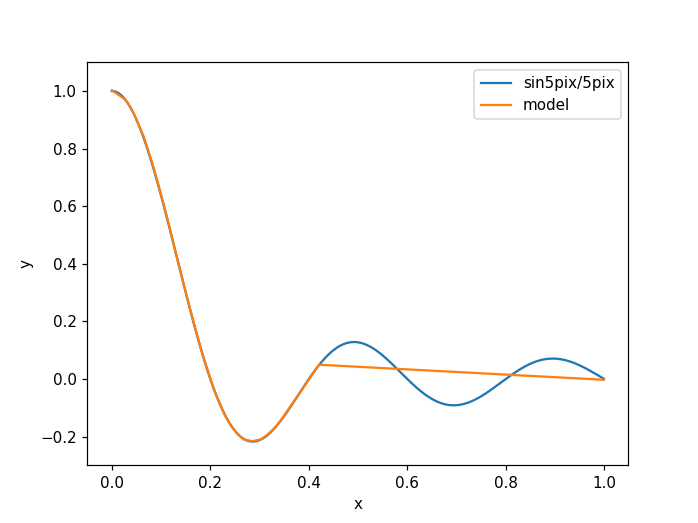

In [14]:
plt.figure()
plt.plot(source, target, label="sin5pix/5pix")
plt.plot(source, predictions[-1], label="model")
plt.xlabel('x')
plt.ylabel('y')
plt.ylim((-0.3, 1.1))
plt.legend(loc='best')
plt.show()

In [15]:
hessians

[[array([[[[ 12.195123  ,  10.665166  , -15.213045  ,  10.208113  ,
            -15.863442  ]],
  
          [[ 10.665162  ,  10.141214  ,  -6.563263  ,   9.899065  ,
             -5.811446  ]],
  
          [[-15.213053  ,  -6.563274  ,  93.02382   ,  -1.2027712 ,
            107.391235  ]],
  
          [[ 10.208119  ,   9.8990755 ,  -1.2027752 ,  10.381181  ,
              0.36720735]],
  
          [[-15.863433  ,  -5.8114405 , 107.391205  ,   0.3672237 ,
            124.50901   ]]]], dtype=float32),
  array([[ 191.65297,  185.48782, -352.0628 ,  133.28491, -376.45712],
         [ 185.48755,  186.38683, -306.4523 ,  132.59933, -323.8045 ],
         [-352.0625 , -306.45242,  995.38635, -193.0445 , 1104.1012 ],
         [ 133.2848 ,  132.5994 , -193.04453,  101.0638 , -200.31837],
         [-376.45758, -323.8055 , 1104.1024 , -200.31886, 1228.7867 ]],
        dtype=float32),
  array([[[[ 1.63264809e+01, -1.05617943e+01,  2.98045349e+00, ...,
             9.56866086e-01,  6.22631192e-

In [16]:
hessian = [[] for _ in range(len(hessians))]
for i, hess in enumerate(hessians):
    for h in hess:
        if len(h.shape) > 2:
            hessian[i].append(h.reshape(h.shape[0]*h.shape[1], h.shape[2]*h.shape[3]))
        else:
            hessian[i].append(h)

In [17]:
eig = [[] for _ in range(len(hessian))]

for i, hess in enumerate(hessian):
    for h in hess:
        eig[i] = np.concatenate([eig[i], np.linalg.eig(h)[0]])

In [18]:
minimal_ratio = [sum(e > 0) / len(e) for e in eig]

In [19]:
minimal_ratio

[0.6357267950963222,
 0.6252189141856392,
 0.6217162872154116,
 0.6199649737302977,
 0.6672504378283712,
 0.6532399299474606,
 0.6147110332749562,
 0.6339754816112084,
 0.6112084063047285,
 0.5971978984238179,
 0.6094570928196147,
 0.6182136602451839,
 0.6147110332749562,
 0.6287215411558669,
 0.6357267950963222,
 0.6392294220665499,
 0.649737302977233,
 0.6217162872154116,
 0.6322241681260946,
 0.6392294220665499,
 0.6672504378283712,
 0.6024518388791593,
 0.6462346760070052,
 0.6514886164623468,
 0.6322241681260946,
 0.647985989492119,
 0.6077057793345009,
 0.6567425569176882,
 0.6409807355516638,
 0.6129597197898424,
 0.6339754816112084,
 0.6532399299474606,
 0.6619964973730298,
 0.6322241681260946,
 0.6287215411558669,
 0.6322241681260946,
 0.6567425569176882,
 0.6514886164623468,
 0.6182136602451839,
 0.6462346760070052,
 0.637478108581436,
 0.6339754816112084,
 0.6042031523642732,
 0.658493870402802,
 0.6287215411558669,
 0.6532399299474606,
 0.6427320490367776,
 0.64798598949211

<IPython.core.display.Javascript object>


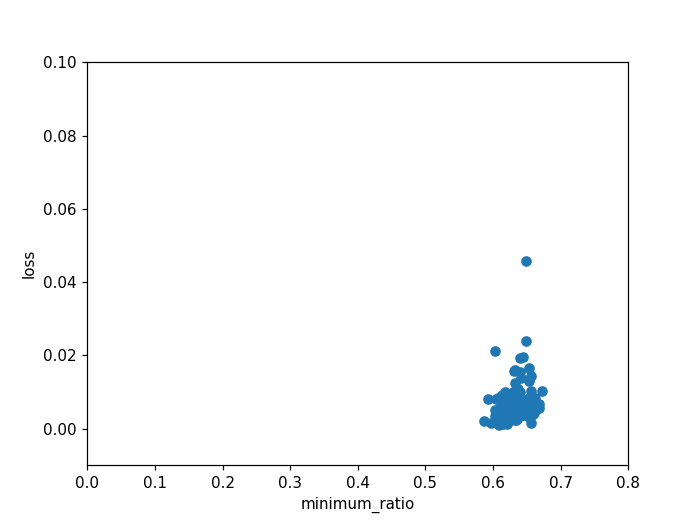

In [23]:
plt.figure()
plt.scatter(minimal_ratio, loss)
plt.xlabel('minimum_ratio')
plt.ylabel('loss')
plt.xlim((0.0, 0.8))
plt.ylim((-0.01, 0.1))
plt.show()